# Introduction

This notebook contains the source code of our Enhanced LwF approach. Our method alleviates Catastrophic Forgetting on an UNet segmentation model using Knowledge DIstillation.

This notebook also contains major Continual Learning experiments I performed over the course of my masters study.

Afterall we tried:

- Regularization:
    - EWC improved
    - MAS improved
    - With meta-heuristics
- Meta-Learning:
    - Pure
    - With regularization
    - With meta-heuristics
- Model Fusion:
    - Pure
    - With meta-heuristcs
- Neural Activation:
    - Output importance
    - Sleep induced learning:
        - With synthetic data abstraction
- Synthetic Data Generation:
    - Synthetic generalization
- Batch Modulation: **New Method**
    - With regularization
    - With meta-heuristics
    - With neural activation
    - With model fusion
    - With meta-learning
        - AND regularization
        - AND model fusion
- Style Transfer

For the only approach to work being:

- LwF:
    - **With improved KD**
    - With regularization
    - With model fusion
    - With meta-learning

In [1]:
#import warnings
#warnings.filterwarnings("error")

In [1]:
import os
import math

import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt

import keras
from keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, ReduceLROnPlateau
from keras.utils import plot_model
from keras import backend as K

from sklearn.model_selection import KFold
from sklearn.utils import check_random_state

import cv2
from PIL import Image
from perlin_noise import PerlinNoise

from tqdm import tqdm

2024-10-09 09:54:37.933151: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-09 09:54:38.046382: E tensorflow/stream_executor/cuda/cuda_blas.cc:2981] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-10-09 09:54:38.599536: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2024-10-09 09:54:38.599598: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or 

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
from unetseg import Unet, BatchModulation
from ContinuousDatasets import *

In [4]:
#os.environ["SM_FRAMEWORK"] = "tf.keras"
import segmentation_models as sm

Segmentation Models: using `keras` framework.


In [5]:
def maskImg(img, threshold):
    mask = img.copy()
    mask[mask <= threshold] = 0#np.nan
    return mask

def plot_mask(img, msk, alpha=0.4, threshold=0):
    fig, axarr = plt.subplots(1,2, figsize=(20, 8))
    
    axarr[0].imshow(img, cmap='viridis', interpolation='None')
    axarr[1].imshow(img, cmap='viridis', interpolation='None')
    axarr[1].imshow(maskImg(msk, threshold), alpha=alpha, cmap='hot', interpolation='None')

    plt.show()

def plot_mask_pred(img, msk, pred, alpha=0.4, threshold=1):
    fig, axarr = plt.subplots(1,3, figsize=(20, 8))
    
    axarr[0].imshow(img, cmap='viridis', interpolation='None')
    axarr[0].imshow(maskImg(msk, threshold), alpha=alpha, cmap='hot', interpolation='None')
    axarr[1].imshow(img, cmap='viridis', interpolation='None')
    axarr[1].imshow(maskImg(pred, threshold), alpha=alpha, cmap='hot', interpolation='None')
    axarr[2].imshow(msk, cmap='viridis', interpolation='None')
    axarr[2].imshow(maskImg(pred, threshold), alpha=alpha, cmap='hot', interpolation='None')

    plt.show()

# Models

In [6]:
BATCH_SIZE = 32
LR = 0.001
EPOCHS = 5

CLASSES = ['metastasis']
n_classes = 1 if len(CLASSES) == 1 else (len(CLASSES) + 1)

In [7]:
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss# + focal_loss

In [8]:
metrics = [dice_loss, sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), sm.metrics.Precision(), sm.metrics.Recall(), tf.keras.metrics.AUC()]

2024-10-09 09:54:44.335598: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-10-09 09:54:44.984303: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1616] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13600 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:41:00.0, compute capability: 7.5


In [9]:
def build_new_model2(styled=False):
    input_shape = (256, 256, 3)
    
    outmodels = Unet(input_shape, styled)
    if styled:
        model2 = outmodels[0]
        smodel = outmodels[1]
    else:
        model2 = outmodels
    
    optim = tf.keras.optimizers.Adam()#0.0001)#0.00001)
    
    dice_loss = sm.losses.DiceLoss()
    focal_loss = sm.losses.BinaryFocalLoss()  #if n_classes == 1 else sm.losses.CategoricalFocalLoss()
    ce_loss = sm.losses.BinaryCELoss()
    #ce_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    total_loss = dice_loss# + focal_loss# + ce_loss
    #total_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)
    
    metrics = [dice_loss, sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), tf.keras.metrics.AUC()]
    
    model2.compile(optimizer=optim, loss=total_loss, metrics=metrics)

    if not styled:
        return model2

    optim2 = tf.keras.optimizers.Adam()
    sloss = keras.losses.SparseCategoricalCrossentropy()
    
    smodel.compile(optimizer=optim2, loss=sloss, metrics=[tf.keras.metrics.AUC()])
    
    return model2, smodel

In [10]:
BACKBONE = 'resnet50'
activation = 'sigmoid' if n_classes == 1 else 'softmax'

preprocess_input = sm.get_preprocessing(BACKBONE)

def build_new_model():
    model = sm.Unet(BACKBONE, classes=n_classes, activation=activation, encoder_freeze=False)#, input_shape=(256, 256, 3))

    #for i in range(len(model.layers)):
    #    if i >= 177 and i <= 189:
    #        #print(model.layers[i].name, i)
    #        model.layers[i].trainable = True
    
    optim = keras.optimizers.Adam(LR)
    
    dice_loss = sm.losses.DiceLoss()
    focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
    total_loss = dice_loss + focal_loss
    
    metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), sm.metrics.Precision(), sm.metrics.Recall(), tf.keras.metrics.AUC()]

    model.compile(optimizer=optim, loss=total_loss, metrics=metrics)
    
    return model

## Auxiliary functions

In [11]:
def clone_model(model):
    new_model = tf.keras.models.clone_model(model)
    new_model.set_weights(model.get_weights())
    return new_model
    
def evaluate_tsk(model, task_list, custom_eval=False):
    global metrics
    mean_metric = 0.0
    mean_metric2 = 0.0
    mets = []
    ti = 0
    for task in task_list:
        task[0].quick_eval = True
        task[1].quick_eval = True
        if type(task) is tuple:
            if not custom_eval:
                evals = model.evaluate(task[1])
                mets.append(evals)
                mean_metric += evals[0]
                mean_metric2 += evals[-1]
            else:
                mms = None
                for x_v, y_v in ds_val:
                    y_v = tf.Variable(y_v, dtype='float32')
                    preds = model(x_v, training=False)
                    #print(x_v.shape)
                    #print(preds.get_shape())
                    #print(y_v.shape)
                    #print((preds * y_v).get_shape())
                    mts = np.array([metric_fn(y_v, y_v*preds) for metric_fn in metrics])
                    print(mts)
                    #mts = np.array(model.evaluate(x_v, y_v, verbose=0))
                    if mms is None:
                        mms = mts
                    else:
                        mms = mms + mts
                #print(mms)
                #print(len(ds_val))
                mms = mms / len(ds_val)
                print('Custom', ti, mms)
                mean_metric += mms[0]
                mean_metric2 += mms[-1]
        else:
            evals = model.evaluate(task)
            mets.append(evals)
            mean_metric += evals[0]
            mean_metric2 += evals[-1]
        task[0].quick_eval = False
        task[1].quick_eval = False
        ti += 1
    print('Mean 1st metric: ', mean_metric/len(task_list))
    print('Mean last metric: ', mean_metric2/len(task_list))
    return mets

# Datasets

## Used Datasets loading

In [12]:
all_types = ['Adrenal_gland','Bile-duct','Bladder','Breast','Cervix','Colon','Esophagus','HeadNeck','Kidney','Liver','Lung','Ovarian','Pancreatic','Prostate','Skin','Stomach','Testis','Thyroid','Uterus']
print(len(all_types))

for i in range(len(all_types)):
    type_cancer = all_types[i]
    print(i, type_cancer, len(os.listdir('Cancer_Segmentation/'+type_cancer)))

19
0 Adrenal_gland 874
1 Bile-duct 840
2 Bladder 292
3 Breast 4702
4 Cervix 586
5 Colon 2880
6 Esophagus 848
7 HeadNeck 768
8 Kidney 268
9 Liver 448
10 Lung 368
11 Ovarian 292
12 Pancreatic 390
13 Prostate 364
14 Skin 374
15 Stomach 292
16 Testis 392
17 Thyroid 452
18 Uterus 372


In [13]:
lyn_train_ids, lyn_val_ids = split_lynsec(split=0.5)

lyn_train = DataloderLynSec(ids=lyn_train_ids, batch_size=BATCH_SIZE, shuffle=True)
lyn_val = DataloderLynSec(ids=lyn_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('LYN', len(lyn_train), len(lyn_val))

LYN 5 5


## More Datasets loading

In [19]:
t1_train_ids, t1_val_ids = split_canser_seg(all_types[:1], split=0.7)
t2_train_ids, t2_val_ids = split_canser_seg(all_types[1:2], split=0.7)
t3_train_ids, t3_val_ids = split_canser_seg(all_types[2:3], split=0.7)
t4_train_ids, t4_val_ids = split_canser_seg(all_types[4:5], split=0.7)
t5_train_ids, t5_val_ids = split_canser_seg(all_types[5:6], split=0.7)
t6_train_ids, t6_val_ids = split_canser_seg(all_types[6:7], split=0.7)

t1_canseg_train = DataloderCancerSeg(ids=t1_train_ids, batch_size=BATCH_SIZE, shuffle=True)
t1_canseg_val = DataloderCancerSeg(ids=t1_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('T1', len(t1_canseg_train), len(t1_canseg_val))

t2_canseg_train = DataloderCancerSeg(ids=t2_train_ids, batch_size=BATCH_SIZE, shuffle=True)
t2_canseg_val = DataloderCancerSeg(ids=t2_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('T2', len(t2_canseg_train), len(t2_canseg_val))

t3_canseg_train = DataloderCancerSeg(ids=t3_train_ids, batch_size=BATCH_SIZE, shuffle=True)
t3_canseg_val = DataloderCancerSeg(ids=t3_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('T3', len(t3_canseg_train), len(t3_canseg_val))

t4_canseg_train = DataloderCancerSeg(ids=t4_train_ids, batch_size=BATCH_SIZE, shuffle=True)
t4_canseg_val = DataloderCancerSeg(ids=t4_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('T4', len(t4_canseg_train), len(t4_canseg_val))

t5_canseg_train = DataloderCancerSeg(ids=t5_train_ids, batch_size=BATCH_SIZE, shuffle=True)
t5_canseg_val = DataloderCancerSeg(ids=t5_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('T5', len(t5_canseg_train), len(t5_canseg_val))

t6_canseg_train = DataloderCancerSeg(ids=t6_train_ids, batch_size=BATCH_SIZE, shuffle=True)
t6_canseg_val = DataloderCancerSeg(ids=t6_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('T6', len(t6_canseg_train), len(t6_canseg_val))

T1 9 4
T2 9 3
T3 3 1
T4 6 2
T5 31 13
T6 9 4


In [20]:
print(t1_canseg_train[0][0].shape)
print(t1_canseg_train[0][1].shape)

(32, 256, 256, 3)
(32, 256, 256, 1)


In [21]:
x_train_dir_t = 'segmentation_without_full_positive_center112_level3/image/img'
y_train_dir_t = 'segmentation_without_full_positive_center112_level3/mask/img'
x_valid_dir_t = 'segmentation_without_full_positive_center112_level3/image/img'
y_valid_dir_t = 'segmentation_without_full_positive_center112_level3/mask/img'
train_start_index=0
train_end_index=1000
#train_end_index=3494
val_start_index=3494
val_end_index=None

In [22]:
tds_velho = DatasetVelho(x_train_dir_t, y_train_dir_t, start_index=train_start_index, end_index=train_end_index)
vds_velho = DatasetVelho(x_valid_dir_t, y_valid_dir_t, start_index=val_start_index, end_index=val_end_index)
tdl_velho = DataloderVelho(tds_velho, batch_size=BATCH_SIZE)
vdl_velho = DataloderVelho(vds_velho, batch_size=BATCH_SIZE)

In [23]:
print('VELHO', len(tdl_velho), len(vdl_velho))

VELHO 31 32


In [24]:
print(tdl_velho[0][0].shape)
print(tdl_velho[0][1].shape)

(32, 256, 256, 3)
(32, 256, 256, 1)


In [27]:
bcss_train_ids, bcss_val_ids = split_bcss(split=0.5)

bcss_train = DataloderBCSS(ids=bcss_train_ids, batch_size=BATCH_SIZE, shuffle=True)
bcss_val = DataloderBCSS(ids=bcss_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('BCSS', len(bcss_train), len(bcss_val))

BCSS 225 225


In [28]:
print(bcss_train[0][0].shape)
print(bcss_train[0][1].shape)

(32, 256, 256, 3)
(32, 256, 256, 1)


In [29]:
lung_train_ids, lung_val_ids = split_lung(split=0.5)

lung_train = DataloderLung(ids=lung_train_ids, batch_size=BATCH_SIZE, shuffle=True)
lung_val = DataloderLung(ids=lung_val_ids, batch_size=BATCH_SIZE, shuffle=True)
print('Lung', len(lung_train), len(lung_val))

Lung 17 17


In [30]:
print(lung_train[0][0].shape)
print(lung_train[0][1].shape)

(32, 256, 256, 3)
(32, 256, 256, 1)


## Visualizations

In [217]:
print(lung_train[0][0][3].max())
print(lung_train[0][1][3].max())
print(np.unique(lung_train[0][1][3]))

1.0
1.0
[0. 1.]


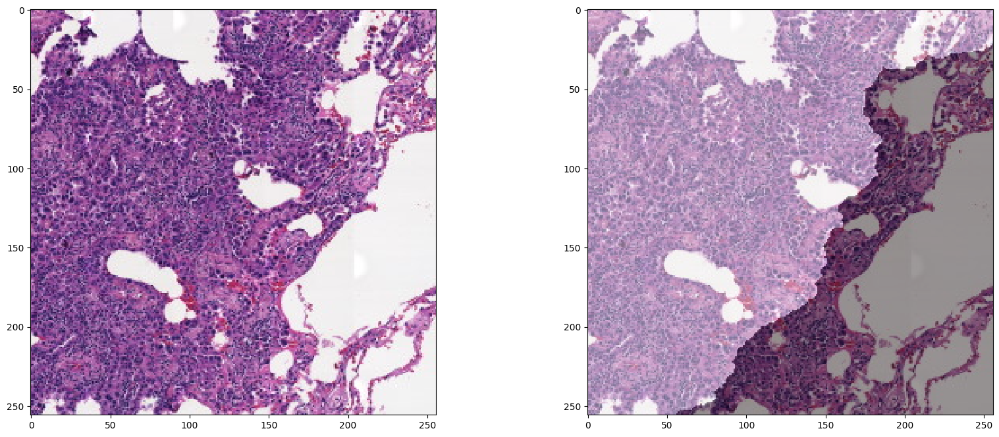

In [224]:
plot_mask(lung_train[0][0][0], lung_train[0][1][0])

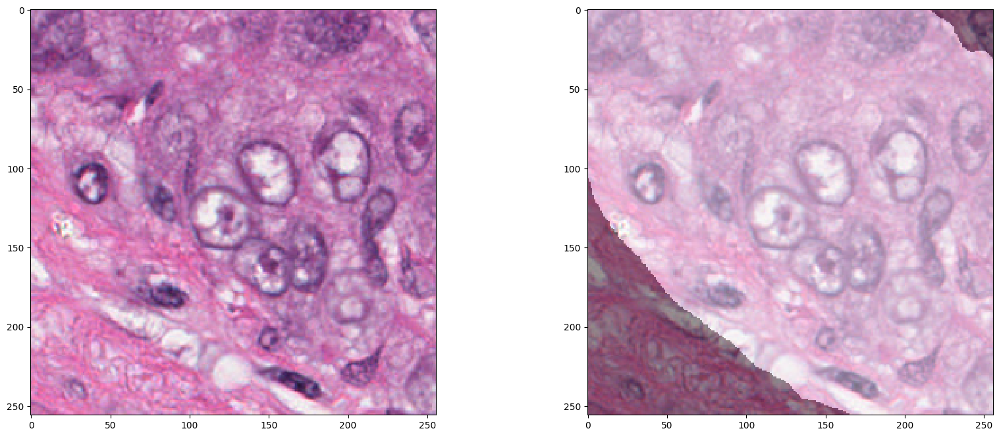

In [202]:
plot_mask(bcss_train[0][0][0], bcss_train[0][1][0])

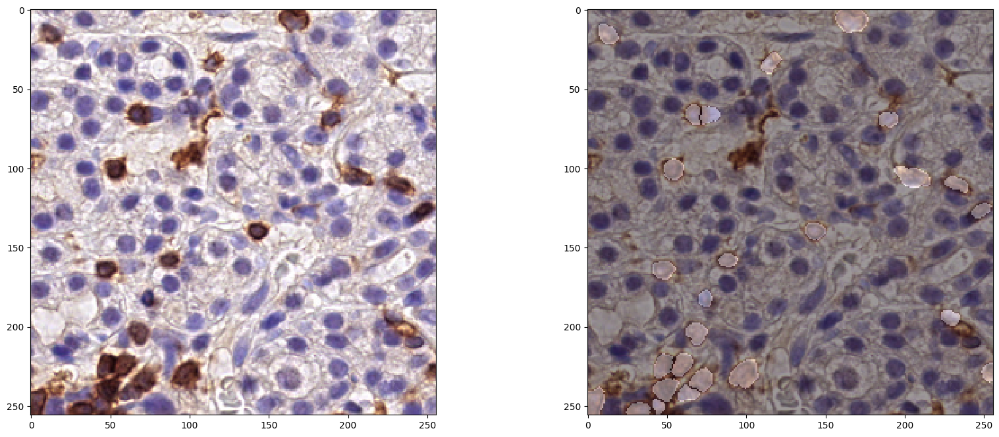

In [194]:
plot_mask(lyn_train[0][0][0], lyn_train[0][1][0])

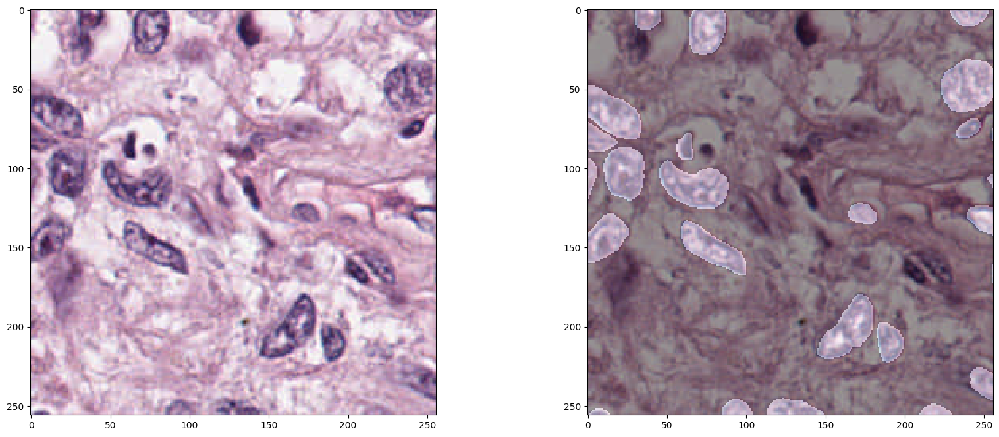

In [158]:
plot_mask(t1_canseg_train[0][0][0], t1_canseg_train[0][1][0])

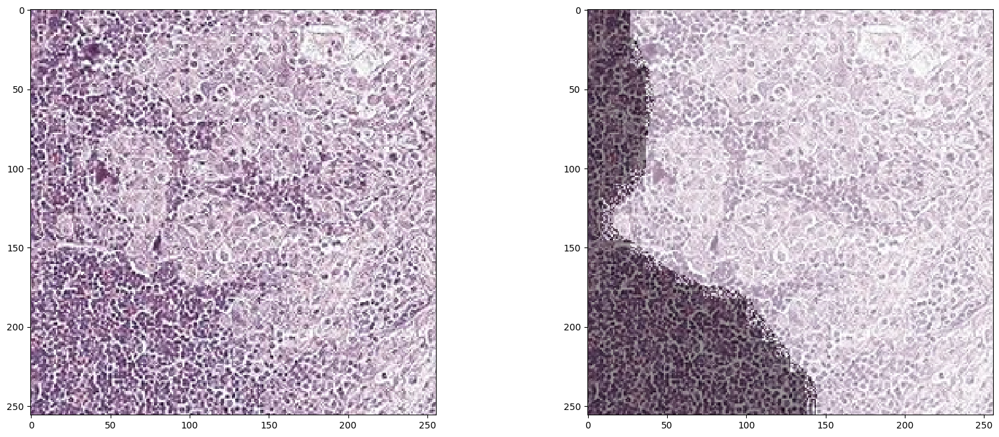

In [154]:
plot_mask(tdl_velho[0][0][3], tdl_velho[0][1][3])

In [69]:
plt.imshow(model(t1_canseg_val[0][0][1:2])[0])

NameError: name 'model' is not defined

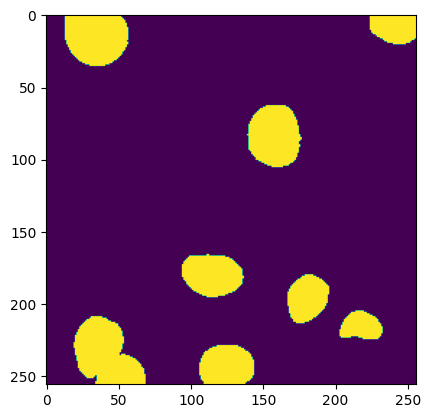

In [92]:
plt.imshow(t1_canseg_val[0][1][1])

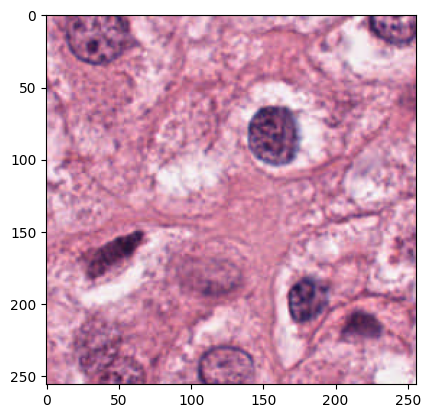

In [91]:
plt.imshow(t1_canseg_val[0][0][1])

# Continuoal Learning Baselines

## MAS (Memory Aware Synapses)

https://github.com/ContinualAI/avalanche/blob/2d289fa146e167a77555ceba35aa48dc215b43e6/avalanche/training/plugins/mas.py#L12

In [68]:
def compute_MAS_matrix(model, loss, ds_train):
    avg_delta = None

    #mseloss = tf.keras.losses.MSE()#(y_true, y_pred)
    
    for x, y in tqdm(ds_train):
        y = tf.Variable(y, dtype='float32')
        with tf.GradientTape(persistent=True) as tape:
            logits = model(x, training=True)
            # tf.math.reduce_max(logits, axis=1)
            #loss_value = tf.keras.losses.MSE(tf.zeros(logits.shape), logits)
            
            #loss_value = tf.math.reduce_mean(tf.math.pow(tf.math.l2_normalize(logits), tf.constant(2.0)))
            #loss_value = tf.math.reduce_mean(tf.math.pow(logits, tf.constant(2.0)))
            loss_value = tf.math.reduce_mean(tf.norm(tf.concat(logits,1), 2, 1))

        grads = tape.gradient(loss_value, model.trainable_weights)
        del tape

        for g in range(len(grads)):
            if grads[g] is None:
                grads[g] = np.zeros(model.trainable_weights[g].shape)
        
        if avg_delta is None:
            avg_delta = []
            for i in range(len(grads)):
                avg_delta.append(np.absolute(grads[i]))
        else:
            for i in range(len(grads)):
                avg_delta[i] = avg_delta[i] + np.absolute(grads[i])
    
    for i in range(len(avg_delta)):
        avg_delta[i] = avg_delta[i] / len(ds_train)
    
    return avg_delta

def MAS_loss(model, loss, fim, prev_params, lambd): 
    
    def custom_loss(y_true, y_pred):
        normal_loss=loss(y_true,y_pred)

        regularization_value=tf.constant([0.])
        for layer in range(len(fim)):
            regularization_value += tf.reduce_sum(fim[layer] * tf.math.pow(tf.math.abs(prev_params[layer]-model.trainable_variables[layer]), tf.constant(2.0)))

        return normal_loss+regularization_value * lambd
    
    return custom_loss

## EWC (Elastic Weight COnsolidation)

In [69]:
def compute_fisher_matrix(model, task_set, batch_size):
  # Build fisher matrixes dictionary: at each key it will store the Fisher matrix for a particular layer
  fisher_matrixes = {n: tf.zeros_like(p.value()) for n, p in enumerate(model.trainable_variables)}
    
  #for i, (imgs, labels) in enumerate(task_set.take(batch_size)):
  for imgs, labels in task_set:#tqdm(task_set):
    # Initialize gradients storage
    with tf.GradientTape() as tape:
      # Compute the predictions (recall: we will just take the prediction from the head related to the actual task)
      #preds = model(imgs)[task_id]
      preds = model(imgs)

      # Compute the logarithm of the predictions
      ll= tf.math.log(preds)

    # Attach gradients over the log_likelihood to log_likelihood_grads
    ll_grads  = tape.gradient(ll, model.trainable_variables)
      
    # Compute Fisher matrix at each layer (if existing)
    for i, gradients in enumerate(ll_grads):
        if gradients != None:
            fisher_matrixes[i] += tf.math.reduce_mean(gradients ** 2, axis=0) / batch_size
  return fisher_matrixes

def EWC_loss(model, loss, fim, prev_params, lambd):

    def custom_loss(y_true, y_pred):
        normal_loss=loss(y_true, y_pred)

        regularization = tf.constant([0.])
        for layer in range(len(fim)):
            regularization += tf.reduce_sum(fim[layer]*(prev_params[layer]-model.trainable_variables[layer])**2)

        # Return the standard cross entropy loss + EWC regularization
        return normal_loss + regularization * lambd
    
    return custom_loss

## EWC 2 (no exploding gradient)

In [15]:
def compute_EWC2_matrix(model, loss, ds_train):
    avg_delta = None
    max_delta = None
    min_delta = None
    
    for x, y in tqdm(ds_train):
        y = tf.Variable(y, dtype='float32')
        with tf.GradientTape(persistent=True) as tape:
            logits = model(x, training=True)
            #loss_value = loss(y, logits[task_id])
            #print(y.shape, y.dtype)
            #print(logits.shape, logits.dtype)
            loss_value = loss(y, logits)

        grads = tape.gradient(loss_value, model.trainable_weights)
        del tape

        for g in range(len(grads)):
            if grads[g] is None:
                grads[g] = np.zeros(model.trainable_weights[g].shape)
        
        if avg_delta is None:
            avg_delta = []
            for i in range(len(grads)):
                avg_delta.append(np.absolute(grads[i]))
            #avg_delta = np.absolute(grads)
            max_delta = grads.copy()
            min_delta = grads.copy()
        else:
            for i in range(len(grads)):
                avg_delta[i] = avg_delta[i] + np.absolute(grads[i])
                max_delta[i] = np.max((max_delta[i], grads[i]), axis=0)
                min_delta[i] = np.min((min_delta[i], grads[i]), axis=0)

    diff_delta = avg_delta.copy()
    final_delta = avg_delta.copy()
    
    for i in range(len(avg_delta)):
        avg_delta[i] = avg_delta[i] / len(ds_train)
        diff_delta[i] = np.absolute(max_delta[i] - min_delta[i])
        final_delta[i] = avg_delta[i] #+ diff_delta[i] + np.absolute(model.trainable_weights[i])
    #max_a = 0
    #for i in range(len(avg_delta)):
    #    max_a = np.max((max_a, np.max(np.absolute(avg_delta[i]))))
    #avg_delta = np.absolute(avg_delta) / max_a
    
    
    #diff_delta = np.absolute(np.absolute(max_delta) - np.absolute(min_delta))
    #max_d = 0
    #for i in range(len(diff_delta)):
    #    max_d = np.max((max_d, np.max(np.absolute(diff_delta[i]))))
    #diff_delta = np.absolute(diff_delta) / max_d
    
    #max_w = 0
    #for i in range(len(model.trainable_weights)):
    #    max_w = np.max((max_w, np.max(np.absolute(model.trainable_weights[i]))))
    #final_weight = np.absolute(model.trainable_weights) / max_w
    
    #final_delta = avg_delta + diff_delta + np.absolute(model.trainable_weights) #  + final_weight 
    
    max_scale = 0
    for i in range(len(final_delta)):
        max_scale = np.max((max_scale, np.max(final_delta[i])))

    importance = final_delta.copy()
    for i in range(len(final_delta)):
        importance[i] = 1 - (final_delta[i] * 100)#/ max_scale)
    
    ##importance = avg_delta + diff_delta + final_weight
    
    return importance#, final_delta, avg_delta, diff_delta

def EWC2_loss(model, loss, fim, prev_params): 
    
    def custom_loss(y_true, y_pred):
        normal_loss=loss(y_true,y_pred)

        regularization_value=tf.constant([0.])
        for layer in range(len(fim)):
            regularization_value += tf.reduce_sum(fim[layer] * tf.math.abs(prev_params[layer]-model.trainable_variables[layer]))

        return normal_loss+regularization_value
    
    return custom_loss

## Auxiliary Train Function

In [70]:
def fit_multi_segmentation(train, val, batch_size, model, loss, optimizer, metrics, epochs, fim, prev_params, lambd=100, ewc=1):
    loss_fn = loss
    if fim is not None:
        if ewc == 0:
            loss_fn = MAS_loss(model, loss, fim, prev_params, lambd)
        elif ewc == 1:
            loss_fn = EWC_loss(model, loss, fim, prev_params, lambd)
        elif ewc == 2:
            loss_fn = EWC2_loss(model, loss, fim, prev_params)
    
    model.compile(loss=loss_fn, optimizer=optimizer, metrics=metrics)
    #model.fit(train, validation_data=val, epochs=epochs)
    model.fit(
        train,
        steps_per_epoch=len(train), 
        epochs=epochs, 
        validation_data=val, 
        validation_steps=len(val),
    )

    prev_params = [tf.identity(model.trainable_variables[layer]) for layer in range(len(model.trainable_variables))]

    if ewc == 0:
        new_fim = compute_MAS_matrix(model, loss, val)
    elif ewc == 1:
        new_fim = compute_fisher_matrix(model, val, batch_size=batch_size)
    elif ewc == 2:
        new_fim = compute_EWC2_matrix(model, loss, val)
    
    if fim is None:
        fim = new_fim.copy()
    else:
        if ewc == 0:
            for layer in range(len(fim)):
                #fim[layer] = (0.5 * fim[layer]) + (0.5 * new_fim[layer])
                fim[layer] = fim[layer] + new_fim[layer]
        else:
            for layer in range(len(fim)):
                fim[layer] = fim[layer] + new_fim[layer]

    return fim, prev_params

# Experiments with TWO datasets

In [ ]:
mult_model = clone_model(model)

optim = keras.optimizers.Adam(LR)
    
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + focal_loss
    
metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), sm.metrics.Precision(), sm.metrics.Recall(), tf.keras.metrics.AUC()]

In [48]:
%%time
#fim = compute_fisher_matrix(mult_model, t1_canseg_val, BATCH_SIZE) # 1min 39s
fim = compute_EWC2_matrix(mult_model, total_loss, t1_canseg_val) # 17.4 s

prev_params = [tf.identity(mult_model.trainable_variables[layer]) for layer in range(len(mult_model.trainable_variables))]

100%|█████████████████████████████████████████████████████████████████████████████████████| 9/9 [00:18<00:00,  2.08s/it]

CPU times: user 3min 25s, sys: 1min 35s, total: 5min 1s
Wall time: 18.9 s


## New task EWC 1

In [43]:
%%time
fim, prev_params = fit_multi_segmentation(t2_canseg_train, t2_canseg_val, BATCH_SIZE, mult_model, total_loss, optim, metrics, 5, fim, prev_params, lambd=100)

Epoch 1/5
89/89 [==============================] - 618s 7s/step - loss: 12058606.0000 - iou_score: 0.3445 - f1-score: 0.5069 - precision: 0.4635 - recall: 0.5416 - auc_5: 0.8415 - val_loss: 673.1726 - val_iou_score: 0.3230 - val_f1-score: 0.4853 - val_precision: 0.4255 - val_recall: 0.5414 - val_auc_5: 0.8464
Epoch 2/5
89/89 [==============================] - 613s 7s/step - loss: 1297.0251 - iou_score: 0.3444 - f1-score: 0.5069 - precision: 0.4634 - recall: 0.5418 - auc_5: 0.8415 - val_loss: 4.2109 - val_iou_score: 0.2987 - val_f1-score: 0.4565 - val_precision: 0.4324 - val_recall: 0.4671 - val_auc_5: 0.8079
Epoch 3/5
89/89 [==============================] - 612s 7s/step - loss: 1.7161 - iou_score: 0.3444 - f1-score: 0.5069 - precision: 0.4634 - recall: 0.5418 - auc_5: 0.8415 - val_loss: 1.8324 - val_iou_score: 0.3313 - val_f1-score: 0.4948 - val_precision: 0.4389 - val_recall: 0.5474 - val_auc_5: 0.8354
Epoch 4/5
89/89 [==============================] - 613s 7s/step - loss: 1.5180 - i

In [44]:
mult_model.evaluate(t1_canseg_val)

9/9 [==============================] - 13s 1s/step - loss: 1.3013 - iou_score: 0.4965 - f1-score: 0.6614 - precision: 0.5035 - recall: 0.9131 - auc_5: 0.9671


[1.301316261291504,
 0.49651017785072327,
 0.6613838076591492,
 0.5034521818161011,
 0.9131280183792114,
 0.9670956134796143]

In [45]:
mult_model.evaluate(t2_canseg_val)

38/38 [==============================] - 55s 1s/step - loss: 1.5230 - iou_score: 0.3265 - f1-score: 0.4897 - precision: 0.4016 - recall: 0.6078 - auc_5: 0.8527


[1.5229917764663696,
 0.32652392983436584,
 0.48968255519866943,
 0.40158355236053467,
 0.6078248620033264,
 0.852726399898529]

## New task EWC 2

In [49]:
%%time
fim, prev_params = fit_multi_segmentation(t2_canseg_train, t2_canseg_val, BATCH_SIZE, mult_model, total_loss, optim, metrics, 5, fim, prev_params, lambd=100)

Epoch 1/5
89/89 [==============================] - 621s 7s/step - loss: 147.6969 - iou_score: 0.3443 - f1-score: 0.5067 - precision: 0.4633 - recall: 0.5416 - auc_6: 0.8413 - val_loss: 128.0370 - val_iou_score: 0.3356 - val_f1-score: 0.4997 - val_precision: 0.4916 - val_recall: 0.4862 - val_auc_6: 0.8265
Epoch 2/5
89/89 [==============================] - 615s 7s/step - loss: 113.5796 - iou_score: 0.3446 - f1-score: 0.5071 - precision: 0.4637 - recall: 0.5419 - auc_6: 0.8417 - val_loss: 125.5648 - val_iou_score: 0.2881 - val_f1-score: 0.4438 - val_precision: 0.4208 - val_recall: 0.4580 - val_auc_6: 0.7780
Epoch 3/5
89/89 [==============================] - 615s 7s/step - loss: 112.5324 - iou_score: 0.3446 - f1-score: 0.5071 - precision: 0.4637 - recall: 0.5419 - auc_6: 0.8416 - val_loss: 117.6025 - val_iou_score: 0.3224 - val_f1-score: 0.4848 - val_precision: 0.4185 - val_recall: 0.5589 - val_auc_6: 0.8296
Epoch 4/5
89/89 [==============================] - 613s 7s/step - loss: 112.0722 -

100%|███████████████████████████████████████████████████████████████████████████████████| 38/38 [01:08<00:00,  1.81s/it]

CPU times: user 14h 33min 10s, sys: 2h 12min 37s, total: 16h 45min 48s
Wall time: 52min 25s


In [50]:
mult_model.evaluate(t1_canseg_val)

9/9 [==============================] - 13s 1s/step - loss: 87.9019 - iou_score: 0.6105 - f1-score: 0.7572 - precision: 0.7013 - recall: 0.7722 - auc_6: 0.9496


[87.90188598632812,
 0.6105495691299438,
 0.7571718692779541,
 0.7012906670570374,
 0.7722074389457703,
 0.9495645761489868]

In [51]:
mult_model.evaluate(t2_canseg_val)

38/38 [==============================] - 55s 1s/step - loss: 88.2417 - iou_score: 0.3320 - f1-score: 0.4952 - precision: 0.5098 - recall: 0.4645 - auc_6: 0.8039


[88.24166870117188,
 0.3319731652736664,
 0.4952329397201538,
 0.5097591280937195,
 0.4645255208015442,
 0.8039275407791138]

## Old task

In [28]:
model.evaluate(t1_canseg_val)

9/9 [==============================] - 13s 1s/step - loss: 0.2988 - iou_score: 0.6310 - f1-score: 0.7729 - auc: 0.9518


[0.29880213737487793,
 0.6309905648231506,
 0.7729209065437317,
 0.9518114328384399]

In [29]:
model.evaluate(t2_canseg_val)

38/38 [==============================] - 54s 1s/step - loss: 0.7136 - iou_score: 0.2519 - f1-score: 0.3990 - auc: 0.7495


[0.7136082649230957,
 0.2518825829029083,
 0.39902663230895996,
 0.7494609355926514]

# Experiments with FIVE datasets

In [18]:
model_mt = build_new_model2()

optim = keras.optimizers.Adam(LR)
    
dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + focal_loss
    
metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), sm.metrics.Precision(), sm.metrics.Recall(), tf.keras.metrics.AUC()]

fim = None
prev_params = None

2024-02-21 10:46:32.617985: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2256] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


In [19]:
def evaluate_mt(model):
    model.evaluate(t1_canseg_val)
    model.evaluate(t2_canseg_val)
    model.evaluate(t3_canseg_val)
    model.evaluate(t4_canseg_val)
    model.evaluate(t5_canseg_val)

## EWC 1

In [55]:
%%time
fim, prev_params = fit_multi_segmentation(t1_canseg_train, t1_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=1)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t2_canseg_train, t2_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=1)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t3_canseg_train, t3_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=1)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t4_canseg_train, t4_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=1)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t5_canseg_train, t5_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=1)
evaluate_mt(model_mt)

Epoch 1/5
9/9 [==============================] - 66s 7s/step - loss: 1.2166 - iou_score: 0.0969 - f1-score: 0.1755 - precision: 0.0966 - recall: 0.5259 - auc_7: 0.5544 - val_loss: 1.1533 - val_iou_score: 0.1269 - val_f1-score: 0.2251 - val_precision: 0.1143 - val_recall: 0.6540 - val_auc_7: 0.6869
Epoch 2/5
9/9 [==============================] - 62s 7s/step - loss: 1.0827 - iou_score: 0.1315 - f1-score: 0.2321 - precision: 0.1164 - recall: 0.6409 - auc_7: 0.6934 - val_loss: 1.0157 - val_iou_score: 0.1400 - val_f1-score: 0.2455 - val_precision: 0.1192 - val_recall: 0.6578 - val_auc_7: 0.7339
Epoch 3/5
9/9 [==============================] - 62s 7s/step - loss: 0.9839 - iou_score: 0.1574 - f1-score: 0.2710 - precision: 0.1288 - recall: 0.7060 - auc_7: 0.7889 - val_loss: 0.9473 - val_iou_score: 0.1852 - val_f1-score: 0.3124 - val_precision: 0.1436 - val_recall: 0.7982 - val_auc_7: 0.8754
Epoch 4/5
9/9 [==============================] - 62s 7s/step - loss: 0.9212 - iou_score: 0.2040 - f1-sc

## EWC 2

In [19]:
%%time
fim, prev_params = fit_multi_segmentation(t1_canseg_train, t1_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t2_canseg_train, t2_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t3_canseg_train, t3_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t4_canseg_train, t4_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
evaluate_mt(model_mt)
fim, prev_params = fit_multi_segmentation(t5_canseg_train, t5_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
evaluate_mt(model_mt)

Epoch 1/5
9/9 [==============================] - 69s 7s/step - loss: 1.1268 - iou_score: 0.1124 - f1-score: 0.2012 - precision: 0.1062 - recall: 0.6008 - auc_1: 0.6283 - val_loss: 1.0510 - val_iou_score: 0.1421 - val_f1-score: 0.2479 - val_precision: 0.1219 - val_recall: 0.6609 - val_auc_1: 0.7242
Epoch 2/5
9/9 [==============================] - 63s 7s/step - loss: 1.0372 - iou_score: 0.1360 - f1-score: 0.2392 - precision: 0.1173 - recall: 0.6607 - auc_1: 0.7267 - val_loss: 1.0052 - val_iou_score: 0.1447 - val_f1-score: 0.2522 - val_precision: 0.1220 - val_recall: 0.6898 - val_auc_1: 0.7719
Epoch 3/5
9/9 [==============================] - 63s 7s/step - loss: 0.9721 - iou_score: 0.1553 - f1-score: 0.2682 - precision: 0.1262 - recall: 0.7063 - auc_1: 0.8033 - val_loss: 0.9326 - val_iou_score: 0.1852 - val_f1-score: 0.3117 - val_precision: 0.1422 - val_recall: 0.7691 - val_auc_1: 0.8652
Epoch 4/5
9/9 [==============================] - 63s 7s/step - loss: 0.9187 - iou_score: 0.1955 - f1-sc

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:47<00:00, 11.90s/it]


13/13 [==============================] - 19s 1s/step - loss: 0.9953 - iou_score: 0.0283 - f1-score: 0.0543 - precision: 0.0403 - recall: 0.3042 - auc_1: 0.3815
Epoch 1/5
9/9 [==============================] - 68s 7s/step - loss: 243.2572 - iou_score: 0.1758 - f1-score: 0.2981 - precision: 0.1167 - recall: 0.6997 - auc_1: 0.6141 - val_loss: 179.1823 - val_iou_score: 0.1638 - val_f1-score: 0.2800 - val_precision: 0.1074 - val_recall: 0.7729 - val_auc_1: 0.8457
Epoch 2/5
9/9 [==============================] - 62s 7s/step - loss: 175.9267 - iou_score: 0.1900 - f1-score: 0.3186 - precision: 0.1211 - recall: 0.7232 - auc_1: 0.8230 - val_loss: 139.1046 - val_iou_score: 0.1702 - val_f1-score: 0.2893 - val_precision: 0.1096 - val_recall: 0.7777 - val_auc_1: 0.8521
Epoch 3/5
9/9 [==============================] - 61s 7s/step - loss: 143.0471 - iou_score: 0.2007 - f1-score: 0.3333 - precision: 0.1252 - recall: 0.7420 - auc_1: 0.8400 - val_loss: 133.7236 - val_iou_score: 0.1774 - val_f1-score: 0.2

100%|█████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:34<00:00, 11.58s/it]


13/13 [==============================] - 19s 1s/step - loss: 117.1502 - iou_score: 0.0353 - f1-score: 0.0677 - precision: 0.0440 - recall: 0.3365 - auc_1: 0.4619
Epoch 1/5
3/3 [==============================] - 27s 8s/step - loss: 166.6873 - iou_score: 0.2572 - f1-score: 0.4074 - precision: 0.1533 - recall: 0.7440 - auc_1: 0.5900 - val_loss: 264.7382 - val_iou_score: 0.2661 - val_f1-score: 0.4203 - val_precision: 0.1523 - val_recall: 0.7680 - val_auc_1: 0.8822
Epoch 2/5
3/3 [==============================] - 20s 7s/step - loss: 181.0591 - iou_score: 0.2590 - f1-score: 0.4094 - precision: 0.1540 - recall: 0.7461 - auc_1: 0.8598 - val_loss: 225.9932 - val_iou_score: 0.2364 - val_f1-score: 0.3823 - val_precision: 0.1457 - val_recall: 0.7638 - val_auc_1: 0.8652
Epoch 3/5
3/3 [==============================] - 21s 7s/step - loss: 206.9344 - iou_score: 0.2592 - f1-score: 0.4092 - precision: 0.1541 - recall: 0.7437 - auc_1: 0.8593 - val_loss: 166.0221 - val_iou_score: 0.2726 - val_f1-score: 0

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:11<00:00, 11.53s/it]


13/13 [==============================] - 18s 1s/step - loss: 219.9053 - iou_score: 0.0510 - f1-score: 0.0962 - precision: 0.0453 - recall: 0.3526 - auc_1: 0.4765
Epoch 1/5
6/6 [==============================] - 48s 7s/step - loss: 342.6140 - iou_score: 0.2828 - f1-score: 0.4398 - precision: 0.2033 - recall: 0.6760 - auc_1: 0.6766 - val_loss: 522.8143 - val_iou_score: 0.2384 - val_f1-score: 0.3842 - val_precision: 0.1855 - val_recall: 0.6014 - val_auc_1: 0.7345
Epoch 2/5
6/6 [==============================] - 41s 7s/step - loss: 394.8843 - iou_score: 0.2903 - f1-score: 0.4488 - precision: 0.2065 - recall: 0.6847 - auc_1: 0.8065 - val_loss: 276.3171 - val_iou_score: 0.2595 - val_f1-score: 0.4096 - val_precision: 0.1950 - val_recall: 0.6718 - val_auc_1: 0.7806
Epoch 3/5
6/6 [==============================] - 40s 7s/step - loss: 270.1885 - iou_score: 0.2960 - f1-score: 0.4556 - precision: 0.2093 - recall: 0.6912 - auc_1: 0.8129 - val_loss: 282.7817 - val_iou_score: 0.2632 - val_f1-score: 0

100%|█████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:23<00:00, 11.59s/it]


13/13 [==============================] - 19s 1s/step - loss: 122.0048 - iou_score: 0.0808 - f1-score: 0.1472 - precision: 0.0571 - recall: 0.4155 - auc_1: 0.6684
Epoch 1/5
31/31 [==============================] - 220s 7s/step - loss: 805.1217 - iou_score: 0.0710 - f1-score: 0.1308 - precision: 0.0567 - recall: 0.5459 - auc_1: 0.6510 - val_loss: 225.2058 - val_iou_score: 0.0671 - val_f1-score: 0.1235 - val_precision: 0.0571 - val_recall: 0.5270 - val_auc_1: 0.6304
Epoch 2/5
31/31 [==============================] - 214s 7s/step - loss: 458.7517 - iou_score: 0.0762 - f1-score: 0.1396 - precision: 0.0591 - recall: 0.5606 - auc_1: 0.6616 - val_loss: 81.9580 - val_iou_score: 0.0709 - val_f1-score: 0.1302 - val_precision: 0.0597 - val_recall: 0.5903 - val_auc_1: 0.6484
Epoch 3/5
31/31 [==============================] - 214s 7s/step - loss: 361.4481 - iou_score: 0.0804 - f1-score: 0.1468 - precision: 0.0609 - recall: 0.5679 - auc_1: 0.6698 - val_loss: 281.1330 - val_iou_score: 0.0815 - val_f1-

100%|███████████████████████████████████████████████████████████████████████████████████| 13/13 [02:28<00:00, 11.43s/it]


13/13 [==============================] - 19s 1s/step - loss: 104.0614 - iou_score: 0.0909 - f1-score: 0.1637 - precision: 0.0665 - recall: 0.5747 - auc_1: 0.6901
CPU times: user 10h 46min 49s, sys: 1h 43min 27s, total: 12h 30min 17s
Wall time: 41min


# Meta-Learning Experiments

## Meta-learning code

In [20]:
def hardsigmoid(x):
    return np.maximum(0, np.minimum(1, x))

In [21]:
def generalization_index(importance, n=1):
    flattened = []
    for i in range(len(importance)):
        flattened = np.concatenate((flattened, importance[i].flatten()))
    return n - np.mean(flattened)

In [22]:
def task_match_index(model, loss, task_data):
    criteria = 0.5
    importance = importance_matrix(model, loss, task_data)
    #print('tf.is_tensor_0', tf.is_tensor(importance[0]))    
    flattened = []
    for i in range(len(importance)):
        #if tf.is_tensor(importance[i]):
        #    importance[i] = importance[i]
            
        #try:
        flattened = np.concatenate((flattened, importance[i].flatten()))
        #except Exception as e:
        #    print('tf.is_tensor', i, tf.is_tensor(importance[i]))
        #    raise e
    #return np.tanh(np.mean(flattened**5))
    #return np.tanh(np.mean(flattened))
    #return np.tanh(np.mean(flattened/100.0))
    #return np.mean(np.tanh(flattened/100.0))
    #return np.tanh(np.mean(flattened) * 10000)
    #return np.mean(np.tanh(flattened * 10000))
    return np.mean(flattened)

In [113]:
def regularization_loss(model, loss, importance, old_vars, scaled=1, debug=False):
    def custom_loss(y_true, y_pred):
        loss_value = loss(y_true, y_pred)

        reg_loss = tf.constant([0.])
        for l in range(len(importance)):
            reg_loss += tf.reduce_sum(
                # np.tanh(importance[l]**5)
                importance[l] * tf.math.pow(tf.math.abs(old_vars[l]-model.trainable_weights[l]), tf.constant([2.0]))
            )
    
        #print('debug', debug)
        #if debug:
            #print(loss_value.numpy(), reg_loss.numpy())
            #print(old_vars[1], model.trainable_weights[1])
            #raise 'aa'
        #print(reg_loss)
        return loss_value+(reg_loss * scaled)
    
    return custom_loss

In [27]:
def expand_importances(model, importances):
    exp_importances = []
    for l in range(len(model.layers)):
        if model.layers[l].trainable and (len(model.layers[l].get_weights()) > 0):
            for w in range(len(model.trainable_weights)):
                if model.layers[l].name in model.trainable_weights[w].name:
                    #print(model.layers[l].name, model.trainable_weights[w].name, len(model.layers[l].get_weights()))
                    exp_importances.append(importances[w])
                    exp_importances.append(importances[w+1])
                    if len(model.layers[l].get_weights()) > 2:
                        for extra_w in range(2, len(model.layers[l].get_weights())):
                            exp_importances.append(np.zeros(model.layers[l].get_weights()[extra_w].shape))
                    break
    return exp_importances

In [112]:
def importance_matrix(model, loss, task_data):
    max_loss = 1.5
    strength = 1000.0
    
    avg_delta = None
    #max_delta = None
    #min_delta = None

    if task_data is None:
        avg_delta = []
        for w in range(len(model.trainable_weights)):
            avg_delta.append(np.zeros(model.trainable_weights[w].shape).astype(float))
        return avg_delta

    losses = []
    for x, y in task_data:
        y = tf.Variable(y, dtype='float32')
        with tf.GradientTape(persistent=True) as tape:
            preds = model(x, training=True)
            #print(preds.numpy().shape)
            #loss_value = loss(y, preds)
            loss_value = tf.math.pow(tf.math.log(loss(y, preds)), tf.constant(2.0))
            ###loss_value = tf.math.abs(tf.math.log(loss(y, preds)))
            #lv2 = tf.math.log(lv)
            #loss_value = tf.math.multiply(10.0, lv2)
            #loss_value = tf.math.pow(lv, tf.constant([2.0]))
            #loss_value = tf.experimental.numpy.exp2(lv)
            #print('loss',loss_value)
        losses.append(loss_value)
        grads = tape.gradient(loss_value, model.trainable_weights)
        del tape

        #fx = 1.0/loss_value
        
        if avg_delta is None:
            avg_delta = grads.copy()
            for g in range(len(grads)):
                if grads[g] is not None:
                    #avg_delta[g] = fx * (np.log(np.absolute(grads[g]), where=grads[g]!=0)**2)
                    ###avg_delta[g] = ((np.absolute(grads[g]) + 1.0)**2) * (loss_value + 1.0)
                    ###imp = (max_loss - (((strength * np.absolute(grads[g])) + 1.0) * (loss_value**2))).numpy()
                    #imp = 1.0 / (((strength * np.absolute(grads[g])) + 1.0) * (loss_value**2))
                    ###imp = 1.0 / ((((strength * np.absolute(grads[g])) + 1.0)**5) * loss_value)
                    #imp = 1.0 / ((1000.0 * np.absolute(grads[g])) + 0.00000000001)
                    ###imp = np.absolute(grads[g])
                    imp = grads[g]
                    #imp = -1.0 * loss_value * (((1000.0 * np.absolute(grads[g])) - 1.0)**3)
                    #print(loss_value)
                    #print(loss_value)
                    #print(imp)
                    #imp[imp < 0.0] = 0.0
                    avg_delta[g] = imp
            #max_delta = grads.copy()
            #min_delta = grads.copy()
        else:
            for g in range(len(grads)):
                if grads[g] is not None:
                    #avg_delta[g] = avg_delta[g] + (fx * (np.log(np.absolute(grads[g]), where=grads[g]!=0)**2))
                    ###avg_delta[g] = avg_delta[g] + (((np.absolute(grads[g]) + 1.0)**2) * (loss_value + 1.0))
                    ###imp = (max_loss - (((strength * np.absolute(grads[g])) + 1.0) * (loss_value**2))).numpy()
                    ###imp = 1.0 / ((((strength * np.absolute(grads[g])) + 1.0)**5) * loss_value)
                    #imp = 1.0 / ((1000.0 * np.absolute(grads[g])) + 0.00000000001)
                    ###imp = np.absolute(grads[g])
                    imp = grads[g]
                    #imp = -1.0 * loss_value * (((1000.0 * np.absolute(grads[g])) - 1.0)**3)
                    #imp[imp < 0.0] = 0.0
                    avg_delta[g] = avg_delta[g] + imp
                    #max_delta[g] = np.max((max_delta[g], grads[g]), axis=0)
                    #min_delta[g] = np.min((min_delta[g], grads[g]), axis=0)

    #max_scale = 0
    #final_delta = avg_delta.copy()
    
    #for i in range(len(avg_delta)):
        #avg_d = avg_delta[i] / len(ds_train)
        #diff_d = np.absolute(np.absolute(max_delta[i]) - np.absolute(min_delta[i]))

        #final_delta[i] = avg_d + diff_d + np.absolute(model.trainable_weights[i])
        #max_scale = np.max((max_scale, np.max(final_delta[i])))

    #importance = final_delta.copy()
    #for i in range(len(final_delta)):
    #    importance[i] = 1 - (final_delta[i] * 100)#/ max_scale)

    task_loss = np.mean(losses)
    importance = avg_delta.copy()
    for i in range(len(avg_delta)):
        #importance[i] = 1 - ((avg_delta[i] / len(task_data)) * 100)
        #importance[i] = np.tanh(avg_delta[i] / len(task_data)) * 1000
        #importance[i] = ((avg_delta[i] / len(task_data)) * 1000) * (task_loss**2)
        #importance[i] = np.abs(10 * np.log(importance[i]**2))
        importance[i] = avg_delta[i] / len(task_data)
        #if len(importance[i].shape) == 1:
            #print(importance[i]/100.0)
            #raise 'aa'
        
        #importance[i] = 1.0 - np.tanh(importance[i]*10000.0)
        
        #importance[i] = np.tanh(importance[i]**5)
        #importance[i] = importance[i] / 0.01
        #importance[i] = (1.0/task_loss) * -np.log(importance[i], where=importance[i] != 0)
        #exponent = np.log(importance[i], where=importance[i] != 0)
        #importance[i] = task_loss**exponent
        #try:
        #except Exception as e:
            #print('task_loss',task_loss)
            #print('-----')
            #print(exponent)
            #print('-----')
            #print(np.log(importance[i], where=importance[i] != 0))
            #raise e
        if tf.is_tensor(importance[i]):
            importance[i] = importance[i].numpy()
        #importance[i] = hardsigmoid(importance[i])
        #importance[i][importance[i] > 1.0] = 1.0
        #importance[i] = 1 - importance[i]

        #if len(importance[i].shape) == 1:
        #    print(avg_delta[i] / len(task_data), importance[i])
    return importance

In [30]:
def meta_training(model, task_list, optimizer, loss, metrics, min_capacity=0.2, inner_iterations=5, max_meta_lr=0.25):#meta_lr=0.001):
    meta_importance = importance_matrix(model, loss, None)

    # Outer-loop
    importances = []
    matches = []
    num_task = 1
    for task in task_list:
        print('num_task', num_task)
        train_data, val_data = task

        overall_importance = weighted_mean(importances, matches)

        #frac_done = (num_task-1) / len(task_list)
        #meta_lr = (1 - frac_done) * max_meta_lr
        #print('meta_lr', meta_lr)

        # Evaluation
        #capacity = generalization_index(meta_importance, num_task)
        #print('capacity',capacity)
        #if capacity < min_capacity:
        #    break
        if num_task == 1:
            match = 1.0
        else:
            new_importance = importance_matrix(model, loss, val_data)
            match = task_match_matrix(overall_importance, new_importance)
            #match = task_match_index(model, loss, val_data)
        print('match',match)

        #task_importance = importance_matrix(model, loss, val_data)
        # task_importance = meta_importance.copy()
        #for im in range(len(task_importance)):
        #    task_importance[im] = np.tanh(task_importance[im]**5) #(1.0 - match) * ((1.0 + task_importance[im])**5)# / num_task #* capacity * match
            

        print(task_importance[1])

        # Inner-loop
        old_vars = model.get_weights()
        prev_vars = [tf.identity(model.trainable_weights[l]) for l in range(len(model.trainable_weights))]
        
        #print('debug', num_task>1)
        loss_fn = regularization_loss(model, loss, task_importance, prev_vars, match, debug=num_task>1)
        
        model.compile(loss=loss_fn, optimizer=optimizer, metrics=metrics, run_eagerly=True)
        #print(model.trainable_weights[1])
        model.fit(
            train_data,
            steps_per_epoch=len(train_data),
            epochs=inner_iterations, 
            validation_data=val_data,
            validation_steps=len(val_data),
        )
        #evaluate_mt(model)

        #task_importance = compute_EWC2_matrix(model, loss, val_data)
        task_importance = importance_matrix(model, loss, val_data)
        #meta_importance = [o + ((n - o) * meta_lr) for n, o in zip(task_importance, meta_importance)]
        #meta_importance = [o + ((n - o) * match) for n, o in zip(task_importance, meta_importance)]
        #meta_importance = [o + ((n - o) * (match * (1.0-o))) for n, o in zip(task_importance, meta_importance)]
        #meta_importance = [o + ((n - o) * match) for n, o in zip(task_importance, meta_importance)]
        #meta_importance = [o + n for n, o in zip(task_importance, meta_importance)]
        ####meta_importance = [((1.0-match) * o) + (match * n) for n, o in zip(task_importance, meta_importance)]
        #meta_importance = [(0.5 * o) + (0.5 * n) for n, o in zip(task_importance, meta_importance)]

        importances.append(task_importance)
        matches.append(match)

        #importances = expand_importances(model, task_importance)
        #importances = expand_importances(model, meta_importance)

        # Integration
        ####new_vars = model.get_weights()
        #model_vars = [o + ((n - o) * (match * (1.0-i))) for n, o, i in zip(new_vars, old_vars, importances)]
        ####model_vars = [o + ((n - o) * match) for n, o in zip(new_vars, old_vars)]
        #model_vars = [o + ((n - o) * match) for n, o in zip(new_vars, old_vars)]
        #model_vars = [(0.5 * o) + (0.5 * n) for n, o in zip(new_vars, old_vars)]
        ####model.set_weights(model_vars)

        #evaluate_mt(model)
        num_task = num_task + 1
        print('=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=-=')

    return model

## Full run - ALL datasets

EWC 1

In [33]:
evaluate_tsk(model_mt4, task_list)

1/1 [==============================] - 2s 2s/step - loss: 21591.3750 - iou_score: 0.2647 - f1-score: 0.4186 - precision: 0.2232 - recall: 0.6176 - auc_2: 0.7152


EWC 2

In [32]:
evaluate_tsk(model_mt5, task_list)

1/1 [==============================] - 2s 2s/step - loss: 1432.6610 - iou_score: 0.3359 - f1-score: 0.5029 - precision: 0.3039 - recall: 0.6530 - auc_2: 0.8185


Our method

In [49]:
evaluate_tsk(model_mt3, task_list)

1/1 [==============================] - 2s 2s/step - loss: 5.3801 - iou_score: 0.2773 - f1-score: 0.4342 - precision: 0.2075 - recall: 0.5587 - auc_1: 0.7338


## Hard Run - Difficult datasets

In [ ]:
%%time
model_mt5 = build_new_model2()
optim = keras.optimizers.Adam(LR)
fim = None
prev_params = None

for task in task_list:
    train_data, val_data = task
    fim, prev_params = fit_multi_segmentation(train_data, val_data, BATCH_SIZE, model_mt5, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=0)

EWC 2

In [47]:
evaluate_tsk(model_mt5, task_list)

4/4 [==============================] - 6s 1s/step - loss: 297.0437 - iou_score: 0.2347 - f1-score: 0.3790 - precision: 0.2129 - recall: 0.7719 - auc_2: 0.8211


MAS

In [35]:
evaluate_tsk(model_mt5, task_list)

4/4 [==============================] - 6s 1s/step - loss: 0.6910 - dice_loss: 0.5866 - iou_score: 0.5070 - f1-score: 0.6726 - precision: 0.2798 - recall: 0.7958 - auc: 0.9352


Our mehtod

In [34]:
evaluate_tsk(model_mt3, task_list)

4/4 [==============================] - 8s 2s/step - loss: 0.6895 - dice_loss: 0.5828 - iou_score: 0.5277 - f1-score: 0.6894 - precision: 0.2789 - recall: 0.8416 - auc: 0.9552


In [49]:
evaluate_tsk(model_mt3, task_list)

4/4 [==============================] - 8s 2s/step - loss: 0.8714 - dice_loss: 0.6767 - iou_score: 0.3563 - f1-score: 0.5248 - precision: 0.2002 - recall: 0.8411 - auc: 0.9311


In [31]:
evaluate_tsk(model_mt3, task_list)

4/4 [==============================] - 8s 2s/step - loss: 0.8639 - dice_loss: 0.6932 - iou_score: 0.3306 - f1-score: 0.4954 - precision: 0.1917 - recall: 0.7999 - auc: 0.9132


In [41]:
evaluate_tsk(model_mt3, task_list)

4/4 [==============================] - 8s 2s/step - loss: 0.7089 - dice_loss: 0.5671 - iou_score: 0.5528 - f1-score: 0.7119 - precision: 0.2918 - recall: 0.8405 - auc: 0.9531


In [40]:
%%time
model_mt3 = build_new_model2()
optim = keras.optimizers.Adam(LR)
model_mt3 = meta_training(model_mt3, task_list, optim, total_loss, metrics, max_meta_lr=0.7)

num_task 1
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]
Epoch 1/5
9/9 [==============================] - 112s 13s/step - loss: 1.1111 - dice_loss: 0.8165 - iou_score: 0.1163 - f1-score: 0.2081 - precision: 0.1083 - recall: 0.6111 - auc: 0.7486 - val_loss: 1.0758 - val_dice_loss: 0.8168 - val_iou_score: 0.1189 - val_f1-score: 0.2122 - val_precision: 0.1078 - val_recall: 0.6171 - val_auc: 0.6618
Epoch 2/5
9/9 [==============================] - 113s 13s/step - loss: 1.0275 - dice_loss: 0.8065 - iou_score: 0.1336 - f1-score: 0.2355 - precision: 0.1141 - recall: 0.6451 - auc: 0.7157 - val_loss: 1.0015 - val_dice_loss: 0.7944 - val_iou_score: 0.1484 - val_f1-score: 0.2581 - val_precision: 0.1213 - val_recall: 0.6843 - val_auc: 0.7770
Epoch 3/5
9/9 [==============================] - 112s 13s/step - loss: 0.9656 - dice_loss: 0.7833 - iou_score: 0.1646 - f1-score: 0.2820 - precision: 0.1280 - recall: 0.7161 - auc: 0.8262 - val_loss: 0.9548 -

## Testing Ideas

In [56]:
joined_train = JoinDataSets(datasets=[t1_canseg_train, lyn_train])
joined_val = JoinDataSets(datasets=[t1_canseg_val, lyn_val])

In [33]:
model_mt2 = build_new_model2()
optim = keras.optimizers.Adam(LR)
model_mt2.compile(loss=total_loss, optimizer=optim, metrics=metrics)

In [58]:
%%time
#model_mt2.fit(t1_canseg_train, steps_per_epoch=len(t1_canseg_train), epochs=50, validation_data=t1_canseg_val, validation_steps=len(t1_canseg_val))
#model_mt2.fit(t6_canseg_train, steps_per_epoch=len(t6_canseg_train), epochs=50, validation_data=t6_canseg_val, validation_steps=len(t6_canseg_val))
model_mt2.fit(joined_train, steps_per_epoch=len(joined_train), epochs=50, validation_data=joined_val, validation_steps=len(joined_val))

Epoch 1/50
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
14/14 [==============================] - ETA: 0s - loss: 1.0358 - dice_loss: 0.7615 - iou_score: 0.1553 - f1-score: 0.2628 - precision: 0.1533 - recall: 0.5861 - auc: 0.6168WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x7dd3c8688560> and will run it as-is.
Please report this to the TensorFlow team. Wh

In [59]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
model_mt2.evaluate(lyn_val)
print()

5/5 [==============================] - 1s 177ms/step - loss: 0.7997 - dice_loss: 0.5781 - iou_score: 0.2848 - f1-score: 0.4425 - precision: 0.5331 - recall: 0.3506 - auc: 0.7359



In [32]:
#model_mt2.save('continuous50t1.h5')

In [34]:
model_mt2.load_weights('continuous50t1.h5')

In [36]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
model_mt2.evaluate(lyn_val)
print()

5/5 [==============================] - 1s 189ms/step - loss: 1.3217 - dice_loss: 0.8449 - iou_score: 0.0435 - f1-score: 0.0831 - precision: 0.1707 - recall: 0.1425 - auc: 0.5642



In [41]:
%%time
model_mt2.fit(lyn_train, steps_per_epoch=len(lyn_train), epochs=10, validation_data=lyn_val, validation_steps=len(lyn_val))

Epoch 1/10
5/5 [==============================] - 5s 945ms/step - loss: 1.1617 - dice_loss: 0.5967 - iou_score: 0.2898 - f1-score: 0.4447 - precision: 0.3655 - recall: 0.4502 - auc: 0.6647 - val_loss: 0.9058 - val_dice_loss: 0.4957 - val_iou_score: 0.4109 - val_f1-score: 0.5819 - val_precision: 0.4395 - val_recall: 0.5941 - val_auc: 0.8039
Epoch 2/10
5/5 [==============================] - 5s 948ms/step - loss: 0.7792 - dice_loss: 0.5012 - iou_score: 0.4068 - f1-score: 0.5783 - precision: 0.4417 - recall: 0.5736 - auc: 0.8298 - val_loss: 0.6791 - val_dice_loss: 0.4854 - val_iou_score: 0.4344 - val_f1-score: 0.6053 - val_precision: 0.4434 - val_recall: 0.6147 - val_auc: 0.8695
Epoch 3/10
5/5 [==============================] - 5s 950ms/step - loss: 0.6568 - dice_loss: 0.4593 - iou_score: 0.4703 - f1-score: 0.6395 - precision: 0.4447 - recall: 0.6902 - auc: 0.8878 - val_loss: 0.6273 - val_dice_loss: 0.4445 - val_iou_score: 0.5063 - val_f1-score: 0.6722 - val_precision: 0.4438 - val_recall:

In [42]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
model_mt2.evaluate(lyn_val)
print()

5/5 [==============================] - 1s 195ms/step - loss: 0.4980 - dice_loss: 0.3705 - iou_score: 0.6085 - f1-score: 0.7565 - precision: 0.5211 - recall: 0.7951 - auc: 0.9487



EWC 1

In [54]:
model_mt2 = build_new_model2()
optim = keras.optimizers.Adam(LR)
model_mt2.compile(loss=total_loss, optimizer=optim, metrics=metrics)
fim = None
prev_params = None

fim, prev_params = fit_multi_segmentation(t1_canseg_train, t1_canseg_val, BATCH_SIZE, model_mt2, total_loss, optim, metrics, 25, fim, prev_params, lambd=1)
evaluate_tsk(model_mt2, [t1_canseg_val,t3_canseg_val,t6_canseg_val,lyn_val])
fim, prev_params = fit_multi_segmentation(lyn_train, lyn_val, BATCH_SIZE, model_mt2, total_loss, optim, metrics, 25, fim, prev_params, lambd=1)
evaluate_tsk(model_mt2, [t1_canseg_val,t3_canseg_val,t6_canseg_val,lyn_val])

Epoch 1/25
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
9/9 [==============================] - ETA: 0s - loss: 1.0943 - dice_loss: 0.8285 - iou_score: 0.1054 - f1-score: 0.1902 - precision: 0.1010 - recall: 0.5741 - auc: 0.5506WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x7dd37847dd40> and will run it as-is.
Please report this to the TensorFlow team. When

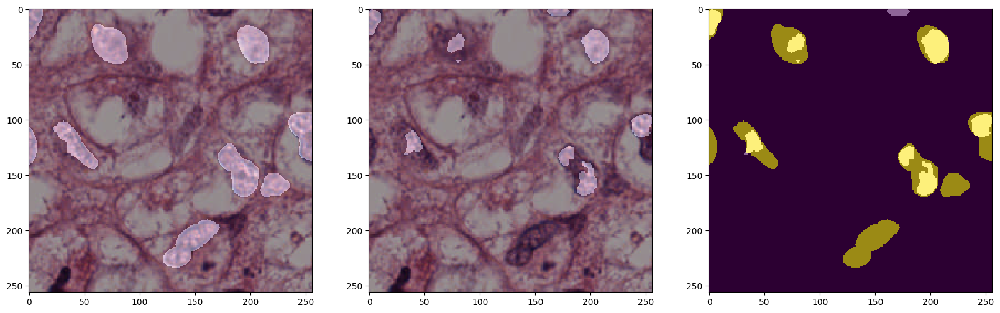

In [100]:
pred = model_mt2(t1_canseg_val[2][0][1:2])[0].numpy()
plot_mask_pred(t1_canseg_val[2][0][1], t1_canseg_val[2][1][1], pred)

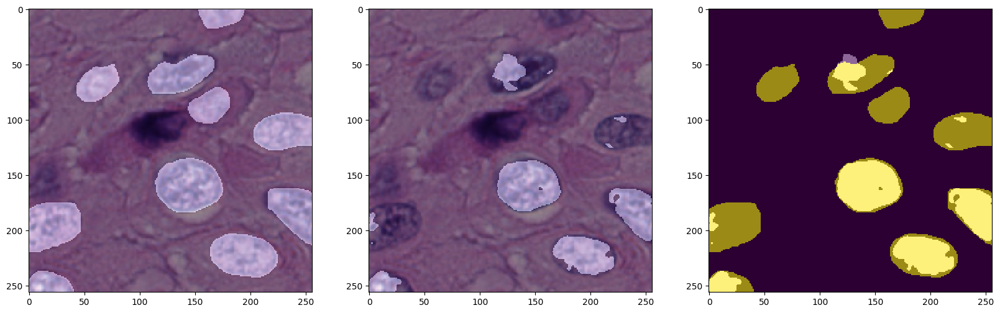

In [101]:
pred = model_mt2(t6_canseg_val[2][0][1:2])[0].numpy()
plot_mask_pred(t6_canseg_val[2][0][1], t6_canseg_val[2][1][1], pred)

In [34]:
model_mt2 = build_new_model2()

In [37]:
plot_model(model_mt2)

You must install pydot (`pip install pydot`) and install graphviz (see instructions at https://graphviz.gitlab.io/download/) for plot_model to work.


In [63]:
matriz1 = importance_matrix(model_mt2, total_loss, t1_canseg_val)

In [64]:
model_mt2.fit(t6_canseg_train, steps_per_epoch=len(t6_canseg_train), epochs=5, validation_data=t6_canseg_val, validation_steps=len(t6_canseg_val))

Epoch 1/5
9/9 [==============================] - 61s 7s/step - loss: 0.8066 - dice_loss: 0.6367 - iou_score: 0.3765 - f1-score: 0.5442 - precision: 0.2399 - recall: 0.7572 - auc_1: 0.8670 - val_loss: 0.7295 - val_dice_loss: 0.6152 - val_iou_score: 0.4531 - val_f1-score: 0.6236 - val_precision: 0.2575 - val_recall: 0.7664 - val_auc_1: 0.9127
Epoch 2/5
9/9 [==============================] - 61s 7s/step - loss: 0.7448 - dice_loss: 0.6053 - iou_score: 0.4334 - f1-score: 0.6039 - precision: 0.2613 - recall: 0.8166 - auc_1: 0.9252 - val_loss: 0.7037 - val_dice_loss: 0.6198 - val_iou_score: 0.4731 - val_f1-score: 0.6424 - val_precision: 0.2535 - val_recall: 0.7658 - val_auc_1: 0.9306
Epoch 3/5
9/9 [==============================] - 61s 7s/step - loss: 0.7088 - dice_loss: 0.5929 - iou_score: 0.4820 - f1-score: 0.6496 - precision: 0.2711 - recall: 0.8267 - auc_1: 0.9396 - val_loss: 0.6852 - val_dice_loss: 0.5768 - val_iou_score: 0.5420 - val_f1-score: 0.7030 - val_precision: 0.2831 - val_recall

In [36]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
print('')

4/4 [==============================] - 5s 1s/step - loss: 0.6850 - dice_loss: 0.6061 - iou_score: 0.5581 - f1-score: 0.7163 - precision: 0.2676 - recall: 0.7483 - auc: 0.9241



In [35]:
#evaluate_mt(model_mt2)
evaluate_tsk(model_mt2, task_list)

4/4 [==============================] - 6s 1s/step - loss: 0.7885 - dice_loss: 0.6538 - iou_score: 0.4037 - f1-score: 0.5746 - precision: 0.2206 - recall: 0.8349 - auc: 0.9278


In [36]:
model_mt22 = clone_model(model_mt2)
model_mt22.compile(loss=total_loss, optimizer=optim, metrics=metrics)

In [37]:
evaluate_tsk(model_mt22, task_list)

4/4 [==============================] - 6s 1s/step - loss: 0.7885 - dice_loss: 0.6538 - iou_score: 0.4037 - f1-score: 0.5746 - precision: 0.2206 - recall: 0.8349 - auc: 0.9278


In [38]:
task_importance = importance_matrix(model_mt22, total_loss, t6_canseg_val)

In [39]:
prev_vars = [tf.identity(model_mt22.trainable_weights[l]) for l in range(len(model_mt22.trainable_weights))]
loss_fn = regularization_loss(model_mt22, total_loss, task_importance, prev_vars, debug=False)
optim = keras.optimizers.Adam(LR)
model_mt22.compile(loss=loss_fn, optimizer=optim, metrics=metrics, run_eagerly=True)

In [40]:
#model_mt22.fit(t6_canseg_train, steps_per_epoch=len(t6_canseg_train), epochs=5, validation_data=t6_canseg_val, validation_steps=len(t6_canseg_val))
model_mt22.fit(t1_canseg_train, steps_per_epoch=len(t1_canseg_train), epochs=5, validation_data=t1_canseg_val, validation_steps=len(t1_canseg_val))

Epoch 1/5
9/9 [==============================] - 113s 13s/step - loss: 0.9957 - dice_loss: 0.7697 - iou_score: 0.1964 - f1-score: 0.3272 - precision: 0.1370 - recall: 0.7250 - auc: 0.8688 - val_loss: 0.9423 - val_dice_loss: 0.7554 - val_iou_score: 0.2261 - val_f1-score: 0.3670 - val_precision: 0.1460 - val_recall: 0.7781 - val_auc: 0.8909
Epoch 2/5
9/9 [==============================] - 112s 13s/step - loss: 0.9229 - dice_loss: 0.7495 - iou_score: 0.2370 - f1-score: 0.3828 - precision: 0.1491 - recall: 0.7877 - auc: 0.9033 - val_loss: 0.9048 - val_dice_loss: 0.7526 - val_iou_score: 0.2516 - val_f1-score: 0.4001 - val_precision: 0.1481 - val_recall: 0.7721 - val_auc: 0.8952
Epoch 3/5
9/9 [==============================] - 112s 13s/step - loss: 0.8954 - dice_loss: 0.7418 - iou_score: 0.2699 - f1-score: 0.4245 - precision: 0.1541 - recall: 0.7999 - auc: 0.9144 - val_loss: 0.8871 - val_dice_loss: 0.7444 - val_iou_score: 0.2825 - val_f1-score: 0.4388 - val_precision: 0.1532 - val_recall: 0.

In [41]:
evaluate_tsk(model_mt22, task_list)

4/4 [==============================] - 8s 2s/step - loss: 0.8832 - dice_loss: 0.7257 - iou_score: 0.3106 - f1-score: 0.4734 - precision: 0.1783 - recall: 0.6272 - auc: 0.7309


In [32]:
imp1 = importance_matrix(model_mt2, total_loss, t1_canseg_val)

In [33]:
imp1[1]

array([3.38709807e+00, 1.85266697e+00, 9.03896484e+01, 2.27340393e+01,
       2.18042716e-01, 4.07122433e-01, 2.31584668e-01, 9.99999980e+10,
       6.16561919e-02, 3.65912659e+02, 1.53167397e-01, 1.32070023e+02,
       9.45846736e-01, 8.29670668e-01, 3.72328997e-01, 1.47272095e-01,
       1.44510818e+00, 2.39737295e-02, 1.03547907e+00, 6.61326218e+00,
       2.07338948e-02, 1.18096612e-01, 2.70388499e-02, 7.08719254e+00,
       2.39882064e+00, 3.43209654e-02, 1.41006775e+01, 1.47435352e+03,
       5.85430145e+00, 3.05903479e-02, 1.69646250e+04, 2.98232883e-02],
      dtype=float32)

In [45]:
np.tanh(imp1[1]**5)# * 0.255

array([1.4481166e-03, 9.4439358e-01, 1.2807355e-03, 2.3692692e-30,
       2.8722519e-01, 1.8523744e-17, 8.9598495e-01, 5.3033045e-16,
       9.5788133e-01, 1.8041022e-11, 5.3079970e-02, 7.2861857e-30,
       3.9868188e-04, 9.6302921e-01, 3.9514726e-01, 6.1979119e-02,
       3.4861365e-09, 2.8272393e-06, 1.3757889e-18, 9.6110505e-01,
       9.5189393e-01, 1.7167928e-05, 8.4241235e-01, 4.2574225e-10,
       6.9071582e-11, 4.8636130e-06, 9.6302921e-01, 5.7960702e-33,
       5.0406197e-27, 7.9698120e-06, 7.1431470e-01, 9.6302921e-01],
      dtype=float32)

In [23]:
delta = 0.1
match = 1.0 #0.255
importan = 0.018722519
delta * match*(1-importan)

0.09812774810000001

In [ ]:
np.array([0.001, 0.002, 0.003]) * 0.25

In [42]:
imp2 = expand_importances(model_mt2, imp1)

In [48]:
wei1 = model_mt2.get_weights()

In [81]:
for i in range(len(imp2)):
    #if imp2[i].shape != wei1[i].shape:
    if wei1[i].shape == (3, 3, 32, 64):
        print(i)
        break;
print(imp2[12].shape)
print(wei1[12].shape)

12
(3, 3, 32, 64)
(3, 3, 32, 64)


In [66]:
model_mt3 = build_new_model2()
model_mt3.compile(loss=total_loss, optimizer=optim, metrics=metrics)

In [ ]:
model_mt3.evaluate(t1_canseg_val)
model_mt3.evaluate(t5_canseg_val)

In [ ]:
print(task_match_index(model_mt3, total_loss, t1_canseg_val))
print(task_match_index(model_mt3, total_loss, t5_canseg_val))

In [ ]:
imp1 = importance_matrix(model_mt2, total_loss, t1_canseg_val)
#imp5 = importance_matrix(model_mt2, total_loss, t5_canseg_val)

In [30]:
print(imp1[1])
#print(imp5[1][1])

[ 4.9912443e+00  5.5790014e+00  6.1986351e+00  6.6712308e+00
  6.3415632e+00  5.5589166e+00  7.0804362e+00  4.6535630e+00
  4.8780413e+00  9.4755688e+00  7.2734189e+00  1.5016291e+01
  8.0919533e+00  1.2057609e+01  5.6327820e+00  8.9359617e+00
 -1.9551888e-02  5.6446972e+00  1.3914354e+01  4.5683255e+00
  1.1820149e+01  1.4637211e+01  1.0126930e+01  4.4731550e+00
  1.0269023e+01 -9.9888621e-03  4.6024723e+00  5.9946737e+00
  8.8146811e+00  4.2947321e+00  1.4546469e+01  8.0594664e+00]


# LwF Experiments

In [14]:
###### task_list = [(t1_canseg_train, t1_canseg_val),(t3_canseg_train, t3_canseg_val),(lyn_train, lyn_val),(t6_canseg_train, t6_canseg_val)]
task_list = []
for i in range(len(all_types)):
    #if i > 3:
    #if i not in [0, 3]:
        #if i >= 8: # only the first 8 are good samples
    #    continue
    train_ids, val_ids = split_canser_seg(all_types[i:i+1], split=0.7)
    print(all_types[i:i+1])
    canseg_train = DataloderCancerSeg(ids=train_ids, batch_size=BATCH_SIZE, shuffle=True)
    canseg_val = DataloderCancerSeg(ids=val_ids, batch_size=BATCH_SIZE, shuffle=True)

    task_list.append((canseg_train, canseg_val))
    
#task_list.append((lyn_train, lyn_val))

#task_list.reverse()

['Adrenal_gland']
['Bile-duct']
['Bladder']
['Breast']
['Cervix']
['Colon']
['Esophagus']
['HeadNeck']
['Kidney']
['Liver']
['Lung']
['Ovarian']
['Pancreatic']
['Prostate']
['Skin']
['Stomach']
['Testis']
['Thyroid']
['Uterus']


In [15]:
print(len(task_list))
enco_step = 1 / len(task_list)
enco_const = enco_step
for task in task_list:
    print(enco_const)
    task[0].encoding_constant = enco_const
    task[1].encoding_constant = enco_const
    enco_const += enco_step

4
0.25
0.5
0.75
1.0


In [61]:
task_list.reverse()

In [15]:
t1 = task_list[0]
t2 = task_list[1]
t3 = task_list[2]
#task_list = [t2,t1,t3]
#task_list = [t2,t3,t1]
task_list = [t3,t1]
del t1
del t2
del t3

In [207]:
aux_train = []
aux_val = []
for train, val in task_list:
    aux_train.append(train)
    aux_val.append(val)
    
fullds_train = JoinDataSets(datasets=aux_train, fulljoin=True, batchsize=BATCH_SIZE)
fullds_val = JoinDataSets(datasets=aux_val, fulljoin=True, batchsize=BATCH_SIZE)
del aux_train
del aux_val

## Combined with Regularization

In [14]:
#tf.config.run_functions_eagerly(True)

In [16]:
def regularization_loss(model, loss, importance, old_vars, lambd=1, regularized=False, no_label=False):
    def custom_loss(y_true, y_pred):
        loss_value = loss(y_true, y_pred)
        reg_loss = tf.constant([0.])
        if regularized:
            for l in range(len(importance)):
                reg_loss += tf.reduce_sum(
                    importance[l] * tf.math.pow(tf.math.abs(old_vars[l]-model.trainable_weights[l]), tf.constant([2.0]))#importance[l] * 
                    #importance[l] * tf.math.pow(tf.math.abs(old_vars[l]-model.weights[l]), tf.constant([2.0]))
                    #importance[l] * tf.math.abs(old_vars[l]-model.weights[l])
                )
        lbl_loss = tf.constant([0.])
        if no_label:
            lbl_loss += tf.math.reduce_mean(tf.norm(tf.concat(y_pred,1), 2, 1))
        #print(reg_loss)
        return loss_value+(reg_loss*lambd)+lbl_loss
    return custom_loss

In [29]:
def importance_matrix(model, loss, task_data):
    avg_delta = None
    if task_data is None:
        avg_delta = []
        for w in range(len(model.trainable_weights)):
            avg_delta.append(np.zeros(model.trainable_weights[w].shape).astype(float))
        return avg_delta

    for x, y in task_data:
        y = tf.Variable(y, dtype='float32')
        with tf.GradientTape(persistent=True) as tape:
            preds = model(x, training=True)
            #loss_value = tf.math.pow(tf.math.log(loss(y, preds)), tf.constant(2.0))
            #loss_value = loss(y, preds)
            
            #loss_value = tf.math.log(loss(y, preds))
            loss_value = tf.math.reduce_mean(tf.norm(tf.concat(preds,1), 2, 1))
        
        grads = tape.gradient(loss_value, model.trainable_weights)
        del tape
        
        if avg_delta is None:
            avg_delta = grads.copy()
            for g in range(len(grads)):
                if 'batch_modulation' in model.trainable_weights[g].name:
                    avg_delta[g] = np.zeros(model.trainable_weights[g].shape).astype(float)
                    continue
                if grads[g] is not None:
                    #avg_delta[g] = np.abs(grads[g]) * 1000000.0
                    avg_delta[g] = np.abs(grads[g])
        else:
            for g in range(len(grads)):
                if 'batch_modulation' in model.trainable_weights[g].name:
                    continue
                if grads[g] is not None:
                    #avg_delta[g] = avg_delta[g] + (np.abs(grads[g]) * 1000000.0)
                    avg_delta[g] = avg_delta[g] + np.abs(grads[g])

    importance = avg_delta.copy()
    for i in range(len(avg_delta)):
        importance[i] = avg_delta[i] / len(task_data)
        if tf.is_tensor(importance[i]):
            importance[i] = importance[i].numpy()

    return importance

    full_importance = []
    index_imp = 0
    n_jumps = 0
    for w in range(len(model.trainable_weights)):
        if n_jumps > 0:
            n_jumps -= 1
            #print(w, model.weights[w].name, 'jump')
            continue
        #print(w, model.weights[w].name)
            
        if model.trainable_weights[w].trainable:
            if ('Conv' in model.trainable_weights[w].name):
                #print(index_imp, importance[index_imp].shape, w, model.weights[w].name)
                max_per_neuron = np.sum([
                    np.sum(importance[index_imp], axis=(0,1,2)),
                    importance[index_imp+1]
                ], axis=0)
                
                #ws = [np.ones(importance[index_imp].shape)[:,:,:,j] * max_per_neuron[j] for j in range(importance[index_imp].shape[-1])]
                ws = np.ones(importance[index_imp].shape) * max_per_neuron
                bs = max_per_neuron
                
                full_importance.append(ws)
                full_importance.append(bs)
                index_imp = index_imp + 2
                n_jumps = 1
            elif ('BN' in model.trainable_weights[w].name):# and ('gamma' in model.weights[w].name)) and True:
                #print(importance[index_imp].shape, importance[index_imp+1].shape, importance[index_imp+2].shape, importance[index_imp+3].shape)
                max_per_neuron = np.sum([importance[index_imp], importance[index_imp+1]], axis=0)#, importance[index_imp+2], importance[index_imp+3]], axis=0)
                #sum_per_neuron = importance[index_imp] + importance[index_imp-1]
                
                full_importance.append(max_per_neuron)
                full_importance.append(max_per_neuron)
                #full_importance.append(max_per_neuron)
                #full_importance.append(max_per_neuron)
                
                index_imp = index_imp + 2
                #index_imp = index_imp + 1
                n_jumps = 1
            else:
                full_importance.append(importance[index_imp])
                index_imp = index_imp + 1
        else:
            #continue
            full_importance.append(np.zeros(model.trainable_weights[w].shape).astype(float))
            
    return full_importance#importance

In [18]:
def merge_model_weights(models, importances, imp_matrix=False):
    teoric_weights = []
    for i in range(len(models[0])):
        weights = []
        for j in range(len(models)):
            weights.append(models[j][i])
        if imp_matrix:
            imps = []
            for j in range(len(importances)):
                imps.append(importances[j][i])
            teoric_weights.append(weighted_mean(weights, imps))
        else:
            teoric_weights.append(weighted_mean(weights, importances))
        #teoric_weights.append(weighted_median(weights, np.array(importances)))
    return teoric_weights
def weighted_mean(values, importances):
    sums = None
    weights = None
    for i in range(len(values)):
        #weights += importances[i]
        if weights is None:
            weights = importances[i]
        else:
            weights += importances[i]
        if sums is None:
            sums = values[i]*importances[i]
        else:
            sums += values[i]*importances[i]
    return sums / weights

def weighted_median(values, weights):
    data = list(zip(values, weights))
    #data.sort()
    sorted(data, key=lambda x: x[1]) #sort by weight

    midpoint = weights.sum() / 2.0

    cumulative_weight = 0
    for value, weight in data:
        cumulative_weight += weight
        if cumulative_weight >= midpoint:
            return value

    raise 'No_Median'

In [18]:
def changeBMmodel(model, op, extra=None):
    for l in range(len(model.layers)):
        if hasattr(model.layers[l], 'forged'):
            if op == 'forge':
                model.layers[l].forge()
            elif op == 'frost':
                model.layers[l].frost()
            elif op == 'defrost':
                model.layers[l].defrost()
            elif op == 'defrost2':
                #quicktest.layers[l].forge()
                model.layers[l].defrost()
            elif op == 'zerocounts':
                model.layers[l].zerocounts()
            elif op == 'joinix':
                model.layers[l].joinix()
            elif op == 'smite':
                model.layers[l].smite()
            elif op == 'smitecalc':
                model.layers[l].smitecalc()
            elif op == 'smited':
                model.layers[l].smited()
            elif op == 'hitdebugOn':
                model.layers[l].hitdebugOn()
            elif op == 'hitdebugOff':
                model.layers[l].hitdebugOff()
            elif op == 'drift':
                extra = 1.0 if extra is None else extra
                model.layers[l].drift(extra)
            elif op == 'nodrift':
                model.layers[l].nodrift()
            elif op == 'use_style':
                model.layers[l].use_style(extra)
            elif op == 'new_style':
                model.layers[l].new_style()
            elif op == 'set_mean_var':
                model.layers[l].set_mean_var(extra)
            else:
                raise 'aaaaaaaaaa'
        elif op == 'defrost2':
            model.layers[l].trainable = False
    quicktest.make_train_function(force=True)

In [16]:
def getModelHits(model):
    tothit = 0
    totmis = 0
    for l in range(len(model.layers)):
        if hasattr(model.layers[l], 'forged'):
            tothit += model.layers[l].hits.numpy()
            totmis += model.layers[l].miss.numpy()
    print(tothit, totmis, tothit/(tothit+totmis+0.00001))
    return tothit/(tothit+totmis+0.00001)

## Combined with Model Fusion

In [19]:
class MergeCB(keras.callbacks.Callback):
    def __init__(self, weights, importance, w_imp, n_loss_fn, n_ds):
        super().__init__()
        self.old_weights = weights
        self.old_importance = importance
        self.old_imp_matrix = w_imp
        
        self.new_imp_loss_fn = n_loss_fn
        self.new_imp_dataset = n_ds
        
        self.best_w = None
        self.best_i = None
        
    # on_epoch_end
    def on_epoch_begin(self, epoch, logs=None):
        if self.old_weights is None:
            return
        self.new_imp_matrix = importance_matrix(self.model, self.new_imp_loss_fn, self.new_imp_dataset)
        #print(self.new_imp_matrix[0])
        #imp_matrix = importance_matrix(self.model, self.new_imp_loss_fn, self.new_imp_dataset)
        #self.new_imp_matrix = [(o + n) + (n-o) for o, n in zip(self.old_imp_matrix, imp_matrix)]
    
    #    if self.best_w is None:
    #        self.best_w = self.model.get_weights()
    #        self.best_i = logs.get("val_loss")
    #    elif logs.get("val_loss") < self.best_i:
    #        self.best_w = self.model.get_weights()
    #        self.best_i = logs.get("val_loss")

    #def on_epoch_end(self, epoch, logs=None):
    def on_train_batch_end(self, batch, logs=None):
        if self.old_weights is None:
            return
        merge_w = [self.old_weights, self.model.get_weights()]
        old_i = [mat+self.old_importance for mat in self.old_imp_matrix] #+self.old_importance
        new_i = [mat2+logs.get("loss") for mat2 in self.new_imp_matrix] #+logs.get("loss")
        merge_i = [old_i, new_i]
        #merge_i = [self.old_importance, logs.get("loss")]
        #merge_i = [0.6, 0.4]
        teoric_weights = merge_model_weights(merge_w, merge_i, imp_matrix=True)
        #print(teoric_weights[1])
        self.model.set_weights(teoric_weights)

class TestCB(keras.callbacks.Callback):
    def __init__(self):
        super().__init__()
        self.means = []
        self.traks = []
        self.total = []
        self.wigths = []
        #self.vars = []
        
    def on_epoch_end(self, epoch, logs=None):
        imod = 4
        self.wigths.append(self.model.layers[2].get_weights()[1].copy())
        self.means.append(self.model.layers[imod].moving_mean.numpy())
        #self.traks.append(self.model.layers[imod].track_mean.numpy())
        #self.total.append(self.model.layers[imod].total_mean.numpy())
        #if self.model.layers[imod].drifting or self.model.layers[imod].smithing:
        #    self.total.append(self.model.layers[imod].track_mean.numpy())
        #    self.vars.append(self.model.layers[3].track_variance.numpy())
        #else:
        #    self.total.append(self.model.layers[imod].moving_mean.numpy())
        #    self.vars.append(self.model.layers[3].moving_variance.numpy())

## Visualizations

In [157]:
# tarefa, train/val, batch, img/pred, index
malditoi = 5
imgt1 = task_list[0][1][0][0][malditoi:malditoi+1]
mskt1 = task_list[0][1][0][1][malditoi:malditoi+1]
imgt2 = task_list[5][1][1][0][malditoi:malditoi+1]
mskt2 = task_list[5][1][1][1][malditoi:malditoi+1]
print(all_types[0], all_types[5])

Adrenal_gland Colon


In [169]:
quicktest.fit(task_list[5][0], steps_per_epoch=len(task_list[5][0]), epochs=10, validation_data=task_list[5][1], validation_steps=len(task_list[5][1]))
evaluate_tsk(quicktest, task_list)

Epoch 1/10
31/31 [==============================] - 13s 416ms/step - loss: 0.6242 - dice_loss: 0.6242 - iou_score: 0.3172 - f1-score: 0.4754 - precision: 0.2393 - recall: 0.9557 - auc: 0.9319 - val_loss: 0.5959 - val_dice_loss: 0.5959 - val_iou_score: 0.3432 - val_f1-score: 0.5087 - val_precision: 0.2695 - val_recall: 0.8309 - val_auc: 0.8914
Epoch 2/10
31/31 [==============================] - 13s 417ms/step - loss: 0.6118 - dice_loss: 0.6118 - iou_score: 0.3338 - f1-score: 0.4940 - precision: 0.2495 - recall: 0.9526 - auc: 0.9368 - val_loss: 0.6112 - val_dice_loss: 0.6112 - val_iou_score: 0.3732 - val_f1-score: 0.5418 - val_precision: 0.2505 - val_recall: 0.8895 - val_auc: 0.9150
Epoch 3/10
31/31 [==============================] - 13s 422ms/step - loss: 0.6014 - dice_loss: 0.6014 - iou_score: 0.3425 - f1-score: 0.5044 - precision: 0.2578 - recall: 0.9519 - auc: 0.9338 - val_loss: 0.6141 - val_dice_loss: 0.6141 - val_iou_score: 0.3544 - val_f1-score: 0.5209 - val_precision: 0.2525 - va

In [153]:
def maskImg2(img, threshold, threshold2=None):
    mask = img.copy()
    mask[mask <= threshold] = np.nan
    if threshold2 is not None:
        mask[mask > threshold2] = 1.0
    return mask

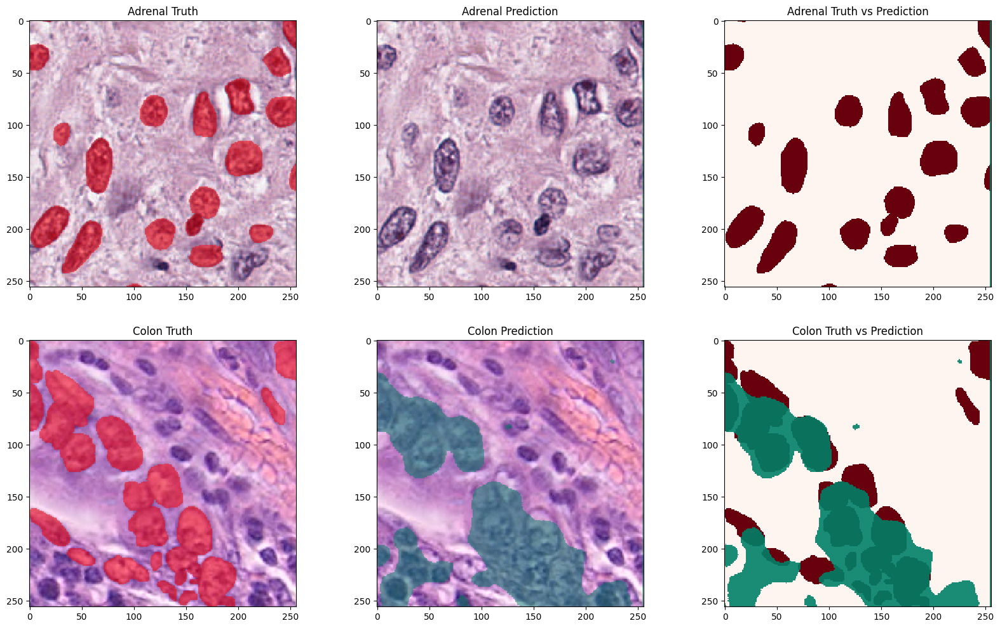

In [171]:
evalt1 = quicktest(imgt1).numpy()
evalt2 = quicktest(imgt2).numpy()

fig, axarr = plt.subplots(2,3, figsize=(20, 12))
axarr[0][0].title.set_text('Adrenal Truth')
axarr[0][0].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][0].imshow(maskImg2(mskt1[0], 0), alpha=0.5, cmap='autumn', interpolation='None')
axarr[0][1].title.set_text('Adrenal Prediction')
axarr[0][1].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][1].imshow(maskImg2(evalt1[0], 0.5, 0.5), alpha=0.5, cmap='summer', interpolation='None')
axarr[0][2].title.set_text('Adrenal Truth vs Prediction')
axarr[0][2].imshow(mskt1[0], cmap='Reds', interpolation='None')
axarr[0][2].imshow(maskImg2(evalt1[0], 0.5, 0.5), alpha=0.9, cmap='summer', interpolation='None')
axarr[1][0].title.set_text('Colon Truth')
axarr[1][0].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][0].imshow(maskImg2(mskt2[0], 0), alpha=0.5, cmap='autumn', interpolation='None')
axarr[1][1].title.set_text('Colon Prediction')
axarr[1][1].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][1].imshow(maskImg2(evalt2[0], 0.5, 0.5), alpha=0.5, cmap='summer', interpolation='None')
axarr[1][2].title.set_text('Colon Truth vs Prediction')
axarr[1][2].imshow(mskt2[0], cmap='Reds', interpolation='None')
axarr[1][2].imshow(maskImg2(evalt2[0], 0.5, 0.5), alpha=0.9, cmap='summer', interpolation='None')

plt.savefig("forgetT2.pdf", format="pdf", bbox_inches='tight')

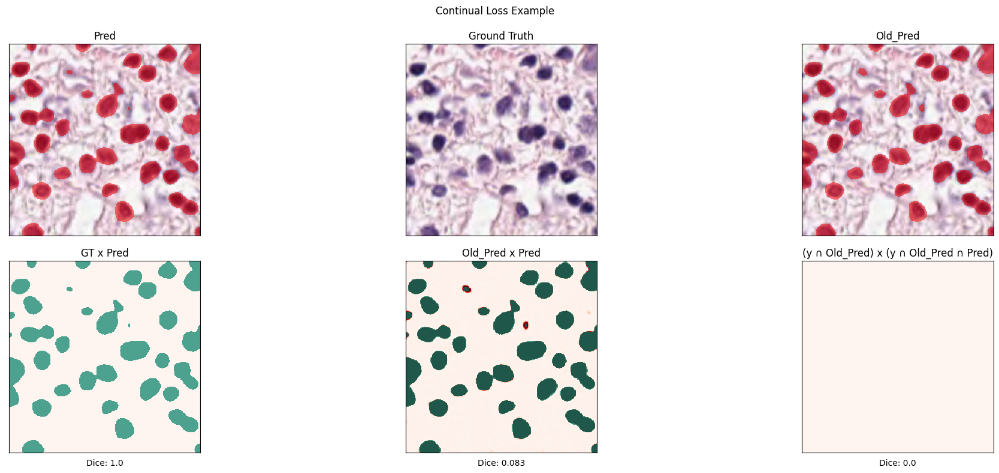

In [123]:
fig, axarr = plt.subplots(2,3, figsize=(20, 8)) # larg, alt

ihh = 2

plt.suptitle('Continual Loss Example')
plt.tight_layout()
plt.subplots_adjust(top=0.90)

for i in range(2):
    for j in range(3):
        axarr[i][j].set_xticks([])
        axarr[i][j].set_yticks([])

axarr[0][0].title.set_text('Pred')
axarr[0][0].imshow(x[ihh], cmap='viridis', interpolation='None')
axarr[0][0].imshow(maskImg2(preds[ihh].numpy(), 0.5, 0.5), alpha=0.5, cmap='autumn', interpolation='None')

axarr[0][1].title.set_text('Ground Truth')
axarr[0][1].imshow(x[ihh], cmap='viridis', interpolation='None')
axarr[0][1].imshow(maskImg2(y[ihh].numpy(), 0.0), alpha=0.5, cmap='autumn', interpolation='None')

axarr[0][2].title.set_text('Old_Pred')
axarr[0][2].imshow(x[ihh], cmap='viridis', interpolation='None')
axarr[0][2].imshow(maskImg2(old_preds[ihh].numpy(), 0.5, 0.5), alpha=0.5, cmap='autumn', interpolation='None')

axarr[1][0].title.set_text('GT x Pred')
axarr[1][0].imshow(y[ihh], cmap='Reds', interpolation='None')
axarr[1][0].imshow(maskImg2(preds[ihh].numpy(), 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
ls = total_loss(y[ihh], np.array([preds[ihh]])).numpy()
axarr[1][0].set_xlabel('Dice: '+str(np.round(ls, 3)))

axarr[1][1].title.set_text('Old_Pred x Pred')
axarr[1][1].imshow(old_preds[ihh].numpy(), cmap='Reds', interpolation='None')
axarr[1][1].imshow(maskImg2(preds[ihh].numpy(), 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
ls = total_loss(old_preds[ihh], np.array([preds[ihh]])).numpy()
axarr[1][1].set_xlabel('Dice: '+str(np.round(ls, 3)))

axarr[1][2].title.set_text('(y ∩ Old_Pred) x (y ∩ Old_Pred ∩ Pred)')
axarr[1][2].imshow(y[ihh].numpy() * old_preds[ihh].numpy(), cmap='Reds', interpolation='None')
axarr[1][2].imshow(maskImg2(y[ihh].numpy() * old_preds[ihh].numpy() * preds[ihh].numpy(), 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
ls = total_loss(y[ihh].numpy() * old_preds[ihh].numpy(), y[ihh].numpy() * old_preds[ihh].numpy() * preds[ihh].numpy()).numpy()
axarr[1][2].set_xlabel('Dice: '+str(np.round(ls, 3)))

plt.savefig("metodolossex_after.pdf", format="pdf", bbox_inches='tight')

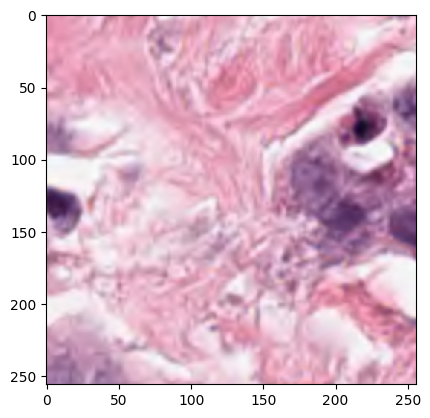

In [125]:
plt.imshow(x[15])

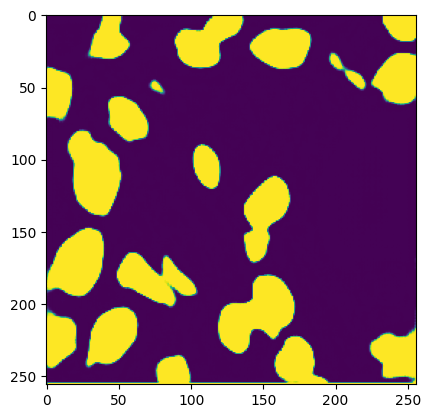

In [75]:
plt.imshow(preds[7].numpy())

tf.Tensor(0.025720239, shape=(), dtype=float32)
tf.Tensor(0.6321824, shape=(), dtype=float32)
tf.Tensor(0.1887855, shape=(), dtype=float32)
--
tf.Tensor(0.09073323, shape=(), dtype=float32)
--
tf.Tensor(1.8415978, shape=(), dtype=float32)


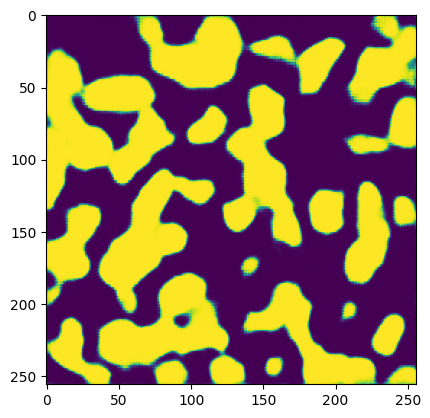

In [38]:
#gt_mks = tf.cast(~(y > 0), dtype='float32')
#plt.imshow(y[0] + (gt_mks[0]*old_preds[0]))
plt.imshow(old_preds[2] * preds[2])
print(total_loss(y, y * preds))
print(total_loss(y, preds))
print(total_loss(old_preds, old_preds * preds))
print('--')
print(total_loss(y+old_preds, preds))
#print(total_loss(y+(gt_mks * old_preds), preds))
#print(recall_loss(y+(gt_mks * old_preds), preds))
print('--')
print(binfocloss(y, preds))

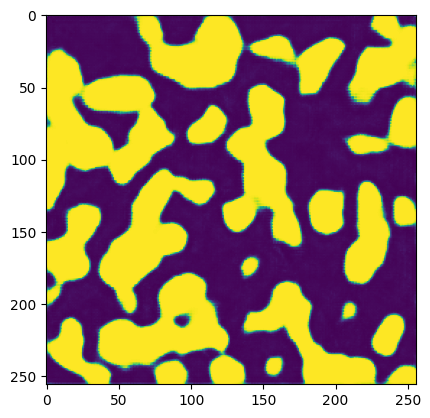

In [32]:
plt.imshow(preds[2].numpy())

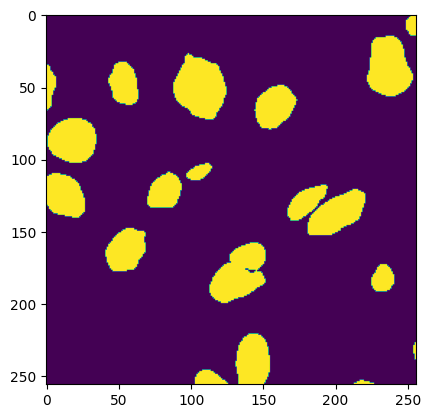

In [20]:
plt.imshow(task_list[0][1][0][1][0])

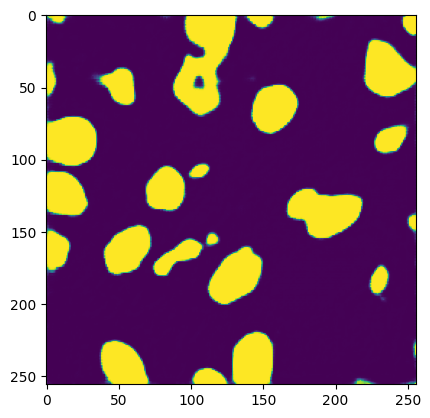

In [21]:
plt.imshow(quicktest(task_list[0][1][0][0][0:1], training=False)[0])

In [79]:
teti = task_list[0][1][0][1][0:1]
print(np.unique(teti))
print(metrics[1](tf.Variable(teti, dtype='float32'), quicktest(task_list[0][1][0][0][0:1], training=False)))
teti[teti > 0.0] = 1.0
print(np.unique(teti))
metrics[1](tf.Variable(teti, dtype='float32'), quicktest(task_list[0][1][0][0][0:1], training=False))

[0.   0.25]
tf.Tensor(0.18308559, shape=(), dtype=float32)
[0. 1.]


<tf.Tensor: shape=(), dtype=float32, numpy=0.724504>

## Enhanced LwF Runs

In [15]:
def recall_loss(y_true, y_pred):
    #print(y_true - y_pred)
    #print(y_true)
    tp = y_true * y_pred
    fn = y_true - tp
    mask = ((tp) + 0.000001) / (tp + fn + 0.000001)
    #plt.imshow(mask)
    #print(mask)
    return 1 - tf.math.reduce_mean(tf.cast(mask, tf.float32))#/tf.cast(tf.size(mask), tf.float32)
def neg_loss(y_true, y_pred):
    #print(y_true - y_pred)
    #print(y_true)
    tn = tf.cast(~((y_true * y_pred) > 0), dtype='float32')
    fn = y_true - tn
    mask = ((tn) + 0.000001) / (tn + fn + 0.000001)
    #print(mask)
    return 1 - tf.math.reduce_mean(tf.cast(mask, tf.float32))#/tf.cast(tf.size(mask), tf.float32)

In [84]:
recall_loss(old_preds, preds)

<tf.Tensor: shape=(), dtype=float32, numpy=0.6720043>

In [16]:
class SetpValue():
    def __init__(self, start_value=0.5, step_size=0.01, max_value=1.0, min_value=0.0):
        self.value = start_value
        self.step_size = step_size
        self.max_value = max_value
        self.min_value = min_value
        
    def get_val(self):
        v = self.value
        if (v > self.min_value) and (v < self.max_value):
            self.value += self.step_size
        return v

In [17]:
def diff_models(model1, model2):
    means = []
    for i in range(len(model1)):
        means.append(np.mean((model2[i] - model1[i])**2))
    return np.mean(means)

In [37]:
binfocloss = tf.keras.losses.BinaryFocalCrossentropy(alpha=0.75, gamma=2.0)

In [21]:
all_types[11]

'Ovarian'

In [74]:
quicktest = build_new_model2(styled=False)
quickopt = keras.optimizers.Adam(0.0001)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)

In [75]:
history = quicktest.fit(task_list[11][0], steps_per_epoch=len(task_list[11][0]), epochs=500, validation_data=task_list[11][1], validation_steps=len(task_list[11][1]))

Epoch 1/500
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/3 [==============================] - ETA: 0s - loss: 0.7910 - dice_loss: 0.7910 - iou_score: 0.0813 - f1-score: 0.1500 - precision: 0.1380 - recall: 0.4434 - auc: 0.7779WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x78229a758b90> and will run it as-is.
Please report this to the TensorFlow team. Whe

In [76]:
quicktest.evaluate(task_list[11][0])

3/3 [==============================] - 0s 58ms/step - loss: 0.3949 - dice_loss: 0.3949 - iou_score: 0.6632 - f1-score: 0.7971 - precision: 0.4425 - recall: 0.9597 - auc: 0.9782


[0.3948747217655182,
 0.3948747217655182,
 0.6631751656532288,
 0.7970650792121887,
 0.44249919056892395,
 0.9596657752990723,
 0.9782048463821411]

In [114]:
quicktest.evaluate(task_list[0][0])

9/9 [==============================] - 0s 38ms/step - loss: 0.3762 - dice_loss: 0.3762 - iou_score: 0.5901 - f1-score: 0.7416 - precision: 0.4904 - recall: 0.8613 - auc: 0.9694


[0.3761769235134125,
 0.3761769235134125,
 0.5901317000389099,
 0.74158775806427,
 0.49038273096084595,
 0.8613197207450867,
 0.9694251418113708]

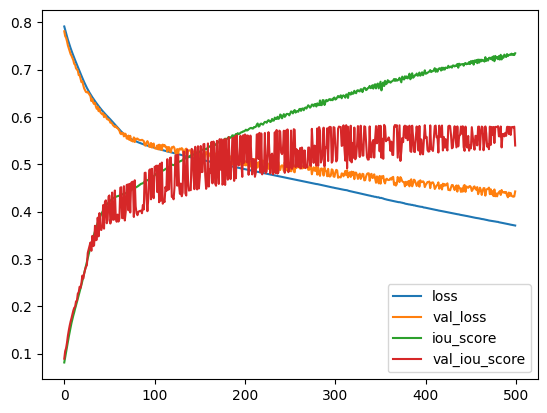

In [77]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.plot(history.history['iou_score'], label='iou_score')
plt.plot(history.history['val_iou_score'], label='val_iou_score')
plt.legend()

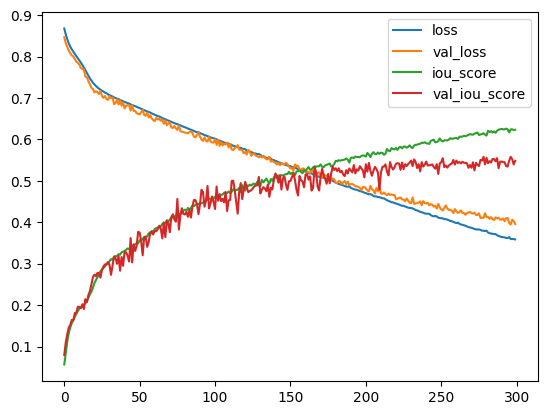

In [113]:
plt.plot(history.history['loss'], label='loss')
plt.plot(history.history['val_loss'], label='val_loss')
plt.plot(history.history['iou_score'], label='iou_score')
plt.plot(history.history['val_iou_score'], label='val_iou_score')
plt.legend()

In [119]:
#quicktest = build_new_model2(styled=False)
#quickopt = keras.optimizers.Adam(LR)

#testcb = TestCB()
#testcb2 = TestCB()
#lbltotal_loss = regularization_loss(None, total_loss, None, None, regularized=False, no_label=True)

#quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)#, run_eagerly=True)

#arr_weights = []
#arr_modus = []
#arr_means = []
#arr_tmeans = []
#arr_varis = []

new_sinteticx = None

join_modelo = None
#prev_w = None
#prev_i = None

moving_loss = None

wimportance = []
wtrust = []

wdeviation = []

curr_task = 0

fim = None
prev_params = None

histories = []
base_hits = 0

#loss_recall = sm.metrics.Recall()

#lropt = SetpValue(start_value=0.001, step_size=0.001, max_value=0.01)
#lrlmb = SetpValue(start_value=100, step_size=50, min_value=50, max_value=500)
ref_recall = None
ref_negative = None
for ds_train, ds_val in task_list:
    if curr_task < 3:
        curr_task += 1
        continue
    #lrrecall = SetpValue(start_value=0.3, step_size=0.01)
    #lrrecall = SetpValue(start_value=0.7, step_size=-0.01, min_value=0.3)
    
    #if curr_task == 0:
    #    curr_task += 1
    #    continue
    #if curr_task == 2:
    #    evaluate_tsk(quicktest, task_list)
    #    curr_task += 1
    #    continue
    #if curr_task > 0:
        #evals = quicktest.evaluate(ds_val)
        #loss_diff = evals[0] - moving_loss
        #loss_diff = moving_loss - evals[0]
        #if loss_diff > 0:
        #    continue
        #lcalc = 10**(2+loss_diff)
        #print('new task loss', evals[0], 'moving_loss', moving_loss, 'lambda', lcalc)
        # impedir se loss for menor
        
        #prev_vars = [tf.identity(quicktest.weights[l]) for l in range(len(quicktest.weights))]
    #    ac_lropt = 0.0001#lropt.get_val()
    #    ac_lrlmb = lrlmb.get_val()
    #    print('lropt', ac_lropt, 'lrlmb', ac_lrlmb)
    #    prev_vars = [tf.identity(quicktest.trainable_weights[l]) for l in range(len(quicktest.trainable_weights))]
    #    loss_fn = regularization_loss(quicktest, total_loss, wimportance, prev_vars, lambd=ac_lrlmb, regularized=True, no_label=False) # 100
    #    quicktest.compile(loss=loss_fn, optimizer=keras.optimizers.Adam(ac_lropt), metrics=metrics)#, run_eagerly=True)

    #new_importance = importance_matrix(quicktest, total_loss, ds_val)
    #mergcb = MergeCB(prev_w, prev_i, wimportance, total_loss, ds_val)
    if curr_task == 0:
        history = quicktest.fit(ds_train, steps_per_epoch=len(ds_train), epochs=10, validation_data=ds_val, validation_steps=len(ds_val))#, callbacks=[mergcb])
    else:
        #mets = quicktest.evaluate(ds_val)
        #if mets[2] > 0.35:
        #    print(' ================================ REACHED GOOD METRIC ================================')
        #    print(' ================================ Done training ', curr_task, ' ================================')
        #    try:
        #        del aux_model
        #        print('')
        #    except NameError:
        #        print('')
        #    evaluate_tsk(quicktest, task_list)
        #    curr_task += 1
        #    continue

        #loss_fn = regularization_loss(quicktest, total_loss, wimportance, 
        #                              [tf.identity(quicktest.trainable_weights[l]) for l in range(len(quicktest.trainable_weights))],
        #                              lambd=100, regularized=True, no_label=False) # 100
        
        #aux_model = clone_model(quicktest)
        #aux_model.compile(loss=total_loss, optimizer=keras.optimizers.Adam(0.0001), metrics=metrics) # 0.0001
        #aux_model.set_weights(quicktest.get_weights())

        #lrrecall = SetpValue(start_value=0.5, step_size=0.1)
        #ref_recall = None

        
        #quicktest.fit(ds_train, steps_per_epoch=len(ds_train), epochs=10, validation_data=ds_val, validation_steps=len(ds_val))
        #spec_w = quicktest.get_weights()
        #evaluate_tsk(quicktest, task_list)
        
        #quicktest.set_weights(prev_w)
        #quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
        
        for e in range(10):
            #total_recall = 0
            #tot_loss = 0
            for x, y in ds_train:
                #junc = x * y
                #rm = junc[:,:,:,0][junc[:,:,:,0] > 0].mean()
                #gm = junc[:,:,:,1][junc[:,:,:,1] > 0].mean()
                #bm = junc[:,:,:,2][junc[:,:,:,2] > 0].mean()
                #dx = (1.0 - sinteticx)*np.array([rm,gm,bm])
                #junc = x * (1.0 - y)
                #rm = junc[:,:,:,0][junc[:,:,:,0] > 0].mean()
                #gm = junc[:,:,:,1][junc[:,:,:,1] > 0].mean()
                #bm = junc[:,:,:,2][junc[:,:,:,2] > 0].mean()
                #dy = sinteticx*np.array([rm,gm,bm])
                #if new_sinteticx is None:
                #    new_sinteticx = dx+dy
                #else:
                #    new_sinteticx = (0.5 * new_sinteticx) + (0.5 * (dx+dy))
                
                y = tf.Variable(y, dtype='float32')

                curr_w = quicktest.get_weights()
                quicktest.set_weights(prev_w)
                quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
                old_preds = quicktest(x, training=False)
                
                #quicktest.set_weights(spec_w)
                #quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
                #new_preds = quicktest(x, training=False)
                
                quicktest.set_weights(curr_w)
                quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
                #del curr_w
                #old_preds = aux_model(x, training=False)
                
                with tf.GradientTape(persistent=True) as tape:
                    #old_preds = aux_model(x, training=False)                
                    preds = quicktest(x, training=True)

                    #recal_i = lrrecall.get_val()
                    #total_recall += recall_loss(old_preds, preds)
                    #rec_val = recall_loss(old_preds, preds)
                    #neg_val = neg_loss(old_preds, preds)
                    #if ref_recall is None:
                    #    ref_recall = rec_val
                    #if ref_negative is None:
                    #    ref_negative = neg_val
                    #  aux_model.get_weights()
                    #rec_lls = diff_models(quicktest.get_weights(), prev_w) + ((1 - rec_val) - (1 - ref_recall))# + ((1 - neg_val) - (1 - ref_negative))
                    #rec_lls = 0.0 if rec_lls < 0.0 else rec_lls
                    #rec_lls = total_loss(old_preds, old_preds * preds)# + diff_models(quicktest.get_weights(), prev_w) + ((1 - rec_val) - (1 - ref_recall))
                    rec_lls = total_loss(old_preds, preds)+total_loss(y*old_preds, y*old_preds*preds)#+total_loss(y*old_preds, preds)#+2.0*binfocloss(old_preds, old_preds * preds)
                    
                    #gt_mks = tf.cast(~(y > 0), dtype='float32')
                    #lls = total_loss(y+(gt_mks * old_preds), preds)
                    #lls = total_loss(y, y * preds)
                    #lls = total_loss(y, preds)#+binfocloss(y, y * preds)
                    
                    lls = total_loss(y, preds)

                    #ll2 = binfocloss(y, preds)#total_loss(y, y * preds)

                    loss_value = lls+rec_lls#+ll2
                    
                    #loss_value = total_loss(y, preds*y)
                    #tot_loss += loss_value
                    #print(recal_i, loss_value)
                grads = tape.gradient(loss_value, quicktest.trainable_weights)
                #del tape
                quickopt.apply_gradients(zip(grads, quicktest.trainable_variables))

                #if curr_task == 3:
                #    raise 'deu'

                #print('total_loss', loss_value, 'lls', lls, 'rec_lls', rec_lls)#, 'll2', ll2.numpy())#, 'rec_val', rec_val)
            #del preds
            #del old_preds
            #del grads
            print('total_loss', loss_value, 'lls', lls, 'rec_lls', rec_lls)#, 'll2', ll2)
            #print(total_loss(y, preds), recal_i, recall_loss(old_preds, preds))
            #quicktest.evaluate(ds_val)
            #total_recall = total_recall/len(ds_train)
            #tot_loss = tot_loss/len(ds_train)
            #print('tot_loss', tot_loss, 'total_recall', total_recall)
            
            evaluate_tsk(quicktest, task_list, custom_eval=False)
            #print('Sintetic')
            #quicktest.evaluate(sinteticx, sinteticy)

            #quicktest.set_weights(merge_model_weights(
            #    [aux_model.get_weights(), quicktest.get_weights()], 
            #    [prev_i, mets[curr_task][0]],
            #    imp_matrix=False
            #))

            #if mets[curr_task][2] > 0.35:
            #    print(' ================================ REACHED GOOD METRIC ================================')
            #    break

        #if total_recall < 0.71:
        #    print(' ================================ Undoing Training ', curr_task, ' ================================')
        #    quicktest.set_weights(aux_model.get_weights())

        #print('rec_val < ref_recall', rec_val, '<', ref_recall, rec_val < ref_recall)
        #if rec_val < ref_recall:
        #    ref_recall = rec_val
        #print('neg_val < ref_negative', neg_val, '<', ref_negative, neg_val < ref_negative)
        #if neg_val < ref_recall:
        #    ref_negative = neg_val

        del curr_w
        #del aux_model
        print('')
        print(' ================================ Done training ', curr_task, ' ================================')
        print('')
    
    #if curr_task > 0:
    #    merge_w = [prev_w, mergcb.best_w]
    #    merge_i = [prev_i, mergcb.best_i]
    #    teoric_weights = merge_model_weights(merge_w, merge_i)
    #    quicktest.set_weights(teoric_weights)

    #if prev_w is not None:
    #    for i in range(len(prev_w)):
    #        diff = (quicktest.get_weights()[i] - prev_w[i])**2
    #        wdeviation[i] = wdeviation[i] + diff
            #total_size += prev_w[i].size
        #print(total_diff, total_size, total_diff/total_size)

    #print(quicktest.layers[33].get_weights()[1])

    #changeBMmodel(quicktest, 'new_style')
    
    #histories.append(history.history.copy())
    #evals = quicktest.evaluate(ds_val)

    evaluate_tsk(quicktest, task_list)
    #evaluate_tsk(quicktest, task_list, custom_eval=False)
    #break

    #if curr_task >= 3:
    #    break

    #next_importance = importance_matrix(quicktest, total_loss, ds_val)
    #if curr_task == 0:
    #    wimportance = next_importance.copy()
        #moving_loss = evals[0]
    #else:
        #if len(wtrust) == 0:
        #    wtrust = [n-o for o, n in zip(wimportance, next_importance)]
        #else:
        #    wtrust = [(t*0.5)+((n-o)*0.5) for o, n, t in zip(wimportance, next_importance, wtrust)]
            
        #wimportance = [o + n for o, n in zip(wimportance, next_importance)]
    #    wimportance = [(o + n) + (n-o) for o, n in zip(wimportance, next_importance)]
        #wimportance = [(0.5 * o) + (0.5 * n) for o, n in zip(wimportance, next_importance)]
        #wimportance = [weighted_mean(np.array([o, n]), np.array([prev_i, evals[0]])) for o, n in zip(wimportance, next_importance)]
        #moving_loss = (moving_loss * 0.5) + (evals[0] * 0.5)

    #if curr_task > 0:
    #    merge_w = [prev_w, quicktest.get_weights()]
    #    merge_i = [prev_i, evals[0]]
    #    teoric_weights = merge_model_weights(merge_w, merge_i)
    #    evaluate_tsk(join_modelo, task_list)

    #if curr_task == 0:
    prev_w = quicktest.get_weights()
    #prev_i = evals[0]
        
        #for i in range(len(prev_w)):
        #    wdeviation.append(np.zeros(prev_w[i].shape))
    #if prev_i is not None:
    #    prev_i = (prev_i * 0.7) + (evals[0] * 0.3)
    #    #prev_i = prev_i + (evals[0] * 0.2)
    #else:
    #    prev_i = evals[0]

    #if curr_task > 0:
    #    quicktest.set_weights(teoric_weights)

    curr_task += 1

#for i in range(len(wdeviation)):
#    wdeviation[i] = wdeviation[i] / len(task_list)
#quicktest.set_weights(prev_w)

total_loss tf.Tensor(0.657076, shape=(), dtype=float32) lls tf.Tensor(0.519717, shape=(), dtype=float32) rec_lls tf.Tensor(0.13735902, shape=(), dtype=float32)
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
22/22 [==============================] - 3s 120ms/step - loss: 0.5310 - dice_loss: 0.5310 - iou_score: 0.3214 - f1-score: 0.4844 - precision: 0.3286 - recall: 0.8378 - auc: 0.8570
Mean 1st metric:  0.5044029653072357
M

In [79]:
quicktest.save('our_baseline.h5')

In [23]:
print('total_loss', loss_value.numpy(), 'lls', lls.numpy(), 'rec_lls', rec_lls.numpy(), 'll2', ll2.numpy())

total_loss 0.17453045 lls 0.05932975 rec_lls 0.1152007 ll2 0.29091412


### Baselines

In [71]:
%%time
quicktest = build_new_model2(styled=False)
optim = keras.optimizers.Adam(LR)
fim = None
prev_params = None

for task in task_list:
    train_data, val_data = task
    fim, prev_params = fit_multi_segmentation(train_data, val_data, BATCH_SIZE, quicktest, total_loss, optim, metrics, 10, fim, prev_params, lambd=100, ewc=1)

evaluate_tsk(quicktest, task_list)

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing t

2024-08-22 14:44:01.539143: I tensorflow/stream_executor/cuda/cuda_dnn.cc:384] Loaded cuDNN version 8101


9/9 [==============================] - ETA: 0s - loss: 0.8076 - dice_loss: 0.8076 - iou_score: 0.1230 - f1-score: 0.2185 - precision: 0.1128 - recall: 0.6587 - auc: 0.6914WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c4df9a1f80> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
9/9 [==============================] - 16s 501ms/step - lo

[[1473730.0,
  0.5450443625450134,
  0.36985504627227783,
  0.5375896096229553,
  0.30986905097961426,
  0.869629442691803,
  0.9166103601455688],
 [1473730.375,
  0.6873161196708679,
  0.22253787517547607,
  0.3625653088092804,
  0.1905292123556137,
  0.8843092918395996,
  0.8865476250648499],
 [1473730.125,
  0.6014589071273804,
  0.3022667467594147,
  0.46421635150909424,
  0.2518516778945923,
  0.9544609189033508,
  0.9469034075737],
 [1473730.0,
  0.6211887001991272,
  0.28221261501312256,
  0.43762871623039246,
  0.2682501971721649,
  0.6551721096038818,
  0.8648222088813782],
 [1473730.0,
  0.475116103887558,
  0.4153391420841217,
  0.5867555141448975,
  0.3814900815486908,
  0.8422130942344666,
  0.9051908850669861],
 [1473730.125,
  0.8872414827346802,
  0.0613761804997921,
  0.11453696340322495,
  0.0760003849864006,
  0.2629568874835968,
  0.683623731136322],
 [1473730.0,
  0.4643178880214691,
  0.4302082061767578,
  0.6013840436935425,
  0.43534398078918457,
  0.70594710111

In [72]:
quicktest.save('ewc_baseline.h5')

In [73]:
%%time
quicktest = build_new_model2(styled=False)
optim = keras.optimizers.Adam(LR)
fim = None
prev_params = None

for task in task_list:
    train_data, val_data = task
    fim, prev_params = fit_multi_segmentation(train_data, val_data, BATCH_SIZE, quicktest, total_loss, optim, metrics, 10, fim, prev_params, lambd=100, ewc=0)

evaluate_tsk(quicktest, task_list)

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
9/9 [==============================] - ETA: 0s - loss: 0.8176 - dice_loss: 0.8176 - iou_score: 0.1144 - f1-score: 0.2046 - precision: 0.1074 - recall: 0.6108 - auc: 0.6650WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bfa5cd3d40> and will run it as-is.
Please report this to the TensorFlow team. When

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.65it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
9/9 [==============================] - ETA: 0s - loss: 0.6279 - dice_loss: 0.6160 - iou_score: 0.2935 - f1-score: 0.4524 - precision: 0.2434 - recall: 0.9302 - auc: 0.9173WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bfa51ed9e0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.60it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

3/3 [==============================] - ETA: 0s - loss: 0.5117 - dice_loss: 0.5112 - iou_score: 0.4086 - f1-score: 0.5770 - precision: 0.3302 - recall: 0.9667 - auc: 0.9286WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bfa45bfef0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/3 [==============================] - 5s 884ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

51/51 [==============================] - ETA: 0s - loss: 0.5804 - dice_loss: 0.5655 - iou_score: 0.3248 - f1-score: 0.4867 - precision: 0.2889 - recall: 0.9081 - auc: 0.8959WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bf879c6ef0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
51/51 [==============================] - 26s 450ms/step 

100%|███████████████████████████████████████████████████████████████████████████████████| 22/22 [00:13<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

6/6 [==============================] - ETA: 0s - loss: 0.4708 - dice_loss: 0.4592 - iou_score: 0.4226 - f1-score: 0.5939 - precision: 0.3870 - recall: 0.9047 - auc: 0.9023WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bfc560b200> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
6/6 [==============================] - 8s 601ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:01<00:00,  1.62it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
31/31 [==============================] - ETA: 0s - loss: 0.7828 - dice_loss: 0.7645 - iou_score: 0.1611 - f1-score: 0.2740 - precision: 0.1377 - recall: 0.8909 - auc: 0.8733WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c34412a8c0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the 

100%|███████████████████████████████████████████████████████████████████████████████████| 13/13 [00:07<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
9/9 [==============================] - ETA: 0s - loss: 0.4757 - dice_loss: 0.4586 - iou_score: 0.4323 - f1-score: 0.6019 - precision: 0.3864 - recall: 0.9205 - auc: 0.8947WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c3247e4170> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:02<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
8/8 [==============================] - ETA: 0s - loss: 0.6530 - dice_loss: 0.6344 - iou_score: 0.2757 - f1-score: 0.4287 - precision: 0.2302 - recall: 0.9168 - auc: 0.9064WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bff14619e0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 3/3 [00:01<00:00,  1.60it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
2/2 [==============================] - ETA: 0s - loss: 0.5006 - dice_loss: 0.5000 - iou_score: 0.4048 - f1-score: 0.5763 - precision: 0.3404 - recall: 0.9426 - auc: 0.9161WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bfc7142cb0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

4/4 [==============================] - ETA: 0s - loss: 0.6085 - dice_loss: 0.6048 - iou_score: 0.2880 - f1-score: 0.4471 - precision: 0.2511 - recall: 0.9300 - auc: 0.9134WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bfe8acbef0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 5s 753ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:01<00:00,  1.62it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - ETA: 0s - loss: 0.4556 - dice_loss: 0.4489 - iou_score: 0.4263 - f1-score: 0.5973 - precision: 0.4108 - recall: 0.8450 - auc: 0.8852WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bff1653290> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.61it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/3 [==============================] - ETA: 0s - loss: 0.4192 - dice_loss: 0.4149 - iou_score: 0.4520 - f1-score: 0.6203 - precision: 0.4417 - recall: 0.8820 - auc: 0.8940WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c32486a950> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.64it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

4/4 [==============================] - ETA: 0s - loss: 0.7728 - dice_loss: 0.7708 - iou_score: 0.1572 - f1-score: 0.2671 - precision: 0.1336 - recall: 0.9233 - auc: 0.8928WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c4eef28ef0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 5s 692ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/3 [==============================] - ETA: 0s - loss: 0.4966 - dice_loss: 0.4898 - iou_score: 0.3897 - f1-score: 0.5583 - precision: 0.3785 - recall: 0.7857 - auc: 0.8383WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c4046a6c20> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

4/4 [==============================] - ETA: 0s - loss: 0.5519 - dice_loss: 0.5444 - iou_score: 0.3224 - f1-score: 0.4861 - precision: 0.3182 - recall: 0.8112 - auc: 0.8467WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bff0ed1b00> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 5s 708ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
3/3 [==============================] - ETA: 0s - loss: 0.5141 - dice_loss: 0.5091 - iou_score: 0.3687 - f1-score: 0.5383 - precision: 0.3373 - recall: 0.9066 - auc: 0.8849WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c34425cb00> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the ve

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.64it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

4/4 [==============================] - ETA: 0s - loss: 0.6362 - dice_loss: 0.6346 - iou_score: 0.2589 - f1-score: 0.4107 - precision: 0.2288 - recall: 0.9168 - auc: 0.8939WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c3c610b7a0> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 5s 703ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

4/4 [==============================] - ETA: 0s - loss: 0.7340 - dice_loss: 0.7298 - iou_score: 0.1771 - f1-score: 0.3005 - precision: 0.1600 - recall: 0.8808 - auc: 0.8748WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76c3442a3d40> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 5s 744ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 2/2 [00:01<00:00,  1.62it/s]

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: module 'gast' has no attribute 'Constant'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, 

4/4 [==============================] - ETA: 0s - loss: 0.4403 - dice_loss: 0.4267 - iou_score: 0.4306 - f1-score: 0.6005 - precision: 0.4465 - recall: 0.8072 - auc: 0.8522WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x76bff0a6ef80> and will run it as-is.
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 5s 701ms/step - los

100%|█████████████████████████████████████████████████████████████████████████████████████| 1/1 [00:00<00:00,  1.63it/s]


1/1 [==============================] - 0s 199ms/step - loss: 0.4430 - dice_loss: 0.4297 - iou_score: 0.4245 - f1-score: 0.5960 - precision: 0.4401 - recall: 0.8099 - auc: 0.8619
Mean 1st metric:  0.5662321448326111
Mean last metric:  0.8551943678604929
CPU times: user 11min 38s, sys: 1min 5s, total: 12min 43s
Wall time: 13min 59s


[[0.567453920841217,
  0.5541074275970459,
  0.3306097388267517,
  0.4940195679664612,
  0.3747807443141937,
  0.5569950938224792,
  0.8113505244255066],
 [0.5883402824401855,
  0.5749937891960144,
  0.3154923915863037,
  0.47696638107299805,
  0.2917669117450714,
  0.7908315062522888,
  0.9002014398574829],
 [0.41872936487197876,
  0.4053828716278076,
  0.5154011845588684,
  0.6802175045013428,
  0.4493948519229889,
  0.8785075545310974,
  0.9627583026885986],
 [0.611167848110199,
  0.5978213548660278,
  0.2829075753688812,
  0.43804866075515747,
  0.32472702860832214,
  0.5351703763008118,
  0.8484909534454346],
 [0.4385658800601959,
  0.4252193868160248,
  0.44812828302383423,
  0.6182349920272827,
  0.4721454381942749,
  0.7389853000640869,
  0.8853238821029663],
 [0.9144958257675171,
  0.901149332523346,
  0.05126023665070534,
  0.09569605439901352,
  0.07390881329774857,
  0.18047982454299927,
  0.6603851914405823],
 [0.42344799637794495,
  0.4101015329360962,
  0.456753730773925

In [74]:
quicktest.save('mas_baseline.h5')

# Batch Modulation Experiments

In [60]:
quicktest.evaluate(task_list[0][1])
quicktest.evaluate(task_list[1][1])
join_modelo.evaluate(task_list[0][1])
join_modelo.evaluate(task_list[1][1])

4/4 [==============================] - 1s 112ms/step - loss: 1.8708 - dice_loss: 0.7994 - iou_score: 0.1227 - f1-score: 0.2174 - precision: 0.1157 - recall: 0.7885 - auc: 0.6851


[1.8708382844924927,
 0.7994073629379272,
 0.12270065397024155,
 0.21737748384475708,
 0.11566099524497986,
 0.7885121703147888,
 0.6851322054862976]

In [59]:
si = 0
for task in task_list:
    changeBMmodel(quicktest, 'use_style', si)
    quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
    quicktest.evaluate(task[1])
    si += 1

changeBMmodel(quicktest, 'use_style', -1)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
evaluate_tsk(quicktest, task_list)

changeBMmodel(quicktest, 'use_style', -2)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
evaluate_tsk(quicktest, task_list)

evaluate_tsk(join_modelo, task_list)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - 2s 162ms/step - loss: 0.6350 - dice_loss: 0.4986 - iou_score: 0.5280 - f1-score: 0.6911 - precision: 0.3547 - recall: 0.8552 - auc: 0.8349
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribu

In [53]:
quicktest.layers[1].style_means

ListWrapper([<tf.Tensor: shape=(3,), dtype=float32, numpy=array([0., 0., 0.], dtype=float32)>, <tf.Tensor: shape=(3,), dtype=float32, numpy=array([0., 0., 0.], dtype=float32)>])

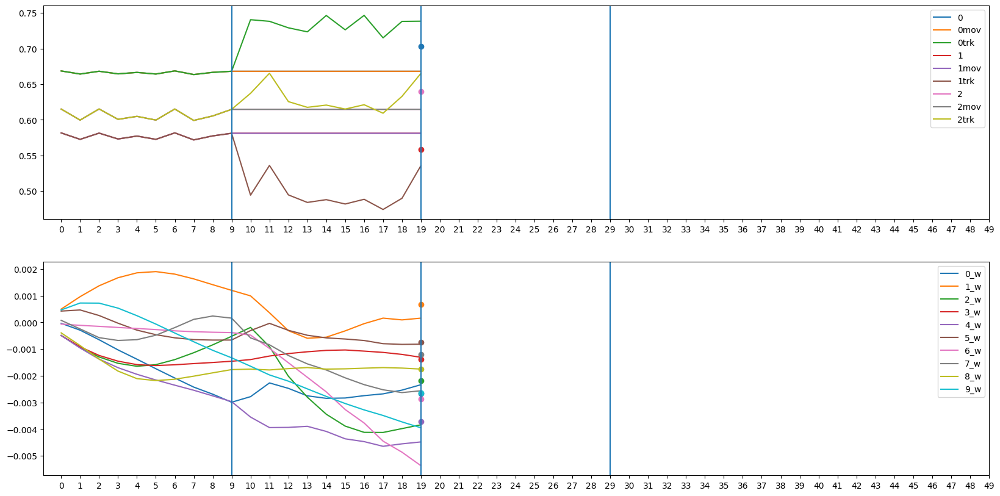

In [70]:
fig, axarr = plt.subplots(2,1,figsize=(20,10))
opt = tf.reduce_mean(quicktest.layers[1].style_means, axis=0).numpy()
for i in range(len(testcb.means[0])):
#for i in range(5):
    tot = []
    mov = []
    trk = []
    for j in range(len(testcb.means)):
        tot.append(testcb.total[j][i])
        mov.append(testcb.means[j][i])
        trk.append(testcb.traks[j][i])
    p = axarr[0].plot(tot, label=i)
    axarr[0].plot(mov, label=str(i)+'mov')
    axarr[0].plot(trk, label=str(i)+'trk')
    axarr[0].plot(len(testcb.means)-1, opt[i], marker='o', color=p[0].get_color())

#optimal = merge_model_weights([testcb.wigths[9], testcb.wigths[-1]], [0.6, 0.7])
optimal = join_modelo.layers[2].get_weights()[1]
#for i in range(len(testcb.wigths[0])):
for i in range(10):
    wit = []
    for j in range(len(testcb.wigths)):
        wit.append(testcb.wigths[j][i])
    p = axarr[1].plot(wit, label=str(i)+'_w')
    axarr[1].plot(len(testcb.wigths)-1, optimal[i], marker='o', color=p[0].get_color())

axarr[0].legend()
axarr[1].legend()
axarr[0].set_xticks(list(range(0, 50)), minor=False)
axarr[1].set_xticks(list(range(0, 50)), minor=False)
axarr[0].axvline(x=9)
axarr[0].axvline(x=19)
axarr[0].axvline(x=29)
axarr[1].axvline(x=9)
axarr[1].axvline(x=19)
axarr[1].axvline(x=29)
plt.show()

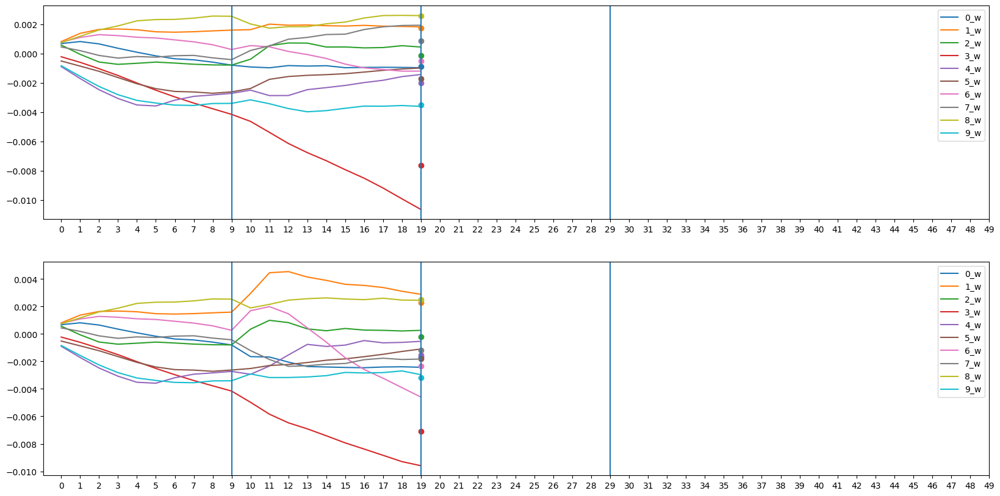

In [57]:
fig, axarr = plt.subplots(2,1,figsize=(20,10))
optimal = merge_model_weights([testcb.wigths[9], testcb.wigths[-1]], [0.6, 0.7])
for i in range(10):
    wit = []
    for j in range(len(testcb.wigths)):
        wit.append(testcb.wigths[j][i])
    p = axarr[0].plot(wit, label=str(i)+'_w')
    axarr[0].plot(len(testcb.wigths)-1, optimal[i], marker='o', color=p[0].get_color())

optimal = merge_model_weights([testcb2.wigths[9], testcb2.wigths[-1]], [0.6, 0.7])
#for i in range(len(testcb.wigths[0])):
for i in range(10):
    wit = []
    for j in range(len(testcb2.wigths)):
        wit.append(testcb2.wigths[j][i])
    p = axarr[1].plot(wit, label=str(i)+'_w')
    axarr[1].plot(len(testcb2.wigths)-1, optimal[i], marker='o', color=p[0].get_color())

axarr[0].legend()
axarr[1].legend()
axarr[0].set_xticks(list(range(0, 50)), minor=False)
axarr[1].set_xticks(list(range(0, 50)), minor=False)
axarr[0].axvline(x=9)
axarr[0].axvline(x=19)
axarr[0].axvline(x=29)
axarr[1].axvline(x=9)
axarr[1].axvline(x=19)
axarr[1].axvline(x=29)
plt.show()

In [92]:
# tarefa, train/val, batch, img/pred, index
malditoi = 2
imgt1 = task_list[0][1][0][0][malditoi:malditoi+1]
mskt1 = task_list[0][1][0][1][malditoi:malditoi+1]
imgt2 = task_list[1][1][0][0][malditoi:malditoi+1]
mskt2 = task_list[1][1][0][1][malditoi:malditoi+1]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


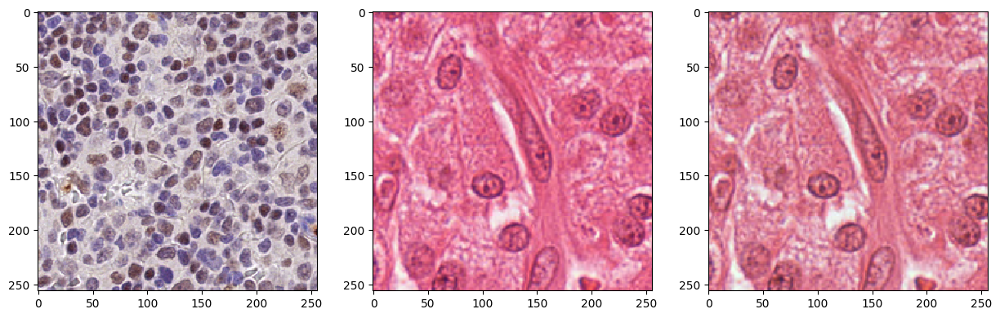

In [94]:
changeBMmodel(quicktest, 'use_style', -1)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
changed = quicktest.layers[1](imgt2[0])

fig, axarr = plt.subplots(1,3, figsize=(15, 8))    
axarr[0].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[1].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[2].imshow(changed, cmap='viridis', interpolation='None')

In [95]:
changeBMmodel(quicktest, 'use_style', -1)
#changeBMmodel(quicktest, 'use_style', 0)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
trainedt3evalt1 = quicktest(imgt1)#, training=True)
#changeBMmodel(quicktest, 'use_style', 1)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
trainedt3evalt2 = quicktest(imgt2)#, training=True)

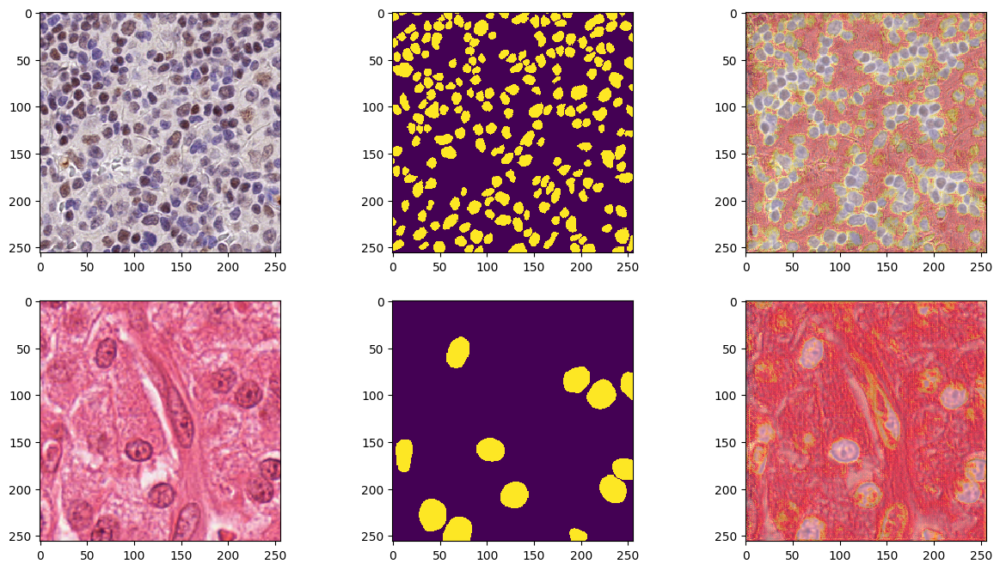

In [96]:
fig, axarr = plt.subplots(2,3, figsize=(15, 8))    
axarr[0][0].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][1].imshow(mskt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(maskImg(trainedt3evalt1[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
axarr[1][0].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][1].imshow(mskt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(maskImg(trainedt3evalt2[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
plt.show()

In [211]:
trainedtAevalt1 = quicktest(imgt1)
trainedtAevalt2 = quicktest(imgt2)

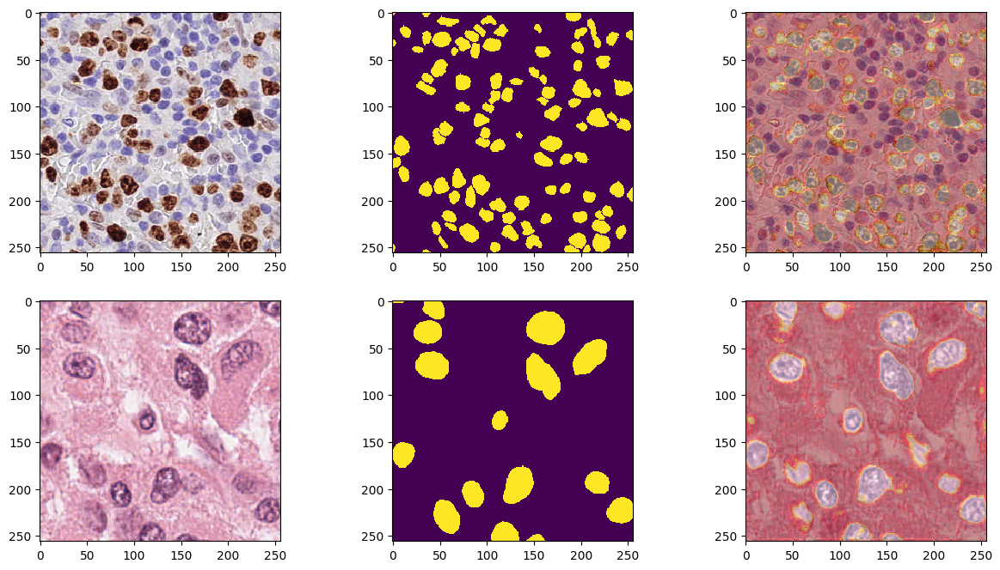

In [212]:
fig, axarr = plt.subplots(2,3, figsize=(15, 8))    
axarr[0][0].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][1].imshow(mskt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(maskImg(trainedtAevalt1[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
axarr[1][0].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][1].imshow(mskt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(maskImg(trainedtAevalt2[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
plt.show()

In [200]:
trainedt1evalt1 = quicktest(imgt1)
trainedt1evalt2 = quicktest(imgt2)

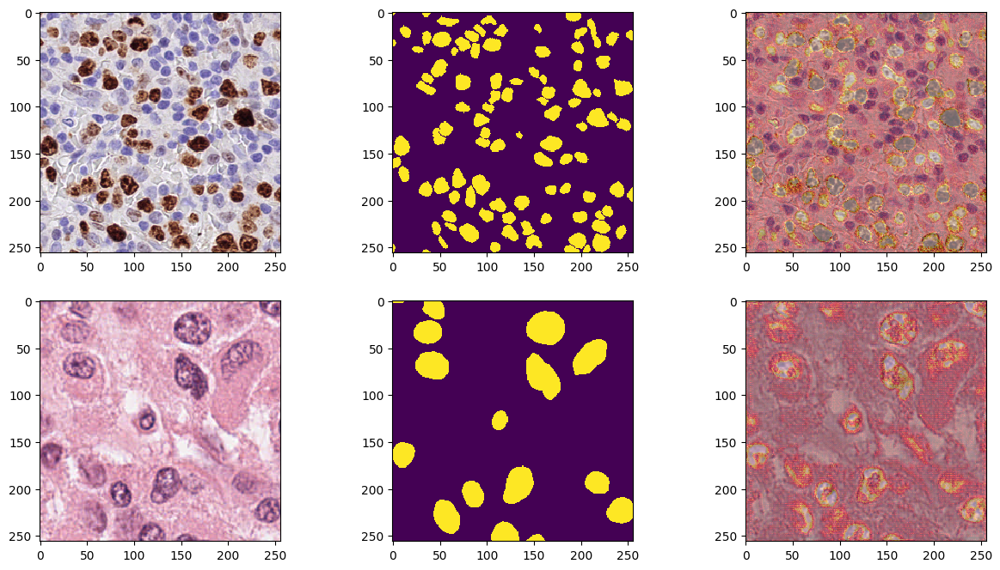

In [201]:
fig, axarr = plt.subplots(2,3, figsize=(15, 8))    
axarr[0][0].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][1].imshow(mskt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(maskImg(trainedt1evalt1[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
axarr[1][0].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][1].imshow(mskt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(maskImg(trainedt1evalt2[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
plt.show()

In [204]:
trainedt2evalt1 = quicktest(imgt1)
trainedt2evalt2 = quicktest(imgt2)

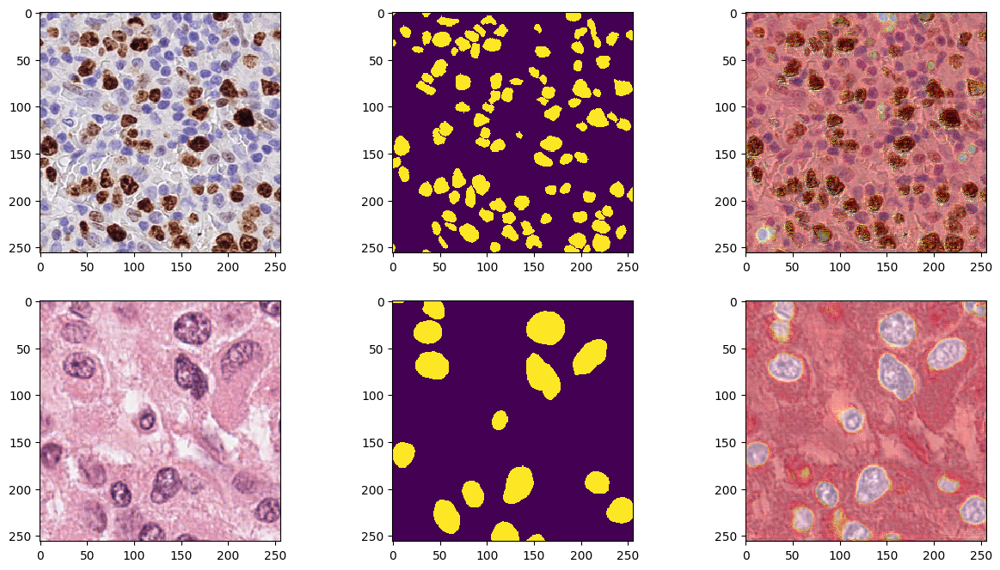

In [205]:
fig, axarr = plt.subplots(2,3, figsize=(15, 8))    
axarr[0][0].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][1].imshow(mskt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(imgt1[0], cmap='viridis', interpolation='None')
axarr[0][2].imshow(maskImg(trainedt2evalt1[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
axarr[1][0].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][1].imshow(mskt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(imgt2[0], cmap='viridis', interpolation='None')
axarr[1][2].imshow(maskImg(trainedt2evalt2[0].numpy(), 0.0), alpha=0.4, cmap='hot', interpolation='None')
plt.show()

In [278]:
#quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
evaluate_tsk(quicktest, task_list)

4/4 [==============================] - 1s 262ms/step - loss: 1.0157 - dice_loss: 0.7757 - iou_score: 0.2333 - f1-score: 0.3689 - precision: 0.1357 - recall: 0.6544 - auc: 0.7703
Mean 1st metric:  1.235314667224884
Mean last metric:  0.7667836546897888


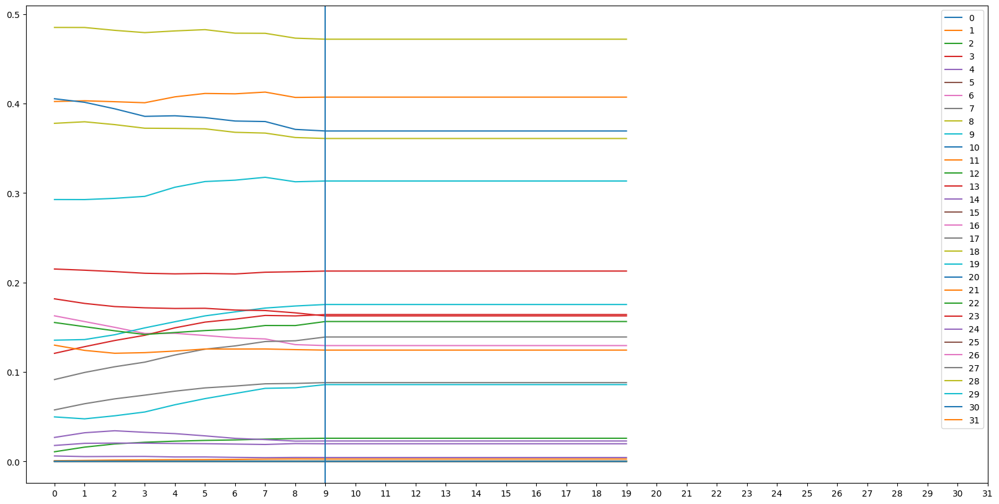

In [287]:
plt.figure(figsize=(20,10))
for i in range(len(testcb.total[0])):
#for i in range(8):
    aux = []
    for j in range(len(testcb.total)):
        aux.append(testcb.total[j][i])
    plt.plot(aux, label=i)
plt.legend()
plt.xticks(list(range(0, 32)))
plt.axvline(x=9)
plt.show()

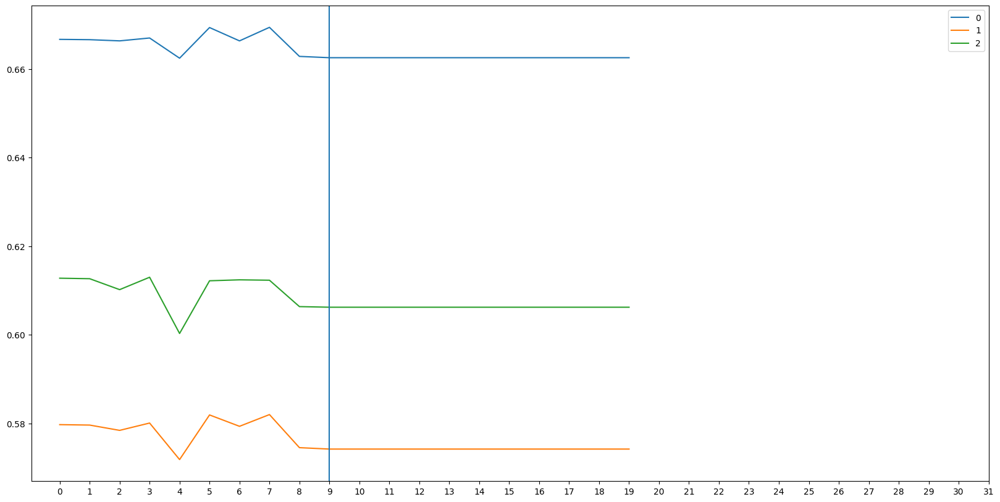

In [280]:
plt.figure(figsize=(20,10))
for i in range(len(testcb.means[0])):
#for i in range(8):
    aux = []
    for j in range(len(testcb.means)):
        aux.append(testcb.means[j][i])
    plt.plot(aux, label=i)
plt.legend()
plt.xticks(list(range(0, 32)))
plt.axvline(x=9)
plt.show()

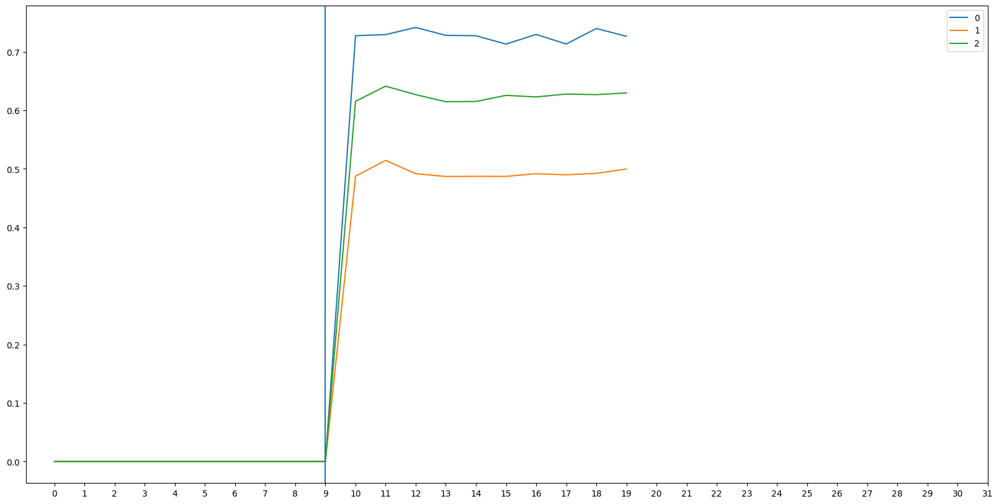

In [281]:
plt.figure(figsize=(20,10))
for i in range(len(testcb.traks[0])):
#for i in range(8):
    aux = []
    for j in range(len(testcb.traks)):
        aux.append(testcb.traks[j][i])
    plt.plot(aux, label=i)
plt.legend()
plt.xticks(list(range(0, 32)))
plt.axvline(x=9)
plt.show()

In [217]:
print(quicktest.layers[3].moving_mean)
print(quicktest.layers[3].track_mean)

<tf.Variable 'batch_modulation_450/moving_mean:0' shape=(32,) dtype=float32, numpy=
array([5.09205740e-03, 1.08505599e-04, 4.61504370e-01, 1.29151210e-01,
       2.79257268e-01, 2.65303075e-01, 2.08953887e-01, 2.72504330e-01,
       7.26035759e-02, 9.99496137e-07, 0.00000000e+00, 4.91702020e-01,
       1.40250713e-01, 8.40676390e-03, 5.08737087e-01, 5.41806628e-04,
       9.21805622e-04, 7.33147860e-02, 2.61893659e-03, 1.23238206e-01,
       6.12678195e-05, 2.34916419e-01, 2.52922446e-01, 7.33971865e-06,
       4.38462436e-01, 3.26943201e-08, 1.33060163e-03, 2.35908046e-01,
       7.84824640e-02, 1.06132878e-02, 2.12689247e-06, 4.87703830e-01],
      dtype=float32)>
<tf.Variable 'batch_modulation_450/track_mean:0' shape=(32,) dtype=float32, numpy=
array([2.5322286e-03, 1.7461758e-04, 4.4265825e-01, 1.0105171e-01,
       2.5721392e-01, 2.3000693e-01, 2.1464603e-01, 2.6932499e-01,
       8.7722883e-02, 1.6537763e-07, 0.0000000e+00, 4.5671129e-01,
       1.0731443e-01, 7.5381016e-03, 4.51

In [38]:
changeBMmodel(quicktest, 'smited')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)

In [39]:
evaluate_tsk(quicktest, task_list)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 1s 202ms/step - loss: 0.8708 - dice_loss: 0.6889 - iou_score: 0.4051 - f1-score: 0.5753 - precision: 0.1978 - recall: 0.7347 - auc: 0.8542
Mean 1st metric:  0.8378100693225861
Mean last metric:  0.8055537343025208


In [131]:
changeBMmodel(quicktest, 'hitdebugOn')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)

In [155]:
um = task_list[0][0][1]
_ = quicktest(um[0][:1])

In [152]:
changeBMmodel(quicktest, 'zerocounts')

In [150]:
getModelHits(quicktest)

[2764.] [176.] [0.9401361]


array([0.9401361], dtype=float32)

In [151]:
quicktest.layers[3].miss

<tf.Variable 'batch_modulation_738/miss:0' shape=(1,) dtype=float32, numpy=array([2.], dtype=float32)>

In [156]:
getModelHits(quicktest)

[2626.] [314.] [0.8931973]


array([0.8931973], dtype=float32)

In [157]:
quicktest.layers[3].miss

<tf.Variable 'batch_modulation_738/miss:0' shape=(1,) dtype=float32, numpy=array([2.], dtype=float32)>

In [274]:
tothit = 0
totmis = 0
for l in range(len(quicktest.layers)):
    if hasattr(quicktest.layers[l], 'forged'):
        tothit += quicktest.layers[l].hits.numpy()
        totmis += quicktest.layers[l].miss.numpy()
print(tothit, totmis, tothit/(tothit+totmis+0.00001))

[2218.] [722.] [0.7544218]


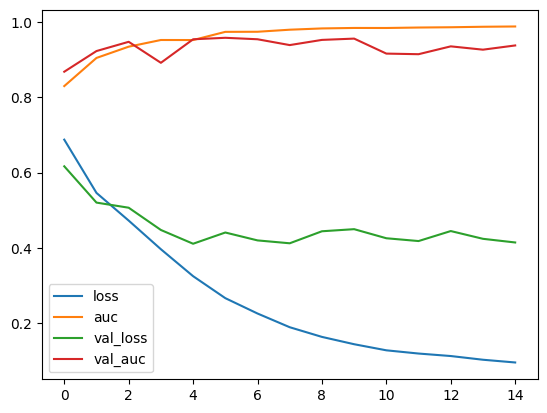

In [68]:
t = 2
plt.plot(histories[t]['loss'], label='loss')
plt.plot(histories[t]['auc'], label='auc')
plt.plot(histories[t]['val_loss'], label='val_loss')
plt.plot(histories[t]['val_auc'], label='val_auc')
plt.legend()
plt.show()

In [45]:
print(quicktest.layers[3].smithing)

True


In [82]:
print(quicktest.layers[3].moving_mean)
#print(quicktest.layers[3].total_mean)
#print(quicktest.layers[4].moving_mean)
#print(quicktest.layers[3].track_mean)
#print(quicktest.layers[3].momments_mean)
print(quicktest.layers[3].moving_variance)
#print(quicktest.layers[3].total_variance)
#print(quicktest.layers[4].moving_variance)
#print(quicktest.layers[3].track_variance)
#print(quicktest.layers[3].momments_variance)
print(quicktest.layers[3].total_count)

<tf.Variable 'batch_modulation_180/moving_mean:0' shape=(32,) dtype=float32, numpy=
array([2.2258671e-02, 2.7046010e-01, 2.8304031e-01, 1.9866693e-01,
       2.0925400e-01, 0.0000000e+00, 9.2112841e-06, 2.0526610e-05,
       5.1503757e-04, 2.2666925e-01, 1.1437807e-05, 4.3368572e-03,
       1.0070703e-01, 2.6337150e-03, 6.6386600e-04, 4.1943759e-01,
       2.8091952e-01, 1.3481776e-03, 2.2920950e-03, 5.7360381e-03,
       4.9782488e-03, 3.1123692e-01, 2.3804244e-01, 1.3490636e-03,
       9.2593208e-02, 1.9189221e-01, 6.6558964e-04, 3.4624115e-03,
       9.0230723e-10, 1.1790603e-01, 1.4627706e-04, 1.5414469e-01],
      dtype=float32)>
<tf.Variable 'batch_modulation_180/moving_variance:0' shape=(32,) dtype=float32, numpy=
array([1.13603997e-03, 1.16490740e-02, 1.81642231e-02, 4.34222445e-03,
       7.18503026e-03, 0.00000000e+00, 2.00847879e-07, 4.81805557e-07,
       6.87053107e-05, 5.11084218e-03, 4.32901487e-07, 2.33179337e-04,
       9.25827248e-04, 8.33769736e-05, 7.59775285e-05, 2

In [77]:
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics, run_eagerly=True)

In [78]:
print(quicktest.layers[3].hit)
print(quicktest.layers[3].miss)

0
0


In [89]:
quicktest.evaluate(task_list[1][1])

5/5 [==============================] - 2s 340ms/step - loss: 0.9015 - dice_loss: 0.7466 - iou_score: 0.1628 - f1-score: 0.2800 - precision: 0.1644 - recall: 0.5533 - auc: 0.6649


[0.9014573097229004,
 0.7465853095054626,
 0.1628192663192749,
 0.2799820303916931,
 0.16441179811954498,
 0.5532671809196472,
 0.664904773235321]

In [80]:
print(quicktest.layers[3].hit)
print(quicktest.layers[3].miss)

78.0
50.0


In [81]:
changeBMmodel(quicktest, 'close')

In [87]:
changeBMmodel(quicktest, 'zerocounts')

In [90]:
print(quicktest.layers[3].hit)
print(quicktest.layers[3].miss)

160.0
0.0


In [63]:
#print(arr_weights)
#print(arr_modus)
#print(arr_means)
print(arr_tmeans)
print(arr_varis)

[array([5.0696149e-04, 1.4666207e-03, 3.0231095e-05, 6.5296699e-06,
       2.3214184e-03, 2.7918541e-03, 2.2437060e-03, 2.1851222e-06,
       4.2572935e-04, 1.1535290e-05, 3.7059803e-03, 5.0998671e-04,
       5.8485242e-04, 7.7687939e-05, 1.3344294e-03, 3.9242267e-09,
       6.5196436e-06, 6.1952228e-06, 0.0000000e+00, 4.8865405e-14,
       2.1451770e-03, 6.1752835e-05, 1.3666276e-03, 1.9062369e-03,
       3.0778649e-03, 1.2054571e-03, 3.6457670e-04, 0.0000000e+00,
       4.8193854e-04, 3.2955937e-05, 6.5179262e-04, 8.1669250e-06],
      dtype=float32), array([5.5392092e-04, 1.5727058e-03, 5.9759379e-05, 1.0185839e-05,
       2.5285766e-03, 3.0197233e-03, 2.4409161e-03, 5.0239223e-06,
       4.7078138e-04, 1.5348764e-05, 4.0141372e-03, 5.5981398e-04,
       6.4673211e-04, 1.1394992e-04, 1.4560681e-03, 1.0381618e-08,
       7.1496702e-06, 9.7556922e-06, 0.0000000e+00, 4.8257249e-12,
       2.3127813e-03, 7.5685137e-05, 1.4637981e-03, 2.0621549e-03,
       3.3316452e-03, 1.3073377e-03, 4

## Results

Conv + BM + BN

In [ ]:
evaluate_tsk(quicktest, task_list)

Conv + BM

In [52]:
evaluate_tsk(quicktest, task_list)

4/4 [==============================] - 1s 208ms/step - loss: 0.4499 - dice_loss: 0.3479 - iou_score: 0.4982 - f1-score: 0.6644 - precision: 0.6015 - recall: 0.7172 - auc: 0.9226
Mean 1st metric:  0.8289262255032858
Mean last metric:  0.7637188732624054


In [42]:
evaluate_tsk(quicktest, task_list)

5/5 [==============================] - 1s 187ms/step - loss: 0.5896 - dice_loss: 0.4969 - iou_score: 0.4212 - f1-score: 0.5924 - precision: 0.5252 - recall: 0.4844 - auc: 0.8982
Mean 1st metric:  0.6366857687632242
Mean last metric:  0.9003940025965372


Conv + BN

In [111]:
evaluate_tsk(quicktest, task_list)

5/5 [==============================] - 1s 184ms/step - loss: 0.4601 - dice_loss: 0.3603 - iou_score: 0.6120 - f1-score: 0.7593 - precision: 0.5362 - recall: 0.7932 - auc: 0.9498
Mean 1st metric:  0.7428447604179382
Mean last metric:  0.8603434761365255


In [38]:
# reversed
evaluate_tsk(quicktest, task_list)

4/4 [==============================] - 1s 182ms/step - loss: 0.5394 - dice_loss: 0.3897 - iou_score: 0.5091 - f1-score: 0.6745 - precision: 0.6122 - recall: 0.6095 - auc: 0.8787
Mean 1st metric:  0.8628704945246378
Mean last metric:  0.7465163667996725


Apenas Conv

In [105]:
evaluate_tsk(quicktest, task_list)

5/5 [==============================] - 1s 175ms/step - loss: 0.5722 - dice_loss: 0.5009 - iou_score: 0.4456 - f1-score: 0.6164 - precision: 0.4259 - recall: 0.6046 - auc: 0.8809
Mean 1st metric:  0.813636859258016
Mean last metric:  0.7529254158337911


EWC1 - Conv + BN

In [30]:
evaluate_tsk(quicktest, task_list)

5/5 [==============================] - 1s 182ms/step - loss: 18575.6094 - dice_loss: 0.7057 - iou_score: 0.1824 - f1-score: 0.3085 - precision: 0.2252 - recall: 0.4251 - auc: 0.6036
Mean 1st metric:  18575.511067708332
Mean last metric:  0.6882927815119425


MAS - Conv + BN

In [33]:
evaluate_tsk(quicktest, task_list)

5/5 [==============================] - 1s 185ms/step - loss: 0.4007 - dice_loss: 0.3092 - iou_score: 0.6106 - f1-score: 0.7581 - precision: 0.6470 - recall: 0.7412 - auc: 0.9509
Mean 1st metric:  0.7603504757086436
Mean last metric:  0.7965553998947144


In [143]:
evaluate_tsk(quicktest, task_list)

5/5 [==============================] - 1s 174ms/step - loss: 0.8486 - dice_loss: 0.7484 - iou_score: 0.0018 - f1-score: 0.0035 - precision: 0.1699 - recall: 0.4849 - auc: 0.8519
Mean 1st metric:  0.9491535094049242
Mean last metric:  0.7796550061967638


# Style Transfer Experiments

In [13]:
import tensorflow_hub as hub

In [14]:
hub_handle = 'https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2'
hub_module = hub.load(hub_handle)

In [41]:
content_image = task_list[1][1][0][0][1:2]
content_mask = task_list[1][1][0][1][1:2]
style_image = task_list[0][1][0][0][:1]

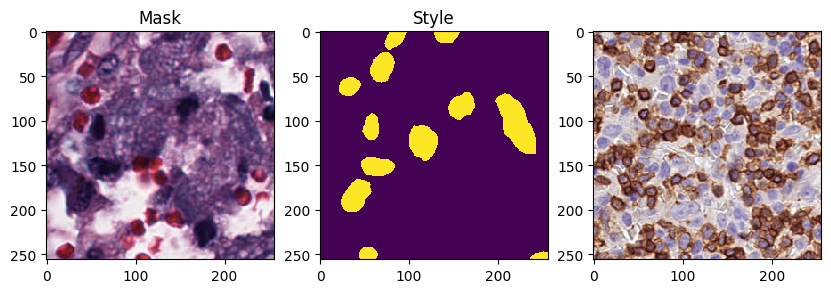

In [43]:
fig, axarr = plt.subplots(1,3, figsize=(10, 8))    
axarr[0].imshow(content_image[0], cmap='viridis', interpolation='None')
axarr[1].imshow(content_mask[0], cmap='viridis', interpolation='None')
axarr[2].imshow(style_image[0], cmap='viridis', interpolation='None')
axarr[0].title.set_text('Input')
axarr[0].title.set_text('Mask')
axarr[1].title.set_text('Style')
plt.show()

In [37]:
outputs = hub_module(tf.convert_to_tensor(content_image, dtype='float32'), tf.convert_to_tensor(style_image, dtype='float32'))

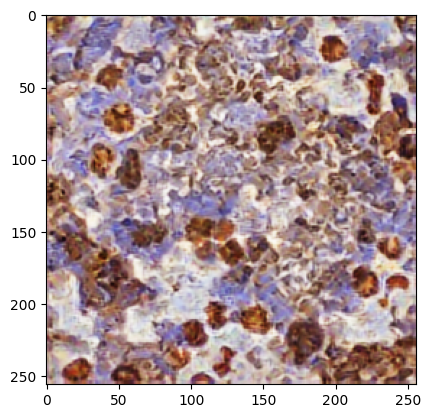

In [38]:
plt.imshow(outputs[0][0])

In [94]:
task_list[0][0].stylizing = False
task_list[0][1].stylizing = False
quicktest.fit(task_list[0][0], steps_per_epoch=len(task_list[0][0]), epochs=10, validation_data=task_list[0][1], validation_steps=len(task_list[0][1]))
quicktest.trainable = False
#mean_var = (quicktest.layers[19].moving_mean.value(), quicktest.layers[19].moving_variance.value())
#changeBMmodel(quickstyle, 'set_mean_var', mean_var)

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.9409 - dice_loss: 0.6994 - iou_score: 0.2057 - f1-score: 0.3397 - precision: 0.2026 - recall: 0.5826 - auc: 0.6342WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x78ecafbe9f80> and will run it as-is.
Please report this to the TensorFlow team. When

In [98]:
task_list[1][0].stylizing = False
task_list[1][1].stylizing = False
quicktest.evaluate(task_list[0][0])
quicktest.evaluate(task_list[1][0])

9/9 [==============================] - 1s 112ms/step - loss: 0.9065 - dice_loss: 0.7927 - iou_score: 0.1499 - f1-score: 0.2596 - precision: 0.1430 - recall: 0.3813 - auc: 0.6948


[0.9064679741859436,
 0.792680025100708,
 0.14988088607788086,
 0.25962033867836,
 0.14302940666675568,
 0.38127031922340393,
 0.6948031187057495]

In [67]:
[layer.output for layer in quickstyle.layers if (not layer.trainable) and 'batch_modulation' in layer.name]
#quicktest.layers
#quickstyle.layers[19].output

[<KerasTensor: shape=(32, 256, 256, 32) dtype=float32 (created by layer 'batch_modulation_1')>,
 <KerasTensor: shape=(32, 128, 128, 64) dtype=float32 (created by layer 'batch_modulation_2')>,
 <KerasTensor: shape=(32, 64, 64, 128) dtype=float32 (created by layer 'batch_modulation_3')>,
 <KerasTensor: shape=(32, 32, 32, 256) dtype=float32 (created by layer 'batch_modulation_4')>,
 <KerasTensor: shape=(32, 16, 16, 512) dtype=float32 (created by layer 'batch_modulation_5')>]

In [ ]:
# tarefa, train/val, batch, img/pred, index
#task_list[0][1][0][0][malditoi:malditoi+1]

In [226]:
def adain(content_feat, style_feat):
    style_mean, style_std = tf.nn.moments(style_feat, (0,1,2))
    content_mean, content_std = tf.nn.moments(content_feat, (0,1,2))
    normalized_feat = (content_feat - content_mean) / content_std
    return normalized_feat * style_std + style_mean

def train_loop_adain(model, content_dataset, style_dataset, loss_fn, epochs):
    bns = [layer.output for layer in model.layers if (not layer.trainable) and 'BN' in layer.name]
    intermediate = [K.function([model.input], [out]) for out in bns]
    
    encoder = tf.keras.Model(inputs=model.input, outputs=model.layers[19].output, name='encoder')
    decoder = tf.keras.Model(inputs=model.layers[20].input, outputs=model.output, name='decoder')

    for epoch in range(epochs):
        print("\nStart of epoch %d" % (epoch,))
        for i in range(len(content_dataset)):
            content = content_dataset[i][0]
            style = style_dataset[i % len(style_dataset)][0]
            
            with tf.GradientTape() as tape:
                #style_feats = self.encode_with_intermediate(style)
                style_feats = [func([style]) for func in intermediate]
                content_feat = encoder(content)
                t = adain(content_feat, style_feats[-1])
    
                g_t = decoder(t)
                #g_t_feats = self.encode_with_intermediate(g_t)
                g_t_feats = [func([g_t]) for func in intermediate]
            
                loss_content = loss_fn(t, g_t_feats[-1])
                #loss_style = 
    
                loss_value = loss_content# + loss_style
    
            grads = tape.gradient(loss_value, model.trainable_weights)
            optimizer.apply_gradients(zip(grads, model.trainable_weights))

In [ ]:
train_loop_adain(quickstyle, task_list[1][0], task_list[0][0], keras.losses.MeanSquaredError(), 10)

In [104]:
def styled_loss(model, loss, style=None):
    #inp = model.input
    #layers = [layer for layer in model.layers if (not layer.trainable)][1:]
    layerids = [i for i in range(len(model.layers)) if 'batch_modulation' in model.layers[i].name]
    print(layerids)
    #outputs = [layer.output for layer in model.layers if 'batch_modulation' in layer.name]
    #functors = [K.function([model.input], [out]) for out in outputs]
    #encoder = tf.keras.Model(inputs=model.input, outputs=model.layers[19].output, name='encoder')
    #decoder = tf.keras.Model(inputs=model.layers[20].input, outputs=model.output, name='decoder')

    def custom_loss(y_true, y_pred):
        cnt_loss = tf.constant([0.])
        #sty_loss = tf.constant([0.])

        model(y_pred, training=False)
        for idx in layerids:
            #print(y_pred.shape)
            #functors[i](y_pred)
            #mean, var = tf.nn.moments(x, (0,1,2))
            #idx = layerids[i]
            cnt_loss += loss(model.layers[idx].moving_mean.value(), model.layers[idx].last_mean) + loss(model.layers[idx].moving_variance.value(), model.layers[idx].last_var)

        #style_feats = style#y_true
        #t = y_true
        #g_t_feats = y_pred
        #for i in range(len(layers)):
        #    style_feats = layers[i](style_feats, training=False)
        #    t = layers[i](t, training=False)
        #    g_t_feats = layers[i](g_t_feats, training=False)   
        #    if 'ReLU' in layers[i].name:
        #        mean, var = tf.nn.moments(g_t_feats, (0,1,2))
        #        tmean, tvar = tf.nn.moments(style_feats, (0,1,2))
        #        sty_loss += loss(layers[i].moving_mean.value(), mean) + loss(layers[i].moving_variance.value(), var)
        #        sty_loss += loss(tmean, mean) + loss(tvar, var)

        #t = layers[-1](t, training=False)
        #cnt_loss = loss(t, g_t_feats)
        #cnt_loss = loss(true_feat, pred_feat)
        #cnt_loss = loss(y_true, y_pred)
        
        #true_feats = [func([y_true]) for func in functors]
        #pred_feats = [func([y_pred]) for func in functors]
        #loss_value = loss(true_feats[-1], pred_feats[-2])
        #for l in range(len(importance)):
        #    sty_loss += loss(true_feats[l].moving_mean.value(), pred_feats[l].moving_mean.value()) + loss(true_feats[l].moving_variance.value(), pred_feats[l].moving_variance.value())
            
        return cnt_loss#+sty_loss
    return custom_loss

In [139]:
optim2 = tf.keras.optimizers.Adam()
quickstyle.compile(optimizer=optim2, loss=keras.losses.MeanSquaredError())#, run_eagerly=True)
#quickstyle.compile(optimizer=optim2, loss=styled_loss(quicktest, keras.losses.MeanSquaredError()))#, run_eagerly=True)

In [145]:
task_list[0][0].stylizing = True
task_list[0][1].stylizing = True
quickstyle.fit(task_list[0][0], steps_per_epoch=len(task_list[0][0]), epochs=10, validation_data=task_list[0][1], validation_steps=len(task_list[0][1]))

Epoch 1/10
5/5 [==============================] - 3s 609ms/step - loss: 0.0269 - val_loss: 0.0276
Epoch 2/10
5/5 [==============================] - 3s 567ms/step - loss: 0.0247 - val_loss: 0.0236
Epoch 3/10
5/5 [==============================] - 3s 576ms/step - loss: 0.0230 - val_loss: 0.0208
Epoch 4/10
5/5 [==============================] - 3s 582ms/step - loss: 0.0213 - val_loss: 0.0200
Epoch 5/10
5/5 [==============================] - 3s 579ms/step - loss: 0.0202 - val_loss: 0.0207
Epoch 6/10
5/5 [==============================] - 3s 581ms/step - loss: 0.0193 - val_loss: 0.0174
Epoch 7/10
5/5 [==============================] - 3s 561ms/step - loss: 0.0180 - val_loss: 0.0179
Epoch 8/10
5/5 [==============================] - 3s 561ms/step - loss: 0.0172 - val_loss: 0.0178
Epoch 9/10
5/5 [==============================] - 3s 581ms/step - loss: 0.0164 - val_loss: 0.0167
Epoch 10/10
5/5 [==============================] - 3s 567ms/step - loss: 0.0155 - val_loss: 0.0141


In [123]:
task_list[1][0].stylizing = True
task_list[1][1].stylizing = True
quickstyle.fit(task_list[1][0], steps_per_epoch=len(task_list[1][0]), epochs=10, validation_data=task_list[1][1], validation_steps=len(task_list[1][1]))
#task_list[1][0].stylizing = False
#task_list[1][1].stylizing = False

Epoch 1/10
9/9 [==============================] - 7s 807ms/step - loss: 94.7084 - val_loss: 99.4048
Epoch 2/10
9/9 [==============================] - 7s 795ms/step - loss: 91.5513 - val_loss: 90.6981
Epoch 3/10
9/9 [==============================] - 7s 794ms/step - loss: 88.4182 - val_loss: 106.2427
Epoch 4/10
9/9 [==============================] - 7s 796ms/step - loss: 85.5180 - val_loss: 103.0598
Epoch 5/10
9/9 [==============================] - 7s 801ms/step - loss: 82.9539 - val_loss: 75.3342
Epoch 6/10
9/9 [==============================] - 7s 802ms/step - loss: 80.2314 - val_loss: 64.9174
Epoch 7/10
9/9 [==============================] - 7s 799ms/step - loss: 77.7798 - val_loss: 76.0564
Epoch 8/10
9/9 [==============================] - 7s 803ms/step - loss: 75.5080 - val_loss: 66.9786
Epoch 9/10
9/9 [==============================] - 7s 800ms/step - loss: 73.3280 - val_loss: 66.1059
Epoch 10/10
9/9 [==============================] - 7s 805ms/step - loss: 71.2409 - val_loss: 75.06

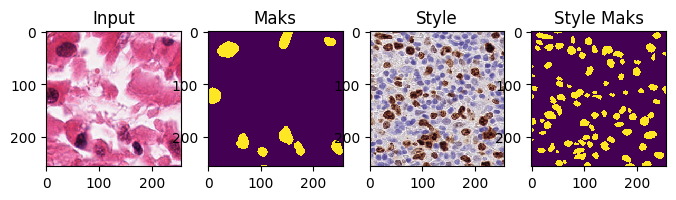

In [130]:
task_list[0][0].stylizing = False
task_list[0][1].stylizing = False
task_list[1][0].stylizing = False
task_list[1][1].stylizing = False
fig, axarr = plt.subplots(1,4, figsize=(8, 8))    
axarr[0].imshow(task_list[1][1][0][0][1:2][0], cmap='viridis', interpolation='None')
axarr[1].imshow(task_list[1][1][0][1][1:2][0], cmap='viridis', interpolation='None')
axarr[2].imshow(task_list[0][1][0][0][:1][0], cmap='viridis', interpolation='None')
axarr[3].imshow(task_list[0][1][0][1][:1][0], cmap='viridis', interpolation='None')
axarr[0].title.set_text('Input')
axarr[1].title.set_text('Maks')
axarr[2].title.set_text('Style')
axarr[3].title.set_text('Style Maks')
plt.show()

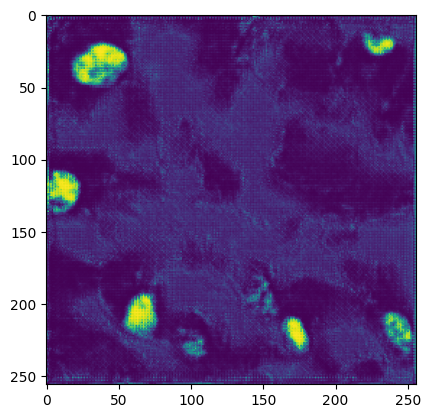

In [142]:
plt.imshow(quicktest(task_list[1][1][0][0][1:2])[0])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


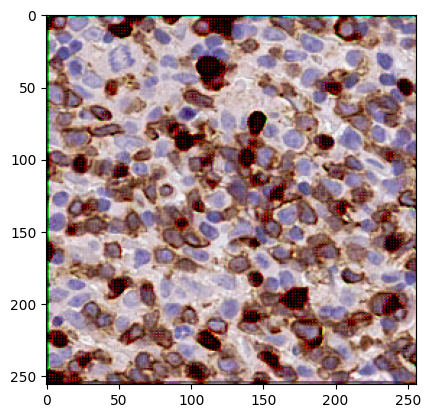

In [147]:
plt.imshow(quickstyle(task_list[0][1][0][0][1:2])[0])

In [124]:
supermodel = keras.Sequential([quickstyle, quicktest])
supermodel.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)

In [125]:
task_list[0][0].stylizing = False
task_list[0][1].stylizing = False
task_list[1][0].stylizing = False
task_list[1][1].stylizing = False
quicktest.evaluate(task_list[0][0])
quicktest.evaluate(task_list[1][0])
supermodel.evaluate(task_list[0][0])
supermodel.evaluate(task_list[1][0])

9/9 [==============================] - 1s 113ms/step - loss: 0.9251 - dice_loss: 0.8020 - iou_score: 0.1661 - f1-score: 0.2839 - precision: 0.1236 - recall: 0.5030 - auc: 0.7018
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert


Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
9/9 [==============================] - 3s 303ms/step - loss: 1.2009 - dice_loss: 0.7985 - iou_score: 0.1444 - f1-score: 0.2520 - precision: 0.1203 - recall: 0.6286 - auc: 0.7017


[1.200919270515442,
 0.7984501719474792,
 0.1444331705570221,
 0.25197458267211914,
 0.12031854689121246,
 0.6285554766654968,
 0.7016969919204712]

In [135]:
quicktest.trainable = True
quickstyle.trainable = False

In [ ]:
quicktest.summary()#.layers[25].trainable

In [77]:
d1 = np.random.normal(5, 0.5, 100)
d2 = np.random.normal(6, 0.7, 100)
print(np.mean(d1), np.var(d1), np.sqrt(np.var(d1)))
print(np.mean(d2), np.var(d2), np.sqrt(np.var(d2)))

4.993624662897518 0.27084317020653875 0.5204259507427917
6.016498026715655 0.5117524730671204 0.71536876718733


In [119]:
#d3 = 4.993624662897518 + ((d2 - 6.016498026715655) * np.sqrt(0.27084317020653875 / 0.5117524730671204))
d3 = 4.993624662897518*0.1) + ((d2 - (6.016498026715655*0.9)) * np.sqrt(0.27084317020653875 / 0.5117524730671204))
print(np.mean(d3), np.var(d3), np.sqrt(np.var(d3)))

0.9370586377352251 0.27084317020653875 0.5204259507427917


In [22]:
starting_weights = quicktest.get_weights().copy()

In [ ]:
quicktest.set_weights(starting_weights)

In [ ]:
history = quicktest.fit(fullds_train, steps_per_epoch=len(fullds_train), epochs=20, validation_data=fullds_val, validation_steps=len(fullds_val))

In [210]:
evaluate_tsk(quicktest, task_list)

4/4 [==============================] - 1s 184ms/step - loss: 0.8228 - dice_loss: 0.6656 - iou_score: 0.4442 - f1-score: 0.6142 - precision: 0.2134 - recall: 0.8005 - auc: 0.9187
Mean 1st metric:  0.7400565445423126
Mean last metric:  0.9288150370121002


## Results

In [149]:
join_modelo = clone_model(quicktest)
join_modelo.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
quicktest.fit(task_list[0][0], steps_per_epoch=len(task_list[0][0]), epochs=10, validation_data=task_list[0][1], validation_steps=len(task_list[0][1]))#, callbacks=[testcb])
join_modelo.set_weights(quicktest.get_weights())
evaluate_tsk(quicktest, task_list)
changeBMmodel(quicktest, 'forge')
changeBMmodel(quicktest, 'new_style')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
quicktest.fit(task_list[1][0], steps_per_epoch=len(task_list[1][0]), epochs=10, validation_data=task_list[1][1], validation_steps=len(task_list[1][1]))#, callbacks=[testcb])
evaluate_tsk(quicktest, task_list)

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - ETA: 0s - loss: 0.9262 - dice_loss: 0.6664 - iou_score: 0.2461 - f1-score: 0.3944 - precision: 0.2259 - recall: 0.6392 - auc: 0.7129WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x7beac0d3ccb0> and will run it as-is.
Please report this to the TensorFlow team. When

In [ ]:
fig, axarr = plt.subplots(2,1,figsize=(20,10))
#for i in range(len(testcb.means[0])):
for i in range(10):
    #tot = []
    mov = []
    #trk = []
    for j in range(len(testcb.means)):
        #tot.append(testcb.total[j][i])
        mov.append(testcb.means[j][i])
        #trk.append(testcb.traks[j][i])
    axarr[0].plot(mov, label=i)
    #axarr[0].plot(mov, label=str(i)+'mov')
    #axarr[0].plot(trk, label=str(i)+'trk')

#for i in range(len(testcb.wigths[0])):
for i in range(10):
    wit = []
    for j in range(len(testcb.wigths)):
        wit.append(testcb.wigths[j][i])
    axarr[1].plot(wit, label=str(i)+'_w')

axarr[0].legend()
axarr[1].legend()
axarr[0].set_xticks(list(range(0, 25)), minor=False)
axarr[1].set_xticks(list(range(0, 25)), minor=False)
axarr[0].axvline(x=9)
axarr[1].axvline(x=9)
plt.show()

In [101]:
join_modelo = clone_model(quicktest)
#join_modelo.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
quicktest.fit(task_list[0][0], steps_per_epoch=len(task_list[0][0]), epochs=10, validation_data=task_list[0][1], validation_steps=len(task_list[0][1]), callbacks=[testcb])
changeBMmodel(quicktest, 'forge')
changeBMmodel(quicktest, 'new_style')
evaluate_tsk(quicktest, task_list)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
join_modelo.set_weights(quicktest.get_weights())
#testcb2.means = testcb.means.copy()
#testcb2.traks = testcb.traks.copy()
#testcb2.total = testcb.total.copy()
#testcb2.wigths = testcb.wigths.copy()
quicktest.fit(task_list[1][0], steps_per_epoch=len(task_list[1][0]), epochs=10, validation_data=task_list[1][1], validation_steps=len(task_list[1][1]), callbacks=[testcb])
changeBMmodel(quicktest, 'new_style')
evaluate_tsk(quicktest, task_list)
break
changeBMmodel(quicktest, 'use_style', 1)
evaluate_tsk(quicktest, task_list)
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
quicktest.fit(task_list[1][0], steps_per_epoch=len(task_list[1][0]), epochs=10, validation_data=task_list[1][1], validation_steps=len(task_list[1][1]), callbacks=[testcb])
evaluate_tsk(quicktest, task_list)
#join_modelo.fit(task_list[1][0], steps_per_epoch=len(task_list[1][0]), epochs=10, validation_data=task_list[1][1], validation_steps=len(task_list[1][1]), callbacks=[testcb2])

SyntaxError: 'break' outside loop (2636235408.py, line 19)

In [150]:
quicktest.evaluate(task_list[0][1])
quicktest.evaluate(task_list[1][1])
join_modelo.evaluate(task_list[0][1])
join_modelo.evaluate(task_list[1][1])
print()

4/4 [==============================] - 1s 114ms/step - loss: 0.8657 - dice_loss: 0.7175 - iou_score: 0.3737 - f1-score: 0.5430 - precision: 0.1738 - recall: 0.7653 - auc: 0.8828
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 1s 114ms/step - loss: 1.1436 - dice_loss: 0.8196 - iou_score: 0.1263 - f1-score: 0.2228 - precision: 0.1110 - recall: 0.4975 - auc: 0.5824



In [116]:
malditoi = 2
imgt1 = task_list[0][1][0][0][malditoi:malditoi+1]
imgt2 = task_list[1][1][0][0][malditoi:malditoi+1]

In [155]:
actvt1 = get_activations(quicktest, imgt1)
actvt2 = get_activations(quicktest, imgt2)

In [136]:
actvt1[39].shape

(256, 256, 32)

In [ ]:
print_filters_3d(actvt1[39])

In [ ]:
print_filters_3d(actvt1[39])

In [ ]:
print_filters_3d(actvt2[39])

In [ ]:
print_filters_3d(actvt2[39])

In [ ]:
print_filters_3d(join_modelo.layers[2].get_weights()[0][:,:,0])

In [ ]:
print_filters_3d(quicktest.layers[2].get_weights()[0][:,:,0])

# Model Fusion Experiments (Arithmetic)

In [87]:
def weighted_mean(values, importances):
    sums = None
    weights = 0
    for i in range(len(values)):
        weights += importances[i]
        if sums is None:
            sums = values[i]*importances[i]
        else:
            sums += values[i]*importances[i]
    return sums / weights

def weighted_median(values, weights):
    data = list(zip(values, weights))
    #data.sort()
    sorted(data, key=lambda x: x[1]) #sort by weight

    midpoint = weights.sum() / 2.0

    cumulative_weight = 0
    for value, weight in data:
        cumulative_weight += weight
        if cumulative_weight >= midpoint:
            return value

    raise 'No_Median'

In [88]:
def merge_model_weights(models, importances):
    teoric_weights = []
    for i in range(len(models[0])):
        weights = []
        for j in range(len(models)):
            weights.append(models[j][i])
        teoric_weights.append(weighted_mean(weights, importances))
        #teoric_weights.append(weighted_median(weights, np.array(importances)))
    return teoric_weights

In [170]:
def evaluate_continual(model, baseline_model, task_list, curr_task_index, curr_task_old_metric, metric_index=0):
    base = new = all = ideal = fwt = bwt = 0.0
    for i in range(len(task_list)):
        loss = model.evaluate(task_list[i][1])[metric_index] # loss in validation
        
        if i < curr_task_index:
            base += loss
        if i == curr_task_index:
            new = loss
            baseline_loss = baseline_model.evaluate(task_list[i][1])[metric_index]
            fwt = loss - baseline_loss
            bwt = loss - curr_task_old_metric
            
        ideal += loss

    all = (base + new)/(curr_task_index+1)
    base = base/(1 if curr_task_index == 0 else curr_task_index)
    ideal = ideal/len(task_list)
    
    return base, new, all, ideal, fwt, bwt

In [171]:
def plot_continual_performance(base, new, all, ideal, fwt, bwt):
    fig, axarr = plt.subplots(1,2, figsize=(20, 4))
    
    #plt.figure(figsize=(10,4))
    axarr[0].plot(base, label='base/forgetting')
    axarr[0].plot(new, label='new/convergence')
    axarr[0].plot(all, label='all/performance')
    axarr[0].plot(ideal, label='ideal/baseline')
    axarr[0].legend(loc="upper right")
    
    axarr[1].plot(fwt, label='forward')
    axarr[1].plot(bwt, label='backward')
    axarr[1].legend(loc="upper right")
    
    plt.ylabel('Metric')
    plt.xlabel('Tasks')
    plt.xticks(np.arange(0, len(base)+1, 1.0))
    
    plt.show()

In [99]:
#task_list = [(t1_canseg_train, t1_canseg_val),(t3_canseg_train, t3_canseg_val),(lyn_train, lyn_val),(t6_canseg_train, t6_canseg_val)]
task_list = []

for i in range(len(all_types)):
    if i not in [0, 3]:
    #if i >= 8: # only the first 8 are good samples
        continue
    train_ids, val_ids = split_canser_seg(all_types[i:i+1], split=0.7)
    canseg_train = DataloderCancerSeg(ids=train_ids, batch_size=BATCH_SIZE, shuffle=True)
    canseg_val = DataloderCancerSeg(ids=val_ids, batch_size=BATCH_SIZE, shuffle=True)

    task_list.append((canseg_train, canseg_val))

task_list.append((lyn_train, lyn_val))

## Baseline

In [150]:
aux_train = []
aux_val = []
for train, val in task_list:
    aux_train.append(train)
    aux_val.append(val)
    
fullds_train = JoinDataSets(datasets=aux_train)#, fulljoin=True, batchsize=BATCH_SIZE)
fullds_val = JoinDataSets(datasets=aux_val)#, fulljoin=True, batchsize=BATCH_SIZE)

In [151]:
model_mt2.fit(fullds_train, steps_per_epoch=len(fullds_train), epochs=10, validation_data=fullds_val, validation_steps=len(fullds_val))

Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
131/131 [==============================] - ETA: 0s - loss: 0.9237 - dice_loss: 0.7580 - iou_score: 0.2425 - f1-score: 0.3786 - precision: 0.1494 - recall: 0.7190 - auc: 0.7923WARNING:tensorflow:AutoGraph could not transform <function Model.make_test_function.<locals>.test_function at 0x7125fc15bb90> and will run it as-is.
Please report this to the TensorFlow team. 

In [152]:
evaluate_tsk(model_mt2, task_list)

5/5 [==============================] - 1s 185ms/step - loss: 1.0246 - dice_loss: 0.7353 - iou_score: 0.1487 - f1-score: 0.2584 - precision: 0.5594 - recall: 0.1747 - auc: 0.6203


In [153]:
model_mt2.save('continuous_baseline.h5')

## Results

In [37]:
model_baseline = build_new_model2()
model_baseline.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)
model_baseline.load_weights('continuous_baseline.h5')

In [39]:
evaluate_tsk(model_baseline, task_list)

5/5 [==============================] - 1s 200ms/step - loss: 1.0234 - dice_loss: 0.7355 - iou_score: 0.1484 - f1-score: 0.2579 - precision: 0.5695 - recall: 0.1733 - auc: 0.6200
Mean 1st metric:  0.5684946709209018
Mean last metric:  0.8051065868801541


In [42]:
model_mt2 = build_new_model2()
model_mt2.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)

In [43]:
%%time
metric_index = -1 # 0

models = []
importances = []

prev_w = None
prev_i = None

met_base = []
met_new = []
met_all = []
met_ideal = []
met_fwt = []
met_bwt = []

model_meta = clone_model(model_mt2)
model_meta.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)

weight_deviation = []

curr_task = 0
for ds_trian, ds_val in task_list:
    prev_weights = model_mt2.get_weights()
    prev_evals = model_mt2.evaluate(ds_val)
    model_mt2.fit(ds_trian, steps_per_epoch=len(ds_trian), epochs=10, validation_data=ds_val, validation_steps=len(ds_val))
    evals = model_mt2.evaluate(ds_val)
    
    importances.append(evals[0]) # loss
    models.append(model_mt2.get_weights())

    first_run = (prev_w is None)
    
    if first_run:
        model_meta.set_weights(model_mt2.get_weights())

    if not first_run:
        for j in range(len(prev_weights)):
            dv = np.abs(model_mt2.get_weights()[j]-prev_weights[j])
            weight_deviation[j] = (weight_deviation[j] + dv)/2.0

    if not first_run:
        new_w = model_mt2.get_weights() # juts to initilize
        meta_weights = model_meta.get_weights()
        
        for j in range(len(model_mt2.get_weights())):
            delta = (model_mt2.get_weights()[j] - meta_weights[j])
            meta_weights[j] = meta_weights[j] + (delta * 0.10)#evals[0])

            #delta2 = (model_mt2.get_weights()[j] - prev_w[j])
            #new_w[j] = prev_w[j] + (delta2 * 0.10)

        diff_m1_m2 = prev_evals[0] - prev_i # loss diff between last task and new task before training
        merge_w = [prev_w, new_w]
        merge_i = [prev_i, evals[0]]
        #
        # tem q usar a diferenca de loss, nao tem jeito
        #
        teoric_weights = merge_model_weights(merge_w, merge_i)

    prev_w = model_mt2.get_weights()
    prev_i = evals[0]

    if not first_run:
        model_mt2.set_weights(teoric_weights)
        model_meta.set_weights(meta_weights)

    cnt_metrics = evaluate_continual(model_mt2, model_baseline, task_list, curr_task, prev_evals[metric_index], metric_index=metric_index)
    met_base.append(cnt_metrics[0])
    met_new.append(cnt_metrics[1])
    met_all.append(cnt_metrics[2])
    met_ideal.append(cnt_metrics[3])
    met_fwt.append(cnt_metrics[4])
    met_bwt.append(cnt_metrics[5])

    curr_task += 1

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 2s 183ms/step - loss: 0.9561 - dice_loss: 0.8500 - iou_score: 1.3582e-04 - f1-score: 2.7158e-04 - precision: 0.0889 - recall: 0.4829 - auc: 0.7176
Epoch 1/10
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' ob

In [113]:
weight_deviation = models[0]
for i in range(1, len(models)):
    for j in range(len(models[i])):
        dv = np.abs(models[i][j]-models[i-1][j])
        weight_deviation[j] = (weight_deviation[j] + dv)/2.0

In [120]:
for i in range(0, len(models)):
    print(models[i][-1])

[0.00961787]
[-0.01633816]
[-0.01532076]
[-0.06240411]
[-0.04386269]
[-0.08271997]
[-0.07343082]
[-0.08636592]
[-0.08341745]


In [83]:
model_baseline.get_weights()[-1]

array([-0.10547506], dtype=float32)

In [114]:
weight_deviation[-1]

array([0.00961787], dtype=float32)

In [45]:
model_mt3 = clone_model(model_mt2)
model_mt3.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)

In [48]:
model_mt3.set_weights(models[1])
model_mt3.evaluate(task_list[0][1])
model_mt3.evaluate(task_list[1][1])
model_mt3.evaluate(task_list[2][1])

1/1 [==============================] - 0s 266ms/step - loss: 0.7639 - dice_loss: 0.7291 - iou_score: 0.4065 - f1-score: 0.5781 - precision: 0.1754 - recall: 0.5951 - auc: 0.9115


[0.7638695240020752,
 0.7290972471237183,
 0.40652114152908325,
 0.5780519247055054,
 0.175370454788208,
 0.5950579643249512,
 0.9114532470703125]

In [100]:
m1index = 1
m2index = 8
met_index = -1

m1 = models[m1index]
m2 = models[m2index]

model_mt3 = clone_model(model_mt2)
model_mt3.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)

baseline1 = None
baseline2 = None

deltas = []
for i in range(len(m1)):
    deltas.append(m2[i]-m1[i])

progressm1 = []
progressm2 = []
for i in range(10+1):
    percent = i/10
    ww = []
    for j in range(len(deltas)):
        ww.append(m1[j]+(deltas[j]*(percent + ((np.random.rand()/9)*random.choice([-1,1]))) ))

    model_mt3.set_weights(ww)
    outs = model_mt3.evaluate(task_list[m1index][1])
    progressm1.append(outs[met_index])
    if percent == 0:
        baseline1 = outs[met_index]
    outs = model_mt3.evaluate(task_list[m2index][1])
    progressm2.append(outs[met_index])
    if percent == 1:
        baseline2 = outs[met_index]

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - 1s 191ms/step - loss: 0.3643 - dice_loss: 0.2996 - iou_score: 0.6167 - f1-score: 0.7628 - precision: 0.6834 - recall: 0.7184 - auc: 0.9570


Baseline M1 0.8053945302963257
Baseline M2 0.9586760401725769


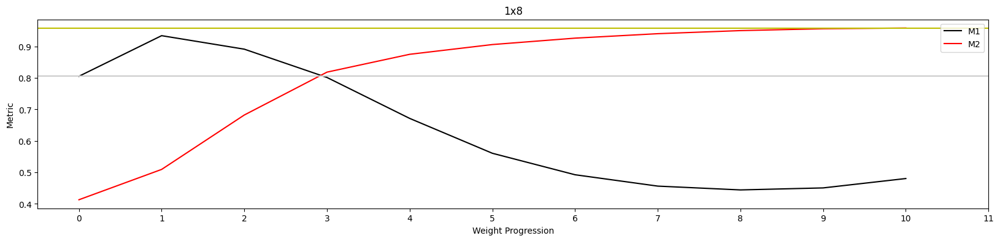

In [31]:
plt.figure(figsize=(20,4))
plt.title('1x8')
plt.plot(progressm1, label='M1', color = 'k')
plt.plot(progressm2, label='M2', color = 'r')
plt.legend(loc="upper right")

print('Baseline M1', baseline1)
print('Baseline M2', baseline2)
plt.axhline(y=baseline1, color = '0.8', linestyle = '-')
plt.axhline(y=baseline2, color = 'y', linestyle = '-')
    
plt.ylabel('Metric')
plt.xlabel('Weight Progression')
plt.xticks(np.arange(0, len(progressm1)+1, 1.0))
    
plt.show()

Baseline M1 0.6566657423973083
Baseline M2 0.9569568037986755


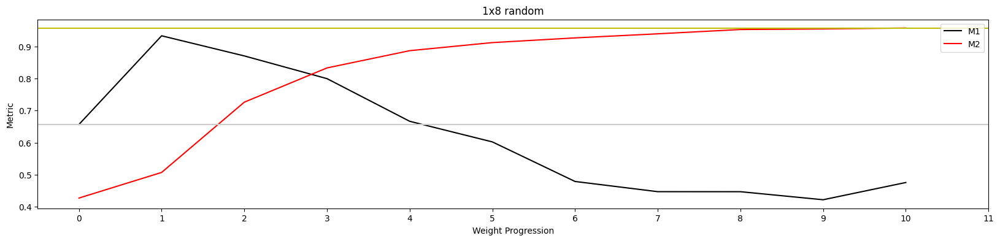

In [102]:
plt.figure(figsize=(20,4))
plt.title('1x8 random')
plt.plot(progressm1, label='M1', color = 'k')
plt.plot(progressm2, label='M2', color = 'r')
plt.legend(loc="upper right")

print('Baseline M1', baseline1)
print('Baseline M2', baseline2)
plt.axhline(y=baseline1, color = '0.8', linestyle = '-')
plt.axhline(y=baseline2, color = 'y', linestyle = '-')
    
plt.ylabel('Metric')
plt.xlabel('Weight Progression')
plt.xticks(np.arange(0, len(progressm1)+1, 1.0))
    
plt.show()

In [79]:
evaluate_tsk(model_mt2, task_list)

5/5 [==============================] - 1s 178ms/step - loss: 0.6598 - dice_loss: 0.4353 - iou_score: 0.4907 - f1-score: 0.6583 - precision: 0.4663 - recall: 0.7183 - auc: 0.9142
Mean 1st metric:  0.7969444526566399
Mean last metric:  0.8588753806220161


In [84]:
evaluate_tsk(model_meta, task_list)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - 1s 177ms/step - loss: 0.8631 - dice_loss: 0.7651 - iou_score: 0.0674 - f1-score: 0.1262 - precision: 0.1999 - recall: 0.2850 - auc: 0.6160
Mean 1st metric:  0.7900174525048997
Mean last metric:  0.8057376742362976


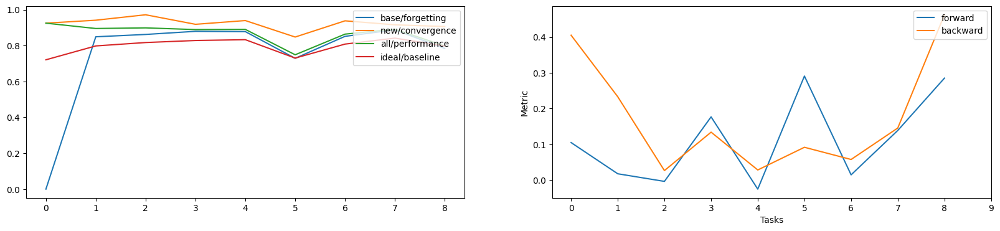

In [29]:
plot_continual_performance(met_base, met_new, met_all, met_ideal, met_fwt, met_bwt)

In [87]:
model_mt3 = clone_model(model_mt2)
model_mt3.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)

In [88]:
teoric_weights = merge_model_weights(models, importances)

In [89]:
model_mt3.set_weights(teoric_weights)

In [115]:
model_mt3.evaluate(t1_canseg_val)
model_mt3.evaluate(t3_canseg_val)
model_mt3.evaluate(t6_canseg_val)
model_mt3.evaluate(lyn_val)
print()

5/5 [==============================] - 1s 180ms/step - loss: 0.5201 - dice_loss: 0.4458 - iou_score: 0.5386 - f1-score: 0.6999 - precision: 0.4624 - recall: 0.6921 - auc: 0.9281



In [90]:
evaluate_tsk(model_mt3, task_list)

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
5/5 [==============================] - 1s 195ms/step - loss: 0.9255 - dice_loss: 0.7953 - iou_score: 0.0461 - f1-score: 0.0880 - precision: 0.2039 - recall: 0.2057 - auc: 0.6485


## Pure Fusion

In [44]:
def arit_training_step(model, task, optimizer, loss, metrics, inner_iterations=5):
    train_data, val_data = task
    
    model.compile(loss=loss, optimizer=optimizer, metrics=metrics)
    model.fit(
        train_data,
        steps_per_epoch=len(train_data),
        epochs=inner_iterations, 
        validation_data=val_data,
        validation_steps=len(val_data),
    )

    task_importance = importance_matrix(model, loss, val_data)

    return model, task_importance

In [45]:
model_mt_t1 = build_new_model2()

optim = keras.optimizers.Adam(LR)

dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + focal_loss
    
metrics = [sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), sm.metrics.Precision(), sm.metrics.Recall(), tf.keras.metrics.AUC()]

In [112]:
model_mt_join = clone_model(model_mt_t1)
model_mt_join.compile(loss=total_loss, optimizer=optim, metrics=metrics)
evaluate_mt(model_mt_join)

join_weights = fim1.copy()
for l in range(len(join_weights)):
    weighted_sum = ((model_mt_t1.trainable_weights[l] * fim1[l]) + (model_mt_t2.trainable_weights[l] * fim2[l]) + (model_mt_t3.trainable_weights[l] * fim3[l])
        + (model_mt_t4.trainable_weights[l] * fim4[l])
        + (model_mt_t5.trainable_weights[l] * fim5[l]))
    total_weight = fim1[l] + fim2[l] + fim3[l] + fim4[l] + (fim5[l])
    join_weights[l] = np.nan_to_num(weighted_sum / total_weight)
    #join_weights[l] = model_mt_t1.trainable_weights[l]

for l in range(len(model_mt_join.trainable_weights)):
    model_mt_join.trainable_weights[l].assign(join_weights[l])

print('')
evaluate_mt(model_mt_join)

13/13 [==============================] - 19s 1s/step - loss: 0.9829 - iou_score: 0.0548 - f1-score: 0.1022 - precision: 0.0472 - recall: 0.3738 - auc_15: 0.5169

13/13 [==============================] - 19s 1s/step - loss: 1.0166 - iou_score: 0.0255 - f1-score: 0.0496 - precision: 0.0450 - recall: 0.2946 - auc_15: 0.5075


In [109]:
evaluate_mt(model_mt_t2)

13/13 [==============================] - 19s 1s/step - loss: 1.0280 - iou_score: 0.1488 - f1-score: 0.2531 - precision: 0.0676 - recall: 0.6202 - auc_15: 0.7842


In [111]:
model_mt_join = clone_model(model_mt_t2)
model_mt_join.compile(loss=total_loss, optimizer=optim, metrics=metrics)
#model_mt_join.set_weights(model_mt_t2.get_weights())
evaluate_mt(model_mt_join)
#for l in range(len(model_mt_join.trainable_weights)):
#    model_mt_join.trainable_weights[l].assign(model_mt_t1.trainable_weights[l])
#print('')
#evaluate_mt(model_mt_join)

13/13 [==============================] - 19s 1s/step - loss: 1.0280 - iou_score: 0.1488 - f1-score: 0.2531 - precision: 0.0676 - recall: 0.6202 - auc_15: 0.7842


In [46]:
%%time
optim = keras.optimizers.Adam(LR)
model_mt_t1, fim1 = arit_training_step(model_mt_t1, (t1_canseg_train, t1_canseg_val), optim, total_loss, metrics)
evaluate_mt(model_mt_t1)
model_mt_t2 = clone_model(model_mt_t1)
optim = keras.optimizers.Adam(LR)
model_mt_t2, fim2 = arit_training_step(model_mt_t2, (t2_canseg_train, t2_canseg_val), optim, total_loss, metrics)
evaluate_mt(model_mt_t2)
model_mt_t3 = clone_model(model_mt_t2)
optim = keras.optimizers.Adam(LR)
model_mt_t3, fim3 = arit_training_step(model_mt_t3, (t3_canseg_train, t3_canseg_val), optim, total_loss, metrics)
evaluate_mt(model_mt_t3)
model_mt_t4 = clone_model(model_mt_t3)
optim = keras.optimizers.Adam(LR)
model_mt_t4, fim4 = arit_training_step(model_mt_t4, (t4_canseg_train, t4_canseg_val), optim, total_loss, metrics)
evaluate_mt(model_mt_t4)
model_mt_t5 = clone_model(model_mt_t4)
optim = keras.optimizers.Adam(LR)
model_mt_t5, fim5 = arit_training_step(model_mt_t5, (t5_canseg_train, t5_canseg_val), optim, total_loss, metrics)
evaluate_mt(model_mt_t5)

Epoch 1/5
9/9 [==============================] - 73s 8s/step - loss: 1.0716 - iou_score: 0.1213 - f1-score: 0.2161 - precision: 0.1081 - recall: 0.6137 - auc_15: 0.6635 - val_loss: 1.0276 - val_iou_score: 0.1308 - val_f1-score: 0.2308 - val_precision: 0.1119 - val_recall: 0.6190 - val_auc_15: 0.6930
Epoch 2/5
9/9 [==============================] - 69s 8s/step - loss: 1.0055 - iou_score: 0.1378 - f1-score: 0.2419 - precision: 0.1133 - recall: 0.6423 - auc_15: 0.7337 - val_loss: 0.9946 - val_iou_score: 0.1462 - val_f1-score: 0.2544 - val_precision: 0.1178 - val_recall: 0.6755 - val_auc_15: 0.7781
Epoch 3/5
9/9 [==============================] - 69s 8s/step - loss: 0.9583 - iou_score: 0.1635 - f1-score: 0.2804 - precision: 0.1230 - recall: 0.6907 - auc_15: 0.8226 - val_loss: 0.9440 - val_iou_score: 0.1749 - val_f1-score: 0.2970 - val_precision: 0.1316 - val_recall: 0.7273 - val_auc_15: 0.8488
Epoch 4/5
9/9 [==============================] - 68s 8s/step - loss: 0.9127 - iou_score: 0.2047 -

### Results

In [22]:
fim, prev_params = fit_multi_segmentation(t1_canseg_train, t1_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
evaluate_mt(model_mt)
#fim, prev_params = fit_multi_segmentation(t2_canseg_train, t2_canseg_val, BATCH_SIZE, model_mt, total_loss, optim, metrics, 5, fim, prev_params, lambd=100, ewc=2)
#evaluate_mt(model_mt)

Epoch 1/5
9/9 [==============================] - 68s 7s/step - loss: 1.0778 - iou_score: 0.1076 - f1-score: 0.1938 - precision: 0.1016 - recall: 0.5799 - auc_3: 0.6133 - val_loss: 1.0523 - val_iou_score: 0.1287 - val_f1-score: 0.2279 - val_precision: 0.1106 - val_recall: 0.6485 - val_auc_3: 0.7099
Epoch 2/5
9/9 [==============================] - 62s 7s/step - loss: 1.0092 - iou_score: 0.1402 - f1-score: 0.2457 - precision: 0.1146 - recall: 0.6489 - auc_3: 0.7390 - val_loss: 0.9843 - val_iou_score: 0.1519 - val_f1-score: 0.2636 - val_precision: 0.1170 - val_recall: 0.6682 - val_auc_3: 0.7881
Epoch 3/5
9/9 [==============================] - 62s 7s/step - loss: 0.9616 - iou_score: 0.1622 - f1-score: 0.2788 - precision: 0.1235 - recall: 0.6959 - auc_3: 0.8214 - val_loss: 0.9292 - val_iou_score: 0.1907 - val_f1-score: 0.3202 - val_precision: 0.1364 - val_recall: 0.7654 - val_auc_3: 0.8880
Epoch 4/5
9/9 [==============================] - 62s 7s/step - loss: 0.9162 - iou_score: 0.2019 - f1-sc

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:47<00:00, 11.96s/it]


13/13 [==============================] - 19s 1s/step - loss: 1.0004 - iou_score: 0.0535 - f1-score: 0.0979 - precision: 0.0423 - recall: 0.3671 - auc_3: 0.5489


In [26]:
importance, final_delta, avg_delta, diff_delta = compute_EWC2_matrix(model_mt, total_loss, t1_canseg_val)

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:47<00:00, 11.89s/it]


In [27]:
model_mt2 = build_new_model2()

In [28]:
importance2, final_delta2, avg_delta2, diff_delta2 = compute_EWC2_matrix(model_mt2, total_loss, t1_canseg_val)

100%|█████████████████████████████████████████████████████████████████████████████████████| 4/4 [00:46<00:00, 11.64s/it]


In [39]:
total_mean = []
for i in range(len(avg_delta)):
    total_mean.append(len(avg_delta[i][avg_delta[i] > LR]))
print(np.mean(total_mean))
total_mean = []
for i in range(len(avg_delta2)):
    total_mean.append(len(avg_delta2[i][avg_delta2[i] > LR]))
print(np.mean(total_mean))

10806.09756097561
4992.170731707317


In [38]:
LR

0.0001

In [49]:
max_scale = 0
max_scale2 = 0
for i in range(len(avg_delta)):
    max_scale = np.max((max_scale, np.max(avg_delta[i])))
    max_scale2 = np.max((max_scale2, np.max(avg_delta2[i])))
print(max_scale)
print(max_scale2)

0.22667959332466125
0.26266714930534363


In [48]:
total_mean = []
for i in range(len(new_mean)):
    if len(new_mean[i].shape) == 1:
        total_mean.append(np.mean(new_mean[i]))
    else:
        total_mean.append(np.mean(new_mean[i].flatten()))
print(np.mean(total_mean))
total_mean = []
for i in range(len(new_mean2)):
    if len(new_mean2[i].shape) == 1:
        total_mean.append(np.mean(new_mean2[i]))
    else:
        total_mean.append(np.mean(new_mean2[i].flatten()))
print(np.mean(total_mean))

39.950825
56.870235


In [24]:
total_mean = []
for i in range(len(final_delta)):
    if len(final_delta[i].shape) == 1:
        total_mean.append(np.mean(final_delta[i]))
    else:
        total_mean.append(np.mean(final_delta[i].flatten()))
print(np.mean(total_mean))
total_mean = []
for i in range(len(final_delta2)):
    if len(final_delta2[i].shape) == 1:
        total_mean.append(np.mean(final_delta2[i]))
    else:
        total_mean.append(np.mean(final_delta2[i].flatten()))
print(np.mean(total_mean))

0.23737791
0.23843458


In [40]:
total_mean = []
for i in range(len(avg_delta)):
    if len(avg_delta[i].shape) == 1:
        total_mean.append(np.mean(avg_delta[i]))
    else:
        total_mean.append(np.mean(avg_delta[i].flatten()))
print(np.mean(total_mean))
total_mean = []
for i in range(len(avg_delta2)):
    if len(avg_delta2[i].shape) == 1:
        total_mean.append(np.mean(avg_delta2[i]))
    else:
        total_mean.append(np.mean(avg_delta2[i].flatten()))
print(np.mean(total_mean))

total_mean = []
for i in range(len(avg_delta)):
    total_mean = np.concatenate((total_mean, avg_delta2[i].flatten()))

0.0039950823
0.005687024


In [64]:
len(total_mean[total_mean < 0.0001])

6442353

(array([  59812.,  564921., 1169422., 1219359.,  924738.,  636983.,
         453378.,  343813.,  273345.,  223308.,  187596.,  158146.,
         133498.,  112107.,   95141.,   81449.,   69472.,   59721.,
          51506.,   44721.,   39147.,   35023.,   31552.,   28059.,
          25569.,   23268.,   21264.,   19271.,   18040.,   16813.,
          15578.,   15034.,   13845.,   13323.,   12548.,   11792.,
          11441.,   10731.,   10549.,   10123.,    9673.,    9371.,
           9072.,    8564.,    8473.,    8153.,    7745.,    7506.,
           7408.,    7154.]),
 array([0.00000000e+00, 1.99999820e-06, 3.99999641e-06, 5.99999461e-06,
        7.99999281e-06, 9.99999102e-06, 1.19999892e-05, 1.39999874e-05,
        1.59999856e-05, 1.79999838e-05, 1.99999820e-05, 2.19999802e-05,
        2.39999784e-05, 2.59999766e-05, 2.79999748e-05, 2.99999730e-05,
        3.19999713e-05, 3.39999695e-05, 3.59999677e-05, 3.79999659e-05,
        3.99999641e-05, 4.19999623e-05, 4.39999605e-05, 4.59999587

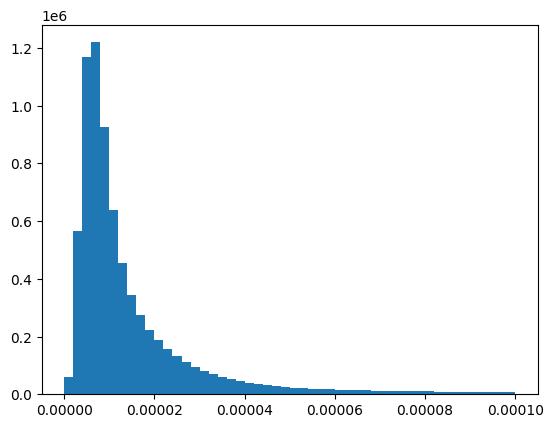

In [44]:
plt.hist(total_mean[total_mean < 0.0001], bins=50)

In [67]:
len(total_mean[total_mean < 0.0001])

7356615

(array([  59812.,  564921., 1169422., 1219359.,  924738.,  636983.,
         453378.,  343813.,  273345.,  223308.,  187596.,  158146.,
         133498.,  112107.,   95141.,   81449.,   69472.,   59721.,
          51506.,   44721.,   39147.,   35023.,   31552.,   28059.,
          25569.,   23268.,   21264.,   19271.,   18040.,   16813.,
          15578.,   15034.,   13845.,   13323.,   12548.,   11792.,
          11441.,   10731.,   10549.,   10123.,    9673.,    9371.,
           9072.,    8564.,    8473.,    8153.,    7745.,    7506.,
           7408.,    7154.]),
 array([0.00000000e+00, 1.99999820e-06, 3.99999641e-06, 5.99999461e-06,
        7.99999281e-06, 9.99999102e-06, 1.19999892e-05, 1.39999874e-05,
        1.59999856e-05, 1.79999838e-05, 1.99999820e-05, 2.19999802e-05,
        2.39999784e-05, 2.59999766e-05, 2.79999748e-05, 2.99999730e-05,
        3.19999713e-05, 3.39999695e-05, 3.59999677e-05, 3.79999659e-05,
        3.99999641e-05, 4.19999623e-05, 4.39999605e-05, 4.59999587

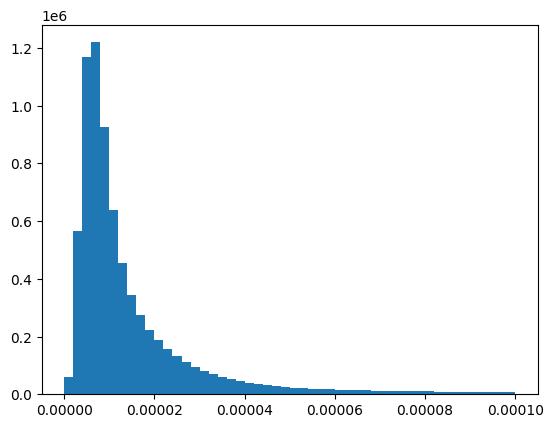

In [43]:
plt.hist(total_mean[total_mean < 0.0001], bins=50)

In [26]:
total_mean = []
for i in range(len(diff_delta)):
    if len(diff_delta[i].shape) == 1:
        total_mean.append(np.mean(diff_delta[i]))
    else:
        total_mean.append(np.mean(diff_delta[i].flatten()))
print(np.mean(total_mean))
total_mean = []
for i in range(len(diff_delta2)):
    if len(diff_delta2[i].shape) == 1:
        total_mean.append(np.mean(diff_delta2[i]))
    else:
        total_mean.append(np.mean(diff_delta2[i].flatten()))
print(np.mean(total_mean))

0.0019025491
0.0016844876


In [27]:
total_mean = []
for i in range(len(model_mt.trainable_weights)):
    if len(model_mt.trainable_weights[i].shape) == 1:
        total_mean.append(np.mean(model_mt.trainable_weights[i]))
    else:
        total_mean.append(np.mean(model_mt.trainable_weights[i].numpy().flatten()))
print(np.mean(total_mean))
total_mean = []
for i in range(len(model_mt2.trainable_weights)):
    if len(model_mt2.trainable_weights[i].shape) == 1:
        total_mean.append(np.mean(model_mt2.trainable_weights[i]))
    else:
        total_mean.append(np.mean(model_mt2.trainable_weights[i].numpy().flatten()))
print(np.mean(total_mean))

0.22001947
0.22020389


# Neural Activation Experiments

## Output Activation

In [20]:
optim = keras.optimizers.Adam(LR)

dice_loss = sm.losses.DiceLoss()
focal_loss = sm.losses.BinaryFocalLoss() if n_classes == 1 else sm.losses.CategoricalFocalLoss()
total_loss = dice_loss + focal_loss
    
metrics = [dice_loss, sm.metrics.IOUScore(threshold=0.5), sm.metrics.FScore(threshold=0.5), sm.metrics.Precision(), sm.metrics.Recall(), tf.keras.metrics.AUC()]

2024-04-11 14:53:15.113125: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-04-11 14:53:15.718263: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1616] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 13611 MB memory:  -> device: 0, name: Tesla T4, pci bus id: 0000:41:00.0, compute capability: 7.5


In [67]:
def regularization_output_loss(model, loss, old_instances, old_weights, debug=False):
    def custom_loss(y_true, y_pred):
        loss_value = loss(y_true, y_pred)

        reg_loss = tf.constant([0.])
        for old_x, old_y in old_instances:
            old_pred = model(old_x, training=False)
            #reg_loss += loss(old_y, old_pred)
            reg_loss += tf.math.pow(loss(old_y, old_pred), tf.constant(2.0))
    
        return loss_value+reg_loss
    
    return custom_loss

In [21]:
def evaluate_tsk(model, task_list):
    for task in task_list:
        if type(task) is tuple:
            model.evaluate(task[1])
        else:
            model.evaluate(task)

In [68]:
model_mt2 = build_new_model2()
optim = keras.optimizers.Adam(LR)
model_mt2.compile(loss=total_loss, optimizer=optim, metrics=metrics)

In [69]:
model_mt2.load_weights('continuous50t1.h5')

In [70]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
print()

Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
Please report this to the TensorFlow team. When filing the bug, set the verbosity to 10 (on Linux, `export AUTOGRAPH_VERBOSITY=10`) and attach the full output.
Cause: 'arguments' object has no attribute 'posonlyargs'
To silence this warning, decorate the function with @tf.autograph.experimental.do_not_convert
4/4 [==============================] - 1s 174ms/step - loss: 0.9659 - dice_loss: 0.6469 - iou_score: 0.2720 - f1-score: 0.4268 - precision: 0.3161 - recall: 0.4039 - auc: 0.6399



In [71]:
print(total_loss(tf.Variable(t1_canseg_val[0][1][:1], dtype='float32'), model_mt2(t1_canseg_val[0][0][:1], training=False)))
print(total_loss(tf.Variable(t6_canseg_val[0][1][:1], dtype='float32'), model_mt2(t6_canseg_val[0][0][:1], training=False)))

tf.Tensor(1.0007546, shape=(), dtype=float32)
tf.Tensor(1.1686165, shape=(), dtype=float32)


In [72]:
old_instances = [(t1_canseg_val[0][0][:1], tf.Variable(t1_canseg_val[0][1][:1], dtype='float32'))]
old_weights = []

In [73]:
loss_fn = regularization_output_loss(model_mt2, total_loss, old_instances, old_weights, debug=False)

optim = keras.optimizers.Adam(LR)
model_mt2.compile(loss=loss_fn, optimizer=optim, metrics=metrics)

In [89]:
%%time
model_mt2.fit(t6_canseg_train, steps_per_epoch=len(t6_canseg_train), epochs=100, validation_data=t6_canseg_val, validation_steps=len(t6_canseg_val))

Epoch 1/100
9/9 [==============================] - 7s 798ms/step - loss: 1.0132 - dice_loss: 0.0110 - iou_score: 0.9887 - f1-score: 0.9943 - precision: 0.9865 - recall: 0.9916 - auc: 0.9983 - val_loss: 1.6902 - val_dice_loss: 0.2711 - val_iou_score: 0.5764 - val_f1-score: 0.7309 - val_precision: 0.7061 - val_recall: 0.7560 - val_auc: 0.8769
Epoch 2/100
9/9 [==============================] - 7s 787ms/step - loss: 1.0123 - dice_loss: 0.0104 - iou_score: 0.9901 - f1-score: 0.9950 - precision: 0.9873 - recall: 0.9919 - auc: 0.9983 - val_loss: 1.6195 - val_dice_loss: 0.2709 - val_iou_score: 0.5754 - val_f1-score: 0.7302 - val_precision: 0.7453 - val_recall: 0.7158 - val_auc: 0.8620
Epoch 3/100
9/9 [==============================] - 7s 793ms/step - loss: 1.0118 - dice_loss: 0.0100 - iou_score: 0.9908 - f1-score: 0.9954 - precision: 0.9876 - recall: 0.9924 - auc: 0.9983 - val_loss: 1.6232 - val_dice_loss: 0.2805 - val_iou_score: 0.5635 - val_f1-score: 0.7204 - val_precision: 0.7473 - val_reca

In [90]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
print()

4/4 [==============================] - 1s 190ms/step - loss: 1.6040 - dice_loss: 0.2808 - iou_score: 0.5624 - f1-score: 0.7194 - precision: 0.7749 - recall: 0.6732 - auc: 0.8410



In [91]:
print(total_loss(tf.Variable(t1_canseg_val[0][1][:1], dtype='float32'), model_mt2(t1_canseg_val[0][0][:1], training=False)))
print(total_loss(tf.Variable(t6_canseg_val[0][1][:1], dtype='float32'), model_mt2(t6_canseg_val[0][0][:1], training=False)))

tf.Tensor(0.99999756, shape=(), dtype=float32)
tf.Tensor(1.001796, shape=(), dtype=float32)


## Sleep

In [103]:
model_mt2 = build_new_model2()
model_mt2.compile(loss=total_loss, optimizer=keras.optimizers.Adam(LR), metrics=metrics)

In [104]:
model_mt2.load_weights('continuous50t1.h5')

In [70]:
model_mt2.evaluate(t1_canseg_val)
model_mt2.evaluate(t3_canseg_val)
model_mt2.evaluate(t6_canseg_val)
model_mt2.evaluate(lyn_val)
print()

5/5 [==============================] - 1s 183ms/step - loss: 1.3217 - dice_loss: 0.8449 - iou_score: 0.0435 - f1-score: 0.0831 - precision: 0.1707 - recall: 0.1425 - auc: 0.5642



In [115]:
def get_activations(model, input_act):
    inp = model.input
    outputs = [layer.output for layer in model.layers]
    functors = [K.function([inp], [out]) for out in outputs]

    layer_outs = [func([input_act]) for func in functors]

    activations = []
    for i in range(len(layer_outs)):
        #print(i, layer_outs[i][0].shape, model_mt2.layers[i])
        activations.append(layer_outs[i][0][0])
    return activations

In [33]:
def print_filters_3d(filters):
    depth = filters.shape[-1]
    mj = 16
    mi = math.ceil(depth/mj)
    fi = 0
    fig, axarr = plt.subplots(mi, mj, figsize=(20, mi))
    if mi == 1:
        for j in range(mj):
            axarr[j].axis('off')
            if fi < depth:
                axarr[j].imshow(filters[:,:,fi])
            fi += 1
    else:
        for i in range(mi):
            for j in range(mj):
                axarr[i][j].axis('off')
                if fi < depth:
                    axarr[i][j].imshow(filters[:,:,fi])
                fi += 1
    fig.suptitle(filters.shape, fontsize=8)

(array([0.17875181, 0.24903431, 0.358675  , 0.64870743, 1.17980883,
        1.68279722, 2.09722967, 2.3160425 , 2.25559956, 1.80883716,
        1.28312409, 0.85486942, 0.35141248, 0.08855594]),
 array([0.00535697, 0.07048894, 0.1356209 , 0.20075286, 0.26588482,
        0.33101678, 0.39614874, 0.4612807 , 0.52641266, 0.59154462,
        0.65667658, 0.72180854, 0.7869405 , 0.85207246, 0.91720442]),
 <BarContainer object of 14 artists>)

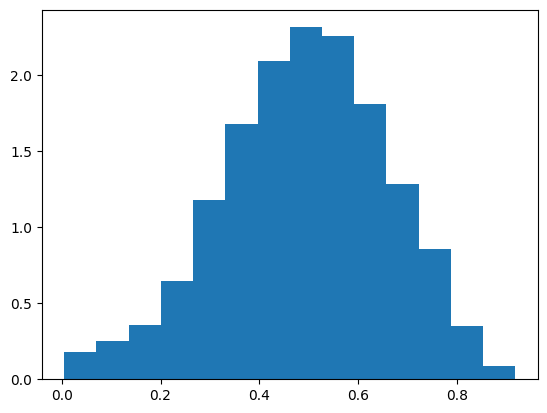

In [146]:
plt.hist(s.flatten(), 14, density=True)

In [23]:
#np.max(pois_img)
#plt.imshow(s[:,:,0])
#np.max(ns)
#ns[ns < 0] = 0
#np.mean(ns)
#plt.imshow((0.6706672821235775-ns)*255)
#plt.imshow(s)

# Synthetic Data Experiments

In [21]:
def perlin_input_gen(batch_size=32):
    xs = []
    ys = []

    for _ in range(batch_size):
        noise = PerlinNoise(octaves=5)
        xpix, ypix = 256, 256
        
        ns = np.array([[noise([i/xpix, j/ypix]) for j in range(xpix)] for i in range(ypix)])
        ns[ns < 0] = 0
        ns = ns/np.max(ns)
        ns = 1.0 - ns

        img = np.zeros((256,256,3))
        img[:,:,0] = ns
        img[:,:,1] = ns
        img[:,:,2] = ns

        msk = 1.0 - img[:,:,:1]
        #msk[msk < 0.3] = 0.0
        #msk[msk >= 0.3] = 1.0
        msk[msk > 0.1] = 1.0

        xs.append(img)
        ys.append(msk)
    
    return xs, ys

In [45]:
#maxs = np.max(ns)
#(ns/maxs)
#s[s < 0] = s/mins
np.min(ns)

0.0

In [ ]:
perlin = True

if perlin:
    noise = PerlinNoise(octaves=5)
    xpix, ypix = 256, 256
    
    ns = np.array([[noise([i/xpix, j/ypix]) for j in range(xpix)] for i in range(ypix)])
    ns[ns < 0] = 0
    ns = ns/np.max(ns)
    ns = 1.0 - ns

    s = np.zeros((256,256,3))
    s[:,:,0] = ns#*230
    s[:,:,1] = ns#*143
    s[:,:,2] = ns#*176
else:
    #s = np.zeros((256,256,3))
    #s[:,:,0] = np.reshape(np.random.normal(0.5, 0.2, 256*256), (256,256))
    #s[:,:,1] = np.reshape(np.random.normal(0.5, 0.2, 256*256), (256,256))
    #s[:,:,2] = np.reshape(np.random.normal(0.5, 0.2, 256*256), (256,256))
    s = np.random.logistic(0.5, 0.05, 256*256*3)
    s = np.reshape(s, (256,256,3))

#s = s*255
#med = np.mean(s)
#print(med)
#s[s < med] = 0.0
#s[s > med] = 1.0
pois_img = s#(s).astype('int')
#pois_img[pois_img < 0] = 0

plt.imshow(pois_img)

In [92]:
%%time
xs, ys = perlin_input_gen(2)

CPU times: user 2.58 s, sys: 3.13 ms, total: 2.59 s
Wall time: 2.58 s


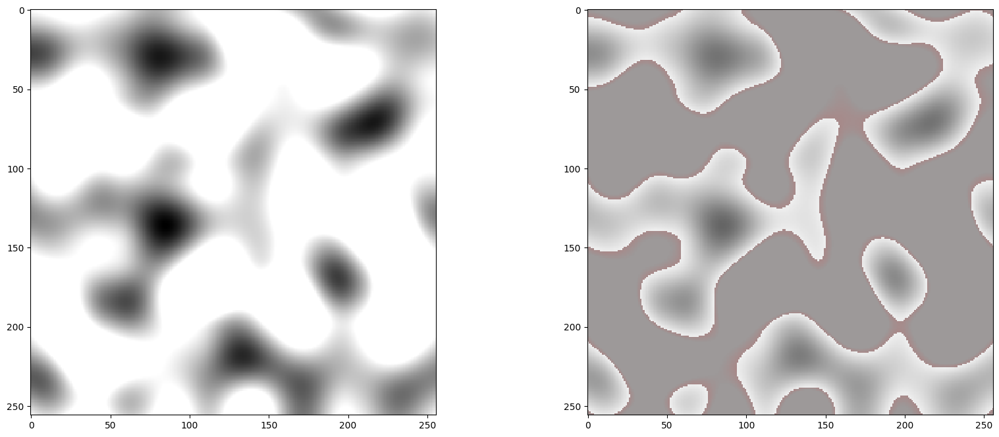

In [95]:
plot_mask(xs[1], ys[1], alpha=0.4, threshold=0)

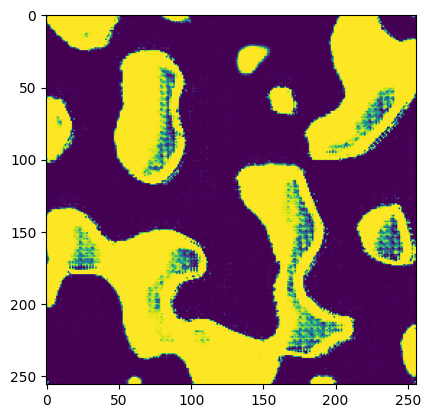

In [183]:
out = quicktest(np.array([pois_img]))
plt.imshow(out[0].numpy())
#plot_mask(pois_img, out[0].numpy())

In [190]:
actv = get_activations(model_mt2, np.array([pois_img]))

In [196]:
actv[66].shape

(256, 256, 32)

In [ ]:
print_filters_3d(actv[66])

In [ ]:
for i in range(len(actv)):
    print_filters_3d(actv[i])
    if i > 30:
        break

## Advanced

In [23]:
%%time
sinteticx, sinteticy = perlin_input_gen(32)
sinteticx = np.array(sinteticx)
sinteticy = np.array(sinteticy)

CPU times: user 41.7 s, sys: 21.1 ms, total: 41.7 s
Wall time: 41.7 s


In [147]:
def palette(img):
    """
    Return palette in descending order of frequency
    """
    arr = np.asarray(img)
    palette, index = np.unique(asvoid(arr).ravel(), return_inverse=True)
    palette = palette.view(arr.dtype).reshape(-1, arr.shape[-1])
    count = np.bincount(index)
    order = np.argsort(count)
    return palette[order[::-1]]

def asvoid(arr):
    """View the array as dtype np.void (bytes)
    This collapses ND-arrays to 1D-arrays, so you can perform 1D operations on them.
    http://stackoverflow.com/a/16216866/190597 (Jaime)
    http://stackoverflow.com/a/16840350/190597 (Jaime)
    Warning:
    >>> asvoid([-0.]) == asvoid([0.])
    array([False], dtype=bool)
    """
    arr = np.ascontiguousarray(arr)
    return arr.view(np.dtype((np.void, arr.dtype.itemsize * arr.shape[-1])))

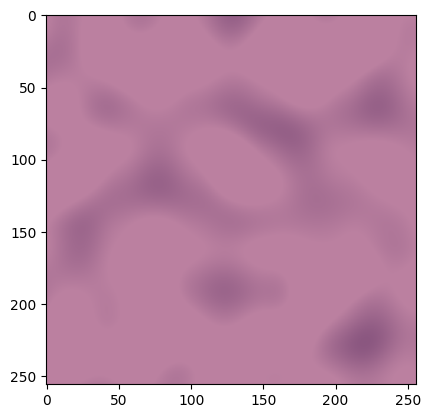

In [161]:
plt.imshow(
    ((sinteticx[0])*np.array([0.7349471262175254,0.5047067732910575,0.6295244992222323]))
    + ((1.0 - sinteticx[0])*np.array([0.5447757242444282,0.3411655102946041,0.5033285286272694]))
)

0.7349471262175254
0.5047067732910575
0.6295244992222323


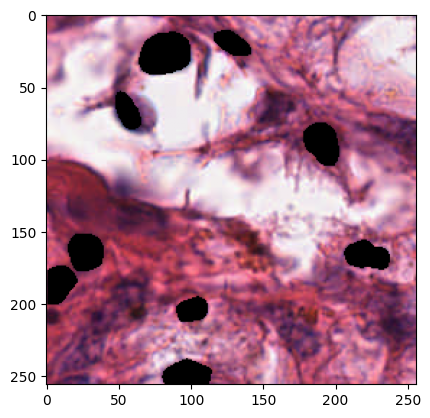

In [162]:
junc = task_list[0][1][0][0][:] * (1.0 - task_list[0][1][0][1][:])
#print(junc.mean(axis=(0,1)))
print(junc[:,:,:,0][junc[:,:,:,0] > 0].mean())
print(junc[:,:,:,1][junc[:,:,:,1] > 0].mean())
print(junc[:,:,:,2][junc[:,:,:,2] > 0].mean())
plt.imshow(junc[0])

In [163]:
palette(junc)[:10]

array([[0.        , 0.        , 0.        ],
       [0.9372549 , 0.9254902 , 0.9372549 ],
       [0.9372549 , 0.91372549, 0.9254902 ],
       [0.9372549 , 0.9254902 , 0.9254902 ],
       [0.95294118, 0.9254902 , 0.9372549 ],
       [0.9372549 , 0.9372549 , 0.9372549 ],
       [0.9372549 , 0.91372549, 0.9372549 ],
       [0.9254902 , 0.89803922, 0.91372549],
       [0.9254902 , 0.91372549, 0.9254902 ],
       [0.95294118, 0.9372549 , 0.9372549 ]])

# Quantization

In [25]:
quicktest.evaluate(task_list[0][1])

4/4 [==============================] - 1s 123ms/step - loss: 0.4988 - dice_loss: 0.4988 - iou_score: 0.3421 - f1-score: 0.5018 - auc_2: 0.7847


[0.49877360463142395,
 0.49877360463142395,
 0.34213751554489136,
 0.5018168091773987,
 0.784709632396698]

In [15]:
import tensorflow_model_optimization as tfmot

In [20]:
quicktest = build_new_model2(styled=False)
quickopt = keras.optimizers.Adam(LR)
quicktest.load_weights('our_baseline.h5')

In [21]:
q_aware_model = tfmot.quantization.keras.quantize_model(quicktest)

RuntimeError: Layer tf.concat_4:<class 'keras.layers.core.tf_op_layer.TFOpLambda'> is not supported. You can quantize this layer by passing a `tfmot.quantization.keras.QuantizeConfig` instance to the `quantize_annotate_layer` API.

# Final Experiment Results (Enhanced LwF)

In [17]:
i_metric = 2
n_epochs = 10
n_tasks = 19
exp_metrics = ['loss', 'dice_loss','iou_score','f1-score','precision','recall','auc']

In [32]:
def maskImg2(img, threshold, threshold2=None):
    mask = img.copy()
    mask[mask <= threshold] = np.nan
    if threshold2 is not None:
        mask[mask > threshold2] = 1.0
    return mask

In [19]:
cmp_results = [[[0.6717851161956787, 0.6717851161956787, 0.2588336765766144, 0.4096192717552185, 0.21922993659973145, 0.665144145488739, 0.7919440865516663], [0.6999254822731018, 0.6999254822731018, 0.2185719907283783, 0.3580877184867859, 0.2138674408197403, 0.5111538171768188, 0.7223243713378906], [0.647720456123352, 0.647720456123352, 0.26367390155792236, 0.4158637523651123, 0.24786856770515442, 0.6221590042114258, 0.7765018343925476], [0.6479220390319824, 0.6479220390319824, 0.27228471636772156, 0.42640239000320435, 0.24490050971508026, 0.6367841958999634, 0.794620931148529], [0.641004741191864, 0.641004741191864, 0.28348246216773987, 0.44073545932769775, 0.24795955419540405, 0.6582655310630798, 0.8066166639328003], [0.6652007102966309, 0.6652007102966309, 0.2399798333644867, 0.38574934005737305, 0.2258608043193817, 0.6637321710586548, 0.8002098798751831], [0.6927451491355896, 0.6927451491355896, 0.23561453819274902, 0.3802427053451538, 0.20761147141456604, 0.6036270260810852, 0.7618604898452759], [0.6702226400375366, 0.6702226400375366, 0.2641831040382385, 0.4166034460067749, 0.21548764407634735, 0.7134392857551575, 0.8224227428436279], [0.6258190870285034, 0.6258190870285034, 0.28649264574050903, 0.44358766078948975, 0.2668132185935974, 0.6415939927101135, 0.8081856966018677], [0.6622498035430908, 0.6622498035430908, 0.26621660590171814, 0.4193100929260254, 0.23123051226139069, 0.6414161324501038, 0.7896597385406494]],[[0.6308000683784485, 0.6308000683784485, 0.2983603775501251, 0.456723690032959, 0.24895866215229034, 0.729370653629303, 0.8350880146026611], [0.6091153621673584, 0.6091153621673584, 0.32262787222862244, 0.4853949546813965, 0.2736230194568634, 0.697319507598877, 0.7965569496154785], [0.5951654314994812, 0.5951654314994812, 0.32162532210350037, 0.4834109842777252, 0.28029879927635193, 0.7432541847229004, 0.8410057425498962], [0.6178619861602783, 0.6178619861602783, 0.29632213711738586, 0.454120010137558, 0.25849875807762146, 0.7507452964782715, 0.8328142166137695], [0.60457444190979, 0.60457444190979, 0.3232695758342743, 0.4847312271595001, 0.2736869156360626, 0.7322623133659363, 0.8373502492904663], [0.6007096171379089, 0.6007096171379089, 0.30955374240875244, 0.46907368302345276, 0.27069711685180664, 0.7790825366973877, 0.8495922684669495], [0.6396961808204651, 0.6396961808204651, 0.2948131859302521, 0.45142197608947754, 0.24292366206645966, 0.7149614691734314, 0.8213217854499817], [0.6400797963142395, 0.6400797963142395, 0.2980962097644806, 0.45581498742103577, 0.2334175854921341, 0.8025919795036316, 0.8692781925201416], [0.6597928404808044, 0.6597928404808044, 0.2536803185939789, 0.40227770805358887, 0.24399149417877197, 0.572619616985321, 0.7410168647766113], [0.6320443153381348, 0.6320443153381348, 0.3012712299823761, 0.460400253534317, 0.248238205909729, 0.7283565402030945, 0.8130486011505127]],[[0.5379691123962402, 0.5379691123962402, 0.4241679310798645, 0.5956712365150452, 0.3282462954521179, 0.7798959612846375, 0.8808859586715698], [0.5044972896575928, 0.5044972896575928, 0.4558742344379425, 0.6262549757957458, 0.3767264783382416, 0.7236629724502563, 0.8623335957527161], [0.5025767087936401, 0.5025767087936401, 0.43271690607070923, 0.6040508151054382, 0.3736826777458191, 0.7436861395835876, 0.8624616265296936], [0.5230340957641602, 0.5230340957641602, 0.4166405200958252, 0.5882092118263245, 0.34807953238487244, 0.7574235796928406, 0.8675888180732727], [0.504644513130188, 0.504644513130188, 0.4553197920322418, 0.6257315874099731, 0.36654749512672424, 0.7637404203414917, 0.879961371421814], [0.48910582065582275, 0.48910582065582275, 0.4406092166900635, 0.6116984486579895, 0.37431344389915466, 0.8044101595878601, 0.8903216123580933], [0.5422697067260742, 0.5422697067260742, 0.4246671497821808, 0.5961633324623108, 0.32886216044425964, 0.7526732683181763, 0.8616567254066467], [0.5680840611457825, 0.5680840611457825, 0.3771751821041107, 0.5477519631385803, 0.29378077387809753, 0.8152400851249695, 0.8874425888061523], [0.564450740814209, 0.564450740814209, 0.3614215850830078, 0.5309473276138306, 0.3404187560081482, 0.6044691205024719, 0.7819818258285522], [0.5345970988273621, 0.5345970988273621, 0.4299868047237396, 0.6013857126235962, 0.33808448910713196, 0.7465408444404602, 0.8483652472496033]],[[0.7684741616249084, 0.7684741616249084, 0.1717255860567093, 0.2912708520889282, 0.16493414342403412, 0.3987349271774292, 0.6050323247909546], [0.7293727397918701, 0.7293727397918701, 0.1995621770620346, 0.3304048776626587, 0.20574568212032318, 0.40493783354759216, 0.6255407333374023], [0.753623366355896, 0.753623366355896, 0.1684325635433197, 0.2862994074821472, 0.18969295918941498, 0.3605020344257355, 0.6364213228225708], [0.7278161644935608, 0.7278161644935608, 0.20044761896133423, 0.3315374553203583, 0.2014005333185196, 0.4296521842479706, 0.6406878232955933], [0.742357611656189, 0.742357611656189, 0.18769215047359467, 0.3140481114387512, 0.19548624753952026, 0.38678309321403503, 0.632259726524353], [0.7266867160797119, 0.7266867160797119, 0.18961352109909058, 0.31669747829437256, 0.2054501622915268, 0.4186118245124817, 0.6915711164474487], [0.7815766930580139, 0.7815766930580139, 0.15088193118572235, 0.26018303632736206, 0.16676388680934906, 0.3237280547618866, 0.6541442275047302], [0.7456212639808655, 0.7456212639808655, 0.18518419563770294, 0.3108924627304077, 0.17777858674526215, 0.45986804366111755, 0.7021070122718811], [0.7337279915809631, 0.7337279915809631, 0.1857927292585373, 0.3120155334472656, 0.2037978321313858, 0.3946574330329895, 0.622928261756897], [0.7322261929512024, 0.7322261929512024, 0.20865394175052643, 0.34289711713790894, 0.19986724853515625, 0.41451311111450195, 0.6381009817123413]],[[0.4511409103870392, 0.4511409103870392, 0.4799984097480774, 0.6464877128601074, 0.4265100955963135, 0.7729457020759583, 0.869581937789917], [0.4412066638469696, 0.4412066638469696, 0.46987706422805786, 0.6378726959228516, 0.4469372034072876, 0.7461786270141602, 0.8551176190376282], [0.43129196763038635, 0.43129196763038635, 0.4878247380256653, 0.6545661687850952, 0.4633743464946747, 0.7376508712768555, 0.849541962146759], [0.42950114607810974, 0.42950114607810974, 0.48923903703689575, 0.6555868983268738, 0.45413243770599365, 0.7683721780776978, 0.8680549263954163], [0.4215394854545593, 0.4215394854545593, 0.5004217624664307, 0.6660555601119995, 0.4585237205028534, 0.7840919494628906, 0.8784911632537842], [0.42250996828079224, 0.42250996828079224, 0.47686564922332764, 0.6438403129577637, 0.454118013381958, 0.7959704399108887, 0.8674988746643066], [0.48215392231941223, 0.48215392231941223, 0.4398048222064972, 0.6093522310256958, 0.402030348777771, 0.7306873798370361, 0.8270146250724792], [0.4723176658153534, 0.4723176658153534, 0.47180449962615967, 0.6402233242988586, 0.39446306228637695, 0.7998329997062683, 0.872413694858551], [0.46972644329071045, 0.46972644329071045, 0.43103134632110596, 0.5987221002578735, 0.468616247177124, 0.6115012168884277, 0.8084795475006104], [0.45998910069465637, 0.45998910069465637, 0.46694400906562805, 0.6348604559898376, 0.4222286343574524, 0.7511670589447021, 0.8411943912506104]],[[0.7795425057411194, 0.7795425057411194, 0.17788171768188477, 0.2986113429069519, 0.133330300450325, 0.6830730438232422, 0.8272809982299805], [0.7926207780838013, 0.7926207780838013, 0.15536154806613922, 0.2661612033843994, 0.12671571969985962, 0.6149450540542603, 0.7607603073120117], [0.7666066288948059, 0.7666066288948059, 0.18184572458267212, 0.30493128299713135, 0.1408410370349884, 0.727548360824585, 0.8396657109260559], [0.8069835305213928, 0.8069835305213928, 0.14428535103797913, 0.24965547025203705, 0.1183682531118393, 0.5685412883758545, 0.7458210587501526], [0.7714655995368958, 0.7714655995368958, 0.17709094285964966, 0.29770463705062866, 0.1393975168466568, 0.6813812255859375, 0.8224694728851318], [0.7631636261940002, 0.7631636261940002, 0.17372241616249084, 0.2931936979293823, 0.14008866250514984, 0.8155998587608337, 0.8633291125297546], [0.8254727125167847, 0.8254727125167847, 0.14000831544399261, 0.24286192655563354, 0.10597523301839828, 0.5300574898719788, 0.7209197282791138], [0.7935094237327576, 0.7935094237327576, 0.16059185564517975, 0.2741822600364685, 0.1214914321899414, 0.7341163158416748, 0.8508269190788269], [0.7723623514175415, 0.7723623514175415, 0.16826575994491577, 0.28507089614868164, 0.1416780948638916, 0.6254885792732239, 0.7634796500205994], [0.8149020075798035, 0.8149020075798035, 0.1418863832950592, 0.24546274542808533, 0.11379674822092056, 0.5420270562171936, 0.766819179058075]],[[0.5049984455108643, 0.5049984455108643, 0.4180747866630554, 0.5884888172149658, 0.3656248152256012, 0.7751065492630005, 0.8613871932029724], [0.44566676020622253, 0.44566676020622253, 0.47033706307411194, 0.6385204792022705, 0.43271782994270325, 0.7763385772705078, 0.8740948438644409], [0.45333486795425415, 0.45333486795425415, 0.46061062812805176, 0.6292381286621094, 0.43494337797164917, 0.7394174337387085, 0.8564401865005493], [0.46202903985977173, 0.46202903985977173, 0.4454232454299927, 0.6151434183120728, 0.4120226502418518, 0.7801976799964905, 0.86745285987854], [0.4679163694381714, 0.4679163694381714, 0.46087726950645447, 0.6302851438522339, 0.41063421964645386, 0.7633268237113953, 0.8642926216125488], [0.45215028524398804, 0.45215028524398804, 0.44717884063720703, 0.6165791153907776, 0.4188004732131958, 0.796846866607666, 0.868938148021698], [0.4979797899723053, 0.4979797899723053, 0.438946932554245, 0.6086239218711853, 0.3871929347515106, 0.7207887172698975, 0.8322381973266602], [0.48974698781967163, 0.48974698781967163, 0.4441002607345581, 0.6138639450073242, 0.3704849183559418, 0.8274665474891663, 0.8953947424888611], [0.47361481189727783, 0.47361481189727783, 0.41983383893966675, 0.590361475944519, 0.41971126198768616, 0.7121612429618835, 0.837011992931366], [0.49396416544914246, 0.49396416544914246, 0.43524426221847534, 0.6055389642715454, 0.3927037715911865, 0.7196049690246582, 0.8287668228149414]],[[0.7998824119567871, 0.7998824119567871, 0.15795329213142395, 0.2654985785484314, 0.13834069669246674, 0.4037121832370758, 0.7167563438415527], [0.827157199382782, 0.827157199382782, 0.13018308579921722, 0.22341705858707428, 0.13086260855197906, 0.27939069271087646, 0.6280681490898132], [0.8184852600097656, 0.8184852600097656, 0.13269846141338348, 0.2277444452047348, 0.141047403216362, 0.27640947699546814, 0.6696504950523376], [0.8116204142570496, 0.8116204142570496, 0.1472194939851761, 0.2509476840496063, 0.1419307142496109, 0.30846545100212097, 0.6549948453903198], [0.8119029998779297, 0.8119029998779297, 0.14613185822963715, 0.24780863523483276, 0.13846848905086517, 0.32421842217445374, 0.6686732172966003], [0.7921237945556641, 0.7921237945556641, 0.1550550013780594, 0.2609666883945465, 0.15613675117492676, 0.341941237449646, 0.695364236831665], [0.8505762219429016, 0.8505762219429016, 0.10820571333169937, 0.19020529091358185, 0.1089155450463295, 0.2614467442035675, 0.6278292536735535], [0.8358590006828308, 0.8358590006828308, 0.12325801700353622, 0.21389956772327423, 0.11348321288824081, 0.3308112323284149, 0.6700143218040466], [0.8078811168670654, 0.8078811168670654, 0.14316333830356598, 0.24538511037826538, 0.14606823027133942, 0.30903831124305725, 0.6377533674240112], [0.8314434885978699, 0.8314434885978699, 0.13120925426483154, 0.22566546499729156, 0.12249324470758438, 0.29901111125946045, 0.6282792091369629]],[[0.5726730823516846, 0.5726730823516846, 0.38416919112205505, 0.5550898909568787, 0.3124338686466217, 0.6758673787117004, 0.8586792349815369], [0.6130738258361816, 0.6130738258361816, 0.3398510217666626, 0.5072967410087585, 0.3329734206199646, 0.4617439806461334, 0.7516012191772461], [0.5627261400222778, 0.5627261400222778, 0.3845934271812439, 0.5555326342582703, 0.34787559509277344, 0.5885116457939148, 0.8186524510383606], [0.5857340693473816, 0.5857340693473816, 0.36835235357284546, 0.538388192653656, 0.331667423248291, 0.551648736000061, 0.8075320720672607], [0.5433881282806396, 0.5433881282806396, 0.42244306206703186, 0.5939683318138123, 0.3540789783000946, 0.6427320837974548, 0.8562963604927063], [0.515488862991333, 0.515488862991333, 0.4322296679019928, 0.6035758852958679, 0.37351301312446594, 0.689375102519989, 0.8828606605529785], [0.5743120908737183, 0.5743120908737183, 0.4018612205982208, 0.5733252763748169, 0.31642672419548035, 0.6502001285552979, 0.8481733202934265], [0.5844621658325195, 0.5844621658325195, 0.39890551567077637, 0.5703108906745911, 0.2942352592945099, 0.7070144414901733, 0.8810604214668274], [0.5756716728210449, 0.5756716728210449, 0.3516095280647278, 0.5202826857566833, 0.3408316671848297, 0.5620088577270508, 0.796951949596405], [0.573224663734436, 0.573224663734436, 0.3982938826084137, 0.5696855187416077, 0.3161854147911072, 0.6563381552696228, 0.8311662077903748]],[[0.5816182494163513, 0.5816182494163513, 0.3701936602592468, 0.5397006869316101, 0.2988598942756653, 0.7023046016693115, 0.8572257161140442], [0.6097609996795654, 0.6097609996795654, 0.34929049015045166, 0.5175936222076416, 0.29556721448898315, 0.580359935760498, 0.7726739048957825], [0.5438704490661621, 0.5438704490661621, 0.3990652561187744, 0.570042610168457, 0.3416070342063904, 0.6905336380004883, 0.8486930727958679], [0.5600177049636841, 0.5600177049636841, 0.38197943568229675, 0.5519874095916748, 0.3237563967704773, 0.6917835474014282, 0.8519119024276733], [0.5722920894622803, 0.5722920894622803, 0.3711704611778259, 0.5398427248001099, 0.3077489733695984, 0.7054638266563416, 0.8512965440750122], [0.548173189163208, 0.548173189163208, 0.38425055146217346, 0.5546556115150452, 0.3272048830986023, 0.7355672121047974, 0.8616460561752319], [0.5929200649261475, 0.5929200649261475, 0.3770219683647156, 0.5466880798339844, 0.287837952375412, 0.7005797624588013, 0.8475807905197144], [0.6049941778182983, 0.6049941778182983, 0.3638489842414856, 0.532555341720581, 0.2671722173690796, 0.7614082098007202, 0.8748883605003357], [0.5612672567367554, 0.5612672567367554, 0.3671034276485443, 0.5362064242362976, 0.34910422563552856, 0.5927796363830566, 0.8178784251213074], [0.5773254632949829, 0.5773254632949829, 0.3911268711090088, 0.5613374710083008, 0.3021063208580017, 0.7078120708465576, 0.8410155773162842]],[[0.6283388137817383, 0.6283388137817383, 0.2886614203453064, 0.4480019509792328, 0.28237512707710266, 0.5435203909873962, 0.7671951651573181], [0.6162365674972534, 0.6162365674972534, 0.29700958728790283, 0.457991361618042, 0.30482977628707886, 0.517859935760498, 0.7484347820281982], [0.6207934617996216, 0.6207934617996216, 0.28608328104019165, 0.4448907673358917, 0.30860641598701477, 0.4916912317276001, 0.7277259826660156], [0.5952954292297363, 0.5952954292297363, 0.31333285570144653, 0.4771568179130554, 0.3169900178909302, 0.5595333576202393, 0.780886709690094], [0.5697341561317444, 0.5697341561317444, 0.3504388630390167, 0.5189999938011169, 0.3318052887916565, 0.6118179559707642, 0.8159641623497009], [0.5584726929664612, 0.5584726929664612, 0.3439723551273346, 0.5118741393089294, 0.330287367105484, 0.6657503843307495, 0.8179824948310852], [0.6439341306686401, 0.6439341306686401, 0.277559369802475, 0.4345150291919708, 0.2734934389591217, 0.5100625157356262, 0.7485202550888062], [0.6285912990570068, 0.6285912990570068, 0.30382293462753296, 0.4660494029521942, 0.26771774888038635, 0.6061981320381165, 0.8003188967704773], [0.651060938835144, 0.651060938835144, 0.2469472885131836, 0.39608296751976013, 0.2780376374721527, 0.468378484249115, 0.7048088312149048], [0.5966746807098389, 0.5966746807098389, 0.3329288363456726, 0.49954482913017273, 0.3010420501232147, 0.6108806133270264, 0.7831709980964661]],[[0.3887805938720703, 0.3887805938720703, 0.529382050037384, 0.6922822594642639, 0.4858993887901306, 0.8236496448516846, 0.8923836350440979], [0.3640718460083008, 0.3640718460083008, 0.5546797513961792, 0.713561475276947, 0.5058978796005249, 0.8559255003929138, 0.9017844796180725], [0.3655596375465393, 0.3655596375465393, 0.5427442193031311, 0.7036088109016418, 0.5128158926963806, 0.8316928148269653, 0.8910333514213562], [0.38013404607772827, 0.38013404607772827, 0.5248962044715881, 0.6884353160858154, 0.4931788444519043, 0.8341382741928101, 0.8907610774040222], [0.3659249544143677, 0.3659249544143677, 0.544174313545227, 0.7048094272613525, 0.49186548590660095, 0.8919615745544434, 0.9184659123420715], [0.36997026205062866, 0.36997026205062866, 0.5238775014877319, 0.6875585317611694, 0.4814017713069916, 0.9114223718643188, 0.9124935865402222], [0.3814699649810791, 0.3814699649810791, 0.5473853945732117, 0.7074971795082092, 0.47553274035453796, 0.8845111727714539, 0.9169002771377563], [0.41644537448883057, 0.41644537448883057, 0.5109308958053589, 0.6763127446174622, 0.4413969814777374, 0.8607799410820007, 0.9052668213844299], [0.391851544380188, 0.391851544380188, 0.5036457180976868, 0.6698994040489197, 0.521547257900238, 0.7292355895042419, 0.8427013754844666], [0.3945782780647278, 0.3945782780647278, 0.5206908583641052, 0.6848083138465881, 0.46299099922180176, 0.8744213581085205, 0.894618570804596]],[[0.8024047017097473, 0.8024047017097473, 0.17158013582229614, 0.2929038107395172, 0.11746048182249069, 0.6218150854110718, 0.8004295825958252], [0.7733860611915588, 0.7733860611915588, 0.19536162912845612, 0.32686614990234375, 0.1390058547258377, 0.6128799915313721, 0.808454692363739], [0.774659276008606, 0.774659276008606, 0.1856350600719452, 0.31314030289649963, 0.13867759704589844, 0.600788414478302, 0.7920981645584106], [0.7937665581703186, 0.7937665581703186, 0.17409084737300873, 0.296554297208786, 0.1281692236661911, 0.5275477766990662, 0.767169177532196], [0.7751458287239075, 0.7751458287239075, 0.192043736577034, 0.3222092092037201, 0.13568030297756195, 0.6560015678405762, 0.8252585530281067], [0.7524237036705017, 0.7524237036705017, 0.1999022662639618, 0.33319756388664246, 0.14843226969242096, 0.7455792427062988, 0.8628071546554565], [0.7911087274551392, 0.7911087274551392, 0.19159233570098877, 0.3215736448764801, 0.12450825423002243, 0.6481877565383911, 0.8201054930686951], [0.824889600276947, 0.824889600276947, 0.14781007170677185, 0.2575514614582062, 0.10226336121559143, 0.608755886554718, 0.807711124420166], [0.7767999172210693, 0.7767999172210693, 0.16765351593494415, 0.2871631383895874, 0.13363276422023773, 0.6768754720687866, 0.8089232444763184], [0.7795749306678772, 0.7795749306678772, 0.20406602323055267, 0.33896151185035706, 0.13163702189922333, 0.6771712303161621, 0.8225361704826355]],[[0.5099387764930725, 0.5099387764930725, 0.4117458164691925, 0.5833143591880798, 0.3694482147693634, 0.7275989651679993, 0.8588777780532837], [0.5441457033157349, 0.5441457033157349, 0.36090755462646484, 0.5303924679756165, 0.373248428106308, 0.5854164361953735, 0.770673930644989], [0.5082122087478638, 0.5082122087478638, 0.4012414216995239, 0.5726941823959351, 0.40200310945510864, 0.6332111954689026, 0.8109641075134277], [0.5252119302749634, 0.5252119302749634, 0.3743191063404083, 0.5447338819503784, 0.3660883903503418, 0.6752992272377014, 0.8175131678581238], [0.4891693592071533, 0.4891693592071533, 0.42826902866363525, 0.5997036099433899, 0.4043722152709961, 0.6933738589286804, 0.8521204590797424], [0.5138053894042969, 0.5138053894042969, 0.37786802649497986, 0.5484821796417236, 0.36842215061187744, 0.7146422863006592, 0.8421595096588135], [0.5491529703140259, 0.5491529703140259, 0.3714972734451294, 0.5417397022247314, 0.34869471192359924, 0.6376509070396423, 0.794202983379364], [0.5287994742393494, 0.5287994742393494, 0.3929731845855713, 0.5642222166061401, 0.33962956070899963, 0.7691755294799805, 0.8685970306396484], [0.4873836040496826, 0.4873836040496826, 0.4209023118019104, 0.5924437046051025, 0.42994827032089233, 0.6346419453620911, 0.81606525182724], [0.5322380661964417, 0.5322380661964417, 0.3811025619506836, 0.5518816113471985, 0.37041547894477844, 0.6345144510269165, 0.8231182098388672]],[[0.6837955117225647, 0.6837955117225647, 0.22244134545326233, 0.3639296889305115, 0.19931291043758392, 0.7646517157554626, 0.7959221601486206], [0.6804429292678833, 0.6804429292678833, 0.21766303479671478, 0.3575094938278198, 0.20446355640888214, 0.7310925126075745, 0.7770729660987854], [0.6568292379379272, 0.6568292379379272, 0.24035905301570892, 0.38756367564201355, 0.22716951370239258, 0.7012607455253601, 0.7921027541160583], [0.6586503386497498, 0.6586503386497498, 0.2412969172000885, 0.38878193497657776, 0.2205752283334732, 0.754435658454895, 0.8166904449462891], [0.6583590507507324, 0.6583590507507324, 0.2413869947195053, 0.3888988494873047, 0.21749578416347504, 0.7959828972816467, 0.8244633078575134], [0.6766738891601562, 0.6766738891601562, 0.214751735329628, 0.3535730540752411, 0.20518265664577484, 0.762195885181427, 0.7992691993713379], [0.7317936420440674, 0.7317936420440674, 0.17568820714950562, 0.29886868596076965, 0.1677757352590561, 0.66817706823349, 0.7173787355422974], [0.7073385119438171, 0.7073385119438171, 0.20065414905548096, 0.3342413902282715, 0.17883284389972687, 0.805140495300293, 0.8042647242546082], [0.6758036613464355, 0.6758036613464355, 0.22546692192554474, 0.36796900629997253, 0.219099760055542, 0.623064398765564, 0.7583638429641724], [0.6913705468177795, 0.6913705468177795, 0.21132706105709076, 0.34891825914382935, 0.19357216358184814, 0.7609013915061951, 0.7878812551498413]],[[0.6634261012077332, 0.6634261012077332, 0.2597716748714447, 0.4124107360839844, 0.26867663860321045, 0.4503925144672394, 0.6978415250778198], [0.7355189323425293, 0.7355189323425293, 0.17496000230312347, 0.29781439900398254, 0.2453918606042862, 0.286790668964386, 0.6214810013771057], [0.6364647150039673, 0.6364647150039673, 0.2718675136566162, 0.4275091588497162, 0.319282591342926, 0.42202866077423096, 0.7046990394592285], [0.6453165411949158, 0.6453165411949158, 0.26428061723709106, 0.41807273030281067, 0.3091098368167877, 0.4160192012786865, 0.7220062017440796], [0.5841484665870667, 0.5841484665870667, 0.3452798128128052, 0.5133204460144043, 0.33365145325660706, 0.5517944097518921, 0.7707266807556152], [0.5879173278808594, 0.5879173278808594, 0.317535936832428, 0.48201483488082886, 0.34266725182533264, 0.5167660713195801, 0.7718949913978577], [0.6892677545547485, 0.6892677545547485, 0.23010282218456268, 0.3741196393966675, 0.2502283453941345, 0.4098259508609772, 0.691717267036438], [0.6484317779541016, 0.6484317779541016, 0.2822989225387573, 0.4403012692928314, 0.26673081517219543, 0.5155441761016846, 0.7732344269752502], [0.6194182634353638, 0.6194182634353638, 0.2837163805961609, 0.44202345609664917, 0.3540324866771698, 0.4114358425140381, 0.7276821136474609], [0.6111435890197754, 0.6111435890197754, 0.3167327046394348, 0.4810888171195984, 0.3006754517555237, 0.5502238869667053, 0.7591984868049622]],[[0.580096960067749, 0.580096960067749, 0.3592020869255066, 0.5285484790802002, 0.2829139530658722, 0.8140929341316223, 0.8871821761131287], [0.5640134811401367, 0.5640134811401367, 0.37057504057884216, 0.540758490562439, 0.30623945593833923, 0.7564986944198608, 0.8635409474372864], [0.564350962638855, 0.564350962638855, 0.3540096879005432, 0.522905707359314, 0.30891862511634827, 0.7386866807937622, 0.8487602472305298], [0.5488831996917725, 0.5488831996917725, 0.3776923418045044, 0.548297107219696, 0.309891015291214, 0.8288432955741882, 0.894614577293396], [0.559971809387207, 0.559971809387207, 0.3711037337779999, 0.5413211584091187, 0.3021891713142395, 0.8090757727622986, 0.8832664489746094], [0.5544464588165283, 0.5544464588165283, 0.3561134338378906, 0.5251971483230591, 0.30624642968177795, 0.8173580169677734, 0.8781910538673401], [0.6057629585266113, 0.6057629585266113, 0.3337131142616272, 0.5004271268844604, 0.2686920762062073, 0.7399962544441223, 0.8393561244010925], [0.6068580150604248, 0.6068580150604248, 0.32721829414367676, 0.49308890104293823, 0.2529284358024597, 0.8821978569030762, 0.9060618877410889], [0.5464252829551697, 0.5464252829551697, 0.3824542760848999, 0.5532975792884827, 0.3312056362628937, 0.7193494439125061, 0.8482385277748108], [0.6001385450363159, 0.6001385450363159, 0.346662312746048, 0.514846682548523, 0.2774638235569, 0.715482234954834, 0.8206990361213684]],[[0.7717605233192444, 0.7717605233192444, 0.18031948804855347, 0.30545884370803833, 0.14591440558433533, 0.5353529453277588, 0.7528259754180908], [0.782356321811676, 0.782356321811676, 0.16686737537384033, 0.28594720363616943, 0.14491137862205505, 0.44777631759643555, 0.6957424283027649], [0.7483934164047241, 0.7483934164047241, 0.19170862436294556, 0.3217025399208069, 0.16443118453025818, 0.5442742109298706, 0.7432356476783752], [0.7488508224487305, 0.7488508224487305, 0.1857253909111023, 0.3131818175315857, 0.16054290533065796, 0.5861019492149353, 0.7748554944992065], [0.7446190714836121, 0.7446190714836121, 0.1987181305885315, 0.33127540349960327, 0.16299891471862793, 0.6009440422058105, 0.7815750241279602], [0.7811731696128845, 0.7811731696128845, 0.15333682298660278, 0.2659008502960205, 0.14064407348632812, 0.5029601454734802, 0.7039082646369934], [0.798585057258606, 0.798585057258606, 0.15910330414772034, 0.27452588081359863, 0.1285427212715149, 0.4765535295009613, 0.6928201913833618], [0.7874007821083069, 0.7874007821083069, 0.17025136947631836, 0.2906765341758728, 0.13070672750473022, 0.5820070505142212, 0.7602033615112305], [0.7409002780914307, 0.7409002780914307, 0.19169580936431885, 0.32161933183670044, 0.17537207901477814, 0.5051356554031372, 0.7465811967849731], [0.7781237363815308, 0.7781237363815308, 0.16527099907398224, 0.28348392248153687, 0.1385519802570343, 0.5679326057434082, 0.7387887239456177]],[[0.3871777057647705, 0.3871777057647705, 0.5152329206466675, 0.6800708770751953, 0.4754246771335602, 0.861915647983551, 0.8967381119728088], [0.37834489345550537, 0.37834489345550537, 0.5181491374969482, 0.6826063990592957, 0.4826774299144745, 0.8730263113975525, 0.8890542387962341], [0.353726327419281, 0.353726327419281, 0.5506578683853149, 0.7102248072624207, 0.5252333879470825, 0.83980792760849, 0.8920817375183105], [0.359332799911499, 0.359332799911499, 0.5395354628562927, 0.7009068131446838, 0.5063763856887817, 0.871893048286438, 0.9021183848381042], [0.3711506128311157, 0.3711506128311157, 0.5235570073127747, 0.6872824430465698, 0.4854637086391449, 0.8924382328987122, 0.9052472710609436], [0.3775205612182617, 0.3775205612182617, 0.5028687119483948, 0.6692118048667908, 0.4706481397151947, 0.9189252853393555, 0.9004098176956177], [0.4144393801689148, 0.4144393801689148, 0.4772111475467682, 0.6460974216461182, 0.4358902871608734, 0.8917626142501831, 0.8876047730445862], [0.40926820039749146, 0.40926820039749146, 0.4981468617916107, 0.6650173664093018, 0.4373972713947296, 0.9096033573150635, 0.9124413728713989], [0.3780950903892517, 0.3780950903892517, 0.5130448937416077, 0.678162157535553, 0.5426039099693298, 0.728352963924408, 0.850995659828186], [0.3829130530357361, 0.3829130530357361, 0.5241569876670837, 0.6877992153167725, 0.47783735394477844, 0.870873749256134, 0.8906219005584717]]]

In [20]:
ewc_results = [[[0.5600273609161377, 0.5600273609161377, 0.3851407468318939, 0.5550962686538696, 0.2884853780269623, 0.9365173578262329, 0.9423027038574219], [74811.984375, 0.5705360174179077, 0.3716942071914673, 0.5410104990005493, 0.28339987993240356, 0.8957208395004272, 0.9271243214607239], [3239328.5, 0.6293056011199951, 0.29255861043930054, 0.4521465003490448, 0.23016658425331116, 0.9595642685890198, 0.9255415797233582], [1017699.875, 0.6216021776199341, 0.2773545980453491, 0.43404990434646606, 0.2422965168952942, 0.865846574306488, 0.8891470432281494], [151220464.0, 0.6158095598220825, 0.29868993163108826, 0.4592282176017761, 0.2417851835489273, 0.9447712898254395, 0.9258131384849548], [50375.9296875, 0.6724151372909546, 0.22101080417633057, 0.36106055974960327, 0.2005690634250641, 0.9115372896194458, 0.8853583335876465], [91628.6640625, 0.5738333463668823, 0.35511288046836853, 0.5231156349182129, 0.2765614688396454, 0.9396753311157227, 0.9345201253890991], [33137.4453125, 0.682896614074707, 0.2201799899339676, 0.3604951798915863, 0.18994110822677612, 0.9674278497695923, 0.8892921805381775], [30279356.0, 0.6157552003860474, 0.303256630897522, 0.4648982882499695, 0.24126169085502625, 0.9489569067955017, 0.9269810914993286], [266555.03125, 0.5853786468505859, 0.3331262171268463, 0.49896422028541565, 0.26603469252586365, 0.9484948515892029, 0.9334299564361572], [152696.0625, 0.572395920753479, 0.3480427861213684, 0.5157054662704468, 0.280212938785553, 0.9105892181396484, 0.9284444451332092], [845509.1875, 0.5009499788284302, 0.4246290922164917, 0.5953214168548584, 0.35249558091163635, 0.8599944114685059, 0.9333484172821045], [212824.640625, 0.598613440990448, 0.32453498244285583, 0.48968130350112915, 0.256497323513031, 0.9279531836509705, 0.9262050986289978], [1440175.0, 0.6303360462188721, 0.2825937867164612, 0.43999147415161133, 0.2290259152650833, 0.9664658308029175, 0.9256183505058289], [615888.9375, 0.5474764108657837, 0.37957704067230225, 0.5488355755805969, 0.31023943424224854, 0.8483432531356812, 0.9157131910324097], [2322509.5, 0.5917414426803589, 0.3236463665962219, 0.48825719952583313, 0.26071926951408386, 0.9487243890762329, 0.9301612377166748], [716849.5, 0.5860812664031982, 0.34267449378967285, 0.5097785592079163, 0.2672106623649597, 0.9252413511276245, 0.9274088740348816], [402632.21875, 0.5795580148696899, 0.337971568107605, 0.50426185131073, 0.27153724431991577, 0.941402792930603, 0.9301896691322327], [4452199.0, 0.5237607955932617, 0.40137016773223877, 0.5714361667633057, 0.33007901906967163, 0.865908145904541, 0.9298059344291687], [0.5823900103569031, 0.5823900103569031, 0.3371846079826355, 0.5028113126754761, 0.2683064341545105, 0.9560679197311401, 0.9364575147628784], [41532.95703125, 0.5608322620391846, 0.3589295744895935, 0.5266680717468262, 0.2916542887687683, 0.9026678800582886, 0.9213541746139526], [8692496.0, 0.5673977136611938, 0.3576664328575134, 0.5252194404602051, 0.28253936767578125, 0.9369193315505981, 0.9362399578094482], [1061570.0, 0.5712639689445496, 0.33257758617401123, 0.4973410665988922, 0.2821260690689087, 0.9091965556144714, 0.9213588833808899], [73608792.0, 0.5870503783226013, 0.31797367334365845, 0.4816904664039612, 0.26536890864372253, 0.9407727718353271, 0.9293257594108582], [6655.9853515625, 0.6074477434158325, 0.2935733199119568, 0.45154571533203125, 0.25268256664276123, 0.9039974808692932, 0.8995765447616577], [2535801.0, 0.5938862562179565, 0.3123157322406769, 0.4743924140930176, 0.25864842534065247, 0.9604203104972839, 0.9292263984680176], [120571.2265625, 0.6721188426017761, 0.22964873909950256, 0.3722935914993286, 0.19751225411891937, 0.9813562631607056, 0.9038069248199463], [31886872.0, 0.5967056751251221, 0.3100133538246155, 0.47258707880973816, 0.25711169838905334, 0.9414878487586975, 0.9270318746566772], [1856503.0, 0.5868781805038452, 0.3314933180809021, 0.49684786796569824, 0.2641620337963104, 0.958251416683197, 0.9375939965248108], [1481899.75, 0.5666195750236511, 0.3446371853351593, 0.5107240080833435, 0.2842521071434021, 0.9285271763801575, 0.9277421236038208], [1654741.25, 0.5234445333480835, 0.39293551445007324, 0.5624628067016602, 0.3272716701030731, 0.8900836706161499, 0.9293414354324341], [569997.75, 0.5561540722846985, 0.368703693151474, 0.5375531911849976, 0.29281148314476013, 0.9279404282569885, 0.9350366592407227], [2581729.5, 0.5960078239440918, 0.3149583339691162, 0.4775557219982147, 0.25668126344680786, 0.962684690952301, 0.9331125617027283], [666006.9375, 0.5537787675857544, 0.3450271487236023, 0.51072096824646, 0.3078542947769165, 0.8302117586135864, 0.9054906964302063], [870864.125, 0.5254218578338623, 0.4058721959590912, 0.5769190788269043, 0.3267607092857361, 0.8740969896316528, 0.9176658391952515], [3094863.0, 0.549019992351532, 0.377880334854126, 0.5472574234008789, 0.30249902606010437, 0.897143542766571, 0.9173147678375244], [8730067.0, 0.5592040419578552, 0.35170212388038635, 0.5189628005027771, 0.289925217628479, 0.931164026260376, 0.9351709485054016], [797454.6875, 0.5395494699478149, 0.38385069370269775, 0.5528814792633057, 0.32149797677993774, 0.8273252844810486, 0.913445770740509], [0.5818600654602051, 0.5818600654602051, 0.33674129843711853, 0.5031624436378479, 0.2695968449115753, 0.938621461391449, 0.9268159866333008], [71437.21875, 0.600989580154419, 0.2964152693748474, 0.4569108486175537, 0.25393548607826233, 0.9356057047843933, 0.9293391108512878], [6912743.5, 0.5723729729652405, 0.3581499457359314, 0.5266359448432922, 0.27986496686935425, 0.9143534898757935, 0.9217810034751892], [2350234.0, 0.5720785856246948, 0.32783758640289307, 0.49314451217651367, 0.297890841960907, 0.7673149704933167, 0.8665363788604736], [78919160.0, 0.5728489756584167, 0.32348793745040894, 0.48830482363700867, 0.277001291513443, 0.9379273653030396, 0.9285955429077148], [217016.34375, 0.6753039360046387, 0.21649155020713806, 0.35375136137008667, 0.2010895311832428, 0.8726450800895691, 0.8599388599395752], [188387.3125, 0.5613337755203247, 0.35129314661026, 0.5190761089324951, 0.29140689969062805, 0.8963062167167664, 0.9182885885238647], [153937.53125, 0.6629048585891724, 0.23779535293579102, 0.38333064317703247, 0.20443221926689148, 0.9734156727790833, 0.9097977876663208], [6031624.0, 0.6658113598823547, 0.22737787663936615, 0.37029895186424255, 0.20175836980342865, 0.9757677316665649, 0.9084484577178955], [237323.0625, 0.5786300301551819, 0.32676151394844055, 0.4920690953731537, 0.27472934126853943, 0.9089238047599792, 0.9195314049720764], [623766.0, 0.5987541675567627, 0.29395362734794617, 0.4538121819496155, 0.2551274299621582, 0.9458832144737244, 0.92704838514328], [510928.75, 0.562969446182251, 0.3473396301269531, 0.5154297351837158, 0.2921009659767151, 0.8684879541397095, 0.9134730696678162], [117966.890625, 0.5947538614273071, 0.31480738520622253, 0.4784390330314636, 0.2596149742603302, 0.9289629459381104, 0.9197644591331482], [352335.875, 0.5834471583366394, 0.3243117928504944, 0.4893505871295929, 0.26849251985549927, 0.933276891708374, 0.9242117404937744], [184311.75, 0.6201381683349609, 0.2787289023399353, 0.43484267592430115, 0.24035005271434784, 0.9183456301689148, 0.916240930557251], [420685.46875, 0.5847077965736389, 0.31584441661834717, 0.47989845275878906, 0.26885902881622314, 0.9134557247161865, 0.9169149994850159], [705621.5, 0.6143802404403687, 0.2811506688594818, 0.4383161962032318, 0.24188576638698578, 0.9575076103210449, 0.9295127391815186], [250572.65625, 0.5692483186721802, 0.3448445498943329, 0.5121374726295471, 0.2895442247390747, 0.8458039164543152, 0.9052934646606445], [3077475.25, 0.5684320330619812, 0.3338993787765503, 0.5001205801963806, 0.284362256526947, 0.9002144932746887, 0.9263267517089844], [0.5422004461288452, 0.5422004461288452, 0.39182421565055847, 0.5619205236434937, 0.30561619997024536, 0.9221740961074829, 0.9358760118484497], [40307.9453125, 0.5542200207710266, 0.38921621441841125, 0.5597329139709473, 0.29990407824516296, 0.8760728240013123, 0.910306990146637], [327868.90625, 0.5482410192489624, 0.3902205526828766, 0.560411810874939, 0.2998899817466736, 0.9244718551635742, 0.9334617257118225], [1697228.75, 0.644629955291748, 0.25544020533561707, 0.4066733717918396, 0.221836119890213, 0.8979027271270752, 0.8709755539894104], [87377616.0, 0.5350823402404785, 0.3879936933517456, 0.5584010481834412, 0.31470608711242676, 0.8974445462226868, 0.9270748496055603], [11429.1826171875, 0.703728199005127, 0.19479021430015564, 0.32565420866012573, 0.1749732345342636, 0.9748488068580627, 0.8659188747406006], [4210112.0, 0.577369749546051, 0.33233124017715454, 0.49796104431152344, 0.2728496789932251, 0.9465551376342773, 0.930615246295929], [111596.9375, 0.674142599105835, 0.2274058759212494, 0.3701291084289551, 0.19628378748893738, 0.9667543172836304, 0.8886452317237854], [122605288.0, 0.5935741066932678, 0.3260324001312256, 0.49099090695381165, 0.26003745198249817, 0.9388081431388855, 0.924827516078949], [10599578.0, 0.5483978986740112, 0.3941047191619873, 0.5645704865455627, 0.3004843592643738, 0.916698694229126, 0.9371386766433716], [2340662.5, 0.5673949122428894, 0.3434894382953644, 0.5107048749923706, 0.2834917902946472, 0.9197343587875366, 0.9254795908927917], [9811456.0, 0.5040328502655029, 0.43020546436309814, 0.6007137298583984, 0.34943732619285583, 0.8612815141677856, 0.9196032285690308], [3327887.5, 0.5883198976516724, 0.33503538370132446, 0.5014055371284485, 0.26612159609794617, 0.9153589606285095, 0.9172930717468262], [1705238.875, 0.5989792943000793, 0.3124653697013855, 0.47516781091690063, 0.2541484832763672, 0.9601715803146362, 0.9301044344902039], [1927570.875, 0.5640319585800171, 0.3727916181087494, 0.5424560308456421, 0.29335132241249084, 0.8573258519172668, 0.9037585258483887], [3408186.5, 0.5043380260467529, 0.44413161277770996, 0.6146759390830994, 0.3529301881790161, 0.838243305683136, 0.9030596017837524], [3953567.0, 0.5343513488769531, 0.4090462923049927, 0.580120325088501, 0.31872648000717163, 0.8716188073158264, 0.9065619707107544], [6640751.5, 0.5536199808120728, 0.38032227754592896, 0.550319492816925, 0.3010619878768921, 0.8691185712814331, 0.921360969543457], [3354601.25, 0.5319409966468811, 0.4090837836265564, 0.5796406269073486, 0.3284202218055725, 0.8214263319969177, 0.9092037677764893], [0.5500106811523438, 0.5500106811523438, 0.35494232177734375, 0.5226943492889404, 0.2966814637184143, 0.9427534937858582, 0.9301159381866455], [130613.59375, 0.5393157005310059, 0.3642934262752533, 0.53294837474823, 0.3060097098350525, 0.9405069947242737, 0.9366083741188049], [14582407.0, 0.6257516741752625, 0.275399386882782, 0.43125152587890625, 0.23234844207763672, 0.9697678685188293, 0.9136760830879211], [5981659.5, 0.6616814136505127, 0.22669900953769684, 0.36921530961990356, 0.2053442895412445, 0.9665703773498535, 0.8863028287887573], [250390848.0, 0.5534974336624146, 0.3416703939437866, 0.5084421634674072, 0.2935265600681305, 0.9417169094085693, 0.9302127361297607], [23477.85546875, 0.7454266548156738, 0.15495547652244568, 0.26777511835098267, 0.1468079686164856, 0.9731912612915039, 0.8229100704193115], [504711.59375, 0.5776075124740601, 0.3293507397174835, 0.4943985939025879, 0.2739959955215454, 0.9327698349952698, 0.9180912375450134], [83892.0, 0.6891003847122192, 0.21183869242668152, 0.34884774684906006, 0.18567773699760437, 0.9697179794311523, 0.8747526407241821], [5635831.0, 0.6445339322090149, 0.24668817222118378, 0.39523616433143616, 0.21736182272434235, 0.9821721315383911, 0.9130716919898987], [179238.71875, 0.5733849406242371, 0.32778725028038025, 0.4929012656211853, 0.27571627497673035, 0.9511889815330505, 0.9244204759597778], [299702.90625, 0.5760002136230469, 0.3214012086391449, 0.48550742864608765, 0.27260300517082214, 0.9632871150970459, 0.9277624487876892], [898103.75, 0.4630633294582367, 0.4316336512565613, 0.6022520661354065, 0.3950560688972473, 0.845544695854187, 0.930672824382782], [225128.265625, 0.5918664932250977, 0.3112196922302246, 0.47417670488357544, 0.26074716448783875, 0.9452472925186157, 0.9204726815223694], [1457525.375, 0.651679277420044, 0.2433035671710968, 0.3905913531780243, 0.2123635858297348, 0.9794596433639526, 0.9061578512191772], [913274.125, 0.5050413608551025, 0.3997795581817627, 0.5696852803230286, 0.3544568419456482, 0.8293988704681396, 0.9184621572494507], [1222901.0, 0.5841768980026245, 0.30979058146476746, 0.4722396731376648, 0.26621484756469727, 0.9581758379936218, 0.9209526777267456], [372116.46875, 0.5465174913406372, 0.3551262617111206, 0.5233625173568726, 0.29857152700424194, 0.9495759010314941, 0.9340726137161255], [422862.6875, 0.5514047145843506, 0.34648945927619934, 0.51361083984375, 0.2965582013130188, 0.9306698441505432, 0.9250704050064087], [2342271.5, 0.502508282661438, 0.39497286081314087, 0.5650113224983215, 0.3491770923137665, 0.8760924935340881, 0.9291595220565796], [0.5767790079116821, 0.5767790079116821, 0.35451775789260864, 0.5224921107292175, 0.27319279313087463, 0.9487990140914917, 0.9390034079551697], [79534.765625, 0.5770577192306519, 0.34342512488365173, 0.5106202960014343, 0.2760486900806427, 0.9120638966560364, 0.9288368225097656], [20956602.0, 0.6433885097503662, 0.2740139961242676, 0.4296218752861023, 0.21921254694461823, 0.9617114067077637, 0.9157678484916687], [5829891.5, 0.6695991158485413, 0.22519588470458984, 0.36747196316719055, 0.20016393065452576, 0.9484387040138245, 0.8786826133728027], [224027744.0, 0.588002622127533, 0.33322805166244507, 0.49929121136665344, 0.26336565613746643, 0.9534096121788025, 0.9353655576705933], [110723.6171875, 0.7675994038581848, 0.13743272423744202, 0.241069495677948, 0.1323447823524475, 0.9734950065612793, 0.796879768371582], [210036.5, 0.6058907508850098, 0.3058997392654419, 0.46780094504356384, 0.24846495687961578, 0.9614990949630737, 0.9299197196960449], [103465.703125, 0.7084333300590515, 0.19593626260757446, 0.327385812997818, 0.17137570679187775, 0.9835185408592224, 0.8718047142028809], [12573551.0, 0.6116698384284973, 0.3160162568092346, 0.479562908411026, 0.2442968487739563, 0.954548180103302, 0.9318022131919861], [697429.0, 0.5884620547294617, 0.3229486048221588, 0.48740795254707336, 0.2631257176399231, 0.9529406428337097, 0.9333164691925049], [629194.5, 0.6216070652008057, 0.2803146541118622, 0.43757185339927673, 0.23625776171684265, 0.9554646015167236, 0.9248336553573608], [12288272.0, 0.5435329675674438, 0.3772461712360382, 0.5470566153526306, 0.3059427738189697, 0.9063147902488708, 0.9355649352073669], [1212806.625, 0.6251669526100159, 0.28267550468444824, 0.4404743015766144, 0.23327189683914185, 0.9581911563873291, 0.9265844821929932], [2480726.0, 0.5982528924942017, 0.3111955225467682, 0.4739024043083191, 0.25475937128067017, 0.957407534122467, 0.9294766187667847], [2207745.0, 0.5738774538040161, 0.34466078877449036, 0.5117081999778748, 0.2882978618144989, 0.8259578943252563, 0.8934937715530396], [1009520.375, 0.543309211730957, 0.39058205485343933, 0.5611555576324463, 0.3048117458820343, 0.9164958000183105, 0.9374238848686218], [2833103.75, 0.5725839734077454, 0.35410499572753906, 0.5225966572761536, 0.27818408608436584, 0.9281332492828369, 0.9340604543685913], [732435.5, 0.5940335988998413, 0.3268764615058899, 0.49180537462234497, 0.2594223618507385, 0.9422127604484558, 0.930691659450531], [1141119.75, 0.567915678024292, 0.3652117848396301, 0.5337153673171997, 0.2866086959838867, 0.8901821374893188, 0.9267129898071289], [0.5972118973731995, 0.5972118973731995, 0.3290303349494934, 0.4936971068382263, 0.257122665643692, 0.9443445205688477, 0.9296609163284302], [56850.89453125, 0.5719374418258667, 0.36021777987480164, 0.5284157395362854, 0.28073665499687195, 0.9131673574447632, 0.9336305856704712], [2164683.75, 0.6256548166275024, 0.29852551221847534, 0.4586758613586426, 0.23304295539855957, 0.9649535417556763, 0.9283424019813538], [11998976.0, 0.5774977207183838, 0.3407343924045563, 0.5075525045394897, 0.27561259269714355, 0.9142667651176453, 0.929617702960968], [80057640.0, 0.6026641130447388, 0.3138047158718109, 0.47639134526252747, 0.25425422191619873, 0.9230644106864929, 0.9183671474456787], [22247.083984375, 0.6864553093910217, 0.2184520959854126, 0.35738158226013184, 0.1890261173248291, 0.940593957901001, 0.892876148223877], [104324.25, 0.6295228004455566, 0.279445618391037, 0.4353656470775604, 0.2303234338760376, 0.9640176296234131, 0.923378586769104], [107343.828125, 0.6635900139808655, 0.2489529401063919, 0.3972436487674713, 0.20631000399589539, 0.9307509064674377, 0.8902480006217957], [4729690.5, 0.6254801154136658, 0.2866135239601135, 0.4441017508506775, 0.23353751003742218, 0.9601359963417053, 0.9230650663375854], [1114975.25, 0.5958921909332275, 0.3265635073184967, 0.4912240505218506, 0.2577238976955414, 0.9480006694793701, 0.9311978816986084], [2053997.5, 0.5913548469543457, 0.332255482673645, 0.49735596776008606, 0.26256170868873596, 0.935973584651947, 0.9292113780975342], [3580497.0, 0.5600680112838745, 0.36263757944107056, 0.5308917164802551, 0.29435357451438904, 0.8856697082519531, 0.9210814833641052], [367765.5, 0.5996166467666626, 0.337798535823822, 0.5037190318107605, 0.2567470073699951, 0.9230523705482483, 0.9245844483375549], [647148.0, 0.6230903267860413, 0.2940332293510437, 0.4530799984931946, 0.2355274260044098, 0.9585862159729004, 0.9248991012573242], [270243.84375, 0.559237539768219, 0.3560841679573059, 0.5234296917915344, 0.2997865080833435, 0.846416711807251, 0.9170776009559631], [1059435.0, 0.556075930595398, 0.3759024143218994, 0.5454210042953491, 0.2970380485057831, 0.889260470867157, 0.9250434041023254], [665795.9375, 0.5917233228683472, 0.328050822019577, 0.4926240146160126, 0.2608287036418915, 0.9523822069168091, 0.9356051683425903], [3512297.75, 0.594058096408844, 0.3207927942276001, 0.4844796061515808, 0.25998160243034363, 0.9394596815109253, 0.9252221584320068], [5491721.0, 0.5774538516998291, 0.3360937237739563, 0.501446008682251, 0.2795846462249756, 0.8824145793914795, 0.9161269068717957], [0.5730097889900208, 0.5730097889900208, 0.3515668511390686, 0.5189029574394226, 0.2776810824871063, 0.9367548227310181, 0.9302926659584045], [51331.13671875, 0.5777398943901062, 0.3568233847618103, 0.5255841016769409, 0.2811032235622406, 0.8573548793792725, 0.8991718888282776], [2768852.0, 0.5784721374511719, 0.34030580520629883, 0.5069200396537781, 0.2725849449634552, 0.9386106729507446, 0.9276668429374695], [1775296.75, 0.6534268856048584, 0.2513568103313446, 0.40115588903427124, 0.23054082691669464, 0.7131874561309814, 0.7660349607467651], [108932552.0, 0.5842088460922241, 0.3313133418560028, 0.4971195459365845, 0.267856240272522, 0.9367961287498474, 0.9277098178863525], [21768.6796875, 0.713307797908783, 0.18874219059944153, 0.316156268119812, 0.18010009825229645, 0.7321177124977112, 0.7407232522964478], [247755.5625, 0.6007946729660034, 0.3198452591896057, 0.4836007058620453, 0.26868736743927, 0.7921818494796753, 0.8481125235557556], [281442.125, 0.6655699014663696, 0.24168699979782104, 0.38807493448257446, 0.2100839763879776, 0.8381089568138123, 0.837714672088623], [34322788.0, 0.5962634086608887, 0.3094894289970398, 0.4718807339668274, 0.25675272941589355, 0.9541702270507812, 0.9249125719070435], [2486471.75, 0.5764123201370239, 0.3442108631134033, 0.511403501033783, 0.27739137411117554, 0.9035995602607727, 0.9191036820411682], [283280.1875, 0.5669527053833008, 0.3398810923099518, 0.5062916278839111, 0.28320884704589844, 0.9301332235336304, 0.929022490978241], [3171548.25, 0.5260235667228699, 0.395114004611969, 0.5654500722885132, 0.3306600749492645, 0.8470640182495117, 0.9137124419212341], [860077.6875, 0.5905174016952515, 0.33178937435150146, 0.4974822998046875, 0.26367419958114624, 0.9255315065383911, 0.9205384850502014], [384343.0625, 0.6002218723297119, 0.3082478940486908, 0.47040122747421265, 0.2537434697151184, 0.95114666223526, 0.9241734147071838], [426909.6875, 0.5698961019515991, 0.36250558495521545, 0.5309316515922546, 0.302970290184021, 0.7538551092147827, 0.8716458082199097], [1514297.25, 0.5899023413658142, 0.3146059811115265, 0.4779520034790039, 0.26366478204727173, 0.9295395612716675, 0.9183557629585266], [912905.75, 0.5585110187530518, 0.3640750050544739, 0.5327965021133423, 0.2922307848930359, 0.9127323627471924, 0.9242714643478394], [515946.0625, 0.5689363479614258, 0.35276174545288086, 0.5205820798873901, 0.2973062992095947, 0.7902340888977051, 0.880495548248291], [1631221.875, 0.553085207939148, 0.3761000633239746, 0.5457485914230347, 0.31716081500053406, 0.7664408087730408, 0.884682297706604], [0.5753017663955688, 0.5753017663955688, 0.36193376779556274, 0.52985680103302, 0.2754194140434265, 0.9413086771965027, 0.9380646347999573], [16643.626953125, 0.5824522972106934, 0.3433876037597656, 0.5097243785858154, 0.27124547958374023, 0.920348048210144, 0.9233192205429077], [4844050.5, 0.5967879891395569, 0.3292172849178314, 0.49394330382347107, 0.25630348920822144, 0.9581323862075806, 0.9387875199317932], [1277033.5, 0.687049150466919, 0.21458938717842102, 0.3525593876838684, 0.18675383925437927, 0.9791789054870605, 0.9114660620689392], [40007708.0, 0.6145276427268982, 0.2919619679450989, 0.45104169845581055, 0.24328556656837463, 0.9401279091835022, 0.9211780428886414], [4306.72705078125, 0.688435435295105, 0.20926639437675476, 0.3440448045730591, 0.18663664162158966, 0.9735506772994995, 0.892413318157196], [109050.171875, 0.5873603820800781, 0.32033029198646545, 0.48373204469680786, 0.2641846239566803, 0.9562042951583862, 0.9323358535766602], [33680.21484375, 0.6911525130271912, 0.21477262675762177, 0.352856308221817, 0.1835515797138214, 0.9866154193878174, 0.8980623483657837], [13227073.0, 0.5904979705810547, 0.32734018564224243, 0.4922207295894623, 0.2613925635814667, 0.9550949931144714, 0.9352259039878845], [258131.140625, 0.565338134765625, 0.36277320981025696, 0.5309574604034424, 0.2843349575996399, 0.934961199760437, 0.9369645714759827], [449780.71875, 0.5459359288215637, 0.36721271276474, 0.5352776646614075, 0.302081435918808, 0.9293310046195984, 0.9349873661994934], [1364154.0, 0.5384352207183838, 0.38880378007888794, 0.5584668517112732, 0.31063684821128845, 0.9097415208816528, 0.9359667301177979], [372942.53125, 0.5917220115661621, 0.3332279324531555, 0.49878573417663574, 0.2610154449939728, 0.9480164647102356, 0.9340526461601257], [3319718.75, 0.5975713133811951, 0.3140057623386383, 0.4765394926071167, 0.25495725870132446, 0.9679555892944336, 0.9363182783126831], [548720.4375, 0.5761406421661377, 0.3433379530906677, 0.5102434754371643, 0.29156726598739624, 0.7899407148361206, 0.8796998262405396], [766035.6875, 0.5241189002990723, 0.417544424533844, 0.5883312225341797, 0.32958465814590454, 0.8635963797569275, 0.9158055186271667], [289499.96875, 0.5582100749015808, 0.37640127539634705, 0.5455305576324463, 0.29222744703292847, 0.9166382551193237, 0.9312539100646973], [1153918.0, 0.5966637134552002, 0.32344362139701843, 0.4869251251220703, 0.2600822448730469, 0.9138056039810181, 0.9190849661827087], [1025155.0, 0.540193498134613, 0.38390055298805237, 0.5526518821716309, 0.31633156538009644, 0.8575792908668518, 0.9193490147590637], [0.5629688501358032, 0.5629688501358032, 0.3586544394493103, 0.5266064405441284, 0.28707191348075867, 0.9276599884033203, 0.9304695129394531], [47236.1171875, 0.5698333978652954, 0.36092519760131836, 0.5292316675186157, 0.28282561898231506, 0.9112818837165833, 0.9216857552528381], [5933023.0, 0.5641968250274658, 0.35302823781967163, 0.5204933285713196, 0.28396281599998474, 0.9486179947853088, 0.9358643889427185], [6171192.5, 0.6035703420639038, 0.2890843152999878, 0.44751477241516113, 0.2507156431674957, 0.9582005143165588, 0.9248256087303162], [104773640.0, 0.5735228657722473, 0.3430137634277344, 0.5095646381378174, 0.28357693552970886, 0.8730155229568481, 0.9097808003425598], [4755.34765625, 0.6034927368164062, 0.2905445098876953, 0.4489961564540863, 0.2560177147388458, 0.893123984336853, 0.9061307311058044], [957812.0, 0.5582113862037659, 0.346038818359375, 0.5125673413276672, 0.290129154920578, 0.9397770166397095, 0.9292395710945129], [76705.8203125, 0.622186541557312, 0.279302179813385, 0.43515390157699585, 0.23594599962234497, 0.9640151262283325, 0.9185681939125061], [52114380.0, 0.5921716690063477, 0.31194666028022766, 0.47430184483528137, 0.260010302066803, 0.9574015140533447, 0.9270016551017761], [2082717.375, 0.5667973756790161, 0.35011598467826843, 0.5175447463989258, 0.28238680958747864, 0.9408429861068726, 0.9345817565917969], [6632624.5, 0.5514710545539856, 0.3565741181373596, 0.5242226123809814, 0.2971653938293457, 0.9280427098274231, 0.9313077330589294], [1910494.75, 0.5178099870681763, 0.4024133086204529, 0.5726825594902039, 0.3310886323451996, 0.8986757397651672, 0.9363572001457214], [1469096.375, 0.5622097253799438, 0.3492920398712158, 0.5165577530860901, 0.2861039638519287, 0.943242073059082, 0.9349071979522705], [936426.1875, 0.603895902633667, 0.2987155318260193, 0.45871981978416443, 0.24980005621910095, 0.9695048928260803, 0.9260162711143494], [942208.6875, 0.5640438795089722, 0.3653572201728821, 0.5339387059211731, 0.3127693235874176, 0.7349015474319458, 0.8684065937995911], [5873990.0, 0.5739232301712036, 0.34101635217666626, 0.5079333186149597, 0.2783874273300171, 0.914111316204071, 0.9219657778739929], [1505300.0, 0.536967933177948, 0.3880278170108795, 0.5579485893249512, 0.31132203340530396, 0.9141767024993896, 0.92908775806427], [1777717.0, 0.5655463933944702, 0.35091009736061096, 0.5179430246353149, 0.29184597730636597, 0.8619174957275391, 0.9159861207008362], [17655654.0, 0.5425333976745605, 0.38329970836639404, 0.5526584386825562, 0.3188153803348541, 0.824644923210144, 0.9080871939659119]],[[0.658577561378479, 0.658577561378479, 0.2582293450832367, 0.4088697135448456, 0.2140909880399704, 0.8665949702262878, 0.8728650808334351], [74812.0859375, 0.6653841137886047, 0.2540801763534546, 0.4037775993347168, 0.2093125432729721, 0.8571009635925293, 0.8653001189231873], [3239328.75, 0.6998170018196106, 0.22045324742794037, 0.359521746635437, 0.18236400187015533, 0.8723176121711731, 0.8473254442214966], [1017699.9375, 0.667194664478302, 0.24111779034137726, 0.3867309093475342, 0.2126227617263794, 0.7834351658821106, 0.8241060972213745], [151220464.0, 0.67840176820755, 0.23283720016479492, 0.3761940896511078, 0.1977202296257019, 0.8862785696983337, 0.8673284649848938], [50375.98046875, 0.7207062840461731, 0.17911386489868164, 0.30281710624694824, 0.1638946384191513, 0.9674568772315979, 0.8784734010696411], [91628.75, 0.6680083274841309, 0.2462383508682251, 0.3937622010707855, 0.20538018643856049, 0.8880171775817871, 0.8727574348449707], [33137.45703125, 0.6936884522438049, 0.2155168503522873, 0.35367974638938904, 0.1835513710975647, 0.9415819644927979, 0.8793330788612366], [30279354.0, 0.6688186526298523, 0.2549419403076172, 0.4044407904148102, 0.2110394686460495, 0.7862081527709961, 0.8183210492134094], [266555.15625, 0.6808298230171204, 0.2299124002456665, 0.37192997336387634, 0.19517779350280762, 0.9085814356803894, 0.877332329750061], [152696.140625, 0.6642927527427673, 0.2448403388261795, 0.3919612467288971, 0.20765890181064606, 0.9025551676750183, 0.8806463479995728], [845509.25, 0.6000034213066101, 0.31044235825538635, 0.47287774085998535, 0.26662567257881165, 0.8155497908592224, 0.874614417552948], [212824.703125, 0.6670268177986145, 0.2534644901752472, 0.4028763771057129, 0.20846807956695557, 0.8478013873100281, 0.8547812700271606], [1440175.0, 0.6948018074035645, 0.2174338549375534, 0.3556656837463379, 0.18403540551662445, 0.9194614887237549, 0.867782711982727], [615889.0, 0.6357161402702332, 0.27430787682533264, 0.4290079176425934, 0.23218725621700287, 0.8650136590003967, 0.8857466578483582], [2322509.75, 0.6762760281562805, 0.23585419356822968, 0.37984180450439453, 0.2003488540649414, 0.8662059903144836, 0.8574169874191284], [716849.6875, 0.6655057072639465, 0.254074364900589, 0.4036497175693512, 0.21078802645206451, 0.8318923115730286, 0.8463937640190125], [402632.34375, 0.6852145195007324, 0.22326983511447906, 0.36307820677757263, 0.19215832650661469, 0.902235209941864, 0.8712232112884521], [4452199.0, 0.6347523331642151, 0.2730756402015686, 0.42764487862586975, 0.23300790786743164, 0.8655319809913635, 0.8845700621604919], [0.6606300473213196, 0.6606300473213196, 0.24934130907058716, 0.3977377712726593, 0.2091570645570755, 0.9186015129089355, 0.8945988416671753], [41533.05859375, 0.655461311340332, 0.25021281838417053, 0.3990597426891327, 0.21523554623126984, 0.8852455615997314, 0.8792336583137512], [8692496.0, 0.6581869721412659, 0.25656357407569885, 0.4069255292415619, 0.21428418159484863, 0.8603880405426025, 0.8658609986305237], [1061570.0, 0.6491095423698425, 0.25809958577156067, 0.40881943702697754, 0.22260145843029022, 0.8419766426086426, 0.8609813451766968], [73608792.0, 0.6525492072105408, 0.24861212074756622, 0.39683055877685547, 0.21529455482959747, 0.9199895262718201, 0.8941446542739868], [6656.05224609375, 0.6746270060539246, 0.23042303323745728, 0.37354815006256104, 0.19766272604465485, 0.9399914145469666, 0.8967223763465881], [2535801.0, 0.6867127418518066, 0.2166612148284912, 0.3547261655330658, 0.18883393704891205, 0.9462479948997498, 0.8907855153083801], [120571.25, 0.7003746628761292, 0.20559899508953094, 0.34006252884864807, 0.1781306266784668, 0.9604657292366028, 0.8812512755393982], [31886872.0, 0.6370505690574646, 0.27539679408073425, 0.42976143956184387, 0.23664043843746185, 0.788323163986206, 0.8215659856796265], [1856503.375, 0.6609708666801453, 0.25057050585746765, 0.3991638720035553, 0.20926718413829803, 0.9145810008049011, 0.8914990425109863], [1481899.875, 0.6626281142234802, 0.24216210842132568, 0.3886593282222748, 0.2084326297044754, 0.9038946628570557, 0.8797494769096375], [1654741.375, 0.617806613445282, 0.28507640957832336, 0.44247809052467346, 0.24524767696857452, 0.8829960227012634, 0.8949086666107178], [569997.8125, 0.6380788087844849, 0.283598393201828, 0.4403243064880371, 0.23250222206115723, 0.8304688334465027, 0.8561143279075623], [2581729.5, 0.6661602854728699, 0.2415304034948349, 0.3877212703227997, 0.20449848473072052, 0.9276878237724304, 0.8914096355438232], [666007.0, 0.6138262152671814, 0.28475871682167053, 0.4419797658920288, 0.24813437461853027, 0.8885891437530518, 0.9017969369888306], [870864.1875, 0.6125800013542175, 0.3088836967945099, 0.4707428514957428, 0.2607711851596832, 0.7639439702033997, 0.8378772735595703], [3094863.0, 0.6417972445487976, 0.2718316316604614, 0.42625048756599426, 0.2307852953672409, 0.8152084350585938, 0.8459673523902893], [8730067.0, 0.6548263430595398, 0.2492884397506714, 0.3976443111896515, 0.21421165764331818, 0.9100284576416016, 0.8918512463569641], [797454.75, 0.6185426712036133, 0.2920323610305786, 0.45099958777427673, 0.24655364453792572, 0.8602729439735413, 0.895895779132843], [0.6738452911376953, 0.6738452911376953, 0.23798008263111115, 0.3825417757034302, 0.2031986266374588, 0.8528744578361511, 0.8555436730384827], [71437.2890625, 0.6666607856750488, 0.2388712614774704, 0.3840126097202301, 0.21231834590435028, 0.7979979515075684, 0.8360392451286316], [6912744.0, 0.7226836085319519, 0.20644409954547882, 0.33965644240379333, 0.17856848239898682, 0.6422789096832275, 0.7080578207969666], [2350234.25, 0.7209647297859192, 0.19137082993984222, 0.3183177411556244, 0.18663884699344635, 0.5748979449272156, 0.689946174621582], [78919160.0, 0.6340729594230652, 0.2615552842617035, 0.4129374027252197, 0.23673342168331146, 0.8277518153190613, 0.8631977438926697], [217016.375, 0.7109243869781494, 0.19013343751430511, 0.3178420066833496, 0.17201989889144897, 0.9373243451118469, 0.8816603422164917], [188387.421875, 0.6619759202003479, 0.24323682487010956, 0.38972410559654236, 0.21219418942928314, 0.8510964512825012, 0.8640998601913452], [153937.546875, 0.6834073066711426, 0.2257501482963562, 0.3672827482223511, 0.1907135248184204, 0.9507139325141907, 0.8894760608673096], [6031624.0, 0.67779940366745, 0.22951345145702362, 0.3714921176433563, 0.1986902505159378, 0.8783789277076721, 0.8505442142486572], [237323.125, 0.6434741616249084, 0.2558681070804596, 0.405885249376297, 0.22343729436397552, 0.9053177833557129, 0.8919789791107178], [623766.125, 0.670907735824585, 0.22917701303958893, 0.3711996078491211, 0.20697952806949615, 0.8282234072685242, 0.8397058844566345], [510928.78125, 0.6121718287467957, 0.3019351065158844, 0.46274295449256897, 0.2595689594745636, 0.7788823246955872, 0.856373131275177], [117966.9765625, 0.6742804050445557, 0.2362215518951416, 0.38047656416893005, 0.20387907326221466, 0.831164538860321, 0.8405948281288147], [352335.96875, 0.6747548580169678, 0.23720751702785492, 0.3815267086029053, 0.2063056230545044, 0.7940470576286316, 0.8194271922111511], [184311.796875, 0.6599496006965637, 0.23897485435009003, 0.38416650891304016, 0.21505872905254364, 0.834022045135498, 0.8637393712997437], [420685.5, 0.6344472169876099, 0.274157851934433, 0.42903730273246765, 0.23611795902252197, 0.8263030648231506, 0.8569191098213196], [705621.6875, 0.6846463084220886, 0.22138720750808716, 0.36054864525794983, 0.1980501264333725, 0.799427330493927, 0.8175586462020874], [250572.765625, 0.6715545654296875, 0.2363937348127365, 0.38031360507011414, 0.21074120700359344, 0.7648641467094421, 0.8249576091766357], [3077475.25, 0.6369431614875793, 0.2611193060874939, 0.4126797616481781, 0.2366211861371994, 0.7976883053779602, 0.8598707318305969], [0.6345693469047546, 0.6345693469047546, 0.2825080454349518, 0.4380582273006439, 0.23623307049274445, 0.8228228092193604, 0.8631982207298279], [40308.02734375, 0.6365920901298523, 0.27760204672813416, 0.4330102503299713, 0.2349666804075241, 0.8207836747169495, 0.8577171564102173], [327869.03125, 0.6471097469329834, 0.26705682277679443, 0.4193154275417328, 0.22562599182128906, 0.8294577598571777, 0.8552471399307251], [1697228.875, 0.6447646021842957, 0.2740987241268158, 0.42763379216194153, 0.2349463254213333, 0.7415464520454407, 0.808327317237854], [87377616.0, 0.6209643483161926, 0.2858513295650482, 0.4429112672805786, 0.24840889871120453, 0.8147544860839844, 0.8658158183097839], [11429.16796875, 0.6896317005157471, 0.21391743421554565, 0.35144734382629395, 0.1863957643508911, 0.9431371688842773, 0.8789060711860657], [4210112.0, 0.6510363221168518, 0.25044485926628113, 0.3986384868621826, 0.21697449684143066, 0.9148619771003723, 0.8900244832038879], [111596.9375, 0.6703265309333801, 0.24227988719940186, 0.3886678218841553, 0.2013421505689621, 0.9267950654029846, 0.8861919045448303], [122605288.0, 0.6522702574729919, 0.2705516815185547, 0.4234187602996826, 0.22284512221813202, 0.8081851601600647, 0.8431974053382874], [10599578.0, 0.6404781937599182, 0.2742171883583069, 0.4284478425979614, 0.22922579944133759, 0.8516020774841309, 0.8737275004386902], [2340662.75, 0.6286780834197998, 0.27133801579475403, 0.4251472055912018, 0.2358095496892929, 0.8937879204750061, 0.8880767822265625], [9811456.0, 0.5962632298469543, 0.3080205023288727, 0.46941670775413513, 0.26919183135032654, 0.8204769492149353, 0.872186541557312], [3327887.25, 0.6395031809806824, 0.2872563302516937, 0.4439697563648224, 0.23480039834976196, 0.7907753586769104, 0.8387370705604553], [1705239.0, 0.6610631942749023, 0.24609524011611938, 0.392581969499588, 0.2096916288137436, 0.9092558026313782, 0.88227379322052], [1927570.875, 0.6316247582435608, 0.28395864367485046, 0.44114264845848083, 0.23892159759998322, 0.8204729557037354, 0.8646757006645203], [3408186.75, 0.6187775731086731, 0.2998242974281311, 0.45946335792541504, 0.2642040550708771, 0.6943451762199402, 0.8001405596733093], [3953567.0, 0.6365237236022949, 0.2809888422489166, 0.43675318360328674, 0.24198730289936066, 0.7467796206474304, 0.8200575113296509], [6640751.5, 0.6430090069770813, 0.26905718445777893, 0.4221518933773041, 0.23117469251155853, 0.7981316447257996, 0.8489506244659424], [3354601.25, 0.6034759879112244, 0.30695676803588867, 0.46829327940940857, 0.2633528709411621, 0.8147351741790771, 0.87180095911026], [0.6525515913963318, 0.6525515913963318, 0.24377483129501343, 0.3896131217479706, 0.216836616396904, 0.903121292591095, 0.8801375031471252], [130613.7109375, 0.6409552693367004, 0.2545911967754364, 0.4039045572280884, 0.22639386355876923, 0.8946046233177185, 0.8778159618377686], [14582407.0, 0.6817824244499207, 0.2221585512161255, 0.36138299107551575, 0.19375771284103394, 0.916102409362793, 0.865389347076416], [5981659.5, 0.6759857535362244, 0.2207634001970291, 0.3598327338695526, 0.1980312019586563, 0.9151933193206787, 0.8683791160583496], [250390848.0, 0.6311492323875427, 0.26079773902893066, 0.41184625029563904, 0.23267538845539093, 0.9132506251335144, 0.891135573387146], [23477.8359375, 0.726334273815155, 0.1741117238998413, 0.2960219085216522, 0.15967774391174316, 0.9730691909790039, 0.8609297275543213], [504711.71875, 0.6485574245452881, 0.2544293701648712, 0.404104620218277, 0.21841734647750854, 0.9216570258140564, 0.8875025510787964], [83892.015625, 0.7046287655830383, 0.20229743421077728, 0.3355013132095337, 0.17468468844890594, 0.9764001965522766, 0.8764709234237671], [5635830.5, 0.6886374950408936, 0.20923037827014923, 0.3441234529018402, 0.1880330890417099, 0.9312942624092102, 0.8660552501678467], [179238.8125, 0.6699672341346741, 0.2273114174604416, 0.36801770329475403, 0.20255474746227264, 0.925940215587616, 0.8761237263679504], [299703.0, 0.6669912934303284, 0.22884099185466766, 0.37066611647605896, 0.20408664643764496, 0.9325385093688965, 0.8782570958137512], [898103.8125, 0.5585587620735168, 0.3242056667804718, 0.48807477951049805, 0.3009243905544281, 0.8411536812782288, 0.8911976218223572], [225128.328125, 0.6375350952148438, 0.2692752182483673, 0.4225517213344574, 0.22861766815185547, 0.892289400100708, 0.8805464506149292], [1457525.5, 0.7080962061882019, 0.19235102832317352, 0.3210360109806061, 0.17267055809497833, 0.9738450050354004, 0.8716056942939758], [913274.1875, 0.5902218222618103, 0.3026646077632904, 0.46317732334136963, 0.27507299184799194, 0.8172705769538879, 0.8755754232406616], [1222901.0, 0.6600788235664368, 0.2342674285173416, 0.37748274207115173, 0.21003364026546478, 0.9164998531341553, 0.8749658465385437], [372116.59375, 0.6343541741371155, 0.26145318150520325, 0.4125986397266388, 0.23206065595149994, 0.8844169974327087, 0.8735300302505493], [422862.75, 0.6555332541465759, 0.23845116794109344, 0.38287970423698425, 0.21389137208461761, 0.9151992201805115, 0.8797451853752136], [2342271.75, 0.59512859582901, 0.2930794060230255, 0.4516530930995941, 0.2649982273578644, 0.8750019073486328, 0.8926250338554382], [0.6755946278572083, 0.6755946278572083, 0.24630695581436157, 0.3928496837615967, 0.20428748428821564, 0.811302125453949, 0.8427250981330872], [79534.8828125, 0.6909701824188232, 0.22578240931034088, 0.3656753599643707, 0.19668549299240112, 0.7488470077514648, 0.7997438311576843], [20956602.0, 0.7342221736907959, 0.1961318999528885, 0.32431760430336, 0.1667453497648239, 0.6807694435119629, 0.7238573431968689], [5829892.0, 0.7168087959289551, 0.19716596603393555, 0.3272664546966553, 0.17798162996768951, 0.7094219326972961, 0.7569556832313538], [224027728.0, 0.6669705510139465, 0.2464069128036499, 0.3938941955566406, 0.20661532878875732, 0.881363570690155, 0.869697630405426], [110723.625, 0.7689228057861328, 0.1390647292137146, 0.24381904304027557, 0.1310158222913742, 0.992525577545166, 0.8244008421897888], [210036.5625, 0.673560380935669, 0.23856717348098755, 0.3836154639720917, 0.19997604191303253, 0.9114953875541687, 0.8828180432319641], [103465.7109375, 0.7165026664733887, 0.19560493528842926, 0.3262764513492584, 0.1668071299791336, 0.9628103375434875, 0.8759098052978516], [12573551.0, 0.6880847811698914, 0.24804197251796722, 0.39506110548973083, 0.19684696197509766, 0.77264004945755, 0.8011885285377502], [697429.0, 0.6678540706634521, 0.23791001737117767, 0.3829324245452881, 0.20273643732070923, 0.9421626925468445, 0.9012609720230103], [629194.5625, 0.6941377520561218, 0.21483390033245087, 0.35228073596954346, 0.18728841841220856, 0.859626293182373, 0.845822274684906], [12288273.0, 0.6363552808761597, 0.2739367187023163, 0.4288438856601715, 0.23368363082408905, 0.8369449973106384, 0.8719112277030945], [1212806.75, 0.6828517913818359, 0.24053408205509186, 0.38595715165138245, 0.19966912269592285, 0.7900845408439636, 0.8235326409339905], [2480726.0, 0.6967059969902039, 0.21690446138381958, 0.3535037338733673, 0.18966425955295563, 0.7872495651245117, 0.8019432425498962], [2207745.0, 0.655407726764679, 0.25664880871772766, 0.40701034665107727, 0.22520501911640167, 0.7484871745109558, 0.8257373571395874], [1009520.5, 0.679979145526886, 0.2433030605316162, 0.38849756121635437, 0.21194426715373993, 0.6713458895683289, 0.7612455487251282], [2833104.0, 0.6898196339607239, 0.23383410274982452, 0.37609896063804626, 0.20033752918243408, 0.7105246186256409, 0.7750331163406372], [732435.6875, 0.6764041781425476, 0.23856545984745026, 0.383432537317276, 0.19933204352855682, 0.8838388323783875, 0.8734695911407471], [1141119.875, 0.6642434000968933, 0.25267869234085083, 0.40208861231803894, 0.2113863229751587, 0.8372650742530823, 0.8670146465301514], [0.6663665771484375, 0.6663665771484375, 0.25159695744514465, 0.40041008591651917, 0.20595520734786987, 0.9003245234489441, 0.8853089213371277], [56850.984375, 0.6583348512649536, 0.25533273816108704, 0.4056878089904785, 0.21285702288150787, 0.8879187703132629, 0.8842869997024536], [2164683.75, 0.6917493343353271, 0.23231738805770874, 0.37533631920814514, 0.1879265159368515, 0.8785896897315979, 0.8593699932098389], [11998976.0, 0.6776720881462097, 0.24420267343521118, 0.3898279368877411, 0.20783908665180206, 0.7353121638298035, 0.8033093810081482], [80057640.0, 0.6686295866966248, 0.2415372133255005, 0.38701072335243225, 0.20406322181224823, 0.9128043055534363, 0.8873295187950134], [22247.126953125, 0.7301838397979736, 0.1786738634109497, 0.30232611298561096, 0.1570407748222351, 0.9798251986503601, 0.8860945105552673], [104324.2890625, 0.6858062148094177, 0.22659873962402344, 0.3685695230960846, 0.1887197494506836, 0.9583836197853088, 0.9019697308540344], [107343.8515625, 0.687330961227417, 0.2375456541776657, 0.38292229175567627, 0.1884273737668991, 0.9339771270751953, 0.8918002247810364], [4729690.5, 0.6796855926513672, 0.23209743201732635, 0.375190407037735, 0.19538076221942902, 0.910290002822876, 0.8752522468566895], [1114975.375, 0.6703781485557556, 0.24137455224990845, 0.38720107078552246, 0.2017132192850113, 0.9279756546020508, 0.8946290016174316], [2053997.5, 0.6694688200950623, 0.24191932380199432, 0.38853058218955994, 0.20168666541576385, 0.9349309802055359, 0.8986669182777405], [3580497.0, 0.6282893419265747, 0.2798879146575928, 0.4363914430141449, 0.23307858407497406, 0.934683084487915, 0.9180246591567993], [367765.59375, 0.6536444425582886, 0.2808913588523865, 0.4375767707824707, 0.21570031344890594, 0.8941801190376282, 0.8914703726768494], [647148.1875, 0.6916710734367371, 0.2195572704076767, 0.35871461033821106, 0.18492388725280762, 0.951873242855072, 0.893333911895752], [270243.90625, 0.6236119270324707, 0.2846965789794922, 0.44173386693000793, 0.24325554072856903, 0.8494866490364075, 0.8877065181732178], [1059435.0, 0.6270106434822083, 0.2894114553928375, 0.4477459192276001, 0.24066074192523956, 0.8445116877555847, 0.8745896816253662], [665796.0, 0.6643107533454895, 0.2533149719238281, 0.4030318260192871, 0.20775918662548065, 0.8943924903869629, 0.88067626953125], [3512298.0, 0.6822309494018555, 0.22355598211288452, 0.36338376998901367, 0.1928102821111679, 0.9378712773323059, 0.8907757997512817], [5491721.0, 0.6408205032348633, 0.2645300626754761, 0.41726067662239075, 0.22332541644573212, 0.936596155166626, 0.9133089780807495], [0.656697690486908, 0.656697690486908, 0.2525519132614136, 0.40170493721961975, 0.21447229385375977, 0.8791782259941101, 0.871380090713501], [51331.21875, 0.6613842844963074, 0.25387001037597656, 0.4033403694629669, 0.215287446975708, 0.8130542635917664, 0.8407623171806335], [2768852.0, 0.6629213690757751, 0.2486371546983719, 0.3967250883579254, 0.21351224184036255, 0.8172914385795593, 0.8312183618545532], [1775296.875, 0.6747419238090515, 0.23259501159191132, 0.3744144141674042, 0.20586664974689484, 0.8103280067443848, 0.8224115967750549], [108932552.0, 0.6632434129714966, 0.246972918510437, 0.39463844895362854, 0.21192073822021484, 0.8376941680908203, 0.848300576210022], [21768.6640625, 0.6973831057548523, 0.20186464488506317, 0.3347719609737396, 0.1831914782524109, 0.8935434222221375, 0.8512718081474304], [247755.625, 0.6651346683502197, 0.24512410163879395, 0.39164701104164124, 0.209455668926239, 0.8615184426307678, 0.8600608110427856], [281442.125, 0.668407142162323, 0.2436269074678421, 0.3905377686023712, 0.20363657176494598, 0.9080548882484436, 0.8791010975837708], [34322788.0, 0.6531762480735779, 0.2566533088684082, 0.406766802072525, 0.22026567161083221, 0.8300523161888123, 0.8418624401092529], [2486472.0, 0.6598162055015564, 0.25112059712409973, 0.39971768856048584, 0.21482975780963898, 0.8355228304862976, 0.8532205820083618], [283280.28125, 0.6681411862373352, 0.23158323764801025, 0.3746514320373535, 0.20658986270427704, 0.8657516837120056, 0.8522300720214844], [3171548.75, 0.6352438926696777, 0.2656598389148712, 0.41846516728401184, 0.23555254936218262, 0.8247634768486023, 0.8545861840248108], [860077.6875, 0.6622080206871033, 0.25810548663139343, 0.408425897359848, 0.21381044387817383, 0.8226919174194336, 0.8386082649230957], [384343.15625, 0.6734046339988708, 0.23448987305164337, 0.37807556986808777, 0.203263521194458, 0.8546993732452393, 0.841636061668396], [426909.71875, 0.6133155226707458, 0.30000388622283936, 0.4603109359741211, 0.2535659372806549, 0.8269403576850891, 0.8753314018249512], [1514297.375, 0.6372293829917908, 0.26827165484428406, 0.4214109480381012, 0.2319384664297104, 0.8459873795509338, 0.8627333641052246], [912905.9375, 0.6626625061035156, 0.24928049743175507, 0.39716005325317383, 0.21548493206501007, 0.7978723645210266, 0.8210337162017822], [515946.15625, 0.6600698828697205, 0.24751587212085724, 0.3949306309223175, 0.220123291015625, 0.7600193023681641, 0.8208543658256531], [1631221.875, 0.6199941039085388, 0.28706708550453186, 0.4448884427547455, 0.24861909449100494, 0.8184566497802734, 0.8680447936058044], [0.6417276859283447, 0.6417276859283447, 0.2826029360294342, 0.43857431411743164, 0.22691994905471802, 0.8723686337471008, 0.8872424960136414], [16643.705078125, 0.6611195206642151, 0.25049301981925964, 0.3994103670120239, 0.21200864017009735, 0.8663262724876404, 0.8755685091018677], [4844050.5, 0.6609368920326233, 0.25894567370414734, 0.409214049577713, 0.2131928950548172, 0.8517764210700989, 0.8678643107414246], [1277033.5, 0.695781946182251, 0.21674232184886932, 0.35494372248649597, 0.1838269680738449, 0.9040170311927795, 0.8712771534919739], [40007708.0, 0.6584680676460266, 0.2477729171514511, 0.39543724060058594, 0.21118442714214325, 0.9199897646903992, 0.8967940211296082], [4306.7744140625, 0.735750675201416, 0.1678321808576584, 0.2867356240749359, 0.1530901938676834, 0.9848477244377136, 0.876112699508667], [109050.2421875, 0.6525499820709229, 0.24928919970989227, 0.397723913192749, 0.21511763334274292, 0.9252924919128418, 0.8979434370994568], [33680.22265625, 0.7005597949028015, 0.21243757009506226, 0.3495226800441742, 0.17766563594341278, 0.9712937474250793, 0.8911692500114441], [13227073.0, 0.6354376673698425, 0.2882627248764038, 0.4451114237308502, 0.23383288085460663, 0.8454456329345703, 0.8647001385688782], [258131.203125, 0.6323064565658569, 0.2822722792625427, 0.4386740028858185, 0.23223288357257843, 0.9034482836723328, 0.9017260074615479], [449780.84375, 0.6384668350219727, 0.2631208598613739, 0.4152025282382965, 0.22779500484466553, 0.8986287713050842, 0.8933121562004089], [1364154.0, 0.6091752648353577, 0.30392828583717346, 0.4647788107395172, 0.25439897179603577, 0.8601150512695312, 0.8939051032066345], [372942.59375, 0.6401388049125671, 0.2886868417263031, 0.446243554353714, 0.22942376136779785, 0.8518187403678894, 0.8708205819129944], [3319718.75, 0.6477480530738831, 0.26040294766426086, 0.41137778759002686, 0.218788281083107, 0.9274385571479797, 0.9022648334503174], [548720.5, 0.6580021381378174, 0.2529880404472351, 0.4035400450229645, 0.22733493149280548, 0.7022123336791992, 0.8336219191551208], [766035.75, 0.6138812899589539, 0.3133958876132965, 0.4753890931606293, 0.26374363899230957, 0.7308464646339417, 0.8299639821052551], [289500.03125, 0.6425290703773499, 0.2801257371902466, 0.43570414185523987, 0.23147475719451904, 0.8049675822257996, 0.8575244545936584], [1153918.25, 0.6618912816047668, 0.248259499669075, 0.3961135149002075, 0.20938141644001007, 0.9011064171791077, 0.8869293332099915], [1025155.1875, 0.6149640679359436, 0.2944350242614746, 0.4538098871707916, 0.250547856092453, 0.847553551197052, 0.8912547826766968], [0.6410065293312073, 0.6410065293312073, 0.27091920375823975, 0.42488861083984375, 0.229953333735466, 0.8306456208229065, 0.861871063709259], [47236.20703125, 0.6580674052238464, 0.2591078281402588, 0.4102762043476105, 0.21602220833301544, 0.8378807902336121, 0.855549156665802], [5933022.5, 0.6474488973617554, 0.26332005858421326, 0.41559264063835144, 0.22320795059204102, 0.8530035614967346, 0.8605263233184814], [6171192.5, 0.6479606032371521, 0.2520112693309784, 0.40105870366096497, 0.22007329761981964, 0.8962727189064026, 0.8811131119728088], [104773640.0, 0.6351385116577148, 0.26887524127960205, 0.4217546880245209, 0.23015452921390533, 0.9068126678466797, 0.8935369253158569], [4755.38232421875, 0.6382489800453186, 0.26137587428092957, 0.4136451780796051, 0.22830219566822052, 0.8838015198707581, 0.8936190605163574], [957812.1875, 0.6391327381134033, 0.26329150795936584, 0.41533467173576355, 0.2265375405550003, 0.905768096446991, 0.8890087008476257], [76705.859375, 0.6582834720611572, 0.25088995695114136, 0.3998855650424957, 0.21023905277252197, 0.9296889305114746, 0.8946360945701599], [52114380.0, 0.6514891982078552, 0.2531287968158722, 0.40248480439186096, 0.2195531725883484, 0.8582897186279297, 0.8556510210037231], [2082717.5, 0.6604236960411072, 0.2482675164937973, 0.3962893486022949, 0.21421588957309723, 0.8356689810752869, 0.8550738096237183], [6632624.5, 0.6434319615364075, 0.25575748085975647, 0.40598833560943604, 0.22448933124542236, 0.8847010731697083, 0.8770319223403931], [1910494.625, 0.6124054789543152, 0.29254618287086487, 0.4514446258544922, 0.2539059519767761, 0.8320938944816589, 0.8776777386665344], [1469096.5, 0.6370931267738342, 0.2758640944957733, 0.43105006217956543, 0.23373627662658691, 0.8233954310417175, 0.8518737554550171], [936426.25, 0.66172856092453, 0.23930896818637848, 0.3847312033176422, 0.20794951915740967, 0.9255973696708679, 0.8857662677764893], [942208.75, 0.6134504675865173, 0.30185607075691223, 0.4628545939922333, 0.2616388499736786, 0.7504205703735352, 0.8480892777442932], [5873990.0, 0.6518399119377136, 0.2682303190231323, 0.4206507205963135, 0.23333652317523956, 0.6927881240844727, 0.7862246632575989], [1505300.0, 0.6339223980903625, 0.2828417122364044, 0.4396083652973175, 0.23763658106327057, 0.81162029504776, 0.8454105257987976], [1777717.0, 0.6562528014183044, 0.2511974573135376, 0.40002068877220154, 0.21910804510116577, 0.811769962310791, 0.8525782823562622], [17655654.0, 0.6132712364196777, 0.29475733637809753, 0.45401594042778015, 0.25157734751701355, 0.8505074977874756, 0.8887767195701599]],[[0.45631492137908936, 0.45631492137908936, 0.45193108916282654, 0.6225241422653198, 0.38629093766212463, 0.9175341129302979, 0.9186489582061768], [74811.8828125, 0.4720396399497986, 0.44188857078552246, 0.6129302382469177, 0.37620809674263, 0.8849087953567505, 0.8993819952011108], [3239328.25, 0.5067098140716553, 0.40021032094955444, 0.5716431140899658, 0.3326781392097473, 0.953743040561676, 0.9074788689613342], [1017699.75, 0.5011783838272095, 0.406523197889328, 0.5780540108680725, 0.36270639300346375, 0.7984679937362671, 0.8470621109008789], [151220464.0, 0.5025806427001953, 0.38139772415161133, 0.5521910190582275, 0.33765026926994324, 0.9441909790039062, 0.9086018800735474], [50375.77734375, 0.5212105512619019, 0.3596935570240021, 0.529080331325531, 0.320440411567688, 0.9465245604515076, 0.9030787944793701], [91628.546875, 0.459298312664032, 0.4461921453475952, 0.6170579195022583, 0.37728238105773926, 0.9538684487342834, 0.9252140522003174], [33137.28515625, 0.524143397808075, 0.3725477159023285, 0.5428557395935059, 0.3152066767215729, 0.9704731106758118, 0.9048088192939758], [30279356.0, 0.49995070695877075, 0.40629103779792786, 0.577819287776947, 0.353551983833313, 0.853848934173584, 0.8674097657203674], [266554.96875, 0.48891133069992065, 0.40462642908096313, 0.5761339068412781, 0.3471733033657074, 0.9682326316833496, 0.9226804971694946], [152695.953125, 0.46635347604751587, 0.43398547172546387, 0.6052857041358948, 0.3724024295806885, 0.9411481022834778, 0.9208673238754272], [845509.0625, 0.4135029911994934, 0.4883159101009369, 0.6561992764472961, 0.45549529790878296, 0.8232725262641907, 0.901829719543457], [212824.515625, 0.47203803062438965, 0.4468352794647217, 0.6176726222038269, 0.3707461357116699, 0.9166842103004456, 0.9080684185028076], [1440174.875, 0.5166207551956177, 0.3757789134979248, 0.5462780594825745, 0.32107987999916077, 0.9774714708328247, 0.9105241894721985], [615888.8125, 0.44097089767456055, 0.46020644903182983, 0.6303306818008423, 0.40601205825805664, 0.8971422910690308, 0.9175703525543213], [2322509.5, 0.49915146827697754, 0.3931758999824524, 0.5644311308860779, 0.34014979004859924, 0.9493591785430908, 0.9091818332672119], [716849.4375, 0.481475830078125, 0.4340933859348297, 0.6053906679153442, 0.37048110365867615, 0.8636267185211182, 0.8768621683120728], [402632.125, 0.4768716096878052, 0.408308744430542, 0.5798568725585938, 0.3577612042427063, 0.9727693796157837, 0.9247212409973145], [4452199.0, 0.42196083068847656, 0.4791411757469177, 0.6478639841079712, 0.42475903034210205, 0.904406726360321, 0.9267312288284302], [0.4623401165008545, 0.4623401165008545, 0.4368494153022766, 0.608065664768219, 0.37503671646118164, 0.9492904543876648, 0.9241504669189453], [41532.87109375, 0.47438955307006836, 0.42103731632232666, 0.5925773978233337, 0.37488722801208496, 0.8790198564529419, 0.8844627737998962], [8692495.0, 0.46476811170578003, 0.44066762924194336, 0.6117547154426575, 0.3820367157459259, 0.8935362696647644, 0.8982936143875122], [1061569.875, 0.4606192111968994, 0.4439929127693176, 0.6149516701698303, 0.390154629945755, 0.8734620809555054, 0.8886072635650635], [73608792.0, 0.45849913358688354, 0.42830148339271545, 0.5997353792190552, 0.37952741980552673, 0.9446594715118408, 0.9210644364356995], [6655.8662109375, 0.48840612173080444, 0.411162793636322, 0.5827291011810303, 0.3517904579639435, 0.9374269843101501, 0.9062525629997253], [2535801.0, 0.46903496980667114, 0.42067354917526245, 0.5922170281410217, 0.3656333386898041, 0.9692307710647583, 0.9256195425987244], [120571.0859375, 0.535159707069397, 0.3483337461948395, 0.5166877508163452, 0.3047187328338623, 0.9795868396759033, 0.8981993198394775], [31886872.0, 0.502151608467102, 0.39101916551589966, 0.5622053146362305, 0.3587747812271118, 0.8129926323890686, 0.8413869142532349], [1856503.0, 0.46779096126556396, 0.4383661150932312, 0.609533429145813, 0.3713999092578888, 0.9386090636253357, 0.9198453426361084], [1481899.625, 0.46491187810897827, 0.4277590811252594, 0.5992034673690796, 0.37533342838287354, 0.9316152334213257, 0.9090453386306763], [1654741.0, 0.4317745566368103, 0.46330270171165466, 0.6332287788391113, 0.4177510142326355, 0.8881314396858215, 0.9110861420631409], [569997.6875, 0.4693240523338318, 0.4424351751804352, 0.6134558916091919, 0.3881036043167114, 0.8388228416442871, 0.8691184520721436], [2581729.25, 0.47905147075653076, 0.41696763038635254, 0.5885351300239563, 0.3585045337677002, 0.9525750279426575, 0.9153783321380615], [666006.8125, 0.41882777214050293, 0.4661943316459656, 0.6359243392944336, 0.4249439835548401, 0.919059157371521, 0.9282270073890686], [870864.0625, 0.4891239404678345, 0.4107750952243805, 0.5823395848274231, 0.3998165726661682, 0.7073653936386108, 0.8174729347229004], [3094863.0, 0.48131322860717773, 0.41943469643592834, 0.5909883975982666, 0.3778647482395172, 0.8268275856971741, 0.8535264134407043], [8730066.0, 0.43523937463760376, 0.46116283535957336, 0.6312271356582642, 0.40485626459121704, 0.9334357380867004, 0.9298089742660522], [797454.5625, 0.43184584379196167, 0.46677061915397644, 0.6364603042602539, 0.4211718738079071, 0.872719407081604, 0.9178199768066406], [0.4893159866333008, 0.4893159866333008, 0.39839908480644226, 0.5697931051254272, 0.3473041355609894, 0.9643242359161377, 0.9128337502479553], [71437.09375, 0.4730609655380249, 0.41165998578071594, 0.5832282304763794, 0.36991626024246216, 0.9155905842781067, 0.9139411449432373], [6912743.5, 0.5053442120552063, 0.39633238315582275, 0.567676305770874, 0.3456692397594452, 0.8693560361862183, 0.8706834316253662], [2350234.0, 0.47173047065734863, 0.42532074451446533, 0.596807062625885, 0.4027756154537201, 0.7673567533493042, 0.8530595302581787], [78919160.0, 0.4429406523704529, 0.43614861369132996, 0.6073864698410034, 0.39587682485580444, 0.9396345615386963, 0.9222794771194458], [217016.203125, 0.5282412171363831, 0.34488674998283386, 0.5128859281539917, 0.312691867351532, 0.960229218006134, 0.9105473756790161], [188387.203125, 0.4485645294189453, 0.4442499279975891, 0.6151981353759766, 0.3878534734249115, 0.9536486268043518, 0.9271636009216309], [153937.421875, 0.5575790405273438, 0.3194648027420044, 0.48423388600349426, 0.2855693995952606, 0.9815409779548645, 0.8967491388320923], [6031624.0, 0.5579770803451538, 0.3131893277168274, 0.47699037194252014, 0.2855774462223053, 0.9775410890579224, 0.8900590538978577], [237322.921875, 0.4595971703529358, 0.42443642020225525, 0.5959359407424927, 0.3756733238697052, 0.9624122977256775, 0.9251128435134888], [623765.9375, 0.492827832698822, 0.3800036907196045, 0.5507284998893738, 0.34583884477615356, 0.9506480097770691, 0.9119244813919067], [510928.59375, 0.420973002910614, 0.4800060987472534, 0.6486542224884033, 0.43177536129951477, 0.8786951303482056, 0.9218956828117371], [117966.796875, 0.496364951133728, 0.3874790668487549, 0.5585368275642395, 0.3418318033218384, 0.9562843441963196, 0.911629855632782], [352335.8125, 0.5050527453422546, 0.3770487606525421, 0.547618567943573, 0.33535948395729065, 0.9443231225013733, 0.9036340713500977], [184311.625, 0.5067886114120483, 0.36608922481536865, 0.5359668135643005, 0.3414901793003082, 0.8875362277030945, 0.8941332697868347], [420685.34375, 0.4562932848930359, 0.4301539659500122, 0.6015491485595703, 0.38223132491111755, 0.9414092898368835, 0.9186894297599792], [705621.4375, 0.5136099457740784, 0.3630300462245941, 0.5326809287071228, 0.3281318247318268, 0.9395224452018738, 0.9031121134757996], [250572.53125, 0.4366756081581116, 0.46040770411491394, 0.6305193901062012, 0.4105048179626465, 0.8974024653434753, 0.9181904792785645], [3077475.25, 0.43570995330810547, 0.4470318555831909, 0.6178604364395142, 0.41086283326148987, 0.9005968570709229, 0.9229445457458496], [0.44352221488952637, 0.44352221488952637, 0.4660232365131378, 0.6357651352882385, 0.40548577904701233, 0.8866381645202637, 0.9086583256721497], [40307.85546875, 0.4661152958869934, 0.4387330114841461, 0.6098880171775818, 0.3870507478713989, 0.8602248430252075, 0.8853791952133179], [327868.84375, 0.45432567596435547, 0.4510722756385803, 0.621708869934082, 0.3910602927207947, 0.9024946689605713, 0.9065809845924377], [1697228.625, 0.5008913278579712, 0.39713943004608154, 0.5685036182403564, 0.361619770526886, 0.8052777051925659, 0.8413571119308472], [87377616.0, 0.44438743591308594, 0.45305413007736206, 0.6235888004302979, 0.4089750051498413, 0.8661808371543884, 0.9033144116401672], [11429.021484375, 0.5425505638122559, 0.3355695605278015, 0.5025115609169006, 0.2996799647808075, 0.9660207629203796, 0.8906667232513428], [4210112.0, 0.44805747270584106, 0.44731175899505615, 0.618127703666687, 0.38950034976005554, 0.9468138217926025, 0.9217773675918579], [111596.78125, 0.5183886289596558, 0.3741858899593353, 0.5445927977561951, 0.3218044638633728, 0.9567102193832397, 0.8978743553161621], [122605288.0, 0.49418532848358154, 0.40714022517204285, 0.5786775350570679, 0.35516032576560974, 0.8784356117248535, 0.8808813095092773], [10599577.0, 0.4474772810935974, 0.46724650263786316, 0.6369025111198425, 0.3996780216693878, 0.8946572542190552, 0.914306104183197], [2340662.5, 0.4611470699310303, 0.42371129989624023, 0.5952208042144775, 0.38073039054870605, 0.921610414981842, 0.9103925824165344], [9811455.0, 0.425065279006958, 0.47628283500671387, 0.6452460885047913, 0.4384552240371704, 0.8347792625427246, 0.8887471556663513], [3327887.25, 0.4718403220176697, 0.43946459889411926, 0.6105945110321045, 0.38255149126052856, 0.8527284264564514, 0.8768497705459595], [1705238.75, 0.4866131544113159, 0.40360260009765625, 0.5750952363014221, 0.3506775498390198, 0.9577851295471191, 0.9139376878738403], [1927570.75, 0.4773868918418884, 0.421568900346756, 0.5931037068367004, 0.3778995871543884, 0.8469430208206177, 0.8791651129722595], [3408186.5, 0.484779953956604, 0.41698601841926575, 0.5885534882545471, 0.404369056224823, 0.7097996473312378, 0.8027821779251099], [3953567.0, 0.46859484910964966, 0.4364112913608551, 0.6076411008834839, 0.39745625853538513, 0.8015347123146057, 0.8521036505699158], [6640751.5, 0.4459076523780823, 0.4638144373893738, 0.6337066292762756, 0.41920432448387146, 0.8169702291488647, 0.8910011053085327], [3354601.25, 0.43648672103881836, 0.46533823013305664, 0.6351274251937866, 0.429239958524704, 0.820033073425293, 0.8911247849464417], [0.43307626247406006, 0.43307626247406006, 0.45033928751945496, 0.6210123300552368, 0.4026147127151489, 0.9578110575675964, 0.9273370504379272], [130613.484375, 0.42009276151657104, 0.4703482687473297, 0.6397780179977417, 0.4242545962333679, 0.9159586429595947, 0.9166091084480286], [14582406.0, 0.4855216145515442, 0.4026312530040741, 0.5741084814071655, 0.3505748212337494, 0.9662075638771057, 0.9082208871841431], [5981659.5, 0.473017156124115, 0.41459542512893677, 0.5861681699752808, 0.3654668629169464, 0.9443193078041077, 0.906347393989563], [250390848.0, 0.4220980405807495, 0.45850837230682373, 0.6287360191345215, 0.41546183824539185, 0.9489156007766724, 0.9283226728439331], [23477.67578125, 0.5665731430053711, 0.30547773838043213, 0.46799376606941223, 0.280040442943573, 0.958334743976593, 0.8785039782524109], [504711.46875, 0.4331722855567932, 0.4645387828350067, 0.6343823671340942, 0.40293195843696594, 0.9554744958877563, 0.9288831353187561], [83891.8515625, 0.5372854471206665, 0.3458561301231384, 0.5139570832252502, 0.30212438106536865, 0.9877280592918396, 0.8905885815620422], [5635831.0, 0.5219690799713135, 0.356607586145401, 0.5257343053817749, 0.3166317045688629, 0.9750515818595886, 0.8998463749885559], [179238.59375, 0.4507644772529602, 0.43416455388069153, 0.6054598689079285, 0.3837536871433258, 0.9656360745429993, 0.9231004118919373], [299702.8125, 0.4541618227958679, 0.426755428314209, 0.5982180237770081, 0.37996214628219604, 0.9687590003013611, 0.9194728136062622], [898103.6875, 0.3651716709136963, 0.5146099328994751, 0.679527997970581, 0.5082901120185852, 0.845253050327301, 0.9246322512626648], [225128.125, 0.44479435682296753, 0.45875388383865356, 0.6289668083190918, 0.39577725529670715, 0.9297177791595459, 0.9139792323112488], [1457525.25, 0.5319861173629761, 0.34306463599205017, 0.5108683705329895, 0.30653151869773865, 0.9890509247779846, 0.8955947160720825], [913274.0, 0.4000985622406006, 0.4810734689235687, 0.6496281027793884, 0.46008729934692383, 0.8617860674858093, 0.9181100726127625], [1222900.875, 0.47145164012908936, 0.40759822726249695, 0.5791400074958801, 0.3650793731212616, 0.9571039080619812, 0.9100764393806458], [372116.375, 0.43490153551101685, 0.453803688287735, 0.6242984533309937, 0.4065991938114166, 0.9261130690574646, 0.9121620655059814], [422862.53125, 0.41886353492736816, 0.46510738134384155, 0.634912371635437, 0.41715291142463684, 0.9575518369674683, 0.9325557947158813], [2342271.5, 0.38136088848114014, 0.4988161325454712, 0.6656135320663452, 0.46603521704673767, 0.9198429584503174, 0.9353721141815186], [0.4850015640258789, 0.4850015640258789, 0.4173627495765686, 0.5889286398887634, 0.3629721403121948, 0.886151909828186, 0.8979888558387756], [79534.6796875, 0.49587196111679077, 0.4045880436897278, 0.5760949850082397, 0.3623194694519043, 0.8283284306526184, 0.870186984539032], [20956602.0, 0.5637094974517822, 0.3414101004600525, 0.5090316534042358, 0.3061448335647583, 0.7589131593704224, 0.7809005379676819], [5829891.5, 0.587615430355072, 0.2993954122066498, 0.4608226418495178, 0.2886301875114441, 0.721916913986206, 0.7417957782745361], [224027744.0, 0.49447399377822876, 0.39594390988349915, 0.5672776699066162, 0.3485913872718811, 0.9194666743278503, 0.9036902189254761], [110723.4765625, 0.626572847366333, 0.24171818792819977, 0.38932859897613525, 0.22987143695354462, 0.9944916367530823, 0.8443436622619629], [210036.375, 0.48348742723464966, 0.4121421277523041, 0.5837119817733765, 0.3538559675216675, 0.9559189677238464, 0.9176404476165771], [103465.5546875, 0.5608497858047485, 0.3191795349121094, 0.4839061200618744, 0.2833060920238495, 0.9760861992835999, 0.8815983533859253], [12573551.0, 0.5355372428894043, 0.3685082495212555, 0.5385546684265137, 0.3228881061077118, 0.8271284103393555, 0.841352105140686], [697428.875, 0.47466808557510376, 0.41431117057800293, 0.5858840346336365, 0.3609209358692169, 0.9648535251617432, 0.9266965985298157], [629194.375, 0.5122520923614502, 0.3721373379230499, 0.542419970035553, 0.33176103234291077, 0.9205889105796814, 0.8945549726486206], [12288272.0, 0.45538294315338135, 0.44497501850128174, 0.6158930063247681, 0.4044554829597473, 0.8334406614303589, 0.899973452091217], [1212806.5, 0.5070091485977173, 0.3945518136024475, 0.5658474564552307, 0.34614014625549316, 0.8562619686126709, 0.870599627494812], [2480726.0, 0.5026838183403015, 0.38784900307655334, 0.5589210391044617, 0.34347161650657654, 0.9007890820503235, 0.8842530250549316], [2207745.0, 0.48828935623168945, 0.4016436040401459, 0.5731037855148315, 0.372879296541214, 0.8152445554733276, 0.8764908909797668], [1009520.3125, 0.5158791542053223, 0.3778509199619293, 0.5484641790390015, 0.3580535054206848, 0.7472048401832581, 0.8278180360794067], [2833103.75, 0.5123870372772217, 0.39022040367126465, 0.5613791942596436, 0.35547715425491333, 0.7761001586914062, 0.8374051451683044], [732435.4375, 0.4727807641029358, 0.4256947636604309, 0.5971751809120178, 0.3679591119289398, 0.9295451641082764, 0.9207559823989868], [1141119.625, 0.4761059880256653, 0.4297197163105011, 0.6011244058609009, 0.37500739097595215, 0.8688461780548096, 0.9051974415779114], [0.507136344909668, 0.507136344909668, 0.3920515775680542, 0.5632716417312622, 0.33338379859924316, 0.9448476433753967, 0.911017656326294], [56850.828125, 0.5025132894515991, 0.38756847381591797, 0.5586296916007996, 0.34255358576774597, 0.9083011746406555, 0.9071041345596313], [2164683.5, 0.5292062759399414, 0.3722981810569763, 0.5425907969474792, 0.3145882487297058, 0.93511563539505, 0.8912215232849121], [11998976.0, 0.5495681762695312, 0.3470846116542816, 0.5153122544288635, 0.32213094830513, 0.748583972454071, 0.8086744546890259], [80057640.0, 0.5253268480300903, 0.35806161165237427, 0.5273127555847168, 0.31538382172584534, 0.9590619802474976, 0.9160736799240112], [22246.923828125, 0.5264444351196289, 0.36803627014160156, 0.5380504727363586, 0.313279926776886, 0.9696162343025208, 0.9124605059623718], [104324.140625, 0.5322972536087036, 0.35393285751342773, 0.522821843624115, 0.3080862760543823, 0.9705188274383545, 0.9159010648727417], [107343.7109375, 0.5470686554908752, 0.3413962125778198, 0.509016215801239, 0.29726630449295044, 0.9508478045463562, 0.896043062210083], [4729690.5, 0.5595210194587708, 0.318905234336853, 0.4835908114910126, 0.2868829369544983, 0.9480742812156677, 0.8898113965988159], [1114975.125, 0.5094442963600159, 0.37726590037345886, 0.5478476285934448, 0.32895439863204956, 0.9642518758773804, 0.9215595722198486], [2053997.375, 0.510522723197937, 0.3767508864402771, 0.5473043918609619, 0.3293522894382477, 0.9526269435882568, 0.9172661900520325], [3580497.0, 0.4601711630821228, 0.4373631477355957, 0.6085631847381592, 0.38087958097457886, 0.9264612793922424, 0.9284760355949402], [367765.40625, 0.5068060159683228, 0.4038490056991577, 0.5753453969955444, 0.33837106823921204, 0.9092029929161072, 0.901210606098175], [647147.9375, 0.5311508178710938, 0.36199936270713806, 0.5315704941749573, 0.30849435925483704, 0.9763586521148682, 0.9117757678031921], [270243.78125, 0.5029841661453247, 0.37911227345466614, 0.5497917532920837, 0.3470138609409332, 0.8754364252090454, 0.8982642889022827], [1059434.875, 0.5161440372467041, 0.3716074526309967, 0.5418568253517151, 0.3414611220359802, 0.8299648761749268, 0.8693242073059082], [665795.8125, 0.5127353668212891, 0.3894270956516266, 0.5605577826499939, 0.3310372829437256, 0.9227321743965149, 0.9012072682380676], [3512297.75, 0.49378901720046997, 0.386466920375824, 0.55748450756073, 0.34196996688842773, 0.9740054607391357, 0.9280791878700256], [5491721.0, 0.4708516001701355, 0.41016942262649536, 0.5817307233810425, 0.36703261733055115, 0.9477734565734863, 0.9321919083595276], [0.44369179010391235, 0.44369179010391235, 0.4616056978702545, 0.6316419243812561, 0.3957747220993042, 0.9359441995620728, 0.925339937210083], [51331.046875, 0.4875022768974304, 0.41423195600509644, 0.58580482006073, 0.37387093901634216, 0.8145070672035217, 0.8643906712532043], [2768852.0, 0.4542827606201172, 0.45180946588516235, 0.6224087476730347, 0.3901033103466034, 0.907870888710022, 0.9063154458999634], [1775296.625, 0.5128058195114136, 0.37439417839050293, 0.5448133945465088, 0.3421887159347534, 0.845469057559967, 0.8538283109664917], [108932552.0, 0.45426100492477417, 0.4481770396232605, 0.6189534068107605, 0.38956907391548157, 0.9108991622924805, 0.9134953022003174], [21768.537109375, 0.5694337487220764, 0.3087223172187805, 0.47179192304611206, 0.28974753618240356, 0.8376854658126831, 0.8195788860321045], [247755.40625, 0.4583827257156372, 0.445044606924057, 0.6159597039222717, 0.3840537667274475, 0.9184065461158752, 0.9138233661651611], [281441.96875, 0.5096012353897095, 0.38970524072647095, 0.5608459115028381, 0.33156391978263855, 0.9413504004478455, 0.8978813886642456], [34322788.0, 0.4623410701751709, 0.43750184774398804, 0.6086974740028381, 0.38140517473220825, 0.9107910394668579, 0.901278018951416], [2486471.75, 0.4435456395149231, 0.459593266248703, 0.6297552585601807, 0.40106436610221863, 0.9084138870239258, 0.9202494025230408], [283280.09375, 0.45660465955734253, 0.4282979965209961, 0.599731981754303, 0.38318201899528503, 0.9338499903678894, 0.9173717498779297], [3171548.25, 0.4203066825866699, 0.4776921570301056, 0.6465381383895874, 0.43668651580810547, 0.8619738221168518, 0.9082272052764893], [860077.5, 0.4659286141395569, 0.447562038898468, 0.6183666586875916, 0.37891772389411926, 0.9043861627578735, 0.9025868773460388], [384342.9375, 0.4689975380897522, 0.42807823419570923, 0.5995165109634399, 0.36917608976364136, 0.9454240798950195, 0.9157841205596924], [426909.53125, 0.4293398857116699, 0.4785912036895752, 0.6473610997200012, 0.43606817722320557, 0.8254272937774658, 0.9048061966896057], [1514297.125, 0.4505919814109802, 0.44242849946022034, 0.6134494543075562, 0.39449751377105713, 0.9046403765678406, 0.9088722467422485], [912905.6875, 0.463320791721344, 0.44109606742858887, 0.612167477607727, 0.38764411211013794, 0.8718889951705933, 0.8854881525039673], [515945.9375, 0.4254213571548462, 0.48191267251968384, 0.6503928303718567, 0.44274166226387024, 0.8182247877120972, 0.899532675743103], [1631221.625, 0.43562930822372437, 0.4582490622997284, 0.6284921765327454, 0.435014545917511, 0.8032153248786926, 0.8978940844535828], [0.4580433964729309, 0.4580433964729309, 0.45602038502693176, 0.6263928413391113, 0.3867267966270447, 0.9053643345832825, 0.9166650772094727], [16643.513671875, 0.4700040817260742, 0.43598848581314087, 0.6072311997413635, 0.37920573353767395, 0.8798766732215881, 0.8989738821983337], [4844050.5, 0.4760212302207947, 0.43498286604881287, 0.6062551140785217, 0.37085995078086853, 0.8924485445022583, 0.8975422382354736], [1277033.25, 0.5149030685424805, 0.3880775570869446, 0.5591583251953125, 0.32996729016304016, 0.9155129790306091, 0.890783429145813], [40007708.0, 0.47621798515319824, 0.41471296548843384, 0.5862856507301331, 0.3633531630039215, 0.9378759860992432, 0.9154499769210815], [4306.5673828125, 0.5288617014884949, 0.3499198853969574, 0.5184305906295776, 0.3111794888973236, 0.9695006608963013, 0.9011664390563965], [109050.03125, 0.44403135776519775, 0.45078131556510925, 0.6214324831962585, 0.3922712206840515, 0.9541360139846802, 0.9288298487663269], [33680.06640625, 0.5413767099380493, 0.34627586603164673, 0.5144203901290894, 0.2989814579486847, 0.9840691685676575, 0.8987754583358765], [13227072.0, 0.4775756001472473, 0.43059659004211426, 0.6019818186759949, 0.37101611495018005, 0.8826091885566711, 0.8816743493080139], [258131.0, 0.43866676092147827, 0.47211337089538574, 0.6414089798927307, 0.40185460448265076, 0.9306796193122864, 0.9293782114982605], [449780.625, 0.43298637866973877, 0.46422079205513, 0.6340857744216919, 0.408923476934433, 0.9243793487548828, 0.9196953177452087], [1364153.75, 0.42143046855926514, 0.4881366193294525, 0.6560373902320862, 0.4328758418560028, 0.8720903396606445, 0.917926013469696], [372942.40625, 0.47116154432296753, 0.4482668936252594, 0.6190390586853027, 0.379146546125412, 0.8738430142402649, 0.8858990669250488], [3319718.5, 0.47308945655822754, 0.420360803604126, 0.5919070839881897, 0.36329004168510437, 0.9586908221244812, 0.9213469624519348], [548720.3125, 0.46757620573043823, 0.4265313446521759, 0.5979978442192078, 0.40722012519836426, 0.7687979340553284, 0.8809642791748047], [766035.625, 0.47718673944473267, 0.4280540645122528, 0.5994927883148193, 0.4132247865200043, 0.7115071415901184, 0.8271762132644653], [289499.875, 0.46523958444595337, 0.4499833285808563, 0.6206737756729126, 0.393924742937088, 0.832336962223053, 0.8802803754806519], [1153918.0, 0.4508562684059143, 0.45357465744018555, 0.6240816712379456, 0.3930737376213074, 0.9107617735862732, 0.9214301705360413], [1025154.9375, 0.4199175238609314, 0.48569467663764954, 0.6538283824920654, 0.44020554423332214, 0.8502537608146667, 0.915273129940033], [0.4509740471839905, 0.4509740471839905, 0.45291391015052795, 0.6234559416770935, 0.3976537585258484, 0.886474072933197, 0.9072142839431763], [47236.03125, 0.47868913412094116, 0.43289342522621155, 0.6042227745056152, 0.37226393818855286, 0.8694015741348267, 0.8836228251457214], [5933023.0, 0.45802319049835205, 0.4438222646713257, 0.6147879362106323, 0.3857105076313019, 0.9110979437828064, 0.9062463641166687], [6171192.5, 0.4716818332672119, 0.4234776794910431, 0.5949902534484863, 0.36908116936683655, 0.9292239546775818, 0.9068554639816284], [104773640.0, 0.4448432922363281, 0.4507560431957245, 0.6214084625244141, 0.39503008127212524, 0.9335905313491821, 0.9207947254180908], [4755.25048828125, 0.5062744617462158, 0.3754262626171112, 0.545905351638794, 0.3470664918422699, 0.8550360202789307, 0.8758217692375183], [957811.9375, 0.44038885831832886, 0.45169597864151, 0.6223010420799255, 0.3967968821525574, 0.9490102529525757, 0.9260305762290955], [76705.6875, 0.4890662431716919, 0.4066464900970459, 0.5781786441802979, 0.348603755235672, 0.956191897392273, 0.9133784770965576], [52114380.0, 0.48843324184417725, 0.409772127866745, 0.5813310146331787, 0.354258269071579, 0.9201672077178955, 0.8940559029579163], [2082717.25, 0.45439428091049194, 0.45069509744644165, 0.6213505268096924, 0.392034649848938, 0.8969770073890686, 0.9118081331253052], [6632624.5, 0.4477386474609375, 0.4450586438179016, 0.6159731149673462, 0.39281487464904785, 0.9295879602432251, 0.9158397912979126], [1910494.5, 0.4228202700614929, 0.4816780984401703, 0.6501791477203369, 0.4341484606266022, 0.860758900642395, 0.9121472239494324], [1469096.375, 0.46631407737731934, 0.44286268949508667, 0.6138666868209839, 0.38537850975990295, 0.8675501942634583, 0.8821189999580383], [936426.0625, 0.48834657669067383, 0.40032660961151123, 0.5717617869377136, 0.3478177785873413, 0.9672797322273254, 0.915230393409729], [942208.5625, 0.4346933960914612, 0.46843859553337097, 0.6380091309547424, 0.4357622563838959, 0.8044574856758118, 0.8893387913703918], [5873990.0, 0.5190343260765076, 0.38012492656707764, 0.550855815410614, 0.3631109297275543, 0.7120876312255859, 0.7980663776397705], [1505299.875, 0.4616329073905945, 0.4492160975933075, 0.6199435591697693, 0.39205193519592285, 0.8589183688163757, 0.8779442310333252], [1777716.875, 0.43944573402404785, 0.4598647356033325, 0.6300100684165955, 0.42167603969573975, 0.8358352184295654, 0.9049181342124939], [17655654.0, 0.41760021448135376, 0.48502033948898315, 0.653217077255249, 0.4349122643470764, 0.8812490701675415, 0.9222428798675537]],[[0.6333995461463928, 0.6333995461463928, 0.2787201702594757, 0.4323464632034302, 0.24388426542282104, 0.7699150443077087, 0.8477819561958313], [74812.0703125, 0.6570788621902466, 0.2602023482322693, 0.4097398817539215, 0.22871866822242737, 0.7169724702835083, 0.8084520697593689], [3239328.25, 0.6609297394752502, 0.25442132353782654, 0.40243884921073914, 0.2138623744249344, 0.8551260232925415, 0.8353352546691895], [1017700.0, 0.7089512348175049, 0.20964469015598297, 0.34432414174079895, 0.19365964829921722, 0.6198697090148926, 0.6697484850883484], [151220464.0, 0.6429322361946106, 0.26215723156929016, 0.411961168050766, 0.23246894776821136, 0.8034386038780212, 0.8448081612586975], [50375.9609375, 0.7124221324920654, 0.20029997825622559, 0.3317122757434845, 0.18575510382652283, 0.6745471358299255, 0.6967551708221436], [91628.71875, 0.6343023777008057, 0.27737969160079956, 0.43096792697906494, 0.2396535724401474, 0.8060885071754456, 0.8391362428665161], [33137.4375, 0.6760890483856201, 0.24178431928157806, 0.386851966381073, 0.20406684279441833, 0.8257219195365906, 0.7953683733940125], [30279358.0, 0.6833318471908569, 0.23166927695274353, 0.37359341979026794, 0.20859237015247345, 0.6918578147888184, 0.7346733808517456], [266555.0625, 0.6379051804542542, 0.27170541882514954, 0.4240082800388336, 0.22957147657871246, 0.8909692764282227, 0.8775129914283752], [152696.140625, 0.6405901312828064, 0.26661917567253113, 0.41753894090652466, 0.23478060960769653, 0.8002769351005554, 0.8446717858314514], [845509.25, 0.6542750000953674, 0.2453925758600235, 0.39104318618774414, 0.25758805871009827, 0.5497291684150696, 0.8124154210090637], [212824.703125, 0.6624200940132141, 0.25701281428337097, 0.4059095084667206, 0.21885475516319275, 0.7742971181869507, 0.7940405011177063], [1440175.25, 0.6548337340354919, 0.2552984952926636, 0.4035658538341522, 0.2160361260175705, 0.8949813842773438, 0.8552262783050537], [615889.0, 0.6589177846908569, 0.2504613697528839, 0.39703169465065, 0.24199770390987396, 0.6041901707649231, 0.805402934551239], [2322509.25, 0.6476418375968933, 0.2610563039779663, 0.4106599688529968, 0.22510233521461487, 0.8459529876708984, 0.850092887878418], [716849.75, 0.6587718725204468, 0.25998029112815857, 0.40966710448265076, 0.2242436408996582, 0.7472470998764038, 0.7863552570343018], [402632.28125, 0.6150941252708435, 0.2875196933746338, 0.4428877532482147, 0.25011202692985535, 0.8676311373710632, 0.8839820623397827], [4452199.5, 0.6318256258964539, 0.2690185308456421, 0.4203462600708008, 0.25961539149284363, 0.6607372760772705, 0.8502740263938904], [0.6385371685028076, 0.6385371685028076, 0.2716296315193176, 0.4239736795425415, 0.24027325212955475, 0.7625108361244202, 0.8424018621444702], [41533.046875, 0.646843671798706, 0.2595767080783844, 0.4093780219554901, 0.2344871163368225, 0.7481282949447632, 0.8023699522018433], [8692496.0, 0.679435670375824, 0.23069991171360016, 0.37257644534111023, 0.21645990014076233, 0.6496687531471252, 0.7425481677055359], [1061570.0, 0.6954437494277954, 0.21308623254299164, 0.34936532378196716, 0.20280291140079498, 0.6460466980934143, 0.6912103295326233], [73608800.0, 0.6280483603477478, 0.27417734265327454, 0.4269031584262848, 0.2501864731311798, 0.7561277151107788, 0.8501887321472168], [6656.0576171875, 0.6791967153549194, 0.22920642793178558, 0.3707839250564575, 0.20535896718502045, 0.7710710763931274, 0.772868812084198], [2535801.0, 0.6230534911155701, 0.2803627550601959, 0.43472516536712646, 0.24369563162326813, 0.8667385578155518, 0.8691926598548889], [120571.203125, 0.6640958189964294, 0.23805546760559082, 0.3818019926548004, 0.20863772928714752, 0.9016605615615845, 0.8434354662895203], [31886872.0, 0.7165671586990356, 0.198887437582016, 0.3296758830547333, 0.19461645185947418, 0.5510626435279846, 0.6227976083755493], [1856503.625, 0.650024950504303, 0.2661144435405731, 0.41719427704811096, 0.23016920685768127, 0.7633199095726013, 0.826095461845398], [1481899.875, 0.6456708312034607, 0.2565406858921051, 0.40567559003829956, 0.23401503264904022, 0.7644284963607788, 0.800516664981842], [1654741.5, 0.6304682493209839, 0.26983940601348877, 0.4218559265136719, 0.2590903341770172, 0.672787606716156, 0.8210771679878235], [569997.9375, 0.7070186138153076, 0.20956234633922577, 0.34461158514022827, 0.20097288489341736, 0.5705552697181702, 0.6646896004676819], [2581729.0, 0.656379759311676, 0.25134730339050293, 0.3987981081008911, 0.22435396909713745, 0.7695496082305908, 0.8023988008499146], [666007.0, 0.6354588270187378, 0.2598452866077423, 0.40952950716018677, 0.2641889452934265, 0.615117609500885, 0.8290519118309021], [870864.1875, 0.7816541194915771, 0.13814949989318848, 0.24169549345970154, 0.16675607860088348, 0.3337381184101105, 0.5848573446273804], [3094863.75, 0.6668111681938171, 0.24204039573669434, 0.38721245527267456, 0.2248397022485733, 0.674481213092804, 0.741314709186554], [8730065.0, 0.6384894847869873, 0.26686546206474304, 0.4181828498840332, 0.24926143884658813, 0.6885237097740173, 0.8341551423072815], [797454.8125, 0.642975389957428, 0.25963494181632996, 0.4091513752937317, 0.2566172778606415, 0.6125848293304443, 0.8464362025260925], [0.626291036605835, 0.626291036605835, 0.2811441123485565, 0.43499556183815, 0.24345794320106506, 0.8362531661987305, 0.8552332520484924], [71437.28125, 0.6643249988555908, 0.2373167872428894, 0.3803136646747589, 0.2242579311132431, 0.7022960186004639, 0.7853369116783142], [6912743.5, 0.664281964302063, 0.250793993473053, 0.3970687985420227, 0.2187044769525528, 0.7558925151824951, 0.7827326655387878], [2350234.5, 0.662269651889801, 0.2379104495048523, 0.3809313476085663, 0.22306126356124878, 0.7274043560028076, 0.7734532356262207], [78919160.0, 0.6091104745864868, 0.28449222445487976, 0.43893736600875854, 0.2683759927749634, 0.7498096823692322, 0.8349462747573853], [217016.4375, 0.7379634976387024, 0.1693347841501236, 0.2875511348247528, 0.16529597342014313, 0.6710015535354614, 0.7006726861000061], [188387.359375, 0.6183934211730957, 0.28866517543792725, 0.44376057386398315, 0.2590601146221161, 0.7542818188667297, 0.832990825176239], [153937.515625, 0.6699572801589966, 0.2363971620798111, 0.3796052038669586, 0.20725946128368378, 0.8499279618263245, 0.832766592502594], [6031624.0, 0.6565576195716858, 0.24721325933933258, 0.39306914806365967, 0.2176334708929062, 0.8516771197319031, 0.8311517238616943], [237323.0625, 0.6124774217605591, 0.29021385312080383, 0.4453962445259094, 0.26240459084510803, 0.7702252864837646, 0.854517936706543], [623766.0625, 0.6567578911781311, 0.23953364789485931, 0.38293659687042236, 0.22559458017349243, 0.753314197063446, 0.8027049899101257], [510928.90625, 0.6705625653266907, 0.23587797582149506, 0.3781876862049103, 0.24451708793640137, 0.5292868614196777, 0.7674729228019714], [117966.9453125, 0.6513844132423401, 0.25714993476867676, 0.4052594006061554, 0.22806240618228912, 0.7741495370864868, 0.8022350072860718], [352335.96875, 0.6523061990737915, 0.2573261260986328, 0.4052444398403168, 0.2274429202079773, 0.7715983986854553, 0.7980860471725464], [184311.78125, 0.6878166794776917, 0.2132393717765808, 0.3489493131637573, 0.21028663218021393, 0.6400133371353149, 0.7467913031578064], [420685.5, 0.6507612466812134, 0.2546829879283905, 0.4018735885620117, 0.2431470900774002, 0.6493152379989624, 0.7883779406547546], [705621.75, 0.6673576831817627, 0.23422154784202576, 0.3762880563735962, 0.21403668820858002, 0.7844511270523071, 0.7958580851554871], [250572.703125, 0.6261067390441895, 0.27935880422592163, 0.43194884061813354, 0.26350221037864685, 0.6699038147926331, 0.8313733339309692], [3077475.75, 0.6567100882530212, 0.24142590165138245, 0.3853079676628113, 0.24652601778507233, 0.5933552384376526, 0.7881654500961304], [0.6531297564506531, 0.6531297564506531, 0.25892403721809387, 0.40851202607154846, 0.2399287074804306, 0.6569123864173889, 0.7723280191421509], [40308.04296875, 0.6529600620269775, 0.26331984996795654, 0.41381967067718506, 0.24012404680252075, 0.6554157733917236, 0.7548575401306152], [327869.0, 0.6337041854858398, 0.2764667272567749, 0.4300231635570526, 0.24622468650341034, 0.7478847503662109, 0.8045763969421387], [1697228.375, 0.6771997809410095, 0.2338845133781433, 0.37689921259880066, 0.2179989367723465, 0.6555107235908508, 0.7132601141929626], [87377632.0, 0.6407630443572998, 0.26346343755722046, 0.4138067364692688, 0.25283491611480713, 0.6492956876754761, 0.7882563471794128], [11429.1337890625, 0.6556534767150879, 0.24635453522205353, 0.392666220664978, 0.2185780555009842, 0.8512239456176758, 0.8258472681045532], [4210112.0, 0.6153637170791626, 0.2918708026409149, 0.4484459161758423, 0.2595862150192261, 0.7752444744110107, 0.8262404203414917], [111596.9296875, 0.6533515453338623, 0.252682089805603, 0.4009194076061249, 0.22120985388755798, 0.8398446440696716, 0.8300834894180298], [122605304.0, 0.6684923768043518, 0.24061788618564606, 0.38566094636917114, 0.21725910902023315, 0.7347244620323181, 0.7772895693778992], [10599580.0, 0.6560786366462708, 0.26461678743362427, 0.4151867926120758, 0.2393164485692978, 0.6401058435440063, 0.7696242332458496], [2340663.0, 0.626294732093811, 0.276375412940979, 0.42967575788497925, 0.25272852182388306, 0.7494722604751587, 0.8073289394378662], [9811456.0, 0.6546120643615723, 0.25194013118743896, 0.39942798018455505, 0.25563570857048035, 0.5578160881996155, 0.7065399885177612], [3327887.75, 0.678570032119751, 0.23891590535640717, 0.3834376633167267, 0.22026439011096954, 0.6262926459312439, 0.7133550643920898], [1705238.75, 0.633303701877594, 0.27108660340309143, 0.423442542552948, 0.23556199669837952, 0.8626962900161743, 0.8500456213951111], [1927571.125, 0.6791298389434814, 0.2373962253332138, 0.3805021047592163, 0.22739996016025543, 0.5719339847564697, 0.7088910937309265], [3408187.0, 0.7429049015045166, 0.1750784069299698, 0.29631340503692627, 0.19711489975452423, 0.39027416706085205, 0.5808281302452087], [3953567.75, 0.6561906337738037, 0.2548633813858032, 0.40362873673439026, 0.2391042560338974, 0.6414585113525391, 0.7412992119789124], [6640752.0, 0.6903961300849915, 0.2280149608850479, 0.3683110177516937, 0.23084259033203125, 0.4930591881275177, 0.7094036340713501], [3354600.75, 0.6796910762786865, 0.23201002180576324, 0.3736061751842499, 0.24196606874465942, 0.496822327375412, 0.6978906393051147], [0.582669198513031, 0.582669198513031, 0.3097696304321289, 0.46930620074272156, 0.28064632415771484, 0.8437595367431641, 0.8790343999862671], [130613.65625, 0.5953085422515869, 0.299160897731781, 0.45734283328056335, 0.27565696835517883, 0.7925275564193726, 0.8492662310600281], [14582403.0, 0.6185857057571411, 0.28522542119026184, 0.44061049818992615, 0.24747663736343384, 0.8668031096458435, 0.8533697128295898], [5981658.0, 0.647844672203064, 0.2524959146976471, 0.400682270526886, 0.23140491545200348, 0.7750911712646484, 0.786268413066864], [250390848.0, 0.5842207670211792, 0.30623528361320496, 0.4649273753166199, 0.2855813801288605, 0.7935382723808289, 0.866519570350647], [23477.79296875, 0.6850338578224182, 0.21683922410011292, 0.35433632135391235, 0.2036322057247162, 0.7348825335502625, 0.769705057144165], [504711.625, 0.5962949991226196, 0.31051281094551086, 0.47053849697113037, 0.27891451120376587, 0.7608661651611328, 0.8503401279449463], [83891.9453125, 0.6327409148216248, 0.27432262897491455, 0.42752981185913086, 0.23343558609485626, 0.8985792398452759, 0.8626682758331299], [5635831.5, 0.6513521671295166, 0.24583879113197327, 0.39196139574050903, 0.22041426599025726, 0.8724209070205688, 0.8344411849975586], [179238.734375, 0.5907886624336243, 0.3084031939506531, 0.4678876996040344, 0.2715238630771637, 0.8611487746238708, 0.8779658675193787], [299702.96875, 0.6002364754676819, 0.2920632064342499, 0.44867393374443054, 0.2640800178050995, 0.8568124175071716, 0.8636282682418823], [898103.9375, 0.5862463712692261, 0.2913818657398224, 0.44789984822273254, 0.3205066919326782, 0.6057226657867432, 0.8434767723083496], [225128.34375, 0.6415016651153564, 0.271298885345459, 0.4242366850376129, 0.24501532316207886, 0.7012510895729065, 0.771754264831543], [1457525.5, 0.6270132660865784, 0.26995009183883667, 0.42200028896331787, 0.23532801866531372, 0.9340477585792542, 0.8803389072418213], [913274.1875, 0.6243963837623596, 0.2634059488773346, 0.4138217866420746, 0.27772799134254456, 0.6071574687957764, 0.8313044905662537], [1222900.875, 0.6233866214752197, 0.2739737331867218, 0.42708155512809753, 0.25095126032829285, 0.7886693477630615, 0.8173843026161194], [372116.53125, 0.6105610132217407, 0.286090612411499, 0.44179412722587585, 0.26259011030197144, 0.7869635224342346, 0.8220084309577942], [422862.71875, 0.5702575445175171, 0.3236432373523712, 0.4850216805934906, 0.29799503087997437, 0.7982351779937744, 0.8807982802391052], [2342271.75, 0.5723217725753784, 0.3072391152381897, 0.46623852849006653, 0.3092207610607147, 0.7198647856712341, 0.8758846521377563], [0.6457262635231018, 0.6457262635231018, 0.27100956439971924, 0.423527330160141, 0.23528526723384857, 0.7489174008369446, 0.8307897448539734], [79534.84375, 0.6566406488418579, 0.25793081521987915, 0.4067155718803406, 0.23059992492198944, 0.7013701796531677, 0.8118338584899902], [20956606.0, 0.6818010210990906, 0.23917947709560394, 0.38357293605804443, 0.20293699204921722, 0.7731202840805054, 0.7806758284568787], [5829890.0, 0.7124977707862854, 0.20560908317565918, 0.3390846252441406, 0.19040556252002716, 0.6222429871559143, 0.6868102550506592], [224027696.0, 0.650373637676239, 0.26238298416137695, 0.412082701921463, 0.2336200326681137, 0.7247471809387207, 0.8333206176757812], [110723.546875, 0.6913051009178162, 0.2098771184682846, 0.34462350606918335, 0.1952848881483078, 0.7749891877174377, 0.7891437411308289], [210036.5, 0.6389767527580261, 0.27722904086112976, 0.43086108565330505, 0.23861460387706757, 0.7748327851295471, 0.8425316214561462], [103465.6796875, 0.674872636795044, 0.2337007075548172, 0.37654078006744385, 0.2028186321258545, 0.8594436645507812, 0.8327246904373169], [12573551.0, 0.6869004964828491, 0.23158922791481018, 0.3739490807056427, 0.20304198563098907, 0.7168080806732178, 0.7698603272438049], [697429.0, 0.6213464140892029, 0.2893429696559906, 0.4453482925891876, 0.2532094419002533, 0.7812557816505432, 0.8664571046829224], [629194.5625, 0.6447262763977051, 0.26540398597717285, 0.41623249650001526, 0.23297253251075745, 0.7812624573707581, 0.8395229578018188], [12288273.0, 0.6505623459815979, 0.25849467515945435, 0.4072014093399048, 0.25029584765434265, 0.6032241582870483, 0.8218556642532349], [1212806.5, 0.668430507183075, 0.2531895935535431, 0.40164658427238464, 0.21854127943515778, 0.7207998633384705, 0.7868097424507141], [2480726.5, 0.646067202091217, 0.26404672861099243, 0.4147104024887085, 0.22951346635818481, 0.8069121837615967, 0.8227343559265137], [2207745.0, 0.707301914691925, 0.2034970372915268, 0.33518996834754944, 0.21062316000461578, 0.5021555423736572, 0.755719006061554], [1009520.375, 0.6666823029518127, 0.2448597401380539, 0.3905911445617676, 0.22933368384838104, 0.6379033327102661, 0.7840094566345215], [2833104.0, 0.662021815776825, 0.2556512653827667, 0.404218465089798, 0.22759690880775452, 0.6858770251274109, 0.7906132936477661], [732435.625, 0.6402956247329712, 0.2768641710281372, 0.43000757694244385, 0.2451356053352356, 0.7055351734161377, 0.8499418497085571], [1141119.875, 0.6553353071212769, 0.25994202494621277, 0.40877607464790344, 0.23886069655418396, 0.6447920203208923, 0.8390136361122131], [0.6648337841033936, 0.6648337841033936, 0.25015756487846375, 0.39786073565483093, 0.21767620742321014, 0.7667346596717834, 0.8190519213676453], [56850.99609375, 0.6705504059791565, 0.23732276260852814, 0.3811826705932617, 0.21653153002262115, 0.7251075506210327, 0.8101434707641602], [2164683.75, 0.6772570013999939, 0.24289821088314056, 0.38832664489746094, 0.2055988907814026, 0.789841890335083, 0.8071728944778442], [11998976.0, 0.696624219417572, 0.2148679792881012, 0.3514910638332367, 0.19546666741371155, 0.7163684368133545, 0.7596051096916199], [80057632.0, 0.6706315279006958, 0.23324207961559296, 0.3751889169216156, 0.20774579048156738, 0.833667516708374, 0.8449159264564514], [22247.0703125, 0.6725417971611023, 0.2518391013145447, 0.3999726176261902, 0.21178236603736877, 0.7592301964759827, 0.803513765335083], [104324.296875, 0.6783714890480042, 0.23151440918445587, 0.37364766001701355, 0.20477932691574097, 0.7897331714630127, 0.8240289688110352], [107343.8515625, 0.6815215349197388, 0.24096594750881195, 0.3860440254211426, 0.20694541931152344, 0.726628303527832, 0.8049012422561646], [4729690.0, 0.6908926963806152, 0.22285006940364838, 0.3623763918876648, 0.19606652855873108, 0.7714115381240845, 0.7696637511253357], [1114975.375, 0.6490864157676697, 0.2671893835067749, 0.41895759105682373, 0.22891120612621307, 0.7880911231040955, 0.8415839076042175], [2053997.5, 0.662932813167572, 0.25098198652267456, 0.39895761013031006, 0.22510352730751038, 0.7070093750953674, 0.809548020362854], [3580496.75, 0.655642569065094, 0.25405392050743103, 0.4029199481010437, 0.24406252801418304, 0.614345133304596, 0.8173033595085144], [367765.53125, 0.7067840099334717, 0.22147180140018463, 0.3611285984516144, 0.1962060034275055, 0.614017128944397, 0.7312508225440979], [647148.0625, 0.6538386940956116, 0.2641601860523224, 0.4150691032409668, 0.221818745136261, 0.8263654112815857, 0.8427250981330872], [270244.0, 0.72254478931427, 0.18226665258407593, 0.3057763874530792, 0.18898558616638184, 0.5528016686439514, 0.7517971396446228], [1059435.25, 0.7174443602561951, 0.19701136648654938, 0.3280704915523529, 0.19567088782787323, 0.5388293862342834, 0.7031452655792236], [665796.0, 0.6750813126564026, 0.23882226645946503, 0.3834640383720398, 0.21245336532592773, 0.7287811636924744, 0.794366717338562], [3512297.0, 0.6183281540870667, 0.28752923011779785, 0.44311484694480896, 0.25022441148757935, 0.8381472229957581, 0.8810804486274719], [5491720.5, 0.6429161429405212, 0.25823572278022766, 0.40730974078178406, 0.24647225439548492, 0.6788825392723083, 0.849780797958374], [0.637342095375061, 0.637342095375061, 0.2802482843399048, 0.434572696685791, 0.25181734561920166, 0.6768617630004883, 0.8062940239906311], [51331.26171875, 0.700711727142334, 0.22411899268627167, 0.3642041087150574, 0.2154029905796051, 0.5145177245140076, 0.6858503222465515], [2768852.25, 0.6568555235862732, 0.2588294446468353, 0.40863656997680664, 0.23644961416721344, 0.655822217464447, 0.74510258436203], [1775296.375, 0.6549926400184631, 0.2527312636375427, 0.40060052275657654, 0.2253768891096115, 0.7700622081756592, 0.7938136458396912], [108932584.0, 0.6545939445495605, 0.26234957575798035, 0.4128809869289398, 0.24215513467788696, 0.6306655406951904, 0.7789207100868225], [21768.6484375, 0.6818687319755554, 0.2220226675271988, 0.36104220151901245, 0.2013169676065445, 0.7967309355735779, 0.785169780254364], [247755.59375, 0.6424968242645264, 0.2737795114517212, 0.4273252785205841, 0.24263311922550201, 0.7105276584625244, 0.7919650673866272], [281442.09375, 0.6667428612709045, 0.24463991820812225, 0.391000360250473, 0.21442164480686188, 0.7852997183799744, 0.8003366589546204], [34322796.0, 0.671876072883606, 0.2435993105173111, 0.3895091712474823, 0.22290121018886566, 0.653479814529419, 0.72650545835495], [2486472.0, 0.6439309120178223, 0.2742575407028198, 0.427237868309021, 0.2505967915058136, 0.6422348618507385, 0.8024419546127319], [283280.28125, 0.6307898163795471, 0.2751995325088501, 0.42872685194015503, 0.2520521581172943, 0.7209925055503845, 0.808652400970459], [3171548.25, 0.6531562805175781, 0.25282204151153564, 0.40110692381858826, 0.26131758093833923, 0.5384738445281982, 0.7544071078300476], [860077.8125, 0.680840253829956, 0.24514447152614594, 0.3914433717727661, 0.21687579154968262, 0.6351706385612488, 0.7156259417533875], [384343.03125, 0.6421334743499756, 0.27098673582077026, 0.4233115315437317, 0.23769398033618927, 0.7571983933448792, 0.7966426610946655], [426909.90625, 0.7225092649459839, 0.1932714879512787, 0.3219000995159149, 0.22527112066745758, 0.37815457582473755, 0.7092320919036865], [1514297.5, 0.6699244976043701, 0.2421887069940567, 0.3871329128742218, 0.23530331254005432, 0.5805766582489014, 0.7324471473693848], [912905.9375, 0.6583297252655029, 0.2590844929218292, 0.4091792106628418, 0.233733668923378, 0.6646864414215088, 0.7477179765701294], [515946.09375, 0.6779007315635681, 0.23626746237277985, 0.37904930114746094, 0.24994629621505737, 0.4736219346523285, 0.7324187159538269], [1631222.0, 0.7003501653671265, 0.20734676718711853, 0.3415977656841278, 0.2408415675163269, 0.41464319825172424, 0.7527308464050293], [0.6491774320602417, 0.6491774320602417, 0.27133843302726746, 0.4239185154438019, 0.24017858505249023, 0.6819836497306824, 0.810396134853363], [16643.689453125, 0.6460001468658447, 0.26756972074508667, 0.4197787046432495, 0.2397129386663437, 0.7094592452049255, 0.7962235808372498], [4844050.0, 0.658033013343811, 0.2584424316883087, 0.4082903563976288, 0.2275872379541397, 0.7220233678817749, 0.7872154712677002], [1277033.5, 0.6922599673271179, 0.2222234308719635, 0.36154741048812866, 0.19732293486595154, 0.7381168007850647, 0.7589888572692871], [40007696.0, 0.6268412470817566, 0.2802633047103882, 0.4345948100090027, 0.24840378761291504, 0.7833175659179688, 0.8459675312042236], [4306.70361328125, 0.6652293801307678, 0.2395135909318924, 0.38413697481155396, 0.21835733950138092, 0.7542785406112671, 0.7958798408508301], [109050.203125, 0.6131247282028198, 0.29426291584968567, 0.451531320810318, 0.264573335647583, 0.7523946166038513, 0.8302278518676758], [33680.1796875, 0.6558106541633606, 0.25871723890304565, 0.40815210342407227, 0.2171788066625595, 0.8690866827964783, 0.8410019874572754], [13227073.0, 0.6859729290008545, 0.23089762032032013, 0.3732700049877167, 0.21049538254737854, 0.6516621112823486, 0.7046137452125549], [258131.15625, 0.6361211538314819, 0.2825309932231903, 0.437513530254364, 0.25346505641937256, 0.6750134825706482, 0.8072894811630249], [449780.875, 0.6160352230072021, 0.2877269983291626, 0.443817138671875, 0.2649979889392853, 0.7282243371009827, 0.8245930075645447], [1364154.0, 0.6425915956497192, 0.2666025161743164, 0.4181112051010132, 0.26145780086517334, 0.5912355780601501, 0.7983909249305725], [372942.5625, 0.6957244277000427, 0.22847624123096466, 0.3701150119304657, 0.20873446762561798, 0.5925869941711426, 0.6852794289588928], [3319719.25, 0.640479564666748, 0.26957935094833374, 0.42185938358306885, 0.23778361082077026, 0.7722524404525757, 0.8114470839500427], [548720.5625, 0.6675177216529846, 0.24039922654628754, 0.38492023944854736, 0.24656365811824799, 0.5353185534477234, 0.7565284371376038], [766035.9375, 0.739052951335907, 0.17737150192260742, 0.3000701367855072, 0.20109620690345764, 0.39253970980644226, 0.6312357187271118], [289500.03125, 0.6642029881477356, 0.25116270780563354, 0.39953145384788513, 0.23154081404209137, 0.6418415307998657, 0.759963870048523], [1153918.125, 0.6384563446044922, 0.2804621160030365, 0.4337370693683624, 0.257395476102829, 0.6346785426139832, 0.8148331046104431], [1025155.25, 0.6371729969978333, 0.2688008248806, 0.4205804765224457, 0.26931002736091614, 0.5810116529464722, 0.8170098662376404], [0.6548153162002563, 0.6548153162002563, 0.2559305429458618, 0.4047543406486511, 0.24239219725131989, 0.6299632787704468, 0.7730051875114441], [47236.21484375, 0.6678967475891113, 0.2511470913887024, 0.3992689251899719, 0.2250329852104187, 0.6663474440574646, 0.7467966675758362], [5933023.5, 0.6411473751068115, 0.2667909264564514, 0.41849660873413086, 0.24367232620716095, 0.7139992117881775, 0.7805736064910889], [6171192.5, 0.6560497283935547, 0.2510111927986145, 0.3987928330898285, 0.2281368374824524, 0.7350066900253296, 0.7666915059089661], [104773640.0, 0.6047089695930481, 0.2991372048854828, 0.45674002170562744, 0.2672972083091736, 0.7892425060272217, 0.85409015417099], [4755.416015625, 0.6722388863563538, 0.2277776300907135, 0.36933621764183044, 0.2170783430337906, 0.7051475048065186, 0.7759023904800415], [957812.0, 0.6046155691146851, 0.2965505123138428, 0.4543147087097168, 0.26633119583129883, 0.8006093502044678, 0.8500449061393738], [76705.828125, 0.6367254257202148, 0.2687161862850189, 0.4210362732410431, 0.23593167960643768, 0.8264192938804626, 0.8405489325523376], [52114372.0, 0.6649532914161682, 0.24243345856666565, 0.3879499137401581, 0.21924543380737305, 0.7478458881378174, 0.7627066373825073], [2082717.25, 0.6431742906570435, 0.27052733302116394, 0.42321494221687317, 0.2446105033159256, 0.6916989684104919, 0.8005775809288025], [6632624.5, 0.6235533952713013, 0.280261367559433, 0.4350161850452423, 0.2549106776714325, 0.7529628872871399, 0.8106908202171326], [1910494.75, 0.6454209685325623, 0.25992268323898315, 0.40997371077537537, 0.25922176241874695, 0.5881528258323669, 0.773291289806366], [1469096.375, 0.6898583769798279, 0.22843199968338013, 0.3700297474861145, 0.2136780172586441, 0.5969752669334412, 0.6761912703514099], [936426.0625, 0.6277341246604919, 0.27534374594688416, 0.42873910069465637, 0.24038399755954742, 0.8614475131034851, 0.8520938158035278], [942208.75, 0.7171385288238525, 0.1956699788570404, 0.32530078291893005, 0.2221943438053131, 0.4093512296676636, 0.6703603863716125], [5873991.5, 0.7623232007026672, 0.1602204442024231, 0.27418360114097595, 0.17620477080345154, 0.38676902651786804, 0.5772890448570251], [1505300.0, 0.6574960350990295, 0.257214218378067, 0.4070039987564087, 0.23497432470321655, 0.6632413268089294, 0.7363659739494324], [1777716.875, 0.6432546973228455, 0.2643442749977112, 0.41464394330978394, 0.2641018331050873, 0.5755460858345032, 0.805645227432251], [17655650.0, 0.6428205966949463, 0.2618460953235626, 0.41202589869499207, 0.2620595097541809, 0.5870124697685242, 0.7968411445617676]],[[0.5034750699996948, 0.5034750699996948, 0.40730658173561096, 0.5788249373435974, 0.3698582947254181, 0.7551907300949097, 0.8478113412857056], [74811.9375, 0.5236964225769043, 0.3726934790611267, 0.5429469347000122, 0.35790055990219116, 0.711808443069458, 0.8235878348350525], [3239328.25, 0.5225374698638916, 0.37563663721084595, 0.54572993516922, 0.3318498730659485, 0.8530068397521973, 0.8564261198043823], [1017699.75, 0.5327653884887695, 0.34397202730178833, 0.5117850303649902, 0.37298643589019775, 0.6252415180206299, 0.7991134524345398], [151220464.0, 0.5563832521438599, 0.34106022119522095, 0.5085901021957397, 0.3098565936088562, 0.7806187868118286, 0.8156826496124268], [50375.7578125, 0.4980620741844177, 0.36527496576309204, 0.534900426864624, 0.3466464877128601, 0.9098618626594543, 0.8929858803749084], [91628.5625, 0.4820033311843872, 0.41323888301849365, 0.584628701210022, 0.3707796633243561, 0.8601595163345337, 0.8831541538238525], [33137.296875, 0.5348603129386902, 0.34545958042144775, 0.5127730965614319, 0.3161380887031555, 0.8843679428100586, 0.8563257455825806], [30279356.0, 0.5793352127075195, 0.3287314176559448, 0.49478477239608765, 0.323978990316391, 0.5996426939964294, 0.7228972911834717], [266554.9375, 0.4851560592651367, 0.402448832988739, 0.5737406015396118, 0.3641415238380432, 0.8789445161819458, 0.8878376483917236], [152695.96875, 0.4868606626987457, 0.39500343799591064, 0.5661842823028564, 0.3710857927799225, 0.8324118852615356, 0.8712826371192932], [845509.125, 0.4926212430000305, 0.39169076085090637, 0.5628793835639954, 0.4261775314807892, 0.6268121004104614, 0.8233266472816467], [212824.53125, 0.4942832887172699, 0.4042969346046448, 0.5756417512893677, 0.37610867619514465, 0.7721410989761353, 0.8519420027732849], [1440174.875, 0.514049768447876, 0.374814510345459, 0.54486483335495, 0.3332959711551666, 0.8987785577774048, 0.8738116025924683], [615888.875, 0.5070219039916992, 0.375797301530838, 0.5462498664855957, 0.3709195554256439, 0.736247181892395, 0.8458003997802734], [2322509.5, 0.5042165517807007, 0.38244467973709106, 0.5528361797332764, 0.3523777723312378, 0.8379279375076294, 0.8581960797309875], [716849.5, 0.5353572368621826, 0.36756712198257446, 0.5375327467918396, 0.36254429817199707, 0.6468760371208191, 0.7768948674201965], [402632.125, 0.4966539740562439, 0.38729429244995117, 0.5581024885177612, 0.3488319516181946, 0.9046593904495239, 0.8889095783233643], [4452199.0, 0.48533865809440613, 0.39649856090545654, 0.5677319765090942, 0.38989901542663574, 0.7576744556427002, 0.862879753112793], [0.4967643618583679, 0.4967643618583679, 0.4062364101409912, 0.5776511430740356, 0.36656010150909424, 0.8024464249610901, 0.8679888844490051], [41532.9453125, 0.5437441468238831, 0.3444831967353821, 0.5124062895774841, 0.3584531247615814, 0.6284505128860474, 0.7819832563400269], [8692496.0, 0.5630581378936768, 0.33703678846359253, 0.5041272044181824, 0.34302663803100586, 0.6020065546035767, 0.7544862031936646], [1061569.875, 0.5353645086288452, 0.3483704924583435, 0.5167107582092285, 0.3712080717086792, 0.620968222618103, 0.7875396013259888], [73608792.0, 0.5343266725540161, 0.3491954803466797, 0.5176024436950684, 0.33458060026168823, 0.7665904760360718, 0.8385405540466309], [6655.85009765625, 0.47213414311408997, 0.4172859191894531, 0.5887987613677979, 0.3882734179496765, 0.8241790533065796, 0.8823249936103821], [2535801.0, 0.4756625294685364, 0.4147625267505646, 0.5862332582473755, 0.3701099753379822, 0.8989502191543579, 0.9026004076004028], [120571.078125, 0.5329582095146179, 0.3515814542770386, 0.5198796391487122, 0.3166358768939972, 0.8915773034095764, 0.8611976504325867], [31886872.0, 0.6294130086898804, 0.2637256383895874, 0.4173288345336914, 0.30636757612228394, 0.46959686279296875, 0.6362591981887817], [1856503.0, 0.49160391092300415, 0.41152942180633545, 0.5830158591270447, 0.37709882855415344, 0.7801324129104614, 0.8595916628837585], [1481899.625, 0.5136913657188416, 0.37608200311660767, 0.5465354323387146, 0.3690635561943054, 0.7128293514251709, 0.8141975998878479], [1654741.125, 0.5059559941291809, 0.3805443346500397, 0.5512816905975342, 0.39997196197509766, 0.6465070843696594, 0.8222330808639526], [569997.75, 0.5846519470214844, 0.311363160610199, 0.47479191422462463, 0.3421323299407959, 0.5286886692047119, 0.7249491214752197], [2581729.25, 0.494112491607666, 0.4047360420227051, 0.5761762857437134, 0.37119901180267334, 0.7939862012863159, 0.8582570552825928], [666006.875, 0.4900398850440979, 0.3864034414291382, 0.5572391748428345, 0.3848963975906372, 0.7558699250221252, 0.8683426976203918], [870864.25, 0.6795891523361206, 0.2114105522632599, 0.34890666604042053, 0.3047569990158081, 0.3386106491088867, 0.6414492726325989], [3094863.0, 0.6149583458900452, 0.27936887741088867, 0.43662455677986145, 0.33355554938316345, 0.45674729347229004, 0.6697610020637512], [8730066.0, 0.4866487681865692, 0.40827661752700806, 0.5797351598739624, 0.3837115466594696, 0.7756133079528809, 0.8671059012413025], [797454.625, 0.529133677482605, 0.3578009307384491, 0.526962399482727, 0.373757004737854, 0.636311411857605, 0.8316742777824402], [0.5069155693054199, 0.5069155693054199, 0.3767303228378296, 0.5465738773345947, 0.3405669629573822, 0.8965952396392822, 0.8786302208900452], [71437.140625, 0.5197511911392212, 0.3602392077445984, 0.5292155742645264, 0.35188883543014526, 0.7565474510192871, 0.8314388990402222], [6912743.5, 0.5348919034004211, 0.36602672934532166, 0.535423994064331, 0.3464055359363556, 0.7082007527351379, 0.7898121476173401], [2350234.0, 0.5289402008056641, 0.3459774851799011, 0.5140484571456909, 0.3808850646018982, 0.6173385381698608, 0.7933934926986694], [78919160.0, 0.5441060066223145, 0.3231392502784729, 0.4883342981338501, 0.31910020112991333, 0.7985862493515015, 0.826582133769989], [217016.1875, 0.5255531668663025, 0.3412272334098816, 0.5087738633155823, 0.3228798806667328, 0.8946686387062073, 0.8806324601173401], [188387.21875, 0.48090413212776184, 0.3996918797492981, 0.5704629421234131, 0.36444520950317383, 0.9037529826164246, 0.8944059610366821], [153937.40625, 0.5391718149185181, 0.33977562189102173, 0.5064122676849365, 0.30750375986099243, 0.9241396188735962, 0.8707802295684814], [6031624.0, 0.5803634524345398, 0.28953537344932556, 0.44878485798835754, 0.2736651301383972, 0.901592493057251, 0.8343799114227295], [237322.9375, 0.48233187198638916, 0.3934960961341858, 0.5640878677368164, 0.36073538661003113, 0.9186477661132812, 0.8985010385513306], [623765.9375, 0.5028849840164185, 0.37125152349472046, 0.5406979322433472, 0.3557296097278595, 0.8277765512466431, 0.8518393635749817], [510928.6875, 0.49798840284347534, 0.387467622756958, 0.5583820343017578, 0.38242506980895996, 0.7310118675231934, 0.8420594930648804], [117966.796875, 0.49838823080062866, 0.3849073052406311, 0.5550872087478638, 0.35099294781684875, 0.8817501068115234, 0.8758822679519653], [352335.8125, 0.4948984682559967, 0.3899848163127899, 0.5606268644332886, 0.36399635672569275, 0.8267216682434082, 0.8520060777664185], [184311.703125, 0.5742061138153076, 0.2985156178474426, 0.4597774147987366, 0.30588316917419434, 0.700648307800293, 0.7985339760780334], [420685.375, 0.4860600531101227, 0.39531224966049194, 0.5659875869750977, 0.3737802505493164, 0.825066328048706, 0.8638318181037903], [705621.5, 0.5367971658706665, 0.3397826552391052, 0.5069647431373596, 0.3264126777648926, 0.7981700301170349, 0.8238565921783447], [250572.59375, 0.49160343408584595, 0.39179855585098267, 0.5626366138458252, 0.36919915676116943, 0.816841185092926, 0.8647414445877075], [3077475.25, 0.49641624093055725, 0.3816472291946411, 0.5518454313278198, 0.38195645809173584, 0.7404253482818604, 0.8456605672836304], [0.516230583190918, 0.516230583190918, 0.3753923773765564, 0.5455346703529358, 0.3606058955192566, 0.7364076375961304, 0.8256003856658936], [40307.9296875, 0.5413576364517212, 0.35354137420654297, 0.5223833322525024, 0.3486221432685852, 0.6701732873916626, 0.7766289710998535], [327868.875, 0.5279470682144165, 0.3652034401893616, 0.5347250699996948, 0.3499835729598999, 0.726361095905304, 0.8025029897689819], [1697228.75, 0.5886147022247314, 0.29890018701553345, 0.4602031707763672, 0.3205094337463379, 0.5749212503433228, 0.718009889125824], [87377616.0, 0.5609833002090454, 0.32011786103248596, 0.4849656820297241, 0.3227696418762207, 0.6863389015197754, 0.7827521562576294], [11429.029296875, 0.5513380169868469, 0.32829755544662476, 0.4939051866531372, 0.30527186393737793, 0.8495413064956665, 0.833249568939209], [4210112.0, 0.4831182360649109, 0.40234482288360596, 0.5734158754348755, 0.36736398935317993, 0.8727548122406006, 0.8800731897354126], [111596.828125, 0.5634503960609436, 0.32018810510635376, 0.4843764305114746, 0.299014687538147, 0.8146628141403198, 0.8149335384368896], [122605288.0, 0.5819938778877258, 0.3100677728652954, 0.4733310341835022, 0.3070581555366516, 0.6547850370407104, 0.7510946393013], [10599578.0, 0.49842140078544617, 0.3985453248023987, 0.5696172714233398, 0.367689847946167, 0.7896003723144531, 0.8510724306106567], [2340662.5, 0.49897217750549316, 0.38612157106399536, 0.5570201873779297, 0.3690032362937927, 0.780392050743103, 0.8367081880569458], [9811456.0, 0.5062007904052734, 0.3790002167224884, 0.5496401786804199, 0.3941558003425598, 0.6613273620605469, 0.7963240742683411], [3327887.25, 0.5543316602706909, 0.3426024317741394, 0.5102142691612244, 0.3372114300727844, 0.6577128171920776, 0.7668635845184326], [1705238.75, 0.5069355964660645, 0.38100892305374146, 0.5513300895690918, 0.3470749855041504, 0.8530021905899048, 0.8597810864448547], [1927570.75, 0.541409969329834, 0.35091811418533325, 0.5195119380950928, 0.34619152545928955, 0.6795326471328735, 0.7948901653289795], [3408186.5, 0.5900554656982422, 0.2981298565864563, 0.4593217372894287, 0.3514419198036194, 0.49196943640708923, 0.6902536749839783], [3953567.0, 0.5619856119155884, 0.33257412910461426, 0.4991351366043091, 0.35545748472213745, 0.5705370903015137, 0.7268117666244507], [6640751.5, 0.5202181339263916, 0.3725140392780304, 0.5425111651420593, 0.3580099940299988, 0.7275201678276062, 0.819735050201416], [3354601.25, 0.5278152823448181, 0.3606087565422058, 0.5299943685531616, 0.36544108390808105, 0.667892336845398, 0.7935786247253418], [0.4801870584487915, 0.4801870584487915, 0.4040438234806061, 0.5751816630363464, 0.37318384647369385, 0.8578556180000305, 0.8763992786407471], [130613.546875, 0.4800659418106079, 0.39954280853271484, 0.5709168314933777, 0.392701655626297, 0.7692921161651611, 0.8477954864501953], [14582406.0, 0.5165146589279175, 0.36835744976997375, 0.5376237630844116, 0.33434224128723145, 0.876183271408081, 0.8553369641304016], [5981659.5, 0.502966046333313, 0.3690340518951416, 0.5388914346694946, 0.3534339666366577, 0.8384339809417725, 0.8542589545249939], [250390848.0, 0.4725468158721924, 0.40769684314727783, 0.5792149305343628, 0.38619518280029297, 0.83164381980896, 0.8751655220985413], [23477.640625, 0.5299010276794434, 0.33933866024017334, 0.5066195726394653, 0.3181580901145935, 0.9005520343780518, 0.864913821220398], [504711.5, 0.4633882939815521, 0.4222727417945862, 0.5934796929359436, 0.3782748579978943, 0.9238555431365967, 0.9042839407920837], [83891.875, 0.5624151229858398, 0.3160761892795563, 0.4794909358024597, 0.2864461839199066, 0.9320842623710632, 0.8446498513221741], [5635831.0, 0.5354598760604858, 0.3401334583759308, 0.5068410634994507, 0.3183985948562622, 0.8615087866783142, 0.8338278532028198], [179238.625, 0.4738163650035858, 0.403960257768631, 0.5752636194229126, 0.3695407509803772, 0.9139997363090515, 0.8945287466049194], [299702.8125, 0.4820849299430847, 0.3935942053794861, 0.5644299387931824, 0.3669230341911316, 0.8818051815032959, 0.8758640885353088], [898103.75, 0.4569670557975769, 0.4108538329601288, 0.5824120044708252, 0.4625740647315979, 0.6576133966445923, 0.8414355516433716], [225128.171875, 0.48896148800849915, 0.39815157651901245, 0.5691337585449219, 0.3762257397174835, 0.7978638410568237, 0.8522847890853882], [1457525.25, 0.5267252922058105, 0.34597986936569214, 0.5135434865951538, 0.3140488266944885, 0.9627410173416138, 0.8796738982200623], [913274.1875, 0.5443664789199829, 0.32696056365966797, 0.49274951219558716, 0.36889132857322693, 0.595721960067749, 0.790274977684021], [1222900.875, 0.4894956648349762, 0.38560572266578674, 0.5564016103744507, 0.3674362897872925, 0.8369854688644409, 0.8566969037055969], [372116.4375, 0.4787716269493103, 0.40223079919815063, 0.573584794998169, 0.3952275812625885, 0.7655430436134338, 0.8372800350189209], [422862.5625, 0.46030694246292114, 0.4177267253398895, 0.5892061591148376, 0.38727056980133057, 0.8905048370361328, 0.895399272441864], [2342271.5, 0.46231111884117126, 0.4120081067085266, 0.5835068821907043, 0.4185602366924286, 0.7526558637619019, 0.8618808388710022], [0.5679575204849243, 0.5679575204849243, 0.32808080315589905, 0.49391990900039673, 0.327292263507843, 0.6363893747329712, 0.7743074297904968], [79534.7890625, 0.6011142134666443, 0.2839924693107605, 0.4423566460609436, 0.31055229902267456, 0.5576743483543396, 0.7315656542778015], [20956602.0, 0.6581587791442871, 0.24102875590324402, 0.38820338249206543, 0.2548767328262329, 0.5205451250076294, 0.6416839361190796], [5829891.5, 0.6513653993606567, 0.22884711623191833, 0.37197554111480713, 0.2486265003681183, 0.5914093255996704, 0.6791710257530212], [224027744.0, 0.5777474045753479, 0.30722784996032715, 0.47000056505203247, 0.2964363098144531, 0.734198808670044, 0.7854116559028625], [110723.46875, 0.6184476613998413, 0.24532157182693481, 0.3934076726436615, 0.23714600503444672, 0.983145534992218, 0.813072681427002], [210036.421875, 0.5300018191337585, 0.3509405255317688, 0.5192468762397766, 0.3263143301010132, 0.842069149017334, 0.8519585132598877], [103465.578125, 0.5919933319091797, 0.2883455753326416, 0.4467594027519226, 0.2666442394256592, 0.8776490092277527, 0.8144556879997253], [12573551.0, 0.6705934405326843, 0.23091021180152893, 0.3751824200153351, 0.24854901432991028, 0.4882442355155945, 0.6208372712135315], [697428.875, 0.5044881105422974, 0.3773947060108185, 0.5478492379188538, 0.34647536277770996, 0.8704732656478882, 0.8754701018333435], [629194.4375, 0.5690938830375671, 0.306536465883255, 0.4688592255115509, 0.3062308430671692, 0.7301230430603027, 0.7905917167663574], [12288273.0, 0.5302093029022217, 0.3559630513191223, 0.5249863862991333, 0.369854211807251, 0.6438137292861938, 0.8140152096748352], [1212806.625, 0.5972980260848999, 0.2889263331890106, 0.448020339012146, 0.2991046905517578, 0.6195553541183472, 0.7417849898338318], [2480726.0, 0.5647066235542297, 0.3235042989253998, 0.4884603023529053, 0.33106136322021484, 0.6362367868423462, 0.7493162155151367], [2207745.0, 0.6034225821495056, 0.27376118302345276, 0.4298422336578369, 0.29897451400756836, 0.5888371467590332, 0.7522358298301697], [1009520.5, 0.6456854939460754, 0.24837616086006165, 0.3978429436683655, 0.30708152055740356, 0.4189262092113495, 0.6574466228485107], [2833104.0, 0.6456971168518066, 0.251370906829834, 0.40168488025665283, 0.2910570204257965, 0.45278432965278625, 0.6576162576675415], [732435.5, 0.5300955176353455, 0.3585849106311798, 0.5278337001800537, 0.33067917823791504, 0.8119953274726868, 0.8477640151977539], [1141119.625, 0.541828989982605, 0.34582608938217163, 0.5138989686965942, 0.3415721654891968, 0.6957319378852844, 0.8263013958930969], [0.5360913276672363, 0.5360913276672363, 0.3663463294506073, 0.535969614982605, 0.33420366048812866, 0.7597283124923706, 0.8294543027877808], [56850.83984375, 0.5158634185791016, 0.38731223344802856, 0.558017373085022, 0.358619749546051, 0.7452723979949951, 0.8444810509681702], [2164683.5, 0.5752363204956055, 0.33028915524482727, 0.4963347017765045, 0.3004446029663086, 0.7265321016311646, 0.789340615272522], [11998976.0, 0.6146575212478638, 0.2783989906311035, 0.4355400800704956, 0.31070488691329956, 0.5084505081176758, 0.7122551202774048], [80057640.0, 0.5382423400878906, 0.3494674563407898, 0.517866849899292, 0.3221970498561859, 0.8146676421165466, 0.8589209914207458], [22246.94140625, 0.5466303825378418, 0.3359590172767639, 0.5013628005981445, 0.2989683747291565, 0.944358229637146, 0.8863022923469543], [104324.125, 0.5219637155532837, 0.3659858703613281, 0.5352868437767029, 0.3237893283367157, 0.9150482416152954, 0.8854328393936157], [107343.75, 0.586341917514801, 0.30767637491226196, 0.4698759913444519, 0.27911102771759033, 0.8060900568962097, 0.8055707216262817], [4729690.5, 0.5644426345825195, 0.3315999507904053, 0.49782297015190125, 0.3100089430809021, 0.7337647676467896, 0.7814725637435913], [1114975.125, 0.5155038833618164, 0.3800535798072815, 0.5503196716308594, 0.3384448289871216, 0.8542484045028687, 0.8676978349685669], [2053997.375, 0.5106573104858398, 0.3901987075805664, 0.560933530330658, 0.347198486328125, 0.830123245716095, 0.8621780276298523], [3580497.0, 0.47123488783836365, 0.429304838180542, 0.6006573438644409, 0.3892425000667572, 0.8251494765281677, 0.891098141670227], [367765.4375, 0.5527994632720947, 0.3593659996986389, 0.5285115242004395, 0.3257630169391632, 0.7144806385040283, 0.802131712436676], [647148.0, 0.5264806747436523, 0.37325412034988403, 0.5433439016342163, 0.3279585838317871, 0.8529825210571289, 0.8620010018348694], [270243.84375, 0.5583993792533875, 0.31796717643737793, 0.4825015068054199, 0.33358004689216614, 0.6531921625137329, 0.8205434679985046], [1059434.875, 0.5478835701942444, 0.3551630973815918, 0.5240838527679443, 0.3653680682182312, 0.5929653644561768, 0.7735620141029358], [665795.875, 0.5338840484619141, 0.3693079948425293, 0.5392987728118896, 0.3463350534439087, 0.713012158870697, 0.8200489282608032], [3512297.75, 0.5118552446365356, 0.3762458860874176, 0.54642653465271, 0.3348591923713684, 0.9021635055541992, 0.8895877599716187], [5491721.0, 0.49723339080810547, 0.3912719190120697, 0.5619920492172241, 0.3589857220649719, 0.8417494297027588, 0.8839731216430664], [0.5010663270950317, 0.5010663270950317, 0.39841270446777344, 0.5693198442459106, 0.35310059785842896, 0.8507119417190552, 0.8637341856956482], [51331.109375, 0.5524078607559204, 0.3484933376312256, 0.5167549848556519, 0.338184654712677, 0.6619605422019958, 0.7702441811561584], [2768852.0, 0.5170193910598755, 0.38378462195396423, 0.5542488098144531, 0.350898414850235, 0.7748246192932129, 0.8159980773925781], [1775296.625, 0.5002831220626831, 0.3860594630241394, 0.5569015145301819, 0.38937023282051086, 0.7007051706314087, 0.8208550810813904], [108932552.0, 0.5383588075637817, 0.35202938318252563, 0.5205167531967163, 0.32685381174087524, 0.7857816219329834, 0.8185315728187561], [21768.498046875, 0.5305675268173218, 0.35029587149620056, 0.5184749364852905, 0.359014093875885, 0.6832185387611389, 0.7997485995292664], [247755.4375, 0.47515764832496643, 0.4238519072532654, 0.5952358245849609, 0.38625311851501465, 0.8185925483703613, 0.8746312856674194], [281442.0, 0.5240538716316223, 0.3670344948768616, 0.5367359519004822, 0.33803653717041016, 0.8058483600616455, 0.8453390002250671], [34322788.0, 0.5486413240432739, 0.3404850363731384, 0.5076456665992737, 0.3245573043823242, 0.7416250109672546, 0.785102903842926], [2486471.75, 0.5002535581588745, 0.3922942578792572, 0.5629733800888062, 0.35974612832069397, 0.8184993267059326, 0.8574446439743042], [283280.125, 0.492372065782547, 0.39322248101234436, 0.5641160011291504, 0.3662605285644531, 0.8268401622772217, 0.8539959788322449], [3171548.25, 0.4794473946094513, 0.4128533601760864, 0.5841641426086426, 0.40237337350845337, 0.737059473991394, 0.8357679843902588], [860077.625, 0.5236063003540039, 0.3742697238922119, 0.544424295425415, 0.3458021879196167, 0.7657947540283203, 0.821008026599884], [384342.96875, 0.5002038478851318, 0.39473432302474976, 0.5656331777572632, 0.35503125190734863, 0.8442434072494507, 0.8547282218933105], [426909.625, 0.5279065370559692, 0.3697472810745239, 0.5397331714630127, 0.3574962615966797, 0.695598840713501, 0.8127101063728333], [1514297.125, 0.5200484991073608, 0.3646540641784668, 0.5337973833084106, 0.34626853466033936, 0.7835670113563538, 0.822243869304657], [912905.75, 0.5132248401641846, 0.3857850432395935, 0.556610643863678, 0.3730107545852661, 0.700578510761261, 0.7907503843307495], [515946.0, 0.4975165128707886, 0.3941500186920166, 0.5648831129074097, 0.37795400619506836, 0.7497559785842896, 0.8339256644248962], [1631221.75, 0.5173951387405396, 0.3748393654823303, 0.5449049472808838, 0.3710152506828308, 0.6908572912216187, 0.8154528737068176], [0.5136603116989136, 0.5136603116989136, 0.39417198300361633, 0.565157413482666, 0.3539961576461792, 0.7776503562927246, 0.851370632648468], [16643.58203125, 0.53875732421875, 0.35808297991752625, 0.5272482633590698, 0.3483905792236328, 0.6825237274169922, 0.8141829967498779], [4844050.5, 0.5481847524642944, 0.3557310402393341, 0.5246366262435913, 0.3327053189277649, 0.7043830156326294, 0.7963760495185852], [1277033.25, 0.5565688014030457, 0.3304728865623474, 0.49619215726852417, 0.3043747544288635, 0.8193866014480591, 0.8301137089729309], [40007708.0, 0.5451451539993286, 0.3379480242729187, 0.5051732659339905, 0.318260133266449, 0.7969225645065308, 0.8430947065353394], [4306.57421875, 0.5354340076446533, 0.3343968391418457, 0.5005537271499634, 0.3072792887687683, 0.9552382230758667, 0.8858848810195923], [109050.0625, 0.4773285388946533, 0.4118449091911316, 0.5828266143798828, 0.372610867023468, 0.8768019676208496, 0.8904672861099243], [33680.08984375, 0.5665853023529053, 0.3194923996925354, 0.48326775431632996, 0.284959077835083, 0.9102082252502441, 0.8481975793838501], [13227073.0, 0.5843163728713989, 0.3027581572532654, 0.4647871255874634, 0.3026271164417267, 0.6636679172515869, 0.7490796446800232], [258131.03125, 0.47515809535980225, 0.42697083950042725, 0.5980134010314941, 0.3830875754356384, 0.8339881896972656, 0.8852920532226562], [449780.6875, 0.4783898890018463, 0.40814101696014404, 0.579475998878479, 0.3911440670490265, 0.7834115624427795, 0.861822783946991], [1364153.875, 0.48888638615608215, 0.40847015380859375, 0.5799514055252075, 0.39341574907302856, 0.7296274900436401, 0.8578345775604248], [372942.5, 0.5528231859207153, 0.3483799695968628, 0.5165501236915588, 0.33684298396110535, 0.6661542654037476, 0.7767253518104553], [3319718.5, 0.4909694790840149, 0.40575337409973145, 0.5768260955810547, 0.3643467128276825, 0.8455172777175903, 0.8736449480056763], [548720.5, 0.5908033847808838, 0.2887851595878601, 0.44809114933013916, 0.32738590240478516, 0.5460021495819092, 0.7818149328231812], [766035.6875, 0.588674783706665, 0.30365005135536194, 0.465837687253952, 0.3503710925579071, 0.49810710549354553, 0.7224453687667847], [289499.96875, 0.5540412068367004, 0.34849798679351807, 0.5168673992156982, 0.34969717264175415, 0.6154765486717224, 0.777817964553833], [1153918.0, 0.4918707013130188, 0.4054252505302429, 0.5765248537063599, 0.3611818552017212, 0.8576784133911133, 0.884148120880127], [1025155.0, 0.49673256278038025, 0.392012357711792, 0.5630712509155273, 0.39174941182136536, 0.7042959928512573, 0.8548709750175476], [0.551531195640564, 0.551531195640564, 0.3376542329788208, 0.5043244361877441, 0.32471469044685364, 0.7269699573516846, 0.7928188443183899], [47236.1328125, 0.5808093547821045, 0.31104934215545654, 0.47444912791252136, 0.3139297366142273, 0.6309072971343994, 0.7443872690200806], [5933023.0, 0.5531420707702637, 0.3373510241508484, 0.5042711496353149, 0.3259018361568451, 0.7116478681564331, 0.7734338045120239], [6171192.5, 0.5262027978897095, 0.34568706154823303, 0.5135741829872131, 0.3416231572628021, 0.7741526365280151, 0.8257816433906555], [104773640.0, 0.5008423328399658, 0.3864491581916809, 0.557453989982605, 0.36339515447616577, 0.7968785762786865, 0.8482254147529602], [4755.2626953125, 0.5186323523521423, 0.35946017503738403, 0.5288277864456177, 0.37542641162872314, 0.670626163482666, 0.8241796493530273], [957812.0, 0.4905596375465393, 0.39172303676605225, 0.5626466274261475, 0.3623881936073303, 0.8579200506210327, 0.8729676008224487], [76705.734375, 0.5366329550743103, 0.34594690799713135, 0.51381516456604, 0.32330507040023804, 0.8209253549575806, 0.8393535614013672], [52114380.0, 0.5834896564483643, 0.2969304323196411, 0.457833856344223, 0.29623281955718994, 0.7016176581382751, 0.7444290518760681], [2082717.25, 0.5426450967788696, 0.34402358531951904, 0.5116467475891113, 0.3282013535499573, 0.7547876834869385, 0.8137486577033997], [6632624.5, 0.5341854095458984, 0.34426283836364746, 0.5121318101882935, 0.3397788405418396, 0.7409185767173767, 0.8011689186096191], [1910494.625, 0.521651029586792, 0.3638971745967865, 0.5335955619812012, 0.3706725835800171, 0.6743462085723877, 0.8073996305465698], [1469096.5, 0.5643548965454102, 0.32007476687431335, 0.48492372035980225, 0.3310394287109375, 0.6369302868843079, 0.7520617842674255], [936426.125, 0.5291944146156311, 0.3519420623779297, 0.5200603008270264, 0.32529816031455994, 0.8543699383735657, 0.8419331312179565], [942208.6875, 0.5803104639053345, 0.3060256540775299, 0.46863484382629395, 0.3345411419868469, 0.5640103816986084, 0.7413894534111023], [5873990.0, 0.6224961280822754, 0.2671138644218445, 0.42149341106414795, 0.2890200614929199, 0.5445674657821655, 0.6734275817871094], [1505300.0, 0.562269389629364, 0.33072227239608765, 0.4970531165599823, 0.3467603921890259, 0.5934295654296875, 0.72914057970047], [1777716.875, 0.533754825592041, 0.35175493359565735, 0.520014226436615, 0.3376317024230957, 0.7547718286514282, 0.8217761516571045], [17655654.0, 0.5286244750022888, 0.357195645570755, 0.5263364315032959, 0.35924434661865234, 0.6863933801651001, 0.8110455274581909]],[[0.929075300693512, 0.929075300693512, 0.03566116467118263, 0.06639682501554489, 0.045685574412345886, 0.17870433628559113, 0.5498254895210266], [74812.34375, 0.9331274032592773, 0.03413893282413483, 0.06308965384960175, 0.04365065321326256, 0.16093134880065918, 0.4939909875392914], [3239328.25, 0.9317904114723206, 0.03236132860183716, 0.06014053523540497, 0.04259084165096283, 0.19448846578598022, 0.5173632502555847], [1017700.0625, 0.946929395198822, 0.034834910184144974, 0.06392180174589157, 0.03385937213897705, 0.1400970071554184, 0.3269960880279541], [151220464.0, 0.9294283986091614, 0.038078609853982925, 0.07148987054824829, 0.0448518842458725, 0.1874925047159195, 0.5078063011169434], [50376.14453125, 0.8899829387664795, 0.07063163071870804, 0.13015447556972504, 0.06278808414936066, 0.5118591785430908, 0.5826293230056763], [91629.0078125, 0.9309486150741577, 0.031144607812166214, 0.05836060270667076, 0.043502964079380035, 0.18920326232910156, 0.5735173225402832], [33137.6953125, 0.9360657334327698, 0.03303086757659912, 0.06317625939846039, 0.03716692700982094, 0.26629799604415894, 0.45167937874794006], [30279358.0, 0.9352572560310364, 0.03351067751646042, 0.06231103092432022, 0.04140757769346237, 0.16784466803073883, 0.4532826840877533], [266555.4375, 0.9331867694854736, 0.030216235667467117, 0.057034220546483994, 0.04172440618276596, 0.1910618394613266, 0.5575786232948303], [152696.4375, 0.9341768026351929, 0.03432776778936386, 0.06436114013195038, 0.041738055646419525, 0.17793749272823334, 0.48924723267555237], [845509.625, 0.9254206418991089, 0.03892688453197479, 0.07043201476335526, 0.05495425686240196, 0.12743660807609558, 0.5960610508918762], [212824.984375, 0.9349163770675659, 0.032857537269592285, 0.0608665868639946, 0.04118628799915314, 0.17599953711032867, 0.4633263349533081], [1440175.25, 0.9373732209205627, 0.029601039364933968, 0.05599253997206688, 0.038395218551158905, 0.19463759660720825, 0.4733004868030548], [615889.375, 0.9377201795578003, 0.029500825330615044, 0.05541758984327316, 0.04247394949197769, 0.13196077942848206, 0.4980662167072296], [2322510.0, 0.9319788813591003, 0.033476803451776505, 0.062006015330553055, 0.04409926384687424, 0.16884247958660126, 0.5139842629432678], [716849.9375, 0.9356865286827087, 0.03486262261867523, 0.06466571241617203, 0.04112638533115387, 0.166518434882164, 0.43383511900901794], [402632.53125, 0.9225341081619263, 0.03525343909859657, 0.0650043785572052, 0.05214248597621918, 0.16884800791740417, 0.6523203253746033], [4452199.5, 0.9245015382766724, 0.03680751472711563, 0.06712521612644196, 0.05277770385146141, 0.14694653451442719, 0.6326418519020081], [0.9253596663475037, 0.9253596663475037, 0.03621729835867882, 0.06783047318458557, 0.04757845029234886, 0.19639380276203156, 0.6246268153190613], [41533.3203125, 0.9227021336555481, 0.04249342158436775, 0.08063384890556335, 0.04965817555785179, 0.1971995085477829, 0.5234454870223999], [8692496.0, 0.9313164949417114, 0.0343337282538414, 0.06390120089054108, 0.044613130390644073, 0.168343648314476, 0.5346444249153137], [1061570.25, 0.939666748046875, 0.03330190107226372, 0.06249963864684105, 0.03843807429075241, 0.15955278277397156, 0.3791368901729584], [73608784.0, 0.9250414967536926, 0.03886200487613678, 0.07286959141492844, 0.04837639629840851, 0.18862980604171753, 0.5965178608894348], [6656.25244140625, 0.8742536902427673, 0.08145792037248611, 0.14916233718395233, 0.0719880610704422, 0.5696372389793396, 0.6360191702842712], [2535801.75, 0.9122743010520935, 0.04859556257724762, 0.09140514582395554, 0.05367041006684303, 0.27550727128982544, 0.5979493260383606], [120571.484375, 0.9356330037117004, 0.033613283187150955, 0.06434308737516403, 0.03805030137300491, 0.24463722109794617, 0.4349212348461151], [31886878.0, 0.9484223127365112, 0.02813214808702469, 0.05274613946676254, 0.03361344709992409, 0.12814173102378845, 0.304120808839798], [1856503.75, 0.9284305572509766, 0.036205265671014786, 0.06785111129283905, 0.045293763279914856, 0.1937578022480011, 0.5571345686912537], [1481900.0, 0.9244192838668823, 0.04127423092722893, 0.07734952867031097, 0.04823102056980133, 0.19648051261901855, 0.5207247734069824], [1654741.75, 0.9244651198387146, 0.03841231390833855, 0.0717969685792923, 0.0516362339258194, 0.15647107362747192, 0.6121271252632141], [569998.0625, 0.933039665222168, 0.033999402076005936, 0.06295453011989594, 0.04432966932654381, 0.15419159829616547, 0.4899047315120697], [2581729.75, 0.9281116127967834, 0.038437433540821075, 0.0722958967089653, 0.0449407733976841, 0.20414496958255768, 0.5003578662872314], [666007.375, 0.9165481925010681, 0.045072752982378006, 0.08534690737724304, 0.056706879287958145, 0.1775725781917572, 0.6006336212158203], [870864.4375, 0.9392627477645874, 0.022504759952425957, 0.04282667487859726, 0.043826814740896225, 0.11014408618211746, 0.579814612865448], [3094863.75, 0.9406090378761292, 0.029578587040305138, 0.056490011513233185, 0.03887315094470978, 0.1422986090183258, 0.43462029099464417], [8730066.0, 0.923522412776947, 0.03587465360760689, 0.06601373106241226, 0.05182031914591789, 0.1637694090604782, 0.6621253490447998], [797455.0, 0.9290081262588501, 0.028184549883008003, 0.05437517166137695, 0.04951311647891998, 0.1403411477804184, 0.6959099769592285], [0.9368201494216919, 0.9368201494216919, 0.0282809566706419, 0.05338973551988602, 0.03924592584371567, 0.18508251011371613, 0.5258700847625732], [71437.546875, 0.9363585710525513, 0.029177438467741013, 0.05466639623045921, 0.04178144037723541, 0.15432702004909515, 0.503534197807312], [6912744.0, 0.9429221749305725, 0.028997452929615974, 0.05403532832860947, 0.03585848584771156, 0.15788871049880981, 0.395029753446579], [2350234.25, 0.9455808401107788, 0.02918882854282856, 0.05439858138561249, 0.03590213134884834, 0.12858846783638, 0.3500485420227051], [78919160.0, 0.9315891265869141, 0.03278619050979614, 0.06064905971288681, 0.04728871211409569, 0.1407863050699234, 0.5442019701004028], [217016.578125, 0.9084122776985168, 0.05362214148044586, 0.1005215123295784, 0.05306794121861458, 0.3981167674064636, 0.5180361866950989], [188387.6875, 0.9370265603065491, 0.030037235468626022, 0.05682947859168053, 0.03975280001759529, 0.17483480274677277, 0.5100215673446655], [153937.796875, 0.9354885816574097, 0.03215945139527321, 0.06154061108827591, 0.03768444061279297, 0.2645129859447479, 0.4889983832836151], [6031624.5, 0.9539536833763123, 0.023865550756454468, 0.04544474929571152, 0.02826758846640587, 0.14308875799179077, 0.2813308537006378], [237323.40625, 0.9287579655647278, 0.03707746043801308, 0.06995389610528946, 0.04516365006566048, 0.1960814744234085, 0.5249820351600647], [623766.4375, 0.9438673853874207, 0.026049496605992317, 0.04932582750916481, 0.035653356462717056, 0.15172414481639862, 0.4511297643184662], [510929.0625, 0.9286692142486572, 0.03330202400684357, 0.06180467829108238, 0.049031201750040054, 0.15117384493350983, 0.5745311379432678], [117967.2421875, 0.9443994760513306, 0.02754434011876583, 0.05218202620744705, 0.034655213356018066, 0.16242672502994537, 0.3946208953857422], [352336.28125, 0.9480586647987366, 0.02527926303446293, 0.04781241714954376, 0.032490652054548264, 0.14910364151000977, 0.3651403486728668], [184312.03125, 0.9324599504470825, 0.027642786502838135, 0.05216250941157341, 0.04483955726027489, 0.15779472887516022, 0.635464072227478], [420685.84375, 0.9348192811012268, 0.03095686435699463, 0.05787668749690056, 0.04320354759693146, 0.15365438163280487, 0.49718067049980164], [705621.9375, 0.9503549337387085, 0.024781791493296623, 0.04686414822936058, 0.031348444521427155, 0.1374787986278534, 0.3291650116443634], [250573.015625, 0.9282921552658081, 0.033022619783878326, 0.061337921768426895, 0.04815259203314781, 0.16053789854049683, 0.580359697341919], [3077475.75, 0.9253612160682678, 0.03162351995706558, 0.05880894511938095, 0.05126497894525528, 0.1577799916267395, 0.6695339679718018], [0.9265249967575073, 0.9265249967575073, 0.037470899522304535, 0.06921215355396271, 0.04851843789219856, 0.1703699231147766, 0.5586423873901367], [40308.32421875, 0.9312794804573059, 0.03353726118803024, 0.06235943362116814, 0.046974778175354004, 0.1429930329322815, 0.547942578792572], [327869.28125, 0.9273399710655212, 0.03659556806087494, 0.06734581291675568, 0.04797472059726715, 0.16776642203330994, 0.5582921504974365], [1697229.25, 0.9343379139900208, 0.03491887077689171, 0.06433235853910446, 0.043452341109514236, 0.15119075775146484, 0.4607791006565094], [87377608.0, 0.9242907166481018, 0.03743067756295204, 0.06876004487276077, 0.05222165957093239, 0.153104767203331, 0.6428162455558777], [11429.3798828125, 0.9000203609466553, 0.05978858843445778, 0.11156301945447922, 0.05710813030600548, 0.4639221429824829, 0.5673633217811584], [4210112.5, 0.9302870631217957, 0.03582722693681717, 0.0673445612192154, 0.0449097566306591, 0.17819945514202118, 0.5106977224349976], [111597.1953125, 0.9270511269569397, 0.03797752037644386, 0.07242126762866974, 0.042432330548763275, 0.30844447016716003, 0.5127655267715454], [122605304.0, 0.9366751909255981, 0.031039413064718246, 0.0586419552564621, 0.03985677659511566, 0.1773902326822281, 0.47702986001968384], [10599577.0, 0.9263001084327698, 0.03862566128373146, 0.07091648876667023, 0.04921603947877884, 0.1650286614894867, 0.5460502505302429], [2340663.5, 0.9297895431518555, 0.037238165736198425, 0.06975094974040985, 0.04679393023252487, 0.15965476632118225, 0.5022012591362], [9811456.0, 0.9285193681716919, 0.03754764050245285, 0.068796306848526, 0.05118477717041969, 0.13166533410549164, 0.545536458492279], [3327887.75, 0.9273421764373779, 0.03712943568825722, 0.06823904812335968, 0.0480545312166214, 0.16767264902591705, 0.5353320837020874], [1705239.375, 0.9355480670928955, 0.032454781234264374, 0.061383605003356934, 0.04033706337213516, 0.18437746167182922, 0.46775585412979126], [1927571.375, 0.937692403793335, 0.026653388515114784, 0.0510583259165287, 0.04302622750401497, 0.12865480780601501, 0.5392013192176819], [3408187.75, 0.9297417402267456, 0.03539063408970833, 0.06485709547996521, 0.05136196315288544, 0.12276209145784378, 0.5543330311775208], [3953567.75, 0.9342713952064514, 0.031270481646060944, 0.058355119079351425, 0.045069415122270584, 0.13555198907852173, 0.5255011320114136], [6640752.0, 0.9151543378829956, 0.044671930372714996, 0.07979174703359604, 0.059453777968883514, 0.1638876497745514, 0.6478148102760315], [3354601.5, 0.9221793413162231, 0.04021882638335228, 0.07249829918146133, 0.05693135783076286, 0.13578203320503235, 0.6295375227928162], [0.9336585998535156, 0.9336585998535156, 0.03188515454530716, 0.059218551963567734, 0.04493853822350502, 0.1448383629322052, 0.5127304196357727], [130613.9921875, 0.9331924915313721, 0.03393484652042389, 0.06207988038659096, 0.04788731783628464, 0.12578214704990387, 0.46945318579673767], [14582405.0, 0.937199056148529, 0.03242869675159454, 0.05982498824596405, 0.04169857129454613, 0.14522519707679749, 0.41957995295524597], [5981660.5, 0.9407261610031128, 0.03246672824025154, 0.05968766659498215, 0.04034920409321785, 0.1278797835111618, 0.3748009204864502], [250390800.0, 0.9336355924606323, 0.031465135514736176, 0.058129146695137024, 0.046172644942998886, 0.13525770604610443, 0.5360081791877747], [23478.01171875, 0.9033523797988892, 0.056606974452733994, 0.10569203644990921, 0.055914584547281265, 0.4227841794490814, 0.5290089845657349], [504711.96875, 0.9315789341926575, 0.03428565710783005, 0.06465918570756912, 0.04371527582406998, 0.18552054464817047, 0.5076177716255188], [83892.2421875, 0.9269524812698364, 0.041380878537893295, 0.07838217914104462, 0.043175987899303436, 0.2821175754070282, 0.45975494384765625], [5635831.5, 0.9547293186187744, 0.024542834609746933, 0.04635151848196983, 0.02852928452193737, 0.1283181756734848, 0.29546502232551575], [179239.078125, 0.9356822371482849, 0.031661003828048706, 0.0587492361664772, 0.043533310294151306, 0.14230605959892273, 0.45360150933265686], [299703.25, 0.9395347833633423, 0.03031528927385807, 0.05644814670085907, 0.04060254618525505, 0.13595625758171082, 0.4331899881362915], [898104.25, 0.9247912168502808, 0.04062579199671745, 0.07214110344648361, 0.06440237164497375, 0.10137252509593964, 0.5337858200073242], [225128.640625, 0.9347139000892639, 0.03508349508047104, 0.06389910727739334, 0.04506972059607506, 0.13492029905319214, 0.4099399149417877], [1457525.875, 0.9437729716300964, 0.02925434708595276, 0.05565200746059418, 0.034574419260025024, 0.1788293570280075, 0.3813183307647705], [913274.625, 0.9463889002799988, 0.022104497998952866, 0.04176097363233566, 0.042110104113817215, 0.08425058424472809, 0.5758355259895325], [1222901.125, 0.9339132308959961, 0.03573254495859146, 0.06508002430200577, 0.04691709578037262, 0.12678399682044983, 0.41227617859840393], [372116.9375, 0.9400250911712646, 0.03244717791676521, 0.059447769075632095, 0.041934266686439514, 0.11979618668556213, 0.37562158703804016], [422863.0, 0.9284715056419373, 0.03556709364056587, 0.06486453860998154, 0.051854558289051056, 0.13093750178813934, 0.527681291103363], [2342272.0, 0.927162230014801, 0.03585483133792877, 0.06502959132194519, 0.05587794631719589, 0.11818989366292953, 0.5911644101142883], [0.9248924255371094, 0.9248924255371094, 0.03983454033732414, 0.07240453362464905, 0.04927515238523483, 0.1776011884212494, 0.5579211115837097], [79535.1171875, 0.9316021800041199, 0.03453575819730759, 0.06359801441431046, 0.046027544885873795, 0.14994552731513977, 0.517200767993927], [20956604.0, 0.9287866353988647, 0.03764074668288231, 0.06884786486625671, 0.04467786103487015, 0.1991291046142578, 0.4979654550552368], [5829891.5, 0.9366248250007629, 0.038354743272066116, 0.06939218938350677, 0.040294088423252106, 0.16760335862636566, 0.4031587541103363], [224027728.0, 0.9263683557510376, 0.0390944667160511, 0.07120900601148605, 0.04901717230677605, 0.16684605181217194, 0.5452523827552795], [110723.7890625, 0.9336854219436646, 0.034733790904283524, 0.06648773699998856, 0.037680141627788544, 0.3343193829059601, 0.4217473864555359], [210036.8125, 0.9279860854148865, 0.03470306470990181, 0.06392737478017807, 0.04608782008290291, 0.18587900698184967, 0.5570337176322937], [103465.9296875, 0.935839056968689, 0.02524706721305847, 0.04789853096008301, 0.03861158341169357, 0.21896831691265106, 0.5343614220619202], [12573551.0, 0.9366166591644287, 0.030953260138630867, 0.05764893442392349, 0.04067160189151764, 0.16391001641750336, 0.4647740423679352], [697429.3125, 0.9343860149383545, 0.03306179121136665, 0.06149708852171898, 0.042378850281238556, 0.1641640067100525, 0.48284801840782166], [629194.875, 0.9282373785972595, 0.03328051418066025, 0.061265066266059875, 0.046373169869184494, 0.1810339391231537, 0.5540319681167603], [12288273.0, 0.9280713796615601, 0.03530992567539215, 0.06512589007616043, 0.05081309750676155, 0.1378597915172577, 0.5779632329940796], [1212807.0, 0.9278849959373474, 0.03784392774105072, 0.06889206916093826, 0.04637616500258446, 0.1836232990026474, 0.5116402506828308], [2480726.25, 0.9346978664398193, 0.035810794681310654, 0.06566593796014786, 0.0425804927945137, 0.15851983428001404, 0.4261872172355652], [2207745.75, 0.9405480027198792, 0.024182269349694252, 0.04600369930267334, 0.041822806000709534, 0.11638828366994858, 0.5253320932388306], [1009520.9375, 0.9333552122116089, 0.031245160847902298, 0.05830052122473717, 0.047028932720422745, 0.1288692057132721, 0.5264663696289062], [2833104.25, 0.938232958316803, 0.028693165630102158, 0.05392896756529808, 0.04202107712626457, 0.13154175877571106, 0.46407487988471985], [732435.9375, 0.9201596975326538, 0.041902605444192886, 0.07584928721189499, 0.05350380390882492, 0.17623914778232574, 0.5988234877586365], [1141120.0, 0.927164614200592, 0.0322192907333374, 0.059856630861759186, 0.048567671328783035, 0.16464532911777496, 0.6177466511726379], [0.9241032004356384, 0.9241032004356384, 0.03226444497704506, 0.06035672128200531, 0.047730978578329086, 0.21454378962516785, 0.6112085580825806], [56851.25390625, 0.9252743124961853, 0.032323580235242844, 0.059733662754297256, 0.050318777561187744, 0.16948863863945007, 0.6090474724769592], [2164684.0, 0.9257692694664001, 0.03584025800228119, 0.0661645382642746, 0.046465568244457245, 0.2114514261484146, 0.5417881011962891], [11998976.0, 0.9398909211158752, 0.029432693496346474, 0.05460311472415924, 0.03882225602865219, 0.1564667522907257, 0.4227825403213501], [80057648.0, 0.9253749251365662, 0.030958686023950577, 0.05778307467699051, 0.04783308506011963, 0.19627444446086884, 0.6352778673171997], [22247.28125, 0.8854872584342957, 0.07268176972866058, 0.13418497145175934, 0.06554214656352997, 0.528839647769928, 0.6471176147460938], [104324.546875, 0.9301912784576416, 0.03128499910235405, 0.05975406989455223, 0.04190812259912491, 0.2481670081615448, 0.583001434803009], [107344.09375, 0.9419676065444946, 0.02386528253555298, 0.04618685692548752, 0.03360731154680252, 0.25935909152030945, 0.5018836259841919], [4729691.5, 0.953020453453064, 0.017830047756433487, 0.03424663096666336, 0.028370998799800873, 0.16321510076522827, 0.35748976469039917], [1114975.75, 0.9257627129554749, 0.031678322702646255, 0.058931369334459305, 0.04777805134654045, 0.19102787971496582, 0.6065194606781006], [2053997.875, 0.9404119849205017, 0.021405823528766632, 0.0407678559422493, 0.03742796182632446, 0.17537540197372437, 0.5272740721702576], [3580497.25, 0.9245479106903076, 0.03269343078136444, 0.06103191152215004, 0.049918871372938156, 0.18210922181606293, 0.6267139315605164], [367765.8125, 0.9287552237510681, 0.03154420480132103, 0.05867207050323486, 0.0453871451318264, 0.1931362897157669, 0.5459420680999756], [647148.4375, 0.9368438720703125, 0.027604738250374794, 0.05224643275141716, 0.03882458060979843, 0.2000279724597931, 0.5032289624214172], [270244.21875, 0.9381953477859497, 0.022776814177632332, 0.043134331703186035, 0.044852133840322495, 0.11646127700805664, 0.614422619342804], [1059435.25, 0.9303160309791565, 0.0336022712290287, 0.06145046278834343, 0.048772312700748444, 0.1394774466753006, 0.5235608816146851], [665796.3125, 0.935297429561615, 0.0299503393471241, 0.0558057501912117, 0.04121605306863785, 0.17653626203536987, 0.5148187279701233], [3512298.5, 0.9147751927375793, 0.034161802381277084, 0.06331495940685272, 0.05655038356781006, 0.1976601779460907, 0.6954951882362366], [5491721.0, 0.9167037606239319, 0.03323614224791527, 0.061759334057569504, 0.056221626698970795, 0.1872841715812683, 0.7086033821105957], [0.9174817800521851, 0.9174817800521851, 0.04605509713292122, 0.08610044419765472, 0.052286598831415176, 0.22559984028339386, 0.5569063425064087], [51331.48046875, 0.92972332239151, 0.037636179476976395, 0.07075100392103195, 0.047380246222019196, 0.15492621064186096, 0.5001193881034851], [2768852.25, 0.9247435927391052, 0.04370985925197601, 0.08176018297672272, 0.047896381467580795, 0.20128914713859558, 0.4580184519290924], [1775297.25, 0.9243217706680298, 0.04609888046979904, 0.0865137055516243, 0.04665667191147804, 0.23304003477096558, 0.4179517328739166], [108932568.0, 0.9208433628082275, 0.04343678057193756, 0.0806993618607521, 0.05173363909125328, 0.1913328468799591, 0.5584126710891724], [21768.833984375, 0.8680636882781982, 0.0857539176940918, 0.1560187190771103, 0.0755351111292839, 0.5946557521820068, 0.6384403705596924], [247755.890625, 0.9140749573707581, 0.05008573830127716, 0.0935404971241951, 0.05381504073739052, 0.24572579562664032, 0.542721688747406], [281442.40625, 0.8938191533088684, 0.07004993408918381, 0.1293487846851349, 0.0615563727915287, 0.44565296173095703, 0.5524021983146667], [34322788.0, 0.9279874563217163, 0.04248632490634918, 0.07988517731428146, 0.04513414576649666, 0.2058856189250946, 0.4066549241542816], [2486472.0, 0.9205936193466187, 0.03925097733736038, 0.07339242845773697, 0.05138042941689491, 0.20091977715492249, 0.6234279870986938], [283280.5, 0.9132822751998901, 0.051127322018146515, 0.09543511271476746, 0.055423803627491, 0.22912324965000153, 0.5049829483032227], [3171548.25, 0.9178383350372314, 0.046732280403375626, 0.08633431047201157, 0.05626605078577995, 0.17296677827835083, 0.5400021076202393], [860078.0, 0.9304371476173401, 0.04007278382778168, 0.07504884898662567, 0.04365067929029465, 0.19755680859088898, 0.43801426887512207], [384343.375, 0.9206241965293884, 0.04830043762922287, 0.0906451866030693, 0.048866625875234604, 0.24573731422424316, 0.43080246448516846], [426910.0, 0.9298407435417175, 0.033805444836616516, 0.06411014497280121, 0.05214056745171547, 0.1220276728272438, 0.5766322612762451], [1514297.75, 0.9213459491729736, 0.04136865958571434, 0.07731030881404877, 0.0512186661362648, 0.19493494927883148, 0.5803254246711731], [912906.0625, 0.9199686646461487, 0.050558313727378845, 0.09421825408935547, 0.051007550209760666, 0.21342733502388, 0.41676488518714905], [515946.4375, 0.9226775765419006, 0.037662897258996964, 0.0695333331823349, 0.05298614874482155, 0.16269077360630035, 0.6244696378707886], [1631222.125, 0.9206362366676331, 0.04044845327734947, 0.07484693825244904, 0.05787027254700661, 0.14289405941963196, 0.6340976357460022], [0.9097111225128174, 0.9097111225128174, 0.05504557862877846, 0.10228589922189713, 0.05694766342639923, 0.2500004470348358, 0.6098306775093079], [16643.958984375, 0.9171876311302185, 0.04329773038625717, 0.08015842735767365, 0.05388461798429489, 0.20487338304519653, 0.6093626022338867], [4844051.5, 0.9163849353790283, 0.05218660831451416, 0.09663651883602142, 0.0526302233338356, 0.2323984056711197, 0.5498403310775757], [1277033.875, 0.9163102507591248, 0.062452301383018494, 0.11612948030233383, 0.05041994899511337, 0.285814106464386, 0.48278293013572693], [40007708.0, 0.9183677434921265, 0.04040674865245819, 0.0745811015367508, 0.053344957530498505, 0.1980624496936798, 0.6235281825065613], [4306.900390625, 0.8618085384368896, 0.09075222909450531, 0.1643649935722351, 0.0791788175702095, 0.6176490187644958, 0.7081601023674011], [109050.5, 0.9153287410736084, 0.046004459261894226, 0.08615273982286453, 0.054011471569538116, 0.22581389546394348, 0.595318078994751], [33680.4375, 0.9112558364868164, 0.05515569821000099, 0.10337650030851364, 0.052153367549180984, 0.34723201394081116, 0.5825979709625244], [13227073.0, 0.9297438859939575, 0.042262062430381775, 0.07893403619527817, 0.04442329704761505, 0.1945471465587616, 0.42299968004226685], [258131.46875, 0.9143803119659424, 0.047430530190467834, 0.08846917748451233, 0.05482007935643196, 0.22434021532535553, 0.593834400177002], [449781.0625, 0.9188176393508911, 0.042112357914447784, 0.07762134820222855, 0.054040733724832535, 0.18573760986328125, 0.571322500705719], [1364154.125, 0.9083055853843689, 0.04764648899435997, 0.08716045320034027, 0.062102220952510834, 0.19858258962631226, 0.6785709857940674], [372942.84375, 0.9233378171920776, 0.04978201538324356, 0.09195069223642349, 0.04828682169318199, 0.21301372349262238, 0.4758512079715729], [3319719.5, 0.9177242517471313, 0.04938982054591179, 0.09244291484355927, 0.05168992653489113, 0.2328052520751953, 0.5157867074012756], [548720.875, 0.9379231929779053, 0.00776691734790802, 0.015278372913599014, 0.04521382600069046, 0.11242862045764923, 0.6874541640281677], [766036.0, 0.9213440418243408, 0.04579673707485199, 0.0820414125919342, 0.05444786697626114, 0.1598254293203354, 0.51748126745224], [289500.3125, 0.9178149104118347, 0.049010198563337326, 0.09047579765319824, 0.053609903901815414, 0.20160338282585144, 0.5382757186889648], [1153918.25, 0.9077475070953369, 0.05122832953929901, 0.09472537040710449, 0.06007692590355873, 0.2260708212852478, 0.6514653563499451], [1025155.3125, 0.906446099281311, 0.04512960463762283, 0.08248201012611389, 0.06510038673877716, 0.18839791417121887, 0.7244737148284912], [0.9315703511238098, 0.9315703511238098, 0.035747651010751724, 0.06614942103624344, 0.04455183073878288, 0.1687915176153183, 0.4957679808139801], [47236.484375, 0.9372336864471436, 0.03465501219034195, 0.06418740749359131, 0.04095480218529701, 0.15324367582798004, 0.4129638671875], [5933023.5, 0.9400171637535095, 0.034729745239019394, 0.06441551446914673, 0.038754306733608246, 0.15185271203517914, 0.36121705174446106], [6171192.5, 0.9438751935958862, 0.03526177257299423, 0.06648606061935425, 0.035033632069826126, 0.16764360666275024, 0.29241952300071716], [104773640.0, 0.9330525994300842, 0.03587823733687401, 0.06656372547149658, 0.04408926144242287, 0.1582486629486084, 0.4590550363063812], [4755.62060546875, 0.8758312463760376, 0.07569213211536407, 0.13912102580070496, 0.0708085149526596, 0.5889667868614197, 0.6569280028343201], [957812.3125, 0.9274762868881226, 0.03887980803847313, 0.07330785691738129, 0.04559941962361336, 0.2086178958415985, 0.49253809452056885], [76706.109375, 0.9044989347457886, 0.06069115549325943, 0.11302293092012405, 0.05604850873351097, 0.3768607974052429, 0.5249992609024048], [52114372.0, 0.952181875705719, 0.030254287645220757, 0.0569704994559288, 0.02987929992377758, 0.1429070383310318, 0.2523869574069977], [2082717.875, 0.9339203238487244, 0.03371964022517204, 0.06260300427675247, 0.04307277873158455, 0.1644306182861328, 0.4749263823032379], [6632624.5, 0.9364791512489319, 0.0351388156414032, 0.06547687947750092, 0.041759274899959564, 0.15163825452327728, 0.4020870327949524], [1910495.375, 0.9265763759613037, 0.038780175149440765, 0.07081475108861923, 0.050990622490644455, 0.14751771092414856, 0.5319415926933289], [1469096.75, 0.9453210830688477, 0.03483356162905693, 0.06461817771196365, 0.03541117534041405, 0.13928648829460144, 0.29684028029441833], [936426.625, 0.938818097114563, 0.03443767502903938, 0.06527359038591385, 0.03738302364945412, 0.20059826970100403, 0.3643586337566376], [942209.0, 0.9346736669540405, 0.02361290715634823, 0.04497271031141281, 0.047892384231090546, 0.11471379548311234, 0.6088277697563171], [5873991.5, 0.9385747909545898, 0.03864755108952522, 0.07058585435152054, 0.041099660098552704, 0.13834472000598907, 0.3469424545764923], [1505300.125, 0.943325400352478, 0.03494272008538246, 0.06472837924957275, 0.037053801119327545, 0.13753405213356018, 0.3196134567260742], [1777717.375, 0.9228232502937317, 0.03830551728606224, 0.06993118673563004, 0.05340629443526268, 0.15747635066509247, 0.5825183987617493], [17655652.0, 0.9210513234138489, 0.03912758454680443, 0.07149357348680496, 0.0547226220369339, 0.15834277868270874, 0.6057153940200806]],[[0.566370964050293, 0.566370964050293, 0.34012699127197266, 0.5066290497779846, 0.3345322012901306, 0.6271238327026367, 0.7754673361778259], [74812.015625, 0.6018041372299194, 0.3063914179801941, 0.4676050841808319, 0.31074994802474976, 0.5655707120895386, 0.714811384677887], [3239328.5, 0.6101513504981995, 0.3023972511291504, 0.46301090717315674, 0.28291961550712585, 0.6387581825256348, 0.7222837805747986], [1017700.0, 0.7051863074302673, 0.19425976276397705, 0.3243788778781891, 0.21889083087444305, 0.4610237181186676, 0.5852938890457153], [151220464.0, 0.5889224410057068, 0.30540138483047485, 0.46687132120132446, 0.3084360659122467, 0.629935622215271, 0.7509259581565857], [50375.8359375, 0.575762152671814, 0.29898613691329956, 0.4577711224555969, 0.2789768576622009, 0.9119831323623657, 0.8617022633552551], [91628.640625, 0.5540856719017029, 0.35158777236938477, 0.5192728042602539, 0.3318048417568207, 0.691588819026947, 0.7929401993751526], [33137.3515625, 0.5891280770301819, 0.3101617395877838, 0.4719419777393341, 0.27774113416671753, 0.8031987547874451, 0.8031937479972839], [30279356.0, 0.6660901308059692, 0.24150450527668, 0.38759392499923706, 0.2632676064968109, 0.46746084094047546, 0.6072418093681335], [266555.0, 0.5651220083236694, 0.3380981683731079, 0.5045917630195618, 0.31490835547447205, 0.7168578505516052, 0.7929208278656006], [152696.046875, 0.5640050768852234, 0.3374081552028656, 0.5036852955818176, 0.32925328612327576, 0.6597014665603638, 0.7595551609992981], [845509.1875, 0.5642426609992981, 0.3248344361782074, 0.4890438914299011, 0.3808872401714325, 0.515864372253418, 0.7498398423194885], [212824.640625, 0.6055614352226257, 0.30786609649658203, 0.4695461094379425, 0.2999524474143982, 0.5873152017593384, 0.7074140310287476], [1440175.0, 0.5918036699295044, 0.31197598576545715, 0.47422507405281067, 0.2898086607456207, 0.7043769955635071, 0.7546484470367432], [615888.875, 0.5371307134628296, 0.3599468469619751, 0.52892005443573, 0.372234970331192, 0.6234430074691772, 0.810564398765564], [2322509.5, 0.589984118938446, 0.31388065218925476, 0.476640909910202, 0.3060303330421448, 0.6323226690292358, 0.7299307584762573], [716849.625, 0.6325178742408752, 0.27617618441581726, 0.43129396438598633, 0.28705912828445435, 0.5216099619865417, 0.6487845778465271], [402632.21875, 0.5701233148574829, 0.3256336450576782, 0.4901542365550995, 0.3196195363998413, 0.6677913069725037, 0.7843785285949707], [4452199.0, 0.550926923751831, 0.3424820303916931, 0.5088309049606323, 0.3693932592868805, 0.5825455188751221, 0.7907301783561707], [0.5839502215385437, 0.5839502215385437, 0.31578850746154785, 0.4792233109474182, 0.3140283226966858, 0.6285257935523987, 0.7672469615936279], [41533.01171875, 0.6150853633880615, 0.2814655303955078, 0.43829336762428284, 0.2959882318973541, 0.5625056624412537, 0.6807225942611694], [8692496.0, 0.640764057636261, 0.2625458538532257, 0.4145877957344055, 0.2797839939594269, 0.513367772102356, 0.6447420120239258], [1061570.0, 0.6465327739715576, 0.24800443649291992, 0.39664560556411743, 0.28107431530952454, 0.48902738094329834, 0.6234519481658936], [73608792.0, 0.5593929886817932, 0.32955944538116455, 0.4951809346675873, 0.33790987730026245, 0.6453788876533508, 0.7862650156021118], [6655.9111328125, 0.5332266688346863, 0.35445061326026917, 0.5229794383049011, 0.3326060473918915, 0.8005094528198242, 0.8346171975135803], [2535801.0, 0.5399358868598938, 0.35423916578292847, 0.5228851437568665, 0.33133313059806824, 0.7689720988273621, 0.8228820562362671], [120571.1484375, 0.6002295613288879, 0.29056087136268616, 0.44974881410598755, 0.27547895908355713, 0.7466685771942139, 0.7586071491241455], [31886872.0, 0.6855611801147461, 0.21681702136993408, 0.35543036460876465, 0.2570682764053345, 0.41461026668548584, 0.5346490144729614], [1856503.0, 0.5976348519325256, 0.30712759494781494, 0.4694077968597412, 0.30012091994285583, 0.6234844923019409, 0.7141045331954956], [1481899.75, 0.616592288017273, 0.2784576416015625, 0.4346217215061188, 0.29606229066848755, 0.5570083260536194, 0.6680499315261841], [1654741.25, 0.5832767486572266, 0.30600976943969727, 0.46760767698287964, 0.3406391441822052, 0.5459679365158081, 0.7342839241027832], [569997.875, 0.6513239145278931, 0.25236865878105164, 0.4019882380962372, 0.27770861983299255, 0.4786888659000397, 0.6138135194778442], [2581729.5, 0.6041285395622253, 0.29479557275772095, 0.45476093888282776, 0.29310551285743713, 0.6237818002700806, 0.7089027762413025], [666006.875, 0.5151562690734863, 0.3688119649887085, 0.5384178757667542, 0.3930763006210327, 0.6446536183357239, 0.8401647210121155], [870864.25, 0.6720778942108154, 0.2271845042705536, 0.36808133125305176, 0.2808281481266022, 0.4007563591003418, 0.6112411022186279], [3094863.25, 0.6661392450332642, 0.2362547218799591, 0.38043877482414246, 0.271192342042923, 0.4441819489002228, 0.5737801194190979], [8730067.0, 0.5961663722991943, 0.29990607500076294, 0.46079182624816895, 0.3108118176460266, 0.5867635011672974, 0.7282694578170776], [797454.6875, 0.5782924890518188, 0.3146236538887024, 0.4774634540081024, 0.34546366333961487, 0.5502157211303711, 0.7967305779457092], [0.5727201700210571, 0.5727201700210571, 0.3255718946456909, 0.4893054962158203, 0.3092678487300873, 0.7070159912109375, 0.7837202548980713], [71437.296875, 0.68232262134552, 0.20831406116485596, 0.3438194692134857, 0.22772806882858276, 0.5378924012184143, 0.6205072402954102], [6912743.5, 0.6662030816078186, 0.2403467893600464, 0.38622725009918213, 0.24847126007080078, 0.5196092128753662, 0.6003372073173523], [2350234.25, 0.6753060817718506, 0.22314289212226868, 0.3625088632106781, 0.2738288342952728, 0.4084155857563019, 0.5823931097984314], [78919160.0, 0.57921302318573, 0.3083827495574951, 0.4704219698905945, 0.3372857868671417, 0.5692444443702698, 0.703411340713501], [217016.25, 0.5817896127700806, 0.2932988405227661, 0.451163113117218, 0.2812945246696472, 0.8420827984809875, 0.8366802334785461], [188387.3125, 0.5486828684806824, 0.34301069378852844, 0.5087971687316895, 0.32712656259536743, 0.745241641998291, 0.8125442266464233], [153937.46875, 0.6050764322280884, 0.27992838621139526, 0.43594664335250854, 0.2586345672607422, 0.85188889503479, 0.823356032371521], [6031624.0, 0.6342554688453674, 0.24878087639808655, 0.39745843410491943, 0.2486383616924286, 0.7065505385398865, 0.7127654552459717], [237322.984375, 0.5183838605880737, 0.37241023778915405, 0.541125476360321, 0.34669971466064453, 0.8061991930007935, 0.8504840731620789], [623766.125, 0.6608561873435974, 0.2228374183177948, 0.3634105920791626, 0.23689398169517517, 0.6118192672729492, 0.6590244770050049], [510928.8125, 0.6175016760826111, 0.2782078683376312, 0.43493497371673584, 0.30931851267814636, 0.5096770524978638, 0.6760410070419312], [117966.90625, 0.6150717735290527, 0.2695341408252716, 0.42309433221817017, 0.26817697286605835, 0.699160635471344, 0.7412503957748413], [352335.96875, 0.6441815495491028, 0.24469268321990967, 0.3923301100730896, 0.25206610560417175, 0.6188214421272278, 0.6624701619148254], [184311.828125, 0.6938871741294861, 0.1914227306842804, 0.3204808235168457, 0.2200038582086563, 0.513273298740387, 0.6667983531951904], [420685.46875, 0.5827274322509766, 0.3107067048549652, 0.47341787815093994, 0.3212912380695343, 0.6066636443138123, 0.7159086465835571], [705621.625, 0.680442214012146, 0.20653954148292542, 0.3413900136947632, 0.22249776124954224, 0.5810559988021851, 0.6250394582748413], [250572.71875, 0.6150333881378174, 0.27877840399742126, 0.43520012497901917, 0.29524239897727966, 0.5651361346244812, 0.692330539226532], [3077475.5, 0.6512512564659119, 0.2337486743927002, 0.3779650330543518, 0.26586851477622986, 0.5176076889038086, 0.680202841758728], [0.6109232306480408, 0.6109232306480408, 0.29373323917388916, 0.45261842012405396, 0.3144645094871521, 0.5210733413696289, 0.6819608211517334], [40308.0546875, 0.665274977684021, 0.23963341116905212, 0.38621026277542114, 0.27201610803604126, 0.4450830817222595, 0.5874466896057129], [327869.0, 0.6468273401260376, 0.25885307788848877, 0.41036084294319153, 0.28552746772766113, 0.4757637679576874, 0.6087559461593628], [1697228.875, 0.7521953582763672, 0.15573535859584808, 0.2694869637489319, 0.18809939920902252, 0.37347158789634705, 0.48554593324661255], [87377616.0, 0.6345467567443848, 0.25897151231765747, 0.41074347496032715, 0.3044510781764984, 0.46795886754989624, 0.6749207377433777], [11429.068359375, 0.5899523496627808, 0.28785353899002075, 0.44577568769454956, 0.26936253905296326, 0.8734331130981445, 0.8216134309768677], [4210112.0, 0.5376991033554077, 0.3556954860687256, 0.5241780877113342, 0.34329506754875183, 0.7185983061790466, 0.8004505038261414], [111596.8515625, 0.5815726518630981, 0.30703115463256836, 0.4684044420719147, 0.284166157245636, 0.8081724047660828, 0.8118103742599487], [122605288.0, 0.6754984855651855, 0.2278515100479126, 0.3704601228237152, 0.25024449825286865, 0.47380852699279785, 0.596771240234375], [10599578.0, 0.6096023321151733, 0.3011133372783661, 0.46191880106925964, 0.30849018692970276, 0.542264997959137, 0.6695615649223328], [2340662.5, 0.6001282930374146, 0.2912134528160095, 0.4508342742919922, 0.30966776609420776, 0.5752378702163696, 0.6839446425437927], [9811456.0, 0.6254590749740601, 0.26775622367858887, 0.42209291458129883, 0.3324670195579529, 0.43754565715789795, 0.6291905641555786], [3327887.5, 0.6872632503509521, 0.22079437971115112, 0.36128509044647217, 0.245256245136261, 0.44138407707214355, 0.5673214793205261], [1705238.75, 0.5911715030670166, 0.3059854209423065, 0.46769240498542786, 0.30011868476867676, 0.6542103290557861, 0.7207075357437134], [1927570.875, 0.6214264631271362, 0.27672260999679565, 0.4333241879940033, 0.30815908312797546, 0.5010414719581604, 0.6966485977172852], [3408186.75, 0.7265927195549011, 0.1807727813720703, 0.30558300018310547, 0.2530284821987152, 0.3052471876144409, 0.502691388130188], [3953567.25, 0.705269455909729, 0.20102067291736603, 0.3343389332294464, 0.25333139300346375, 0.36230337619781494, 0.5180214643478394], [6640751.5, 0.6628357768058777, 0.2421947419643402, 0.3892822861671448, 0.2732575833797455, 0.4490450620651245, 0.6184713840484619], [3354601.5, 0.6519571542739868, 0.24835115671157837, 0.397489994764328, 0.30392885208129883, 0.4160771667957306, 0.6261298060417175], [0.5316640138626099, 0.5316640138626099, 0.34983938932418823, 0.5172723531723022, 0.3607257604598999, 0.677241325378418, 0.8041155338287354], [130613.640625, 0.5807676315307617, 0.3037514090538025, 0.4654802680015564, 0.328240305185318, 0.589854896068573, 0.695217490196228], [14582407.0, 0.5904282927513123, 0.29647818207740784, 0.45625898241996765, 0.2962149679660797, 0.6754060387611389, 0.7346594333648682], [5981659.5, 0.6506280899047852, 0.2300529181957245, 0.37343961000442505, 0.24366244673728943, 0.6300904750823975, 0.6733585596084595], [250390848.0, 0.5273783206939697, 0.35188859701156616, 0.520122766494751, 0.3633316457271576, 0.6860024333000183, 0.7989506721496582], [23477.732421875, 0.6221709847450256, 0.24893780052661896, 0.3972615599632263, 0.23970666527748108, 0.9106453061103821, 0.806787371635437], [504711.5, 0.5028195381164551, 0.3851236402988434, 0.5546547770500183, 0.35810843110084534, 0.8253934979438782, 0.8593615293502808], [83891.8828125, 0.5680506825447083, 0.3119661808013916, 0.4734465479850769, 0.2845878005027771, 0.9132229089736938, 0.8508952856063843], [5635831.0, 0.6180166006088257, 0.25996142625808716, 0.41173627972602844, 0.26852354407310486, 0.6746824979782104, 0.7085524797439575], [179238.6875, 0.5581210851669312, 0.32500290870666504, 0.48975929617881775, 0.3269713222980499, 0.691646933555603, 0.7684265375137329], [299702.90625, 0.570350706577301, 0.3108847141265869, 0.4736112654209137, 0.32262176275253296, 0.6555154919624329, 0.7320352792739868], [898103.875, 0.549224853515625, 0.31897664070129395, 0.483084499835968, 0.41451627016067505, 0.5002444982528687, 0.7230983376502991], [225128.28125, 0.6018764972686768, 0.28846579790115356, 0.44722384214401245, 0.3024376928806305, 0.5940324068069458, 0.694611132144928], [1457525.375, 0.573371171951294, 0.3034055829048157, 0.4641491770744324, 0.28878796100616455, 0.8293429613113403, 0.8165459632873535], [913274.25, 0.5859405994415283, 0.29286831617355347, 0.452178955078125, 0.36730122566223145, 0.484535276889801, 0.7149065136909485], [1222901.0, 0.5859905481338501, 0.2933300733566284, 0.45288214087486267, 0.30930089950561523, 0.6358655691146851, 0.718691885471344], [372116.5, 0.5894346237182617, 0.2940003275871277, 0.45386725664138794, 0.32252562046051025, 0.5756862163543701, 0.6728721857070923], [422862.6875, 0.5437211990356445, 0.335094690322876, 0.5013867020606995, 0.3523945212364197, 0.6555628776550293, 0.7824206352233887], [2342271.5, 0.5394052863121033, 0.3322480320930481, 0.49810460209846497, 0.39439505338668823, 0.5622788667678833, 0.7708157300949097], [0.628966212272644, 0.628966212272644, 0.26894885301589966, 0.4229402542114258, 0.2833918035030365, 0.546578049659729, 0.7297160625457764], [79534.8671875, 0.6787992119789124, 0.22041229903697968, 0.3596298098564148, 0.24633553624153137, 0.4700978398323059, 0.631446897983551], [20956602.0, 0.7091078758239746, 0.19652113318443298, 0.3274804353713989, 0.213511660695076, 0.46556875109672546, 0.6050040125846863], [5829891.5, 0.7223474383354187, 0.17772918939590454, 0.3011729121208191, 0.1981620341539383, 0.4722939133644104, 0.5854964256286621], [224027744.0, 0.6177862286567688, 0.2795151174068451, 0.4358237087726593, 0.28892531991004944, 0.5748499631881714, 0.708389163017273], [110723.46875, 0.6165494322776794, 0.2546071708202362, 0.40451180934906006, 0.24164605140686035, 0.947891354560852, 0.8343750834465027], [210036.515625, 0.6264753341674805, 0.26867225766181946, 0.42304036021232605, 0.27323806285858154, 0.602008044719696, 0.7158194780349731], [103465.65625, 0.664361298084259, 0.22685028612613678, 0.36922669410705566, 0.22819775342941284, 0.648076057434082, 0.7180125713348389], [12573551.0, 0.6705390214920044, 0.23575523495674133, 0.3798203766345978, 0.24574299156665802, 0.5094298720359802, 0.6402064561843872], [697429.0, 0.6012542843818665, 0.2920498847961426, 0.4514024555683136, 0.29631489515304565, 0.6227017045021057, 0.709577739238739], [629194.5, 0.6426377296447754, 0.24996577203273773, 0.3991296887397766, 0.2611350119113922, 0.5776661038398743, 0.7132920622825623], [12288273.0, 0.6081497669219971, 0.2837744653224945, 0.44102123379707336, 0.3182421624660492, 0.5184160470962524, 0.742445707321167], [1212806.75, 0.6605619788169861, 0.2400316298007965, 0.3862776756286621, 0.2515310049057007, 0.5319405794143677, 0.6785892248153687], [2480726.25, 0.6454764008522034, 0.251507043838501, 0.40118035674095154, 0.26701074838638306, 0.5368337631225586, 0.6466296911239624], [2207745.25, 0.6784268617630005, 0.217291921377182, 0.3554430603981018, 0.25720787048339844, 0.43669217824935913, 0.6337790489196777], [1009520.5, 0.6653541326522827, 0.2319219708442688, 0.37429484724998474, 0.27061590552330017, 0.44452181458473206, 0.652145504951477], [2833104.0, 0.669878363609314, 0.2310613989830017, 0.37320631742477417, 0.2592889070510864, 0.4622719883918762, 0.6379401683807373], [732435.5, 0.6183617115020752, 0.28135550022125244, 0.4385407269001007, 0.28446465730667114, 0.5894327759742737, 0.7279495000839233], [1141119.75, 0.6242193579673767, 0.2743266820907593, 0.429397851228714, 0.29443442821502686, 0.529732346534729, 0.746834933757782], [0.5938756465911865, 0.5938756465911865, 0.3075716495513916, 0.4695005416870117, 0.29907211661338806, 0.6447874307632446, 0.7946136593818665], [56850.94140625, 0.6155760288238525, 0.2800147235393524, 0.4361454248428345, 0.2942157983779907, 0.5674898028373718, 0.7484678626060486], [2164683.5, 0.6136071681976318, 0.29277685284614563, 0.45219138264656067, 0.27895140647888184, 0.641498327255249, 0.7754455804824829], [11998976.0, 0.6593352556228638, 0.23557698726654053, 0.3805091679096222, 0.269185334444046, 0.4741300642490387, 0.6890677809715271], [80057640.0, 0.5878057479858398, 0.30241793394088745, 0.4638795256614685, 0.2990468442440033, 0.6743341088294983, 0.816092312335968], [22246.9453125, 0.5480438470840454, 0.3475567698478699, 0.5139038562774658, 0.3060520887374878, 0.8833242654800415, 0.8744201064109802], [104324.1640625, 0.5558212399482727, 0.3410625457763672, 0.5066889524459839, 0.3060530424118042, 0.8312816619873047, 0.8500270843505859], [107343.7265625, 0.5677517652511597, 0.34218186140060425, 0.5070105195045471, 0.306759774684906, 0.7503812313079834, 0.8262251019477844], [4729690.5, 0.6286782026290894, 0.26689738035202026, 0.4206865727901459, 0.26935121417045593, 0.6129487752914429, 0.7085382342338562], [1114975.25, 0.5891778469085693, 0.31094199419021606, 0.4734962284564972, 0.3005819320678711, 0.6627307534217834, 0.7841842770576477], [2053997.5, 0.6059547662734985, 0.2871691584587097, 0.4454863667488098, 0.29638874530792236, 0.6048543453216553, 0.7657182216644287], [3580497.0, 0.5499481558799744, 0.3452257812023163, 0.5125328302383423, 0.3501405119895935, 0.6433998346328735, 0.836304783821106], [367765.5625, 0.6251881122589111, 0.28567662835121155, 0.44335585832595825, 0.2836516201496124, 0.5670269727706909, 0.7312144637107849], [647148.0, 0.6006442308425903, 0.29602187871932983, 0.45591551065444946, 0.28462472558021545, 0.6846635937690735, 0.7883478403091431], [270243.875, 0.6135402917861938, 0.2678622901439667, 0.4214507043361664, 0.3077780604362488, 0.5278312563896179, 0.7820587754249573], [1059435.0, 0.6283247470855713, 0.26870760321617126, 0.4223453104496002, 0.2970375418663025, 0.5067814588546753, 0.6978815793991089], [665795.875, 0.6145128011703491, 0.2783823609352112, 0.4348449409008026, 0.28819164633750916, 0.5955265760421753, 0.7547227144241333], [3512297.75, 0.5733002424240112, 0.31943029165267944, 0.4831705391407013, 0.310274600982666, 0.6983128786087036, 0.8242525458335876], [5491721.0, 0.5526596307754517, 0.33635213971138, 0.5022505521774292, 0.3435231149196625, 0.6559755802154541, 0.8490344882011414], [0.49509328603744507, 0.49509328603744507, 0.41917210817337036, 0.5900121927261353, 0.3826752305030823, 0.7555538415908813, 0.8435986638069153], [51331.12890625, 0.5726720690727234, 0.3403460383415222, 0.5075047016143799, 0.33895343542099, 0.5936599969863892, 0.7206401824951172], [2768852.0, 0.545937180519104, 0.36063629388809204, 0.5295544862747192, 0.35133135318756104, 0.6561347842216492, 0.7546358108520508], [1775296.75, 0.5722556710243225, 0.311570942401886, 0.47456347942352295, 0.3009317219257355, 0.7560504078865051, 0.7778537273406982], [108932552.0, 0.5475339889526367, 0.36085081100463867, 0.5297873616218567, 0.35341525077819824, 0.6431938409805298, 0.7670324444770813], [21768.55859375, 0.5907127857208252, 0.2861303985118866, 0.4438669681549072, 0.2730255126953125, 0.8357405066490173, 0.801715075969696], [247755.46875, 0.5119177103042603, 0.3920375108718872, 0.5629603862762451, 0.3596060574054718, 0.7755749225616455, 0.8280147910118103], [281442.0, 0.5654011964797974, 0.32825571298599243, 0.49343180656433105, 0.3019227385520935, 0.7910250425338745, 0.8073649406433105], [34322788.0, 0.5541590452194214, 0.3479747772216797, 0.5156062841415405, 0.34294065833091736, 0.6519206762313843, 0.7444952130317688], [2486471.75, 0.520154595375061, 0.392378568649292, 0.5629687905311584, 0.36585375666618347, 0.7107677459716797, 0.8170962333679199], [283280.125, 0.5107887983322144, 0.38487178087234497, 0.5555355548858643, 0.37072283029556274, 0.734228789806366, 0.803662896156311], [3171548.25, 0.5013145804405212, 0.3966635465621948, 0.5677585601806641, 0.4112445116043091, 0.6460153460502625, 0.7922741770744324], [860077.625, 0.5514513254165649, 0.3581235408782959, 0.5269275903701782, 0.33575043082237244, 0.6898015737533569, 0.7721853256225586], [384343.0, 0.5194176435470581, 0.38165801763534546, 0.5520913600921631, 0.3531852960586548, 0.7668653726577759, 0.8142879605293274], [426909.625, 0.5351583957672119, 0.37269940972328186, 0.5424411296844482, 0.39386698603630066, 0.5761162042617798, 0.7756491899490356], [1514297.125, 0.5221216678619385, 0.3782656192779541, 0.5477356910705566, 0.36793252825737, 0.6927648782730103, 0.8044907450675964], [912905.8125, 0.5558997392654419, 0.34717047214508057, 0.5152704119682312, 0.3462013900279999, 0.6352236270904541, 0.726826012134552], [515946.0625, 0.551264762878418, 0.35146772861480713, 0.5194951891899109, 0.37061309814453125, 0.579846978187561, 0.7640677690505981], [1631221.75, 0.5363333225250244, 0.36491501331329346, 0.5342388153076172, 0.39442944526672363, 0.5732377767562866, 0.7802686095237732], [0.5544846653938293, 0.5544846653938293, 0.3720948100090027, 0.5403439998626709, 0.33485835790634155, 0.674024760723114, 0.8083277940750122], [16643.6484375, 0.604124128818512, 0.3058265447616577, 0.46606704592704773, 0.3008117377758026, 0.5871607661247253, 0.7569496035575867], [4844050.5, 0.5969152450561523, 0.3242236375808716, 0.4874981939792633, 0.2998746931552887, 0.623109757900238, 0.7546221613883972], [1277033.375, 0.6003727912902832, 0.3047340512275696, 0.4654686450958252, 0.27575981616973877, 0.7372154593467712, 0.7788851857185364], [40007708.0, 0.5681105852127075, 0.33363646268844604, 0.49914461374282837, 0.32091960310935974, 0.6696963310241699, 0.8026971817016602], [4306.5751953125, 0.5365440249443054, 0.3470236659049988, 0.5137944221496582, 0.3111448884010315, 0.9240090847015381, 0.8848785758018494], [109050.109375, 0.5235431790351868, 0.3804452419281006, 0.5498566627502441, 0.3529210686683655, 0.7420536279678345, 0.8356159329414368], [33680.1015625, 0.5753340721130371, 0.3305281102657318, 0.49540671706199646, 0.28336864709854126, 0.8610320091247559, 0.840299665927887], [13227073.0, 0.6073528528213501, 0.30235540866851807, 0.4626814126968384, 0.3003179728984833, 0.5769388675689697, 0.7047045230865479], [258131.09375, 0.5306496620178223, 0.38652801513671875, 0.5563132762908936, 0.35424450039863586, 0.7048968076705933, 0.8236352205276489], [449780.75, 0.562562108039856, 0.33629128336906433, 0.5019082427024841, 0.34128838777542114, 0.6177023649215698, 0.777626097202301], [1364154.0, 0.5601739883422852, 0.3446207046508789, 0.5110543966293335, 0.3537086248397827, 0.5878766775131226, 0.7978663444519043], [372942.5625, 0.6194974780082703, 0.2964855432510376, 0.45543229579925537, 0.288643479347229, 0.5674305558204651, 0.7095421552658081], [3319718.5, 0.551681399345398, 0.35667648911476135, 0.5246074199676514, 0.32560646533966064, 0.7288370728492737, 0.8063390254974365], [548720.5, 0.6257491111755371, 0.26380789279937744, 0.415545791387558, 0.3213271498680115, 0.4535384476184845, 0.7560948729515076], [766035.8125, 0.664592981338501, 0.23448039591312408, 0.3782932460308075, 0.29397881031036377, 0.39713823795318604, 0.6481744050979614], [289500.0, 0.6162298917770386, 0.2991120517253876, 0.45814669132232666, 0.3027486801147461, 0.5321707129478455, 0.7159594893455505], [1153918.0, 0.5385780930519104, 0.3811284899711609, 0.5504245162010193, 0.3468836545944214, 0.6960604190826416, 0.8287437558174133], [1025155.0, 0.5659127235412598, 0.332935631275177, 0.4976516366004944, 0.3596920073032379, 0.5531020760536194, 0.811710000038147], [0.5818223357200623, 0.5818223357200623, 0.32506030797958374, 0.4881628453731537, 0.33522510528564453, 0.5649775862693787, 0.732713520526886], [47236.19921875, 0.647538423538208, 0.2671869397163391, 0.42019692063331604, 0.27600353956222534, 0.49795597791671753, 0.6197201609611511], [5933023.0, 0.599556565284729, 0.30412906408309937, 0.4645228087902069, 0.3154025077819824, 0.5584181547164917, 0.6766155362129211], [6171192.5, 0.5828250050544739, 0.3017846345901489, 0.46214693784713745, 0.30606210231781006, 0.6654613614082336, 0.7451880574226379], [104773640.0, 0.5360910296440125, 0.3690241575241089, 0.538537859916687, 0.3613753318786621, 0.6592431664466858, 0.7675811052322388], [4755.28466796875, 0.5405211448669434, 0.3432208299636841, 0.5101195573806763, 0.3314383625984192, 0.7601511478424072, 0.8272826075553894], [957812.0, 0.4943827986717224, 0.4030975103378296, 0.5733366012573242, 0.37821176648139954, 0.7734180092811584, 0.845318615436554], [76705.734375, 0.5359927415847778, 0.35899609327316284, 0.5266863703727722, 0.3269822597503662, 0.8106244802474976, 0.8452206254005432], [52114380.0, 0.5950055122375488, 0.29779690504074097, 0.4568960666656494, 0.3155442178249359, 0.5758227705955505, 0.677708625793457], [2082717.375, 0.596025288105011, 0.31171754002571106, 0.4729519188404083, 0.3163062334060669, 0.5693885087966919, 0.7111425399780273], [6632624.5, 0.593799352645874, 0.30551663041114807, 0.4665881097316742, 0.32001274824142456, 0.5671324133872986, 0.6725717186927795], [1910494.75, 0.5942263603210449, 0.3058907687664032, 0.4670245945453644, 0.34376245737075806, 0.5033409595489502, 0.6997566819190979], [1469096.5, 0.6195715665817261, 0.2813536524772644, 0.43726062774658203, 0.30391404032707214, 0.5175390839576721, 0.6518887877464294], [936426.125, 0.5444775223731995, 0.3508835434913635, 0.5175499320030212, 0.33206480741500854, 0.7362999320030212, 0.7891793251037598], [942208.75, 0.6373063921928406, 0.26326245069503784, 0.4161224663257599, 0.32783380150794983, 0.41242119669914246, 0.6539310216903687], [5873990.0, 0.7024662494659424, 0.20363861322402954, 0.337111234664917, 0.25259751081466675, 0.3690522313117981, 0.5579647421836853], [1505300.0, 0.6378070712089539, 0.2685082256793976, 0.4221858084201813, 0.29928502440452576, 0.46826839447021484, 0.6039199829101562], [1777717.0, 0.5973304510116577, 0.3103371858596802, 0.4713778793811798, 0.33239632844924927, 0.5202286243438721, 0.7202516794204712], [17655654.0, 0.5910545587539673, 0.31142154335975647, 0.4738934636116028, 0.34477201104164124, 0.5114784240722656, 0.7172491550445557]],[[0.7563801407814026, 0.7563801407814026, 0.21341048181056976, 0.35053005814552307, 0.1644110083580017, 0.47681382298469543, 0.7297083139419556], [74812.21875, 0.7995350956916809, 0.1649109274148941, 0.28120550513267517, 0.13582372665405273, 0.3887636959552765, 0.6428549289703369], [3239328.75, 0.7778921127319336, 0.19762571156024933, 0.3286172151565552, 0.13942767679691315, 0.5565910935401917, 0.6903770565986633], [1017700.1875, 0.8434033393859863, 0.11449559777975082, 0.20436006784439087, 0.09856737405061722, 0.3890853822231293, 0.5614915490150452], [151220464.0, 0.764927864074707, 0.1954580545425415, 0.32528528571128845, 0.1562637984752655, 0.48180651664733887, 0.7054482102394104], [50376.03125, 0.773198664188385, 0.15418291091918945, 0.26683515310287476, 0.1299503594636917, 0.8964102864265442, 0.8577704429626465], [91628.8203125, 0.7398969531059265, 0.22956044971942902, 0.3724035322666168, 0.17154276371002197, 0.5458405613899231, 0.7616639733314514], [33137.53515625, 0.7719137072563171, 0.1748737096786499, 0.2963811457157135, 0.13479891419410706, 0.7553632855415344, 0.7947661280632019], [30279354.0, 0.81047123670578, 0.1546316295862198, 0.2661917805671692, 0.12364852428436279, 0.4139448404312134, 0.5901777744293213], [266555.1875, 0.7239868640899658, 0.23658347129821777, 0.3813624680042267, 0.17795605957508087, 0.6240860223770142, 0.8198435306549072], [152696.25, 0.7643334269523621, 0.19312769174575806, 0.32301387190818787, 0.1553172618150711, 0.49700936675071716, 0.7051438689231873], [845509.3125, 0.7379935383796692, 0.20389364659786224, 0.3371385633945465, 0.2026568055152893, 0.37546291947364807, 0.7427491545677185], [212824.828125, 0.7841485142707825, 0.18982155621051788, 0.3184264600276947, 0.14000828564167023, 0.47957101464271545, 0.666693925857544], [1440175.125, 0.7422146201133728, 0.22414754331111908, 0.36487945914268494, 0.1595669537782669, 0.6796591281890869, 0.7761598825454712], [615889.125, 0.7739480137825012, 0.17569492757320404, 0.29665908217430115, 0.16028666496276855, 0.38972464203834534, 0.7054936289787292], [2322509.75, 0.7406142354011536, 0.2293671816587448, 0.37175190448760986, 0.1669905036687851, 0.5884669423103333, 0.7569459676742554], [716849.75, 0.8130783438682556, 0.15564802289009094, 0.26739272475242615, 0.12418609857559204, 0.383892297744751, 0.5806187391281128], [402632.375, 0.7133429050445557, 0.236023411154747, 0.3794487416744232, 0.1924472600221634, 0.5715413093566895, 0.8183290958404541], [4452199.0, 0.7306959629058838, 0.2133810967206955, 0.3500697612762451, 0.19993956387043, 0.4185754358768463, 0.7737507820129395], [0.7510421872138977, 0.7510421872138977, 0.20206809043884277, 0.3355318307876587, 0.1654798835515976, 0.5106880068778992, 0.7884027361869812], [41533.19921875, 0.8003175258636475, 0.14495746791362762, 0.2512468695640564, 0.13402730226516724, 0.39992794394493103, 0.6689335703849792], [8692496.0, 0.807500422000885, 0.1473373919725418, 0.2559743821620941, 0.13179300725460052, 0.3643019199371338, 0.6215728521347046], [1061570.25, 0.7958213686943054, 0.15188056230545044, 0.2630135715007782, 0.13671089708805084, 0.40947234630584717, 0.6144887208938599], [73608792.0, 0.75193852186203, 0.18995141983032227, 0.3176361620426178, 0.16889066994190216, 0.47623106837272644, 0.7712611556053162], [6656.1171875, 0.7393860816955566, 0.18899618089199066, 0.3174327313899994, 0.15564019978046417, 0.8046789169311523, 0.8461788892745972], [2535801.25, 0.7298109531402588, 0.2048233598470688, 0.33932510018348694, 0.1729622483253479, 0.6271975040435791, 0.8327355980873108], [120571.3046875, 0.7548202872276306, 0.18472327291965485, 0.3108283281326294, 0.14747650921344757, 0.738867998123169, 0.7834610939025879], [31886872.0, 0.838606059551239, 0.12149371951818466, 0.21568115055561066, 0.10812482982873917, 0.32940348982810974, 0.4643509089946747], [1856503.375, 0.7468347549438477, 0.2064778208732605, 0.34158802032470703, 0.1656082421541214, 0.5462263226509094, 0.7833085060119629], [1481899.875, 0.7799046039581299, 0.16270457208156586, 0.2785986661911011, 0.14672783017158508, 0.4477625787258148, 0.6881287097930908], [1654741.5, 0.7691888213157654, 0.17038874328136444, 0.2892788052558899, 0.1663389801979065, 0.38255271315574646, 0.7469594478607178], [569998.0, 0.811615526676178, 0.14532196521759033, 0.2532338500022888, 0.13034158945083618, 0.3465886414051056, 0.5988367795944214], [2581729.5, 0.7564944624900818, 0.1920308917760849, 0.32128825783729553, 0.15690188109874725, 0.5525426268577576, 0.7362449169158936], [666007.0625, 0.7336554527282715, 0.19667375087738037, 0.3268773853778839, 0.1947442889213562, 0.4296455681324005, 0.7991729974746704], [870864.4375, 0.8375495076179504, 0.11363629251718521, 0.20382320880889893, 0.12088936567306519, 0.25236931443214417, 0.6029752492904663], [3094863.25, 0.8281483054161072, 0.12678365409374237, 0.22347676753997803, 0.11796945333480835, 0.32226836681365967, 0.5491134524345398], [8730067.0, 0.7441969513893127, 0.19112630188465118, 0.32052674889564514, 0.17925851047039032, 0.4558495581150055, 0.7967117428779602], [797454.8125, 0.7669172286987305, 0.17015258967876434, 0.2885364592075348, 0.17066967487335205, 0.37414541840553284, 0.8084454536437988], [0.7348218560218811, 0.7348218560218811, 0.22316932678222656, 0.36409106850624084, 0.17334294319152832, 0.5715828537940979, 0.7672981023788452], [71437.421875, 0.8049139976501465, 0.1354241818189621, 0.23811741173267365, 0.1296684294939041, 0.40830719470977783, 0.6599256992340088], [6912744.0, 0.81496262550354, 0.14926664531230927, 0.25808218121528625, 0.12291628122329712, 0.3791291415691376, 0.5779584646224976], [2350234.25, 0.8171444535255432, 0.13829486072063446, 0.24020230770111084, 0.13468019664287567, 0.2869715988636017, 0.565406084060669], [78919160.0, 0.745868980884552, 0.19427645206451416, 0.3246157467365265, 0.18363690376281738, 0.42188334465026855, 0.6994903087615967], [217016.375, 0.7121555209159851, 0.2158619910478592, 0.35487017035484314, 0.17867667973041534, 0.7517526745796204, 0.8378923535346985], [188387.453125, 0.7223777770996094, 0.22510893642902374, 0.36683329939842224, 0.18751011788845062, 0.5431216359138489, 0.7684574127197266], [153937.609375, 0.7410116195678711, 0.19248449802398682, 0.32234832644462585, 0.1533985733985901, 0.8456795811653137, 0.8645724058151245], [6031624.5, 0.7975308895111084, 0.13376981019973755, 0.2350001335144043, 0.12129649519920349, 0.6369858980178833, 0.7295745015144348], [237323.1875, 0.7242674827575684, 0.2128610610961914, 0.3507077693939209, 0.18233299255371094, 0.5787045359611511, 0.8052577376365662], [623766.25, 0.7611305117607117, 0.17150092124938965, 0.2920285165309906, 0.1567649394273758, 0.5151998996734619, 0.7306529879570007], [510929.0, 0.7783498764038086, 0.1627722531557083, 0.2795524299144745, 0.15450119972229004, 0.4037080705165863, 0.6929889917373657], [117967.0546875, 0.7525712847709656, 0.19799847900867462, 0.33015239238739014, 0.15971143543720245, 0.5595493316650391, 0.7148820161819458], [352336.09375, 0.76091068983078, 0.1867518424987793, 0.3140617907047272, 0.15285776555538177, 0.5572361350059509, 0.7123219966888428], [184311.953125, 0.8416733145713806, 0.10255604237318039, 0.18500518798828125, 0.10509029775857925, 0.33583149313926697, 0.6042732000350952], [420685.625, 0.7592137455940247, 0.1859387904405594, 0.31321632862091064, 0.16233281791210175, 0.4759618043899536, 0.7194857597351074], [705621.75, 0.7956948280334473, 0.14776931703090668, 0.2566162049770355, 0.1319284439086914, 0.46704909205436707, 0.6295838356018066], [250572.859375, 0.7549074292182922, 0.19025535881519318, 0.31758126616477966, 0.1706339716911316, 0.44606781005859375, 0.7397187948226929], [3077475.25, 0.7812215685844421, 0.154776468873024, 0.2673983573913574, 0.15478254854679108, 0.3834495544433594, 0.7228297591209412], [0.7640923857688904, 0.7640923857688904, 0.20007014274597168, 0.3332251012325287, 0.1647176444530487, 0.42456161975860596, 0.6680881977081299], [40308.20703125, 0.8191116452217102, 0.13996227085590363, 0.24474984407424927, 0.1263715624809265, 0.3266599476337433, 0.5692023634910583], [327869.15625, 0.7902156710624695, 0.17629139125347137, 0.2992413640022278, 0.1458989530801773, 0.38145706057548523, 0.5937352776527405], [1697229.0, 0.8664896488189697, 0.08537115901708603, 0.15608839690685272, 0.08403126150369644, 0.3438619077205658, 0.49782484769821167], [87377616.0, 0.7941858768463135, 0.1569628119468689, 0.2709404230117798, 0.1480611115694046, 0.34477588534355164, 0.6461717486381531], [11429.2861328125, 0.8072807788848877, 0.11989942193031311, 0.21333573758602142, 0.10977163165807724, 0.8089063763618469, 0.7831814289093018], [4210112.0, 0.7643750309944153, 0.18436014652252197, 0.3106026351451874, 0.15949974954128265, 0.46641895174980164, 0.6674426198005676], [111597.0546875, 0.7835515141487122, 0.1472582072019577, 0.255852073431015, 0.1294509768486023, 0.6754400730133057, 0.7586046457290649], [122605288.0, 0.81158047914505, 0.14642588794231415, 0.2543346881866455, 0.12173342704772949, 0.4269867241382599, 0.601041316986084], [10599578.0, 0.7681602835655212, 0.19638152420520782, 0.3280385434627533, 0.1613829880952835, 0.4216465950012207, 0.6811850070953369], [2340662.75, 0.7943393588066101, 0.1530897170305252, 0.26468005776405334, 0.1398719996213913, 0.4015676975250244, 0.5947710871696472], [9811456.0, 0.7829082608222961, 0.17016340792179108, 0.29014602303504944, 0.16325807571411133, 0.332527756690979, 0.5845474600791931], [3327887.25, 0.8144167065620422, 0.1472589373588562, 0.2563594877719879, 0.12723785638809204, 0.35386887192726135, 0.5893644094467163], [1705239.0, 0.7593638300895691, 0.19679947197437286, 0.3278161287307739, 0.15558414161205292, 0.5420169830322266, 0.6778792142868042], [1927571.0, 0.8012652397155762, 0.15401247143745422, 0.2658347189426422, 0.13731268048286438, 0.3714235723018646, 0.604678750038147], [3408186.75, 0.8395835757255554, 0.11853203177452087, 0.21193639934062958, 0.12091747671365738, 0.24342359602451324, 0.5331982374191284], [3953567.25, 0.8341417908668518, 0.1263735294342041, 0.22380952537059784, 0.11908905953168869, 0.27995431423187256, 0.5194100737571716], [6640752.0, 0.7735867500305176, 0.1824219822883606, 0.30800601840019226, 0.16351006925106049, 0.3773333728313446, 0.6997507214546204], [3354601.25, 0.7773213386535645, 0.1764734387397766, 0.29874372482299805, 0.16809196770191193, 0.33863064646720886, 0.652066707611084], [0.6912407279014587, 0.6912407279014587, 0.2474924772977829, 0.39503395557403564, 0.21407568454742432, 0.5618001818656921, 0.7887213826179504], [130613.7890625, 0.7256044745445251, 0.21246474981307983, 0.34887266159057617, 0.19454693794250488, 0.47525086998939514, 0.7206604480743408], [14582407.0, 0.7363707423210144, 0.21593408286571503, 0.35296884179115295, 0.17081458866596222, 0.5886372923851013, 0.6982726454734802], [5981660.0, 0.7995457053184509, 0.1336991935968399, 0.23453430831432343, 0.12248513102531433, 0.5700901746749878, 0.6517848968505859], [250390848.0, 0.6918525695800781, 0.240223690867424, 0.3853212893009186, 0.21412253379821777, 0.5582656860351562, 0.787077784538269], [23477.923828125, 0.8144066333770752, 0.11174457520246506, 0.20056414604187012, 0.10371479392051697, 0.9008176326751709, 0.8109903335571289], [504711.75, 0.6993927359580994, 0.23804016411304474, 0.3840307295322418, 0.1989327222108841, 0.626277506351471, 0.8118724226951599], [83892.046875, 0.7347925305366516, 0.19655591249465942, 0.3279811441898346, 0.15633748471736908, 0.883679211139679, 0.871558666229248], [5635831.5, 0.7641279101371765, 0.1713346689939499, 0.29135480523109436, 0.14391499757766724, 0.6669225096702576, 0.7302652597427368], [179238.828125, 0.7041338086128235, 0.23618464171886444, 0.3801253139972687, 0.19864706695079803, 0.5907248854637146, 0.7767759561538696], [299703.03125, 0.7017561793327332, 0.23685403168201447, 0.38091564178466797, 0.19952203333377838, 0.6018176078796387, 0.7603095173835754], [898104.0, 0.676247775554657, 0.23763664066791534, 0.38231608271598816, 0.26934173703193665, 0.41174206137657166, 0.7555690407752991], [225128.4375, 0.7395381927490234, 0.21765141189098358, 0.35638317465782166, 0.1758190393447876, 0.5132862329483032, 0.675548255443573], [1457525.5, 0.7132135033607483, 0.21815775334835052, 0.35726043581962585, 0.17406821250915527, 0.8250977396965027, 0.8633912205696106], [913274.3125, 0.7543089985847473, 0.18212147057056427, 0.3045308291912079, 0.1934204250574112, 0.3426414728164673, 0.7160340547561646], [1222901.0, 0.7107769846916199, 0.23099744319915771, 0.37353742122650146, 0.19204159080982208, 0.5933411717414856, 0.7328977584838867], [372116.65625, 0.7214967608451843, 0.22276484966278076, 0.3629484474658966, 0.19175702333450317, 0.5160780549049377, 0.6914705634117126], [422862.84375, 0.7041845321655273, 0.22835437953472137, 0.3696014881134033, 0.21058489382266998, 0.5082123279571533, 0.7659260630607605], [2342271.75, 0.6732587218284607, 0.24661420285701752, 0.3934983015060425, 0.2541387379169464, 0.46475109457969666, 0.7924295663833618], [0.7818694710731506, 0.7818694710731506, 0.18093156814575195, 0.3056904971599579, 0.14564602077007294, 0.44043728709220886, 0.709617018699646], [79535.015625, 0.8264105319976807, 0.12787394225597382, 0.2253682166337967, 0.12090108543634415, 0.3141000270843506, 0.6243337392807007], [20956602.0, 0.8409066796302795, 0.12243452668190002, 0.2160453349351883, 0.10009170323610306, 0.3989473879337311, 0.5464858412742615], [5829892.0, 0.8366220593452454, 0.11296404153108597, 0.20206020772457123, 0.1014004573225975, 0.43636104464530945, 0.570794939994812], [224027728.0, 0.7778422236442566, 0.17875142395496368, 0.3028472363948822, 0.14929014444351196, 0.4421975612640381, 0.7051884531974792], [110723.6640625, 0.8208232522010803, 0.10474982857704163, 0.1894373893737793, 0.09913208335638046, 0.9440013766288757, 0.8370808362960815], [210036.640625, 0.7593145370483398, 0.19742451608181, 0.32893118262290955, 0.15872152149677277, 0.5081616044044495, 0.7571889162063599], [103465.7890625, 0.8059983849525452, 0.13499735295772552, 0.23617076873779297, 0.11476123332977295, 0.6487412452697754, 0.7128769159317017], [12573551.0, 0.8344680666923523, 0.12750990688800812, 0.2242673635482788, 0.10425388067960739, 0.4080934226512909, 0.5709330439567566], [697429.0625, 0.7272348403930664, 0.21997220814228058, 0.35966798663139343, 0.18013639748096466, 0.5708621740341187, 0.8106576204299927], [629194.6875, 0.7905510067939758, 0.16038866341114044, 0.2759661376476288, 0.1370159089565277, 0.45516812801361084, 0.683050811290741], [12288273.0, 0.7689540982246399, 0.1789076328277588, 0.3031333386898041, 0.16545705497264862, 0.39096593856811523, 0.7215536236763], [1212806.875, 0.8118283152580261, 0.1466999500989914, 0.25494107604026794, 0.12249795347452164, 0.4160069525241852, 0.6240990161895752], [2480726.25, 0.789455235004425, 0.1687956303358078, 0.28786763548851013, 0.1376389116048813, 0.45474889874458313, 0.6132081747055054], [2207745.25, 0.8219873905181885, 0.1285889744758606, 0.22645597159862518, 0.12988778948783875, 0.28818321228027344, 0.6603060960769653], [1009520.6875, 0.8287566304206848, 0.12665076553821564, 0.22261355817317963, 0.1196950301527977, 0.30485212802886963, 0.592361330986023], [2833104.0, 0.8356621861457825, 0.12387847155332565, 0.21826577186584473, 0.11245589703321457, 0.311183363199234, 0.5590978264808655], [732435.75, 0.759986937046051, 0.1956276148557663, 0.326389878988266, 0.16416838765144348, 0.4559272229671478, 0.7504674792289734], [1141119.875, 0.7777860164642334, 0.1757293939590454, 0.2983776032924652, 0.15404559671878815, 0.40543368458747864, 0.7653414011001587], [0.7590375542640686, 0.7590375542640686, 0.21348406374454498, 0.3505796194076538, 0.15405626595020294, 0.5597708225250244, 0.7431477308273315], [56851.10546875, 0.7776126861572266, 0.18254567682743073, 0.30793437361717224, 0.15095864236354828, 0.4301791191101074, 0.7025520205497742], [2164683.75, 0.7831602096557617, 0.1931581348180771, 0.32209843397140503, 0.13657735288143158, 0.5330930352210999, 0.6783750653266907], [11998976.0, 0.8411505818367004, 0.11670386791229248, 0.20690149068832397, 0.10202944278717041, 0.3621063530445099, 0.5765687227249146], [80057640.0, 0.7565975189208984, 0.20333921909332275, 0.3364235460758209, 0.15849187970161438, 0.5326414704322815, 0.7593796849250793], [22247.169921875, 0.7723881602287292, 0.15917973220348358, 0.27427342534065247, 0.13096889853477478, 0.8850099444389343, 0.8560484647750854], [104324.3359375, 0.730320930480957, 0.21113647520542145, 0.34833788871765137, 0.1632317304611206, 0.7844535708427429, 0.8676432371139526], [107343.9296875, 0.7673810124397278, 0.16228652000427246, 0.27911415696144104, 0.1350460648536682, 0.8458402156829834, 0.8557142019271851], [4729691.0, 0.7949153780937195, 0.14608459174633026, 0.2544465959072113, 0.12343406677246094, 0.6127212047576904, 0.7021781802177429], [1114975.375, 0.7391762733459473, 0.2242942899465561, 0.36494481563568115, 0.17023013532161713, 0.5674827098846436, 0.7730814814567566], [2053997.625, 0.7615739703178406, 0.18028230965137482, 0.30524471402168274, 0.1503949910402298, 0.5834311842918396, 0.750474214553833], [3580497.25, 0.7144551277160645, 0.23912565410137177, 0.3852756917476654, 0.19023944437503815, 0.5810216069221497, 0.8092027306556702], [367765.65625, 0.7695963382720947, 0.2057756632566452, 0.3406107425689697, 0.14793889224529266, 0.5295866131782532, 0.7101527452468872], [647148.1875, 0.733738124370575, 0.22953341901302338, 0.37231889367103577, 0.1630694717168808, 0.7331493496894836, 0.821942925453186], [270244.0625, 0.7891489863395691, 0.1613215059041977, 0.2753541171550751, 0.14901846647262573, 0.3649705648422241, 0.711871862411499], [1059435.125, 0.7858290672302246, 0.17924098670482635, 0.3033989369869232, 0.14807118475437164, 0.3929850161075592, 0.6323618292808533], [665796.125, 0.7860342860221863, 0.17361505329608917, 0.2948733866214752, 0.13566432893276215, 0.5132717490196228, 0.6846176981925964], [3512298.0, 0.7284272313117981, 0.21706120669841766, 0.3547322750091553, 0.1827884465456009, 0.5397410988807678, 0.792810320854187], [5491721.0, 0.7063729166984558, 0.23319023847579956, 0.37697064876556396, 0.20244461297988892, 0.5439727902412415, 0.8366254568099976], [0.7490835189819336, 0.7490835189819336, 0.20988397300243378, 0.3465120792388916, 0.16974769532680511, 0.4957487881183624, 0.7340311408042908], [51331.38671875, 0.824953556060791, 0.12872052192687988, 0.22770394384860992, 0.12049353122711182, 0.3328801095485687, 0.6114180684089661], [2768852.25, 0.7741014361381531, 0.18286924064159393, 0.30889347195625305, 0.15126155316829681, 0.46417319774627686, 0.6474599838256836], [1775296.875, 0.7424108386039734, 0.20298154652118683, 0.337392657995224, 0.16594339907169342, 0.5872834324836731, 0.7368180155754089], [108932552.0, 0.7661842703819275, 0.1884104162454605, 0.3167417645454407, 0.16051405668258667, 0.44645237922668457, 0.6984575986862183], [21768.72265625, 0.7549736499786377, 0.16655142605304718, 0.28503409028053284, 0.14318333566188812, 0.8573296666145325, 0.8530910015106201], [247755.6875, 0.738616406917572, 0.21956093609333038, 0.35996127128601074, 0.17652608454227448, 0.5161363482475281, 0.754331111907959], [281442.21875, 0.7601709961891174, 0.17565560340881348, 0.29809001088142395, 0.14278407394886017, 0.7621560096740723, 0.8043133616447449], [34322788.0, 0.7723984718322754, 0.18719463050365448, 0.31509044766426086, 0.1510877013206482, 0.4775591790676117, 0.6508586406707764], [2486472.0, 0.7402884364128113, 0.21294601261615753, 0.35063910484313965, 0.18039774894714355, 0.4814208447933197, 0.7750766277313232], [283280.375, 0.7409324049949646, 0.20246918499469757, 0.3364793360233307, 0.17694437503814697, 0.5005841851234436, 0.719871461391449], [3171548.75, 0.7371749877929688, 0.2086077332496643, 0.34463390707969666, 0.1949910670518875, 0.4158135950565338, 0.7018895149230957], [860077.8125, 0.781843364238739, 0.1842201203107834, 0.3110055923461914, 0.1448088139295578, 0.45859262347221375, 0.6636430621147156], [384343.25, 0.7525058388710022, 0.20254932343959808, 0.33648571372032166, 0.16033436357975006, 0.5609869956970215, 0.697785496711731], [426909.84375, 0.7622503638267517, 0.19245953857898712, 0.32034724950790405, 0.17971082031726837, 0.362219899892807, 0.6973819732666016], [1514297.375, 0.7450075149536133, 0.20582187175750732, 0.34111538529396057, 0.17594750225543976, 0.48126935958862305, 0.7440809607505798], [912906.0, 0.7883749604225159, 0.16880899667739868, 0.2883192300796509, 0.14272259175777435, 0.4234916865825653, 0.6170946955680847], [515946.25, 0.7283905148506165, 0.2218754142522812, 0.3621315658092499, 0.20244120061397552, 0.42723801732063293, 0.7561110258102417], [1631222.0, 0.7508679032325745, 0.19514994323253632, 0.32532501220703125, 0.19028933346271515, 0.3743831217288971, 0.7298836708068848], [0.7672009468078613, 0.7672009468078613, 0.20114260911941528, 0.3347703516483307, 0.15707753598690033, 0.4596007168292999, 0.6813377141952515], [16643.841796875, 0.7987549901008606, 0.16323409974575043, 0.2798559367656708, 0.138698548078537, 0.3758018910884857, 0.6532806754112244], [4844051.0, 0.787984311580658, 0.18201757967472076, 0.3074852526187897, 0.14159248769283295, 0.4321458339691162, 0.6387144923210144], [1277033.5, 0.7868120074272156, 0.1695575714111328, 0.2887283265590668, 0.13182176649570465, 0.5736998915672302, 0.6867244243621826], [40007708.0, 0.7590634226799011, 0.19714701175689697, 0.3287622332572937, 0.16229499876499176, 0.477603942155838, 0.695098876953125], [4306.7919921875, 0.7532418370246887, 0.16802214086055756, 0.2874334752559662, 0.14358054101467133, 0.8879056572914124, 0.8581100106239319], [109050.34375, 0.751745879650116, 0.19077922403812408, 0.3201182782649994, 0.16488537192344666, 0.516035795211792, 0.7255979180335999], [33680.28125, 0.7554656863212585, 0.18736618757247925, 0.3145103454589844, 0.14482343196868896, 0.8026002049446106, 0.8262748122215271], [13227073.0, 0.7889623641967773, 0.17590926587581635, 0.299025297164917, 0.1378772258758545, 0.4629669189453125, 0.6002445220947266], [258131.3125, 0.7550974488258362, 0.19799095392227173, 0.3304610550403595, 0.16504357755184174, 0.48806941509246826, 0.7223201394081116], [449780.90625, 0.7521045804023743, 0.1998753696680069, 0.33254387974739075, 0.17568613588809967, 0.4298199713230133, 0.6952565908432007], [1364154.125, 0.7619919180870056, 0.19030213356018066, 0.3195266127586365, 0.17277999222278595, 0.3922552168369293, 0.6976903080940247], [372942.75, 0.8031672835350037, 0.1656263917684555, 0.2839788496494293, 0.13103173673152924, 0.4087247848510742, 0.6053635478019714], [3319718.75, 0.7341384291648865, 0.22056348621845245, 0.360842227935791, 0.17206580936908722, 0.5947747826576233, 0.7377389669418335], [548720.6875, 0.80326908826828, 0.1521575003862381, 0.26241058111190796, 0.15286342799663544, 0.281095027923584, 0.682745099067688], [766036.0, 0.8424299359321594, 0.1133790835738182, 0.20342124998569489, 0.1190921738743782, 0.24007074534893036, 0.5542436242103577], [289500.21875, 0.8061259388923645, 0.1589079350233078, 0.27411311864852905, 0.1354682743549347, 0.34966039657592773, 0.6145842671394348], [1153918.25, 0.7547767758369446, 0.198076069355011, 0.3297886252403259, 0.16975127160549164, 0.45398417115211487, 0.722025990486145], [1025155.25, 0.7558546662330627, 0.1947343349456787, 0.324972540140152, 0.18464742600917816, 0.3669544756412506, 0.7477506995201111], [0.7516334652900696, 0.7516334652900696, 0.21156315505504608, 0.3490391671657562, 0.17498226463794708, 0.4402855932712555, 0.7089781165122986], [47236.359375, 0.8072633743286133, 0.15254579484462738, 0.26462772488594055, 0.13314270973205566, 0.35676702857017517, 0.6397179961204529], [5933023.5, 0.7654878497123718, 0.19466714560985565, 0.3258545696735382, 0.16309064626693726, 0.4285758435726166, 0.6586667895317078], [6171193.5, 0.7690846920013428, 0.18491005897521973, 0.3118966519832611, 0.15427488088607788, 0.4765605926513672, 0.637593686580658], [104773640.0, 0.7352532744407654, 0.22333312034606934, 0.3646068871021271, 0.18617941439151764, 0.46753790974617004, 0.7206670641899109], [4755.52587890625, 0.7824051976203918, 0.14234322309494019, 0.2484208345413208, 0.12888199090957642, 0.7022073268890381, 0.7784015536308289], [957812.25, 0.7239492535591125, 0.2153758853673935, 0.3542623817920685, 0.1900652050971985, 0.5161910653114319, 0.7709668278694153], [76705.9375, 0.7380886077880859, 0.19985055923461914, 0.33233943581581116, 0.16151529550552368, 0.7039434313774109, 0.8055386543273926], [52114380.0, 0.7803130149841309, 0.18097172677516937, 0.3063124716281891, 0.14225883781909943, 0.49150314927101135, 0.6083290576934814], [2082717.5, 0.7447661757469177, 0.21124400198459625, 0.3486325442790985, 0.1789817065000534, 0.45832929015159607, 0.7444672584533691], [6632625.5, 0.7475069165229797, 0.19878707826137543, 0.3315112292766571, 0.17888690531253815, 0.43819841742515564, 0.7024365067481995], [1910494.875, 0.7506845593452454, 0.19683098793029785, 0.32875409722328186, 0.1877819150686264, 0.37972399592399597, 0.7272613644599915], [1469096.625, 0.788599967956543, 0.17444221675395966, 0.2970401644706726, 0.1469927430152893, 0.387177437543869, 0.6026504039764404], [936426.3125, 0.740605354309082, 0.2142801135778427, 0.35247620940208435, 0.16820161044597626, 0.5801953673362732, 0.7216280698776245], [942208.8125, 0.7735278010368347, 0.17827348411083221, 0.3013557195663452, 0.1767296940088272, 0.3213001787662506, 0.7103670239448547], [5873990.5, 0.8065254092216492, 0.15550106763839722, 0.2685016691684723, 0.1366759091615677, 0.34381338953971863, 0.6043059229850769], [1505300.125, 0.806044340133667, 0.1563205122947693, 0.2700943350791931, 0.13701878488063812, 0.3384990394115448, 0.5834971070289612], [1777717.125, 0.7292707562446594, 0.21797089278697968, 0.3565445840358734, 0.20263099670410156, 0.4205814599990845, 0.7668393850326538], [17655654.0, 0.7450200915336609, 0.19942937791347504, 0.3320687711238861, 0.19304890930652618, 0.38211289048194885, 0.7637759447097778]],[[0.5613133907318115, 0.5613133907318115, 0.35366180539131165, 0.5225260853767395, 0.2923303246498108, 0.8785221576690674, 0.8979484438896179], [74811.984375, 0.5683671236038208, 0.341972291469574, 0.5096562504768372, 0.28544461727142334, 0.8847517371177673, 0.8955183029174805], [3239328.25, 0.5948196649551392, 0.32536670565605164, 0.4909836947917938, 0.2668544352054596, 0.8412461280822754, 0.8621305227279663], [1017699.8125, 0.5898982286453247, 0.3228228986263275, 0.48808181285858154, 0.28406959772109985, 0.7371514439582825, 0.8180705308914185], [151220464.0, 0.6013033390045166, 0.29902130365371704, 0.46037936210632324, 0.2555325925350189, 0.9066597819328308, 0.8900044560432434], [50375.90625, 0.650083601474762, 0.23389728367328644, 0.37911954522132874, 0.21410411596298218, 0.9569140076637268, 0.8816009759902954], [91628.6484375, 0.5609686374664307, 0.35251131653785706, 0.5212693214416504, 0.29466089606285095, 0.8607690334320068, 0.8872681856155396], [33137.3828125, 0.619163990020752, 0.2828802466392517, 0.4410080313682556, 0.24011456966400146, 0.9200258255004883, 0.8771117925643921], [30279356.0, 0.613926887512207, 0.29735827445983887, 0.4584057927131653, 0.25300151109695435, 0.8144510984420776, 0.8358325958251953], [266555.03125, 0.5711490511894226, 0.3377130925655365, 0.5049110651016235, 0.2839009761810303, 0.8762167692184448, 0.8897280693054199], [152696.046875, 0.5594102740287781, 0.3441489636898041, 0.5120697021484375, 0.29231250286102295, 0.8941553235054016, 0.8990145921707153], [845509.125, 0.522779107093811, 0.37179994583129883, 0.542061448097229, 0.3395731747150421, 0.8025308847427368, 0.8930020928382874], [212824.625, 0.5796127319335938, 0.3400374948978424, 0.5075044631958008, 0.28092581033706665, 0.834822952747345, 0.866126298904419], [1440175.0, 0.5924713611602783, 0.31351831555366516, 0.47737184166908264, 0.26332342624664307, 0.9008851051330566, 0.8849087953567505], [615888.9375, 0.5406956672668457, 0.35605189204216003, 0.5251302123069763, 0.31279659271240234, 0.863970935344696, 0.8985938429832458], [2322509.5, 0.5800467729568481, 0.32953763008117676, 0.4957176446914673, 0.2857488691806793, 0.7918541431427002, 0.8504428863525391], [716849.5, 0.5822454690933228, 0.3284890949726105, 0.4945303499698639, 0.27371901273727417, 0.8817422986030579, 0.8812713623046875], [402632.21875, 0.5537513494491577, 0.35603421926498413, 0.5251109600067139, 0.3041136860847473, 0.8378282189369202, 0.8921442031860352], [4452199.0, 0.5284779071807861, 0.3684485852718353, 0.5384909510612488, 0.3283231556415558, 0.8362582921981812, 0.9019705653190613], [0.5557510256767273, 0.5557510256767273, 0.3465927541255951, 0.514769971370697, 0.2913684546947479, 0.9346672296524048, 0.9187106490135193], [41532.95703125, 0.5574867725372314, 0.33733975887298584, 0.5044937133789062, 0.2894675135612488, 0.938949704170227, 0.9173129200935364], [8692496.0, 0.5605311393737793, 0.3416260778903961, 0.5092716813087463, 0.28819310665130615, 0.9250245094299316, 0.9141055345535278], [1061570.0, 0.5639069080352783, 0.33655935525894165, 0.5036205053329468, 0.2907819449901581, 0.8717078566551208, 0.8926221132278442], [73608792.0, 0.5615876913070679, 0.32643750309944153, 0.4922018349170685, 0.2861592173576355, 0.9368932247161865, 0.9117743372917175], [6655.962890625, 0.5847429633140564, 0.3079141080379486, 0.47084760665893555, 0.2674156129360199, 0.928680419921875, 0.9016966819763184], [2535801.0, 0.5608285665512085, 0.33617329597473145, 0.5031881928443909, 0.28615400195121765, 0.9439232349395752, 0.9183245897293091], [120571.171875, 0.6249800324440002, 0.2702648639678955, 0.4255252182483673, 0.2342488169670105, 0.9397746324539185, 0.8854172229766846], [31886872.0, 0.591961145401001, 0.3084917366504669, 0.47152262926101685, 0.27209511399269104, 0.8154551386833191, 0.8381533622741699], [1856503.125, 0.5658779144287109, 0.34064921736717224, 0.5081854462623596, 0.28440186381340027, 0.9167189598083496, 0.9074791669845581], [1481899.625, 0.5517184734344482, 0.3430877923965454, 0.5108940601348877, 0.29460322856903076, 0.9371317028999329, 0.9182557463645935], [1654741.125, 0.515223503112793, 0.37635594606399536, 0.5468875169754028, 0.3309135437011719, 0.9060640335083008, 0.9221811890602112], [569997.75, 0.5638731718063354, 0.34155604243278503, 0.5091938376426697, 0.29038774967193604, 0.8755411505699158, 0.8899050354957581], [2581729.25, 0.5730432271957397, 0.32356005907058716, 0.4889238774776459, 0.27586111426353455, 0.9440174698829651, 0.9131011962890625], [666006.875, 0.5104035139083862, 0.37577903270721436, 0.546278178691864, 0.3402514159679413, 0.8726053833961487, 0.9200159907341003], [870864.125, 0.5407898426055908, 0.3550962209701538, 0.524090051651001, 0.313557893037796, 0.8575588464736938, 0.8913235068321228], [3094863.0, 0.5598063468933105, 0.3372431695461273, 0.5043857097625732, 0.2907865047454834, 0.9053823351860046, 0.9023611545562744], [8730067.0, 0.5278909206390381, 0.37636032700538635, 0.5468921661376953, 0.32273051142692566, 0.878928542137146, 0.9175041317939758], [797454.625, 0.5172944068908691, 0.37814924120903015, 0.5487783551216125, 0.33326849341392517, 0.875098466873169, 0.9201294779777527], [0.5535531044006348, 0.5535531044006348, 0.36377736926078796, 0.5334849953651428, 0.3089277446269989, 0.8046262860298157, 0.8757318258285522], [71437.203125, 0.5884401798248291, 0.30248361825942993, 0.46447205543518066, 0.2732613980770111, 0.8332905769348145, 0.8670956492424011], [6912743.5, 0.6075575947761536, 0.3238201141357422, 0.4892207086086273, 0.27859362959861755, 0.6636443734169006, 0.777535617351532], [2350234.0, 0.6134296655654907, 0.2918141782283783, 0.4517897367477417, 0.30117067694664, 0.5395702719688416, 0.7506402730941772], [78919160.0, 0.5463309288024902, 0.3412775695323944, 0.5088843107223511, 0.3133971393108368, 0.8212471604347229, 0.8779767155647278], [217016.328125, 0.6569682955741882, 0.22582392394542694, 0.3684442937374115, 0.2111036628484726, 0.9146151542663574, 0.8631600141525269], [188387.296875, 0.5440294742584229, 0.3667886257171631, 0.5367159247398376, 0.32248735427856445, 0.7779972553253174, 0.8738679885864258], [153937.46875, 0.607369065284729, 0.28625720739364624, 0.4451010227203369, 0.24757640063762665, 0.9481502771377563, 0.8994393944740295], [6031624.0, 0.584453821182251, 0.3143386244773865, 0.4783221185207367, 0.2716168165206909, 0.8839496374130249, 0.8803877234458923], [237323.0, 0.5295884609222412, 0.37395742535591125, 0.544350802898407, 0.3273097574710846, 0.8358502984046936, 0.8977063298225403], [623766.0, 0.5667628049850464, 0.3215789496898651, 0.4866587221622467, 0.29057469964027405, 0.8510977625846863, 0.8818097710609436], [510928.71875, 0.5405799150466919, 0.3601365387439728, 0.5295593738555908, 0.33255791664123535, 0.7427659034729004, 0.8641689419746399], [117966.859375, 0.5663501024246216, 0.34359824657440186, 0.5114598274230957, 0.2964426875114441, 0.8073102235794067, 0.8645329475402832], [352335.875, 0.5629435181617737, 0.3451506197452545, 0.5131776332855225, 0.3012146055698395, 0.7960671186447144, 0.8534620404243469], [184311.71875, 0.5864745378494263, 0.29624688625335693, 0.4570840299129486, 0.2674933969974518, 0.910704493522644, 0.8956229090690613], [420685.40625, 0.5443220734596252, 0.35357049107551575, 0.522426426410675, 0.3176092207431793, 0.806099534034729, 0.8721536993980408], [705621.5, 0.5861161947250366, 0.3089691996574402, 0.47208014130592346, 0.2743411958217621, 0.8423335552215576, 0.8662086725234985], [250572.671875, 0.5722326636314392, 0.3333483636379242, 0.5000169277191162, 0.3133864104747772, 0.6736320853233337, 0.8309149742126465], [3077475.25, 0.5442470908164978, 0.34406664967536926, 0.5119785666465759, 0.31752368807792664, 0.8071210980415344, 0.886099100112915], [0.5594996213912964, 0.5594996213912964, 0.347768634557724, 0.516065776348114, 0.3052334189414978, 0.7910702228546143, 0.862726092338562], [40307.94921875, 0.557153582572937, 0.3463272154331207, 0.514477014541626, 0.29884564876556396, 0.8546791076660156, 0.8851775527000427], [327868.9375, 0.562836766242981, 0.3429522216320038, 0.5107437372207642, 0.29587891697883606, 0.8366878628730774, 0.8720458149909973], [1697228.75, 0.6141575574874878, 0.28890618681907654, 0.4482966959476471, 0.2637414038181305, 0.7184581160545349, 0.7889941930770874], [87377616.0, 0.5579339265823364, 0.3353351652622223, 0.5022486448287964, 0.3040998578071594, 0.8091813921928406, 0.863758385181427], [11429.123046875, 0.6446263194084167, 0.2438400536775589, 0.3920762240886688, 0.2214910387992859, 0.8984538316726685, 0.8484410047531128], [4210112.0, 0.552879810333252, 0.3431079387664795, 0.5109164118766785, 0.29778048396110535, 0.8969476222991943, 0.8985021710395813], [111596.890625, 0.6223912239074707, 0.27344638109207153, 0.4294587969779968, 0.24159100651741028, 0.8641100525856018, 0.8546490669250488], [122605288.0, 0.6073645353317261, 0.2913234531879425, 0.45120134949684143, 0.25861018896102905, 0.815022885799408, 0.8426349759101868], [10599578.0, 0.5544031858444214, 0.35779187083244324, 0.5270202159881592, 0.30407896637916565, 0.8335122466087341, 0.8829889297485352], [2340662.5, 0.5482770204544067, 0.3443277180194855, 0.512267529964447, 0.3036109209060669, 0.8819872140884399, 0.8954551815986633], [9811456.0, 0.5355899333953857, 0.35996249318122864, 0.5293712019920349, 0.32833045721054077, 0.7931305170059204, 0.8685145378112793], [3327887.25, 0.5850116014480591, 0.3243430554866791, 0.4898172616958618, 0.28186118602752686, 0.7864314913749695, 0.8413127660751343], [1705238.875, 0.5829563736915588, 0.31353235244750977, 0.4773881137371063, 0.27233222126960754, 0.889936089515686, 0.8842903971672058], [1927570.875, 0.5627192258834839, 0.3395901322364807, 0.5070059895515442, 0.2963721752166748, 0.8336220979690552, 0.8735367655754089], [3408186.5, 0.5547269582748413, 0.3443692922592163, 0.5123135447502136, 0.31736430525779724, 0.7458938956260681, 0.8376523852348328], [3953567.0, 0.5616028308868408, 0.33991822600364685, 0.5073716044425964, 0.29995259642601013, 0.8141909241676331, 0.8634671568870544], [6640751.5, 0.5623000860214233, 0.34615978598594666, 0.514292299747467, 0.3104335069656372, 0.741818368434906, 0.8481508493423462], [3354601.25, 0.5412158966064453, 0.3606484532356262, 0.530112624168396, 0.32776063680648804, 0.7643259167671204, 0.8683730363845825], [0.5176570415496826, 0.5176570415496826, 0.3841831088066101, 0.5551044344902039, 0.340862512588501, 0.8246108889579773, 0.8912244439125061], [130613.5859375, 0.5199776887893677, 0.375578373670578, 0.5460661053657532, 0.3353263735771179, 0.8443778157234192, 0.894951581954956], [14582407.0, 0.5515197515487671, 0.36607983708381653, 0.5359567403793335, 0.3082260191440582, 0.8229552507400513, 0.8656317591667175], [5981659.5, 0.5517117977142334, 0.3472521901130676, 0.5154969692230225, 0.3055638074874878, 0.8412006497383118, 0.8676676750183105], [250390848.0, 0.5179998874664307, 0.37113189697265625, 0.5413511395454407, 0.3405165374279022, 0.8246320486068726, 0.8917739391326904], [23477.78515625, 0.6748989820480347, 0.20927485823631287, 0.3461162745952606, 0.19647876918315887, 0.9413310885429382, 0.8352251052856445], [504711.53125, 0.5154470205307007, 0.40099772810935974, 0.5724459290504456, 0.3428945541381836, 0.8256496787071228, 0.8916165232658386], [83891.8984375, 0.5888803601264954, 0.3131279945373535, 0.4769192337989807, 0.2653981149196625, 0.9117103219032288, 0.884505569934845], [5635831.0, 0.5807155966758728, 0.31090283393859863, 0.47433391213417053, 0.2746613323688507, 0.88559490442276, 0.8703395128250122], [179238.65625, 0.5187479853630066, 0.3863232731819153, 0.5573350787162781, 0.33653563261032104, 0.8443284630775452, 0.8922078609466553], [299702.875, 0.5298054218292236, 0.3627537190914154, 0.532383382320404, 0.3181963860988617, 0.9002156853675842, 0.9039407968521118], [898103.8125, 0.48929762840270996, 0.3866580128669739, 0.5576832890510559, 0.4028642475605011, 0.697374701499939, 0.8810157179832458], [225128.234375, 0.5437203645706177, 0.3686439096927643, 0.5386995077133179, 0.3174479603767395, 0.8109288215637207, 0.8647742867469788], [1457525.375, 0.5662567615509033, 0.32763025164604187, 0.4935564696788788, 0.2832472622394562, 0.9254641532897949, 0.8985891342163086], [913274.125, 0.519933819770813, 0.36011454463005066, 0.5295355916023254, 0.3579072654247284, 0.7288246750831604, 0.8721399903297424], [1222900.875, 0.538394570350647, 0.359009325504303, 0.5283397436141968, 0.3217894434928894, 0.8162713646888733, 0.8611835241317749], [372116.46875, 0.5285196304321289, 0.3689754605293274, 0.5390534400939941, 0.32964128255844116, 0.8275694251060486, 0.8738770484924316], [422862.625, 0.5053045153617859, 0.3928626477718353, 0.5641082525253296, 0.3566696047782898, 0.8069881796836853, 0.8969666361808777], [2342271.5, 0.49359941482543945, 0.3884928822517395, 0.5595892667770386, 0.3799373507499695, 0.7590538859367371, 0.894749104976654], [0.6016203165054321, 0.6016203165054321, 0.314802348613739, 0.4788587987422943, 0.27275678515434265, 0.7385158538818359, 0.8201982975006104], [79534.78125, 0.5899968147277832, 0.31731006503105164, 0.4817545413970947, 0.2797336280345917, 0.767352819442749, 0.8364243507385254], [20956602.0, 0.6454195380210876, 0.27781862020492554, 0.4348326325416565, 0.23710627853870392, 0.7027649283409119, 0.7515487670898438], [5829891.5, 0.6335268020629883, 0.27814486622810364, 0.43523216247558594, 0.2533997893333435, 0.661773145198822, 0.7404699325561523], [224027744.0, 0.5812503099441528, 0.3243427574634552, 0.48981693387031555, 0.27689000964164734, 0.8586783409118652, 0.8764491081237793], [110723.5546875, 0.7066701650619507, 0.18024203181266785, 0.3054323196411133, 0.1721695214509964, 0.990065336227417, 0.8314436674118042], [210036.46875, 0.5832792520523071, 0.32475724816322327, 0.49028944969177246, 0.27663466334342957, 0.8442370891571045, 0.8713139891624451], [103465.640625, 0.6477452516555786, 0.24816617369651794, 0.39764925837516785, 0.21796445548534393, 0.9175944328308105, 0.8581804633140564], [12573551.0, 0.63359534740448, 0.27684807777404785, 0.4336429536342621, 0.24168364703655243, 0.7571134567260742, 0.7941834330558777], [697428.9375, 0.5605470538139343, 0.3437192440032959, 0.5115938186645508, 0.2909497618675232, 0.8975905776023865, 0.9055706858634949], [629194.4375, 0.5892373323440552, 0.30828750133514404, 0.47128403186798096, 0.27100926637649536, 0.8481177687644958, 0.8642830848693848], [12288273.0, 0.5620318651199341, 0.3344239294528961, 0.5012258887290955, 0.30187416076660156, 0.7975088953971863, 0.8662328124046326], [1212806.625, 0.6106067895889282, 0.3001817464828491, 0.4617535173892975, 0.2618747353553772, 0.7589690685272217, 0.8109643459320068], [2480726.0, 0.6041286587715149, 0.30228573083877563, 0.464238703250885, 0.26909318566322327, 0.7485244274139404, 0.806628406047821], [2207745.0, 0.566748857498169, 0.332660973072052, 0.49924322962760925, 0.3010733723640442, 0.7723134756088257, 0.8593021035194397], [1009520.4375, 0.5960222482681274, 0.3104054033756256, 0.47375476360321045, 0.2852295935153961, 0.6921278238296509, 0.796001136302948], [2833103.75, 0.6015001535415649, 0.30502697825431824, 0.4674646258354187, 0.2697426676750183, 0.7624361515045166, 0.8162903189659119], [732435.5, 0.5770358443260193, 0.33868408203125, 0.505995512008667, 0.28779691457748413, 0.7975366115570068, 0.8672114610671997], [1141119.75, 0.571611762046814, 0.3356872498989105, 0.5026435256004333, 0.2911333441734314, 0.8104974031448364, 0.8770931363105774], [0.611979603767395, 0.611979603767395, 0.2989911735057831, 0.4603436589241028, 0.2631889283657074, 0.7381072044372559, 0.8165255188941956], [56850.8984375, 0.5728600025177002, 0.3338140845298767, 0.5005406141281128, 0.28595462441444397, 0.843705952167511, 0.880367636680603], [2164683.75, 0.6548978686332703, 0.2683273255825043, 0.4231199622154236, 0.2329494208097458, 0.6655092239379883, 0.7478274703025818], [11998976.0, 0.6437000036239624, 0.28210029006004333, 0.4400596618652344, 0.2599679231643677, 0.5660529136657715, 0.7138065099716187], [80057640.0, 0.5830175876617432, 0.322760671377182, 0.4880107045173645, 0.2821466326713562, 0.7986525297164917, 0.8615936040878296], [22247.0390625, 0.6417169570922852, 0.24786990880966187, 0.3972688317298889, 0.21904554963111877, 0.9833627343177795, 0.9002059102058411], [104324.203125, 0.5959733724594116, 0.30235597491264343, 0.4643215239048004, 0.2568293511867523, 0.9464917778968811, 0.9076089262962341], [107343.78125, 0.6155147552490234, 0.29503968358039856, 0.45564576983451843, 0.2507629990577698, 0.8237703442573547, 0.8515976071357727], [4729690.5, 0.6427505016326904, 0.2629253566265106, 0.41637513041496277, 0.23288670182228088, 0.7666391134262085, 0.7939556241035461], [1114975.25, 0.587501049041748, 0.32673683762550354, 0.4925420582294464, 0.2774009108543396, 0.8041129112243652, 0.8559181094169617], [2053997.5, 0.5783777236938477, 0.32247552275657654, 0.4876846969127655, 0.27543962001800537, 0.8984538316726685, 0.8954691290855408], [3580497.0, 0.538827121257782, 0.3599597215652466, 0.5293682217597961, 0.3114868998527527, 0.8878152370452881, 0.9117361307144165], [367765.5, 0.6051280498504639, 0.3152555823326111, 0.47938302159309387, 0.2631698250770569, 0.7904480695724487, 0.8397652506828308], [647148.0625, 0.6036866903305054, 0.3003990054130554, 0.46201053261756897, 0.2554391920566559, 0.883637011051178, 0.8776180744171143], [270243.84375, 0.5573371648788452, 0.3327694535255432, 0.49936535954475403, 0.31020551919937134, 0.7725337147712708, 0.8693917393684387], [1059435.0, 0.6034403443336487, 0.30366963148117065, 0.4658689796924591, 0.2775661051273346, 0.694139838218689, 0.7925875186920166], [665795.9375, 0.6067216396331787, 0.29641422629356384, 0.45728322863578796, 0.260949969291687, 0.797890841960907, 0.841474711894989], [3512297.75, 0.5669654607772827, 0.34048914909362793, 0.5080073475837708, 0.29500988125801086, 0.813767671585083, 0.8767056465148926], [5491721.0, 0.5428920388221741, 0.35221680998802185, 0.5209472179412842, 0.3094387352466583, 0.8743731379508972, 0.9116879105567932], [0.5543897151947021, 0.5543897151947021, 0.35452592372894287, 0.5234686732292175, 0.29786497354507446, 0.8841727375984192, 0.8956953287124634], [51331.13671875, 0.5768003463745117, 0.331527441740036, 0.49796560406684875, 0.2803654372692108, 0.8627176880836487, 0.8790461421012878], [2768852.0, 0.572449803352356, 0.3369380831718445, 0.5040444135665894, 0.28539183735847473, 0.8518915772438049, 0.8675600290298462], [1775296.75, 0.6585026979446411, 0.24995167553424835, 0.3999381363391876, 0.24247294664382935, 0.5772373676300049, 0.6853626370429993], [108932552.0, 0.5764816999435425, 0.3240518569946289, 0.48948514461517334, 0.2801539897918701, 0.8673926591873169, 0.8783892393112183], [21768.673828125, 0.7065638303756714, 0.1920386701822281, 0.32220208644866943, 0.18886061012744904, 0.6575129628181458, 0.6780534386634827], [247755.546875, 0.5991421341896057, 0.31448787450790405, 0.47849491238594055, 0.28116554021835327, 0.6979945302009583, 0.8085600733757019], [281442.09375, 0.6346578598022461, 0.2668328285217285, 0.42125973105430603, 0.24031329154968262, 0.7615646123886108, 0.798982560634613], [34322788.0, 0.5858489274978638, 0.31561708450317383, 0.479800820350647, 0.2728002369403839, 0.8594974875450134, 0.8613195419311523], [2486471.75, 0.5595868825912476, 0.3549245595932007, 0.5239030718803406, 0.3059678077697754, 0.7856244444847107, 0.8653437495231628], [283280.1875, 0.553464949131012, 0.34388408064842224, 0.5117763876914978, 0.29809850454330444, 0.8894139528274536, 0.897199809551239], [3171548.25, 0.5238566398620605, 0.37572503089904785, 0.5462210774421692, 0.3358123004436493, 0.8179545998573303, 0.8871416449546814], [860077.625, 0.5889089107513428, 0.32924169301986694, 0.49538275599479675, 0.27449139952659607, 0.8183305859565735, 0.8523164391517639], [384343.0625, 0.5787205696105957, 0.32674089074134827, 0.4925466477870941, 0.27845051884651184, 0.8649463057518005, 0.8723973035812378], [426909.625, 0.5385572910308838, 0.37049731612205505, 0.5406757593154907, 0.3266209661960602, 0.7858054041862488, 0.8778082132339478], [1514297.25, 0.5642377734184265, 0.33949342370033264, 0.5068982243537903, 0.302336722612381, 0.7799773216247559, 0.8465113639831543], [912905.8125, 0.5739419460296631, 0.33147773146629333, 0.4979095458984375, 0.284737229347229, 0.8458903431892395, 0.8662213087081909], [515946.0625, 0.5721452236175537, 0.3410477638244629, 0.5086288452148438, 0.32150235772132874, 0.6393508911132812, 0.8101745247840881], [1631221.75, 0.5311833620071411, 0.372896671295166, 0.5432261228561401, 0.33457911014556885, 0.7829440832138062, 0.885877788066864], [0.5675578117370605, 0.5675578117370605, 0.35338789224624634, 0.5222270488739014, 0.2929301857948303, 0.825687050819397, 0.8794049024581909], [16643.619140625, 0.5761219263076782, 0.32316693663597107, 0.48847493529319763, 0.27562910318374634, 0.9172002077102661, 0.9025743007659912], [4844050.5, 0.5939808487892151, 0.31742581725120544, 0.48188793659210205, 0.26623788475990295, 0.8548202514648438, 0.8670290112495422], [1277033.375, 0.6240346431732178, 0.28294944763183594, 0.4410921335220337, 0.23919542133808136, 0.8779963850975037, 0.8634002208709717], [40007708.0, 0.5853853225708008, 0.3071243166923523, 0.4699236750602722, 0.26785367727279663, 0.9171158075332642, 0.8965035676956177], [4306.7001953125, 0.6615850925445557, 0.22213779389858246, 0.36352333426475525, 0.20386801660060883, 0.9952512383460999, 0.8861936330795288], [109050.140625, 0.5526312589645386, 0.3437214493751526, 0.5115963220596313, 0.2942871153354645, 0.9323634505271912, 0.9152931571006775], [33680.15234375, 0.6289151906967163, 0.26963114738464355, 0.42473936080932617, 0.22956041991710663, 0.9676302671432495, 0.89576655626297], [13227073.0, 0.594856858253479, 0.31239765882492065, 0.47607165575027466, 0.2681354582309723, 0.8284533619880676, 0.8515176773071289], [258131.109375, 0.5447483062744141, 0.3661632537841797, 0.5360461473464966, 0.3045019507408142, 0.9016129970550537, 0.9131148457527161], [449780.71875, 0.5396851897239685, 0.35454684495925903, 0.5234914422035217, 0.30821993947029114, 0.9087472558021545, 0.9136646389961243], [1364153.875, 0.5382406711578369, 0.3632024824619293, 0.5328665375709534, 0.31832778453826904, 0.8404456973075867, 0.8958499431610107], [372942.53125, 0.590971052646637, 0.32143843173980713, 0.48649778962135315, 0.2680816948413849, 0.862497866153717, 0.8698482513427734], [3319718.5, 0.569783091545105, 0.32936233282089233, 0.4955192804336548, 0.27954739332199097, 0.9331781268119812, 0.9111985564231873], [548720.4375, 0.5594414472579956, 0.3319586217403412, 0.4984518587589264, 0.30097660422325134, 0.8215747475624084, 0.8779188990592957], [766035.6875, 0.5711875557899475, 0.3325473666191101, 0.4991152584552765, 0.3004726469516754, 0.7485287189483643, 0.8298088908195496], [289499.96875, 0.5693700313568115, 0.3386879861354828, 0.5059998631477356, 0.28831732273101807, 0.8503707647323608, 0.8803234696388245], [1153918.125, 0.5711323022842407, 0.3402927815914154, 0.5077887177467346, 0.2918790280818939, 0.8081682324409485, 0.874767541885376], [1025155.0625, 0.5355488061904907, 0.36043524742126465, 0.5298822522163391, 0.3220560848712921, 0.832564115524292, 0.9006289839744568], [0.5520344972610474, 0.5520344972610474, 0.36217251420021057, 0.5317571759223938, 0.31115880608558655, 0.7994645833969116, 0.8713535070419312], [47236.1171875, 0.5683094263076782, 0.33803626894950867, 0.5052722096443176, 0.2830170691013336, 0.9094278216362, 0.9034601449966431], [5933023.0, 0.5589827299118042, 0.35119765996932983, 0.519831657409668, 0.29483428597450256, 0.874711275100708, 0.8896034955978394], [6171192.5, 0.5627920627593994, 0.33362486958503723, 0.5003278851509094, 0.28777340054512024, 0.9094828963279724, 0.8992255926132202], [104773640.0, 0.5468924641609192, 0.35744568705558777, 0.5266445279121399, 0.3093774616718292, 0.8462628722190857, 0.8879674077033997], [4755.31787109375, 0.5739118456840515, 0.3119654655456543, 0.47556963562965393, 0.27955371141433716, 0.8954682350158691, 0.8885849118232727], [957812.0625, 0.5327181816101074, 0.3681696057319641, 0.5381929278373718, 0.31818097829818726, 0.8793477416038513, 0.9047413468360901], [76705.78125, 0.5853657722473145, 0.3117108941078186, 0.4752737879753113, 0.26812857389450073, 0.9140987396240234, 0.8925204277038574], [52114380.0, 0.5889995098114014, 0.30924147367477417, 0.47239792346954346, 0.27070310711860657, 0.8531763553619385, 0.8540130257606506], [2082717.25, 0.5494277477264404, 0.3602597713470459, 0.5296925902366638, 0.3061794638633728, 0.8527032136917114, 0.8931349515914917], [6632624.5, 0.5389586687088013, 0.35673609375953674, 0.5258739590644836, 0.3091084063053131, 0.9067049026489258, 0.9109125137329102], [1910494.625, 0.5226261615753174, 0.37696748971939087, 0.547532856464386, 0.33429908752441406, 0.8345468044281006, 0.8996249437332153], [1469096.375, 0.560317873954773, 0.34523868560791016, 0.5132749676704407, 0.29328471422195435, 0.877898097038269, 0.8894003629684448], [936426.125, 0.566794753074646, 0.3323401212692261, 0.49888181686401367, 0.2833018898963928, 0.9200092554092407, 0.9020788073539734], [942208.6875, 0.5431329011917114, 0.35937005281448364, 0.5287302732467651, 0.32721346616744995, 0.7566977143287659, 0.8764652013778687], [5873990.0, 0.5931375026702881, 0.32049643993377686, 0.4854181110858917, 0.2883368134498596, 0.6908463835716248, 0.7943216562271118], [1505299.875, 0.5571794509887695, 0.3488854169845581, 0.5172944068908691, 0.29734739661216736, 0.8669776916503906, 0.8863422870635986], [1777716.875, 0.5545032024383545, 0.35451462864875793, 0.523456335067749, 0.31850725412368774, 0.7408924102783203, 0.8628924489021301], [17655654.0, 0.5258021354675293, 0.3778613209724426, 0.5484750866889954, 0.3332081437110901, 0.8220161199569702, 0.9037783145904541]],[[0.5791249871253967, 0.5791249871253967, 0.35610130429267883, 0.5233989953994751, 0.2808579206466675, 0.8554747104644775, 0.9001099467277527], [74812.0234375, 0.6074650287628174, 0.32216835021972656, 0.48572635650634766, 0.2580842971801758, 0.8407628536224365, 0.8776705861091614], [3239328.5, 0.6339902877807617, 0.3011348843574524, 0.46136486530303955, 0.23316356539726257, 0.8662997484207153, 0.8734321594238281], [1017699.9375, 0.6648578643798828, 0.23830512166023254, 0.3827442526817322, 0.22031091153621674, 0.7249846458435059, 0.7946615815162659], [151220464.0, 0.6112989187240601, 0.3038853406906128, 0.46438682079315186, 0.25052547454833984, 0.8875122666358948, 0.893052339553833], [50375.94921875, 0.6918534636497498, 0.20019234716892242, 0.33245059847831726, 0.1844688504934311, 0.9579437971115112, 0.8784773349761963], [91628.671875, 0.5859911441802979, 0.34586918354034424, 0.5122986435890198, 0.272258996963501, 0.8767127990722656, 0.9011481404304504], [33137.421875, 0.6613783836364746, 0.2446804642677307, 0.3920867443084717, 0.20744562149047852, 0.9363631010055542, 0.8875563740730286], [30279356.0, 0.6337341070175171, 0.293843150138855, 0.4528784453868866, 0.24096322059631348, 0.7820756435394287, 0.8233745694160461], [266555.0625, 0.600710391998291, 0.3207663893699646, 0.48387908935546875, 0.25820040702819824, 0.8950064182281494, 0.9016064405441284], [152696.078125, 0.5930383205413818, 0.3260008692741394, 0.4899836778640747, 0.26609763503074646, 0.8843161463737488, 0.8990638852119446], [845509.125, 0.5422064065933228, 0.3768575191497803, 0.546173095703125, 0.32872283458709717, 0.7660733461380005, 0.8790565133094788], [212824.65625, 0.6036989688873291, 0.3359375596046448, 0.5013382434844971, 0.26138123869895935, 0.8343515396118164, 0.8724523782730103], [1440175.0, 0.6262397766113281, 0.29451823234558105, 0.45351898670196533, 0.2361944317817688, 0.9109345078468323, 0.8950132727622986], [615888.9375, 0.5696195960044861, 0.34186381101608276, 0.507759690284729, 0.2887377142906189, 0.8583790063858032, 0.9043164849281311], [2322509.5, 0.6011145114898682, 0.3261854350566864, 0.49008968472480774, 0.26263427734375, 0.8401732444763184, 0.8745431303977966], [716849.5625, 0.6244908571243286, 0.3027763068675995, 0.46367698907852173, 0.24688036739826202, 0.8059972524642944, 0.8376386165618896], [402632.25, 0.6015012264251709, 0.3170919418334961, 0.4795738160610199, 0.25905391573905945, 0.8751492500305176, 0.8977242708206177], [4452199.0, 0.5548868775367737, 0.362540602684021, 0.5306023359298706, 0.30472874641418457, 0.8390576243400574, 0.9048872590065002], [0.5848287343978882, 0.5848287343978882, 0.33063408732414246, 0.4952963888645172, 0.26922351121902466, 0.9218809604644775, 0.9198342561721802], [41533.0, 0.5998682379722595, 0.3053003251552582, 0.46590906381607056, 0.2617552876472473, 0.8703445196151733, 0.8868505954742432], [8692496.0, 0.5996068120002747, 0.3199453353881836, 0.48281851410865784, 0.2635241150856018, 0.8549242615699768, 0.879599392414093], [1061570.0, 0.5785195827484131, 0.3299490511417389, 0.4936666488647461, 0.2831607758998871, 0.846346378326416, 0.8871385455131531], [73608792.0, 0.5852731466293335, 0.3133181631565094, 0.4756143093109131, 0.26885730028152466, 0.9213430285453796, 0.9156209826469421], [6655.9833984375, 0.6055290699005127, 0.28874194622039795, 0.4462543725967407, 0.2527342438697815, 0.9154562950134277, 0.9048143625259399], [2535801.0, 0.6053375005722046, 0.2965625524520874, 0.45592665672302246, 0.2508625388145447, 0.9408270120620728, 0.9162898063659668], [120571.203125, 0.657514750957489, 0.24526101350784302, 0.39282846450805664, 0.20937825739383698, 0.956315279006958, 0.8958007097244263], [31886872.0, 0.6321823000907898, 0.27566981315612793, 0.4309295415878296, 0.2429339587688446, 0.7770556211471558, 0.8137878775596619], [1856503.0, 0.5952141880989075, 0.32135623693466187, 0.4847707748413086, 0.26165807247161865, 0.9092510938644409, 0.9083958864212036], [1481899.75, 0.5857875347137451, 0.32079002261161804, 0.4836522340774536, 0.27150142192840576, 0.8949188590049744, 0.901700496673584], [1654741.25, 0.5474803447723389, 0.35702836513519287, 0.5243664979934692, 0.3079354465007782, 0.8678199052810669, 0.9129918217658997], [569997.75, 0.5918060541152954, 0.3316712975502014, 0.496364951133728, 0.2733403146266937, 0.8229883909225464, 0.8668723702430725], [2581729.5, 0.5996143817901611, 0.311088502407074, 0.47273606061935425, 0.25678667426109314, 0.926506757736206, 0.9114189147949219], [666006.875, 0.5443480610847473, 0.34846794605255127, 0.5154706239700317, 0.30810755491256714, 0.885103702545166, 0.9237356185913086], [870864.125, 0.598479688167572, 0.3145436644554138, 0.477533221244812, 0.2794930636882782, 0.7273705005645752, 0.8242053389549255], [3094863.0, 0.6089450120925903, 0.3042681813240051, 0.46512436866760254, 0.2623058557510376, 0.7903201580047607, 0.8329790234565735], [8730067.0, 0.5658018589019775, 0.34355270862579346, 0.5093652606010437, 0.2881332039833069, 0.8961143493652344, 0.9184496998786926], [797454.6875, 0.5516707301139832, 0.3549562692642212, 0.5224443674087524, 0.30461376905441284, 0.8612056970596313, 0.9173908233642578], [0.6196855306625366, 0.6196855306625366, 0.29388418793678284, 0.45324578881263733, 0.2463969886302948, 0.8427892923355103, 0.8734850287437439], [71437.25, 0.6299533843994141, 0.2703366279602051, 0.4238014817237854, 0.24058006703853607, 0.8299565315246582, 0.8612080216407776], [6912743.5, 0.6601325273513794, 0.26872867345809937, 0.42231959104537964, 0.23327013850212097, 0.6457459926605225, 0.7585240006446838], [2350234.0, 0.6559157371520996, 0.24620673060417175, 0.393767774105072, 0.26340311765670776, 0.5122127532958984, 0.742438793182373], [78919160.0, 0.5704942941665649, 0.3273336589336395, 0.49205878376960754, 0.2896004915237427, 0.8455905914306641, 0.8897905349731445], [217016.3125, 0.6453758478164673, 0.24199435114860535, 0.3871968686580658, 0.22112338244915009, 0.9287034273147583, 0.8957942724227905], [188387.359375, 0.6053056716918945, 0.2989073395729065, 0.45911213755607605, 0.2600664496421814, 0.8276207447052002, 0.8765515685081482], [153937.53125, 0.6654678583145142, 0.23498016595840454, 0.3790537416934967, 0.20383231341838837, 0.9549427628517151, 0.8942579030990601], [6031624.0, 0.6793609857559204, 0.21630676090717316, 0.35369881987571716, 0.1959814876317978, 0.9087963104248047, 0.8659607768058777], [237323.0625, 0.6080655455589294, 0.29046517610549927, 0.44943585991859436, 0.2520625591278076, 0.8875455856323242, 0.89542156457901], [623766.0625, 0.6201898455619812, 0.273605614900589, 0.4278870224952698, 0.24605855345726013, 0.857458770275116, 0.8735649585723877], [510928.75, 0.5772258043289185, 0.3362993001937866, 0.502091646194458, 0.2918967008590698, 0.7783243060112, 0.871770441532135], [117966.921875, 0.6283365488052368, 0.2776068150997162, 0.4329986274242401, 0.23951585590839386, 0.8445301651954651, 0.8683450222015381], [352335.9375, 0.6334481239318848, 0.27060937881469727, 0.42439043521881104, 0.23869651556015015, 0.8113577365875244, 0.8455790281295776], [184311.75, 0.6277697086334229, 0.2663078308105469, 0.41824278235435486, 0.2390797734260559, 0.8711041212081909, 0.8836797475814819], [420685.4375, 0.5894006490707397, 0.3177737593650818, 0.48079413175582886, 0.2731238007545471, 0.8371440172195435, 0.8801171183586121], [705621.5625, 0.6436905264854431, 0.2544565796852112, 0.40361374616622925, 0.22869983315467834, 0.8385740518569946, 0.85191410779953], [250572.703125, 0.6100020408630371, 0.2980540692806244, 0.4580129384994507, 0.26597967743873596, 0.739875078201294, 0.8433495163917542], [3077475.5, 0.583584189414978, 0.31720465421676636, 0.48007112741470337, 0.281669020652771, 0.8174459934234619, 0.8861072063446045], [0.5712733268737793, 0.5712733268737793, 0.3546713590621948, 0.5225632786750793, 0.2927435338497162, 0.8123670816421509, 0.8770833611488342], [40307.98828125, 0.5976235270500183, 0.3185027837753296, 0.48215973377227783, 0.2674475312232971, 0.8289788365364075, 0.8647229671478271], [327868.96875, 0.5935131907463074, 0.3278985321521759, 0.49303919076919556, 0.27151980996131897, 0.8240829706192017, 0.8610497713088989], [1697228.75, 0.6947247385978699, 0.20758001506328583, 0.3422600030899048, 0.19430136680603027, 0.7393538951873779, 0.7626663446426392], [87377616.0, 0.5714356303215027, 0.3372091054916382, 0.5030168890953064, 0.2941894233226776, 0.8048444986343384, 0.8743892908096313], [11429.189453125, 0.7105757594108582, 0.18637791275978088, 0.3126711845397949, 0.1718578040599823, 0.9419738054275513, 0.840655505657196], [4210112.0, 0.5971428155899048, 0.30201274156570435, 0.4631109833717346, 0.2590169310569763, 0.9166299104690552, 0.9036931395530701], [111596.9296875, 0.6625210046768188, 0.23703229427337646, 0.3812204599380493, 0.20772701501846313, 0.9215859174728394, 0.8764219284057617], [122605288.0, 0.6178433895111084, 0.3021239936351776, 0.4629060924053192, 0.25176528096199036, 0.8108619451522827, 0.8440158367156982], [10599578.0, 0.5809465050697327, 0.34251439571380615, 0.5092661380767822, 0.27976346015930176, 0.8475881814956665, 0.8881263136863708], [2340662.5, 0.5890026688575745, 0.31303083896636963, 0.4755111336708069, 0.268669992685318, 0.8899167776107788, 0.8945995569229126], [9811456.0, 0.5492416620254517, 0.3596370220184326, 0.5281578898429871, 0.3142033815383911, 0.807843804359436, 0.8745271563529968], [3327887.5, 0.6181463599205017, 0.30334988236427307, 0.4646298885345459, 0.25343161821365356, 0.7891426086425781, 0.8355002999305725], [1705238.75, 0.6057250499725342, 0.3027247190475464, 0.4636403024196625, 0.2528368830680847, 0.9092972278594971, 0.896259605884552], [1927570.75, 0.5832980871200562, 0.33099618554115295, 0.49601274728775024, 0.27612757682800293, 0.8610080480575562, 0.8924797773361206], [3408186.5, 0.5989493131637573, 0.31727033853530884, 0.48120447993278503, 0.2884503901004791, 0.6719520092010498, 0.7831224799156189], [3953567.0, 0.6042817234992981, 0.3125200867652893, 0.4756268858909607, 0.27097269892692566, 0.7499608993530273, 0.8146461844444275], [6640751.5, 0.5958139300346375, 0.3243147134780884, 0.48851048946380615, 0.27673768997192383, 0.7629114985466003, 0.8522457480430603], [3354601.25, 0.5572824478149414, 0.3603135943412781, 0.528624951839447, 0.30693212151527405, 0.8061606884002686, 0.8813636302947998], [0.5442396998405457, 0.5442396998405457, 0.36080873012542725, 0.527859628200531, 0.30765557289123535, 0.893231987953186, 0.9153713583946228], [130613.6171875, 0.5552569627761841, 0.3485690951347351, 0.5141357183456421, 0.2996011972427368, 0.8835054636001587, 0.901908814907074], [14582407.0, 0.606377124786377, 0.3012136220932007, 0.4608197808265686, 0.2525981068611145, 0.9092152118682861, 0.8935214281082153], [5981659.5, 0.6388787031173706, 0.25227710604667664, 0.3988490402698517, 0.22787827253341675, 0.9069453477859497, 0.874855101108551], [250390848.0, 0.5412302613258362, 0.354993611574173, 0.5214072465896606, 0.3093360364437103, 0.9021322727203369, 0.9183927774429321], [23477.83984375, 0.729687511920929, 0.1666569858789444, 0.2843151390552521, 0.15818169713020325, 0.9578943252563477, 0.8297733664512634], [504711.625, 0.5772161483764648, 0.3337934613227844, 0.4989449977874756, 0.27823740243911743, 0.8887226581573486, 0.9012215733528137], [83891.984375, 0.6695634126663208, 0.2310643494129181, 0.37431859970092773, 0.20060983300209045, 0.9515563249588013, 0.8763473629951477], [5635831.0, 0.6347392797470093, 0.25653159618377686, 0.4057069718837738, 0.22901830077171326, 0.928652286529541, 0.885378360748291], [179238.71875, 0.5818742513656616, 0.32009202241897583, 0.48285597562789917, 0.27316612005233765, 0.9043076038360596, 0.9010181427001953], [299702.9375, 0.5797961950302124, 0.3190627992153168, 0.4817398190498352, 0.2731848359107971, 0.9291064143180847, 0.9090831279754639], [898103.8125, 0.4789912700653076, 0.4145963191986084, 0.5840368866920471, 0.39233291149139404, 0.7843292951583862, 0.902115523815155], [225128.265625, 0.576197624206543, 0.33941778540611267, 0.5047412514686584, 0.28112882375717163, 0.8745919466018677, 0.892113983631134], [1457525.5, 0.6543774604797363, 0.2400147020816803, 0.3858233094215393, 0.21171264350414276, 0.9586859941482544, 0.8887454867362976], [913274.125, 0.5161126852035522, 0.3815695643424988, 0.5500613451004028, 0.3521806597709656, 0.7863138914108276, 0.8974999785423279], [1222901.0, 0.5794090628623962, 0.31936997175216675, 0.48143401741981506, 0.2769836187362671, 0.8882925510406494, 0.8902971148490906], [372116.5, 0.5505703687667847, 0.3546278178691864, 0.5212140083312988, 0.3050863742828369, 0.8721375465393066, 0.8949108123779297], [422862.6875, 0.5626951456069946, 0.3347434997558594, 0.4993141293525696, 0.29090461134910583, 0.8925900459289551, 0.908623218536377], [2342271.5, 0.5000712871551514, 0.397867351770401, 0.56715989112854, 0.3569599390029907, 0.8456249237060547, 0.9163781404495239], [0.6025500297546387, 0.6025500297546387, 0.330263614654541, 0.4942709803581238, 0.26587143540382385, 0.8051024675369263, 0.8660567402839661], [79534.84375, 0.6556618213653564, 0.2602449357509613, 0.41151708364486694, 0.2287449836730957, 0.7228205800056458, 0.7904683947563171], [20956602.0, 0.7047405242919922, 0.22131505608558655, 0.3611769676208496, 0.1910596787929535, 0.6786187887191772, 0.7260658144950867], [5829892.0, 0.7271973490715027, 0.17871177196502686, 0.3018575608730316, 0.17161521315574646, 0.6989649534225464, 0.7273824214935303], [224027744.0, 0.6045248508453369, 0.3114960491657257, 0.47260215878486633, 0.2577129900455475, 0.8710796236991882, 0.8861138820648193], [110723.6171875, 0.7644144296646118, 0.13832513988018036, 0.24249359965324402, 0.13406339287757874, 0.9890784025192261, 0.7986506223678589], [210036.5, 0.6189470291137695, 0.2913835942745209, 0.4495229423046112, 0.24216043949127197, 0.912196159362793, 0.9000952839851379], [103465.6953125, 0.7066776752471924, 0.19511616230010986, 0.3249943256378174, 0.17387977242469788, 0.9636956453323364, 0.8628045320510864], [12573551.0, 0.6553160548210144, 0.2737879753112793, 0.42772236466407776, 0.2252362072467804, 0.757165789604187, 0.8003849387168884], [697429.0, 0.6110823750495911, 0.293498158454895, 0.4525337219238281, 0.2472173273563385, 0.9233934879302979, 0.9103215932846069], [629194.5, 0.6517411470413208, 0.2532813847064972, 0.40228259563446045, 0.22049252688884735, 0.8565988540649414, 0.8528547286987305], [12288273.0, 0.5841005444526672, 0.32738953828811646, 0.4917519688606262, 0.280614972114563, 0.819284200668335, 0.8819254636764526], [1212806.75, 0.6576117277145386, 0.2581126093864441, 0.4086209535598755, 0.22039088606834412, 0.792331337928772, 0.8229028582572937], [2480726.0, 0.6276575326919556, 0.2860637903213501, 0.44281286001205444, 0.2462327480316162, 0.789096474647522, 0.8300576210021973], [2207745.0, 0.612657904624939, 0.2967349886894226, 0.4560897946357727, 0.2640898823738098, 0.7446578741073608, 0.8395651578903198], [1009520.5, 0.6497536897659302, 0.2736055254936218, 0.4283483326435089, 0.24621030688285828, 0.6294502019882202, 0.7485222220420837], [2833104.0, 0.6674712896347046, 0.25141221284866333, 0.4008663296699524, 0.22283151745796204, 0.6794077754020691, 0.7545090913772583], [732435.5625, 0.6091146469116211, 0.3134123682975769, 0.4751710891723633, 0.2534468173980713, 0.8712841272354126, 0.8968167304992676], [1141119.75, 0.6058444380760193, 0.3141499161720276, 0.4763777256011963, 0.259296715259552, 0.839083194732666, 0.886024534702301], [0.5904910564422607, 0.5904910564422607, 0.34205251932144165, 0.5070948600769043, 0.2671726644039154, 0.893952488899231, 0.9092391729354858], [56850.9140625, 0.5876702070236206, 0.3358639180660248, 0.4998064339160919, 0.2698668837547302, 0.8982373476028442, 0.9106435775756836], [2164683.5, 0.6246182322502136, 0.3086831867694855, 0.46918296813964844, 0.23993143439292908, 0.8811699151992798, 0.8883720636367798], [11998976.0, 0.6362020373344421, 0.28621724247932434, 0.4413217008113861, 0.24980466067790985, 0.6904865503311157, 0.8075804114341736], [80057640.0, 0.5855032205581665, 0.3315593898296356, 0.49505460262298584, 0.27041199803352356, 0.9078596830368042, 0.916418194770813], [22247.091796875, 0.6946145296096802, 0.20460504293441772, 0.3391280770301819, 0.181340754032135, 0.9808266162872314, 0.8973617553710938], [104324.234375, 0.6250120997428894, 0.2853928804397583, 0.44260174036026, 0.2346038520336151, 0.9488996267318726, 0.9134581089019775], [107343.796875, 0.6321747303009033, 0.2890644669532776, 0.44660577178001404, 0.23221954703330994, 0.8984383344650269, 0.8940552473068237], [4729690.5, 0.6134976148605347, 0.3021879494190216, 0.4607321321964264, 0.24812960624694824, 0.8973491191864014, 0.8933032751083374], [1114975.25, 0.5991058349609375, 0.3205898106098175, 0.4834155738353729, 0.2570801377296448, 0.9266337156295776, 0.9166497588157654], [2053997.5, 0.6002237200737, 0.31401243805885315, 0.4750264883041382, 0.2557690441608429, 0.9385685920715332, 0.9195258617401123], [3580497.0, 0.5575664043426514, 0.36033961176872253, 0.5278799533843994, 0.292439341545105, 0.9217780828475952, 0.9312976002693176], [367765.5, 0.5941290855407715, 0.35222771763801575, 0.5186253786087036, 0.2649473547935486, 0.8830574750900269, 0.9020248055458069], [647148.0625, 0.6221120953559875, 0.29209956526756287, 0.4501161277294159, 0.237404465675354, 0.9464496374130249, 0.9150452017784119], [270243.84375, 0.5592353343963623, 0.3518955707550049, 0.5176087021827698, 0.301116019487381, 0.8412483334541321, 0.9080750942230225], [1059435.0, 0.5644468665122986, 0.36611437797546387, 0.5325430631637573, 0.29726970195770264, 0.8329356908798218, 0.8893318176269531], [665795.9375, 0.597832202911377, 0.3234495520591736, 0.4852076768875122, 0.26146405935287476, 0.8954766392707825, 0.9038825631141663], [3512298.0, 0.6055052280426025, 0.3028135895729065, 0.46294063329696655, 0.2511526644229889, 0.935112476348877, 0.9193205237388611], [5491721.0, 0.5711212158203125, 0.33730101585388184, 0.5027255415916443, 0.2795730233192444, 0.933415412902832, 0.9332780838012695], [0.5808066129684448, 0.5808066129684448, 0.33653950691223145, 0.5024700164794922, 0.27603697776794434, 0.883049726486206, 0.9018686413764954], [51331.1796875, 0.618696391582489, 0.2970201373100281, 0.45675796270370483, 0.250127911567688, 0.8195257782936096, 0.8592990636825562], [2768852.0, 0.6058098077774048, 0.30853328108787537, 0.4708651006221771, 0.2595851719379425, 0.833980917930603, 0.8605526089668274], [1775296.75, 0.6474432945251465, 0.2630345821380615, 0.41252195835113525, 0.23850126564502716, 0.6981621980667114, 0.7828632593154907], [108932552.0, 0.6016260385513306, 0.31186211109161377, 0.474571168422699, 0.26192665100097656, 0.8476928472518921, 0.8732502460479736], [21768.64453125, 0.6790165305137634, 0.2225160002708435, 0.3607177734375, 0.205979585647583, 0.7551447153091431, 0.7862831354141235], [247755.546875, 0.5935497879981995, 0.32759374380111694, 0.4914519786834717, 0.2693450450897217, 0.8460416793823242, 0.8824994564056396], [281442.125, 0.6442509889602661, 0.25978946685791016, 0.41017746925354004, 0.22380013763904572, 0.8880884647369385, 0.8754569292068481], [34322788.0, 0.6023646593093872, 0.30721157789230347, 0.4692271947860718, 0.262201726436615, 0.8358250856399536, 0.8619849681854248], [2486472.0, 0.5992660522460938, 0.3187662363052368, 0.48232918977737427, 0.26474493741989136, 0.8348352313041687, 0.8764126896858215], [283280.21875, 0.5967354774475098, 0.30364537239074707, 0.4647868275642395, 0.262908011674881, 0.8825947642326355, 0.8874212503433228], [3171548.25, 0.5653270483016968, 0.34216102957725525, 0.5089860558509827, 0.2965569496154785, 0.8263652324676514, 0.8820826411247253], [860077.6875, 0.6185747385025024, 0.3001723289489746, 0.4608965218067169, 0.24806760251522064, 0.8362591862678528, 0.8632953763008118], [384343.0625, 0.612903356552124, 0.2934609651565552, 0.45301705598831177, 0.2493610829114914, 0.8788924813270569, 0.8792234659194946], [426909.65625, 0.565323531627655, 0.35175150632858276, 0.5187501907348633, 0.29879045486450195, 0.8064368963241577, 0.8866877555847168], [1514297.25, 0.5858302116394043, 0.3214959502220154, 0.48557278513908386, 0.27609944343566895, 0.8350793123245239, 0.8769315481185913], [912905.875, 0.6097567081451416, 0.30180004239082336, 0.4630415141582489, 0.25843822956085205, 0.812383770942688, 0.844481348991394], [515946.125, 0.5957488417625427, 0.3222956657409668, 0.48616838455200195, 0.2815181016921997, 0.7280133366584778, 0.8372107744216919], [1631221.75, 0.5749861001968384, 0.3371800184249878, 0.5027470588684082, 0.2910470962524414, 0.7996125817298889, 0.8801974654197693], [0.5852676630020142, 0.5852676630020142, 0.3508742153644562, 0.5179138779640198, 0.2739231586456299, 0.8681157827377319, 0.9043694138526917], [16643.658203125, 0.6152776479721069, 0.2975088357925415, 0.4572424292564392, 0.24856612086296082, 0.8702436685562134, 0.8856009244918823], [4844050.5, 0.6229041814804077, 0.2996387183666229, 0.45987218618392944, 0.2432226836681366, 0.8582983016967773, 0.8742714524269104], [1277033.5, 0.665066123008728, 0.2390863597393036, 0.3849840760231018, 0.20562197268009186, 0.9223670363426208, 0.8856409192085266], [40007708.0, 0.5923027992248535, 0.32009559869766235, 0.4826646149158478, 0.263876348733902, 0.9159646034240723, 0.914747953414917], [4306.73974609375, 0.7011432647705078, 0.1928122639656067, 0.3229513168334961, 0.17630383372306824, 0.9899573922157288, 0.8867190480232239], [109050.171875, 0.5897334218025208, 0.3130815029144287, 0.47587037086486816, 0.26385971903800964, 0.9343013763427734, 0.9211972951889038], [33680.19921875, 0.6754319667816162, 0.23070618510246277, 0.37441086769104004, 0.19513648748397827, 0.9754224419593811, 0.898282527923584], [13227073.0, 0.6068013310432434, 0.3152247667312622, 0.477744996547699, 0.25756216049194336, 0.8493490219116211, 0.8685900568962097], [258131.140625, 0.5758457183837891, 0.34505510330200195, 0.5117796063423157, 0.2784399092197418, 0.9020556211471558, 0.9177640676498413], [449780.75, 0.5673379898071289, 0.3378785252571106, 0.5035251379013062, 0.28626054525375366, 0.9021209478378296, 0.9156913161277771], [1364154.0, 0.5556647181510925, 0.3657360076904297, 0.5342500805854797, 0.3016975522041321, 0.8552287220954895, 0.9086846113204956], [372942.5625, 0.6179375648498535, 0.30412063002586365, 0.4653981924057007, 0.24725575745105743, 0.8561319708824158, 0.8712335228919983], [3319718.5, 0.5989829301834106, 0.3109970986843109, 0.4730565547943115, 0.2569420635700226, 0.9289482235908508, 0.9162695407867432], [548720.5, 0.5716495513916016, 0.33824434876441956, 0.5047956705093384, 0.2941907048225403, 0.7989469766616821, 0.8866689205169678], [766035.75, 0.6023048162460327, 0.31870752573013306, 0.4826504588127136, 0.2772296071052551, 0.7160263657569885, 0.817966103553772], [289500.0, 0.607255756855011, 0.3173356056213379, 0.48054224252700806, 0.2618294954299927, 0.8051329851150513, 0.8567014932632446], [1153918.0, 0.5931811928749084, 0.32574981451034546, 0.4903026819229126, 0.264559268951416, 0.8914796710014343, 0.9120417833328247], [1025155.0, 0.5501930117607117, 0.3620147705078125, 0.5306199789047241, 0.3067885637283325, 0.8537282943725586, 0.9144266843795776], [0.577119767665863, 0.577119767665863, 0.3488588333129883, 0.5160043239593506, 0.28806549310684204, 0.8072578310966492, 0.8742983341217041], [47236.16015625, 0.6101605296134949, 0.31039172410964966, 0.4722769856452942, 0.257677286863327, 0.8208837509155273, 0.8514688014984131], [5933023.0, 0.5837770700454712, 0.3333946168422699, 0.4985918402671814, 0.2785862386226654, 0.8407571315765381, 0.8713253736495972], [6171192.5, 0.6002199649810791, 0.2934396266937256, 0.45189690589904785, 0.2587396204471588, 0.8973026275634766, 0.8935240507125854], [104773640.0, 0.5618927478790283, 0.3574720025062561, 0.5244759321212769, 0.2958664298057556, 0.857099175453186, 0.8986817002296448], [4755.35107421875, 0.6070167422294617, 0.28464752435684204, 0.4411482810974121, 0.2572707235813141, 0.8438471555709839, 0.8776049613952637], [957812.0625, 0.5602192878723145, 0.34818118810653687, 0.5148553848266602, 0.293938547372818, 0.8836873173713684, 0.9068334698677063], [76705.8046875, 0.6086381673812866, 0.29411381483078003, 0.4529951810836792, 0.24999552965164185, 0.9120336771011353, 0.9038942456245422], [52114380.0, 0.5884655714035034, 0.31836432218551636, 0.4808416962623596, 0.2742607593536377, 0.8444001078605652, 0.8646491169929504], [2082717.25, 0.5951152443885803, 0.32353758811950684, 0.48745113611221313, 0.27002662420272827, 0.8257854580879211, 0.8713310360908508], [6632624.5, 0.574462890625, 0.3291267156600952, 0.49385643005371094, 0.2846565544605255, 0.8607285022735596, 0.8828632235527039], [1910494.75, 0.5528808236122131, 0.3634328246116638, 0.5315064787864685, 0.31341028213500977, 0.7926811575889587, 0.8783264756202698], [1469096.5, 0.588213324546814, 0.32412171363830566, 0.4882676303386688, 0.27703750133514404, 0.8181302547454834, 0.8580083847045898], [936426.125, 0.5944823622703552, 0.30920884013175964, 0.47083988785743713, 0.2610781788825989, 0.9233721494674683, 0.9081228971481323], [942208.625, 0.5458065271377563, 0.37657853960990906, 0.5457932949066162, 0.3260015547275543, 0.7568641901016235, 0.8771736025810242], [5873990.0, 0.6312422752380371, 0.2866271436214447, 0.44447511434555054, 0.25549137592315674, 0.6775726079940796, 0.7755797505378723], [1505300.0, 0.5826073884963989, 0.33803462982177734, 0.503838062286377, 0.2867077589035034, 0.7852224111557007, 0.8384709358215332], [1777717.0, 0.5889153480529785, 0.33067578077316284, 0.49598100781440735, 0.2817510962486267, 0.7716320753097534, 0.8639753460884094], [17655654.0, 0.5449840426445007, 0.37411874532699585, 0.5432253479957581, 0.31570398807525635, 0.8254184126853943, 0.9024795293807983]],[[0.5818663835525513, 0.5818663835525513, 0.31415465474128723, 0.47810912132263184, 0.3065681755542755, 0.6573574542999268, 0.7805384397506714], [74811.9765625, 0.5662612318992615, 0.33334970474243164, 0.5000184178352356, 0.3131873309612274, 0.7051724791526794, 0.7937473058700562], [3239328.5, 0.6291828155517578, 0.27861618995666504, 0.4358089566230774, 0.2698378264904022, 0.5925700068473816, 0.7064890265464783], [1017699.9375, 0.701138973236084, 0.20364950597286224, 0.3383867144584656, 0.25697118043899536, 0.3570680618286133, 0.565209150314331], [151220464.0, 0.565911591053009, 0.3186107575893402, 0.4832521677017212, 0.2979376018047333, 0.7993932366371155, 0.8336620926856995], [50375.90625, 0.6468217372894287, 0.22831642627716064, 0.37175506353378296, 0.2220974713563919, 0.8618197441101074, 0.7797348499298096], [91628.671875, 0.5824950933456421, 0.31516310572624207, 0.47927606105804443, 0.30380889773368835, 0.6671915054321289, 0.7698865532875061], [33137.37109375, 0.6100508570671082, 0.2798490524291992, 0.4373157322406769, 0.2655884921550751, 0.7333254814147949, 0.7563623189926147], [30279356.0, 0.6899631023406982, 0.21206243336200714, 0.34992000460624695, 0.24592164158821106, 0.419373482465744, 0.6094817519187927], [266555.0625, 0.5940061807632446, 0.2984126806259155, 0.4596576988697052, 0.2879719138145447, 0.6879368424415588, 0.7579360008239746], [152696.03125, 0.5473551750183105, 0.34151020646095276, 0.5091428756713867, 0.31686872243881226, 0.7920200228691101, 0.8267480731010437], [845509.1875, 0.5466253757476807, 0.3419198989868164, 0.5095980763435364, 0.36585572361946106, 0.5959317684173584, 0.7863665819168091], [212824.6875, 0.646759033203125, 0.2585981786251068, 0.41093048453330994, 0.27198654413223267, 0.5037261247634888, 0.6530292630195618], [1440175.0, 0.5983930826187134, 0.294598251581192, 0.45511919260025024, 0.2788090407848358, 0.7177153825759888, 0.7655627131462097], [615888.875, 0.5276029109954834, 0.36272498965263367, 0.5323524475097656, 0.3455188572406769, 0.7465314865112305, 0.8399708271026611], [2322509.5, 0.6166585683822632, 0.28006941080093384, 0.4375847280025482, 0.28859010338783264, 0.5707248449325562, 0.6960384845733643], [716849.5625, 0.6217632293701172, 0.2785284221172333, 0.4357015788555145, 0.2825976610183716, 0.5717245936393738, 0.6865174770355225], [402632.21875, 0.5589241981506348, 0.33441999554634094, 0.5012215375900269, 0.3155157268047333, 0.7326256036758423, 0.818742036819458], [4452199.0, 0.5223278999328613, 0.3688785433769226, 0.5389499664306641, 0.3535163402557373, 0.7362419366836548, 0.8445809483528137], [0.5660730600357056, 0.5660730600357056, 0.32411444187164307, 0.48955655097961426, 0.3058094084262848, 0.7467923760414124, 0.8179290890693665], [41532.984375, 0.5876685976982117, 0.29544249176979065, 0.45612600445747375, 0.2899174094200134, 0.71366947889328, 0.769365668296814], [8692496.0, 0.6092203855514526, 0.28435489535331726, 0.44279801845550537, 0.28906622529029846, 0.6029329299926758, 0.7280318737030029], [1061570.0, 0.6352627277374268, 0.2549419701099396, 0.406300812959671, 0.2806795835494995, 0.5206659436225891, 0.6703798174858093], [73608792.0, 0.5413227081298828, 0.3375561237335205, 0.5047356486320496, 0.3216038942337036, 0.7993926405906677, 0.8478872179985046], [6655.99658203125, 0.6185650825500488, 0.26301631331443787, 0.4164891541004181, 0.25654876232147217, 0.743238091468811, 0.7581377029418945], [2535801.0, 0.5744434595108032, 0.3074656128883362, 0.4703230559825897, 0.2878967821598053, 0.8154873847961426, 0.8251081109046936], [120571.1484375, 0.5988239645957947, 0.2817380130290985, 0.43961870670318604, 0.26488691568374634, 0.826346218585968, 0.8034178614616394], [31886872.0, 0.6931363344192505, 0.2043427973985672, 0.33934324979782104, 0.26251229643821716, 0.3692479133605957, 0.5531553626060486], [1856503.125, 0.5914435386657715, 0.3016353249549866, 0.46347132325172424, 0.2926958501338959, 0.6762383580207825, 0.7577456831932068], [1481899.75, 0.5870718955993652, 0.29585564136505127, 0.45661818981170654, 0.289916068315506, 0.717265248298645, 0.7723170518875122], [1654741.125, 0.543472409248352, 0.3382091820240021, 0.5054653286933899, 0.33553406596183777, 0.7139936089515686, 0.8150363564491272], [569997.875, 0.6704339981079102, 0.22855831682682037, 0.3720756471157074, 0.26064175367355347, 0.44804802536964417, 0.6184016466140747], [2581729.25, 0.5865036249160767, 0.2992204427719116, 0.4606153666973114, 0.2881699502468109, 0.731728196144104, 0.7865291833877563], [666006.875, 0.518543004989624, 0.35824263095855713, 0.5275090336799622, 0.348138689994812, 0.7802512049674988, 0.864822506904602], [870864.25, 0.6902229189872742, 0.20542320609092712, 0.3408316671848297, 0.2658891975879669, 0.37101754546165466, 0.598071277141571], [3094863.0, 0.6249217987060547, 0.2653455436229706, 0.4194040894508362, 0.28374186158180237, 0.5531306266784668, 0.6752361059188843], [8730067.0, 0.5565279722213745, 0.33236271142959595, 0.4989072382450104, 0.32602840662002563, 0.6931689977645874, 0.8045985102653503], [797454.625, 0.5230762958526611, 0.36430254578590393, 0.5340495109558105, 0.34733980894088745, 0.7607355117797852, 0.8581226468086243], [0.5470955967903137, 0.5470955967903137, 0.3454342782497406, 0.513491153717041, 0.3259858787059784, 0.7416607737541199, 0.8319456577301025], [71437.1796875, 0.5622228384017944, 0.32460466027259827, 0.49011552333831787, 0.32509279251098633, 0.6700215935707092, 0.7869455218315125], [6912743.5, 0.6116616725921631, 0.2942488193511963, 0.45470210909843445, 0.296827495098114, 0.5614229440689087, 0.7072924375534058], [2350234.25, 0.6269600987434387, 0.2619427740573883, 0.41514208912849426, 0.3177812397480011, 0.4515615403652191, 0.685552716255188], [78919160.0, 0.5274757742881775, 0.347811222076416, 0.5161126852035522, 0.35213616490364075, 0.7179902791976929, 0.8294611573219299], [217016.28125, 0.6047738194465637, 0.26935240626335144, 0.4243934154510498, 0.25506213307380676, 0.8773621320724487, 0.836738109588623], [188387.28125, 0.5320889353752136, 0.35670459270477295, 0.5258397459983826, 0.3427019417285919, 0.7372843027114868, 0.8353054523468018], [153937.4375, 0.572788655757904, 0.30897074937820435, 0.4720819592475891, 0.2822533845901489, 0.8782655000686646, 0.8524100184440613], [6031624.0, 0.5649954080581665, 0.3176799416542053, 0.48218074440956116, 0.3046625256538391, 0.760263979434967, 0.8071397542953491], [237322.984375, 0.5215730667114258, 0.3623383045196533, 0.5319358706474304, 0.34598302841186523, 0.775162935256958, 0.8527998328208923], [623766.0, 0.5359640121459961, 0.3440902829170227, 0.5120047330856323, 0.3367267847061157, 0.7461325526237488, 0.8252919912338257], [510928.75, 0.5677664279937744, 0.32242172956466675, 0.4876231551170349, 0.355819970369339, 0.5504432320594788, 0.7718749642372131], [117966.859375, 0.558811604976654, 0.3324759602546692, 0.4990348517894745, 0.32457053661346436, 0.6886026859283447, 0.796891450881958], [352335.84375, 0.5458188056945801, 0.34381750226020813, 0.5117026567459106, 0.332057386636734, 0.7183904051780701, 0.8098753690719604], [184311.6875, 0.5566621422767639, 0.31986239552497864, 0.48469051718711853, 0.3207190930843353, 0.7177520990371704, 0.8217997550964355], [420685.4375, 0.5712758302688599, 0.3156660497188568, 0.4798574149608612, 0.334580659866333, 0.5965918898582458, 0.765666127204895], [705621.5, 0.5648407340049744, 0.3192592263221741, 0.4839977025985718, 0.31503430008888245, 0.7033532857894897, 0.7893386483192444], [250572.65625, 0.5558124780654907, 0.3356192111968994, 0.5025672316551208, 0.34407973289489746, 0.6264488101005554, 0.7862837910652161], [3077475.25, 0.5271110534667969, 0.35367342829704285, 0.5225387811660767, 0.36254897713661194, 0.6797748804092407, 0.8328921794891357], [0.5954654216766357, 0.5954654216766357, 0.2967686951160431, 0.45770493149757385, 0.31515878438949585, 0.5646690130233765, 0.7349453568458557], [40307.9375, 0.5481679439544678, 0.34151890873908997, 0.5091525912284851, 0.3333880305290222, 0.7008121609687805, 0.8002356886863708], [327868.9375, 0.5710062980651855, 0.32065051794052124, 0.48559480905532837, 0.3184186816215515, 0.6572229266166687, 0.7669530510902405], [1697228.75, 0.6772528886795044, 0.22392481565475464, 0.36591267585754395, 0.268801212310791, 0.403782457113266, 0.5805365443229675], [87377616.0, 0.5500316619873047, 0.33175840973854065, 0.498226135969162, 0.3412342965602875, 0.6604064702987671, 0.8026522994041443], [11429.11328125, 0.6350200176239014, 0.24502205848693848, 0.39360275864601135, 0.243734210729599, 0.7262575030326843, 0.74466872215271], [4210112.0, 0.555579423904419, 0.32556959986686707, 0.49121466279029846, 0.31648263335227966, 0.7459840178489685, 0.8105533123016357], [111596.8671875, 0.6040172576904297, 0.2828414738178253, 0.44096091389656067, 0.27187228202819824, 0.7285826206207275, 0.7765292525291443], [122605288.0, 0.644074022769928, 0.24951738119125366, 0.39938199520111084, 0.27150046825408936, 0.5165525674819946, 0.673521101474762], [10599578.0, 0.5663996934890747, 0.32622185349464417, 0.4919567108154297, 0.32469266653060913, 0.6524404287338257, 0.7776378393173218], [2340662.5, 0.5337990522384644, 0.3447040915489197, 0.5126839280128479, 0.33655256032943726, 0.7583272457122803, 0.8218346834182739], [9811456.0, 0.5394386053085327, 0.34323951601982117, 0.5110622644424438, 0.3656107783317566, 0.62213134765625, 0.7818214297294617], [3327887.5, 0.6438652873039246, 0.25633683800697327, 0.40807023644447327, 0.28352653980255127, 0.47873324155807495, 0.6449195742607117], [1705238.875, 0.5765592455863953, 0.3072911202907562, 0.4701188802719116, 0.2981845736503601, 0.73014897108078, 0.7884578108787537], [1927570.75, 0.5397356748580933, 0.35027047991752625, 0.518815279006958, 0.3391597270965576, 0.715888261795044, 0.8163926005363464], [3408186.75, 0.6471282243728638, 0.24396055936813354, 0.3922320008277893, 0.3074038028717041, 0.4141249358654022, 0.6310775279998779], [3953567.0, 0.6062259674072266, 0.28486040234565735, 0.44341063499450684, 0.31196731328964233, 0.5337343811988831, 0.698159396648407], [6640751.5, 0.571046769618988, 0.3216327130794525, 0.4867202639579773, 0.334955096244812, 0.5962893962860107, 0.7543160319328308], [3354601.25, 0.5287028551101685, 0.3584972321987152, 0.5277850031852722, 0.36753594875335693, 0.656691312789917, 0.8041437268257141], [0.5259919166564941, 0.5259919166564941, 0.35130971670150757, 0.5199543833732605, 0.34616756439208984, 0.7515615820884705, 0.8340966701507568], [130613.609375, 0.546500027179718, 0.3323853611946106, 0.49893274903297424, 0.33879929780960083, 0.6856153011322021, 0.7837092876434326], [14582407.0, 0.5511054992675781, 0.33575692772865295, 0.5027216076850891, 0.3223012089729309, 0.7392610311508179, 0.8011351227760315], [5981659.5, 0.5796850919723511, 0.29948362708091736, 0.4609270989894867, 0.30860644578933716, 0.6587772965431213, 0.7564224004745483], [250390848.0, 0.5173719525337219, 0.35579973459243774, 0.5248558521270752, 0.35400646924972534, 0.758051872253418, 0.8394123911857605], [23477.787109375, 0.6770284175872803, 0.20314501225948334, 0.33768999576568604, 0.20772194862365723, 0.725496232509613, 0.7028550505638123], [504711.59375, 0.5563514232635498, 0.33080440759658813, 0.4971495568752289, 0.32537776231765747, 0.6969990730285645, 0.7954432964324951], [83891.90625, 0.5920243263244629, 0.2864516079425812, 0.4453360140323639, 0.2661278247833252, 0.8736212253570557, 0.8210433721542358], [5635831.0, 0.576072096824646, 0.29694193601608276, 0.4579109251499176, 0.29690027236938477, 0.740933358669281, 0.7786476612091064], [179238.6875, 0.54776930809021, 0.3314966857433319, 0.4979309141635895, 0.3266522288322449, 0.7346665859222412, 0.802885115146637], [299702.90625, 0.5486716032028198, 0.32613176107406616, 0.4918542206287384, 0.31847986578941345, 0.7743253111839294, 0.8157318234443665], [898103.8125, 0.5014749765396118, 0.36567503213882446, 0.5355227589607239, 0.42596742510795593, 0.6008756756782532, 0.8194920420646667], [225128.28125, 0.5923244953155518, 0.29711368680000305, 0.4581151008605957, 0.3145013451576233, 0.5792984962463379, 0.725166916847229], [1457525.375, 0.5736873149871826, 0.29840317368507385, 0.45964640378952026, 0.2815476655960083, 0.8775039315223694, 0.8363760709762573], [913274.125, 0.5110887885093689, 0.36043038964271545, 0.5298770070075989, 0.3939807116985321, 0.6441110968589783, 0.8279521465301514], [1222901.0, 0.5808780789375305, 0.2955790162086487, 0.4562886953353882, 0.31144869327545166, 0.6405823230743408, 0.7445981502532959], [372116.5, 0.565519392490387, 0.3126343786716461, 0.476346492767334, 0.3316112458705902, 0.6298745274543762, 0.748059093952179], [422862.65625, 0.5163729190826416, 0.362373024225235, 0.5319733023643494, 0.3558887839317322, 0.7544030547142029, 0.8393428921699524], [2342271.5, 0.47928738594055176, 0.39293840527534485, 0.5641863346099854, 0.4004516303539276, 0.7442082166671753, 0.865472137928009], [0.6357866525650024, 0.6357866525650024, 0.2592056095600128, 0.41169703006744385, 0.27226999402046204, 0.5499151349067688, 0.716737687587738], [79534.796875, 0.605712890625, 0.2882569432258606, 0.4475146532058716, 0.2910214066505432, 0.6111453175544739, 0.7371665835380554], [20956602.0, 0.6562256813049316, 0.2489256113767624, 0.39862358570098877, 0.2533509433269501, 0.5345658659934998, 0.6595361828804016], [5829891.5, 0.6008333563804626, 0.2907663881778717, 0.4505329430103302, 0.3014751076698303, 0.5905227065086365, 0.7141166925430298], [224027744.0, 0.568498969078064, 0.3201662600040436, 0.48503929376602173, 0.3019936978816986, 0.7554838061332703, 0.8127884268760681], [110723.5390625, 0.6885622143745422, 0.19039452075958252, 0.3198847472667694, 0.18558566272258759, 0.967603325843811, 0.7439295053482056], [210036.46875, 0.5763458013534546, 0.31387650966644287, 0.47778692841529846, 0.29350632429122925, 0.7611796855926514, 0.8133019208908081], [103465.6171875, 0.6279261112213135, 0.25335487723350525, 0.40428274869918823, 0.23748646676540375, 0.8587301969528198, 0.7996660470962524], [12573551.0, 0.6956530213356018, 0.2047579139471054, 0.3399154543876648, 0.22749577462673187, 0.4596092998981476, 0.6174547672271729], [697428.9375, 0.5756275653839111, 0.30734550952911377, 0.47018253803253174, 0.28911319375038147, 0.7974551320075989, 0.8234440684318542], [629194.4375, 0.5889273881912231, 0.2967236340045929, 0.4576513171195984, 0.28647375106811523, 0.7274847626686096, 0.785099446773529], [12288273.0, 0.5619479417800903, 0.32444241642951965, 0.48993057012557983, 0.3252398669719696, 0.6706847548484802, 0.8067935109138489], [1212806.625, 0.638303279876709, 0.26065683364868164, 0.41352543234825134, 0.2711428701877594, 0.5430647134780884, 0.6908388137817383], [2480726.25, 0.6320843696594238, 0.25720658898353577, 0.40917155146598816, 0.27289026975631714, 0.5644769072532654, 0.6912375688552856], [2207745.0, 0.5514902472496033, 0.3357051610946655, 0.5026635527610779, 0.3319717347621918, 0.6911293864250183, 0.8070976138114929], [1009520.5, 0.6643084287643433, 0.2306092530488968, 0.374788761138916, 0.2728019952774048, 0.4362645447254181, 0.6427834630012512], [2833104.0, 0.6437358856201172, 0.2516784369945526, 0.40214553475379944, 0.2721266448497772, 0.5157156586647034, 0.6810423135757446], [732435.5, 0.5766295194625854, 0.3186144232749939, 0.48325636982917786, 0.30346110463142395, 0.6999467611312866, 0.8054102063179016], [1141119.625, 0.559604287147522, 0.33362898230552673, 0.5003325343132019, 0.31044259667396545, 0.7574824690818787, 0.8387804627418518], [0.6275180578231812, 0.6275180578231812, 0.26576322317123413, 0.41992565989494324, 0.2707989811897278, 0.5964410901069641, 0.738986074924469], [56850.91796875, 0.5941169261932373, 0.29848960041999817, 0.45974892377853394, 0.29384467005729675, 0.6560091972351074, 0.7723056674003601], [2164683.75, 0.6395218968391418, 0.2645229399204254, 0.4183758795261383, 0.2630314826965332, 0.5726195573806763, 0.7125549912452698], [11998976.0, 0.7060973644256592, 0.20038844645023346, 0.3338726758956909, 0.24785734713077545, 0.36095935106277466, 0.5920953750610352], [80057640.0, 0.5667985677719116, 0.3219408690929413, 0.48707300424575806, 0.30663028359413147, 0.7377169728279114, 0.8235856294631958], [22247.041015625, 0.6437457799911499, 0.23431645333766937, 0.37966999411582947, 0.21897783875465393, 0.9548388719558716, 0.8280525207519531], [104324.2265625, 0.6188486814498901, 0.26534029841423035, 0.4193975329399109, 0.2510698139667511, 0.7909489274024963, 0.7843033075332642], [107343.78125, 0.6137443780899048, 0.2788911759853363, 0.43614527583122253, 0.25905153155326843, 0.7589083313941956, 0.7858888506889343], [4729690.5, 0.660117506980896, 0.2316017597913742, 0.3760984539985657, 0.2425902634859085, 0.567469596862793, 0.6722173094749451], [1114975.25, 0.5986762046813965, 0.29295215010643005, 0.4531523287296295, 0.2832387387752533, 0.6882709264755249, 0.7725231051445007], [2053997.5, 0.5983375906944275, 0.28716373443603516, 0.44619613885879517, 0.276018351316452, 0.7372682690620422, 0.7936676740646362], [3580497.0, 0.5662717819213867, 0.3160354793071747, 0.4802841544151306, 0.30628502368927, 0.7428041696548462, 0.8262442946434021], [367765.5625, 0.6583191156387329, 0.2430286556482315, 0.3910266160964966, 0.2505134046077728, 0.537168562412262, 0.6839713454246521], [647148.0625, 0.6156537532806396, 0.26929759979248047, 0.4243253767490387, 0.2567797899246216, 0.7637940049171448, 0.7875795364379883], [270243.8125, 0.5433680415153503, 0.33920222520828247, 0.5065735578536987, 0.34540608525276184, 0.6735133528709412, 0.8288306593894958], [1059435.0, 0.6849284172058105, 0.20982725918293, 0.34687143564224243, 0.2543867230415344, 0.41378048062324524, 0.6269893050193787], [665795.9375, 0.6484297513961792, 0.243679016828537, 0.3918680250644684, 0.2576870024204254, 0.5530707836151123, 0.7111841440200806], [3512297.75, 0.5550904870033264, 0.3340969383716583, 0.5008585453033447, 0.31043103337287903, 0.784948468208313, 0.842636227607727], [5491721.0, 0.532482922077179, 0.3514830470085144, 0.5201442241668701, 0.32458415627479553, 0.8353845477104187, 0.8733701705932617], [0.5530206561088562, 0.5530206561088562, 0.3404468894004822, 0.5079602599143982, 0.32870998978614807, 0.6981853246688843, 0.8015775680541992], [51331.15234375, 0.592710554599762, 0.3052150309085846, 0.4676854610443115, 0.3118043839931488, 0.5870701670646667, 0.7268352508544922], [2768852.0, 0.5769554376602173, 0.31933915615081787, 0.48408958315849304, 0.32288500666618347, 0.6132876873016357, 0.7376505732536316], [1775296.75, 0.6226843595504761, 0.2719583213329315, 0.42762142419815063, 0.2999950051307678, 0.5083332657814026, 0.6707947850227356], [108932552.0, 0.5633739233016968, 0.3292013108730316, 0.49533700942993164, 0.3235585689544678, 0.6711642146110535, 0.7787167429924011], [21768.62890625, 0.6617004871368408, 0.22262218594551086, 0.36417168378829956, 0.23549635708332062, 0.6003944873809814, 0.6674876809120178], [247755.53125, 0.5831382274627686, 0.31324857473373413, 0.4770590662956238, 0.31292107701301575, 0.6241966485977173, 0.7522203922271729], [281442.0625, 0.5997807383537292, 0.29170188307762146, 0.4516551196575165, 0.2830422818660736, 0.6829575896263123, 0.7597553730010986], [34322788.0, 0.5976254940032959, 0.29309284687042236, 0.4533206522464752, 0.3117452561855316, 0.5672965049743652, 0.7105470299720764], [2486471.75, 0.5761067867279053, 0.3226282596588135, 0.487859308719635, 0.32963618636131287, 0.5936402082443237, 0.7515640258789062], [283280.15625, 0.5413171648979187, 0.340284138917923, 0.5077791213989258, 0.33608847856521606, 0.7220717072486877, 0.7998121380805969], [3171548.25, 0.5386835932731628, 0.3459976613521576, 0.5141133069992065, 0.3614552319049835, 0.6374197602272034, 0.7872620820999146], [860077.6875, 0.6170721054077148, 0.28686463832855225, 0.4458349943161011, 0.2994743883609772, 0.5308611392974854, 0.6876031160354614], [384343.03125, 0.559065043926239, 0.3326391279697418, 0.499218612909317, 0.3243268132209778, 0.6884651780128479, 0.7741371989250183], [426909.625, 0.5436051487922668, 0.34666144847869873, 0.5148457288742065, 0.3571702539920807, 0.631957471370697, 0.7934703230857849], [1514297.25, 0.5790557861328125, 0.3121234178543091, 0.47575312852859497, 0.33434855937957764, 0.5680742859840393, 0.7350492477416992], [912905.875, 0.6034375429153442, 0.2902579605579376, 0.4499223828315735, 0.30857113003730774, 0.5547548532485962, 0.6934563517570496], [515946.09375, 0.5788071155548096, 0.31502607464790344, 0.47911760210990906, 0.3475470542907715, 0.5344420671463013, 0.7391477823257446], [1631221.75, 0.5378803014755249, 0.3501218557357788, 0.5186522006988525, 0.36552438139915466, 0.6281061768531799, 0.8003621697425842], [0.5835061073303223, 0.5835061073303223, 0.31651145219802856, 0.4808335602283478, 0.30650660395622253, 0.6495958566665649, 0.7876240015029907], [16643.619140625, 0.5763932466506958, 0.31148767471313477, 0.47501426935195923, 0.2974291741847992, 0.7357186675071716, 0.8061714768409729], [4844050.5, 0.595844030380249, 0.30127662420272827, 0.4630477726459503, 0.2929094731807709, 0.6516525149345398, 0.7591357827186584], [1277033.375, 0.5912931561470032, 0.29844146966934204, 0.4596918225288391, 0.27686071395874023, 0.7802999019622803, 0.8032447695732117], [40007708.0, 0.5630640983581543, 0.3198378384113312, 0.48466232419013977, 0.30083081126213074, 0.7979555726051331, 0.8389596343040466], [4306.69482421875, 0.656409502029419, 0.2190142571926117, 0.35933008790016174, 0.2102058231830597, 0.9401671886444092, 0.8002099394798279], [109050.140625, 0.5563604831695557, 0.3254190981388092, 0.4910432994365692, 0.308321475982666, 0.790640652179718, 0.8297730684280396], [33680.13671875, 0.6129546165466309, 0.2714589834213257, 0.4270039200782776, 0.24927860498428345, 0.8652191162109375, 0.8123008608818054], [13227073.0, 0.6509164571762085, 0.2466801553964615, 0.39573928713798523, 0.26684698462486267, 0.5045862793922424, 0.6448704600334167], [258131.140625, 0.5728046894073486, 0.3204461336135864, 0.48536041378974915, 0.3106125593185425, 0.6838750839233398, 0.7886133790016174], [449780.71875, 0.5405877828598022, 0.3403345048427582, 0.5078352093696594, 0.3252769708633423, 0.7818087339401245, 0.8345564007759094], [1364153.875, 0.5498477220535278, 0.3409508466720581, 0.5085210204124451, 0.34440889954566956, 0.6495974659919739, 0.8090241551399231], [372942.59375, 0.6454651951789856, 0.25606703758239746, 0.40772831439971924, 0.26830029487609863, 0.5224584341049194, 0.6687125563621521], [3319718.5, 0.580070972442627, 0.30390074849128723, 0.4661409258842468, 0.29143497347831726, 0.7510818839073181, 0.7984344363212585], [548720.4375, 0.536497950553894, 0.3491877019405365, 0.5176265835762024, 0.3437649607658386, 0.7112317085266113, 0.8224601149559021], [766035.8125, 0.6794713735580444, 0.21795913577079773, 0.35790878534317017, 0.2780967056751251, 0.37824052572250366, 0.6198300123214722], [289500.0, 0.6034305095672607, 0.29284539818763733, 0.45302462577819824, 0.2995164096355438, 0.586669385433197, 0.7344576716423035], [1153918.0, 0.5483269691467285, 0.3464864194393158, 0.514652669429779, 0.32102087140083313, 0.7616609930992126, 0.834648847579956], [1025155.0, 0.5201529860496521, 0.3665894567966461, 0.5365026593208313, 0.35311010479927063, 0.748493492603302, 0.850205659866333], [0.5830826759338379, 0.5830826759338379, 0.31146469712257385, 0.47498756647109985, 0.3248838782310486, 0.5817025303840637, 0.7424643039703369], [47236.15234375, 0.6002154350280762, 0.29685235023498535, 0.4578043818473816, 0.29428407549858093, 0.6232014298439026, 0.7254095673561096], [5933023.0, 0.5851072072982788, 0.30883416533470154, 0.47192254662513733, 0.31229743361473083, 0.6178763508796692, 0.7302404642105103], [6171192.5, 0.6047285795211792, 0.28065553307533264, 0.4382997751235962, 0.29526907205581665, 0.5977025628089905, 0.7118604183197021], [104773640.0, 0.5398126840591431, 0.3478070795536041, 0.5161080956459045, 0.3369683027267456, 0.7254693508148193, 0.8084462285041809], [4755.40283203125, 0.6589268445968628, 0.22443434596061707, 0.3665927052497864, 0.24365836381912231, 0.5682665109634399, 0.6725781559944153], [957812.0625, 0.5658243894577026, 0.31843236088752747, 0.4830469489097595, 0.3189650774002075, 0.6796748042106628, 0.7770957946777344], [76705.8046875, 0.6114102602005005, 0.2718745768070221, 0.4275178909301758, 0.26847198605537415, 0.7032188177108765, 0.7693456411361694], [52114380.0, 0.6117557287216187, 0.27460870146751404, 0.4308910071849823, 0.29901060461997986, 0.5533934235572815, 0.6812775135040283], [2082717.375, 0.5903602838516235, 0.3032228946685791, 0.4653431177139282, 0.31212714314460754, 0.5957642793655396, 0.7311370372772217], [6632624.5, 0.5466582775115967, 0.3336337208747864, 0.5003378987312317, 0.327813982963562, 0.7346606850624084, 0.7996118664741516], [1910494.75, 0.5628425478935242, 0.3239973187446594, 0.48942291736602783, 0.34669652581214905, 0.5914908051490784, 0.7644992470741272], [1469096.5, 0.6527252197265625, 0.24396869540214539, 0.3922424912452698, 0.277954638004303, 0.4626590609550476, 0.6224341988563538], [936426.125, 0.5602063536643982, 0.32127779722213745, 0.48631376028060913, 0.3107624053955078, 0.7520521879196167, 0.8031213283538818], [942208.6875, 0.5509969592094421, 0.3382459878921509, 0.5055064558982849, 0.3583994507789612, 0.6009144186973572, 0.7818054556846619], [5873990.0, 0.6986300945281982, 0.20391659438610077, 0.338755339384079, 0.26478418707847595, 0.3496868312358856, 0.5630072355270386], [1505300.0, 0.6238678097724915, 0.2731876075267792, 0.4291395843029022, 0.2947383224964142, 0.5196318626403809, 0.6547055244445801], [1777717.0, 0.571168839931488, 0.32073530554771423, 0.48569202423095703, 0.3276650607585907, 0.6203693747520447, 0.7598661184310913], [17655654.0, 0.5175620317459106, 0.37136110663414, 0.541594922542572, 0.3612540066242218, 0.7259656190872192, 0.8421977758407593]],[[0.5777419805526733, 0.5777419805526733, 0.30931374430656433, 0.47248223423957825, 0.30742180347442627, 0.6740449070930481, 0.754614531993866], [74812.03125, 0.6208400726318359, 0.2667934000492096, 0.4212106168270111, 0.2790496349334717, 0.5912866592407227, 0.6922906041145325], [3239328.25, 0.5461208820343018, 0.34880179166793823, 0.5172024369239807, 0.3125593662261963, 0.8284537196159363, 0.8128445148468018], [1017699.875, 0.6207256317138672, 0.26408982276916504, 0.41783395409584045, 0.2888598144054413, 0.5520771145820618, 0.676630973815918], [151220464.0, 0.6054626703262329, 0.2770385444164276, 0.43387657403945923, 0.2768731117248535, 0.686122477054596, 0.7287103533744812], [50375.8671875, 0.610047459602356, 0.25880756974220276, 0.4111948311328888, 0.2535164952278137, 0.8443714380264282, 0.7755509614944458], [91628.609375, 0.5251110792160034, 0.3612223267555237, 0.530732274055481, 0.33626028895378113, 0.8079995512962341, 0.8229925632476807], [33137.3203125, 0.5583268404006958, 0.3221971094608307, 0.4873662292957306, 0.2935379147529602, 0.8916468024253845, 0.8260048031806946], [30279356.0, 0.6444941163063049, 0.24859729409217834, 0.398202508687973, 0.2656741142272949, 0.537121593952179, 0.6232118010520935], [266555.0, 0.5311752557754517, 0.3475635051727295, 0.5158398747444153, 0.32336151599884033, 0.8521716594696045, 0.8316091299057007], [152696.015625, 0.5388935804367065, 0.33862000703811646, 0.5059240460395813, 0.32197409868240356, 0.8119825720787048, 0.8103769421577454], [845509.1875, 0.5558472871780396, 0.3164736032485962, 0.4807898998260498, 0.3464541435241699, 0.6185934543609619, 0.7556906342506409], [212824.609375, 0.5614103674888611, 0.3290339410305023, 0.49514755606651306, 0.31557682156562805, 0.7187673449516296, 0.761268138885498], [1440174.875, 0.5410534739494324, 0.3428310751914978, 0.5106093883514404, 0.3099580407142639, 0.883733332157135, 0.833769679069519], [615888.9375, 0.5551825761795044, 0.32135432958602905, 0.4864014685153961, 0.328833669424057, 0.6872024536132812, 0.7846469879150391], [2322509.5, 0.5233047604560852, 0.35827282071113586, 0.5275417566299438, 0.3327750265598297, 0.8399695158004761, 0.8275113105773926], [716849.625, 0.6613318920135498, 0.23305757343769073, 0.3780157268047333, 0.25498631596565247, 0.5041064620018005, 0.6029905676841736], [402632.15625, 0.5085150003433228, 0.3690130412578583, 0.539093554019928, 0.33825162053108215, 0.8985363841056824, 0.8638684749603271], [4452199.0, 0.526270866394043, 0.3463118374347687, 0.5144600868225098, 0.3466322124004364, 0.7479879260063171, 0.8192294836044312], [0.541985034942627, 0.541985034942627, 0.3379201591014862, 0.5051425099372864, 0.3235430419445038, 0.7837663292884827, 0.8161547183990479], [41533.0703125, 0.6716725826263428, 0.21394674479961395, 0.35248127579689026, 0.24557776749134064, 0.4951840937137604, 0.6056838035583496], [8692496.0, 0.6331133246421814, 0.25312045216560364, 0.4039842188358307, 0.2725982367992401, 0.560892641544342, 0.6588633060455322], [1061570.0, 0.6077624559402466, 0.27447739243507385, 0.43072932958602905, 0.29533857107162476, 0.5837692618370056, 0.6859859824180603], [73608792.0, 0.5692217350006104, 0.3024537265300751, 0.4644368290901184, 0.309301495552063, 0.7093867063522339, 0.7776424288749695], [6655.96630859375, 0.5884056687355042, 0.28857433795928955, 0.4478970468044281, 0.29047077894210815, 0.7059822082519531, 0.7494779825210571], [2535801.0, 0.5302268266677856, 0.3442317247390747, 0.5121613144874573, 0.3227204978466034, 0.863023579120636, 0.8396568894386292], [120571.1015625, 0.5520658493041992, 0.3249659240245819, 0.4905272126197815, 0.29474565386772156, 0.9326743483543396, 0.8445139527320862], [31886872.0, 0.6586556434631348, 0.23105697333812714, 0.3753798007965088, 0.2648482024669647, 0.4799755811691284, 0.5687644481658936], [1856503.0, 0.5379717946052551, 0.3421761095523834, 0.5098825693130493, 0.32449331879615784, 0.8019164204597473, 0.8109760284423828], [1481899.75, 0.5952038168907166, 0.28304943442344666, 0.44121360778808594, 0.2940761148929596, 0.6492334008216858, 0.7120798826217651], [1654741.25, 0.6139736771583557, 0.2601056694984436, 0.41283151507377625, 0.2979942262172699, 0.5478779077529907, 0.702049970626831], [569997.8125, 0.6542224884033203, 0.23475225269794464, 0.38024187088012695, 0.2652971148490906, 0.4963500201702118, 0.6103178858757019], [2581729.25, 0.5516283512115479, 0.3284340500831604, 0.49446797370910645, 0.3128742575645447, 0.7908810973167419, 0.7964544296264648], [666006.875, 0.5203150510787964, 0.34537407755851746, 0.5134245753288269, 0.35294681787490845, 0.7484383583068848, 0.8310195207595825], [870864.3125, 0.7494128942489624, 0.14681802690029144, 0.2560441493988037, 0.21488787233829498, 0.30051082372665405, 0.5234770178794861], [3094863.25, 0.7595161199569702, 0.14394013583660126, 0.25165677070617676, 0.19264739751815796, 0.3199247717857361, 0.45484134554862976], [8730067.0, 0.5082327127456665, 0.36429113149642944, 0.5340372323989868, 0.3487808406352997, 0.8334484696388245, 0.8477533459663391], [797454.75, 0.5987800359725952, 0.2731347680091858, 0.42907440662384033, 0.3058079481124878, 0.5831682085990906, 0.7598788738250732], [0.5206096172332764, 0.5206096172332764, 0.35534313321113586, 0.5243589282035828, 0.33088812232017517, 0.8697197437286377, 0.8453567028045654], [71437.203125, 0.5876209735870361, 0.28354522585868835, 0.44181573390960693, 0.2941729426383972, 0.6893954277038574, 0.7458040118217468], [6912743.5, 0.6139072179794312, 0.2775067389011383, 0.43445053696632385, 0.2917092740535736, 0.570766031742096, 0.6568838953971863], [2350234.25, 0.637717604637146, 0.2412899285554886, 0.3887728750705719, 0.3088779151439667, 0.4380144476890564, 0.626934826374054], [78919160.0, 0.5245450735092163, 0.3392668664455414, 0.506645679473877, 0.3398860991001129, 0.7909294962882996, 0.8140474557876587], [217016.21875, 0.5528836250305176, 0.3153601586818695, 0.47950389981269836, 0.3027441203594208, 0.8547091484069824, 0.8320804834365845], [188387.265625, 0.5134800672531128, 0.3568972051143646, 0.526049017906189, 0.3379991054534912, 0.867874264717102, 0.8477092385292053], [153937.421875, 0.5577753782272339, 0.31449058651924133, 0.47849804162979126, 0.28977853059768677, 0.9331163167953491, 0.846028208732605], [6031624.0, 0.5573045611381531, 0.31366488337516785, 0.4775417149066925, 0.2949449121952057, 0.8870640993118286, 0.8206930756568909], [237322.984375, 0.5112645626068115, 0.3538297712802887, 0.5227093696594238, 0.33101779222488403, 0.933525562286377, 0.8670448660850525], [623766.0, 0.5646091103553772, 0.30178913474082947, 0.4636528491973877, 0.30509334802627563, 0.7599431872367859, 0.7724917531013489], [510928.71875, 0.5240519046783447, 0.3457791209220886, 0.5138720273971558, 0.3498613238334656, 0.7441232800483704, 0.8049719333648682], [117966.84375, 0.5435261726379395, 0.3301321268081665, 0.4963899850845337, 0.31476205587387085, 0.8302825689315796, 0.8143845796585083], [352335.875, 0.5671425461769104, 0.3070840537548065, 0.4698765277862549, 0.30461353063583374, 0.7476020455360413, 0.7601824998855591], [184311.765625, 0.6394876837730408, 0.2339429259300232, 0.3791795074939728, 0.26672056317329407, 0.5560441017150879, 0.7124913930892944], [420685.40625, 0.5163571834564209, 0.3523388206958771, 0.5210806727409363, 0.3438843786716461, 0.8147773146629333, 0.824619710445404], [705621.5, 0.592271089553833, 0.28066781163215637, 0.4383147656917572, 0.2855195105075836, 0.7128434777259827, 0.7334336042404175], [250572.625, 0.5239479541778564, 0.34518536925315857, 0.5132160782814026, 0.3394169807434082, 0.796817421913147, 0.8166738748550415], [3077475.25, 0.5553812980651855, 0.30962929129600525, 0.4728502929210663, 0.3260080814361572, 0.6988961100578308, 0.7866559028625488], [0.5440926551818848, 0.5440926551818848, 0.33726876974105835, 0.5044143199920654, 0.3380601108074188, 0.6998865008354187, 0.7693198323249817], [40308.0234375, 0.6329413652420044, 0.2499174177646637, 0.3998942971229553, 0.27486667037010193, 0.5523053407669067, 0.6448736786842346], [327868.96875, 0.5849289298057556, 0.2971075773239136, 0.4581078588962555, 0.3044274151325226, 0.652061939239502, 0.714686393737793], [1697228.875, 0.694727897644043, 0.1991305649280548, 0.3321249186992645, 0.23889069259166718, 0.4227404296398163, 0.540209949016571], [87377616.0, 0.5687686204910278, 0.3037601411342621, 0.46597549319267273, 0.3227768838405609, 0.6494494676589966, 0.754284143447876], [11429.072265625, 0.5932638645172119, 0.28079870343208313, 0.4384743571281433, 0.27366212010383606, 0.7917331457138062, 0.7648578882217407], [4210112.0, 0.5492592453956604, 0.3238711953163147, 0.48927903175354004, 0.3177260160446167, 0.7753294110298157, 0.7880363464355469], [111596.8359375, 0.5741674900054932, 0.30350416898727417, 0.4656742811203003, 0.2884242534637451, 0.8132943511009216, 0.7919363975524902], [122605288.0, 0.6340512037277222, 0.25209107995033264, 0.4026721119880676, 0.27260690927505493, 0.5564955472946167, 0.6400231719017029], [10599578.0, 0.5352925062179565, 0.34403786063194275, 0.5119466781616211, 0.3329432010650635, 0.7690728306770325, 0.7977696657180786], [2340662.5, 0.573147714138031, 0.30008819699287415, 0.4616428315639496, 0.3091903328895569, 0.6890813708305359, 0.7283103466033936], [9811456.0, 0.579919159412384, 0.2936716079711914, 0.4540126323699951, 0.32326143980026245, 0.5996942520141602, 0.6981043815612793], [3327887.5, 0.6270625591278076, 0.2607477903366089, 0.4136399030685425, 0.2817424237728119, 0.5514233708381653, 0.6422324180603027], [1705238.75, 0.5470199584960938, 0.3309797942638397, 0.4973475933074951, 0.3149358332157135, 0.8064807653427124, 0.79787677526474], [1927570.875, 0.5772936940193176, 0.30166980624198914, 0.46351203322410583, 0.30912166833877563, 0.6682502031326294, 0.7440370321273804], [3408186.75, 0.6733475923538208, 0.2131313681602478, 0.35137394070625305, 0.2716785967350006, 0.40951767563819885, 0.5661604404449463], [3953567.25, 0.6978338956832886, 0.1940150260925293, 0.32497918605804443, 0.24014580249786377, 0.4073752760887146, 0.5364779829978943], [6640751.5, 0.522931694984436, 0.3543124496936798, 0.5232359170913696, 0.3501719832420349, 0.7482048869132996, 0.8044963479042053], [3354601.25, 0.5498919486999512, 0.32478606700897217, 0.4903222918510437, 0.33920732140541077, 0.6687496900558472, 0.7578079700469971], [0.4824697971343994, 0.4824697971343994, 0.3886367380619049, 0.5597385168075562, 0.3713637590408325, 0.8534383773803711, 0.8600152134895325], [130613.578125, 0.516140878200531, 0.35325297713279724, 0.5220797061920166, 0.35710927844047546, 0.7500911951065063, 0.8031749725341797], [14582406.0, 0.4942256212234497, 0.3844839930534363, 0.5554184317588806, 0.34930098056793213, 0.9161938428878784, 0.8649219274520874], [5981659.5, 0.5003439784049988, 0.36972108483314514, 0.5398487448692322, 0.3491406738758087, 0.8782879710197449, 0.8521601557731628], [250390848.0, 0.4841994643211365, 0.38149574398994446, 0.5522937774658203, 0.3705403506755829, 0.8483875393867493, 0.85611891746521], [23477.724609375, 0.6148361563682556, 0.2523065209388733, 0.4029468894004822, 0.24863937497138977, 0.8541850447654724, 0.7675997614860535], [504711.5, 0.48277992010116577, 0.39177370071411133, 0.5629847645759583, 0.3605384826660156, 0.9147480726242065, 0.8758195638656616], [83891.859375, 0.5443995594978333, 0.32719433307647705, 0.49306169152259827, 0.2975425720214844, 0.9718667268753052, 0.8546724915504456], [5635831.0, 0.5315539836883545, 0.33664175868034363, 0.5037127733230591, 0.31629228591918945, 0.9026880264282227, 0.8356919288635254], [179238.625, 0.48720788955688477, 0.38141146302223206, 0.5522054433822632, 0.35478129982948303, 0.9245747327804565, 0.8716593384742737], [299702.84375, 0.5044667720794678, 0.3634554147720337, 0.5331386923789978, 0.3438167870044708, 0.8868941068649292, 0.8487333059310913], [898103.8125, 0.48760825395584106, 0.3690735697746277, 0.5391581654548645, 0.4124506115913391, 0.6762556433677673, 0.8203155994415283], [225128.1875, 0.49630123376846313, 0.3826237618923187, 0.5534749031066895, 0.3613379895687103, 0.8311620354652405, 0.8353197574615479], [1457525.25, 0.5324167013168335, 0.33493465185165405, 0.5017993450164795, 0.30742835998535156, 0.9760648012161255, 0.8638683557510376], [913274.1875, 0.587220311164856, 0.27928268909454346, 0.4366239011287689, 0.34106189012527466, 0.5226898789405823, 0.7431535124778748], [1222900.875, 0.47942936420440674, 0.3896116018295288, 0.5607489347457886, 0.367684006690979, 0.8910979628562927, 0.8607293963432312], [372116.4375, 0.5117613673210144, 0.359281063079834, 0.5286339521408081, 0.36151134967803955, 0.7517708539962769, 0.7951374053955078], [422862.59375, 0.4743548631668091, 0.39083775877952576, 0.5620177388191223, 0.36749252676963806, 0.9227607250213623, 0.8807213306427002], [2342271.5, 0.48177337646484375, 0.3790229558944702, 0.5496978163719177, 0.39047273993492126, 0.7702276110649109, 0.847434401512146], [0.5756574869155884, 0.5756574869155884, 0.3144339323043823, 0.47843244671821594, 0.3200327754020691, 0.6295272707939148, 0.7381203770637512], [79534.8515625, 0.6678016781806946, 0.22121456265449524, 0.36228615045547485, 0.257758766412735, 0.4670925736427307, 0.6164147257804871], [20956602.0, 0.6229342222213745, 0.27634376287460327, 0.43302401900291443, 0.28081458806991577, 0.5737084150314331, 0.6535133123397827], [5829891.5, 0.5412601232528687, 0.34111806750297546, 0.5087069869041443, 0.3345639407634735, 0.7294991612434387, 0.7746466994285583], [224027744.0, 0.5665484666824341, 0.3146572709083557, 0.4786909222602844, 0.30857235193252563, 0.7281227111816406, 0.763290286064148], [110723.4921875, 0.6423069834709167, 0.22563570737838745, 0.36819377541542053, 0.2183699905872345, 0.9881394505500793, 0.773159384727478], [210036.421875, 0.5279321074485779, 0.3503321409225464, 0.5188829302787781, 0.3236050307750702, 0.8722257614135742, 0.8486245274543762], [103465.578125, 0.5855869054794312, 0.2871527075767517, 0.4461827874183655, 0.2656521499156952, 0.9418134689331055, 0.829651951789856], [12573551.0, 0.7133148312568665, 0.18645556271076202, 0.3143068552017212, 0.21993520855903625, 0.4116073250770569, 0.5340340733528137], [697428.875, 0.5205048322677612, 0.3521990180015564, 0.5209277868270874, 0.32537734508514404, 0.910996675491333, 0.8661003112792969], [629194.4375, 0.5813626050949097, 0.2936185300350189, 0.4539491832256317, 0.2925623059272766, 0.7356573343276978, 0.7600899338722229], [12288273.0, 0.5808253288269043, 0.29395127296447754, 0.45434674620628357, 0.3130009174346924, 0.6343557834625244, 0.7502856850624084], [1212806.625, 0.597240686416626, 0.2876238524913788, 0.4467513859272003, 0.2935996651649475, 0.6411300897598267, 0.720563530921936], [2480726.0, 0.5922749042510986, 0.29266753792762756, 0.45281174778938293, 0.30491992831230164, 0.6151135563850403, 0.6903268694877625], [2207745.25, 0.6611822247505188, 0.22280193865299225, 0.3644121587276459, 0.27055656909942627, 0.4531462788581848, 0.6280149817466736], [1009520.5, 0.7023042440414429, 0.1923454999923706, 0.3226338326931, 0.25335922837257385, 0.3608410060405731, 0.5553337335586548], [2833104.0, 0.7104076147079468, 0.18394309282302856, 0.31072962284088135, 0.23091676831245422, 0.3882449269294739, 0.555186927318573], [732435.4375, 0.5083379745483398, 0.3762946128845215, 0.5468227863311768, 0.3427748680114746, 0.8692112565040588, 0.8642072081565857], [1141119.75, 0.6163631677627563, 0.2658334970474243, 0.4200133979320526, 0.2839120924472809, 0.5913496017456055, 0.7223296761512756], [0.5911714434623718, 0.5911714434623718, 0.2970999777317047, 0.45809879899024963, 0.30295684933662415, 0.6284462213516235, 0.7482032179832458], [56850.984375, 0.6586477160453796, 0.2264084666967392, 0.369221955537796, 0.25685328245162964, 0.5087049007415771, 0.6637968420982361], [2164683.5, 0.5915879011154175, 0.3063022196292877, 0.4689607322216034, 0.2989523410797119, 0.6443296670913696, 0.7305703163146973], [11998976.0, 0.6597764492034912, 0.23747794330120087, 0.38380956649780273, 0.2848159968852997, 0.4223955571651459, 0.6157063841819763], [80057640.0, 0.5749784708023071, 0.30356472730636597, 0.4657455384731293, 0.3058948218822479, 0.6961137056350708, 0.7764036655426025], [22247.015625, 0.6193046569824219, 0.25622686743736267, 0.4079308807849884, 0.24626080691814423, 0.8383570909500122, 0.772125244140625], [104324.171875, 0.5631116628646851, 0.31595736742019653, 0.48019394278526306, 0.2966862618923187, 0.8283184170722961, 0.813505232334137], [107343.703125, 0.5386322736740112, 0.3445797264575958, 0.5125463604927063, 0.3098234236240387, 0.9031041860580444, 0.8604819774627686], [4729690.5, 0.6070204973220825, 0.27648186683654785, 0.433193564414978, 0.27952948212623596, 0.661426305770874, 0.7074598670005798], [1114975.125, 0.5447393655776978, 0.3400622010231018, 0.5075319409370422, 0.3234241008758545, 0.768537700176239, 0.8052686452865601], [2053997.5, 0.603225827217102, 0.2786824107170105, 0.43588995933532715, 0.2818416357040405, 0.6699901223182678, 0.7372527122497559], [3580497.0, 0.5687172412872314, 0.30705392360687256, 0.46984124183654785, 0.31597405672073364, 0.6791117191314697, 0.7886947393417358], [367765.5, 0.6063063740730286, 0.28603893518447876, 0.44483712315559387, 0.2879534363746643, 0.6221579909324646, 0.7232859134674072], [647148.0, 0.5673511028289795, 0.3178597092628479, 0.4823877811431885, 0.2995472848415375, 0.7786252498626709, 0.7921731472015381], [270243.90625, 0.635625422000885, 0.23879007995128632, 0.38552144169807434, 0.2913794219493866, 0.4861671030521393, 0.7281108498573303], [1059435.125, 0.7096266746520996, 0.18221674859523773, 0.3082628548145294, 0.24387933313846588, 0.3587706387042999, 0.5730918645858765], [665795.9375, 0.6484001874923706, 0.23818466067314148, 0.38473203778266907, 0.2630216181278229, 0.530133843421936, 0.6688369512557983], [3512297.75, 0.5201288461685181, 0.3565942049026489, 0.5257197618484497, 0.3323329985141754, 0.8629952073097229, 0.851487398147583], [5491721.0, 0.5461994409561157, 0.3251827657222748, 0.4907742142677307, 0.32514408230781555, 0.7509410977363586, 0.8225282430648804], [0.5145125389099121, 0.5145125389099121, 0.3657658100128174, 0.5356200933456421, 0.33856475353240967, 0.8576872944831848, 0.8459187150001526], [51331.20703125, 0.6493802666664124, 0.23791050910949707, 0.38437435030937195, 0.26371636986732483, 0.5229489207267761, 0.6455593705177307], [2768852.0, 0.5409839153289795, 0.3399863541126251, 0.5074474811553955, 0.3236829340457916, 0.7888285517692566, 0.7926158905029297], [1775296.75, 0.6191726922988892, 0.2623386085033417, 0.4156390428543091, 0.2834395468235016, 0.5801694393157959, 0.664351224899292], [108932552.0, 0.5444754362106323, 0.3332238793373108, 0.49987685680389404, 0.3216046392917633, 0.780558168888092, 0.80026775598526], [21768.615234375, 0.6488833427429199, 0.23453855514526367, 0.3799614906311035, 0.2535969018936157, 0.5705006122589111, 0.6402009725570679], [247755.5, 0.5534031391143799, 0.3272770941257477, 0.4931556284427643, 0.32103654742240906, 0.7334597110748291, 0.7828600406646729], [281442.03125, 0.5527788400650024, 0.3312646150588989, 0.4976690709590912, 0.30679675936698914, 0.82469242811203, 0.8112335801124573], [34322788.0, 0.5549213290214539, 0.32304713129997253, 0.48833805322647095, 0.31572964787483215, 0.7539652585983276, 0.7677687406539917], [2486471.75, 0.5093653202056885, 0.3674728274345398, 0.5374481081962585, 0.34337273240089417, 0.859058141708374, 0.8445965647697449], [283280.15625, 0.5286076068878174, 0.3421628773212433, 0.5098679065704346, 0.33027946949005127, 0.8230376839637756, 0.8143370151519775], [3171548.25, 0.5364028811454773, 0.33584484457969666, 0.5028201341629028, 0.34530434012413025, 0.705171525478363, 0.7868329882621765], [860077.625, 0.5508541464805603, 0.3335729241371155, 0.5002694725990295, 0.3166683316230774, 0.7721897959709167, 0.7849547863006592], [384343.0, 0.5345723628997803, 0.3419245183467865, 0.5096032023429871, 0.3179587125778198, 0.8680098056793213, 0.8256885409355164], [426909.59375, 0.5153481960296631, 0.363761842250824, 0.5334683060646057, 0.3630966246128082, 0.7285518050193787, 0.8133983016014099], [1514297.125, 0.4982825517654419, 0.37386375665664673, 0.544251561164856, 0.3518522083759308, 0.8739690184593201, 0.8493373990058899], [912905.875, 0.619491696357727, 0.2640213668346405, 0.41774827241897583, 0.28230807185173035, 0.583465576171875, 0.6622723937034607], [515946.0, 0.5013445615768433, 0.37354719638824463, 0.5439161062240601, 0.36197954416275024, 0.8011547327041626, 0.8291592597961426], [1631221.75, 0.5422908663749695, 0.33213570713996887, 0.4986514747142792, 0.34566259384155273, 0.6772348284721375, 0.7852827906608582], [0.5204302072525024, 0.5204302072525024, 0.3690429925918579, 0.5391255021095276, 0.34088462591171265, 0.8084986209869385, 0.8351717591285706], [16643.669921875, 0.6260808706283569, 0.25651463866233826, 0.40829551219940186, 0.2699580192565918, 0.608098566532135, 0.6915446519851685], [4844050.5, 0.5674656629562378, 0.3202044367790222, 0.48508313298225403, 0.3080730438232422, 0.7257280349731445, 0.7624887228012085], [1277033.25, 0.5519701242446899, 0.32670560479164124, 0.4925065338611603, 0.29737815260887146, 0.9080456495285034, 0.8464055061340332], [40007708.0, 0.565284013748169, 0.3105073869228363, 0.4738735556602478, 0.30413031578063965, 0.7618228793144226, 0.7889505624771118], [4306.6552734375, 0.6168714761734009, 0.2519828975200653, 0.4025340676307678, 0.24226504564285278, 0.9153566956520081, 0.7888079881668091], [109050.109375, 0.5231486558914185, 0.34875229001045227, 0.5171480178833008, 0.3266317546367645, 0.8829028010368347, 0.8484969735145569], [33680.09765625, 0.5747426152229309, 0.30076032876968384, 0.4624377191066742, 0.2730312645435333, 0.9611219763755798, 0.8441562652587891], [13227073.0, 0.5587954521179199, 0.32592079043388367, 0.49161428213119507, 0.31654098629951477, 0.7278568744659424, 0.7507787942886353], [258131.078125, 0.5190345048904419, 0.361208975315094, 0.5307179093360901, 0.33799073100090027, 0.8335825204849243, 0.8387978076934814], [449780.71875, 0.5365867018699646, 0.3362266421318054, 0.5032479166984558, 0.33179613947868347, 0.7681064009666443, 0.7914831042289734], [1364153.875, 0.5324710607528687, 0.3442777395248413, 0.5122122168540955, 0.34440749883651733, 0.7276575565338135, 0.8048878908157349], [372942.5, 0.5733669400215149, 0.3133886456489563, 0.4772214889526367, 0.30514398217201233, 0.7088539004325867, 0.7430990934371948], [3319718.5, 0.5237268805503845, 0.35352784395217896, 0.5223798751831055, 0.3263738751411438, 0.8808243274688721, 0.8473979830741882], [548720.5, 0.6340529918670654, 0.2419457584619522, 0.3896237015724182, 0.2795548737049103, 0.5296170115470886, 0.7081701755523682], [766035.8125, 0.6576569676399231, 0.22776661813259125, 0.3710259199142456, 0.281098872423172, 0.4377082884311676, 0.6132028102874756], [289500.03125, 0.6222294569015503, 0.26384472846984863, 0.41752713918685913, 0.2842615246772766, 0.5629577040672302, 0.6752723455429077], [1153918.0, 0.5046166181564331, 0.37203964591026306, 0.542316198348999, 0.336845725774765, 0.935839831829071, 0.8849231004714966], [1025155.0625, 0.5443069934844971, 0.329273521900177, 0.4954187572002411, 0.3363087475299835, 0.7064833641052246, 0.8004060983657837], [0.5145707130432129, 0.5145707130432129, 0.3652702569961548, 0.5350885987281799, 0.3452041447162628, 0.8175089955329895, 0.8222826719284058], [47236.21484375, 0.662192702293396, 0.22571539878845215, 0.36829984188079834, 0.24946169555187225, 0.5230386853218079, 0.6087732911109924], [5933023.0, 0.5537804961204529, 0.3257584571838379, 0.49142956733703613, 0.3176104426383972, 0.7498568892478943, 0.7610841989517212], [6171192.5, 0.549936056137085, 0.3194030225276947, 0.48416292667388916, 0.31311720609664917, 0.7999224066734314, 0.7886381149291992], [104773640.0, 0.5156295299530029, 0.35984575748443604, 0.5292449593544006, 0.34216612577438354, 0.8288341164588928, 0.8228055834770203], [4755.41552734375, 0.6712779402732849, 0.20981557667255402, 0.3468554615974426, 0.2498358190059662, 0.4804137051105499, 0.641728401184082], [957812.0, 0.5197503566741943, 0.352446973323822, 0.5211989283561707, 0.34140297770500183, 0.8094473481178284, 0.8169131875038147], [76705.734375, 0.5407452583312988, 0.33764827251434326, 0.5048386454582214, 0.31754595041275024, 0.8293725252151489, 0.8242623805999756], [52114380.0, 0.5491234660148621, 0.3281276822090149, 0.49412068724632263, 0.31697577238082886, 0.7806468605995178, 0.76680588722229], [2082717.25, 0.531075656414032, 0.3442346155643463, 0.5121644735336304, 0.3291333317756653, 0.815130352973938, 0.8095091581344604], [6632624.5, 0.5549596548080444, 0.31638985872268677, 0.4806932508945465, 0.318956583738327, 0.7359699010848999, 0.7545554637908936], [1910494.625, 0.5461252927780151, 0.3259444534778595, 0.49164119362831116, 0.3392845690250397, 0.6853427290916443, 0.7640068531036377], [1469096.5, 0.5911858081817627, 0.2893257737159729, 0.4488016664981842, 0.30083411931991577, 0.6377115249633789, 0.6908141374588013], [936426.125, 0.5312947034835815, 0.3422168791294098, 0.5099278688430786, 0.31797781586647034, 0.8911068439483643, 0.8356577157974243], [942208.6875, 0.5733025074005127, 0.30412158370018005, 0.466400682926178, 0.33521759510040283, 0.586846113204956, 0.719082772731781], [5873990.0, 0.5379658341407776, 0.3438223898410797, 0.5117080807685852, 0.34531304240226746, 0.697952926158905, 0.7535207867622375], [1505300.0, 0.6582207679748535, 0.23074474930763245, 0.37496769428253174, 0.26384255290031433, 0.4850621223449707, 0.5754854083061218], [1777716.875, 0.5111030340194702, 0.3613281846046448, 0.5308465361595154, 0.34427610039711, 0.8430309891700745, 0.8392582535743713], [17655654.0, 0.5569257736206055, 0.31732720136642456, 0.48177430033683777, 0.3311665952205658, 0.6692148447036743, 0.7610974311828613]],[[0.7664778828620911, 0.7664778828620911, 0.16080453991889954, 0.27705705165863037, 0.13531944155693054, 0.8513690233230591, 0.848307192325592], [74812.203125, 0.7882660627365112, 0.14445240795612335, 0.25243934988975525, 0.12242723256349564, 0.7826573848724365, 0.7974591255187988], [3239328.5, 0.7905073165893555, 0.14136028289794922, 0.24770493805408478, 0.11826489120721817, 0.9163580536842346, 0.8462311625480652], [1017700.0625, 0.7864993810653687, 0.14028339087963104, 0.24605005979537964, 0.12309762835502625, 0.8038450479507446, 0.7921394109725952], [151220464.0, 0.7948174476623535, 0.1339379847049713, 0.236235111951828, 0.11750344932079315, 0.8083886504173279, 0.8026711344718933], [50376.0703125, 0.8108543157577515, 0.11505512148141861, 0.20636670291423798, 0.1050129234790802, 0.9512733221054077, 0.8444936275482178], [91628.8515625, 0.7646315097808838, 0.16077539324760437, 0.27701377868652344, 0.1348610371351242, 0.9239817261695862, 0.8705502152442932], [33137.55859375, 0.798188328742981, 0.13147243857383728, 0.23239175975322723, 0.1127413660287857, 0.9611952304840088, 0.8555425405502319], [30279356.0, 0.8034111261367798, 0.1310674101114273, 0.23175880312919617, 0.1135120689868927, 0.7332033514976501, 0.7406838536262512], [266555.25, 0.7818229794502258, 0.1457185596227646, 0.2543705999851227, 0.12353856861591339, 0.9326356053352356, 0.8628039360046387], [152696.25, 0.7678332328796387, 0.15533453226089478, 0.2688996493816376, 0.13262571394443512, 0.9306805729866028, 0.8736100196838379], [845509.375, 0.72076815366745, 0.19538243114948273, 0.32689526677131653, 0.1688842624425888, 0.8056121468544006, 0.8635247349739075], [212824.828125, 0.7764143943786621, 0.1537805050611496, 0.26656803488731384, 0.12783323228359222, 0.8909252285957336, 0.8469055891036987], [1440175.125, 0.7928775548934937, 0.13553375005722046, 0.23871372640132904, 0.11627228558063507, 0.9473083019256592, 0.8557072877883911], [615889.125, 0.760832667350769, 0.16251054406166077, 0.27958551049232483, 0.14083237946033478, 0.7925781607627869, 0.8362014293670654], [2322509.75, 0.7799869775772095, 0.14642146229743958, 0.255440890789032, 0.1252332180738449, 0.9047572016716003, 0.8455007076263428], [716849.75, 0.8011736869812012, 0.1349014788866043, 0.23773248493671417, 0.11519092321395874, 0.7257992625236511, 0.7359793186187744], [402632.4375, 0.7710752487182617, 0.15260076522827148, 0.2647938132286072, 0.13052359223365784, 0.9301937222480774, 0.8725957870483398], [4452199.0, 0.74520343542099, 0.17395760118961334, 0.29636096954345703, 0.1498716175556183, 0.8496014475822449, 0.8674935698509216], [0.7818925380706787, 0.7818925380706787, 0.14569362998008728, 0.25433260202407837, 0.1259181648492813, 0.8142480254173279, 0.8243494033813477], [41533.2265625, 0.8269981741905212, 0.10945441573858261, 0.1973121464252472, 0.10063516348600388, 0.6158815622329712, 0.6524338126182556], [8692496.0, 0.8214758634567261, 0.11453384906053543, 0.20552779734134674, 0.10391967743635178, 0.6328516602516174, 0.6799509525299072], [1061570.125, 0.7866290807723999, 0.13986797630786896, 0.24541082978248596, 0.1234249621629715, 0.7866217494010925, 0.7810842990875244], [73608792.0, 0.7820097804069519, 0.14206868410110474, 0.24879184365272522, 0.1268882155418396, 0.7729340195655823, 0.8108713626861572], [6656.16650390625, 0.7884370684623718, 0.13795022666454315, 0.24245388805866241, 0.12015433609485626, 0.8843111395835876, 0.8308627009391785], [2535801.25, 0.7768788933753967, 0.14651989936828613, 0.25559067726135254, 0.12703311443328857, 0.9159366488456726, 0.8587251901626587], [120571.34375, 0.8005105257034302, 0.12673385441303253, 0.2249579280614853, 0.11134438961744308, 0.9574445486068726, 0.848514974117279], [31886872.0, 0.8154683113098145, 0.12049081176519394, 0.21506792306900024, 0.10880455374717712, 0.6069970726966858, 0.6399722695350647], [1856503.25, 0.777462899684906, 0.15244178473949432, 0.2645544111728668, 0.12778455018997192, 0.8608865737915039, 0.8326655626296997], [1481899.875, 0.8070504069328308, 0.12294261157512665, 0.218965083360672, 0.11143143475055695, 0.718766450881958, 0.7287135124206543], [1654741.375, 0.7904887795448303, 0.135909765958786, 0.23929676413536072, 0.1251099854707718, 0.6438899636268616, 0.7384936809539795], [569998.0, 0.8118404150009155, 0.12439501285552979, 0.22126568853855133, 0.11020103096961975, 0.6431071758270264, 0.6804295182228088], [2581729.5, 0.7876737713813782, 0.13932225108146667, 0.24457040429115295, 0.12146034091711044, 0.8429373502731323, 0.8150202035903931], [666007.125, 0.7663213014602661, 0.15262362360954285, 0.2648282051086426, 0.13943640887737274, 0.7209641337394714, 0.819654107093811], [870864.375, 0.8250359892845154, 0.11332392692565918, 0.20357763767242432, 0.10726528614759445, 0.47432881593704224, 0.6195005178451538], [3094863.25, 0.8343546390533447, 0.10548971593379974, 0.19084703922271729, 0.09789098799228668, 0.5380553603172302, 0.5819472074508667], [8730067.0, 0.768089234828949, 0.15638579428195953, 0.2704733908176422, 0.13510407507419586, 0.8181261420249939, 0.8337495923042297], [797454.9375, 0.7946166396141052, 0.13403688371181488, 0.2363889366388321, 0.12332037091255188, 0.6139011383056641, 0.7802205085754395], [0.7654271125793457, 0.7654271125793457, 0.15711624920368195, 0.27156519889831543, 0.13444018363952637, 0.9192175269126892, 0.8657333254814148], [71437.3828125, 0.7688919305801392, 0.1496746689081192, 0.260377436876297, 0.13255970180034637, 0.9007483720779419, 0.8654929995536804], [6912744.0, 0.7772300839424133, 0.15551716089248657, 0.269173264503479, 0.12960895895957947, 0.7921687960624695, 0.7974163293838501], [2350234.25, 0.7729159593582153, 0.14864890277385712, 0.2588239014148712, 0.13523976504802704, 0.7076952457427979, 0.7766386866569519], [78919160.0, 0.7356002330780029, 0.173995241522789, 0.2964155972003937, 0.15456660091876984, 0.9135753512382507, 0.8822659850120544], [217016.484375, 0.807623028755188, 0.1162322387099266, 0.20825816690921783, 0.1070181205868721, 0.9505318999290466, 0.8540142774581909], [188387.5, 0.7493486404418945, 0.16890749335289001, 0.28900063037872314, 0.14514774084091187, 0.9177007675170898, 0.8763390779495239], [153937.65625, 0.7955613136291504, 0.13014942407608032, 0.23032251000404358, 0.1141909807920456, 0.9750162959098816, 0.8645223379135132], [6031624.5, 0.7888213396072388, 0.13509298861026764, 0.23802980780601501, 0.11893782019615173, 0.9408233165740967, 0.8509823083877563], [237323.21875, 0.7485848665237427, 0.16700339317321777, 0.2862089276313782, 0.14492790400981903, 0.9478780627250671, 0.8877048492431641], [623766.1875, 0.7684009671211243, 0.14832109212875366, 0.25832685828208923, 0.13245785236358643, 0.9207727313041687, 0.8654192090034485], [510928.90625, 0.7142795324325562, 0.20049667358398438, 0.3340228796005249, 0.1700977385044098, 0.8921590447425842, 0.8909844756126404], [117967.0625, 0.7684404850006104, 0.1547139286994934, 0.2679692804813385, 0.13256582617759705, 0.9143562912940979, 0.8598592281341553], [352336.0625, 0.7645649313926697, 0.15811492502689362, 0.27305567264556885, 0.1353643238544464, 0.9029821157455444, 0.8526816368103027], [184311.9375, 0.8154172897338867, 0.11248129606246948, 0.2022169679403305, 0.10659658163785934, 0.6877171397209167, 0.7673595547676086], [420685.625, 0.7436842918395996, 0.1722601354122162, 0.29389405250549316, 0.14911720156669617, 0.9117915630340576, 0.873299777507782], [705621.6875, 0.7773976922035217, 0.14400874078273773, 0.25176161527633667, 0.12686550617218018, 0.9072189331054688, 0.8534356355667114], [250572.828125, 0.7411588430404663, 0.1775657683610916, 0.30158108472824097, 0.1523440033197403, 0.8600999712944031, 0.8617567420005798], [3077475.5, 0.7323803901672363, 0.17916977405548096, 0.3038913905620575, 0.1572549194097519, 0.8975118398666382, 0.8880839943885803], [0.7551909685134888, 0.7551909685134888, 0.16660304367542267, 0.2856208086013794, 0.14266780018806458, 0.861813485622406, 0.848974347114563], [40308.1875, 0.798309326171875, 0.13365378975868225, 0.23579296469688416, 0.11837974190711975, 0.6808357834815979, 0.71489018201828], [327869.15625, 0.7768502831459045, 0.14871537685394287, 0.258924663066864, 0.12941408157348633, 0.8094157576560974, 0.8044484257698059], [1697229.0, 0.8162208795547485, 0.11710400879383087, 0.20965640246868134, 0.1063983365893364, 0.6738619208335876, 0.6830266714096069], [87377616.0, 0.7726969718933105, 0.1486159712076187, 0.2587739825248718, 0.1344105750322342, 0.7358691692352295, 0.8058556914329529], [11429.279296875, 0.8012403845787048, 0.12376102805137634, 0.22026218473911285, 0.11125693470239639, 0.9309235215187073, 0.8302331566810608], [4210112.5, 0.7599855065345764, 0.1586761623620987, 0.2738921642303467, 0.13817639648914337, 0.9126546382904053, 0.861751914024353], [111597.0703125, 0.8017951846122742, 0.12587803602218628, 0.22360864281654358, 0.1114366203546524, 0.8953655362129211, 0.8185569047927856], [122605288.0, 0.8018290400505066, 0.1283118575811386, 0.22744041681289673, 0.11387597024440765, 0.7628856301307678, 0.7552551031112671], [10599578.0, 0.7473791837692261, 0.17693278193473816, 0.3006676137447357, 0.1467256397008896, 0.9078018069267273, 0.8743609189987183], [2340662.75, 0.7568520903587341, 0.16090424358844757, 0.2772050201892853, 0.14114050567150116, 0.8769572377204895, 0.8459147214889526], [9811456.0, 0.7443943023681641, 0.1723639816045761, 0.2940451502799988, 0.1530686616897583, 0.7742720246315002, 0.8211315870285034], [3327887.5, 0.7886328101158142, 0.14185582101345062, 0.2484653890132904, 0.12270791828632355, 0.7617469429969788, 0.7585026025772095], [1705239.0, 0.7778573632240295, 0.1442631632089615, 0.2521503269672394, 0.12614132463932037, 0.9297066926956177, 0.8559932708740234], [1927571.0, 0.7722601294517517, 0.154754638671875, 0.2680303454399109, 0.13407272100448608, 0.75568026304245, 0.8096470236778259], [3408186.75, 0.7873327136039734, 0.14089542627334595, 0.24699096381664276, 0.12857897579669952, 0.6146130561828613, 0.6923388838768005], [3953567.25, 0.8067151308059692, 0.1256949007511139, 0.2233196645975113, 0.11437065899372101, 0.6234720349311829, 0.6710571050643921], [6640751.5, 0.737739622592926, 0.18614345788955688, 0.3138633072376251, 0.15476825833320618, 0.8585634827613831, 0.8615851402282715], [3354601.5, 0.7567140460014343, 0.16717182099819183, 0.28645622730255127, 0.14614731073379517, 0.7254964709281921, 0.8035764098167419], [0.7494684457778931, 0.7494684457778931, 0.16286048293113708, 0.2801032066345215, 0.145438089966774, 0.9031405448913574, 0.863990306854248], [130613.8203125, 0.7593729496002197, 0.1567605584859848, 0.27103370428085327, 0.14028862118721008, 0.8449822664260864, 0.8319324254989624], [14582407.0, 0.7801576256752014, 0.14205265045166016, 0.24876724183559418, 0.12474164366722107, 0.9251899719238281, 0.8439538478851318], [5981660.0, 0.7890670299530029, 0.13217750191688538, 0.23349255323410034, 0.11936085671186447, 0.9060198068618774, 0.8265946507453918], [250390848.0, 0.7419751882553101, 0.16675150394439697, 0.28583893179893494, 0.1503935307264328, 0.907464861869812, 0.8696439862251282], [23477.935546875, 0.8265954256057739, 0.1024862751364708, 0.18591846525669098, 0.09552639722824097, 0.9386081695556641, 0.8009182810783386], [504711.78125, 0.7521237134933472, 0.16481241583824158, 0.2829853296279907, 0.14302991330623627, 0.928507924079895, 0.8694701790809631], [83892.1171875, 0.8037775754928589, 0.12264733016490936, 0.21849662065505981, 0.10902285575866699, 0.9802708625793457, 0.8457709550857544], [5635831.5, 0.7940926551818848, 0.1280025690793991, 0.2269544005393982, 0.11573081463575363, 0.9325170516967773, 0.8331568241119385], [179238.90625, 0.765559196472168, 0.15140797197818756, 0.26299622654914856, 0.13423235714435577, 0.9249247908592224, 0.8559579849243164], [299703.09375, 0.7649816274642944, 0.15038764476776123, 0.26145559549331665, 0.1344798058271408, 0.9311748743057251, 0.8568832874298096], [898104.0, 0.7032928466796875, 0.19381669163703918, 0.3247009217739105, 0.18243512511253357, 0.7941224575042725, 0.8570805788040161], [225128.453125, 0.766356348991394, 0.15530073642730713, 0.2688490152359009, 0.13452120125293732, 0.8878850936889648, 0.8398293256759644], [1457525.5, 0.7975263595581055, 0.12525878846645355, 0.2226310819387436, 0.11302600800991058, 0.9705820083618164, 0.8471903800964355], [913274.375, 0.757146954536438, 0.15521390736103058, 0.2687188982963562, 0.14759084582328796, 0.6849578022956848, 0.8027584552764893], [1222901.125, 0.7738327980041504, 0.14302556216716766, 0.25025784969329834, 0.1294112354516983, 0.8962902426719666, 0.8340944647789001], [372116.6875, 0.7656025886535645, 0.15129156410694122, 0.2628205716609955, 0.13623136281967163, 0.8388816118240356, 0.8147285580635071], [422862.875, 0.7437452077865601, 0.1668221801519394, 0.28594276309013367, 0.14905864000320435, 0.9124383926391602, 0.8700488805770874], [2342271.75, 0.7237088084220886, 0.17875118553638458, 0.3032890856266022, 0.16519200801849365, 0.8437549471855164, 0.8674460649490356], [0.822226881980896, 0.822226881980896, 0.11463000625371933, 0.20568262040615082, 0.10328555852174759, 0.6375934481620789, 0.7273474931716919], [79535.03125, 0.8470934629440308, 0.09516176581382751, 0.17378577589988708, 0.08949268609285355, 0.5247170329093933, 0.621143102645874], [20956602.0, 0.8678940534591675, 0.08064805716276169, 0.14925868809223175, 0.0758701041340828, 0.5104790925979614, 0.579372227191925], [5829892.0, 0.8620766401290894, 0.08310916274785995, 0.15346406400203705, 0.08001010119915009, 0.4994058310985565, 0.5895799994468689], [224027744.0, 0.8019446730613708, 0.1292101889848709, 0.22885054349899292, 0.11423288285732269, 0.7439691424369812, 0.7672367691993713], [110723.6875, 0.834601879119873, 0.09559113532304764, 0.1745014786720276, 0.09024923294782639, 0.9885245561599731, 0.8068986535072327], [210036.6875, 0.7905720472335815, 0.13729657232761383, 0.24144375324249268, 0.11950460821390152, 0.8460630774497986, 0.8265582323074341], [103465.828125, 0.8326209783554077, 0.10117174685001373, 0.1837528944015503, 0.09232024103403091, 0.8951985836029053, 0.7844976186752319], [12573551.0, 0.8734591007232666, 0.07537411153316498, 0.14018212258815765, 0.07290483266115189, 0.4787784516811371, 0.5647917985916138], [697429.125, 0.7744525671005249, 0.14795471727848053, 0.25777101516723633, 0.12868255376815796, 0.9121983647346497, 0.8631635904312134], [629194.6875, 0.8316208720207214, 0.10363606363534927, 0.18780839443206787, 0.09626251459121704, 0.6712780594825745, 0.7133492827415466], [12288273.0, 0.7846395373344421, 0.14116525650024414, 0.24740545451641083, 0.12761138379573822, 0.6894344091415405, 0.790309727191925], [1212806.875, 0.8541732430458069, 0.08917804062366486, 0.16375292837619781, 0.08406642824411392, 0.5495860576629639, 0.6353968977928162], [2480726.25, 0.8217285871505737, 0.11186203360557556, 0.20121566951274872, 0.10206949710845947, 0.7034319639205933, 0.7133333683013916], [2207745.25, 0.8285049200057983, 0.10784154385328293, 0.19468767940998077, 0.10237019509077072, 0.5280738472938538, 0.6652783751487732], [1009520.6875, 0.865387499332428, 0.08078327029943466, 0.14949023723602295, 0.08062595129013062, 0.4074137806892395, 0.579261302947998], [2833104.0, 0.8593347668647766, 0.08574871718883514, 0.1579531580209732, 0.08287829160690308, 0.46462634205818176, 0.5926618576049805], [732435.6875, 0.7698620557785034, 0.15770502388477325, 0.2724442183971405, 0.1325865238904953, 0.8709319233894348, 0.8553706407546997], [1141119.875, 0.7942047119140625, 0.1377638727426529, 0.24216601252555847, 0.12050138413906097, 0.7043563723564148, 0.7917635440826416], [0.8101604580879211, 0.8101604580879211, 0.12412284314632416, 0.22083501517772675, 0.10910433530807495, 0.7301012873649597, 0.7691752314567566], [56851.140625, 0.8164916038513184, 0.11690746247768402, 0.209341362118721, 0.10574550926685333, 0.6934728622436523, 0.7566656470298767], [2164683.75, 0.8258302211761475, 0.11384087800979614, 0.20441138744354248, 0.09924378246068954, 0.7108061909675598, 0.7233743667602539], [11998976.0, 0.8444383144378662, 0.0989237055182457, 0.18003743886947632, 0.09174232184886932, 0.5111057162284851, 0.6355035901069641], [80057640.0, 0.7885023355484009, 0.13765613734722137, 0.2419995367527008, 0.12075292319059372, 0.8510668277740479, 0.8352230787277222], [22247.20703125, 0.810607373714447, 0.12017606943845749, 0.2145663946866989, 0.10554571449756622, 0.9212296009063721, 0.8382714986801147], [104324.4140625, 0.8040002584457397, 0.12543535232543945, 0.22290992736816406, 0.11000397056341171, 0.8980590105056763, 0.8406824469566345], [107343.953125, 0.7863982915878296, 0.14462406933307648, 0.25270143151283264, 0.12084035575389862, 0.9192535877227783, 0.8534143567085266], [4729691.0, 0.8190794587135315, 0.11646589636802673, 0.20863313972949982, 0.10261037945747375, 0.7639569044113159, 0.744681179523468], [1114975.375, 0.794413685798645, 0.1363256275653839, 0.23994112014770508, 0.11715361475944519, 0.8385944962501526, 0.8164671063423157], [2053997.625, 0.7921796441078186, 0.13654758036136627, 0.24028483033180237, 0.11904381960630417, 0.8173741698265076, 0.8177402019500732], [3580497.25, 0.7555089592933655, 0.16557715833187103, 0.284111887216568, 0.14278937876224518, 0.8496633172035217, 0.8675839900970459], [367765.71875, 0.8149885535240173, 0.12396398931741714, 0.22058355808258057, 0.10647325962781906, 0.7051624059677124, 0.7508518099784851], [647148.25, 0.8001046776771545, 0.13009032607078552, 0.2302299588918686, 0.11268836259841919, 0.8840117454528809, 0.8290189504623413], [270244.125, 0.8320510387420654, 0.1003393605351448, 0.18237893283367157, 0.09905505180358887, 0.5515776872634888, 0.7300553321838379], [1059435.25, 0.852881669998169, 0.08951614052057266, 0.16432273387908936, 0.08701074868440628, 0.4758136570453644, 0.626037061214447], [665796.125, 0.8154447078704834, 0.11893725395202637, 0.21258968114852905, 0.10623952001333237, 0.7021637558937073, 0.7515274286270142], [3512298.0, 0.7904913425445557, 0.13507845997810364, 0.23800727725028992, 0.11912989616394043, 0.8680961728096008, 0.8379262685775757], [5491721.5, 0.7610062956809998, 0.15794771909713745, 0.272806316614151, 0.13797256350517273, 0.8923763632774353, 0.8773870468139648], [0.7535278797149658, 0.7535278797149658, 0.16863277554512024, 0.2885984182357788, 0.14258475601673126, 0.9081546068191528, 0.8698459267616272], [51331.359375, 0.799243688583374, 0.13521449267864227, 0.23821839690208435, 0.11749711632728577, 0.6889521479606628, 0.7295500040054321], [2768852.25, 0.7663558721542358, 0.15729613602161407, 0.2718338668346405, 0.13532276451587677, 0.8544915914535522, 0.8315020799636841], [1775296.875, 0.7997267246246338, 0.12652058899402618, 0.22462187707424164, 0.11370078474283218, 0.8393915891647339, 0.7896290421485901], [108932552.0, 0.7690302729606628, 0.15626317262649536, 0.27028995752334595, 0.13402250409126282, 0.8349263668060303, 0.8259704113006592], [21768.79296875, 0.8258898258209229, 0.10513674467802048, 0.19026920199394226, 0.0971153974533081, 0.8403708338737488, 0.7590550184249878], [247755.71875, 0.772614061832428, 0.15221157670021057, 0.2642076909542084, 0.130711629986763, 0.8732174038887024, 0.8366261124610901], [281442.28125, 0.8054213523864746, 0.12382972985506058, 0.22037097811698914, 0.10947700589895248, 0.8739096522331238, 0.8074910044670105], [34322788.0, 0.7857697606086731, 0.1409715861082077, 0.24710798263549805, 0.123586006462574, 0.8037168383598328, 0.7869354486465454], [2486472.0, 0.7511408925056458, 0.17255356907844543, 0.2943210005760193, 0.14417773485183716, 0.9084360599517822, 0.8698193430900574], [283280.375, 0.7605720162391663, 0.15782645344734192, 0.2726254165172577, 0.138106569647789, 0.8989102840423584, 0.8543486595153809], [3171548.5, 0.7258309125900269, 0.18846502900123596, 0.3171570599079132, 0.1629444658756256, 0.8637768030166626, 0.8674893975257874], [860077.8125, 0.7761229276657104, 0.15285100042819977, 0.26517045497894287, 0.12845565378665924, 0.8705590963363647, 0.8344441652297974], [384343.25, 0.768443763256073, 0.1529822200536728, 0.26536786556243896, 0.13230960071086884, 0.9266285300254822, 0.8607069849967957], [426909.84375, 0.7552191019058228, 0.1727844774723053, 0.29465681314468384, 0.1481831967830658, 0.7031519412994385, 0.7988424897193909], [1514297.375, 0.7482556700706482, 0.16963638365268707, 0.2900668680667877, 0.1465175300836563, 0.8932989239692688, 0.8605569005012512], [912906.0625, 0.7835848331451416, 0.14420786499977112, 0.25206586718559265, 0.12581659853458405, 0.773144006729126, 0.7735790014266968], [515946.21875, 0.7294544577598572, 0.190053328871727, 0.3194030523300171, 0.16078728437423706, 0.8524610996246338, 0.8609840869903564], [1631222.0, 0.7470800876617432, 0.17531831562519073, 0.2983333468437195, 0.15257157385349274, 0.7389125227928162, 0.8178015351295471], [0.7728431224822998, 0.7728431224822998, 0.1579572707414627, 0.2728205621242523, 0.13221487402915955, 0.8057743906974792, 0.8227916955947876], [16643.865234375, 0.822773277759552, 0.11232886463403702, 0.20197060704231262, 0.10305546224117279, 0.6323239207267761, 0.6964526176452637], [4844051.0, 0.79941725730896, 0.13441404700279236, 0.2369752824306488, 0.11609086394309998, 0.7369170784950256, 0.7514978051185608], [1277033.5, 0.7904751300811768, 0.13960088789463043, 0.24499961733818054, 0.11850079149007797, 0.9036324620246887, 0.8444225192070007], [40007708.0, 0.7977937459945679, 0.130008727312088, 0.23010215163230896, 0.11662587523460388, 0.7596107125282288, 0.786119818687439], [4306.853515625, 0.8150536417961121, 0.11283070594072342, 0.20278143882751465, 0.10291443020105362, 0.91146320104599, 0.8150678873062134], [109050.3515625, 0.7630074620246887, 0.1568530797958374, 0.2711719870567322, 0.13677296042442322, 0.8867628574371338, 0.8493024706840515], [33680.32421875, 0.8012627959251404, 0.1279745250940323, 0.2269103080034256, 0.11057538539171219, 0.9804521203041077, 0.8639634251594543], [13227073.0, 0.7968575954437256, 0.13515786826610565, 0.23813052475452423, 0.11730322241783142, 0.7573497891426086, 0.7468073964118958], [258131.328125, 0.760999321937561, 0.16399680078029633, 0.28178220987319946, 0.13879409432411194, 0.8596531748771667, 0.8455973863601685], [449780.96875, 0.7746015787124634, 0.14769324660301208, 0.2573740780353546, 0.13171511888504028, 0.78061842918396, 0.7837932109832764], [1364154.125, 0.7548249363899231, 0.16748227179050446, 0.28691190481185913, 0.14583951234817505, 0.7688853740692139, 0.8267160654067993], [372942.75, 0.8007538318634033, 0.1343461126089096, 0.2368697077035904, 0.11529437452554703, 0.7329315543174744, 0.7350761890411377], [3319718.75, 0.77493816614151, 0.14853985607624054, 0.25865858793258667, 0.12875749170780182, 0.8929299712181091, 0.84340900182724], [548720.6875, 0.8117561340332031, 0.11944405734539032, 0.21339888870716095, 0.11401341110467911, 0.53948575258255, 0.7443633079528809], [766035.9375, 0.823546290397644, 0.11398160457611084, 0.20463822782039642, 0.1073618233203888, 0.49501991271972656, 0.626766562461853], [289500.21875, 0.8098463416099548, 0.1256900578737259, 0.22331200540065765, 0.1120787113904953, 0.6267591714859009, 0.6906476020812988], [1153918.25, 0.7433342933654785, 0.1810898333787918, 0.30664870142936707, 0.1495264619588852, 0.905422031879425, 0.883568286895752], [1025155.25, 0.7732990980148315, 0.15075118839740753, 0.2620048522949219, 0.13628628849983215, 0.6735360622406006, 0.790486752986908], [0.7679555416107178, 0.7679555416107178, 0.1558973491191864, 0.26974254846572876, 0.13585080206394196, 0.7949001789093018, 0.8186593055725098], [47236.3828125, 0.8328754305839539, 0.10790760815143585, 0.19479532539844513, 0.09699714928865433, 0.6033042669296265, 0.6406318545341492], [5933023.5, 0.7831161618232727, 0.14311335980892181, 0.25039225816726685, 0.12583306431770325, 0.7846278548240662, 0.782464325428009], [6171193.0, 0.7765933275222778, 0.14476382732391357, 0.25291475653648376, 0.12766653299331665, 0.8933529853820801, 0.8395326733589172], [104773640.0, 0.7646502256393433, 0.1559208780527115, 0.269777774810791, 0.13707225024700165, 0.8315537571907043, 0.8321142792701721], [4755.56103515625, 0.8168696165084839, 0.11307389289140701, 0.20317409932613373, 0.10602525621652603, 0.671381413936615, 0.735164999961853], [957812.25, 0.7585378885269165, 0.15941476821899414, 0.2749917805194855, 0.13978691399097443, 0.8856403231620789, 0.8552753925323486], [76705.9765625, 0.782086968421936, 0.1416052281856537, 0.24808090925216675, 0.12371919304132462, 0.9131151437759399, 0.8514026999473572], [52114380.0, 0.7874548435211182, 0.13712197542190552, 0.24117372930049896, 0.12173138558864594, 0.8368511199951172, 0.7956883907318115], [2082717.5, 0.7711211442947388, 0.15462341904640198, 0.26783350110054016, 0.13253013789653778, 0.8383690714836121, 0.8303086757659912], [6632625.0, 0.7999507784843445, 0.12809227406978607, 0.22709538042545319, 0.1161254495382309, 0.7214164137840271, 0.7242345809936523], [1910494.875, 0.7817665338516235, 0.1429406702518463, 0.2501278817653656, 0.1302683800458908, 0.6720256209373474, 0.7584260702133179], [1469096.625, 0.7933349013328552, 0.1370483636856079, 0.24105986952781677, 0.12020952254533768, 0.7360053062438965, 0.7400975227355957], [936426.3125, 0.7741824388504028, 0.14584600925445557, 0.2545647621154785, 0.12829387187957764, 0.9415299296379089, 0.8633518218994141], [942208.9375, 0.8133276700973511, 0.1222962811589241, 0.21793939173221588, 0.11390092223882675, 0.5169559717178345, 0.6493395566940308], [5873990.5, 0.7976837158203125, 0.13506467640399933, 0.23798586428165436, 0.12033013254404068, 0.6349042654037476, 0.7123304009437561], [1505300.25, 0.8190405368804932, 0.11757819354534149, 0.2104160487651825, 0.10649355500936508, 0.6016988754272461, 0.6358346343040466], [1777717.125, 0.7659881114959717, 0.15899109840393066, 0.2743612229824066, 0.13789822161197662, 0.772290050983429, 0.8212990760803223], [17655654.0, 0.8057328462600708, 0.1254994124174118, 0.2230110615491867, 0.11600793898105621, 0.5970142483711243, 0.7103497982025146]],[[0.5003848075866699, 0.5003848075866699, 0.4014415144920349, 0.5728979706764221, 0.3842194080352783, 0.7140808701515198, 0.8279287219047546], [74811.9296875, 0.5164879560470581, 0.39256343245506287, 0.5637997388839722, 0.3740479648113251, 0.6835514307022095, 0.7878366708755493], [3239328.25, 0.5451422929763794, 0.362544447183609, 0.5321580171585083, 0.332139790058136, 0.7213968634605408, 0.7705899477005005], [1017699.8125, 0.5709532499313354, 0.3308691382408142, 0.4972226619720459, 0.3356133997440338, 0.5945736169815063, 0.7165122032165527], [151220464.0, 0.5112056732177734, 0.3803187608718872, 0.5510593056678772, 0.358324259519577, 0.768679678440094, 0.8303323984146118], [50375.80078125, 0.5412213802337646, 0.3310506343841553, 0.4974275529384613, 0.30427882075309753, 0.9320170283317566, 0.8788529634475708], [91628.578125, 0.49041175842285156, 0.41755926609039307, 0.5891242623329163, 0.3875945210456848, 0.7436485290527344, 0.8264245986938477], [33137.28125, 0.5187852382659912, 0.38382863998413086, 0.5547343492507935, 0.33193671703338623, 0.8744881749153137, 0.8605026602745056], [30279356.0, 0.5354719161987305, 0.3644999563694, 0.5342615842819214, 0.3472888767719269, 0.7012636065483093, 0.7602859735488892], [266554.96875, 0.49183547496795654, 0.40689828991889954, 0.5784331560134888, 0.37636321783065796, 0.78202885389328, 0.8524602055549622], [152695.96875, 0.48613470792770386, 0.41231271624565125, 0.5838830471038818, 0.38306230306625366, 0.7803177237510681, 0.8499392867088318], [845509.125, 0.5137921571731567, 0.36690056324005127, 0.536835789680481, 0.4236259162425995, 0.5704850554466248, 0.7773385047912598], [212824.578125, 0.5236526727676392, 0.3897777497768402, 0.5609209537506104, 0.36312586069107056, 0.6921607851982117, 0.7784838080406189], [1440174.875, 0.5166370868682861, 0.3841099739074707, 0.5550280809402466, 0.3450356125831604, 0.8068249821662903, 0.821469247341156], [615888.875, 0.4956884980201721, 0.39827626943588257, 0.5696674585342407, 0.4142865836620331, 0.6443237662315369, 0.8207135796546936], [2322509.5, 0.5228472352027893, 0.37322789430618286, 0.5435774922370911, 0.36120063066482544, 0.7027479410171509, 0.7885335683822632], [716849.4375, 0.5279338955879211, 0.3807676136493683, 0.5515303611755371, 0.35768258571624756, 0.6940011382102966, 0.7624498605728149], [402632.1875, 0.5298346281051636, 0.3542950451374054, 0.5232169032096863, 0.3572132885456085, 0.687580943107605, 0.800467848777771], [4452199.0, 0.49195390939712524, 0.38969531655311584, 0.560835599899292, 0.4143601953983307, 0.6564733982086182, 0.8318634629249573], [0.49463802576065063, 0.49463802576065063, 0.39668622612953186, 0.5680391192436218, 0.3784567713737488, 0.7603118419647217, 0.8440946936607361], [41532.890625, 0.4905015826225281, 0.39899569749832153, 0.5704030394554138, 0.38801810145378113, 0.7417133450508118, 0.8235230445861816], [8692496.0, 0.516450822353363, 0.3733227550983429, 0.5436781048774719, 0.3627820611000061, 0.7248435020446777, 0.7972854971885681], [1061569.875, 0.522335410118103, 0.36370036005973816, 0.5334022045135498, 0.3530502915382385, 0.7382357716560364, 0.7853121757507324], [73608792.0, 0.4883551597595215, 0.39264917373657227, 0.5638881325721741, 0.38990265130996704, 0.7439267635345459, 0.8468028903007507], [6655.86083984375, 0.48309338092803955, 0.40423738956451416, 0.5757393836975098, 0.3625096082687378, 0.9003954529762268, 0.8897082209587097], [2535801.0, 0.46463674306869507, 0.4233899712562561, 0.5949036478996277, 0.38651880621910095, 0.8706363439559937, 0.8901355266571045], [120571.0703125, 0.5228667259216309, 0.3595779836177826, 0.5289552807807922, 0.32495930790901184, 0.897350013256073, 0.8585014343261719], [31886872.0, 0.5377719402313232, 0.35088014602661133, 0.519483745098114, 0.350218266248703, 0.6795756816864014, 0.7277067303657532], [1856503.0, 0.5041643381118774, 0.388990193605423, 0.56010502576828, 0.37016502022743225, 0.7506963610649109, 0.8310805559158325], [1481899.625, 0.4864313006401062, 0.4010057747364044, 0.5724540948867798, 0.3813410699367523, 0.7861671447753906, 0.8320592641830444], [1654741.125, 0.47517430782318115, 0.4087992012500763, 0.5803512930870056, 0.4283488690853119, 0.6773950457572937, 0.8285231590270996], [569997.6875, 0.5235525369644165, 0.37042397260665894, 0.5405976176261902, 0.36829817295074463, 0.6745166778564453, 0.762772262096405], [2581729.25, 0.4969692826271057, 0.3948575556278229, 0.5661618113517761, 0.36711135506629944, 0.7987658381462097, 0.8294366598129272], [666006.8125, 0.44724929332733154, 0.43388059735298157, 0.6051837205886841, 0.45233771204948425, 0.7104644179344177, 0.8765564560890198], [870864.0625, 0.5235546827316284, 0.3613698184490204, 0.530891478061676, 0.4044618606567383, 0.5795985460281372, 0.7718589901924133], [3094863.0, 0.5133941173553467, 0.378999799489975, 0.5496734976768494, 0.3762586712837219, 0.6885364055633545, 0.764256477355957], [8730066.0, 0.49656909704208374, 0.3832433819770813, 0.5541228652000427, 0.3905952274799347, 0.7079421877861023, 0.8440796732902527], [797454.625, 0.4803333282470703, 0.40320268273353577, 0.5746891498565674, 0.4355109930038452, 0.6441358923912048, 0.8684815168380737], [0.5068477392196655, 0.5068477392196655, 0.3822460174560547, 0.5530795454978943, 0.3652622103691101, 0.7588501572608948, 0.838446855545044], [71437.125, 0.5054647922515869, 0.3729279041290283, 0.5432592630386353, 0.36765211820602417, 0.755150556564331, 0.8417561650276184], [6912743.5, 0.5371111631393433, 0.35919949412345886, 0.5285456776618958, 0.3450813293457031, 0.7028270959854126, 0.7870877981185913], [2350234.0, 0.5085615515708923, 0.37502050399780273, 0.5454762578010559, 0.3965689241886139, 0.6459715962409973, 0.7842965722084045], [78919160.0, 0.4844127297401428, 0.3895353078842163, 0.5606698989868164, 0.4003523588180542, 0.7239702939987183, 0.8486710786819458], [217016.1875, 0.5230552554130554, 0.3457793593406677, 0.5138723254203796, 0.31743067502975464, 0.9587141871452332, 0.9092336297035217], [188387.234375, 0.487246572971344, 0.39808857440948486, 0.5694754719734192, 0.3908069133758545, 0.745322048664093, 0.8371992111206055], [153937.375, 0.5084729194641113, 0.37731531262397766, 0.5478996634483337, 0.33391618728637695, 0.9309351444244385, 0.8900673389434814], [6031624.0, 0.5343989133834839, 0.34610167145729065, 0.514228105545044, 0.32599905133247375, 0.8143130540847778, 0.8063265681266785], [237322.9375, 0.46538078784942627, 0.4188844859600067, 0.5904420018196106, 0.40304461121559143, 0.7937356233596802, 0.8744648694992065], [623765.9375, 0.5029854774475098, 0.3695765435695648, 0.539694607257843, 0.3625473380088806, 0.7900350093841553, 0.8484809398651123], [510928.6875, 0.4938933849334717, 0.38632041215896606, 0.5573320388793945, 0.41286373138427734, 0.6537529230117798, 0.8338541388511658], [117966.8125, 0.5174693465232849, 0.3682466447353363, 0.5382752418518066, 0.35402539372444153, 0.7574852108955383, 0.8022411465644836], [352335.8125, 0.5041654109954834, 0.38164249062538147, 0.552447497844696, 0.3632986843585968, 0.7806111574172974, 0.8283772468566895], [184311.65625, 0.528127908706665, 0.34960827231407166, 0.5180885195732117, 0.3529178202152252, 0.711786687374115, 0.8212438821792603], [420685.375, 0.492107629776001, 0.3900170624256134, 0.5611687302589417, 0.3947475850582123, 0.7119577527046204, 0.830176591873169], [705621.4375, 0.525814414024353, 0.35269901156425476, 0.5214744806289673, 0.3383469581604004, 0.792259693145752, 0.8164874911308289], [250572.609375, 0.5219069719314575, 0.35424476861953735, 0.5231621265411377, 0.37277284264564514, 0.6663615703582764, 0.8151318430900574], [3077475.25, 0.4889218807220459, 0.3830408751964569, 0.5539111495018005, 0.4018673598766327, 0.7017972469329834, 0.8575560450553894], [0.4834967851638794, 0.4834967851638794, 0.4154261350631714, 0.5869979858398438, 0.4081125557422638, 0.7032901048660278, 0.8200572729110718], [40307.89453125, 0.5033918619155884, 0.3940231204032898, 0.5653035640716553, 0.3943168818950653, 0.6705608367919922, 0.7836084961891174], [327868.875, 0.4945850372314453, 0.40324294567108154, 0.5747300386428833, 0.389309823513031, 0.7202038168907166, 0.8083920478820801], [1697228.625, 0.5272831916809082, 0.365121990442276, 0.5349294543266296, 0.36278969049453735, 0.678221583366394, 0.7558144330978394], [87377616.0, 0.49411821365356445, 0.3900825083255768, 0.5612365007400513, 0.41175737977027893, 0.6557900905609131, 0.8183303475379944], [11428.9912109375, 0.512452244758606, 0.36506322026252747, 0.5348663926124573, 0.33114537596702576, 0.9239235520362854, 0.879358172416687], [4210112.0, 0.47767066955566406, 0.41123661398887634, 0.5828031897544861, 0.39338842034339905, 0.7770098447799683, 0.837465226650238], [111596.7734375, 0.5063438415527344, 0.383486270904541, 0.5543766617774963, 0.34350723028182983, 0.8769962787628174, 0.8695266246795654], [122605288.0, 0.5031559467315674, 0.3941115438938141, 0.5653945207595825, 0.37126731872558594, 0.75078946352005, 0.8141787052154541], [10599577.0, 0.48863154649734497, 0.4112151861190796, 0.5827816724777222, 0.3979628086090088, 0.7151660323143005, 0.8240690231323242], [2340662.5, 0.4749295115470886, 0.4138466417789459, 0.5854194164276123, 0.4082358181476593, 0.735592782497406, 0.8136694431304932], [9811455.0, 0.48112380504608154, 0.40655291080474854, 0.5780840516090393, 0.43775030970573425, 0.6369115114212036, 0.7817240953445435], [3327887.25, 0.4981638789176941, 0.40609174966812134, 0.5776177048683167, 0.39032360911369324, 0.7025490403175354, 0.792326033115387], [1705238.75, 0.49112653732299805, 0.40197718143463135, 0.5734432339668274, 0.3726983666419983, 0.8018506169319153, 0.8322250843048096], [1927570.75, 0.5194252133369446, 0.3763217628002167, 0.546851396560669, 0.3909813463687897, 0.6234349608421326, 0.7654829621315002], [3408186.5, 0.5019674301147461, 0.3912957012653351, 0.5624910593032837, 0.4308519959449768, 0.5900335907936096, 0.7608798146247864], [3953567.0, 0.5090162754058838, 0.3861411213874817, 0.5571454763412476, 0.39707478880882263, 0.6430714726448059, 0.7658153176307678], [6640751.5, 0.5096848607063293, 0.3769521117210388, 0.5475167036056519, 0.39279451966285706, 0.6522523164749146, 0.8165513873100281], [3354601.25, 0.4884071946144104, 0.4000213146209717, 0.5714502930641174, 0.4326019883155823, 0.6258739829063416, 0.8034797310829163], [0.46550142765045166, 0.46550142765045166, 0.4165985882282257, 0.5881674289703369, 0.42617955803871155, 0.7166424989700317, 0.808889627456665], [130613.5390625, 0.472830593585968, 0.40907996892929077, 0.5806341171264648, 0.430265337228775, 0.680411159992218, 0.7798216342926025], [14582407.0, 0.5088000297546387, 0.3823533058166504, 0.5531919002532959, 0.3703678548336029, 0.7290526628494263, 0.7658661007881165], [5981659.5, 0.5167560577392578, 0.36329445242881775, 0.5329654812812805, 0.361777126789093, 0.7275035977363586, 0.7668441534042358], [250390848.0, 0.4738832712173462, 0.4015289545059204, 0.5729870200157166, 0.43151646852493286, 0.6738411784172058, 0.8084138631820679], [23477.640625, 0.5312367677688599, 0.3369843363761902, 0.5040961503982544, 0.3153015077114105, 0.9132595062255859, 0.8611088991165161], [504711.46875, 0.4514286518096924, 0.44832098484039307, 0.6190906763076782, 0.4392896890640259, 0.730229914188385, 0.8279407024383545], [83891.8046875, 0.4922817349433899, 0.4017636775970459, 0.5732259750366211, 0.3595387935638428, 0.86366868019104, 0.8511305451393127], [5635831.0, 0.5314464569091797, 0.34477195143699646, 0.5127589702606201, 0.3336234390735626, 0.7867422103881836, 0.7722804546356201], [179238.609375, 0.47078192234039307, 0.41510018706321716, 0.5866724848747253, 0.4156986176967621, 0.7280289530754089, 0.8044615387916565], [299702.8125, 0.47259217500686646, 0.4093850553035736, 0.580941379070282, 0.4022373855113983, 0.7656746506690979, 0.8012984991073608], [898103.75, 0.45649951696395874, 0.40876859426498413, 0.580320417881012, 0.5290659070014954, 0.5587448477745056, 0.7979463338851929], [225128.171875, 0.4803972840309143, 0.4192843735218048, 0.590839147567749, 0.41331636905670166, 0.6994766592979431, 0.7744369506835938], [1457525.25, 0.4984292984008789, 0.3832373321056366, 0.5541165471076965, 0.3587607145309448, 0.8332638144493103, 0.82795649766922], [913274.125, 0.4951491951942444, 0.37345030903816223, 0.5438133478164673, 0.4508846402168274, 0.5734918713569641, 0.8064867854118347], [1222900.875, 0.47603774070739746, 0.4078965187072754, 0.5794410705566406, 0.41350799798965454, 0.7149314880371094, 0.7787749767303467], [372116.40625, 0.47602272033691406, 0.4111994802951813, 0.5827659368515015, 0.4215313792228699, 0.6922059655189514, 0.7596818804740906], [422862.59375, 0.47372233867645264, 0.40331101417541504, 0.5747991800308228, 0.4282360374927521, 0.6825404763221741, 0.8129450678825378], [2342271.5, 0.45214182138442993, 0.4162357747554779, 0.5878057479858398, 0.4792580008506775, 0.6393776535987854, 0.8296981453895569], [0.5370871424674988, 0.5370871424674988, 0.3631383180618286, 0.5327974557876587, 0.3524392247200012, 0.6742638945579529, 0.7812908291816711], [79534.7421875, 0.5519657135009766, 0.3395238220691681, 0.5069321393966675, 0.34022092819213867, 0.6558765172958374, 0.7649003267288208], [20956602.0, 0.5983567237854004, 0.2965766191482544, 0.457476407289505, 0.2834368944168091, 0.688979983329773, 0.7270500063896179], [5829891.5, 0.6299108266830444, 0.2539876401424408, 0.405087947845459, 0.25881537795066833, 0.6492053866386414, 0.6960274577140808], [224027744.0, 0.5377378463745117, 0.3535565435886383, 0.5224112272262573, 0.3489917814731598, 0.68439120054245, 0.7921616435050964], [110723.4140625, 0.5657538175582886, 0.2991984188556671, 0.46058928966522217, 0.28050535917282104, 0.9609032273292542, 0.8630356192588806], [210036.421875, 0.5350685119628906, 0.3568636178970337, 0.5260125398635864, 0.3385164141654968, 0.7420365214347839, 0.7997226119041443], [103465.578125, 0.582451581954956, 0.2986961305141449, 0.4599938690662384, 0.28055837750434875, 0.8159642219543457, 0.8002643585205078], [12573551.0, 0.5725107192993164, 0.33003300428390503, 0.49627789855003357, 0.3156636953353882, 0.6620100140571594, 0.7382039427757263], [697428.875, 0.49580854177474976, 0.39660441875457764, 0.5679552555084229, 0.3768922984600067, 0.7613427639007568, 0.8509060740470886], [629194.4375, 0.539984941482544, 0.3444335460662842, 0.5123846530914307, 0.3306675851345062, 0.7555732727050781, 0.8073290586471558], [12288273.0, 0.5365376472473145, 0.3522893488407135, 0.521026611328125, 0.37975722551345825, 0.5945006012916565, 0.790479302406311], [1212806.5, 0.5584377646446228, 0.3346032500267029, 0.5014272928237915, 0.3187575936317444, 0.7182914018630981, 0.7805253863334656], [2480726.0, 0.5464999079704285, 0.3450118899345398, 0.5130242705345154, 0.3339800536632538, 0.706238865852356, 0.7504922747612], [2207745.0, 0.5413500070571899, 0.3415275514125824, 0.509162187576294, 0.3636355698108673, 0.6208798885345459, 0.7942190170288086], [1009520.375, 0.5613017082214355, 0.330720454454422, 0.4970547556877136, 0.35551688075065613, 0.5726932287216187, 0.7285175323486328], [2833103.75, 0.5690116286277771, 0.3256405293941498, 0.49129536747932434, 0.3301560580730438, 0.6204915046691895, 0.7247249484062195], [732435.5, 0.5456011891365051, 0.34309452772140503, 0.5109015107154846, 0.3408657908439636, 0.6813316345214844, 0.8030549883842468], [1141119.625, 0.5316888093948364, 0.3650619387626648, 0.5348650217056274, 0.3702023923397064, 0.6371700763702393, 0.8259519338607788], [0.500654935836792, 0.500654935836792, 0.40982094407081604, 0.5813801288604736, 0.37717628479003906, 0.7385712265968323, 0.8380776047706604], [56850.828125, 0.503534197807312, 0.3982033133506775, 0.5695928931236267, 0.38878554105758667, 0.6866419911384583, 0.8230680227279663], [2164683.5, 0.5305804014205933, 0.3804236352443695, 0.5511693954467773, 0.34546276926994324, 0.7321110963821411, 0.8057538270950317], [11998976.0, 0.5594218969345093, 0.33677998185157776, 0.503867506980896, 0.34763088822364807, 0.6013676524162292, 0.7344546318054199], [80057640.0, 0.5035420060157776, 0.39673665165901184, 0.5680908560752869, 0.3815012574195862, 0.7105731964111328, 0.8447431325912476], [22246.896484375, 0.5006264448165894, 0.39065441489219666, 0.5618281960487366, 0.3389448821544647, 0.9481493234634399, 0.9120071530342102], [104324.09375, 0.4826198220252991, 0.4165118634700775, 0.5880810022354126, 0.3665379285812378, 0.8791988492012024, 0.8960421681404114], [107343.703125, 0.5389140248298645, 0.3496638536453247, 0.5181495547294617, 0.32299551367759705, 0.8054333329200745, 0.835290789604187], [4729690.5, 0.5398179292678833, 0.35116490721702576, 0.5197957754135132, 0.32812708616256714, 0.7701155543327332, 0.8007322549819946], [1114975.125, 0.4859209656715393, 0.41648074984550476, 0.5880500078201294, 0.3871379494667053, 0.7648801803588867, 0.8551022410392761], [2053997.375, 0.5079742670059204, 0.384026437997818, 0.554940938949585, 0.3625319004058838, 0.7654331922531128, 0.833484411239624], [3580497.0, 0.4665752649307251, 0.4401763677597046, 0.611281156539917, 0.4327123761177063, 0.6952394843101501, 0.8598707914352417], [367765.40625, 0.506910502910614, 0.4135265648365021, 0.5850991010665894, 0.3733566701412201, 0.7258710861206055, 0.8159323334693909], [647147.9375, 0.512641429901123, 0.3891371190547943, 0.5602573156356812, 0.35000887513160706, 0.8021276593208313, 0.8419073820114136], [270243.8125, 0.5187917947769165, 0.37229642271995544, 0.5425889492034912, 0.4012119472026825, 0.6010492444038391, 0.8071349859237671], [1059434.875, 0.5140587091445923, 0.3867797553539276, 0.5578098893165588, 0.4073333144187927, 0.602144181728363, 0.7882402539253235], [665795.8125, 0.518902599811554, 0.3781227469444275, 0.5487504601478577, 0.3600116968154907, 0.7249135375022888, 0.8147727251052856], [3512297.75, 0.480082631111145, 0.40892860293388367, 0.5804816484451294, 0.39910975098609924, 0.745607316493988, 0.8720210790634155], [5491721.0, 0.4710719585418701, 0.42105817794799805, 0.5925980806350708, 0.4273025393486023, 0.6939767003059387, 0.87070631980896], [0.4921104311943054, 0.4921104311943054, 0.4024988114833832, 0.5739738345146179, 0.3857799470424652, 0.7431004643440247, 0.8277764916419983], [51331.078125, 0.5199081301689148, 0.3829062283039093, 0.5537703633308411, 0.38365787267684937, 0.6412802934646606, 0.7730633020401001], [2768852.0, 0.5001010298728943, 0.39437082409858704, 0.5656613111495972, 0.37375909090042114, 0.7545526623725891, 0.8036350607872009], [1775296.625, 0.5135413408279419, 0.38418617844581604, 0.5551076531410217, 0.3730277121067047, 0.6990171074867249, 0.7818496227264404], [108932552.0, 0.51146399974823, 0.3751293420791626, 0.5455913543701172, 0.3675653338432312, 0.7281944751739502, 0.8151510953903198], [21768.498046875, 0.5306451320648193, 0.35162702202796936, 0.5203018188476562, 0.3313691318035126, 0.8042557835578918, 0.8156226873397827], [247755.421875, 0.4669448137283325, 0.44114959239959717, 0.6122190356254578, 0.4115535318851471, 0.7563501000404358, 0.8363115191459656], [281441.96875, 0.5001713037490845, 0.3947291076183319, 0.5660297870635986, 0.35176822543144226, 0.8631182312965393, 0.8668501377105713], [34322788.0, 0.503494143486023, 0.38711124658584595, 0.5581545829772949, 0.3647221624851227, 0.777401328086853, 0.8097907900810242], [2486471.75, 0.49154508113861084, 0.3993707597255707, 0.57078617811203, 0.3956785500049591, 0.7111458778381348, 0.836918294429779], [283280.09375, 0.4681597352027893, 0.420771062374115, 0.5923136472702026, 0.4031344950199127, 0.7812708020210266, 0.8481467366218567], [3171548.25, 0.4695894718170166, 0.41945353150367737, 0.5910070538520813, 0.44335728883743286, 0.6600019335746765, 0.8123114109039307], [860077.5625, 0.5055406093597412, 0.4019544720649719, 0.5734201669692993, 0.3707665205001831, 0.7420012950897217, 0.8012323379516602], [384342.96875, 0.49011170864105225, 0.4055218994617462, 0.5770410299301147, 0.3716421127319336, 0.8119078278541565, 0.8281286358833313], [426909.625, 0.5203615427017212, 0.36893442273139954, 0.5390096306800842, 0.42478176951408386, 0.5507646799087524, 0.7825498580932617], [1514297.125, 0.49642765522003174, 0.3889581859111786, 0.5600718259811401, 0.3935074508190155, 0.6991170048713684, 0.8111982941627502], [912905.75, 0.4880162477493286, 0.41407573223114014, 0.5856485962867737, 0.3907756805419922, 0.7421914935112, 0.8076213598251343], [515946.0, 0.5031282901763916, 0.38060927391052246, 0.5513641834259033, 0.40818971395492554, 0.634782612323761, 0.8052220344543457], [1631221.75, 0.4881911277770996, 0.3996572494506836, 0.5710787177085876, 0.4513298571109772, 0.5910045504570007, 0.8149258494377136], [0.49508488178253174, 0.49508488178253174, 0.41491878032684326, 0.5864912867546082, 0.38528355956077576, 0.7322943210601807, 0.8377276659011841], [16643.556640625, 0.5132079124450684, 0.38528475165367126, 0.5562534928321838, 0.36973875761032104, 0.7122923135757446, 0.8261187672615051], [4844050.5, 0.5158962607383728, 0.3879191279411316, 0.5589938759803772, 0.35758084058761597, 0.7491897344589233, 0.8218271732330322], [1277033.375, 0.5631219148635864, 0.33004021644592285, 0.4962860643863678, 0.3016529083251953, 0.791848361492157, 0.8005168437957764], [40007708.0, 0.5004851818084717, 0.3928380608558655, 0.5640829205513, 0.37930595874786377, 0.7312659025192261, 0.8416433930397034], [4306.53955078125, 0.500821053981781, 0.3782362639904022, 0.5488700270652771, 0.3377349078655243, 0.9563177824020386, 0.9042682647705078], [109050.0703125, 0.48653799295425415, 0.40319857001304626, 0.5746849775314331, 0.385511189699173, 0.768539547920227, 0.8394092917442322], [33680.07421875, 0.5492496490478516, 0.3432072699069977, 0.5110265016555786, 0.3081527650356293, 0.838995099067688, 0.8294704556465149], [13227073.0, 0.5156606435775757, 0.38601016998291016, 0.5570091605186462, 0.35837113857269287, 0.746863603591919, 0.7851324081420898], [258131.046875, 0.48154908418655396, 0.42304345965385437, 0.5945615172386169, 0.40003037452697754, 0.7364661693572998, 0.8355385065078735], [449780.65625, 0.477783739566803, 0.4133068919181824, 0.5848791599273682, 0.4055991768836975, 0.7329535484313965, 0.8381403684616089], [1364153.875, 0.47931861877441406, 0.41630762815475464, 0.5878773927688599, 0.42259836196899414, 0.6780545711517334, 0.8522955775260925], [372942.46875, 0.5190016031265259, 0.39074793457984924, 0.5619248747825623, 0.35813772678375244, 0.7321738600730896, 0.7926132678985596], [3319718.5, 0.4962615370750427, 0.4009835720062256, 0.5724315047264099, 0.3718847632408142, 0.7804516553878784, 0.8234938383102417], [548720.4375, 0.5393564105033875, 0.3466474413871765, 0.5148302912712097, 0.3953264355659485, 0.5518165826797485, 0.8055968284606934], [766035.625, 0.5012181997299194, 0.3988690972328186, 0.5702736377716064, 0.41905489563941956, 0.6159732341766357, 0.7851365804672241], [289499.90625, 0.5053277611732483, 0.39923718571662903, 0.5706497430801392, 0.3835400640964508, 0.696479856967926, 0.8110398054122925], [1153918.0, 0.5093034505844116, 0.384786993265152, 0.5557345747947693, 0.3754916191101074, 0.7078827619552612, 0.8339818120002747], [1025155.0, 0.4769657254219055, 0.4138931930065155, 0.5854660272598267, 0.4350470006465912, 0.6556349396705627, 0.8660975694656372], [0.48897629976272583, 0.48897629976272583, 0.4066847562789917, 0.5782173275947571, 0.3920462131500244, 0.7336792349815369, 0.8303636908531189], [47236.06640625, 0.5160055160522461, 0.38414710760116577, 0.5550668835639954, 0.37092241644859314, 0.6962347030639648, 0.788235604763031], [5933023.0, 0.5000125169754028, 0.3946843445301056, 0.565983772277832, 0.3759969174861908, 0.7459882497787476, 0.8002032041549683], [6171192.5, 0.5009358525276184, 0.3887770473957062, 0.5598840117454529, 0.36433085799217224, 0.7919267416000366, 0.8117640018463135], [104773640.0, 0.47944915294647217, 0.4181613624095917, 0.5897232294082642, 0.41285449266433716, 0.7042636871337891, 0.817177414894104], [4755.2373046875, 0.4931514263153076, 0.3883541226387024, 0.559445321559906, 0.37410852313041687, 0.7855888605117798, 0.8544303178787231], [957811.9375, 0.45679783821105957, 0.43607649207115173, 0.6073164939880371, 0.41777217388153076, 0.7762641310691833, 0.8523380160331726], [76705.6640625, 0.46489834785461426, 0.43494686484336853, 0.6062201857566833, 0.3829862177371979, 0.8876680135726929, 0.894402801990509], [52114380.0, 0.509090006351471, 0.3849046230316162, 0.555857241153717, 0.35805583000183105, 0.7805148363113403, 0.7879722714424133], [2082717.25, 0.48888713121414185, 0.4013936221599579, 0.5728492140769958, 0.385267049074173, 0.7590548992156982, 0.8432179093360901], [6632624.5, 0.47736722230911255, 0.4076330065727234, 0.5791751146316528, 0.39877381920814514, 0.7580974698066711, 0.8244192600250244], [1910494.625, 0.4734010100364685, 0.41432642936706543, 0.585899293422699, 0.4292318820953369, 0.6811000108718872, 0.8388606905937195], [1469096.375, 0.49922728538513184, 0.40288153290748596, 0.5743628740310669, 0.3829204738140106, 0.7234217524528503, 0.7775588035583496], [936426.0625, 0.4977274537086487, 0.3933824598789215, 0.564643919467926, 0.3616681396961212, 0.8217355012893677, 0.8297761082649231], [942208.625, 0.5179883241653442, 0.36857178807258606, 0.5386224985122681, 0.4290812313556671, 0.5498384833335876, 0.7960553169250488], [5873990.0, 0.5022425651550293, 0.39461174607276917, 0.5659091472625732, 0.3874628245830536, 0.695831835269928, 0.7822321057319641], [1505299.875, 0.5055699348449707, 0.39681529998779297, 0.5681714415550232, 0.38925114274024963, 0.6774947047233582, 0.761466383934021], [1777716.875, 0.49628210067749023, 0.38438528776168823, 0.5553154945373535, 0.39372795820236206, 0.6989821791648865, 0.8445383310317993], [17655654.0, 0.4717941880226135, 0.41609081625938416, 0.5876612067222595, 0.4361977279186249, 0.6694046258926392, 0.8554853200912476]],[[0.5568246841430664, 0.5568246841430664, 0.3184020221233368, 0.48301205039024353, 0.29474955797195435, 0.8927167057991028, 0.8364876508712769], [74811.953125, 0.5428993701934814, 0.33595791459083557, 0.5029468536376953, 0.31345444917678833, 0.8437768220901489, 0.8371845483779907], [3239328.25, 0.6053383350372314, 0.2686958611011505, 0.42357805371284485, 0.24886536598205566, 0.9529306888580322, 0.8034393191337585], [1017699.8125, 0.5564240217208862, 0.3114039897918701, 0.4749169647693634, 0.30061274766921997, 0.8458295464515686, 0.8158348798751831], [151220464.0, 0.5679361820220947, 0.3025539815425873, 0.4645549952983856, 0.28293904662132263, 0.9135621190071106, 0.8405386805534363], [50375.84375, 0.5854010581970215, 0.2809860110282898, 0.43870267271995544, 0.266723096370697, 0.9304643869400024, 0.8219661116600037], [91628.65625, 0.5719447731971741, 0.2983248829841614, 0.4595535099506378, 0.2775792181491852, 0.9348242878913879, 0.8282357454299927], [33137.37109375, 0.609902024269104, 0.2606171667575836, 0.41347551345825195, 0.24433451890945435, 0.9669602513313293, 0.803090512752533], [30279356.0, 0.5708836913108826, 0.30333930253982544, 0.46548017859458923, 0.2848791182041168, 0.8692023754119873, 0.8099641799926758], [266555.0625, 0.5831183195114136, 0.28339940309524536, 0.44163867831230164, 0.2674609124660492, 0.9445908665657043, 0.8256112337112427], [152696.03125, 0.5538824796676636, 0.31312569975852966, 0.4769165813922882, 0.2937838137149811, 0.926560640335083, 0.8467282056808472], [845509.125, 0.5201871395111084, 0.3503815531730652, 0.5189371109008789, 0.36523330211639404, 0.6991463899612427, 0.828334629535675], [212824.609375, 0.568288266658783, 0.3041134178638458, 0.46639105677604675, 0.28312551975250244, 0.9084975123405457, 0.8239014744758606], [1440175.0, 0.6054879426956177, 0.265232652425766, 0.4192630350589752, 0.24780429899692535, 0.9670143127441406, 0.8091670274734497], [615888.9375, 0.5611337423324585, 0.3114307224750519, 0.47494804859161377, 0.30551087856292725, 0.7788216471672058, 0.8109658360481262], [2322509.5, 0.5945906639099121, 0.2729136049747467, 0.42880144715309143, 0.2582477629184723, 0.942476212978363, 0.8094825148582458], [716849.5, 0.5441994071006775, 0.3352041244506836, 0.5021016597747803, 0.31622251868247986, 0.8159580826759338, 0.8216370344161987], [402632.25, 0.5958520770072937, 0.2699871361255646, 0.4251808822154999, 0.25735989212989807, 0.940668523311615, 0.8092530965805054], [4452199.0, 0.532103419303894, 0.33305320143699646, 0.49968478083610535, 0.3188585937023163, 0.8785322308540344, 0.8527179956436157], [0.5547909140586853, 0.5547909140586853, 0.31843897700309753, 0.48305457830429077, 0.29397425055503845, 0.916915774345398, 0.8579320907592773], [41532.9609375, 0.5624783039093018, 0.3173756003379822, 0.48183006048202515, 0.33358514308929443, 0.6355396509170532, 0.7869743704795837], [8692496.0, 0.5344138145446777, 0.34995874762535095, 0.5184732675552368, 0.33556264638900757, 0.7601147890090942, 0.828233003616333], [1061569.875, 0.5275153517723083, 0.34415215253829956, 0.5120732188224792, 0.3324667513370514, 0.8162452578544617, 0.8445207476615906], [73608792.0, 0.5405513048171997, 0.3309105932712555, 0.4972694516181946, 0.3174963891506195, 0.8309782147407532, 0.8513403534889221], [6655.9365234375, 0.5586225986480713, 0.3146730065345764, 0.4787091612815857, 0.2953709661960602, 0.8728313446044922, 0.8325133323669434], [2535801.0, 0.5628160238265991, 0.3050827383995056, 0.46753010153770447, 0.2849124073982239, 0.9390713572502136, 0.849095344543457], [120571.15625, 0.6060483455657959, 0.2623744308948517, 0.4156840145587921, 0.24693530797958374, 0.9735948443412781, 0.8160866498947144], [31886872.0, 0.5320063829421997, 0.340020090341568, 0.5074850916862488, 0.3452529013156891, 0.726145327091217, 0.792165994644165], [1856503.0, 0.5479891896247864, 0.3250373899936676, 0.4906086325645447, 0.30320802330970764, 0.8876208066940308, 0.8536986112594604], [1481899.625, 0.5315004587173462, 0.3406936824321747, 0.5082349181175232, 0.32312294840812683, 0.8516795635223389, 0.8513285517692566], [1654741.125, 0.5292943120002747, 0.34731245040893555, 0.5155633091926575, 0.35656416416168213, 0.6923314332962036, 0.8270067572593689], [569997.75, 0.5376327037811279, 0.34150412678718567, 0.5091361403465271, 0.331182599067688, 0.7656478881835938, 0.8207150101661682], [2581729.25, 0.5507760643959045, 0.32390087842941284, 0.48931288719177246, 0.3031248450279236, 0.8671890497207642, 0.8507940769195557], [666006.9375, 0.5764696598052979, 0.29158341884613037, 0.4515130817890167, 0.3184978663921356, 0.6319221258163452, 0.8113685846328735], [870864.1875, 0.5995239019393921, 0.2818232476711273, 0.43972247838974, 0.33452653884887695, 0.498813658952713, 0.7344527840614319], [3094863.0, 0.5889954566955566, 0.29410645365715027, 0.45453208684921265, 0.3393828272819519, 0.520941436290741, 0.7116581797599792], [8730067.0, 0.5418298840522766, 0.32640713453292847, 0.4921673536300659, 0.3120321035385132, 0.861777663230896, 0.8534001708030701], [797454.6875, 0.5811188220977783, 0.2951556146144867, 0.45578402280807495, 0.3279286026954651, 0.5796499848365784, 0.7944133281707764], [0.5813959836959839, 0.5813959836959839, 0.28674593567848206, 0.4456915855407715, 0.27096736431121826, 0.9197061657905579, 0.8195130228996277], [71437.125, 0.5062274932861328, 0.3665597140789032, 0.5364708304405212, 0.3466610014438629, 0.8577903509140015, 0.8646358847618103], [6912743.5, 0.561453104019165, 0.31836965680122375, 0.4829747974872589, 0.3059249222278595, 0.7741495370864868, 0.7915012240409851], [2350234.0, 0.5285577774047852, 0.339891642332077, 0.5073419809341431, 0.34183311462402344, 0.7593608498573303, 0.8171999454498291], [78919160.0, 0.5260267853736877, 0.33676549792289734, 0.5038512945175171, 0.32947853207588196, 0.8442033529281616, 0.8468809723854065], [217016.21875, 0.553417444229126, 0.31103968620300293, 0.4744931757450104, 0.2943165898323059, 0.9252802729606628, 0.8568552732467651], [188387.3125, 0.5639224052429199, 0.30017295479774475, 0.4617431163787842, 0.2864246666431427, 0.9132249355316162, 0.8346869945526123], [153937.453125, 0.5977110266685486, 0.2711332440376282, 0.4266008138656616, 0.25318896770477295, 0.9785391688346863, 0.8180346488952637], [6031624.0, 0.5885270237922668, 0.27692699432373047, 0.4337397515773773, 0.2625010907649994, 0.9514041543006897, 0.8086225390434265], [237323.046875, 0.5758169889450073, 0.2858453392982483, 0.44460299611091614, 0.27687591314315796, 0.9064375162124634, 0.8254112005233765], [623765.9375, 0.5304543972015381, 0.3332825005054474, 0.499942809343338, 0.3193734586238861, 0.8862839341163635, 0.8482265472412109], [510928.71875, 0.5175780653953552, 0.3520485758781433, 0.5207632184028625, 0.34578937292099, 0.7975659370422363, 0.8394092321395874], [117966.8671875, 0.5725684762001038, 0.29385679960250854, 0.454233855009079, 0.27874332666397095, 0.9161015152931213, 0.8223884105682373], [352335.84375, 0.5448267459869385, 0.326205313205719, 0.49193787574768066, 0.31616684794425964, 0.8123184442520142, 0.8088342547416687], [184311.65625, 0.5381659269332886, 0.3292589485645294, 0.4954022467136383, 0.3205288052558899, 0.8259581327438354, 0.835339367389679], [420685.4375, 0.5659791231155396, 0.29819485545158386, 0.4593992531299591, 0.28855016827583313, 0.8752949833869934, 0.8103733062744141], [705621.4375, 0.5308237671852112, 0.3360845744609833, 0.5030887722969055, 0.3205360174179077, 0.8748781085014343, 0.8430609107017517], [250572.640625, 0.5518306493759155, 0.31368833780288696, 0.4775688946247101, 0.30487769842147827, 0.8455978631973267, 0.8304091095924377], [3077475.25, 0.5084872245788574, 0.35710811614990234, 0.5262780785560608, 0.34637755155563354, 0.8459897041320801, 0.864533007144928], [0.546273946762085, 0.546273946762085, 0.3239474296569824, 0.48936599493026733, 0.3029353618621826, 0.9034148454666138, 0.8350545763969421], [40307.91015625, 0.52000492811203, 0.3569621741771698, 0.526119589805603, 0.34144115447998047, 0.8077889084815979, 0.8300834894180298], [327868.90625, 0.5394617319107056, 0.3314717710018158, 0.4979028105735779, 0.30913376808166504, 0.9026092290878296, 0.8397585153579712], [1697228.625, 0.5377929210662842, 0.33365368843078613, 0.5003603100776672, 0.3199010491371155, 0.8325714468955994, 0.8123685121536255], [87377616.0, 0.5236340761184692, 0.3447782099246979, 0.5127658843994141, 0.3320778012275696, 0.8423818349838257, 0.8398444652557373], [11429.0849609375, 0.6061011552810669, 0.2624165713787079, 0.4157368838787079, 0.24826356768608093, 0.9528629183769226, 0.8032059073448181], [4210112.0, 0.5459749698638916, 0.32039472460746765, 0.4853014349937439, 0.3000737130641937, 0.932375431060791, 0.8432216048240662], [111596.859375, 0.5975905656814575, 0.27264317870140076, 0.4284675717353821, 0.2549538016319275, 0.954396665096283, 0.8126327395439148], [122605288.0, 0.5546414852142334, 0.31851106882095337, 0.4831375181674957, 0.297701358795166, 0.8836317658424377, 0.8236739635467529], [10599578.0, 0.5394619107246399, 0.33150002360343933, 0.4979346990585327, 0.3093236982822418, 0.9009926915168762, 0.8449865579605103], [2340662.5, 0.5260534882545471, 0.3385826647281647, 0.5058823227882385, 0.322573721408844, 0.8930019736289978, 0.8450638651847839], [9811456.0, 0.5111076831817627, 0.35522425174713135, 0.5242294669151306, 0.3496975302696228, 0.8121722340583801, 0.8334200978279114], [3327887.25, 0.5370986461639404, 0.33800777792930603, 0.5052403807640076, 0.3149077892303467, 0.8733304738998413, 0.8290652632713318], [1705238.875, 0.5700287818908691, 0.29716038703918457, 0.458170622587204, 0.2777602970600128, 0.9512510299682617, 0.8330035209655762], [1927570.875, 0.5757575035095215, 0.3024815022945404, 0.4644695818424225, 0.3108607232570648, 0.667819619178772, 0.7513699531555176], [3408186.5, 0.5219084024429321, 0.35259631276130676, 0.5213622450828552, 0.3557077646255493, 0.7288619875907898, 0.7927178740501404], [3953567.0, 0.5188828706741333, 0.35931700468063354, 0.5286728739738464, 0.35193726420402527, 0.7601231932640076, 0.808665931224823], [6640751.5, 0.5383634567260742, 0.32965266704559326, 0.49584779143333435, 0.3144313097000122, 0.8680042624473572, 0.8355584740638733], [3354601.25, 0.5177745819091797, 0.34974363446235657, 0.5182371139526367, 0.3424711525440216, 0.8146746754646301, 0.8372236490249634], [0.5759806632995605, 0.5759806632995605, 0.28591975569725037, 0.4446929693222046, 0.27474501729011536, 0.9284820556640625, 0.8135457038879395], [130613.6015625, 0.5411968231201172, 0.32082608342170715, 0.48579612374305725, 0.31288519501686096, 0.8597661852836609, 0.8237717151641846], [14582407.0, 0.5981071591377258, 0.26898136734962463, 0.4239327013492584, 0.25376152992248535, 0.9654901623725891, 0.8006293773651123], [5981659.5, 0.5794587731361389, 0.2831729054450989, 0.4413636028766632, 0.27044180035591125, 0.9450698494911194, 0.8127846717834473], [250390848.0, 0.5635507106781006, 0.29650241136550903, 0.45738813281059265, 0.2890453636646271, 0.890654444694519, 0.8174469470977783], [23477.71484375, 0.6045184135437012, 0.2613084018230438, 0.4143449664115906, 0.2504967451095581, 0.9389163255691528, 0.7981429696083069], [504711.59375, 0.5745731592178345, 0.29078832268714905, 0.45055925846099854, 0.27543890476226807, 0.9340632557868958, 0.8162906169891357], [83891.9453125, 0.6293671131134033, 0.2417588233947754, 0.3893812894821167, 0.22813302278518677, 0.9873934388160706, 0.7779160141944885], [5635831.0, 0.6015899777412415, 0.26309680938720703, 0.4165900945663452, 0.2508467435836792, 0.9676269292831421, 0.7965543270111084], [179238.71875, 0.5786005258560181, 0.2837655246257782, 0.44208309054374695, 0.2709121108055115, 0.9479962587356567, 0.8142258524894714], [299702.90625, 0.5725109577178955, 0.28965654969215393, 0.44919952750205994, 0.27670523524284363, 0.9393834471702576, 0.8161545991897583], [898103.875, 0.53793865442276, 0.3154468536376953, 0.4796040952205658, 0.3304811120033264, 0.7677319645881653, 0.8124160170555115], [225128.25, 0.5617337226867676, 0.3042014241218567, 0.46649453043937683, 0.2876549959182739, 0.9199214577674866, 0.8201619982719421], [1457525.375, 0.6145351529121399, 0.2518966495990753, 0.40242403745651245, 0.23957620561122894, 0.9857036471366882, 0.7928332090377808], [913274.1875, 0.5932594537734985, 0.2698791027069092, 0.4250469207763672, 0.2956885099411011, 0.6513800621032715, 0.7666414976119995], [1222901.0, 0.5848925709724426, 0.2769780158996582, 0.4338023066520691, 0.2656574249267578, 0.9489609599113464, 0.8054062724113464], [372116.5, 0.5491539239883423, 0.31215548515319824, 0.475790411233902, 0.3016059994697571, 0.8924427032470703, 0.8214008212089539], [422862.6875, 0.5726441144943237, 0.2878172695636749, 0.4469846487045288, 0.27829205989837646, 0.9203081130981445, 0.815530002117157], [2342271.5, 0.5484538078308105, 0.30774539709091187, 0.470650315284729, 0.3059062361717224, 0.8618832230567932, 0.8238739967346191], [0.5833956003189087, 0.5833956003189087, 0.29148241877555847, 0.4513920247554779, 0.2731626331806183, 0.877274215221405, 0.8104885220527649], [79534.7421875, 0.5545005202293396, 0.32384079694747925, 0.48924434185028076, 0.30746376514434814, 0.8084550499916077, 0.8111476302146912], [20956602.0, 0.5979651808738708, 0.28208959102630615, 0.44004660844802856, 0.25990813970565796, 0.8871694803237915, 0.7899277210235596], [5829891.5, 0.5959925055503845, 0.27208006381988525, 0.4277719259262085, 0.2592869699001312, 0.9143503904342651, 0.7922297120094299], [224027744.0, 0.5744354724884033, 0.29897838830947876, 0.46032848954200745, 0.28130000829696655, 0.8735787272453308, 0.8111446499824524], [110723.515625, 0.6643966436386108, 0.2083534449338913, 0.3448551297187805, 0.20213045179843903, 0.9880297780036926, 0.7448883056640625], [210036.46875, 0.5816160440444946, 0.2895764112472534, 0.44910314679145813, 0.2699766755104065, 0.9291316270828247, 0.8214106559753418], [103465.625, 0.6294301748275757, 0.24432027339935303, 0.3926967680454254, 0.22926712036132812, 0.9658387899398804, 0.7855815291404724], [12573551.0, 0.6051870584487915, 0.27889084815979004, 0.4361448884010315, 0.2647654116153717, 0.7759388089179993, 0.7538729906082153], [697428.9375, 0.5775758028030396, 0.29028114676475525, 0.4499502182006836, 0.272795706987381, 0.9356016516685486, 0.8298382759094238], [629194.4375, 0.5782602429389954, 0.2925272285938263, 0.45264381170272827, 0.27497008442878723, 0.9045667052268982, 0.8147745132446289], [12288273.0, 0.5709861516952515, 0.3032512068748474, 0.46537643671035767, 0.30166423320770264, 0.7424401044845581, 0.7970145344734192], [1212806.625, 0.5776500701904297, 0.29839834570884705, 0.4596406817436218, 0.2783586382865906, 0.8749505281448364, 0.8062582612037659], [2480726.0, 0.586948037147522, 0.28433364629745483, 0.44277223944664, 0.26891809701919556, 0.8901535272598267, 0.7992487549781799], [2207745.0, 0.5881228446960449, 0.2875830829143524, 0.44670215249061584, 0.29817479848861694, 0.665743887424469, 0.7604827284812927], [1009520.375, 0.5891530513763428, 0.2909846603870392, 0.45079490542411804, 0.2914537489414215, 0.6959345936775208, 0.7524943947792053], [2833103.75, 0.5839743614196777, 0.2994375228881836, 0.4608725309371948, 0.2929297983646393, 0.7175613045692444, 0.7641669511795044], [732435.5, 0.5831114053726196, 0.2880876064300537, 0.44731056690216064, 0.2698962688446045, 0.915484607219696, 0.8179141283035278], [1141119.75, 0.5642961263656616, 0.31295183300971985, 0.4767148792743683, 0.2968681752681732, 0.8184807896614075, 0.8207547068595886], [0.585645854473114, 0.585645854473114, 0.29035159945487976, 0.45003485679626465, 0.26790696382522583, 0.9139513969421387, 0.8147349953651428], [56850.88671875, 0.563525378704071, 0.3146710991859436, 0.478706955909729, 0.2968076765537262, 0.8244140148162842, 0.8172675371170044], [2164683.5, 0.6072371006011963, 0.27179574966430664, 0.427420437335968, 0.2510886490345001, 0.9013281464576721, 0.7886635661125183], [11998976.0, 0.5938066244125366, 0.28122636675834656, 0.4389955997467041, 0.27188223600387573, 0.8027611970901489, 0.7706917524337769], [80057640.0, 0.5857817530632019, 0.28513771295547485, 0.44374653697013855, 0.2687717080116272, 0.902736485004425, 0.8170737028121948], [22247.01171875, 0.6143249273300171, 0.2600909471511841, 0.4128129780292511, 0.2417035698890686, 0.9538223147392273, 0.8148245215415955], [104324.203125, 0.5929702520370483, 0.27976807951927185, 0.4372168481349945, 0.25893571972846985, 0.9508565068244934, 0.820540726184845], [107343.7890625, 0.626704216003418, 0.2507876753807068, 0.4010075628757477, 0.23306554555892944, 0.9371683597564697, 0.782547116279602], [4729690.5, 0.601076602935791, 0.27034232020378113, 0.4256212115287781, 0.2542298436164856, 0.9258873462677002, 0.8015820980072021], [1114975.25, 0.5827192068099976, 0.28918135166168213, 0.44862788915634155, 0.26897409558296204, 0.9301408529281616, 0.8208168745040894], [2053997.5, 0.577710747718811, 0.2979260981082916, 0.45908021926879883, 0.2740764319896698, 0.9195634722709656, 0.8273011445999146], [3580497.0, 0.5642445087432861, 0.30801910161972046, 0.47097036242485046, 0.2904450595378876, 0.8720388412475586, 0.8262854814529419], [367765.5, 0.5794811248779297, 0.30225634574890137, 0.4642040729522705, 0.27625247836112976, 0.8801645040512085, 0.8119948506355286], [647148.0625, 0.5970174074172974, 0.2776646018028259, 0.43464395403862, 0.2557835578918457, 0.9492725133895874, 0.820405900478363], [270243.875, 0.5983256697654724, 0.2706882655620575, 0.4260498583316803, 0.2836657166481018, 0.6878137588500977, 0.797918438911438], [1059435.0, 0.5894836783409119, 0.28530099987983704, 0.4439442753791809, 0.2877349257469177, 0.7160797715187073, 0.770717978477478], [665795.875, 0.5778111219406128, 0.30006006360054016, 0.46160951256752014, 0.278171181678772, 0.8754211664199829, 0.8137226104736328], [3512297.75, 0.5948808789253235, 0.2733353078365326, 0.4293217957019806, 0.25988322496414185, 0.9183261394500732, 0.808323860168457], [5491721.0, 0.5684304237365723, 0.2992808520793915, 0.46068692207336426, 0.284078985452652, 0.8975862264633179, 0.8292934894561768], [0.5522029399871826, 0.5522029399871826, 0.31588250398635864, 0.48010745644569397, 0.2939402163028717, 0.9396227598190308, 0.8416333198547363], [51331.0859375, 0.526059091091156, 0.3516198694705963, 0.5202940106391907, 0.3329966068267822, 0.8217589259147644, 0.83164381980896], [2768852.0, 0.5311346054077148, 0.3383173942565918, 0.5055861473083496, 0.3153056800365448, 0.9140004515647888, 0.8501603603363037], [1775296.75, 0.5887599587440491, 0.27869144082069397, 0.435901015996933, 0.2823750078678131, 0.7564582228660583, 0.7703978419303894], [108932552.0, 0.5374928116798401, 0.330288290977478, 0.4965664744377136, 0.3089095950126648, 0.9199093580245972, 0.848833441734314], [21768.61328125, 0.6456818580627441, 0.22604021430015564, 0.36873212456703186, 0.24051715433597565, 0.6725232601165771, 0.6980583071708679], [247755.484375, 0.5334887504577637, 0.33638668060302734, 0.5034271478652954, 0.31438910961151123, 0.9038565754890442, 0.8515468835830688], [281442.0625, 0.5821856260299683, 0.28832119703292847, 0.4475920796394348, 0.26911643147468567, 0.9337494969367981, 0.8219513893127441], [34322788.0, 0.546172022819519, 0.3194572329521179, 0.48422521352767944, 0.3013419210910797, 0.9187234044075012, 0.8344250917434692], [2486471.75, 0.5502177476882935, 0.315452516078949, 0.4796106517314911, 0.2979368567466736, 0.9172798991203308, 0.8361511826515198], [283280.15625, 0.5263584852218628, 0.3349815309047699, 0.5018519163131714, 0.31663623452186584, 0.9394922256469727, 0.8607644438743591], [3171548.25, 0.5001847743988037, 0.3645721673965454, 0.5343391299247742, 0.3489660620689392, 0.8803819417953491, 0.864876389503479], [860077.625, 0.5425821542739868, 0.32765746116638184, 0.49358734488487244, 0.30472955107688904, 0.9167820811271667, 0.8430527448654175], [384343.0, 0.5418273210525513, 0.32498183846473694, 0.4905453622341156, 0.3031408190727234, 0.9377607703208923, 0.8566926717758179], [426909.65625, 0.5505384802818298, 0.3225119113922119, 0.48772627115249634, 0.3258201479911804, 0.7243273854255676, 0.817254900932312], [1514297.25, 0.5647202730178833, 0.29896312952041626, 0.4603104293346405, 0.2866305112838745, 0.9042127728462219, 0.8129180669784546], [912905.75, 0.5027084946632385, 0.37000828981399536, 0.5401548147201538, 0.3512299954891205, 0.8513181805610657, 0.8548251390457153], [515946.03125, 0.5431616902351379, 0.3199312388896942, 0.4847695827484131, 0.31034237146377563, 0.86529940366745, 0.8234013915061951], [1631221.75, 0.5165113210678101, 0.3509564697742462, 0.5195673704147339, 0.34148934483528137, 0.8276415467262268, 0.8443095088005066], [0.5655989646911621, 0.5655989646911621, 0.30759522318840027, 0.4704746901988983, 0.28419530391693115, 0.9213756322860718, 0.8379513025283813], [16643.595703125, 0.5528281331062317, 0.32385486364364624, 0.48926037549972534, 0.3049335479736328, 0.8381173610687256, 0.8281273245811462], [4844050.5, 0.5590857267379761, 0.3157992362976074, 0.4800112843513489, 0.29164862632751465, 0.9031416773796082, 0.8407474160194397], [1277033.375, 0.5983377695083618, 0.2715741991996765, 0.42714643478393555, 0.2544659376144409, 0.9528266787528992, 0.8236650824546814], [40007708.0, 0.5671948194503784, 0.302001953125, 0.4639039933681488, 0.2836053967475891, 0.9132497310638428, 0.8356319069862366], [4306.65283203125, 0.6141923666000366, 0.2536293864250183, 0.40463218092918396, 0.2418384701013565, 0.9533438682556152, 0.8042137622833252], [109050.1484375, 0.5639572143554688, 0.30171599984169006, 0.46356654167175293, 0.28429219126701355, 0.9352801442146301, 0.8338010907173157], [33680.15234375, 0.6295425891876221, 0.2431456595659256, 0.39117807149887085, 0.22832682728767395, 0.9813119173049927, 0.7899465560913086], [13227073.0, 0.5628857612609863, 0.30604088306427, 0.4686543643474579, 0.28876593708992004, 0.8989169001579285, 0.8260114789009094], [258131.125, 0.5577925443649292, 0.31234267354011536, 0.4760078191757202, 0.2917523980140686, 0.9130753874778748, 0.8357040286064148], [449780.71875, 0.5378791093826294, 0.32837939262390137, 0.4944060444831848, 0.310888409614563, 0.8998603224754333, 0.8465004563331604], [1364153.875, 0.5352381467819214, 0.3348888158798218, 0.5017478466033936, 0.317426472902298, 0.8673455119132996, 0.8431822061538696], [372942.5, 0.5590390563011169, 0.3155119717121124, 0.4796793758869171, 0.29316338896751404, 0.8892983198165894, 0.824238121509552], [3319718.5, 0.5731595754623413, 0.2941824197769165, 0.4546228051185608, 0.2759912312030792, 0.9413641095161438, 0.8401787281036377], [548720.5, 0.619178056716919, 0.25055432319641113, 0.40070921182632446, 0.2805062532424927, 0.5928332209587097, 0.7754693627357483], [766035.6875, 0.5488183498382568, 0.3242225646972656, 0.48967984318733215, 0.32002922892570496, 0.7644733786582947, 0.7997164726257324], [289499.9375, 0.5401751399040222, 0.3385532796382904, 0.5058495402336121, 0.3189285397529602, 0.8237342238426208, 0.8352023363113403], [1153918.125, 0.5746737718582153, 0.29324281215667725, 0.45350000262260437, 0.2769780158996582, 0.9158534407615662, 0.8315171599388123], [1025155.0625, 0.5343889594078064, 0.3354605436325073, 0.5023893117904663, 0.3242999315261841, 0.8251740336418152, 0.8441964387893677], [0.5857734680175781, 0.5857734680175781, 0.2809712290763855, 0.43868470191955566, 0.27027463912963867, 0.8862609267234802, 0.7958087921142578], [47236.12109375, 0.5686564445495605, 0.30491816997528076, 0.46733683347702026, 0.29283788800239563, 0.8184536695480347, 0.7916299700737], [5933023.0, 0.5791385769844055, 0.2879413664340973, 0.4471342861652374, 0.2760047912597656, 0.8857141137123108, 0.7983407974243164], [6171192.5, 0.5714126229286194, 0.2914831042289734, 0.4513928294181824, 0.27872195839881897, 0.9270523190498352, 0.8174054622650146], [104773640.0, 0.5751502513885498, 0.2904523015022278, 0.4501558244228363, 0.2806234359741211, 0.8740856647491455, 0.8043418526649475], [4755.3447265625, 0.6005809903144836, 0.2695155739784241, 0.4245959520339966, 0.2704862952232361, 0.7632256746292114, 0.7632125616073608], [957812.0625, 0.5760138034820557, 0.28723379969596863, 0.44628068804740906, 0.2757469415664673, 0.9169088006019592, 0.8107521533966064], [76705.796875, 0.5979064702987671, 0.2711263597011566, 0.42659229040145874, 0.2556309401988983, 0.9415510892868042, 0.8054342269897461], [52114380.0, 0.5892857909202576, 0.27657008171081543, 0.4333018660545349, 0.2641536593437195, 0.9226022958755493, 0.7962506413459778], [2082717.375, 0.5770518779754639, 0.28879624605178833, 0.44816431403160095, 0.2757916748523712, 0.9067934155464172, 0.8103253841400146], [6632624.5, 0.5653446912765503, 0.2971521019935608, 0.45816075801849365, 0.2862268388271332, 0.9028411507606506, 0.8142253756523132], [1910494.625, 0.5532540082931519, 0.3100801706314087, 0.4733758866786957, 0.3036912679672241, 0.8445952534675598, 0.8159840106964111], [1469096.5, 0.5641490817070007, 0.3023025095462799, 0.46425849199295044, 0.29139596223831177, 0.8643280267715454, 0.8011937141418457], [936426.1875, 0.5985799431800842, 0.26753950119018555, 0.4221399128437042, 0.25427404046058655, 0.9527921080589294, 0.8022177815437317], [942208.6875, 0.5906236171722412, 0.279396116733551, 0.4367624819278717, 0.3000045120716095, 0.6442483067512512, 0.7464238405227661], [5873990.0, 0.5868043899536133, 0.2809554934501648, 0.438665509223938, 0.2768089771270752, 0.8145158290863037, 0.7671471238136292], [1505300.0, 0.5630978345870972, 0.30664369463920593, 0.4693608582019806, 0.2990841567516327, 0.810278594493866, 0.7843794822692871], [1777717.0, 0.5827925801277161, 0.28107506036758423, 0.43881121277809143, 0.27487730979919434, 0.8652077913284302, 0.7977378964424133], [17655654.0, 0.5556859970092773, 0.30816149711608887, 0.47113677859306335, 0.3007102608680725, 0.8504406809806824, 0.8228922486305237]],[[0.6403638124465942, 0.6403638124465942, 0.2569265067577362, 0.4088170528411865, 0.22916187345981598, 0.835109531879425, 0.8245183229446411], [74812.0390625, 0.6280410289764404, 0.270002543926239, 0.4252000153064728, 0.23652595281600952, 0.8702681660652161, 0.8514097929000854], [3239328.5, 0.6825169324874878, 0.22176623344421387, 0.36302563548088074, 0.19604898989200592, 0.8341802954673767, 0.7857459783554077], [1017700.0, 0.7331719398498535, 0.1684333086013794, 0.28830623626708984, 0.16752158105373383, 0.6552717685699463, 0.6841486096382141], [151220464.0, 0.6417500972747803, 0.25195232033729553, 0.40249505639076233, 0.22345641255378723, 0.9028945565223694, 0.849744975566864], [50375.9453125, 0.688292920589447, 0.20052839815616608, 0.33406689763069153, 0.18714728951454163, 0.9320566058158875, 0.8333265781402588], [91628.734375, 0.6488275527954102, 0.24660536646842957, 0.395643025636673, 0.22194527089595795, 0.8406241536140442, 0.8158108592033386], [33137.46875, 0.7057482004165649, 0.1917378306388855, 0.3217785358428955, 0.17575204372406006, 0.9032886624336243, 0.7880969047546387], [30279356.0, 0.6904996633529663, 0.21281401813030243, 0.35094255208969116, 0.19568753242492676, 0.7397317886352539, 0.7355592846870422], [266555.125, 0.6550760269165039, 0.24007940292358398, 0.3872000575065613, 0.21776962280273438, 0.8289326429367065, 0.8050738573074341], [152696.125, 0.6334795951843262, 0.2577846348285675, 0.4099026620388031, 0.23111659288406372, 0.8850322365760803, 0.8475979566574097], [845509.25, 0.6090240478515625, 0.27522775530815125, 0.431652694940567, 0.265985906124115, 0.7375683188438416, 0.8277069926261902], [212824.734375, 0.6844818592071533, 0.21822760999202728, 0.35827067494392395, 0.19839881360530853, 0.7701629400253296, 0.7602725028991699], [1440175.0, 0.6703559160232544, 0.2291012853384018, 0.3727948069572449, 0.2033044993877411, 0.8707625865936279, 0.8068490028381348], [615889.0, 0.6045411825180054, 0.28067007660865784, 0.43831756711006165, 0.25650861859321594, 0.8628785610198975, 0.8630717992782593], [2322509.75, 0.6757607460021973, 0.22256605327129364, 0.36409658193588257, 0.20539802312850952, 0.7694152593612671, 0.7590587139129639], [716849.5625, 0.6510182619094849, 0.24831843376159668, 0.39784470200538635, 0.22112104296684265, 0.8274381160736084, 0.8078755140304565], [402632.3125, 0.6418098211288452, 0.24979247152805328, 0.3997343182563782, 0.22789229452610016, 0.8364084959030151, 0.8256425857543945], [4452199.0, 0.6007512211799622, 0.28278401494026184, 0.4408910870552063, 0.2622701823711395, 0.8357385993003845, 0.8597418069839478], [0.624753475189209, 0.624753475189209, 0.26825737953186035, 0.4230330288410187, 0.23853741586208344, 0.8790318369865417, 0.852336049079895], [41533.01171875, 0.6118996143341064, 0.27605628967285156, 0.43267104029655457, 0.24926438927650452, 0.8760387897491455, 0.8644882440567017], [8692496.0, 0.6247062683105469, 0.2704620063304901, 0.42576953768730164, 0.24170243740081787, 0.839038610458374, 0.8421828150749207], [1061570.0, 0.6409151554107666, 0.24818401038646698, 0.3976721465587616, 0.23463544249534607, 0.7646527290344238, 0.8059515357017517], [73608792.0, 0.6087443828582764, 0.2761572301387787, 0.432794988155365, 0.251558393239975, 0.879873514175415, 0.8623029589653015], [6656.01220703125, 0.6341386437416077, 0.251434862613678, 0.40183451771736145, 0.23196899890899658, 0.8653284907341003, 0.8405072093009949], [2535801.0, 0.6243530511856079, 0.26335790753364563, 0.4169173240661621, 0.23770219087600708, 0.8950924873352051, 0.8577728271484375], [120571.2109375, 0.6639044880867004, 0.23139341175556183, 0.3758237063884735, 0.2064426988363266, 0.9035622477531433, 0.8291552662849426], [31886872.0, 0.6666884422302246, 0.23316757380962372, 0.37816038727760315, 0.2173231542110443, 0.7148215770721436, 0.7384509444236755], [1856503.125, 0.6340640187263489, 0.26301491260528564, 0.4164874255657196, 0.2352120578289032, 0.8237543702125549, 0.8239774703979492], [1481899.75, 0.6212382316589355, 0.2645483911037445, 0.41840770840644836, 0.24139930307865143, 0.8788500428199768, 0.8553241491317749], [1654741.25, 0.5892598628997803, 0.2930728793144226, 0.4532967507839203, 0.2727932333946228, 0.8309244513511658, 0.8652081489562988], [569997.8125, 0.6492430567741394, 0.2468387931585312, 0.39594340324401855, 0.2278084009885788, 0.762020468711853, 0.7897369861602783], [2581729.5, 0.6357670426368713, 0.2573590874671936, 0.4093644917011261, 0.23005259037017822, 0.8740043640136719, 0.8411834836006165], [666006.9375, 0.5803865790367126, 0.2960878610610962, 0.45689475536346436, 0.2780929207801819, 0.8544295430183411, 0.8814684748649597], [870864.1875, 0.6248450875282288, 0.2662718892097473, 0.42056038975715637, 0.2539219558238983, 0.717919647693634, 0.7916750907897949], [3094863.0, 0.6127669811248779, 0.2818826138973236, 0.43979474902153015, 0.25667110085487366, 0.7881389856338501, 0.8251654505729675], [8730067.0, 0.6155194640159607, 0.27120256423950195, 0.4266866147518158, 0.251322478055954, 0.8177468180656433, 0.8442413806915283], [797454.6875, 0.5713191032409668, 0.3137122392654419, 0.47759658098220825, 0.28723758459091187, 0.8445683717727661, 0.8882234692573547], [0.6412439942359924, 0.6412439942359924, 0.25773605704307556, 0.40984123945236206, 0.2368607521057129, 0.739136815071106, 0.8024837374687195], [71437.25, 0.6312756538391113, 0.2623247504234314, 0.41562166810035706, 0.2455362230539322, 0.7399798631668091, 0.8094335198402405], [6912743.5, 0.6753454208374023, 0.2393856942653656, 0.3862973153591156, 0.22897814214229584, 0.5576730370521545, 0.7137293815612793], [2350234.25, 0.7081654071807861, 0.19241560995578766, 0.32273244857788086, 0.24266110360622406, 0.36600226163864136, 0.6858533024787903], [78919160.0, 0.5831482410430908, 0.30085062980651855, 0.4625444710254669, 0.28216856718063354, 0.7975196838378906, 0.8509436249732971], [217016.28125, 0.6160961389541626, 0.26664137840270996, 0.42102110385894775, 0.2509845495223999, 0.8161072134971619, 0.8550273180007935], [188387.390625, 0.6331143379211426, 0.26079702377319336, 0.4137018620967865, 0.25240081548690796, 0.6714395880699158, 0.7952616810798645], [153937.515625, 0.663516640663147, 0.22880959510803223, 0.37240853905677795, 0.2073076218366623, 0.8927916288375854, 0.8353571891784668], [6031624.0, 0.697480320930481, 0.19532446563243866, 0.3268141448497772, 0.18528985977172852, 0.8235940337181091, 0.7803955674171448], [237323.09375, 0.630391001701355, 0.26059049367904663, 0.4134419560432434, 0.2461521476507187, 0.7415120601654053, 0.8077925443649292], [623766.0625, 0.6346685886383057, 0.25392669439315796, 0.4050104022026062, 0.24241472780704498, 0.7411144971847534, 0.8044745922088623], [510928.84375, 0.6410725116729736, 0.2549620568752289, 0.4063263237476349, 0.25191202759742737, 0.6240184307098389, 0.772716760635376], [117966.9609375, 0.6647118330001831, 0.23395554721355438, 0.37919607758522034, 0.2217305302619934, 0.6872662901878357, 0.7647659778594971], [352335.96875, 0.6475874781608582, 0.2534503936767578, 0.40440434217453003, 0.24091996252536774, 0.6559909582138062, 0.7618290185928345], [184311.75, 0.6271767616271973, 0.2560635507106781, 0.40772387385368347, 0.23612158000469208, 0.8854519724845886, 0.862704336643219], [420685.53125, 0.6529150605201721, 0.23952504992485046, 0.3864787518978119, 0.22845879197120667, 0.721958339214325, 0.7739986181259155], [705621.5625, 0.6448817253112793, 0.24796243011951447, 0.39738765358924866, 0.2338091880083084, 0.7380431890487671, 0.794396698474884], [250572.75, 0.6536300182342529, 0.24218979477882385, 0.389940083026886, 0.24785210192203522, 0.5748752355575562, 0.7537470459938049], [3077475.25, 0.6073352098464966, 0.28066447377204895, 0.4383106827735901, 0.2689261734485626, 0.7273200154304504, 0.8299952745437622], [0.6304104328155518, 0.6304104328155518, 0.26326701045036316, 0.41680341958999634, 0.240323007106781, 0.799781322479248, 0.8148244619369507], [40307.98828125, 0.5984888076782227, 0.2959384322166443, 0.4567168056964874, 0.2611578702926636, 0.8679956793785095, 0.8659713864326477], [327869.0, 0.6195500493049622, 0.2756675183773041, 0.4321933686733246, 0.24479442834854126, 0.8533348441123962, 0.8427932262420654], [1697228.875, 0.7166557312011719, 0.18105961382389069, 0.30660539865493774, 0.17748819291591644, 0.702062726020813, 0.7056822180747986], [87377616.0, 0.5916491746902466, 0.29338863492012024, 0.4536743760108948, 0.26924964785575867, 0.8447914719581604, 0.8617455959320068], [11429.2001953125, 0.7213979959487915, 0.17321428656578064, 0.2952815890312195, 0.1651395708322525, 0.8903015851974487, 0.7612874507904053], [4210112.0, 0.6307774782180786, 0.25602248311042786, 0.40767180919647217, 0.23327524960041046, 0.8849513530731201, 0.8430868983268738], [111596.9609375, 0.6946635246276855, 0.1986694633960724, 0.33148330450057983, 0.1845199167728424, 0.8844218850135803, 0.7911449670791626], [122605288.0, 0.6611816883087158, 0.23376303911209106, 0.37894317507743835, 0.21466340124607086, 0.8035915493965149, 0.7914051413536072], [10599578.0, 0.6132947206497192, 0.2839040756225586, 0.4422512352466583, 0.25213852524757385, 0.8293085098266602, 0.8407276272773743], [2340662.5, 0.6186157464981079, 0.26664403080940247, 0.4210244119167328, 0.24342654645442963, 0.880250871181488, 0.8527362942695618], [9811456.0, 0.589759111404419, 0.2972775101661682, 0.4583097994327545, 0.27587640285491943, 0.7997609972953796, 0.8390839099884033], [3327887.5, 0.656242847442627, 0.2409910410642624, 0.3883848190307617, 0.22058378159999847, 0.7784312963485718, 0.7856242656707764], [1705238.875, 0.6423635482788086, 0.2494853436946869, 0.399340957403183, 0.22469671070575714, 0.8757883906364441, 0.8334410190582275], [1927570.875, 0.6096659302711487, 0.28233829140663147, 0.44034916162490845, 0.25244617462158203, 0.8601592779159546, 0.8573143482208252], [3408186.5, 0.6027665138244629, 0.2898866534233093, 0.4494761526584625, 0.2722645699977875, 0.7342555522918701, 0.8015264272689819], [3953567.0, 0.6065937280654907, 0.2887856364250183, 0.448151558637619, 0.2607611119747162, 0.8007202744483948, 0.826378583908081], [6640751.5, 0.606320858001709, 0.2883842885494232, 0.4476681351661682, 0.26452353596687317, 0.7692909836769104, 0.830091655254364], [3354601.25, 0.5878607630729675, 0.30275657773017883, 0.46479377150535583, 0.2775237560272217, 0.8003628253936768, 0.8491036295890808], [0.6115560531616211, 0.6115560531616211, 0.2692059278488159, 0.4242115914821625, 0.2514443099498749, 0.8534433245658875, 0.8417015075683594], [130613.671875, 0.6126086711883545, 0.26884567737579346, 0.4237641990184784, 0.2504579424858093, 0.8546627163887024, 0.8416681289672852], [14582407.0, 0.6512237787246704, 0.23962336778640747, 0.38660672307014465, 0.21862588822841644, 0.8618373274803162, 0.8135805130004883], [5981659.5, 0.697799563407898, 0.19180825352668762, 0.32187771797180176, 0.18456219136714935, 0.8334053754806519, 0.7627938985824585], [250390848.0, 0.6082661151885986, 0.2688138782978058, 0.4237246811389923, 0.2539616525173187, 0.8562348484992981, 0.8452177047729492], [23477.837890625, 0.7280982732772827, 0.16566286981105804, 0.2842380404472351, 0.15952709317207336, 0.9199031591415405, 0.7621795535087585], [504711.65625, 0.6355084180831909, 0.2532401978969574, 0.4041367173194885, 0.23629611730575562, 0.7967379689216614, 0.809168815612793], [83891.984375, 0.6701053380966187, 0.22069740295410156, 0.3615923225879669, 0.2013445794582367, 0.9124661087989807, 0.8201040029525757], [5635831.0, 0.6686692237854004, 0.21793468296527863, 0.3578758239746094, 0.20326004922389984, 0.895689845085144, 0.8116535544395447], [179238.765625, 0.6298927068710327, 0.25566208362579346, 0.40721479058265686, 0.2381391078233719, 0.8301429152488708, 0.8179929852485657], [299702.96875, 0.6280686855316162, 0.2528039813041687, 0.40358108282089233, 0.2342924028635025, 0.9015780091285706, 0.844117283821106], [898103.9375, 0.5945863723754883, 0.2754298746585846, 0.4319012463092804, 0.286724716424942, 0.6917701959609985, 0.8233944177627563], [225128.34375, 0.6545973420143127, 0.2363864779472351, 0.3823828399181366, 0.22089093923568726, 0.7916261553764343, 0.7869160175323486], [1457525.375, 0.6527100801467896, 0.23322416841983795, 0.3782348334789276, 0.21409618854522705, 0.9190511703491211, 0.836735188961029], [913274.1875, 0.5847949981689453, 0.2870195209980011, 0.44602200388908386, 0.2798211872577667, 0.8043844699859619, 0.8594744205474854], [1222901.0, 0.6402665376663208, 0.2442101091146469, 0.39255446195602417, 0.23020651936531067, 0.8225398659706116, 0.7994425892829895], [372116.5625, 0.6263774633407593, 0.25597572326660156, 0.40761253237724304, 0.2407715767621994, 0.833553671836853, 0.8180171847343445], [422862.75, 0.612464427947998, 0.2669104337692261, 0.4213564395904541, 0.25297605991363525, 0.8279013633728027, 0.8376345634460449], [2342271.5, 0.5845915079116821, 0.286338210105896, 0.4451989233493805, 0.2799338698387146, 0.8049806952476501, 0.8573630452156067], [0.6613011360168457, 0.6613011360168457, 0.23520591855049133, 0.3808367848396301, 0.2143261581659317, 0.806995153427124, 0.7984059453010559], [79534.8203125, 0.6324875354766846, 0.2598918378353119, 0.41256213188171387, 0.23470532894134521, 0.8465025424957275, 0.8431723117828369], [20956602.0, 0.6902897357940674, 0.21051746606826782, 0.34781399369239807, 0.1909990906715393, 0.8183162212371826, 0.7766726016998291], [5829891.5, 0.715384840965271, 0.17924608290195465, 0.3040011525154114, 0.1721595972776413, 0.8207013010978699, 0.7481772899627686], [224027744.0, 0.6428530216217041, 0.24771583080291748, 0.39707091450691223, 0.22329890727996826, 0.8915573954582214, 0.8412806391716003], [110723.5859375, 0.7316516041755676, 0.16126161813735962, 0.2777352035045624, 0.15553803741931915, 0.9768462777137756, 0.7861896753311157], [210036.546875, 0.6541869640350342, 0.23630371689796448, 0.3822745382785797, 0.21441715955734253, 0.8931231498718262, 0.8345854878425598], [103465.7109375, 0.7164767980575562, 0.1790090948343277, 0.30366024374961853, 0.16691960394382477, 0.940566897392273, 0.7907798290252686], [12573551.0, 0.6859381794929504, 0.21505889296531677, 0.35398924350738525, 0.1961349993944168, 0.7876223921775818, 0.764150857925415], [697429.0, 0.6410880088806152, 0.24872320890426636, 0.39836403727531433, 0.22590889036655426, 0.8727267980575562, 0.839167058467865], [629194.5625, 0.6593530774116516, 0.22742994129657745, 0.3705790936946869, 0.2093457579612732, 0.9137464761734009, 0.841209888458252], [12288273.0, 0.6163433790206909, 0.2690339982509613, 0.423998087644577, 0.24764582514762878, 0.8510860800743103, 0.8547195792198181], [1212806.625, 0.6757019758224487, 0.21838930249214172, 0.358488529920578, 0.2012435346841812, 0.8346803784370422, 0.7997810244560242], [2480726.25, 0.6606220006942749, 0.23255369067192078, 0.37735262513160706, 0.21462632715702057, 0.8104556202888489, 0.7920551300048828], [2207745.0, 0.6009231209754944, 0.2883809804916382, 0.44766414165496826, 0.2624334990978241, 0.8325865268707275, 0.8613032102584839], [1009520.4375, 0.6535947322845459, 0.24035561084747314, 0.3875592052936554, 0.22643181681632996, 0.7367870807647705, 0.783513069152832], [2833104.0, 0.6437652111053467, 0.25117751955986023, 0.40150582790374756, 0.22751913964748383, 0.820317804813385, 0.8200104832649231], [732435.5625, 0.6458452939987183, 0.2481425404548645, 0.3976189196109772, 0.22350209951400757, 0.8525013327598572, 0.8332487344741821], [1141119.75, 0.6192405819892883, 0.2717759311199188, 0.42739591002464294, 0.2425893247127533, 0.8845897912979126, 0.8673085570335388], [0.6678568124771118, 0.6678568124771118, 0.22822806239128113, 0.3716379404067993, 0.20784685015678406, 0.826265811920166, 0.7976435422897339], [56850.96484375, 0.6397168636322021, 0.25195077061653137, 0.40249311923980713, 0.2258884608745575, 0.88950115442276, 0.8523952960968018], [2164683.75, 0.6918239593505859, 0.21188431978225708, 0.3496774733066559, 0.19060586392879486, 0.8042671084403992, 0.7674821615219116], [11998976.0, 0.7245854139328003, 0.1806376576423645, 0.3060001730918884, 0.1781216561794281, 0.6069287657737732, 0.6801116466522217], [80057640.0, 0.6391270160675049, 0.25037622451782227, 0.4004814326763153, 0.22754040360450745, 0.8716180920600891, 0.8408974409103394], [22247.091796875, 0.6950397491455078, 0.19758240878582, 0.32996878027915955, 0.18050874769687653, 0.9819959402084351, 0.8518695831298828], [104324.2734375, 0.6613204479217529, 0.2287319451570511, 0.372305691242218, 0.2069413661956787, 0.9319666624069214, 0.8453201651573181], [107343.8515625, 0.6847020387649536, 0.21300049126148224, 0.3511960506439209, 0.1931784301996231, 0.8571584224700928, 0.795986533164978], [4729690.5, 0.6901330351829529, 0.20768100023269653, 0.3439335525035858, 0.19061388075351715, 0.8276944756507874, 0.7690863609313965], [1114975.25, 0.6566907167434692, 0.23962551355361938, 0.3866095244884491, 0.215059295296669, 0.8505067229270935, 0.8146951198577881], [2053997.5, 0.6534556746482849, 0.23676560819149017, 0.38287872076034546, 0.2134975790977478, 0.9196478724479675, 0.8470384478569031], [3580497.0, 0.6220539808273315, 0.2642223536968231, 0.417999804019928, 0.23956693708896637, 0.8948040008544922, 0.8618761301040649], [367765.59375, 0.679010272026062, 0.2219906747341156, 0.3633263111114502, 0.19969208538532257, 0.8176488876342773, 0.7865725755691528], [647148.125, 0.6662690043449402, 0.2283320277929306, 0.37177574634552, 0.20437093079090118, 0.9092671871185303, 0.8311463594436646], [270243.90625, 0.6166881918907166, 0.26376163959503174, 0.4174230694770813, 0.24732069671154022, 0.851534366607666, 0.860296368598938], [1059435.0, 0.67815101146698, 0.2176545262336731, 0.3574979901313782, 0.20614081621170044, 0.7336530685424805, 0.7498791813850403], [665796.0, 0.6708509922027588, 0.2231583446264267, 0.3648887276649475, 0.20436863601207733, 0.8451969623565674, 0.8038992285728455], [3512298.0, 0.6349079608917236, 0.2545159161090851, 0.4057595431804657, 0.23000368475914001, 0.8847097158432007, 0.8475057482719421], [5491721.0, 0.6150221824645996, 0.26833775639533997, 0.4231329560279846, 0.2436075210571289, 0.9173128008842468, 0.8734638690948486], [0.6171804070472717, 0.6171804070472717, 0.28077998757362366, 0.43845152854919434, 0.24738723039627075, 0.8459184765815735, 0.8435364961624146], [51331.15234375, 0.5942299365997314, 0.31279000639915466, 0.4765270948410034, 0.2708474099636078, 0.8085488677024841, 0.8491807579994202], [2768852.0, 0.6234021186828613, 0.27823030948638916, 0.43533673882484436, 0.2469695657491684, 0.7926302552223206, 0.81428462266922], [1775296.875, 0.7623997926712036, 0.15444312989711761, 0.26756298542022705, 0.1740550696849823, 0.3742245137691498, 0.5793436169624329], [108932552.0, 0.6088361144065857, 0.2882845997810364, 0.4475480020046234, 0.25419577956199646, 0.8481972813606262, 0.8484538197517395], [21768.724609375, 0.7585669755935669, 0.1544979363679886, 0.2676452398300171, 0.1670372635126114, 0.4353157579898834, 0.6036192178726196], [247755.59375, 0.640693187713623, 0.26402610540390015, 0.417754203081131, 0.24341027438640594, 0.6858786344528198, 0.7802694439888], [281442.15625, 0.6756440997123718, 0.22389377653598785, 0.36587125062942505, 0.204316183924675, 0.7863541841506958, 0.7820537686347961], [34322788.0, 0.6419273614883423, 0.2541108727455139, 0.4052446782588959, 0.23004013299942017, 0.8074994087219238, 0.802035391330719], [2486472.0, 0.6321477890014648, 0.2670787572860718, 0.4215661585330963, 0.24515940248966217, 0.7363839149475098, 0.7956122756004333], [283280.21875, 0.597485363483429, 0.2930201590061188, 0.4532336890697479, 0.2651013135910034, 0.8356868028640747, 0.8475460410118103], [3171548.25, 0.5704821348190308, 0.32503315806388855, 0.49060380458831787, 0.2998141348361969, 0.757011353969574, 0.844572901725769], [860077.6875, 0.6535134315490723, 0.2518816292285919, 0.40240487456321716, 0.22661714255809784, 0.7355642914772034, 0.7750267386436462], [384343.09375, 0.6298992037773132, 0.2709956169128418, 0.42643046379089355, 0.24199870228767395, 0.7863615155220032, 0.8079316020011902], [426909.65625, 0.555001437664032, 0.34809526801109314, 0.5164253115653992, 0.30876845121383667, 0.7963533997535706, 0.8731648921966553], [1514297.25, 0.6411467790603638, 0.2506488859653473, 0.40083014965057373, 0.2339407056570053, 0.7699878811836243, 0.7913687229156494], [912905.875, 0.6144616603851318, 0.2883884608745575, 0.44767314195632935, 0.2591756582260132, 0.7523523569107056, 0.8014996647834778], [515946.125, 0.6304675340652466, 0.2686191499233246, 0.4234827160835266, 0.2618977725505829, 0.6273680329322815, 0.7641398906707764], [1631221.875, 0.5628376007080078, 0.33636415004730225, 0.5034019351005554, 0.30555474758148193, 0.7679175734519958, 0.8638229370117188], [0.6267727613449097, 0.6267727613449097, 0.2719489634037018, 0.4276098608970642, 0.2383650243282318, 0.8595351576805115, 0.8453354239463806], [16643.66015625, 0.6178719997406006, 0.27131327986717224, 0.4268236458301544, 0.23998583853244781, 0.9372633099555969, 0.8815332651138306], [4844050.5, 0.6305755376815796, 0.2661071717739105, 0.4203549027442932, 0.23227496445178986, 0.9020513296127319, 0.8604477643966675], [1277033.375, 0.6590005159378052, 0.23498956859111786, 0.38055312633514404, 0.20840594172477722, 0.9373965263366699, 0.8573572635650635], [40007708.0, 0.6242117881774902, 0.26455244421958923, 0.4184127748012543, 0.23573502898216248, 0.9258432388305664, 0.8678672909736633], [4306.71337890625, 0.6748589873313904, 0.2091023474931717, 0.34588029980659485, 0.1945589929819107, 0.9887788891792297, 0.8542999029159546], [109050.2109375, 0.6213459968566895, 0.2647666335105896, 0.4186806082725525, 0.23829402029514313, 0.9213445782661438, 0.8647059798240662], [33680.203125, 0.6811683773994446, 0.21529358625411987, 0.3543071150779724, 0.1914820671081543, 0.9519441723823547, 0.8366401195526123], [13227073.0, 0.6543383598327637, 0.2439107596874237, 0.3921675980091095, 0.21839645504951477, 0.8283789753913879, 0.8001500964164734], [258131.1875, 0.6261104941368103, 0.26622217893600464, 0.4204983711242676, 0.23827657103538513, 0.8677767515182495, 0.8441809415817261], [449780.78125, 0.5998836755752563, 0.28177154064178467, 0.4396595358848572, 0.25620037317276, 0.9129491448402405, 0.8777233362197876], [1364154.0, 0.6081918478012085, 0.27917590737342834, 0.4364933967590332, 0.2556573450565338, 0.83818519115448, 0.8518151640892029], [372942.59375, 0.6483412981033325, 0.2479533851146698, 0.39737603068351746, 0.22045627236366272, 0.8685939311981201, 0.8263687491416931], [3319718.75, 0.6289883852005005, 0.2623788118362427, 0.41568949818611145, 0.2331465631723404, 0.9078368544578552, 0.8575387597084045], [548720.4375, 0.5753589868545532, 0.3076215982437134, 0.4705055356025696, 0.27804630994796753, 0.898200273513794, 0.8969355225563049], [766035.75, 0.624783992767334, 0.26527559757232666, 0.41931670904159546, 0.2469792515039444, 0.7804333567619324, 0.8113186955451965], [289500.03125, 0.6145234107971191, 0.28049346804618835, 0.4381021559238434, 0.2481621950864792, 0.8629915714263916, 0.8566466569900513], [1153918.125, 0.6143041849136353, 0.27731192111968994, 0.43421176075935364, 0.24615512788295746, 0.8905075788497925, 0.8651901483535767], [1025155.0625, 0.5771285891532898, 0.30502551794052124, 0.4674628973007202, 0.27854815125465393, 0.8775575160980225, 0.8881607055664062], [0.630120575428009, 0.630120575428009, 0.26180359721183777, 0.41496723890304565, 0.23897017538547516, 0.8179657459259033, 0.8193962574005127], [47236.16796875, 0.6156477332115173, 0.27366742491722107, 0.4297313690185547, 0.24446052312850952, 0.8985374569892883, 0.8654394149780273], [5933023.0, 0.6251860857009888, 0.2635589838027954, 0.4171692728996277, 0.23804515600204468, 0.8809818625450134, 0.8451092839241028], [6171192.5, 0.6443870067596436, 0.24001343548297882, 0.3871142566204071, 0.22420749068260193, 0.8591528534889221, 0.8247224688529968], [104773640.0, 0.6070701479911804, 0.2833189070224762, 0.44154092669487, 0.25513777136802673, 0.8543241024017334, 0.8487222790718079], [4755.39794921875, 0.6540126800537109, 0.2304854840040207, 0.3746252655982971, 0.22239726781845093, 0.7787555456161499, 0.7977577447891235], [957812.125, 0.6204619407653809, 0.2629942297935486, 0.4164614975452423, 0.24453523755073547, 0.8473324775695801, 0.83649080991745], [76705.8515625, 0.6555736064910889, 0.2332869917154312, 0.3783174455165863, 0.21542426943778992, 0.8585512638092041, 0.8187351226806641], [52114380.0, 0.6529029607772827, 0.23871155083179474, 0.3854191303253174, 0.21969345211982727, 0.8262547850608826, 0.7910674810409546], [2082717.375, 0.6241147518157959, 0.2656729519367218, 0.419812947511673, 0.24219314754009247, 0.8390414118766785, 0.8324074149131775], [6632624.5, 0.6027902960777283, 0.27698081731796265, 0.43380576372146606, 0.2544187009334564, 0.9053090810775757, 0.8694016337394714], [1910494.75, 0.5953899621963501, 0.2873355746269226, 0.44640353322029114, 0.268828421831131, 0.8175367712974548, 0.8477646708488464], [1469096.5, 0.6388856172561646, 0.250322163105011, 0.40041226148605347, 0.23180986940860748, 0.8166387677192688, 0.8093602657318115], [936426.1875, 0.6377761363983154, 0.24949327111244202, 0.3993511199951172, 0.22695118188858032, 0.896689772605896, 0.8415400981903076], [942208.6875, 0.5811103582382202, 0.3026973605155945, 0.46472397446632385, 0.2860034108161926, 0.7824327349662781, 0.8574820756912231], [5873990.0, 0.6684030294418335, 0.2276180386543274, 0.370828777551651, 0.21627534925937653, 0.7103872895240784, 0.7380123734474182], [1505300.0, 0.623710572719574, 0.2666480839252472, 0.4210294783115387, 0.24366387724876404, 0.8257341384887695, 0.8244943022727966], [1777717.0, 0.605604887008667, 0.2812560200691223, 0.439031720161438, 0.2600059509277344, 0.8163320422172546, 0.8449968099594116], [17655654.0, 0.5803976655006409, 0.3011320233345032, 0.46287697553634644, 0.27852198481559753, 0.8503136038780212, 0.8753919005393982]],[[0.7078624367713928, 0.7078624367713928, 0.20962584018707275, 0.3465961515903473, 0.1831088811159134, 0.7220957279205322, 0.7801429033279419], [74812.1484375, 0.7307755351066589, 0.19196021556854248, 0.322091668844223, 0.16905096173286438, 0.6607769727706909, 0.7287858128547668], [3239328.5, 0.7562602162361145, 0.16717760264873505, 0.28646472096443176, 0.14689387381076813, 0.7153916358947754, 0.723685622215271], [1017700.0625, 0.8326797485351562, 0.10427653789520264, 0.1888594776391983, 0.10495365411043167, 0.4123522937297821, 0.5189862251281738], [151220464.0, 0.7038097381591797, 0.20475374162197113, 0.33990970253944397, 0.1805078089237213, 0.8247487545013428, 0.8204732537269592], [50375.99609375, 0.7383891940116882, 0.1719048172235489, 0.29337677359580994, 0.15585359930992126, 0.8138903379440308, 0.7835013270378113], [91628.796875, 0.7095707654953003, 0.20818361639976501, 0.3446224629878998, 0.18044181168079376, 0.7438225150108337, 0.7795854210853577], [33137.4921875, 0.7314760684967041, 0.18822595477104187, 0.3168184757232666, 0.1617526113986969, 0.7899863719940186, 0.7737681865692139], [30279356.0, 0.7710837721824646, 0.1555490642786026, 0.2692210376262665, 0.14402081072330475, 0.5576063394546509, 0.6236229538917542], [266555.1875, 0.710139274597168, 0.2019314169883728, 0.3360115587711334, 0.17502960562705994, 0.8427822589874268, 0.8231094479560852], [152696.171875, 0.6937429904937744, 0.21920058131217957, 0.3595808446407318, 0.18971168994903564, 0.7940884232521057, 0.8130425810813904], [845509.3125, 0.6943179368972778, 0.2124103158712387, 0.3503934442996979, 0.20395556092262268, 0.609860897064209, 0.7698332071304321], [212824.796875, 0.7539469599723816, 0.17340843379497528, 0.29556363821029663, 0.15338262915611267, 0.6216252446174622, 0.6837778091430664], [1440175.125, 0.7289789319038391, 0.187429279088974, 0.31568917632102966, 0.16215458512306213, 0.8247114419937134, 0.7891162633895874], [615889.0625, 0.7042312026023865, 0.20819711685180664, 0.34464097023010254, 0.19004826247692108, 0.6665701866149902, 0.7721121311187744], [2322509.75, 0.7312948703765869, 0.18344677984714508, 0.31002116203308105, 0.16324090957641602, 0.759193480014801, 0.7640702724456787], [716849.6875, 0.748771607875824, 0.17695966362953186, 0.3007064163684845, 0.1576390117406845, 0.6183235049247742, 0.6719980835914612], [402632.375, 0.7202929258346558, 0.1871558576822281, 0.31530123949050903, 0.16913162171840668, 0.8078962564468384, 0.8084557056427002], [4452199.0, 0.6881341934204102, 0.2176036834716797, 0.3574294149875641, 0.20019078254699707, 0.7053282856941223, 0.8135858178138733], [0.7067807912826538, 0.7067807912826538, 0.20691855251789093, 0.34288734197616577, 0.1824006885290146, 0.7471608519554138, 0.7939800024032593], [41533.109375, 0.7109490633010864, 0.20137156546115875, 0.3352361023426056, 0.1813242882490158, 0.7121415734291077, 0.7508791089057922], [8692496.0, 0.7445155382156372, 0.17617100477218628, 0.29956698417663574, 0.16197796165943146, 0.6043809652328491, 0.6761054992675781], [1061570.125, 0.7582942843437195, 0.1639927625656128, 0.2817762494087219, 0.15391097962856293, 0.5626626014709473, 0.6445263028144836], [73608792.0, 0.6927874088287354, 0.21106907725334167, 0.34856653213500977, 0.19116128981113434, 0.7818816900253296, 0.813750684261322], [6656.10595703125, 0.7279458045959473, 0.1852075755596161, 0.31253188848495483, 0.1649077981710434, 0.7767105102539062, 0.780210554599762], [2535801.25, 0.6917235851287842, 0.21558396518230438, 0.3547002375125885, 0.18760867416858673, 0.8639749884605408, 0.8445049524307251], [120571.2734375, 0.7265849709510803, 0.18408739566802979, 0.31093549728393555, 0.16195498406887054, 0.8769382834434509, 0.8171594738960266], [31886872.0, 0.785089373588562, 0.14196890592575073, 0.2486388236284256, 0.13994599878787994, 0.4628383219242096, 0.5418336391448975], [1856503.25, 0.706932783126831, 0.2082042247056961, 0.3446507155895233, 0.18132589757442474, 0.7636843323707581, 0.7928473353385925], [1481899.875, 0.7132468223571777, 0.1993742287158966, 0.33246374130249023, 0.1787279099225998, 0.72487872838974, 0.7507485151290894], [1654741.25, 0.6859592795372009, 0.21980156004428864, 0.3603890538215637, 0.20269741117954254, 0.6967964172363281, 0.7802485227584839], [569997.9375, 0.7666612267494202, 0.16059382259845734, 0.2767442464828491, 0.15126782655715942, 0.5100898742675781, 0.6031544208526611], [2581729.5, 0.7097549438476562, 0.2035890817642212, 0.3383032977581024, 0.1790877729654312, 0.765184223651886, 0.7819041013717651], [666007.0625, 0.6676403880119324, 0.23037642240524292, 0.374481201171875, 0.21399050951004028, 0.7437857389450073, 0.828609824180603], [870864.3125, 0.7796506285667419, 0.14456559717655182, 0.2526121735572815, 0.14993180334568024, 0.41549021005630493, 0.5877026319503784], [3094863.25, 0.7442231178283691, 0.17710459232330322, 0.3009156584739685, 0.1642904132604599, 0.5771892666816711, 0.6447519063949585], [8730067.0, 0.6906862258911133, 0.2163742333650589, 0.35576918721199036, 0.19430913031101227, 0.75786954164505, 0.8149568438529968], [797454.8125, 0.6759413480758667, 0.22986961901187897, 0.37381136417388916, 0.20913898944854736, 0.71931391954422, 0.8264820575714111], [0.6998708248138428, 0.6998708248138428, 0.20827946066856384, 0.34475377202033997, 0.18407514691352844, 0.8121931552886963, 0.8191230297088623], [71437.34375, 0.7243565320968628, 0.18371200561523438, 0.3103998303413391, 0.1718626320362091, 0.6958217620849609, 0.7570323944091797], [6912743.5, 0.7323230504989624, 0.1873304694890976, 0.31554901599884033, 0.16665677726268768, 0.6796536445617676, 0.7288902401924133], [2350234.25, 0.7475004196166992, 0.16582798957824707, 0.2844810485839844, 0.16378648579120636, 0.5508742928504944, 0.6707779765129089], [78919160.0, 0.6783063411712646, 0.21677164733409882, 0.35630619525909424, 0.20276480913162231, 0.778044581413269, 0.8176929950714111], [217016.40625, 0.7308693528175354, 0.1747346818447113, 0.29748791456222534, 0.16081362962722778, 0.8244321942329407, 0.8050308227539062], [188387.4375, 0.6840599775314331, 0.22143641114234924, 0.36258360743522644, 0.1979006826877594, 0.7829157114028931, 0.8170709609985352], [153937.578125, 0.7132344245910645, 0.19769138097763062, 0.3301207423210144, 0.17129318416118622, 0.8799758553504944, 0.8364042043685913], [6031624.0, 0.723739743232727, 0.18308965861797333, 0.30951106548309326, 0.16548936069011688, 0.835516631603241, 0.7967766523361206], [237323.140625, 0.6683954000473022, 0.2320062667131424, 0.37663164734840393, 0.20621320605278015, 0.8460743427276611, 0.8505748510360718], [623766.125, 0.6977918148040771, 0.20271925628185272, 0.337101548910141, 0.18661805987358093, 0.7940191626548767, 0.8084452748298645], [510928.90625, 0.707487940788269, 0.20151734352111816, 0.3354381024837494, 0.19363203644752502, 0.5977676510810852, 0.7479940056800842], [117967.015625, 0.7164637446403503, 0.19321207702159882, 0.3238520324230194, 0.1744004637002945, 0.757666289806366, 0.7754894495010376], [352336.03125, 0.7045443058013916, 0.204149067401886, 0.33907607197761536, 0.1822350025177002, 0.7801624536514282, 0.7910321950912476], [184311.859375, 0.7266453504562378, 0.1780095398426056, 0.30222088098526, 0.169552743434906, 0.7049044370651245, 0.7570889592170715], [420685.5625, 0.7018665075302124, 0.20481693744659424, 0.3399967849254608, 0.18911442160606384, 0.7039275169372559, 0.770006537437439], [705621.6875, 0.7249466180801392, 0.1818656474351883, 0.3077602684497833, 0.16803202033042908, 0.7575353980064392, 0.7683408260345459], [250572.796875, 0.7020223736763, 0.20510466396808624, 0.3403930962085724, 0.18969914317131042, 0.6942479014396667, 0.7782766222953796], [3077475.5, 0.6968908309936523, 0.20471251010894775, 0.339852899312973, 0.19534321129322052, 0.676092267036438, 0.7871643304824829], [0.7286306023597717, 0.7286306023597717, 0.18801702558994293, 0.3165224492549896, 0.17542602121829987, 0.5989391207695007, 0.713068962097168], [40308.1015625, 0.7102179527282715, 0.20451758801937103, 0.33958423137664795, 0.18544793128967285, 0.6625195145606995, 0.7368602156639099], [327869.09375, 0.7230167984962463, 0.19205626845359802, 0.3222268521785736, 0.17566153407096863, 0.6544979810714722, 0.7288131713867188], [1697228.875, 0.7881439924240112, 0.13856972754001617, 0.2434101700782776, 0.13654765486717224, 0.47238361835479736, 0.5810375809669495], [87377616.0, 0.7143216133117676, 0.19278867542743683, 0.32325705885887146, 0.18466055393218994, 0.6307007074356079, 0.7454705238342285], [11429.212890625, 0.7342749834060669, 0.17408542335033417, 0.29654642939567566, 0.15881337225437164, 0.8130885362625122, 0.7871668338775635], [4210112.0, 0.695182740688324, 0.2109469175338745, 0.34839993715286255, 0.1906999796628952, 0.7590308785438538, 0.7916805148124695], [111596.9921875, 0.7297078371047974, 0.18440143764019012, 0.31138333678245544, 0.16371528804302216, 0.7744523882865906, 0.7777535319328308], [122605288.0, 0.7539528608322144, 0.16642093658447266, 0.2853531241416931, 0.1545436680316925, 0.6031873226165771, 0.6766839027404785], [10599578.0, 0.7190824747085571, 0.19739294052124023, 0.32970455288887024, 0.1794615089893341, 0.6462865471839905, 0.7417100071907043], [2340662.75, 0.6821497082710266, 0.22221361100673676, 0.36362484097480774, 0.20093582570552826, 0.7601341605186462, 0.7929247617721558], [9811456.0, 0.7060792446136475, 0.2015278935432434, 0.33545270562171936, 0.19649656116962433, 0.5829516649246216, 0.7088605165481567], [3327887.5, 0.7595099210739136, 0.16513264179229736, 0.2834572494029999, 0.15526233613491058, 0.533151388168335, 0.638556718826294], [1705239.0, 0.7101464867591858, 0.1987897753715515, 0.3316507637500763, 0.17725442349910736, 0.7946416735649109, 0.7946918606758118], [1927571.0, 0.7075192928314209, 0.20656633377075195, 0.3424036204814911, 0.1885940581560135, 0.6511841416358948, 0.7467104196548462], [3408186.75, 0.7887052893638611, 0.13634762167930603, 0.2399751842021942, 0.1453315168619156, 0.38690224289894104, 0.5639625787734985], [3953567.25, 0.7455978393554688, 0.17262032628059387, 0.2944180965423584, 0.16686266660690308, 0.5351557731628418, 0.6561518311500549], [6640751.5, 0.7467635273933411, 0.16991335153579712, 0.2904717028141022, 0.16547727584838867, 0.5391908288002014, 0.6929316520690918], [3354601.5, 0.709877610206604, 0.200751394033432, 0.3343762755393982, 0.19379138946533203, 0.5768824219703674, 0.7224524617195129], [0.6677210927009583, 0.6677210927009583, 0.2290649116039276, 0.37274664640426636, 0.20729729533195496, 0.8367847204208374, 0.8405364751815796], [130613.734375, 0.6702783107757568, 0.22891856729984283, 0.37255287170410156, 0.20787431299686432, 0.796735405921936, 0.8221886157989502], [14582407.0, 0.715091347694397, 0.19307219982147217, 0.32365551590919495, 0.17237551510334015, 0.8206778764724731, 0.7898927330970764], [5981659.5, 0.745066225528717, 0.1628943383693695, 0.2801532745361328, 0.1526518166065216, 0.7726069092750549, 0.7513815760612488], [250390848.0, 0.6539457440376282, 0.23834452033042908, 0.38494056463241577, 0.21739909052848816, 0.8477413058280945, 0.8542959094047546], [23477.857421875, 0.7481065988540649, 0.15836361050605774, 0.2734264135360718, 0.14787565171718597, 0.8493083119392395, 0.7925398945808411], [504711.6875, 0.6668697595596313, 0.23838074505329132, 0.38498780131340027, 0.2084110677242279, 0.8295670747756958, 0.8423032164573669], [83892.0234375, 0.7121025323867798, 0.19619138538837433, 0.32802677154541016, 0.17052075266838074, 0.9237631559371948, 0.845005989074707], [5635831.0, 0.7312007546424866, 0.17520062625408173, 0.29816290736198425, 0.15985722839832306, 0.8439421057701111, 0.7904615998268127], [179238.828125, 0.6851142048835754, 0.21494640409946442, 0.3538368344306946, 0.19337600469589233, 0.8472878932952881, 0.8295016884803772], [299703.03125, 0.6812543272972107, 0.21993470191955566, 0.36056798696517944, 0.1954321414232254, 0.8637595176696777, 0.8390921950340271], [898103.9375, 0.6288843750953674, 0.25471165776252747, 0.406008243560791, 0.2549523711204529, 0.6817307472229004, 0.8293147683143616], [225128.390625, 0.7060396671295166, 0.20710188150405884, 0.34313902258872986, 0.18577705323696136, 0.7038074731826782, 0.7542915344238281], [1457525.5, 0.7168934345245361, 0.18759578466415405, 0.3159253001213074, 0.1668499857187271, 0.9336467981338501, 0.8430017828941345], [913274.3125, 0.6749187707901001, 0.22381837666034698, 0.3657705783843994, 0.2168702930212021, 0.6488209962844849, 0.8001120090484619], [1222901.125, 0.7045100927352905, 0.1958882063627243, 0.3276028633117676, 0.18117281794548035, 0.8007503151893616, 0.7874873876571655], [372116.625, 0.6931395530700684, 0.21243581175804138, 0.35042813420295715, 0.19341836869716644, 0.7421250343322754, 0.7722365260124207], [422862.78125, 0.6653146147727966, 0.22948870062828064, 0.37330755591392517, 0.2089240401983261, 0.8408077359199524, 0.8461676239967346], [2342271.75, 0.6322542428970337, 0.253950297832489, 0.405040442943573, 0.2404387891292572, 0.7815691828727722, 0.8582771420478821], [0.7400640249252319, 0.7400640249252319, 0.17929498851299286, 0.30407148599624634, 0.1617845743894577, 0.6608754992485046, 0.720919668674469], [79534.9296875, 0.7395607233047485, 0.17866982519626617, 0.30317196249961853, 0.16464205086231232, 0.6228387355804443, 0.7064042687416077], [20956602.0, 0.7802135348320007, 0.14579884707927704, 0.2544929087162018, 0.133510559797287, 0.621234655380249, 0.6617133617401123], [5829892.0, 0.770361065864563, 0.14909614622592926, 0.2595016062259674, 0.14127790927886963, 0.6130921244621277, 0.6650115251541138], [224027744.0, 0.7128814458847046, 0.20028772950172424, 0.33373287320137024, 0.1774670034646988, 0.7513635754585266, 0.7770829796791077], [110723.6015625, 0.7500604391098022, 0.15351493656635284, 0.2661689519882202, 0.14352302253246307, 0.966733992099762, 0.8390670418739319], [210036.609375, 0.7152942419052124, 0.19843219220638275, 0.3311529755592346, 0.17443852126598358, 0.7739236354827881, 0.7896555662155151], [103465.7421875, 0.7470464706420898, 0.1670326143503189, 0.28625181317329407, 0.1490168571472168, 0.8361626863479614, 0.7867482304573059], [12573551.0, 0.7768056392669678, 0.15124598145484924, 0.26275181770324707, 0.13766658306121826, 0.589319109916687, 0.6355640888214111], [697429.0625, 0.6919692754745483, 0.21596606075763702, 0.35521724820137024, 0.1888829618692398, 0.834323525428772, 0.8332600593566895], [629194.625, 0.7343692779541016, 0.178289994597435, 0.30262500047683716, 0.16238445043563843, 0.729382336139679, 0.7499003410339355], [12288273.0, 0.7091026902198792, 0.2007245123386383, 0.3343389928340912, 0.18802770972251892, 0.642296314239502, 0.7602986097335815], [1212806.75, 0.7630898952484131, 0.1594286859035492, 0.2750124931335449, 0.14626003801822662, 0.623097836971283, 0.6799262762069702], [2480726.25, 0.7486526370048523, 0.16724562644958496, 0.28656458854675293, 0.15362679958343506, 0.6906865239143372, 0.6984460353851318], [2207745.25, 0.7157849669456482, 0.19679750502109528, 0.32887351512908936, 0.18438170850276947, 0.6198112368583679, 0.74721759557724], [1009520.5625, 0.7577458620071411, 0.16358929872512817, 0.2811804711818695, 0.1562563180923462, 0.5387783050537109, 0.645101010799408], [2833104.0, 0.759460985660553, 0.16337893903255463, 0.2808696925640106, 0.15272386372089386, 0.5659648180007935, 0.6525827050209045], [732435.6875, 0.720076858997345, 0.1949869841337204, 0.3263415992259979, 0.17339372634887695, 0.7259013056755066, 0.7703978419303894], [1141119.875, 0.7017448544502258, 0.21292012929916382, 0.3510867953300476, 0.18849487602710724, 0.7140384912490845, 0.8051288723945618], [0.7411723136901855, 0.7411723136901855, 0.18117648363113403, 0.306772917509079, 0.15885548293590546, 0.6982666850090027, 0.7415550351142883], [56851.05078125, 0.725089967250824, 0.1941279172897339, 0.32513755559921265, 0.17129871249198914, 0.6957234144210815, 0.7524701356887817], [2164683.75, 0.7577841281890869, 0.166192427277565, 0.2850171625614166, 0.1462106704711914, 0.7053926587104797, 0.7239579558372498], [11998976.0, 0.8068321347236633, 0.12146487832069397, 0.21661825478076935, 0.12049650400876999, 0.48669078946113586, 0.5939340591430664], [80057640.0, 0.7061028480529785, 0.20836368203163147, 0.3448691666126251, 0.1783199906349182, 0.8352785110473633, 0.8265818357467651], [22247.1328125, 0.7368267774581909, 0.17956729233264923, 0.3044629991054535, 0.15655355155467987, 0.8251056671142578, 0.7996777296066284], [104324.328125, 0.7203949689865112, 0.19814848899841309, 0.3307577967643738, 0.16888053715229034, 0.8119510412216187, 0.8062255382537842], [107343.8984375, 0.7363986968994141, 0.19699300825595856, 0.32914644479751587, 0.16035373508930206, 0.7401899695396423, 0.7664210200309753], [4729691.0, 0.7684412002563477, 0.14932139217853546, 0.2598426938056946, 0.13857817649841309, 0.703743040561676, 0.7020747661590576], [1114975.375, 0.7186304926872253, 0.19772493839263916, 0.3301675319671631, 0.1719440370798111, 0.7738468050956726, 0.788663387298584], [2053997.625, 0.7348181009292603, 0.18497800827026367, 0.3122049570083618, 0.1622692346572876, 0.7249554991722107, 0.7566627264022827], [3580497.25, 0.6879737377166748, 0.22577649354934692, 0.36838117241859436, 0.19776272773742676, 0.739014744758606, 0.8102388978004456], [367765.65625, 0.7648959159851074, 0.1696619689464569, 0.2901042699813843, 0.14712022244930267, 0.5848950147628784, 0.6674450635910034], [647148.1875, 0.7273461818695068, 0.19037224352359772, 0.3198533058166504, 0.1633272022008896, 0.8246532678604126, 0.8007355332374573], [270244.0, 0.708195686340332, 0.20504935085773468, 0.34031692147254944, 0.1857617050409317, 0.6799631118774414, 0.7823312282562256], [1059435.125, 0.7656404972076416, 0.15815559029579163, 0.2731162905693054, 0.1513981968164444, 0.5184569954872131, 0.6315147280693054], [665796.0625, 0.7618120312690735, 0.16278403997421265, 0.27999013662338257, 0.14578482508659363, 0.6504888534545898, 0.6995404958724976], [3512298.0, 0.7007162570953369, 0.20649197697639465, 0.34230145812034607, 0.18215712904930115, 0.8383244872093201, 0.8331895470619202], [5491721.0, 0.667800784111023, 0.23651011288166046, 0.3825445771217346, 0.2084593027830124, 0.8174042105674744, 0.8573642373085022], [0.7025392055511475, 0.7025392055511475, 0.20929810404777527, 0.3461480736732483, 0.18773292005062103, 0.715891420841217, 0.7693474888801575], [51331.30078125, 0.7405759692192078, 0.18105143308639526, 0.306593656539917, 0.16848516464233398, 0.5636515617370605, 0.6713745594024658], [2768852.25, 0.7257285714149475, 0.19031809270381927, 0.31977686285972595, 0.17426840960979462, 0.6435951590538025, 0.704845666885376], [1775296.875, 0.7207062244415283, 0.19153159856796265, 0.32148805260658264, 0.17444926500320435, 0.6999896764755249, 0.7422273755073547], [108932552.0, 0.7233335971832275, 0.18949246406555176, 0.31861060857772827, 0.17458441853523254, 0.6662067770957947, 0.7344756722450256], [21768.69140625, 0.7238684892654419, 0.18367066979408264, 0.3103408217430115, 0.16630452871322632, 0.813100278377533, 0.7990561723709106], [247755.65625, 0.7049338817596436, 0.20924338698387146, 0.3460732400417328, 0.1862635314464569, 0.709519624710083, 0.7667694687843323], [281442.1875, 0.7287148237228394, 0.19012673199176788, 0.3195067048072815, 0.16555766761302948, 0.7506803870201111, 0.7698586583137512], [34322788.0, 0.7418984770774841, 0.17472602427005768, 0.2974753677845001, 0.1630268543958664, 0.6192218065261841, 0.6777246594429016], [2486472.0, 0.7104777097702026, 0.20309492945671082, 0.3376207947731018, 0.18458759784698486, 0.6709384918212891, 0.7558780312538147], [283280.3125, 0.6849981546401978, 0.21776020526885986, 0.3576405346393585, 0.1983036994934082, 0.7654623985290527, 0.7888426184654236], [3171548.5, 0.6901552677154541, 0.2145121693611145, 0.35324826836586, 0.20462827384471893, 0.6377813816070557, 0.7471948266029358], [860077.8125, 0.7430262565612793, 0.18096457421779633, 0.3064691126346588, 0.16306786239147186, 0.6058842539787292, 0.6790543794631958], [384343.1875, 0.7085172533988953, 0.20218519866466522, 0.3363628089427948, 0.18054263293743134, 0.756080150604248, 0.7656803131103516], [426909.8125, 0.7036687731742859, 0.20767973363399506, 0.34393179416656494, 0.19915315508842468, 0.5787228345870972, 0.7441965937614441], [1514297.375, 0.7175227403640747, 0.19300168752670288, 0.32355645298957825, 0.18157711625099182, 0.6357621550559998, 0.729088306427002], [912906.0, 0.728759765625, 0.1881718635559082, 0.31674182415008545, 0.17304575443267822, 0.627069354057312, 0.687869668006897], [515946.21875, 0.7293119430541992, 0.18462567031383514, 0.3117029666900635, 0.18005752563476562, 0.5450190901756287, 0.7029611468315125], [1631222.0, 0.7188163995742798, 0.19124168157577515, 0.3210795521736145, 0.19028790295124054, 0.5383302569389343, 0.7283713817596436], [0.7287676334381104, 0.7287676334381104, 0.19030416011810303, 0.3197571933269501, 0.17075182497501373, 0.6590657234191895, 0.7484644055366516], [16643.779296875, 0.7359614372253418, 0.18069438636302948, 0.3060815632343292, 0.16514091193675995, 0.6582339406013489, 0.7234706878662109], [4844051.0, 0.7561419010162354, 0.1645214855670929, 0.2825563848018646, 0.15121525526046753, 0.629564106464386, 0.6866974830627441], [1277033.5, 0.7659978270530701, 0.15197594463825226, 0.26385265588760376, 0.13936258852481842, 0.7291803956031799, 0.7217097282409668], [40007708.0, 0.7125176191329956, 0.1950026899576187, 0.32636359333992004, 0.17660312354564667, 0.7724788784980774, 0.8002431988716125], [4306.7724609375, 0.7336775064468384, 0.1740713268518448, 0.2965259850025177, 0.157582089304924, 0.8592589497566223, 0.8086122274398804], [109050.2890625, 0.7002347707748413, 0.2078472226858139, 0.3441614508628845, 0.18722185492515564, 0.7515232563018799, 0.7841737270355225], [33680.25390625, 0.7323181629180908, 0.1809072047472, 0.3063868284225464, 0.15802001953125, 0.8747040629386902, 0.8177717328071594], [13227073.0, 0.7723007798194885, 0.15237408876419067, 0.2644524872303009, 0.14341671764850616, 0.5522331595420837, 0.6053481698036194], [258131.265625, 0.705991268157959, 0.20908123254776, 0.34585142135620117, 0.18603569269180298, 0.7006694078445435, 0.7686739563941956], [449780.875, 0.6905645728111267, 0.21502523124217987, 0.3539436459541321, 0.19542977213859558, 0.7426900863647461, 0.7875180840492249], [1364154.125, 0.7057949304580688, 0.20469021797180176, 0.3398221731185913, 0.19192622601985931, 0.6298637986183167, 0.7590221762657166], [372942.71875, 0.7821441292762756, 0.14655381441116333, 0.255642294883728, 0.13754665851593018, 0.5235272645950317, 0.5977123379707336], [3319718.75, 0.7204425930976868, 0.19021153450012207, 0.31962642073631287, 0.17141275107860565, 0.7574073076248169, 0.7682392597198486], [548720.5625, 0.700912356376648, 0.20776289701461792, 0.34404581785202026, 0.19530197978019714, 0.6382730007171631, 0.7724976539611816], [766035.9375, 0.7961087226867676, 0.13013197481632233, 0.23029519617557526, 0.1382913440465927, 0.3878917992115021, 0.5682988166809082], [289500.15625, 0.7609551548957825, 0.16126982867717743, 0.27774739265441895, 0.15299104154109955, 0.5463582873344421, 0.6511824727058411], [1153918.25, 0.6975033283233643, 0.21291519701480865, 0.3510800898075104, 0.18917828798294067, 0.7543612122535706, 0.8080808520317078], [1025155.1875, 0.6735900640487671, 0.23187658190727234, 0.3764607310295105, 0.21252815425395966, 0.7032321691513062, 0.8189355731010437], [0.7134803533554077, 0.7134803533554077, 0.1990559846162796, 0.33202117681503296, 0.18276835978031158, 0.6627269983291626, 0.7550559639930725], [47236.26953125, 0.7203502058982849, 0.1970359832048416, 0.3292064368724823, 0.17488177120685577, 0.6975186467170715, 0.7449761033058167], [5933023.0, 0.7056499123573303, 0.20546017587184906, 0.3408825695514679, 0.18468543887138367, 0.7246280908584595, 0.7667286396026611], [6171192.5, 0.7131378054618835, 0.1955266296863556, 0.3270970582962036, 0.1771807223558426, 0.7529927492141724, 0.7677634358406067], [104773640.0, 0.6649560928344727, 0.23751917481422424, 0.3838634192943573, 0.20821456611156464, 0.857170820236206, 0.8581752777099609], [4755.50732421875, 0.7632926106452942, 0.1493750512599945, 0.25992393493652344, 0.14560095965862274, 0.6324456930160522, 0.7088616490364075], [957812.1875, 0.6856955289840698, 0.21803779900074005, 0.358014851808548, 0.1965271681547165, 0.784373939037323, 0.8123043179512024], [76705.90625, 0.7143905162811279, 0.19618986546993256, 0.32802462577819824, 0.1735212355852127, 0.8067217469215393, 0.8096120357513428], [52114380.0, 0.7454291582107544, 0.1664017140865326, 0.2853248715400696, 0.15519165992736816, 0.707857608795166, 0.7178134918212891], [2082717.5, 0.7215988636016846, 0.1906946450471878, 0.32030823826789856, 0.17477856576442719, 0.6838294863700867, 0.7542463541030884], [6632624.5, 0.6789397597312927, 0.22263029217720032, 0.3641825318336487, 0.20074161887168884, 0.801389753818512, 0.8185903429985046], [1910494.75, 0.6874604225158691, 0.2164766490459442, 0.3559076189994812, 0.20376981794834137, 0.6703802943229675, 0.7892991304397583], [1469096.625, 0.745142936706543, 0.17538118362426758, 0.2984243333339691, 0.16201283037662506, 0.5969489216804504, 0.6617393493652344], [936426.25, 0.7061064839363098, 0.20237234234809875, 0.3366217613220215, 0.1773674041032791, 0.8567721843719482, 0.8239787817001343], [942208.8125, 0.7061587572097778, 0.20294834673404694, 0.33741822838783264, 0.1963409185409546, 0.5836978554725647, 0.7453372478485107], [5873990.5, 0.7998465895652771, 0.12809260189533234, 0.22709590196609497, 0.1318255364894867, 0.4155324101448059, 0.5583809018135071], [1505300.125, 0.7267924547195435, 0.19109976291656494, 0.3208795189857483, 0.17389188706874847, 0.6370474696159363, 0.6990123987197876], [1777717.125, 0.7035390734672546, 0.20362676680088043, 0.33835533261299133, 0.1910819709300995, 0.6609837412834167, 0.7877715826034546], [17655654.0, 0.6656209826469421, 0.23727411031723022, 0.38354334235191345, 0.21643449366092682, 0.7348071932792664, 0.833564043045044]],[[0.7913177609443665, 0.7913177609443665, 0.15377098321914673, 0.2662047743797302, 0.12011083960533142, 0.8093960285186768, 0.8413071036338806], [74812.21875, 0.8024285435676575, 0.14052391052246094, 0.24624773859977722, 0.11249023675918579, 0.8193323612213135, 0.8365433216094971], [3239328.5, 0.8216911554336548, 0.12516801059246063, 0.22240450978279114, 0.09998273849487305, 0.8296553492546082, 0.8173536658287048], [1017700.125, 0.862019419670105, 0.08263251185417175, 0.15264928340911865, 0.07747284322977066, 0.6306755542755127, 0.6836335062980652], [151220464.0, 0.802998423576355, 0.13698455691337585, 0.24051827192306519, 0.11132518947124481, 0.8730313777923584, 0.8523839712142944], [50376.1015625, 0.8448192477226257, 0.09112191945314407, 0.16696837544441223, 0.08496331423521042, 0.8983901739120483, 0.824832558631897], [91628.875, 0.7938538789749146, 0.1471118927001953, 0.25614461302757263, 0.1179756373167038, 0.8280357122421265, 0.8421028852462769], [33137.609375, 0.8476459980010986, 0.09495823085308075, 0.17344602942466736, 0.08376704156398773, 0.8418726921081543, 0.7804396152496338], [30279356.0, 0.8240772485733032, 0.12567907571792603, 0.2232886552810669, 0.10061489045619965, 0.7027831077575684, 0.7457085251808167], [266555.25, 0.7999417781829834, 0.13946685194969177, 0.2445819079875946, 0.11357861012220383, 0.8507938385009766, 0.8421651124954224], [152696.28125, 0.8022205829620361, 0.13406583666801453, 0.2362263947725296, 0.11212806403636932, 0.847460925579071, 0.8441470861434937], [845509.375, 0.7738786935806274, 0.15823912620544434, 0.2730935215950012, 0.1354641169309616, 0.6965702176094055, 0.8199745416641235], [212824.875, 0.81716388463974, 0.12733200192451477, 0.2258949875831604, 0.10401563346385956, 0.7578549385070801, 0.7884053587913513], [1440175.25, 0.813274085521698, 0.12931187450885773, 0.22887900471687317, 0.1047220379114151, 0.8697068691253662, 0.838202953338623], [615889.125, 0.7828782200813293, 0.1492147445678711, 0.2592512369155884, 0.12585002183914185, 0.8065545558929443, 0.8539726734161377], [2322509.75, 0.7963095903396606, 0.14524516463279724, 0.25347432494163513, 0.11697384715080261, 0.800373911857605, 0.8189118504524231], [716849.75, 0.8115141987800598, 0.13394707441329956, 0.236232191324234, 0.10752995312213898, 0.7664331793785095, 0.7880115509033203], [402632.4375, 0.7917066812515259, 0.14502650499343872, 0.2529532313346863, 0.11876307427883148, 0.8639739751815796, 0.8605809211730957], [4452199.5, 0.7756428718566895, 0.15492892265319824, 0.26792553067207336, 0.13091523945331573, 0.800554633140564, 0.8587023615837097], [0.7898834943771362, 0.7898834943771362, 0.14839771389961243, 0.2579441964626312, 0.12034349888563156, 0.845872163772583, 0.8546380400657654], [41533.19921875, 0.7991909980773926, 0.1367933750152588, 0.24040783941745758, 0.11484579741954803, 0.8094088435173035, 0.8215180039405823], [8692496.0, 0.7955824136734009, 0.14576005935668945, 0.2541051208972931, 0.11750998347997665, 0.7953675985336304, 0.8193976283073425], [1061570.125, 0.7969121336936951, 0.1362082064151764, 0.23963531851768494, 0.11773361265659332, 0.7446491718292236, 0.8007988929748535], [73608792.0, 0.7920751571655273, 0.1395866572856903, 0.24433940649032593, 0.11889905482530594, 0.8527898788452148, 0.8518401980400085], [6656.171875, 0.794040858745575, 0.13493825495243073, 0.237430140376091, 0.11772489547729492, 0.8372926712036133, 0.8453378677368164], [2535801.25, 0.7962864637374878, 0.13701173663139343, 0.24059996008872986, 0.11528082937002182, 0.8910506963729858, 0.8624283671379089], [120571.375, 0.8276686668395996, 0.11178679764270782, 0.2010556161403656, 0.09547936916351318, 0.890204131603241, 0.8311535120010376], [31886872.0, 0.816500723361969, 0.12716276943683624, 0.22558417916297913, 0.10623535513877869, 0.6761978268623352, 0.7247592210769653], [1856503.25, 0.7978449463844299, 0.14283977448940277, 0.24974463880062103, 0.11560899764299393, 0.8171697854995728, 0.8302411437034607], [1481899.875, 0.7885595560073853, 0.14491164684295654, 0.2528027892112732, 0.12144187092781067, 0.8299611806869507, 0.8404448628425598], [1654741.375, 0.775223970413208, 0.1534155011177063, 0.2656189203262329, 0.1321251541376114, 0.7689624428749084, 0.8402246832847595], [569998.0, 0.805725634098053, 0.13855348527431488, 0.24334843456745148, 0.1131715476512909, 0.691484808921814, 0.7612504959106445], [2581729.5, 0.7986157536506653, 0.13973265886306763, 0.24492686986923218, 0.1145327091217041, 0.8459705114364624, 0.8386106491088867], [666007.125, 0.7749781608581543, 0.14859533309936523, 0.25802481174468994, 0.13162069022655487, 0.8015742301940918, 0.8593577742576599], [870864.375, 0.7966805696487427, 0.14417757093906403, 0.25192350149154663, 0.12273938953876495, 0.5983461141586304, 0.7317553758621216], [3094863.25, 0.7947603464126587, 0.1450100988149643, 0.2531159222126007, 0.11945006251335144, 0.7359049916267395, 0.7820659875869751], [8730067.0, 0.7853846549987793, 0.14766591787338257, 0.2570236325263977, 0.12388062477111816, 0.8171697854995728, 0.8495619297027588], [797454.875, 0.7805804014205933, 0.14990536868572235, 0.26022931933403015, 0.12818479537963867, 0.7819026708602905, 0.8557261824607849], [0.7902657985687256, 0.7902657985687256, 0.1443318873643875, 0.25166648626327515, 0.11938965320587158, 0.8814955949783325, 0.8660431504249573], [71437.4375, 0.8235821723937988, 0.10923402011394501, 0.1969117522239685, 0.09833444654941559, 0.8613264560699463, 0.8445475101470947], [6912744.0, 0.8035133481025696, 0.14227312803268433, 0.2484140396118164, 0.11322097480297089, 0.7530627250671387, 0.8100718855857849], [2350234.25, 0.7946504354476929, 0.1338433176279068, 0.2352662831544876, 0.12300467491149902, 0.6339187622070312, 0.8006327748298645], [78919160.0, 0.7660730481147766, 0.15787911415100098, 0.2721385955810547, 0.135634183883667, 0.86763995885849, 0.8740569353103638], [217016.5, 0.8232696056365967, 0.1061248704791069, 0.19148552417755127, 0.09765506535768509, 0.9504549503326416, 0.8736729621887207], [188387.53125, 0.7861710786819458, 0.14349503815174103, 0.2504895329475403, 0.12189985811710358, 0.8886126279830933, 0.8708157539367676], [153937.6875, 0.8343480229377747, 0.1029018759727478, 0.18651841580867767, 0.09096074104309082, 0.9341745972633362, 0.8523157238960266], [6031624.5, 0.8407211899757385, 0.09648821502923965, 0.17598383128643036, 0.08729282021522522, 0.9118608236312866, 0.8372064232826233], [237323.265625, 0.7984577417373657, 0.13181349635124207, 0.2326272428035736, 0.11392965912818909, 0.8887591361999512, 0.8608721494674683], [623766.25, 0.8167932033538818, 0.11281801760196686, 0.20262962579727173, 0.10218260437250137, 0.8927348852157593, 0.8582924604415894], [510929.0, 0.7934668064117432, 0.13961561024188995, 0.24499212205410004, 0.11972495913505554, 0.7588366270065308, 0.8253868222236633], [117967.1171875, 0.8184508085250854, 0.11567892879247665, 0.20722010731697083, 0.10141701996326447, 0.8753229379653931, 0.8465436697006226], [352336.125, 0.8055081367492676, 0.12718956172466278, 0.22555963695049286, 0.10942768305540085, 0.8806278109550476, 0.8585855960845947], [184311.9375, 0.8202147483825684, 0.1126786470413208, 0.20231840014457703, 0.10090143978595734, 0.832363486289978, 0.8370807766914368], [420685.6875, 0.7901910543441772, 0.1406637728214264, 0.24648866057395935, 0.12072677910327911, 0.8120318651199341, 0.834463894367218], [705621.75, 0.8253636956214905, 0.10784174501895905, 0.19460046291351318, 0.09690140187740326, 0.8897895812988281, 0.8522955775260925], [250572.890625, 0.7959235310554504, 0.13525260984897614, 0.23799815773963928, 0.11665462702512741, 0.8304497003555298, 0.8462449312210083], [3077475.5, 0.7999642491340637, 0.12866254150867462, 0.22776579856872559, 0.11407561600208282, 0.8208825588226318, 0.8496094346046448], [0.7884293794631958, 0.7884293794631958, 0.1497948169708252, 0.26024001836776733, 0.12342493236064911, 0.7594994902610779, 0.8134971261024475], [40308.1875, 0.7979531288146973, 0.1406635046005249, 0.24636059999465942, 0.11605995893478394, 0.7952479124069214, 0.813317060470581], [327869.1875, 0.7914430499076843, 0.14722734689712524, 0.2562953233718872, 0.12010343372821808, 0.8100425004959106, 0.8234854340553284], [1697229.0, 0.8634783029556274, 0.08245205879211426, 0.15217489004135132, 0.07615916430950165, 0.6582167148590088, 0.6744946241378784], [87377616.0, 0.7826704978942871, 0.14705950021743774, 0.2558441162109375, 0.1262950897216797, 0.798865795135498, 0.837627649307251], [11429.3369140625, 0.8583760261535645, 0.08487188816070557, 0.15642419457435608, 0.07763047516345978, 0.8068719506263733, 0.7419828176498413], [4210112.5, 0.8029905557632446, 0.12875770032405853, 0.22801366448402405, 0.11146816611289978, 0.8588079810142517, 0.8372551798820496], [111597.109375, 0.8503544330596924, 0.09243451058864594, 0.16919174790382385, 0.08258680999279022, 0.7985242605209351, 0.7596172094345093], [122605288.0, 0.8145493268966675, 0.12798424065113068, 0.22685974836349487, 0.10586175322532654, 0.7569141387939453, 0.7805681824684143], [10599578.0, 0.7912954092025757, 0.14804762601852417, 0.257580429315567, 0.12022428214550018, 0.808874249458313, 0.8277655243873596], [2340662.75, 0.8005194664001465, 0.1323310136795044, 0.23358389735221863, 0.11385583877563477, 0.8175938129425049, 0.8193192481994629], [9811456.0, 0.7796333432197571, 0.15119671821594238, 0.2624053955078125, 0.13031375408172607, 0.731328010559082, 0.7978307008743286], [3327887.5, 0.8213081955909729, 0.12138964235782623, 0.21649445593357086, 0.10196906328201294, 0.7273560762405396, 0.7595455050468445], [1705239.0, 0.803962230682373, 0.1323162317276001, 0.2335396707057953, 0.11096303164958954, 0.854101300239563, 0.8317111730575562], [1927571.0, 0.7979878187179565, 0.13941222429275513, 0.24433836340904236, 0.11640015244483948, 0.7821611762046814, 0.8145514726638794], [3408186.75, 0.7895869612693787, 0.14765623211860657, 0.25709450244903564, 0.12634125351905823, 0.6417158842086792, 0.7440969347953796], [3953567.25, 0.7935490012168884, 0.1448911428451538, 0.25296691060066223, 0.12032661586999893, 0.739171028137207, 0.7832044959068298], [6640752.0, 0.7982401251792908, 0.13863834738731384, 0.2431357204914093, 0.11680316925048828, 0.7589249610900879, 0.804282546043396], [3354601.5, 0.7891557216644287, 0.14635983109474182, 0.2549556493759155, 0.12367190420627594, 0.7327182292938232, 0.8003926277160645], [0.7648035287857056, 0.7648035287857056, 0.16005998849868774, 0.2753598690032959, 0.13690656423568726, 0.8549182415008545, 0.8659121990203857], [130613.84375, 0.7780276536941528, 0.15052998065948486, 0.2614806592464447, 0.1286778450012207, 0.8168811798095703, 0.8368444442749023], [14582407.0, 0.8071129322052002, 0.127182275056839, 0.22557324171066284, 0.1089445948600769, 0.8520846366882324, 0.8281013369560242], [5981660.0, 0.85014808177948, 0.08811221271753311, 0.16189724206924438, 0.08283422887325287, 0.785103440284729, 0.7489185333251953], [250390848.0, 0.772674024105072, 0.15038472414016724, 0.2609202563762665, 0.13170041143894196, 0.8520085215568542, 0.8584444522857666], [23477.974609375, 0.8649477362632751, 0.07746186852455139, 0.143758162856102, 0.07336010038852692, 0.8491185307502747, 0.745069146156311], [504711.8125, 0.7857115268707275, 0.1454438865184784, 0.2537901997566223, 0.12327678501605988, 0.834705114364624, 0.843127429485321], [83892.15625, 0.8386410474777222, 0.09953846037387848, 0.1810513436794281, 0.08899150788784027, 0.8731867074966431, 0.8028518557548523], [5635831.5, 0.8230674862861633, 0.10973532497882843, 0.19769743084907532, 0.0985095277428627, 0.8769531846046448, 0.822927713394165], [179238.921875, 0.7837914824485779, 0.14490237832069397, 0.25291937589645386, 0.12403607368469238, 0.8574524521827698, 0.8496826887130737], [299703.125, 0.7841616868972778, 0.1428380012512207, 0.24976196885108948, 0.1233164519071579, 0.876625657081604, 0.8580788373947144], [898104.0625, 0.7465939521789551, 0.1677486002445221, 0.2871321439743042, 0.15624204277992249, 0.6839762926101685, 0.8308848738670349], [225128.5, 0.8098522424697876, 0.12615562975406647, 0.22404025495052338, 0.10904616117477417, 0.7479406595230103, 0.7842606902122498], [1457525.5, 0.8186531066894531, 0.1136259213089943, 0.2039429247379303, 0.10062974691390991, 0.9273339509963989, 0.8529512882232666], [913274.375, 0.770616352558136, 0.15220853686332703, 0.26358750462532043, 0.13707783818244934, 0.7199856638908386, 0.8346097469329834], [1222901.125, 0.7836244106292725, 0.14455100893974304, 0.25248876214027405, 0.1259334683418274, 0.7834791541099548, 0.8091560006141663], [372116.6875, 0.7791147232055664, 0.14792370796203613, 0.2574625313282013, 0.1285264790058136, 0.795924186706543, 0.8233922123908997], [422862.875, 0.7688974142074585, 0.15510793030261993, 0.26820844411849976, 0.13406097888946533, 0.8557149171829224, 0.8634998202323914], [2342271.75, 0.7487823963165283, 0.16827386617660522, 0.28765082359313965, 0.15006113052368164, 0.7881909012794495, 0.863426685333252], [0.8102744817733765, 0.8102744817733765, 0.13891586661338806, 0.2436636984348297, 0.11088481545448303, 0.6671930551528931, 0.7706884145736694], [79535.0078125, 0.8222951889038086, 0.11834854632616043, 0.21152466535568237, 0.10160772502422333, 0.7114567756652832, 0.7746580839157104], [20956602.0, 0.8633543252944946, 0.0888298824429512, 0.16305510699748993, 0.07657257467508316, 0.6351284384727478, 0.6724903583526611], [5829892.0, 0.8699913024902344, 0.07771898806095123, 0.14417175948619843, 0.07203324139118195, 0.6661823987960815, 0.682278037071228], [224027744.0, 0.8016180992126465, 0.13787323236465454, 0.24187913537025452, 0.11391174793243408, 0.7819454073905945, 0.8186372518539429], [110723.71875, 0.8631906509399414, 0.07751156389713287, 0.14381566643714905, 0.07368753850460052, 0.9616737961769104, 0.7991275191307068], [210036.703125, 0.813867449760437, 0.12342622131109238, 0.21964344382286072, 0.10491951555013657, 0.8316763043403625, 0.8328550457954407], [103465.84375, 0.8462371826171875, 0.09715448319911957, 0.17709997296333313, 0.08455688506364822, 0.8513796925544739, 0.7961366176605225], [12573551.0, 0.8442205190658569, 0.11317885667085648, 0.2032586634159088, 0.09004021435976028, 0.5836535096168518, 0.6698477864265442], [697429.125, 0.7938024401664734, 0.14218884706497192, 0.24867220222949982, 0.11801053583621979, 0.8309178948402405, 0.8500531315803528], [629194.6875, 0.8241636753082275, 0.11259809136390686, 0.2023828774690628, 0.09864141047000885, 0.8122389912605286, 0.8111543655395508], [12288273.0, 0.7968283891677856, 0.1375671625137329, 0.24168255925178528, 0.11842603981494904, 0.7253620624542236, 0.8135059475898743], [1212806.875, 0.8398553133010864, 0.10536369681358337, 0.1906384527683258, 0.09054310619831085, 0.6940749883651733, 0.7428780794143677], [2480726.25, 0.8165102005004883, 0.12567086517810822, 0.223097026348114, 0.10592169314622879, 0.6912873983383179, 0.7499681115150452], [2207745.25, 0.7985222935676575, 0.13660414516925812, 0.23983484506607056, 0.11721482872962952, 0.7270644903182983, 0.8148698210716248], [1009520.625, 0.8220621347427368, 0.12594112753868103, 0.2232828289270401, 0.10585985332727432, 0.5636316537857056, 0.6988434791564941], [2833104.0, 0.8245066404342651, 0.12094219028949738, 0.21559585630893707, 0.101594477891922, 0.6485142707824707, 0.7365612983703613], [732435.75, 0.8068536520004272, 0.1356278955936432, 0.2385384738445282, 0.11056207120418549, 0.7745147943496704, 0.8198538422584534], [1141120.0, 0.801419734954834, 0.1370137333869934, 0.24052494764328003, 0.11408942192792892, 0.7790322303771973, 0.8349756598472595], [0.7889548540115356, 0.7889548540115356, 0.15764915943145752, 0.2721119523048401, 0.12208525836467743, 0.7954965233802795, 0.8393030166625977], [56851.109375, 0.7870001196861267, 0.15511508285999298, 0.26840463280677795, 0.12291137874126434, 0.8067706227302551, 0.849169909954071], [2164683.75, 0.8036013841629028, 0.1479344516992569, 0.2575477361679077, 0.11230462044477463, 0.7949619889259338, 0.8209475874900818], [11998976.0, 0.8269683718681335, 0.12032315880060196, 0.21442541480064392, 0.10169732570648193, 0.5842716097831726, 0.7268087863922119], [80057640.0, 0.7911676168441772, 0.1455470323562622, 0.25371307134628296, 0.11978983879089355, 0.8323846459388733, 0.8581297993659973], [22247.234375, 0.8371726870536804, 0.10066740959882736, 0.18270288407802582, 0.08914852142333984, 0.9496654868125916, 0.859254002571106], [104324.421875, 0.8055710792541504, 0.1312318593263626, 0.23174601793289185, 0.1093667671084404, 0.8894056081771851, 0.8575882911682129], [107343.9921875, 0.8264427781105042, 0.1205303966999054, 0.21494248509407043, 0.09871960431337357, 0.7386240363121033, 0.7800943851470947], [4729691.0, 0.8035821914672852, 0.14196401834487915, 0.24851953983306885, 0.11276331543922424, 0.7763213515281677, 0.8016090393066406], [1114975.375, 0.7868921756744385, 0.1548490822315216, 0.26786231994628906, 0.12199203670024872, 0.856632649898529, 0.8592093586921692], [2053997.625, 0.785639226436615, 0.15512898564338684, 0.2682463228702545, 0.12280047684907913, 0.8574680089950562, 0.8637504577636719], [3580497.25, 0.7765698432922363, 0.16039544343948364, 0.27605414390563965, 0.13033916056156158, 0.8004095554351807, 0.8583192229270935], [367765.6875, 0.805966854095459, 0.14802733063697815, 0.257800817489624, 0.11217090487480164, 0.7308973670005798, 0.7953532338142395], [647148.25, 0.7906320095062256, 0.15203487873077393, 0.2635444104671478, 0.11912061274051666, 0.8798884153366089, 0.8677709102630615], [270244.0625, 0.7810327410697937, 0.15016940236091614, 0.2606978118419647, 0.12968038022518158, 0.7170717716217041, 0.8409904837608337], [1059435.125, 0.796776533126831, 0.14935916662216187, 0.25989148020744324, 0.12120223045349121, 0.6369884014129639, 0.7630764842033386], [665796.125, 0.7920656204223633, 0.15269885957241058, 0.2647397220134735, 0.12028466165065765, 0.7796893119812012, 0.8320721983909607], [3512298.0, 0.7877814173698425, 0.14760632812976837, 0.2568972110748291, 0.12084735929965973, 0.8875977993011475, 0.8771199584007263], [5491721.5, 0.777421236038208, 0.15435396134853363, 0.26700684428215027, 0.12846921384334564, 0.8504115343093872, 0.8776091933250427], [0.7940950393676758, 0.7940950393676758, 0.14297811686992645, 0.24971088767051697, 0.11749987304210663, 0.8548234701156616, 0.8455116748809814], [51331.3671875, 0.8109097480773926, 0.1298314779996872, 0.2295529544353485, 0.10770972818136215, 0.7895634770393372, 0.8060562014579773], [2768852.25, 0.8013062477111816, 0.13589079678058624, 0.23904143273830414, 0.11288675665855408, 0.8431527018547058, 0.825783371925354], [1775297.0, 0.8584956526756287, 0.08677393198013306, 0.15942427515983582, 0.07995443046092987, 0.6223205924034119, 0.6766619086265564], [108932552.0, 0.8018182516098022, 0.13540206849575043, 0.23811596632003784, 0.11258628964424133, 0.8467162847518921, 0.8341975808143616], [21768.8359375, 0.8690007328987122, 0.07843184471130371, 0.14516429603099823, 0.0734436959028244, 0.6100123524665833, 0.6544190645217896], [247755.75, 0.803168535232544, 0.13368737697601318, 0.23566871881484985, 0.11220195889472961, 0.8163392543792725, 0.8239046931266785], [281442.3125, 0.8394006490707397, 0.10196563601493835, 0.1850588619709015, 0.08957131206989288, 0.7815442085266113, 0.7708141207695007], [34322788.0, 0.8055997490882874, 0.1315654218196869, 0.23240399360656738, 0.11053798347711563, 0.8196843862533569, 0.809430718421936], [2486472.0, 0.8014411926269531, 0.1356797218322754, 0.23880186676979065, 0.11318711191415787, 0.8240064978599548, 0.8254413604736328], [283280.4375, 0.7962918281555176, 0.13524657487869263, 0.237942636013031, 0.11569522321224213, 0.8692092895507812, 0.8458892107009888], [3171548.5, 0.7804456949234009, 0.1501345932483673, 0.26064354181289673, 0.12795308232307434, 0.7926027178764343, 0.8296653032302856], [860077.875, 0.8178181648254395, 0.12336358428001404, 0.21962937712669373, 0.10301924496889114, 0.7952873706817627, 0.7925238609313965], [384343.25, 0.8062697649002075, 0.1288946568965912, 0.22816815972328186, 0.10907362401485443, 0.8797720074653625, 0.8401350378990173], [426909.875, 0.7985223531723022, 0.1403273642063141, 0.2453569620847702, 0.11800195276737213, 0.7107424139976501, 0.7962877154350281], [1514297.375, 0.7993465662002563, 0.13336732983589172, 0.23522254824638367, 0.11524490267038345, 0.7912659645080566, 0.8065209984779358], [912906.0625, 0.8006731271743774, 0.1369451880455017, 0.24071818590164185, 0.1139485090970993, 0.807222306728363, 0.8088945150375366], [515946.3125, 0.7965389490127563, 0.13705630600452423, 0.24089112877845764, 0.11735475063323975, 0.7801323533058167, 0.8123759031295776], [1631222.0, 0.7959359884262085, 0.1390613466501236, 0.24382391571998596, 0.11866705119609833, 0.74546217918396, 0.8135753870010376], [0.7890306711196899, 0.7890306711196899, 0.15662284195423126, 0.27031010389328003, 0.12193672358989716, 0.8001687526702881, 0.8347494602203369], [16643.83203125, 0.7875314950942993, 0.15069782733917236, 0.2614172697067261, 0.12227312475442886, 0.8233333826065063, 0.8504297137260437], [4844051.0, 0.7963184118270874, 0.14972186088562012, 0.2600456774234772, 0.11679557710886002, 0.8075401782989502, 0.8242264986038208], [1277033.625, 0.8344732522964478, 0.10722081363201141, 0.19363845884799957, 0.09178818017244339, 0.8479193449020386, 0.8153417706489563], [40007708.0, 0.7871624231338501, 0.14878064393997192, 0.2582085132598877, 0.12187139689922333, 0.8610029220581055, 0.8616305589675903], [4306.8603515625, 0.8217165470123291, 0.11055974662303925, 0.19867588579654694, 0.09841856360435486, 0.9624794721603394, 0.8707026839256287], [109050.3671875, 0.7824609875679016, 0.14902955293655396, 0.2589062750339508, 0.12435856461524963, 0.8831973075866699, 0.8705296516418457], [33680.3515625, 0.8307205438613892, 0.11209036409854889, 0.20146864652633667, 0.0934067964553833, 0.9130778908729553, 0.8430458307266235], [13227073.0, 0.8067073225975037, 0.13856977224349976, 0.24321776628494263, 0.11114239692687988, 0.7521286010742188, 0.7789543271064758], [258131.34375, 0.785245418548584, 0.15259620547294617, 0.2644449472427368, 0.12383992224931717, 0.8234646320343018, 0.8469682931900024], [449780.9375, 0.7689391374588013, 0.15827953815460205, 0.2726745307445526, 0.13431398570537567, 0.8445643186569214, 0.8641166090965271], [1364154.125, 0.7729227542877197, 0.16168701648712158, 0.27798447012901306, 0.13369795680046082, 0.7697349786758423, 0.8403975367546082], [372942.75, 0.8091755509376526, 0.1368749439716339, 0.24068722128868103, 0.10943015664815903, 0.7531687021255493, 0.7827175259590149], [3319718.75, 0.7883350849151611, 0.14896708726882935, 0.25888338685035706, 0.12103257328271866, 0.8586002588272095, 0.8519952297210693], [548720.625, 0.7718812823295593, 0.15923777222633362, 0.2736934423446655, 0.135465607047081, 0.7395447492599487, 0.8421326875686646], [766035.875, 0.7899487018585205, 0.15328830480575562, 0.2653718590736389, 0.12650293111801147, 0.6273841857910156, 0.7541161179542542], [289500.1875, 0.7865105271339417, 0.1567847728729248, 0.2706727683544159, 0.12435659766197205, 0.7663673162460327, 0.8180675506591797], [1153918.25, 0.788681149482727, 0.14908912777900696, 0.2589060068130493, 0.12124410271644592, 0.8433039784431458, 0.8533563017845154], [1025155.25, 0.764712929725647, 0.16329073905944824, 0.28006917238235474, 0.13873501121997833, 0.7933555245399475, 0.8634209036827087], [0.7880988121032715, 0.7880988121032715, 0.15031281113624573, 0.26112568378448486, 0.12326489388942719, 0.7762385606765747, 0.8122550845146179], [47236.3515625, 0.8010638952255249, 0.139486163854599, 0.24462862312793732, 0.11434241384267807, 0.7801605463027954, 0.8031884431838989], [5933023.5, 0.7873548865318298, 0.1486312747001648, 0.2585733234882355, 0.12275847047567368, 0.8121002912521362, 0.8220593333244324], [6171193.0, 0.8209812045097351, 0.11169754713773727, 0.20094849169254303, 0.10077609121799469, 0.808164119720459, 0.8011248111724854], [104773640.0, 0.7876197099685669, 0.14754515886306763, 0.2568930685520172, 0.12311087548732758, 0.796526312828064, 0.8215085864067078], [4755.56640625, 0.822543740272522, 0.11188723146915436, 0.2012537121772766, 0.10226619988679886, 0.6750801205635071, 0.7628125548362732], [957812.25, 0.7819459438323975, 0.14801031351089478, 0.2576143741607666, 0.1262519657611847, 0.8210471868515015, 0.8374903202056885], [76706.0078125, 0.8106445074081421, 0.12694217264652252, 0.22526738047599792, 0.10775598138570786, 0.793036699295044, 0.8119324445724487], [52114380.0, 0.7985936403274536, 0.13798022270202637, 0.24226847290992737, 0.11598081886768341, 0.7843197584152222, 0.7907479405403137], [2082717.5, 0.7916433811187744, 0.14432549476623535, 0.25207260251045227, 0.11994804441928864, 0.8119145631790161, 0.8259509801864624], [6632625.0, 0.7774883508682251, 0.15084007382392883, 0.26176127791404724, 0.12883825600147247, 0.8355977535247803, 0.8432173132896423], [1910494.875, 0.7756468057632446, 0.15458104014396667, 0.26765507459640503, 0.1328750103712082, 0.7414749264717102, 0.8145302534103394], [1469096.625, 0.8029611110687256, 0.13461944460868835, 0.23726296424865723, 0.11410496383905411, 0.7328793406486511, 0.7713896036148071], [936426.375, 0.7967473268508911, 0.13589730858802795, 0.23894140124320984, 0.11548808217048645, 0.8696739673614502, 0.8413926959037781], [942208.875, 0.7937357425689697, 0.1417207419872284, 0.24792441725730896, 0.12400200963020325, 0.6359491348266602, 0.7808364033699036], [5873990.5, 0.819445013999939, 0.12420617043972015, 0.2208530306816101, 0.10601881146430969, 0.6162204742431641, 0.7115089893341064], [1505300.125, 0.7892693281173706, 0.14936305582523346, 0.2598165273666382, 0.1237887293100357, 0.7224823236465454, 0.7747816443443298], [1777717.125, 0.7859461903572083, 0.14742311835289001, 0.2566192150115967, 0.12396762520074844, 0.8067927360534668, 0.8369499444961548], [17655654.0, 0.7770008444786072, 0.1540764719247818, 0.26664990186691284, 0.1314716637134552, 0.758739709854126, 0.8354420065879822]],[[0.5488176345825195, 0.5488176345825195, 0.3201978802680969, 0.48507556319236755, 0.35159116983413696, 0.6294909119606018, 0.7210909724235535], [74812.0, 0.5849573016166687, 0.2875911295413971, 0.4467118978500366, 0.3393581509590149, 0.5341760516166687, 0.6675031781196594], [3239328.25, 0.5326059460639954, 0.3336019814014435, 0.5003021359443665, 0.3284037411212921, 0.8103646636009216, 0.7588245868682861], [1017699.8125, 0.5770546197891235, 0.2887279987335205, 0.4480821192264557, 0.36557674407958984, 0.5016707181930542, 0.6603893637657166], [151220464.0, 0.5599033236503601, 0.3067145049571991, 0.46944376826286316, 0.3361663222312927, 0.6370489001274109, 0.7050222754478455], [50375.80078125, 0.5446029901504517, 0.30748939514160156, 0.47035089135169983, 0.31347110867500305, 0.8321642875671387, 0.7601789236068726], [91628.59375, 0.5093573331832886, 0.3572120666503906, 0.5263909697532654, 0.35909828543663025, 0.774273693561554, 0.7709521055221558], [33137.3046875, 0.5447680950164795, 0.3135118782520294, 0.47736436128616333, 0.3090856373310089, 0.863545835018158, 0.7552480101585388], [30279356.0, 0.6043968200683594, 0.26726409792900085, 0.4217970073223114, 0.32990822196006775, 0.4939674139022827, 0.6316917538642883], [266554.96875, 0.5154242515563965, 0.3449406921863556, 0.5129455924034119, 0.3409939408302307, 0.8370176553726196, 0.7802635431289673], [152695.96875, 0.4905880093574524, 0.37527376413345337, 0.5457441210746765, 0.38022321462631226, 0.7715685367584229, 0.7815760970115662], [845509.1875, 0.5475634336471558, 0.3170929253101349, 0.48150426149368286, 0.39413702487945557, 0.5309769511222839, 0.7014757990837097], [212824.578125, 0.5269365310668945, 0.3420262336730957, 0.5097161531448364, 0.36033397912979126, 0.6884398460388184, 0.7285154461860657], [1440174.875, 0.5272656679153442, 0.3335159420967102, 0.500205397605896, 0.3265802562236786, 0.8556726574897766, 0.7743961215019226], [615888.875, 0.5194208025932312, 0.3450877368450165, 0.5131081342697144, 0.37497416138648987, 0.6689882278442383, 0.7569100260734558], [2322509.5, 0.5337790846824646, 0.32456669211387634, 0.49007225036621094, 0.32592883706092834, 0.8185602426528931, 0.7529042959213257], [716849.5625, 0.644454836845398, 0.2326396256685257, 0.37746575474739075, 0.3085479736328125, 0.41943180561065674, 0.5772518515586853], [402632.1875, 0.5381001234054565, 0.31800755858421326, 0.4825580418109894, 0.3156329095363617, 0.860803484916687, 0.7757452130317688], [4452199.0, 0.4928625226020813, 0.3736272156238556, 0.5440008640289307, 0.39252176880836487, 0.7162940502166748, 0.7829400300979614], [0.5097986459732056, 0.5097986459732056, 0.35275906324386597, 0.521540105342865, 0.3531828224658966, 0.8009218573570251, 0.7881413102149963], [41532.9765625, 0.5789790749549866, 0.28737586736679077, 0.44645214080810547, 0.3447616398334503, 0.5405980944633484, 0.656996488571167], [8692496.0, 0.5461249351501465, 0.32261207699775696, 0.48784080147743225, 0.36119598150253296, 0.6105310320854187, 0.7044686675071716], [1061569.875, 0.5293291807174683, 0.3359054625034332, 0.5028880834579468, 0.3824525475502014, 0.6117888689041138, 0.7112095355987549], [73608792.0, 0.5034774541854858, 0.35518473386764526, 0.5241864323616028, 0.3693996071815491, 0.7570484280586243, 0.7823715806007385], [6655.908203125, 0.5301229953765869, 0.33193519711494446, 0.4984254539012909, 0.34334251284599304, 0.7441086769104004, 0.7402331233024597], [2535801.0, 0.5112894773483276, 0.3477352261543274, 0.5160290002822876, 0.3419096767902374, 0.8564186692237854, 0.7937817573547363], [120571.0859375, 0.5355546474456787, 0.3212122321128845, 0.48623865842819214, 0.3118174970149994, 0.9097462296485901, 0.7762753963470459], [31886872.0, 0.5611002445220947, 0.300218403339386, 0.4617968797683716, 0.3702223002910614, 0.5388601422309875, 0.6598876118659973], [1856503.0, 0.5061728954315186, 0.35527920722961426, 0.5242893099784851, 0.3536151349544525, 0.8182854056358337, 0.7832031846046448], [1481899.625, 0.5255733728408813, 0.3385572135448456, 0.5058539509773254, 0.36608055233955383, 0.6738653779029846, 0.7271211743354797], [1654741.125, 0.535858154296875, 0.32684484124183655, 0.49266472458839417, 0.3817577362060547, 0.5918683409690857, 0.7174491882324219], [569997.75, 0.5615928173065186, 0.30639562010765076, 0.4690701961517334, 0.35864973068237305, 0.5637826323509216, 0.6719664335250854], [2581729.25, 0.5053625106811523, 0.35663679242134094, 0.5257660746574402, 0.3552907109260559, 0.8138228058815002, 0.7869812250137329], [666006.875, 0.47780841588974, 0.3814922571182251, 0.5522900819778442, 0.39556390047073364, 0.7680635452270508, 0.8106750845909119], [870864.1875, 0.6342217922210693, 0.23386861383914948, 0.3790818750858307, 0.3351143002510071, 0.4026191234588623, 0.609686553478241], [3094863.25, 0.6554783582687378, 0.21973638236522675, 0.3603014349937439, 0.31808358430862427, 0.37575286626815796, 0.5639424324035645], [8730066.0, 0.49886560440063477, 0.35927045345306396, 0.5286225080490112, 0.3594645857810974, 0.8271092772483826, 0.796525239944458], [797454.6875, 0.5381052494049072, 0.32679668068885803, 0.49261003732681274, 0.37290555238723755, 0.6066684722900391, 0.7407835721969604], [0.5072722434997559, 0.5072722434997559, 0.3502443730831146, 0.5187866687774658, 0.3466322422027588, 0.8516913652420044, 0.7931777834892273], [71437.1171875, 0.4997159242630005, 0.36233800649642944, 0.5319355726242065, 0.4017537534236908, 0.6628478169441223, 0.7631007432937622], [6912743.5, 0.5429860353469849, 0.3281632661819458, 0.49416103959083557, 0.37844300270080566, 0.5767583847045898, 0.6958872675895691], [2350234.0, 0.5800660848617554, 0.2818421423435211, 0.4397454857826233, 0.40463316440582275, 0.43643730878829956, 0.6724377274513245], [78919160.0, 0.48381757736206055, 0.3688294291496277, 0.5388975739479065, 0.3936435878276825, 0.7494960427284241, 0.7935184240341187], [217016.140625, 0.47301918268203735, 0.38556933403015137, 0.5565500259399414, 0.3772621750831604, 0.8737226128578186, 0.8408632874488831], [188387.234375, 0.48642098903656006, 0.3693969249725342, 0.5395030379295349, 0.36537641286849976, 0.864052951335907, 0.8118177652359009], [153937.375, 0.5163600444793701, 0.3407803773880005, 0.5083313584327698, 0.3274171054363251, 0.9249848127365112, 0.8043718338012695], [6031624.0, 0.525962233543396, 0.32709696888923645, 0.4929511249065399, 0.3274446129798889, 0.8582794666290283, 0.7652852535247803], [237322.984375, 0.5121144652366638, 0.33930855989456177, 0.506692111492157, 0.3363396227359772, 0.8879914879798889, 0.7905267477035522], [623765.9375, 0.47811561822891235, 0.37768009305000305, 0.5482841730117798, 0.3954676687717438, 0.7670978903770447, 0.7907460927963257], [510928.65625, 0.4703112840652466, 0.3902910649776459, 0.561452329158783, 0.4190199673175812, 0.7197965979576111, 0.7953646779060364], [117966.796875, 0.49755215644836426, 0.3591967523097992, 0.528542697429657, 0.36006960272789, 0.8310675024986267, 0.7903029322624207], [352335.8125, 0.49278199672698975, 0.36669206619262695, 0.5366125702857971, 0.384731650352478, 0.7441230416297913, 0.7725222706794739], [184311.71875, 0.5909596681594849, 0.2689754068851471, 0.4239253103733063, 0.34961840510368347, 0.49279725551605225, 0.7014196515083313], [420685.375, 0.49485665559768677, 0.3600105345249176, 0.529423177242279, 0.37018683552742004, 0.7949543595314026, 0.777772068977356], [705621.4375, 0.491313636302948, 0.3670973777770996, 0.5370464324951172, 0.39429229497909546, 0.7165857553482056, 0.7707958221435547], [250572.578125, 0.49016129970550537, 0.3666349947452545, 0.5365514159202576, 0.37453943490982056, 0.79817134141922, 0.7916958928108215], [3077475.25, 0.48147445917129517, 0.3783416748046875, 0.5489809513092041, 0.421877384185791, 0.6726154685020447, 0.7887040972709656], [0.5190632343292236, 0.5190632343292236, 0.3439248204231262, 0.5118215084075928, 0.3707280457019806, 0.6843898296356201, 0.7364611625671387], [40307.9765625, 0.5847569704055786, 0.2815319299697876, 0.43936777114868164, 0.3446977436542511, 0.5220938324928284, 0.6504986882209778], [327868.90625, 0.5358184576034546, 0.32834839820861816, 0.49437087774276733, 0.36201879382133484, 0.6466751098632812, 0.7120537161827087], [1697228.75, 0.6254246234893799, 0.24670398235321045, 0.39576995372772217, 0.3362559676170349, 0.4227518141269684, 0.5858665704727173], [87377616.0, 0.5307002067565918, 0.32801634073257446, 0.49399441480636597, 0.3737891912460327, 0.6303725838661194, 0.7349672317504883], [11429.0146484375, 0.5363709926605225, 0.3222656548023224, 0.487444669008255, 0.32767513394355774, 0.7923986911773682, 0.7481762170791626], [4210112.0, 0.5056167840957642, 0.3528344929218292, 0.5216225385665894, 0.36457911133766174, 0.7677213549613953, 0.7646297216415405], [111596.7890625, 0.5266678929328918, 0.33535537123680115, 0.5022713541984558, 0.33469894528388977, 0.8080134391784668, 0.7636997699737549], [122605288.0, 0.5710691213607788, 0.2960521876811981, 0.4568522572517395, 0.3471401631832123, 0.561143696308136, 0.6657919883728027], [10599578.0, 0.504065990447998, 0.358642578125, 0.5279425382614136, 0.3725654184818268, 0.7414537668228149, 0.7631601095199585], [2340662.5, 0.5183740258216858, 0.339941143989563, 0.5073971152305603, 0.3755282759666443, 0.671282947063446, 0.7257519364356995], [9811456.0, 0.5448169708251953, 0.3146192133426666, 0.4786469042301178, 0.385815292596817, 0.5549627542495728, 0.6900497674942017], [3327887.25, 0.5682101249694824, 0.30088773369789124, 0.4625883400440216, 0.3543208837509155, 0.5526139736175537, 0.658932626247406], [1705238.75, 0.5087735056877136, 0.3510549068450928, 0.5196752548217773, 0.3545032739639282, 0.7996202707290649, 0.7690314054489136], [1927570.75, 0.5454572439193726, 0.3180556297302246, 0.48261335492134094, 0.361826628446579, 0.6111456751823425, 0.7134019136428833], [3408186.75, 0.6436519622802734, 0.22686517238616943, 0.3698290288448334, 0.33284252882003784, 0.383425772190094, 0.5750865936279297], [3953567.25, 0.6602465510368347, 0.21389301121234894, 0.35240834951400757, 0.31070706248283386, 0.37479063868522644, 0.5567702054977417], [6640751.5, 0.5052069425582886, 0.3554327189922333, 0.5244564414024353, 0.37705209851264954, 0.7194551229476929, 0.759689450263977], [3354601.25, 0.5229317545890808, 0.337705135345459, 0.5049022436141968, 0.390385240316391, 0.6132336258888245, 0.7258996367454529], [0.5095183849334717, 0.5095183849334717, 0.3417465090751648, 0.5094054341316223, 0.34811916947364807, 0.8298442363739014, 0.7889884114265442], [130613.578125, 0.519007682800293, 0.3357938826084137, 0.502763032913208, 0.3626168966293335, 0.7141128182411194, 0.7439563274383545], [14582407.0, 0.5426374673843384, 0.311942994594574, 0.4755435287952423, 0.31203916668891907, 0.8560378551483154, 0.7476560473442078], [5981659.5, 0.5291550159454346, 0.32278966903686523, 0.4880438446998596, 0.3308812081813812, 0.8160271048545837, 0.7523248195648193], [250390848.0, 0.523108959197998, 0.3260505497455597, 0.49176186323165894, 0.336995929479599, 0.8153707981109619, 0.7734300494194031], [23477.712890625, 0.6025590896606445, 0.25451555848121643, 0.40575912594795227, 0.26439231634140015, 0.8000408411026001, 0.6787519454956055], [504711.5625, 0.5334365963935852, 0.3207818269729614, 0.485745370388031, 0.3196425139904022, 0.8634325861930847, 0.7644909024238586], [83891.8828125, 0.5691073536872864, 0.2867850661277771, 0.44573888182640076, 0.279634952545166, 0.9385821223258972, 0.7346073389053345], [5635831.0, 0.5460398197174072, 0.30486050248146057, 0.4672691226005554, 0.3095563054084778, 0.8508879542350769, 0.73613440990448], [179238.6875, 0.5433192253112793, 0.308351993560791, 0.47135937213897705, 0.3106708228588104, 0.8616340756416321, 0.7475929856300354], [299702.875, 0.5156970620155334, 0.33615222573280334, 0.5031645894050598, 0.3402765393257141, 0.8397290110588074, 0.7734140157699585], [898103.8125, 0.48716288805007935, 0.3610701262950897, 0.53056800365448, 0.4137771427631378, 0.6742569804191589, 0.7769887447357178], [225128.21875, 0.5356412529945374, 0.32023465633392334, 0.48511776328086853, 0.3317604959011078, 0.7735198140144348, 0.7368791699409485], [1457525.25, 0.5585744380950928, 0.2937229573726654, 0.454073965549469, 0.28984102606773376, 0.925404965877533, 0.7460461854934692], [913274.125, 0.524729311466217, 0.32928553223609924, 0.4954323470592499, 0.40591591596603394, 0.5732092261314392, 0.7485253214836121], [1222900.875, 0.5502579212188721, 0.3007802367210388, 0.4624612629413605, 0.3087036609649658, 0.8280609846115112, 0.7274491786956787], [372116.46875, 0.5164717435836792, 0.33664676547050476, 0.503718376159668, 0.3631773591041565, 0.7231767177581787, 0.7429561018943787], [422862.65625, 0.5342049598693848, 0.31566908955574036, 0.47986093163490295, 0.31950435042381287, 0.8591908812522888, 0.766112208366394], [2342271.5, 0.4760150909423828, 0.3752460181713104, 0.5457147359848022, 0.3993714153766632, 0.7616327404975891, 0.8032644987106323], [0.5760341882705688, 0.5760341882705688, 0.285957396030426, 0.444738507270813, 0.3095240592956543, 0.6726782917976379, 0.6952610611915588], [79534.8125, 0.6266741752624512, 0.24323347210884094, 0.39129170775413513, 0.3128141462802887, 0.4628635346889496, 0.6204839944839478], [20956602.0, 0.5869132280349731, 0.2831878662109375, 0.4413817822933197, 0.3166079819202423, 0.5941356420516968, 0.6637200713157654], [5829891.5, 0.5393286943435669, 0.317612886428833, 0.48210346698760986, 0.32814785838127136, 0.7727475166320801, 0.7397720217704773], [224027744.0, 0.5707458257675171, 0.2888016104698181, 0.44817081093788147, 0.30806979537010193, 0.7076005339622498, 0.7011957168579102], [110723.4609375, 0.6064478158950806, 0.249674454331398, 0.39958319067955017, 0.24572058022022247, 0.9878937005996704, 0.6852843761444092], [210036.453125, 0.5603838562965393, 0.2978026866912842, 0.45893368124961853, 0.2998385429382324, 0.823523223400116, 0.7346086502075195], [103465.578125, 0.586004376411438, 0.27354004979133606, 0.42957431077957153, 0.26891013979911804, 0.899074912071228, 0.7063714861869812], [12573551.0, 0.6411529779434204, 0.23045629262924194, 0.37458673119544983, 0.28013667464256287, 0.4990718960762024, 0.5913958549499512], [697428.9375, 0.5618178844451904, 0.2933429479598999, 0.45361974835395813, 0.29489514231681824, 0.8523140549659729, 0.7401487231254578], [629194.4375, 0.5539745688438416, 0.30577003955841064, 0.4683367609977722, 0.32127004861831665, 0.729180097579956, 0.722159743309021], [12288273.0, 0.5723063945770264, 0.288043349981308, 0.44725722074508667, 0.3335312008857727, 0.5959388613700867, 0.6964985728263855], [1212806.625, 0.5698056221008301, 0.29422512650489807, 0.45467379689216614, 0.3171192407608032, 0.6685954332351685, 0.6949008703231812], [2480726.0, 0.5586873292922974, 0.30207696557044983, 0.46399247646331787, 0.3321686387062073, 0.657282829284668, 0.698967695236206], [2207745.25, 0.6379810571670532, 0.23064732551574707, 0.37483900785446167, 0.3146156668663025, 0.4262409806251526, 0.6009246110916138], [1009520.4375, 0.6483371257781982, 0.22236938774585724, 0.36383336782455444, 0.30782926082611084, 0.410052627325058, 0.5890809297561646], [2833104.0, 0.6672956943511963, 0.20675313472747803, 0.34266018867492676, 0.28798428177833557, 0.39386627078056335, 0.5753585696220398], [732435.5, 0.560814619064331, 0.2972851097583771, 0.458318829536438, 0.2996048927307129, 0.8222622871398926, 0.7366858124732971], [1141119.75, 0.575131893157959, 0.2919243574142456, 0.4519217312335968, 0.334168404340744, 0.5831446051597595, 0.695692777633667], [0.5383222103118896, 0.5383222103118896, 0.33386534452438354, 0.5005982518196106, 0.3577444851398468, 0.6507307291030884, 0.7388898730278015], [56850.96875, 0.643944263458252, 0.22835752367973328, 0.37180954217910767, 0.3132777214050293, 0.4123639166355133, 0.6286751627922058], [2164683.5, 0.5417969226837158, 0.33659788966178894, 0.5036636590957642, 0.3531338572502136, 0.6522775292396545, 0.7287672758102417], [11998976.0, 0.667953372001648, 0.20635046064853668, 0.34210699796676636, 0.32254892587661743, 0.34212058782577515, 0.6079038381576538], [80057640.0, 0.5422297716140747, 0.3218829035758972, 0.48700666427612305, 0.35456356406211853, 0.6457298994064331, 0.7468036413192749], [22246.947265625, 0.5515177249908447, 0.30922478437423706, 0.4723784625530243, 0.30186861753463745, 0.8720027804374695, 0.7722898721694946], [104324.140625, 0.5339889526367188, 0.33010387420654297, 0.4963580369949341, 0.32593920826911926, 0.817202627658844, 0.7626902461051941], [107343.7109375, 0.546343207359314, 0.3171580135822296, 0.4815793037414551, 0.30740609765052795, 0.8653562068939209, 0.7653707265853882], [4729690.5, 0.5290466547012329, 0.3359193503856659, 0.5029036402702332, 0.3587469756603241, 0.6852952837944031, 0.727837085723877], [1114975.125, 0.5182076096534729, 0.34802892804145813, 0.5163522958755493, 0.355133593082428, 0.7488820552825928, 0.7575410604476929], [2053997.375, 0.5463802814483643, 0.3233405351638794, 0.48867321014404297, 0.35372820496559143, 0.6321310997009277, 0.7206461429595947], [3580497.0, 0.5351108312606812, 0.32885250449180603, 0.4949420690536499, 0.364371657371521, 0.6419929265975952, 0.7502903938293457], [367765.46875, 0.5579568147659302, 0.31489813327789307, 0.47896963357925415, 0.3426067531108856, 0.6228020787239075, 0.7018296122550964], [647147.9375, 0.5241298675537109, 0.34447523951530457, 0.5124307870864868, 0.3492204546928406, 0.7466551661491394, 0.7605888247489929], [270243.9375, 0.663127064704895, 0.2023172229528427, 0.33654549717903137, 0.31612667441368103, 0.36053338646888733, 0.6471392512321472], [1059435.0, 0.6412951946258545, 0.22965513169765472, 0.3735277056694031, 0.3322638273239136, 0.38971787691116333, 0.6102381944656372], [665795.9375, 0.596094012260437, 0.2741769254207611, 0.43035927414894104, 0.33756473660469055, 0.5027014017105103, 0.6707784533500671], [3512297.75, 0.5168159604072571, 0.3435869514942169, 0.5114473104476929, 0.34443238377571106, 0.8091383576393127, 0.7839083075523376], [5491721.0, 0.5168869495391846, 0.3476176857948303, 0.5158995985984802, 0.37036657333374023, 0.6945456862449646, 0.7765965461730957], [0.4903879761695862, 0.4903879761695862, 0.3710337281227112, 0.5412466526031494, 0.36887502670288086, 0.8239886164665222, 0.8007931113243103], [51331.140625, 0.5809077024459839, 0.2878497540950775, 0.44702380895614624, 0.3537377715110779, 0.5140683650970459, 0.6705814003944397], [2768852.0, 0.4943332076072693, 0.368883341550827, 0.5389551520347595, 0.38404756784439087, 0.7400117516517639, 0.7657567262649536], [1775296.625, 0.49748313426971436, 0.3636550009250641, 0.5333533883094788, 0.38213592767715454, 0.7336239218711853, 0.7594021558761597], [108932552.0, 0.5034748315811157, 0.3588543236255646, 0.5281718969345093, 0.3746603727340698, 0.7358844876289368, 0.7690331935882568], [21768.490234375, 0.523989200592041, 0.3356010615825653, 0.5025468468666077, 0.3572809398174286, 0.7129271030426025, 0.738207221031189], [247755.4375, 0.4833136796951294, 0.38116148114204407, 0.5519434213638306, 0.38139358162879944, 0.8007321953773499, 0.7964503169059753], [281441.96875, 0.5109322667121887, 0.35021546483039856, 0.5187549591064453, 0.3425273597240448, 0.8547459244728088, 0.7886039018630981], [34322788.0, 0.5068603754043579, 0.3522299528121948, 0.5209616422653198, 0.3731396496295929, 0.7269107103347778, 0.7517489194869995], [2486471.75, 0.4990885257720947, 0.35959354043006897, 0.5289721488952637, 0.3604474365711212, 0.8207541108131409, 0.7838687896728516], [283280.09375, 0.4769213795661926, 0.3795410692691803, 0.55024254322052, 0.39011549949645996, 0.7935414910316467, 0.7910699844360352], [3171548.25, 0.48897653818130493, 0.3707713782787323, 0.5409674644470215, 0.4118121564388275, 0.6732089519500732, 0.7667781114578247], [860077.5625, 0.49903929233551025, 0.3663964867591858, 0.536296010017395, 0.3753284513950348, 0.7530143857002258, 0.7641392946243286], [384342.96875, 0.4968695640563965, 0.36190131306648254, 0.5314648151397705, 0.3631625771522522, 0.8186486959457397, 0.7820010185241699], [426909.59375, 0.48905694484710693, 0.37645626068115234, 0.5469934344291687, 0.40621206164360046, 0.6884387135505676, 0.7825291156768799], [1514297.125, 0.5177788734436035, 0.33583250641822815, 0.5028063058853149, 0.34227004647254944, 0.8157901763916016, 0.7621806859970093], [912905.8125, 0.5525263547897339, 0.31234049797058105, 0.47600528597831726, 0.3745567500591278, 0.5556436777114868, 0.6744143962860107], [515946.0, 0.49044448137283325, 0.3665928542613983, 0.5365063548088074, 0.3802725374698639, 0.7720237374305725, 0.7806367874145508], [1631221.75, 0.5030562877655029, 0.3598787486553192, 0.5292806625366211, 0.4037543833255768, 0.6460585594177246, 0.7606674432754517], [0.5172073841094971, 0.5172073841094971, 0.34703418612480164, 0.5152567028999329, 0.3526020348072052, 0.7653996348381042, 0.7762102484703064], [16643.603515625, 0.5607604384422302, 0.30473336577415466, 0.4671197533607483, 0.3454243838787079, 0.6030147075653076, 0.7046210169792175], [4844050.5, 0.529679000377655, 0.3371155858039856, 0.504243016242981, 0.3568248450756073, 0.6896935105323792, 0.7389634251594543], [1277033.25, 0.5239146947860718, 0.33647453784942627, 0.5035255551338196, 0.3286391496658325, 0.8635005950927734, 0.7903536558151245], [40007708.0, 0.5342679023742676, 0.3249979019165039, 0.49056366086006165, 0.3373866081237793, 0.7516785860061646, 0.7552475929260254], [4306.62109375, 0.5826034545898438, 0.27298033237457275, 0.428883820772171, 0.27085763216018677, 0.9093968272209167, 0.7241696119308472], [109050.09375, 0.5084354877471924, 0.34835612773895264, 0.5167123675346375, 0.3491819500923157, 0.8300091028213501, 0.7864322662353516], [33680.08984375, 0.5666050314903259, 0.2919979393482208, 0.452009916305542, 0.2827405631542206, 0.9277153611183167, 0.7460887432098389], [13227073.0, 0.5301632881164551, 0.3316064476966858, 0.49805471301078796, 0.3550313115119934, 0.6943745613098145, 0.7230682373046875], [258131.078125, 0.514344334602356, 0.3462378978729248, 0.5143784880638123, 0.3519335985183716, 0.7832697629928589, 0.7743765711784363], [449780.6875, 0.5041910409927368, 0.3545776903629303, 0.523525059223175, 0.3763100504875183, 0.7265177369117737, 0.7604643702507019], [1364153.875, 0.5136040449142456, 0.34781473875045776, 0.5161165595054626, 0.3788077235221863, 0.679341197013855, 0.760819137096405], [372942.5, 0.5517159700393677, 0.3140641152858734, 0.4780042767524719, 0.3418932855129242, 0.6508011817932129, 0.7016335725784302], [3319718.5, 0.5176703333854675, 0.3394443094730377, 0.5068435072898865, 0.3401191532611847, 0.8289157748222351, 0.7803182005882263], [548720.5, 0.605023980140686, 0.25794222950935364, 0.41010186076164246, 0.3334258794784546, 0.4843948781490326, 0.6848499774932861], [766035.75, 0.6020078659057617, 0.2635256350040436, 0.41712749004364014, 0.3506626784801483, 0.4600914716720581, 0.6402454972267151], [289499.96875, 0.5593428611755371, 0.3089607357978821, 0.47207027673721313, 0.3643457591533661, 0.5574042201042175, 0.695464015007019], [1153918.0, 0.519199013710022, 0.3383042812347412, 0.5055715441703796, 0.3337680995464325, 0.859376847743988, 0.7960310578346252], [1025155.0, 0.5039310455322266, 0.3601682782173157, 0.5295937061309814, 0.39096248149871826, 0.6784685254096985, 0.7719649076461792], [0.5107585191726685, 0.5107585191726685, 0.347797155380249, 0.5160971879959106, 0.35869738459587097, 0.7691745162010193, 0.7668007016181946], [47236.16015625, 0.6102405786514282, 0.2607683539390564, 0.413665771484375, 0.32698407769203186, 0.4823653995990753, 0.6214695572853088], [5933023.0, 0.520336389541626, 0.3409670889377594, 0.508539080619812, 0.3649211525917053, 0.699657678604126, 0.735518753528595], [6171192.5, 0.4968993663787842, 0.35747092962265015, 0.5266719460487366, 0.36925894021987915, 0.7891281247138977, 0.7729447484016418], [104773640.0, 0.5077797174453735, 0.34940439462661743, 0.5178645849227905, 0.36229264736175537, 0.7674466371536255, 0.7658562660217285], [4755.31689453125, 0.5728754997253418, 0.28879448771476746, 0.4481621980667114, 0.3479236662387848, 0.5530112981796265, 0.6781862378120422], [957812.0, 0.5010428428649902, 0.35591915249824524, 0.5249857902526855, 0.3635120391845703, 0.7952792644500732, 0.7720876932144165], [76705.71875, 0.522193193435669, 0.3368278443813324, 0.5039210319519043, 0.3351466655731201, 0.83193039894104, 0.7778199911117554], [52114380.0, 0.5176436901092529, 0.336516410112381, 0.5035724639892578, 0.3552999496459961, 0.7508692145347595, 0.7362555861473083], [2082717.25, 0.5093424916267395, 0.3496631681919098, 0.5181487798690796, 0.35953837633132935, 0.7723091840744019, 0.7633158564567566], [6632624.5, 0.5109223127365112, 0.3461507260799408, 0.5142822861671448, 0.3787393867969513, 0.69013512134552, 0.7408560514450073], [1910494.625, 0.5255076289176941, 0.33379560708999634, 0.500519871711731, 0.38531893491744995, 0.6173684597015381, 0.7310570478439331], [1469096.375, 0.5455466508865356, 0.31600552797317505, 0.4802495241165161, 0.36262601613998413, 0.6085575819015503, 0.6891059279441833], [936426.0625, 0.5094311237335205, 0.34476763010025024, 0.5127542018890381, 0.34138432145118713, 0.8713458180427551, 0.7857269048690796], [942208.6875, 0.5851976871490479, 0.28075388073921204, 0.43841972947120667, 0.3702770471572876, 0.47149959206581116, 0.6633056402206421], [5873990.0, 0.5423063635826111, 0.31805309653282166, 0.48261043429374695, 0.3579012453556061, 0.6346513628959656, 0.6948542594909668], [1505300.0, 0.6104636788368225, 0.2589522898197174, 0.4113774597644806, 0.3394239544868469, 0.45700886845588684, 0.6025632619857788], [1777716.875, 0.5019200444221497, 0.3565036654472351, 0.5256213545799255, 0.36569303274154663, 0.7807098031044006, 0.7800199389457703], [17655654.0, 0.5275496244430542, 0.3357980251312256, 0.5027676224708557, 0.3858184516429901, 0.6092522144317627, 0.7326163649559021]]]

In [21]:
mas_results = [[[0.5889672040939331, 0.5889672040939331, 0.338131844997406, 0.5040237903594971, 0.2631286680698395, 0.9527514576911926, 0.9341592788696289], [0.5876070857048035, 0.5760694742202759, 0.35408204793930054, 0.5212705135345459, 0.28553372621536255, 0.8402652740478516, 0.8948615193367004], [0.5961374044418335, 0.589118480682373, 0.3171464204788208, 0.4803619980812073, 0.28664013743400574, 0.7441571950912476, 0.839711606502533], [0.6540213823318481, 0.6402562260627747, 0.24967586994171143, 0.3981286883354187, 0.24567599594593048, 0.6923419833183289, 0.7699419260025024], [0.5739961862564087, 0.5647667646408081, 0.32595035433769226, 0.4902099370956421, 0.31323713064193726, 0.7295238971710205, 0.8421056270599365], [0.6773485541343689, 0.6657923460006714, 0.23269836604595184, 0.37546488642692566, 0.22171062231063843, 0.7113999128341675, 0.7724683284759521], [0.6694687604904175, 0.6630613803863525, 0.233686625957489, 0.37703418731689453, 0.2220384180545807, 0.7291013598442078, 0.7896745204925537], [0.6746891736984253, 0.6599177122116089, 0.2437194585800171, 0.390051007270813, 0.2228137105703354, 0.7444875240325928, 0.8123862147331238], [0.608349084854126, 0.6005223989486694, 0.2991343140602112, 0.4584849178791046, 0.26297736167907715, 0.853544294834137, 0.8854144811630249], [0.5890923142433167, 0.5819903016090393, 0.324680894613266, 0.4885225296020508, 0.28644198179244995, 0.7935539484024048, 0.8716455698013306], [0.5832356810569763, 0.5707667469978333, 0.3252924680709839, 0.48949769139289856, 0.30427247285842896, 0.7468833327293396, 0.8496306538581848], [0.595099925994873, 0.5820274353027344, 0.29941773414611816, 0.4595334827899933, 0.31579867005348206, 0.6349287033081055, 0.8133928775787354], [0.6222254037857056, 0.6197834610939026, 0.27508553862571716, 0.43030738830566406, 0.2615915536880493, 0.7153220176696777, 0.8071848750114441], [0.6472194790840149, 0.6369338035583496, 0.2567821145057678, 0.40686559677124023, 0.23765778541564941, 0.7945969104766846, 0.8375174403190613], [0.6273877620697021, 0.6173145174980164, 0.26656806468963623, 0.419566810131073, 0.3043692409992218, 0.5275996923446655, 0.753561794757843], [0.5886126756668091, 0.5845509767532349, 0.30324238538742065, 0.4634782373905182, 0.2805632948875427, 0.8210570812225342, 0.8723430633544922], [0.5959798693656921, 0.5935965180397034, 0.3020365834236145, 0.4625818431377411, 0.28264984488487244, 0.7416505217552185, 0.8440017700195312], [0.5919676423072815, 0.5885287523269653, 0.3015592694282532, 0.4616718292236328, 0.27973049879074097, 0.7976489067077637, 0.864903450012207], [0.60025954246521, 0.5823520421981812, 0.30175161361694336, 0.4622589647769928, 0.34567707777023315, 0.5401068925857544, 0.7914570569992065], [0.6048282980918884, 0.6048282980918884, 0.31099456548690796, 0.47310277819633484, 0.24937736988067627, 0.9658689498901367, 0.9299606084823608], [0.6160023808479309, 0.6049036979675293, 0.30115851759910583, 0.4608849287033081, 0.25977665185928345, 0.849146842956543, 0.8659271001815796], [0.647773027420044, 0.6322579383850098, 0.25403091311454773, 0.40369924902915955, 0.24563778936862946, 0.7579562664031982, 0.7982166409492493], [0.6914322376251221, 0.6722183227539062, 0.21065592765808105, 0.34605172276496887, 0.21604479849338531, 0.7146767377853394, 0.7519931197166443], [0.5989974141120911, 0.5878024697303772, 0.2975539267063141, 0.45706433057785034, 0.29243937134742737, 0.715988278388977, 0.8240833878517151], [0.6833834052085876, 0.666851818561554, 0.22598151862621307, 0.36701834201812744, 0.22520819306373596, 0.6691180467605591, 0.7475062608718872], [0.6475340723991394, 0.6392140984535217, 0.25876328349113464, 0.40937429666519165, 0.23965145647525787, 0.7557463049888611, 0.8113723993301392], [0.6629610657691956, 0.6554405689239502, 0.2501722574234009, 0.39851897954940796, 0.22514638304710388, 0.7573549151420593, 0.7994609475135803], [0.5998575687408447, 0.5957874059677124, 0.29992398619651794, 0.45978525280952454, 0.2632247805595398, 0.8891351222991943, 0.8881933689117432], [0.5956842303276062, 0.5886971354484558, 0.3096613883972168, 0.4711668789386749, 0.275280237197876, 0.8336150646209717, 0.8733848929405212], [0.5806165337562561, 0.5703508257865906, 0.31376105546951294, 0.4760279059410095, 0.3005966544151306, 0.7733702659606934, 0.8497772812843323], [0.5765778422355652, 0.5707557797431946, 0.30700552463531494, 0.4684728682041168, 0.3206062912940979, 0.6660656929016113, 0.8112337589263916], [0.6221374869346619, 0.6201627254486084, 0.2691386342048645, 0.4226740896701813, 0.2550543546676636, 0.7662734389305115, 0.8181321024894714], [0.6276994347572327, 0.6197724342346191, 0.26999184489250183, 0.42343565821647644, 0.24901685118675232, 0.8278341293334961, 0.844290554523468], [0.6139413714408875, 0.6060952544212341, 0.27711760997772217, 0.43235909938812256, 0.3201756775379181, 0.5277320742607117, 0.7499409914016724], [0.5648313760757446, 0.560144305229187, 0.3255980312824249, 0.4892699718475342, 0.3016420602798462, 0.8326265811920166, 0.8757814168930054], [0.586087167263031, 0.5838896036148071, 0.3070085644721985, 0.4677860736846924, 0.2820040285587311, 0.8157294392585754, 0.8584302663803101], [0.5816693305969238, 0.5759698152542114, 0.3089907169342041, 0.47031471133232117, 0.28711777925491333, 0.8313080072402954, 0.8721936941146851], [0.5993674397468567, 0.5844364166259766, 0.29483503103256226, 0.4538561999797821, 0.34670960903167725, 0.5339235067367554, 0.7893108129501343], [0.6112439036369324, 0.6112439036369324, 0.31356281042099, 0.47635194659233093, 0.24413108825683594, 0.9659964442253113, 0.9334714412689209], [0.6227765083312988, 0.6101353168487549, 0.2942326068878174, 0.45270898938179016, 0.258523553609848, 0.8156203031539917, 0.8661829233169556], [0.619808554649353, 0.6146436929702759, 0.29270702600479126, 0.4512042701244354, 0.2582169473171234, 0.7820497751235962, 0.8442803025245667], [0.6933896541595459, 0.6815156936645508, 0.2129848748445511, 0.34900057315826416, 0.20336614549160004, 0.7704213857650757, 0.785126268863678], [0.5972616076469421, 0.5889317393302917, 0.30473825335502625, 0.4659014344215393, 0.289302796125412, 0.7273613214492798, 0.8337351679801941], [0.6807265281677246, 0.6671320199966431, 0.2361851930618286, 0.3797062039375305, 0.22078439593315125, 0.7110232710838318, 0.7957178354263306], [0.6733093857765198, 0.6646219491958618, 0.23173585534095764, 0.37314265966415405, 0.21275314688682556, 0.8338874578475952, 0.8361184597015381], [0.686178982257843, 0.6678272485733032, 0.2358538806438446, 0.3797735869884491, 0.2063041627407074, 0.8799125552177429, 0.8457663059234619], [0.6152540445327759, 0.6110256314277649, 0.2868977189064026, 0.4441426694393158, 0.249921053647995, 0.8986449837684631, 0.8865824937820435], [0.6155339479446411, 0.6038819551467896, 0.3035880923271179, 0.4637415409088135, 0.2616967558860779, 0.8374434113502502, 0.8808246850967407], [0.5871805548667908, 0.5758593082427979, 0.3191484808921814, 0.4820469319820404, 0.28814810514450073, 0.8236335515975952, 0.8819795846939087], [0.5855262279510498, 0.5781967043876648, 0.30944278836250305, 0.47108983993530273, 0.3070257604122162, 0.6917304992675781, 0.8275838494300842], [0.624808669090271, 0.6233013272285461, 0.2745670676231384, 0.429054319858551, 0.24923983216285706, 0.7952383160591125, 0.8460459113121033], [0.6675379872322083, 0.6571767330169678, 0.23720073699951172, 0.3811066746711731, 0.21693480014801025, 0.8507951498031616, 0.8396316766738892], [0.5787836909294128, 0.5597879886627197, 0.3341025114059448, 0.49914810061454773, 0.34536314010620117, 0.6209577322006226, 0.8178151845932007], [0.6009441614151001, 0.5902503132820129, 0.3088034987449646, 0.4700765609741211, 0.27449893951416016, 0.8279610872268677, 0.8662797808647156], [0.6117637157440186, 0.610133171081543, 0.2850421667098999, 0.4418022930622101, 0.2582407593727112, 0.8177567720413208, 0.8574742674827576], [0.6090173721313477, 0.6043833494186401, 0.28705936670303345, 0.44395193457603455, 0.2628883719444275, 0.8229508996009827, 0.864139199256897], [0.5797938108444214, 0.5696673393249512, 0.32047581672668457, 0.4839494228363037, 0.3428058624267578, 0.5921365022659302, 0.8355444073677063], [0.5946285724639893, 0.5946285724639893, 0.35525116324424744, 0.5233315229415894, 0.2581227719783783, 0.9548043608665466, 0.9383748769760132], [0.5773021578788757, 0.5642971396446228, 0.3749840259552002, 0.5443544387817383, 0.2943359911441803, 0.8506291508674622, 0.9060856103897095], [0.5644438862800598, 0.558101236820221, 0.37922579050064087, 0.5492982864379883, 0.3078162372112274, 0.7939050197601318, 0.8677326440811157], [0.6407665014266968, 0.6218979358673096, 0.2699355185031891, 0.42352402210235596, 0.2574547827243805, 0.7290360927581787, 0.81727135181427], [0.5530505180358887, 0.5404648184776306, 0.35916924476623535, 0.5275977849960327, 0.3405395746231079, 0.7174907922744751, 0.8544927835464478], [0.7021262049674988, 0.6894981265068054, 0.2273297905921936, 0.369087278842926, 0.22407473623752594, 0.5255007147789001, 0.7059117555618286], [0.674347460269928, 0.6606575846672058, 0.237441748380661, 0.38173624873161316, 0.21907003223896027, 0.7861595153808594, 0.8212912678718567], [0.6855278015136719, 0.6655738353729248, 0.23861950635910034, 0.3835289180278778, 0.20786447823047638, 0.8827391266822815, 0.8588004112243652], [0.623672366142273, 0.6180168390274048, 0.28408554196357727, 0.4407607913017273, 0.24696846306324005, 0.8644692897796631, 0.8709186315536499], [0.6114730834960938, 0.603527307510376, 0.3024463951587677, 0.46267300844192505, 0.265958309173584, 0.8015018701553345, 0.8601971864700317], [0.5552622079849243, 0.539012610912323, 0.3689112365245819, 0.5376749038696289, 0.33112573623657227, 0.7718858122825623, 0.8694340586662292], [0.5634267330169678, 0.5548268556594849, 0.34307754039764404, 0.509742021560669, 0.338701069355011, 0.6625000834465027, 0.8220031261444092], [0.6102967262268066, 0.606224536895752, 0.29252731800079346, 0.45136162638664246, 0.2654525339603424, 0.7827057838439941, 0.8405006527900696], [0.6477723717689514, 0.6327480673789978, 0.26327401399612427, 0.4150422215461731, 0.23882809281349182, 0.8208405375480652, 0.8459537625312805], [0.5886896848678589, 0.578176736831665, 0.31360554695129395, 0.4761039614677429, 0.32876285910606384, 0.6019401550292969, 0.7854635119438171], [0.5786860585212708, 0.5742716789245605, 0.3185950219631195, 0.4814857542514801, 0.2908989489078522, 0.8145918846130371, 0.8623145818710327], [0.5851438045501709, 0.5836891531944275, 0.3206176459789276, 0.4840468466281891, 0.28463849425315857, 0.7925160527229309, 0.8624576926231384], [0.5911135077476501, 0.5878488421440125, 0.3103730082511902, 0.4723145067691803, 0.2823253870010376, 0.780678391456604, 0.8579725027084351], [0.5731932520866394, 0.5535343885421753, 0.35058215260505676, 0.5177920460700989, 0.381045937538147, 0.5485859513282776, 0.8115271329879761], [0.5811106562614441, 0.5811106562614441, 0.34814009070396423, 0.5152321457862854, 0.2692103683948517, 0.9560027122497559, 0.9376070499420166], [0.5973215699195862, 0.5868254899978638, 0.33928608894348145, 0.5051681995391846, 0.27828317880630493, 0.8197730183601379, 0.8801114559173584], [0.5916261672973633, 0.5838078856468201, 0.3329709470272064, 0.4987186789512634, 0.2959273159503937, 0.7180730104446411, 0.8162921071052551], [0.6358734369277954, 0.624640166759491, 0.27292880415916443, 0.4274422228336334, 0.26817426085472107, 0.6445765495300293, 0.7542763352394104], [0.5813962817192078, 0.5720500946044922, 0.3200281858444214, 0.48365405201911926, 0.3118027448654175, 0.6988898515701294, 0.8327339291572571], [0.8145408630371094, 0.7898026704788208, 0.14093464612960815, 0.24513468146324158, 0.1684611737728119, 0.2930176258087158, 0.5705403685569763], [0.6950391530990601, 0.6807045340538025, 0.22022493183612823, 0.3585512936115265, 0.20980221033096313, 0.7076698541641235, 0.759820282459259], [0.7105120420455933, 0.6771389245986938, 0.22314618527889252, 0.36283767223358154, 0.20545651018619537, 0.7854682207107544, 0.7807315587997437], [0.6371057033538818, 0.6305567026138306, 0.2675032913684845, 0.42033451795578003, 0.23935574293136597, 0.8326621651649475, 0.8460116386413574], [0.6096381545066833, 0.5981482863426208, 0.30763596296310425, 0.46887651085853577, 0.27513253688812256, 0.7672239542007446, 0.8435468673706055], [0.5810691714286804, 0.5646901726722717, 0.3339146077632904, 0.4990922212600708, 0.3111886978149414, 0.7438756227493286, 0.8402206301689148], [0.5936950445175171, 0.5832659006118774, 0.3007766306400299, 0.46122461557388306, 0.31528180837631226, 0.6311010122299194, 0.7972325086593628], [0.6165307760238647, 0.614031195640564, 0.2811472415924072, 0.43743598461151123, 0.26536691188812256, 0.7307360768318176, 0.8019056916236877], [0.679503321647644, 0.659761369228363, 0.23766165971755981, 0.3818194568157196, 0.22158631682395935, 0.7677844166755676, 0.7930567860603333], [0.6421043872833252, 0.6333005428314209, 0.25947675108909607, 0.4099511206150055, 0.30959177017211914, 0.46031540632247925, 0.7168554067611694], [0.5818650722503662, 0.5759618878364563, 0.31951895356178284, 0.48228299617767334, 0.29383400082588196, 0.7855187654495239, 0.845299482345581], [0.6168971061706543, 0.6150628328323364, 0.27903851866722107, 0.4343380331993103, 0.2628101408481598, 0.7457776069641113, 0.8132821321487427], [0.6069648861885071, 0.6015554666519165, 0.28681907057762146, 0.4435831904411316, 0.2684056758880615, 0.7993883490562439, 0.8504370450973511], [0.6267321705818176, 0.6084720492362976, 0.2836284339427948, 0.4399116337299347, 0.3418671190738678, 0.4699234962463379, 0.7765217423439026], [0.5932220816612244, 0.5932220816612244, 0.3219466507434845, 0.4859355688095093, 0.2590090036392212, 0.9594766497612, 0.9305990934371948], [0.6114493608474731, 0.5977739095687866, 0.3111930787563324, 0.47340327501296997, 0.2712147831916809, 0.7955216765403748, 0.8544197678565979], [0.6148394346237183, 0.606823205947876, 0.29480066895484924, 0.4543525278568268, 0.2723255157470703, 0.7264394760131836, 0.7981748580932617], [0.6929162740707397, 0.681553304195404, 0.2121352255344391, 0.3489169776439667, 0.22034724056720734, 0.5932645797729492, 0.6944120526313782], [0.5733464956283569, 0.5611717104911804, 0.32612138986587524, 0.49033239483833313, 0.30605950951576233, 0.7917250990867615, 0.8760743141174316], [0.7397767901420593, 0.7166611552238464, 0.18001988530158997, 0.3035808801651001, 0.18086358904838562, 0.6944942474365234, 0.728891134262085], [0.7011950016021729, 0.6897136569023132, 0.20337475836277008, 0.33616653084754944, 0.19019195437431335, 0.8767972588539124, 0.8307628035545349], [0.6706818342208862, 0.6433324813842773, 0.2564336359500885, 0.4061660170555115, 0.22873526811599731, 0.8350853323936462, 0.8523783087730408], [0.5844802856445312, 0.5786507725715637, 0.32038024067878723, 0.48330581188201904, 0.28009092807769775, 0.8693962097167969, 0.8918507099151611], [0.5843724012374878, 0.5788211226463318, 0.31910955905914307, 0.48186203837394714, 0.28541120886802673, 0.8254342079162598, 0.8828936219215393], [0.605629563331604, 0.5883350372314453, 0.29815271496772766, 0.4579344093799591, 0.2906254529953003, 0.7255983352661133, 0.8168603181838989], [0.6212558746337891, 0.6082329750061035, 0.27303728461265564, 0.42748600244522095, 0.2974355220794678, 0.5886412858963013, 0.7823446989059448], [0.6349573135375977, 0.6332855224609375, 0.2584054470062256, 0.40947139263153076, 0.25117313861846924, 0.7011049389839172, 0.7800973653793335], [0.6853914260864258, 0.6684746146202087, 0.22393593192100525, 0.3640568256378174, 0.2146732211112976, 0.7607414722442627, 0.7913488149642944], [0.6060736775398254, 0.5918958783149719, 0.2894808351993561, 0.4477391541004181, 0.32943037152290344, 0.5476540327072144, 0.7603271007537842], [0.5942893624305725, 0.5906080007553101, 0.2968733012676239, 0.45600709319114685, 0.2779959440231323, 0.7997897863388062, 0.855888307094574], [0.6059545278549194, 0.6046403646469116, 0.2858146131038666, 0.44308972358703613, 0.27026399970054626, 0.756961464881897, 0.8222641348838806], [0.6007302403450012, 0.5960226655006409, 0.2911819815635681, 0.44925326108932495, 0.27135202288627625, 0.811571478843689, 0.8642594218254089], [0.5815121531486511, 0.568144679069519, 0.31082892417907715, 0.47310274839401245, 0.367392897605896, 0.534113883972168, 0.7772616147994995], [0.617624044418335, 0.617624044418335, 0.31521913409233093, 0.4786722958087921, 0.23880580067634583, 0.96852046251297, 0.9355096817016602], [0.5916293859481812, 0.5816138982772827, 0.337270051240921, 0.503481388092041, 0.2794497013092041, 0.8437837362289429, 0.8823125958442688], [0.5660645365715027, 0.5602148175239563, 0.35649171471595764, 0.5246044993400574, 0.30509352684020996, 0.800449550151825, 0.8635585904121399], [0.6025525331497192, 0.5869022607803345, 0.3029381036758423, 0.4638192653656006, 0.2833405137062073, 0.774868369102478, 0.8483909964561462], [0.5663604140281677, 0.5577605366706848, 0.34268924593925476, 0.5094367265701294, 0.31277456879615784, 0.767030656337738, 0.8656189441680908], [0.6536360383033752, 0.6391040682792664, 0.2594001889228821, 0.40924036502838135, 0.24027800559997559, 0.7591859102249146, 0.8141387104988098], [0.638910174369812, 0.6287827491760254, 0.26809385418891907, 0.4206508696079254, 0.2418513000011444, 0.8261504173278809, 0.8449557423591614], [0.6899461150169373, 0.677131175994873, 0.22068241238594055, 0.3597184121608734, 0.1990201473236084, 0.8833659887313843, 0.8365353345870972], [0.6261324286460876, 0.6218245625495911, 0.27559295296669006, 0.43048200011253357, 0.24287068843841553, 0.8741331100463867, 0.8740100860595703], [0.5926141142845154, 0.5855692028999329, 0.3113557696342468, 0.47329118847846985, 0.2798181176185608, 0.8167400360107422, 0.8762574195861816], [0.5503290295600891, 0.5398683547973633, 0.3595626950263977, 0.5277824997901917, 0.32802635431289673, 0.7813031077384949, 0.8752350211143494], [0.5526009798049927, 0.5459550619125366, 0.3488675355911255, 0.5162054896354675, 0.33932924270629883, 0.6972101926803589, 0.8545588850975037], [0.5994033217430115, 0.5980926752090454, 0.29808780550956726, 0.4577120244503021, 0.27295196056365967, 0.7800412178039551, 0.8416126370429993], [0.6276906728744507, 0.6140966415405273, 0.2824424207210541, 0.43892568349838257, 0.2555657923221588, 0.8058833479881287, 0.8490552306175232], [0.5865485668182373, 0.5740537643432617, 0.31328338384628296, 0.4758240580558777, 0.3215344548225403, 0.644012451171875, 0.828561544418335], [0.6035623550415039, 0.5980331301689148, 0.2886046767234802, 0.4463849663734436, 0.26618850231170654, 0.8386203050613403, 0.8686054348945618], [0.5673829913139343, 0.5661845803260803, 0.3359580338001251, 0.5016288161277771, 0.2995096743106842, 0.7998474836349487, 0.8636526465415955], [0.5636173486709595, 0.5609472393989563, 0.33740755915641785, 0.5034334659576416, 0.30046653747558594, 0.8276253342628479, 0.8874621987342834], [0.529373824596405, 0.5146816372871399, 0.37497666478157043, 0.5444095134735107, 0.39030128717422485, 0.6492696404457092, 0.8559666872024536], [0.5579711198806763, 0.5579711198806763, 0.36168384552001953, 0.530236542224884, 0.2889391779899597, 0.9500120878219604, 0.9406683444976807], [0.581289529800415, 0.566312313079834, 0.3377853035926819, 0.503693699836731, 0.29882746934890747, 0.8060207366943359, 0.8715193271636963], [0.5886315107345581, 0.5807012319564819, 0.31933143734931946, 0.483001708984375, 0.30138447880744934, 0.7051159143447876, 0.8226742744445801], [0.6706764101982117, 0.6549384593963623, 0.23944537341594696, 0.3855399489402771, 0.25524866580963135, 0.5408492088317871, 0.7260750532150269], [0.5739383697509766, 0.5638303756713867, 0.3219258189201355, 0.48562800884246826, 0.3257310390472412, 0.6752537488937378, 0.8616328239440918], [0.7395153045654297, 0.7019929885864258, 0.2133370339870453, 0.3511027991771698, 0.23764736950397491, 0.41660457849502563, 0.6782504916191101], [0.6887212991714478, 0.656917929649353, 0.23457203805446625, 0.37811070680618286, 0.23081007599830627, 0.6964498162269592, 0.7847834229469299], [0.6602621674537659, 0.630542516708374, 0.2790004014968872, 0.43484175205230713, 0.24388375878334045, 0.7793567776679993, 0.8316440582275391], [0.5830464363098145, 0.5707662105560303, 0.3238541781902313, 0.48774999380111694, 0.2869831323623657, 0.867656409740448, 0.9008879065513611], [0.5907276272773743, 0.5746029019355774, 0.32561367750167847, 0.48969197273254395, 0.2971614599227905, 0.7675669193267822, 0.8588858842849731], [0.5591506958007812, 0.5427427291870117, 0.34872591495513916, 0.5159952044487, 0.33757197856903076, 0.7223116755485535, 0.8379558324813843], [0.6052484512329102, 0.590384304523468, 0.28601449728012085, 0.44345390796661377, 0.3172570466995239, 0.5922502875328064, 0.8042219877243042], [0.6119641065597534, 0.608649730682373, 0.2770248055458069, 0.4328588843345642, 0.27470090985298157, 0.6956430673599243, 0.7962337136268616], [0.6820483207702637, 0.6553532481193542, 0.23074766993522644, 0.3729122281074524, 0.22400017082691193, 0.7796209454536438, 0.8075923323631287], [0.6735522150993347, 0.6597924828529358, 0.2246958613395691, 0.3646882176399231, 0.30441564321517944, 0.39264732599258423, 0.7255457043647766], [0.5856975317001343, 0.579648494720459, 0.30641454458236694, 0.46765807271003723, 0.2948889136314392, 0.7494826316833496, 0.8306742906570435], [0.5969060063362122, 0.59483802318573, 0.2910382151603699, 0.44948336482048035, 0.2857263684272766, 0.714006245136261, 0.8196691274642944], [0.5883310437202454, 0.5836502909660339, 0.30015841126441956, 0.4601437449455261, 0.2882273197174072, 0.7689444422721863, 0.8561557531356812], [0.6433623433113098, 0.6289908289909363, 0.25207945704460144, 0.4011994004249573, 0.3356116712093353, 0.4211779236793518, 0.7425708770751953], [0.605629026889801, 0.605629026889801, 0.3232120871543884, 0.48798906803131104, 0.24830876290798187, 0.9656271934509277, 0.9417649507522583], [0.5951213836669922, 0.5788049101829529, 0.35228395462036133, 0.5196833610534668, 0.2800748944282532, 0.8620715737342834, 0.9104587435722351], [0.6036404967308044, 0.5981210470199585, 0.3308199644088745, 0.49637556076049805, 0.27473872900009155, 0.7610756158828735, 0.8637065291404724], [0.632923424243927, 0.6218265295028687, 0.2795310318470001, 0.4359188377857208, 0.2526465654373169, 0.7658731341362, 0.8309794664382935], [0.5970635414123535, 0.5868221521377563, 0.31620633602142334, 0.479390025138855, 0.2935844361782074, 0.7104158997535706, 0.8469280004501343], [0.812035858631134, 0.7920138835906982, 0.13419689238071442, 0.23512795567512512, 0.15208788216114044, 0.3461799919605255, 0.6259062886238098], [0.7132151126861572, 0.6848399639129639, 0.21253585815429688, 0.3478359878063202, 0.1956043690443039, 0.8544087409973145, 0.8363383412361145], [0.6973623037338257, 0.6709977388381958, 0.2339775562286377, 0.37718465924263, 0.20367881655693054, 0.8831341862678528, 0.8615734577178955], [0.6176258325576782, 0.609569787979126, 0.29368850588798523, 0.4525423049926758, 0.2541787326335907, 0.8605195879936218, 0.8794233798980713], [0.6144341230392456, 0.6068540811538696, 0.2970218360424042, 0.45622310042381287, 0.2615339159965515, 0.8124895691871643, 0.870083749294281], [0.6016173362731934, 0.5817177295684814, 0.3193119764328003, 0.48271316289901733, 0.2895560562610626, 0.7695454359054565, 0.8655588626861572], [0.5933599472045898, 0.5867697596549988, 0.30464351177215576, 0.46571654081344604, 0.3007863163948059, 0.6750056743621826, 0.8316971659660339], [0.6161507368087769, 0.6132268309593201, 0.2879219353199005, 0.44567936658859253, 0.2591196894645691, 0.7816216945648193, 0.8495733737945557], [0.6992155909538269, 0.6784071922302246, 0.21823646128177643, 0.3558945655822754, 0.20064963400363922, 0.8456918597221375, 0.8362441658973694], [0.6318753361701965, 0.6158419251441956, 0.2823811173439026, 0.4392355680465698, 0.29142865538597107, 0.5750682950019836, 0.8000892996788025], [0.6270958185195923, 0.6204503178596497, 0.2728205919265747, 0.4270833134651184, 0.2493285983800888, 0.8162447810173035, 0.8592405915260315], [0.6086904406547546, 0.6070650815963745, 0.29292839765548706, 0.45140647888183594, 0.2630586326122284, 0.7962486147880554, 0.867808997631073], [0.6264550685882568, 0.6210834980010986, 0.2712457478046417, 0.42490583658218384, 0.2476983517408371, 0.8292372822761536, 0.8682842254638672], [0.6431231498718262, 0.6249067783355713, 0.2750193774700165, 0.4299847483634949, 0.3173426389694214, 0.4667174220085144, 0.7905014157295227], [0.6025766730308533, 0.6025766730308533, 0.3194504976272583, 0.48269420862197876, 0.2516292333602905, 0.9604173302650452, 0.9302061796188354], [0.6328811645507812, 0.6194337606430054, 0.28638672828674316, 0.4429496228694916, 0.2483053356409073, 0.8415356874465942, 0.8676300048828125], [0.6239854097366333, 0.6190663576126099, 0.27820420265197754, 0.43325746059417725, 0.252895325422287, 0.8001608848571777, 0.8427400588989258], [0.6882614493370056, 0.6764600872993469, 0.21350154280662537, 0.35043999552726746, 0.20777678489685059, 0.7588927149772644, 0.7765059471130371], [0.6134623289108276, 0.604557991027832, 0.2872106432914734, 0.44492000341415405, 0.27750298380851746, 0.7070674896240234, 0.7995693683624268], [0.7112542390823364, 0.702584981918335, 0.18959343433380127, 0.31736937165260315, 0.18369165062904358, 0.8155179619789124, 0.7814710140228271], [0.6468530893325806, 0.6410194635391235, 0.25225943326950073, 0.4003743529319763, 0.23178978264331818, 0.8305823802947998, 0.8466260433197021], [0.676784873008728, 0.6618671417236328, 0.23910996317863464, 0.3838518559932709, 0.21215088665485382, 0.8615278005599976, 0.8452478647232056], [0.6382218599319458, 0.6294146776199341, 0.26451465487480164, 0.4165569245815277, 0.23752427101135254, 0.8666164875030518, 0.861156165599823], [0.5987446308135986, 0.5915852785110474, 0.3060714602470398, 0.4664504826068878, 0.2699764370918274, 0.8623849153518677, 0.8868289589881897], [0.5883924961090088, 0.5706019401550293, 0.31075620651245117, 0.47258463501930237, 0.2906443178653717, 0.8413040041923523, 0.8836382627487183], [0.5843014717102051, 0.5728020668029785, 0.30780133605003357, 0.46935585141181946, 0.3103765845298767, 0.7029812335968018, 0.8152732849121094], [0.62296062707901, 0.6208116412162781, 0.26548948884010315, 0.4179849624633789, 0.25015026330947876, 0.8080819845199585, 0.846285879611969], [0.6262356638908386, 0.6185840368270874, 0.2729777693748474, 0.42718222737312317, 0.24928893148899078, 0.8354355096817017, 0.8552806973457336], [0.6080529689788818, 0.6019129753112793, 0.2785770297050476, 0.4344650208950043, 0.31031519174575806, 0.5690787434577942, 0.7580758333206177], [0.5908138155937195, 0.5870785117149353, 0.2964317202568054, 0.4553993344306946, 0.2750950753688812, 0.8511855602264404, 0.8749698400497437], [0.5964499711990356, 0.5951493978500366, 0.29720211029052734, 0.45649638772010803, 0.2716016173362732, 0.8163141012191772, 0.8608784079551697], [0.596771240234375, 0.5932464599609375, 0.2950875759124756, 0.4537731409072876, 0.27162209153175354, 0.8315322995185852, 0.8640721440315247], [0.5961344242095947, 0.582478404045105, 0.29405248165130615, 0.45313987135887146, 0.324504554271698, 0.5975939631462097, 0.8002707362174988]],[[0.6591405272483826, 0.6591405272483826, 0.25409477949142456, 0.40372583270072937, 0.2108362764120102, 0.910643994808197, 0.8891900777816772], [0.6297941207885742, 0.6182565093040466, 0.29647862911224365, 0.4562198221683502, 0.2401161938905716, 0.9488030076026917, 0.9230140447616577], [0.5951947569847107, 0.5881758332252502, 0.3138383626937866, 0.47667527198791504, 0.26500996947288513, 0.9363777041435242, 0.9201213121414185], [0.6758468151092529, 0.6620816588401794, 0.22560159862041473, 0.36508622765541077, 0.20888562500476837, 0.9294760823249817, 0.8791117668151855], [0.579336404800415, 0.5701069831848145, 0.31385552883148193, 0.47586312890052795, 0.28286993503570557, 0.9139885902404785, 0.918052077293396], [0.6237497925758362, 0.6121935844421387, 0.2875625491142273, 0.44551312923431396, 0.24519294500350952, 0.9401311278343201, 0.9169853329658508], [0.6393230557441711, 0.632915735244751, 0.26195719838142395, 0.41398677229881287, 0.22862203419208527, 0.9485720992088318, 0.9082353115081787], [0.6520287394523621, 0.6372573375701904, 0.26353684067726135, 0.41601547598838806, 0.22493605315685272, 0.9506826400756836, 0.9112916588783264], [0.6606226563453674, 0.6527959704399109, 0.24063341319561005, 0.38673678040504456, 0.21254265308380127, 0.9657338261604309, 0.9046981930732727], [0.6168065071105957, 0.6097044944763184, 0.2893889546394348, 0.44765496253967285, 0.24720972776412964, 0.9425008296966553, 0.9201511144638062], [0.6027336716651917, 0.5902647376060486, 0.3020683526992798, 0.462560772895813, 0.26449671387672424, 0.9240383505821228, 0.9111881256103516], [0.5601802468299866, 0.5471077561378479, 0.3311760723590851, 0.49575987458229065, 0.3083482086658478, 0.8633453249931335, 0.9056684970855713], [0.6244680285453796, 0.6220260262489319, 0.2696501314640045, 0.42328938841819763, 0.23804961144924164, 0.9358615875244141, 0.9050352573394775], [0.6646336913108826, 0.6543479561805725, 0.23709678649902344, 0.3819422721862793, 0.21149230003356934, 0.9668695330619812, 0.9046399593353271], [0.524400532245636, 0.5143272280693054, 0.36947742104530334, 0.5377662181854248, 0.3506822884082794, 0.7939751744270325, 0.8854663968086243], [0.6469917893409729, 0.6429300904273987, 0.24135363101959229, 0.38747286796569824, 0.22053785622119904, 0.9591131806373596, 0.9087608456611633], [0.6160224080085754, 0.6136390566825867, 0.27783268690109253, 0.4324614107608795, 0.24612289667129517, 0.9253937602043152, 0.9073072671890259], [0.6418399810791016, 0.6384010910987854, 0.24815742671489716, 0.39603304862976074, 0.2251245379447937, 0.9429484009742737, 0.9024150967597961], [0.5412247180938721, 0.523317277431488, 0.36284637451171875, 0.5306536555290222, 0.3476920425891876, 0.7647414207458496, 0.8912867903709412], [0.6936905980110168, 0.6936905980110168, 0.2135714292526245, 0.35019752383232117, 0.1842728704214096, 0.9369606375694275, 0.8811709880828857], [0.6465819478034973, 0.6354832649230957, 0.2714601755142212, 0.425567626953125, 0.22561466693878174, 0.9674542546272278, 0.9172777533531189], [0.6399793028831482, 0.624464213848114, 0.2613525688648224, 0.41304078698158264, 0.23503436148166656, 0.9510108828544617, 0.8994711637496948], [0.7238525748252869, 0.704638659954071, 0.18402640521526337, 0.30766060948371887, 0.1769801378250122, 0.9584771990776062, 0.8486400842666626], [0.6030996441841125, 0.5919046998023987, 0.2898285388946533, 0.44787439703941345, 0.2646009624004364, 0.9045667052268982, 0.8995171189308167], [0.6328432559967041, 0.6163116693496704, 0.2695227563381195, 0.42291903495788574, 0.24267007410526276, 0.9356131553649902, 0.9034427404403687], [0.6454090476036072, 0.6370890140533447, 0.2579813301563263, 0.40831220149993896, 0.22535370290279388, 0.9575498700141907, 0.9037070274353027], [0.6610462069511414, 0.6535256505012512, 0.24273483455181122, 0.3895845413208008, 0.21260567009449005, 0.9514660239219666, 0.8944275379180908], [0.6623911261558533, 0.658320963382721, 0.23330634832382202, 0.377217173576355, 0.20850394666194916, 0.9636324048042297, 0.8915376663208008], [0.6443138718605042, 0.6373267769813538, 0.2567829191684723, 0.40731510519981384, 0.22502942383289337, 0.9538671374320984, 0.9019500017166138], [0.6155244708061218, 0.6052587032318115, 0.27813807129859924, 0.4337368905544281, 0.2513594329357147, 0.9371476769447327, 0.9016297459602356], [0.5640196204185486, 0.5581974983215332, 0.31665894389152527, 0.47953370213508606, 0.2973029315471649, 0.8694138526916504, 0.8939520716667175], [0.648833692073822, 0.6468589305877686, 0.24109482765197754, 0.38746142387390137, 0.2177763432264328, 0.950937032699585, 0.8884029984474182], [0.6730709671974182, 0.6651439666748047, 0.22393858432769775, 0.36457979679107666, 0.2032000571489334, 0.9749426245689392, 0.8907530307769775], [0.521958589553833, 0.5141124129295349, 0.36923158168792725, 0.5371647477149963, 0.3522285521030426, 0.7879304885864258, 0.874418318271637], [0.638213038444519, 0.6335260272026062, 0.2490832805633545, 0.3972940146923065, 0.22815203666687012, 0.9538735747337341, 0.9018400311470032], [0.633330762386322, 0.6311331391334534, 0.2570531368255615, 0.40721726417541504, 0.22983741760253906, 0.9584680199623108, 0.9044151306152344], [0.6488251090049744, 0.643125593662262, 0.2410527616739273, 0.38664817810058594, 0.2210570126771927, 0.9526710510253906, 0.8965498805046082], [0.5451026558876038, 0.5301716923713684, 0.34902313351631165, 0.5155496001243591, 0.3369731605052948, 0.7815945744514465, 0.8842762112617493], [0.6968805193901062, 0.6968805193901062, 0.21700549125671387, 0.35447707772254944, 0.18251389265060425, 0.9292356371879578, 0.8806266784667969], [0.6546775698661804, 0.6420363783836365, 0.2544775605201721, 0.4044761657714844, 0.22133715450763702, 0.9576842188835144, 0.9067606329917908], [0.62611985206604, 0.6209549903869629, 0.27786362171173096, 0.433947890996933, 0.2375602275133133, 0.9531154632568359, 0.9104094505310059], [0.7362247109413147, 0.7243508696556091, 0.1710425168275833, 0.28992679715156555, 0.16223785281181335, 0.9708113670349121, 0.8503173589706421], [0.5978192687034607, 0.5894894003868103, 0.2977084219455719, 0.4574243128299713, 0.26552537083625793, 0.9194548726081848, 0.9095630645751953], [0.6339116096496582, 0.6203172206878662, 0.2810080349445343, 0.43777409195899963, 0.23983187973499298, 0.9248252511024475, 0.9034889340400696], [0.6956097483634949, 0.6869223117828369, 0.20644672214984894, 0.34175243973731995, 0.18753314018249512, 0.9609351754188538, 0.8807213306427002], [0.7226331830024719, 0.7042813897132874, 0.19829189777374268, 0.33020293712615967, 0.17464618384838104, 0.9822461009025574, 0.8810034394264221], [0.6824135184288025, 0.6781851649284363, 0.21822096407413483, 0.35731473565101624, 0.19361285865306854, 0.9728929400444031, 0.888418436050415], [0.6500905156135559, 0.6384385228157043, 0.2578553259372711, 0.40926113724708557, 0.22407840192317963, 0.9488421082496643, 0.9023137092590332], [0.6300239562988281, 0.6187027096748352, 0.2690998613834381, 0.4230610132217407, 0.24043095111846924, 0.9359900951385498, 0.9009813666343689], [0.5771529078483582, 0.5698233842849731, 0.31184473633766174, 0.4743231236934662, 0.28415051102638245, 0.8944107890129089, 0.9035710096359253], [0.6494341492652893, 0.6479268670082092, 0.24267132580280304, 0.3896317481994629, 0.21669410169124603, 0.9549797177314758, 0.8957414031028748], [0.6897243857383728, 0.6793630719184875, 0.2125176638364792, 0.3496955335140228, 0.19260741770267487, 0.9749178290367126, 0.888792872428894], [0.5248584747314453, 0.5058627724647522, 0.387896329164505, 0.5576795935630798, 0.3524312973022461, 0.8318588137626648, 0.9065073132514954], [0.6481609344482422, 0.637467086315155, 0.25086960196495056, 0.4004537761211395, 0.22440274059772491, 0.9552537798881531, 0.9049766063690186], [0.6604747176170349, 0.6588441729545593, 0.23056578636169434, 0.3733619153499603, 0.20838035643100739, 0.9642547965049744, 0.89955735206604], [0.6665682196617126, 0.6619342565536499, 0.22541935741901398, 0.3668536841869354, 0.2064550369977951, 0.9531258940696716, 0.8947271704673767], [0.5337497591972351, 0.5236232876777649, 0.36105766892433167, 0.5292629599571228, 0.3353712558746338, 0.8272314071655273, 0.9076310992240906], [0.684245765209198, 0.684245765209198, 0.23950274288654327, 0.3851349353790283, 0.1937364786863327, 0.8742844462394714, 0.8661335706710815], [0.6513382792472839, 0.638333261013031, 0.27032122015953064, 0.42475011944770813, 0.22427606582641602, 0.9506670832633972, 0.9130924344062805], [0.6135343909263611, 0.6071917414665222, 0.302127480506897, 0.46338462829589844, 0.25008031725883484, 0.9267852902412415, 0.9137288331985474], [0.7395128607749939, 0.7206442952156067, 0.17525257170200348, 0.2957194745540619, 0.16617630422115326, 0.9335882067680359, 0.8388962149620056], [0.604905366897583, 0.5923196077346802, 0.2926124036312103, 0.4507768452167511, 0.266726016998291, 0.8826954960823059, 0.9024311304092407], [0.5904183983802795, 0.5777903199195862, 0.35044488310813904, 0.5166915059089661, 0.28707897663116455, 0.8083491325378418, 0.873582124710083], [0.6799481511116028, 0.6662583351135254, 0.22812752425670624, 0.3706934154033661, 0.20286428928375244, 0.9558512568473816, 0.8945425152778625], [0.742924690246582, 0.7229707837104797, 0.18003417551517487, 0.30408036708831787, 0.16189627349376678, 0.9833886027336121, 0.8686844706535339], [0.7102524638175964, 0.7045968174934387, 0.19346590340137482, 0.32275381684303284, 0.175320103764534, 0.9700775742530823, 0.8743440508842468], [0.653548538684845, 0.6456027626991272, 0.25034940242767334, 0.39926889538764954, 0.21899022161960602, 0.9483101963996887, 0.9056481122970581], [0.6408573985099792, 0.6246077418327332, 0.26609256863594055, 0.4189206063747406, 0.2390855997800827, 0.8934317231178284, 0.8878611326217651], [0.5872963070869446, 0.5786964297294617, 0.3064365088939667, 0.4679248034954071, 0.28102731704711914, 0.8511436581611633, 0.8953959345817566], [0.6616315245628357, 0.657559335231781, 0.23421025276184082, 0.3784801959991455, 0.21002764999866486, 0.9458321928977966, 0.8924391865730286], [0.6940252184867859, 0.6790009140968323, 0.21431075036525726, 0.3517274856567383, 0.19353346526622772, 0.9655039310455322, 0.8901170492172241], [0.5294731259346008, 0.518960177898407, 0.3715047538280487, 0.5403375029563904, 0.33684471249580383, 0.8481953740119934, 0.9090011715888977], [0.6596421599388123, 0.6552277207374573, 0.23214830458164215, 0.3753226697444916, 0.2115687131881714, 0.9574410915374756, 0.9018428325653076], [0.658564567565918, 0.6571099162101746, 0.23591546714305878, 0.38012853264808655, 0.21147258579730988, 0.9344995617866516, 0.8927950263023376], [0.6620587706565857, 0.658794105052948, 0.23269151151180267, 0.37586045265197754, 0.2106451541185379, 0.9254112839698792, 0.8900997638702393], [0.5466355085372925, 0.5269766449928284, 0.3701636493206024, 0.5387445092201233, 0.34157171845436096, 0.7788845896720886, 0.8968966007232666], [0.6895090937614441, 0.6895090937614441, 0.22343967854976654, 0.36382004618644714, 0.18927119672298431, 0.8903173804283142, 0.8641923666000366], [0.6261868476867676, 0.6156908273696899, 0.30268463492393494, 0.46407386660575867, 0.24169957637786865, 0.9511728286743164, 0.9250153303146362], [0.5863253474235535, 0.5785070657730103, 0.3366159200668335, 0.5029669404029846, 0.2747021019458771, 0.9143686890602112, 0.9159830212593079], [0.6526196002960205, 0.6413863301277161, 0.2475273609161377, 0.3948638141155243, 0.22511686384677887, 0.9095420837402344, 0.8824069499969482], [0.5722894072532654, 0.5629432201385498, 0.3249296247959137, 0.4893220365047455, 0.28945502638816833, 0.9037627577781677, 0.9189996719360352], [0.6150693297386169, 0.5903310179710388, 0.38632115721702576, 0.553335964679718, 0.2971593141555786, 0.6676368713378906, 0.833787202835083], [0.6236384510993958, 0.609303891658783, 0.29638949036598206, 0.4566877782344818, 0.24670760333538055, 0.9481877684593201, 0.9192604422569275], [0.7247171401977539, 0.6913439631462097, 0.20542006194591522, 0.339914470911026, 0.18405781686306, 0.9752410054206848, 0.8819377422332764], [0.6846420764923096, 0.6780931353569031, 0.21572883427143097, 0.3541150391101837, 0.19369947910308838, 0.9691801071166992, 0.8858597874641418], [0.6279450058937073, 0.6164551377296448, 0.28171613812446594, 0.4388165771961212, 0.24170470237731934, 0.9409791827201843, 0.9102640151977539], [0.6066886186599731, 0.5903096199035645, 0.30130913853645325, 0.46217045187950134, 0.26456475257873535, 0.9195253252983093, 0.9078177809715271], [0.5688099265098572, 0.5583807826042175, 0.3216732144355774, 0.48559126257896423, 0.2977179288864136, 0.8624173998832703, 0.8992026448249817], [0.6270375847816467, 0.624538004398346, 0.2658063471317291, 0.41916003823280334, 0.23561280965805054, 0.9370107650756836, 0.900215208530426], [0.6577892899513245, 0.6380473971366882, 0.2556309700012207, 0.40646126866340637, 0.22351829707622528, 0.9649479389190674, 0.90691739320755], [0.4999431073665619, 0.49113929271698, 0.4061639606952667, 0.5759293437004089, 0.384833961725235, 0.7534882426261902, 0.8839254379272461], [0.6116095781326294, 0.6057064533233643, 0.28193381428718567, 0.4392889440059662, 0.2500874996185303, 0.9420514702796936, 0.9152160286903381], [0.626312255859375, 0.6244780421257019, 0.26499953866004944, 0.4177102744579315, 0.23560523986816406, 0.9455121159553528, 0.9071875810623169], [0.6494997143745422, 0.6440902948379517, 0.24195526540279388, 0.3886837959289551, 0.22002309560775757, 0.949700117111206, 0.9005173444747925], [0.5252602696418762, 0.5070001482963562, 0.3888101279735565, 0.5584602355957031, 0.36488139629364014, 0.7657762169837952, 0.8989659547805786], [0.7081718444824219, 0.7081718444824219, 0.19597618281841278, 0.3251260817050934, 0.17488116025924683, 0.9273839592933655, 0.8678764700889587], [0.6357384324073792, 0.6220629811286926, 0.2804045081138611, 0.43679460883140564, 0.23724861443042755, 0.9488434791564941, 0.9132152795791626], [0.5976462960243225, 0.5896300673484802, 0.3096996247768402, 0.47190606594085693, 0.2637541592121124, 0.9371328353881836, 0.9199927449226379], [0.6573920249938965, 0.6460290551185608, 0.2427428513765335, 0.3861338198184967, 0.2253292351961136, 0.8786385655403137, 0.8655051589012146], [0.6031554937362671, 0.5909807682037354, 0.2925635278224945, 0.4515373408794403, 0.2636605203151703, 0.9273446202278137, 0.917092502117157], [0.6938140392303467, 0.6706984043121338, 0.22037552297115326, 0.3606579005718231, 0.20003743469715118, 0.9424977898597717, 0.8872265219688416], [0.7140334248542786, 0.7025521397590637, 0.19062478840351105, 0.3199446499347687, 0.17640304565429688, 0.9573494791984558, 0.8618489503860474], [0.6701272130012512, 0.6427779197692871, 0.2544439733028412, 0.4049302637577057, 0.21990402042865753, 0.9625966548919678, 0.9031088352203369], [0.630215585231781, 0.6243860721588135, 0.2673150300979614, 0.4208657443523407, 0.23489408195018768, 0.952094554901123, 0.9070245623588562], [0.610462486743927, 0.6049112677574158, 0.29184702038764954, 0.45108237862586975, 0.25126978754997253, 0.9359731078147888, 0.9170382022857666], [0.6070102453231812, 0.5897156596183777, 0.2970046103000641, 0.45710745453834534, 0.26538312435150146, 0.9145033955574036, 0.9047924876213074], [0.56374192237854, 0.5507189631462097, 0.32727548480033875, 0.49168288707733154, 0.30841901898384094, 0.8333296179771423, 0.893711268901825], [0.6294726729393005, 0.6278008818626404, 0.2598280608654022, 0.4115811586380005, 0.23387204110622406, 0.9244844317436218, 0.8923641443252563], [0.6720888614654541, 0.6551720499992371, 0.23355835676193237, 0.3772372305393219, 0.21137075126171112, 0.9603157043457031, 0.8924052715301514], [0.5177720189094543, 0.5035942196846008, 0.38194823265075684, 0.5513076782226562, 0.36448588967323303, 0.781571090221405, 0.8936240077018738], [0.6279737949371338, 0.6242924332618713, 0.25989487767219543, 0.41141292452812195, 0.23543234169483185, 0.9487285614013672, 0.9098122715950012], [0.6326010227203369, 0.6312868595123291, 0.25683966279029846, 0.40668928623199463, 0.23121018707752228, 0.9377697110176086, 0.900967001914978], [0.6481245160102844, 0.6434169411659241, 0.24303065240383148, 0.38963112235069275, 0.22102360427379608, 0.9457356333732605, 0.9009393453598022], [0.5207839012145996, 0.5074164271354675, 0.3777950704097748, 0.54721999168396, 0.3645305335521698, 0.7663549780845642, 0.8983079195022583], [0.6906718611717224, 0.6906718611717224, 0.22743181884288788, 0.36912012100219727, 0.1860947608947754, 0.9410073161125183, 0.8909897804260254], [0.6541345119476318, 0.6441190242767334, 0.2620413601398468, 0.4140946865081787, 0.2199132889509201, 0.9536809921264648, 0.9105138778686523], [0.5993171334266663, 0.5934674739837646, 0.316135048866272, 0.4796743392944336, 0.2616596519947052, 0.9224858283996582, 0.9182402491569519], [0.7301378846168518, 0.7144875526428223, 0.18422222137451172, 0.30977800488471985, 0.17847569286823273, 0.764967679977417, 0.7821946144104004], [0.6053559184074402, 0.5967560410499573, 0.293170690536499, 0.4517848491668701, 0.2601654529571533, 0.914760172367096, 0.9093453884124756], [0.5998674035072327, 0.5853354334831238, 0.3242383301258087, 0.4887632131576538, 0.26795241236686707, 0.9298496842384338, 0.9214221239089966], [0.6490709185600281, 0.6389434933662415, 0.2579558789730072, 0.40911099314689636, 0.22325652837753296, 0.9618916511535645, 0.9116917848587036], [0.7544618248939514, 0.7416468262672424, 0.16181452572345734, 0.2768409252166748, 0.14972002804279327, 0.9869086742401123, 0.8502718210220337], [0.6961533427238464, 0.6918453574180603, 0.20411092042922974, 0.337339848279953, 0.1843644380569458, 0.9707910418510437, 0.8825538158416748], [0.6393982768058777, 0.6323533654212952, 0.2602166533470154, 0.4118049442768097, 0.22923094034194946, 0.9465207457542419, 0.9065935015678406], [0.6085889935493469, 0.5981283187866211, 0.2948897182941437, 0.454221248626709, 0.26105445623397827, 0.8908317685127258, 0.8963346481323242], [0.5581349730491638, 0.5514890551567078, 0.3383229672908783, 0.504453718662262, 0.3052583634853363, 0.8536827564239502, 0.9044219851493835], [0.6410760879516602, 0.6397654414176941, 0.2524591386318207, 0.40186938643455505, 0.2242322713136673, 0.9360122680664062, 0.8960167765617371], [0.6710960268974304, 0.6575019955635071, 0.2372608333826065, 0.38163092732429504, 0.21121196448802948, 0.9387452006340027, 0.890833854675293], [0.5518321990966797, 0.5393373966217041, 0.3499123156070709, 0.5166590809822083, 0.3148309886455536, 0.8703391551971436, 0.9114565849304199], [0.6865717768669128, 0.681042492389679, 0.20835638046264648, 0.3426167070865631, 0.1928604692220688, 0.9636289477348328, 0.8839946389198303], [0.6331745982170105, 0.6319761872291565, 0.26409098505973816, 0.41562390327453613, 0.23419038951396942, 0.8926022052764893, 0.8891223073005676], [0.6442388892173767, 0.6415687799453735, 0.2509390115737915, 0.39962753653526306, 0.22544454038143158, 0.8991487622261047, 0.8877831101417542], [0.5393787026405334, 0.5246865153312683, 0.36276623606681824, 0.5311369895935059, 0.33907678723335266, 0.8054373860359192, 0.9056545495986938], [0.6543149352073669, 0.6543149352073669, 0.25306081771850586, 0.40179750323295593, 0.21468277275562286, 0.9100046157836914, 0.8920276165008545], [0.6109283566474915, 0.5959510803222656, 0.30363354086875916, 0.46461930871009827, 0.257253497838974, 0.9581906199455261, 0.92811119556427], [0.5663979649543762, 0.5584676861763, 0.3400077819824219, 0.5066317915916443, 0.29075106978416443, 0.9262645840644836, 0.9274066686630249], [0.6501281261444092, 0.6343901753425598, 0.2527770400047302, 0.3990694284439087, 0.2374483346939087, 0.8378714919090271, 0.8643035888671875], [0.572517454624176, 0.5624094605445862, 0.3213573396205902, 0.4844813346862793, 0.2922326326370239, 0.8861934542655945, 0.9167910814285278], [0.603983998298645, 0.5664616823196411, 0.3832714557647705, 0.5528460741043091, 0.3222755789756775, 0.6724820137023926, 0.8456254005432129], [0.6380673050880432, 0.6062639355659485, 0.28333780169487, 0.44058957695961, 0.2500666379928589, 0.9393592476844788, 0.9119197726249695], [0.6820777058601379, 0.6523579955101013, 0.249254047870636, 0.3977411985397339, 0.21365784108638763, 0.9508835673332214, 0.8979218602180481], [0.652588427066803, 0.6403082609176636, 0.25050005316734314, 0.3995553255081177, 0.22224456071853638, 0.9588618278503418, 0.9001166820526123], [0.602808952331543, 0.5866842269897461, 0.31007108092308044, 0.4722311794757843, 0.2661685645580292, 0.9373815655708313, 0.9210819005966187], [0.5821671485900879, 0.5657591819763184, 0.3214914798736572, 0.4851242005825043, 0.28684327006340027, 0.9067844748497009, 0.914201021194458], [0.5534977316856384, 0.5386335253715515, 0.3349262773990631, 0.5000119209289551, 0.3177739679813385, 0.8501236438751221, 0.9048226475715637], [0.6111310124397278, 0.6078166961669922, 0.27468690276145935, 0.42985543608665466, 0.24883824586868286, 0.9401662349700928, 0.909289538860321], [0.6713294982910156, 0.6446344256401062, 0.23840129375457764, 0.38359156250953674, 0.21864455938339233, 0.9724550247192383, 0.9031218886375427], [0.5301628708839417, 0.5164031982421875, 0.3632235527038574, 0.5298804640769958, 0.3753342628479004, 0.6817083954811096, 0.8611363768577576], [0.6130706667900085, 0.6070216298103333, 0.27289655804634094, 0.4271599054336548, 0.24931955337524414, 0.9500198364257812, 0.9145698547363281], [0.6085541248321533, 0.6064861416816711, 0.2755643427371979, 0.42947545647621155, 0.25127801299095154, 0.938603401184082, 0.9109360575675964], [0.616457998752594, 0.6117772459983826, 0.27003753185272217, 0.42366424202919006, 0.2459762543439865, 0.9427366852760315, 0.9113130569458008], [0.5182343125343323, 0.5038627982139587, 0.37688148021698, 0.5446774363517761, 0.3813742697238922, 0.715289831161499, 0.8847387433052063], [0.7110757827758789, 0.7110757827758789, 0.20488543808460236, 0.33749139308929443, 0.17401182651519775, 0.8915770649909973, 0.8633360266685486], [0.6538659334182739, 0.6375494003295898, 0.27458903193473816, 0.4300641119480133, 0.22507858276367188, 0.9464194178581238, 0.9180575013160706], [0.6160199046134949, 0.6105003952980042, 0.3051874339580536, 0.46688851714134216, 0.2475198358297348, 0.9242108464241028, 0.9163334369659424], [0.7143228650093079, 0.7032260298728943, 0.19421784579753876, 0.32248520851135254, 0.1778925210237503, 0.945443332195282, 0.8674175143241882], [0.5951960682868958, 0.5849546790122986, 0.31226643919944763, 0.4745923578739166, 0.27137282490730286, 0.8943288326263428, 0.9136616587638855], [0.606966495513916, 0.5869445204734802, 0.3859167993068695, 0.5543050765991211, 0.29925456643104553, 0.6754021048545837, 0.841988742351532], [0.712945282459259, 0.6845701336860657, 0.2110094279050827, 0.34817615151405334, 0.18902675807476044, 0.9607816338539124, 0.8896439671516418], [0.722989022731781, 0.6966244578361511, 0.20607268810272217, 0.3409315347671509, 0.1801212877035141, 0.9777382016181946, 0.889041543006897], [0.6819159984588623, 0.6738598942756653, 0.22379332780838013, 0.36427393555641174, 0.19749484956264496, 0.9610517024993896, 0.8947807550430298], [0.6425002217292786, 0.6349201202392578, 0.26233792304992676, 0.41467705368995667, 0.22717885673046112, 0.9444132447242737, 0.913760781288147], [0.6333918571472168, 0.6134923100471497, 0.2799903452396393, 0.4362107813358307, 0.2452884465456009, 0.9267070293426514, 0.9083065390586853], [0.5752503275871277, 0.5686600804328918, 0.31838133931159973, 0.48147645592689514, 0.2865084707736969, 0.8831000328063965, 0.9110264182090759], [0.654302179813385, 0.651378333568573, 0.24234701693058014, 0.3891451060771942, 0.21470443904399872, 0.9425812363624573, 0.8997800350189209], [0.7139185070991516, 0.6931101679801941, 0.20271383225917816, 0.33623436093330383, 0.1828349232673645, 0.9744667410850525, 0.8878135681152344], [0.5495995879173279, 0.5335662961006165, 0.370650053024292, 0.5395247936248779, 0.3271673619747162, 0.8193383812904358, 0.9064303636550903], [0.6777818202972412, 0.6711363792419434, 0.2198810577392578, 0.35910212993621826, 0.1995334029197693, 0.9608818888664246, 0.8994622230529785], [0.659482479095459, 0.6578571200370789, 0.2355348914861679, 0.3795711100101471, 0.2100500613451004, 0.9493865370750427, 0.9044529795646667], [0.6872636675834656, 0.6818920969963074, 0.20997552573680878, 0.34574422240257263, 0.19179809093475342, 0.9588441848754883, 0.893356442451477], [0.5465609431266785, 0.5283445715904236, 0.37939515709877014, 0.5485432744026184, 0.3488069474697113, 0.7335678935050964, 0.8900560736656189], [0.6643251180648804, 0.6643251180648804, 0.2494174987077713, 0.397224098443985, 0.20638321340084076, 0.9247247576713562, 0.8909427523612976], [0.6535649299621582, 0.6401174664497375, 0.2615411579608917, 0.4136076867580414, 0.22241656482219696, 0.9609019160270691, 0.9086453914642334], [0.6237649917602539, 0.6188458800315857, 0.27363908290863037, 0.4287204444408417, 0.23887987434864044, 0.9570772647857666, 0.910550057888031], [0.7332306504249573, 0.7214293479919434, 0.1723930686712265, 0.292228639125824, 0.1642698049545288, 0.9619210362434387, 0.8479588031768799], [0.5986668467521667, 0.5897625088691711, 0.2969047725200653, 0.45600757002830505, 0.2661745548248291, 0.9122967720031738, 0.9014362692832947], [0.7279791235923767, 0.7193098068237305, 0.1739700436592102, 0.29581740498542786, 0.16413168609142303, 0.9845108389854431, 0.8704551458358765], [0.669957160949707, 0.66412353515625, 0.228050097823143, 0.37079355120658875, 0.20385919511318207, 0.9671023488044739, 0.8968576192855835], [0.6985475420951843, 0.6836297512054443, 0.21110711991786957, 0.34781455993652344, 0.1890862137079239, 0.9831035137176514, 0.8869276642799377], [0.6811391711235046, 0.6723319888114929, 0.21967637538909912, 0.3587442636489868, 0.1979164481163025, 0.9778298735618591, 0.8883017897605896], [0.6445778012275696, 0.6374184489250183, 0.25823068618774414, 0.40919649600982666, 0.22501230239868164, 0.9534850716590881, 0.9036579728126526], [0.6568140387535095, 0.63902348279953, 0.24616898596286774, 0.3940347135066986, 0.2251879721879959, 0.9267204403877258, 0.8873758912086487], [0.5792291760444641, 0.5677297711372375, 0.31001853942871094, 0.4716092646121979, 0.287289023399353, 0.8869885802268982, 0.9016125202178955], [0.6663365960121155, 0.6641876101493835, 0.22356611490249634, 0.36455830931663513, 0.20485951006412506, 0.9481025338172913, 0.8815016150474548], [0.671032190322876, 0.6633805632591248, 0.22623567283153534, 0.3676184117794037, 0.20480161905288696, 0.9691136479377747, 0.8942462205886841], [0.5341361165046692, 0.5279961228370667, 0.35022056102752686, 0.5172410607337952, 0.33276423811912537, 0.8172098994255066, 0.8846440315246582], [0.6553120613098145, 0.6515767574310303, 0.23231379687786102, 0.37526944279670715, 0.21394892036914825, 0.9674229621887207, 0.8980857133865356], [0.6449089646339417, 0.6436082720756531, 0.2448621541261673, 0.39205339550971985, 0.22067470848560333, 0.9477389454841614, 0.8969823718070984], [0.6500356793403625, 0.646510899066925, 0.24043531715869904, 0.3861841857433319, 0.2187488079071045, 0.9446399211883545, 0.8930575847625732], [0.5667900443077087, 0.5531339645385742, 0.321109801530838, 0.4850947856903076, 0.30826136469841003, 0.818406343460083, 0.8899143934249878]],[[0.47431236505508423, 0.47431236505508423, 0.42609474062919617, 0.5975686311721802, 0.36187607049942017, 0.9604636430740356, 0.9227868914604187], [0.4528438150882721, 0.4413061738014221, 0.4697565734386444, 0.6392304301261902, 0.40034323930740356, 0.9242817759513855, 0.9210417866706848], [0.4078159034252167, 0.4007970094680786, 0.5035736560821533, 0.6698356866836548, 0.44144532084465027, 0.9324175119400024, 0.9326727986335754], [0.45410507917404175, 0.44033992290496826, 0.4341021776199341, 0.6053992509841919, 0.3953520953655243, 0.9576646089553833, 0.9190612435340881], [0.3717501163482666, 0.362520694732666, 0.5240073204040527, 0.6876703500747681, 0.4845796227455139, 0.9313479065895081, 0.9450918436050415], [0.41977131366729736, 0.40821510553359985, 0.49994200468063354, 0.6666151285171509, 0.4318695068359375, 0.9397681951522827, 0.9329914450645447], [0.4186719059944153, 0.41226452589035034, 0.48189589381217957, 0.6503775119781494, 0.422156423330307, 0.9670233130455017, 0.9381893873214722], [0.44944140315055847, 0.43467003107070923, 0.46619030833244324, 0.6359205842018127, 0.4009542167186737, 0.9581238031387329, 0.9307947158813477], [0.44666868448257446, 0.4388419985771179, 0.4457826018333435, 0.6166661381721497, 0.3949500322341919, 0.9689051508903503, 0.9277540445327759], [0.4083123803138733, 0.40121036767959595, 0.49951234459877014, 0.6662330627441406, 0.43747928738594055, 0.9485428333282471, 0.9395582675933838], [0.3954717516899109, 0.3830028176307678, 0.5109929442405701, 0.6763671040534973, 0.458162397146225, 0.9443995356559753, 0.935151994228363], [0.3399046063423157, 0.326832115650177, 0.5628058910369873, 0.7202505469322205, 0.5395412445068359, 0.8947740793228149, 0.9418894052505493], [0.40022385120391846, 0.3977819085121155, 0.4940652549266815, 0.6613703966140747, 0.4385422170162201, 0.9608235359191895, 0.9379225969314575], [0.4376104772090912, 0.4273248314857483, 0.4578225314617157, 0.6280909180641174, 0.40510135889053345, 0.9766929149627686, 0.9341046810150146], [0.3387937545776367, 0.32872045040130615, 0.5608101487159729, 0.7186141610145569, 0.5676429271697998, 0.821211040019989, 0.9159187078475952], [0.4230477809906006, 0.41898614168167114, 0.4546357989311218, 0.6250854134559631, 0.4153592884540558, 0.9664593935012817, 0.9337446093559265], [0.3874150216579437, 0.38503164052963257, 0.5117629766464233, 0.6770412921905518, 0.4549701511859894, 0.9485385417938232, 0.941060483455658], [0.4021266996860504, 0.39868777990341187, 0.4827395975589752, 0.6511454582214355, 0.43672969937324524, 0.9649591445922852, 0.9401010274887085], [0.33804911375045776, 0.32014161348342896, 0.5732354521751404, 0.7287344932556152, 0.5802741050720215, 0.8207043409347534, 0.9349788427352905], [0.4899436831474304, 0.4899436831474304, 0.4060165286064148, 0.5775415897369385, 0.3494839370250702, 0.943597674369812, 0.9108313322067261], [0.4692094326019287, 0.4581107497215271, 0.43580007553100586, 0.6070483922958374, 0.3817897439002991, 0.9332293272018433, 0.9129361510276794], [0.44097480177879333, 0.42545974254608154, 0.45036205649375916, 0.6210339665412903, 0.40940555930137634, 0.9629472494125366, 0.9239680767059326], [0.48270100355148315, 0.46348708868026733, 0.39203861355781555, 0.5632582306861877, 0.3703957200050354, 0.9727995991706848, 0.9081451296806335], [0.381836861371994, 0.37064194679260254, 0.5083343386650085, 0.674034059047699, 0.47596004605293274, 0.9286563396453857, 0.934433102607727], [0.424673467874527, 0.4081419110298157, 0.4841010570526123, 0.6523829102516174, 0.44101250171661377, 0.8995402455329895, 0.9128193259239197], [0.42815423011779785, 0.4198341965675354, 0.47314682602882385, 0.6423620581626892, 0.41706323623657227, 0.9527691006660461, 0.9292682409286499], [0.446750670671463, 0.43923014402389526, 0.4623747169971466, 0.6323614716529846, 0.3991186320781708, 0.9425026178359985, 0.9190640449523926], [0.4490981698036194, 0.44502806663513184, 0.43641334772109985, 0.6076431274414062, 0.38809871673583984, 0.9735944271087646, 0.9205039739608765], [0.41942650079727173, 0.41243940591812134, 0.4762072265148163, 0.6451766490936279, 0.4227398633956909, 0.9630357027053833, 0.9342506527900696], [0.3928130567073822, 0.3825472593307495, 0.49749016761779785, 0.6644319295883179, 0.4558736979961395, 0.9564579725265503, 0.9334302544593811], [0.3396298885345459, 0.3338077664375305, 0.548448920249939, 0.7083849310874939, 0.5317458510398865, 0.8916320204734802, 0.929753303527832], [0.41982319951057434, 0.4178484082221985, 0.4607577919960022, 0.6308476328849792, 0.41543054580688477, 0.9723936915397644, 0.9274743795394897], [0.4488385021686554, 0.4409114718437195, 0.43457549810409546, 0.6058593988418579, 0.3905251622200012, 0.9836744070053101, 0.9241408705711365], [0.34751537442207336, 0.33966922760009766, 0.5433602929115295, 0.7041262984275818, 0.5584118962287903, 0.8077595829963684, 0.8989653587341309], [0.4114600718021393, 0.40677303075790405, 0.46722567081451416, 0.6368831396102905, 0.4323316812515259, 0.9448651671409607, 0.926861047744751], [0.40404874086380005, 0.40185117721557617, 0.48590171337127686, 0.6540159583091736, 0.43312421441078186, 0.9663299918174744, 0.9349588751792908], [0.40118804574012756, 0.39548856019973755, 0.4808054566383362, 0.6493836641311646, 0.4399770200252533, 0.9656137824058533, 0.9370356798171997], [0.333892285823822, 0.3189612627029419, 0.5659919381141663, 0.7228541970252991, 0.5779257416725159, 0.8289369940757751, 0.9300022721290588], [0.5023430585861206, 0.5023430585861206, 0.4014738202095032, 0.5729308724403381, 0.33516883850097656, 0.9659391045570374, 0.9209252595901489], [0.4376361072063446, 0.4249948263168335, 0.46766340732574463, 0.6372897028923035, 0.41078534722328186, 0.9579756259918213, 0.9363426566123962], [0.42021822929382324, 0.4150533676147461, 0.4821235239505768, 0.6505848169326782, 0.4240059554576874, 0.9428110122680664, 0.9341365098953247], [0.49078384041786194, 0.478909969329834, 0.3844975531101227, 0.5554326176643372, 0.35418909788131714, 0.9854565262794495, 0.9155158996582031], [0.3773406744003296, 0.3690108060836792, 0.5198870897293091, 0.6841127872467041, 0.47564923763275146, 0.9369991421699524, 0.9434759616851807], [0.3980027139186859, 0.38440823554992676, 0.5310359001159668, 0.6936949491500854, 0.4663010239601135, 0.9054945707321167, 0.9332592487335205], [0.43696051836013794, 0.42827308177948, 0.4538624882698059, 0.6243540644645691, 0.4041430652141571, 0.9767512083053589, 0.9362384676933289], [0.5253961682319641, 0.5070444345474243, 0.37604478001594543, 0.5465589165687561, 0.32849374413490295, 0.9872030019760132, 0.9074384570121765], [0.4818650186061859, 0.47763657569885254, 0.3963472247123718, 0.5676915049552917, 0.3551586866378784, 0.9870606064796448, 0.9158564805984497], [0.41702359914779663, 0.40537160634994507, 0.487069696187973, 0.6550731062889099, 0.4304690659046173, 0.9611706733703613, 0.9397662281990051], [0.4065006673336029, 0.3951794505119324, 0.4849063456058502, 0.6531137228012085, 0.4428013265132904, 0.953819215297699, 0.9342358112335205], [0.35480061173439026, 0.34747105836868286, 0.53978031873703, 0.7011134624481201, 0.5106443166732788, 0.9035971760749817, 0.9363223314285278], [0.4198046028614044, 0.41829729080200195, 0.46192243695259094, 0.6319383382797241, 0.4149603545665741, 0.9724655747413635, 0.9334447979927063], [0.4570053219795227, 0.4466440677642822, 0.42853984236717224, 0.5999690294265747, 0.3847251832485199, 0.9851711392402649, 0.9284708499908447], [0.3495609760284424, 0.33056527376174927, 0.5640681982040405, 0.7212833762168884, 0.5550386905670166, 0.8432278037071228, 0.931736409664154], [0.4232107698917389, 0.41251689195632935, 0.4687025547027588, 0.6382538676261902, 0.4223043918609619, 0.9648849368095398, 0.9352883100509644], [0.41806864738464355, 0.41643810272216797, 0.4662278890609741, 0.6359555721282959, 0.4174140691757202, 0.9694374799728394, 0.9354870319366455], [0.41246482729911804, 0.4078308343887329, 0.4700005054473877, 0.6394562125205994, 0.42719829082489014, 0.9647108316421509, 0.9369250535964966], [0.3274907171726227, 0.3173642158508301, 0.5731980800628662, 0.7287042737007141, 0.5753836035728455, 0.8390323519706726, 0.9426571726799011], [0.5111393928527832, 0.5111393928527832, 0.39705756306648254, 0.5684197545051575, 0.3320651948451996, 0.9261921644210815, 0.901443600654602], [0.45534244179725647, 0.4423374533653259, 0.46484512090682983, 0.6346679329872131, 0.3968508839607239, 0.9375934600830078, 0.9232034087181091], [0.43029576539993286, 0.423953115940094, 0.4869120121002197, 0.6549305319786072, 0.4181385636329651, 0.925593376159668, 0.9224035143852234], [0.4887531101703644, 0.4698845148086548, 0.39778879284858704, 0.5691686868667603, 0.36695268750190735, 0.9545485377311707, 0.9105314612388611], [0.3889674246311188, 0.37638169527053833, 0.5078030228614807, 0.6735667586326599, 0.47126054763793945, 0.9215558171272278, 0.9397709369659424], [0.42228201031684875, 0.4096539616584778, 0.5265776515007019, 0.6898799538612366, 0.4785369336605072, 0.7703325748443604, 0.876783549785614], [0.4518314599990845, 0.4381415843963623, 0.4473963975906372, 0.6182085275650024, 0.39502015709877014, 0.9726690053939819, 0.931542694568634], [0.5465485453605652, 0.5265946388244629, 0.3513025939464569, 0.5199465751647949, 0.3109535574913025, 0.9912818074226379, 0.894738495349884], [0.49521195888519287, 0.4895564317703247, 0.3856005370616913, 0.5565825700759888, 0.3443051874637604, 0.9864254593849182, 0.9127795100212097], [0.43239325284957886, 0.4244474768638611, 0.46749594807624817, 0.6371342539787292, 0.41075870394706726, 0.9611663222312927, 0.9352374076843262], [0.4131627082824707, 0.3969131112098694, 0.49034035205841064, 0.6580246686935425, 0.44261634349823, 0.9460927844047546, 0.9338793158531189], [0.3604455888271332, 0.3518456816673279, 0.5429226756095886, 0.7037587761878967, 0.5105272531509399, 0.8873700499534607, 0.9360045790672302], [0.43264642357826233, 0.42857420444488525, 0.454811155796051, 0.6252511143684387, 0.40508416295051575, 0.9695612788200378, 0.9319267868995667], [0.4649238586425781, 0.4498995542526245, 0.4306628704071045, 0.6020466089248657, 0.38269636034965515, 0.9778401851654053, 0.9288480877876282], [0.361532062292099, 0.35101914405822754, 0.5415725111961365, 0.7026234865188599, 0.5278000235557556, 0.8423904776573181, 0.9236277341842651], [0.42878222465515137, 0.42436784505844116, 0.4514757990837097, 0.622092068195343, 0.4096733033657074, 0.9676122665405273, 0.9330415725708008], [0.42728352546691895, 0.42582887411117554, 0.46002987027168274, 0.6301649808883667, 0.4090668261051178, 0.9627475738525391, 0.9338169693946838], [0.41874563694000244, 0.41548097133636475, 0.46768873929977417, 0.6373132467269897, 0.42105674743652344, 0.9554387331008911, 0.9357973337173462], [0.352089524269104, 0.3324306607246399, 0.5691603422164917, 0.7254329919815063, 0.5662525296211243, 0.8130432367324829, 0.9338017106056213], [0.48522257804870605, 0.48522257804870605, 0.41108906269073486, 0.5826550126075745, 0.3517090678215027, 0.959770917892456, 0.9196267127990723], [0.45148900151252747, 0.44099295139312744, 0.4718925356864929, 0.6412051320075989, 0.4013834595680237, 0.9204804301261902, 0.9218700528144836], [0.39829155802726746, 0.39047330617904663, 0.5222542881965637, 0.686159074306488, 0.4529148042201996, 0.9316940307617188, 0.9360991716384888], [0.40647175908088684, 0.3952385187149048, 0.5017768144607544, 0.6682441830635071, 0.4499738812446594, 0.9218819737434387, 0.9266759753227234], [0.3666119873523712, 0.357265830039978, 0.5348160862922668, 0.6969122886657715, 0.49068447947502136, 0.9313268661499023, 0.9469955563545227], [0.5535297989845276, 0.5287915468215942, 0.40439262986183167, 0.5758968591690063, 0.4316536486148834, 0.5187436938285828, 0.7603559494018555], [0.40471360087394714, 0.39037901163101196, 0.5252487659454346, 0.6887385249137878, 0.45233362913131714, 0.9346062541007996, 0.9398903250694275], [0.522826611995697, 0.4894534945487976, 0.38921692967414856, 0.5603400468826294, 0.34475788474082947, 0.9834921360015869, 0.9086171388626099], [0.4799366295337677, 0.4733876585960388, 0.4004054367542267, 0.5718421339988708, 0.35927990078926086, 0.9856926798820496, 0.9138113260269165], [0.4108066260814667, 0.39931678771972656, 0.5000981092453003, 0.666753888130188, 0.43851804733276367, 0.9531670808792114, 0.9402502179145813], [0.3932831883430481, 0.3769041895866394, 0.5175620913505554, 0.6820967197418213, 0.46457648277282715, 0.9458221793174744, 0.9382832050323486], [0.34735798835754395, 0.3369288444519043, 0.5535663366317749, 0.7126394510269165, 0.5278213024139404, 0.8915144205093384, 0.9373899698257446], [0.4038935601711273, 0.40139394998550415, 0.4859538972377777, 0.6540632247924805, 0.4346372187137604, 0.9612369537353516, 0.935555100440979], [0.4379305839538574, 0.4181886315345764, 0.47336727380752563, 0.6425651907920837, 0.4147997498512268, 0.9739578366279602, 0.9358657598495483], [0.3428485095500946, 0.33404475450515747, 0.5632451772689819, 0.7206102013587952, 0.5895342826843262, 0.7651398181915283, 0.9092066884040833], [0.3944663405418396, 0.3885631561279297, 0.500845193862915, 0.6674175262451172, 0.45200294256210327, 0.9446360468864441, 0.9380203485488892], [0.39089590311050415, 0.38906168937683105, 0.5040733218193054, 0.6702775955200195, 0.4481421113014221, 0.9594924449920654, 0.9420531988143921], [0.3981660008430481, 0.3927565813064575, 0.4904008209705353, 0.6580790877342224, 0.4432656466960907, 0.963773250579834, 0.9415358304977417], [0.3441445231437683, 0.3258844017982483, 0.5747503042221069, 0.7299573421478271, 0.6003016233444214, 0.7686272263526917, 0.9297755360603333], [0.4818188548088074, 0.4818188548088074, 0.4065939784049988, 0.5781255960464478, 0.3540126085281372, 0.9662808179855347, 0.9196343421936035], [0.4365707337856293, 0.42289531230926514, 0.47596976161003113, 0.6449586749076843, 0.41460445523262024, 0.9490922689437866, 0.9346804618835449], [0.41448888182640076, 0.4064726233482361, 0.49484744668006897, 0.6620708107948303, 0.43505391478538513, 0.9336031675338745, 0.934761643409729], [0.4514002203941345, 0.44003725051879883, 0.4379998743534088, 0.6091792583465576, 0.4094831645488739, 0.8852978944778442, 0.9071484804153442], [0.39206448197364807, 0.37988966703414917, 0.5004198551177979, 0.6670397520065308, 0.4647718071937561, 0.9314116835594177, 0.9412897229194641], [0.46126627922058105, 0.43815064430236816, 0.44585978984832764, 0.6167399883270264, 0.400385320186615, 0.9415493607521057, 0.9192851781845093], [0.4481455981731415, 0.4366642236709595, 0.440103679895401, 0.6112111210823059, 0.39860185980796814, 0.960142970085144, 0.9236593246459961], [0.4805002808570862, 0.4531509280204773, 0.4298206567764282, 0.6012231707572937, 0.3814081847667694, 0.9657607674598694, 0.9183446168899536], [0.4323217570781708, 0.42649227380752563, 0.45756393671035767, 0.6278474926948547, 0.40903908014297485, 0.9591801166534424, 0.9253173470497131], [0.39887189865112305, 0.39332062005996704, 0.504680871963501, 0.6708145141601562, 0.45116180181503296, 0.9258102774620056, 0.9342581629753113], [0.3947012722492218, 0.3774067163467407, 0.50909423828125, 0.6747017502784729, 0.4662992060184479, 0.9364836812019348, 0.9337716102600098], [0.35747548937797546, 0.34445250034332275, 0.5388586521148682, 0.7003355026245117, 0.5328665375709534, 0.8516129851341248, 0.928433358669281], [0.40731486678123474, 0.405643105506897, 0.47742798924446106, 0.6462961435317993, 0.4304661750793457, 0.9597678780555725, 0.9323016405105591], [0.46280714869499207, 0.44589030742645264, 0.42732080817222595, 0.5987733006477356, 0.3860604166984558, 0.9812334179878235, 0.924964964389801], [0.3514867424964905, 0.33730894327163696, 0.5518792867660522, 0.7112399935722351, 0.5723491311073303, 0.7868981957435608, 0.9163147211074829], [0.40582773089408875, 0.4021463990211487, 0.4752013385295868, 0.6442528367042542, 0.4345320165157318, 0.9578783512115479, 0.93736332654953], [0.3985631465911865, 0.3972489833831787, 0.4882389307022095, 0.656129777431488, 0.4387117028236389, 0.9627247452735901, 0.9389348030090332], [0.4096565842628479, 0.40494900941848755, 0.4708145558834076, 0.6402092576026917, 0.4298141598701477, 0.966679036617279, 0.9379460215568542], [0.34311720728874207, 0.3297497034072876, 0.5564866065979004, 0.7150548100471497, 0.5908342003822327, 0.7743307948112488, 0.9333269596099854], [0.5164254903793335, 0.5164254903793335, 0.3789200484752655, 0.5495895743370056, 0.32136690616607666, 0.9764109253883362, 0.9158924221992493], [0.4845786988735199, 0.47456324100494385, 0.4096970558166504, 0.5812554359436035, 0.35907337069511414, 0.9790375828742981, 0.9250193238258362], [0.43771642446517944, 0.43186676502227783, 0.465237021446228, 0.635033130645752, 0.4083486795425415, 0.9333463907241821, 0.9213582873344421], [0.4819181561470032, 0.46626782417297363, 0.40448111295700073, 0.5759865641593933, 0.37201207876205444, 0.9441862106323242, 0.9071504473686218], [0.4011111855506897, 0.3925113081932068, 0.4895291030406952, 0.6572937369346619, 0.4493393898010254, 0.937423825263977, 0.9403445720672607], [0.43469303846359253, 0.42016106843948364, 0.4901743233203888, 0.657875120639801, 0.4335504472255707, 0.8751227259635925, 0.9085835218429565], [0.4493596851825714, 0.4392322301864624, 0.45183423161506653, 0.6224322319030762, 0.3960467278957367, 0.9600759744644165, 0.9284305572509766], [0.5589770674705505, 0.5461621284484863, 0.3252246379852295, 0.490821897983551, 0.29405322670936584, 0.9939219951629639, 0.8821772933006287], [0.4981236755847931, 0.4938157796859741, 0.3775901794433594, 0.5481894016265869, 0.3403755724430084, 0.9869723320007324, 0.9081733822822571], [0.4298580288887024, 0.4228131175041199, 0.4589712917804718, 0.6291710734367371, 0.41216281056404114, 0.9625967144966125, 0.9345008730888367], [0.41064131259918213, 0.4001806378364563, 0.48529675602912903, 0.6534677147865295, 0.4389097988605499, 0.9470012187957764, 0.9319576621055603], [0.36155158281326294, 0.3549056649208069, 0.5365744233131409, 0.6984034180641174, 0.5098550915718079, 0.8779783248901367, 0.9347459673881531], [0.42575573921203613, 0.42444509267807007, 0.4604162275791168, 0.6305273771286011, 0.41013795137405396, 0.9645959138870239, 0.9302346706390381], [0.47441232204437256, 0.4608182907104492, 0.41695550084114075, 0.5885230898857117, 0.37210774421691895, 0.9785395860671997, 0.9217193722724915], [0.35857096314430237, 0.3460761308670044, 0.5440539121627808, 0.704708456993103, 0.5177568197250366, 0.8872710466384888, 0.9435791373252869], [0.46857401728630066, 0.46304482221603394, 0.40147385001182556, 0.5729309320449829, 0.3692606985569, 0.9836791753768921, 0.9193643927574158], [0.42115461826324463, 0.4199562072753906, 0.46802547574043274, 0.6376258134841919, 0.41626012325286865, 0.9563230276107788, 0.9331108927726746], [0.42425891757011414, 0.4215887784957886, 0.4592434763908386, 0.6294268369674683, 0.414612740278244, 0.9561523199081421, 0.9321444630622864], [0.34077733755111694, 0.3260851502418518, 0.5637643337249756, 0.7210349440574646, 0.5533808469772339, 0.8615787029266357, 0.9467683434486389], [0.46015357971191406, 0.46015357971191406, 0.43183737993240356, 0.6031933426856995, 0.3766813278198242, 0.952386736869812, 0.9211974143981934], [0.42993101477622986, 0.4149537682533264, 0.4757256507873535, 0.6447345614433289, 0.4274049401283264, 0.9269283413887024, 0.9243493676185608], [0.38099387288093567, 0.3730636239051819, 0.5283299684524536, 0.691382110118866, 0.47843343019485474, 0.9091227054595947, 0.9305712580680847], [0.4205467104911804, 0.40480875968933105, 0.473258376121521, 0.6424648761749268, 0.4586123824119568, 0.8476200103759766, 0.9004361629486084], [0.3613804280757904, 0.3512724041938782, 0.5350254774093628, 0.6970900297164917, 0.5044261813163757, 0.9086719155311584, 0.9425702095031738], [0.528839647769928, 0.4913173317909241, 0.41678979992866516, 0.5883579850196838, 0.4619653820991516, 0.5659118890762329, 0.7884296774864197], [0.4209865927696228, 0.3891832232475281, 0.4977063536643982, 0.6646247506141663, 0.44943422079086304, 0.9530302286148071, 0.9368774890899658], [0.4845588803291321, 0.45483922958374023, 0.43451809883117676, 0.6058035492897034, 0.3813924789428711, 0.9554095268249512, 0.9145786762237549], [0.4470730423927307, 0.4347928762435913, 0.4406490623950958, 0.6117368340492249, 0.3994457423686981, 0.9661303162574768, 0.9183640480041504], [0.40554821491241455, 0.3894234895706177, 0.5050345063209534, 0.6711267828941345, 0.4532809257507324, 0.9350553154945374, 0.9322741031646729], [0.38505253195762634, 0.3686445355415344, 0.5174576640129089, 0.6820060610771179, 0.48068398237228394, 0.9196091890335083, 0.9295344948768616], [0.35167133808135986, 0.3368071913719177, 0.5410512685775757, 0.7021846771240234, 0.5407110452651978, 0.8574140667915344, 0.9276975989341736], [0.3844679594039917, 0.38115358352661133, 0.4989205598831177, 0.66570645570755, 0.4585810601711273, 0.9513117074966431, 0.9340313673019409], [0.4533330500125885, 0.4266379475593567, 0.44043871760368347, 0.6115341186523438, 0.4052000045776367, 0.9801225066184998, 0.9271209836006165], [0.3867828845977783, 0.3730231523513794, 0.4956803619861603, 0.6628159284591675, 0.5811718106269836, 0.6806200742721558, 0.880809485912323], [0.39478224515914917, 0.38873326778411865, 0.48441722989082336, 0.6526699066162109, 0.44913363456726074, 0.9565852880477905, 0.9351852536201477], [0.38061705231666565, 0.3785490393638611, 0.5006818175315857, 0.6672724485397339, 0.4624190330505371, 0.9472081065177917, 0.9373663067817688], [0.38447266817092896, 0.37979191541671753, 0.4974396824836731, 0.6643869280815125, 0.4602987468242645, 0.9503697156906128, 0.938138484954834], [0.35140883922576904, 0.3370373249053955, 0.5390024185180664, 0.7004569172859192, 0.5958225727081299, 0.7471556663513184, 0.921962559223175], [0.5011045336723328, 0.5011045336723328, 0.39862531423568726, 0.5700244307518005, 0.33949902653694153, 0.9404335618019104, 0.9135982990264893], [0.45438721776008606, 0.43807071447372437, 0.47301238775253296, 0.6422381401062012, 0.4030075669288635, 0.9277955293655396, 0.9319636225700378], [0.4251170754432678, 0.4195976257324219, 0.4968564808368683, 0.6638665795326233, 0.4244423508644104, 0.9175554513931274, 0.9319954514503479], [0.48816293478012085, 0.4770660400390625, 0.39831551909446716, 0.5697076320648193, 0.35753071308135986, 0.9731296300888062, 0.9201340079307556], [0.3850686848163605, 0.3748273253440857, 0.527441143989563, 0.6906206011772156, 0.47597959637641907, 0.9105927348136902, 0.9456294178962708], [0.538758397102356, 0.5187363624572754, 0.40281274914741516, 0.5742929577827454, 0.44250747561454773, 0.5274603366851807, 0.7979740500450134], [0.488208144903183, 0.45983296632766724, 0.4182233214378357, 0.5897848606109619, 0.3732818365097046, 0.9769275784492493, 0.9291566610336304], [0.5320262908935547, 0.5056617259979248, 0.374444842338562, 0.5448670387268066, 0.3298196792602539, 0.9863366484642029, 0.9111852645874023], [0.4678281843662262, 0.45977210998535156, 0.4232408106327057, 0.5947564244270325, 0.37344467639923096, 0.9762111306190491, 0.9272354245185852], [0.42157068848609924, 0.4139905571937561, 0.48287251591682434, 0.6512663960456848, 0.4231520891189575, 0.9526550769805908, 0.9415081739425659], [0.414733350276947, 0.3948338031768799, 0.49560633301734924, 0.662749707698822, 0.44347259402275085, 0.9524298310279846, 0.9403335452079773], [0.35979634523391724, 0.35320615768432617, 0.5429274439811707, 0.7037627696990967, 0.5049395561218262, 0.8994904160499573, 0.9436135292053223], [0.42502695322036743, 0.42210304737091064, 0.466939777135849, 0.6366175413131714, 0.4124906361103058, 0.9647601246833801, 0.9376744031906128], [0.49617451429367065, 0.4753660559654236, 0.40030908584594727, 0.571743905544281, 0.3573479950428009, 0.9863982200622559, 0.9238113164901733], [0.3651748299598694, 0.3491414785385132, 0.5599793791770935, 0.7179318070411682, 0.5317336320877075, 0.8387688398361206, 0.9372612833976746], [0.4495594799518585, 0.4429140090942383, 0.4349597990512848, 0.606232762336731, 0.3910044729709625, 0.9684346914291382, 0.9329230785369873], [0.41465941071510315, 0.41303402185440063, 0.47860652208328247, 0.6473751068115234, 0.42299705743789673, 0.958524763584137, 0.9417860507965088], [0.4412323534488678, 0.435860812664032, 0.44231146574020386, 0.613336980342865, 0.3971574306488037, 0.9733958840370178, 0.9376544952392578], [0.37287986278533936, 0.3546634912490845, 0.5495938062667847, 0.7093392014503479, 0.5777164101600647, 0.7308845520019531, 0.9242387413978577], [0.4822702407836914, 0.4822702407836914, 0.41939523816108704, 0.5909492373466492, 0.3557092547416687, 0.9508103728294373, 0.9164948463439941], [0.45095008611679077, 0.4375026822090149, 0.4590478241443634, 0.629243016242981, 0.39863964915275574, 0.9550725817680359, 0.9273040890693665], [0.42520594596862793, 0.4202868342399597, 0.4694504737854004, 0.6389470100402832, 0.4175422787666321, 0.9478539228439331, 0.9266017079353333], [0.5186554789543152, 0.5068541169166565, 0.3527919352054596, 0.5215760469436646, 0.32871684432029724, 0.98671555519104, 0.8919035792350769], [0.3935639560222626, 0.38465964794158936, 0.49825319647789, 0.6651121377944946, 0.45715609192848206, 0.9409134387969971, 0.9344267249107361], [0.487990140914917, 0.4793208837509155, 0.38542675971984863, 0.5564014911651611, 0.3537803292274475, 0.985683262348175, 0.9119625091552734], [0.4359322786331177, 0.43009865283966064, 0.45450231432914734, 0.6249592304229736, 0.4028320014476776, 0.9737528562545776, 0.9312607049942017], [0.507110595703125, 0.4921928644180298, 0.383389413356781, 0.5542754530906677, 0.34233471751213074, 0.9829115867614746, 0.904930055141449], [0.4933290481567383, 0.48452186584472656, 0.3863942623138428, 0.5574089288711548, 0.34868791699409485, 0.9881433248519897, 0.9079782962799072], [0.4331807792186737, 0.4260215163230896, 0.4609197974205017, 0.6309994459152222, 0.40736985206604004, 0.9711759090423584, 0.9337033629417419], [0.42328983545303345, 0.40549927949905396, 0.4703885614871979, 0.6398153305053711, 0.42980024218559265, 0.9638506174087524, 0.9319928288459778], [0.3635227680206299, 0.3520233631134033, 0.5281730890274048, 0.6912477016448975, 0.5007157921791077, 0.9179447889328003, 0.9372813701629639], [0.4299154579639435, 0.42776650190353394, 0.44751569628715515, 0.6183224320411682, 0.40555310249328613, 0.9715261459350586, 0.9264615774154663], [0.45817893743515015, 0.4505273103713989, 0.42328256368637085, 0.594797670841217, 0.38128000497817993, 0.9831788539886475, 0.9230967164039612], [0.3434569835662842, 0.33731698989868164, 0.5434567332267761, 0.7042072415351868, 0.5414906740188599, 0.8537666201591492, 0.920807421207428], [0.4425376057624817, 0.4388023018836975, 0.4261992871761322, 0.5976714491844177, 0.39302849769592285, 0.980910062789917, 0.9256613850593567], [0.41255083680152893, 0.41125017404556274, 0.47266796231269836, 0.6419206261634827, 0.42301708459854126, 0.968000054359436, 0.9346990585327148], [0.4189547002315521, 0.41542983055114746, 0.4599605202674866, 0.6300999522209167, 0.4181550443172455, 0.9710059762001038, 0.9330783486366272], [0.3367339074611664, 0.32307785749435425, 0.5608788132667542, 0.7186705470085144, 0.558936595916748, 0.8580466508865356, 0.9371520280838013]],[[0.6353293657302856, 0.6353293657302856, 0.2818293273448944, 0.43638449907302856, 0.2403164952993393, 0.790544331073761, 0.8362795114517212], [0.6491231918334961, 0.6375855803489685, 0.28129395842552185, 0.436768501996994, 0.24739669263362885, 0.7099093794822693, 0.8005399107933044], [0.6550781726837158, 0.6480591297149658, 0.2596088647842407, 0.4099264442920685, 0.259920597076416, 0.571808397769928, 0.7417793273925781], [0.5701939463615417, 0.5564287900924683, 0.33034372329711914, 0.4933592677116394, 0.2963797152042389, 0.9069160223007202, 0.9022569060325623], [0.5651200413703918, 0.5558906197547913, 0.3321969509124756, 0.49437448382377625, 0.32823053002357483, 0.7090790271759033, 0.8664956092834473], [0.6823362708091736, 0.6707801222801208, 0.24613453447818756, 0.393334299325943, 0.24859930574893951, 0.5105356574058533, 0.704680860042572], [0.6311349272727966, 0.6247274875640869, 0.28614380955696106, 0.4424731135368347, 0.2790307104587555, 0.5986261963844299, 0.7779146432876587], [0.6141126751899719, 0.5993412733078003, 0.31028419733047485, 0.4713766872882843, 0.28074911236763, 0.7283256649971008, 0.8493779301643372], [0.6148744225502014, 0.6070477962493896, 0.2940945327281952, 0.4519331753253937, 0.2708178758621216, 0.747585654258728, 0.8297311067581177], [0.6381818056106567, 0.6310797929763794, 0.2788725197315216, 0.4336191415786743, 0.2731497883796692, 0.5938160419464111, 0.7986487150192261], [0.6034792065620422, 0.591010332107544, 0.3045252561569214, 0.4641144573688507, 0.29678818583488464, 0.6856772303581238, 0.8123630285263062], [0.5909681916236877, 0.5778955817222595, 0.3041970431804657, 0.46284836530685425, 0.34182053804397583, 0.5709728598594666, 0.7839179635047913], [0.5864579677581787, 0.5840160250663757, 0.31907859444618225, 0.48009392619132996, 0.3024904429912567, 0.6920251846313477, 0.8174033761024475], [0.5934085249900818, 0.5831228494644165, 0.3183960020542145, 0.4795224070549011, 0.29167529940605164, 0.7589809894561768, 0.8425594568252563], [0.7011687755584717, 0.691095232963562, 0.20481537282466888, 0.33699896931648254, 0.2939392626285553, 0.34041261672973633, 0.5836636424064636], [0.5813742876052856, 0.5773126482963562, 0.31001409888267517, 0.4696211516857147, 0.29286307096481323, 0.7877626419067383, 0.8682892322540283], [0.5530690550804138, 0.5506858229637146, 0.34485262632369995, 0.5093011260032654, 0.3162705600261688, 0.8003090023994446, 0.8728546500205994], [0.5595082640647888, 0.5560693740844727, 0.3363553285598755, 0.49952805042266846, 0.31226274371147156, 0.7933217883110046, 0.8853356242179871], [0.6510066390037537, 0.6330990791320801, 0.25139904022216797, 0.39894789457321167, 0.32646721601486206, 0.43490371108055115, 0.7535465359687805], [0.6352478265762329, 0.6352478265762329, 0.27761995792388916, 0.4316338300704956, 0.23553499579429626, 0.8422893285751343, 0.8574203252792358], [0.6495409607887268, 0.6384422779083252, 0.2686164975166321, 0.42126381397247314, 0.2399446815252304, 0.7695802450180054, 0.8134410977363586], [0.6446972489356995, 0.6291822791099548, 0.27067485451698303, 0.42255571484565735, 0.27098220586776733, 0.616685152053833, 0.7155169248580933], [0.5880357027053833, 0.5688217878341675, 0.3011592626571655, 0.46033018827438354, 0.28148153424263, 0.9433887600898743, 0.8975182771682739], [0.625144898891449, 0.6139499545097351, 0.2721184194087982, 0.42335012555122375, 0.30390486121177673, 0.5505252480506897, 0.7993649244308472], [0.600515604019165, 0.5839840173721313, 0.3164609968662262, 0.4784575402736664, 0.2927514910697937, 0.7461261749267578, 0.8129202127456665], [0.5891523957252502, 0.5808323621749878, 0.3218110501766205, 0.48398569226264954, 0.2893860936164856, 0.789693295955658, 0.8433127403259277], [0.6111372113227844, 0.6036167144775391, 0.3059534728527069, 0.4659818708896637, 0.2665961980819702, 0.803981363773346, 0.8321521282196045], [0.6262879967689514, 0.6222179532051086, 0.2756848931312561, 0.42980730533599854, 0.2592509984970093, 0.7292335629463196, 0.7899425029754639], [0.6040037870407104, 0.5970167517662048, 0.30199405550956726, 0.4608427882194519, 0.28727734088897705, 0.7026387453079224, 0.8411147594451904], [0.5715146064758301, 0.561248779296875, 0.32151538133621216, 0.4831690490245819, 0.3135582208633423, 0.757868230342865, 0.8408340215682983], [0.5974954962730408, 0.5916733145713806, 0.28695282340049744, 0.4424448311328888, 0.3355557918548584, 0.5409684777259827, 0.7449966073036194], [0.5777387022972107, 0.5757639408111572, 0.31791138648986816, 0.47850504517555237, 0.3027729392051697, 0.7367327213287354, 0.8156444430351257], [0.5816543102264404, 0.5737272500991821, 0.316524475812912, 0.47744205594062805, 0.28859326243400574, 0.8467175960540771, 0.8642727136611938], [0.7255978584289551, 0.717751681804657, 0.18050581216812134, 0.30299079418182373, 0.2823522388935089, 0.2954511046409607, 0.5644267797470093], [0.5809186100959778, 0.5762315392494202, 0.30585888028144836, 0.46542996168136597, 0.29820001125335693, 0.7599270343780518, 0.8615884184837341], [0.5636668801307678, 0.5614693760871887, 0.329865962266922, 0.49274685978889465, 0.2991514205932617, 0.8492961525917053, 0.8745711445808411], [0.5592919588088989, 0.5535925030708313, 0.32868173718452454, 0.4912422001361847, 0.3089752197265625, 0.8306136727333069, 0.8862109184265137], [0.6359184384346008, 0.6209873557090759, 0.25571197271347046, 0.4034463167190552, 0.33278629183769226, 0.4563872516155243, 0.7761922478675842], [0.6401641368865967, 0.6401641368865967, 0.27883443236351013, 0.4327152967453003, 0.22934655845165253, 0.8718699812889099, 0.8672837018966675], [0.5989341139793396, 0.5862929224967957, 0.31827664375305176, 0.4787106513977051, 0.28540173172950745, 0.7812661528587341, 0.8512276411056519], [0.6222150325775146, 0.6170501708984375, 0.285580575466156, 0.44109734892845154, 0.276075154542923, 0.6536616683006287, 0.789210855960846], [0.5773555636405945, 0.5654816627502441, 0.3164365589618683, 0.47763824462890625, 0.2862783372402191, 0.9274376034736633, 0.9025137424468994], [0.5986509919166565, 0.5903211832046509, 0.3007020652294159, 0.4579434096813202, 0.3137848377227783, 0.6123970150947571, 0.7992815375328064], [0.724229097366333, 0.7106346487998962, 0.20528508722782135, 0.33837002515792847, 0.23059700429439545, 0.4064473807811737, 0.6794176697731018], [0.6474413871765137, 0.6387538909912109, 0.2670925259590149, 0.41816452145576477, 0.26699328422546387, 0.5838922262191772, 0.7499972581863403], [0.6310510039329529, 0.6126990914344788, 0.2951012849807739, 0.45248663425445557, 0.25227802991867065, 0.8680026531219482, 0.8691936731338501], [0.6147783398628235, 0.6105498671531677, 0.29000356793403625, 0.4459846615791321, 0.26482173800468445, 0.7686322927474976, 0.8324759006500244], [0.6664071083068848, 0.6547551155090332, 0.2502160370349884, 0.3969273269176483, 0.2626168429851532, 0.5270252227783203, 0.7336898446083069], [0.5864890813827515, 0.5751678943634033, 0.3099709153175354, 0.4694056212902069, 0.30954810976982117, 0.7042391896247864, 0.8422682285308838], [0.6182042360305786, 0.610874593257904, 0.27462348341941833, 0.42711180448532104, 0.3213604986667633, 0.51288902759552, 0.740846574306488], [0.5990552306175232, 0.5975479483604431, 0.30081889033317566, 0.4581727087497711, 0.2934958040714264, 0.6666116118431091, 0.7880358695983887], [0.6052654385566711, 0.5949041843414307, 0.3036550283432007, 0.46192529797554016, 0.2851572036743164, 0.7279744744300842, 0.81581050157547], [0.714914083480835, 0.6959184408187866, 0.1990695595741272, 0.3292626142501831, 0.2847466766834259, 0.3404691815376282, 0.6647005677223206], [0.6423758268356323, 0.6316820383071899, 0.266910195350647, 0.4179120361804962, 0.274495005607605, 0.5852722525596619, 0.7453727722167969], [0.5539788603782654, 0.552348256111145, 0.3410484790802002, 0.504715085029602, 0.31023430824279785, 0.8296555876731873, 0.8780369758605957], [0.5640785098075867, 0.5594444870948792, 0.33204931020736694, 0.49436280131340027, 0.3121875524520874, 0.7732751369476318, 0.858116090297699], [0.6312565803527832, 0.621130108833313, 0.25698861479759216, 0.40564271807670593, 0.33837243914604187, 0.4458986222743988, 0.8077906966209412], [0.678100049495697, 0.678100049495697, 0.2502785921096802, 0.3981681168079376, 0.21190887689590454, 0.7045699954032898, 0.7690594792366028], [0.6618075966835022, 0.6488026976585388, 0.2743353545665741, 0.42820310592651367, 0.24787352979183197, 0.6315369009971619, 0.7503766417503357], [0.7014040350914001, 0.695061445236206, 0.22871321439743042, 0.3706899583339691, 0.228074848651886, 0.48398324847221375, 0.618929386138916], [0.5871537327766418, 0.5682852268218994, 0.31710538268089294, 0.47861412167549133, 0.28512781858444214, 0.9127272963523865, 0.8992617130279541], [0.5721043348312378, 0.5595186948776245, 0.32862141728401184, 0.4904446601867676, 0.3264963626861572, 0.6991021633148193, 0.8613857626914978], [0.7844310402870178, 0.7718028426170349, 0.16572947800159454, 0.28198492527008057, 0.19805409014225006, 0.280771404504776, 0.46170639991760254], [0.6594583988189697, 0.6457685232162476, 0.2708241641521454, 0.42317837476730347, 0.2615635097026825, 0.573581874370575, 0.7149667739868164], [0.6257487535476685, 0.6057949066162109, 0.3028316795825958, 0.46138590574264526, 0.2556186318397522, 0.8949311971664429, 0.8757118582725525], [0.5969631671905518, 0.5913077592849731, 0.31277334690093994, 0.4729559123516083, 0.27253299951553345, 0.8481996059417725, 0.8690007328987122], [0.6296920776367188, 0.6217463612556458, 0.2917303740978241, 0.44886523485183716, 0.27613621950149536, 0.6257818937301636, 0.7840769290924072], [0.5850114226341248, 0.5687617659568787, 0.32660484313964844, 0.4887121319770813, 0.3094389736652374, 0.7372274398803711, 0.8465359807014465], [0.6074864268302917, 0.5988866686820984, 0.2944493591785431, 0.4515068829059601, 0.32792928814888, 0.5348050594329834, 0.751052975654602], [0.5935685038566589, 0.5894963145256042, 0.3192977011203766, 0.4799967110157013, 0.2961508631706238, 0.6948373913764954, 0.8068839907646179], [0.6035398244857788, 0.5885155200958252, 0.31785786151885986, 0.47882863879203796, 0.28793489933013916, 0.749250054359436, 0.8272696733474731], [0.6710765361785889, 0.6605634689331055, 0.23398932814598083, 0.3762781023979187, 0.29667437076568604, 0.4136171340942383, 0.6711943745613098], [0.5766892433166504, 0.572274923324585, 0.32178711891174316, 0.483365923166275, 0.301568865776062, 0.7617064118385315, 0.8557100892066956], [0.5632961988449097, 0.5618414282798767, 0.338655024766922, 0.5022861361503601, 0.3029637634754181, 0.8170484900474548, 0.8722106218338013], [0.5694711208343506, 0.5662065148353577, 0.332868754863739, 0.49566107988357544, 0.3073137700557709, 0.7628859877586365, 0.8669964671134949], [0.6313614249229431, 0.6117025017738342, 0.276922345161438, 0.430734246969223, 0.336022287607193, 0.47484761476516724, 0.7848379015922546], [0.631693959236145, 0.631693959236145, 0.27834951877593994, 0.4320644438266754, 0.23763570189476013, 0.8506225347518921, 0.8590767979621887], [0.6190962791442871, 0.6086001992225647, 0.30399444699287415, 0.4632165729999542, 0.26001977920532227, 0.8236799836158752, 0.8602052330970764], [0.6383818984031677, 0.6305636763572693, 0.27834799885749817, 0.4322816729545593, 0.2701082229614258, 0.6118271946907043, 0.7418674826622009], [0.5584092736244202, 0.5471760630607605, 0.3455914258956909, 0.510400652885437, 0.30747899413108826, 0.8823346495628357, 0.8947852253913879], [0.5813215374946594, 0.5719752907752991, 0.31554409861564636, 0.47533658146858215, 0.3155507743358612, 0.6894660592079163, 0.8589622378349304], [0.8555260300636292, 0.8307878375053406, 0.1012846976518631, 0.18108588457107544, 0.15543733537197113, 0.19262288510799408, 0.5417230725288391], [0.6747409701347351, 0.6604062914848328, 0.2553180754184723, 0.40427282452583313, 0.2549080550670624, 0.5319666266441345, 0.7244439125061035], [0.6136230826377869, 0.5802500247955322, 0.3184834420681, 0.4796304404735565, 0.27511531114578247, 0.9146232604980469, 0.8962042331695557], [0.5995399355888367, 0.5929909348487854, 0.3026745021343231, 0.46114933490753174, 0.2702050805091858, 0.8572433590888977, 0.8632379770278931], [0.6155324578285217, 0.6040425896644592, 0.2997773289680481, 0.4576708972454071, 0.28802645206451416, 0.6598312258720398, 0.8306736946105957], [0.5833889245986938, 0.5670099854469299, 0.3265969753265381, 0.48898160457611084, 0.31078478693962097, 0.7411460280418396, 0.8431036472320557], [0.5823501348495483, 0.5719208717346191, 0.3113917112350464, 0.4708509147167206, 0.33961212635040283, 0.599721372127533, 0.7875844836235046], [0.5700724720954895, 0.5675728917121887, 0.3327544927597046, 0.495162695646286, 0.3098161816596985, 0.7423248887062073, 0.8341331481933594], [0.5910301804542542, 0.5712881684303284, 0.3303356468677521, 0.49297401309013367, 0.29650381207466125, 0.8023348450660706, 0.8540468215942383], [0.6832163333892822, 0.6744123697280884, 0.21976512670516968, 0.35695651173591614, 0.3053939640522003, 0.36380231380462646, 0.6315897107124329], [0.592598021030426, 0.5866947770118713, 0.30467337369918823, 0.46392831206321716, 0.2960502505302429, 0.7123207449913025, 0.8302814364433289], [0.5418581366539001, 0.5400238633155823, 0.3520929515361786, 0.517268717288971, 0.31671401858329773, 0.8646623492240906, 0.8980684280395508], [0.5547655820846558, 0.5493561625480652, 0.33766743540763855, 0.500988245010376, 0.31239140033721924, 0.8337177634239197, 0.8950667977333069], [0.6082688570022583, 0.5900087952613831, 0.2905696928501129, 0.4472822844982147, 0.35207846760749817, 0.5061936378479004, 0.8280577063560486], [0.6117706894874573, 0.6117706894874573, 0.29753199219703674, 0.4551219940185547, 0.25413748621940613, 0.8522965908050537, 0.877109944820404], [0.6059457063674927, 0.5922703146934509, 0.3121715784072876, 0.4722210764884949, 0.2832914888858795, 0.7561501860618591, 0.8595173358917236], [0.6304311156272888, 0.6224148273468018, 0.28012585639953613, 0.43542081117630005, 0.27628299593925476, 0.6236109137535095, 0.7962479591369629], [0.5698518753051758, 0.5584889054298401, 0.3241686522960663, 0.48687639832496643, 0.2932755947113037, 0.9150127172470093, 0.9045414924621582], [0.5774686336517334, 0.5652937889099121, 0.31995344161987305, 0.48073071241378784, 0.3220050036907196, 0.6906372308731079, 0.8777043223381042], [0.6849216222763062, 0.6618058085441589, 0.24974064528942108, 0.3977610766887665, 0.26262152194976807, 0.4974247217178345, 0.7013413906097412], [0.6766746044158936, 0.6651933193206787, 0.2425059825181961, 0.38804543018341064, 0.25809919834136963, 0.5009559988975525, 0.6964622735977173], [0.6093142628669739, 0.581964910030365, 0.31598690152168274, 0.4773799180984497, 0.28376883268356323, 0.8245666027069092, 0.8640466332435608], [0.5972281098365784, 0.5913985967636108, 0.3077152967453003, 0.46796780824661255, 0.28413626551628113, 0.7568203210830688, 0.8368021845817566], [0.6389877200126648, 0.633436381816864, 0.2670581340789795, 0.4194311797618866, 0.2787526845932007, 0.558121919631958, 0.8230758905410767], [0.6118164658546448, 0.5945218801498413, 0.2951211631298065, 0.4531046152114868, 0.30568087100982666, 0.6273524761199951, 0.8195219039916992], [0.6421267986297607, 0.6291037201881409, 0.2553599178791046, 0.4036693871021271, 0.326160192489624, 0.44659802317619324, 0.7577237486839294], [0.5777425765991211, 0.5760707259178162, 0.3227681815624237, 0.4839214086532593, 0.3102074861526489, 0.6948031783103943, 0.8246996402740479], [0.5766940712928772, 0.5597772002220154, 0.3316209614276886, 0.49426519870758057, 0.29795700311660767, 0.8701250553131104, 0.890582799911499], [0.7616266012191772, 0.747448742389679, 0.1559196263551712, 0.26762187480926514, 0.2580967843532562, 0.25784462690353394, 0.6266162991523743], [0.5703158974647522, 0.5666345953941345, 0.3198268413543701, 0.4808315932750702, 0.3073972463607788, 0.7594004273414612, 0.8809168338775635], [0.5470419526100159, 0.5457277894020081, 0.34335052967071533, 0.5076725482940674, 0.3123871088027954, 0.8568553924560547, 0.8960946202278137], [0.5533851385116577, 0.5486775040626526, 0.3377178907394409, 0.5011536478996277, 0.31531116366386414, 0.8185526132583618, 0.899259090423584], [0.666754961013794, 0.6533874869346619, 0.22667308151721954, 0.367394357919693, 0.32020303606987, 0.3904971182346344, 0.8254275321960449], [0.6452889442443848, 0.6452889442443848, 0.27648013830184937, 0.42945197224617004, 0.2292027473449707, 0.8206180930137634, 0.8521566987037659], [0.624359667301178, 0.6143441796302795, 0.2895135283470154, 0.44563931226730347, 0.2534814178943634, 0.8419069051742554, 0.860606849193573], [0.6849084496498108, 0.6790587902069092, 0.23155778646469116, 0.37426385283470154, 0.23476868867874146, 0.5353098511695862, 0.6985862255096436], [0.5940443277359009, 0.5783938765525818, 0.30785587430000305, 0.4675447642803192, 0.2772114872932434, 0.9065310955047607, 0.8892588019371033], [0.5863334536552429, 0.5777335166931152, 0.31238487362861633, 0.47132813930511475, 0.31354856491088867, 0.6695495247840881, 0.8726301789283752], [0.712515115737915, 0.6979831457138062, 0.21698600053787231, 0.3553956151008606, 0.229548841714859, 0.4634697139263153, 0.68785160779953], [0.6251173615455627, 0.6149899959564209, 0.29600629210472107, 0.4539982080459595, 0.2723633050918579, 0.6854092478752136, 0.7915520071983337], [0.6388468146324158, 0.6260319352149963, 0.26900166273117065, 0.42118409276008606, 0.2340078502893448, 0.9631801247596741, 0.8905574083328247], [0.6048866510391235, 0.6005787253379822, 0.2974746823310852, 0.45439958572387695, 0.26552021503448486, 0.8385820388793945, 0.8721570372581482], [0.6112475991249084, 0.6042026281356812, 0.29494088888168335, 0.45145073533058167, 0.2896187901496887, 0.6510822176933289, 0.8416953086853027], [0.5940940380096436, 0.5836334228515625, 0.30849096179008484, 0.46770212054252625, 0.30188339948654175, 0.6983535885810852, 0.8330584764480591], [0.6439563035964966, 0.6373104453086853, 0.2532835304737091, 0.40118446946144104, 0.3093940019607544, 0.4569232761859894, 0.7841324806213379], [0.6037210822105408, 0.6024104952812195, 0.3013259172439575, 0.4585210978984833, 0.28917181491851807, 0.6624423265457153, 0.7977100014686584], [0.5918379426002502, 0.5782439708709717, 0.31779980659484863, 0.47834908962249756, 0.28226539492607117, 0.8633317351341248, 0.8815863132476807], [0.6139565110206604, 0.60146164894104, 0.28278520703315735, 0.4369039833545685, 0.3234250247478485, 0.5383567214012146, 0.833879828453064], [0.5871784090995789, 0.581649124622345, 0.301565021276474, 0.4591185748577118, 0.28012725710868835, 0.8544822335243225, 0.8847543001174927], [0.5657097697257996, 0.5645112991333008, 0.3298386037349701, 0.49216482043266296, 0.2963830828666687, 0.8483023047447205, 0.8877376914024353], [0.5795096158981323, 0.5768395066261292, 0.31636425852775574, 0.47595852613449097, 0.2983618378639221, 0.7543906569480896, 0.8749135732650757], [0.5969970226287842, 0.5823048949241638, 0.2946889102458954, 0.45137283205986023, 0.3453614413738251, 0.5465636253356934, 0.8519805073738098], [0.6222069263458252, 0.6222069263458252, 0.2793525755405426, 0.43328312039375305, 0.25443369150161743, 0.7653318047523499, 0.8525879383087158], [0.6180633902549744, 0.6030860543251038, 0.29233983159065247, 0.44971826672554016, 0.2762419879436493, 0.734649658203125, 0.8355057239532471], [0.6669077277183533, 0.6589773297309875, 0.24037013947963715, 0.3851519823074341, 0.26601383090019226, 0.4979820251464844, 0.6966509819030762], [0.555527925491333, 0.5397899150848389, 0.337903767824173, 0.5023319125175476, 0.3134309649467468, 0.8859646320343018, 0.9018487930297852], [0.5822537541389465, 0.5721457600593567, 0.3096562623977661, 0.46936607360839844, 0.3245275318622589, 0.6500114798545837, 0.8694442510604858], [0.8431870937347412, 0.8056647777557373, 0.12055820971727371, 0.2137579768896103, 0.17949849367141724, 0.2194969803094864, 0.5372599959373474], [0.6577606797218323, 0.6259574294090271, 0.27199482917785645, 0.4243040382862091, 0.28729575872421265, 0.5587751269340515, 0.7432916164398193], [0.6178188323974609, 0.5880992412567139, 0.3077274560928345, 0.4675259590148926, 0.2715458273887634, 0.8835669159889221, 0.8819453120231628], [0.6234388947486877, 0.6111587882041931, 0.28139063715934753, 0.43573445081710815, 0.27329567074775696, 0.7034677863121033, 0.7893816828727722], [0.6745202541351318, 0.658395528793335, 0.24309130012989044, 0.3885038197040558, 0.26050761342048645, 0.5187459588050842, 0.7292752861976624], [0.6157597303390503, 0.5993517637252808, 0.28798314929008484, 0.44425123929977417, 0.30341652035713196, 0.6140304207801819, 0.7783541083335876], [0.632007360458374, 0.6171432137489319, 0.26349011063575745, 0.4133702218532562, 0.329136461019516, 0.4747711420059204, 0.7253734469413757], [0.5937845706939697, 0.5904702544212341, 0.3004489541053772, 0.4578090012073517, 0.31249549984931946, 0.6166971325874329, 0.7686622738838196], [0.5831265449523926, 0.5564314723014832, 0.32464930415153503, 0.4863080084323883, 0.3057546317577362, 0.8348913788795471, 0.8767154216766357], [0.7579362392425537, 0.7441765069961548, 0.15844234824180603, 0.2701554596424103, 0.2762846052646637, 0.2493104785680771, 0.5671399235725403], [0.5791747570037842, 0.5731258392333984, 0.3081572949886322, 0.4672359526157379, 0.30772870779037476, 0.7215420007705688, 0.8510100841522217], [0.5327386260032654, 0.5306705832481384, 0.34874284267425537, 0.5136619210243225, 0.3269721269607544, 0.8535208106040955, 0.8978096842765808], [0.5500633120536804, 0.545382559299469, 0.33611539006233215, 0.4996250867843628, 0.3236844837665558, 0.7874279618263245, 0.8856235146522522], [0.6590129733085632, 0.6446413993835449, 0.23573417961597443, 0.3783513903617859, 0.33181124925613403, 0.3954169452190399, 0.7731834650039673], [0.627625048160553, 0.627625048160553, 0.29060497879981995, 0.4466421902179718, 0.2411847561597824, 0.8486505150794983, 0.879685640335083], [0.630084753036499, 0.6137682199478149, 0.302915096282959, 0.4619893729686737, 0.2658947706222534, 0.7348889708518982, 0.8500958681106567], [0.6833933591842651, 0.6778738498687744, 0.24158607423305511, 0.3869939148426056, 0.2417040765285492, 0.5063410401344299, 0.7056528925895691], [0.5863316059112549, 0.5752347111701965, 0.32030388712882996, 0.4816681742668152, 0.2831796407699585, 0.8757820129394531, 0.8903447389602661], [0.6251341700553894, 0.6148926615715027, 0.2853078544139862, 0.44056767225265503, 0.2971116304397583, 0.5683133602142334, 0.8213258981704712], [0.8777171969413757, 0.8576951622962952, 0.076934315264225, 0.13922828435897827, 0.13540232181549072, 0.1555124968290329, 0.45313164591789246], [0.7015641927719116, 0.673189103603363, 0.23638620972633362, 0.37945136427879333, 0.24455715715885162, 0.5178536772727966, 0.7193403840065002], [0.6275472640991211, 0.6011826992034912, 0.3041706383228302, 0.46302032470703125, 0.2621360421180725, 0.8663142919540405, 0.8809718489646912], [0.6043620705604553, 0.5963060259819031, 0.3103797137737274, 0.4699918031692505, 0.27704259753227234, 0.7732894420623779, 0.8572636842727661], [0.6223830580711365, 0.6148030161857605, 0.2942405641078949, 0.4514530897140503, 0.2817379832267761, 0.634347140789032, 0.8276149034500122], [0.603736937046051, 0.5838374495506287, 0.3130604922771454, 0.4732101261615753, 0.3025321662425995, 0.6925698518753052, 0.8455141186714172], [0.6234641671180725, 0.6168739795684814, 0.2766246497631073, 0.43004587292671204, 0.3134167492389679, 0.511894941329956, 0.7746106386184692], [0.596006453037262, 0.5930824875831604, 0.31502875685691833, 0.47507497668266296, 0.2942764461040497, 0.6854360103607178, 0.8202193975448608], [0.6106051802635193, 0.5897967219352722, 0.31425225734710693, 0.4743412137031555, 0.28148576617240906, 0.7854373455047607, 0.8545216917991638], [0.7018997669219971, 0.6858663558959961, 0.21638092398643494, 0.3533325493335724, 0.27904778718948364, 0.37357667088508606, 0.6962909698486328], [0.5801236629486084, 0.573478102684021, 0.3224893808364868, 0.48401498794555664, 0.293161004781723, 0.8091520667076111, 0.8769422173500061], [0.5556390881538391, 0.5540136694908142, 0.3471226692199707, 0.5118694305419922, 0.3118152618408203, 0.8066125512123108, 0.8862032294273376], [0.566441535949707, 0.561069905757904, 0.3332972228527069, 0.4962300956249237, 0.3007524907588959, 0.8372589349746704, 0.8986033201217651], [0.7235327363014221, 0.7053163051605225, 0.19489479064941406, 0.3244829475879669, 0.2925806939601898, 0.30678364634513855, 0.7362831830978394], [0.6400120854377747, 0.6400120854377747, 0.27518630027770996, 0.4284084141254425, 0.23715268075466156, 0.7812120914459229, 0.8350772857666016], [0.6517711877822876, 0.6383237838745117, 0.2740050256252289, 0.4273940920829773, 0.25772398710250854, 0.6354033946990967, 0.7807298898696899], [0.6630175113677979, 0.6580984592437744, 0.2484789341688156, 0.39587050676345825, 0.2570672333240509, 0.5358476638793945, 0.7254146933555603], [0.5804733633995056, 0.5686720013618469, 0.3133707344532013, 0.473606675863266, 0.2854447662830353, 0.9107345938682556, 0.8901081085205078], [0.6156554818153381, 0.6067511439323425, 0.28623974323272705, 0.4408634305000305, 0.3045310378074646, 0.5774190425872803, 0.7742753028869629], [0.6377474665641785, 0.6290781497955322, 0.273596853017807, 0.42669305205345154, 0.2671120762825012, 0.6353514790534973, 0.7616609930992126], [0.6415467858314514, 0.6357131600379944, 0.2720235586166382, 0.42455530166625977, 0.26737549901008606, 0.5977573990821838, 0.7692991495132446], [0.6184461712837219, 0.6035284399986267, 0.2950746417045593, 0.452604740858078, 0.26125407218933105, 0.8564246892929077, 0.8617161512374878], [0.6132433414459229, 0.6044360995292664, 0.29101288318634033, 0.44742634892463684, 0.2621952295303345, 0.8401834964752197, 0.8569363951683044], [0.6126570105552673, 0.6054977774620056, 0.29789236187934875, 0.455048531293869, 0.27898165583610535, 0.7015425562858582, 0.8463513255119324], [0.588437557220459, 0.5706470012664795, 0.3138791024684906, 0.4742858111858368, 0.29873791337013245, 0.7932175993919373, 0.8694910407066345], [0.5890939831733704, 0.5775945782661438, 0.3020339906215668, 0.4600379765033722, 0.3318217992782593, 0.6032242774963379, 0.8099470138549805], [0.5851098299026489, 0.582960844039917, 0.3106844127178192, 0.4700402319431305, 0.2969951033592224, 0.7290953993797302, 0.8356348276138306], [0.5868650078773499, 0.5792132616043091, 0.31508442759513855, 0.47519809007644653, 0.2880726158618927, 0.8113111257553101, 0.8632149696350098], [0.6854152083396912, 0.6792751550674438, 0.20999012887477875, 0.34430330991744995, 0.3005736172199249, 0.3592942953109741, 0.6847049593925476], [0.5792900323867798, 0.5755547881126404, 0.3075190782546997, 0.4662766456604004, 0.2926670014858246, 0.8024623394012451, 0.8681492209434509], [0.5652105212211609, 0.5639098286628723, 0.3281888961791992, 0.4903278648853302, 0.3023100197315216, 0.811139702796936, 0.8719915747642517], [0.5687611699104309, 0.5652363300323486, 0.32277634739875793, 0.4835171401500702, 0.30406007170677185, 0.7896237969398499, 0.8717572689056396], [0.6166731119155884, 0.6030170321464539, 0.2733417749404907, 0.42576730251312256, 0.33934661746025085, 0.495914101600647, 0.81992506980896]],[[0.5529913902282715, 0.5529913902282715, 0.331149160861969, 0.49747705459594727, 0.3046097755432129, 0.8397504687309265, 0.8430156707763672], [0.4671226143836975, 0.45558497309684753, 0.45065611600875854, 0.6212853193283081, 0.39816945791244507, 0.8607206344604492, 0.8997026085853577], [0.45878493785858154, 0.4517660439014435, 0.4305947422981262, 0.6016420125961304, 0.40116435289382935, 0.8685697317123413, 0.8915168642997742], [0.5170223116874695, 0.503257155418396, 0.3512198328971863, 0.5190659761428833, 0.3359096050262451, 0.9587382078170776, 0.8865374326705933], [0.4390210211277008, 0.4297915995121002, 0.4417077898979187, 0.6124556064605713, 0.422355592250824, 0.8798509836196899, 0.9064894914627075], [0.4795399308204651, 0.4679837226867676, 0.4029396176338196, 0.5738310813903809, 0.3709372282028198, 0.9440611600875854, 0.9065433740615845], [0.5067309737205505, 0.5003235936164856, 0.36335289478302, 0.5321871042251587, 0.33803820610046387, 0.9635762572288513, 0.8904671669006348], [0.5065105557441711, 0.4917391538619995, 0.38388627767562866, 0.5539903044700623, 0.3503645062446594, 0.9306473731994629, 0.8910757899284363], [0.4933367371559143, 0.48551005125045776, 0.3885818421840668, 0.5590574741363525, 0.35392820835113525, 0.9446284770965576, 0.8931981921195984], [0.47687429189682007, 0.4697722792625427, 0.40581774711608887, 0.5763837695121765, 0.37178146839141846, 0.9288166761398315, 0.8993275761604309], [0.47065427899360657, 0.4581853449344635, 0.4123381972312927, 0.582931637763977, 0.3918471336364746, 0.8834339380264282, 0.8844848275184631], [0.4354408383369446, 0.4223683476448059, 0.44114595651626587, 0.6115463972091675, 0.44474855065345764, 0.8283814191818237, 0.8859672546386719], [0.48372697830200195, 0.481285035610199, 0.38324084877967834, 0.552843451499939, 0.36009782552719116, 0.9356878995895386, 0.8884398937225342], [0.49544966220855713, 0.48516398668289185, 0.38134926557540894, 0.5514312982559204, 0.35140037536621094, 0.9668499231338501, 0.9006778001785278], [0.4496462047100067, 0.43957290053367615, 0.42317062616348267, 0.5944565534591675, 0.46431946754455566, 0.7104173898696899, 0.8363296389579773], [0.4663505256175995, 0.46228888630867004, 0.40177005529403687, 0.5728047490119934, 0.3760603070259094, 0.9452605247497559, 0.9061777591705322], [0.4420359134674072, 0.43965253233909607, 0.434709370136261, 0.6055448055267334, 0.4033699333667755, 0.9199720621109009, 0.9107039570808411], [0.47008466720581055, 0.466645747423172, 0.39863985776901245, 0.5694537162780762, 0.3713040351867676, 0.9494364261627197, 0.9061453342437744], [0.45849502086639404, 0.44058752059936523, 0.42145654559135437, 0.5925561189651489, 0.46437472105026245, 0.7078914642333984, 0.8575090765953064], [0.5103614926338196, 0.5103614926338196, 0.38273394107818604, 0.5535855293273926, 0.3396640419960022, 0.8769872784614563, 0.8809484839439392], [0.4731728434562683, 0.4620741605758667, 0.42631515860557556, 0.5977815389633179, 0.38913822174072266, 0.8709272146224976, 0.8906099796295166], [0.4908900260925293, 0.4753749668598175, 0.38244372606277466, 0.5530601739883423, 0.3685978651046753, 0.9121895432472229, 0.8802345395088196], [0.5505070686340332, 0.5312931537628174, 0.31629079580307007, 0.4803884029388428, 0.3098188638687134, 0.9633162021636963, 0.8606617450714111], [0.4620087444782257, 0.45081382989883423, 0.4121078848838806, 0.5829750299453735, 0.4007737636566162, 0.875590443611145, 0.8841661214828491], [0.44785529375076294, 0.43132373690605164, 0.4409310221672058, 0.6119394898414612, 0.43041735887527466, 0.8378252387046814, 0.8868988156318665], [0.454427570104599, 0.44610753655433655, 0.4300491213798523, 0.6014294624328613, 0.39488470554351807, 0.9273126125335693, 0.9066798686981201], [0.46937674283981323, 0.4618562161922455, 0.4205467700958252, 0.5918126106262207, 0.38110995292663574, 0.9162046313285828, 0.8971061706542969], [0.4895627498626709, 0.48549264669418335, 0.38617533445358276, 0.5566390752792358, 0.355289101600647, 0.9341955184936523, 0.8817740678787231], [0.470865935087204, 0.4638788402080536, 0.4101266860961914, 0.5811543464660645, 0.3744817078113556, 0.9451101422309875, 0.902413010597229], [0.455966591835022, 0.4457007944583893, 0.4169607162475586, 0.587772786617279, 0.39726200699806213, 0.9199167490005493, 0.8950169682502747], [0.4242837727069855, 0.4184616506099701, 0.4420700669288635, 0.6124216318130493, 0.44562894105911255, 0.8401451110839844, 0.8832094669342041], [0.49357134103775024, 0.4915965795516968, 0.3691088855266571, 0.5381770133972168, 0.347464382648468, 0.9528542757034302, 0.881224513053894], [0.48840516805648804, 0.4804781377315521, 0.38425785303115845, 0.554658830165863, 0.35524046421051025, 0.9689184427261353, 0.8952500224113464], [0.45121070742607117, 0.44336456060409546, 0.416273832321167, 0.5876140594482422, 0.46970295906066895, 0.6862708330154419, 0.825787365436554], [0.45581763982772827, 0.45113059878349304, 0.41277986764907837, 0.583894670009613, 0.3902721405029297, 0.9257795810699463, 0.9003599286079407], [0.45088449120521545, 0.4486869275569916, 0.42023828625679016, 0.5913254022598267, 0.3895478844642639, 0.944345235824585, 0.9058706164360046], [0.4586704969406128, 0.4529710114002228, 0.4110063314437866, 0.5820050239562988, 0.38458532094955444, 0.948811411857605, 0.9054391980171204], [0.43845564126968384, 0.4235246181488037, 0.4357830286026001, 0.6066291332244873, 0.47808608412742615, 0.7288830280303955, 0.8673335909843445], [0.5086019039154053, 0.5086019039154053, 0.39522749185562134, 0.5665016174316406, 0.34327057003974915, 0.8649487495422363, 0.8795797228813171], [0.49133723974227905, 0.47869598865509033, 0.4002757668495178, 0.5713404417037964, 0.36408382654190063, 0.9207268953323364, 0.8990515470504761], [0.47045767307281494, 0.4652928113937378, 0.42217281460762024, 0.593479335308075, 0.3825339078903198, 0.8911384344100952, 0.8952587246894836], [0.5635552406311035, 0.551681399345398, 0.3084856867790222, 0.4711606502532959, 0.29095935821533203, 0.9794618487358093, 0.8656441569328308], [0.45232391357421875, 0.44399404525756836, 0.43111860752105713, 0.6020045280456543, 0.4077100157737732, 0.8782007694244385, 0.8949736952781677], [0.46788328886032104, 0.4542888104915619, 0.43901681900024414, 0.6100026369094849, 0.396776020526886, 0.8751225471496582, 0.8986554145812988], [0.5167278051376343, 0.5080404281616211, 0.3620561361312866, 0.5309877991676331, 0.32939469814300537, 0.9746010303497314, 0.8968991637229919], [0.5596833229064941, 0.5413315296173096, 0.3368976414203644, 0.5032770037651062, 0.3018418550491333, 0.9593757390975952, 0.8700327277183533], [0.5113838315010071, 0.5071554183959961, 0.36618509888648987, 0.5353334546089172, 0.3313623070716858, 0.9652901887893677, 0.8848522305488586], [0.48456135392189026, 0.4729093611240387, 0.41529083251953125, 0.5864338278770447, 0.3668175935745239, 0.9379104375839233, 0.9043926000595093], [0.48740553855895996, 0.47608432173728943, 0.399625301361084, 0.5700679421424866, 0.37278446555137634, 0.8860780000686646, 0.8785111904144287], [0.44561395049095154, 0.43828439712524414, 0.4303860664367676, 0.6010758876800537, 0.4243108034133911, 0.8361245393753052, 0.8792101740837097], [0.490179181098938, 0.4886718690395355, 0.38533493876457214, 0.5553438663482666, 0.35045233368873596, 0.9501237273216248, 0.8923684358596802], [0.5028471350669861, 0.4924858808517456, 0.380834698677063, 0.5511434078216553, 0.34377044439315796, 0.9714786410331726, 0.8994085788726807], [0.4705505967140198, 0.45155489444732666, 0.4217833876609802, 0.5931503772735596, 0.4535107910633087, 0.6968123912811279, 0.8412808775901794], [0.4790557622909546, 0.46836191415786743, 0.4107145071029663, 0.5815545916557312, 0.37119677662849426, 0.9389357566833496, 0.9007546901702881], [0.4772506058216095, 0.4756200611591339, 0.3970072567462921, 0.5672856569290161, 0.3621145486831665, 0.9550554752349854, 0.9026867747306824], [0.4782423973083496, 0.47360843420028687, 0.395526647567749, 0.5661290884017944, 0.36349424719810486, 0.9567118883132935, 0.9048004746437073], [0.44763970375061035, 0.43751320242881775, 0.436545193195343, 0.6074182391166687, 0.4546965956687927, 0.7408937215805054, 0.8665561676025391], [0.5414133667945862, 0.5414133667945862, 0.3737635016441345, 0.5440839529037476, 0.3250710666179657, 0.7784063816070557, 0.8372345566749573], [0.4881822466850281, 0.47517725825309753, 0.4209252595901489, 0.5919344425201416, 0.3695979118347168, 0.9072154760360718, 0.9016940593719482], [0.46331968903541565, 0.4569770395755768, 0.44220471382141113, 0.6128256320953369, 0.40016502141952515, 0.8469370007514954, 0.8879162073135376], [0.5496949553489685, 0.5308263897895813, 0.3279339373111725, 0.4932674169540405, 0.3130507469177246, 0.9390726685523987, 0.8693461418151855], [0.4628373980522156, 0.45025166869163513, 0.4199814200401306, 0.5904619693756104, 0.4049866199493408, 0.8617379665374756, 0.8898448944091797], [0.48868879675865173, 0.47606074810028076, 0.42345327138900757, 0.5947718620300293, 0.4177566170692444, 0.7045299410820007, 0.8220127820968628], [0.5204905271530151, 0.506800651550293, 0.36129528284072876, 0.5299246311187744, 0.33197009563446045, 0.9641181826591492, 0.890070378780365], [0.5730446577072144, 0.5530907511711121, 0.31975018978118896, 0.4837851822376251, 0.2897018790245056, 0.9823412299156189, 0.8661962747573853], [0.5263888835906982, 0.5207333564758301, 0.3503713011741638, 0.5182356238365173, 0.31819769740104675, 0.9743214845657349, 0.8836070895195007], [0.47777342796325684, 0.46982765197753906, 0.40741193294525146, 0.578463077545166, 0.36802148818969727, 0.9498904347419739, 0.90970778465271], [0.47078412771224976, 0.45453453063964844, 0.41947630047798157, 0.5901076197624207, 0.3955661654472351, 0.8816492557525635, 0.8909416794776917], [0.4406209886074066, 0.4320210814476013, 0.4397263824939728, 0.6100339293479919, 0.4331982731819153, 0.8285943269729614, 0.8862249851226807], [0.4935837388038635, 0.48951154947280884, 0.37840735912323, 0.5479801893234253, 0.3498406708240509, 0.9497856497764587, 0.8924720287322998], [0.4953281283378601, 0.4803038239479065, 0.39203745126724243, 0.5628589391708374, 0.3559468388557434, 0.9640123844146729, 0.9088430404663086], [0.4688085615634918, 0.45829564332962036, 0.40851324796676636, 0.5798400044441223, 0.441070556640625, 0.7071661949157715, 0.8370840549468994], [0.46750956773757935, 0.46309518814086914, 0.4038434326648712, 0.5748084783554077, 0.3743487000465393, 0.9512419700622559, 0.9090138673782349], [0.46454158425331116, 0.46308693289756775, 0.41413170099258423, 0.5849742889404297, 0.377401202917099, 0.9319843053817749, 0.9088510274887085], [0.46308454871177673, 0.45981988310813904, 0.41352540254592896, 0.5843830108642578, 0.3794342875480652, 0.9390778541564941, 0.9123864769935608], [0.4493411183357239, 0.42968225479125977, 0.4478703737258911, 0.6183261275291443, 0.4861704707145691, 0.6908758878707886, 0.8654304146766663], [0.5147266387939453, 0.5147266387939453, 0.38921087980270386, 0.5603337287902832, 0.3451859951019287, 0.8167374134063721, 0.852986752986908], [0.47230514883995056, 0.46180909872055054, 0.4461514949798584, 0.6169605851173401, 0.3979509174823761, 0.8310683965682983, 0.8895140290260315], [0.46595287322998047, 0.45813462138175964, 0.43205487728118896, 0.6032356023788452, 0.4032435417175293, 0.8285941481590271, 0.877815306186676], [0.48501503467559814, 0.4737817943096161, 0.3913610875606537, 0.5619908571243286, 0.37141871452331543, 0.9059128761291504, 0.8873238563537598], [0.4399920105934143, 0.4306458532810211, 0.4452671706676483, 0.6159893870353699, 0.4261016845703125, 0.8597733378410339, 0.8991109728813171], [0.5792049169540405, 0.5544666051864624, 0.3474200963973999, 0.5156817436218262, 0.40514492988586426, 0.4953817129135132, 0.764113187789917], [0.4683977961540222, 0.45406320691108704, 0.4320231080055237, 0.6032869815826416, 0.3958294689655304, 0.8808964490890503, 0.8949378132820129], [0.5610082149505615, 0.5276350975036621, 0.34078601002693176, 0.5075935125350952, 0.3125687837600708, 0.9721662998199463, 0.8768103122711182], [0.5207549929618835, 0.5142059922218323, 0.35783153772354126, 0.5265136957168579, 0.32494163513183594, 0.9651897549629211, 0.8788930773735046], [0.4806952476501465, 0.46920540928840637, 0.4129902720451355, 0.5840193033218384, 0.3748968839645386, 0.9121915102005005, 0.8945426344871521], [0.47147494554519653, 0.45509594678878784, 0.41928762197494507, 0.5902237892150879, 0.39918315410614014, 0.8622592687606812, 0.8780170679092407], [0.44203418493270874, 0.4316050410270691, 0.4349822998046875, 0.6058703660964966, 0.4406385123729706, 0.8039729595184326, 0.8717613816261292], [0.476837158203125, 0.4743375778198242, 0.39488768577575684, 0.5652689933776855, 0.36764755845069885, 0.927909255027771, 0.8897119760513306], [0.48528212308883667, 0.46554017066955566, 0.41283270716667175, 0.5841531753540039, 0.37278565764427185, 0.9457234144210815, 0.9034844636917114], [0.4666709005832672, 0.4578671455383301, 0.4126967787742615, 0.5841795206069946, 0.4783080220222473, 0.6283559203147888, 0.8067556023597717], [0.4534984230995178, 0.4475952386856079, 0.42930006980895996, 0.6004049777984619, 0.3959362506866455, 0.9150306582450867, 0.9017547369003296], [0.4572732448577881, 0.455439031124115, 0.41771912574768066, 0.588874101638794, 0.3841724693775177, 0.9370175004005432, 0.9072795510292053], [0.4608111083507538, 0.4554016888141632, 0.41564488410949707, 0.5868902206420898, 0.38286006450653076, 0.9441462755203247, 0.9096994996070862], [0.45200875401496887, 0.43374863266944885, 0.4417528510093689, 0.612645149230957, 0.49877291917800903, 0.655864953994751, 0.8518484830856323], [0.522855281829834, 0.522855281829834, 0.3625653386116028, 0.5318846702575684, 0.3252705931663513, 0.8961671590805054, 0.8737305998802185], [0.4849919080734253, 0.47131648659706116, 0.4113789200782776, 0.5827564001083374, 0.3799857497215271, 0.8708921074867249, 0.892220139503479], [0.4533597230911255, 0.4453434646129608, 0.43740952014923096, 0.6085770130157471, 0.41659289598464966, 0.8312091827392578, 0.8942227959632874], [0.5255025625228882, 0.5141395926475525, 0.34262943267822266, 0.5103252530097961, 0.35182639956474304, 0.7852809429168701, 0.8472241759300232], [0.4566043019294739, 0.444429486989975, 0.4255601167678833, 0.5968417525291443, 0.40877795219421387, 0.868455708026886, 0.9006980657577515], [0.5713727474212646, 0.5482571125030518, 0.3097238540649414, 0.4710381329059601, 0.29855668544769287, 0.9449944496154785, 0.847093403339386], [0.56413334608078, 0.5526520013809204, 0.3076041340827942, 0.4690776765346527, 0.29300498962402344, 0.957489013671875, 0.8464725613594055], [0.5500978231430054, 0.5227484703063965, 0.3496626019477844, 0.5175265073776245, 0.3252175450325012, 0.903038501739502, 0.8580788969993591], [0.4838048219680786, 0.47797533869743347, 0.3940938115119934, 0.5650025606155396, 0.3648630976676941, 0.919625461101532, 0.885077178478241], [0.4597356915473938, 0.4541844129562378, 0.4221636652946472, 0.5933279991149902, 0.3944370150566101, 0.8885999917984009, 0.8964308500289917], [0.4829740524291992, 0.46567949652671814, 0.39559245109558105, 0.5659036636352539, 0.38746118545532227, 0.8685024976730347, 0.8744216561317444], [0.4681277275085449, 0.4551047384738922, 0.40248268842697144, 0.573315441608429, 0.4208439290523529, 0.7796258926391602, 0.8540783524513245], [0.5030418038368225, 0.5013700127601624, 0.3573901653289795, 0.5251914262771606, 0.34464192390441895, 0.9130851030349731, 0.8661600351333618], [0.5321238040924072, 0.5152069926261902, 0.345173716545105, 0.5126942992210388, 0.32700878381729126, 0.9432123899459839, 0.8708780407905579], [0.4760631024837494, 0.4618853032588959, 0.3948710560798645, 0.5659511089324951, 0.4555230140686035, 0.6622939109802246, 0.8342644572257996], [0.4782654047012329, 0.47458407282829285, 0.38831180334091187, 0.5589592456817627, 0.36754709482192993, 0.9243884086608887, 0.8918240666389465], [0.47639042139053345, 0.47507625818252563, 0.3874313235282898, 0.5578208565711975, 0.36624544858932495, 0.9316743612289429, 0.8942937254905701], [0.48214659094810486, 0.4774390161037445, 0.38518255949020386, 0.5554781556129456, 0.3615143895149231, 0.9460664987564087, 0.8975793719291687], [0.4480786919593811, 0.43471118807792664, 0.42406725883483887, 0.5953314304351807, 0.4917987585067749, 0.6674732565879822, 0.8720223903656006], [0.5367077589035034, 0.5367077589035034, 0.3604732155799866, 0.529365062713623, 0.30961334705352783, 0.9224119782447815, 0.8821853995323181], [0.5137336850166321, 0.5037182569503784, 0.37176746129989624, 0.5413011312484741, 0.33875611424446106, 0.9327868223190308, 0.8896232843399048], [0.4768523871898651, 0.4710027277469635, 0.4088583290576935, 0.5799390077590942, 0.38407444953918457, 0.8529552221298218, 0.8851889371871948], [0.521752119064331, 0.5061018466949463, 0.35355010628700256, 0.5220086574554443, 0.3470151424407959, 0.8571254014968872, 0.8634014129638672], [0.46514827013015747, 0.45654839277267456, 0.4183298945426941, 0.5895229578018188, 0.3927161693572998, 0.8842326402664185, 0.9000995755195618], [0.45914795994758606, 0.4446159899234772, 0.4411322772502899, 0.6122020483016968, 0.4156442880630493, 0.8373446464538574, 0.8938407301902771], [0.4996136426925659, 0.4894862174987793, 0.3771277368068695, 0.5473688840866089, 0.34973180294036865, 0.9476726055145264, 0.8957555294036865], [0.5818121433258057, 0.5689971446990967, 0.29581087827682495, 0.4561157822608948, 0.27593520283699036, 0.9876621961593628, 0.8527334928512573], [0.5312802195549011, 0.5269722938537598, 0.341553270816803, 0.50845867395401, 0.3125345706939697, 0.9766222834587097, 0.8783057928085327], [0.49527794122695923, 0.4882330298423767, 0.3770338296890259, 0.5466671586036682, 0.3526952266693115, 0.9380710124969482, 0.89141845703125], [0.4646143913269043, 0.45415371656417847, 0.4135068953037262, 0.5842289924621582, 0.39602524042129517, 0.8825763463973999, 0.8922754526138306], [0.4483940005302429, 0.44174808263778687, 0.42821967601776123, 0.5992227792739868, 0.42825761437416077, 0.8052153587341309, 0.8829978704452515], [0.49038785696029663, 0.48907721042633057, 0.37442219257354736, 0.5438408851623535, 0.3515284061431885, 0.941633939743042, 0.8878129720687866], [0.5007967948913574, 0.4872027635574341, 0.3789025843143463, 0.5490511655807495, 0.35162681341171265, 0.9499830007553101, 0.8979243040084839], [0.44721657037734985, 0.4347217381000519, 0.43297815322875977, 0.6042797565460205, 0.4498615860939026, 0.7616745233535767, 0.8885170221328735], [0.5004357099533081, 0.4949065148830414, 0.3640519678592682, 0.5332903265953064, 0.34216082096099854, 0.9672088623046875, 0.8937264680862427], [0.4560166299343109, 0.4548182189464569, 0.41915225982666016, 0.5901627540588379, 0.39037540555000305, 0.9055565595626831, 0.9055943489074707], [0.4727930426597595, 0.47012293338775635, 0.39934706687927246, 0.5698161125183105, 0.37329137325286865, 0.9161434769630432, 0.8988232612609863], [0.44365182518959045, 0.4289596378803253, 0.43589070439338684, 0.6070238351821899, 0.47784239053726196, 0.7105520367622375, 0.8882347941398621], [0.5003791451454163, 0.5003791451454163, 0.39298880100250244, 0.5641963481903076, 0.3583682179450989, 0.8248454928398132, 0.8641367554664612], [0.47956523299217224, 0.4645879864692688, 0.4149117171764374, 0.586452841758728, 0.3926471471786499, 0.8414335250854492, 0.887677013874054], [0.4682718515396118, 0.46034160256385803, 0.4161611497402191, 0.5877150893211365, 0.40479838848114014, 0.8100379705429077, 0.8752259612083435], [0.5003775358200073, 0.48463961482048035, 0.3749515414237976, 0.5453888177871704, 0.3732062578201294, 0.8327115774154663, 0.8695724010467529], [0.43296709656715393, 0.4228590726852417, 0.4465484619140625, 0.6173113584518433, 0.43915343284606934, 0.8421695232391357, 0.9027151465415955], [0.6430542469024658, 0.6055319309234619, 0.2794959545135498, 0.4365810751914978, 0.37773942947387695, 0.4128393530845642, 0.7298469543457031], [0.5012651681900024, 0.4694617688655853, 0.3961578607559204, 0.5672727227210999, 0.3747187852859497, 0.910629153251648, 0.8947719931602478], [0.5352377891540527, 0.5055181980133057, 0.37485557794570923, 0.5450825691223145, 0.34188833832740784, 0.8954819440841675, 0.8745805621147156], [0.4926665723323822, 0.4803864061832428, 0.39119982719421387, 0.5617883801460266, 0.36280152201652527, 0.91845703125, 0.8782287240028381], [0.4644714593887329, 0.44834673404693604, 0.4303191304206848, 0.6016321778297424, 0.404859334230423, 0.8664082288742065, 0.8939253091812134], [0.4642965793609619, 0.44788858294487, 0.4187154769897461, 0.5898870229721069, 0.41476601362228394, 0.8280559182167053, 0.878825843334198], [0.4412832260131836, 0.42641907930374146, 0.43178296089172363, 0.6027976274490356, 0.4552021026611328, 0.7787895202636719, 0.8743031024932861], [0.4641748368740082, 0.4608604609966278, 0.3993527293205261, 0.570094108581543, 0.3814615309238434, 0.9238873720169067, 0.8962832689285278], [0.5062342286109924, 0.479539155960083, 0.3810828626155853, 0.5516843795776367, 0.3580099642276764, 0.9548113346099854, 0.8981701731681824], [0.5074734687805176, 0.49371373653411865, 0.362481027841568, 0.5319355726242065, 0.4610869288444519, 0.5650048851966858, 0.7934872508049011], [0.4586540460586548, 0.45260506868362427, 0.41205599904060364, 0.5834331512451172, 0.3883909285068512, 0.9279677867889404, 0.9048367142677307], [0.44460418820381165, 0.4425361752510071, 0.42517757415771484, 0.5963891744613647, 0.400653600692749, 0.917823076248169, 0.9072490930557251], [0.44247666001319885, 0.4377959072589874, 0.4303092360496521, 0.6014188528060913, 0.4030623733997345, 0.9302244186401367, 0.9109148979187012], [0.46063336730003357, 0.44626185297966003, 0.4103526771068573, 0.5817171335220337, 0.48226141929626465, 0.6521512269973755, 0.8573316931724548], [0.5439400672912598, 0.5439400672912598, 0.36539775133132935, 0.5351744294166565, 0.32283318042755127, 0.7765110731124878, 0.8305242657661438], [0.5033541321754456, 0.48703762888908386, 0.41228801012039185, 0.5837807059288025, 0.36489391326904297, 0.8638258576393127, 0.891941249370575], [0.4833236038684845, 0.47780415415763855, 0.42360132932662964, 0.594992995262146, 0.3788492679595947, 0.8411015868186951, 0.8874596953392029], [0.5318467617034912, 0.5207498073577881, 0.3476455807685852, 0.5158640146255493, 0.3220842480659485, 0.9362218379974365, 0.8846904635429382], [0.4701402485370636, 0.4598988890647888, 0.4217849373817444, 0.5929439067840576, 0.39811527729034424, 0.8427668809890747, 0.8911115527153015], [0.6100605130195618, 0.5900384783744812, 0.3138132095336914, 0.4774951934814453, 0.36785757541656494, 0.4629939794540405, 0.7319111824035645], [0.557750940322876, 0.5293757915496826, 0.33941689133644104, 0.5064167976379395, 0.3129323124885559, 0.9518955945968628, 0.8768712282180786], [0.5571668148040771, 0.5308022499084473, 0.3495393991470337, 0.5178155899047852, 0.3117339611053467, 0.9497840404510498, 0.8834431171417236], [0.5021601319313049, 0.4941040277481079, 0.3865218758583069, 0.5573954582214355, 0.34614381194114685, 0.9399896860122681, 0.8981879353523254], [0.48068127036094666, 0.4731011390686035, 0.4065018892288208, 0.5778307914733887, 0.3685208857059479, 0.9249058961868286, 0.9050655364990234], [0.4866294264793396, 0.46672987937927246, 0.40838736295700073, 0.5794579982757568, 0.38090041279792786, 0.8911798000335693, 0.8926066756248474], [0.4467627704143524, 0.44017258286476135, 0.4339182376861572, 0.6049726009368896, 0.42602959275245667, 0.8178097009658813, 0.8885401487350464], [0.48916617035865784, 0.48624226450920105, 0.38714683055877686, 0.5576416254043579, 0.3547322452068329, 0.9339888095855713, 0.8953495025634766], [0.5455493927001953, 0.5247409343719482, 0.34421229362487793, 0.5118888020515442, 0.3143213093280792, 0.975583016872406, 0.8902437686920166], [0.4753953516483307, 0.4593620002269745, 0.4192056357860565, 0.5905150175094604, 0.4324321746826172, 0.7246700525283813, 0.8596861362457275], [0.508395254611969, 0.5017497539520264, 0.36496514081954956, 0.5345596075057983, 0.33769506216049194, 0.9509449005126953, 0.895612359046936], [0.48510777950286865, 0.48348239064216614, 0.3911351263523102, 0.5620763301849365, 0.3573055565357208, 0.9327250123023987, 0.9051782488822937], [0.5084941387176514, 0.5031225681304932, 0.36287662386894226, 0.5323519706726074, 0.3360477089881897, 0.9536247253417969, 0.898629903793335], [0.4852394461631775, 0.4670230746269226, 0.40773022174835205, 0.5790669918060303, 0.44971978664398193, 0.656627893447876, 0.8537895083427429], [0.4955475628376007, 0.4955475628376007, 0.4129699468612671, 0.5844577550888062, 0.35738605260849, 0.8571924567222595, 0.879612922668457], [0.485941082239151, 0.4724936783313751, 0.40828096866607666, 0.5797046422958374, 0.37379008531570435, 0.8973712921142578, 0.8911001682281494], [0.46697595715522766, 0.46205684542655945, 0.4131470322608948, 0.5844773054122925, 0.38599103689193726, 0.8896511197090149, 0.8874664306640625], [0.578787088394165, 0.5669857263565063, 0.28745102882385254, 0.44575950503349304, 0.2787250280380249, 0.9779693484306335, 0.8446226119995117], [0.45297473669052124, 0.444070428609848, 0.4267401397228241, 0.597769021987915, 0.40903523564338684, 0.8709737062454224, 0.8827095031738281], [0.5513705015182495, 0.542701244354248, 0.31220510601997375, 0.4747633635997772, 0.2993159294128418, 0.9776785969734192, 0.8666425347328186], [0.4848144054412842, 0.47898077964782715, 0.38608646392822266, 0.5566103458404541, 0.35945838689804077, 0.949783444404602, 0.8963627219200134], [0.5250212550163269, 0.5101035237312317, 0.3616451025009155, 0.5304161310195923, 0.3308783769607544, 0.948061466217041, 0.878060519695282], [0.5062519907951355, 0.4974448084831238, 0.3708507716655731, 0.5405387878417969, 0.3406299948692322, 0.96042400598526, 0.884418785572052], [0.4659560024738312, 0.45879673957824707, 0.41477376222610474, 0.5858641862869263, 0.3813472390174866, 0.9344499111175537, 0.903536856174469], [0.47875115275382996, 0.46096059679985046, 0.39932045340538025, 0.5699032545089722, 0.38637205958366394, 0.8963656425476074, 0.8872122764587402], [0.42972368001937866, 0.4182242751121521, 0.44648414850234985, 0.6169053316116333, 0.44500210881233215, 0.843058168888092, 0.8890261650085449], [0.49685394763946533, 0.4947049915790558, 0.3641514480113983, 0.5325407385826111, 0.34707897901535034, 0.9378523826599121, 0.8779027462005615], [0.485122948884964, 0.47747132182121277, 0.3863939642906189, 0.5565353631973267, 0.35955438017845154, 0.9608784914016724, 0.8974068760871887], [0.44124937057495117, 0.43510937690734863, 0.42449235916137695, 0.5957622528076172, 0.4625377655029297, 0.7301639318466187, 0.8477103114128113], [0.4665616452693939, 0.46282634139060974, 0.39610984921455383, 0.5668816566467285, 0.37470507621765137, 0.9515044093132019, 0.9015413522720337], [0.4563923180103302, 0.455091655254364, 0.41478168964385986, 0.5856044292449951, 0.3859671950340271, 0.9301732778549194, 0.9025819897651672], [0.463316410779953, 0.45979154109954834, 0.4072914719581604, 0.5781557559967041, 0.3788127899169922, 0.9441303014755249, 0.9032479524612427], [0.43329787254333496, 0.4196418225765228, 0.4383421540260315, 0.609188437461853, 0.472655713558197, 0.7549826502799988, 0.8775009512901306]],[[0.9311379790306091, 0.9311379790306091, 0.03393431007862091, 0.0636545792222023, 0.04369514435529709, 0.18625281751155853, 0.5100555419921875], [0.93060302734375, 0.9190654158592224, 0.04964141547679901, 0.09233491867780685, 0.05284483730792999, 0.19767172634601593, 0.45970770716667175], [0.9270545244216919, 0.9200356006622314, 0.04892703518271446, 0.09056021273136139, 0.05468600615859032, 0.16976317763328552, 0.42916640639305115], [0.8967846632003784, 0.8830195069313049, 0.07593246549367905, 0.13798490166664124, 0.07699775695800781, 0.288882315158844, 0.4793006181716919], [0.9194090962409973, 0.9101797342300415, 0.050956014543771744, 0.0941307544708252, 0.06599346548318863, 0.15954235196113586, 0.5675837993621826], [0.7895538806915283, 0.7779976725578308, 0.15089663863182068, 0.2587926983833313, 0.12797757983207703, 0.9261440634727478, 0.891757071018219], [0.8032894134521484, 0.7968819737434387, 0.1425892412662506, 0.24474716186523438, 0.1236662045121193, 0.6361846923828125, 0.7681382298469543], [0.8146100640296936, 0.7998386025428772, 0.14015822112560272, 0.24215659499168396, 0.11817192286252975, 0.735688328742981, 0.8053151369094849], [0.8881518244743347, 0.8803253173828125, 0.07976482808589935, 0.14570122957229614, 0.0770622044801712, 0.3010123074054718, 0.508706271648407], [0.8990201354026794, 0.8919181227684021, 0.06877072155475616, 0.12646572291851044, 0.07291113585233688, 0.23772946000099182, 0.5697289705276489], [0.9355894923210144, 0.9231204986572266, 0.045982323586940765, 0.08522716909646988, 0.05317119508981705, 0.15482309460639954, 0.40569692850112915], [0.9237791299819946, 0.9107065796852112, 0.051885828375816345, 0.09512007236480713, 0.06837218254804611, 0.142213836312294, 0.4832250773906708], [0.9146769642829895, 0.9122350215911865, 0.056348998099565506, 0.10384925454854965, 0.06091945618391037, 0.1765756458044052, 0.4076640009880066], [0.8464736342430115, 0.8361879587173462, 0.11584697663784027, 0.2045242190361023, 0.10453660786151886, 0.4243529438972473, 0.6239314079284668], [0.9151031970977783, 0.9050298929214478, 0.055154282599687576, 0.1001107320189476, 0.07637574523687363, 0.14088194072246552, 0.5698853135108948], [0.8947130441665649, 0.8906514048576355, 0.06714951246976852, 0.1233738511800766, 0.07469488680362701, 0.23145543038845062, 0.5815809965133667], [0.8889291286468506, 0.8865457773208618, 0.07426247000694275, 0.13570557534694672, 0.07719412446022034, 0.24385292828083038, 0.49244096875190735], [0.884267270565033, 0.880828320980072, 0.07408668100833893, 0.13549284636974335, 0.08140197396278381, 0.2517942190170288, 0.59420245885849], [0.9290475249290466, 0.9111400246620178, 0.04883705824613571, 0.08879727870225906, 0.07287804037332535, 0.1264915019273758, 0.6303663849830627], [0.8768559694290161, 0.8768559694290161, 0.0797419622540474, 0.14579468965530396, 0.07180361449718475, 0.5020201206207275, 0.642579197883606], [0.8606306910514832, 0.8495320677757263, 0.1005890890955925, 0.18092170357704163, 0.08838793635368347, 0.5775978565216064, 0.7043520212173462], [0.8673944473266602, 0.8518794178962708, 0.09762053936719894, 0.17500662803649902, 0.09201662987470627, 0.43272364139556885, 0.6056312322616577], [0.8439241647720337, 0.8247101902961731, 0.105941042304039, 0.1882910579442978, 0.10106576979160309, 0.758407711982727, 0.7669565677642822], [0.9019749164581299, 0.8907797932624817, 0.0619269460439682, 0.11437182873487473, 0.07233750075101852, 0.2590937316417694, 0.6602479219436646], [0.8102942705154419, 0.7937625646591187, 0.13127106428146362, 0.22931334376335144, 0.11764311045408249, 0.9243303537368774, 0.8717676401138306], [0.8085660338401794, 0.800246000289917, 0.13438363373279572, 0.23340867459774017, 0.11762743443250656, 0.7419286370277405, 0.8061003088951111], [0.8196130394935608, 0.8120924830436707, 0.12372224032878876, 0.21762323379516602, 0.10658109933137894, 0.8896834850311279, 0.847219705581665], [0.8579631447792053, 0.8538931608200073, 0.09515812993049622, 0.17191730439662933, 0.08785956352949142, 0.49307531118392944, 0.6381829977035522], [0.854159414768219, 0.8471723198890686, 0.10007870197296143, 0.1789761632680893, 0.09504316747188568, 0.443033903837204, 0.7060696482658386], [0.8627074360847473, 0.852441668510437, 0.0909741073846817, 0.1645902693271637, 0.09342562407255173, 0.40011340379714966, 0.6277629733085632], [0.8806540369987488, 0.8748319149017334, 0.07450682669878006, 0.13591411709785461, 0.08572160452604294, 0.2629910409450531, 0.5624256134033203], [0.8674927949905396, 0.8655181527137756, 0.08488187193870544, 0.15381982922554016, 0.0840541273355484, 0.38445302844047546, 0.5946976542472839], [0.8308840990066528, 0.8229570984840393, 0.1147247925400734, 0.2027503103017807, 0.10505083948373795, 0.6388751268386841, 0.7183306217193604], [0.8958443999290466, 0.8879983425140381, 0.06698615103960037, 0.12266071140766144, 0.08723223954439163, 0.17679843306541443, 0.5111607909202576], [0.855633020401001, 0.8509460091590881, 0.09420537948608398, 0.16983665525913239, 0.09420721977949142, 0.40521809458732605, 0.6529103517532349], [0.8213549852371216, 0.8191573619842529, 0.11683158576488495, 0.2062365710735321, 0.1074855700135231, 0.6459761261940002, 0.7368221282958984], [0.8343932628631592, 0.8286937475204468, 0.10685471445322037, 0.189849391579628, 0.10393044352531433, 0.5562605261802673, 0.7449696660041809], [0.883510172367096, 0.8685790300369263, 0.0756821557879448, 0.1381203979253769, 0.09254349023103714, 0.2617518901824951, 0.6750905513763428], [0.9220295548439026, 0.9220295548439026, 0.03073776699602604, 0.05800445377826691, 0.047269608825445175, 0.2571023404598236, 0.655831515789032], [0.9235778450965881, 0.9109364748001099, 0.04627259448170662, 0.0870499312877655, 0.05652441084384918, 0.24610185623168945, 0.63848477602005], [0.9129413962364197, 0.9077765941619873, 0.048102132976055145, 0.09038293361663818, 0.05870360508561134, 0.24974164366722107, 0.6618504524230957], [0.9096356630325317, 0.897761881351471, 0.059818901121616364, 0.11076799780130386, 0.06320036202669144, 0.3152289092540741, 0.5794247388839722], [0.9199002385139465, 0.9115702509880066, 0.0402861051261425, 0.07530920952558517, 0.061560727655887604, 0.1813340038061142, 0.7386177182197571], [0.8038350343704224, 0.7902405261993408, 0.13438455760478973, 0.23389576375484467, 0.11973153054714203, 0.9391611814498901, 0.8860124945640564], [0.8349436521530151, 0.8262560367584229, 0.11606808751821518, 0.2045821249485016, 0.1049472764134407, 0.5697658061981201, 0.7779544591903687], [0.901378870010376, 0.8830270767211914, 0.07464941591024399, 0.13705003261566162, 0.0681295245885849, 0.4800374209880829, 0.6676767468452454], [0.9252061247825623, 0.9209776520729065, 0.039429016411304474, 0.07452526688575745, 0.04938465356826782, 0.22712105512619019, 0.5942166447639465], [0.8959872722625732, 0.8843352794647217, 0.06754691898822784, 0.12469299137592316, 0.0743405669927597, 0.2935922145843506, 0.7136108875274658], [0.9310354590415955, 0.9197142720222473, 0.03541533648967743, 0.06595708429813385, 0.054305676370859146, 0.1729722023010254, 0.6791648268699646], [0.9239581227302551, 0.9166284799575806, 0.03889851272106171, 0.07130864262580872, 0.0606970340013504, 0.1478857398033142, 0.7075739502906799], [0.9181808233261108, 0.9166733622550964, 0.04224233329296112, 0.07876494526863098, 0.05518811568617821, 0.19124189019203186, 0.6114959716796875], [0.8350650072097778, 0.8247036337852478, 0.11883842945098877, 0.2097351849079132, 0.10552409291267395, 0.5849707126617432, 0.7613977789878845], [0.934061586856842, 0.9150657057762146, 0.041103873401880264, 0.07538693398237228, 0.06650516390800476, 0.13278594613075256, 0.7232703566551208], [0.9221056699752808, 0.9114118218421936, 0.04586915299296379, 0.08553287386894226, 0.059653498232364655, 0.1952829658985138, 0.6403685808181763], [0.8957172632217407, 0.8940865993499756, 0.06124056130647659, 0.11370822042226791, 0.06746769696474075, 0.28026655316352844, 0.6536486744880676], [0.8970732092857361, 0.8924393057823181, 0.06082684174180031, 0.112775057554245, 0.06961797177791595, 0.2683069109916687, 0.6740575432777405], [0.9185246825218201, 0.9083982110023499, 0.04367674142122269, 0.08058066666126251, 0.06863360852003098, 0.1528984010219574, 0.7640445232391357], [0.9258842468261719, 0.9258842468261719, 0.032629385590553284, 0.059948720037937164, 0.04689263924956322, 0.2006283700466156, 0.5913188457489014], [0.9395872950553894, 0.926582396030426, 0.03729121387004852, 0.06958556920289993, 0.04831613600254059, 0.17581413686275482, 0.5543274879455566], [0.9348176121711731, 0.9284748435020447, 0.03706318140029907, 0.06847293674945831, 0.047837015241384506, 0.16193610429763794, 0.514370858669281], [0.9449520111083984, 0.9260832071304321, 0.04229668155312538, 0.07952143251895905, 0.04776424914598465, 0.1966658979654312, 0.4088601768016815], [0.9388109445571899, 0.9262253046035767, 0.03687286004424095, 0.06721647083759308, 0.05518364533782005, 0.1263129562139511, 0.6137531399726868], [0.8044779300689697, 0.7918497920036316, 0.13795150816440582, 0.23939767479896545, 0.11944711953401566, 0.8991608023643494, 0.8752024173736572], [0.8680838346481323, 0.8543939590454102, 0.09315577894449234, 0.1675659567117691, 0.08780699223279953, 0.4812261164188385, 0.6842801570892334], [0.921291708946228, 0.901337742805481, 0.06044568866491318, 0.1121411845088005, 0.0581195093691349, 0.376789927482605, 0.5583586096763611], [0.9296103715896606, 0.9239548444747925, 0.04153518006205559, 0.07798099517822266, 0.048277899622917175, 0.20202787220478058, 0.5282635688781738], [0.8902886509895325, 0.8823427557945251, 0.0746183916926384, 0.13665498793125153, 0.07565126568078995, 0.2963489890098572, 0.6302763223648071], [0.9436988830566406, 0.9274492859840393, 0.036218587309122086, 0.0656687393784523, 0.05136631429195404, 0.13606087863445282, 0.5992131233215332], [0.9297964572906494, 0.9211966395378113, 0.04206708446145058, 0.07531119883060455, 0.05996948480606079, 0.12561191618442535, 0.6152003407478333], [0.921790361404419, 0.9177181720733643, 0.04790341481566429, 0.08872390538454056, 0.05577392131090164, 0.17556516826152802, 0.5213138461112976], [0.8569070100784302, 0.841882586479187, 0.10826064646244049, 0.192117840051651, 0.09756166487932205, 0.46466466784477234, 0.6708555221557617], [0.9253853559494019, 0.9148724675178528, 0.046144407242536545, 0.08429782837629318, 0.06681180745363235, 0.13157056272029877, 0.6530080437660217], [0.9122887253761292, 0.907874345779419, 0.05399240925908089, 0.1001267284154892, 0.0629153624176979, 0.19511929154396057, 0.547950804233551], [0.9033190011978149, 0.9018642902374268, 0.0590406097471714, 0.10914859175682068, 0.06369931250810623, 0.24244502186775208, 0.5604223608970642], [0.8933635950088501, 0.8900989294052124, 0.06667322665452957, 0.12224572151899338, 0.07302673161029816, 0.25068214535713196, 0.5883564949035645], [0.9322084188461304, 0.9125495553016663, 0.04655145853757858, 0.08489792793989182, 0.06736461073160172, 0.13942143321037292, 0.6845402121543884], [0.9396666884422302, 0.9396666884422302, 0.028585346415638924, 0.05296965315937996, 0.03902493417263031, 0.15074372291564941, 0.45914769172668457], [0.9525454640388489, 0.9420493841171265, 0.02850872091948986, 0.053852055221796036, 0.0368972010910511, 0.15757188200950623, 0.4221123456954956], [0.9380632042884827, 0.9302448630332947, 0.0362933948636055, 0.06514454632997513, 0.04976677522063255, 0.1313590407371521, 0.48304903507232666], [0.9579613208770752, 0.9467281103134155, 0.03094928152859211, 0.056895606219768524, 0.03714754804968834, 0.10776908695697784, 0.30913135409355164], [0.9442708492279053, 0.9349245429039001, 0.03167099878191948, 0.05824019014835358, 0.047783397138118744, 0.11724255979061127, 0.5282489061355591], [0.8012093305587769, 0.7764710187911987, 0.15780207514762878, 0.26960375905036926, 0.12840570509433746, 0.9416196346282959, 0.9094312787055969], [0.8057981729507446, 0.7914635539054871, 0.14734099805355072, 0.25289419293403625, 0.1250986009836197, 0.6924722194671631, 0.8222618103027344], [0.9487401247024536, 0.9153671264648438, 0.05242487043142319, 0.09750831127166748, 0.05230507627129555, 0.2585454285144806, 0.4200424551963806], [0.951919674873352, 0.9453706741333008, 0.03028876520693302, 0.056753359735012054, 0.03612598404288292, 0.1266445815563202, 0.3164910078048706], [0.9334973096847534, 0.9220074415206909, 0.043069109320640564, 0.07920826971530914, 0.05542847141623497, 0.14691734313964844, 0.532717764377594], [0.95111083984375, 0.9347318410873413, 0.034319039434194565, 0.062132928520441055, 0.047628819942474365, 0.11452554911375046, 0.45963311195373535], [0.9411647319793701, 0.9307356476783752, 0.039226677268743515, 0.06959734857082367, 0.0554695762693882, 0.10079924762248993, 0.459462970495224], [0.9362664818763733, 0.9337669014930725, 0.038118377327919006, 0.06868992745876312, 0.04828740656375885, 0.11698673665523529, 0.4052487909793854], [0.8772626519203186, 0.8575206398963928, 0.09294469654560089, 0.166976198554039, 0.08791478723287582, 0.4278568625450134, 0.6260582208633423], [0.9399481415748596, 0.9311442971229553, 0.0362970344722271, 0.06593751162290573, 0.05553225055336952, 0.10242030024528503, 0.5257840156555176], [0.9093814492225647, 0.9034782648086548, 0.05787033215165138, 0.10629667341709137, 0.0669335424900055, 0.2012699544429779, 0.5279753804206848], [0.9069042205810547, 0.905069887638092, 0.056541405618190765, 0.10453759133815765, 0.06174081563949585, 0.24024468660354614, 0.5036458969116211], [0.9084065556526184, 0.9029971361160278, 0.05595017224550247, 0.10342638939619064, 0.06513630598783493, 0.21785983443260193, 0.5696136355400085], [0.9330901503562927, 0.9148299694061279, 0.045085009187459946, 0.08332423120737076, 0.064053975045681, 0.1426333785057068, 0.6243898272514343], [0.9272454380989075, 0.9272454380989075, 0.035442106425762177, 0.06485264748334885, 0.04846266284584999, 0.16472961008548737, 0.573728621006012], [0.9294599294662476, 0.9157844185829163, 0.04403363913297653, 0.08177738636732101, 0.056900765746831894, 0.1868564337491989, 0.6200760006904602], [0.9222558736801147, 0.9142395853996277, 0.046931687742471695, 0.08711253106594086, 0.05761599540710449, 0.19150787591934204, 0.6111895442008972], [0.8947030305862427, 0.8833401203155518, 0.07190371304750443, 0.13137921690940857, 0.07389917969703674, 0.3272300064563751, 0.57839035987854], [0.9267839789390564, 0.9146093130111694, 0.04389042407274246, 0.08203257620334625, 0.05760384351015091, 0.19201284646987915, 0.6788544058799744], [0.8090769648551941, 0.785961389541626, 0.14059323072433472, 0.24378491938114166, 0.12213302403688431, 0.9499438405036926, 0.8991488218307495], [0.8361552953720093, 0.8246739506721497, 0.12417413294315338, 0.2164759635925293, 0.11193423718214035, 0.44928181171417236, 0.7389847040176392], [0.8698998689651489, 0.8425505757331848, 0.10142285376787186, 0.18167060613632202, 0.09217377007007599, 0.6124178171157837, 0.728861391544342], [0.9239106774330139, 0.9180810451507568, 0.048686105757951736, 0.09040288627147675, 0.055126089602708817, 0.1799771934747696, 0.4724186658859253], [0.8835409879684448, 0.8779897093772888, 0.07531478255987167, 0.13766200840473175, 0.08118290454149246, 0.2759459614753723, 0.7156429290771484], [0.9277961254119873, 0.9105014801025391, 0.0493764691054821, 0.0918702706694603, 0.06142694130539894, 0.18829314410686493, 0.5986741185188293], [0.9314393997192383, 0.9184165596961975, 0.043851833790540695, 0.08038035035133362, 0.06227310374379158, 0.13369020819664001, 0.5875049829483032], [0.9146466851234436, 0.9129748940467834, 0.05152943357825279, 0.09554462879896164, 0.05910753458738327, 0.19001542031764984, 0.5125089287757874], [0.8511467576026917, 0.8342298269271851, 0.10703232884407043, 0.19002017378807068, 0.09889437258243561, 0.5790612697601318, 0.7314202785491943], [0.9274126887321472, 0.9132348299026489, 0.04814160615205765, 0.08897890150547028, 0.07103435695171356, 0.1260850727558136, 0.5917249321937561], [0.8937968015670776, 0.8901153802871704, 0.06498751789331436, 0.11942216753959656, 0.0734260231256485, 0.2514224350452423, 0.6542639136314392], [0.8741174340248108, 0.872803270816803, 0.07952123135328293, 0.14434905350208282, 0.08145847916603088, 0.33337342739105225, 0.6342917084693909], [0.8884522318840027, 0.8837445974349976, 0.0677766501903534, 0.1245088055729866, 0.07580489665269852, 0.2862769365310669, 0.6880989074707031], [0.9083977937698364, 0.8950302600860596, 0.05647359788417816, 0.10376802831888199, 0.08035476505756378, 0.1742638796567917, 0.7445082664489746], [0.9156925678253174, 0.9156925678253174, 0.040392812341451645, 0.07340790331363678, 0.0539894700050354, 0.2179463654756546, 0.6560867428779602], [0.9330214262008667, 0.9230059385299683, 0.03903502598404884, 0.07231097668409348, 0.05139336362481117, 0.1754150688648224, 0.5707032084465027], [0.9232000112533569, 0.9173503518104553, 0.0515417717397213, 0.093974269926548, 0.05762631446123123, 0.16423775255680084, 0.49544692039489746], [0.9324526190757751, 0.9168022871017456, 0.051803264766931534, 0.09582540392875671, 0.05565819889307022, 0.18746349215507507, 0.4321157932281494], [0.9108309149742126, 0.9022310972213745, 0.05107283219695091, 0.09134244918823242, 0.0769834890961647, 0.14943505823612213, 0.7328158617019653], [0.8069382309913635, 0.7924061417579651, 0.1380639225244522, 0.24011370539665222, 0.11777733266353607, 0.9573327302932739, 0.9033331274986267], [0.8361220955848694, 0.8259947299957275, 0.12679192423820496, 0.2201414257287979, 0.10756706446409225, 0.5093252658843994, 0.738431990146637], [0.8502031564712524, 0.8373881578445435, 0.11195144057273865, 0.1977911740541458, 0.09432748705148697, 0.6662957072257996, 0.7507126927375793], [0.9084959030151367, 0.9041880369186401, 0.06088417395949364, 0.11227737367153168, 0.06368353962898254, 0.21973536908626556, 0.5517205595970154], [0.8928657174110413, 0.8858208060264587, 0.06931545585393906, 0.1270695924758911, 0.07934799790382385, 0.23060116171836853, 0.7055625915527344], [0.9222212433815002, 0.9117606282234192, 0.05157173052430153, 0.09427087008953094, 0.06650769710540771, 0.14831604063510895, 0.5467543601989746], [0.9106417894363403, 0.903995931148529, 0.056118257343769073, 0.09949943423271179, 0.08260230720043182, 0.12720444798469543, 0.6295097470283508], [0.907325804233551, 0.906015157699585, 0.06113206595182419, 0.11179021745920181, 0.06635475903749466, 0.1812380701303482, 0.515605092048645], [0.8455631732940674, 0.831969141960144, 0.11905176937580109, 0.2084648609161377, 0.10482939332723618, 0.4733821749687195, 0.7013261914253235], [0.9227850437164307, 0.9102901220321655, 0.048407986760139465, 0.08628904074430466, 0.07548577338457108, 0.12292401492595673, 0.6996829509735107], [0.9061371684074402, 0.9006080627441406, 0.056684985756874084, 0.10498254001140594, 0.06804545223712921, 0.21204838156700134, 0.6678175330162048], [0.8930994272232056, 0.8919010758399963, 0.06984308362007141, 0.1272033154964447, 0.07385019958019257, 0.22872796654701233, 0.5882242321968079], [0.9039496183395386, 0.9012794494628906, 0.056595586240291595, 0.10358253121376038, 0.07088688760995865, 0.18289592862129211, 0.6658963561058044], [0.917872965335846, 0.9031807780265808, 0.050788819789886475, 0.08935654908418655, 0.08750372380018234, 0.12019853293895721, 0.7317007780075073], [0.9241596460342407, 0.9241596460342407, 0.03755147010087967, 0.06846041232347488, 0.052554838359355927, 0.15268653631210327, 0.6352301836013794], [0.9272736310958862, 0.9122963547706604, 0.04941977560520172, 0.09207618981599808, 0.06005294620990753, 0.18526886403560638, 0.568928062915802], [0.929847776889801, 0.9219175577163696, 0.04367337375879288, 0.08073686808347702, 0.0555061511695385, 0.14850562810897827, 0.5099678039550781], [0.9472731351852417, 0.9315353035926819, 0.03534546121954918, 0.06684999912977219, 0.044819947332143784, 0.17398254573345184, 0.4955644905567169], [0.941540002822876, 0.9314320087432861, 0.03489026427268982, 0.06488586217164993, 0.049122314900159836, 0.1295938640832901, 0.578745424747467], [0.8152711391448975, 0.7777488231658936, 0.15079623460769653, 0.2593189477920532, 0.12742814421653748, 0.9483541250228882, 0.9068758487701416], [0.8314474821090698, 0.7996439337730408, 0.13443812727928162, 0.23211313784122467, 0.12458880245685577, 0.570421576499939, 0.7871519923210144], [0.9361364841461182, 0.9064167737960815, 0.05496784299612045, 0.10261176526546478, 0.05757898464798927, 0.28946802020072937, 0.5513022541999817], [0.944767415523529, 0.9324871897697449, 0.03655562177300453, 0.06675083935260773, 0.0481552816927433, 0.12588687241077423, 0.4555276930332184], [0.9240329265594482, 0.9079082012176514, 0.053336843848228455, 0.09899076819419861, 0.06349477171897888, 0.18956729769706726, 0.5818902850151062], [0.9386934041976929, 0.9222854375839233, 0.04065147414803505, 0.07370390743017197, 0.05921430140733719, 0.1254352331161499, 0.5752663016319275], [0.9380961060523987, 0.9232320189476013, 0.04250289872288704, 0.07642941921949387, 0.06379470229148865, 0.10653521120548248, 0.5237342715263367], [0.9255068302154541, 0.9221925139427185, 0.04259810224175453, 0.07767897099256516, 0.058129165321588516, 0.13121269643306732, 0.5308905243873596], [0.838302493095398, 0.8116074204444885, 0.11837232857942581, 0.20803722739219666, 0.1115582063794136, 0.6819725632667542, 0.7826601266860962], [0.934480607509613, 0.9207209944725037, 0.04361619055271149, 0.07866455614566803, 0.06896334886550903, 0.10467208176851273, 0.5715672373771667], [0.9154508113861084, 0.9094018936157227, 0.05097857490181923, 0.09457515925168991, 0.06292840838432312, 0.186250701546669, 0.5775720477104187], [0.9032273888587952, 0.9011595249176025, 0.05644461140036583, 0.10484834760427475, 0.0661667212843895, 0.22760501503944397, 0.5645837187767029], [0.8948303461074829, 0.8901495337486267, 0.06304144114255905, 0.11641668528318405, 0.0737946629524231, 0.2477494329214096, 0.6236826777458191], [0.9320268630981445, 0.9176552891731262, 0.043685972690582275, 0.08055411279201508, 0.06473745405673981, 0.1273188441991806, 0.6336354613304138], [0.9225815534591675, 0.9225815534591675, 0.035698503255844116, 0.06476490944623947, 0.050411924719810486, 0.186427041888237, 0.6960524916648865], [0.9449449181556702, 0.9286283850669861, 0.032465677708387375, 0.06037762388586998, 0.04662507772445679, 0.1773398518562317, 0.610270082950592], [0.9336376190185547, 0.928118109703064, 0.03574233874678612, 0.06515119224786758, 0.048647284507751465, 0.15740522742271423, 0.5423697233200073], [0.9504052400588989, 0.9393084049224854, 0.036246806383132935, 0.06587553769350052, 0.04246417060494423, 0.1211625337600708, 0.3057728111743927], [0.9382017850875854, 0.9279603958129883, 0.03336068615317345, 0.061180200427770615, 0.05157935991883278, 0.13830648362636566, 0.6810718774795532], [0.8110541701316833, 0.7910321354866028, 0.1405089795589447, 0.24359279870986938, 0.11915986984968185, 0.9347678422927856, 0.897712230682373], [0.9140356779098511, 0.8856604099273682, 0.07239127904176712, 0.13230940699577332, 0.07276391237974167, 0.3035028576850891, 0.6562342643737793], [0.955511748790741, 0.9291471838951111, 0.037708830088377, 0.07106418162584305, 0.043950967490673065, 0.2081264704465866, 0.4979534447193146], [0.9413149952888489, 0.9332588911056519, 0.03489716351032257, 0.06381693482398987, 0.04467124119400978, 0.14642110466957092, 0.4835332930088043], [0.9314472675323486, 0.9238669872283936, 0.03928849846124649, 0.07278912514448166, 0.05123213678598404, 0.1674126535654068, 0.6104041934013367], [0.9478814005851746, 0.9279819130897522, 0.03603071719408035, 0.06537650525569916, 0.05118447542190552, 0.13413073122501373, 0.5913732647895813], [0.9317864179611206, 0.9251962304115295, 0.0407811664044857, 0.07280758768320084, 0.057345133274793625, 0.11800729483366013, 0.5746415257453918], [0.9320914149284363, 0.9291675090789795, 0.04155930131673813, 0.07428942620754242, 0.05042983964085579, 0.13196414709091187, 0.4285424053668976], [0.9104411602020264, 0.8896327614784241, 0.06742210686206818, 0.12395628541707993, 0.06711860746145248, 0.35694456100463867, 0.6438409090042114], [0.9359659552574158, 0.9199326038360596, 0.04295247420668602, 0.07874175906181335, 0.059611476957798004, 0.13989776372909546, 0.6349615454673767], [0.9286743402481079, 0.9220288395881653, 0.04167590290307999, 0.07808669656515121, 0.05054372549057007, 0.20002101361751556, 0.5891923904418945], [0.9144871234893799, 0.9128615856170654, 0.04877370968461037, 0.0906652882695198, 0.05675307288765907, 0.21747806668281555, 0.6327695250511169], [0.9244333505630493, 0.9190617799758911, 0.04321369156241417, 0.0808359831571579, 0.05273746699094772, 0.200766459107399, 0.6250212788581848], [0.9401341676712036, 0.9219176769256592, 0.039368826895952225, 0.0716618150472641, 0.06047205626964569, 0.1249164417386055, 0.7050596475601196], [0.904507577419281, 0.904507577419281, 0.05867777019739151, 0.10927934944629669, 0.057880040258169174, 0.31209486722946167, 0.5756462216377258], [0.8215954303741455, 0.8081479668617249, 0.1377512812614441, 0.2388489842414856, 0.11504081636667252, 0.6452170014381409, 0.7873618006706238], [0.8113183379173279, 0.8063991069793701, 0.1372198760509491, 0.23805096745491028, 0.11812063306570053, 0.5972123146057129, 0.7488975524902344], [0.8506462574005127, 0.8388449549674988, 0.10286150872707367, 0.18322570621967316, 0.09580305218696594, 0.5748139023780823, 0.6847030520439148], [0.8633407950401306, 0.8544365167617798, 0.09218505769968033, 0.16596177220344543, 0.09359768778085709, 0.37125059962272644, 0.6688863039016724], [0.8023656606674194, 0.793696403503418, 0.1330937147140503, 0.2323186695575714, 0.11712132394313812, 0.9512303471565247, 0.887423574924469], [0.7866516709327698, 0.7808181047439575, 0.15554817020893097, 0.2652849555015564, 0.12991930544376373, 0.7760363221168518, 0.8388314247131348], [0.841614305973053, 0.8266966342926025, 0.11411379277706146, 0.20245978236198425, 0.0996471643447876, 0.7519877552986145, 0.7847654223442078], [0.8592759370803833, 0.8504688739776611, 0.0975165069103241, 0.17554399371147156, 0.08897785097360611, 0.5313521027565002, 0.664525032043457], [0.8593827486038208, 0.8522235155105591, 0.09777101129293442, 0.17571407556533813, 0.09082552045583725, 0.4475099444389343, 0.6833353638648987], [0.9050547480583191, 0.8872641324996948, 0.06859082728624344, 0.12655121088027954, 0.07234786450862885, 0.28802233934402466, 0.5499857068061829], [0.895774781703949, 0.8842753767967224, 0.06885482370853424, 0.12614929676055908, 0.07976797968149185, 0.2367544025182724, 0.584420919418335], [0.885941743850708, 0.8837925791740417, 0.07484196126461029, 0.13693569600582123, 0.0753137618303299, 0.28574463725090027, 0.5264485478401184], [0.8500109314918518, 0.8423594236373901, 0.10691458731889725, 0.1904316246509552, 0.09694364666938782, 0.4722367525100708, 0.6607175469398499], [0.879332959651947, 0.8731930255889893, 0.07702800631523132, 0.13963189721107483, 0.09345448762178421, 0.2194424271583557, 0.6477078199386597], [0.8558225631713867, 0.8520872592926025, 0.09349187463521957, 0.16857440769672394, 0.09232692420482635, 0.4198492467403412, 0.6662131547927856], [0.8408046364784241, 0.8395041227340698, 0.10675268620252609, 0.19014215469360352, 0.0995095893740654, 0.4651045501232147, 0.677489697933197], [0.8617625832557678, 0.858237624168396, 0.08873289078474045, 0.1604452133178711, 0.08856578171253204, 0.40124890208244324, 0.6875477433204651], [0.8375421762466431, 0.823885977268219, 0.10854943096637726, 0.19279047846794128, 0.11757275462150574, 0.3970966935157776, 0.7388330101966858]],[[0.5672485828399658, 0.5672485828399658, 0.33391791582107544, 0.49935975670814514, 0.32347574830055237, 0.6639497876167297, 0.7945137023925781], [0.5552991032600403, 0.5437614321708679, 0.3633056581020355, 0.5324024558067322, 0.35060179233551025, 0.6625925898551941, 0.7721527218818665], [0.5004225969314575, 0.49340367317199707, 0.4030589163303375, 0.5742992162704468, 0.4067196249961853, 0.6786880493164062, 0.8046045303344727], [0.4634585976600647, 0.4496934413909912, 0.4251621961593628, 0.5956556797027588, 0.40917646884918213, 0.8522356748580933, 0.8802468776702881], [0.458332359790802, 0.4491029381752014, 0.4277799427509308, 0.599030613899231, 0.45766228437423706, 0.7007163166999817, 0.8665953278541565], [0.5089523792266846, 0.49739617109298706, 0.38131844997406006, 0.5502715706825256, 0.35751694440841675, 0.8622455596923828, 0.8733699917793274], [0.46361276507377625, 0.4572053551673889, 0.42904192209243774, 0.5991257429122925, 0.39239728450775146, 0.8910375237464905, 0.9007255434989929], [0.5071553587913513, 0.4923839867115021, 0.3964378237724304, 0.5664699673652649, 0.3617703318595886, 0.8645031452178955, 0.8768925666809082], [0.46782127022743225, 0.4599946141242981, 0.4303132891654968, 0.601183295249939, 0.4053861200809479, 0.8165593147277832, 0.8644936084747314], [0.4633384346961975, 0.45623642206192017, 0.446958065032959, 0.6173860430717468, 0.4236000180244446, 0.7669026255607605, 0.866449236869812], [0.4894772171974182, 0.47700831294059753, 0.4086695909500122, 0.579635739326477, 0.43334007263183594, 0.6682192087173462, 0.7939282059669495], [0.44642436504364014, 0.43335187435150146, 0.4382229149341583, 0.6091265082359314, 0.5048162341117859, 0.6501418352127075, 0.8464731574058533], [0.4497901201248169, 0.4473482072353363, 0.44513940811157227, 0.6156940460205078, 0.43557828664779663, 0.7637298107147217, 0.850570559501648], [0.463117778301239, 0.45283210277557373, 0.4342842102050781, 0.6049982309341431, 0.4011196494102478, 0.8710004687309265, 0.8896090984344482], [0.4765743613243103, 0.4665011167526245, 0.4015721380710602, 0.5729769468307495, 0.529005765914917, 0.5422383546829224, 0.8109601736068726], [0.4511294960975647, 0.44706785678863525, 0.433545857667923, 0.6045670509338379, 0.4223344027996063, 0.8106684684753418, 0.8830311298370361], [0.4515421688556671, 0.44915878772735596, 0.4383304715156555, 0.609409511089325, 0.43126940727233887, 0.7721102833747864, 0.8579860329627991], [0.45180240273475647, 0.4483634829521179, 0.4340222477912903, 0.6050044894218445, 0.4222077429294586, 0.8062717914581299, 0.8803145885467529], [0.5259555578231812, 0.5080480575561523, 0.35772737860679626, 0.5266100764274597, 0.511339545249939, 0.47997814416885376, 0.817440927028656], [0.5131523013114929, 0.5131523013114929, 0.38939017057418823, 0.5592978000640869, 0.3430601954460144, 0.8561325669288635, 0.8701626062393188], [0.4842722713947296, 0.4731735587120056, 0.43044978380203247, 0.6014202833175659, 0.3821289539337158, 0.861182451248169, 0.8835028409957886], [0.4403241276741028, 0.424809068441391, 0.4589530825614929, 0.6282464265823364, 0.4273698627948761, 0.8877787590026855, 0.8959783315658569], [0.6001878380775452, 0.5809739232063293, 0.2762942612171173, 0.43115049600601196, 0.27249598503112793, 0.931944727897644, 0.8286881446838379], [0.40459519624710083, 0.39340025186538696, 0.4930182695388794, 0.6595267057418823, 0.48319703340530396, 0.8215930461883545, 0.8985297679901123], [0.5394721031188965, 0.5229405760765076, 0.3444480895996094, 0.510194718837738, 0.33240047097206116, 0.8675305843353271, 0.838257908821106], [0.47558724880218506, 0.4672671854496002, 0.42041540145874023, 0.590890645980835, 0.38079458475112915, 0.9002482891082764, 0.8826168179512024], [0.49541524052619934, 0.4878947138786316, 0.4097374677658081, 0.5789945721626282, 0.36526042222976685, 0.8741410374641418, 0.8619880080223083], [0.45671969652175903, 0.4526495933532715, 0.4406234323978424, 0.6105984449386597, 0.3993651866912842, 0.881291389465332, 0.8872774243354797], [0.4397737383842468, 0.43278664350509644, 0.46617090702056885, 0.63516765832901, 0.4174889922142029, 0.8944608569145203, 0.9097222685813904], [0.4105236530303955, 0.4002578556537628, 0.48211216926574707, 0.6498939990997314, 0.4641374945640564, 0.856918454170227, 0.8985002040863037], [0.3845750093460083, 0.3787528872489929, 0.49822860956192017, 0.664360523223877, 0.5242575407028198, 0.767478346824646, 0.8788940906524658], [0.4170365333557129, 0.41506174206733704, 0.4743040204048157, 0.6422066688537598, 0.4335261285305023, 0.9083496928215027, 0.9122589826583862], [0.45171821117401123, 0.4437912106513977, 0.43768033385276794, 0.6073123216629028, 0.39745181798934937, 0.938282310962677, 0.9112297892570496], [0.45066848397254944, 0.44282233715057373, 0.42414945363998413, 0.595400869846344, 0.538148045539856, 0.5814255475997925, 0.7943325042724609], [0.4209273159503937, 0.41624027490615845, 0.4638195335865021, 0.6328725218772888, 0.4420550763607025, 0.8676943182945251, 0.90920490026474], [0.4322172999382019, 0.430019736289978, 0.45497652888298035, 0.6242799758911133, 0.4198092818260193, 0.8986232280731201, 0.9024341702461243], [0.434659481048584, 0.42896002531051636, 0.4476501941680908, 0.6167376041412354, 0.42041534185409546, 0.9028168320655823, 0.908721387386322], [0.42435556650161743, 0.4094245731830597, 0.45890671014785767, 0.6285949349403381, 0.5479974150657654, 0.646483838558197, 0.8548077344894409], [0.5862707495689392, 0.5862707495689392, 0.3173881769180298, 0.4809165298938751, 0.2967603802680969, 0.6964119672775269, 0.8105349540710449], [0.4748508334159851, 0.4622095823287964, 0.4392904043197632, 0.6092194318771362, 0.3952599763870239, 0.8521129488945007, 0.898402214050293], [0.46322008967399597, 0.4580552279949188, 0.44443556666374207, 0.6145654916763306, 0.40615934133529663, 0.8227496147155762, 0.8941671252250671], [0.5425226092338562, 0.5306487083435059, 0.33453109860420227, 0.49911993741989136, 0.3135688602924347, 0.9525993466377258, 0.8821045160293579], [0.4594789147377014, 0.451149046421051, 0.43768298625946045, 0.608338475227356, 0.4406535029411316, 0.7347913980484009, 0.8790580034255981], [0.5328431725502014, 0.5192487239837646, 0.3577535152435303, 0.523817777633667, 0.3406674861907959, 0.8373091220855713, 0.8538833856582642], [0.46981170773506165, 0.4611243009567261, 0.42270955443382263, 0.5922797322273254, 0.3801567256450653, 0.9380271434783936, 0.9152020215988159], [0.5291750431060791, 0.5108233690261841, 0.38491493463516235, 0.55298912525177, 0.3334222137928009, 0.9375478029251099, 0.8958436846733093], [0.5003229975700378, 0.49609455466270447, 0.39917969703674316, 0.5692059993743896, 0.36213189363479614, 0.8404298424720764, 0.8787254095077515], [0.46245718002319336, 0.4508051872253418, 0.4572775959968567, 0.627017080783844, 0.4124037027359009, 0.8320897817611694, 0.8957260251045227], [0.5148630142211914, 0.5035418272018433, 0.38491296768188477, 0.5546563267707825, 0.39798209071159363, 0.6686893105506897, 0.8346503376960754], [0.48676592111587524, 0.47943636775016785, 0.4016532897949219, 0.5721985697746277, 0.45510444045066833, 0.6140925288200378, 0.8400654196739197], [0.47917020320892334, 0.4776628911495209, 0.41873446106910706, 0.5893157720565796, 0.3953295052051544, 0.7776954174041748, 0.8665550351142883], [0.4705761671066284, 0.46021491289138794, 0.42605143785476685, 0.5958673357963562, 0.3828108012676239, 0.9280765652656555, 0.9125245213508606], [0.5047951936721802, 0.48579949140548706, 0.3872034251689911, 0.5579032301902771, 0.4908413887023926, 0.5449397563934326, 0.8335608243942261], [0.476803183555603, 0.4661093056201935, 0.42608842253685, 0.5968753099441528, 0.40754589438438416, 0.7831963300704956, 0.8760577440261841], [0.4518224596977234, 0.4501919150352478, 0.44370993971824646, 0.6140722632408142, 0.4120907187461853, 0.8363076448440552, 0.8988314867019653], [0.4686484634876251, 0.46401447057724, 0.41953325271606445, 0.5901904106140137, 0.401223361492157, 0.8200458288192749, 0.8871198296546936], [0.47637802362442017, 0.4662514925003052, 0.4027952551841736, 0.5741097927093506, 0.5137571692466736, 0.5628286600112915, 0.8607532978057861], [0.6210775971412659, 0.6210775971412659, 0.28579282760620117, 0.4429085850715637, 0.28252995014190674, 0.5882033109664917, 0.7429444789886475], [0.5721843242645264, 0.5591793060302734, 0.35298648476600647, 0.5209015607833862, 0.34353646636009216, 0.6272468566894531, 0.7293411493301392], [0.5769924521446228, 0.5706498026847839, 0.3354235887527466, 0.501667857170105, 0.35212013125419617, 0.5595856308937073, 0.694400429725647], [0.5613692998886108, 0.5425007939338684, 0.32637882232666016, 0.4902727007865906, 0.32334375381469727, 0.8060704469680786, 0.8054196834564209], [0.5262628793716431, 0.513677179813385, 0.3648312985897064, 0.5338242650032043, 0.42835497856140137, 0.5720734000205994, 0.7795875668525696], [0.5613757967948914, 0.548747718334198, 0.3419612646102905, 0.5074187517166138, 0.35387831926345825, 0.639274001121521, 0.7448058724403381], [0.4846237301826477, 0.47093385457992554, 0.41830843687057495, 0.5877755284309387, 0.3780892491340637, 0.8970080614089966, 0.8950727581977844], [0.5440284609794617, 0.5240745544433594, 0.36591053009033203, 0.5333197116851807, 0.3229166269302368, 0.9254941344261169, 0.877359926700592], [0.515047550201416, 0.5093920230865479, 0.3879758417606354, 0.5581452250480652, 0.3551775813102722, 0.8065433502197266, 0.8378162980079651], [0.4756872057914734, 0.4677414298057556, 0.4364404082298279, 0.6071606874465942, 0.40027445554733276, 0.8064001202583313, 0.8636214137077332], [0.555083692073822, 0.5388340950012207, 0.3525412082672119, 0.5201901197433472, 0.3926713168621063, 0.5691130757331848, 0.7260923385620117], [0.5244470834732056, 0.5158472061157227, 0.3649231791496277, 0.5339590907096863, 0.44983136653900146, 0.5305004119873047, 0.7648497819900513], [0.487380713224411, 0.48330849409103394, 0.4140886664390564, 0.5851471424102783, 0.40142399072647095, 0.7362863421440125, 0.8286033868789673], [0.5037956833839417, 0.48877137899398804, 0.3973231911659241, 0.5675143599510193, 0.3716520667076111, 0.836494505405426, 0.8546172380447388], [0.5285869836807251, 0.5180740356445312, 0.3561418950557709, 0.5250638723373413, 0.4706619381904602, 0.501556396484375, 0.793475329875946], [0.4740719199180603, 0.4696575403213501, 0.4130833148956299, 0.5841836333274841, 0.4080994129180908, 0.7693683505058289, 0.8544227480888367], [0.4971262812614441, 0.49567165970802307, 0.3933534622192383, 0.5639076232910156, 0.3852512240409851, 0.7460232973098755, 0.818448007106781], [0.49266576766967773, 0.48940110206604004, 0.3939160108566284, 0.5640788078308105, 0.38818198442459106, 0.7620445489883423, 0.8308379650115967], [0.5692662000656128, 0.5496073961257935, 0.3242897093296051, 0.48953312635421753, 0.4632108509540558, 0.44725340604782104, 0.7670705318450928], [0.603157639503479, 0.603157639503479, 0.2954360842704773, 0.4543878734111786, 0.2967328131198883, 0.6115514039993286, 0.6846991777420044], [0.5720192193984985, 0.5615231990814209, 0.3360486626625061, 0.5018606185913086, 0.3386799693107605, 0.6381292343139648, 0.7382962107658386], [0.5617462992668152, 0.553928017616272, 0.3437381982803345, 0.5107651948928833, 0.38251304626464844, 0.5441644787788391, 0.6637946963310242], [0.5567812919616699, 0.5455480217933655, 0.33157995343208313, 0.4957873225212097, 0.3667795658111572, 0.6169480681419373, 0.7326632142066956], [0.49830347299575806, 0.48895734548568726, 0.3872741758823395, 0.5575298070907593, 0.43590861558914185, 0.6269996762275696, 0.7964134812355042], [0.6209323406219482, 0.5961940288543701, 0.3116377890110016, 0.4724433720111847, 0.3602094054222107, 0.46901869773864746, 0.6801041960716248], [0.4706759750843048, 0.45634135603904724, 0.44039955735206604, 0.6098198890686035, 0.3987947404384613, 0.8665645122528076, 0.8913501501083374], [0.5200310945510864, 0.486657977104187, 0.3974483013153076, 0.5660254955291748, 0.35808104276657104, 0.9256584048271179, 0.893667459487915], [0.48960253596305847, 0.4830535352230072, 0.40026527643203735, 0.5703616142272949, 0.37715184688568115, 0.8327466249465942, 0.8421130776405334], [0.4773230254650116, 0.4658331871032715, 0.43834951519966125, 0.6088815927505493, 0.41999828815460205, 0.742255687713623, 0.829390823841095], [0.5340027809143066, 0.5176238417625427, 0.3717503547668457, 0.5408822894096375, 0.4141398072242737, 0.585431694984436, 0.6878343224525452], [0.5161269903182983, 0.5056978464126587, 0.36732739210128784, 0.5363905429840088, 0.46605756878852844, 0.5305501818656921, 0.6927024722099304], [0.48880767822265625, 0.48630809783935547, 0.4042307734489441, 0.5749035477638245, 0.41505196690559387, 0.6806033253669739, 0.764171302318573], [0.4721621870994568, 0.4524202346801758, 0.43445542454719543, 0.6030756831169128, 0.39716821908950806, 0.8986387252807617, 0.8993057012557983], [0.536357045173645, 0.5275532603263855, 0.34179794788360596, 0.5094061493873596, 0.5126580595970154, 0.4428504705429077, 0.7515777945518494], [0.4297248125076294, 0.4238216280937195, 0.4630414545536041, 0.6310700178146362, 0.44291749596595764, 0.8347030282020569, 0.9002242088317871], [0.4378644824028015, 0.4360302686691284, 0.4489661455154419, 0.6173440217971802, 0.42278456687927246, 0.8632161021232605, 0.898855984210968], [0.44236940145492554, 0.4369599521160126, 0.4431748390197754, 0.6120433211326599, 0.42296838760375977, 0.8573609590530396, 0.8978719711303711], [0.5167641639709473, 0.49850407242774963, 0.37288403511047363, 0.5425127148628235, 0.5225880742073059, 0.4914010167121887, 0.7935012578964233], [0.5626105070114136, 0.5626105070114136, 0.33479028940200806, 0.5002934336662292, 0.32292506098747253, 0.6908353567123413, 0.7811054587364197], [0.4977337121963501, 0.48405829071998596, 0.4172840118408203, 0.5882112383842468, 0.3892911374568939, 0.7760735154151917, 0.8649698495864868], [0.4930345416069031, 0.4850183129310608, 0.40818727016448975, 0.5792520046234131, 0.4022543430328369, 0.7238704562187195, 0.8486508131027222], [0.544987678527832, 0.5336247682571411, 0.33414870500564575, 0.49902063608169556, 0.326543927192688, 0.8378931879997253, 0.827824056148529], [0.4467873275279999, 0.434612512588501, 0.44526004791259766, 0.6152716279029846, 0.4328005313873291, 0.8259623050689697, 0.9019315242767334], [0.527897834777832, 0.5047821998596191, 0.3671448826789856, 0.5341964364051819, 0.34647026658058167, 0.8869638442993164, 0.8778037428855896], [0.46841681003570557, 0.45693543553352356, 0.4273637533187866, 0.5974290370941162, 0.38658085465431213, 0.9234632253646851, 0.9055956602096558], [0.5282607078552246, 0.5009114146232605, 0.382872611284256, 0.5516493916511536, 0.34882932901382446, 0.8936217427253723, 0.8812307119369507], [0.4714686870574951, 0.46563920378685, 0.42536699771881104, 0.5959042310714722, 0.3987089991569519, 0.8199528455734253, 0.86350017786026], [0.4454127848148346, 0.439861536026001, 0.46238240599632263, 0.6315796971321106, 0.42338886857032776, 0.8366057872772217, 0.8990291953086853], [0.45292800664901733, 0.43563345074653625, 0.4507366418838501, 0.6203761100769043, 0.45005497336387634, 0.7658367156982422, 0.8727266192436218], [0.4464954435825348, 0.4334724545478821, 0.4394003450870514, 0.6097098588943481, 0.5068683624267578, 0.6467323303222656, 0.8516160845756531], [0.44222453236579895, 0.4405527710914612, 0.450588196516037, 0.6199663281440735, 0.4299778342247009, 0.8086885213851929, 0.8782724738121033], [0.5059518814086914, 0.48903506994247437, 0.3847891092300415, 0.5532822608947754, 0.35337013006210327, 0.9401922225952148, 0.8988003134727478], [0.4771660566329956, 0.4629882574081421, 0.40542975068092346, 0.5764898061752319, 0.5201125144958496, 0.5583492517471313, 0.828282356262207], [0.4364285171031952, 0.4327471852302551, 0.44701361656188965, 0.616378903388977, 0.4183252453804016, 0.8911585807800293, 0.9138073325157166], [0.45367157459259033, 0.4523574113845825, 0.42769497632980347, 0.5971019268035889, 0.39977431297302246, 0.8853178024291992, 0.8999878168106079], [0.4552157521247864, 0.450508177280426, 0.42843884229660034, 0.5980528593063354, 0.3990475535392761, 0.8963767290115356, 0.9066251516342163], [0.4658765494823456, 0.4525090456008911, 0.4137234687805176, 0.5850948095321655, 0.5186286568641663, 0.5867300033569336, 0.8599764704704285], [0.6067732572555542, 0.6067732572555542, 0.3092826306819916, 0.47147804498672485, 0.28196093440055847, 0.6645677089691162, 0.7555910348892212], [0.5621044039726257, 0.5520889163017273, 0.35234391689300537, 0.5203349590301514, 0.3391561210155487, 0.6721987128257751, 0.7663657665252686], [0.544512927532196, 0.5386632680892944, 0.37057986855506897, 0.5403629541397095, 0.37072160840034485, 0.6207237243652344, 0.7289710640907288], [0.5758976936340332, 0.5602473616600037, 0.31544774770736694, 0.47865188121795654, 0.32909220457077026, 0.6815683841705322, 0.7231683731079102], [0.5025326013565063, 0.4939327836036682, 0.3914138078689575, 0.5621761083602905, 0.42215609550476074, 0.6410918235778809, 0.8326901197433472], [0.5716143846511841, 0.5570824146270752, 0.3167502284049988, 0.4789503216743469, 0.3079599440097809, 0.8126564621925354, 0.8202605247497559], [0.4999246895313263, 0.4897972643375397, 0.4013819098472595, 0.5715164542198181, 0.3625286817550659, 0.8768247961997986, 0.8788111209869385], [0.5923367142677307, 0.5795217752456665, 0.2975478172302246, 0.45655426383018494, 0.27372488379478455, 0.9346908926963806, 0.8442146182060242], [0.5054683685302734, 0.5011605024337769, 0.3956855535507202, 0.56642746925354, 0.36082738637924194, 0.822971522808075, 0.8487933874130249], [0.4641382098197937, 0.4570932984352112, 0.44658148288726807, 0.6170547008514404, 0.41768205165863037, 0.7876287698745728, 0.8783495426177979], [0.523047685623169, 0.5125870704650879, 0.380706250667572, 0.5509135723114014, 0.40905556082725525, 0.6142348051071167, 0.7386035323143005], [0.513883113861084, 0.5072371959686279, 0.3752639591693878, 0.5452426075935364, 0.45891571044921875, 0.5388407111167908, 0.7722660303115845], [0.4756318926811218, 0.47432124614715576, 0.4287906885147095, 0.5998374819755554, 0.4104107618331909, 0.7424101233482361, 0.8340852856636047], [0.5209473371505737, 0.5073533058166504, 0.3800339996814728, 0.5501384139060974, 0.3583449423313141, 0.8052046895027161, 0.8226348161697388], [0.48908478021621704, 0.47658997774124146, 0.39949649572372437, 0.5701988935470581, 0.47534307837486267, 0.5913791656494141, 0.85927814245224], [0.48199906945228577, 0.47646987438201904, 0.407031774520874, 0.5782105922698975, 0.386649489402771, 0.8263572454452515, 0.8696993589401245], [0.5072125792503357, 0.5060141682624817, 0.38766682147979736, 0.558480441570282, 0.3838958442211151, 0.7053707838058472, 0.7887117266654968], [0.5132204294204712, 0.5105502605438232, 0.3817228078842163, 0.5520164966583252, 0.38717737793922424, 0.6761407256126404, 0.7960599064826965], [0.5354060530662537, 0.5207138061523438, 0.34652575850486755, 0.5140689015388489, 0.47824713587760925, 0.4866068661212921, 0.8141043186187744], [0.5830984115600586, 0.5830984115600586, 0.3092421293258667, 0.47159525752067566, 0.3213413953781128, 0.6043741703033447, 0.7258028984069824], [0.5181578397750854, 0.5031805038452148, 0.3811769485473633, 0.5517699122428894, 0.38734132051467896, 0.7036195993423462, 0.8124040961265564], [0.4891110956668854, 0.4811808168888092, 0.4041672646999359, 0.5754159688949585, 0.43156325817108154, 0.6567047834396362, 0.8122987151145935], [0.5621474981307983, 0.546409547328949, 0.3164927065372467, 0.4792082905769348, 0.32507258653640747, 0.7744767665863037, 0.8114670515060425], [0.4443865120410919, 0.4342784881591797, 0.4404032230377197, 0.6111209988594055, 0.4630833864212036, 0.7341433167457581, 0.8792870044708252], [0.6008538603782654, 0.5633315443992615, 0.3255539834499359, 0.4902156889438629, 0.3813433051109314, 0.5217344760894775, 0.743117094039917], [0.467306911945343, 0.4355035424232483, 0.44497251510620117, 0.6142802238464355, 0.4152950048446655, 0.8919059038162231, 0.9050701856613159], [0.516668975353241, 0.4869493246078491, 0.4058430790901184, 0.575471043586731, 0.36818528175354004, 0.8621456623077393, 0.8746495246887207], [0.5242631435394287, 0.5119829773902893, 0.3708859086036682, 0.5396132469177246, 0.3802046477794647, 0.6893571615219116, 0.75169438123703], [0.4875229001045227, 0.47139817476272583, 0.4223315119743347, 0.5932965278625488, 0.4208191931247711, 0.7189760208129883, 0.8263095021247864], [0.5504299402236938, 0.5340219736099243, 0.34529000520706177, 0.5125076770782471, 0.4107816815376282, 0.5461330413818359, 0.7058010697364807], [0.5154720544815063, 0.5006079077720642, 0.36537662148475647, 0.534369707107544, 0.47508472204208374, 0.5298670530319214, 0.714002788066864], [0.4819800555706024, 0.47866564989089966, 0.3999707102775574, 0.5705968141555786, 0.4248400926589966, 0.6801261901855469, 0.7949241995811462], [0.5033726692199707, 0.4766775667667389, 0.38661840558052063, 0.5550537109375, 0.3646022081375122, 0.9444371461868286, 0.9002302885055542], [0.6049325466156006, 0.5911728143692017, 0.2721441388130188, 0.427727609872818, 0.49151694774627686, 0.35354089736938477, 0.7169616222381592], [0.42921221256256104, 0.4231632351875305, 0.45324966311454773, 0.6223554611206055, 0.4406980872154236, 0.8447168469429016, 0.897334635257721], [0.436339795589447, 0.43427178263664246, 0.43772411346435547, 0.6075484156608582, 0.429487407207489, 0.8431609869003296, 0.891554594039917], [0.43878960609436035, 0.4341088533401489, 0.43973594903945923, 0.6094550490379333, 0.4296494126319885, 0.8411178588867188, 0.8919333815574646], [0.5216149091720581, 0.5072433948516846, 0.35147711634635925, 0.5197268724441528, 0.5253090858459473, 0.4719182252883911, 0.8011054992675781], [0.6134864687919617, 0.6134864687919617, 0.29262039065361023, 0.45181140303611755, 0.28332656621932983, 0.6210770606994629, 0.7314783334732056], [0.5615016222000122, 0.5451850891113281, 0.3646577000617981, 0.533684253692627, 0.348258376121521, 0.6670235991477966, 0.810089111328125], [0.5679247379302979, 0.5624052882194519, 0.34434863924980164, 0.5116711854934692, 0.35426101088523865, 0.5823830366134644, 0.7537626028060913], [0.5903126001358032, 0.5792157053947449, 0.30224543809890747, 0.4629495441913605, 0.3168359100818634, 0.6410289406776428, 0.7148869633674622], [0.521927535533905, 0.5116861462593079, 0.3778899013996124, 0.5480313301086426, 0.4122247099876404, 0.6073755025863647, 0.8320541977882385], [0.6540133953094482, 0.6339913606643677, 0.2561712861061096, 0.40587884187698364, 0.2883591055870056, 0.5127756595611572, 0.6748309135437012], [0.5023733973503113, 0.47399818897247314, 0.4135280251502991, 0.5831122398376465, 0.3703238368034363, 0.919170618057251, 0.910625696182251], [0.5643519759178162, 0.5379874110221863, 0.34955328702926636, 0.516464352607727, 0.32015448808670044, 0.8464439511299133, 0.8557528257369995], [0.5416642427444458, 0.5336081385612488, 0.3568042516708374, 0.5250157713890076, 0.34611284732818604, 0.7260074019432068, 0.8073222637176514], [0.4775460362434387, 0.46996593475341797, 0.430268257856369, 0.6011708378791809, 0.39875489473342896, 0.7983856797218323, 0.8823196291923523], [0.5470355153083801, 0.527135968208313, 0.36092549562454224, 0.529401957988739, 0.38907957077026367, 0.6120404601097107, 0.7707089185714722], [0.5255669355392456, 0.5189767479896545, 0.36091166734695435, 0.5295532941818237, 0.4295461177825928, 0.55157870054245, 0.7632677555084229], [0.5410470366477966, 0.5381231307983398, 0.35329917073249817, 0.5210511088371277, 0.3654412031173706, 0.6345045566558838, 0.7404987215995789], [0.5164604187011719, 0.4956519603729248, 0.3857950270175934, 0.5540626049041748, 0.3472656011581421, 0.9398160576820374, 0.9034685492515564], [0.5018792152404785, 0.4858458340167999, 0.39919549226760864, 0.5704088807106018, 0.46486997604370117, 0.5806654095649719, 0.8484253883361816], [0.48305743932724, 0.47641196846961975, 0.40514224767684937, 0.5746955871582031, 0.3758000135421753, 0.8801231384277344, 0.9004347920417786], [0.4738296866416931, 0.472204327583313, 0.41624516248703003, 0.5861552953720093, 0.386140376329422, 0.8510922789573669, 0.8997396230697632], [0.4920053482055664, 0.4866338074207306, 0.393751323223114, 0.5631069540977478, 0.36879774928092957, 0.8621829748153687, 0.8909107446670532], [0.5689260959625244, 0.5507097244262695, 0.3261641263961792, 0.49128901958465576, 0.4638057351112366, 0.44439610838890076, 0.8043497204780579], [0.5273761749267578, 0.5273761749267578, 0.37934786081314087, 0.5495336651802063, 0.3360220193862915, 0.8101268410682678, 0.8498785495758057], [0.4693209230899811, 0.4558735191822052, 0.44725996255874634, 0.6171378493309021, 0.3899461328983307, 0.9096131324768066, 0.9081900119781494], [0.4387567341327667, 0.4338376522064209, 0.4594361186027527, 0.6288745999336243, 0.416547954082489, 0.8911436796188354, 0.9049792289733887], [0.5349409580230713, 0.5231396555900574, 0.3389059901237488, 0.5035371780395508, 0.3196815848350525, 0.9595733880996704, 0.8866578936576843], [0.421785444021225, 0.41288113594055176, 0.47287431359291077, 0.6411436200141907, 0.4539943337440491, 0.8397348523139954, 0.8939592838287354], [0.5256264209747314, 0.51695716381073, 0.3467038869857788, 0.512494683265686, 0.32479310035705566, 0.9605826735496521, 0.8900288343429565], [0.4621436893939972, 0.45631006360054016, 0.42764267325401306, 0.5979418158531189, 0.3849889039993286, 0.9341428875923157, 0.9094715714454651], [0.5063093900680542, 0.49139168858528137, 0.39153820276260376, 0.5606683492660522, 0.3524501919746399, 0.9272977113723755, 0.8898959755897522], [0.4807325005531311, 0.4719253182411194, 0.40701401233673096, 0.5770813226699829, 0.3729815185070038, 0.9159650802612305, 0.8910889625549316], [0.45515576004981995, 0.44799649715423584, 0.4465263783931732, 0.6163116693496704, 0.4012886881828308, 0.8946336507797241, 0.9027935862541199], [0.46511465311050415, 0.44732409715652466, 0.4308890700340271, 0.6017613410949707, 0.4256588816642761, 0.7970215082168579, 0.8570660352706909], [0.41768956184387207, 0.4061901569366455, 0.46946394443511963, 0.6385321617126465, 0.488136351108551, 0.7639855146408081, 0.877404510974884], [0.43772146105766296, 0.4355725049972534, 0.4458876848220825, 0.616126537322998, 0.4214436411857605, 0.8622118234634399, 0.8879201412200928], [0.4625198543071747, 0.45486825704574585, 0.426846444606781, 0.5974899530410767, 0.39474982023239136, 0.8911917805671692, 0.8927543759346008], [0.4200688600540161, 0.4139288663864136, 0.45972758531570435, 0.6297290921211243, 0.5329082012176514, 0.6561254858970642, 0.837883710861206], [0.44189125299453735, 0.4381559491157532, 0.4355236291885376, 0.6058895587921143, 0.4099319577217102, 0.9020822048187256, 0.9053611755371094], [0.44351157546043396, 0.4422108829021454, 0.4419674575328827, 0.6123887300491333, 0.41405153274536133, 0.8642670512199402, 0.8897624611854553], [0.44630032777786255, 0.4427754878997803, 0.4396480917930603, 0.6093472242355347, 0.41019660234451294, 0.880332350730896, 0.8987784385681152], [0.41050928831100464, 0.3968532383441925, 0.47413864731788635, 0.6426048278808594, 0.5141710042953491, 0.7348455786705017, 0.8792965412139893]],[[0.7340219616889954, 0.7340219616889954, 0.22692851722240448, 0.3685360252857208, 0.17167170345783234, 0.5997095704078674, 0.7679994702339172], [0.7319315075874329, 0.72039395570755, 0.23287363350391388, 0.3772900104522705, 0.18274450302124023, 0.6043224930763245, 0.774027407169342], [0.6917721629142761, 0.6847532391548157, 0.25081485509872437, 0.4006975591182709, 0.2097623348236084, 0.642359733581543, 0.7914843559265137], [0.6979137063026428, 0.6841486096382141, 0.23949038982391357, 0.38614049553871155, 0.2139996737241745, 0.6121341586112976, 0.7507645487785339], [0.6848287582397461, 0.6755993962287903, 0.24014122784137726, 0.38641610741615295, 0.23824560642242432, 0.5164653062820435, 0.7753574848175049], [0.6971209645271301, 0.6855648159980774, 0.23005926609039307, 0.37383946776390076, 0.19094176590442657, 0.8938269019126892, 0.8983898758888245], [0.6884792447090149, 0.6820719242095947, 0.2392520159482956, 0.3860878050327301, 0.20134122669696808, 0.7627714276313782, 0.8578388094902039], [0.6991451382637024, 0.6843738555908203, 0.2358735054731369, 0.38132432103157043, 0.1897796243429184, 0.9424024224281311, 0.9193922281265259], [0.6980355381965637, 0.6902088522911072, 0.2372998148202896, 0.3832932710647583, 0.19750909507274628, 0.729901134967804, 0.8197111487388611], [0.7076032161712646, 0.7005012035369873, 0.23290479183197021, 0.3777252733707428, 0.20202773809432983, 0.5906043648719788, 0.8110886812210083], [0.672692596912384, 0.6602237224578857, 0.27122023701667786, 0.4262934923171997, 0.23794256150722504, 0.6012886166572571, 0.8015183806419373], [0.6452093720436096, 0.632136881351471, 0.27311378717422485, 0.42865848541259766, 0.27532052993774414, 0.5590896010398865, 0.7959482669830322], [0.6778070330619812, 0.6753650307655334, 0.25031599402427673, 0.40030553936958313, 0.2169288545846939, 0.6529494524002075, 0.8058109879493713], [0.6754986643791199, 0.6652129292488098, 0.2570989429950714, 0.40896502137184143, 0.21136678755283356, 0.811722457408905, 0.8660620450973511], [0.677033007144928, 0.6669597625732422, 0.24238045513629913, 0.389113187789917, 0.26287639141082764, 0.45878472924232483, 0.7275440692901611], [0.6811866760253906, 0.6771250367164612, 0.23841571807861328, 0.38483360409736633, 0.21501682698726654, 0.6580592393875122, 0.8254303336143494], [0.6353374719619751, 0.6329541206359863, 0.2995525300502777, 0.46081069111824036, 0.24935685098171234, 0.7004898190498352, 0.8337241411209106], [0.6714320182800293, 0.6679930686950684, 0.2491992712020874, 0.3989596664905548, 0.22777067124843597, 0.6222109794616699, 0.8128718733787537], [0.6782892346382141, 0.6603817343711853, 0.25467342138290405, 0.40378931164741516, 0.2978275716304779, 0.39976465702056885, 0.7794814705848694], [0.7499246597290039, 0.7499246597290039, 0.20003902912139893, 0.33261361718177795, 0.15641434490680695, 0.6338111758232117, 0.8049711585044861], [0.7283074855804443, 0.7172086834907532, 0.21629512310028076, 0.3553575277328491, 0.17659516632556915, 0.7174697518348694, 0.8481194376945496], [0.7424711585044861, 0.7269560694694519, 0.1950273960828781, 0.32638487219810486, 0.1779540628194809, 0.5958842635154724, 0.7507122755050659], [0.7359828948974609, 0.7167690396308899, 0.18594418466091156, 0.31354930996894836, 0.17830848693847656, 0.6959173679351807, 0.7843369841575623], [0.7073859572410583, 0.6961910128593445, 0.2191486805677414, 0.35858067870140076, 0.22437767684459686, 0.4816826581954956, 0.7978569269180298], [0.714501678943634, 0.6979700922966003, 0.20331506431102753, 0.3377362787723541, 0.18038327991962433, 0.9292733669281006, 0.8943090438842773], [0.6924984455108643, 0.6841785311698914, 0.23067426681518555, 0.3748634159564972, 0.1951429843902588, 0.8318524956703186, 0.8819260597229004], [0.7082274556159973, 0.700706958770752, 0.21885468065738678, 0.35897722840309143, 0.17806273698806763, 0.9422792792320251, 0.9051164388656616], [0.7006344199180603, 0.6965643763542175, 0.22787077724933624, 0.3710510730743408, 0.19156743586063385, 0.7398913502693176, 0.8221797347068787], [0.6967542767524719, 0.6897671818733215, 0.22924922406673431, 0.3729850947856903, 0.20134449005126953, 0.6834068298339844, 0.8487886786460876], [0.6722134947776794, 0.6619476675987244, 0.24750284850597382, 0.3967059552669525, 0.23679496347904205, 0.5991170406341553, 0.8111059069633484], [0.6544039845466614, 0.6485819220542908, 0.2552441656589508, 0.4063917398452759, 0.26782113313674927, 0.5176282525062561, 0.7675626873970032], [0.7049301266670227, 0.702955424785614, 0.21522904932498932, 0.3541982173919678, 0.1961117535829544, 0.6208083033561707, 0.7710358500480652], [0.6894269585609436, 0.6814999580383301, 0.22995729744434357, 0.37388190627098083, 0.1988614797592163, 0.8061197400093079, 0.8498181700706482], [0.6952293515205383, 0.6873833537101746, 0.2220374345779419, 0.36205267906188965, 0.2601337432861328, 0.39813604950904846, 0.726919412612915], [0.7008504271507263, 0.6961634159088135, 0.21914763748645782, 0.35945212841033936, 0.2055758684873581, 0.5886604189872742, 0.7971950769424438], [0.6712719798088074, 0.6690743565559387, 0.24784952402114868, 0.39718639850616455, 0.21506476402282715, 0.7248615622520447, 0.8387131690979004], [0.6777527332305908, 0.6720531582832336, 0.23299260437488556, 0.3778950273990631, 0.2155015915632248, 0.6936363577842712, 0.8574947714805603], [0.6661148071289062, 0.6511837840080261, 0.24820101261138916, 0.39591851830482483, 0.29898080229759216, 0.4241679012775421, 0.8271126747131348], [0.7654099464416504, 0.7654099464416504, 0.20349019765853882, 0.3370800316333771, 0.14668427407741547, 0.594436764717102, 0.76121586561203], [0.7423195242881775, 0.7296783328056335, 0.1963573694229126, 0.3281696140766144, 0.17609436810016632, 0.592709481716156, 0.7879391312599182], [0.7120622992515564, 0.7068974375724792, 0.21950620412826538, 0.3596590459346771, 0.19080273807048798, 0.6419697403907776, 0.7846126556396484], [0.7075724601745605, 0.6956985592842102, 0.2104616016149521, 0.3476686477661133, 0.18735329806804657, 0.815178632736206, 0.8476717472076416], [0.7032807469367981, 0.6949508786201477, 0.2208033800125122, 0.36094656586647034, 0.21844105422496796, 0.5148995518684387, 0.7991547584533691], [0.7289912700653076, 0.7153968811035156, 0.19716976583003998, 0.3292292654514313, 0.17574931681156158, 0.7563619017601013, 0.8047372698783875], [0.7376961708068848, 0.7290088534355164, 0.18525131046772003, 0.3125854730606079, 0.1676708459854126, 0.7151438593864441, 0.8142409324645996], [0.7240712642669678, 0.7057194709777832, 0.21685098111629486, 0.3563480079174042, 0.17464809119701385, 0.9387216567993164, 0.9086693525314331], [0.6960498690605164, 0.6918213963508606, 0.23749125003814697, 0.38346993923187256, 0.19709233939647675, 0.7155943512916565, 0.8471851348876953], [0.728095531463623, 0.7164435386657715, 0.2033037394285202, 0.3378361761569977, 0.18483693897724152, 0.617400586605072, 0.8124716281890869], [0.6842167377471924, 0.6728954911231995, 0.24539536237716675, 0.39312830567359924, 0.23823393881320953, 0.5307233929634094, 0.8256992697715759], [0.6806285381317139, 0.6732990145683289, 0.23947131633758545, 0.38520267605781555, 0.2534259259700775, 0.46826115250587463, 0.7846930623054504], [0.7009875178337097, 0.6994802355766296, 0.22440004348754883, 0.3661782443523407, 0.20160043239593506, 0.6002488732337952, 0.7895536422729492], [0.705365002155304, 0.6950038075447083, 0.21618802845478058, 0.3554863929748535, 0.18794918060302734, 0.8139665126800537, 0.8495270609855652], [0.7071134448051453, 0.6881177425384521, 0.22543013095855713, 0.3665299415588379, 0.2547694444656372, 0.40894126892089844, 0.7564804553985596], [0.7097833156585693, 0.6990894675254822, 0.22468280792236328, 0.3667011260986328, 0.20247381925582886, 0.5939258933067322, 0.807117760181427], [0.668938398361206, 0.6673078536987305, 0.2539142668247223, 0.40468260645866394, 0.2195035219192505, 0.6939396858215332, 0.8458999395370483], [0.6716694831848145, 0.6670355796813965, 0.2444383054971695, 0.3927711546421051, 0.22083650529384613, 0.6824838519096375, 0.8592018485069275], [0.6727468371391296, 0.6626203656196594, 0.23692135512828827, 0.38159051537513733, 0.28176161646842957, 0.42610064148902893, 0.8301427364349365], [0.7672457695007324, 0.7672457695007324, 0.21717341244220734, 0.35601744055747986, 0.1512008011341095, 0.5153664946556091, 0.7307503819465637], [0.7241353392601013, 0.7111303210258484, 0.24806003272533417, 0.39693257212638855, 0.19363300502300262, 0.5796160697937012, 0.7775693535804749], [0.68818598985672, 0.6818433403968811, 0.2911684811115265, 0.4495095908641815, 0.21647171676158905, 0.6078961491584778, 0.7729344964027405], [0.7108785510063171, 0.6920099258422852, 0.22529225051403046, 0.3671969473361969, 0.198999285697937, 0.6899352073669434, 0.7982971668243408], [0.6738880276679993, 0.661302387714386, 0.2703404724597931, 0.4227325916290283, 0.26725637912750244, 0.4728109836578369, 0.760597825050354], [0.718798816204071, 0.7061707377433777, 0.22278277575969696, 0.3640694320201874, 0.1860181838274002, 0.7063687443733215, 0.7694152593612671], [0.7300646901130676, 0.7163748145103455, 0.201651468873024, 0.3356110155582428, 0.174343541264534, 0.7690828442573547, 0.8361268043518066], [0.7263324856758118, 0.7063786387443542, 0.22071069478988647, 0.36143168807029724, 0.1746199131011963, 0.9284159541130066, 0.9019418954849243], [0.6808510422706604, 0.6751955151557922, 0.267529159784317, 0.4213733673095703, 0.20825181901454926, 0.7464216351509094, 0.8382537961006165], [0.7009432315826416, 0.6929974555969238, 0.23363077640533447, 0.37871137261390686, 0.19689691066741943, 0.7056153416633606, 0.84555584192276], [0.6768269538879395, 0.6605774164199829, 0.28834494948387146, 0.4456254541873932, 0.26019755005836487, 0.4957582950592041, 0.7621191143989563], [0.6595267653465271, 0.6509268879890442, 0.28785043954849243, 0.4449876546859741, 0.28404733538627625, 0.4607456624507904, 0.7262604236602783], [0.6932139992713928, 0.6891418099403381, 0.24497751891613007, 0.3930581510066986, 0.2080928236246109, 0.6229714751243591, 0.7783160209655762], [0.6994621157646179, 0.6844377517700195, 0.23460395634174347, 0.38000592589378357, 0.19596153497695923, 0.8164402842521667, 0.8570863008499146], [0.701342761516571, 0.6908297538757324, 0.2304120510816574, 0.37318286299705505, 0.24723805487155914, 0.422130823135376, 0.7333327531814575], [0.6732878088951111, 0.6688733696937561, 0.2523837983608246, 0.40267714858055115, 0.22121012210845947, 0.6657211780548096, 0.8322252631187439], [0.6489371657371521, 0.6474824547767639, 0.2887060344219208, 0.44776496291160583, 0.23531366884708405, 0.7083525061607361, 0.8415873050689697], [0.6470205187797546, 0.6437558531761169, 0.282195121049881, 0.4400220811367035, 0.24244196712970734, 0.6778344511985779, 0.857968807220459], [0.6634731888771057, 0.6438143849372864, 0.2800694406032562, 0.43534085154533386, 0.30373939871788025, 0.4371412694454193, 0.8121229410171509], [0.7462124824523926, 0.7462124824523926, 0.22020451724529266, 0.35824906826019287, 0.16455520689487457, 0.5584790110588074, 0.7571436762809753], [0.7069799900054932, 0.6964839100837708, 0.25411513447761536, 0.4045049250125885, 0.19258148968219757, 0.7240903377532959, 0.8476880192756653], [0.7001085877418518, 0.6922903060913086, 0.2686006724834442, 0.42123451828956604, 0.2181660383939743, 0.5304222702980042, 0.7180948853492737], [0.705380380153656, 0.6941471099853516, 0.24476926028728485, 0.3907528221607208, 0.21433806419372559, 0.5441575050354004, 0.701238751411438], [0.6822009682655334, 0.6728548407554626, 0.24049603939056396, 0.3867243826389313, 0.2403990775346756, 0.5222498774528503, 0.8152888417243958], [0.7772982120513916, 0.7525599598884583, 0.18494348227977753, 0.3105093240737915, 0.15735797584056854, 0.5832251906394958, 0.7409376502037048], [0.7203328013420105, 0.7059981822967529, 0.21086488664150238, 0.3481568992137909, 0.1788061410188675, 0.83146733045578, 0.8735997676849365], [0.7251624464988708, 0.6917893290519714, 0.2260059267282486, 0.36860886216163635, 0.18450866639614105, 0.9382838606834412, 0.9107023477554321], [0.6883717179298401, 0.6818227767944336, 0.2517610490322113, 0.4018513262271881, 0.20543433725833893, 0.713046133518219, 0.8115382790565491], [0.7261385321617126, 0.7146486639976501, 0.21429379284381866, 0.35285496711730957, 0.19486258924007416, 0.5451470017433167, 0.7680854797363281], [0.6993903517723083, 0.6830113530158997, 0.2584020793437958, 0.4094730615615845, 0.2416238784790039, 0.4698803424835205, 0.7072905898094177], [0.6781242489814758, 0.6676952242851257, 0.25552308559417725, 0.404678076505661, 0.276137113571167, 0.4245210886001587, 0.6796377301216125], [0.7046753764152527, 0.7021757960319519, 0.2329069823026657, 0.3770413398742676, 0.21052002906799316, 0.5194908976554871, 0.7096003293991089], [0.7035908102989197, 0.6838488578796387, 0.23194997012615204, 0.37655067443847656, 0.19473297894001007, 0.8447832465171814, 0.874031126499176], [0.6820755004882812, 0.6732717156410217, 0.2505040466785431, 0.3983740508556366, 0.28555965423583984, 0.39156997203826904, 0.6886550784111023], [0.6928917765617371, 0.6869885921478271, 0.23054631054401398, 0.37469232082366943, 0.21146786212921143, 0.6122450232505798, 0.8037841320037842], [0.6702452301979065, 0.6684110164642334, 0.2529703378677368, 0.40368416905403137, 0.21993334591388702, 0.6821150183677673, 0.8245863318443298], [0.6877710819244385, 0.6823616027832031, 0.22442907094955444, 0.3665705621242523, 0.21150076389312744, 0.6471806168556213, 0.8337716460227966], [0.6591589450836182, 0.6408988237380981, 0.26744362711906433, 0.4209285080432892, 0.30163511633872986, 0.45049628615379333, 0.821407675743103], [0.7608208656311035, 0.7608208656311035, 0.19801349937915802, 0.32998600602149963, 0.1625460535287857, 0.4655134379863739, 0.6884089112281799], [0.7327547073364258, 0.7190791964530945, 0.21358726918697357, 0.35190340876579285, 0.19096486270427704, 0.5451648831367493, 0.7989535927772522], [0.7014952301979065, 0.693479061126709, 0.23769740760326385, 0.3839348554611206, 0.20618557929992676, 0.6058803200721741, 0.8071496486663818], [0.6895556449890137, 0.678192675113678, 0.231998011469841, 0.37600645422935486, 0.21143989264965057, 0.6783023476600647, 0.8323287963867188], [0.6866023540496826, 0.6744275689125061, 0.2347598522901535, 0.3796803057193756, 0.23574674129486084, 0.5349755883216858, 0.8305361866950989], [0.745040237903595, 0.7219246029853821, 0.18246711790561676, 0.3084453046321869, 0.16642121970653534, 0.8500485420227051, 0.8444614410400391], [0.7485435009002686, 0.7370621562004089, 0.17449724674224854, 0.29711008071899414, 0.16288785636425018, 0.6912230849266052, 0.8258956670761108], [0.7211491465568542, 0.6937997937202454, 0.21837468445301056, 0.3583014905452728, 0.18297864496707916, 0.94169682264328, 0.9117115139961243], [0.695892870426178, 0.6900632977485657, 0.24025720357894897, 0.3871653974056244, 0.20720124244689941, 0.6234599947929382, 0.8191809058189392], [0.7052143216133118, 0.6996631026268005, 0.21626712381839752, 0.3556114435195923, 0.19917941093444824, 0.6172229647636414, 0.8534742593765259], [0.6837314963340759, 0.6664369106292725, 0.24367761611938477, 0.3918103277683258, 0.23557163774967194, 0.5794752240180969, 0.8476601839065552], [0.6871201992034912, 0.6740972399711609, 0.23483367264270782, 0.3792416751384735, 0.2631467282772064, 0.43644842505455017, 0.7607396245002747], [0.7049434781074524, 0.7032716870307922, 0.21687287092208862, 0.3564061224460602, 0.20354361832141876, 0.5572267174720764, 0.7946415543556213], [0.6997346878051758, 0.6828178763389587, 0.2260684221982956, 0.3687443733215332, 0.19606757164001465, 0.8344173431396484, 0.8801217675209045], [0.6951308846473694, 0.6809530854225159, 0.23132061958312988, 0.3746078908443451, 0.2669041156768799, 0.4024002254009247, 0.7548677921295166], [0.6835258603096008, 0.6798445582389832, 0.23186977207660675, 0.3764324188232422, 0.21652524173259735, 0.6224287152290344, 0.8370111584663391], [0.658295214176178, 0.6569810509681702, 0.25838685035705566, 0.4105418920516968, 0.2277565747499466, 0.7010069489479065, 0.8578376770019531], [0.67332524061203, 0.6686177253723145, 0.2373209446668625, 0.38356485962867737, 0.22214145958423615, 0.6592200398445129, 0.8612257838249207], [0.6573303937911987, 0.6439628601074219, 0.25093868374824524, 0.40007826685905457, 0.3010477125644684, 0.4391041100025177, 0.8592706322669983], [0.7401680946350098, 0.7401680946350098, 0.24353361129760742, 0.39061713218688965, 0.16568052768707275, 0.6125696301460266, 0.8053306341171265], [0.6846804618835449, 0.6746649742126465, 0.2831297516822815, 0.43985018134117126, 0.2153538316488266, 0.6721674799919128, 0.8582651019096375], [0.6634993553161621, 0.6576496958732605, 0.30165183544158936, 0.46286165714263916, 0.23289184272289276, 0.6513011455535889, 0.8386597037315369], [0.666334331035614, 0.6506840586662292, 0.2844318151473999, 0.4414520263671875, 0.24076829850673676, 0.6391583681106567, 0.823444128036499], [0.6697898507118225, 0.6611899733543396, 0.2657298147678375, 0.4182708263397217, 0.25271546840667725, 0.5224912166595459, 0.8206232190132141], [0.7382302284240723, 0.7236981987953186, 0.18899644911289215, 0.3175880014896393, 0.1650046408176422, 0.8511166572570801, 0.8535104393959045], [0.7064382433891296, 0.696310818195343, 0.22643359005451202, 0.3692437708377838, 0.18732185661792755, 0.8072940707206726, 0.8802971839904785], [0.7320117950439453, 0.7191967964172363, 0.20076720416545868, 0.3343956470489502, 0.1649036854505539, 0.947536289691925, 0.9038334488868713], [0.696807861328125, 0.6924999356269836, 0.2428080290555954, 0.39053332805633545, 0.19890017807483673, 0.6878054141998291, 0.839724063873291], [0.6986799836158752, 0.6916351318359375, 0.23381833732128143, 0.37887728214263916, 0.2090175896883011, 0.5997545719146729, 0.8299765586853027], [0.6578705906867981, 0.6474099159240723, 0.29245880246162415, 0.4517159163951874, 0.26544708013534546, 0.5338848233222961, 0.7902307510375977], [0.6607256531715393, 0.6540797352790833, 0.27549150586128235, 0.42989692091941833, 0.2848499119281769, 0.4492555856704712, 0.753010630607605], [0.6961950659751892, 0.6948844790458679, 0.24172814190387726, 0.38892295956611633, 0.21104232966899872, 0.560645341873169, 0.7769387364387512], [0.6700424551963806, 0.6564484238624573, 0.2717951536178589, 0.42735186219215393, 0.21887165307998657, 0.8029718995094299, 0.8743976950645447], [0.6711540222167969, 0.6586592793464661, 0.25090348720550537, 0.4000261723995209, 0.25898662209510803, 0.5065317153930664, 0.7794317007064819], [0.6810106635093689, 0.6754814982414246, 0.24302349984645844, 0.3906914293766022, 0.21663379669189453, 0.6577327251434326, 0.8317856192588806], [0.6436396241188049, 0.6424412131309509, 0.3033542335033417, 0.4649564325809479, 0.2490718513727188, 0.6391198039054871, 0.8360495567321777], [0.6729562878608704, 0.670286238193512, 0.26626959443092346, 0.41995832324028015, 0.23720021545886993, 0.5495306849479675, 0.8298644423484802], [0.6454918384552002, 0.6307997107505798, 0.2826235592365265, 0.4382711946964264, 0.3272491991519928, 0.42966189980506897, 0.8047862648963928], [0.7493411898612976, 0.7493411898612976, 0.198733851313591, 0.3309922516345978, 0.17309890687465668, 0.46224260330200195, 0.7208032608032227], [0.7101213932037354, 0.6951441168785095, 0.22323672473430634, 0.3647000789642334, 0.20276154577732086, 0.6225143074989319, 0.834114670753479], [0.717275857925415, 0.7093455791473389, 0.21716247498989105, 0.35657408833503723, 0.20791000127792358, 0.4930201768875122, 0.7279810905456543], [0.6746880412101746, 0.6589500308036804, 0.2526954710483551, 0.4012254774570465, 0.2409864217042923, 0.5869143605232239, 0.8031331300735474], [0.6887584328651428, 0.678650438785553, 0.2307147979736328, 0.37358808517456055, 0.24391238391399384, 0.4784882962703705, 0.7871888875961304], [0.7882798314094543, 0.7507575154304504, 0.1704610139131546, 0.2898574769496918, 0.15704268217086792, 0.6060276031494141, 0.7546079158782959], [0.7319040298461914, 0.7001007199287415, 0.2046688050031662, 0.33969739079475403, 0.18990154564380646, 0.7174468040466309, 0.8504668474197388], [0.6989796757698059, 0.6692600846290588, 0.251105397939682, 0.40132030844688416, 0.2014283388853073, 0.9263100624084473, 0.9181119799613953], [0.7112889885902405, 0.6990088820457458, 0.23520325124263763, 0.37985706329345703, 0.21559377014636993, 0.5081049799919128, 0.694985568523407], [0.69686359167099, 0.6807388663291931, 0.23738038539886475, 0.38354912400245667, 0.21277622878551483, 0.6473817825317383, 0.8497037887573242], [0.7063724398612976, 0.6899644732475281, 0.23101557791233063, 0.3747648298740387, 0.24540339410305023, 0.4277843236923218, 0.744173526763916], [0.6926309466362, 0.6777667999267578, 0.2306637018918991, 0.3729175627231598, 0.2750750184059143, 0.3960738480091095, 0.6844960451126099], [0.717170238494873, 0.7138559222221375, 0.20048518478870392, 0.3336299657821655, 0.20374023914337158, 0.490438848733902, 0.7389368414878845], [0.7159854769706726, 0.6892903447151184, 0.20829720795154572, 0.3447325527667999, 0.18967916071414948, 0.8614972233772278, 0.8772760033607483], [0.717445433139801, 0.7036857604980469, 0.2072829008102417, 0.341571569442749, 0.28796684741973877, 0.3121649920940399, 0.6782426238059998], [0.6836028695106506, 0.6775539517402649, 0.22667138278484344, 0.36947548389434814, 0.21958915889263153, 0.6149415969848633, 0.8216872811317444], [0.660115659236908, 0.658047616481781, 0.24473540484905243, 0.3927399814128876, 0.2319965362548828, 0.6563894152641296, 0.8389637470245361], [0.6568910479545593, 0.6522102355957031, 0.24657319486141205, 0.395526260137558, 0.23089973628520966, 0.7095045447349548, 0.8809155821800232], [0.6766534447669983, 0.6622819900512695, 0.23432080447673798, 0.3778005540370941, 0.2936636805534363, 0.4025489091873169, 0.8223413825035095], [0.7813077569007874, 0.7813077569007874, 0.18721365928649902, 0.31419292092323303, 0.14388208091259003, 0.4625675678253174, 0.7390407919883728], [0.7621709704399109, 0.745854377746582, 0.20471011102199554, 0.3390837609767914, 0.16783791780471802, 0.5338994860649109, 0.8002617359161377], [0.7390777468681335, 0.7335582375526428, 0.23361100256443024, 0.3771364986896515, 0.18306703865528107, 0.49831774830818176, 0.7349403500556946], [0.742882251739502, 0.7317852973937988, 0.21769483387470245, 0.35421693325042725, 0.18320323526859283, 0.5086880326271057, 0.6811818480491638], [0.71992427110672, 0.7096829414367676, 0.22539854049682617, 0.36553430557250977, 0.21420972049236298, 0.4591738283634186, 0.7836778163909912], [0.7840439677238464, 0.7640219330787659, 0.1698092222213745, 0.2891501188278198, 0.1466795951128006, 0.6077877879142761, 0.7143747210502625], [0.7677679061889648, 0.7393927574157715, 0.1794741004705429, 0.3043266236782074, 0.15894126892089844, 0.7303042411804199, 0.8366875648498535], [0.7335806488990784, 0.7072160840034485, 0.2158791571855545, 0.35507237911224365, 0.1733967512845993, 0.9427611231803894, 0.9150486588478088], [0.7129001617431641, 0.7048441767692566, 0.2385353296995163, 0.3840373754501343, 0.19310152530670166, 0.6308073997497559, 0.821394145488739], [0.7349696755409241, 0.7273896336555481, 0.19982169568538666, 0.33299723267555237, 0.17773795127868652, 0.5923730731010437, 0.8425458073616028], [0.7103080749511719, 0.6904085278511047, 0.24635791778564453, 0.3937431275844574, 0.22229082882404327, 0.5173086524009705, 0.8040333390235901], [0.6877641677856445, 0.6811739802360535, 0.24409450590610504, 0.39059385657310486, 0.23921841382980347, 0.4831089675426483, 0.7691112160682678], [0.7250149250030518, 0.722091019153595, 0.2198137789964676, 0.35902372002601624, 0.18958115577697754, 0.5278966426849365, 0.7628065943717957], [0.7395594716072083, 0.7187511324882507, 0.19690696895122528, 0.32901230454444885, 0.1680426001548767, 0.8662471771240234, 0.8718768358230591], [0.7042533755302429, 0.6882200241088867, 0.23762714862823486, 0.38302257657051086, 0.23120492696762085, 0.4848082959651947, 0.789535641670227], [0.6965193152427673, 0.6898737549781799, 0.2288074642419815, 0.3723701238632202, 0.19663143157958984, 0.7384920120239258, 0.8758546113967896], [0.678495466709137, 0.6768701076507568, 0.24757401645183563, 0.39671143889427185, 0.20727290213108063, 0.7379379272460938, 0.8705133199691772], [0.699425458908081, 0.6940538883209229, 0.22090213000774384, 0.3618358373641968, 0.19479697942733765, 0.7179341316223145, 0.8774558305740356], [0.7125957608222961, 0.6943795084953308, 0.23170559108257294, 0.37345054745674133, 0.2514500617980957, 0.39390572905540466, 0.8091850876808167], [0.7452547550201416, 0.7452547550201416, 0.21335570514202118, 0.3512327969074249, 0.1613813042640686, 0.6162078380584717, 0.7742981910705566], [0.7350730895996094, 0.7216256260871887, 0.21167613565921783, 0.34938278794288635, 0.1781643033027649, 0.6468584537506104, 0.7946571111679077], [0.7009658813476562, 0.6960468292236328, 0.228904590010643, 0.3724958002567291, 0.19641254842281342, 0.6819614768028259, 0.7942038774490356], [0.7014052271842957, 0.6896038055419922, 0.21932800114154816, 0.35969972610473633, 0.19445431232452393, 0.7759435772895813, 0.8311274647712708], [0.6789351105690002, 0.6700307726860046, 0.25133106112480164, 0.4013409912586212, 0.2363111972808838, 0.5561030507087708, 0.7772641777992249], [0.7225330471992493, 0.7138637900352478, 0.19187067449092865, 0.3218306303024292, 0.1705629825592041, 0.8938966393470764, 0.8722241520881653], [0.7034606337547302, 0.6976270079612732, 0.22050239145755768, 0.361309289932251, 0.18850143253803253, 0.7709038853645325, 0.8473940491676331], [0.7137948870658875, 0.6988770961761475, 0.21802324056625366, 0.3578137457370758, 0.17906217277050018, 0.9517317414283752, 0.9114959836006165], [0.6907898783683777, 0.681982696056366, 0.24257506430149078, 0.3903005123138428, 0.19858592748641968, 0.8065750002861023, 0.8709712624549866], [0.692225992679596, 0.6850666999816895, 0.2420782446861267, 0.3897944390773773, 0.2044573426246643, 0.6938962936401367, 0.8585131168365479], [0.662559449672699, 0.6447688937187195, 0.2719871997833252, 0.4274503290653229, 0.24392908811569214, 0.6601645350456238, 0.8540422320365906], [0.6372165083885193, 0.6257171034812927, 0.28272929787635803, 0.4404184818267822, 0.2794755697250366, 0.5734013915061951, 0.8040677905082703], [0.6879259943962097, 0.685776948928833, 0.2317497283220291, 0.3761913776397705, 0.2063463181257248, 0.6669387817382812, 0.8214070200920105], [0.6691915392875671, 0.6615397930145264, 0.26162001490592957, 0.4146589934825897, 0.21690304577350616, 0.7764356732368469, 0.8620789051055908], [0.6558892726898193, 0.6497492790222168, 0.25660860538482666, 0.4075142443180084, 0.28151699900627136, 0.4697401523590088, 0.7612526416778564], [0.6708951592445374, 0.6671598553657532, 0.24716417491436005, 0.39627525210380554, 0.2220391035079956, 0.6737743020057678, 0.8448435664176941], [0.6408109664916992, 0.6395103335380554, 0.2878580093383789, 0.44692957401275635, 0.24075402319431305, 0.7239248752593994, 0.8553745150566101], [0.6706772446632385, 0.6671524047851562, 0.2515374720096588, 0.40192246437072754, 0.2261357456445694, 0.639648973941803, 0.8318294882774353], [0.6367347240447998, 0.6230787038803101, 0.27578005194664, 0.43155357241630554, 0.30183038115501404, 0.5070264935493469, 0.8400963544845581]],[[0.5626367330551147, 0.5626367330551147, 0.34126585721969604, 0.50887131690979, 0.287095844745636, 0.917683482170105, 0.9058542251586914], [0.5337005257606506, 0.522162914276123, 0.3946126103401184, 0.5659099817276001, 0.3273574113845825, 0.8843592405319214, 0.9145277142524719], [0.5089839696884155, 0.5019650459289551, 0.4095442295074463, 0.581101655960083, 0.366824209690094, 0.7753855586051941, 0.886185348033905], [0.5231307148933411, 0.5093655586242676, 0.39799100160598755, 0.5693756341934204, 0.3888545632362366, 0.6645848155021667, 0.8368468284606934], [0.4887707829475403, 0.4795413613319397, 0.41007477045059204, 0.5816354751586914, 0.4060218632221222, 0.7247200608253479, 0.8812911510467529], [0.5370096564292908, 0.5254534482955933, 0.3816297650337219, 0.5524342060089111, 0.3490173816680908, 0.7410901188850403, 0.8686231374740601], [0.4923669099807739, 0.485959529876709, 0.42771977186203003, 0.5991649031639099, 0.37620410323143005, 0.8112850785255432, 0.9066689014434814], [0.5524465441703796, 0.537675142288208, 0.3687394857406616, 0.5388015508651733, 0.32383766770362854, 0.8077573776245117, 0.889500617980957], [0.5137168169021606, 0.5058901309967041, 0.38997364044189453, 0.561123788356781, 0.3355686068534851, 0.936622142791748, 0.9269461631774902], [0.4914894104003906, 0.4843873977661133, 0.4225746989250183, 0.5940984487533569, 0.3654816746711731, 0.875069797039032, 0.922198474407196], [0.499123752117157, 0.4866548180580139, 0.41464489698410034, 0.5862176418304443, 0.392630398273468, 0.7412407398223877, 0.8826443552970886], [0.5070047974586487, 0.49393230676651, 0.3868204355239868, 0.5578522086143494, 0.4390811026096344, 0.5971729159355164, 0.8365535140037537], [0.49348628520965576, 0.4910443425178528, 0.4223440885543823, 0.5938704609870911, 0.3878806233406067, 0.7399172782897949, 0.8728657364845276], [0.4915933310985565, 0.4813076853752136, 0.42336103320121765, 0.5948750972747803, 0.3666359782218933, 0.886250376701355, 0.9224196672439575], [0.5709386467933655, 0.5608653426170349, 0.31761133670806885, 0.482101708650589, 0.4288828670978546, 0.4498884975910187, 0.7647311687469482], [0.48720717430114746, 0.483145534992218, 0.3983800709247589, 0.5697736740112305, 0.36138036847114563, 0.9071171879768372, 0.9234434366226196], [0.4819255769252777, 0.47954219579696655, 0.4320758879184723, 0.6034259796142578, 0.3981589376926422, 0.7511957883834839, 0.8925171494483948], [0.4684552252292633, 0.46501630544662476, 0.4313318431377411, 0.6026999950408936, 0.3904600143432617, 0.8493653535842896, 0.9203652143478394], [0.5782612562179565, 0.5603537559509277, 0.31397122144699097, 0.47789663076400757, 0.43463465571403503, 0.4447748064994812, 0.808534562587738], [0.5953853130340576, 0.5953853130340576, 0.29784154891967773, 0.4589798152446747, 0.25540488958358765, 0.973120391368866, 0.9133319854736328], [0.5541989207267761, 0.5431002378463745, 0.35342907905578613, 0.5222720503807068, 0.3042910695075989, 0.91659015417099, 0.9100406765937805], [0.5136569142341614, 0.4981418251991272, 0.39048728346824646, 0.5616552829742432, 0.3561965525150299, 0.8490757942199707, 0.8940449953079224], [0.5007985234260559, 0.4815846085548401, 0.3950081467628479, 0.5663166046142578, 0.3939722180366516, 0.7577709555625916, 0.8659376502037048], [0.49570515751838684, 0.48451024293899536, 0.4011685848236084, 0.5726200342178345, 0.4000649154186249, 0.7245268225669861, 0.8714793920516968], [0.5613850355148315, 0.5448534488677979, 0.34952178597450256, 0.5179935693740845, 0.3387914299964905, 0.6932307481765747, 0.8107590079307556], [0.5241139531135559, 0.5157939195632935, 0.391763836145401, 0.5629745721817017, 0.34476950764656067, 0.8130185008049011, 0.8805508017539978], [0.5729001760482788, 0.5653796792030334, 0.3431827425956726, 0.510999321937561, 0.30140262842178345, 0.7788790464401245, 0.8341540694236755], [0.5281051993370056, 0.5240350961685181, 0.3654615879058838, 0.5352938175201416, 0.31774818897247314, 0.9480072855949402, 0.9200640916824341], [0.49871110916137695, 0.49172401428222656, 0.4086984395980835, 0.5802497267723083, 0.3552198112010956, 0.8930866718292236, 0.9184121489524841], [0.47933658957481384, 0.46907079219818115, 0.42481815814971924, 0.5963121056556702, 0.39829838275909424, 0.7959884405136108, 0.8980172276496887], [0.47958433628082275, 0.4737622141838074, 0.4078972637653351, 0.5794417858123779, 0.43916887044906616, 0.6563682556152344, 0.8405508399009705], [0.4778614938259125, 0.4758867025375366, 0.4265632927417755, 0.5980292558670044, 0.37947410345077515, 0.8469245433807373, 0.9044716358184814], [0.5093007683753967, 0.5013737678527832, 0.38901326060295105, 0.560128927230835, 0.34129318594932556, 0.9250789284706116, 0.9192246198654175], [0.5576237440109253, 0.549777626991272, 0.32757484912872314, 0.49349361658096313, 0.42806515097618103, 0.47479861974716187, 0.7581448554992676], [0.491889625787735, 0.48720258474349976, 0.3895723223686218, 0.560708224773407, 0.35552582144737244, 0.9195905327796936, 0.9215472340583801], [0.4846705198287964, 0.4824729561805725, 0.413943886756897, 0.5855166912078857, 0.3655628561973572, 0.8857200145721436, 0.9156908392906189], [0.48120394349098206, 0.47550445795059204, 0.4086915850639343, 0.5802428126335144, 0.37104278802871704, 0.8943896293640137, 0.921119749546051], [0.5607166290283203, 0.5457856059074402, 0.3254286050796509, 0.49105414748191833, 0.4410467743873596, 0.468192458152771, 0.8075278401374817], [0.5830128192901611, 0.5830128192901611, 0.32832545042037964, 0.49434489011764526, 0.27258917689323425, 0.8866923451423645, 0.8902755975723267], [0.5326735973358154, 0.5200323462486267, 0.3916777968406677, 0.5628857612609863, 0.3383834660053253, 0.8252728581428528, 0.8932858109474182], [0.5250495672225952, 0.5198847055435181, 0.3905099630355835, 0.5616787672042847, 0.33976486325263977, 0.8180263638496399, 0.886137068271637], [0.5043410062789917, 0.49246710538864136, 0.41227230429649353, 0.5838425159454346, 0.36218926310539246, 0.8477131724357605, 0.9055463671684265], [0.5075986385345459, 0.4992687702178955, 0.39688506722450256, 0.5682429671287537, 0.38747090101242065, 0.7075539827346802, 0.8637491464614868], [0.5182401537895203, 0.5046457052230835, 0.4019940495491028, 0.5734604001045227, 0.3469235599040985, 0.8657748699188232, 0.9162920713424683], [0.5216901898384094, 0.5130027532577515, 0.38492250442504883, 0.5558758974075317, 0.3291480839252472, 0.9357573986053467, 0.9284462928771973], [0.5938242077827454, 0.5754724740982056, 0.3247605264186859, 0.4902931749820709, 0.2743168771266937, 0.9383496046066284, 0.9076941013336182], [0.5243189930915833, 0.5200905799865723, 0.37621426582336426, 0.5467379093170166, 0.3207339644432068, 0.9527403116226196, 0.928426206111908], [0.5179276466369629, 0.5062756538391113, 0.39921247959136963, 0.5706245303153992, 0.33897772431373596, 0.9084327220916748, 0.9252959489822388], [0.4925093352794647, 0.4811881184577942, 0.41868361830711365, 0.5902423858642578, 0.3772946298122406, 0.8302108645439148, 0.9083500504493713], [0.48173144459724426, 0.47440189123153687, 0.41719064116477966, 0.5887572765350342, 0.42227333784103394, 0.6958678960800171, 0.8666125535964966], [0.49319472908973694, 0.4916874170303345, 0.42024171352386475, 0.5917890071868896, 0.362093985080719, 0.8526075482368469, 0.9055724143981934], [0.5345391631126404, 0.5241779088973999, 0.36602598428726196, 0.5358989834785461, 0.31775957345962524, 0.9467737078666687, 0.9243059158325195], [0.547993540763855, 0.5289978384971619, 0.3578445315361023, 0.527077317237854, 0.40876150131225586, 0.5556017756462097, 0.8213940858840942], [0.5103991031646729, 0.4997052550315857, 0.39687639474868774, 0.5682340860366821, 0.34530818462371826, 0.9077051281929016, 0.9198232889175415], [0.48214882612228394, 0.48051828145980835, 0.4249260723590851, 0.5964183807373047, 0.3657914996147156, 0.8959025144577026, 0.9266520142555237], [0.4841891825199127, 0.4795551896095276, 0.42066940665245056, 0.592212975025177, 0.3692336082458496, 0.8814035654067993, 0.9210109114646912], [0.5372253656387329, 0.5270988941192627, 0.355549156665802, 0.5245832204818726, 0.4274235665798187, 0.5292084217071533, 0.8539250493049622], [0.6126878261566162, 0.6126878261566162, 0.3027071952819824, 0.46473556756973267, 0.25247815251350403, 0.8312177062034607, 0.8538064360618591], [0.5560566186904907, 0.5430516004562378, 0.37149783968925476, 0.5417402982711792, 0.3111976981163025, 0.8594972491264343, 0.8993015289306641], [0.5531539916992188, 0.5468113422393799, 0.3660120666027069, 0.5358840823173523, 0.31806692481040955, 0.7879098653793335, 0.8642443418502808], [0.5505961179733276, 0.5317275524139404, 0.36718809604644775, 0.5371434688568115, 0.3518705666065216, 0.6997587084770203, 0.8274776935577393], [0.5322031378746033, 0.5196174383163452, 0.37003016471862793, 0.540178120136261, 0.3840014338493347, 0.6413580775260925, 0.8297467231750488], [0.5896340608596802, 0.5770059823989868, 0.34613674879074097, 0.514266848564148, 0.3385283350944519, 0.5636225938796997, 0.7853659987449646], [0.517397940158844, 0.5037080645561218, 0.39939072728157043, 0.5708065629005432, 0.342392235994339, 0.9015026092529297, 0.9215195775032043], [0.5730825662612915, 0.5531286597251892, 0.3545238673686981, 0.5234664082527161, 0.2933080494403839, 0.9379311800003052, 0.9178062081336975], [0.5294277667999268, 0.5237722396850586, 0.3762197196483612, 0.5467436909675598, 0.319802850484848, 0.9321883320808411, 0.9208179116249084], [0.5122083425521851, 0.5042625665664673, 0.4014979600906372, 0.5729554891586304, 0.3429030179977417, 0.8943606019020081, 0.921033501625061], [0.5256769061088562, 0.5094273090362549, 0.3906843662261963, 0.561859130859375, 0.37606555223464966, 0.7053394317626953, 0.8611936569213867], [0.524834156036377, 0.516234278678894, 0.37418332695961, 0.5445901155471802, 0.4013974666595459, 0.6086662411689758, 0.8222709894180298], [0.5030401945114136, 0.4989680051803589, 0.40578827261924744, 0.5773106813430786, 0.35856762528419495, 0.8313336372375488, 0.8999143242835999], [0.5286372900009155, 0.5136129856109619, 0.3814864754676819, 0.5522840619087219, 0.3321942389011383, 0.9077172875404358, 0.9179799556732178], [0.5260593891143799, 0.515546441078186, 0.3691827058792114, 0.5392745733261108, 0.40499573945999146, 0.6026996374130249, 0.8015402555465698], [0.500564455986023, 0.49615007638931274, 0.39124906063079834, 0.5624428987503052, 0.35181164741516113, 0.8873063921928406, 0.917203962802887], [0.5025931000709534, 0.50113844871521, 0.40796053409576416, 0.5795056223869324, 0.3608594536781311, 0.8077766299247742, 0.8941023349761963], [0.5007377862930298, 0.4974731206893921, 0.4090186059474945, 0.5805723071098328, 0.37340638041496277, 0.7681440114974976, 0.8899270296096802], [0.5814939141273499, 0.5618350505828857, 0.32134556770324707, 0.48639142513275146, 0.4061180353164673, 0.4757029116153717, 0.8125163316726685], [0.5804781913757324, 0.5804781913757324, 0.32295241951942444, 0.48822981119155884, 0.27315786480903625, 0.9037945866584778, 0.8971611857414246], [0.5378019213676453, 0.5273058414459229, 0.3868570327758789, 0.5578902959823608, 0.321682870388031, 0.8909369111061096, 0.9157369136810303], [0.5305498838424683, 0.522731602191925, 0.3936108946800232, 0.5648791790008545, 0.354686439037323, 0.7293293476104736, 0.863037109375], [0.5255679488182068, 0.5143346786499023, 0.4040716290473938, 0.5755712389945984, 0.3863753378391266, 0.6536353826522827, 0.8190546035766602], [0.5055220723152161, 0.4961758852005005, 0.3938790261745453, 0.5651552677154541, 0.39950796961784363, 0.6818676590919495, 0.871583104133606], [0.6656540036201477, 0.6409157514572144, 0.2878572940826416, 0.4470328986644745, 0.31557437777519226, 0.416510671377182, 0.709950864315033], [0.5167085528373718, 0.5023739337921143, 0.404574453830719, 0.5760811567306519, 0.3504619300365448, 0.8578497171401978, 0.9070333242416382], [0.5415558815002441, 0.5081827640533447, 0.4001137912273407, 0.5715447068214417, 0.3388352394104004, 0.8966484665870667, 0.9157015085220337], [0.5071612596511841, 0.5006122589111328, 0.40125569701194763, 0.5727087259292603, 0.34147027134895325, 0.9290298819541931, 0.9258554577827454], [0.4948279559612274, 0.4833381175994873, 0.42700880765914917, 0.5984669327735901, 0.36881035566329956, 0.8623791337013245, 0.9214730858802795], [0.48849087953567505, 0.47211188077926636, 0.430439829826355, 0.6018286347389221, 0.39905616641044617, 0.7795637249946594, 0.8998226523399353], [0.5040797591209412, 0.4936506152153015, 0.3918297588825226, 0.5630426406860352, 0.43386340141296387, 0.6079142689704895, 0.8332424163818359], [0.48025283217430115, 0.477753221988678, 0.43221965432167053, 0.6035661697387695, 0.38863998651504517, 0.7958414554595947, 0.8969306945800781], [0.518754243850708, 0.499012291431427, 0.40063634514808655, 0.5720776319503784, 0.34770968556404114, 0.8959358930587769, 0.9169174432754517], [0.5930818319320679, 0.5842780470848083, 0.30023321509361267, 0.46181440353393555, 0.4202616512775421, 0.4112793505191803, 0.7377382516860962], [0.4888743758201599, 0.48297119140625, 0.40827324986457825, 0.5798210501670837, 0.36577126383781433, 0.8815951943397522, 0.9185832738876343], [0.47037965059280396, 0.46854543685913086, 0.4382750988006592, 0.6094454526901245, 0.3920638859272003, 0.8246387839317322, 0.913398265838623], [0.4743000864982605, 0.4688906669616699, 0.4266800582408905, 0.598143994808197, 0.3825971186161041, 0.8680651783943176, 0.9247460961341858], [0.575987696647644, 0.557727575302124, 0.3207602798938751, 0.4857206642627716, 0.4280185401439667, 0.457508385181427, 0.8224843144416809], [0.5670627951622009, 0.5670627951622009, 0.3320581614971161, 0.49856406450271606, 0.2814283072948456, 0.9378182291984558, 0.9099565148353577], [0.5209426283836365, 0.50726717710495, 0.4010852873325348, 0.5725351572036743, 0.34254905581474304, 0.8774199485778809, 0.9178364872932434], [0.539005696773529, 0.5309894680976868, 0.36590516567230225, 0.535769522190094, 0.3442528247833252, 0.7355890274047852, 0.8645845055580139], [0.6172042489051819, 0.6058412790298462, 0.2858544886112213, 0.44461408257484436, 0.33082231879234314, 0.48748907446861267, 0.6972123980522156], [0.4926448166370392, 0.4804700016975403, 0.40434756875038147, 0.5758511424064636, 0.3807568848133087, 0.8174706697463989, 0.9107377529144287], [0.5392036437988281, 0.5160880088806152, 0.36615535616874695, 0.5360376238822937, 0.3317638635635376, 0.8938220739364624, 0.9107104539871216], [0.5731239318847656, 0.561642587184906, 0.3151409924030304, 0.4792505204677582, 0.2850760221481323, 0.94818115234375, 0.9042964577674866], [0.5836653709411621, 0.5563160181045532, 0.3334072530269623, 0.5000831484794617, 0.29389289021492004, 0.9048851132392883, 0.9007992744445801], [0.5201857686042786, 0.514356255531311, 0.37576165795326233, 0.5462598204612732, 0.328860878944397, 0.9281206727027893, 0.918128490447998], [0.5059646368026733, 0.5004133582115173, 0.39225277304649353, 0.5634792447090149, 0.345350444316864, 0.9027714133262634, 0.9204449653625488], [0.49130144715309143, 0.47400689125061035, 0.4153648912906647, 0.5869368314743042, 0.39062559604644775, 0.804935872554779, 0.9002372026443481], [0.5120300650596619, 0.49900710582733154, 0.3776282072067261, 0.5482295155525208, 0.4267405867576599, 0.6065279841423035, 0.8389855623245239], [0.4879165589809418, 0.486244797706604, 0.41450801491737366, 0.5860808491706848, 0.3837894797325134, 0.7768139839172363, 0.8844089508056641], [0.5139474868774414, 0.49703067541122437, 0.3923702836036682, 0.563600480556488, 0.3502005338668823, 0.8921568393707275, 0.913484513759613], [0.5515638589859009, 0.5373860597610474, 0.33702605962753296, 0.5041428804397583, 0.427323579788208, 0.5042579174041748, 0.805414617061615], [0.4913126528263092, 0.48763132095336914, 0.39404091238975525, 0.5653218626976013, 0.35931485891342163, 0.8925666213035583, 0.919440507888794], [0.4788544178009033, 0.4775402545928955, 0.4175502061843872, 0.5891152620315552, 0.38313716650009155, 0.8210078477859497, 0.9105037450790405], [0.487373411655426, 0.4826658368110657, 0.4048078954219818, 0.5763177871704102, 0.36719638109207153, 0.8751702904701233, 0.9202499389648438], [0.5607973337173462, 0.5474298000335693, 0.3192221522331238, 0.48395511507987976, 0.4296930730342865, 0.47802025079727173, 0.8421376347541809], [0.5962890982627869, 0.5962890982627869, 0.3178238570690155, 0.4823465049266815, 0.2585162818431854, 0.9209698438644409, 0.8983210921287537], [0.5424156188964844, 0.5324001312255859, 0.3746943771839142, 0.5451312065124512, 0.3182186782360077, 0.8813145160675049, 0.9091276526451111], [0.5239629149436951, 0.5181132555007935, 0.39018869400024414, 0.5613464117050171, 0.33931684494018555, 0.8310791254043579, 0.8949307799339294], [0.5300653576850891, 0.5144150257110596, 0.38938966393470764, 0.5605189800262451, 0.3734550476074219, 0.6939408183097839, 0.8371573090553284], [0.5015770792961121, 0.49297720193862915, 0.4029011130332947, 0.5743827819824219, 0.37884819507598877, 0.7662742137908936, 0.9012670516967773], [0.549671471118927, 0.5351395010948181, 0.35827842354774475, 0.5275478363037109, 0.31740322709083557, 0.8682066798210144, 0.8930367827415466], [0.5348995923995972, 0.5247721672058105, 0.3711991310119629, 0.5414226651191711, 0.3215618133544922, 0.9101782441139221, 0.9121304154396057], [0.6188536882400513, 0.6060387492179871, 0.2796779274940491, 0.43710675835609436, 0.2491218000650406, 0.9411405920982361, 0.8845667839050293], [0.5424912571907043, 0.538183331489563, 0.353805810213089, 0.5226832628250122, 0.30646079778671265, 0.9366254210472107, 0.9157165884971619], [0.4993525743484497, 0.4923076629638672, 0.40172192454338074, 0.5731834769248962, 0.35623615980148315, 0.8831835985183716, 0.9213505387306213], [0.49675559997558594, 0.4862949252128601, 0.4105135500431061, 0.5820767283439636, 0.38368725776672363, 0.7770038843154907, 0.8913092017173767], [0.49715232849121094, 0.4905064105987549, 0.4018920660018921, 0.5733566880226135, 0.41112396121025085, 0.669743001461029, 0.8751996159553528], [0.4866553544998169, 0.48534470796585083, 0.41894036531448364, 0.5904974937438965, 0.37238162755966187, 0.832862138748169, 0.9055061936378479], [0.5215823650360107, 0.5079883337020874, 0.39047589898109436, 0.5616435408592224, 0.3435881435871124, 0.8661888241767883, 0.9042552709579468], [0.5239248275756836, 0.511430025100708, 0.3686957061290741, 0.5387548208236694, 0.4103562831878662, 0.6036194562911987, 0.8679430484771729], [0.5161075592041016, 0.5105783343315125, 0.3668050467967987, 0.5367335081100464, 0.3333698511123657, 0.9201456308364868, 0.9182226061820984], [0.49717390537261963, 0.4959754943847656, 0.4082964062690735, 0.5798444151878357, 0.36843621730804443, 0.797520101070404, 0.8922134637832642], [0.49460074305534363, 0.49193060398101807, 0.40614449977874756, 0.5776710510253906, 0.36982864141464233, 0.8113489151000977, 0.9031438827514648], [0.5216147899627686, 0.5069226026535034, 0.3656201660633087, 0.5354639291763306, 0.4313390254974365, 0.5754415392875671, 0.8807071447372437], [0.5474770069122314, 0.5474770069122314, 0.3547635078430176, 0.5237275958061218, 0.30626314878463745, 0.8661765456199646, 0.9009634256362915], [0.5283740162849426, 0.5133967399597168, 0.3863600194454193, 0.5573732852935791, 0.34269189834594727, 0.8388895988464355, 0.9058514833450317], [0.5184743404388428, 0.5105440616607666, 0.3908770978450775, 0.5620584487915039, 0.368592768907547, 0.7282535433769226, 0.8735044002532959], [0.665009081363678, 0.6492711305618286, 0.24443896114826202, 0.3928500711917877, 0.31964826583862305, 0.3885047137737274, 0.7004203200340271], [0.5386444330215454, 0.5285364389419556, 0.3522237539291382, 0.5209548473358154, 0.4014008343219757, 0.5711562633514404, 0.8489221930503845], [0.6336411237716675, 0.5961188077926636, 0.30698537826538086, 0.4697609841823578, 0.31667381525039673, 0.5573740005493164, 0.7791211009025574], [0.5211606621742249, 0.4893572926521301, 0.4081313908100128, 0.5796779990196228, 0.3742637038230896, 0.8033934831619263, 0.8995716571807861], [0.5763614177703857, 0.5466417670249939, 0.36701536178588867, 0.536958634853363, 0.31849637627601624, 0.7863059043884277, 0.8678919076919556], [0.49919265508651733, 0.48691248893737793, 0.4092477560043335, 0.5808031558990479, 0.35810405015945435, 0.9045794606208801, 0.9220840930938721], [0.5133762955665588, 0.49725157022476196, 0.4011567533016205, 0.5726079940795898, 0.35726985335350037, 0.8480843305587769, 0.9056407809257507], [0.5039147734642029, 0.48750680685043335, 0.4000633955001831, 0.5714932680130005, 0.3940398097038269, 0.7327747344970703, 0.8876975774765015], [0.5350580215454102, 0.520193874835968, 0.35288307070732117, 0.5216756463050842, 0.4333243668079376, 0.537458062171936, 0.8086512684822083], [0.49527060985565186, 0.4919562339782715, 0.3973328471183777, 0.5687018036842346, 0.38413238525390625, 0.7499627470970154, 0.8769279718399048], [0.5213645696640015, 0.49466949701309204, 0.38762569427490234, 0.5586891174316406, 0.35260650515556335, 0.8914375901222229, 0.9133648872375488], [0.6378058195114136, 0.6240460872650146, 0.2521619498729706, 0.4027625322341919, 0.41691941022872925, 0.3423185348510742, 0.737399160861969], [0.488686740398407, 0.48263776302337646, 0.4016999304294586, 0.5731610655784607, 0.3815741539001465, 0.8031864166259766, 0.8940218687057495], [0.48216989636421204, 0.48010188341140747, 0.4132603406906128, 0.5848325490951538, 0.40242213010787964, 0.7342386245727539, 0.8896254897117615], [0.4784790873527527, 0.47379833459854126, 0.41464629769325256, 0.586219072341919, 0.3940025866031647, 0.79190993309021, 0.9049572944641113], [0.6508235931396484, 0.6364520788192749, 0.2379835546016693, 0.3844696581363678, 0.3949952721595764, 0.3367386758327484, 0.7674208879470825], [0.6145808696746826, 0.6145808696746826, 0.2972716987133026, 0.45830291509628296, 0.25310254096984863, 0.8076319694519043, 0.8547163009643555], [0.5697425603866577, 0.5534260272979736, 0.36576735973358154, 0.5356217622756958, 0.3057304918766022, 0.8280291557312012, 0.9014921188354492], [0.5829827189445496, 0.5774632692337036, 0.3473937511444092, 0.5156528949737549, 0.30903273820877075, 0.6678181886672974, 0.8535658717155457], [0.6043506264686584, 0.5932537317276001, 0.318909227848053, 0.4835954010486603, 0.31459566950798035, 0.5752460956573486, 0.8036933541297913], [0.5430231094360352, 0.532781720161438, 0.3643052279949188, 0.5340523719787598, 0.35799694061279297, 0.6723438501358032, 0.8545916080474854], [0.616568922996521, 0.5965468883514404, 0.32945501804351807, 0.4956241548061371, 0.3201585114002228, 0.5453296899795532, 0.8339457511901855], [0.5864276885986328, 0.5580525398254395, 0.3290744125843048, 0.49519336223602295, 0.2878321707248688, 0.9513139128684998, 0.9172610640525818], [0.6084803342819214, 0.5821157693862915, 0.3153187334537506, 0.47945600748062134, 0.26828593015670776, 0.9446015357971191, 0.9105753302574158], [0.5410827994346619, 0.5330266952514648, 0.3660487234592438, 0.5359233617782593, 0.3134472370147705, 0.9152730703353882, 0.9156351685523987], [0.5262941718101501, 0.5187140703201294, 0.3843625783920288, 0.5552917718887329, 0.3321366608142853, 0.8735722303390503, 0.91590416431427], [0.5378976464271545, 0.5179980993270874, 0.38473567366600037, 0.5556809902191162, 0.3606491684913635, 0.7264360189437866, 0.8870918154716492], [0.5121572613716125, 0.5055670738220215, 0.38295960426330566, 0.5538261532783508, 0.3888910710811615, 0.6785992980003357, 0.8704416751861572], [0.5198928117752075, 0.5169689059257507, 0.39153119921684265, 0.5627343654632568, 0.3451725244522095, 0.8042348027229309, 0.895512044429779], [0.5698447823524475, 0.5490363240242004, 0.3406722843647003, 0.5082111358642578, 0.29639625549316406, 0.9424313306808472, 0.9192371368408203], [0.5809880495071411, 0.5649546980857849, 0.32818666100502014, 0.49418753385543823, 0.37559112906455994, 0.5168618559837341, 0.825383186340332], [0.5329633951187134, 0.5263178944587708, 0.3658190667629242, 0.5356771945953369, 0.32613134384155273, 0.865058183670044, 0.9110261797904968], [0.5114766955375671, 0.509851336479187, 0.39438849687576294, 0.5656794905662537, 0.3479040563106537, 0.8291603922843933, 0.91504967212677], [0.5166828632354736, 0.5113112926483154, 0.383443146944046, 0.5543316006660461, 0.3379911184310913, 0.8818902373313904, 0.9211362600326538], [0.6554690599441528, 0.637252688407898, 0.24767179787158966, 0.397014319896698, 0.3582350015640259, 0.3673746585845947, 0.806574821472168], [0.577779233455658, 0.577779233455658, 0.3285824954509735, 0.494636207818985, 0.2739238440990448, 0.9206336736679077, 0.9020782113075256], [0.5346054434776306, 0.5211580395698547, 0.38341155648231506, 0.5542986392974854, 0.3259499669075012, 0.9018856883049011, 0.9146938920021057], [0.5142362713813782, 0.50931715965271, 0.38995125889778137, 0.5611006021499634, 0.3435683846473694, 0.8581302762031555, 0.8981607556343079], [0.5067671537399292, 0.4949657917022705, 0.40188273787498474, 0.5733471512794495, 0.3679195046424866, 0.8050609827041626, 0.8874268531799316], [0.5108745098114014, 0.5019701719284058, 0.39533257484436035, 0.5666499733924866, 0.3896595239639282, 0.6899021863937378, 0.8411818742752075], [0.5473161935806274, 0.538646936416626, 0.33728063106536865, 0.5044276118278503, 0.3060356080532074, 0.936785101890564, 0.9138203859329224], [0.5108184814453125, 0.5049848556518555, 0.3910962641239166, 0.5622850060462952, 0.34028735756874084, 0.9077807664871216, 0.9178835153579712], [0.5670479536056519, 0.5521302223205566, 0.34376978874206543, 0.5116498470306396, 0.29802215099334717, 0.9007967710494995, 0.8995876312255859], [0.5395858287811279, 0.5307786464691162, 0.36080557107925415, 0.5302823185920715, 0.31356990337371826, 0.9317064881324768, 0.913702130317688], [0.5039817690849304, 0.4968224763870239, 0.4012772738933563, 0.5727307200431824, 0.35027629137039185, 0.8929757475852966, 0.9171935319900513], [0.5003572106361389, 0.4825666546821594, 0.4024559259414673, 0.5739302635192871, 0.37354597449302673, 0.8416193723678589, 0.9049409031867981], [0.48753058910369873, 0.47603118419647217, 0.4100121855735779, 0.5815725326538086, 0.4263734221458435, 0.6795053482055664, 0.8557292222976685], [0.49525687098503113, 0.4931079149246216, 0.40365850925445557, 0.5751519799232483, 0.36311596632003784, 0.8391573429107666, 0.8944979906082153], [0.5022971630096436, 0.49464553594589233, 0.39993417263031006, 0.5713614225387573, 0.3499634563922882, 0.9089445471763611, 0.9187183380126953], [0.5220935344696045, 0.515953540802002, 0.3603450357913971, 0.5297847390174866, 0.43544745445251465, 0.5448563694953918, 0.7985317707061768], [0.49396151304244995, 0.49022620916366577, 0.38764873147010803, 0.5587130188941956, 0.35359638929367065, 0.9130541086196899, 0.9188160300254822], [0.4830065071582794, 0.48170584440231323, 0.4204840660095215, 0.5920292735099792, 0.36949312686920166, 0.8677526116371155, 0.9126917719841003], [0.48065993189811707, 0.4771350622177124, 0.4166639447212219, 0.5882325768470764, 0.37230393290519714, 0.877884566783905, 0.9164589643478394], [0.5087823867797852, 0.49512630701065063, 0.3768268823623657, 0.5473845601081848, 0.45394080877304077, 0.5686805844306946, 0.8422282338142395]],[[0.5934881567955017, 0.5934881567955017, 0.3262283205986023, 0.490603506565094, 0.26149284839630127, 0.9267549514770508, 0.9185937643051147], [0.5628921985626221, 0.5513545870780945, 0.37160682678222656, 0.5405070781707764, 0.29731473326683044, 0.9261059761047363, 0.9313501715660095], [0.5342718958854675, 0.5272530317306519, 0.3828946352005005, 0.5531012415885925, 0.3254510164260864, 0.8679262399673462, 0.9142596125602722], [0.6315187811851501, 0.6177536249160767, 0.26389938592910767, 0.4174481928348541, 0.24937239289283752, 0.8213657736778259, 0.8405734896659851], [0.5322639346122742, 0.5230345129966736, 0.3603208065032959, 0.5293169021606445, 0.3351318836212158, 0.8288254737854004, 0.8997303247451782], [0.6016159653663635, 0.590059757232666, 0.3047908544540405, 0.46702271699905396, 0.27167975902557373, 0.8372268676757812, 0.8731542825698853], [0.6109311580657959, 0.604523777961731, 0.2867807149887085, 0.4456842243671417, 0.25620535016059875, 0.8677507638931274, 0.8783671259880066], [0.6153138875961304, 0.6005425453186035, 0.30500105023384094, 0.46716853976249695, 0.26221293210983276, 0.8409724235534668, 0.875583827495575], [0.5773453712463379, 0.5695186853408813, 0.3238968253135681, 0.48853975534439087, 0.27958834171295166, 0.9432287216186523, 0.920633852481842], [0.5486329197883606, 0.5415309071540833, 0.36257827281951904, 0.5317390561103821, 0.3075528144836426, 0.9040020704269409, 0.9227986335754395], [0.5365753769874573, 0.5241064429283142, 0.3732042610645294, 0.5430761575698853, 0.33050739765167236, 0.8547056913375854, 0.9036835432052612], [0.5081943273544312, 0.49512186646461487, 0.3882076144218445, 0.5585513114929199, 0.38600584864616394, 0.7300436496734619, 0.8736048340797424], [0.5735085010528564, 0.5710665583610535, 0.32033708691596985, 0.48508942127227783, 0.28683897852897644, 0.8518936634063721, 0.8845962285995483], [0.6038932204246521, 0.5936075448989868, 0.2943638265132904, 0.45455074310302734, 0.2606108486652374, 0.9265611171722412, 0.9032337069511414], [0.5093010663986206, 0.49922773241996765, 0.385359525680542, 0.5542547106742859, 0.4156475365161896, 0.6300221681594849, 0.8384583592414856], [0.5642958879470825, 0.5602342486381531, 0.3196023106575012, 0.4836779832839966, 0.28769832849502563, 0.9398317337036133, 0.9204548597335815], [0.5580254793167114, 0.5556421279907227, 0.3363875448703766, 0.5031592845916748, 0.3007013201713562, 0.8547047972679138, 0.8959407806396484], [0.5705863237380981, 0.567147433757782, 0.3161658048629761, 0.48005884885787964, 0.2852555215358734, 0.9014774560928345, 0.9064418077468872], [0.5074517726898193, 0.4895443022251129, 0.39776042103767395, 0.5682966709136963, 0.42260634899139404, 0.6451916098594666, 0.8610388040542603], [0.6272644400596619, 0.6272644400596619, 0.2770633101463318, 0.4325330853462219, 0.23366937041282654, 0.9357799887657166, 0.9044166803359985], [0.5836847424507141, 0.5725860595703125, 0.3328686058521271, 0.49858909845352173, 0.27987271547317505, 0.9121682047843933, 0.9113825559616089], [0.592872142791748, 0.5773570537567139, 0.3024349808692932, 0.4640076756477356, 0.2795374095439911, 0.8681409358978271, 0.8784946799278259], [0.6764804124832153, 0.6572664976119995, 0.21875065565109253, 0.35883262753486633, 0.21422016620635986, 0.8600362539291382, 0.8191555142402649], [0.5376390218734741, 0.5264440774917603, 0.35608047246932983, 0.5244101285934448, 0.3358410894870758, 0.8050372004508972, 0.8793396949768066], [0.6178433895111084, 0.6013118028640747, 0.28438815474510193, 0.44230377674102783, 0.2703409194946289, 0.7605694532394409, 0.8263633251190186], [0.6066877841949463, 0.5983678102493286, 0.29868921637535095, 0.4595213532447815, 0.2631421685218811, 0.8524199724197388, 0.8683906197547913], [0.624541699886322, 0.6170212030410767, 0.28669220209121704, 0.44530194997787476, 0.24800042808055878, 0.8448410034179688, 0.8519839644432068], [0.5869760513305664, 0.5829059481620789, 0.3084137439727783, 0.47060078382492065, 0.2687784433364868, 0.9396429061889648, 0.9077633619308472], [0.5744673013687134, 0.567480206489563, 0.3283403515815735, 0.49359530210494995, 0.28513622283935547, 0.9007799625396729, 0.9037895798683167], [0.5405568480491638, 0.5302910804748535, 0.354617178440094, 0.5229051113128662, 0.3237411677837372, 0.8606146574020386, 0.8970494270324707], [0.49477776885032654, 0.48895564675331116, 0.39334720373153687, 0.5638549327850342, 0.3889983594417572, 0.7467746138572693, 0.8631587028503418], [0.5850666761398315, 0.5830919742584229, 0.30173224210739136, 0.4632251262664795, 0.2738010287284851, 0.8767521381378174, 0.8791693449020386], [0.6055883169174194, 0.5976612567901611, 0.28667306900024414, 0.4450209140777588, 0.2569056749343872, 0.9339303374290466, 0.8953081369400024], [0.5168692469596863, 0.5090230703353882, 0.3757394552230835, 0.5443633794784546, 0.40851375460624695, 0.6157727837562561, 0.809474766254425], [0.5529775619506836, 0.5482905507087708, 0.3297678232192993, 0.4950268566608429, 0.30060553550720215, 0.9159179329872131, 0.9119319915771484], [0.5673888325691223, 0.5651912689208984, 0.3210035562515259, 0.48536598682403564, 0.2866111993789673, 0.9071487188339233, 0.9021450281143188], [0.5708591341972351, 0.5651596188545227, 0.31351757049560547, 0.47673434019088745, 0.28633078932762146, 0.9092232584953308, 0.9024009704589844], [0.5174135565757751, 0.502482533454895, 0.37851619720458984, 0.5480921268463135, 0.414671391248703, 0.6226425170898438, 0.8428505659103394], [0.609195351600647, 0.609195351600647, 0.3167453110218048, 0.47868812084198, 0.2486487329006195, 0.9331375360488892, 0.9203202724456787], [0.6048156023025513, 0.5921743512153625, 0.30349427461624146, 0.46498486399650574, 0.2629415988922119, 0.9151332378387451, 0.9076076745986938], [0.5730020999908447, 0.5678372383117676, 0.3362515866756439, 0.5024048089981079, 0.28600406646728516, 0.8904686570167542, 0.9074379801750183], [0.6776630282402039, 0.6657891273498535, 0.2199479192495346, 0.36009863018989563, 0.2054196000099182, 0.9041658639907837, 0.8419914245605469], [0.5469248294830322, 0.5385949611663818, 0.35143131017684937, 0.5190920829772949, 0.32138365507125854, 0.8209577798843384, 0.8874008059501648], [0.5993165969848633, 0.5857222080230713, 0.3091222047805786, 0.47200900316238403, 0.2726583182811737, 0.8634753227233887, 0.8925232291221619], [0.6338599920272827, 0.62517249584198, 0.25870200991630554, 0.41073814034461975, 0.23341475427150726, 0.9558994174003601, 0.9010725021362305], [0.6525598168373108, 0.634208083152771, 0.26384973526000977, 0.4169319272041321, 0.2269950658082962, 0.9507021903991699, 0.894058883190155], [0.6057114601135254, 0.6014829874038696, 0.29149383306503296, 0.4503454566001892, 0.2523534595966339, 0.9581974744796753, 0.9114155173301697], [0.5705926418304443, 0.5589406490325928, 0.34001076221466064, 0.5066767334938049, 0.29008808732032776, 0.9254995584487915, 0.9246050119400024], [0.5395311117172241, 0.5282098650932312, 0.36561620235443115, 0.5343494415283203, 0.32161080837249756, 0.8921648263931274, 0.9170798659324646], [0.5018887519836426, 0.49455922842025757, 0.3982612192630768, 0.5685276985168457, 0.37226492166519165, 0.7899876832962036, 0.8889697194099426], [0.5859847068786621, 0.584477424621582, 0.3061443865299225, 0.46805936098098755, 0.26997852325439453, 0.9077288508415222, 0.9002627730369568], [0.6233742833137512, 0.6130130290985107, 0.26967549324035645, 0.4242285490036011, 0.2423938810825348, 0.9667125940322876, 0.9056877493858337], [0.5023554563522339, 0.4833597242832184, 0.41196513175964355, 0.581360399723053, 0.4099314212799072, 0.7006211876869202, 0.8678418397903442], [0.5650079250335693, 0.5543140769004822, 0.33327698707580566, 0.4988323450088501, 0.2929019331932068, 0.9409084320068359, 0.9246702194213867], [0.5862248539924622, 0.5845943093299866, 0.3007811903953552, 0.46181339025497437, 0.2679484188556671, 0.9317418336868286, 0.9079901576042175], [0.5893670320510864, 0.5847330093383789, 0.2966724932193756, 0.4570239782333374, 0.2681434154510498, 0.926787257194519, 0.9061805009841919], [0.4964812397956848, 0.4863547384738922, 0.4020328223705292, 0.5722863674163818, 0.41471320390701294, 0.6764947175979614, 0.8788797855377197], [0.6134445071220398, 0.6134445071220398, 0.32119134068489075, 0.4836244583129883, 0.2481166571378708, 0.8972219228744507, 0.9022179841995239], [0.584357500076294, 0.571352481842041, 0.3493267297744751, 0.516532301902771, 0.2793062627315521, 0.9333359003067017, 0.9277457594871521], [0.5459171533584595, 0.5395745038986206, 0.3883517384529114, 0.5581579804420471, 0.3114047050476074, 0.892219066619873, 0.9211655259132385], [0.6600520610809326, 0.6411834955215454, 0.24242475628852844, 0.38975995779037476, 0.2260640561580658, 0.8793416023254395, 0.8527342081069946], [0.5311797261238098, 0.5185940265655518, 0.37416279315948486, 0.5437401533126831, 0.3427608907222748, 0.8130702972412109, 0.8972836136817932], [0.5847142338752747, 0.5720861554145813, 0.35872703790664673, 0.5274554491043091, 0.31805992126464844, 0.6543924808502197, 0.813535213470459], [0.607131838798523, 0.5934419631958008, 0.3001370429992676, 0.461380273103714, 0.2618299722671509, 0.9122449159622192, 0.9039335250854492], [0.664230227470398, 0.6442763209342957, 0.2566114068031311, 0.40777015686035156, 0.21959921717643738, 0.9456442594528198, 0.8864918351173401], [0.6124964952468872, 0.606840968132019, 0.287927508354187, 0.4461895823478699, 0.2481999397277832, 0.9561659693717957, 0.9100700616836548], [0.567582368850708, 0.5596365928649902, 0.34396982192993164, 0.5111783742904663, 0.29102879762649536, 0.9097585678100586, 0.9189519286155701], [0.5475715398788452, 0.5313220024108887, 0.3692348003387451, 0.538435161113739, 0.32548391819000244, 0.8455591201782227, 0.8988398313522339], [0.5068732500076294, 0.4982733726501465, 0.4005362391471863, 0.5712862014770508, 0.3745187520980835, 0.7627655267715454, 0.885687530040741], [0.5760105848312378, 0.5719383955001831, 0.3205084204673767, 0.4847792088985443, 0.28088676929473877, 0.9045993089675903, 0.9064300060272217], [0.6088285446166992, 0.5938042402267456, 0.2957829236984253, 0.4559057950973511, 0.2592708468437195, 0.9450095891952515, 0.9118151068687439], [0.4996207356452942, 0.48910778760910034, 0.40829068422317505, 0.5781551599502563, 0.39825648069381714, 0.7144892811775208, 0.8613964319229126], [0.5624082088470459, 0.5579938888549805, 0.32580476999282837, 0.49042797088623047, 0.29044055938720703, 0.9332206845283508, 0.9214218854904175], [0.5741784572601318, 0.5727238059043884, 0.321333646774292, 0.48572680354118347, 0.28095465898513794, 0.8998188972473145, 0.9061212539672852], [0.5735002756118774, 0.5702356100082397, 0.32037797570228577, 0.4846799075603485, 0.2853891849517822, 0.8761782646179199, 0.9004607796669006], [0.5157443284988403, 0.4960854947566986, 0.40845513343811035, 0.5793403387069702, 0.41177451610565186, 0.6523222923278809, 0.8527795076370239], [0.5961761474609375, 0.5961761474609375, 0.3232133686542511, 0.4859582185745239, 0.26056861877441406, 0.9162106513977051, 0.9139822721481323], [0.5708009600639343, 0.5603048801422119, 0.36081260442733765, 0.5293282866477966, 0.28995293378829956, 0.9196943044662476, 0.9251918792724609], [0.5360905528068542, 0.528272271156311, 0.392990380525589, 0.563159704208374, 0.32931414246559143, 0.8359931707382202, 0.9032933712005615], [0.6164317727088928, 0.6051985025405884, 0.2816988527774811, 0.43923085927963257, 0.2627476453781128, 0.797514796257019, 0.8364897966384888], [0.5312225818634033, 0.5218763947486877, 0.36702588200569153, 0.5360269546508789, 0.34132498502731323, 0.8006350994110107, 0.8912369012832642], [0.6825255155563354, 0.6577873229980469, 0.2764536142349243, 0.4307584762573242, 0.27053114771842957, 0.46653997898101807, 0.7057989835739136], [0.5781761407852173, 0.5638415217399597, 0.340554416179657, 0.5076260566711426, 0.2910021245479584, 0.8731910586357117, 0.9003623723983765], [0.6571957468986511, 0.6238226294517517, 0.2707524299621582, 0.4258323311805725, 0.23796314001083374, 0.9026797413825989, 0.8719538450241089], [0.5947702527046204, 0.5882212519645691, 0.3056955933570862, 0.4673406481742859, 0.26484495401382446, 0.934579074382782, 0.9046580791473389], [0.5483043193817139, 0.5368144512176514, 0.373653769493103, 0.5432913303375244, 0.3129950165748596, 0.8955172300338745, 0.9194910526275635], [0.5188896656036377, 0.502510666847229, 0.40410342812538147, 0.5747255086898804, 0.35223010182380676, 0.8524287939071655, 0.9102367162704468], [0.4933382570743561, 0.48290911316871643, 0.4094148278236389, 0.5797417163848877, 0.3985689878463745, 0.7377888560295105, 0.8738546967506409], [0.5588297843933105, 0.5563302040100098, 0.3380318880081177, 0.5048006772994995, 0.29933613538742065, 0.859873354434967, 0.8901738524436951], [0.587462306022644, 0.5677204132080078, 0.32757893204689026, 0.49306708574295044, 0.2830515503883362, 0.9189287424087524, 0.9076423645019531], [0.511607825756073, 0.5028040409088135, 0.394964337348938, 0.5635436773300171, 0.43639785051345825, 0.577907919883728, 0.8117934465408325], [0.5243313908576965, 0.5184282064437866, 0.37428390979766846, 0.5435604453086853, 0.3273528814315796, 0.9181123971939087, 0.9270383715629578], [0.5610525012016296, 0.5592182874679565, 0.3309169411659241, 0.4968937039375305, 0.29432645440101624, 0.8819926381111145, 0.9005311727523804], [0.5684105753898621, 0.5630011558532715, 0.31996357440948486, 0.48427969217300415, 0.28781282901763916, 0.911949634552002, 0.9104025363922119], [0.5103509426116943, 0.49209079146385193, 0.4083235263824463, 0.5779706835746765, 0.43838417530059814, 0.6044501066207886, 0.8531598448753357], [0.6170275807380676, 0.6170275807380676, 0.286354124546051, 0.4437253773212433, 0.24137017130851746, 0.9429466724395752, 0.9104613065719604], [0.591403603553772, 0.5777281522750854, 0.3294861614704132, 0.4950474202632904, 0.27671825885772705, 0.8967187404632568, 0.907007098197937], [0.5537784099578857, 0.5457621812820435, 0.3630381226539612, 0.5317785143852234, 0.3112333416938782, 0.8456595540046692, 0.8981953263282776], [0.6372836232185364, 0.6259206533432007, 0.26530909538269043, 0.41850560903549194, 0.26111915707588196, 0.65987229347229, 0.7820110321044922], [0.554884672164917, 0.5427098274230957, 0.33671271800994873, 0.5031850934028625, 0.30975013971328735, 0.8767238855361938, 0.9105058908462524], [0.6814947128295898, 0.658379077911377, 0.22487935423851013, 0.367171049118042, 0.20943745970726013, 0.9272122383117676, 0.8644545078277588], [0.6704126596450806, 0.6589312553405762, 0.22526521980762482, 0.3676716089248657, 0.207021564245224, 0.9685845971107483, 0.8794047236442566], [0.6233867406845093, 0.5960373878479004, 0.30174174904823303, 0.4632437229156494, 0.2615090310573578, 0.8905333876609802, 0.8901007175445557], [0.5557448267936707, 0.5499153137207031, 0.34488123655319214, 0.5119739174842834, 0.29864171147346497, 0.9196266531944275, 0.9154307842254639], [0.5504497289657593, 0.5448984503746033, 0.35381895303726196, 0.5219818353652954, 0.3042182922363281, 0.9063001871109009, 0.9199458360671997], [0.538904070854187, 0.5216095447540283, 0.36765146255493164, 0.5370818972587585, 0.33368247747421265, 0.8472309112548828, 0.8995038270950317], [0.5167151689529419, 0.5036921501159668, 0.3789525032043457, 0.5487874746322632, 0.38202589750289917, 0.7088586091995239, 0.8589705228805542], [0.5789271593093872, 0.577255368232727, 0.3091287910938263, 0.4720466732978821, 0.28311818838119507, 0.8350085020065308, 0.8727959394454956], [0.6300799250602722, 0.6131631135940552, 0.27130985260009766, 0.42668604850769043, 0.24695071578025818, 0.8935853242874146, 0.8740954995155334], [0.5036216974258423, 0.48944389820098877, 0.3960336446762085, 0.5660494565963745, 0.42231065034866333, 0.6467100381851196, 0.8414615988731384], [0.5651426911354065, 0.5614613890647888, 0.3174417316913605, 0.4814968407154083, 0.28930598497390747, 0.9088667631149292, 0.9074395298957825], [0.5753370523452759, 0.5740228891372681, 0.3118829131126404, 0.47524476051330566, 0.28282594680786133, 0.8649448156356812, 0.8875566720962524], [0.5845646262168884, 0.5798570513725281, 0.301240473985672, 0.462649941444397, 0.27389970421791077, 0.9048206806182861, 0.899639368057251], [0.49626171588897705, 0.4828942120075226, 0.40224048495292664, 0.5726959109306335, 0.42907923460006714, 0.6524503827095032, 0.8664746284484863], [0.6362651586532593, 0.6362651586532593, 0.28454408049583435, 0.4418064057826996, 0.22559505701065063, 0.9526561498641968, 0.9160801768302917], [0.5983607769012451, 0.5883452892303467, 0.321636438369751, 0.4858514666557312, 0.2654913365840912, 0.9249173402786255, 0.9143809676170349], [0.5447215437889099, 0.5388718843460083, 0.3773488402366638, 0.5469530820846558, 0.31238436698913574, 0.8866704702377319, 0.9176371097564697], [0.633476972579956, 0.6178265810012817, 0.2660270929336548, 0.4200040102005005, 0.24968117475509644, 0.8227407932281494, 0.8485106229782104], [0.5527374148368835, 0.5441375374794006, 0.34836438298225403, 0.51564621925354, 0.31281062960624695, 0.8438014984130859, 0.9033247232437134], [0.5671856999397278, 0.5526537299156189, 0.34901273250579834, 0.517026424407959, 0.3002094030380249, 0.8802272081375122, 0.905754804611206], [0.602031946182251, 0.5919045209884644, 0.30404478311538696, 0.4659195840358734, 0.26213783025741577, 0.9247178435325623, 0.9042425155639648], [0.6788158416748047, 0.6660009622573853, 0.22749757766723633, 0.3702186644077301, 0.20261430740356445, 0.958708643913269, 0.8678679466247559], [0.6255692839622498, 0.6212613582611084, 0.2689495384693146, 0.4232388734817505, 0.23695595562458038, 0.9512779116630554, 0.8969276547431946], [0.5805686116218567, 0.5735237002372742, 0.3207974433898926, 0.4851735532283783, 0.2788217067718506, 0.9107708930969238, 0.910724401473999], [0.5488951206207275, 0.5384344458580017, 0.36022618412971497, 0.5290073156356812, 0.3170164227485657, 0.8554084300994873, 0.8997057676315308], [0.5074806809425354, 0.5008347630500793, 0.3989323377609253, 0.5691037774085999, 0.37227314710617065, 0.7600070238113403, 0.888185977935791], [0.5817993879318237, 0.5804888010025024, 0.31106895208358765, 0.47403547167778015, 0.2753293812274933, 0.8849040269851685, 0.893079400062561], [0.6115379333496094, 0.597943902015686, 0.2952609062194824, 0.4553866684436798, 0.25834986567497253, 0.9127472639083862, 0.8942919969558716], [0.52721107006073, 0.5147162675857544, 0.37797969579696655, 0.5470118522644043, 0.3651401996612549, 0.7244188785552979, 0.8744655251502991], [0.6117424964904785, 0.6062133312225342, 0.275160551071167, 0.43087002635002136, 0.24941682815551758, 0.9424529075622559, 0.8989877700805664], [0.5654399394989014, 0.5642415285110474, 0.333233118057251, 0.49925392866134644, 0.29139506816864014, 0.8716142177581787, 0.8972185850143433], [0.5761517882347107, 0.5734816789627075, 0.3182290494441986, 0.48221561312675476, 0.2819986939430237, 0.8820579051971436, 0.8988926410675049], [0.49973437190055847, 0.48504218459129333, 0.4071294665336609, 0.5779126882553101, 0.40096259117126465, 0.7228792905807495, 0.8897005915641785], [0.5850418210029602, 0.5850418210029602, 0.3268004059791565, 0.49064046144485474, 0.2702696919441223, 0.907977819442749, 0.9127177596092224], [0.5679568648338318, 0.552979588508606, 0.3426980972290039, 0.5092740058898926, 0.29851624369621277, 0.8972656726837158, 0.9168268442153931], [0.5278708338737488, 0.5199405550956726, 0.381084144115448, 0.5505411624908447, 0.33978593349456787, 0.8203887939453125, 0.9037454128265381], [0.6339030265808105, 0.6181650161743164, 0.26726797223091125, 0.4212343692779541, 0.2670978903770447, 0.6723952293395996, 0.7952557802200317], [0.5445824265480042, 0.5344743728637695, 0.3479496240615845, 0.5149379372596741, 0.33819836378097534, 0.7506080269813538, 0.8847366571426392], [0.6682157516479492, 0.6306934356689453, 0.2763510048389435, 0.43151628971099854, 0.28116855025291443, 0.5382729768753052, 0.7848758697509766], [0.6030228137969971, 0.5712194442749023, 0.31462031602859497, 0.4778532385826111, 0.2863924503326416, 0.8549171090126038, 0.8935707807540894], [0.6174005270004272, 0.5876808762550354, 0.3225093185901642, 0.4867042899131775, 0.27292054891586304, 0.8499518632888794, 0.8798306584358215], [0.5685659646987915, 0.5562858581542969, 0.33735865354537964, 0.5030829906463623, 0.29347938299179077, 0.9207196235656738, 0.9143507480621338], [0.5381057858467102, 0.5219810605049133, 0.38019859790802, 0.5495911836624146, 0.3296206593513489, 0.8739632368087769, 0.9172261357307434], [0.5153923630714417, 0.49898436665534973, 0.3936343491077423, 0.5636454224586487, 0.35914498567581177, 0.8335225582122803, 0.9089958667755127], [0.5198505520820618, 0.5049864053726196, 0.37398260831832886, 0.542274534702301, 0.3893866539001465, 0.6806529760360718, 0.8573073148727417], [0.5642827749252319, 0.5609683990478516, 0.31917697191238403, 0.4831652045249939, 0.2956376075744629, 0.8548558950424194, 0.8915049433708191], [0.619160532951355, 0.5924655199050903, 0.2834024727344513, 0.4411528706550598, 0.2618764340877533, 0.9217131733894348, 0.8980993628501892], [0.563286542892456, 0.5495268106460571, 0.32771050930023193, 0.49082207679748535, 0.41724589467048645, 0.489682137966156, 0.7947930097579956], [0.5483006834983826, 0.542251706123352, 0.3354851007461548, 0.5013510584831238, 0.3088160753250122, 0.8901559114456177, 0.9079887866973877], [0.5580618977546692, 0.555993914604187, 0.32344505190849304, 0.4880848526954651, 0.30293938517570496, 0.8347939848899841, 0.8910485506057739], [0.5582882165908813, 0.5536074638366699, 0.32477375864982605, 0.4893847703933716, 0.3012157082557678, 0.8668057918548584, 0.9013899564743042], [0.5417592525482178, 0.5273877382278442, 0.3483733832836151, 0.514252781867981, 0.42266911268234253, 0.5364594459533691, 0.8265384435653687], [0.6271597146987915, 0.6271597146987915, 0.29298874735832214, 0.450802206993103, 0.23687297105789185, 0.8969259262084961, 0.9019342064857483], [0.6004589200019836, 0.5841423869132996, 0.3307458162307739, 0.4961773157119751, 0.27096885442733765, 0.9046090841293335, 0.916557788848877], [0.5767797827720642, 0.5712603330612183, 0.3493252098560333, 0.5170683860778809, 0.28716495633125305, 0.8541936874389648, 0.9053487181663513], [0.6536215543746948, 0.6425246596336365, 0.2472957968711853, 0.39593029022216797, 0.2266881763935089, 0.8574768304824829, 0.8567074537277222], [0.5582899451255798, 0.5480485558509827, 0.35064321756362915, 0.5184144377708435, 0.3161863088607788, 0.7953978180885315, 0.890544056892395], [0.7023831605911255, 0.6823611259460449, 0.2389592081308365, 0.3847595751285553, 0.23243500292301178, 0.5018249154090881, 0.7400164008140564], [0.6542730927467346, 0.6258979439735413, 0.26317647099494934, 0.41645199060440063, 0.23327121138572693, 0.9481536746025085, 0.9006859064102173], [0.655001163482666, 0.6286365985870361, 0.27187126874923706, 0.42699486017227173, 0.23219841718673706, 0.934795081615448, 0.8967007994651794], [0.6063485741615295, 0.5982924699783325, 0.29841142892837524, 0.4587949514389038, 0.25753873586654663, 0.9206370115280151, 0.9061347246170044], [0.5835716724395752, 0.5759915709495544, 0.3215223550796509, 0.48604047298431396, 0.2795420289039612, 0.8814516067504883, 0.9080163240432739], [0.5716907978057861, 0.551791250705719, 0.3442440629005432, 0.5114555358886719, 0.3055351972579956, 0.8476086854934692, 0.9002712965011597], [0.5283694267272949, 0.5217792391777039, 0.37151890993118286, 0.540585458278656, 0.3497518301010132, 0.758115828037262, 0.8839781880378723], [0.5914185047149658, 0.5884945392608643, 0.30446863174438477, 0.4661872982978821, 0.26976001262664795, 0.8727314472198486, 0.8938227295875549], [0.6563630104064941, 0.6355545520782471, 0.2533734142780304, 0.40397942066192627, 0.22621846199035645, 0.9430580735206604, 0.8897246718406677], [0.5405293703079224, 0.5244959592819214, 0.3834006190299988, 0.5524274110794067, 0.3737948536872864, 0.654838502407074, 0.852199375629425], [0.6148965358734131, 0.6082509756088257, 0.27615824341773987, 0.4323554039001465, 0.249844491481781, 0.9130820035934448, 0.8939497470855713], [0.5991161465644836, 0.5974907875061035, 0.29345446825027466, 0.4534035325050354, 0.26103508472442627, 0.8849135041236877, 0.8950861692428589], [0.6146939396858215, 0.6093223690986633, 0.27479976415634155, 0.4306006133556366, 0.2491600662469864, 0.9104806184768677, 0.8951290249824524], [0.5424786806106567, 0.5242623090744019, 0.38092008233070374, 0.5497473478317261, 0.39639031887054443, 0.5960620641708374, 0.8550116419792175], [0.6039998531341553, 0.6039998531341553, 0.31371286511421204, 0.47542843222618103, 0.25345978140830994, 0.9217202663421631, 0.9118324518203735], [0.6017844676971436, 0.5883370637893677, 0.31289565563201904, 0.47587305307388306, 0.26495885848999023, 0.9295563101768494, 0.9136607050895691], [0.5748332738876343, 0.5699141621589661, 0.3233264088630676, 0.4879518151283264, 0.28375694155693054, 0.8926473259925842, 0.901508092880249], [0.6693415641784668, 0.6575402021408081, 0.22518131136894226, 0.36738187074661255, 0.21299314498901367, 0.8773066997528076, 0.8379116058349609], [0.5582468509674072, 0.5493425130844116, 0.3376486301422119, 0.503882884979248, 0.31504273414611816, 0.7939264178276062, 0.8624400496482849], [0.6813920736312866, 0.6727228164672852, 0.21011987328529358, 0.347172349691391, 0.19765959680080414, 0.9532701373100281, 0.8641711473464966], [0.6115682125091553, 0.6057345867156982, 0.282870352268219, 0.4405320882797241, 0.25118130445480347, 0.9204565286636353, 0.89405357837677], [0.6369832158088684, 0.6220654845237732, 0.27279460430145264, 0.42806294560432434, 0.23800736665725708, 0.9234569072723389, 0.8853341341018677], [0.6142712831497192, 0.6054641008377075, 0.281912624835968, 0.4389508366584778, 0.25036680698394775, 0.9391928315162659, 0.8956214189529419], [0.5729761123657227, 0.5658168792724609, 0.32915595173835754, 0.4942970871925354, 0.28591805696487427, 0.9076933264732361, 0.9092578887939453], [0.5414888858795166, 0.5236983299255371, 0.3617267608642578, 0.5300575494766235, 0.3265945315361023, 0.8866140842437744, 0.9134270548820496], [0.5105002522468567, 0.4990008473396301, 0.38482463359832764, 0.5544843077659607, 0.371938556432724, 0.7701821327209473, 0.8757269978523254], [0.5716052055358887, 0.5694562196731567, 0.31553900241851807, 0.4790642261505127, 0.2842850685119629, 0.891002357006073, 0.8957403302192688], [0.5972193479537964, 0.5895677804946899, 0.296734094619751, 0.4569740295410156, 0.26444631814956665, 0.9229309558868408, 0.8986070156097412], [0.5076385140419006, 0.5014985203742981, 0.3807874321937561, 0.5491854548454285, 0.4016229510307312, 0.6573878526687622, 0.8276671767234802], [0.5770341157913208, 0.5732988119125366, 0.3032500445842743, 0.464419424533844, 0.2780490815639496, 0.9247525930404663, 0.9052506685256958], [0.5582972764968872, 0.5569967031478882, 0.3337191343307495, 0.49958300590515137, 0.29519832134246826, 0.8943307995796204, 0.9040681719779968], [0.5715937614440918, 0.5680689811706543, 0.3158896565437317, 0.479240357875824, 0.28457576036453247, 0.9021269083023071, 0.9005222320556641], [0.5036524534225464, 0.48999640345573425, 0.38880985975265503, 0.5587022304534912, 0.40474772453308105, 0.6908162236213684, 0.8636006712913513]],[[0.5690820217132568, 0.5690820217132568, 0.31913089752197266, 0.4838502109050751, 0.3008109927177429, 0.7593547105789185, 0.8254892230033875], [0.559307873249054, 0.5477702617645264, 0.33720341324806213, 0.5043412446975708, 0.3128734827041626, 0.8154270648956299, 0.8447790741920471], [0.5292329788208008, 0.5222140550613403, 0.35804668068885803, 0.5272965431213379, 0.349113404750824, 0.7566720843315125, 0.835125744342804], [0.5288427472114563, 0.5150775909423828, 0.34962010383605957, 0.5181015133857727, 0.3334885239601135, 0.888282835483551, 0.8729300498962402], [0.47506386041641235, 0.46583443880081177, 0.40266868472099304, 0.574146568775177, 0.39759692549705505, 0.8136381506919861, 0.8814404606819153], [0.5618241429328918, 0.5502679347991943, 0.3230389356613159, 0.4883286952972412, 0.3095104992389679, 0.8222439289093018, 0.8399130702018738], [0.5346412062644958, 0.5282338261604309, 0.34405604004859924, 0.5119668245315552, 0.32300877571105957, 0.8745104074478149, 0.8675553202629089], [0.5792286396026611, 0.5644572377204895, 0.31036144495010376, 0.4737035930156708, 0.29430681467056274, 0.8374110460281372, 0.8367618322372437], [0.5610256791114807, 0.5531989932060242, 0.31460192799568176, 0.47862693667411804, 0.29728245735168457, 0.8989076614379883, 0.8593177795410156], [0.51886385679245, 0.5117618441581726, 0.3666146993637085, 0.5365297198295593, 0.34476539492607117, 0.8362334370613098, 0.8678756356239319], [0.49069344997406006, 0.478224515914917, 0.3963678777217865, 0.567712664604187, 0.37815049290657043, 0.8413141369819641, 0.8765155076980591], [0.4688296318054199, 0.45575714111328125, 0.4115106165409088, 0.5830783247947693, 0.4484468698501587, 0.6920840740203857, 0.851348876953125], [0.49946486949920654, 0.49702292680740356, 0.37655290961265564, 0.5470954179763794, 0.3562316596508026, 0.855313241481781, 0.8718161582946777], [0.5525196194648743, 0.542233943939209, 0.3238493502140045, 0.48925405740737915, 0.3045767545700073, 0.9209803938865662, 0.8729215860366821], [0.5431514382362366, 0.533078134059906, 0.3327008783817291, 0.4992881417274475, 0.45869380235671997, 0.47545045614242554, 0.7526745796203613], [0.5388237237930298, 0.5347620844841003, 0.3256995975971222, 0.491362601518631, 0.3122204840183258, 0.9123997092247009, 0.875872015953064], [0.48761942982673645, 0.4852360486984253, 0.3875012695789337, 0.5585598945617676, 0.36568132042884827, 0.8690705299377441, 0.8871030807495117], [0.5073321461677551, 0.503893256187439, 0.3614160418510437, 0.530941367149353, 0.3426734209060669, 0.898343563079834, 0.885904848575592], [0.5007067918777466, 0.4827992916107178, 0.38425832986831665, 0.555182933807373, 0.4751158654689789, 0.5674657225608826, 0.8240554332733154], [0.5933646559715271, 0.5933646559715271, 0.289210706949234, 0.44866320490837097, 0.275663822889328, 0.7747105360031128, 0.8005401492118835], [0.5868138074874878, 0.5757151246070862, 0.30021804571151733, 0.46179646253585815, 0.2847846448421478, 0.8316777944564819, 0.8221306204795837], [0.5538326501846313, 0.5383175611495972, 0.3247694969177246, 0.4903033971786499, 0.3161187767982483, 0.8557146191596985, 0.8428583741188049], [0.6150475740432739, 0.5958336591720581, 0.26243630051612854, 0.41576164960861206, 0.2583591043949127, 0.9277504086494446, 0.824745774269104], [0.5001567006111145, 0.48896175622940063, 0.37768569588661194, 0.5482900738716125, 0.3873208463191986, 0.7508845925331116, 0.8425365090370178], [0.6398191452026367, 0.623287558555603, 0.24764177203178406, 0.3969757556915283, 0.25977542996406555, 0.6851144433021545, 0.7276515960693359], [0.5763174891471863, 0.5679974555969238, 0.30250173807144165, 0.46449339389801025, 0.2902972400188446, 0.8439832925796509, 0.8270495533943176], [0.5743135809898376, 0.5667930841445923, 0.306915283203125, 0.4696789085865021, 0.2929246723651886, 0.8313351273536682, 0.8185350298881531], [0.5600592494010925, 0.555989146232605, 0.3113415837287903, 0.474844366312027, 0.29863300919532776, 0.8651993870735168, 0.835245668888092], [0.5351808071136475, 0.5281937122344971, 0.3427102863788605, 0.5104753971099854, 0.3225812315940857, 0.8779372572898865, 0.8664278984069824], [0.4981551468372345, 0.4878893494606018, 0.3778287470340729, 0.5484408140182495, 0.3639732897281647, 0.8635939955711365, 0.8730014562606812], [0.4634559750556946, 0.4576338529586792, 0.4052180051803589, 0.5767332911491394, 0.4356204867362976, 0.7184064388275146, 0.8418274521827698], [0.5274311900138855, 0.525456428527832, 0.33922454714775085, 0.5065984725952148, 0.32289934158325195, 0.8947458863258362, 0.8629966378211975], [0.5736456513404846, 0.5657186508178711, 0.297199010848999, 0.45821651816368103, 0.282132089138031, 0.9426220059394836, 0.8565068244934082], [0.5651273131370544, 0.5572811961174011, 0.3095291256904602, 0.4727334976196289, 0.43887993693351746, 0.446625292301178, 0.7055010795593262], [0.5396602749824524, 0.5349732637405396, 0.32470688223838806, 0.49023205041885376, 0.31598711013793945, 0.8801717162132263, 0.859054446220398], [0.5309595465660095, 0.5287619829177856, 0.3358537256717682, 0.5028300881385803, 0.3168574869632721, 0.9189937710762024, 0.8722878694534302], [0.5254247188568115, 0.5197252035140991, 0.3409751355648041, 0.5085480213165283, 0.3275732398033142, 0.899660587310791, 0.8725271821022034], [0.5120811462402344, 0.49715012311935425, 0.3654636740684509, 0.5352960824966431, 0.45954275131225586, 0.555168628692627, 0.8056972026824951], [0.5837118625640869, 0.5837118625640869, 0.3070518374443054, 0.46983879804611206, 0.2859821617603302, 0.7647345662117004, 0.8234342932701111], [0.5459625720977783, 0.5333213210105896, 0.34001976251602173, 0.5074846744537354, 0.313631147146225, 0.9114563465118408, 0.8813623785972595], [0.5311076045036316, 0.5259427428245544, 0.34756436944007874, 0.5158408284187317, 0.324678897857666, 0.8780143857002258, 0.8757961988449097], [0.6339166760444641, 0.6220427751541138, 0.24235402047634125, 0.3901529312133789, 0.23502641916275024, 0.9645397067070007, 0.8313894271850586], [0.4876692295074463, 0.4793393611907959, 0.3914920687675476, 0.5626939535140991, 0.3840380012989044, 0.8081691265106201, 0.8748779296875], [0.5757526755332947, 0.5621582269668579, 0.31290003657341003, 0.4766547977924347, 0.311617910861969, 0.7359424829483032, 0.8196348547935486], [0.5971413850784302, 0.5884539484977722, 0.2769721448421478, 0.43379512429237366, 0.26390543580055237, 0.9341538548469543, 0.8528886437416077], [0.6240081787109375, 0.6056564450263977, 0.26809120178222656, 0.4228263795375824, 0.24968957901000977, 0.9374300837516785, 0.8375743627548218], [0.5795654654502869, 0.5753370523452759, 0.29421713948249817, 0.4546642601490021, 0.2775435745716095, 0.9036857485771179, 0.8496273159980774], [0.5462040901184082, 0.5345520973205566, 0.33917441964149475, 0.5065425634384155, 0.3206205368041992, 0.848907470703125, 0.8632358908653259], [0.5016536712646484, 0.4903324246406555, 0.37885192036628723, 0.5495179295539856, 0.36129844188690186, 0.8648040890693665, 0.8821163177490234], [0.4680078327655792, 0.4606782793998718, 0.4090856611728668, 0.5806398391723633, 0.42128974199295044, 0.7492331266403198, 0.8653555512428284], [0.5305837988853455, 0.5290764570236206, 0.33768734335899353, 0.5048823356628418, 0.31791067123413086, 0.907905638217926, 0.8742779493331909], [0.5996745228767395, 0.589313268661499, 0.2750333845615387, 0.4314136207103729, 0.26279085874557495, 0.939333975315094, 0.8476812839508057], [0.5381601452827454, 0.5191644430160522, 0.34858304262161255, 0.516961932182312, 0.4279574453830719, 0.5486230254173279, 0.7956061363220215], [0.5530187487602234, 0.5423249006271362, 0.32219159603118896, 0.4873599112033844, 0.30785757303237915, 0.8915383815765381, 0.8632937669754028], [0.5509107708930969, 0.5492802262306213, 0.31393012404441833, 0.4778490662574768, 0.2960663139820099, 0.9436408877372742, 0.8761364817619324], [0.5401924252510071, 0.5355584621429443, 0.32668793201446533, 0.49248647689819336, 0.3101472556591034, 0.9242383241653442, 0.8785389065742493], [0.4777003228664398, 0.4675738215446472, 0.3982289731502533, 0.5696191191673279, 0.45471450686454773, 0.6421752572059631, 0.8599606156349182], [0.6235266327857971, 0.6235266327857971, 0.27696657180786133, 0.4337882995605469, 0.26609259843826294, 0.6433473229408264, 0.7495484948158264], [0.5633823275566101, 0.5503773093223572, 0.3332340121269226, 0.49988827109336853, 0.30387082695961, 0.8640785813331604, 0.8593865036964417], [0.5414994955062866, 0.5351568460464478, 0.3489108681678772, 0.5173223614692688, 0.326862633228302, 0.8044160604476929, 0.8437774181365967], [0.6048637628555298, 0.5859951972961426, 0.277067631483078, 0.4339122176170349, 0.2674405872821808, 0.9159920811653137, 0.8431839942932129], [0.5036253929138184, 0.4910396933555603, 0.37755459547042847, 0.5481519103050232, 0.3795850872993469, 0.7721269726753235, 0.8613860011100769], [0.6335796117782593, 0.6209515333175659, 0.27251917123794556, 0.4283144474029541, 0.32303673028945923, 0.45855847001075745, 0.6832714676856995], [0.5864675045013428, 0.5727776288986206, 0.29587605595588684, 0.4566425085067749, 0.2796211242675781, 0.9048667550086975, 0.8529161214828491], [0.6397947669029236, 0.6198408603668213, 0.2529728412628174, 0.4037961959838867, 0.23751141130924225, 0.9518089890480042, 0.8279428482055664], [0.5945906043052673, 0.5889350771903992, 0.2799220383167267, 0.4374048113822937, 0.2643352746963501, 0.9239262938499451, 0.8458569049835205], [0.5621214509010315, 0.5541756749153137, 0.31830671429634094, 0.4829023778438568, 0.3008486032485962, 0.8604806661605835, 0.8533122539520264], [0.517095148563385, 0.5008455514907837, 0.3716138005256653, 0.5418636202812195, 0.35754895210266113, 0.8264761567115784, 0.8679782152175903], [0.49183884263038635, 0.48323893547058105, 0.38807323575019836, 0.5591538548469543, 0.40773090720176697, 0.7053866386413574, 0.8482500314712524], [0.5433642268180847, 0.53929203748703, 0.3292558789253235, 0.49539878964424133, 0.3113642632961273, 0.885369062423706, 0.8636327385902405], [0.5969274044036865, 0.5819031000137329, 0.2843352258205414, 0.4427741467952728, 0.26933714747428894, 0.9339150786399841, 0.856093168258667], [0.5228588581085205, 0.5123459100723267, 0.3560194671154022, 0.5250949263572693, 0.40928420424461365, 0.6031444668769836, 0.8042467832565308], [0.5608783960342407, 0.5564640164375305, 0.3063758909702301, 0.46904706954956055, 0.29403918981552124, 0.9022746682167053, 0.861886203289032], [0.5375037789344788, 0.5360491275787354, 0.33243244886398315, 0.49898582696914673, 0.31128883361816406, 0.910456120967865, 0.8790656328201294], [0.5237076282501221, 0.5204429626464844, 0.34905552864074707, 0.5174813270568848, 0.3292618691921234, 0.8822864890098572, 0.878080427646637], [0.5015444755554199, 0.4818856120109558, 0.39133596420288086, 0.5625326633453369, 0.4465467035770416, 0.6170005798339844, 0.8355135917663574], [0.6028014421463013, 0.6028014421463013, 0.2852374315261841, 0.4438672959804535, 0.2756032645702362, 0.7108026146888733, 0.7842879295349121], [0.5600560903549194, 0.549560010433197, 0.33161506056785583, 0.49806442856788635, 0.30454006791114807, 0.8647054433822632, 0.8627883195877075], [0.5115287899971008, 0.5037105083465576, 0.384867787361145, 0.5558187961578369, 0.36607062816619873, 0.7703017592430115, 0.8542348146438599], [0.5461856722831726, 0.5349524021148682, 0.3322545886039734, 0.49878543615341187, 0.3194566071033478, 0.8544678092002869, 0.8471594452857971], [0.4805743396282196, 0.4712281823158264, 0.3997575342655182, 0.5711811184883118, 0.3949279189109802, 0.7998449802398682, 0.8819704651832581], [0.7825616598129272, 0.7578234076499939, 0.14832083880901337, 0.2583264708518982, 0.2399960458278656, 0.2443971186876297, 0.5542370080947876], [0.5826637744903564, 0.5683291554450989, 0.3038944602012634, 0.4661335349082947, 0.2894599437713623, 0.8485720753669739, 0.8376137614250183], [0.6383110284805298, 0.6049379110336304, 0.26420077681541443, 0.4179728031158447, 0.24960613250732422, 0.9468048810958862, 0.8373845815658569], [0.5786753296852112, 0.5721263289451599, 0.2949850857257843, 0.4555806517601013, 0.2778959572315216, 0.9295338988304138, 0.8537110686302185], [0.5253809690475464, 0.5138911008834839, 0.3641006052494049, 0.5338324904441833, 0.3392891585826874, 0.8569229245185852, 0.8743928074836731], [0.493499755859375, 0.4771207571029663, 0.39979296922683716, 0.5712172985076904, 0.38171592354774475, 0.8297200202941895, 0.8753473162651062], [0.467379629611969, 0.45695048570632935, 0.4141162931919098, 0.5856891870498657, 0.44628557562828064, 0.6933910250663757, 0.8523867130279541], [0.5104872584342957, 0.5079876780509949, 0.36270880699157715, 0.5323350429534912, 0.34281468391418457, 0.8711473941802979, 0.8719557523727417], [0.5871015191078186, 0.5673595666885376, 0.2994712293148041, 0.46091243624687195, 0.2827613651752472, 0.9206191301345825, 0.85523921251297], [0.5766498446464539, 0.5678460597991943, 0.30235859751701355, 0.46432462334632874, 0.4552873969078064, 0.41125768423080444, 0.7337336540222168], [0.5349364876747131, 0.5290333032608032, 0.33581024408340454, 0.5027813911437988, 0.321588397026062, 0.879492461681366, 0.8678584098815918], [0.5262542366981506, 0.5244200229644775, 0.3414906859397888, 0.5091212391853333, 0.3209811747074127, 0.9174785614013672, 0.8827095627784729], [0.5284029245376587, 0.5229935050010681, 0.3410700261592865, 0.5086535811424255, 0.3222149610519409, 0.9180235266685486, 0.8833126425743103], [0.504012405872345, 0.48575228452682495, 0.3852859437465668, 0.5562547445297241, 0.47565338015556335, 0.5596581697463989, 0.8370863199234009], [0.5761829614639282, 0.5761829614639282, 0.303709477186203, 0.46591585874557495, 0.2882935404777527, 0.799788773059845, 0.8263856172561646], [0.5474268198013306, 0.533751368522644, 0.3433091640472412, 0.511139452457428, 0.31650593876838684, 0.8849096298217773, 0.8755126595497131], [0.5377298593521118, 0.5297136306762695, 0.3454812169075012, 0.5135429501533508, 0.3350240886211395, 0.7887259721755981, 0.8552090525627136], [0.5595687031745911, 0.5482057332992554, 0.32133224606513977, 0.4863761365413666, 0.329044908285141, 0.7206196188926697, 0.8164577484130859], [0.5052394866943359, 0.4930647015571594, 0.37087637186050415, 0.5410792231559753, 0.35979434847831726, 0.8576982021331787, 0.8857259154319763], [0.6203526258468628, 0.5972369909286499, 0.26735326647758484, 0.42190802097320557, 0.25757160782814026, 0.923119306564331, 0.8319576978683472], [0.6192553639411926, 0.607774019241333, 0.25789594650268555, 0.4100433886051178, 0.2480251044034958, 0.9369865655899048, 0.821497917175293], [0.5932645797729492, 0.5659152269363403, 0.3026871681213379, 0.464711993932724, 0.286138653755188, 0.8988070487976074, 0.8486401438713074], [0.5525279641151428, 0.5466984510421753, 0.32204222679138184, 0.48718902468681335, 0.31036341190338135, 0.8403043150901794, 0.8399786353111267], [0.5359098315238953, 0.5303585529327393, 0.3420323133468628, 0.509722888469696, 0.3278111517429352, 0.8277930021286011, 0.8566262125968933], [0.5096758604049683, 0.4923812747001648, 0.37529778480529785, 0.545769453048706, 0.3648092746734619, 0.8341630101203918, 0.8675293326377869], [0.4857580363750458, 0.47273504734039307, 0.39092230796813965, 0.5621051788330078, 0.43929386138916016, 0.6592919230461121, 0.8392481207847595], [0.5139262676239014, 0.5122544765472412, 0.35560348629951477, 0.524642288684845, 0.3415132462978363, 0.8529842495918274, 0.8606621026992798], [0.5798419117927551, 0.5629251003265381, 0.29908615350723267, 0.4604562222957611, 0.2841765582561493, 0.9461315274238586, 0.8637456893920898], [0.5429815649986267, 0.5288037657737732, 0.33512523770332336, 0.5020132064819336, 0.44525837898254395, 0.5003429055213928, 0.7723791003227234], [0.5331145524978638, 0.5294332504272461, 0.3314298987388611, 0.4978555738925934, 0.31638452410697937, 0.9178665280342102, 0.8787817358970642], [0.5178931355476379, 0.5165789723396301, 0.34772989153862, 0.5160231590270996, 0.3300054371356964, 0.9034018516540527, 0.8796868324279785], [0.5256102681159973, 0.520902693271637, 0.34174931049346924, 0.5094085931777954, 0.32446587085723877, 0.9153072834014893, 0.8824427127838135], [0.48414286971092224, 0.4707753658294678, 0.39233627915382385, 0.5635653734207153, 0.4573153555393219, 0.6279675960540771, 0.8516762852668762], [0.5798400640487671, 0.5798400640487671, 0.3139457106590271, 0.477867066860199, 0.2825009226799011, 0.8194839358329773, 0.8404235243797302], [0.5613439083099365, 0.5513284206390381, 0.3255407214164734, 0.49118176102638245, 0.2993220090866089, 0.8954799771308899, 0.8696024417877197], [0.5446692705154419, 0.5388196110725403, 0.3408004641532898, 0.5083537101745605, 0.3250845670700073, 0.7932888865470886, 0.8380953073501587], [0.55305415391922, 0.5374038219451904, 0.32662802934646606, 0.4924183785915375, 0.30939367413520813, 0.9163405299186707, 0.8772457242012024], [0.4965454936027527, 0.4879456162452698, 0.38367757201194763, 0.554576575756073, 0.3715474307537079, 0.8234595060348511, 0.8854731917381287], [0.6286557912826538, 0.6141238212585449, 0.2603469491004944, 0.4131353795528412, 0.2609368562698364, 0.740375816822052, 0.7620081305503845], [0.596950352191925, 0.5868229269981384, 0.28273245692253113, 0.440828412771225, 0.26846200227737427, 0.8963643908500671, 0.8380867838859558], [0.6705639958381653, 0.6577490568161011, 0.21640977263450623, 0.3558172285556793, 0.20751406252384186, 0.9758805632591248, 0.7896314859390259], [0.5965360403060913, 0.59222811460495, 0.27477318048477173, 0.4310934543609619, 0.2595341205596924, 0.9508911967277527, 0.852157473564148], [0.5359798073768616, 0.528934895992279, 0.34023383259773254, 0.5077230930328369, 0.3195740282535553, 0.8956298828125, 0.8783623576164246], [0.503737211227417, 0.49327653646469116, 0.3776174485683441, 0.5482181310653687, 0.3571733236312866, 0.8717142343521118, 0.8824936747550964], [0.48271286487579346, 0.4760669469833374, 0.39701491594314575, 0.5683760643005371, 0.4223845303058624, 0.6897644996643066, 0.8572046160697937], [0.5252459049224854, 0.5239352583885193, 0.3461472988128662, 0.5142784714698792, 0.3251062035560608, 0.8887379169464111, 0.8710781335830688], [0.5866419076919556, 0.5730478763580322, 0.29271945357322693, 0.45287391543388367, 0.2756497263908386, 0.9464557766914368, 0.8652952909469604], [0.5019546747207642, 0.4894598722457886, 0.3819379508495331, 0.5527570247650146, 0.42658695578575134, 0.6356342434883118, 0.8505190014839172], [0.5782303214073181, 0.572701096534729, 0.28865689039230347, 0.44799649715423584, 0.2757817506790161, 0.9483085870742798, 0.8637315034866333], [0.5228708386421204, 0.5216724276542664, 0.3473224937915802, 0.5155743956565857, 0.3245551884174347, 0.9090123772621155, 0.88489830493927], [0.5136247873306274, 0.5109546780586243, 0.3584272861480713, 0.5277091860771179, 0.3361942172050476, 0.8967568874359131, 0.8867278099060059], [0.46721088886260986, 0.4525187015533447, 0.41579997539520264, 0.5873710513114929, 0.4509705603122711, 0.6965469121932983, 0.8790619969367981], [0.5600186586380005, 0.5600186586380005, 0.3250371813774109, 0.4906083941459656, 0.31195831298828125, 0.7462185025215149, 0.8295121192932129], [0.5438728928565979, 0.5288956165313721, 0.34634557366371155, 0.5144972801208496, 0.32636159658432007, 0.8465556502342224, 0.8588894009590149], [0.515272855758667, 0.5073425769805908, 0.3693181276321411, 0.5394189953804016, 0.3709372282028198, 0.7332764267921448, 0.8403688073158264], [0.5352318286895752, 0.5194938778877258, 0.34554582834243774, 0.5136143565177917, 0.35076868534088135, 0.7625460028648376, 0.8334985375404358], [0.476572722196579, 0.46646469831466675, 0.40330228209495544, 0.5747902989387512, 0.4134168326854706, 0.7520413398742676, 0.8773894906044006], [0.7707188725471497, 0.7331965565681458, 0.165993794798851, 0.28472501039505005, 0.25242164731025696, 0.2829230725765228, 0.5730147957801819], [0.5558454990386963, 0.5240421295166016, 0.34543734788894653, 0.5134944915771484, 0.33272960782051086, 0.8356944918632507, 0.8570683598518372], [0.5903792977333069, 0.560659646987915, 0.3157299757003784, 0.4799312651157379, 0.29785966873168945, 0.8368250727653503, 0.8339874744415283], [0.5515848994255066, 0.5393047332763672, 0.3274700939655304, 0.49337470531463623, 0.3133396506309509, 0.8696866035461426, 0.8508151173591614], [0.5417711734771729, 0.525646448135376, 0.34857407212257385, 0.5169520378112793, 0.3390313684940338, 0.7894620299339294, 0.8387966156005859], [0.4932388365268707, 0.4768308401107788, 0.39335429668426514, 0.5646148920059204, 0.3906124234199524, 0.7919080257415771, 0.8638108372688293], [0.48647576570510864, 0.4716116189956665, 0.38921433687210083, 0.5603373646736145, 0.44859233498573303, 0.6427152156829834, 0.8366119265556335], [0.5063648223876953, 0.5030504465103149, 0.36088812351226807, 0.5303714871406555, 0.34816214442253113, 0.8678083419799805, 0.8716093897819519], [0.5921018123626709, 0.5654067397117615, 0.2948155105113983, 0.4553784132003784, 0.2834033966064453, 0.9315628409385681, 0.8567050099372864], [0.6473144292831421, 0.6335546970367432, 0.2366042584180832, 0.3826677203178406, 0.42772147059440613, 0.3205261528491974, 0.6658142805099487], [0.5251029133796692, 0.5190539360046387, 0.3397603929042816, 0.507195770740509, 0.32938477396965027, 0.8908630013465881, 0.8719809055328369], [0.5002730488777161, 0.4982050657272339, 0.3643603026866913, 0.5341115593910217, 0.3506934940814972, 0.8816792964935303, 0.8816550374031067], [0.5069858431816101, 0.5023050904273987, 0.35974690318107605, 0.5291380286216736, 0.3453660011291504, 0.8904346227645874, 0.8818867802619934], [0.5379117131233215, 0.523540198802948, 0.3353654444217682, 0.5022826790809631, 0.4698614478111267, 0.4832461476325989, 0.7943280935287476], [0.5966880321502686, 0.5966880321502686, 0.30206191539764404, 0.4639747440814972, 0.28378570079803467, 0.6967889070510864, 0.8023425340652466], [0.5612679719924927, 0.5449514389038086, 0.34374719858169556, 0.511624813079834, 0.3099696636199951, 0.85542231798172, 0.872954249382019], [0.5326187610626221, 0.5270993113517761, 0.3669973611831665, 0.5369393825531006, 0.3383914828300476, 0.7848919630050659, 0.8617793917655945], [0.5592820048332214, 0.5481851100921631, 0.32596227526664734, 0.4916614592075348, 0.3055688738822937, 0.866546094417572, 0.8643129467964172], [0.5078486800193787, 0.4976072907447815, 0.38219693303108215, 0.5530281662940979, 0.37638169527053833, 0.7552460432052612, 0.8696095943450928], [0.7679163813591003, 0.7478943467140198, 0.15109050273895264, 0.26251715421676636, 0.2296788990497589, 0.279386043548584, 0.5979989171028137], [0.6402952075004578, 0.6119200587272644, 0.2570158541202545, 0.4089301526546478, 0.2450224906206131, 0.9325580596923828, 0.8392915725708008], [0.6478760838508606, 0.6215115189552307, 0.2527604401111603, 0.40352556109428406, 0.23803821206092834, 0.9232156872749329, 0.822988748550415], [0.5795380473136902, 0.5714819431304932, 0.30088120698928833, 0.4625805914402008, 0.2834899425506592, 0.8773576617240906, 0.8529915809631348], [0.5475172996520996, 0.5399371981620789, 0.3363548517227173, 0.5033915042877197, 0.31447702646255493, 0.8566412329673767, 0.8659520149230957], [0.5188584327697754, 0.49895888566970825, 0.37693870067596436, 0.5475025177001953, 0.3571936786174774, 0.8388651609420776, 0.8784928321838379], [0.4935620427131653, 0.4869718551635742, 0.38610488176345825, 0.5571077466011047, 0.401777446269989, 0.7094806432723999, 0.8628689646720886], [0.530453622341156, 0.5275297164916992, 0.3467647433280945, 0.5149596333503723, 0.32515159249305725, 0.8638696670532227, 0.8708035945892334], [0.6414120197296143, 0.6206035614013672, 0.24772672355175018, 0.39708489179611206, 0.23636014759540558, 0.9608930945396423, 0.8392999172210693], [0.540384829044342, 0.5243514776229858, 0.3535729944705963, 0.5224291682243347, 0.4094632565975189, 0.5673553943634033, 0.8152413368225098], [0.5831003785133362, 0.5764548778533936, 0.28866147994995117, 0.44800204038619995, 0.27371206879615784, 0.9358273148536682, 0.8666032552719116], [0.5517416000366211, 0.550116240978241, 0.31798794865608215, 0.4825354218482971, 0.2980309724807739, 0.9172319173812866, 0.8786986470222473], [0.5675942897796631, 0.5622227191925049, 0.3037203252315521, 0.46592867374420166, 0.2858579158782959, 0.9343243837356567, 0.877179741859436], [0.54038405418396, 0.5221676826477051, 0.3534969687461853, 0.5223461389541626, 0.434077650308609, 0.5313965678215027, 0.8184235095977783], [0.590190589427948, 0.590190589427948, 0.30324241518974304, 0.46536609530448914, 0.2884199321269989, 0.7076386213302612, 0.7843626737594604], [0.5624134540557861, 0.5489660501480103, 0.32962533831596375, 0.4958168864250183, 0.3087988495826721, 0.8361892104148865, 0.8418698310852051], [0.5402212142944336, 0.5353021025657654, 0.33695006370544434, 0.5040578246116638, 0.3264716863632202, 0.8059192299842834, 0.8369225263595581], [0.5934430360794067, 0.581641674041748, 0.27815353870391846, 0.43524277210235596, 0.268306165933609, 0.9492120742797852, 0.8524706363677979], [0.4840027391910553, 0.4750984311103821, 0.3977298140525818, 0.5691083073616028, 0.394931435585022, 0.7823789119720459, 0.859309732913971], [0.6227918863296509, 0.6141226291656494, 0.24986371397972107, 0.3998255431652069, 0.2430834025144577, 0.9352968335151672, 0.8234555125236511], [0.5589830875396729, 0.5531494617462158, 0.31524956226348877, 0.47937601804733276, 0.2999187409877777, 0.876014769077301, 0.848105788230896], [0.6004267930984497, 0.5855090618133545, 0.2835911810398102, 0.4418714940547943, 0.2688627243041992, 0.9043014049530029, 0.8333659172058105], [0.5794405341148376, 0.5706333518028259, 0.2961372435092926, 0.4569535255432129, 0.2828620672225952, 0.8906850218772888, 0.8369110226631165], [0.5259237885475159, 0.5187644958496094, 0.3566180169582367, 0.525745689868927, 0.3347157835960388, 0.8559006452560425, 0.8662785291671753], [0.5158946514129639, 0.4981040954589844, 0.3680618405342102, 0.5380777716636658, 0.3542692959308624, 0.8604530096054077, 0.8714600801467896], [0.46848607063293457, 0.456986665725708, 0.41035932302474976, 0.5819216966629028, 0.4289149343967438, 0.7398166656494141, 0.8611929416656494], [0.5218286514282227, 0.5196796655654907, 0.3467998802661896, 0.5149983763694763, 0.33071476221084595, 0.8770899772644043, 0.8658715486526489], [0.5469762682914734, 0.5393246412277222, 0.325612872838974, 0.4912639260292053, 0.3069571256637573, 0.9227917790412903, 0.8717747330665588], [0.5482209324836731, 0.5420809388160706, 0.3218063414096832, 0.4869190454483032, 0.4238121509552002, 0.497996062040329, 0.7470109462738037], [0.5392419099807739, 0.5355066061019897, 0.3242591321468353, 0.4897215664386749, 0.3118080794811249, 0.910195529460907, 0.8694115281105042], [0.5115916728973389, 0.5102910399436951, 0.3576892614364624, 0.5269088745117188, 0.33710598945617676, 0.8947486281394958, 0.8796736001968384], [0.5079321265220642, 0.5044072866439819, 0.3615187108516693, 0.5310521125793457, 0.34348368644714355, 0.8895013928413391, 0.8797054290771484], [0.48139360547065735, 0.4677375555038452, 0.3939346373081207, 0.5652124881744385, 0.44977495074272156, 0.6518009901046753, 0.842907190322876]],[[0.539752721786499, 0.539752721786499, 0.3419159948825836, 0.5095937252044678, 0.32103338837623596, 0.8126451969146729, 0.8222900032997131], [0.5082535743713379, 0.4967159628868103, 0.38085365295410156, 0.551620602607727, 0.34833699464797974, 0.9065229296684265, 0.8714112639427185], [0.4751628339290619, 0.46814393997192383, 0.40082430839538574, 0.5722692012786865, 0.37269988656044006, 0.9282533526420593, 0.8874525427818298], [0.507234513759613, 0.49346935749053955, 0.3622581958770752, 0.5318495631217957, 0.3439745306968689, 0.960396409034729, 0.8724583983421326], [0.45670270919799805, 0.44747328758239746, 0.4082728922367096, 0.5798206925392151, 0.38894957304000854, 0.9535550475120544, 0.9018518924713135], [0.503692090511322, 0.4921358823776245, 0.37408190965652466, 0.5444827079772949, 0.3496258556842804, 0.9277634620666504, 0.8734229803085327], [0.5039799213409424, 0.49757254123687744, 0.36370396614074707, 0.5334060788154602, 0.3389643132686615, 0.9703923463821411, 0.8794775009155273], [0.5096228718757629, 0.4948514699935913, 0.37693849205970764, 0.5475022792816162, 0.34340041875839233, 0.9549463391304016, 0.8810353875160217], [0.5153326392173767, 0.5075059533119202, 0.3557680547237396, 0.524821400642395, 0.3300502896308899, 0.9698177576065063, 0.8741886615753174], [0.49190014600753784, 0.4847981333732605, 0.3788020610809326, 0.5494654774665833, 0.3530837595462799, 0.9525769352912903, 0.8853847980499268], [0.46269160509109497, 0.4502226710319519, 0.4140717089176178, 0.585644543170929, 0.3906250596046448, 0.927784264087677, 0.887791633605957], [0.4091954827308655, 0.3961229920387268, 0.46373051404953003, 0.633628249168396, 0.4499204456806183, 0.9180060029029846, 0.9088222980499268], [0.4771406054496765, 0.47469866275787354, 0.3865986466407776, 0.5576215386390686, 0.36020582914352417, 0.9697931408882141, 0.8903807997703552], [0.5128210186958313, 0.502535343170166, 0.35846662521362305, 0.5277518630027771, 0.33334240317344666, 0.9799425005912781, 0.8788280487060547], [0.3848283886909485, 0.3747550845146179, 0.49000853300094604, 0.6577258110046387, 0.4920159578323364, 0.8574180603027344, 0.8933622241020203], [0.5020026564598083, 0.4979410171508789, 0.3560463488101959, 0.525124192237854, 0.33816465735435486, 0.9742254614830017, 0.8786733150482178], [0.47061172127723694, 0.4682283401489258, 0.3951543867588043, 0.5664668679237366, 0.36971530318260193, 0.9467646479606628, 0.8882007002830505], [0.4947810471057892, 0.49134212732315063, 0.3638571500778198, 0.5335707664489746, 0.34438303112983704, 0.9725993275642395, 0.8791586756706238], [0.41101330518722534, 0.39310580492019653, 0.46898114681243896, 0.638512134552002, 0.4849352538585663, 0.8108088374137878, 0.891205370426178], [0.5523625016212463, 0.5523625016212463, 0.3238754868507385, 0.4892839193344116, 0.3023749887943268, 0.8615125417709351, 0.8250584006309509], [0.5298542976379395, 0.5187556147575378, 0.35005488991737366, 0.5185787677764893, 0.32646244764328003, 0.9151200652122498, 0.8567203283309937], [0.5209131240844727, 0.5053980350494385, 0.3492572009563446, 0.5177029371261597, 0.332026869058609, 0.9691318273544312, 0.866870641708374], [0.5395909547805786, 0.5203770399093628, 0.3275797665119171, 0.49349918961524963, 0.3171435296535492, 0.9834819436073303, 0.853620707988739], [0.46996429562568665, 0.45876938104629517, 0.3946906328201294, 0.5659902095794678, 0.3777996599674225, 0.9538552761077881, 0.8896616697311401], [0.48008039593696594, 0.46354883909225464, 0.400650292634964, 0.572091817855835, 0.3858417868614197, 0.8799179792404175, 0.8703795075416565], [0.5014340281486511, 0.49311399459838867, 0.37208402156829834, 0.5423633456230164, 0.3432270884513855, 0.9688637256622314, 0.8816864490509033], [0.5037740468978882, 0.4962535500526428, 0.3770833909511566, 0.5476551055908203, 0.3419598639011383, 0.9560854434967041, 0.8754466772079468], [0.5245511531829834, 0.5204810500144958, 0.3423280715942383, 0.5100512504577637, 0.3195211589336395, 0.9604640007019043, 0.8560845255851746], [0.5073798894882202, 0.5003927946090698, 0.3611684739589691, 0.530674159526825, 0.33560729026794434, 0.9770666360855103, 0.8767011165618896], [0.4752553403377533, 0.4649895429611206, 0.39158207178115845, 0.562786877155304, 0.3709222376346588, 0.9594514966011047, 0.8852264285087585], [0.4218657612800598, 0.41604363918304443, 0.4389428198337555, 0.6100906729698181, 0.42723989486694336, 0.9222469925880432, 0.8944059610366821], [0.504054844379425, 0.5020800828933716, 0.3547145426273346, 0.5236742496490479, 0.33332785964012146, 0.983612060546875, 0.8720079660415649], [0.5285503268241882, 0.5206233263015747, 0.3378452956676483, 0.5050588250160217, 0.3164440989494324, 0.9881725311279297, 0.8624982833862305], [0.38941851258277893, 0.3815723657608032, 0.48347145318984985, 0.6518109440803528, 0.49573150277137756, 0.8218364119529724, 0.8801485300064087], [0.49745669960975647, 0.49276965856552124, 0.3615711033344269, 0.5311086773872375, 0.34644848108291626, 0.9464768767356873, 0.8727383017539978], [0.49903619289398193, 0.49683862924575806, 0.3617357611656189, 0.5312862396240234, 0.3386193513870239, 0.9787613153457642, 0.87615567445755], [0.5015246272087097, 0.4958251118659973, 0.35737985372543335, 0.526573121547699, 0.3388965129852295, 0.9841310381889343, 0.8751838803291321], [0.40874987840652466, 0.39381885528564453, 0.4651485085487366, 0.6349506378173828, 0.47654029726982117, 0.8327189683914185, 0.8891979455947876], [0.5448998808860779, 0.5448998808860779, 0.34457820653915405, 0.5125446915626526, 0.31554263830184937, 0.815997838973999, 0.8235933184623718], [0.5181649923324585, 0.5055237412452698, 0.3582615256309509, 0.5275295376777649, 0.3308541178703308, 0.9782788753509521, 0.8842159509658813], [0.5001242756843567, 0.49495941400527954, 0.3724336326122284, 0.5427346229553223, 0.34339597821235657, 0.9542099237442017, 0.8834004998207092], [0.544231116771698, 0.5323572158813477, 0.32443493604660034, 0.48992204666137695, 0.3062823712825775, 0.9883299469947815, 0.8579369783401489], [0.4552615284919739, 0.4469316601753235, 0.41294968128204346, 0.5845214128494263, 0.3893629312515259, 0.9542969465255737, 0.9031250476837158], [0.5070561170578003, 0.4934616684913635, 0.37378087639808655, 0.5441637635231018, 0.3512830138206482, 0.9077202677726746, 0.8739014863967896], [0.5370977520942688, 0.5284103155136108, 0.3312285542488098, 0.497628390789032, 0.3102966248989105, 0.9820751547813416, 0.8668779730796814], [0.5556913018226624, 0.5373395681381226, 0.33413636684417725, 0.5009028315544128, 0.30313247442245483, 0.9766225218772888, 0.8640426993370056], [0.5205243825912476, 0.5162959694862366, 0.34750208258628845, 0.5157722234725952, 0.3215278685092926, 0.9759815335273743, 0.8711535930633545], [0.5029338002204895, 0.49128180742263794, 0.3749476969242096, 0.5453991889953613, 0.34643539786338806, 0.9570214152336121, 0.8841841816902161], [0.47064903378486633, 0.4593278169631958, 0.4041544795036316, 0.5756552815437317, 0.38004353642463684, 0.9364858865737915, 0.8896955251693726], [0.4243350327014923, 0.4170054793357849, 0.4442819356918335, 0.6152288317680359, 0.427376389503479, 0.916837215423584, 0.9003538489341736], [0.4939631521701813, 0.4924558401107788, 0.37000903487205505, 0.5401555895805359, 0.34279388189315796, 0.9771929383277893, 0.8851758241653442], [0.5349058508872986, 0.5245445966720581, 0.3353070616722107, 0.502217173576355, 0.3132741451263428, 0.9858035445213318, 0.8666983842849731], [0.4209827184677124, 0.4019870162010193, 0.46702665090560913, 0.6366982460021973, 0.47590166330337524, 0.8044180870056152, 0.8817418813705444], [0.5041828751564026, 0.49348902702331543, 0.3674207329750061, 0.5373923778533936, 0.34411558508872986, 0.9591578245162964, 0.879935085773468], [0.497719407081604, 0.4960888624191284, 0.36430540680885315, 0.5340525507926941, 0.33934223651885986, 0.9784006476402283, 0.882010817527771], [0.49532583355903625, 0.4906918406486511, 0.36681410670280457, 0.5367432236671448, 0.34489887952804565, 0.9732407927513123, 0.8814965486526489], [0.41458991169929504, 0.40446341037750244, 0.45815810561180115, 0.6284066438674927, 0.4628137946128845, 0.8349895477294922, 0.8953235149383545], [0.5939100980758667, 0.5939100980758667, 0.29863786697387695, 0.45992475748062134, 0.28848886489868164, 0.6855517029762268, 0.7492055892944336], [0.5292763710021973, 0.5162713527679443, 0.3557373583316803, 0.5247880220413208, 0.32528167963027954, 0.9431371092796326, 0.870289146900177], [0.5037271976470947, 0.49738454818725586, 0.3762167990207672, 0.5467405915260315, 0.3462936580181122, 0.9162015318870544, 0.8684884905815125], [0.554451048374176, 0.5355824828147888, 0.3203686475753784, 0.48527151346206665, 0.30591797828674316, 0.9637439250946045, 0.848004937171936], [0.46208664774894714, 0.4495009183883667, 0.4092869758605957, 0.5808426141738892, 0.3930026590824127, 0.9186491370201111, 0.8936763405799866], [0.4864087402820587, 0.47378069162368774, 0.40730300545692444, 0.5788419246673584, 0.3892994523048401, 0.8117017149925232, 0.8435132503509521], [0.5327981114387512, 0.519108235836029, 0.34091854095458984, 0.5084850788116455, 0.31881633400917053, 0.9781505465507507, 0.8696321249008179], [0.56831294298172, 0.5483590364456177, 0.32121771574020386, 0.48624494671821594, 0.292866051197052, 0.9864206314086914, 0.8537172675132751], [0.5259702801704407, 0.5203147530555725, 0.3448123037815094, 0.5128036141395569, 0.3182888925075531, 0.9731404781341553, 0.8707953095436096], [0.5043923258781433, 0.49644654989242554, 0.3675757348537445, 0.5375581383705139, 0.341185063123703, 0.9607880711555481, 0.8830298781394958], [0.4776722192764282, 0.4614226222038269, 0.40336817502975464, 0.574857234954834, 0.3835819959640503, 0.903765082359314, 0.8790081739425659], [0.43517443537712097, 0.4265745282173157, 0.4359738826751709, 0.607217013835907, 0.4212227463722229, 0.8978509306907654, 0.8945860862731934], [0.500308632850647, 0.4962364435195923, 0.36409077048301697, 0.5338218808174133, 0.3398435115814209, 0.9731553196907043, 0.8820119500160217], [0.5390533208847046, 0.524029016494751, 0.3362884223461151, 0.50331711769104, 0.3146132826805115, 0.9771052598953247, 0.8660417199134827], [0.4209069311618805, 0.41039401292800903, 0.4530816078186035, 0.6236148476600647, 0.4452589750289917, 0.8724391460418701, 0.8917615413665771], [0.49848300218582153, 0.49406862258911133, 0.3629854619503021, 0.5326328873634338, 0.3442351222038269, 0.954094648361206, 0.8797124028205872], [0.49991291761398315, 0.49845826625823975, 0.36412355303764343, 0.5338571667671204, 0.3400481343269348, 0.9551612138748169, 0.8766822218894958], [0.497849702835083, 0.4945850372314453, 0.36402902007102966, 0.5337555408477783, 0.34357938170433044, 0.9554663896560669, 0.8771576285362244], [0.4451868534088135, 0.42552798986434937, 0.438300758600235, 0.6094702482223511, 0.4493020176887512, 0.7963157296180725, 0.878124475479126], [0.6211585998535156, 0.6211585998535156, 0.2640411853790283, 0.4177730679512024, 0.281132310628891, 0.5806490778923035, 0.7123607993125916], [0.5114538073539734, 0.500957727432251, 0.37531840801239014, 0.5457912683486938, 0.33931493759155273, 0.94289630651474, 0.8824799060821533], [0.46417567133903503, 0.4563574194908142, 0.4213874340057373, 0.5929241180419922, 0.3845251500606537, 0.9274047613143921, 0.8951094150543213], [0.4909844696521759, 0.47975122928619385, 0.3802136182785034, 0.5509489178657532, 0.35517314076423645, 0.9720192551612854, 0.8834922909736633], [0.4532051980495453, 0.4438590407371521, 0.41463059186935425, 0.5862033367156982, 0.39275890588760376, 0.9522727727890015, 0.9042139053344727], [0.5379586219787598, 0.5132203698158264, 0.38549190759658813, 0.5564693808555603, 0.4249180853366852, 0.5697224140167236, 0.8037627935409546], [0.5118363499641418, 0.4975017309188843, 0.3678836226463318, 0.5378872752189636, 0.3424786329269409, 0.9431979656219482, 0.875000536441803], [0.5497893691062927, 0.5164162516593933, 0.35103553533554077, 0.5196540355682373, 0.32013389468193054, 0.9880492091178894, 0.8736371994018555], [0.5152372121810913, 0.50868821144104, 0.35551655292510986, 0.5245476961135864, 0.3282957375049591, 0.9758940935134888, 0.8733079433441162], [0.4986775815486908, 0.4871877431869507, 0.3772156238555908, 0.5477945804595947, 0.3503448963165283, 0.9562673568725586, 0.8847467303276062], [0.46328383684158325, 0.44690483808517456, 0.4187401831150055, 0.590298593044281, 0.39474213123321533, 0.9236043095588684, 0.8893041610717773], [0.4057556390762329, 0.39532649517059326, 0.4688422381877899, 0.6383833885192871, 0.45357218384742737, 0.9067420959472656, 0.9062005281448364], [0.4803451597690582, 0.47784554958343506, 0.3827653229236603, 0.5536229610443115, 0.3567444980144501, 0.9735608100891113, 0.8882365226745605], [0.5254027843475342, 0.5056608319282532, 0.35696062445640564, 0.5261178612709045, 0.3310664892196655, 0.9753584861755371, 0.8734743595123291], [0.3799355924129486, 0.3711318373680115, 0.5012096762657166, 0.667741060256958, 0.507321298122406, 0.8270070552825928, 0.8957857489585876], [0.5018640756607056, 0.49596089124679565, 0.3617249131202698, 0.5312745571136475, 0.34568190574645996, 0.930134654045105, 0.8707382678985596], [0.4880053400993347, 0.4861711263656616, 0.3733990788459778, 0.5437590479850769, 0.34810736775398254, 0.9807100296020508, 0.8862560987472534], [0.4967557191848755, 0.4913462996482849, 0.36424192786216736, 0.533984363079071, 0.34327250719070435, 0.9815365076065063, 0.8814713954925537], [0.41465693712234497, 0.39639681577682495, 0.4704594910144806, 0.6398809552192688, 0.48263075947761536, 0.8055046200752258, 0.8969046473503113], [0.5547303557395935, 0.5547303557395935, 0.31741517782211304, 0.4818756878376007, 0.3044682443141937, 0.8283320665359497, 0.8110650777816772], [0.5192438364028931, 0.5055683851242065, 0.35953566431999207, 0.5289095044136047, 0.33397799730300903, 0.9516201019287109, 0.8749798536300659], [0.4976482093334198, 0.4896319508552551, 0.3774697482585907, 0.5480625033378601, 0.3597601354122162, 0.8778775930404663, 0.8687658905982971], [0.48576635122299194, 0.47440338134765625, 0.3856695890426636, 0.5566545128822327, 0.37242767214775085, 0.8927659392356873, 0.8689081072807312], [0.4900589883327484, 0.4778841733932495, 0.37469393014907837, 0.5451306700706482, 0.35921457409858704, 0.9553684592247009, 0.8878365755081177], [0.5723381638526917, 0.5492225289344788, 0.30848127603530884, 0.4715104103088379, 0.2978334128856659, 0.92661452293396, 0.8347823619842529], [0.5785708427429199, 0.5670894980430603, 0.2901940643787384, 0.4498455822467804, 0.2801826596260071, 0.9516627788543701, 0.8228788375854492], [0.5381813645362854, 0.5108320116996765, 0.3537147641181946, 0.5225839018821716, 0.3272397220134735, 0.9683249592781067, 0.8676264882087708], [0.5092586278915405, 0.503429114818573, 0.35736390948295593, 0.5265557765960693, 0.33959007263183594, 0.9234502911567688, 0.8573023080825806], [0.5097020268440247, 0.5041507482528687, 0.3563587963581085, 0.525463879108429, 0.34305626153945923, 0.8940463662147522, 0.8560115694999695], [0.4846749007701874, 0.4673803448677063, 0.3888425827026367, 0.5599519610404968, 0.3747873902320862, 0.9200941324234009, 0.8731138706207275], [0.4244185984134674, 0.4113956093788147, 0.44443950057029724, 0.6153798699378967, 0.4366733133792877, 0.9026683568954468, 0.896851122379303], [0.48577114939689636, 0.4840993881225586, 0.37270015478134155, 0.543017566204071, 0.35124871134757996, 0.9711276888847351, 0.8793571591377258], [0.5318683981895447, 0.5149515867233276, 0.34114131331443787, 0.5087328553199768, 0.3215620517730713, 0.9866993427276611, 0.8660711050033569], [0.40657538175582886, 0.39239758253097534, 0.4692046046257019, 0.6387192010879517, 0.4839250147342682, 0.816199779510498, 0.8870967626571655], [0.5053290724754333, 0.5016477704048157, 0.35166308283805847, 0.5203413367271423, 0.3373675048351288, 0.9531988501548767, 0.8714656829833984], [0.483864963054657, 0.48255079984664917, 0.37458303570747375, 0.5450133085250854, 0.3520994782447815, 0.9756025671958923, 0.8850611448287964], [0.502879798412323, 0.49817222356796265, 0.3552415370941162, 0.5242483019828796, 0.3371518552303314, 0.9809615015983582, 0.876971960067749], [0.4302029311656952, 0.4168354272842407, 0.43900352716445923, 0.6101493239402771, 0.4701533317565918, 0.7676965594291687, 0.8850553631782532], [0.5392388105392456, 0.5392388105392456, 0.34659653902053833, 0.5147741436958313, 0.3065510094165802, 0.9271765351295471, 0.8622579574584961], [0.5223450660705566, 0.5123295783996582, 0.3574943542480469, 0.5266973972320557, 0.32727426290512085, 0.9563988447189331, 0.8752645254135132], [0.49799787998199463, 0.492148220539093, 0.3792915642261505, 0.5499802827835083, 0.3545607626438141, 0.8946416974067688, 0.8608216643333435], [0.5484175682067871, 0.5327672362327576, 0.3263191282749176, 0.4920673072338104, 0.31987249851226807, 0.8663439154624939, 0.8188489675521851], [0.46937108039855957, 0.46077120304107666, 0.39994215965270996, 0.5713695287704468, 0.37669429183006287, 0.9484710097312927, 0.9001357555389404], [0.5400592684745789, 0.52552729845047, 0.3422195315361023, 0.5099307894706726, 0.333996444940567, 0.8188923597335815, 0.8201936483383179], [0.5275018215179443, 0.5173743963241577, 0.3455694615840912, 0.5136404633522034, 0.3222309648990631, 0.9609518051147461, 0.8655953407287598], [0.5813034176826477, 0.5684884786605835, 0.2954169511795044, 0.45609554648399353, 0.276008665561676, 0.9883413910865784, 0.8343030214309692], [0.5406967997550964, 0.5363888740539551, 0.3253474831581116, 0.49096179008483887, 0.3026053011417389, 0.9907601475715637, 0.8609316349029541], [0.5089114904403687, 0.5018665790557861, 0.3568001389503479, 0.5259435176849365, 0.33472537994384766, 0.9732696413993835, 0.8793294429779053], [0.4860820174217224, 0.4756213426589966, 0.38485586643218994, 0.5558063983917236, 0.36427706480026245, 0.9355635643005371, 0.8771737813949585], [0.43040257692337036, 0.4237566590309143, 0.439013808965683, 0.6101592779159546, 0.4219038784503937, 0.9086381196975708, 0.9011989235877991], [0.49920207262039185, 0.4978914260864258, 0.361636757850647, 0.5311794877052307, 0.3379909098148346, 0.9760450720787048, 0.8789523839950562], [0.5310659408569336, 0.5174719095230103, 0.34311890602111816, 0.5109285712242126, 0.32079124450683594, 0.9731934070587158, 0.8657022714614868], [0.4214992821216583, 0.40900444984436035, 0.4555901885032654, 0.6259868741035461, 0.44594907760620117, 0.8758776187896729, 0.9032843112945557], [0.5263357758522034, 0.5208065509796143, 0.3334040343761444, 0.5000795125961304, 0.3167729377746582, 0.9834349751472473, 0.8651931285858154], [0.491111695766449, 0.48991328477859497, 0.3731924295425415, 0.5435398817062378, 0.35020023584365845, 0.9386209845542908, 0.8744452595710754], [0.499737411737442, 0.49706727266311646, 0.3614194691181183, 0.5309450626373291, 0.34080010652542114, 0.9593214392662048, 0.8748480677604675], [0.44180089235305786, 0.4271087050437927, 0.42998915910720825, 0.6013879776000977, 0.4383077919483185, 0.8267454504966736, 0.8864645957946777], [0.5522779226303101, 0.5522779226303101, 0.32442110776901245, 0.48990628123283386, 0.3214244246482849, 0.7375143766403198, 0.797528088092804], [0.505668580532074, 0.49069130420684814, 0.375028520822525, 0.545484721660614, 0.3527945876121521, 0.915431559085846, 0.8730958700180054], [0.4769030511379242, 0.4689728021621704, 0.3976438641548157, 0.5690202713012695, 0.3792107403278351, 0.885559618473053, 0.8722802400588989], [0.49839383363723755, 0.4826558828353882, 0.3754677176475525, 0.5459491610527039, 0.37163931131362915, 0.8509785532951355, 0.8531759977340698], [0.44254711270332336, 0.43243908882141113, 0.4269554913043976, 0.5984145998954773, 0.41525664925575256, 0.8962971568107605, 0.8992009162902832], [0.709987461566925, 0.6724651455879211, 0.21135662496089935, 0.3489585518836975, 0.31182363629341125, 0.3449132740497589, 0.6395559310913086], [0.5088520050048828, 0.4770486354827881, 0.38287320733070374, 0.5537357926368713, 0.3624188303947449, 0.9387829303741455, 0.8835069537162781], [0.5106069445610046, 0.4808872938156128, 0.39829275012016296, 0.5696843266487122, 0.3595539927482605, 0.9332677125930786, 0.8814172744750977], [0.49831467866897583, 0.4860345125198364, 0.3773106336593628, 0.5478947162628174, 0.3533242344856262, 0.9424624443054199, 0.8725777268409729], [0.48256564140319824, 0.46644091606140137, 0.4012864828109741, 0.5727400779724121, 0.3822163939476013, 0.8833185434341431, 0.8718407154083252], [0.4652242958545685, 0.44881629943847656, 0.4125329554080963, 0.5841038227081299, 0.4033450186252594, 0.8701045513153076, 0.872209370136261], [0.40041226148605347, 0.38554811477661133, 0.47391146421432495, 0.64306640625, 0.4697911739349365, 0.8878406882286072, 0.9055320024490356], [0.4712544083595276, 0.4679400324821472, 0.38758155703544617, 0.5586432814598083, 0.3674049377441406, 0.9641505479812622, 0.8902431726455688], [0.5228294134140015, 0.49613434076309204, 0.35865873098373413, 0.5279600024223328, 0.33943718671798706, 0.9772694110870361, 0.8782045841217041], [0.3978356719017029, 0.38407593965530396, 0.4771892726421356, 0.6460773348808289, 0.5213561058044434, 0.7524007558822632, 0.8788330554962158], [0.47607851028442383, 0.4700295329093933, 0.3851292133331299, 0.5560913681983948, 0.36814790964126587, 0.945630669593811, 0.8855754137039185], [0.4577585756778717, 0.45569056272506714, 0.402320921421051, 0.5737929344177246, 0.379698246717453, 0.9608821272850037, 0.8962440490722656], [0.4665933847427368, 0.4619126319885254, 0.39364245533943176, 0.5649116635322571, 0.3731541037559509, 0.9643105864524841, 0.8926815986633301], [0.40977543592453003, 0.3954039216041565, 0.4605465233325958, 0.6306495666503906, 0.49187618494033813, 0.7843373417854309, 0.8887308239936829], [0.5688307285308838, 0.5688307285308838, 0.32074034214019775, 0.48569780588150024, 0.3055574297904968, 0.7321488261222839, 0.79985111951828], [0.5329411029815674, 0.5166245698928833, 0.35661014914512634, 0.5257371068000793, 0.3231413662433624, 0.9588185548782349, 0.8797764182090759], [0.49626386165618896, 0.490744411945343, 0.3888723850250244, 0.5599828958511353, 0.350616991519928, 0.9300718903541565, 0.8869738578796387], [0.5151349306106567, 0.5040380358695984, 0.3617459237575531, 0.5312972068786621, 0.3337154984474182, 0.9652482867240906, 0.8842182159423828], [0.4614715874195099, 0.4512302279472351, 0.4150310754776001, 0.5866034626960754, 0.38759845495224, 0.939385175704956, 0.9052807092666626], [0.5516524910926819, 0.5316304564476013, 0.36122927069664, 0.5307397842407227, 0.3789959251880646, 0.6129021048545837, 0.7687129378318787], [0.5780995488166809, 0.5497244000434875, 0.3114766478538513, 0.47500142455101013, 0.2939595580101013, 0.9616351127624512, 0.8456308841705322], [0.5602188110351562, 0.5338542461395264, 0.33762872219085693, 0.5048167705535889, 0.3064023554325104, 0.9738792181015015, 0.8685081005096436], [0.5084549188613892, 0.5003988146781921, 0.3683926463127136, 0.5384312272071838, 0.3371109962463379, 0.964495837688446, 0.8862972259521484], [0.503558337688446, 0.4959782361984253, 0.3687137961387634, 0.5387741327285767, 0.34185269474983215, 0.9589139819145203, 0.8868883848190308], [0.4824185371398926, 0.46251899003982544, 0.40360841155052185, 0.5751011371612549, 0.3764999210834503, 0.9389505386352539, 0.8947345614433289], [0.42357301712036133, 0.41698282957077026, 0.449724018573761, 0.6204270720481873, 0.42922690510749817, 0.9085452556610107, 0.9081547260284424], [0.4928879141807556, 0.48996400833129883, 0.37445130944252014, 0.5448738932609558, 0.3454568386077881, 0.9741138815879822, 0.8912967443466187], [0.5626622438430786, 0.5418537855148315, 0.32000094652175903, 0.48484957218170166, 0.2982941269874573, 0.987144410610199, 0.8586812019348145], [0.4226183295249939, 0.4065849781036377, 0.4677460491657257, 0.6373664736747742, 0.4483409523963928, 0.8772878646850586, 0.9011590480804443], [0.5205453634262085, 0.5138998627662659, 0.34438231587409973, 0.5123279690742493, 0.32274559140205383, 0.9842881560325623, 0.8780169486999512], [0.501999020576477, 0.5003736615180969, 0.36234214901924133, 0.5319399833679199, 0.33582940697669983, 0.975334644317627, 0.8854915499687195], [0.5163635015487671, 0.5109919309616089, 0.3467930257320404, 0.5149908065795898, 0.32498687505722046, 0.987298846244812, 0.87983238697052], [0.42833542823791504, 0.41011905670166016, 0.4617510139942169, 0.6317779421806335, 0.4688027799129486, 0.7952781915664673, 0.8926616907119751], [0.5421043038368225, 0.5421043038368225, 0.3434874713420868, 0.5113370418548584, 0.3173140585422516, 0.8221281170845032, 0.8168900012969971], [0.5224945545196533, 0.5090471506118774, 0.35890236496925354, 0.5282239317893982, 0.3310130834579468, 0.9499545097351074, 0.8728019595146179], [0.4979785084724426, 0.4930593967437744, 0.37071943283081055, 0.5409122109413147, 0.34685343503952026, 0.9414661526679993, 0.8756732940673828], [0.5372586846351624, 0.5254573225975037, 0.32790833711624146, 0.4938719570636749, 0.3124919831752777, 0.9857048988342285, 0.8584092855453491], [0.45648637413978577, 0.44758206605911255, 0.4131429195404053, 0.584714949131012, 0.3896976411342621, 0.9484468698501587, 0.895195484161377], [0.5536320209503174, 0.5449627637863159, 0.3099818825721741, 0.4732613265514374, 0.29571986198425293, 0.986518144607544, 0.8530299067497253], [0.5148510336875916, 0.5090174078941345, 0.35138922929763794, 0.5200414657592773, 0.3273846507072449, 0.9813993573188782, 0.8750571012496948], [0.5335824489593506, 0.5186647176742554, 0.3476349413394928, 0.5159185528755188, 0.31897807121276855, 0.9803001284599304, 0.8676443696022034], [0.5278397798538208, 0.5190325975418091, 0.3434310257434845, 0.511274516582489, 0.3186259865760803, 0.9805748462677002, 0.8653077483177185], [0.4903210699558258, 0.4831618070602417, 0.3802447021007538, 0.5509815812110901, 0.3521314859390259, 0.97102952003479, 0.8886083364486694], [0.47826242446899414, 0.46047186851501465, 0.3978571593761444, 0.5692386627197266, 0.38055118918418884, 0.9266331791877747, 0.8824524283409119], [0.42461270093917847, 0.4131132960319519, 0.4462858736515045, 0.6171475052833557, 0.4307730793952942, 0.9204670786857605, 0.9003459215164185], [0.4860704243183136, 0.48392146825790405, 0.37445011734962463, 0.5448726415634155, 0.3512870669364929, 0.9720959067344666, 0.8838168978691101], [0.5094030499458313, 0.5017514228820801, 0.35792091488838196, 0.5271601676940918, 0.3338126540184021, 0.9819630980491638, 0.8770796060562134], [0.3876659870147705, 0.38152599334716797, 0.4811171591281891, 0.6496679186820984, 0.4886879324913025, 0.8421264886856079, 0.8887723088264465], [0.49117034673690796, 0.4874350428581238, 0.3662225008010864, 0.5361096262931824, 0.3478546738624573, 0.9735385775566101, 0.8810051679611206], [0.4759809076786041, 0.47468024492263794, 0.3878864347934723, 0.5589599013328552, 0.3610902428627014, 0.9635637998580933, 0.8880936503410339], [0.48784205317497253, 0.48431718349456787, 0.3728916347026825, 0.5432208180427551, 0.35043495893478394, 0.9758417010307312, 0.8835846185684204], [0.4141264855861664, 0.40047043561935425, 0.4560510516166687, 0.6264218091964722, 0.4649863541126251, 0.8436341285705566, 0.8927042484283447]],[[0.7870774865150452, 0.7870774865150452, 0.1403815895318985, 0.24620108306407928, 0.1220560371875763, 0.8332433104515076, 0.8192461729049683], [0.7802644371986389, 0.7687268257141113, 0.15775759518146515, 0.2725226581096649, 0.1350628137588501, 0.8039746284484863, 0.8125259280204773], [0.7342760562896729, 0.7272571325302124, 0.18631671369075775, 0.31410956382751465, 0.162532240152359, 0.8472508788108826, 0.8632059693336487], [0.7568607926368713, 0.7430956363677979, 0.16429120302200317, 0.2822166979312897, 0.1491219848394394, 0.9267152547836304, 0.8733643889427185], [0.7056208848953247, 0.6963914632797241, 0.20226700603961945, 0.33647599816322327, 0.18328620493412018, 0.883797287940979, 0.8932865262031555], [0.7430426478385925, 0.731486439704895, 0.18152999877929688, 0.3072795271873474, 0.15719139575958252, 0.9201806783676147, 0.8869789838790894], [0.7283542156219482, 0.7219468355178833, 0.18812604248523712, 0.31667691469192505, 0.16272151470184326, 0.9547447562217712, 0.9009703397750854], [0.7695162892341614, 0.7547448873519897, 0.16093087196350098, 0.27724453806877136, 0.1408407986164093, 0.9482640027999878, 0.8817418217658997], [0.7655351161956787, 0.7577084302902222, 0.15626420080661774, 0.2702915072441101, 0.13981802761554718, 0.9071414470672607, 0.8570054769515991], [0.7432008981704712, 0.7360988855361938, 0.1785707175731659, 0.30302926898002625, 0.15561896562576294, 0.8675702810287476, 0.8646973967552185], [0.7425200939178467, 0.7300511598587036, 0.1791703850030899, 0.3038922846317291, 0.1616465449333191, 0.818013608455658, 0.8311051726341248], [0.6801143884658813, 0.6670418977737427, 0.22366753220558167, 0.365569144487381, 0.20823465287685394, 0.8302285671234131, 0.8869835138320923], [0.7154886722564697, 0.7130467295646667, 0.19412380456924438, 0.32513177394866943, 0.1699136197566986, 0.9221414923667908, 0.8919813632965088], [0.7415682673454285, 0.7312825918197632, 0.17716574668884277, 0.30100390315055847, 0.1561271995306015, 0.9636427164077759, 0.8979626297950745], [0.6777048110961914, 0.6676315069198608, 0.22654391825199127, 0.36940205097198486, 0.2183188796043396, 0.6959127187728882, 0.830146849155426], [0.7398861050605774, 0.735824465751648, 0.16859371960163116, 0.28854119777679443, 0.15388871729373932, 0.9323814511299133, 0.8876445889472961], [0.7101423740386963, 0.7077590227127075, 0.1974654197692871, 0.3298056423664093, 0.17371094226837158, 0.919981062412262, 0.8982475399971008], [0.7238726019859314, 0.7204337120056152, 0.18342632055282593, 0.3099919557571411, 0.16389332711696625, 0.950201690196991, 0.9006298184394836], [0.6988579034805298, 0.680950403213501, 0.21523329615592957, 0.3542254865169525, 0.20929588377475739, 0.6708285212516785, 0.8502967357635498], [0.7765724658966064, 0.7765724658966064, 0.14783735573291779, 0.2575928866863251, 0.1266973614692688, 0.944623589515686, 0.8741590976715088], [0.7727003693580627, 0.7616016864776611, 0.159088596701622, 0.2745063602924347, 0.13760419189929962, 0.8911848068237305, 0.8637648224830627], [0.7323793172836304, 0.7168642282485962, 0.18760675191879272, 0.31594085693359375, 0.1665150374174118, 0.9449260234832764, 0.8920092582702637], [0.7780933380126953, 0.7588794231414795, 0.14609037339687347, 0.25493690371513367, 0.13814280927181244, 0.9472205638885498, 0.8617919683456421], [0.6944859027862549, 0.683290958404541, 0.2116602063179016, 0.3493722081184387, 0.19176669418811798, 0.9088630080223083, 0.9005706906318665], [0.7467095851898193, 0.7301779985427856, 0.17954224348068237, 0.30442696809768677, 0.1587834656238556, 0.8973360061645508, 0.8664717674255371], [0.7428087592124939, 0.7344887256622314, 0.17838169634342194, 0.30275705456733704, 0.1548304408788681, 0.9311341047286987, 0.8827387690544128], [0.7688829898834229, 0.7613624930381775, 0.15762737393379211, 0.27232834696769714, 0.13682034611701965, 0.9327852129936218, 0.8638785481452942], [0.7591776251792908, 0.7551075220108032, 0.15780499577522278, 0.2725933790206909, 0.1406048983335495, 0.9481170773506165, 0.8713313341140747], [0.732693076133728, 0.7257059812545776, 0.18426229059696198, 0.31118494272232056, 0.1604844331741333, 0.943118155002594, 0.8949195742607117], [0.7204139828681946, 0.7101482152938843, 0.19078253209590912, 0.32043221592903137, 0.17284157872200012, 0.897316575050354, 0.8774372935295105], [0.6612958312034607, 0.6554737091064453, 0.232280895113945, 0.37699341773986816, 0.21516890823841095, 0.863885223865509, 0.8906398415565491], [0.7192479968070984, 0.7172732353210449, 0.18725772202014923, 0.31544578075408936, 0.16589099168777466, 0.956102728843689, 0.8958784341812134], [0.7521758079528809, 0.7442488074302673, 0.16423602402210236, 0.2821352481842041, 0.1473594754934311, 0.96714186668396, 0.8853315711021423], [0.6900855302810669, 0.6822394132614136, 0.21316339075565338, 0.3514174520969391, 0.2110375165939331, 0.6428583264350891, 0.8151726126670837], [0.7445482611656189, 0.739861249923706, 0.1646895706653595, 0.2828042209148407, 0.15292741358280182, 0.8702048063278198, 0.8687891960144043], [0.7283691763877869, 0.726171612739563, 0.18061570823192596, 0.30596867203712463, 0.16031622886657715, 0.9379335641860962, 0.8876540660858154], [0.7296524047851562, 0.7239528894424438, 0.17774049937725067, 0.30183303356170654, 0.16131258010864258, 0.956026554107666, 0.8959953784942627], [0.6642922759056091, 0.649361252784729, 0.2381770759820938, 0.38472217321395874, 0.22849084436893463, 0.7533906102180481, 0.8793067336082458], [0.7804677486419678, 0.7804677486419678, 0.1466277539730072, 0.2557547390460968, 0.1243380755186081, 0.9366025924682617, 0.8694484233856201], [0.7498428225517273, 0.7372015714645386, 0.1752626746892929, 0.29825276136398315, 0.15229351818561554, 0.9577363729476929, 0.8988049030303955], [0.7318435907363892, 0.726678729057312, 0.18441170454025269, 0.3113979697227478, 0.160032257437706, 0.9357540011405945, 0.8967775702476501], [0.780644953250885, 0.7687710523605347, 0.14249451458454132, 0.24944454431533813, 0.13139262795448303, 0.9627795219421387, 0.8691352009773254], [0.7053164839744568, 0.6969866156578064, 0.20315128564834595, 0.33769866824150085, 0.18211117386817932, 0.901537299156189, 0.8981790542602539], [0.7208694219589233, 0.7072749733924866, 0.205827996134758, 0.34138864278793335, 0.17368994653224945, 0.9302631616592407, 0.9082440137863159], [0.7425056099891663, 0.7338181734085083, 0.17515747249126434, 0.29810041189193726, 0.15418770909309387, 0.9727067351341248, 0.9013537168502808], [0.8063815832138062, 0.7880298495292664, 0.13390697538852692, 0.2361868917942047, 0.1188608780503273, 0.9783841371536255, 0.8635540008544922], [0.7654261589050293, 0.7611977458000183, 0.15299609303474426, 0.26538872718811035, 0.13612769544124603, 0.971735954284668, 0.8806329369544983], [0.7321634292602539, 0.7205114364624023, 0.18888698518276215, 0.317754328250885, 0.1639350801706314, 0.9470130801200867, 0.9012569189071655], [0.7304975390434265, 0.7191762924194336, 0.18349741399288177, 0.310093492269516, 0.16640964150428772, 0.8987648487091064, 0.8854250907897949], [0.6891247034072876, 0.6817951798439026, 0.21308130025863647, 0.35130590200424194, 0.19615167379379272, 0.8423439860343933, 0.8871129751205444], [0.7245086431503296, 0.7230013012886047, 0.18362799286842346, 0.310279905796051, 0.16235198080539703, 0.9426903128623962, 0.8936612606048584], [0.7539694905281067, 0.7436082363128662, 0.16498936712741852, 0.28324612975120544, 0.14753319323062897, 0.9780665040016174, 0.8938502073287964], [0.7233234643936157, 0.7043277621269226, 0.19697242975234985, 0.3291177451610565, 0.19121530652046204, 0.6516609191894531, 0.8387393951416016], [0.7413756847381592, 0.730681836605072, 0.17502546310424805, 0.2979092299938202, 0.1574130356311798, 0.9315785765647888, 0.8880211114883423], [0.7311265468597412, 0.7294960021972656, 0.17700257897377014, 0.3007683753967285, 0.1576208472251892, 0.9530460238456726, 0.8963532447814941], [0.7305049896240234, 0.7258710265159607, 0.1784273087978363, 0.3028227686882019, 0.16018758714199066, 0.94952791929245, 0.8955578804016113], [0.6708866357803345, 0.6607601642608643, 0.23081088066101074, 0.3750549852848053, 0.21928216516971588, 0.7489514350891113, 0.8878843188285828], [0.8181756734848022, 0.8181756734848022, 0.12168420851230621, 0.21696697175502777, 0.1044708788394928, 0.7004843354225159, 0.734958827495575], [0.7612701654434204, 0.7482651472091675, 0.1752782016992569, 0.2982752323150635, 0.14603915810585022, 0.9112536311149597, 0.8760491013526917], [0.7417690753936768, 0.7354264259338379, 0.18590734899044037, 0.3135276138782501, 0.15652935206890106, 0.8541502952575684, 0.8591163158416748], [0.7899585962295532, 0.771090030670166, 0.14176595211029053, 0.24832752346992493, 0.131256565451622, 0.8941406607627869, 0.8361653089523315], [0.7303926348686218, 0.7178069353103638, 0.18528899550437927, 0.3126477897167206, 0.17002016305923462, 0.8293997049331665, 0.8593605160713196], [0.7032146453857422, 0.6905865669250488, 0.2365874946117401, 0.38264578580856323, 0.1909293383359909, 0.815458357334137, 0.8615935444831848], [0.7493899464607239, 0.7357000708580017, 0.17654277384281158, 0.3001042902469635, 0.1531221717596054, 0.9648526906967163, 0.8993495106697083], [0.8108868598937988, 0.7909329533576965, 0.13187721371650696, 0.23302388191223145, 0.11714041233062744, 0.9713028073310852, 0.8576281666755676], [0.7721894979476929, 0.7665339708328247, 0.15031199157238007, 0.26134124398231506, 0.13317877054214478, 0.9453120231628418, 0.8689910173416138], [0.7412042021751404, 0.7332584261894226, 0.1807682365179062, 0.3061874806880951, 0.15547284483909607, 0.9381728172302246, 0.8926877379417419], [0.745499849319458, 0.7292502522468567, 0.180746927857399, 0.3061569333076477, 0.16226080060005188, 0.8170087933540344, 0.8444172143936157], [0.691210150718689, 0.682610273361206, 0.2174510359764099, 0.3572234511375427, 0.19743704795837402, 0.8087365031242371, 0.8714630007743835], [0.7293938398361206, 0.7253216505050659, 0.18396760523319244, 0.3107645809650421, 0.16111765801906586, 0.9305798411369324, 0.8900741934776306], [0.755506694316864, 0.7404823899269104, 0.16969510912895203, 0.29015272855758667, 0.14987441897392273, 0.9667876958847046, 0.8989642262458801], [0.6946777105331421, 0.6841647624969482, 0.21626479923725128, 0.35562121868133545, 0.2002943605184555, 0.7464001178741455, 0.8538693785667419], [0.7411934733390808, 0.7367790937423706, 0.17007853090763092, 0.29071301221847534, 0.15360204875469208, 0.9192433953285217, 0.8818613290786743], [0.7268767952919006, 0.7254221439361572, 0.1841380000114441, 0.31100764870643616, 0.161117285490036, 0.928290069103241, 0.8912378549575806], [0.725871205329895, 0.7226065397262573, 0.18545977771282196, 0.312890887260437, 0.16334602236747742, 0.9191151857376099, 0.8909685611724854], [0.6700428128242493, 0.6503839492797852, 0.24967683851718903, 0.3995862603187561, 0.22541318833827972, 0.7786563038825989, 0.8827366828918457], [0.786929726600647, 0.786929726600647, 0.14205926656723022, 0.24877740442752838, 0.12237352132797241, 0.8231309056282043, 0.8127989768981934], [0.749969482421875, 0.7394734025001526, 0.1809794008731842, 0.30649036169052124, 0.1509809046983719, 0.9493018388748169, 0.899491548538208], [0.7194427847862244, 0.7116245031356812, 0.20409679412841797, 0.33900395035743713, 0.17299164831638336, 0.8659682273864746, 0.8804190754890442], [0.7309010028839111, 0.7196677327156067, 0.187789186835289, 0.31619951128959656, 0.16639629006385803, 0.8891721367835999, 0.8722605109214783], [0.7010158896446228, 0.6916697025299072, 0.2074119746685028, 0.34356456995010376, 0.18640857934951782, 0.8912737965583801, 0.8987196683883667], [0.7200006246566772, 0.6952623724937439, 0.2710544466972351, 0.4265032708644867, 0.1998727023601532, 0.6410920023918152, 0.815565824508667], [0.7333052754402161, 0.7189706563949585, 0.19772504270076752, 0.330167680978775, 0.16644366085529327, 0.9019941687583923, 0.8895989060401917], [0.7959473133087158, 0.7625741958618164, 0.15307296812534332, 0.265504390001297, 0.1353575438261032, 0.9653978943824768, 0.8758262395858765], [0.7572969198226929, 0.7507479190826416, 0.16195018589496613, 0.2787558138370514, 0.14324608445167542, 0.9587612748146057, 0.8795682787895203], [0.7322129011154175, 0.720723032951355, 0.1926797479391098, 0.3231039047241211, 0.1650923639535904, 0.9056878685951233, 0.8877268433570862], [0.7350542545318604, 0.7186752557754517, 0.1898656040430069, 0.31913790106773376, 0.16921457648277283, 0.8336360454559326, 0.8436120748519897], [0.6776542663574219, 0.6672251224517822, 0.2270946204662323, 0.3701338469982147, 0.20887400209903717, 0.8179998993873596, 0.8796583414077759], [0.7082986235618591, 0.7057990431785583, 0.2010715901851654, 0.33482033014297485, 0.1747494637966156, 0.9297167658805847, 0.8978708982467651], [0.7472766637802124, 0.7275347113609314, 0.1817702353000641, 0.30762365460395813, 0.1586054414510727, 0.9657817482948303, 0.9013779759407043], [0.6508145928382874, 0.6420108079910278, 0.254971981048584, 0.4063389301300049, 0.2390170693397522, 0.7127795219421387, 0.8574621081352234], [0.7243344187736511, 0.7184312343597412, 0.18647703528404236, 0.3143373727798462, 0.16639457643032074, 0.9147047400474548, 0.8885745406150818], [0.7085677981376648, 0.7067335844039917, 0.19744235277175903, 0.3297734558582306, 0.17348045110702515, 0.9475080370903015, 0.9055444598197937], [0.7176639437675476, 0.712254524230957, 0.19074788689613342, 0.32038334012031555, 0.1693379431962967, 0.9567208290100098, 0.9041168689727783], [0.64559406042099, 0.62733393907547, 0.2694331705570221, 0.424493670463562, 0.24728284776210785, 0.7559816241264343, 0.8875835537910461], [0.7967461943626404, 0.7967461943626404, 0.13029012084007263, 0.23054279386997223, 0.11579792201519012, 0.8304397463798523, 0.8073434829711914], [0.7509911060333252, 0.7373156547546387, 0.17813846468925476, 0.3024066686630249, 0.15320785343647003, 0.9202853441238403, 0.887003481388092], [0.7530439496040344, 0.7450277209281921, 0.16997502744197845, 0.2905617952346802, 0.1522456556558609, 0.783909022808075, 0.8405879139900208], [0.7553219199180603, 0.7439589500427246, 0.16412752866744995, 0.2819751799106598, 0.15065474808216095, 0.8521131873130798, 0.8377329111099243], [0.7126627564430237, 0.7004879713058472, 0.19811175763607025, 0.3307066559791565, 0.1787950098514557, 0.9220579862594604, 0.9039608240127563], [0.7644551992416382, 0.7413395643234253, 0.1702626645565033, 0.2909819781780243, 0.15105819702148438, 0.8991345763206482, 0.8737353682518005], [0.7681086659431458, 0.7566273212432861, 0.15687091648578644, 0.27119866013526917, 0.14087480306625366, 0.893376886844635, 0.8441455364227295], [0.7835361361503601, 0.7561867833137512, 0.15710356831550598, 0.27154624462127686, 0.13984227180480957, 0.9504910111427307, 0.8774866461753845], [0.7790107727050781, 0.7731812596321106, 0.14515015482902527, 0.2535041570663452, 0.13214869797229767, 0.7997564673423767, 0.792549192905426], [0.7528843283653259, 0.7473330497741699, 0.1688397228717804, 0.2889014184474945, 0.150385320186615, 0.789905309677124, 0.834625780582428], [0.7428551316261292, 0.7255605459213257, 0.18037739396095276, 0.30562663078308105, 0.164765402674675, 0.8207849860191345, 0.8414274454116821], [0.6787431836128235, 0.6657202243804932, 0.22664737701416016, 0.3695395886898041, 0.21145099401474, 0.7975858449935913, 0.8795039653778076], [0.7125401496887207, 0.7108683586120605, 0.1932680904865265, 0.3239307105541229, 0.17080102860927582, 0.9411784410476685, 0.8980904817581177], [0.7548256516456604, 0.7379088401794434, 0.16856275498867035, 0.28849586844444275, 0.15133580565452576, 0.9774121642112732, 0.894628643989563], [0.6759973764419556, 0.661819577217102, 0.23469606041908264, 0.3801681697368622, 0.22488318383693695, 0.6815476417541504, 0.8637667298316956], [0.72686767578125, 0.7231863737106323, 0.17901691794395447, 0.3036714792251587, 0.16238564252853394, 0.9372959733009338, 0.8966145515441895], [0.721040666103363, 0.7197265028953552, 0.18390659987926483, 0.31067755818367004, 0.16421042382717133, 0.9558950662612915, 0.9011622667312622], [0.7312233448028564, 0.7265157699584961, 0.17732234299182892, 0.30122989416122437, 0.1593964695930481, 0.9621188640594482, 0.9013347625732422], [0.6430065631866455, 0.6296390295028687, 0.260788232088089, 0.4136907756328583, 0.24422015249729156, 0.7660068273544312, 0.8989951610565186], [0.7845469117164612, 0.7845469117164612, 0.14492438733577728, 0.253159761428833, 0.12157958000898361, 0.9454492926597595, 0.874845027923584], [0.7674716114997864, 0.7574561238288879, 0.1611289381980896, 0.2775384187698364, 0.1388690173625946, 0.9570291638374329, 0.8893540501594543], [0.7480952143669128, 0.7422455549240112, 0.17589980363845825, 0.29917481541633606, 0.15191304683685303, 0.8499000072479248, 0.8495050668716431], [0.7645083069801331, 0.7488579750061035, 0.16043943166732788, 0.2765149474143982, 0.14548780024051666, 0.9172688126564026, 0.8632643818855286], [0.7106167078018188, 0.7020168304443359, 0.1992412656545639, 0.33227887749671936, 0.17801757156848907, 0.9137716889381409, 0.9083656668663025], [0.7609548568725586, 0.7464228868484497, 0.1727970689535141, 0.29467514157295227, 0.14979106187820435, 0.8256402611732483, 0.8326159119606018], [0.7554994821548462, 0.7453720569610596, 0.168984055519104, 0.2891126871109009, 0.14691784977912903, 0.9541313648223877, 0.8891599774360657], [0.823794424533844, 0.8109794855117798, 0.11411115527153015, 0.20484699308872223, 0.10455282777547836, 0.9839442372322083, 0.8369298577308655], [0.7748713493347168, 0.7705634236335754, 0.1455070674419403, 0.25404831767082214, 0.13007551431655884, 0.9716629385948181, 0.8767231702804565], [0.7316710948944092, 0.7246261835098267, 0.18273639678955078, 0.30900612473487854, 0.16060993075370789, 0.9647029042243958, 0.9062361121177673], [0.7194496393203735, 0.7089889645576477, 0.19608786702156067, 0.3278820514678955, 0.17286941409111023, 0.9192206263542175, 0.8948001861572266], [0.6776425838470459, 0.6709966659545898, 0.2265654355287552, 0.36943066120147705, 0.20404614508152008, 0.8488150835037231, 0.9004742503166199], [0.7246763110160828, 0.7233656644821167, 0.18482594192028046, 0.31198835372924805, 0.16166061162948608, 0.9578897356987, 0.9010464549064636], [0.7602167129516602, 0.7466226816177368, 0.1650644689798355, 0.28335681557655334, 0.14575691521167755, 0.9684016704559326, 0.8935777544975281], [0.6785355806350708, 0.6660407781600952, 0.2292940318584442, 0.37304994463920593, 0.2078055888414383, 0.8499321937561035, 0.9056482315063477], [0.7633798718452454, 0.7578506469726562, 0.15043489634990692, 0.26152700185775757, 0.13829271495342255, 0.9724534749984741, 0.8835206031799316], [0.7277193069458008, 0.7265208959579468, 0.18249890208244324, 0.30866649746894836, 0.1601281613111496, 0.936176598072052, 0.8966330289840698], [0.7211238741874695, 0.7184537649154663, 0.1871902048587799, 0.3153499662876129, 0.16537043452262878, 0.9464332461357117, 0.9050238728523254], [0.6589020490646362, 0.6442098617553711, 0.24564602971076965, 0.3944074511528015, 0.2259654849767685, 0.8362343311309814, 0.9113115072250366], [0.7822784185409546, 0.7822784185409546, 0.14194355905056, 0.24859996140003204, 0.12565089762210846, 0.8146744966506958, 0.8097732067108154], [0.7539425492286682, 0.7389652729034424, 0.17483049631118774, 0.2976267635822296, 0.1535569578409195, 0.8698883056640625, 0.8587709069252014], [0.7176012992858887, 0.7096710205078125, 0.1979558914899826, 0.3304894268512726, 0.17591194808483124, 0.8305131793022156, 0.8637576699256897], [0.7460678815841675, 0.7303299307823181, 0.17326173186302185, 0.2953505218029022, 0.16032391786575317, 0.8481061458587646, 0.8473799228668213], [0.7026141285896301, 0.6925061345100403, 0.20610655844211578, 0.3417717218399048, 0.18798132240772247, 0.8442253470420837, 0.8782755732536316], [0.7906351089477539, 0.75311279296875, 0.1847400665283203, 0.31186598539352417, 0.1642627865076065, 0.4967564046382904, 0.7115397453308105], [0.7405390739440918, 0.7087357044219971, 0.19687329232692719, 0.32897934317588806, 0.17364177107810974, 0.9028272032737732, 0.88885098695755], [0.7933624982833862, 0.7636428475379944, 0.15394848585128784, 0.26682037115097046, 0.13538654148578644, 0.9297901391983032, 0.8637651801109314], [0.7610732913017273, 0.7487931251525879, 0.16206833720207214, 0.2789308428764343, 0.1457480937242508, 0.908750057220459, 0.8537583351135254], [0.749981701374054, 0.7338569760322571, 0.18017077445983887, 0.3053300082683563, 0.15918518602848053, 0.8111850023269653, 0.8313927054405212], [0.7517671585083008, 0.7353591918945312, 0.17255344986915588, 0.29432082176208496, 0.16058894991874695, 0.7516902089118958, 0.7923412919044495], [0.6864979863166809, 0.6716338396072388, 0.21859821677207947, 0.358769953250885, 0.20900379121303558, 0.7656035423278809, 0.8607180714607239], [0.7071034908294678, 0.7037891149520874, 0.19654317200183868, 0.3285183012485504, 0.1775398552417755, 0.8933290839195251, 0.8843227624893188], [0.7562949061393738, 0.7295998334884644, 0.17221805453300476, 0.29383280873298645, 0.15727993845939636, 0.9630610346794128, 0.8922096490859985], [0.6763585805892944, 0.6625988483428955, 0.22902214527130127, 0.37269002199172974, 0.23176631331443787, 0.6199738383293152, 0.8313945531845093], [0.7209159731864929, 0.7148669958114624, 0.1843452900648117, 0.3113032877445221, 0.1688186377286911, 0.916797399520874, 0.887255847454071], [0.7108326554298401, 0.7087646722793579, 0.19003582000732422, 0.3193783164024353, 0.17309609055519104, 0.9172958731651306, 0.8927673697471619], [0.7148869037628174, 0.710206151008606, 0.18963481485843658, 0.3188118040561676, 0.17173606157302856, 0.9271543025970459, 0.8938789963722229], [0.6643213629722595, 0.649949848651886, 0.23778505623340607, 0.38421058654785156, 0.23452839255332947, 0.6898497939109802, 0.8651450872421265], [0.7841697335243225, 0.7841697335243225, 0.14708518981933594, 0.2564503252506256, 0.1231333538889885, 0.8731602430343628, 0.8433188796043396], [0.7628088593482971, 0.746492326259613, 0.17546826601028442, 0.29855042695999146, 0.1465533822774887, 0.9382134079933167, 0.895117461681366], [0.7331754565238953, 0.7276560068130493, 0.1939268857240677, 0.3248555362224579, 0.16065487265586853, 0.893551766872406, 0.8884202241897583], [0.7810401320457458, 0.7699432373046875, 0.14640383422374725, 0.25541406869888306, 0.13172748684883118, 0.9073770046234131, 0.850899338722229], [0.7156372666358948, 0.7053958773612976, 0.201801598072052, 0.33583179116249084, 0.17696012556552887, 0.8789041042327881, 0.8998262286186218], [0.7278217077255249, 0.7077996730804443, 0.2600666284561157, 0.41278234124183655, 0.19328148663043976, 0.5985094308853149, 0.7783841490745544], [0.7766129374504089, 0.7482377886772156, 0.1654801219701767, 0.2839690148830414, 0.14510133862495422, 0.9503280520439148, 0.8887158036231995], [0.8084530830383301, 0.7820885181427002, 0.13871325552463531, 0.24363158643245697, 0.12283831834793091, 0.964083731174469, 0.8676283359527588], [0.7615281939506531, 0.753472089767456, 0.16233794391155243, 0.2793300151824951, 0.14193220436573029, 0.937160313129425, 0.8831493854522705], [0.7305203080177307, 0.72294020652771, 0.19013914465904236, 0.31952422857284546, 0.16228224337100983, 0.946471631526947, 0.9076052308082581], [0.7404176592826843, 0.7205181121826172, 0.18821975588798523, 0.31680968403816223, 0.16580048203468323, 0.8890825510025024, 0.8860921859741211], [0.685344934463501, 0.6787547469139099, 0.22076313197612762, 0.3616805374622345, 0.19791680574417114, 0.8524102568626404, 0.9005475044250488], [0.7276133894920349, 0.7246894836425781, 0.18620926141738892, 0.3139568269252777, 0.16147714853286743, 0.9330998659133911, 0.8986301422119141], [0.7820025682449341, 0.761194109916687, 0.1526748090982437, 0.26490524411201477, 0.13607068359851837, 0.9747725129127502, 0.8883424401283264], [0.6817871332168579, 0.6657537817955017, 0.24084769189357758, 0.3881986439228058, 0.21244694292545319, 0.783358097076416, 0.8912970423698425], [0.7570646405220032, 0.7504191398620605, 0.15984396636486053, 0.2756301164627075, 0.14369606971740723, 0.9484943747520447, 0.8880292177200317], [0.7374802231788635, 0.7358548641204834, 0.17401307821273804, 0.2964414656162262, 0.15376119315624237, 0.9363276362419128, 0.8961120247840881], [0.7508676648139954, 0.7454960942268372, 0.16410237550735474, 0.2819380462169647, 0.14682286977767944, 0.9546558856964111, 0.8949280977249146], [0.6490291357040405, 0.6308127641677856, 0.27469971776008606, 0.43100300431251526, 0.242625892162323, 0.771763801574707, 0.9037958383560181], [0.7796863317489624, 0.7796863317489624, 0.14784646034240723, 0.2576066851615906, 0.1257854402065277, 0.8865875005722046, 0.8485839366912842], [0.7565931081771851, 0.7431457042694092, 0.1756981909275055, 0.2988831400871277, 0.1492885798215866, 0.9190512895584106, 0.87831711769104], [0.7364436984062195, 0.7315245866775513, 0.1805167943239212, 0.30582672357559204, 0.15817293524742126, 0.8870938420295715, 0.8713377714157104], [0.7763394117355347, 0.764538049697876, 0.14616882801055908, 0.25505638122558594, 0.13441042602062225, 0.9487292170524597, 0.860993504524231], [0.7060824632644653, 0.6971781253814697, 0.20386067032814026, 0.33867818117141724, 0.18227051198482513, 0.8943006992340088, 0.8903217315673828], [0.7647122144699097, 0.7560429573059082, 0.15361015498638153, 0.2663120627403259, 0.13925138115882874, 0.9833727478981018, 0.8865739703178406], [0.7349758148193359, 0.7291421890258789, 0.1820058673620224, 0.30796101689338684, 0.1578095257282257, 0.9549315571784973, 0.8952309489250183], [0.7832704186439514, 0.7683526873588562, 0.14813096821308136, 0.2580384612083435, 0.1315997987985611, 0.9661661386489868, 0.8710357546806335], [0.772489070892334, 0.7636818885803223, 0.15020479261875153, 0.26117920875549316, 0.13457083702087402, 0.9688635468482971, 0.8732537031173706], [0.7353383898735046, 0.7281790971755981, 0.18345363438129425, 0.3100309669971466, 0.1585269272327423, 0.9526445865631104, 0.8973202705383301], [0.745805025100708, 0.7280144691467285, 0.17624002695083618, 0.29966676235198975, 0.16033396124839783, 0.8957764506340027, 0.8727700710296631], [0.6875840425491333, 0.6760846376419067, 0.2163485288619995, 0.3557344377040863, 0.19933319091796875, 0.8637615442276001, 0.8899428248405457], [0.7256119251251221, 0.7234629392623901, 0.18266332149505615, 0.3089016377925873, 0.16205671429634094, 0.9419523477554321, 0.8899058103561401], [0.7444373369216919, 0.7367857098579407, 0.1718529462814331, 0.29330122470855713, 0.15233774483203888, 0.9671083092689514, 0.8929132223129272], [0.675413966178894, 0.6692739725112915, 0.2217947095632553, 0.363063782453537, 0.21206243336200714, 0.750914454460144, 0.8545776009559631], [0.7385434508323669, 0.7348081469535828, 0.16845330595970154, 0.28833556175231934, 0.15394370257854462, 0.9561785459518433, 0.889369010925293], [0.7222350239753723, 0.7209343910217285, 0.18566446006298065, 0.31318211555480957, 0.16374865174293518, 0.9435284733772278, 0.8970183730125427], [0.7249450087547302, 0.721420168876648, 0.18241608142852783, 0.3085480332374573, 0.1632251888513565, 0.949880063533783, 0.8969421982765198], [0.6582283973693848, 0.6445723176002502, 0.24193663895130157, 0.3896118700504303, 0.2267279326915741, 0.8220630884170532, 0.8952773809432983]],[[0.482815682888031, 0.482815682888031, 0.4190118908882141, 0.5905685424804688, 0.38137057423591614, 0.8032312393188477, 0.8509333729743958], [0.4574725329875946, 0.44593489170074463, 0.4744427502155304, 0.6435553431510925, 0.4406196177005768, 0.7461836338043213, 0.8445855379104614], [0.44912996888160706, 0.442111074924469, 0.460479199886322, 0.6305864453315735, 0.4747157096862793, 0.6763982772827148, 0.8121917843818665], [0.43294382095336914, 0.41917866468429565, 0.4658014476299286, 0.6355587244033813, 0.4543333649635315, 0.8049114346504211, 0.8622899055480957], [0.42281198501586914, 0.41358256340026855, 0.4647705852985382, 0.6345984935760498, 0.5159246921539307, 0.6792221665382385, 0.8502337336540222], [0.40515732765197754, 0.39360111951828003, 0.5107287168502808, 0.6761355400085449, 0.46620792150497437, 0.867156982421875, 0.9063491821289062], [0.4123532176017761, 0.4059458374977112, 0.4942634403705597, 0.6615479588508606, 0.46636611223220825, 0.8180237412452698, 0.886909008026123], [0.42849859595298767, 0.4137272238731384, 0.49385109543800354, 0.661178469657898, 0.44403818249702454, 0.8625726103782654, 0.8998211622238159], [0.4395633339881897, 0.43173664808273315, 0.46124008297920227, 0.6312995553016663, 0.4348785877227783, 0.8196703791618347, 0.8633787631988525], [0.44055289030075073, 0.4334508776664734, 0.4620896875858307, 0.6320948600769043, 0.45853543281555176, 0.7411321401596069, 0.8650046586990356], [0.45185190439224243, 0.43938297033309937, 0.4429207444190979, 0.6139224767684937, 0.4672389030456543, 0.7006406188011169, 0.8230645656585693], [0.48120373487472534, 0.46813124418258667, 0.39556998014450073, 0.5668937563896179, 0.5117943286895752, 0.5535821914672852, 0.7570919990539551], [0.4808734655380249, 0.4784315228462219, 0.40422967076301575, 0.5757315754890442, 0.43128013610839844, 0.6596702337265015, 0.7810098528862], [0.4122294485569, 0.40194380283355713, 0.49703559279441833, 0.6640263795852661, 0.45989933609962463, 0.854862630367279, 0.8920819163322449], [0.5306577682495117, 0.5205844640731812, 0.3420458734035492, 0.5097379684448242, 0.5292626023292542, 0.43814975023269653, 0.6667936444282532], [0.4015689492225647, 0.39750730991363525, 0.4847732484340668, 0.6529929637908936, 0.47367072105407715, 0.8275604248046875, 0.8979365229606628], [0.3866557776927948, 0.38427239656448364, 0.5179113745689392, 0.6824000477790833, 0.5017423629760742, 0.796727180480957, 0.8844445943832397], [0.41233333945274353, 0.408894419670105, 0.4725336730480194, 0.6417967677116394, 0.465215265750885, 0.8104069828987122, 0.8884474635124207], [0.48789942264556885, 0.46999192237854004, 0.39119797945022583, 0.5623900890350342, 0.5661490559577942, 0.4982044994831085, 0.7808980941772461], [0.4782611131668091, 0.4782611131668091, 0.42192357778549194, 0.5934546589851379, 0.37308821082115173, 0.8673000931739807, 0.8821821808815002], [0.4314035177230835, 0.4203048348426819, 0.49596670269966125, 0.6630718111991882, 0.44416454434394836, 0.834257185459137, 0.8891099691390991], [0.45883360505104065, 0.44331854581832886, 0.4424828290939331, 0.6135017275810242, 0.45733776688575745, 0.7111610174179077, 0.7972648739814758], [0.41670238971710205, 0.39748847484588623, 0.4677363932132721, 0.6373574733734131, 0.4539209306240082, 0.8957267999649048, 0.8991233110427856], [0.4796465337276459, 0.4684516191482544, 0.3972031772136688, 0.5685689449310303, 0.469051331281662, 0.61326003074646, 0.8013678789138794], [0.42150089144706726, 0.40496933460235596, 0.4882327914237976, 0.6561242341995239, 0.48431873321533203, 0.7713577747344971, 0.8610218167304993], [0.39566725492477417, 0.3873472213745117, 0.5273069739341736, 0.6905055642127991, 0.48390820622444153, 0.8347357511520386, 0.8957353234291077], [0.42623117566108704, 0.4187106490135193, 0.48951297998428345, 0.6572792530059814, 0.4332396984100342, 0.8830520510673523, 0.8973724842071533], [0.4371379613876343, 0.43306785821914673, 0.4548485577106476, 0.6252864599227905, 0.4233367145061493, 0.857947051525116, 0.8785535097122192], [0.430961549282074, 0.4239744544029236, 0.4684410095214844, 0.6380113363265991, 0.4557186961174011, 0.7826367616653442, 0.8750107884407043], [0.41500124335289, 0.4047354459762573, 0.4739108979701996, 0.643065869808197, 0.4901411831378937, 0.7577925324440002, 0.8566320538520813], [0.4628714323043823, 0.45704931020736694, 0.40515124797821045, 0.5766656398773193, 0.511954128742218, 0.5779426097869873, 0.747384786605835], [0.4587083160877228, 0.4567335247993469, 0.42263656854629517, 0.5941596031188965, 0.4313652813434601, 0.7335606813430786, 0.8063492178916931], [0.40681037306785583, 0.3988833427429199, 0.4926093816757202, 0.660064697265625, 0.4540533423423767, 0.8890808820724487, 0.8970238566398621], [0.518316388130188, 0.5104702711105347, 0.35246098041534424, 0.5212142467498779, 0.5464430451393127, 0.44335344433784485, 0.6451427936553955], [0.38920071721076965, 0.3845136761665344, 0.49795225262641907, 0.6648439764976501, 0.48940497636795044, 0.8290737271308899, 0.8957971334457397], [0.3785609006881714, 0.3763633370399475, 0.5206025838851929, 0.6847319602966309, 0.48374617099761963, 0.8773501515388489, 0.9067369699478149], [0.388426274061203, 0.382726788520813, 0.49859723448753357, 0.6654185652732849, 0.4824663996696472, 0.856624186038971, 0.9042711853981018], [0.4913167357444763, 0.4763857126235962, 0.37981995940208435, 0.5505355596542358, 0.5638482570648193, 0.4887397587299347, 0.767339289188385], [0.5290631651878357, 0.5290631651878357, 0.37714943289756775, 0.5477247834205627, 0.3420308828353882, 0.7557773590087891, 0.8315162062644958], [0.44234755635261536, 0.42970627546310425, 0.4741600453853607, 0.6432952284812927, 0.4581005871295929, 0.7552651762962341, 0.8732042908668518], [0.4419616460800171, 0.43679678440093994, 0.4695335030555725, 0.6390239000320435, 0.46742576360702515, 0.7083463072776794, 0.8540840148925781], [0.4309045970439911, 0.41903072595596313, 0.46725568175315857, 0.6369110345840454, 0.4455831050872803, 0.834534764289856, 0.8856715559959412], [0.47315096855163574, 0.46482110023498535, 0.4089881181716919, 0.5805416107177734, 0.48438742756843567, 0.5978697538375854, 0.8345977067947388], [0.40361204743385315, 0.390017569065094, 0.5147926807403564, 0.6796873211860657, 0.4836634695529938, 0.8256073594093323, 0.8986725211143494], [0.4139225482940674, 0.4052351117134094, 0.48879167437553406, 0.6566287279129028, 0.45328593254089355, 0.8646330237388611, 0.9061461687088013], [0.48225027322769165, 0.46389853954315186, 0.42831549048423767, 0.5997491478919983, 0.37685060501098633, 0.9284485578536987, 0.9035780429840088], [0.4728253185749054, 0.468596875667572, 0.41180258989334106, 0.5833713412284851, 0.3933705687522888, 0.8186732530593872, 0.8757286071777344], [0.44919919967651367, 0.4375472068786621, 0.45394325256347656, 0.6244304776191711, 0.4502732455730438, 0.7490746378898621, 0.8767292499542236], [0.470968633890152, 0.45964741706848145, 0.40837278962135315, 0.5799214243888855, 0.4390963613986969, 0.7023051977157593, 0.8658771514892578], [0.47988542914390564, 0.47255587577819824, 0.39195701479911804, 0.5631740093231201, 0.4860720932483673, 0.5765141844749451, 0.8206107020378113], [0.4738284647464752, 0.47232115268707275, 0.4081081748008728, 0.5796545743942261, 0.42130038142204285, 0.7059250473976135, 0.8366682529449463], [0.4113728404045105, 0.40101158618927, 0.49070560932159424, 0.6583535075187683, 0.4503910541534424, 0.8939185738563538, 0.9118874669075012], [0.5038906931877136, 0.4848949909210205, 0.38098272681236267, 0.551755964756012, 0.5544522404670715, 0.48097243905067444, 0.7866281270980835], [0.4370848834514618, 0.42639100551605225, 0.4566498398780823, 0.6269864439964294, 0.4553864300251007, 0.7747383117675781, 0.8795920610427856], [0.4092559814453125, 0.4076254367828369, 0.480805903673172, 0.649384081363678, 0.4559617042541504, 0.8452545404434204, 0.9018003344535828], [0.4144776165485382, 0.4098436236381531, 0.46998322010040283, 0.6394402384757996, 0.45778384804725647, 0.8302232623100281, 0.9009365439414978], [0.46278509497642517, 0.45265859365463257, 0.40659913420677185, 0.5781307816505432, 0.5627992153167725, 0.532710075378418, 0.8509942889213562], [0.5409181714057922, 0.5409181714057922, 0.36399734020233154, 0.5337215065956116, 0.3322950005531311, 0.7423090934753418, 0.801396906375885], [0.4579891264438629, 0.4449841380119324, 0.47254177927970886, 0.6418042182922363, 0.4323901832103729, 0.7747286558151245, 0.8618078231811523], [0.46647393703460693, 0.46013128757476807, 0.45098423957824707, 0.6216252446174622, 0.4397445321083069, 0.699028491973877, 0.8143793344497681], [0.44337865710258484, 0.42451006174087524, 0.45697203278541565, 0.6272900700569153, 0.43560728430747986, 0.8477063775062561, 0.8850188255310059], [0.44998547434806824, 0.4373997449874878, 0.43769654631614685, 0.6088858842849731, 0.49710097908973694, 0.6479796171188354, 0.8351503014564514], [0.47085824608802795, 0.458230197429657, 0.4447176158428192, 0.6156464219093323, 0.44908082485198975, 0.682671070098877, 0.7966474890708923], [0.4324488639831543, 0.41875898838043213, 0.4785683751106262, 0.6473401784896851, 0.4423963725566864, 0.8471009135246277, 0.890348494052887], [0.4973737299442291, 0.4774198532104492, 0.4130547046661377, 0.5846266150474548, 0.36705100536346436, 0.9068260192871094, 0.879848062992096], [0.47968363761901855, 0.4740281105041504, 0.4100089967250824, 0.5815693140029907, 0.3884652554988861, 0.8141653537750244, 0.8491832613945007], [0.4379499554634094, 0.43000417947769165, 0.46763288974761963, 0.6372613906860352, 0.44911080598831177, 0.779924213886261, 0.8727587461471558], [0.4704347848892212, 0.4541851878166199, 0.4233270585536957, 0.5948415994644165, 0.4457077085971832, 0.7039161324501038, 0.8367125391960144], [0.4776569902896881, 0.4690570831298828, 0.4022141993045807, 0.5736843943595886, 0.4884704351425171, 0.5815047025680542, 0.7876726388931274], [0.4782852232456207, 0.47421300411224365, 0.408706933259964, 0.580258309841156, 0.4174392521381378, 0.7100943922996521, 0.8103501200675964], [0.4230906367301941, 0.4080663323402405, 0.48759499192237854, 0.6555480360984802, 0.4457482099533081, 0.880794882774353, 0.9061832427978516], [0.4948771297931671, 0.48436421155929565, 0.38703298568725586, 0.5580732226371765, 0.5388168096542358, 0.49436715245246887, 0.7407674193382263], [0.4141053557395935, 0.4096909761428833, 0.474883496761322, 0.64396071434021, 0.46863558888435364, 0.7973200082778931, 0.8845540285110474], [0.41080063581466675, 0.40934598445892334, 0.4861486554145813, 0.6542395949363708, 0.4573363959789276, 0.8336785435676575, 0.8937905430793762], [0.4209604859352112, 0.4176958203315735, 0.46878576278686523, 0.6383310556411743, 0.459620863199234, 0.7943286299705505, 0.8806737065315247], [0.4560489058494568, 0.4363900423049927, 0.43685081601142883, 0.6080670356750488, 0.5777170062065125, 0.5501754879951477, 0.834231436252594], [0.533830463886261, 0.533830463886261, 0.3591274619102478, 0.5284676551818848, 0.3415379226207733, 0.7340246438980103, 0.7803082466125488], [0.46281924843788147, 0.45232319831848145, 0.47085222601890564, 0.6402440667152405, 0.44154709577560425, 0.7209677696228027, 0.8435789942741394], [0.4785294234752655, 0.4707111716270447, 0.4346521198749542, 0.6059338450431824, 0.46998459100723267, 0.6057206988334656, 0.7471997141838074], [0.4653802812099457, 0.4541470408439636, 0.4408355951309204, 0.6119166016578674, 0.4754583537578583, 0.6407148241996765, 0.7475461363792419], [0.44098082184791565, 0.43163466453552246, 0.4489127993583679, 0.619654655456543, 0.5368859767913818, 0.6037660837173462, 0.8007767796516418], [0.5613818168640137, 0.5366435647010803, 0.3692164123058319, 0.5393105149269104, 0.43317562341690063, 0.4980577826499939, 0.7234431505203247], [0.3881581127643585, 0.37382352352142334, 0.5493993163108826, 0.7091771960258484, 0.5016478300094604, 0.8329464793205261, 0.9150053262710571], [0.48921865224838257, 0.45584553480148315, 0.43300920724868774, 0.6043355464935303, 0.40163281559944153, 0.8434613943099976, 0.865787923336029], [0.47347453236579895, 0.46692556142807007, 0.41750937700271606, 0.5890746116638184, 0.4055352807044983, 0.7776385545730591, 0.7825572490692139], [0.4461224377155304, 0.4346325993537903, 0.46068644523620605, 0.6307807564735413, 0.4626348912715912, 0.726749062538147, 0.8256727457046509], [0.4640447497367859, 0.4476657509803772, 0.43380656838417053, 0.6051117181777954, 0.47083768248558044, 0.6679484248161316, 0.7773688435554504], [0.4812435507774353, 0.47081440687179565, 0.39620649814605713, 0.5675471425056458, 0.5091961622238159, 0.5508084893226624, 0.7218930125236511], [0.47338762879371643, 0.47088801860809326, 0.41327613592147827, 0.5848484039306641, 0.44022315740585327, 0.6629793047904968, 0.7575651407241821], [0.40139955282211304, 0.38165760040283203, 0.5244576334953308, 0.6880579590797424, 0.4781058430671692, 0.8749926686286926, 0.912860631942749], [0.5308342576026917, 0.5220304727554321, 0.3450177013874054, 0.5130307078361511, 0.5773047804832458, 0.40780046582221985, 0.6793517470359802], [0.39232438802719116, 0.38642120361328125, 0.5044740438461304, 0.6706317663192749, 0.5018929243087769, 0.7891984581947327, 0.8843969106674194], [0.37562263011932373, 0.37378841638565063, 0.5269272923469543, 0.6901799440383911, 0.5042582750320435, 0.8259698152542114, 0.907241702079773], [0.3946012854576111, 0.3891918659210205, 0.49539074301719666, 0.6625569462776184, 0.4898187518119812, 0.8111754059791565, 0.895899772644043], [0.4582950472831726, 0.4400349259376526, 0.42675676941871643, 0.5982193946838379, 0.6111834049224854, 0.516667366027832, 0.8399016261100769], [0.5147898197174072, 0.5147898197174072, 0.37182554602622986, 0.5420886874198914, 0.358608603477478, 0.7499796748161316, 0.8111481070518494], [0.46427586674690247, 0.45060044527053833, 0.44890308380126953, 0.6196454167366028, 0.44486379623413086, 0.7181540131568909, 0.8569713830947876], [0.45695576071739197, 0.4489395022392273, 0.44688835740089417, 0.6177233457565308, 0.46957752108573914, 0.6667591333389282, 0.8391348123550415], [0.45147550106048584, 0.44011253118515015, 0.44536256790161133, 0.6162641644477844, 0.4763953685760498, 0.6788637042045593, 0.848484456539154], [0.42238762974739075, 0.41021281480789185, 0.46477845311164856, 0.6346057653427124, 0.5044383406639099, 0.7098991870880127, 0.892551600933075], [0.4831083416938782, 0.4599927067756653, 0.41401025652885437, 0.5855830907821655, 0.4010887145996094, 0.8261460661888123, 0.8662717342376709], [0.5196036696434021, 0.5081223249435425, 0.36121630668640137, 0.5307258367538452, 0.36722949147224426, 0.7446245551109314, 0.8210726380348206], [0.4746198058128357, 0.4472704529762268, 0.43936488032341003, 0.6104982495307922, 0.4121755063533783, 0.8387466669082642, 0.8747296929359436], [0.44592568278312683, 0.4400961995124817, 0.44646039605140686, 0.617314338684082, 0.4429241120815277, 0.7608500719070435, 0.844395637512207], [0.43524837493896484, 0.42969709634780884, 0.4574834704399109, 0.6277717351913452, 0.4732584059238434, 0.7174127101898193, 0.8862828612327576], [0.4749099314212799, 0.45761537551879883, 0.4115399718284607, 0.5831077694892883, 0.46354079246520996, 0.6535466909408569, 0.8354237079620361], [0.5049411654472351, 0.4919182062149048, 0.36792945861816406, 0.5379363298416138, 0.4944215714931488, 0.5225182771682739, 0.7580674886703491], [0.5029785633087158, 0.5013067722320557, 0.3729419708251953, 0.5432741641998291, 0.4126722514629364, 0.6300203204154968, 0.7850488424301147], [0.4239172041416168, 0.4070003628730774, 0.4808535873889923, 0.649427592754364, 0.45414698123931885, 0.8541509509086609, 0.8902506828308105], [0.5021204948425293, 0.4879426956176758, 0.3745555877685547, 0.5449842810630798, 0.5595390796661377, 0.4720037281513214, 0.741032600402832], [0.40925344824790955, 0.4055721163749695, 0.47300222516059875, 0.6422287821769714, 0.4858492910861969, 0.7655043601989746, 0.8921882510185242], [0.4049801826477051, 0.40366601943969727, 0.48402801156044006, 0.6523165702819824, 0.48085129261016846, 0.7848184704780579, 0.8827499747276306], [0.41710931062698364, 0.4124017357826233, 0.46336427330970764, 0.6332862973213196, 0.4671718180179596, 0.7916741967201233, 0.8940749764442444], [0.4596334993839264, 0.4462659955024719, 0.4103778302669525, 0.581940233707428, 0.600466787815094, 0.5137501358985901, 0.8566844463348389], [0.5198819637298584, 0.5198819637298584, 0.38225412368774414, 0.5530880689620972, 0.3443417251110077, 0.7926755547523499, 0.8646948337554932], [0.46930262446403503, 0.459287166595459, 0.43956536054611206, 0.6106917858123779, 0.4119638204574585, 0.78652024269104, 0.8735220432281494], [0.46225929260253906, 0.45640963315963745, 0.44450750946998596, 0.615445077419281, 0.4424339532852173, 0.7047134637832642, 0.8442127704620361], [0.44321680068969727, 0.4275664687156677, 0.45258283615112305, 0.6231421828269958, 0.4295329451560974, 0.8578203320503235, 0.888516902923584], [0.44873863458633423, 0.4401387572288513, 0.43724387884140015, 0.6084477305412292, 0.48822706937789917, 0.6561306715011597, 0.8832364678382874], [0.42915815114974976, 0.41462618112564087, 0.4869115352630615, 0.654930055141449, 0.4509798586368561, 0.8338710069656372, 0.8957951068878174], [0.4008374512195587, 0.3907099962234497, 0.5214484930038452, 0.6854631900787354, 0.46677133440971375, 0.8770910501480103, 0.9212328195571899], [0.47624191641807556, 0.46342700719833374, 0.41917452216148376, 0.5907300710678101, 0.3704562187194824, 0.9727770686149597, 0.9106578826904297], [0.47311875224113464, 0.4688108563423157, 0.4127582311630249, 0.5843296051025391, 0.395023912191391, 0.8106059432029724, 0.876939594745636], [0.4537196755409241, 0.44667476415634155, 0.43402907252311707, 0.6053281426429749, 0.4402565062046051, 0.7445420622825623, 0.8879535794258118], [0.459322988986969, 0.44886231422424316, 0.428394079208374, 0.5998261570930481, 0.4495179057121277, 0.7121230363845825, 0.859636664390564], [0.47069329023361206, 0.464047372341156, 0.4055047333240509, 0.5770236253738403, 0.5012457966804504, 0.5758232474327087, 0.8384580612182617], [0.4732978343963623, 0.47198718786239624, 0.4109581708908081, 0.5825235247612, 0.4205547273159027, 0.7092323899269104, 0.8352885842323303], [0.4208480715751648, 0.40725404024124146, 0.48748794198036194, 0.6554512977600098, 0.4419867694377899, 0.8995915055274963, 0.9128332734107971], [0.4885607063770294, 0.47606587409973145, 0.391307532787323, 0.5625032782554626, 0.5403242111206055, 0.50850909948349, 0.8358821272850037], [0.4349885880947113, 0.4294593930244446, 0.44342535734176636, 0.6144070625305176, 0.43804943561553955, 0.8179290294647217, 0.9040283560752869], [0.4029073715209961, 0.4017089605331421, 0.4940556287765503, 0.6613617539405823, 0.46952250599861145, 0.8243810534477234, 0.9049673080444336], [0.45115628838539124, 0.4484861493110657, 0.42685672640800476, 0.598317563533783, 0.4339870810508728, 0.7563345432281494, 0.8894276022911072], [0.4532328248023987, 0.43854063749313354, 0.424324631690979, 0.595825731754303, 0.5656159520149231, 0.5573634505271912, 0.8672954440116882], [0.47845977544784546, 0.47845977544784546, 0.4136824309825897, 0.5852550864219666, 0.4087420105934143, 0.7203238010406494, 0.8243517875671387], [0.4383240044116974, 0.42334675788879395, 0.4713122844696045, 0.6406692862510681, 0.4891888499259949, 0.7022034525871277, 0.858570396900177], [0.455827921628952, 0.44789767265319824, 0.4409348964691162, 0.6120122671127319, 0.5029891729354858, 0.6118443608283997, 0.7878281474113464], [0.4347086548805237, 0.4189707040786743, 0.46176156401634216, 0.6317878365516663, 0.5177445411682129, 0.661939263343811, 0.8449613451957703], [0.46094605326652527, 0.45083802938461304, 0.4158082604408264, 0.5873793363571167, 0.5367321372032166, 0.5621811747550964, 0.8201246857643127], [0.5693206787109375, 0.5317983627319336, 0.35085898637771606, 0.5194605588912964, 0.4333776831626892, 0.5091112852096558, 0.765816867351532], [0.43379712104797363, 0.4019937515258789, 0.4851604104042053, 0.6533440947532654, 0.5018354058265686, 0.7397754788398743, 0.8857171535491943], [0.4637075662612915, 0.43398791551589966, 0.46574723720550537, 0.6355082392692566, 0.43262189626693726, 0.8183265924453735, 0.8728114366531372], [0.4570413827896118, 0.4447612166404724, 0.43623900413513184, 0.6074740886688232, 0.4352171719074249, 0.7666652202606201, 0.8081509470939636], [0.44516557455062866, 0.4290408492088318, 0.46067363023757935, 0.6307687759399414, 0.4878503382205963, 0.6881986856460571, 0.8309065699577332], [0.4555051624774933, 0.43909716606140137, 0.434272825717926, 0.6055651307106018, 0.49973881244659424, 0.6391267776489258, 0.8114312291145325], [0.5015341639518738, 0.48667001724243164, 0.3714616894721985, 0.5417019128799438, 0.517056941986084, 0.5096563696861267, 0.7305466532707214], [0.463970422744751, 0.4606560468673706, 0.41099709272384644, 0.5825626254081726, 0.46730947494506836, 0.6376333832740784, 0.793125569820404], [0.3876666724681854, 0.3609715700149536, 0.5269424915313721, 0.6901929974555969, 0.502011775970459, 0.8789151310920715, 0.9211959838867188], [0.5612227916717529, 0.547463059425354, 0.3106788694858551, 0.474073201417923, 0.563112199306488, 0.3782599866390228, 0.6936492323875427], [0.4064273238182068, 0.40037834644317627, 0.47690701484680176, 0.6458185911178589, 0.5161337852478027, 0.715330958366394, 0.8476384878158569], [0.39992794394493103, 0.39785993099212646, 0.4818282127380371, 0.6503158807754517, 0.5193396806716919, 0.7163508534431458, 0.8674446940422058], [0.4131668210029602, 0.4084860682487488, 0.46404829621315, 0.6339248418807983, 0.49969324469566345, 0.7246763110160828, 0.8698474168777466], [0.5186706781387329, 0.5042991638183594, 0.34776681661605835, 0.5160637497901917, 0.5826743245124817, 0.4313194751739502, 0.7943719029426575], [0.5441339612007141, 0.5441339612007141, 0.35384365916252136, 0.5227245688438416, 0.33949288725852966, 0.6936330795288086, 0.8201856017112732], [0.4719928205013275, 0.4556763172149658, 0.46624016761779785, 0.6359670162200928, 0.444205641746521, 0.7027038335800171, 0.8724178671836853], [0.47936850786209106, 0.4738490581512451, 0.4471898674964905, 0.6180112957954407, 0.4513501524925232, 0.6306698322296143, 0.8247183561325073], [0.49088913202285767, 0.4797922372817993, 0.4118320345878601, 0.5834009051322937, 0.40680110454559326, 0.7212850451469421, 0.7876592874526978], [0.4804086983203888, 0.470167338848114, 0.41688719391822815, 0.5884550213813782, 0.4963478147983551, 0.5681622624397278, 0.8423526883125305], [0.5936262607574463, 0.5736042261123657, 0.32306718826293945, 0.4883609712123871, 0.4067160487174988, 0.44807693362236023, 0.7274208068847656], [0.48252609372138977, 0.454150915145874, 0.4377937316894531, 0.6089798808097839, 0.4248487949371338, 0.7632203698158264, 0.8597764372825623], [0.5006017088890076, 0.4742371439933777, 0.4202476143836975, 0.5917948484420776, 0.38605427742004395, 0.8239355683326721, 0.8706626892089844], [0.47263303399086, 0.46457695960998535, 0.4299600124359131, 0.601359486579895, 0.41730767488479614, 0.7467979788780212, 0.8374378681182861], [0.45299163460731506, 0.4454115033149719, 0.4538547396659851, 0.6243467330932617, 0.45913538336753845, 0.7001475691795349, 0.858152449131012], [0.47857844829559326, 0.4586789011955261, 0.4252353310585022, 0.5967229604721069, 0.457974374294281, 0.6617535948753357, 0.8409284949302673], [0.4850158095359802, 0.47842562198638916, 0.39591214060783386, 0.5672450661659241, 0.49419105052948, 0.5521702766418457, 0.7932105660438538], [0.47914379835128784, 0.47621989250183105, 0.4156934320926666, 0.5872647762298584, 0.42916709184646606, 0.6719070076942444, 0.7968210577964783], [0.43703699111938477, 0.4162285327911377, 0.4837837517261505, 0.6520946621894836, 0.4402356743812561, 0.8661850094795227, 0.9101023077964783], [0.5224480032920837, 0.5064146518707275, 0.37187376618385315, 0.5421398878097534, 0.5250213146209717, 0.465701162815094, 0.7784748673439026], [0.41652336716651917, 0.4098778963088989, 0.4842333197593689, 0.6525029540061951, 0.46893128752708435, 0.7957852482795715, 0.899838924407959], [0.41498830914497375, 0.41336292028427124, 0.4873535633087158, 0.6553298234939575, 0.47338131070137024, 0.7711283564567566, 0.8992202877998352], [0.4271160662174225, 0.42174452543258667, 0.46651074290275574, 0.6362186670303345, 0.45956021547317505, 0.779614269733429, 0.89592444896698], [0.5250577926635742, 0.5068414211273193, 0.3625759780406952, 0.5321919322013855, 0.553793728351593, 0.4444909989833832, 0.8176236748695374], [0.4701411724090576, 0.4701411724090576, 0.4368869364261627, 0.608102023601532, 0.3885560929775238, 0.8326674699783325, 0.8760358095169067], [0.42588478326797485, 0.412437379360199, 0.5016731023788452, 0.6681522130966187, 0.45799607038497925, 0.8193580508232117, 0.883304238319397], [0.4191246032714844, 0.41420549154281616, 0.4894895851612091, 0.657258152961731, 0.4784088730812073, 0.7553415298461914, 0.850775420665741], [0.46374326944351196, 0.45194190740585327, 0.4198954105377197, 0.5914455652236938, 0.40101125836372375, 0.8653870820999146, 0.8662579655647278], [0.4448995292186737, 0.4359952211380005, 0.4442451596260071, 0.6151935458183289, 0.490837037563324, 0.6628076434135437, 0.8085319399833679], [0.456129789352417, 0.4474605321884155, 0.42173895239830017, 0.5932720303535461, 0.39792776107788086, 0.9036427140235901, 0.8906978368759155], [0.412631094455719, 0.40679746866226196, 0.4919131100177765, 0.6594393253326416, 0.45600831508636475, 0.8484736680984497, 0.8928104639053345], [0.45347529649734497, 0.43855756521224976, 0.4530144929885864, 0.6235512495040894, 0.40422308444976807, 0.9188041687011719, 0.9012005925178528], [0.43674492835998535, 0.42793774604797363, 0.45931321382522583, 0.6294922828674316, 0.4181656837463379, 0.9052016139030457, 0.8990790247917175], [0.4293547570705414, 0.4221954941749573, 0.47185662388801575, 0.6411719918251038, 0.4481172263622284, 0.8131274580955505, 0.8872361183166504], [0.43536198139190674, 0.41757142543792725, 0.4560723304748535, 0.6264418959617615, 0.4541679322719574, 0.8116430044174194, 0.8799951672554016], [0.4377225637435913, 0.42622315883636475, 0.4420511722564697, 0.6130866408348083, 0.5208814740180969, 0.6386294960975647, 0.8113170862197876], [0.4776189625263214, 0.47547000646591187, 0.39961275458335876, 0.5710332989692688, 0.41336581110954285, 0.7174772024154663, 0.8057090044021606], [0.4270493984222412, 0.41939777135849, 0.4682811498641968, 0.637863039970398, 0.4367968738079071, 0.8655720353126526, 0.8898902535438538], [0.5102828741073608, 0.5041428804397583, 0.3553003966808319, 0.5243123769760132, 0.5338281989097595, 0.46292904019355774, 0.7250370979309082], [0.39616692066192627, 0.3924316167831421, 0.4869152009487152, 0.6549333930015564, 0.46907687187194824, 0.862095832824707, 0.9076625108718872], [0.39648184180259705, 0.39518117904663086, 0.4958316683769226, 0.6629511713981628, 0.4677044749259949, 0.8556711673736572, 0.8984096646308899], [0.4128440320491791, 0.4093191623687744, 0.46979382634162903, 0.6392649412155151, 0.4560062885284424, 0.838243305683136, 0.8947367072105408], [0.43457940220832825, 0.4209233522415161, 0.44100940227508545, 0.6120840311050415, 0.5777813196182251, 0.5803776979446411, 0.8277788162231445]],[[0.5803364515304565, 0.5803364515304565, 0.29209104180336, 0.45212143659591675, 0.26980060338974, 0.9440358877182007, 0.829653799533844], [0.544685423374176, 0.5331478118896484, 0.34603244066238403, 0.5141516923904419, 0.32168328762054443, 0.850800633430481, 0.8521078824996948], [0.5645116567611694, 0.557492733001709, 0.306866854429245, 0.4696221947669983, 0.2963077425956726, 0.8734923601150513, 0.8122053146362305], [0.6058378219604492, 0.5920726656913757, 0.26701152324676514, 0.4214824140071869, 0.2631194293498993, 0.9072122573852539, 0.7840299010276794], [0.547916829586029, 0.5386874079704285, 0.3165518045425415, 0.48088011145591736, 0.31315937638282776, 0.8755087852478027, 0.8326629400253296], [0.5782355666160583, 0.5666793584823608, 0.29732149839401245, 0.4583621025085449, 0.28376486897468567, 0.9161912798881531, 0.8177704811096191], [0.590542733669281, 0.5841353535652161, 0.278258740901947, 0.4353715479373932, 0.2688162624835968, 0.9180678129196167, 0.8002378940582275], [0.5855256915092468, 0.5707542896270752, 0.2938808500766754, 0.4542626142501831, 0.27679818868637085, 0.9554793834686279, 0.8253233432769775], [0.5772910118103027, 0.5694643259048462, 0.29267317056655884, 0.45281851291656494, 0.27792054414749146, 0.954904317855835, 0.8265261650085449], [0.5667213201522827, 0.5596193075180054, 0.30349263548851013, 0.4656606912612915, 0.28938862681388855, 0.9208409786224365, 0.8253185153007507], [0.5662910342216492, 0.5538221001625061, 0.3048315644264221, 0.46723511815071106, 0.29852187633514404, 0.8828632831573486, 0.8104261159896851], [0.5483808517456055, 0.5353083610534668, 0.3163682818412781, 0.4806683361530304, 0.319012850522995, 0.8552422523498535, 0.815478503704071], [0.5822870135307312, 0.5798450708389282, 0.280045747756958, 0.43755584955215454, 0.2738979160785675, 0.9015887379646301, 0.7960442304611206], [0.5805650353431702, 0.5702793598175049, 0.29043853282928467, 0.45013928413391113, 0.2775813341140747, 0.9508963227272034, 0.8250726461410522], [0.5073826909065247, 0.4973093867301941, 0.35570666193962097, 0.5247546434402466, 0.36574289202690125, 0.8035814166069031, 0.8223984241485596], [0.5470362901687622, 0.5429746508598328, 0.3141597509384155, 0.4781150221824646, 0.30248504877090454, 0.934425413608551, 0.8540061116218567], [0.5375211238861084, 0.5351377725601196, 0.3249322474002838, 0.49048885703086853, 0.3159065842628479, 0.8796179294586182, 0.8403686285018921], [0.5547520518302917, 0.5513131618499756, 0.30533114075660706, 0.46782174706459045, 0.2944420278072357, 0.9423317909240723, 0.8392709493637085], [0.5102166533470154, 0.4923091530799866, 0.36038675904273987, 0.5298298597335815, 0.3729214668273926, 0.7949913144111633, 0.8379805088043213], [0.5925884246826172, 0.5925884246826172, 0.27714964747428894, 0.4340128004550934, 0.2599286735057831, 0.9417693614959717, 0.8188529014587402], [0.5931267738342285, 0.5820280909538269, 0.2864551246166229, 0.44534024596214294, 0.2729552686214447, 0.8917369842529297, 0.8067123889923096], [0.6070041656494141, 0.5914890766143799, 0.26750293374061584, 0.4220944046974182, 0.26070111989974976, 0.9433786869049072, 0.7945038080215454], [0.6198942065238953, 0.6006802916526794, 0.2556619346141815, 0.40721461176872253, 0.2537507712841034, 0.9366421103477478, 0.7852244973182678], [0.5823020339012146, 0.5711070895195007, 0.2836836576461792, 0.44198375940322876, 0.2819453179836273, 0.8957507610321045, 0.803087055683136], [0.5813195705413818, 0.5647879838943481, 0.2933581471443176, 0.45363789796829224, 0.28946202993392944, 0.8765954971313477, 0.8088489174842834], [0.5801127552986145, 0.571792721748352, 0.2883513271808624, 0.4476284086704254, 0.27738824486732483, 0.9384559988975525, 0.819101095199585], [0.5944740772247314, 0.5869535803794861, 0.2750588357448578, 0.4314449429512024, 0.2637557089328766, 0.9517619013786316, 0.8128458857536316], [0.5972067713737488, 0.5931366682052612, 0.26781949400901794, 0.42248839139938354, 0.2572433054447174, 0.972493052482605, 0.8039337992668152], [0.5854924321174622, 0.5785053372383118, 0.2819889485836029, 0.4399241507053375, 0.27043500542640686, 0.954861581325531, 0.8181987404823303], [0.5756246447563171, 0.5653588771820068, 0.28957217931747437, 0.44909805059432983, 0.2853362262248993, 0.9116934537887573, 0.8102317452430725], [0.5518112778663635, 0.5459891557693481, 0.30385100841522217, 0.4660823941230774, 0.30646762251853943, 0.8755083680152893, 0.8106110692024231], [0.6006035208702087, 0.5986287593841553, 0.2612588107585907, 0.4142826497554779, 0.2554541528224945, 0.9360485076904297, 0.78584885597229], [0.5975794196128845, 0.589652419090271, 0.2696268856525421, 0.42473405599594116, 0.25990650057792664, 0.9742985367774963, 0.8107040524482727], [0.5225844383239746, 0.5147383213043213, 0.3358914256095886, 0.5028723478317261, 0.35157087445259094, 0.7830175757408142, 0.8103802800178528], [0.5623445510864258, 0.5576575398445129, 0.29803892970085144, 0.45921415090560913, 0.28958579897880554, 0.9361754655838013, 0.8312199711799622], [0.5552143454551697, 0.5530167818069458, 0.3037406802177429, 0.4659525752067566, 0.2926699221134186, 0.9455175399780273, 0.8362478613853455], [0.5710315704345703, 0.5653320550918579, 0.2899278402328491, 0.4495256841182709, 0.2810758352279663, 0.9583548903465271, 0.8303428888320923], [0.5229616761207581, 0.5080306529998779, 0.3398822844028473, 0.5073315501213074, 0.3504292070865631, 0.8253207802772522, 0.8339478969573975], [0.5930595397949219, 0.5930595397949219, 0.2829243838787079, 0.44106167554855347, 0.26035550236701965, 0.93125319480896, 0.8144103288650513], [0.6161696314811707, 0.6035283803939819, 0.26358136534690857, 0.4171973168849945, 0.26034945249557495, 0.8309061527252197, 0.7667114734649658], [0.6058288812637329, 0.6006640195846558, 0.26773738861083984, 0.42238619923591614, 0.2646729350090027, 0.812964677810669, 0.7626401782035828], [0.6225236058235168, 0.6106497049331665, 0.2517150938510895, 0.4021923243999481, 0.24602361023426056, 0.9327390789985657, 0.7733886241912842], [0.5789628028869629, 0.5706329345703125, 0.28828850388526917, 0.44755271077156067, 0.28758999705314636, 0.8468505144119263, 0.7932323813438416], [0.5863208174705505, 0.5727263689041138, 0.2920720875263214, 0.4520987272262573, 0.28360074758529663, 0.8659830093383789, 0.7973102927207947], [0.6111283302307129, 0.6024408936500549, 0.2612304985523224, 0.4142470359802246, 0.2525685429573059, 0.9333783984184265, 0.7880370616912842], [0.6403436660766602, 0.6219919323921204, 0.24761377274990082, 0.39693978428840637, 0.23376770317554474, 0.9870290160179138, 0.7851993441581726], [0.6080971360206604, 0.6038687229156494, 0.2613447606563568, 0.4143906831741333, 0.24913965165615082, 0.9661661386489868, 0.7892804741859436], [0.5949925184249878, 0.5833405256271362, 0.280411958694458, 0.43800270557403564, 0.2697342038154602, 0.9151395559310913, 0.8018254637718201], [0.5906234979629517, 0.5793022513389587, 0.2804366946220398, 0.4380328953266144, 0.2740567624568939, 0.9048725366592407, 0.7962634563446045], [0.5715035796165466, 0.5641740560531616, 0.2908002734184265, 0.4505736231803894, 0.29128751158714294, 0.8650868535041809, 0.7934088706970215], [0.5970028638839722, 0.5954955220222473, 0.2668112516403198, 0.42123284935951233, 0.2594589293003082, 0.91730797290802, 0.7847814559936523], [0.6035827398300171, 0.5932214856147766, 0.2699088752269745, 0.42508384585380554, 0.2581065595149994, 0.9594060778617859, 0.8011766076087952], [0.5368632674217224, 0.5178675651550293, 0.3383932113647461, 0.5056708455085754, 0.34942004084587097, 0.7773916125297546, 0.8173736333847046], [0.5784893035888672, 0.56779545545578, 0.29299429059028625, 0.4532027542591095, 0.2806548476219177, 0.9395465850830078, 0.8174521327018738], [0.577847957611084, 0.5762174129486084, 0.2843399941921234, 0.44277992844581604, 0.2729395925998688, 0.9473400115966797, 0.8150370121002197], [0.5794801115989685, 0.5748461484909058, 0.283726304769516, 0.4420354962348938, 0.2738846242427826, 0.9496615529060364, 0.8147463798522949], [0.5375503897666931, 0.5274239182472229, 0.32476910948753357, 0.4903029501438141, 0.3313971757888794, 0.8233196139335632, 0.8248142004013062], [0.5624064207077026, 0.5624064207077026, 0.33068838715553284, 0.4970185160636902, 0.3003760874271393, 0.8056130409240723, 0.8275340795516968], [0.571641206741333, 0.5586361885070801, 0.3168438971042633, 0.48121708631515503, 0.31212273240089417, 0.7532722353935242, 0.7716236114501953], [0.5551359057426453, 0.5487932562828064, 0.3287419080734253, 0.49481678009033203, 0.33171945810317993, 0.7052373290061951, 0.7441971302032471], [0.6110565662384033, 0.5921880006790161, 0.26971694827079773, 0.424845814704895, 0.2786969542503357, 0.7598244547843933, 0.7416084408760071], [0.5484042763710022, 0.5358185768127441, 0.3203333020210266, 0.4852309823036194, 0.3274936378002167, 0.7967075705528259, 0.8117032051086426], [0.5578638315200806, 0.5452357530593872, 0.32995909452438354, 0.49619433283805847, 0.3302214443683624, 0.7301337718963623, 0.7889496088027954], [0.6010593771934509, 0.5873695015907288, 0.2743532657623291, 0.43057647347450256, 0.2655443549156189, 0.9249820113182068, 0.8082756996154785], [0.6328771710395813, 0.612923264503479, 0.2551558017730713, 0.4065723419189453, 0.2413494884967804, 0.9769772291183472, 0.7933750152587891], [0.5914334058761597, 0.5857778787612915, 0.2799810767173767, 0.43747690320014954, 0.2702966332435608, 0.8859846591949463, 0.794414222240448], [0.5616556406021118, 0.553709864616394, 0.31051769852638245, 0.47388556599617004, 0.3010866045951843, 0.8620048761367798, 0.8237205743789673], [0.5559077858924866, 0.5396581888198853, 0.3224252164363861, 0.48762714862823486, 0.3311183452606201, 0.754984974861145, 0.7667489051818848], [0.5326240062713623, 0.5240241289138794, 0.33441418409347534, 0.5012149810791016, 0.3519589900970459, 0.7349410057067871, 0.7778784036636353], [0.5809423923492432, 0.5768702030181885, 0.28497186303138733, 0.4435456693172455, 0.2835009694099426, 0.8337797522544861, 0.7882289886474609], [0.5792903900146484, 0.5642660856246948, 0.30112895369529724, 0.46287333965301514, 0.29760801792144775, 0.8131191730499268, 0.7733820676803589], [0.5294415354728699, 0.518928587436676, 0.33853864669799805, 0.5058332085609436, 0.34662318229675293, 0.7859104871749878, 0.8088915348052979], [0.548413872718811, 0.5439994931221008, 0.3156549036502838, 0.4798445403575897, 0.31513017416000366, 0.8246278762817383, 0.8082350492477417], [0.5516020655632019, 0.5501474142074585, 0.3152651786804199, 0.4793941080570221, 0.316905677318573, 0.7749609351158142, 0.7690339088439941], [0.5518979430198669, 0.5486332774162292, 0.312309205532074, 0.4759689271450043, 0.3137250244617462, 0.8041934370994568, 0.7966864705085754], [0.5023913383483887, 0.48273247480392456, 0.3821060359477997, 0.5529330372810364, 0.42913928627967834, 0.6509461998939514, 0.7973445057868958], [0.5876211524009705, 0.5876211524009705, 0.28688064217567444, 0.4458543062210083, 0.26755857467651367, 0.898949146270752, 0.8057307600975037], [0.6101109385490417, 0.5996148586273193, 0.27489548921585083, 0.43124398589134216, 0.27246788144111633, 0.7546979784965515, 0.7690231800079346], [0.5810470581054688, 0.5732287764549255, 0.29280737042427063, 0.45297911763191223, 0.28596845269203186, 0.8407159447669983, 0.785995364189148], [0.596905529499054, 0.5856722593307495, 0.27555224299430847, 0.4320516884326935, 0.2765107750892639, 0.826036274433136, 0.7690842747688293], [0.5716095566749573, 0.5622633695602417, 0.2948530316352844, 0.45542317628860474, 0.29517874121665955, 0.846611499786377, 0.7993931174278259], [0.6193438172340393, 0.594605565071106, 0.28498151898384094, 0.44355738162994385, 0.29802894592285156, 0.6336783170700073, 0.7371229529380798], [0.5837726593017578, 0.5694380402565002, 0.2944081425666809, 0.45489227771759033, 0.2827197015285492, 0.9025111794471741, 0.8123932480812073], [0.6484121680259705, 0.615039050579071, 0.2509397864341736, 0.4012020230293274, 0.23981206119060516, 0.9752292037010193, 0.7816558480262756], [0.6141656637191772, 0.607616662979126, 0.25652801990509033, 0.40831246972084045, 0.24690492451190948, 0.9551877975463867, 0.7793101072311401], [0.593803882598877, 0.5823140144348145, 0.2797873318195343, 0.437240332365036, 0.27157849073410034, 0.9040697813034058, 0.8019042611122131], [0.588719367980957, 0.5723403692245483, 0.2866056561470032, 0.44552215933799744, 0.28296518325805664, 0.8751872777938843, 0.7917916774749756], [0.5712231397628784, 0.5607939958572388, 0.293120414018631, 0.453353613615036, 0.29580122232437134, 0.8524984121322632, 0.7906701564788818], [0.5916246771812439, 0.5891250967979431, 0.27078261971473694, 0.42616668343544006, 0.26591262221336365, 0.9033198356628418, 0.7864170074462891], [0.5997921824455261, 0.5800502300262451, 0.28269875049591064, 0.4407874345779419, 0.2708264887332916, 0.9345148801803589, 0.8050845265388489], [0.5210468769073486, 0.5122430920600891, 0.3425142765045166, 0.5102578997612, 0.36114928126335144, 0.7510523796081543, 0.8091217279434204], [0.5666699409484863, 0.5607667565345764, 0.2976377010345459, 0.45873773097991943, 0.29126694798469543, 0.8927672505378723, 0.8134886026382446], [0.5717249512672424, 0.5698907375335693, 0.28983062505722046, 0.44940879940986633, 0.2827293276786804, 0.8984493613243103, 0.8066489696502686], [0.5799701809883118, 0.5745607614517212, 0.2829816937446594, 0.4411312937736511, 0.2766295373439789, 0.920741856098175, 0.8113381266593933], [0.5322988033294678, 0.5140386819839478, 0.33981257677078247, 0.507253885269165, 0.35743817687034607, 0.7588016390800476, 0.8209130764007568], [0.5850479602813721, 0.5850479602813721, 0.28264957666397095, 0.44072768092155457, 0.2663787305355072, 0.93827885389328, 0.8170276880264282], [0.6080971956253052, 0.5944217443466187, 0.2740170955657959, 0.43016234040260315, 0.27224746346473694, 0.7948480248451233, 0.775478720664978], [0.6066529750823975, 0.5986367464065552, 0.26987627148628235, 0.4250434339046478, 0.27401474118232727, 0.7498620748519897, 0.7600640654563904], [0.6628498435020447, 0.651486873626709, 0.2173488289117813, 0.35708552598953247, 0.23869121074676514, 0.6455146074295044, 0.7023314833641052], [0.5708845257759094, 0.5587097406387329, 0.29775795340538025, 0.45888057351112366, 0.29870113730430603, 0.8443547487258911, 0.8136848211288452], [0.6562241315841675, 0.6331084966659546, 0.23332785069942474, 0.3783711791038513, 0.233475923538208, 0.8560864925384521, 0.737337052822113], [0.641544759273529, 0.6300634145736694, 0.2349884957075119, 0.3805517256259918, 0.23263338208198547, 0.9027532935142517, 0.7491108179092407], [0.6261267066001892, 0.5987773537635803, 0.2655162811279297, 0.41961732506752014, 0.2551920711994171, 0.9379574656486511, 0.7868871688842773], [0.5845402479171753, 0.5787107348442078, 0.28269103169441223, 0.44077804684638977, 0.2746034562587738, 0.9043903946876526, 0.7947914600372314], [0.5742282271385193, 0.5686769485473633, 0.2922619581222534, 0.4523261785507202, 0.2853808104991913, 0.8827633857727051, 0.8078504204750061], [0.5944127440452576, 0.5771181583404541, 0.28059449791908264, 0.4382253587245941, 0.2801918685436249, 0.8617191910743713, 0.783572256565094], [0.5727500319480896, 0.5597270727157593, 0.29329949617385864, 0.453567773103714, 0.2991043031215668, 0.8338046669960022, 0.7853052616119385], [0.6034665703773499, 0.6017947793006897, 0.2591261565685272, 0.4115968346595764, 0.25679969787597656, 0.8861714601516724, 0.7647534608840942], [0.6243643760681152, 0.6074475646018982, 0.2550545334815979, 0.4064437448978424, 0.2505893111228943, 0.9055774807929993, 0.7683310508728027], [0.5346860289573669, 0.5205082297325134, 0.3321635127067566, 0.49868279695510864, 0.35065409541130066, 0.7579950094223022, 0.8036987781524658], [0.573148250579834, 0.5694669485092163, 0.2881501019001007, 0.44738590717315674, 0.2819615602493286, 0.9100659489631653, 0.813398003578186], [0.57644122838974, 0.5751270651817322, 0.28402936458587646, 0.44240322709083557, 0.27871519327163696, 0.8933375477790833, 0.800650954246521], [0.5743304491043091, 0.5696228742599487, 0.2871212065219879, 0.44614478945732117, 0.27971863746643066, 0.9327781796455383, 0.8181641101837158], [0.5242191553115845, 0.5108516216278076, 0.34089475870132446, 0.5084586143493652, 0.3657585084438324, 0.7381740212440491, 0.8277605772018433], [0.5927875638008118, 0.5927875638008118, 0.2855947017669678, 0.44429972767829895, 0.26566633582115173, 0.8715956211090088, 0.8115121722221375], [0.5854732394218445, 0.575457751750946, 0.29479333758354187, 0.45535197854042053, 0.28905215859413147, 0.7991223335266113, 0.7708460688591003], [0.5574094653129578, 0.5515598058700562, 0.3198026716709137, 0.48462194204330444, 0.3250545263290405, 0.7228062152862549, 0.7477268576622009], [0.5865686535835266, 0.5709183216094971, 0.2908560037612915, 0.4506404995918274, 0.3019132614135742, 0.7413407564163208, 0.7345326542854309], [0.5506945848464966, 0.5420947074890137, 0.317507266998291, 0.4819818139076233, 0.3242674767971039, 0.778912365436554, 0.8031017184257507], [0.5700263977050781, 0.5554944276809692, 0.32438457012176514, 0.48986461758613586, 0.3353807032108307, 0.6588940024375916, 0.7767148613929749], [0.5745108127593994, 0.5643833875656128, 0.30111074447631836, 0.4628518223762512, 0.29657647013664246, 0.820087730884552, 0.7937594652175903], [0.6310328841209412, 0.618217945098877, 0.24929314851760864, 0.39909473061561584, 0.24234536290168762, 0.8990799784660339, 0.7672898769378662], [0.5931451320648193, 0.588837206363678, 0.27430039644241333, 0.43051135540008545, 0.2665921747684479, 0.8983069658279419, 0.7942100167274475], [0.5756142139434814, 0.5685693025588989, 0.2923870384693146, 0.45247596502304077, 0.2889358103275299, 0.85123610496521, 0.8105701804161072], [0.5400504469871521, 0.5295897722244263, 0.3308633863925934, 0.497216135263443, 0.34060657024383545, 0.7600691914558411, 0.7695477604866028], [0.5246802568435669, 0.5180343389511108, 0.3386610150337219, 0.5059698224067688, 0.35685327649116516, 0.742169201374054, 0.804205060005188], [0.5760627388954163, 0.5747520923614502, 0.28697240352630615, 0.44596511125564575, 0.2875131368637085, 0.8163012266159058, 0.7810620665550232], [0.5833977460861206, 0.5698037147521973, 0.2944883704185486, 0.454988032579422, 0.2951812446117401, 0.7928379774093628, 0.7540777921676636], [0.5550427436828613, 0.5425479412078857, 0.31497126817703247, 0.47905421257019043, 0.3272806406021118, 0.7595546841621399, 0.8174252510070801], [0.575114905834198, 0.5695856809616089, 0.2889491021633148, 0.44834834337234497, 0.28402620553970337, 0.8881915807723999, 0.8147026300430298], [0.5344380140304565, 0.5332396030426025, 0.3315928280353546, 0.4980393648147583, 0.33392709493637085, 0.775080680847168, 0.7774738669395447], [0.5522770285606384, 0.5496069192886353, 0.3123023509979248, 0.47596096992492676, 0.3149004280567169, 0.7905400395393372, 0.7744655609130859], [0.48728978633880615, 0.472597599029541, 0.3864595293998718, 0.557476818561554, 0.4282744824886322, 0.6862382888793945, 0.8252949118614197], [0.5649758577346802, 0.5649758577346802, 0.30250582098960876, 0.46449822187423706, 0.2841232717037201, 0.9277758002281189, 0.830708920955658], [0.5725422501564026, 0.5575649738311768, 0.30751004815101624, 0.47037506103515625, 0.30429181456565857, 0.8102944493293762, 0.8014163970947266], [0.5695896744728088, 0.5616593956947327, 0.2986774146556854, 0.45997169613838196, 0.29831817746162415, 0.8260799646377563, 0.7920429110527039], [0.5771370530128479, 0.5613991022109985, 0.2960928976535797, 0.4569007158279419, 0.30545762181282043, 0.7774976491928101, 0.7822513580322266], [0.5488157272338867, 0.5387077331542969, 0.3142867088317871, 0.4782620072364807, 0.31795749068260193, 0.8399326205253601, 0.824126660823822], [0.6963069438934326, 0.6587846279144287, 0.22056137025356293, 0.3614097237586975, 0.28352582454681396, 0.4283781945705414, 0.6727344989776611], [0.6091518402099609, 0.5773484706878662, 0.2808323800563812, 0.43851542472839355, 0.27698567509651184, 0.891475260257721, 0.7992717623710632], [0.6146138310432434, 0.5848941802978516, 0.28064408898353577, 0.43828585743904114, 0.2652021646499634, 0.9547989368438721, 0.8069010972976685], [0.5884349942207336, 0.5761548280715942, 0.2835908830165863, 0.44187113642692566, 0.2724378705024719, 0.954069197177887, 0.8065534830093384], [0.5706475973129272, 0.5545228719711304, 0.30549097061157227, 0.4680092930793762, 0.2963302433490753, 0.8968971371650696, 0.8188409209251404], [0.559407114982605, 0.5429991483688354, 0.3112930953502655, 0.47478795051574707, 0.3089323341846466, 0.8776512742042542, 0.8194168210029602], [0.5593253970146179, 0.5444612503051758, 0.30525171756744385, 0.46772849559783936, 0.31167858839035034, 0.8460432887077332, 0.802365243434906], [0.5826421976089478, 0.5793278217315674, 0.2770019471645355, 0.43383169174194336, 0.27500447630882263, 0.8944606184959412, 0.7933058738708496], [0.610927402973175, 0.5842323303222656, 0.2733480930328369, 0.4293375611305237, 0.2680138647556305, 0.9265878796577454, 0.7980592250823975], [0.5136483311653137, 0.4998885989189148, 0.3486538231372833, 0.5170397758483887, 0.3768315613269806, 0.7432714700698853, 0.8183720111846924], [0.5565076470375061, 0.5504586696624756, 0.30345895886421204, 0.4656210243701935, 0.30022984743118286, 0.894295871257782, 0.8219968676567078], [0.5633414387702942, 0.561273455619812, 0.2934983968734741, 0.4538055956363678, 0.29202866554260254, 0.8815803527832031, 0.8103957176208496], [0.5575372576713562, 0.5528565049171448, 0.30115050077438354, 0.4628988206386566, 0.29587286710739136, 0.914907693862915, 0.8255811333656311], [0.5119815468788147, 0.49761003255844116, 0.3499573767185211, 0.5184717178344727, 0.3739330768585205, 0.7652887105941772, 0.8311824798583984], [0.5769286155700684, 0.5769286155700684, 0.3045731484889984, 0.4669314920902252, 0.27981123328208923, 0.8669292330741882, 0.8242181539535522], [0.6087297201156616, 0.5924131870269775, 0.2841200828552246, 0.44251325726509094, 0.27876296639442444, 0.7577747702598572, 0.7760214805603027], [0.5859920382499695, 0.5804725885391235, 0.2949313819408417, 0.45551660656929016, 0.2873474955558777, 0.7769026756286621, 0.7788993716239929], [0.5939695239067078, 0.5828726291656494, 0.2806357443332672, 0.43827566504478455, 0.2687521278858185, 0.9312739372253418, 0.8147380948066711], [0.5699734687805176, 0.5597320795059204, 0.30189523100852966, 0.4637780785560608, 0.3017452359199524, 0.8139117956161499, 0.8067398071289062], [0.6913661360740662, 0.6713441014289856, 0.2085699588060379, 0.3451516330242157, 0.2581300437450409, 0.452207088470459, 0.6919942498207092], [0.6322513818740845, 0.6038762331008911, 0.26112502813339233, 0.41411441564559937, 0.2496207058429718, 0.9589115977287292, 0.801169753074646], [0.638450026512146, 0.6120854616165161, 0.25688910484313965, 0.40876972675323486, 0.24193724989891052, 0.9780219197273254, 0.8076726198196411], [0.5860320925712585, 0.5779759883880615, 0.28725528717041016, 0.44630664587020874, 0.27056461572647095, 0.9586881995201111, 0.8254057765007019], [0.5736100673675537, 0.566029965877533, 0.2985387146472931, 0.4598071873188019, 0.28327828645706177, 0.9271998405456543, 0.8306673169136047], [0.5784521102905273, 0.5585525631904602, 0.3020568788051605, 0.46396878361701965, 0.29279014468193054, 0.8967521786689758, 0.8215245008468628], [0.546323299407959, 0.5397331118583679, 0.31692421436309814, 0.481309711933136, 0.31458067893981934, 0.8572872281074524, 0.825131893157959], [0.5796642899513245, 0.5767403841018677, 0.2860480546951294, 0.4448481500148773, 0.2735235393047333, 0.935243546962738, 0.8186483979225159], [0.6158702373504639, 0.5950617790222168, 0.26950564980506897, 0.4245836138725281, 0.2558627724647522, 0.9702332019805908, 0.8166795372962952], [0.5416474938392639, 0.5256141424179077, 0.3363734781742096, 0.5034123659133911, 0.3456476032733917, 0.7559394836425781, 0.8182162046432495], [0.5747888684272766, 0.568143367767334, 0.2932310700416565, 0.45348596572875977, 0.27929258346557617, 0.951753556728363, 0.8341469168663025], [0.5501092076301575, 0.5484838485717773, 0.3147495687007904, 0.4787977337837219, 0.2980433702468872, 0.9308354258537292, 0.8498715162277222], [0.574516773223877, 0.5691452026367188, 0.29154613614082336, 0.45146840810775757, 0.2776902914047241, 0.960798978805542, 0.8363163471221924], [0.5241957902908325, 0.5059794187545776, 0.35487669706344604, 0.5238509178161621, 0.3694762587547302, 0.7452228665351868, 0.8274878859519958], [0.5830469727516174, 0.5830469727516174, 0.2908704876899719, 0.4506578743457794, 0.2695811092853546, 0.9197558760643005, 0.8167184591293335], [0.602362871170044, 0.5889154672622681, 0.2791847586631775, 0.43650418519973755, 0.27007555961608887, 0.8602060079574585, 0.7844478487968445], [0.5931397080421448, 0.5882205963134766, 0.276379257440567, 0.4330676198005676, 0.2714991271495819, 0.851993978023529, 0.7747836112976074], [0.6557044386863708, 0.6439030766487122, 0.22237999737262726, 0.363847553730011, 0.22120921313762665, 0.9125412702560425, 0.7298552989959717], [0.5797141790390015, 0.5708098411560059, 0.28660017251968384, 0.445515513420105, 0.28400444984436035, 0.8780648112297058, 0.7962123155593872], [0.631770133972168, 0.6231008768081665, 0.24067673087120056, 0.3879765272140503, 0.23492439091205597, 0.9525882005691528, 0.7699637413024902], [0.6014419198036194, 0.5956082940101624, 0.2669193148612976, 0.42136749625205994, 0.2590825855731964, 0.9208725690841675, 0.7914426922798157], [0.6284114718437195, 0.6134937405586243, 0.25176191329956055, 0.40225207805633545, 0.2408093363046646, 0.9785715937614441, 0.7856566905975342], [0.6092239618301392, 0.6004167795181274, 0.2622798681259155, 0.4155653417110443, 0.25158846378326416, 0.9704310297966003, 0.7921860218048096], [0.5921712517738342, 0.5850119590759277, 0.2774917185306549, 0.43443208932876587, 0.2677423357963562, 0.922099232673645, 0.8039027452468872], [0.592113733291626, 0.5743231773376465, 0.28294315934181213, 0.44108447432518005, 0.27881529927253723, 0.8994453549385071, 0.8028730750083923], [0.5655609369277954, 0.5540615320205688, 0.2988663911819458, 0.46019574999809265, 0.300774484872818, 0.8619396090507507, 0.80387282371521], [0.6096006631851196, 0.6074516773223877, 0.2541455626487732, 0.4052887558937073, 0.2507990002632141, 0.9028059244155884, 0.7706618309020996], [0.5960161089897156, 0.5883644819259644, 0.2721441686153412, 0.427851140499115, 0.2632657289505005, 0.9431974291801453, 0.8061776161193848], [0.5187261700630188, 0.5125861763954163, 0.33857426047325134, 0.5058729648590088, 0.3493739366531372, 0.8057845830917358, 0.8194490075111389], [0.5755578875541687, 0.5718225836753845, 0.2848184406757355, 0.4433598220348358, 0.2774229943752289, 0.937772274017334, 0.818172037601471], [0.5659350752830505, 0.5646344423294067, 0.2942150831222534, 0.4546618163585663, 0.28593412041664124, 0.9119666814804077, 0.821743905544281], [0.5816763043403625, 0.5781514644622803, 0.27972275018692017, 0.43716147541999817, 0.27263203263282776, 0.9318880438804626, 0.8119919300079346], [0.5272554159164429, 0.5135993957519531, 0.33555084466934204, 0.5024905800819397, 0.34651216864585876, 0.815703809261322, 0.831419050693512]],[[0.635029137134552, 0.635029137134552, 0.25955724716186523, 0.41214045882225037, 0.22927312552928925, 0.894230842590332, 0.8468469977378845], [0.6033335328102112, 0.5917959213256836, 0.3046368658542633, 0.4670063853263855, 0.2663918137550354, 0.8728737235069275, 0.874297022819519], [0.612050473690033, 0.6050315499305725, 0.2822681665420532, 0.44026386737823486, 0.2648675739765167, 0.7762624621391296, 0.826981246471405], [0.6065433025360107, 0.5927781462669373, 0.28851690888404846, 0.44782790541648865, 0.2857554256916046, 0.7082996368408203, 0.810468852519989], [0.5771834254264832, 0.5679540038108826, 0.3068908154964447, 0.4696502983570099, 0.3122265934944153, 0.701097846031189, 0.8371422290802002], [0.6269174218177795, 0.615361213684082, 0.27621614933013916, 0.4328673481941223, 0.2625209093093872, 0.7191845178604126, 0.8117915987968445], [0.6052511930465698, 0.5988438129425049, 0.28914472460746765, 0.44858381152153015, 0.2689558267593384, 0.7889507412910461, 0.8344415426254272], [0.6424128413200378, 0.6276414394378662, 0.2733227014541626, 0.4293062686920166, 0.2532258629798889, 0.7031737565994263, 0.8017606735229492], [0.5958083868026733, 0.5879817008972168, 0.29776623845100403, 0.4588904082775116, 0.2689492404460907, 0.8802976012229919, 0.8657026886940002], [0.5939990282058716, 0.5868970155715942, 0.29952311515808105, 0.4609738886356354, 0.2756997346878052, 0.8235384821891785, 0.8537262678146362], [0.590861439704895, 0.578392505645752, 0.30276620388031006, 0.46480512619018555, 0.2891010046005249, 0.7783616781234741, 0.8446577787399292], [0.6308825016021729, 0.6178100109100342, 0.2568089962005615, 0.40866830945014954, 0.28948694467544556, 0.5622361302375793, 0.7706100940704346], [0.5939734578132629, 0.59153151512146, 0.2923160493373871, 0.4523909389972687, 0.2783668041229248, 0.7668969035148621, 0.8271213173866272], [0.5871497988700867, 0.5768641233444214, 0.31001847982406616, 0.47330397367477417, 0.28178998827934265, 0.8489885926246643, 0.86326664686203], [0.6578173637390137, 0.6477440595626831, 0.23009231686592102, 0.3741057813167572, 0.28328564763069153, 0.4656178057193756, 0.7347041964530945], [0.5540608763694763, 0.5499992370605469, 0.3262121379375458, 0.49194565415382385, 0.3038571774959564, 0.8669890761375427, 0.8827041387557983], [0.5535063743591309, 0.5511230230331421, 0.34250810742378235, 0.5102511048316956, 0.3251897990703583, 0.7244085073471069, 0.8511958718299866], [0.5459291338920593, 0.5424902439117432, 0.3412112593650818, 0.5088106393814087, 0.32187846302986145, 0.7906831502914429, 0.8730786442756653], [0.6231168508529663, 0.6052093505859375, 0.26948755979537964, 0.42456114292144775, 0.33824095129966736, 0.4740450382232666, 0.7905043959617615], [0.6423518657684326, 0.6423518657684326, 0.24904006719589233, 0.3987703323364258, 0.22121435403823853, 0.9331963658332825, 0.8563871383666992], [0.6177367568016052, 0.6066380739212036, 0.2778986096382141, 0.43493062257766724, 0.25154054164886475, 0.9018160700798035, 0.8622913360595703], [0.6236780881881714, 0.6081629991531372, 0.264933705329895, 0.41888946294784546, 0.25614333152770996, 0.8332645893096924, 0.8228696584701538], [0.5890458822250366, 0.5698319673538208, 0.29438820481300354, 0.45486849546432495, 0.3008699119091034, 0.7543465495109558, 0.8312810659408569], [0.5980117321014404, 0.5868167877197266, 0.28401193022727966, 0.4423820972442627, 0.28662532567977905, 0.7398683428764343, 0.8221799731254578], [0.6749920845031738, 0.6584604978561401, 0.22943401336669922, 0.37323516607284546, 0.2457214593887329, 0.5598510503768921, 0.7275538444519043], [0.6225207448005676, 0.6142007112503052, 0.27535873651504517, 0.4318137764930725, 0.26121747493743896, 0.7375640869140625, 0.8030601739883423], [0.6421210169792175, 0.6346005201339722, 0.266915500164032, 0.4213627576828003, 0.2487320899963379, 0.6881971955299377, 0.7602869868278503], [0.6069254279136658, 0.6028553247451782, 0.27933281660079956, 0.43668514490127563, 0.25459611415863037, 0.9023984670639038, 0.8546321392059326], [0.5998075604438782, 0.5928204655647278, 0.290526419878006, 0.45024484395980835, 0.2695077657699585, 0.83238285779953, 0.8467679619789124], [0.5856043696403503, 0.57533860206604, 0.2962486147880554, 0.45708611607551575, 0.28889763355255127, 0.8011526465415955, 0.8472633361816406], [0.6001014113426208, 0.5942792892456055, 0.27512404322624207, 0.4315251410007477, 0.29736265540122986, 0.6383242011070251, 0.7781182527542114], [0.5893588662147522, 0.5873841047286987, 0.28831201791763306, 0.447581022977829, 0.27362415194511414, 0.838591992855072, 0.8445165753364563], [0.5928871631622314, 0.5849601626396179, 0.2932323217391968, 0.45348745584487915, 0.27005434036254883, 0.8961725831031799, 0.8638514280319214], [0.6606513261795044, 0.6528052091598511, 0.22415028512477875, 0.36621367931365967, 0.27063456177711487, 0.4841592311859131, 0.7211390733718872], [0.565186619758606, 0.5604996085166931, 0.3099732995033264, 0.4732513427734375, 0.2922070622444153, 0.8862177133560181, 0.8761070966720581], [0.5610641837120056, 0.5588666200637817, 0.32004570960998535, 0.48490095138549805, 0.29784277081489563, 0.8501231670379639, 0.8694749474525452], [0.5640110373497009, 0.5583115220069885, 0.3147067725658417, 0.47874823212623596, 0.30025577545166016, 0.8350142240524292, 0.8656762838363647], [0.6443740725517273, 0.6294430494308472, 0.24231599271297455, 0.39010363817214966, 0.3083358108997345, 0.46423885226249695, 0.7790096998214722], [0.6527161598205566, 0.6527161598205566, 0.24158599972724915, 0.38915711641311646, 0.2142888456583023, 0.9154332280158997, 0.8444346189498901], [0.6038461327552795, 0.5912048816680908, 0.29088348150253296, 0.45067349076271057, 0.2639769911766052, 0.9056192636489868, 0.8774290680885315], [0.6040275692939758, 0.5988627076148987, 0.2839304208755493, 0.44228318333625793, 0.25941917300224304, 0.8841273784637451, 0.8634089231491089], [0.592864453792572, 0.5809905529022217, 0.29564422369003296, 0.4563663899898529, 0.27531546354293823, 0.8764511346817017, 0.86805260181427], [0.5930203795433044, 0.584690511226654, 0.29009613394737244, 0.4497279226779938, 0.2844798266887665, 0.7689363956451416, 0.8367013335227966], [0.6149978637695312, 0.6014034152030945, 0.28368687629699707, 0.44198766350746155, 0.27020519971847534, 0.7594667673110962, 0.8366719484329224], [0.5997145771980286, 0.5910271406173706, 0.2869529128074646, 0.4459415674209595, 0.2633628845214844, 0.914697527885437, 0.8747543096542358], [0.6379056572914124, 0.6195539236068726, 0.27021199464797974, 0.42545968294143677, 0.2401706576347351, 0.9146783947944641, 0.8601743578910828], [0.6162541508674622, 0.6120257377624512, 0.2684565782546997, 0.4232806861400604, 0.2450520247220993, 0.9309120178222656, 0.8633788228034973], [0.6066707372665405, 0.595018744468689, 0.28811115026474, 0.4473389685153961, 0.2642163336277008, 0.8667595386505127, 0.8610557317733765], [0.5902808308601379, 0.578959584236145, 0.2929462492465973, 0.45314526557922363, 0.27830877900123596, 0.8642995953559875, 0.8673040866851807], [0.5902968645095825, 0.5829673409461975, 0.28724804520606995, 0.44629788398742676, 0.2932153046131134, 0.7218527793884277, 0.8275347948074341], [0.5880387425422668, 0.586531400680542, 0.292084276676178, 0.4521133601665497, 0.2704865336418152, 0.8771280646324158, 0.8628548979759216], [0.5998173952102661, 0.5894561409950256, 0.28728774189949036, 0.44634580612182617, 0.26316192746162415, 0.9331448674201965, 0.8787986636161804], [0.6022604703903198, 0.5832647681236267, 0.2891750633716583, 0.4486203193664551, 0.31737956404685974, 0.6066455841064453, 0.8059529066085815], [0.5764102935791016, 0.5657164454460144, 0.31039056181907654, 0.4737374782562256, 0.2873709797859192, 0.888522744178772, 0.8788068294525146], [0.5547044277191162, 0.5530738830566406, 0.3269821107387543, 0.492820680141449, 0.2989179193973541, 0.8852592706680298, 0.8886545300483704], [0.5595322251319885, 0.5548982620239258, 0.32226812839508057, 0.48744747042655945, 0.30289044976234436, 0.839045524597168, 0.8727483153343201], [0.6037002205848694, 0.5935737490653992, 0.2760494351387024, 0.43266260623931885, 0.3241572976112366, 0.5446563959121704, 0.8292862176895142], [0.6611251831054688, 0.6611251831054688, 0.23997017741203308, 0.38705798983573914, 0.2104288786649704, 0.8698031902313232, 0.83263099193573], [0.6071202754974365, 0.5941152572631836, 0.3022794723510742, 0.46423134207725525, 0.2611178755760193, 0.9108967781066895, 0.8916722536087036], [0.5844769477844238, 0.578134298324585, 0.32079699635505676, 0.4857627749443054, 0.2810029685497284, 0.8459060788154602, 0.8768840432167053], [0.5799575448036194, 0.5610889792442322, 0.3256400525569916, 0.49129483103752136, 0.31241223216056824, 0.7375539541244507, 0.8347359895706177], [0.5856949687004089, 0.5731092691421509, 0.3042800724506378, 0.46658700704574585, 0.30313584208488464, 0.721402108669281, 0.8407872915267944], [0.7181539535522461, 0.7055258750915527, 0.2029545158147812, 0.3374267518520355, 0.2226795256137848, 0.43459200859069824, 0.6583855748176575], [0.6154154539108276, 0.6017255783081055, 0.2844465672969818, 0.4429091513156891, 0.2593478560447693, 0.8577520847320557, 0.8556430339813232], [0.6483379006385803, 0.628383994102478, 0.26784849166870117, 0.42252445220947266, 0.23363275825977325, 0.907706618309021, 0.8565605878829956], [0.6153707504272461, 0.6097152233123779, 0.27642402052879333, 0.43312257528305054, 0.2478950321674347, 0.9170122146606445, 0.8661222457885742], [0.6049487590789795, 0.5970029830932617, 0.2917347848415375, 0.4516945779323578, 0.2656981348991394, 0.833926260471344, 0.8537216186523438], [0.5749817490577698, 0.5587321519851685, 0.32672202587127686, 0.49252521991729736, 0.30936506390571594, 0.7692497372627258, 0.8610749840736389], [0.5906698703765869, 0.582069993019104, 0.29641321301460266, 0.45728200674057007, 0.30864158272743225, 0.6470454931259155, 0.8157573938369751], [0.5891682505607605, 0.5850960612297058, 0.2976856231689453, 0.4587946832180023, 0.2740817964076996, 0.8533539175987244, 0.8627809882164001], [0.5907547473907471, 0.5757304430007935, 0.31001797318458557, 0.4733034074306488, 0.27907630801200867, 0.8843804001808167, 0.8855383396148682], [0.5990047454833984, 0.5884917974472046, 0.28556498885154724, 0.4442637860774994, 0.2995299994945526, 0.6572001576423645, 0.7923611998558044], [0.5688777565956116, 0.5644633769989014, 0.31242042779922485, 0.47609809041023254, 0.2896803021430969, 0.8772273659706116, 0.8831186294555664], [0.52928227186203, 0.5278276205062866, 0.37451913952827454, 0.5449457168579102, 0.33476194739341736, 0.8009331822395325, 0.887794554233551], [0.5488383769989014, 0.5455737113952637, 0.3482845723628998, 0.5166336297988892, 0.3287314474582672, 0.7357500791549683, 0.8637505173683167], [0.5853001475334167, 0.5656412839889526, 0.3256984353065491, 0.4913612902164459, 0.39427316188812256, 0.4835178554058075, 0.7907531261444092], [0.6482537388801575, 0.6482537388801575, 0.24722042679786682, 0.3964342176914215, 0.2205972522497177, 0.8674766421318054, 0.8294609189033508], [0.6013469099998474, 0.590850830078125, 0.3032245934009552, 0.4653451144695282, 0.267840713262558, 0.8660779595375061, 0.8735122680664062], [0.61716228723526, 0.6093440055847168, 0.27775129675865173, 0.43475016951560974, 0.26329857110977173, 0.7566445469856262, 0.8219407796859741], [0.6017046570777893, 0.5904713869094849, 0.2934589087963104, 0.4537583887577057, 0.3004188537597656, 0.6430959105491638, 0.7776468396186829], [0.5967977643013, 0.5874515771865845, 0.28660526871681213, 0.44552168250083923, 0.2922744154930115, 0.7010296583175659, 0.830752968788147], [0.8166108727455139, 0.7918726205825806, 0.12558142840862274, 0.22314053773880005, 0.17004694044589996, 0.26818495988845825, 0.5669031143188477], [0.6121230125427246, 0.597788393497467, 0.29156601428985596, 0.45149222016334534, 0.27364569902420044, 0.7586410045623779, 0.8237167596817017], [0.631116509437561, 0.5977433919906616, 0.29266467690467834, 0.45280835032463074, 0.2644674777984619, 0.8397939801216125, 0.8463020324707031], [0.6077250838279724, 0.6011760830879211, 0.2830561697483063, 0.44122177362442017, 0.2562362551689148, 0.8992030024528503, 0.857100248336792], [0.6007837057113647, 0.5892938375473022, 0.2972680926322937, 0.45829862356185913, 0.2740633487701416, 0.8190879821777344, 0.8498216271400452], [0.5937927961349487, 0.57741379737854, 0.3010348081588745, 0.46276211738586426, 0.28950920701026917, 0.782080352306366, 0.8450266718864441], [0.6153718829154968, 0.6049427390098572, 0.26812949776649475, 0.42287400364875793, 0.29139474034309387, 0.6132009029388428, 0.7829926013946533], [0.5866039991378784, 0.5841044187545776, 0.2962563633918762, 0.45709532499313354, 0.2827247381210327, 0.7862311601638794, 0.8344913721084595], [0.599538266658783, 0.579796314239502, 0.30601266026496887, 0.46862128376960754, 0.2800714373588562, 0.8409871459007263, 0.8555538654327393], [0.688976526260376, 0.6801727414131165, 0.20498885214328766, 0.34023362398147583, 0.267210453748703, 0.3982465863227844, 0.6955534815788269], [0.5588088631629944, 0.5529056787490845, 0.32424113154411316, 0.4897010624408722, 0.30261731147766113, 0.8555598258972168, 0.8762207627296448], [0.551184356212616, 0.5493501424789429, 0.33553656935691833, 0.5024745464324951, 0.31577637791633606, 0.786635160446167, 0.8627600073814392], [0.5560277700424194, 0.5506183505058289, 0.32674935460090637, 0.49255627393722534, 0.3097989857196808, 0.8178882598876953, 0.8741961717605591], [0.6700143814086914, 0.6517542600631714, 0.2297777384519577, 0.3736898601055145, 0.31561827659606934, 0.3883967697620392, 0.7556121349334717], [0.6427415013313293, 0.6427415013313293, 0.24456967413425446, 0.3930188715457916, 0.21983866393566132, 0.9529274702072144, 0.8609603643417358], [0.5996823906898499, 0.5860069394111633, 0.29994943737983704, 0.4614786207675934, 0.269613653421402, 0.8912752270698547, 0.8781114816665649], [0.6074419021606445, 0.5994256734848022, 0.2829122245311737, 0.44104689359664917, 0.2666579484939575, 0.8046937584877014, 0.8476409316062927], [0.7633811235427856, 0.75201815366745, 0.14807097613811493, 0.2579474151134491, 0.19874650239944458, 0.32964447140693665, 0.6590527892112732], [0.5616629123687744, 0.5494881272315979, 0.32030048966407776, 0.4851933419704437, 0.3108961880207062, 0.8177371025085449, 0.8770833015441895], [0.6298635005950928, 0.6067478656768799, 0.2645531892776489, 0.4184136986732483, 0.24839389324188232, 0.9434570074081421, 0.8760710954666138], [0.6416247487068176, 0.630143404006958, 0.24426637589931488, 0.39262714982032776, 0.22852055728435516, 0.969436764717102, 0.8671199083328247], [0.636817216873169, 0.6094678640365601, 0.2766396403312683, 0.4333871901035309, 0.2529976963996887, 0.8557155132293701, 0.8510911464691162], [0.6031247973442078, 0.5972952842712402, 0.2810254693031311, 0.4387508034706116, 0.25911107659339905, 0.9032857418060303, 0.8630494475364685], [0.5868393778800964, 0.5812880992889404, 0.2957632541656494, 0.45650815963745117, 0.27462294697761536, 0.8809037208557129, 0.8716261386871338], [0.5922604203224182, 0.5749658346176147, 0.2952173948287964, 0.45585766434669495, 0.2852935492992401, 0.8330956697463989, 0.8591922521591187], [0.6096461415290833, 0.5966231822967529, 0.27181750535964966, 0.4274473190307617, 0.2927236557006836, 0.6485283970832825, 0.8010092973709106], [0.5857568979263306, 0.5840851068496704, 0.29027315974235535, 0.44994065165519714, 0.2784758508205414, 0.8212196826934814, 0.848775327205658], [0.5992891192436218, 0.5823723077774048, 0.2943621575832367, 0.4548374116420746, 0.2731938660144806, 0.8860922455787659, 0.8687788248062134], [0.6005933284759521, 0.5864155292510986, 0.28403350710868835, 0.4424082636833191, 0.3291584849357605, 0.55625981092453, 0.7808172702789307], [0.5543383359909058, 0.5506570339202881, 0.3207848072052002, 0.4857487976551056, 0.30143389105796814, 0.8822494149208069, 0.886751651763916], [0.5484669804573059, 0.5471528172492981, 0.3319784104824066, 0.4984741508960724, 0.31175652146339417, 0.8272190690040588, 0.8803763389587402], [0.5473132133483887, 0.5426056385040283, 0.332571804523468, 0.49914276599884033, 0.31259971857070923, 0.8520677089691162, 0.887723445892334], [0.5641815662384033, 0.5508140325546265, 0.3160274922847748, 0.48027491569519043, 0.39678284525871277, 0.5175372362136841, 0.8373222947120667], [0.6449223160743713, 0.6449223160743713, 0.2559454143047333, 0.4075740873813629, 0.21975502371788025, 0.9241728186607361, 0.8694161176681519], [0.5775955319404602, 0.5675800442695618, 0.32939013838768005, 0.4955507516860962, 0.28466784954071045, 0.8990641236305237, 0.9042338728904724], [0.5510973930358887, 0.5452477335929871, 0.3546137809753418, 0.5235643982887268, 0.3142958879470825, 0.822176456451416, 0.8884549736976624], [0.5399980545043945, 0.524347722530365, 0.3759472668170929, 0.5464559197425842, 0.38210538029670715, 0.6298525929450989, 0.828035831451416], [0.5799555778503418, 0.5713557004928589, 0.30800575017929077, 0.4709547460079193, 0.3019596338272095, 0.7384585738182068, 0.8562543988227844], [0.60368812084198, 0.5891561508178711, 0.29616639018058777, 0.45698821544647217, 0.2784530520439148, 0.783232569694519, 0.8460856676101685], [0.5973846912384033, 0.5872572660446167, 0.29921478033065796, 0.46060866117477417, 0.27076882123947144, 0.8677197694778442, 0.8662105202674866], [0.6204096674919128, 0.6075947284698486, 0.2827354967594147, 0.44083210825920105, 0.24962252378463745, 0.9168233871459961, 0.8705390691757202], [0.6044855117797852, 0.6001775860786438, 0.28460368514060974, 0.44309958815574646, 0.2566763460636139, 0.9039431810379028, 0.8680330514907837], [0.5867465734481812, 0.5797016620635986, 0.3024398386478424, 0.4644204378128052, 0.2775648534297943, 0.865229070186615, 0.8736229538917542], [0.5228949189186096, 0.5124342441558838, 0.3819490373134613, 0.5527685880661011, 0.3568037748336792, 0.7696155309677124, 0.8801500797271729], [0.5879579782485962, 0.5813120603561401, 0.2964075803756714, 0.45727530121803284, 0.3114340305328369, 0.6386206150054932, 0.8210506439208984], [0.5741323828697205, 0.5728217363357544, 0.30975472927093506, 0.4729965329170227, 0.2874239683151245, 0.8314589858055115, 0.8644234538078308], [0.5451797246932983, 0.531585693359375, 0.3688911199569702, 0.5389634370803833, 0.32669734954833984, 0.8272750377655029, 0.8889091610908508], [0.6269288659095764, 0.6144340634346008, 0.26204201579093933, 0.4152667224407196, 0.29048073291778564, 0.5731936097145081, 0.802405834197998], [0.5773579478263855, 0.5718287229537964, 0.3038211166858673, 0.4660472571849823, 0.281211793422699, 0.896868884563446, 0.8815526962280273], [0.5101673603057861, 0.5089689493179321, 0.4005030691623688, 0.5719417333602905, 0.3663727343082428, 0.7442683577537537, 0.8760676383972168], [0.5096772313117981, 0.5070071220397949, 0.3934732973575592, 0.5647374987602234, 0.359604150056839, 0.783687949180603, 0.8911638855934143], [0.531839907169342, 0.5171477198600769, 0.3651212155818939, 0.5349286198616028, 0.4198327958583832, 0.5681324601173401, 0.8598030209541321], [0.629112958908081, 0.629112958908081, 0.25748324394226074, 0.40952154994010925, 0.236247256398201, 0.8623488545417786, 0.843457043170929], [0.5831838846206665, 0.5682066082954407, 0.3104080259799957, 0.473757803440094, 0.29045626521110535, 0.8410530090332031, 0.8808419108390808], [0.6078442335128784, 0.5999139547348022, 0.27701568603515625, 0.4338485300540924, 0.27590182423591614, 0.7275655269622803, 0.8320012092590332], [0.6428593993186951, 0.6271214485168457, 0.2570676803588867, 0.40899574756622314, 0.3219451308250427, 0.4429565370082855, 0.7406690716743469], [0.6039127111434937, 0.5938047170639038, 0.2781144976615906, 0.4351949691772461, 0.30206501483917236, 0.6198879480361938, 0.8285799622535706], [0.7833831310272217, 0.7458608150482178, 0.1564028412103653, 0.2704989016056061, 0.21947383880615234, 0.301809161901474, 0.667964518070221], [0.629767119884491, 0.5979637503623962, 0.27770689129829407, 0.4346957802772522, 0.2754533588886261, 0.7438830137252808, 0.8347132802009583], [0.655739963054657, 0.6260203123092651, 0.26844796538352966, 0.42326998710632324, 0.2519496977329254, 0.7252487540245056, 0.803327739238739], [0.6015446782112122, 0.5892645120620728, 0.28850898146629333, 0.4478183686733246, 0.2681174874305725, 0.8774968981742859, 0.8594861030578613], [0.6074526309967041, 0.5913279056549072, 0.2872151732444763, 0.44625821709632874, 0.2773236930370331, 0.7763949036598206, 0.8448094725608826], [0.586308479309082, 0.5699005126953125, 0.29970812797546387, 0.4611929655075073, 0.29890957474708557, 0.7665221095085144, 0.8562126755714417], [0.6435546278953552, 0.6286904811859131, 0.2425394356250763, 0.39039313793182373, 0.2802537977695465, 0.5500104427337646, 0.7655799388885498], [0.5818588733673096, 0.5785444974899292, 0.291471391916275, 0.45137879252433777, 0.28805169463157654, 0.7850151062011719, 0.8461014628410339], [0.6020637154579163, 0.5753686428070068, 0.2946287989616394, 0.4551556408405304, 0.2814655900001526, 0.864202618598938, 0.8678576350212097], [0.720304012298584, 0.7065442800521851, 0.1782703697681427, 0.30259668827056885, 0.2570740878582001, 0.34183257818222046, 0.7165097594261169], [0.5540259480476379, 0.5479769706726074, 0.32043853402137756, 0.48535168170928955, 0.311773419380188, 0.8216275572776794, 0.8712767362594604], [0.5626606345176697, 0.5605926513671875, 0.31109753251075745, 0.4745604693889618, 0.31550148129463196, 0.7235743999481201, 0.8545885682106018], [0.5572510957717896, 0.5525703430175781, 0.31852155923843384, 0.48314955830574036, 0.31854379177093506, 0.7514896392822266, 0.8636545538902283], [0.6922212839126587, 0.6778497695922852, 0.2001579850912094, 0.333552747964859, 0.3129545748233795, 0.33190271258354187, 0.755323052406311], [0.6541687250137329, 0.6541687250137329, 0.24200718104839325, 0.3897033631801605, 0.21429124474525452, 0.8955588340759277, 0.8467163443565369], [0.6135168075561523, 0.5972002744674683, 0.29722630977630615, 0.45824897289276123, 0.26033735275268555, 0.8896192908287048, 0.8857561349868774], [0.6149086952209473, 0.6093892455101013, 0.2855146825313568, 0.44420289993286133, 0.2550966441631317, 0.8332608938217163, 0.8584824204444885], [0.6236216425895691, 0.6125247478485107, 0.2765771448612213, 0.43331050872802734, 0.25647953152656555, 0.7919704914093018, 0.8379735350608826], [0.6071434020996094, 0.5969020128250122, 0.2845706045627594, 0.443059504032135, 0.27664196491241455, 0.7425053715705872, 0.8419977426528931], [0.7634292840957642, 0.7434072494506836, 0.16800667345523834, 0.2876810133457184, 0.19683821499347687, 0.3684408962726593, 0.6647434234619141], [0.6496741771697998, 0.6212990283966064, 0.26038193702697754, 0.4131794273853302, 0.23747673630714417, 0.9343411326408386, 0.8680997490882874], [0.6503848433494568, 0.6240202784538269, 0.26899340748786926, 0.42394766211509705, 0.2371378242969513, 0.907046914100647, 0.8627758026123047], [0.6157817244529724, 0.6077256202697754, 0.27818089723587036, 0.4352762699127197, 0.2516346275806427, 0.8893187642097473, 0.8626538515090942], [0.6012614369392395, 0.5936813354492188, 0.29109376668930054, 0.4509258270263672, 0.26724231243133545, 0.8472264409065247, 0.8647300004959106], [0.6051469445228577, 0.5852473974227905, 0.29540207982063293, 0.45607781410217285, 0.27768272161483765, 0.8190546631813049, 0.862000584602356], [0.6099534630775452, 0.6033632755279541, 0.2738935947418213, 0.4300101399421692, 0.28162500262260437, 0.6704316735267639, 0.8192488551139832], [0.5972517132759094, 0.5943278074264526, 0.2888419032096863, 0.44821926951408386, 0.26581835746765137, 0.8560754656791687, 0.861285388469696], [0.6299349665641785, 0.6091265082359314, 0.27352944016456604, 0.42956122756004333, 0.24708802998065948, 0.9349250793457031, 0.8749604225158691], [0.6473391056060791, 0.6313057541847229, 0.25299033522605896, 0.4038184881210327, 0.2800627052783966, 0.539397656917572, 0.7822881937026978], [0.5775393843650818, 0.5708938837051392, 0.30958279967308044, 0.4727960526943207, 0.28430676460266113, 0.8744899034500122, 0.8846544623374939], [0.5579163432121277, 0.5562909841537476, 0.3337746262550354, 0.5004962682723999, 0.30236580967903137, 0.833190381526947, 0.8908264636993408], [0.5682634115219116, 0.5628918409347534, 0.31905221939086914, 0.4837597906589508, 0.29357248544692993, 0.8552762866020203, 0.8883692026138306], [0.6574289798736572, 0.6392126083374023, 0.2475796639919281, 0.3968959450721741, 0.32524365186691284, 0.4050530791282654, 0.7866935133934021], [0.6475299596786499, 0.6475299596786499, 0.24974867701530457, 0.3996782600879669, 0.22112303972244263, 0.8681522607803345, 0.8288729190826416], [0.6164731383323669, 0.6030257344245911, 0.284461110830307, 0.4429267644882202, 0.2544788122177124, 0.9021118879318237, 0.8664834499359131], [0.6079804301261902, 0.603061318397522, 0.2790934145450592, 0.43639254570007324, 0.258686363697052, 0.8526042103767395, 0.8432398438453674], [0.6077291369438171, 0.5959277749061584, 0.2776942551136017, 0.4346802830696106, 0.26480406522750854, 0.8523454666137695, 0.8479135036468506], [0.6113214492797852, 0.6024171113967896, 0.27685314416885376, 0.4336491525173187, 0.2791388928890228, 0.6906309127807617, 0.7859823107719421], [0.6223662495613098, 0.6136969923973083, 0.25997617840766907, 0.4126684069633484, 0.24424363672733307, 0.9233519434928894, 0.8628683090209961], [0.6002728343009949, 0.5944392085075378, 0.28781747817993164, 0.4469849169254303, 0.26505693793296814, 0.8630594611167908, 0.8533290028572083], [0.6299276947975159, 0.6150099635124207, 0.2757180631160736, 0.43225547671318054, 0.24751101434230804, 0.8660141825675964, 0.8428995013237], [0.6112822890281677, 0.602475106716156, 0.2793958783149719, 0.4367621839046478, 0.2553182542324066, 0.8973028659820557, 0.8546494841575623], [0.6013765931129456, 0.5942173004150391, 0.288758784532547, 0.44811922311782837, 0.26783818006515503, 0.8367157578468323, 0.8484638929367065], [0.5894887447357178, 0.5716981887817383, 0.2989332973957062, 0.4602750539779663, 0.28659290075302124, 0.847217321395874, 0.8638339042663574], [0.6082373857498169, 0.5967379808425903, 0.27462732791900635, 0.43091389536857605, 0.293112188577652, 0.6460399627685547, 0.7925029993057251], [0.5898064970970154, 0.5876575112342834, 0.28670939803123474, 0.4456474781036377, 0.27172762155532837, 0.8545682430267334, 0.8531599640846252], [0.5818849802017212, 0.57423335313797, 0.3060607314109802, 0.4686776399612427, 0.2810201048851013, 0.8780056238174438, 0.871151328086853], [0.6371877789497375, 0.631047785282135, 0.24261198937892914, 0.3904871344566345, 0.2826227843761444, 0.5312167406082153, 0.7365955710411072], [0.5692847967147827, 0.5655494928359985, 0.3049447536468506, 0.46736809611320496, 0.2876349985599518, 0.8873999118804932, 0.8740841150283813], [0.5565480589866638, 0.55524742603302, 0.3262293040752411, 0.4919651448726654, 0.30248385667800903, 0.8396868109703064, 0.8748041391372681], [0.5637505650520325, 0.5602257251739502, 0.3172150254249573, 0.48164501786231995, 0.30016663670539856, 0.8221626877784729, 0.8635377287864685], [0.5962429046630859, 0.5825868248939514, 0.28546130657196045, 0.4441383183002472, 0.3347652554512024, 0.5542476177215576, 0.8029360175132751]],[[0.7134531736373901, 0.7134531736373901, 0.20057594776153564, 0.3341328799724579, 0.17622926831245422, 0.7661442756652832, 0.7858794331550598], [0.6773914098739624, 0.6658537983894348, 0.24701452255249023, 0.3961694538593292, 0.2097637951374054, 0.820925772190094, 0.8373866081237793], [0.6606040000915527, 0.6535850763320923, 0.2499704658985138, 0.3999621868133545, 0.22453710436820984, 0.7576815485954285, 0.8171515464782715], [0.6520642042160034, 0.6382990479469299, 0.24922706186771393, 0.39901003241539, 0.22551658749580383, 0.9131034016609192, 0.879014253616333], [0.6195615530014038, 0.6103321313858032, 0.27248093485832214, 0.4282672107219696, 0.2549455761909485, 0.8263301849365234, 0.8713462948799133], [0.663631796836853, 0.6520755887031555, 0.256827175617218, 0.40869131684303284, 0.2240864634513855, 0.777718722820282, 0.8247189521789551], [0.6446466445922852, 0.6382392644882202, 0.260876327753067, 0.4138016104698181, 0.22973880171775818, 0.8505231142044067, 0.8636280298233032], [0.6709749102592468, 0.6562035083770752, 0.25032174587249756, 0.4004117548465729, 0.21601852774620056, 0.8416351675987244, 0.8563450574874878], [0.6615732908248901, 0.6537466049194336, 0.2438930869102478, 0.3921447694301605, 0.2157803773880005, 0.875829815864563, 0.8599152565002441], [0.6519555449485779, 0.6448535323143005, 0.25623685121536255, 0.4079435169696808, 0.2287546843290329, 0.7936602830886841, 0.8455396294593811], [0.6435112953186035, 0.6310423612594604, 0.26336362957954407, 0.41692450642585754, 0.24020662903785706, 0.7951689958572388, 0.8391530513763428], [0.6280054450035095, 0.6149329543113708, 0.26596030592918396, 0.4201716482639313, 0.2675013542175293, 0.6870008707046509, 0.8119293451309204], [0.6357433199882507, 0.6333013772964478, 0.26269015669822693, 0.41608014702796936, 0.2353665679693222, 0.8296154737472534, 0.8511596918106079], [0.646913468837738, 0.6366277933120728, 0.25753772258758545, 0.4095904529094696, 0.22636014223098755, 0.9205909967422485, 0.8853978514671326], [0.6825818419456482, 0.6725085377693176, 0.21768146753311157, 0.35753434896469116, 0.24278898537158966, 0.502960741519928, 0.7012450695037842], [0.6387926936149597, 0.6347310543060303, 0.25031399726867676, 0.4004018008708954, 0.22864824533462524, 0.9075332880020142, 0.8817713260650635], [0.6196391582489014, 0.6172558069229126, 0.2747872769832611, 0.43111076951026917, 0.24433748424053192, 0.8828288316726685, 0.8820527195930481], [0.6231266260147095, 0.6196877360343933, 0.26565924286842346, 0.41979584097862244, 0.24053378403186798, 0.9079217910766602, 0.8899960517883301], [0.6506932973861694, 0.6327857971191406, 0.25120845437049866, 0.40154534578323364, 0.2704964876174927, 0.5715897083282471, 0.7821348309516907], [0.7063113451004028, 0.7063113451004028, 0.2049635350704193, 0.3401987552642822, 0.17821964621543884, 0.8341127038002014, 0.8143536448478699], [0.6688079237937927, 0.6577092409133911, 0.25018516182899475, 0.40023696422576904, 0.21301603317260742, 0.8706979751586914, 0.8554385304450989], [0.6545822620391846, 0.6390671730041504, 0.2535422146320343, 0.40452122688293457, 0.22896751761436462, 0.8519588708877563, 0.8439496755599976], [0.6668902039527893, 0.6476762890815735, 0.22988580167293549, 0.3738327622413635, 0.21599413454532623, 0.9552534222602844, 0.8826107978820801], [0.641889214515686, 0.6306942701339722, 0.255426824092865, 0.4069162905216217, 0.2456624060869217, 0.7435276508331299, 0.821461021900177], [0.6693483591079712, 0.6528167724609375, 0.23941734433174133, 0.3863385319709778, 0.22087304294109344, 0.8109250068664551, 0.8336414098739624], [0.6434013247489929, 0.6350812911987305, 0.26484569907188416, 0.4187794625759125, 0.22930695116519928, 0.8930914402008057, 0.8757082223892212], [0.661429226398468, 0.6539087295532227, 0.25023892521858215, 0.40030577778816223, 0.21563862264156342, 0.8760913610458374, 0.8592637777328491], [0.6619871854782104, 0.6579170823097229, 0.23963701725006104, 0.3866244852542877, 0.2131381779909134, 0.8659931421279907, 0.842262864112854], [0.6397290825843811, 0.6327419877052307, 0.2638784646987915, 0.4175693690776825, 0.23307664692401886, 0.8655546307563782, 0.868680477142334], [0.6219938397407532, 0.6117280721664429, 0.2732754647731781, 0.42924800515174866, 0.25216302275657654, 0.843639612197876, 0.8610398173332214], [0.6209542155265808, 0.6151320934295654, 0.2645099461078644, 0.4183596074581146, 0.2677761912345886, 0.6839355230331421, 0.796920895576477], [0.6306658387184143, 0.6286910772323608, 0.2625901699066162, 0.41595470905303955, 0.23571370542049408, 0.8741897940635681, 0.8615521788597107], [0.6493521332740784, 0.6414251327514648, 0.24860279262065887, 0.3982095718383789, 0.2217574417591095, 0.9361507892608643, 0.8810023069381714], [0.6941201686859131, 0.6862740516662598, 0.2043842077255249, 0.33940035104751587, 0.2343074530363083, 0.4745872914791107, 0.6762834787368774], [0.6363900303840637, 0.6317030191421509, 0.25301995873451233, 0.4038562476634979, 0.23482602834701538, 0.8532949090003967, 0.8602461218833923], [0.6230462193489075, 0.6208486557006836, 0.26961657404899597, 0.42472127079963684, 0.2396080046892166, 0.9078897833824158, 0.8832623958587646], [0.6223263740539551, 0.6166268587112427, 0.26621314883232117, 0.42048710584640503, 0.24328993260860443, 0.9037284255027771, 0.8844921588897705], [0.64921635389328, 0.6342853307723999, 0.24634703993797302, 0.39531052112579346, 0.27092665433883667, 0.5625219941139221, 0.7752821445465088], [0.7151291370391846, 0.7151291370391846, 0.20502695441246033, 0.3402860760688782, 0.17151068150997162, 0.8402049541473389, 0.8225057125091553], [0.6516310572624207, 0.6389898061752319, 0.26021406054496765, 0.4129680097103119, 0.22629384696483612, 0.8920796513557434, 0.879481315612793], [0.6462758779525757, 0.6411110162734985, 0.2602013647556305, 0.4129520654678345, 0.22866331040859222, 0.8336727619171143, 0.8571759462356567], [0.6736949682235718, 0.6618210673332214, 0.22469578683376312, 0.3669413924217224, 0.20512132346630096, 0.9625885486602783, 0.8862758278846741], [0.6334199905395508, 0.6250901222229004, 0.2620088756084442, 0.415225088596344, 0.24693292379379272, 0.7782505750656128, 0.8492969274520874], [0.6783134341239929, 0.6647189855575562, 0.24430808424949646, 0.3926810324192047, 0.22169111669063568, 0.6875851154327393, 0.796248197555542], [0.6469886898994446, 0.6383012533187866, 0.25694945454597473, 0.4088461101055145, 0.2261894792318344, 0.9022083878517151, 0.8814015984535217], [0.700316846370697, 0.6819651126861572, 0.2232690155506134, 0.36503663659095764, 0.19140096008777618, 0.9398629665374756, 0.874718427658081], [0.6643230319023132, 0.6600946187973022, 0.2371121346950531, 0.38333165645599365, 0.20843131840229034, 0.9206017851829529, 0.873977780342102], [0.6464287638664246, 0.634776771068573, 0.26412028074264526, 0.41787204146385193, 0.23404860496520996, 0.8309194445610046, 0.8590821027755737], [0.6340996026992798, 0.6227783560752869, 0.2649332284927368, 0.4188888669013977, 0.24434521794319153, 0.8268890976905823, 0.8652527928352356], [0.630244791507721, 0.6229152679443359, 0.26148319244384766, 0.41456466913223267, 0.2591235637664795, 0.6921924948692322, 0.8187815546989441], [0.6313596963882446, 0.6298523545265198, 0.2631290853023529, 0.4166305363178253, 0.2344837635755539, 0.8783011436462402, 0.8710051774978638], [0.6523452401161194, 0.6419839859008789, 0.24960123002529144, 0.3994894027709961, 0.22109316289424896, 0.9404130578041077, 0.8888452053070068], [0.6801995635032654, 0.6612038612365723, 0.22858531773090363, 0.372111439704895, 0.24739859998226166, 0.537289023399353, 0.7521280646324158], [0.6369726061820984, 0.6262787580490112, 0.265841543674469, 0.42002344131469727, 0.2380572408437729, 0.868876576423645, 0.87132328748703], [0.6235791444778442, 0.6219485998153687, 0.26766765117645264, 0.42229941487312317, 0.2377825826406479, 0.9218608736991882, 0.895007312297821], [0.6232346892356873, 0.6186007261276245, 0.26760560274124146, 0.42222219705581665, 0.2414088398218155, 0.9078546166419983, 0.8910598754882812], [0.6241172552108765, 0.6139907836914062, 0.26577556133270264, 0.4199410676956177, 0.2837350368499756, 0.6035702228546143, 0.8291323781013489], [0.7354319095611572, 0.7354319095611572, 0.18800628185272217, 0.3165072202682495, 0.16227376461029053, 0.7157861590385437, 0.7495352029800415], [0.6802296042442322, 0.6672245860099792, 0.24528607726097107, 0.39394333958625793, 0.208771213889122, 0.819586992263794, 0.8400243520736694], [0.6794769763946533, 0.6731343269348145, 0.2398720383644104, 0.38693031668663025, 0.21040783822536469, 0.7320393323898315, 0.7905500531196594], [0.6805362701416016, 0.6616677045822144, 0.2254275232553482, 0.3679165244102478, 0.20720918476581573, 0.9213985204696655, 0.8744823336601257], [0.6415289640426636, 0.6289432644844055, 0.25803643465042114, 0.4102209508419037, 0.24595759809017181, 0.7551332116127014, 0.8475939631462097], [0.7375792264938354, 0.7249511480331421, 0.20196819305419922, 0.3360624611377716, 0.19597528874874115, 0.4610948860645294, 0.6301331520080566], [0.6556947231292725, 0.6420048475265503, 0.2588472068309784, 0.41124483942985535, 0.226187065243721, 0.8579651713371277, 0.8596684336662292], [0.7065331339836121, 0.6865792274475098, 0.21540449559688568, 0.354457288980484, 0.18761956691741943, 0.9512361288070679, 0.872897744178772], [0.6713159680366516, 0.6656604409217834, 0.2317388951778412, 0.3762792646884918, 0.20433524250984192, 0.9190970659255981, 0.871992826461792], [0.6484642028808594, 0.6405184268951416, 0.2610648274421692, 0.4140387177467346, 0.22878767549991608, 0.8384321331977844, 0.860339879989624], [0.6488414406776428, 0.6325918436050415, 0.25961005687713623, 0.4122070074081421, 0.23837701976299286, 0.8009593486785889, 0.850422739982605], [0.6481090188026428, 0.6395091414451599, 0.24979184567928314, 0.3997335135936737, 0.24841120839118958, 0.6568542718887329, 0.8009109497070312], [0.6430222988128662, 0.6389501094818115, 0.25705769658088684, 0.40898314118385315, 0.229047954082489, 0.8521498441696167, 0.860617458820343], [0.6567862629890442, 0.6417619585990906, 0.2524360716342926, 0.4031120836734772, 0.22188621759414673, 0.9293114542961121, 0.8892357349395752], [0.6683614253997803, 0.6578484773635864, 0.23323801159858704, 0.3782530426979065, 0.2447064220905304, 0.5685582756996155, 0.7473457455635071], [0.6349934339523315, 0.6305790543556213, 0.25736501812934875, 0.4093720018863678, 0.23332186043262482, 0.8865616321563721, 0.8782909512519836], [0.6316609978675842, 0.6302063465118408, 0.26334986090660095, 0.41690725088119507, 0.23277489840984344, 0.8989360332489014, 0.8868392109870911], [0.6316969394683838, 0.6284322738647461, 0.26236775517463684, 0.41567564010620117, 0.23562569916248322, 0.8782877922058105, 0.882744312286377], [0.6463903784751892, 0.6267315149307251, 0.2630269229412079, 0.4165024757385254, 0.27376508712768555, 0.5864045023918152, 0.7944194078445435], [0.7101969718933105, 0.7101969718933105, 0.2035856544971466, 0.33829858899116516, 0.17817911505699158, 0.7758500576019287, 0.797251284122467], [0.6676676869392395, 0.6571716070175171, 0.26028409600257874, 0.41305622458457947, 0.2176954746246338, 0.806289553642273, 0.8478971123695374], [0.6828800439834595, 0.6750617623329163, 0.23918254673480988, 0.3860327899456024, 0.21686938405036926, 0.6476914286613464, 0.7662565112113953], [0.6346697807312012, 0.6234365105628967, 0.2743951380252838, 0.4306280314922333, 0.24530063569545746, 0.8100058436393738, 0.8480780124664307], [0.6285056471824646, 0.619159460067749, 0.2680342495441437, 0.42275550961494446, 0.25594907999038696, 0.7437632083892822, 0.8501542210578918], [0.8418580889701843, 0.817119836807251, 0.1268601268529892, 0.22515682876110077, 0.14148159325122833, 0.2585270404815674, 0.5217625498771667], [0.6578992009162903, 0.6435645818710327, 0.26881206035614014, 0.42372241616249084, 0.2335405945777893, 0.7523297071456909, 0.8260008096694946], [0.6899757385253906, 0.6566026210784912, 0.24234023690223694, 0.3901350498199463, 0.21006642282009125, 0.9400634765625, 0.8844055533409119], [0.661925733089447, 0.6553767323493958, 0.23997317254543304, 0.38706186413764954, 0.2129238396883011, 0.9034045338630676, 0.8654592037200928], [0.6415081024169922, 0.6300182342529297, 0.27096834778785706, 0.4263966977596283, 0.24040324985980988, 0.8025714755058289, 0.8619813919067383], [0.64205002784729, 0.6256710290908813, 0.26937466859817505, 0.4244210422039032, 0.247739776968956, 0.7654621005058289, 0.8396956920623779], [0.6387025117874146, 0.6282733678817749, 0.2565611004829407, 0.40835437178611755, 0.2608529031276703, 0.6465297341346741, 0.7937541604042053], [0.6277282238006592, 0.6252286434173584, 0.2704413831233978, 0.425743967294693, 0.24266673624515533, 0.8225648403167725, 0.8538025617599487], [0.6429172158241272, 0.6231752634048462, 0.274848073720932, 0.43118563294410706, 0.2382127344608307, 0.9012424349784851, 0.8859372138977051], [0.7074711918830872, 0.6986674070358276, 0.19816696643829346, 0.33078354597091675, 0.23490607738494873, 0.42013928294181824, 0.6723652482032776], [0.6277790665626526, 0.6218758821487427, 0.26916420459747314, 0.4241597652435303, 0.24631664156913757, 0.813369870185852, 0.8626130223274231], [0.6081300377845764, 0.6062958240509033, 0.28607237339019775, 0.444877564907074, 0.2522530257701874, 0.8963125944137573, 0.8949942588806152], [0.6152211427688599, 0.6098117232322693, 0.27640965580940247, 0.433104932308197, 0.24935200810432434, 0.8965910077095032, 0.8953484892845154], [0.6520565748214722, 0.6337964534759521, 0.25576356053352356, 0.4073435068130493, 0.2841961085796356, 0.5147350430488586, 0.7937585115432739], [0.702286958694458, 0.702286958694458, 0.2035779356956482, 0.33828791975975037, 0.1803327053785324, 0.8528247475624084, 0.8296083807945251], [0.6512315273284912, 0.6375560760498047, 0.26480019092559814, 0.418722540140152, 0.2285504937171936, 0.8751241564750671, 0.878686785697937], [0.653018057346344, 0.6450018286705017, 0.25728219747543335, 0.40926724672317505, 0.23052199184894562, 0.7716935276985168, 0.8379630446434021], [0.6385796666145325, 0.6272166967391968, 0.2617615759372711, 0.41491448879241943, 0.2371435910463333, 0.8709335327148438, 0.8786324858665466], [0.620029628276825, 0.6078548431396484, 0.27384641766548157, 0.4299519956111908, 0.25448885560035706, 0.8541850447654724, 0.8889743685722351], [0.6937019228935242, 0.6705862879753113, 0.2266516387462616, 0.36954525113105774, 0.2083369344472885, 0.7864872813224792, 0.8237392902374268], [0.6754804253578186, 0.663999080657959, 0.22968913614749908, 0.3735726773738861, 0.209965780377388, 0.8405598402023315, 0.8395950198173523], [0.6755228042602539, 0.648173451423645, 0.25156548619270325, 0.402001291513443, 0.2208579182624817, 0.8644372224807739, 0.8597875237464905], [0.6533371210098267, 0.6475076079368591, 0.24829773604869843, 0.3978181481361389, 0.22326995432376862, 0.8368210196495056, 0.8477909564971924], [0.6510611176490784, 0.6455098390579224, 0.25267907977104187, 0.40342187881469727, 0.23188908398151398, 0.752162754535675, 0.8420075178146362], [0.6548547148704529, 0.6375601291656494, 0.25245043635368347, 0.4031304121017456, 0.24114970862865448, 0.7292059063911438, 0.8171689510345459], [0.6489675045013428, 0.6359445452690125, 0.24639219045639038, 0.39536863565444946, 0.25946757197380066, 0.6098964810371399, 0.7884524464607239], [0.6421411633491516, 0.6404693722724915, 0.251945436000824, 0.40248626470565796, 0.2326832264661789, 0.7904390692710876, 0.8289365172386169], [0.6560665369033813, 0.6391497254371643, 0.250017374753952, 0.4000222384929657, 0.2243681252002716, 0.9212315678596497, 0.8828411102294922], [0.6940898299217224, 0.6799120306968689, 0.21112167835235596, 0.34863826632499695, 0.24251309037208557, 0.47063401341438293, 0.712853729724884], [0.6191579103469849, 0.6154766082763672, 0.26803719997406006, 0.42275920510292053, 0.24471643567085266, 0.8969556093215942, 0.8929846882820129], [0.6219253540039062, 0.6206111907958984, 0.26694661378860474, 0.4214015007019043, 0.24113862216472626, 0.8891698122024536, 0.884300947189331], [0.6270122528076172, 0.6223046779632568, 0.2612299621105194, 0.4142463505268097, 0.23818764090538025, 0.9116576313972473, 0.89396733045578], [0.6237187385559082, 0.6103512048721313, 0.2693796455860138, 0.42442724108695984, 0.29653629660606384, 0.5680016279220581, 0.8291141390800476], [0.7149776220321655, 0.7149776220321655, 0.20187382400035858, 0.33593180775642395, 0.17067323625087738, 0.8636743426322937, 0.8276264071464539], [0.6844234466552734, 0.674407958984375, 0.22913984954357147, 0.372845858335495, 0.19878651201725006, 0.8991724252700806, 0.8632655739784241], [0.6855780482292175, 0.6797283887863159, 0.22790397703647614, 0.371208131313324, 0.205067440867424, 0.7308580279350281, 0.7789677977561951], [0.6734206080436707, 0.6577702760696411, 0.23085790872573853, 0.37511706352233887, 0.2100607007741928, 0.9229362607002258, 0.8750985860824585], [0.6378057599067688, 0.6292058825492859, 0.2579692602157593, 0.41013604402542114, 0.2390097826719284, 0.8265147805213928, 0.8720786571502686], [0.6863025426864624, 0.6717705726623535, 0.23742204904556274, 0.38373658061027527, 0.21274638175964355, 0.717944324016571, 0.7815081477165222], [0.6645296216011047, 0.6544021964073181, 0.24614140391349792, 0.3950456976890564, 0.21457190811634064, 0.8876018524169922, 0.8640329837799072], [0.7300954461097717, 0.7172805070877075, 0.1834196299314499, 0.30998241901397705, 0.16512347757816315, 0.9822462201118469, 0.859516441822052], [0.6760860085487366, 0.6717780828475952, 0.22348682582378387, 0.36532771587371826, 0.1986435055732727, 0.9440251588821411, 0.8736742734909058], [0.647005558013916, 0.6399606466293335, 0.2531704008579254, 0.4040478467941284, 0.22724829614162445, 0.8661946654319763, 0.87002032995224], [0.6370888352394104, 0.6266281604766846, 0.2638896107673645, 0.41758331656455994, 0.24002040922641754, 0.8401401042938232, 0.8601700067520142], [0.6445612907409668, 0.6379153728485107, 0.2505730986595154, 0.40073323249816895, 0.24857084453105927, 0.6664122939109802, 0.8117876648902893], [0.6402541995048523, 0.6389435529708862, 0.2561476230621338, 0.40783044695854187, 0.22800327837467194, 0.867003321647644, 0.8625543713569641], [0.6664426326751709, 0.6528486013412476, 0.24101386964321136, 0.3884144723415375, 0.21257193386554718, 0.9461764693260193, 0.8867686986923218], [0.6299518346786499, 0.6174570322036743, 0.26595526933670044, 0.4201653301715851, 0.26245254278182983, 0.705239474773407, 0.8453633189201355], [0.6623829007148743, 0.6568536758422852, 0.22880597412586212, 0.37240374088287354, 0.2093949317932129, 0.949891209602356, 0.8831267356872559], [0.6337888240814209, 0.6325904130935669, 0.2596988081932068, 0.4123189151287079, 0.23011377453804016, 0.9108797907829285, 0.8864166736602783], [0.6378281712532043, 0.6351580619812012, 0.2544592320919037, 0.40568751096725464, 0.2291170209646225, 0.8950603604316711, 0.881575882434845], [0.6141453981399536, 0.5994532108306885, 0.27816858887672424, 0.43526118993759155, 0.27986404299736023, 0.7042200565338135, 0.8597273826599121], [0.6976072788238525, 0.6976072788238525, 0.20935606956481934, 0.34622734785079956, 0.18925535678863525, 0.75185227394104, 0.803489625453949], [0.6434420347213745, 0.6284647583961487, 0.2684680223464966, 0.42329490184783936, 0.23700778186321259, 0.8592551946640015, 0.87766033411026], [0.6529329419136047, 0.6450026631355286, 0.25316208600997925, 0.4040372669696808, 0.2376950979232788, 0.7008813619613647, 0.8085489273071289], [0.6307317614555359, 0.6149938106536865, 0.27166661620140076, 0.42726075649261475, 0.25436902046203613, 0.7914990782737732, 0.8568593859672546], [0.6259526014328003, 0.6158446073532104, 0.2670779228210449, 0.42156511545181274, 0.25948768854141235, 0.7393832206726074, 0.8627358675003052], [0.8066267967224121, 0.7691044807434082, 0.16133379936218262, 0.277842253446579, 0.18015073239803314, 0.3214379847049713, 0.6069931983947754], [0.6542164087295532, 0.6224130392074585, 0.2701248228549957, 0.425351619720459, 0.24612577259540558, 0.8104850649833679, 0.8618654608726501], [0.6889392733573914, 0.6592196226119995, 0.24431507289409637, 0.3926900327205658, 0.21242506802082062, 0.8610741496086121, 0.8556343913078308], [0.6638820767402649, 0.6516019105911255, 0.24065344035625458, 0.3879462778568268, 0.22094883024692535, 0.8232995867729187, 0.8341115713119507], [0.6517751216888428, 0.6356503963470459, 0.2623319923877716, 0.4156307578086853, 0.24035316705703735, 0.7526212930679321, 0.8302994966506958], [0.6453733444213867, 0.6289653778076172, 0.2593575417995453, 0.41188865900039673, 0.2490827739238739, 0.72695392370224, 0.8247020244598389], [0.6515315175056458, 0.6366673707962036, 0.24349327385425568, 0.39162781834602356, 0.260702520608902, 0.5992298722267151, 0.7737981677055359], [0.6232591867446899, 0.6199448108673096, 0.26594218611717224, 0.4201489984989166, 0.24800872802734375, 0.8128242492675781, 0.8532071113586426], [0.65169757604599, 0.6250025033950806, 0.2570306360721588, 0.4089488685131073, 0.23494163155555725, 0.9285109639167786, 0.8898953795433044], [0.7711559534072876, 0.7573962211608887, 0.14712336659431458, 0.25650838017463684, 0.19704440236091614, 0.3155672252178192, 0.6192702651023865], [0.6131815314292908, 0.6071325540542603, 0.27340251207351685, 0.42940467596054077, 0.2545281648635864, 0.8606309294700623, 0.880285382270813], [0.6055828928947449, 0.6035149097442627, 0.27782076597213745, 0.4348352551460266, 0.2561933696269989, 0.8764058947563171, 0.8886092901229858], [0.6054157018661499, 0.6007349491119385, 0.28052008152008057, 0.4381345808506012, 0.2587687373161316, 0.8735529184341431, 0.8887556791305542], [0.6700621843338013, 0.6556906700134277, 0.22694899141788483, 0.3699404001235962, 0.2729613780975342, 0.46615540981292725, 0.7669289708137512], [0.7320012450218201, 0.7320012450218201, 0.18298253417015076, 0.30935797095298767, 0.16140224039554596, 0.7892536520957947, 0.7985864281654358], [0.6831092834472656, 0.6667927503585815, 0.24537207186222076, 0.39405423402786255, 0.20812521874904633, 0.8350932598114014, 0.8612964153289795], [0.6844778656959534, 0.6789584159851074, 0.2360042929649353, 0.3818826377391815, 0.20674274861812592, 0.7179811596870422, 0.8099923133850098], [0.6968469619750977, 0.6857500672340393, 0.21109791100025177, 0.34860584139823914, 0.19201794266700745, 0.8646671175956726, 0.8440909385681152], [0.6579164266586304, 0.6476750373840332, 0.24842563271522522, 0.39798226952552795, 0.23271086812019348, 0.7249528765678406, 0.8419289588928223], [0.8140937089920044, 0.7940716743469238, 0.1467353105545044, 0.25591838359832764, 0.15804947912693024, 0.29542219638824463, 0.5410696268081665], [0.6889326572418213, 0.6605575084686279, 0.23800893127918243, 0.3845027685165405, 0.20984379947185516, 0.8876542448997498, 0.8691684007644653], [0.7084127068519592, 0.6820481419563293, 0.22183135151863098, 0.3631128668785095, 0.1916702389717102, 0.9319959282875061, 0.8759757280349731], [0.6710928678512573, 0.6630367636680603, 0.23727907240390778, 0.3835498094558716, 0.20826676487922668, 0.8819654583930969, 0.8657168745994568], [0.6517320275306702, 0.6441519260406494, 0.2567271590232849, 0.4085646867752075, 0.2255106270313263, 0.8431734442710876, 0.8673837184906006], [0.6608985066413879, 0.6409989595413208, 0.2537369728088379, 0.40476906299591064, 0.23150749504566193, 0.7990413904190063, 0.852042019367218], [0.6459271907806396, 0.6393370032310486, 0.2510082721710205, 0.40128952264785767, 0.24578975141048431, 0.677128255367279, 0.8180494904518127], [0.6613389849662781, 0.6584150791168213, 0.2402186244726181, 0.38738107681274414, 0.2163805365562439, 0.8106534481048584, 0.8431191444396973], [0.6798803210258484, 0.6590718626976013, 0.2364898920059204, 0.38251811265945435, 0.2079320102930069, 0.9460068345069885, 0.8882904052734375], [0.6784903407096863, 0.6624569892883301, 0.2361343652009964, 0.3820528984069824, 0.24087774753570557, 0.5637973546981812, 0.7722101211547852], [0.6508896350860596, 0.6442441344261169, 0.24687068164348602, 0.395984411239624, 0.22055388987064362, 0.9192917346954346, 0.8877847790718079], [0.6346228718757629, 0.6329975128173828, 0.26188141107559204, 0.4150650203227997, 0.23116005957126617, 0.8900377154350281, 0.8881102800369263], [0.649478554725647, 0.6441069841384888, 0.24636918306350708, 0.3953390121459961, 0.22046858072280884, 0.9226182699203491, 0.8917505741119385], [0.6924718618392944, 0.6742554903030396, 0.22501049935817719, 0.367360919713974, 0.24994738399982452, 0.46752145886421204, 0.7602906227111816], [0.7012038230895996, 0.7012038230895996, 0.21239568293094635, 0.3503735363483429, 0.1831936091184616, 0.8098338842391968, 0.8181695938110352], [0.6650832891464233, 0.6516358852386475, 0.2532200813293457, 0.4041111171245575, 0.2178516685962677, 0.8689307570457458, 0.8632457256317139], [0.6490657925605774, 0.6441466808319092, 0.2550692558288574, 0.4064624309539795, 0.22694352269172668, 0.8237834572792053, 0.8414124250411987], [0.6765341758728027, 0.664732813835144, 0.2198392003774643, 0.360439658164978, 0.20355549454689026, 0.949914276599884, 0.8722447752952576], [0.6346668004989624, 0.6257624626159668, 0.26129665970802307, 0.41433021426200867, 0.24464045464992523, 0.7958187460899353, 0.8403947949409485], [0.6681758165359497, 0.6595065593719482, 0.22979705035686493, 0.3737154006958008, 0.20815926790237427, 0.9347409009933472, 0.8757445216178894], [0.6456223726272583, 0.6397887468338013, 0.2583268880844116, 0.4105879068374634, 0.2258594036102295, 0.889074981212616, 0.8694355487823486], [0.6867010593414307, 0.6717833280563354, 0.22567947208881378, 0.3682520091533661, 0.19914455711841583, 0.9327856302261353, 0.8711365461349487], [0.6790093183517456, 0.6702021360397339, 0.22470258176326752, 0.36695045232772827, 0.2005910575389862, 0.9267378449440002, 0.8660690784454346], [0.6550849080085754, 0.647925615310669, 0.24951083958148956, 0.3993736207485199, 0.2213628590106964, 0.8597354888916016, 0.8623712062835693], [0.6478342413902283, 0.6300436854362488, 0.2558963894844055, 0.40751194953918457, 0.23589013516902924, 0.8570581674575806, 0.8666592240333557], [0.6208049058914185, 0.6093055009841919, 0.26960232853889465, 0.42470359802246094, 0.2631647288799286, 0.7580418586730957, 0.8399147391319275], [0.6444959044456482, 0.6423469185829163, 0.24844609200954437, 0.3980085253715515, 0.2264455407857895, 0.8503842353820801, 0.8522304892539978], [0.6515495181083679, 0.6438978910446167, 0.24710340797901154, 0.39628374576568604, 0.2202092707157135, 0.9300323724746704, 0.8813039064407349], [0.66742342710495, 0.6612834334373474, 0.2237626314163208, 0.36569613218307495, 0.24581094086170197, 0.5445215702056885, 0.7364346981048584], [0.6452045440673828, 0.6414692401885986, 0.2419864684343338, 0.3896765112876892, 0.22304944694042206, 0.913232684135437, 0.8773254752159119], [0.6281142234802246, 0.6268135905265808, 0.2632620930671692, 0.4167972505092621, 0.23532986640930176, 0.9009840488433838, 0.8815140724182129], [0.6355918645858765, 0.6320670247077942, 0.25404468178749084, 0.40516048669815063, 0.2313155084848404, 0.8987369537353516, 0.8799921274185181], [0.6225594282150269, 0.6089034080505371, 0.267863929271698, 0.4225436747074127, 0.27970030903816223, 0.6499536037445068, 0.8178987503051758]],[[0.780865490436554, 0.780865490436554, 0.15997755527496338, 0.27519574761390686, 0.1257704347372055, 0.8689174056053162, 0.8703476190567017], [0.7737403512001038, 0.7622027397155762, 0.17481768131256104, 0.29704344272613525, 0.13873955607414246, 0.8516126871109009, 0.873653769493103], [0.7572021484375, 0.7501832246780396, 0.17869746685028076, 0.30272552371025085, 0.1503421664237976, 0.7613279223442078, 0.8435196876525879], [0.7898601293563843, 0.7760949730873108, 0.14219041168689728, 0.24815213680267334, 0.12994623184204102, 0.8493924736976624, 0.847162663936615], [0.7511962652206421, 0.7419668436050415, 0.1701621115207672, 0.290243923664093, 0.15537992119789124, 0.7926328182220459, 0.8598516583442688], [0.7790424823760986, 0.7674862742424011, 0.15888524055480957, 0.2737217843532562, 0.13726237416267395, 0.7875020503997803, 0.8479090929031372], [0.773692786693573, 0.7672854065895081, 0.15669399499893188, 0.2700389623641968, 0.13564249873161316, 0.8514581918716431, 0.8626514673233032], [0.8002633452415466, 0.785491943359375, 0.14957372844219208, 0.2600671350955963, 0.12544216215610504, 0.763041615486145, 0.8228853344917297], [0.7693478465080261, 0.7615211606025696, 0.16184213757514954, 0.27772262692451477, 0.13764531910419464, 0.9175983667373657, 0.8863611221313477], [0.7547777891159058, 0.7476757764816284, 0.17741455137729645, 0.3005715012550354, 0.14880195260047913, 0.8565424084663391, 0.8784956932067871], [0.7498565912246704, 0.7373876571655273, 0.18034523725509644, 0.304477721452713, 0.15669499337673187, 0.8394119739532471, 0.8734237551689148], [0.7452975511550903, 0.7322250604629517, 0.17874065041542053, 0.3028513193130493, 0.17109841108322144, 0.6453735828399658, 0.8090915083885193], [0.7589296102523804, 0.7564876079559326, 0.16497404873371124, 0.2820366322994232, 0.14358361065387726, 0.8356939554214478, 0.8587450981140137], [0.7711180448532104, 0.7608324289321899, 0.16164004802703857, 0.2770669162273407, 0.13846242427825928, 0.9097854495048523, 0.8830268979072571], [0.7954784631729126, 0.785405158996582, 0.13697317242622375, 0.24069353938102722, 0.14632748067378998, 0.4273909330368042, 0.7015708684921265], [0.7568081617355347, 0.7527464628219604, 0.16075041890144348, 0.2758347690105438, 0.14360538125038147, 0.9211640357971191, 0.8905277848243713], [0.7463513612747192, 0.7439680099487305, 0.17557191848754883, 0.29761409759521484, 0.15167364478111267, 0.8534801006317139, 0.8760613203048706], [0.753630518913269, 0.7501916885375977, 0.165556862950325, 0.282866895198822, 0.14584863185882568, 0.904802680015564, 0.887902021408081], [0.7699373364448547, 0.7520298361778259, 0.16249112784862518, 0.27920979261398315, 0.16501754522323608, 0.5255907773971558, 0.7860350608825684], [0.8061431646347046, 0.8061431646347046, 0.13198892772197723, 0.2325597107410431, 0.10918816924095154, 0.8855390548706055, 0.850376307964325], [0.7858333587646484, 0.7747347354888916, 0.15833017230033875, 0.27266478538513184, 0.13068072497844696, 0.8416576385498047, 0.8527442216873169], [0.7862537503242493, 0.7707386612892151, 0.14804300665855408, 0.25734496116638184, 0.1351945847272873, 0.7911169528961182, 0.8190000057220459], [0.8146594762802124, 0.7954455614089966, 0.1215919554233551, 0.21568089723587036, 0.11635208874940872, 0.8972585201263428, 0.8359901905059814], [0.7742061614990234, 0.7630112171173096, 0.15199297666549683, 0.26310282945632935, 0.14172963798046112, 0.7617633938789368, 0.8240911364555359], [0.8032976388931274, 0.7867660522460938, 0.1403045952320099, 0.24607926607131958, 0.13079993426799774, 0.603912889957428, 0.7450003623962402], [0.7833511829376221, 0.7750310897827148, 0.15530656278133392, 0.2683333158493042, 0.1318928450345993, 0.7934557199478149, 0.8225423097610474], [0.7943336963653564, 0.7868132591247559, 0.15131554007530212, 0.26255908608436584, 0.12456197291612625, 0.7627145051956177, 0.7944405674934387], [0.7753332257270813, 0.7712631225585938, 0.15369972586631775, 0.2654741406440735, 0.1311313807964325, 0.9232628345489502, 0.8743859529495239], [0.7726796865463257, 0.7656925916671753, 0.1602741777896881, 0.275326132774353, 0.1359388530254364, 0.8791741132736206, 0.8675636053085327], [0.7626780867576599, 0.7524123191833496, 0.16193237900733948, 0.2776963412761688, 0.14597313106060028, 0.8479986190795898, 0.8593313097953796], [0.7487807273864746, 0.742958664894104, 0.1671334207057953, 0.2856965661048889, 0.16018275916576385, 0.6823565363883972, 0.7938051819801331], [0.7763285636901855, 0.7743537425994873, 0.14563977718353271, 0.2531854212284088, 0.13034489750862122, 0.8782463073730469, 0.851393461227417], [0.7814184427261353, 0.7734915018081665, 0.14836199581623077, 0.25730884075164795, 0.12973669171333313, 0.924986720085144, 0.8716293573379517], [0.8195634484291077, 0.8117173314094543, 0.11681504547595978, 0.20896582305431366, 0.1270522177219391, 0.3885892629623413, 0.6430152058601379], [0.760326087474823, 0.7556390762329102, 0.15752865374088287, 0.27116718888282776, 0.141937717795372, 0.9095805883407593, 0.8799760937690735], [0.7673296332359314, 0.7651320695877075, 0.15374958515167236, 0.2654723525047302, 0.13575346767902374, 0.9033399820327759, 0.8717208504676819], [0.7657523155212402, 0.7600528001785278, 0.1549305021762848, 0.26716578006744385, 0.13897258043289185, 0.9121050238609314, 0.8765606880187988], [0.7966572046279907, 0.7817261219024658, 0.13674360513687134, 0.24038082361221313, 0.1433650553226471, 0.48551642894744873, 0.7437437176704407], [0.7982707023620605, 0.7982707023620605, 0.14421041309833527, 0.25137248635292053, 0.11438044905662537, 0.8771171569824219, 0.8634504675865173], [0.7987035512924194, 0.7860623002052307, 0.1403825283050537, 0.24523285031318665, 0.12205935269594193, 0.898787260055542, 0.8672760725021362], [0.782698392868042, 0.7775335311889648, 0.15116193890571594, 0.2618231177330017, 0.12888583540916443, 0.842545747756958, 0.8547862768173218], [0.814458966255188, 0.8025850653648376, 0.12309294939041138, 0.21781089901924133, 0.11121106147766113, 0.9294908046722412, 0.8480347394943237], [0.7707955837249756, 0.7624657154083252, 0.15619364380836487, 0.26962873339653015, 0.1412612348794937, 0.7807350754737854, 0.8359009027481079], [0.8022955656051636, 0.788701057434082, 0.14309121668338776, 0.25014400482177734, 0.12472019344568253, 0.7176547646522522, 0.8151295185089111], [0.7968347072601318, 0.7881473302841187, 0.1357654184103012, 0.23790013790130615, 0.12024679780006409, 0.9288919568061829, 0.871212899684906], [0.8176195621490479, 0.7992678880691528, 0.13286224007606506, 0.23396819829940796, 0.11329422146081924, 0.9101402759552002, 0.8564884662628174], [0.7849714756011963, 0.7807430624961853, 0.14475791156291962, 0.25206223130226135, 0.12475718557834625, 0.9338675737380981, 0.8768722414970398], [0.779120683670044, 0.7674686908721924, 0.15976163744926453, 0.27470850944519043, 0.13493157923221588, 0.8709683418273926, 0.8675179481506348], [0.7597463726997375, 0.7484251260757446, 0.16846761107444763, 0.28723350167274475, 0.148087739944458, 0.8663002252578735, 0.877021849155426], [0.749403178691864, 0.742073655128479, 0.17152222990989685, 0.29207998514175415, 0.15841418504714966, 0.7261867523193359, 0.8262049555778503], [0.7714256644248962, 0.7699183225631714, 0.15345709025859833, 0.2650710642337799, 0.133014976978302, 0.8847147226333618, 0.8632184267044067], [0.7853707075119019, 0.7750094532966614, 0.1469101756811142, 0.2551344037055969, 0.12852470576763153, 0.9337019920349121, 0.8794164657592773], [0.7913517951965332, 0.7723560929298401, 0.1496746838092804, 0.26018810272216797, 0.14847064018249512, 0.5150160193443298, 0.7545560598373413], [0.7683709859848022, 0.7576771378517151, 0.16016393899917603, 0.2751319110393524, 0.14065690338611603, 0.9053401947021484, 0.8809028267860413], [0.7687815427780151, 0.7671509981155396, 0.15292075276374817, 0.26391690969467163, 0.1340118944644928, 0.9233323335647583, 0.8835541009902954], [0.7641493082046509, 0.7595153450965881, 0.15718144178390503, 0.2702489495277405, 0.13909408450126648, 0.9227843284606934, 0.8866379261016846], [0.7687457203865051, 0.7586192488670349, 0.15714944899082184, 0.2714138627052307, 0.15578079223632812, 0.565686047077179, 0.808207094669342], [0.8013463020324707, 0.8013463020324707, 0.14893749356269836, 0.2588178813457489, 0.11285395920276642, 0.8417875170707703, 0.8456788063049316], [0.7955611944198608, 0.7825561761856079, 0.15528860688209534, 0.26803767681121826, 0.12416063249111176, 0.8974276781082153, 0.8761096000671387], [0.771440863609314, 0.7650982141494751, 0.17198365926742554, 0.2927592992782593, 0.13761533796787262, 0.822548508644104, 0.8505964875221252], [0.8267046213150024, 0.8078360557556152, 0.11823715269565582, 0.21035388112068176, 0.10817356407642365, 0.9070999622344971, 0.8401767611503601], [0.765390157699585, 0.7528043985366821, 0.16334091126918793, 0.28030046820640564, 0.14698991179466248, 0.8042413592338562, 0.8554973602294922], [0.8423464298248291, 0.8297183513641357, 0.12061470746994019, 0.21522106230258942, 0.10669292509555817, 0.4364655315876007, 0.6360180377960205], [0.802615225315094, 0.7889253497123718, 0.13947850465774536, 0.24379920959472656, 0.12066688388586044, 0.878494143486023, 0.8528634905815125], [0.8243051767349243, 0.804351270198822, 0.13060781359672546, 0.23016294836997986, 0.10971708595752716, 0.9342116117477417, 0.8610906004905701], [0.7882230281829834, 0.7825675010681152, 0.14567087590694427, 0.2532230615615845, 0.1234540268778801, 0.9418923258781433, 0.8819029331207275], [0.7770962715148926, 0.7691504955291748, 0.15949000418186188, 0.2743186950683594, 0.13384050130844116, 0.8675990700721741, 0.8671943545341492], [0.7625392079353333, 0.7462896108627319, 0.1739184707403183, 0.29542723298072815, 0.1497708261013031, 0.8561053276062012, 0.8730620741844177], [0.7473469376564026, 0.7387470602989197, 0.17739200592041016, 0.30070608854293823, 0.16073891520500183, 0.7237735986709595, 0.8303969502449036], [0.7724405527114868, 0.7683683633804321, 0.15479958057403564, 0.26706069707870483, 0.1339576244354248, 0.8875023126602173, 0.870809018611908], [0.7910817861557007, 0.7760574817657471, 0.14828437566757202, 0.2571963965892792, 0.12806853652000427, 0.9223949909210205, 0.8800823092460632], [0.7739747166633606, 0.7634617686271667, 0.15762075781822205, 0.2718921899795532, 0.15187224745750427, 0.5591378808021545, 0.7451693415641785], [0.7626454830169678, 0.7582311034202576, 0.15846313536167145, 0.27263718843460083, 0.1399461179971695, 0.916039764881134, 0.8881686925888062], [0.7677488327026367, 0.7662941217422485, 0.15694570541381836, 0.2701913118362427, 0.13486289978027344, 0.9056427478790283, 0.8828126192092896], [0.7665854096412659, 0.7633207440376282, 0.15725114941596985, 0.2706783413887024, 0.1369313895702362, 0.903122067451477, 0.8842583894729614], [0.7742460370063782, 0.7545871734619141, 0.1672489047050476, 0.2864883542060852, 0.15795184671878815, 0.5718393325805664, 0.7747851014137268], [0.7730610370635986, 0.7730610370635986, 0.17353054881095886, 0.2950708866119385, 0.1313759982585907, 0.8436429500579834, 0.8711326122283936], [0.7702738046646118, 0.7597776651382446, 0.17902766168117523, 0.3028979003429413, 0.14025142788887024, 0.8578073978424072, 0.883179783821106], [0.7495452165603638, 0.7417268753051758, 0.19332686066627502, 0.32311660051345825, 0.15738652646541595, 0.7474362850189209, 0.8512512445449829], [0.778706967830658, 0.7674736976623535, 0.1518225222826004, 0.2619662284851074, 0.13697393238544464, 0.817491888999939, 0.8432111740112305], [0.7498476505279541, 0.7405014634132385, 0.17384472489356995, 0.29559826850891113, 0.15724198520183563, 0.7748199105262756, 0.8632109761238098], [0.9083250761032104, 0.8835868835449219, 0.08127956837415695, 0.15030339360237122, 0.08023148030042648, 0.22010698914527893, 0.5315479040145874], [0.7807270288467407, 0.7663924098014832, 0.16871637105941772, 0.28798872232437134, 0.1397823989391327, 0.7426483035087585, 0.8264762759208679], [0.8155207633972168, 0.7821476459503174, 0.147057443857193, 0.25547274947166443, 0.12497702240943909, 0.8846606612205505, 0.8583074808120728], [0.7688173055648804, 0.7622683048248291, 0.16409993171691895, 0.28060469031333923, 0.13702347874641418, 0.929535448551178, 0.8865952491760254], [0.7660636901855469, 0.7545738220214844, 0.1762426644563675, 0.29889804124832153, 0.14540892839431763, 0.8183760643005371, 0.859061598777771], [0.7478510141372681, 0.7314720153808594, 0.18933898210525513, 0.31739193201065063, 0.16201430559158325, 0.8117958307266235, 0.8677778840065002], [0.7376383543014526, 0.727209210395813, 0.18619756400585175, 0.3131859004497528, 0.17528656125068665, 0.6441839933395386, 0.811992883682251], [0.7510074377059937, 0.7485078573226929, 0.17476704716682434, 0.2964211106300354, 0.14989623427391052, 0.8142155408859253, 0.8500587940216064], [0.7659789323806763, 0.7462369203567505, 0.1791808009147644, 0.3026028275489807, 0.14906273782253265, 0.8832266330718994, 0.8844715356826782], [0.8194945454597473, 0.8106907606124878, 0.12128555774688721, 0.21620726585388184, 0.13300910592079163, 0.34830766916275024, 0.6516010761260986], [0.7376900911331177, 0.7317869067192078, 0.183224618434906, 0.3085460364818573, 0.1587752103805542, 0.8908501863479614, 0.8954393267631531], [0.7476241588592529, 0.7457899451255798, 0.17311157286167145, 0.29373615980148315, 0.14955218136310577, 0.8805217742919922, 0.8876099586486816], [0.7505843043327332, 0.7451748847961426, 0.17070472240447998, 0.29015517234802246, 0.14942610263824463, 0.9008311033248901, 0.8918827176094055], [0.7925636768341064, 0.7743035554885864, 0.14987123012542725, 0.2605923116207123, 0.15290486812591553, 0.4518030285835266, 0.7586613297462463], [0.7931002378463745, 0.7931002378463745, 0.14293986558914185, 0.24969497323036194, 0.11739616096019745, 0.8875014781951904, 0.8682184815406799], [0.7800966501235962, 0.7664211988449097, 0.16425347328186035, 0.2814166247844696, 0.136121928691864, 0.847570538520813, 0.8700003623962402], [0.7541564106941223, 0.74614018201828, 0.183252215385437, 0.3089067339897156, 0.15371689200401306, 0.7505484819412231, 0.8597471714019775], [0.8232415914535522, 0.8118786811828613, 0.12011551856994629, 0.2141876518726349, 0.11512698978185654, 0.5463075041770935, 0.7192727327346802], [0.7671346664428711, 0.7549598813056946, 0.1586727797985077, 0.2728692889213562, 0.14459362626075745, 0.8342728614807129, 0.8714333176612854], [0.8347122669219971, 0.8115966320037842, 0.11574902385473251, 0.20548638701438904, 0.1072704941034317, 0.8196693062782288, 0.8174519538879395], [0.822213888168335, 0.8107325434684753, 0.11745661497116089, 0.20906642079353333, 0.10649846494197845, 0.883273720741272, 0.8302622437477112], [0.8123733401298523, 0.7850239872932434, 0.14857247471809387, 0.25787654519081116, 0.12466047704219818, 0.8076306581497192, 0.835911214351654], [0.7538460493087769, 0.7480164766311646, 0.17466160655021667, 0.29660993814468384, 0.1479334831237793, 0.8692507743835449, 0.878989577293396], [0.7580364942550659, 0.7524852156639099, 0.17153175175189972, 0.2916579842567444, 0.1467902660369873, 0.8103044033050537, 0.8710233569145203], [0.764655590057373, 0.7473610639572144, 0.1678764522075653, 0.28613585233688354, 0.1522669494152069, 0.7654141783714294, 0.8506345748901367], [0.7685409784317017, 0.7555180191993713, 0.15863743424415588, 0.27310675382614136, 0.15634584426879883, 0.5857627391815186, 0.7827110290527344], [0.768029510974884, 0.7663577198982239, 0.15344847738742828, 0.26493963599205017, 0.1380888670682907, 0.7899573445320129, 0.8382228016853333], [0.7862963080406189, 0.7693794965744019, 0.15109410881996155, 0.2613724172115326, 0.13331447541713715, 0.8858121633529663, 0.8665505051612854], [0.7842531204223633, 0.7700753211975098, 0.1468832790851593, 0.2556558847427368, 0.15513953566551208, 0.46742767095565796, 0.7421643137931824], [0.7553532719612122, 0.7516719698905945, 0.16145271062850952, 0.27706053853034973, 0.14520782232284546, 0.8859223127365112, 0.8834900259971619], [0.7497905492782593, 0.7484763860702515, 0.16796177625656128, 0.2864476442337036, 0.14770758152008057, 0.8768683671951294, 0.8825265169143677], [0.757084310054779, 0.7523767352104187, 0.1630224734544754, 0.27906185388565063, 0.14419612288475037, 0.9078540802001953, 0.8891162872314453], [0.7549469470977783, 0.7415794134140015, 0.16809910535812378, 0.28723767399787903, 0.1721988022327423, 0.5412227511405945, 0.8170816898345947], [0.8045716285705566, 0.8045716285705566, 0.14232753217220306, 0.24862411618232727, 0.10963743180036545, 0.9184576272964478, 0.8745666146278381], [0.7903529405593872, 0.7803374528884888, 0.15348310768604279, 0.2652648091316223, 0.1256783902645111, 0.8974891901016235, 0.8760366439819336], [0.7669800519943237, 0.7611304521560669, 0.1716305911540985, 0.2921907901763916, 0.14080733060836792, 0.8107472658157349, 0.855617105960846], [0.7913429737091064, 0.7756925821304321, 0.1437574177980423, 0.25027644634246826, 0.1288180649280548, 0.9032039642333984, 0.8714917898178101], [0.7698240280151367, 0.7612241506576538, 0.15900705754756927, 0.2739132046699524, 0.1408218890428543, 0.8165473341941833, 0.8608013987541199], [0.7894472479820251, 0.7749152779579163, 0.15543942153453827, 0.2686631381511688, 0.13363540172576904, 0.7305573225021362, 0.8205898404121399], [0.7864547967910767, 0.77632737159729, 0.1519254446029663, 0.2629556655883789, 0.12897728383541107, 0.8707155585289001, 0.860863208770752], [0.8258285522460938, 0.8130135536193848, 0.12111103534698486, 0.2153410017490387, 0.10419203341007233, 0.9412572383880615, 0.8506200313568115], [0.7994160652160645, 0.7951080799102783, 0.1339629888534546, 0.23537999391555786, 0.11554059386253357, 0.9380718469619751, 0.867894172668457], [0.784096360206604, 0.7770514488220215, 0.1484769731760025, 0.2577176094055176, 0.12866392731666565, 0.8686856031417847, 0.8633299469947815], [0.7704881429672241, 0.7600274682044983, 0.16171255707740784, 0.277569055557251, 0.1406264305114746, 0.8472094535827637, 0.8650681972503662], [0.7577165365219116, 0.7510706186294556, 0.16845759749412537, 0.2880904972553253, 0.15295591950416565, 0.6956169605255127, 0.825029730796814], [0.7782655954360962, 0.7769548892974854, 0.14771924912929535, 0.2564797103404999, 0.12898516654968262, 0.8601547479629517, 0.8540107607841492], [0.7958813905715942, 0.7822873592376709, 0.14490044116973877, 0.25205206871032715, 0.1243344247341156, 0.9076547622680664, 0.8678849935531616], [0.7816774845123291, 0.7691826820373535, 0.15315984189510345, 0.2656288743019104, 0.14642323553562164, 0.5719290971755981, 0.8010756373405457], [0.7884655594825745, 0.7829363346099854, 0.13806691765785217, 0.24150711297988892, 0.12356077134609222, 0.9281982183456421, 0.8714833855628967], [0.7644350528717041, 0.7632366418838501, 0.16002190113067627, 0.2749650776386261, 0.13745225965976715, 0.8843684196472168, 0.877281129360199], [0.7727028727531433, 0.7700327634811401, 0.1512184739112854, 0.26186370849609375, 0.13263770937919617, 0.897688627243042, 0.876406729221344], [0.7613297700881958, 0.7466375827789307, 0.16818471252918243, 0.28782933950424194, 0.16056157648563385, 0.6252287030220032, 0.8277744054794312], [0.7800889015197754, 0.7800889015197754, 0.1530478596687317, 0.2651006877422333, 0.12717023491859436, 0.8338807821273804, 0.8619644045829773], [0.7740603685379028, 0.759083092212677, 0.16300427913665771, 0.2797677218914032, 0.1418999880552292, 0.8196401596069336, 0.8677403926849365], [0.7677434682846069, 0.7598131895065308, 0.1632668673992157, 0.2804802656173706, 0.14677754044532776, 0.6866111159324646, 0.8278051614761353], [0.7956061959266663, 0.7798682451248169, 0.14020951092243195, 0.245254784822464, 0.13199643790721893, 0.6988186836242676, 0.8007151484489441], [0.7622964382171631, 0.7521884441375732, 0.16125229001045227, 0.2773091197013855, 0.14998793601989746, 0.7432236671447754, 0.8610594868659973], [0.906592845916748, 0.8690705299377441, 0.08339417725801468, 0.153934508562088, 0.09079787135124207, 0.23927703499794006, 0.6251319050788879], [0.7951310276985168, 0.7633276581764221, 0.15602140128612518, 0.2692719101905823, 0.1404980719089508, 0.7815060615539551, 0.8486022353172302], [0.8116968870162964, 0.7819772958755493, 0.15175490081310272, 0.2632589340209961, 0.12717606127262115, 0.7907214760780334, 0.8271973133087158], [0.7774642705917358, 0.7651841044425964, 0.1560157835483551, 0.26931512355804443, 0.1364046037197113, 0.8750255107879639, 0.8584152460098267], [0.766356885433197, 0.7502321600914001, 0.17310252785682678, 0.29463618993759155, 0.15051645040512085, 0.760441780090332, 0.8477174043655396], [0.7525054216384888, 0.7360974550247192, 0.1764112114906311, 0.29907771944999695, 0.16115021705627441, 0.7547674775123596, 0.856651782989502], [0.7711039781570435, 0.7562397718429565, 0.15630759298801422, 0.27011817693710327, 0.1576205939054489, 0.5674605965614319, 0.7816638350486755], [0.7579232454299927, 0.7546088695526123, 0.15945199131965637, 0.27393582463264465, 0.14663977921009064, 0.7861607074737549, 0.8442618250846863], [0.7911919355392456, 0.7644968628883362, 0.14971370995044708, 0.25944238901138306, 0.13684216141700745, 0.8799914121627808, 0.8705728650093079], [0.8355162143707275, 0.8217564821243286, 0.10776674747467041, 0.1944030374288559, 0.12875713407993317, 0.3075374364852905, 0.6780164241790771], [0.7578506469726562, 0.7518016695976257, 0.1596321314573288, 0.274194598197937, 0.1459105759859085, 0.8658413887023926, 0.8709626793861389], [0.7525419592857361, 0.7504739761352539, 0.16190168261528015, 0.27776122093200684, 0.148137629032135, 0.8263534307479858, 0.867877721786499], [0.747966468334198, 0.7432857155799866, 0.1675865352153778, 0.2859751582145691, 0.1515897810459137, 0.8703411817550659, 0.8828266859054565], [0.8029223680496216, 0.788550853729248, 0.13061970472335815, 0.2308923304080963, 0.14659054577350616, 0.402447909116745, 0.7597787380218506], [0.8037171363830566, 0.8037171363830566, 0.1428309679031372, 0.24960166215896606, 0.11160489916801453, 0.8267768025398254, 0.8517951965332031], [0.7965251207351685, 0.7802085876464844, 0.15661564469337463, 0.27011770009994507, 0.12651051580905914, 0.8589197397232056, 0.8779090642929077], [0.7751237154006958, 0.7696042060852051, 0.17109045386314392, 0.2914386987686157, 0.1357874721288681, 0.7792874574661255, 0.8573732376098633], [0.7891514301300049, 0.7780544757843018, 0.14877310395240784, 0.25836458802223206, 0.12829740345478058, 0.8482645750045776, 0.8619720339775085], [0.7780392169952393, 0.7677978277206421, 0.15805114805698395, 0.27231964468955994, 0.13846947252750397, 0.7458229064941406, 0.8484702110290527], [0.9185432195663452, 0.8985211849212646, 0.06534809619188309, 0.12267901003360748, 0.06657093018293381, 0.21728304028511047, 0.5282630920410156], [0.8168399333953857, 0.7884647846221924, 0.13980628550052643, 0.24445393681526184, 0.1207944005727768, 0.8816978931427002, 0.8617944717407227], [0.8115931749343872, 0.7852286100387573, 0.15091177821159363, 0.2616070508956909, 0.12289810925722122, 0.8767737746238708, 0.870714545249939], [0.7746805548667908, 0.7666244506835938, 0.16347000002861023, 0.2801911234855652, 0.13506396114826202, 0.8817794322967529, 0.8828150629997253], [0.7711243629455566, 0.7635442614555359, 0.16463139653205872, 0.2820717692375183, 0.13874994218349457, 0.8259905576705933, 0.8714461922645569], [0.7698421478271484, 0.7499425411224365, 0.17315152287483215, 0.2942918539047241, 0.14814187586307526, 0.8243305683135986, 0.8742210268974304], [0.7505168914794922, 0.7439267635345459, 0.17724230885505676, 0.3005053400993347, 0.16034577786922455, 0.6568461656570435, 0.8279449939727783], [0.7667916417121887, 0.7638677358627319, 0.16250157356262207, 0.2788231074810028, 0.13880252838134766, 0.816157341003418, 0.8552750945091248], [0.806550145149231, 0.7857416868209839, 0.14077016711235046, 0.24579332768917084, 0.12173155695199966, 0.9243242144584656, 0.8781700134277344], [0.8079757690429688, 0.7919424772262573, 0.14204494655132294, 0.24846714735031128, 0.13498330116271973, 0.4735519289970398, 0.7416017651557922], [0.7745957970619202, 0.7679502964019775, 0.15207277238368988, 0.2629495859146118, 0.13358169794082642, 0.9138825535774231, 0.8875022530555725], [0.7676270008087158, 0.7660017013549805, 0.1582481414079666, 0.2721893787384033, 0.1355375051498413, 0.8844399452209473, 0.8842847347259521], [0.7686191201210022, 0.763247549533844, 0.1568075716495514, 0.2700114846229553, 0.13678717613220215, 0.9112194776535034, 0.891740620136261], [0.7960659265518188, 0.777849555015564, 0.15108416974544525, 0.2623387575149536, 0.14693012833595276, 0.47318047285079956, 0.7739227414131165], [0.7985127568244934, 0.7985127568244934, 0.14208616316318512, 0.24844664335250854, 0.11457599699497223, 0.8513814210891724, 0.8443574905395508], [0.7931874990463257, 0.7797400951385498, 0.14960084855556488, 0.25939619541168213, 0.12627440690994263, 0.8880387544631958, 0.8678752183914185], [0.7732804417610168, 0.7683613300323486, 0.15536053478717804, 0.2680521607398987, 0.13515906035900116, 0.8390754461288452, 0.8518543243408203], [0.8067477345466614, 0.7949463725090027, 0.12569965422153473, 0.2218439280986786, 0.11641700565814972, 0.9083905220031738, 0.845625638961792], [0.780598521232605, 0.7716941833496094, 0.1480640023946762, 0.2574646472930908, 0.13638459146022797, 0.7365027070045471, 0.8002067804336548], [0.8071669340133667, 0.7984976768493652, 0.12313564866781235, 0.21821773052215576, 0.11362031102180481, 0.9273868799209595, 0.8585252165794373], [0.7801346778869629, 0.7743010520935059, 0.1487908959388733, 0.257994681596756, 0.12975092232227325, 0.8980850577354431, 0.8685019612312317], [0.8007864952087402, 0.785868763923645, 0.1450762003660202, 0.2526082992553711, 0.12260894477367401, 0.8740471601486206, 0.8511938452720642], [0.7874366044998169, 0.7786294221878052, 0.14467765390872955, 0.2519187331199646, 0.126246377825737, 0.9268147945404053, 0.870405912399292], [0.7748657464981079, 0.7677065134048462, 0.1555611789226532, 0.2683303952217102, 0.1344868540763855, 0.8810567855834961, 0.8710927963256836], [0.7662307024002075, 0.748440146446228, 0.16374477744102478, 0.27997711300849915, 0.1479080468416214, 0.8686020374298096, 0.8779899477958679], [0.7528396248817444, 0.7413402199745178, 0.1686922311782837, 0.2880282998085022, 0.15957778692245483, 0.7131937742233276, 0.8207584023475647], [0.772050678730011, 0.769901692867279, 0.1483432501554489, 0.25689423084259033, 0.13334614038467407, 0.8722468018531799, 0.8636358380317688], [0.7767587900161743, 0.7691071033477783, 0.15152060985565186, 0.2617575526237488, 0.1326439529657364, 0.9221240282058716, 0.8792833685874939], [0.7944296598434448, 0.7882896661758423, 0.13273192942142487, 0.23392626643180847, 0.13988249003887177, 0.4632835388183594, 0.7092242240905762], [0.7703475952148438, 0.7666122913360596, 0.14765845239162445, 0.2560998797416687, 0.13427019119262695, 0.924620509147644, 0.8797464966773987], [0.7582128047943115, 0.7569121718406677, 0.16132131218910217, 0.2764430046081543, 0.1413540095090866, 0.8978383541107178, 0.8821939826011658], [0.7650549411773682, 0.7615301012992859, 0.15467523038387299, 0.2667000889778137, 0.13789860904216766, 0.9136298894882202, 0.881048858165741], [0.768616795539856, 0.7549607753753662, 0.15619677305221558, 0.26936519145965576, 0.15708014369010925, 0.5835549831390381, 0.7929726243019104]],[[0.5176166296005249, 0.5176166296005249, 0.34674930572509766, 0.5149425864219666, 0.3534013032913208, 0.7596272230148315, 0.7753777503967285], [0.5164352059364319, 0.5048975944519043, 0.3550812602043152, 0.5240737199783325, 0.35404229164123535, 0.8230134844779968, 0.788472056388855], [0.5175100564956665, 0.510491132736206, 0.34150147438049316, 0.5091332197189331, 0.3434077203273773, 0.8519791960716248, 0.7807760238647461], [0.5221644043922424, 0.508399248123169, 0.33688846230506897, 0.5039889216423035, 0.331829309463501, 0.9480968713760376, 0.8055494427680969], [0.4857538938522339, 0.4765244722366333, 0.36806002259254456, 0.538075864315033, 0.37094202637672424, 0.889063835144043, 0.8290817141532898], [0.5331972241401672, 0.5216410160064697, 0.32820799946784973, 0.49421176314353943, 0.32515478134155273, 0.90456622838974, 0.7872226238250732], [0.5385628938674927, 0.5321555137634277, 0.3171065151691437, 0.4815199077129364, 0.3112160265445709, 0.941865086555481, 0.7800869345664978], [0.533527672290802, 0.5187562704086304, 0.333303838968277, 0.4999668300151825, 0.3250372111797333, 0.9265031814575195, 0.7945770025253296], [0.5322718620300293, 0.5244451761245728, 0.3247373402118683, 0.4902667701244354, 0.31873494386672974, 0.9361441731452942, 0.7871350646018982], [0.5197305679321289, 0.5126285552978516, 0.33762413263320923, 0.5048116445541382, 0.3332788646221161, 0.9064902067184448, 0.7949491143226624], [0.48178499937057495, 0.4693160653114319, 0.3796677887439728, 0.5503756403923035, 0.37584102153778076, 0.9025089144706726, 0.8233831524848938], [0.45565468072891235, 0.4425821900367737, 0.4009796380996704, 0.57242751121521, 0.41055092215538025, 0.8678886294364929, 0.842296838760376], [0.5071693062782288, 0.5047273635864258, 0.3428030014038086, 0.5105782151222229, 0.33477845788002014, 0.9513571262359619, 0.8060100674629211], [0.5268777012825012, 0.5165920257568359, 0.3314153552055359, 0.49783915281295776, 0.32174092531204224, 0.9716269969940186, 0.805120587348938], [0.4471222758293152, 0.4370489716529846, 0.4075912833213806, 0.5791329741477966, 0.4381130635738373, 0.7872829437255859, 0.8178713917732239], [0.5132977366447449, 0.5092360973358154, 0.33612358570098877, 0.5031324625015259, 0.33081597089767456, 0.9501635432243347, 0.8062517046928406], [0.4672897756099701, 0.46490639448165894, 0.3847786486148834, 0.5557258725166321, 0.3757399618625641, 0.9291531443595886, 0.8410491347312927], [0.49653759598731995, 0.4930986762046814, 0.352871835231781, 0.5216633677482605, 0.34489870071411133, 0.9558958411216736, 0.8226178884506226], [0.42778217792510986, 0.40987467765808105, 0.4401691257953644, 0.611274242401123, 0.4779375493526459, 0.7711366415023804, 0.8441919088363647], [0.5439934730529785, 0.5439934730529785, 0.3128074109554291, 0.4765473008155823, 0.3150644898414612, 0.8251175284385681, 0.7601849436759949], [0.5622568726539612, 0.5511581897735596, 0.3026191294193268, 0.4646317958831787, 0.30176621675491333, 0.875588059425354, 0.7488566637039185], [0.5632655024528503, 0.5477504134178162, 0.2992924153804779, 0.4607006013393402, 0.2972255051136017, 0.9452800154685974, 0.7471596002578735], [0.5880668759346008, 0.568852961063385, 0.27826642990112305, 0.4353809654712677, 0.27635300159454346, 0.9801727533340454, 0.7380441427230835], [0.513237476348877, 0.5020425319671631, 0.34130775928497314, 0.5089179277420044, 0.34015390276908875, 0.9288831353187561, 0.8015509843826294], [0.5291861295700073, 0.5126545429229736, 0.33430495858192444, 0.501092255115509, 0.33943095803260803, 0.8637387156486511, 0.7773311138153076], [0.5478960275650024, 0.53957599401474, 0.31041961908340454, 0.4737713038921356, 0.3063274919986725, 0.9264906048774719, 0.7632446885108948], [0.5340924859046936, 0.5265719890594482, 0.3240303695201874, 0.48946064710617065, 0.31668537855148315, 0.9373838901519775, 0.7817575335502625], [0.5415727496147156, 0.537502646446228, 0.31099361181259155, 0.4744395315647125, 0.30484485626220703, 0.9578615427017212, 0.7661952972412109], [0.538407027721405, 0.5314199328422546, 0.31780481338500977, 0.4823245704174042, 0.30946746468544006, 0.9644536375999451, 0.7795988917350769], [0.49636706709861755, 0.48610126972198486, 0.3588325083255768, 0.5281482338905334, 0.3522067964076996, 0.950049638748169, 0.8151166439056396], [0.46526390314102173, 0.45944178104400635, 0.3822152018547058, 0.5530472993850708, 0.3853034973144531, 0.9053685665130615, 0.8266878724098206], [0.5341901779174805, 0.532215416431427, 0.3146154582500458, 0.4786425530910492, 0.30700430274009705, 0.9821359515190125, 0.778121829032898], [0.5513524413108826, 0.543425440788269, 0.3046497702598572, 0.46702155470848083, 0.2975332736968994, 0.9808953404426575, 0.7681763172149658], [0.4627692997455597, 0.454923152923584, 0.3889898955821991, 0.5601047277450562, 0.41882094740867615, 0.7803034782409668, 0.7991512417793274], [0.5176070332527161, 0.5129200220108032, 0.3323359787464142, 0.4988771378993988, 0.3295398950576782, 0.9332119822502136, 0.7942392230033875], [0.5048811435699463, 0.5026835799217224, 0.34384939074516296, 0.5117380023002625, 0.3346291184425354, 0.9678660035133362, 0.8108366131782532], [0.5195978283882141, 0.5138983130455017, 0.33110493421554565, 0.4974888265132904, 0.32381799817085266, 0.9744585752487183, 0.8016816973686218], [0.4239254593849182, 0.4089944362640381, 0.4400683045387268, 0.6111769676208496, 0.46830227971076965, 0.800839364528656, 0.8439206480979919], [0.5350103378295898, 0.5350103378295898, 0.32712697982788086, 0.49298518896102905, 0.329983651638031, 0.7869569659233093, 0.7688336372375488], [0.5572720170021057, 0.544630765914917, 0.30687978863716125, 0.46963736414909363, 0.30589359998703003, 0.8905278444290161, 0.7635363340377808], [0.5506916046142578, 0.5455267429351807, 0.3070254325866699, 0.469807893037796, 0.30839303135871887, 0.8634951710700989, 0.7586129307746887], [0.5827813744544983, 0.570907473564148, 0.2790730893611908, 0.4363676905632019, 0.27607646584510803, 0.96263587474823, 0.7370859384536743], [0.5266321301460266, 0.5183022618293762, 0.327320396900177, 0.493204802274704, 0.33260804414749146, 0.8730272650718689, 0.7906091213226318], [0.5300915837287903, 0.5164971351623535, 0.33508795499801636, 0.5019713640213013, 0.3361864387989044, 0.8606292605400085, 0.7899934649467468], [0.5583584904670715, 0.5496710538864136, 0.29989564418792725, 0.46141496300697327, 0.29382526874542236, 0.9635635614395142, 0.7682549357414246], [0.5750065445899963, 0.5566548109054565, 0.2972094416618347, 0.4582289457321167, 0.28677836060523987, 0.9764251112937927, 0.7630653977394104], [0.5541951060295105, 0.5499666929244995, 0.301391065120697, 0.4631829261779785, 0.29567083716392517, 0.9416406750679016, 0.7596094608306885], [0.5347386002540588, 0.5230866074562073, 0.3271090090274811, 0.49296480417251587, 0.3219548761844635, 0.919448971748352, 0.7930653691291809], [0.48585501313209534, 0.4745337963104248, 0.3742946982383728, 0.5447080731391907, 0.3676473796367645, 0.9206863641738892, 0.8285397291183472], [0.47223642468452454, 0.46490687131881714, 0.3799980580806732, 0.550722599029541, 0.38488057255744934, 0.8776094913482666, 0.8293328285217285], [0.5272800326347351, 0.5257726907730103, 0.32248419523239136, 0.4876945912837982, 0.3142460286617279, 0.9660282135009766, 0.7892237901687622], [0.5638099312782288, 0.5534486770629883, 0.29636481404304504, 0.45722439885139465, 0.29107633233070374, 0.9585487842559814, 0.7605485916137695], [0.4559692144393921, 0.436973512172699, 0.4115544259548187, 0.5831223130226135, 0.44193845987319946, 0.7755111455917358, 0.8278496265411377], [0.5192316174507141, 0.508537769317627, 0.3386830687522888, 0.505994439125061, 0.33241382241249084, 0.9423375725746155, 0.8070617914199829], [0.5020773410797119, 0.5004467964172363, 0.34655076265335083, 0.5147236585617065, 0.3351591229438782, 0.9804688096046448, 0.8250479698181152], [0.5025394558906555, 0.4979054927825928, 0.34760957956314087, 0.5158906579017639, 0.3379689157009125, 0.9761220812797546, 0.8274215459823608], [0.4101145565509796, 0.399988055229187, 0.4522235095500946, 0.6228015422821045, 0.4733416736125946, 0.8192503452301025, 0.8660899996757507], [0.56557297706604, 0.56557297706604, 0.30718162655830383, 0.46999073028564453, 0.3280949592590332, 0.6427285671234131, 0.7069440484046936], [0.5658829808235168, 0.5528779625892639, 0.30447158217430115, 0.4668121635913849, 0.30525487661361694, 0.8353515863418579, 0.7362483739852905], [0.5498627424240112, 0.5435200929641724, 0.3123992383480072, 0.4760735034942627, 0.3182501494884491, 0.8069905042648315, 0.7356854677200317], [0.5772727727890015, 0.5584042072296143, 0.29022476077079773, 0.44988247752189636, 0.28847429156303406, 0.9411628246307373, 0.7511563897132874], [0.5074214935302734, 0.4948357939720154, 0.3512503504753113, 0.5198893547058105, 0.3598688244819641, 0.8472291231155396, 0.7983950972557068], [0.516676664352417, 0.5040485858917236, 0.3506822884082794, 0.5192669034004211, 0.35766416788101196, 0.8085809946060181, 0.7754592299461365], [0.5668405294418335, 0.5531506538391113, 0.2969284951686859, 0.4578949213027954, 0.29045039415359497, 0.968192458152771, 0.7579982280731201], [0.5889968872070312, 0.569042980670929, 0.2846730351448059, 0.44318366050720215, 0.2754427492618561, 0.9897898435592651, 0.7454639673233032], [0.5553148984909058, 0.5496593713760376, 0.3016633093357086, 0.4635043740272522, 0.2946301996707916, 0.9551122784614563, 0.7651385068893433], [0.547755241394043, 0.5398094654083252, 0.3106723129749298, 0.4740655720233917, 0.30652937293052673, 0.9227681756019592, 0.7670851945877075], [0.4918343424797058, 0.4755847454071045, 0.3749137818813324, 0.5453633069992065, 0.37507307529449463, 0.871364951133728, 0.8177065253257751], [0.4825102984905243, 0.473910391330719, 0.37226980924606323, 0.5425606369972229, 0.38066792488098145, 0.8513011932373047, 0.8184507489204407], [0.5417417883872986, 0.5376695990562439, 0.3107708990573883, 0.4741803705692291, 0.3051202893257141, 0.9537301659584045, 0.777320921421051], [0.563977837562561, 0.5489535331726074, 0.3009066581726074, 0.46261066198349, 0.29478681087493896, 0.9598307013511658, 0.7686266899108887], [0.4921940863132477, 0.4816811680793762, 0.3634929358959198, 0.5331790447235107, 0.38226979970932007, 0.8047154545783997, 0.7988569736480713], [0.5360593199729919, 0.5316449403762817, 0.3158149719238281, 0.480029433965683, 0.31303852796554565, 0.9295670986175537, 0.7806349992752075], [0.508310854434967, 0.5068562030792236, 0.34213364124298096, 0.509835422039032, 0.33248427510261536, 0.9542432427406311, 0.8168985247612], [0.5143848657608032, 0.5111202001571655, 0.33617985248565674, 0.5031955242156982, 0.32860231399536133, 0.9543870091438293, 0.8098103404045105], [0.44395357370376587, 0.42429471015930176, 0.4295809268951416, 0.6009886264801025, 0.4620206952095032, 0.7635951638221741, 0.8415601253509521], [0.5833876132965088, 0.5833876132965088, 0.28447774052619934, 0.4429469406604767, 0.3241406977176666, 0.5829051733016968, 0.69292813539505], [0.5460242629051208, 0.5355281829833984, 0.32232150435447693, 0.48750853538513184, 0.3233996033668518, 0.8238474130630493, 0.7641709446907043], [0.5455083250999451, 0.5376900434494019, 0.31618985533714294, 0.48046237230300903, 0.3236009180545807, 0.8091429471969604, 0.7463229894638062], [0.531979501247406, 0.5207462310791016, 0.32688984274864197, 0.49271586537361145, 0.3257976174354553, 0.9059905409812927, 0.7779168486595154], [0.5244119763374329, 0.5150657892227173, 0.3308025300502777, 0.49714741110801697, 0.33896324038505554, 0.8517175912857056, 0.7845466732978821], [0.5428969264030457, 0.5181586742401123, 0.35310256481170654, 0.5219154357910156, 0.41626793146133423, 0.571936845779419, 0.7357581853866577], [0.5592558979988098, 0.5449212789535522, 0.3070796728134155, 0.4698714017868042, 0.30433225631713867, 0.9017437696456909, 0.7559460997581482], [0.5896060466766357, 0.5562329292297363, 0.2955264151096344, 0.45622602105140686, 0.2860284447669983, 0.9894003868103027, 0.761121928691864], [0.547075629234314, 0.5405266284942627, 0.30950674414634705, 0.4727073907852173, 0.30122852325439453, 0.9679877758026123, 0.767690896987915], [0.5310921669006348, 0.5196022987365723, 0.3314853310585022, 0.49791812896728516, 0.3238751292228699, 0.9297069311141968, 0.7898463010787964], [0.49590855836868286, 0.47952955961227417, 0.37007471919059753, 0.540225625038147, 0.36810269951820374, 0.8880645632743835, 0.8121833801269531], [0.4737159013748169, 0.46328675746917725, 0.381594717502594, 0.5523974895477295, 0.39216887950897217, 0.8500058054924011, 0.8153969049453735], [0.5270938873291016, 0.5245943069458008, 0.3232029676437378, 0.48851609230041504, 0.3171460032463074, 0.9489363431930542, 0.783596932888031], [0.5597215294837952, 0.5399795770645142, 0.30985167622566223, 0.47310957312583923, 0.30280816555023193, 0.9567437171936035, 0.7711505889892578], [0.4632284343242645, 0.4544246792793274, 0.39212560653686523, 0.5633479952812195, 0.43173542618751526, 0.740948498249054, 0.801740288734436], [0.5198373198509216, 0.5139341354370117, 0.3338325023651123, 0.5005613565444946, 0.3320675790309906, 0.9064266085624695, 0.7895739078521729], [0.5099455118179321, 0.508111298084259, 0.33972078561782837, 0.5071516036987305, 0.3295118808746338, 0.9697735905647278, 0.8094357848167419], [0.5191262364387512, 0.5137168169021606, 0.33297407627105713, 0.4995957314968109, 0.3251427412033081, 0.9640806913375854, 0.8026648759841919], [0.4263625144958496, 0.4081023931503296, 0.44738665223121643, 0.6181992292404175, 0.48919478058815, 0.7491829991340637, 0.8492478132247925], [0.5743297338485718, 0.5743297338485718, 0.2815896272659302, 0.4394380450248718, 0.28634101152420044, 0.8290960788726807, 0.7217994928359985], [0.5508341789245605, 0.537158727645874, 0.3155280351638794, 0.47969791293144226, 0.30937275290489197, 0.9184514284133911, 0.7707656621932983], [0.5499364137649536, 0.5419201850891113, 0.30935993790626526, 0.4725361168384552, 0.31056079268455505, 0.8725465536117554, 0.756084144115448], [0.5219688415527344, 0.5106058716773987, 0.33716776967048645, 0.5043013691902161, 0.33583685755729675, 0.9016727209091187, 0.7925014495849609], [0.5197652578353882, 0.5075904726982117, 0.3369449973106384, 0.5040521621704102, 0.33442872762680054, 0.933283269405365, 0.8061292767524719], [0.573462963104248, 0.5503473281860352, 0.299093633890152, 0.46046510338783264, 0.2918339967727661, 0.9791712760925293, 0.7644227743148804], [0.5659420490264893, 0.5544607043266296, 0.29469507932662964, 0.45523470640182495, 0.28849050402641296, 0.9778770208358765, 0.7505767345428467], [0.5689125061035156, 0.5415631532669067, 0.3089752197265625, 0.47208717465400696, 0.29973703622817993, 0.974285900592804, 0.7680870890617371], [0.5412423014640808, 0.5354127883911133, 0.3133907914161682, 0.4772239923477173, 0.3105527460575104, 0.9218014478683472, 0.7619264721870422], [0.5348296165466309, 0.5292783379554749, 0.3206029236316681, 0.4855402112007141, 0.3178195059299469, 0.9071488380432129, 0.7704079747200012], [0.5167809724807739, 0.49948638677597046, 0.3462563455104828, 0.5143988132476807, 0.3419320285320282, 0.9334126114845276, 0.7990903854370117], [0.490709513425827, 0.4776865243911743, 0.36397168040275574, 0.5336939096450806, 0.3715112507343292, 0.8791907429695129, 0.8136932253837585], [0.5277434587478638, 0.5260716676712036, 0.32043442130088806, 0.4853469729423523, 0.31402289867401123, 0.9656554460525513, 0.7804978489875793], [0.5616084933280945, 0.5446916818618774, 0.30309203267097473, 0.46518898010253906, 0.2959788143634796, 0.9861857891082764, 0.7674473524093628], [0.46074366569519043, 0.4465658664703369, 0.3973161280155182, 0.5686846375465393, 0.4268936812877655, 0.7865988612174988, 0.823317289352417], [0.5301178693771362, 0.5264365673065186, 0.3193623125553131, 0.48411616683006287, 0.3141136169433594, 0.9617810249328613, 0.7872467041015625], [0.5083712339401245, 0.5070570707321167, 0.3393535912036896, 0.5067423582077026, 0.3300604820251465, 0.9732198715209961, 0.8094027042388916], [0.5219014286994934, 0.5171938538551331, 0.32844024896621704, 0.49447497725486755, 0.32043391466140747, 0.9787789583206177, 0.8029661178588867], [0.4231387674808502, 0.40977126359939575, 0.4401099979877472, 0.611217200756073, 0.4752436876296997, 0.7786141633987427, 0.8552001118659973], [0.5462116599082947, 0.5462116599082947, 0.31470030546188354, 0.47874075174331665, 0.3075733482837677, 0.8649888038635254, 0.7742504477500916], [0.5349146723747253, 0.5248991847038269, 0.3292701244354248, 0.4954149127006531, 0.32105836272239685, 0.913296639919281, 0.7883172035217285], [0.5167439579963684, 0.5108942985534668, 0.343004435300827, 0.5108016133308411, 0.3420121669769287, 0.8582049012184143, 0.781404972076416], [0.5315824151039124, 0.5159320831298828, 0.3319823741912842, 0.49847862124443054, 0.3348012864589691, 0.8735106587409973, 0.7832963466644287], [0.5041127800941467, 0.4955129027366638, 0.35205143690109253, 0.5207663178443909, 0.3503294289112091, 0.9009280800819397, 0.8157596588134766], [0.5520738363265991, 0.5375418663024902, 0.31621426343917847, 0.4804905652999878, 0.32549306750297546, 0.7984328269958496, 0.7430598735809326], [0.553434431552887, 0.5433070063591003, 0.3080335259437561, 0.4709872007369995, 0.30485472083091736, 0.9098699688911438, 0.7586358189582825], [0.5839777588844299, 0.5711628198623657, 0.2817978858947754, 0.43969160318374634, 0.2743592858314514, 0.9814324975013733, 0.7391537427902222], [0.5527958869934082, 0.5484879612922668, 0.30161020159721375, 0.4634416699409485, 0.29397037625312805, 0.9728977084159851, 0.7675454020500183], [0.5277223587036133, 0.5206774473190308, 0.3282739818096161, 0.49428653717041016, 0.32061904668807983, 0.94913649559021, 0.7949352264404297], [0.4803343415260315, 0.46987366676330566, 0.3788608908653259, 0.5495273470878601, 0.3697753846645355, 0.9360305666923523, 0.8318371176719666], [0.4628925323486328, 0.45624661445617676, 0.3909488022327423, 0.5621325373649597, 0.3952203691005707, 0.8711532354354858, 0.8351219296455383], [0.5168009400367737, 0.5154902935028076, 0.3327716290950775, 0.4993678331375122, 0.3235894441604614, 0.9638107419013977, 0.798690915107727], [0.532377302646637, 0.5187832713127136, 0.33004122972488403, 0.4962872266769409, 0.31990519165992737, 0.9706801176071167, 0.8017076849937439], [0.4648965895175934, 0.4524017572402954, 0.39562273025512695, 0.5669479370117188, 0.4057156443595886, 0.842082679271698, 0.8363054394721985], [0.5415657162666321, 0.536036491394043, 0.3111739456653595, 0.4746493697166443, 0.30553820729255676, 0.9636037945747375, 0.7817391157150269], [0.4779391288757324, 0.4767407178878784, 0.37383896112442017, 0.54422527551651, 0.36233216524124146, 0.941355288028717, 0.8363264799118042], [0.49591150879859924, 0.4932413697242737, 0.355192095041275, 0.5241944789886475, 0.34453636407852173, 0.9576705098152161, 0.8241446614265442], [0.4181519150733948, 0.40345972776412964, 0.4502309262752533, 0.6209092736244202, 0.4670858383178711, 0.825265645980835, 0.8669286966323853], [0.5313977003097534, 0.5313977003097534, 0.32715141773223877, 0.493012934923172, 0.3423004448413849, 0.7426101565361023, 0.7582883238792419], [0.5282798409461975, 0.5133025646209717, 0.33872443437576294, 0.5060405731201172, 0.340621680021286, 0.8521365523338318, 0.7813355922698975], [0.5145650506019592, 0.5066347718238831, 0.3434756398200989, 0.5113239884376526, 0.3515668511390686, 0.8268681168556213, 0.7798689603805542], [0.48424041271209717, 0.4685024619102478, 0.3792079985141754, 0.5498923659324646, 0.38428187370300293, 0.8615522384643555, 0.8198621869087219], [0.4890911281108856, 0.4789831042289734, 0.36677080392837524, 0.5366968512535095, 0.38220855593681335, 0.818146824836731, 0.8093205690383911], [0.6654525995254517, 0.6279302835464478, 0.23967096209526062, 0.38666868209838867, 0.36986348032951355, 0.3743024170398712, 0.637599766254425], [0.5452882051467896, 0.5134848356246948, 0.33395975828170776, 0.5007044076919556, 0.3307831883430481, 0.9193367958068848, 0.7954263687133789], [0.5250003933906555, 0.49528074264526367, 0.359236478805542, 0.5285857319831848, 0.34582608938217163, 0.933730959892273, 0.8153480291366577], [0.5156345963478088, 0.5033544301986694, 0.3449859023094177, 0.5129955410957336, 0.3393248915672302, 0.9259360432624817, 0.7984957695007324], [0.5078035593032837, 0.4916788339614868, 0.3588895797729492, 0.5282100439071655, 0.3593679666519165, 0.8681632876396179, 0.7990946769714355], [0.47085604071617126, 0.45444804430007935, 0.3946717083454132, 0.565970778465271, 0.40216580033302307, 0.847834587097168, 0.819598913192749], [0.4677516222000122, 0.45288747549057007, 0.3889630138874054, 0.5600768327713013, 0.4088284373283386, 0.8267595171928406, 0.8215354681015015], [0.5114995837211609, 0.5081852078437805, 0.33654770255088806, 0.503607451915741, 0.3315149247646332, 0.9522755742073059, 0.8010274171829224], [0.557472825050354, 0.5307777523994446, 0.3149520456790924, 0.4790319800376892, 0.31026729941368103, 0.9621443748474121, 0.7812444567680359], [0.4477649927139282, 0.4340052604675293, 0.4109756350517273, 0.5825410485267639, 0.4830797016620636, 0.6832702159881592, 0.8025997281074524], [0.4973319172859192, 0.49128293991088867, 0.3531733453273773, 0.5219927430152893, 0.34989941120147705, 0.9315370917320251, 0.8171354532241821], [0.4762530028820038, 0.4741849899291992, 0.3714660108089447, 0.5417064428329468, 0.36432021856307983, 0.9444822072982788, 0.8336326479911804], [0.4825470447540283, 0.4778662919998169, 0.36696454882621765, 0.5369042754173279, 0.35922181606292725, 0.9554372429847717, 0.8325024843215942], [0.41850805282592773, 0.4041365385055542, 0.4427471160888672, 0.6137557029724121, 0.4983867108821869, 0.740740954875946, 0.8437634706497192], [0.5622906684875488, 0.5622906684875488, 0.303879052400589, 0.46611541509628296, 0.3151993155479431, 0.7160005569458008, 0.7329621911048889], [0.5728378891944885, 0.5565213561058044, 0.29984891414642334, 0.4613596200942993, 0.29829615354537964, 0.863985538482666, 0.7484441995620728], [0.5639169812202454, 0.5583975315093994, 0.29732272028923035, 0.4583635628223419, 0.3007218837738037, 0.8308213353157043, 0.739945113658905], [0.5779240727424622, 0.5668271780014038, 0.2854832112789154, 0.44416484236717224, 0.2857743501663208, 0.8945903182029724, 0.7431097626686096], [0.5421978235244751, 0.5319564342498779, 0.3167308270931244, 0.4810866713523865, 0.3254883289337158, 0.8327781558036804, 0.7754538655281067], [0.5785433053970337, 0.5585212707519531, 0.30464452505111694, 0.4670153558254242, 0.3446849286556244, 0.6138625741004944, 0.7005306482315063], [0.5886344909667969, 0.5602593421936035, 0.2910683751106262, 0.45089536905288696, 0.2843635678291321, 0.9694523215293884, 0.7489959001541138], [0.5845385789871216, 0.5581740140914917, 0.29598042368888855, 0.456766813993454, 0.2859862446784973, 0.9708759784698486, 0.7609726190567017], [0.5573291778564453, 0.5492730736732483, 0.3030085861682892, 0.46509069204330444, 0.29844924807548523, 0.9202824234962463, 0.760718047618866], [0.5503852963447571, 0.5428051948547363, 0.3082760274410248, 0.4712706208229065, 0.30417385697364807, 0.9200397729873657, 0.7666677236557007], [0.5321800112724304, 0.5122804641723633, 0.33687976002693176, 0.5039791464805603, 0.33412042260169983, 0.902702808380127, 0.7963458299636841], [0.5111032128334045, 0.5045130252838135, 0.3409668207168579, 0.5085387825965881, 0.34975680708885193, 0.8493986129760742, 0.7999958992004395], [0.5488709807395935, 0.5459470748901367, 0.30411770939826965, 0.46639612317085266, 0.3002168536186218, 0.9312304854393005, 0.761978805065155], [0.5875770449638367, 0.5667685866355896, 0.2849048376083374, 0.4434644877910614, 0.27830544114112854, 0.9772344827651978, 0.746450662612915], [0.5000914335250854, 0.48405808210372925, 0.3638092577457428, 0.5335192680358887, 0.37686607241630554, 0.8176997900009155, 0.813812792301178], [0.5537284016609192, 0.5470829010009766, 0.3018014430999756, 0.4636673927307129, 0.29613175988197327, 0.9625153541564941, 0.7738590240478516], [0.5291286110877991, 0.527503252029419, 0.3220454752445221, 0.48719272017478943, 0.31316885352134705, 0.9618456363677979, 0.8004569411277771], [0.5481069684028625, 0.5427353978157043, 0.3058209717273712, 0.46839648485183716, 0.29923656582832336, 0.9689949750900269, 0.7822135090827942], [0.447488009929657, 0.4292716383934021, 0.4262729287147522, 0.597743809223175, 0.4568934738636017, 0.7601094841957092, 0.8482970595359802], [0.5448242425918579, 0.5448242425918579, 0.3160640001296997, 0.48031705617904663, 0.3201439082622528, 0.7872081398963928, 0.7438198328018188], [0.5650863647460938, 0.5516389608383179, 0.30155298113822937, 0.4633741080760956, 0.2983744740486145, 0.9015524983406067, 0.7456760406494141], [0.5551853775978088, 0.5502662658691406, 0.30032894015312195, 0.4619276523590088, 0.30015355348587036, 0.896500825881958, 0.7395176887512207], [0.5824475288391113, 0.5706461668014526, 0.2781965434551239, 0.435295432806015, 0.27399247884750366, 0.9916427731513977, 0.7402553558349609], [0.5085064172744751, 0.4996020793914795, 0.34549078345298767, 0.5135535597801208, 0.3463311195373535, 0.9013810157775879, 0.8010287284851074], [0.5788763761520386, 0.5702071189880371, 0.2791564464569092, 0.43646958470344543, 0.2747839391231537, 0.9860168099403381, 0.7345972657203674], [0.5498397350311279, 0.5440061092376709, 0.3050735890865326, 0.4675193727016449, 0.2979399859905243, 0.9712105989456177, 0.7662143707275391], [0.5707319974899292, 0.555814266204834, 0.29507315158843994, 0.45568570494651794, 0.2883812487125397, 0.9661938548088074, 0.7487983107566833], [0.5636228322982788, 0.5548156499862671, 0.29479897022247314, 0.45535868406295776, 0.2914709746837616, 0.941931962966919, 0.7439448833465576], [0.5283604264259338, 0.5212011337280273, 0.3280772566795349, 0.49406349658966064, 0.32031622529029846, 0.9476833939552307, 0.7909479141235352], [0.4859611988067627, 0.4681706428527832, 0.3783227503299713, 0.5489610433578491, 0.37254613637924194, 0.9290453195571899, 0.8321155905723572], [0.4748646020889282, 0.46336519718170166, 0.37944257259368896, 0.5501390099525452, 0.38280144333839417, 0.8971754312515259, 0.8298220634460449], [0.5292189717292786, 0.5270699858665466, 0.3193719983100891, 0.4841272830963135, 0.31278496980667114, 0.9691131711006165, 0.7849002480506897], [0.5323145985603333, 0.524662971496582, 0.3221947252750397, 0.4873634874820709, 0.3132981061935425, 0.9845498204231262, 0.7974509000778198], [0.45264673233032227, 0.4465067386627197, 0.39717555046081543, 0.568540632724762, 0.42387261986732483, 0.7973121404647827, 0.8122975826263428], [0.517328679561615, 0.5135933756828308, 0.3311139643192291, 0.4974990487098694, 0.32521873712539673, 0.9643826484680176, 0.8031454086303711], [0.4817087948322296, 0.4804081320762634, 0.36725053191185, 0.5372102856636047, 0.3561657667160034, 0.9601595401763916, 0.8337445259094238], [0.5017924308776855, 0.49826759099960327, 0.3472922444343567, 0.5155410766601562, 0.33811846375465393, 0.9721521735191345, 0.8208923935890198], [0.4218481481075287, 0.40819209814071655, 0.4408855736255646, 0.6119647026062012, 0.468117356300354, 0.8043377995491028, 0.8534895181655884]]]

In [22]:
lwf_results = [[[0.4927416443824768, 0.4927416443824768, 0.4438951015472412, 0.6139894127845764, 0.3526810109615326, 0.9115053415298462, 0.9452912211418152], [0.49465399980545044, 0.49465399980545044, 0.367708295583725, 0.5361999273300171, 0.34990519285202026, 0.9198389053344727, 0.8893834948539734], [0.5075085759162903, 0.5075085759162903, 0.347770631313324, 0.5140863656997681, 0.3390949070453644, 0.9129104018211365, 0.8718141317367554], [0.4829554557800293, 0.4829554557800293, 0.35570865869522095, 0.5218484997749329, 0.37243884801864624, 0.8618165254592896, 0.883338451385498], [0.4971775710582733, 0.4971775710582733, 0.34230130910873413, 0.5060337781906128, 0.3815034031867981, 0.7551058530807495, 0.8483264446258545], [0.5505267381668091, 0.5505267381668091, 0.2986640930175781, 0.4554688334465027, 0.3568170666694641, 0.6261753439903259, 0.8192411661148071], [0.5270160436630249, 0.5270160436630249, 0.3159434497356415, 0.47606146335601807, 0.3922938108444214, 0.6135740876197815, 0.804801881313324], [0.5288466215133667, 0.5288466215133667, 0.3188968896865845, 0.4792553186416626, 0.38561534881591797, 0.6255653500556946, 0.7920439839363098], [0.5262620449066162, 0.5262620449066162, 0.319742888212204, 0.4801447093486786, 0.38694438338279724, 0.6308178305625916, 0.8168449997901917], [0.5100809335708618, 0.5100809335708618, 0.3334319591522217, 0.4951697587966919, 0.39833396673202515, 0.656487226486206, 0.8159826397895813], [0.5178086757659912, 0.5178086757659912, 0.32288628816604614, 0.48340722918510437, 0.3946082592010498, 0.641559898853302, 0.8078007698059082], [0.5194004774093628, 0.5194004774093628, 0.32046863436698914, 0.48123446106910706, 0.4026135802268982, 0.6163785457611084, 0.8060985803604126], [0.5287521481513977, 0.5287521481513977, 0.31338003277778625, 0.4734739661216736, 0.4045960009098053, 0.5836941599845886, 0.7927202582359314], [0.5306113958358765, 0.5306113958358765, 0.3169059455394745, 0.4773767590522766, 0.3961196541786194, 0.5957789421081543, 0.7826664447784424], [0.5320955514907837, 0.5320955514907837, 0.3089909851551056, 0.46824803948402405, 0.400155246257782, 0.5829404592514038, 0.7957615256309509], [0.5342177152633667, 0.5342177152633667, 0.3080351948738098, 0.4672565460205078, 0.38454824686050415, 0.6129525303840637, 0.8010911345481873], [0.5259688496589661, 0.5259688496589661, 0.315654993057251, 0.4757075309753418, 0.38192442059516907, 0.6493058204650879, 0.8186516165733337], [0.5171589851379395, 0.5171589851379395, 0.3244434595108032, 0.4850407540798187, 0.3751472532749176, 0.7029238939285278, 0.8312382698059082], [0.5501662492752075, 0.5501662492752075, 0.29460927844047546, 0.4500660300254822, 0.34843897819519043, 0.6657290458679199, 0.8178186416625977], [0.5578814744949341, 0.5578814744949341, 0.3785563111305237, 0.5483644008636475, 0.2882877290248871, 0.9555896520614624, 0.9473678469657898], [0.5172349214553833, 0.5172349214553833, 0.3606061339378357, 0.5290306210517883, 0.32465142011642456, 0.9509175419807434, 0.8921647071838379], [0.5135109424591064, 0.5135109424591064, 0.35341888666152954, 0.5207635760307312, 0.328891396522522, 0.9476868510246277, 0.8851736783981323], [0.49515533447265625, 0.49515533447265625, 0.3473902642726898, 0.5138876438140869, 0.34785816073417664, 0.9344565868377686, 0.8886590600013733], [0.5043312311172485, 0.5043312311172485, 0.33451616764068604, 0.4983351230621338, 0.36023998260498047, 0.809378981590271, 0.8567268252372742], [0.548358678817749, 0.548358678817749, 0.30364400148391724, 0.4621463418006897, 0.3210741877555847, 0.7808709740638733, 0.8304750323295593], [0.5293383598327637, 0.5293383598327637, 0.3126355707645416, 0.47271817922592163, 0.3425683379173279, 0.7697967290878296, 0.8405492305755615], [0.5421873331069946, 0.5421873331069946, 0.308695524930954, 0.468206524848938, 0.32415667176246643, 0.7970619201660156, 0.8392897844314575], [0.5445548295974731, 0.5445548295974731, 0.30066680908203125, 0.4582757353782654, 0.323541522026062, 0.7881875038146973, 0.8398696780204773], [0.5364457368850708, 0.5364457368850708, 0.3062979280948639, 0.46500661969184875, 0.3309175372123718, 0.7916852235794067, 0.8467936515808105], [0.5289242267608643, 0.5289242267608643, 0.31241267919540405, 0.4719964563846588, 0.3428967595100403, 0.7703869938850403, 0.8435169458389282], [0.5182348489761353, 0.5182348489761353, 0.32236236333847046, 0.48325857520103455, 0.3583768606185913, 0.754540205001831, 0.8424802422523499], [0.5174442529678345, 0.5174442529678345, 0.3234991431236267, 0.484372615814209, 0.3641320466995239, 0.7347272634506226, 0.8433321714401245], [0.5318018794059753, 0.5318018794059753, 0.3140040636062622, 0.4732992649078369, 0.3466392159461975, 0.7452449798583984, 0.8474233746528625], [0.5508416891098022, 0.5508416891098022, 0.2951352894306183, 0.4505326449871063, 0.3407602906227112, 0.686698317527771, 0.8242761492729187], [0.5507092475891113, 0.5507092475891113, 0.2948607802391052, 0.4508199095726013, 0.34320923686027527, 0.6757924556732178, 0.8273890614509583], [0.5410031676292419, 0.5410031676292419, 0.3036560118198395, 0.46112188696861267, 0.34670019149780273, 0.7042784690856934, 0.8326733112335205], [0.5442870855331421, 0.5442870855331421, 0.300417423248291, 0.45694857835769653, 0.3350936770439148, 0.7389962673187256, 0.8378193378448486], [0.5538837909698486, 0.5538837909698486, 0.29350772500038147, 0.44846200942993164, 0.32391202449798584, 0.7449131011962891, 0.8316707611083984], [0.5124094486236572, 0.5124094486236572, 0.4150839149951935, 0.5858557820320129, 0.3307952582836151, 0.934973418712616, 0.9431126117706299], [0.5248231887817383, 0.5248231887817383, 0.33547985553741455, 0.5002151727676392, 0.3233848512172699, 0.9132716655731201, 0.8527088165283203], [0.5334872603416443, 0.5334872603416443, 0.31833741068840027, 0.4802270531654358, 0.318838506937027, 0.8899356722831726, 0.8618015646934509], [0.5262995362281799, 0.5262995362281799, 0.3154231905937195, 0.4761410355567932, 0.33501332998275757, 0.830755352973938, 0.8509187698364258], [0.5194127559661865, 0.5194127559661865, 0.3216704726219177, 0.48239749670028687, 0.35839787125587463, 0.7532866597175598, 0.8332536220550537], [0.5574480295181274, 0.5574480295181274, 0.2910533547401428, 0.4470757246017456, 0.35025525093078613, 0.6295645236968994, 0.8011579513549805], [0.5378001928329468, 0.5378001928329468, 0.3051101863384247, 0.4637156128883362, 0.3750357925891876, 0.6287786364555359, 0.8059793710708618], [0.5378863215446472, 0.5378863215446472, 0.31063300371170044, 0.4699113965034485, 0.3606143295764923, 0.6706448197364807, 0.8077674508094788], [0.5451165437698364, 0.5451165437698364, 0.3045194447040558, 0.46240025758743286, 0.34550487995147705, 0.693160891532898, 0.8115192651748657], [0.5350997447967529, 0.5350997447967529, 0.3093376159667969, 0.46786925196647644, 0.35204166173934937, 0.7118996381759644, 0.8255943655967712], [0.5360895395278931, 0.5360895395278931, 0.30632859468460083, 0.4644993543624878, 0.354814350605011, 0.697525680065155, 0.8257620334625244], [0.5374590158462524, 0.5374590158462524, 0.304959774017334, 0.4630047678947449, 0.3608534336090088, 0.6721810698509216, 0.8235979080200195], [0.5401536822319031, 0.5401536822319031, 0.3033948242664337, 0.4612966775894165, 0.36612439155578613, 0.6449821591377258, 0.8166948556900024], [0.541469156742096, 0.541469156742096, 0.3041301369667053, 0.4620138704776764, 0.36073195934295654, 0.6565190553665161, 0.8175746202468872], [0.5774253606796265, 0.5774253606796265, 0.2713531255722046, 0.4228473901748657, 0.3322383761405945, 0.6126687526702881, 0.8023626804351807], [0.5719588994979858, 0.5719588994979858, 0.2761576175689697, 0.429117888212204, 0.3337598741054535, 0.6271105408668518, 0.8088497519493103], [0.5684197545051575, 0.5684197545051575, 0.2791080176830292, 0.4324682354927063, 0.33072158694267273, 0.6514238119125366, 0.813578188419342], [0.5590397119522095, 0.5590397119522095, 0.28699439764022827, 0.4415886700153351, 0.3291512727737427, 0.6977478861808777, 0.8250313401222229], [0.5691995620727539, 0.5691995620727539, 0.2788458466529846, 0.4312973916530609, 0.31777170300483704, 0.701026439666748, 0.8240991830825806], [0.6081919074058533, 0.6081919074058533, 0.3330126702785492, 0.4978300631046295, 0.24817749857902527, 0.9469307065010071, 0.9338096976280212], [0.5673368573188782, 0.5673368573188782, 0.29992038011550903, 0.45889022946357727, 0.28270068764686584, 0.9456815719604492, 0.8850730061531067], [0.5829618573188782, 0.5829618573188782, 0.28349941968917847, 0.4384012818336487, 0.27164533734321594, 0.9287998080253601, 0.8715401887893677], [0.5838438272476196, 0.5838438272476196, 0.26961326599121094, 0.420584499835968, 0.27798035740852356, 0.8601996302604675, 0.8469304442405701], [0.5725528597831726, 0.5725528597831726, 0.2770782709121704, 0.4292675852775574, 0.29803988337516785, 0.7857459783554077, 0.8322387933731079], [0.5835753083229065, 0.5835753083229065, 0.2715175449848175, 0.4220282733440399, 0.29384103417396545, 0.7450737357139587, 0.806198000907898], [0.575400710105896, 0.575400710105896, 0.2749147117137909, 0.42639049887657166, 0.30546388030052185, 0.7252461910247803, 0.8186361789703369], [0.5711531043052673, 0.5711531043052673, 0.28375881910324097, 0.4370838403701782, 0.3054022490978241, 0.7482918500900269, 0.820398211479187], [0.5657826662063599, 0.5657826662063599, 0.2855461835861206, 0.43920761346817017, 0.30921632051467896, 0.7576461434364319, 0.8324613571166992], [0.5591247081756592, 0.5591247081756592, 0.28953084349632263, 0.44394737482070923, 0.315157413482666, 0.7620031833648682, 0.8305279016494751], [0.556009829044342, 0.556009829044342, 0.2904108166694641, 0.44502347707748413, 0.3209676742553711, 0.7483617067337036, 0.8275918364524841], [0.5517614483833313, 0.5517614483833313, 0.2935384511947632, 0.448842316865921, 0.33100032806396484, 0.7231442332267761, 0.8284730315208435], [0.5473447442054749, 0.5473447442054749, 0.29853159189224243, 0.4552004635334015, 0.3447791337966919, 0.6837459802627563, 0.822012186050415], [0.5511268973350525, 0.5511268973350525, 0.2997700572013855, 0.4566958546638489, 0.3347613513469696, 0.7066478729248047, 0.8249087929725647], [0.5764497518539429, 0.5764497518539429, 0.27290475368499756, 0.4242919385433197, 0.318068265914917, 0.664293646812439, 0.8115617632865906], [0.5726258158683777, 0.5726258158683777, 0.27793240547180176, 0.43026429414749146, 0.3221232295036316, 0.6640390753746033, 0.8166676759719849], [0.5686314105987549, 0.5686314105987549, 0.2810690402984619, 0.4338851571083069, 0.3195864260196686, 0.6929119229316711, 0.8251451253890991], [0.5735722780227661, 0.5735722780227661, 0.27661481499671936, 0.4279336631298065, 0.3049179017543793, 0.7410160303115845, 0.8291559219360352], [0.5708675384521484, 0.5708675384521484, 0.27790576219558716, 0.42963114380836487, 0.3036370277404785, 0.7626193165779114, 0.8375236988067627], [0.5921763181686401, 0.5921763181686401, 0.3341571092605591, 0.4992322325706482, 0.26010578870773315, 0.9602828621864319, 0.9289783239364624], [0.5519887804985046, 0.5519887804985046, 0.31112849712371826, 0.4719565808773041, 0.29938071966171265, 0.9106574654579163, 0.875171422958374], [0.5607202053070068, 0.5607202053070068, 0.2984766662120819, 0.45664000511169434, 0.29530996084213257, 0.8791571259498596, 0.8556810617446899], [0.5542293190956116, 0.5542293190956116, 0.2927793264389038, 0.44941049814224243, 0.30497273802757263, 0.8538614511489868, 0.8502042889595032], [0.5368632078170776, 0.5368632078170776, 0.3064591586589813, 0.46518653631210327, 0.33282023668289185, 0.7844749689102173, 0.8397305607795715], [0.5560413002967834, 0.5560413002967834, 0.29617956280708313, 0.45281746983528137, 0.32818785309791565, 0.7121809124946594, 0.8110882043838501], [0.5360990762710571, 0.5360990762710571, 0.3070163428783417, 0.4659106135368347, 0.3534356951713562, 0.6981684565544128, 0.8226075768470764], [0.550255537033081, 0.550255537033081, 0.29998159408569336, 0.457342267036438, 0.3332121968269348, 0.7165448069572449, 0.8172909021377563], [0.5407681465148926, 0.5407681465148926, 0.30599233508110046, 0.464289128780365, 0.34211766719818115, 0.7224190831184387, 0.8307355642318726], [0.532320499420166, 0.532320499420166, 0.31168797612190247, 0.47102659940719604, 0.34705567359924316, 0.7391823530197144, 0.8359186053276062], [0.5297880172729492, 0.5297880172729492, 0.31165415048599243, 0.4710753262042999, 0.3549247086048126, 0.718519926071167, 0.8322478532791138], [0.5325124263763428, 0.5325124263763428, 0.3092634081840515, 0.46817484498023987, 0.3580267131328583, 0.6984063386917114, 0.8302665948867798], [0.5243703126907349, 0.5243703126907349, 0.3171278238296509, 0.47797638177871704, 0.380088210105896, 0.6563275456428528, 0.8238146901130676], [0.5299790501594543, 0.5299790501594543, 0.31763479113578796, 0.47829562425613403, 0.36914151906967163, 0.6684879064559937, 0.8248617649078369], [0.5262699723243713, 0.5262699723243713, 0.3145199418067932, 0.47443658113479614, 0.3760945796966553, 0.6638466715812683, 0.8207769989967346], [0.5124374032020569, 0.5124374032020569, 0.3283199667930603, 0.4902905523777008, 0.38800933957099915, 0.6756247282028198, 0.8302611708641052], [0.5092241764068604, 0.5092241764068604, 0.33136263489723206, 0.4934307038784027, 0.38684090971946716, 0.6920092105865479, 0.8356022834777832], [0.5130504369735718, 0.5130504369735718, 0.3279181718826294, 0.48927679657936096, 0.3740200400352478, 0.7203563451766968, 0.8392114639282227], [0.5225743651390076, 0.5225743651390076, 0.3179958164691925, 0.4779084026813507, 0.36495062708854675, 0.7144795656204224, 0.8375970721244812], [0.5557833909988403, 0.5557833909988403, 0.36274784803390503, 0.5313850045204163, 0.2904980182647705, 0.9529082775115967, 0.9358763694763184], [0.5175040364265442, 0.5175040364265442, 0.3436298966407776, 0.5099371671676636, 0.3251751661300659, 0.9480274319648743, 0.8804302215576172], [0.5074610710144043, 0.5074610710144043, 0.34561002254486084, 0.5117634534835815, 0.33720794320106506, 0.9288153648376465, 0.8695709705352783], [0.5201217532157898, 0.5201217532157898, 0.32254916429519653, 0.4848194420337677, 0.3288123905658722, 0.9127681851387024, 0.8684666156768799], [0.5083072781562805, 0.5083072781562805, 0.33018210530281067, 0.49297839403152466, 0.358046293258667, 0.8058537244796753, 0.8479106426239014], [0.5109063386917114, 0.5109063386917114, 0.3326488435268402, 0.49528801441192627, 0.38925546407699585, 0.6795696020126343, 0.8105312585830688], [0.5026969909667969, 0.5026969909667969, 0.33642321825027466, 0.49971917271614075, 0.40702009201049805, 0.6590669751167297, 0.8135622143745422], [0.510768473148346, 0.510768473148346, 0.33766233921051025, 0.5006895661354065, 0.38884735107421875, 0.680329442024231, 0.7888437509536743], [0.4925815463066101, 0.4925815463066101, 0.34905967116355896, 0.5133968591690063, 0.40844857692718506, 0.6870723962783813, 0.8204362392425537], [0.48817211389541626, 0.48817211389541626, 0.3510938286781311, 0.5154832601547241, 0.4085433781147003, 0.7033976316452026, 0.8243333697319031], [0.4947836399078369, 0.4947836399078369, 0.3428269326686859, 0.5064669847488403, 0.4066043496131897, 0.6866497993469238, 0.8166022896766663], [0.4953659176826477, 0.4953659176826477, 0.3413465619087219, 0.5051102638244629, 0.4164375066757202, 0.6602199077606201, 0.8155627846717834], [0.5094757676124573, 0.5094757676124573, 0.3296343982219696, 0.49232015013694763, 0.4166263937950134, 0.6166515946388245, 0.7996522188186646], [0.5234755277633667, 0.5234755277633667, 0.3244122862815857, 0.48619773983955383, 0.39073389768600464, 0.6328917741775513, 0.7882081866264343], [0.541114091873169, 0.541114091873169, 0.30080434679985046, 0.4591919779777527, 0.39214345812797546, 0.5743978023529053, 0.7885068655014038], [0.5217236876487732, 0.5217236876487732, 0.3187045753002167, 0.4796745181083679, 0.3958852291107178, 0.6262242794036865, 0.8058274388313293], [0.5195165276527405, 0.5195165276527405, 0.3210904896259308, 0.4820149838924408, 0.3883174657821655, 0.6539871096611023, 0.8146117329597473], [0.5161721706390381, 0.5161721706390381, 0.32457518577575684, 0.48536545038223267, 0.37818023562431335, 0.6963835954666138, 0.826837420463562], [0.5306501984596252, 0.5306501984596252, 0.311303049325943, 0.4698953926563263, 0.36244478821754456, 0.6930829882621765, 0.8257908821105957], [0.5423936247825623, 0.5423936247825623, 0.37774860858917236, 0.546528160572052, 0.30440711975097656, 0.9355494379997253, 0.9344308376312256], [0.529278576374054, 0.529278576374054, 0.3357812464237213, 0.5000049471855164, 0.3216289281845093, 0.8950845003128052, 0.8707280158996582], [0.5283612608909607, 0.5283612608909607, 0.33275389671325684, 0.49606263637542725, 0.32353878021240234, 0.8916503190994263, 0.8659920692443848], [0.5182604789733887, 0.5182604789733887, 0.3252286911010742, 0.48706164956092834, 0.33673128485679626, 0.870169460773468, 0.8710029125213623], [0.5246363282203674, 0.5246363282203674, 0.3178013861179352, 0.4775219261646271, 0.35019204020500183, 0.7648506164550781, 0.8454805016517639], [0.559097945690155, 0.559097945690155, 0.2946110963821411, 0.45026201009750366, 0.32061895728111267, 0.734292209148407, 0.840458333492279], [0.538488507270813, 0.538488507270813, 0.3062082827091217, 0.46367835998535156, 0.34322959184646606, 0.7314819097518921, 0.8348042368888855], [0.5428729057312012, 0.5428729057312012, 0.3074823319911957, 0.4651881456375122, 0.334272176027298, 0.7485554814338684, 0.8323281407356262], [0.5403695106506348, 0.5403695106506348, 0.3065503239631653, 0.4639938175678253, 0.33478525280952454, 0.7598950862884521, 0.8369282484054565], [0.5395289063453674, 0.5395289063453674, 0.3058512210845947, 0.46321624517440796, 0.3340071439743042, 0.7682086229324341, 0.8412788510322571], [0.5421606302261353, 0.5421606302261353, 0.30196666717529297, 0.4585721492767334, 0.3374379873275757, 0.7406524419784546, 0.8347339034080505], [0.5390126705169678, 0.5390126705169678, 0.3046274185180664, 0.4616076946258545, 0.3453868627548218, 0.7221726179122925, 0.8334081172943115], [0.5313519835472107, 0.5313519835472107, 0.311852365732193, 0.4707328677177429, 0.3659522533416748, 0.6774023771286011, 0.8276181221008301], [0.5350633859634399, 0.5350633859634399, 0.31215453147888184, 0.4710208475589752, 0.35736387968063354, 0.6918207406997681, 0.8279051780700684], [0.5412579774856567, 0.5412579774856567, 0.3031785488128662, 0.45994803309440613, 0.349312424659729, 0.6958572864532471, 0.8224775791168213], [0.5449015498161316, 0.5449015498161316, 0.30046844482421875, 0.45673850178718567, 0.3419686257839203, 0.7083693146705627, 0.8322676420211792], [0.5477384924888611, 0.5477384924888611, 0.29810386896133423, 0.4539167284965515, 0.33424103260040283, 0.7280535697937012, 0.8368005156517029], [0.5501641035079956, 0.5501641035079956, 0.29595887660980225, 0.4511212110519409, 0.3244154453277588, 0.7626057863235474, 0.841495156288147], [0.5630163550376892, 0.5630163550376892, 0.28452396392822266, 0.43731358647346497, 0.3111341893672943, 0.7644543647766113, 0.8374882340431213], [0.5476189255714417, 0.5476189255714417, 0.37598487734794617, 0.5449467897415161, 0.299828439950943, 0.9336296319961548, 0.9335934519767761], [0.509248673915863, 0.509248673915863, 0.34977564215660095, 0.5164933800697327, 0.3352254629135132, 0.9314035773277283, 0.878096342086792], [0.5142258405685425, 0.5142258405685425, 0.3409340977668762, 0.5063878893852234, 0.332166850566864, 0.9217198491096497, 0.8696459531784058], [0.5091785788536072, 0.5091785788536072, 0.33080846071243286, 0.4941039979457855, 0.3467528223991394, 0.858810544013977, 0.8711878061294556], [0.5002491474151611, 0.5002491474151611, 0.3394334316253662, 0.5028733015060425, 0.36631739139556885, 0.8050711750984192, 0.8586800694465637], [0.5371085405349731, 0.5371085405349731, 0.3106320798397064, 0.46938592195510864, 0.3350362181663513, 0.7715268135070801, 0.8372714519500732], [0.5231704711914062, 0.5231704711914062, 0.3182489573955536, 0.47833094000816345, 0.3531119227409363, 0.7566567063331604, 0.8421541452407837], [0.5297703146934509, 0.5297703146934509, 0.3165704309940338, 0.4763203263282776, 0.3426463305950165, 0.7712446451187134, 0.8391972780227661], [0.5229856967926025, 0.5229856967926025, 0.3200106620788574, 0.4802330732345581, 0.3514496088027954, 0.7633137702941895, 0.8434250354766846], [0.521721363067627, 0.521721363067627, 0.32054829597473145, 0.480743944644928, 0.351175457239151, 0.7707329392433167, 0.8464107513427734], [0.5224916934967041, 0.5224916934967041, 0.31836917996406555, 0.4781455993652344, 0.35366225242614746, 0.756696343421936, 0.841815710067749], [0.5185600519180298, 0.5185600519180298, 0.3217960596084595, 0.48200228810310364, 0.3619789481163025, 0.7410640120506287, 0.8415046334266663], [0.5096759796142578, 0.5096759796142578, 0.3301527202129364, 0.49194326996803284, 0.382328599691391, 0.7029249668121338, 0.836036205291748], [0.5189306735992432, 0.5189306735992432, 0.3246939480304718, 0.48563146591186523, 0.36858904361724854, 0.7143197059631348, 0.8293474912643433], [0.5225099921226501, 0.5225099921226501, 0.3185131251811981, 0.47820568084716797, 0.3689909279346466, 0.6988916397094727, 0.831402063369751], [0.5085146427154541, 0.5085146427154541, 0.33162227272987366, 0.49363815784454346, 0.3803615868091583, 0.7115898728370667, 0.8370088338851929], [0.507477879524231, 0.507477879524231, 0.3322375416755676, 0.4942363202571869, 0.37692469358444214, 0.7280183434486389, 0.8444005250930786], [0.5104500651359558, 0.5104500651359558, 0.32964447140693665, 0.49105125665664673, 0.36518147587776184, 0.7610888481140137, 0.8486889600753784], [0.5243312120437622, 0.5243312120437622, 0.3168998956680298, 0.4761454463005066, 0.35030806064605713, 0.7633240818977356, 0.8478859066963196], [0.5647611618041992, 0.5647611618041992, 0.36020830273628235, 0.5285545587539673, 0.2833864092826843, 0.9479060769081116, 0.9372731447219849], [0.5562700033187866, 0.5562700033187866, 0.3079570233821869, 0.4685348570346832, 0.29106438159942627, 0.9550651907920837, 0.873125433921814], [0.5492804646492004, 0.5492804646492004, 0.3069828152656555, 0.46670034527778625, 0.2991860508918762, 0.9409114122390747, 0.8676118850708008], [0.53896164894104, 0.53896164894104, 0.30565744638442993, 0.4644002914428711, 0.3159441351890564, 0.8832257390022278, 0.8607161641120911], [0.5366466045379639, 0.5366466045379639, 0.3070294260978699, 0.4654398560523987, 0.3306041955947876, 0.8006928563117981, 0.841768205165863], [0.574103832244873, 0.574103832244873, 0.27753981947898865, 0.4295206069946289, 0.2987109422683716, 0.7713688611984253, 0.8262991905212402], [0.5676398873329163, 0.5676398873329163, 0.2809050679206848, 0.43356043100357056, 0.308717280626297, 0.7501068115234375, 0.8281093835830688], [0.5738028287887573, 0.5738028287887573, 0.2792724072933197, 0.4314623773097992, 0.30178725719451904, 0.7554969787597656, 0.8254009485244751], [0.5727862119674683, 0.5727862119674683, 0.27862632274627686, 0.43058785796165466, 0.3062315285205841, 0.7370618581771851, 0.8215818405151367], [0.5710639357566833, 0.5710639357566833, 0.279220312833786, 0.43131548166275024, 0.30511200428009033, 0.7528120279312134, 0.827156662940979], [0.5701532363891602, 0.5701532363891602, 0.2785308361053467, 0.430458128452301, 0.3100607395172119, 0.7320199608802795, 0.8230807185173035], [0.5669320821762085, 0.5669320821762085, 0.28097793459892273, 0.43358319997787476, 0.31984925270080566, 0.7013486623764038, 0.8216928243637085], [0.5612615346908569, 0.5612615346908569, 0.28641146421432495, 0.4405493438243866, 0.33786168694496155, 0.6524099111557007, 0.8146635890007019], [0.5667386054992676, 0.5667386054992676, 0.2854558527469635, 0.4392692446708679, 0.3278471827507019, 0.6663265228271484, 0.8093159198760986], [0.6215311288833618, 0.6215311288833618, 0.23763182759284973, 0.37903425097465515, 0.2823375463485718, 0.6088793277740479, 0.7878865003585815], [0.600766658782959, 0.600766658782959, 0.25471237301826477, 0.4010642170906067, 0.300429105758667, 0.6260379552841187, 0.8053739666938782], [0.5986098051071167, 0.5986098051071167, 0.2563803791999817, 0.4029003977775574, 0.2962551712989807, 0.6559497117996216, 0.8037234544754028], [0.5954201221466064, 0.5954201221466064, 0.25859373807907104, 0.4053748846054077, 0.2889343500137329, 0.7106953859329224, 0.8141028881072998], [0.6035497188568115, 0.6035497188568115, 0.2520619034767151, 0.39694276452064514, 0.27885565161705017, 0.7239609956741333, 0.81413733959198], [0.5650382041931152, 0.5650382041931152, 0.36936402320861816, 0.5377609729766846, 0.28337985277175903, 0.9498884081840515, 0.9385653138160706], [0.5307832956314087, 0.5307832956314087, 0.34181612730026245, 0.5074145793914795, 0.31581929326057434, 0.9298338890075684, 0.8842198252677917], [0.5376150012016296, 0.5376150012016296, 0.3254493474960327, 0.4882971942424774, 0.31401193141937256, 0.8979201316833496, 0.8731316328048706], [0.5393099784851074, 0.5393099784851074, 0.30592742562294006, 0.46494677662849426, 0.3226190209388733, 0.8294458389282227, 0.8569833040237427], [0.5307634472846985, 0.5307634472846985, 0.3128274083137512, 0.4725223183631897, 0.34149616956710815, 0.7733005285263062, 0.8434064388275146], [0.5461432933807373, 0.5461432933807373, 0.3016344904899597, 0.4599173963069916, 0.34722021222114563, 0.6812019348144531, 0.8081067204475403], [0.5348179340362549, 0.5348179340362549, 0.3091174364089966, 0.46844765543937683, 0.3602268099784851, 0.6808957457542419, 0.8183401823043823], [0.5439957976341248, 0.5439957976341248, 0.30919328331947327, 0.46811729669570923, 0.3432273864746094, 0.7035074234008789, 0.8095769882202148], [0.5477340221405029, 0.5477340221405029, 0.3018093407154083, 0.4591115713119507, 0.33832716941833496, 0.7084925174713135, 0.8244531154632568], [0.5426878333091736, 0.5426878333091736, 0.30408257246017456, 0.46178239583969116, 0.3393689692020416, 0.7279826998710632, 0.8296289443969727], [0.5432877540588379, 0.5432877540588379, 0.3006381392478943, 0.4578589200973511, 0.34370994567871094, 0.7081440687179565, 0.8248533010482788], [0.5392009019851685, 0.5392009019851685, 0.3035726547241211, 0.4613986015319824, 0.35446757078170776, 0.6862282156944275, 0.8231494426727295], [0.5432730913162231, 0.5432730913162231, 0.3012670576572418, 0.4591866135597229, 0.36192595958709717, 0.6459850072860718, 0.8128337860107422], [0.5466961860656738, 0.5466961860656738, 0.30352264642715454, 0.46193933486938477, 0.35591188073158264, 0.6505565643310547, 0.8115224838256836], [0.5638617277145386, 0.5638617277145386, 0.2823728024959564, 0.43667471408843994, 0.3509718179702759, 0.5999313592910767, 0.7996898293495178], [0.5706934928894043, 0.5706934928894043, 0.2785780131816864, 0.43132972717285156, 0.329395055770874, 0.6454212665557861, 0.8076990246772766], [0.5650037527084351, 0.5650037527084351, 0.2833910882472992, 0.4369705021381378, 0.32868725061416626, 0.6733861565589905, 0.8198838233947754], [0.5644277334213257, 0.5644277334213257, 0.2838505208492279, 0.43709203600883484, 0.31873828172683716, 0.7199133038520813, 0.8267549872398376], [0.561457633972168, 0.561457633972168, 0.28559404611587524, 0.4390762448310852, 0.31896430253982544, 0.7347579598426819, 0.8296124339103699]],[[0.6391900181770325, 0.6391900181770325, 0.2587568461894989, 0.41003045439720154, 0.22858838737010956, 0.8665707111358643, 0.8681070804595947], [0.6083623766899109, 0.6083623766899109, 0.257022887468338, 0.4080400764942169, 0.2474430352449417, 0.9493935108184814, 0.87603360414505], [0.6131088733673096, 0.6131088733673096, 0.24908292293548584, 0.3979603946208954, 0.24271295964717865, 0.9644169807434082, 0.8738090395927429], [0.5880050659179688, 0.5880050659179688, 0.2622682750225067, 0.4146932363510132, 0.2627915143966675, 0.9633264541625977, 0.8764487504959106], [0.5606998801231384, 0.5606998801231384, 0.2839718163013458, 0.4413616359233856, 0.28607580065727234, 0.9568988680839539, 0.8861592411994934], [0.5230355858802795, 0.5230355858802795, 0.3175462484359741, 0.4807097911834717, 0.3228704631328583, 0.9248598217964172, 0.8898811340332031], [0.5164393782615662, 0.5164393782615662, 0.3219492435455322, 0.48600149154663086, 0.32837703824043274, 0.9273807406425476, 0.8908680081367493], [0.5210643410682678, 0.5210643410682678, 0.3214243948459625, 0.4853459298610687, 0.3238507807254791, 0.9300138354301453, 0.8881516456604004], [0.5101420283317566, 0.5101420283317566, 0.33013710379600525, 0.4951190948486328, 0.33448514342308044, 0.9255476593971252, 0.8920094966888428], [0.5085412859916687, 0.5085412859916687, 0.33040711283683777, 0.4953484833240509, 0.33599400520324707, 0.925990879535675, 0.8932793140411377], [0.5097863078117371, 0.5097863078117371, 0.3267989456653595, 0.4913043975830078, 0.3341844081878662, 0.931077241897583, 0.8931171298027039], [0.49736952781677246, 0.49736952781677246, 0.3373422622680664, 0.5032138228416443, 0.34648802876472473, 0.9258857369422913, 0.8960141539573669], [0.48639723658561707, 0.48639723658561707, 0.3486011028289795, 0.5156380534172058, 0.3585602939128876, 0.9159267544746399, 0.8967834711074829], [0.4928247928619385, 0.4928247928619385, 0.34762635827064514, 0.5145148038864136, 0.35253822803497314, 0.9148138165473938, 0.8943105936050415], [0.4977048635482788, 0.4977048635482788, 0.33677491545677185, 0.5026552677154541, 0.3467075824737549, 0.9220777153968811, 0.8950083255767822], [0.5211042761802673, 0.5211042761802673, 0.31714048981666565, 0.48044124245643616, 0.32256031036376953, 0.9408740401268005, 0.895980954170227], [0.5245406031608582, 0.5245406031608582, 0.3140019178390503, 0.4767649173736572, 0.3189225196838379, 0.9455841183662415, 0.8941696882247925], [0.5353962779045105, 0.5353962779045105, 0.3050943911075592, 0.46641287207603455, 0.3082391619682312, 0.954611599445343, 0.8928922414779663], [0.5416671633720398, 0.5416671633720398, 0.29837343096733093, 0.45854488015174866, 0.30220913887023926, 0.9597395062446594, 0.8922262191772461], [0.6420952677726746, 0.6420952677726746, 0.26941055059432983, 0.4226871728897095, 0.22650790214538574, 0.86836838722229, 0.8723605871200562], [0.6209349036216736, 0.6209349036216736, 0.25328442454338074, 0.40296998620033264, 0.23749005794525146, 0.9563846588134766, 0.8740055561065674], [0.6185033321380615, 0.6185033321380615, 0.25091835856437683, 0.39996981620788574, 0.23887376487255096, 0.9650747179985046, 0.8718387484550476], [0.6147478222846985, 0.6147478222846985, 0.24299363791942596, 0.3897867500782013, 0.24134789407253265, 0.9726609587669373, 0.8640915751457214], [0.601630449295044, 0.601630449295044, 0.25080201029777527, 0.3998170793056488, 0.25191840529441833, 0.9690678715705872, 0.8709923028945923], [0.6155333518981934, 0.6155333518981934, 0.24262027442455292, 0.38941898941993713, 0.240528404712677, 0.9745038151741028, 0.8642838597297668], [0.6069967746734619, 0.6069967746734619, 0.24634335935115814, 0.3941552937030792, 0.24728544056415558, 0.9743170142173767, 0.8682047128677368], [0.6158139705657959, 0.6158139705657959, 0.24330715835094452, 0.3902122974395752, 0.2402680665254593, 0.9758217930793762, 0.8619992136955261], [0.6165229678153992, 0.6165229678153992, 0.2397056370973587, 0.38534116744995117, 0.23976702988147736, 0.9767594933509827, 0.8654027581214905], [0.607672393321991, 0.607672393321991, 0.2459004670381546, 0.39333149790763855, 0.24701964855194092, 0.9726476073265076, 0.8681104779243469], [0.5931029319763184, 0.5931029319763184, 0.25700291991233826, 0.40748271346092224, 0.25885912775993347, 0.9692909121513367, 0.8729754090309143], [0.5823352932929993, 0.5823352932929993, 0.2656673491001129, 0.4184909164905548, 0.2676239609718323, 0.9672539830207825, 0.8753995895385742], [0.5693473219871521, 0.5693473219871521, 0.2765994369983673, 0.4319814443588257, 0.2783948481082916, 0.9670283198356628, 0.8851715922355652], [0.5810323357582092, 0.5810323357582092, 0.26863425970077515, 0.42227843403816223, 0.26837143301963806, 0.9705588817596436, 0.8799931406974792], [0.5743765234947205, 0.5743765234947205, 0.2719891369342804, 0.42647695541381836, 0.2743360102176666, 0.9642655849456787, 0.8794972896575928], [0.5732492208480835, 0.5732492208480835, 0.2731569707393646, 0.42785540223121643, 0.275669664144516, 0.960532009601593, 0.8819981813430786], [0.5719379782676697, 0.5719379782676697, 0.27467072010040283, 0.4296835958957672, 0.2765127122402191, 0.9634189605712891, 0.8831468820571899], [0.5842651724815369, 0.5842651724815369, 0.2641330659389496, 0.41660892963409424, 0.26593253016471863, 0.9686501622200012, 0.8791925311088562], [0.5985684990882874, 0.5985684990882874, 0.2522731125354767, 0.4017634391784668, 0.25414466857910156, 0.970241367816925, 0.8727128505706787], [0.6637738347053528, 0.6637738347053528, 0.23268675804138184, 0.37654080986976624, 0.21057862043380737, 0.8413772583007812, 0.8328671455383301], [0.6402726769447327, 0.6402726769447327, 0.22931504249572754, 0.37248215079307556, 0.22147305309772491, 0.9668779373168945, 0.8601995706558228], [0.6438729763031006, 0.6438729763031006, 0.22244460880756378, 0.36335328221321106, 0.21847319602966309, 0.9720588326454163, 0.8551051020622253], [0.6280772089958191, 0.6280772089958191, 0.22994710505008698, 0.3732985556125641, 0.23046283423900604, 0.9721348285675049, 0.8575917482376099], [0.5966565608978271, 0.5966565608978271, 0.2540343403816223, 0.4043816030025482, 0.2558407485485077, 0.9623422622680664, 0.87098228931427], [0.5554429888725281, 0.5554429888725281, 0.2892957925796509, 0.44790026545524597, 0.29129916429519653, 0.9476239085197449, 0.8846818208694458], [0.5459389686584473, 0.5459389686584473, 0.2954074442386627, 0.4552539885044098, 0.2999317944049835, 0.9427335858345032, 0.8861981630325317], [0.5675119161605835, 0.5675119161605835, 0.2807544469833374, 0.43764281272888184, 0.2807447910308838, 0.9500262141227722, 0.8772741556167603], [0.5749125480651855, 0.5749125480651855, 0.27476420998573303, 0.43028905987739563, 0.274120956659317, 0.9553641676902771, 0.8744627237319946], [0.5763200521469116, 0.5763200521469116, 0.27106085419654846, 0.42572733759880066, 0.27267083525657654, 0.9587757587432861, 0.8777138590812683], [0.5669852495193481, 0.5669852495193481, 0.27741512656211853, 0.43351420760154724, 0.280740886926651, 0.9556719660758972, 0.8805202841758728], [0.5593702793121338, 0.5593702793121338, 0.2836548089981079, 0.44108760356903076, 0.28736332058906555, 0.9538925290107727, 0.8844105005264282], [0.5422598719596863, 0.5422598719596863, 0.2986172139644623, 0.45903944969177246, 0.3025766909122467, 0.9487364888191223, 0.8883066177368164], [0.546216607093811, 0.546216607093811, 0.29627525806427, 0.4562608301639557, 0.29905954003334045, 0.949432909488678, 0.8859636783599854], [0.5577753186225891, 0.5577753186225891, 0.28503748774528503, 0.4427121579647064, 0.28891482949256897, 0.9534403681755066, 0.8852681517601013], [0.5666292309761047, 0.5666292309761047, 0.27827563881874084, 0.43448391556739807, 0.280663400888443, 0.962314784526825, 0.8827078342437744], [0.5706142783164978, 0.5706142783164978, 0.2748121917247772, 0.4302328824996948, 0.2771511375904083, 0.9645419120788574, 0.8815619945526123], [0.5843782424926758, 0.5843782424926758, 0.2634621560573578, 0.41615375876426697, 0.26534005999565125, 0.9703229069709778, 0.8773141503334045], [0.5938994884490967, 0.5938994884490967, 0.25578761100769043, 0.40644022822380066, 0.257659912109375, 0.9708473682403564, 0.8751949071884155], [0.6863598227500916, 0.6863598227500916, 0.22853469848632812, 0.3709873855113983, 0.1885642558336258, 0.9524392485618591, 0.8871585130691528], [0.6701712608337402, 0.6701712608337402, 0.20806674659252167, 0.34360578656196594, 0.1989307403564453, 0.9810301661491394, 0.8567996025085449], [0.6773226857185364, 0.6773226857185364, 0.20047639310359955, 0.3331906199455261, 0.19360627233982086, 0.9856645464897156, 0.8433892726898193], [0.6682501435279846, 0.6682501435279846, 0.2011827826499939, 0.33416303992271423, 0.20003433525562286, 0.9885266423225403, 0.8341164588928223], [0.6409763693809509, 0.6409763693809509, 0.2203095406293869, 0.360111802816391, 0.2205382138490677, 0.9825418591499329, 0.8546014428138733], [0.6314806938171387, 0.6314806938171387, 0.22934837639331818, 0.3721461296081543, 0.22823141515254974, 0.9740042090415955, 0.8535569310188293], [0.6209346652030945, 0.6209346652030945, 0.23554269969463348, 0.3802879750728607, 0.23649577796459198, 0.9718742370605469, 0.8589960336685181], [0.6202542185783386, 0.6202542185783386, 0.2391219586133957, 0.38494905829429626, 0.23695534467697144, 0.9726951718330383, 0.8582155704498291], [0.6189574599266052, 0.6189574599266052, 0.23862437903881073, 0.384273499250412, 0.2379009872674942, 0.973750114440918, 0.8613337278366089], [0.6127375960350037, 0.6127375960350037, 0.2425111085176468, 0.38928142189979553, 0.24283529818058014, 0.9725887179374695, 0.8633382320404053], [0.6075152158737183, 0.6075152158737183, 0.2455013245344162, 0.39314213395118713, 0.24702607095241547, 0.9714725613594055, 0.8656752109527588], [0.5953957438468933, 0.5953957438468933, 0.2547945976257324, 0.4050745964050293, 0.25671589374542236, 0.9696862697601318, 0.8746281266212463], [0.573462188243866, 0.573462188243866, 0.2733997702598572, 0.4283526837825775, 0.2752876281738281, 0.9609994888305664, 0.8797186017036438], [0.5787726044654846, 0.5787726044654846, 0.2721230089664459, 0.42673835158348083, 0.270988792181015, 0.9603912830352783, 0.8750523924827576], [0.5800356864929199, 0.5800356864929199, 0.26733267307281494, 0.420813649892807, 0.27068912982940674, 0.952078640460968, 0.8758745193481445], [0.576373815536499, 0.576373815536499, 0.2715660035610199, 0.4259616434574127, 0.273135781288147, 0.9592838287353516, 0.8840289115905762], [0.5809799432754517, 0.5809799432754517, 0.2674787938594818, 0.42089033126831055, 0.2688354253768921, 0.9653010368347168, 0.8804905414581299], [0.6017702221870422, 0.6017702221870422, 0.2503858506679535, 0.3993184268474579, 0.2514135539531708, 0.9739498496055603, 0.8722123503684998], [0.6101853251457214, 0.6101853251457214, 0.24336326122283936, 0.3902810513973236, 0.244673952460289, 0.975396454334259, 0.872804582118988], [0.6752464771270752, 0.6752464771270752, 0.2297513633966446, 0.3727284371852875, 0.19609098136425018, 0.9621080756187439, 0.879589319229126], [0.6587823629379272, 0.6587823629379272, 0.21466946601867676, 0.3526923358440399, 0.20728254318237305, 0.9805994629859924, 0.85252845287323], [0.6570746898651123, 0.6570746898651123, 0.21413441002368927, 0.35198211669921875, 0.2085283249616623, 0.9808310866355896, 0.8490620851516724], [0.6519481539726257, 0.6519481539726257, 0.21276724338531494, 0.3501098155975342, 0.21210752427577972, 0.9848421216011047, 0.8436758518218994], [0.6228987574577332, 0.6228987574577332, 0.2338380366563797, 0.37819647789001465, 0.23449204862117767, 0.9774837493896484, 0.8601197600364685], [0.6057016253471375, 0.6057016253471375, 0.2494867891073227, 0.39852890372276306, 0.2484145164489746, 0.9696924686431885, 0.8648577928543091], [0.5907402634620667, 0.5907402634620667, 0.2588893473148346, 0.410483717918396, 0.26046791672706604, 0.9681738018989563, 0.8729360699653625], [0.6003164052963257, 0.6003164052963257, 0.2538892924785614, 0.4041326940059662, 0.25256529450416565, 0.9714345335960388, 0.8667964339256287], [0.5858139395713806, 0.5858139395713806, 0.2644539773464203, 0.4173353910446167, 0.26434215903282166, 0.9706092476844788, 0.8762680292129517], [0.5835549831390381, 0.5835549831390381, 0.2653815746307373, 0.4185861051082611, 0.2661590576171875, 0.9698760509490967, 0.8765498399734497], [0.5767760276794434, 0.5767760276794434, 0.26964399218559265, 0.42381343245506287, 0.27198055386543274, 0.9674210548400879, 0.8783179521560669], [0.5702961087226868, 0.5702961087226868, 0.27479156851768494, 0.4301626682281494, 0.2774507701396942, 0.9658389687538147, 0.8824703693389893], [0.5392695069313049, 0.5392695069313049, 0.3015725314617157, 0.4625520706176758, 0.3047933280467987, 0.955062210559845, 0.8910039067268372], [0.5411611199378967, 0.5411611199378967, 0.3036193549633026, 0.46493467688560486, 0.303170770406723, 0.9549550414085388, 0.8893815279006958], [0.5387454032897949, 0.5387454032897949, 0.3011525273323059, 0.46189722418785095, 0.30596044659614563, 0.9488301873207092, 0.8899592757225037], [0.5191187262535095, 0.5191187262535095, 0.3196980059146881, 0.4834343492984772, 0.32379528880119324, 0.9457559585571289, 0.8984795808792114], [0.5213704109191895, 0.5213704109191895, 0.317284494638443, 0.4806273281574249, 0.32144448161125183, 0.948552668094635, 0.8976097106933594], [0.5361797213554382, 0.5361797213554382, 0.30438822507858276, 0.46553778648376465, 0.3073202073574066, 0.9577929377555847, 0.894721508026123], [0.5403072237968445, 0.5403072237968445, 0.29974043369293213, 0.460100919008255, 0.3035247027873993, 0.9600332379341125, 0.8943427205085754], [0.647034227848053, 0.647034227848053, 0.2540803849697113, 0.40407678484916687, 0.2202785462141037, 0.9013943076133728, 0.863554060459137], [0.6239935755729675, 0.6239935755729675, 0.24338142573833466, 0.39058342576026917, 0.23497265577316284, 0.954778254032135, 0.8639481067657471], [0.6216171979904175, 0.6216171979904175, 0.24144156277179718, 0.38806939125061035, 0.23635514080524445, 0.9629560112953186, 0.8619234561920166], [0.6322081685066223, 0.6322081685066223, 0.2279811054468155, 0.3703927993774414, 0.22730684280395508, 0.9785590171813965, 0.854649007320404], [0.5990989208221436, 0.5990989208221436, 0.2520834803581238, 0.40163668990135193, 0.2537320852279663, 0.969322681427002, 0.8711735010147095], [0.5448977947235107, 0.5448977947235107, 0.2994883060455322, 0.4598923623561859, 0.3026531934738159, 0.9286919236183167, 0.8826126456260681], [0.5302326679229736, 0.5302326679229736, 0.30944564938545227, 0.4715958535671234, 0.3166298270225525, 0.9206867218017578, 0.8833191394805908], [0.5397493243217468, 0.5397493243217468, 0.3067842423915863, 0.468442440032959, 0.30710259079933167, 0.9296281933784485, 0.8799758553504944], [0.5274412631988525, 0.5274412631988525, 0.31456148624420166, 0.47755083441734314, 0.3188389837741852, 0.9223017692565918, 0.8890825510025024], [0.5264586806297302, 0.5264586806297302, 0.3133470118045807, 0.47614502906799316, 0.3193127512931824, 0.9261691570281982, 0.8866874575614929], [0.5260781645774841, 0.5260781645774841, 0.3122035562992096, 0.47488072514533997, 0.3190993368625641, 0.9305732846260071, 0.8869621753692627], [0.516473114490509, 0.516473114490509, 0.3201484680175781, 0.48402896523475647, 0.3282710611820221, 0.9271339774131775, 0.8909419775009155], [0.5025052428245544, 0.5025052428245544, 0.33343496918678284, 0.49912312626838684, 0.3421567380428314, 0.9209268689155579, 0.8923808336257935], [0.5117813944816589, 0.5117813944816589, 0.3304947316646576, 0.49580827355384827, 0.3334040939807892, 0.9219385981559753, 0.8853534460067749], [0.5100890398025513, 0.5100890398025513, 0.3257434070110321, 0.49047741293907166, 0.33443984389305115, 0.9259676933288574, 0.8928631544113159], [0.5151087641716003, 0.5151087641716003, 0.32218137383461, 0.48629212379455566, 0.3285040855407715, 0.9362630248069763, 0.8949456810951233], [0.5194368958473206, 0.5194368958473206, 0.3184302747249603, 0.48194751143455505, 0.32394638657569885, 0.941429615020752, 0.8948603868484497], [0.5338022708892822, 0.5338022708892822, 0.3060230016708374, 0.4674709737300873, 0.3102506101131439, 0.9490658640861511, 0.8920323848724365], [0.5445220470428467, 0.5445220470428467, 0.29629743099212646, 0.4559659957885742, 0.30066975951194763, 0.9512423872947693, 0.8907840251922607], [0.6278756260871887, 0.6278756260871887, 0.27550163865089417, 0.43074116110801697, 0.23513491451740265, 0.9058875441551208, 0.8797154426574707], [0.6113846898078918, 0.6113846898078918, 0.25589582324028015, 0.40646305680274963, 0.24489907920360565, 0.9557968974113464, 0.8719016909599304], [0.6104241013526917, 0.6104241013526917, 0.2538206875324249, 0.40380874276161194, 0.24530166387557983, 0.9618679881095886, 0.8701014518737793], [0.6038973927497864, 0.6038973927497864, 0.2503225803375244, 0.3993593454360962, 0.24990975856781006, 0.9693934321403503, 0.8693733215332031], [0.5812471508979797, 0.5812471508979797, 0.26691219210624695, 0.42018285393714905, 0.26884618401527405, 0.9615795016288757, 0.8774158358573914], [0.5817636847496033, 0.5817636847496033, 0.26766541600227356, 0.421095609664917, 0.268461674451828, 0.9614715576171875, 0.8770984411239624], [0.575283408164978, 0.575283408164978, 0.2717733085155487, 0.426157146692276, 0.27378490567207336, 0.9618152976036072, 0.8787657022476196], [0.5807900428771973, 0.5807900428771973, 0.2705235779285431, 0.42469727993011475, 0.26903125643730164, 0.9634410738945007, 0.8742192387580872], [0.5799975991249084, 0.5799975991249084, 0.26924604177474976, 0.42314767837524414, 0.26935437321662903, 0.9670503735542297, 0.8785017132759094], [0.5818144083023071, 0.5818144083023071, 0.2669188678264618, 0.4201599061489105, 0.2678992450237274, 0.9676353931427002, 0.8774498105049133], [0.5763593912124634, 0.5763593912124634, 0.2701886296272278, 0.42421388626098633, 0.272484689950943, 0.9664983153343201, 0.8789991140365601], [0.5668191909790039, 0.5668191909790039, 0.27778851985931396, 0.4336158335208893, 0.2805352509021759, 0.9642057418823242, 0.8841238021850586], [0.5445418953895569, 0.5445418953895569, 0.2972783148288727, 0.45709919929504395, 0.3005377948284149, 0.9530720710754395, 0.889324426651001], [0.5507331490516663, 0.5507331490516663, 0.2948177456855774, 0.45415472984313965, 0.2950330674648285, 0.9546213150024414, 0.8859220743179321], [0.5581837296485901, 0.5581837296485901, 0.285224586725235, 0.44265779852867126, 0.28866803646087646, 0.9547750353813171, 0.8822523355484009], [0.5625773072242737, 0.5625773072242737, 0.28219738602638245, 0.43900248408317566, 0.2840483486652374, 0.964097261428833, 0.8884020447731018], [0.5663695931434631, 0.5663695931434631, 0.27891069650650024, 0.4349651336669922, 0.2806686460971832, 0.9667365550994873, 0.887209951877594], [0.5794104933738708, 0.5794104933738708, 0.2681584060192108, 0.42165708541870117, 0.26956406235694885, 0.9711998105049133, 0.8823438882827759], [0.5972439646720886, 0.5972439646720886, 0.253263384103775, 0.40302959084510803, 0.25473809242248535, 0.9761131405830383, 0.8774439692497253], [0.6398137211799622, 0.6398137211799622, 0.26217836141586304, 0.4143553078174591, 0.22530420124530792, 0.9091892242431641, 0.8771843910217285], [0.6096994280815125, 0.6096994280815125, 0.254842072725296, 0.40518510341644287, 0.24604827165603638, 0.9544132351875305, 0.873957633972168], [0.6132674813270569, 0.6132674813270569, 0.2501041889190674, 0.39921388030052185, 0.24250538647174835, 0.9661387801170349, 0.8728451132774353], [0.6032467484474182, 0.6032467484474182, 0.24973927438259125, 0.3987610340118408, 0.2500516176223755, 0.9712194800376892, 0.87213534116745], [0.5765500664710999, 0.5765500664710999, 0.27102306485176086, 0.4254268407821655, 0.2720843553543091, 0.9663181900978088, 0.8829854726791382], [0.5826655030250549, 0.5826655030250549, 0.2673221528530121, 0.42086824774742126, 0.26682910323143005, 0.9697162508964539, 0.8797852993011475], [0.5717806816101074, 0.5717806816101074, 0.27412986755371094, 0.4292931854724884, 0.27579569816589355, 0.9694831371307373, 0.8849139213562012], [0.5768443942070007, 0.5768443942070007, 0.27253487706184387, 0.4273155629634857, 0.27144932746887207, 0.9718024134635925, 0.8804925680160522], [0.5681154131889343, 0.5681154131889343, 0.27843379974365234, 0.4344637393951416, 0.27907776832580566, 0.967461347579956, 0.8850334286689758], [0.5685988068580627, 0.5685988068580627, 0.2772619426250458, 0.4330500662326813, 0.2786710560321808, 0.9673843383789062, 0.8841087818145752], [0.5643415451049805, 0.5643415451049805, 0.27984166145324707, 0.43618452548980713, 0.28223681449890137, 0.9676524996757507, 0.8862133026123047], [0.5521549582481384, 0.5521549582481384, 0.28989177942276, 0.44833049178123474, 0.29284366965293884, 0.9641039371490479, 0.8910367488861084], [0.5292733311653137, 0.5292733311653137, 0.31004372239112854, 0.47209882736206055, 0.31386610865592957, 0.9537635445594788, 0.8959913849830627], [0.5376419425010681, 0.5376419425010681, 0.3046591579914093, 0.4658392369747162, 0.30628520250320435, 0.9554009437561035, 0.891365647315979], [0.5370151996612549, 0.5370151996612549, 0.30267345905303955, 0.4635273218154907, 0.30789777636528015, 0.9451853632926941, 0.891437292098999], [0.5308139324188232, 0.5308139324188232, 0.3094191551208496, 0.4712783992290497, 0.31360480189323425, 0.9438686370849609, 0.8951162695884705], [0.5297502875328064, 0.5297502875328064, 0.3097713887691498, 0.471635103225708, 0.31415465474128723, 0.9477434158325195, 0.8951180577278137], [0.5440955758094788, 0.5440955758094788, 0.2974042594432831, 0.4570852220058441, 0.30070367455482483, 0.955611526966095, 0.8919523358345032], [0.5536397695541382, 0.5536397695541382, 0.28879499435424805, 0.44673970341682434, 0.2922472655773163, 0.9590272307395935, 0.8904150724411011], [0.6837689280509949, 0.6837689280509949, 0.21987904608249664, 0.35913172364234924, 0.19443130493164062, 0.8605108261108398, 0.8277531266212463], [0.6681017875671387, 0.6681017875671387, 0.20796449482440948, 0.3437013328075409, 0.20074637234210968, 0.9701743721961975, 0.8423230051994324], [0.667722225189209, 0.667722225189209, 0.20481209456920624, 0.3393438756465912, 0.20078806579113007, 0.9766086935997009, 0.8391226530075073], [0.6552671194076538, 0.6552671194076538, 0.2098354548215866, 0.3462231159210205, 0.20985303819179535, 0.9781277775764465, 0.8397577404975891], [0.6326974034309387, 0.6326974034309387, 0.2264442890882492, 0.3683866262435913, 0.22723503410816193, 0.9730142951011658, 0.8532435894012451], [0.6345034241676331, 0.6345034241676331, 0.22596506774425507, 0.367656946182251, 0.22580265998840332, 0.9759542346000671, 0.8516247272491455], [0.6258262395858765, 0.6258262395858765, 0.23144887387752533, 0.37492087483406067, 0.23241017758846283, 0.9761229157447815, 0.8570988774299622], [0.6261451840400696, 0.6261451840400696, 0.23290614783763885, 0.37687745690345764, 0.2321966141462326, 0.9750174880027771, 0.8539403080940247], [0.615683376789093, 0.615683376789093, 0.24043183028697968, 0.3866545855998993, 0.24059931933879852, 0.9712817072868347, 0.8606009483337402], [0.6179267764091492, 0.6179267764091492, 0.23810513317584991, 0.38361358642578125, 0.23881955444812775, 0.9718363881111145, 0.8590487837791443], [0.6118339896202087, 0.6118339896202087, 0.2419573813676834, 0.388626366853714, 0.24363982677459717, 0.9707943797111511, 0.8617966175079346], [0.6048868298530579, 0.6048868298530579, 0.24729345738887787, 0.395495742559433, 0.24932646751403809, 0.9677488207817078, 0.8666507601737976], [0.5757248997688293, 0.5757248997688293, 0.2712514102458954, 0.42564186453819275, 0.2738483250141144, 0.9574268460273743, 0.8764376044273376], [0.5790936350822449, 0.5790936350822449, 0.2707313299179077, 0.4249659478664398, 0.2710399329662323, 0.9576135277748108, 0.8725166320800781], [0.5945934653282166, 0.5945934653282166, 0.25576841831207275, 0.40622034668922424, 0.2582908570766449, 0.9594419598579407, 0.8660646080970764], [0.5907263159751892, 0.5907263159751892, 0.2597179710865021, 0.411190390586853, 0.2610098421573639, 0.9644511342048645, 0.8753420114517212], [0.5941269993782043, 0.5941269993782043, 0.2565436065196991, 0.407202810049057, 0.2577861249446869, 0.970454752445221, 0.873284637928009], [0.6114174723625183, 0.6114174723625183, 0.24248433113098145, 0.38921770453453064, 0.24352966248989105, 0.9780802726745605, 0.8665944337844849], [0.6190158724784851, 0.6190158724784851, 0.23643827438354492, 0.3813818395137787, 0.23765289783477783, 0.9769623279571533, 0.8651421070098877], [0.6501523852348328, 0.6501523852348328, 0.26122263073921204, 0.4132218658924103, 0.2169807404279709, 0.91652512550354, 0.8808051347732544], [0.6306663751602173, 0.6306663751602173, 0.2431812286376953, 0.3902762830257416, 0.22912979125976562, 0.9658761620521545, 0.8731985092163086], [0.6335343718528748, 0.6335343718528748, 0.23530900478363037, 0.38002824783325195, 0.22656483948230743, 0.9730092883110046, 0.8654710054397583], [0.6299137473106384, 0.6299137473106384, 0.22954614460468292, 0.3724530041217804, 0.22902826964855194, 0.9780914187431335, 0.8572276830673218], [0.6041176915168762, 0.6041176915168762, 0.24913842976093292, 0.39783015847206116, 0.2497043013572693, 0.9698293805122375, 0.8690452575683594], [0.5847576260566711, 0.5847576260566711, 0.26599109172821045, 0.419185072183609, 0.26641324162483215, 0.9548482298851013, 0.8722972869873047], [0.5719228386878967, 0.5719228386878967, 0.2749115526676178, 0.4302409887313843, 0.277220755815506, 0.9527938961982727, 0.8770281672477722], [0.576741635799408, 0.576741635799408, 0.2752583920955658, 0.43055620789527893, 0.2733217775821686, 0.9524591565132141, 0.8719149827957153], [0.5807514786720276, 0.5807514786720276, 0.26979997754096985, 0.4238396883010864, 0.2692926824092865, 0.9607603549957275, 0.8748567700386047], [0.5845797657966614, 0.5845797657966614, 0.26537585258483887, 0.41833195090293884, 0.26594480872154236, 0.9637224674224854, 0.8743680715560913], [0.5803861618041992, 0.5803861618041992, 0.2670470178127289, 0.42043206095695496, 0.2694501578807831, 0.9628167748451233, 0.8751336336135864], [0.5693343281745911, 0.5693343281745911, 0.27565741539001465, 0.43113064765930176, 0.27868416905403137, 0.9608708024024963, 0.8810232877731323], [0.5517253279685974, 0.5517253279685974, 0.2913161814212799, 0.45009732246398926, 0.29467928409576416, 0.9500254988670349, 0.8848825097084045], [0.5526970624923706, 0.5526970624923706, 0.29410818219184875, 0.45340123772621155, 0.2943207919597626, 0.9455268979072571, 0.8793984651565552], [0.5514615178108215, 0.5514615178108215, 0.290375679731369, 0.44901761412620544, 0.29580166935920715, 0.9408345222473145, 0.8831062316894531], [0.5672814249992371, 0.5672814249992371, 0.27838143706321716, 0.43441978096961975, 0.2805151641368866, 0.9603133201599121, 0.8841394186019897], [0.5701045393943787, 0.5701045393943787, 0.2759188115596771, 0.4313962459564209, 0.27764153480529785, 0.966056764125824, 0.8836824893951416], [0.585831344127655, 0.585831344127655, 0.262924462556839, 0.4153223931789398, 0.26407450437545776, 0.9735665917396545, 0.8780269026756287], [0.5938730835914612, 0.5938730835914612, 0.25587835907936096, 0.40641364455223083, 0.257566899061203, 0.9739079475402832, 0.8752157688140869]],[[0.46974021196365356, 0.46974021196365356, 0.451996386051178, 0.6225860714912415, 0.3715590238571167, 0.9256057143211365, 0.9422467350959778], [0.43236345052719116, 0.43236345052719116, 0.4254474639892578, 0.5969318151473999, 0.40274423360824585, 0.9611539840698242, 0.9302115440368652], [0.4311540722846985, 0.4311540722846985, 0.4193514883518219, 0.5909057855606079, 0.4024525284767151, 0.9698139429092407, 0.9268406629562378], [0.38871681690216064, 0.38871681690216064, 0.44532638788223267, 0.6162295341491699, 0.4465441405773163, 0.9686298370361328, 0.9301573634147644], [0.3390294313430786, 0.3390294313430786, 0.49811455607414246, 0.6649885773658752, 0.5044273734092712, 0.9583986401557922, 0.9396093487739563], [0.33552485704421997, 0.33552485704421997, 0.5074665546417236, 0.6732707023620605, 0.5221754312515259, 0.9133846759796143, 0.9274713397026062], [0.3047347664833069, 0.3047347664833069, 0.5379204750061035, 0.6995426416397095, 0.562759280204773, 0.9093875885009766, 0.9284180998802185], [0.31138157844543457, 0.31138157844543457, 0.5388200879096985, 0.7003028988838196, 0.5525757670402527, 0.9135259389877319, 0.9230431914329529], [0.30479276180267334, 0.30479276180267334, 0.5443217754364014, 0.7049331068992615, 0.5634491443634033, 0.9073939323425293, 0.9244359731674194], [0.3031386733055115, 0.3031386733055115, 0.5427944660186768, 0.7036510109901428, 0.5649380683898926, 0.9091683030128479, 0.927416205406189], [0.29291266202926636, 0.29291266202926636, 0.5491846799850464, 0.7089983820915222, 0.5754483938217163, 0.9168173670768738, 0.93094801902771], [0.2801961302757263, 0.2801961302757263, 0.5634024739265442, 0.7207388877868652, 0.596847653388977, 0.9065647721290588, 0.9301782250404358], [0.2739253044128418, 0.2739253044128418, 0.5742291808128357, 0.7295369505882263, 0.6125930547714233, 0.8911604285240173, 0.9271847009658813], [0.285073459148407, 0.285073459148407, 0.5699440836906433, 0.7260692715644836, 0.5951018333435059, 0.8951704502105713, 0.9255395531654358], [0.2833614945411682, 0.2833614945411682, 0.5590986013412476, 0.7172074913978577, 0.6024019718170166, 0.8843405246734619, 0.9219096302986145], [0.28461891412734985, 0.28461891412734985, 0.5597002506256104, 0.717702329158783, 0.5858081579208374, 0.9185526371002197, 0.9386225938796997], [0.28866875171661377, 0.28866875171661377, 0.5548427104949951, 0.713696300983429, 0.5757626891136169, 0.9304031133651733, 0.9384604096412659], [0.30234313011169434, 0.30234313011169434, 0.5392806529998779, 0.700691819190979, 0.5538787841796875, 0.942249596118927, 0.9390000104904175], [0.3068784475326538, 0.3068784475326538, 0.5307561159133911, 0.6934561729431152, 0.5474162101745605, 0.9445247650146484, 0.9380587339401245], [0.5240132808685303, 0.5240132808685303, 0.41916966438293457, 0.5907252430915833, 0.3305332064628601, 0.8500626683235168, 0.8991127610206604], [0.4626675844192505, 0.4626675844192505, 0.4086972773075104, 0.5802485346794128, 0.37433505058288574, 0.951758086681366, 0.9209204316139221], [0.45123517513275146, 0.45123517513275146, 0.4122331738471985, 0.5838032960891724, 0.3840198814868927, 0.9610610008239746, 0.9204515218734741], [0.4267088770866394, 0.4267088770866394, 0.41069722175598145, 0.582261323928833, 0.40680480003356934, 0.970452070236206, 0.9190428853034973], [0.3938908576965332, 0.3938908576965332, 0.43791118264198303, 0.6090934872627258, 0.4428119957447052, 0.9602081179618835, 0.9265925884246826], [0.41212761402130127, 0.41212761402130127, 0.427007257938385, 0.5984654426574707, 0.4218742549419403, 0.9692509174346924, 0.9229601621627808], [0.3937990069389343, 0.3937990069389343, 0.4373795688152313, 0.6085790991783142, 0.4418230354785919, 0.9653571248054504, 0.9263632893562317], [0.4236692190170288, 0.4236692190170288, 0.41677093505859375, 0.5883392095565796, 0.40970078110694885, 0.9714173674583435, 0.9173082113265991], [0.40612614154815674, 0.40612614154815674, 0.4256932735443115, 0.5971736907958984, 0.4280169606208801, 0.9695913791656494, 0.9242739081382751], [0.40215325355529785, 0.40215325355529785, 0.42813023924827576, 0.5995674729347229, 0.43357962369918823, 0.9625032544136047, 0.9227965474128723], [0.38358956575393677, 0.38358956575393677, 0.4466140866279602, 0.6174612641334534, 0.4551105499267578, 0.9548154473304749, 0.924544095993042], [0.3623351454734802, 0.3623351454734802, 0.46968960762023926, 0.6391684412956238, 0.47936102747917175, 0.9520782828330994, 0.928134024143219], [0.34583574533462524, 0.34583574533462524, 0.48860108852386475, 0.656456708908081, 0.49831241369247437, 0.9518705606460571, 0.9348698258399963], [0.362191379070282, 0.362191379070282, 0.47537580132484436, 0.6444131731987, 0.4792099595069885, 0.9533171057701111, 0.9314151406288147], [0.3444177508354187, 0.3444177508354187, 0.489644855260849, 0.6573981046676636, 0.5053645968437195, 0.9328761100769043, 0.9269130229949951], [0.3526664972305298, 0.3526664972305298, 0.48088666796684265, 0.6494577527046204, 0.49893876910209656, 0.9213672876358032, 0.9240908622741699], [0.3505041003227234, 0.3505041003227234, 0.48423585295677185, 0.6525052785873413, 0.4979153573513031, 0.9337610006332397, 0.9282252788543701], [0.36396104097366333, 0.36396104097366333, 0.46808359026908875, 0.6376797556877136, 0.4803050756454468, 0.9412196278572083, 0.9263485074043274], [0.3673854470252991, 0.3673854470252991, 0.4645782709121704, 0.6344192028045654, 0.47507867217063904, 0.9464604258537292, 0.9254268407821655], [0.5382370948791504, 0.5382370948791504, 0.37295469641685486, 0.5432876944541931, 0.322136789560318, 0.8150250911712646, 0.8616525530815125], [0.44623398780822754, 0.44623398780822754, 0.408284455537796, 0.5798323750495911, 0.38682448863983154, 0.9742010831832886, 0.9264785051345825], [0.43671220541000366, 0.43671220541000366, 0.4076145887374878, 0.5791565179824829, 0.395637571811676, 0.9775006771087646, 0.9249526858329773], [0.4079209566116333, 0.4079209566116333, 0.4235082268714905, 0.5950204133987427, 0.42510226368904114, 0.9750844240188599, 0.9257615804672241], [0.36351650953292847, 0.36351650953292847, 0.4694770276546478, 0.6389715671539307, 0.4764109253883362, 0.9585548639297485, 0.9330000877380371], [0.31339287757873535, 0.31339287757873535, 0.530890941619873, 0.6935712099075317, 0.5512794852256775, 0.9099910259246826, 0.931020975112915], [0.29772329330444336, 0.29772329330444336, 0.544413685798645, 0.705010175704956, 0.5725426077842712, 0.9080296158790588, 0.9310333728790283], [0.32805198431015015, 0.32805198431015015, 0.5191070437431335, 0.6834370493888855, 0.529112696647644, 0.920417070388794, 0.9251610040664673], [0.33675920963287354, 0.33675920963287354, 0.5091816782951355, 0.6747785210609436, 0.5160490870475769, 0.9279056787490845, 0.9204110503196716], [0.3347397446632385, 0.3347397446632385, 0.5032005906105042, 0.6695055961608887, 0.5156891345977783, 0.9370405673980713, 0.932015061378479], [0.32408326864242554, 0.32408326864242554, 0.5115265846252441, 0.6768343448638916, 0.528922438621521, 0.9360595941543579, 0.9329043626785278], [0.3075522184371948, 0.3075522184371948, 0.5304135084152222, 0.6931636929512024, 0.5520954728126526, 0.9284846782684326, 0.935282826423645], [0.29838794469833374, 0.29838794469833374, 0.5432872176170349, 0.7040649652481079, 0.5666319727897644, 0.9210101366043091, 0.933620810508728], [0.30538642406463623, 0.30538642406463623, 0.5385134220123291, 0.700043797492981, 0.5566520690917969, 0.923493504524231, 0.9313386678695679], [0.30652934312820435, 0.30652934312820435, 0.5316746234893799, 0.694239616394043, 0.5545340180397034, 0.9253016114234924, 0.9344790577888489], [0.3184022307395935, 0.3184022307395935, 0.5191279053688049, 0.6834551692008972, 0.5349265933036804, 0.9390847682952881, 0.9355520606040955], [0.32234394550323486, 0.32234394550323486, 0.5144674777984619, 0.6794038414955139, 0.5277429223060608, 0.9465327262878418, 0.9364974498748779], [0.33583205938339233, 0.33583205938339233, 0.49839988350868225, 0.6652427911758423, 0.5092815160751343, 0.9544390439987183, 0.9355037808418274], [0.3472515940666199, 0.3472515940666199, 0.4851588010787964, 0.6533426642417908, 0.4955848753452301, 0.955885648727417, 0.9350029230117798], [0.5443211793899536, 0.5443211793899536, 0.3958033621311188, 0.5671334266662598, 0.2991302013397217, 0.9559951424598694, 0.9444326162338257], [0.48239797353744507, 0.48239797353744507, 0.37345027923583984, 0.5438132882118225, 0.35082128643989563, 0.9866620898246765, 0.9286441802978516], [0.48446041345596313, 0.48446041345596313, 0.3714764714241028, 0.5417175889015198, 0.3486102521419525, 0.9892202615737915, 0.9221090078353882], [0.455300509929657, 0.455300509929657, 0.3798961341381073, 0.5506155490875244, 0.3758743107318878, 0.9888404607772827, 0.9155631065368652], [0.412575364112854, 0.412575364112854, 0.4184359312057495, 0.5899962186813354, 0.4194532632827759, 0.9797810316085815, 0.9300997853279114], [0.41462838649749756, 0.41462838649749756, 0.42132309079170227, 0.5928604006767273, 0.41883936524391174, 0.9717390537261963, 0.9231007099151611], [0.39559614658355713, 0.39559614658355713, 0.43576014041900635, 0.6070096492767334, 0.4394783675670624, 0.9674727916717529, 0.9269818663597107], [0.39746391773223877, 0.39746391773223877, 0.4429040253162384, 0.6139064431190491, 0.43757665157318115, 0.9671282172203064, 0.9252052903175354], [0.3908373713493347, 0.3908373713493347, 0.4453294277191162, 0.6162323951721191, 0.4447135627269745, 0.9665972590446472, 0.929088294506073], [0.38678067922592163, 0.38678067922592163, 0.44662120938301086, 0.6174680590629578, 0.44935792684555054, 0.9651780128479004, 0.9279887080192566], [0.37810349464416504, 0.37810349464416504, 0.4527169466018677, 0.6232693195343018, 0.4590664207935333, 0.963729977607727, 0.9291136264801025], [0.3575965166091919, 0.3575965166091919, 0.47426989674568176, 0.6433963179588318, 0.48285332322120667, 0.9594298005104065, 0.9365199208259583], [0.3377266526222229, 0.3377266526222229, 0.49924200773239136, 0.6659925580024719, 0.5098918080329895, 0.9445540308952332, 0.9345977902412415], [0.35389745235443115, 0.35389745235443115, 0.4892359673976898, 0.6570295095443726, 0.49140819907188416, 0.9429373741149902, 0.9266870617866516], [0.3529571294784546, 0.3529571294784546, 0.4797023832798004, 0.6483768224716187, 0.4987390637397766, 0.9208707213401794, 0.9260237812995911], [0.35665762424468994, 0.35665762424468994, 0.47856324911117554, 0.6473355293273926, 0.4907947778701782, 0.9334861040115356, 0.9312282800674438], [0.3569817543029785, 0.3569817543029785, 0.47795310616493225, 0.6467770934104919, 0.4875135123729706, 0.9441921710968018, 0.930071234703064], [0.3735869526863098, 0.3735869526863098, 0.45841357111930847, 0.6286469101905823, 0.46545326709747314, 0.9575443863868713, 0.9291760325431824], [0.3880563974380493, 0.3880563974380493, 0.44145986437797546, 0.6125177145004272, 0.44856807589530945, 0.9625019431114197, 0.9311767816543579], [0.5351278185844421, 0.5351278185844421, 0.4009535610675812, 0.5724009275436401, 0.3058493435382843, 0.9683594107627869, 0.9386395812034607], [0.47279906272888184, 0.47279906272888184, 0.3816254734992981, 0.552429735660553, 0.3603546619415283, 0.9817625284194946, 0.9213960766792297], [0.464436411857605, 0.464436411857605, 0.3854697346687317, 0.5564462542533875, 0.36805659532546997, 0.9828875064849854, 0.9203959107398987], [0.43941575288772583, 0.43941575288772583, 0.3939250409603119, 0.5652026534080505, 0.39164042472839355, 0.9858587384223938, 0.9193063378334045], [0.39151787757873535, 0.39151787757873535, 0.4399706721305847, 0.6110828518867493, 0.4421215355396271, 0.9755661487579346, 0.930861234664917], [0.3786466717720032, 0.3786466717720032, 0.46064290404319763, 0.6307399272918701, 0.45895445346832275, 0.9616172313690186, 0.9271887540817261], [0.3542948365211487, 0.3542948365211487, 0.4797079265117645, 0.6483818888664246, 0.48671531677246094, 0.9589567184448242, 0.9346632957458496], [0.37414121627807617, 0.37414121627807617, 0.46644049882888794, 0.6361533403396606, 0.4631434679031372, 0.9648309946060181, 0.9280494451522827], [0.36185455322265625, 0.36185455322265625, 0.47602322697639465, 0.6450077891349792, 0.47710251808166504, 0.9633018374443054, 0.93401700258255], [0.36231642961502075, 0.36231642961502075, 0.4729089140892029, 0.6421427726745605, 0.4767444431781769, 0.962656557559967, 0.9331385493278503], [0.3516198396682739, 0.3516198396682739, 0.48098689317703247, 0.649549126625061, 0.48929068446159363, 0.9607666730880737, 0.9343172907829285], [0.33007943630218506, 0.33007943630218506, 0.5049132108688354, 0.6710197329521179, 0.5158159136772156, 0.9553354382514954, 0.9375466108322144], [0.2998528480529785, 0.2998528480529785, 0.542937695980072, 0.7037713527679443, 0.5582959651947021, 0.93863445520401, 0.9394111633300781], [0.308006227016449, 0.308006227016449, 0.542540431022644, 0.7034375667572021, 0.5480034351348877, 0.9386205077171326, 0.9370592832565308], [0.3111111521720886, 0.3111111521720886, 0.5267890691757202, 0.6900613307952881, 0.5528979301452637, 0.9135977625846863, 0.9271422624588013], [0.3094015121459961, 0.3094015121459961, 0.5315625667572021, 0.694144070148468, 0.5520008206367493, 0.9221286773681641, 0.9331907033920288], [0.31084543466567993, 0.31084543466567993, 0.5299898386001587, 0.6928017735481262, 0.546384871006012, 0.932927131652832, 0.9353193640708923], [0.323696494102478, 0.323696494102478, 0.5144511461257935, 0.6793895959854126, 0.5271655917167664, 0.9431159496307373, 0.9351966381072998], [0.3224630355834961, 0.3224630355834961, 0.5131007432937622, 0.678210973739624, 0.529171884059906, 0.9415106773376465, 0.9353930950164795], [0.5390830039978027, 0.5390830039978027, 0.3686943054199219, 0.53875333070755, 0.3134259879589081, 0.870602548122406, 0.8900299072265625], [0.4498633146286011, 0.4498633146286011, 0.40552574396133423, 0.5770449042320251, 0.386238157749176, 0.9556718468666077, 0.9183382391929626], [0.4410824775695801, 0.4410824775695801, 0.40697622299194336, 0.5785118937492371, 0.39422041177749634, 0.9599752426147461, 0.9153043031692505], [0.4328605532646179, 0.4328605532646179, 0.40132391452789307, 0.5727782249450684, 0.4000394940376282, 0.9739787578582764, 0.9167866110801697], [0.3833465576171875, 0.3833465576171875, 0.44735196232795715, 0.6181660890579224, 0.45334547758102417, 0.9638652205467224, 0.9286511540412903], [0.3377220034599304, 0.3377220034599304, 0.5037721395492554, 0.6700112819671631, 0.5185964703559875, 0.9160879254341125, 0.9274160861968994], [0.3196467161178589, 0.3196467161178589, 0.5194668173789978, 0.6837488412857056, 0.5454958081245422, 0.9037876725196838, 0.9229994416236877], [0.3346683979034424, 0.3346683979034424, 0.5140456557273865, 0.6790358424186707, 0.5243219137191772, 0.910088062286377, 0.9158336520195007], [0.321962833404541, 0.321962833404541, 0.5211132764816284, 0.685173511505127, 0.5434204339981079, 0.9013109803199768, 0.9263578653335571], [0.3229248523712158, 0.3229248523712158, 0.516835629940033, 0.6814655661582947, 0.5395628809928894, 0.9086532592773438, 0.9230287671089172], [0.315093994140625, 0.315093994140625, 0.5227706432342529, 0.6866045594215393, 0.547398030757904, 0.9146749377250671, 0.9251061677932739], [0.28886163234710693, 0.28886163234710693, 0.5528120398521423, 0.7120140790939331, 0.5857264399528503, 0.9048866033554077, 0.9292205572128296], [0.2749359607696533, 0.2749359607696533, 0.5720455050468445, 0.7277722358703613, 0.6113674640655518, 0.8907102346420288, 0.9259080290794373], [0.2978137731552124, 0.2978137731552124, 0.5571873784065247, 0.7156330347061157, 0.5807874798774719, 0.8877469301223755, 0.9163583517074585], [0.29272526502609253, 0.29272526502609253, 0.548197865486145, 0.7081754207611084, 0.5976605415344238, 0.8661270141601562, 0.9140510559082031], [0.2932196259498596, 0.2932196259498596, 0.5489630103111267, 0.7088136076927185, 0.5839532017707825, 0.8950410485267639, 0.9250379204750061], [0.2954564094543457, 0.2954564094543457, 0.5465267300605774, 0.7067795395851135, 0.5749455094337463, 0.9095687866210938, 0.9289709329605103], [0.31068992614746094, 0.31068992614746094, 0.528675377368927, 0.6916777491569519, 0.5510895252227783, 0.9200775623321533, 0.9290967583656311], [0.31720203161239624, 0.31720203161239624, 0.5191670060157776, 0.6834890246391296, 0.5421292781829834, 0.9220452308654785, 0.9298387765884399], [0.4823579788208008, 0.4823579788208008, 0.4517619013786316, 0.6223636269569397, 0.3624907433986664, 0.9049912691116333, 0.9235085844993591], [0.44093847274780273, 0.44093847274780273, 0.4203589856624603, 0.5919052362442017, 0.3967859745025635, 0.945918619632721, 0.9190532565116882], [0.43369531631469727, 0.43369531631469727, 0.4214228093624115, 0.5929591059684753, 0.4023357629776001, 0.9558568596839905, 0.9198635220527649], [0.4034428000450134, 0.4034428000450134, 0.43131160736083984, 0.6026802659034729, 0.43102455139160156, 0.9685074090957642, 0.9266870021820068], [0.35715848207473755, 0.35715848207473755, 0.47670847177505493, 0.6456365585327148, 0.48500123620033264, 0.9529832601547241, 0.9327439069747925], [0.37062889337539673, 0.37062889337539673, 0.4722890853881836, 0.6415711641311646, 0.469116747379303, 0.9559226632118225, 0.9307159185409546], [0.3499881625175476, 0.3499881625175476, 0.48471885919570923, 0.6529436111450195, 0.49301281571388245, 0.9537230730056763, 0.9331710934638977], [0.36451464891433716, 0.36451464891433716, 0.47825053334236145, 0.6470493674278259, 0.47619596123695374, 0.9549049139022827, 0.9255609512329102], [0.35920459032058716, 0.35920459032058716, 0.4781685769557953, 0.6469743847846985, 0.4818205237388611, 0.9563345313072205, 0.9317909479141235], [0.36658620834350586, 0.36658620834350586, 0.46763426065444946, 0.6372626423835754, 0.4734998941421509, 0.9564247131347656, 0.9298329949378967], [0.3527234196662903, 0.3527234196662903, 0.47958236932754517, 0.6482672095298767, 0.48938992619514465, 0.9555580615997314, 0.931949257850647], [0.32979637384414673, 0.32979637384414673, 0.5049794316291809, 0.6710782051086426, 0.5170208811759949, 0.952372133731842, 0.9372637271881104], [0.30653882026672363, 0.30653882026672363, 0.5344113111495972, 0.6965685486793518, 0.5493013262748718, 0.9402124881744385, 0.9386600255966187], [0.3203989267349243, 0.3203989267349243, 0.5252345204353333, 0.6887262463569641, 0.531940221786499, 0.9407406449317932, 0.9347740411758423], [0.3256568908691406, 0.3256568908691406, 0.5106390118598938, 0.676056981086731, 0.528070330619812, 0.9326946139335632, 0.9281368851661682], [0.3300327658653259, 0.3300327658653259, 0.5064634680747986, 0.6723873615264893, 0.5172204971313477, 0.9507426619529724, 0.9394464492797852], [0.3355455994606018, 0.3355455994606018, 0.5003107786178589, 0.6669428944587708, 0.5088326930999756, 0.9572071433067322, 0.939513623714447], [0.3495534062385559, 0.3495534062385559, 0.48421376943588257, 0.652485191822052, 0.49091100692749023, 0.9635941386222839, 0.9370529651641846], [0.3549729585647583, 0.3549729585647583, 0.4765525162220001, 0.6454934477806091, 0.4837454557418823, 0.9676399827003479, 0.93785560131073], [0.48312026262283325, 0.48312026262283325, 0.4498732388019562, 0.6205690503120422, 0.35447800159454346, 0.9539049863815308, 0.945795476436615], [0.42325007915496826, 0.42325007915496826, 0.43223968148231506, 0.6035856604576111, 0.41000813245773315, 0.9720708727836609, 0.9320746660232544], [0.42228448390960693, 0.42228448390960693, 0.43016931414604187, 0.6015641689300537, 0.4099358320236206, 0.9779897928237915, 0.9309853315353394], [0.3967880606651306, 0.3967880606651306, 0.4355713725090027, 0.6068264842033386, 0.43593189120292664, 0.978810727596283, 0.9307658672332764], [0.3563334345817566, 0.3563334345817566, 0.47884905338287354, 0.6475968956947327, 0.4812420606613159, 0.9715883731842041, 0.9390962719917297], [0.4018283486366272, 0.4018283486366272, 0.43969011306762695, 0.6108121871948242, 0.43260279297828674, 0.9690552949905396, 0.9289408922195435], [0.35782885551452637, 0.35782885551452637, 0.4750906229019165, 0.6441510915756226, 0.4806470572948456, 0.9672060608863831, 0.9361221194267273], [0.37230491638183594, 0.37230491638183594, 0.4658488929271698, 0.6356028914451599, 0.4638998806476593, 0.9702866673469543, 0.9317584037780762], [0.3591896891593933, 0.3591896891593933, 0.47592541575431824, 0.6449179649353027, 0.47912004590034485, 0.9672219753265381, 0.9359220862388611], [0.36308109760284424, 0.36308109760284424, 0.4705747961997986, 0.639987587928772, 0.47477617859840393, 0.967247486114502, 0.9341092705726624], [0.355448842048645, 0.355448842048645, 0.47645214200019836, 0.6454014182090759, 0.48365744948387146, 0.965851902961731, 0.9352898001670837], [0.33819401264190674, 0.33819401264190674, 0.4954124689102173, 0.6625763773918152, 0.5042762756347656, 0.9624695777893066, 0.9389368295669556], [0.3147459626197815, 0.3147459626197815, 0.5237733125686646, 0.6874688267707825, 0.5365427136421204, 0.9480101466178894, 0.9391996264457703], [0.3239715099334717, 0.3239715099334717, 0.5185451507568359, 0.6829499006271362, 0.5251389741897583, 0.948589026927948, 0.9360530972480774], [0.3310992121696472, 0.3310992121696472, 0.5035058856010437, 0.6697757244110107, 0.5249407887458801, 0.9216558933258057, 0.9271005392074585], [0.33147966861724854, 0.33147966861724854, 0.5050020813941956, 0.6710981726646423, 0.5217133164405823, 0.9303016066551208, 0.9322310090065002], [0.3303736448287964, 0.3303736448287964, 0.5057811737060547, 0.6717857718467712, 0.5197661519050598, 0.9409124851226807, 0.9338346123695374], [0.3448401689529419, 0.3448401689529419, 0.4893612265586853, 0.6571424603462219, 0.4996660649776459, 0.9511547088623047, 0.9327126145362854], [0.3597128391265869, 0.3597128391265869, 0.4715157747268677, 0.6408572793006897, 0.4834311902523041, 0.9478206634521484, 0.9294506907463074], [0.5302101373672485, 0.5302101373672485, 0.40194791555404663, 0.5734134912490845, 0.32227373123168945, 0.8663479089736938, 0.9004181623458862], [0.46975111961364746, 0.46975111961364746, 0.3863481879234314, 0.5573609471321106, 0.36408403515815735, 0.9754238724708557, 0.9223840832710266], [0.45367854833602905, 0.45367854833602905, 0.39377734065055847, 0.5650505423545837, 0.37910768389701843, 0.9774451851844788, 0.9215037822723389], [0.4239225387573242, 0.4239225387573242, 0.4083492159843445, 0.5798977017402649, 0.4083636403083801, 0.977557897567749, 0.92195725440979], [0.38990068435668945, 0.38990068435668945, 0.44182273745536804, 0.6128669381141663, 0.44475749135017395, 0.9711203575134277, 0.9296582937240601], [0.417538583278656, 0.417538583278656, 0.41575634479522705, 0.5873275399208069, 0.41656360030174255, 0.9679509997367859, 0.9205014109611511], [0.3968058228492737, 0.3968058228492737, 0.4337547719478607, 0.6050613522529602, 0.43851184844970703, 0.9659578800201416, 0.92546147108078], [0.3971984386444092, 0.3971984386444092, 0.4397214651107788, 0.6108424067497253, 0.4384118318557739, 0.9644307494163513, 0.9212714433670044], [0.38559842109680176, 0.38559842109680176, 0.44889312982559204, 0.6196359395980835, 0.4525715410709381, 0.9563844203948975, 0.9255833625793457], [0.39263373613357544, 0.39263373613357544, 0.43985262513160706, 0.6109689474105835, 0.44474634528160095, 0.9574571251869202, 0.9230902791023254], [0.38196349143981934, 0.38196349143981934, 0.4481700658798218, 0.6189467310905457, 0.45627668499946594, 0.9574854969978333, 0.9252001047134399], [0.3673621416091919, 0.3673621416091919, 0.4635356664657593, 0.6334463357925415, 0.47440990805625916, 0.9492306113243103, 0.9282210469245911], [0.33329057693481445, 0.33329057693481445, 0.5034408569335938, 0.6697182059288025, 0.5193519592285156, 0.9308120608329773, 0.9298055171966553], [0.3494102358818054, 0.3494102358818054, 0.4922061562538147, 0.6597025990486145, 0.4988323748111725, 0.9350582361221313, 0.9235677123069763], [0.3662582039833069, 0.3662582039833069, 0.4651499092578888, 0.6349519491195679, 0.4839555323123932, 0.91780686378479, 0.9171923995018005], [0.3635186553001404, 0.3635186553001404, 0.47014120221138, 0.6395864486694336, 0.4843827188014984, 0.9278221130371094, 0.9259931445121765], [0.3632171154022217, 0.3632171154022217, 0.4699426293373108, 0.6394026875495911, 0.48080208897590637, 0.9425690174102783, 0.9269631505012512], [0.3802993893623352, 0.3802993893623352, 0.45040223002433777, 0.6210721731185913, 0.4582410454750061, 0.9568393230438232, 0.9261283278465271], [0.38454073667526245, 0.38454073667526245, 0.4451260566711426, 0.6160376667976379, 0.4531799256801605, 0.9587939381599426, 0.9276134967803955], [0.5091245174407959, 0.5091245174407959, 0.43353256583213806, 0.6048450469970703, 0.33257147669792175, 0.9367856979370117, 0.9375419616699219], [0.46068304777145386, 0.46068304777145386, 0.4051494300365448, 0.5766638517379761, 0.3740137219429016, 0.9664678573608398, 0.9294635057449341], [0.4526708126068115, 0.4526708126068115, 0.40400877594947815, 0.5755074620246887, 0.3809429705142975, 0.9717764258384705, 0.9244261980056763], [0.42065149545669556, 0.42065149545669556, 0.41287580132484436, 0.58444744348526, 0.4119628071784973, 0.9758480191230774, 0.9236593842506409], [0.3728492259979248, 0.3728492259979248, 0.46134278178215027, 0.631395697593689, 0.46366575360298157, 0.9687106013298035, 0.934366762638092], [0.35177725553512573, 0.35177725553512573, 0.48825815320014954, 0.6561471223831177, 0.49270185828208923, 0.9472081661224365, 0.9305537939071655], [0.3362395167350769, 0.3362395167350769, 0.501835823059082, 0.6682965159416199, 0.5130294561386108, 0.9399123191833496, 0.931705117225647], [0.3526880741119385, 0.3526880741119385, 0.4981837570667267, 0.6650502681732178, 0.493894100189209, 0.9389893412590027, 0.921944260597229], [0.34896785020828247, 0.34896785020828247, 0.49424394965171814, 0.6615304946899414, 0.49670329689979553, 0.9444916248321533, 0.9291201233863831], [0.3516288995742798, 0.3516288995742798, 0.48706480860710144, 0.6550686955451965, 0.4922623634338379, 0.9494726061820984, 0.9317595958709717], [0.3403947949409485, 0.3403947949409485, 0.4939844310283661, 0.6612979769706726, 0.5057206749916077, 0.948100209236145, 0.9320410490036011], [0.3216446042060852, 0.3216446042060852, 0.5143271088600159, 0.6792813539505005, 0.529591977596283, 0.943341851234436, 0.9353258013725281], [0.29978227615356445, 0.29978227615356445, 0.5436062216758728, 0.7043327689170837, 0.5616547465324402, 0.9295393228530884, 0.9361753463745117], [0.3105868697166443, 0.3105868697166443, 0.5424301624298096, 0.7033448815345764, 0.5492657423019409, 0.9255783557891846, 0.9254668354988098], [0.31542283296585083, 0.31542283296585083, 0.5213919281959534, 0.6854143738746643, 0.553076446056366, 0.8981150388717651, 0.922245979309082], [0.32489103078842163, 0.32489103078842163, 0.5131480693817139, 0.6782522797584534, 0.5295015573501587, 0.9311715960502625, 0.9339684247970581], [0.3283725380897522, 0.3283725380897522, 0.5091868042945862, 0.6747829914093018, 0.5218333601951599, 0.9420446157455444, 0.9353059530258179], [0.3445432186126709, 0.3445432186126709, 0.4901747703552246, 0.6578755378723145, 0.49942660331726074, 0.9532791376113892, 0.9337611198425293], [0.35448014736175537, 0.35448014736175537, 0.4771789312362671, 0.6460679173469543, 0.4869644343852997, 0.9571760296821594, 0.9322751760482788]],[[0.6023023128509521, 0.6023023128509521, 0.2971399426460266, 0.4562986493110657, 0.26933929324150085, 0.7773411273956299, 0.8539508581161499], [0.5656084418296814, 0.5656084418296814, 0.2960048019886017, 0.4550289213657379, 0.29877063632011414, 0.8133383393287659, 0.8316790461540222], [0.555997908115387, 0.555997908115387, 0.2995201349258423, 0.45917969942092896, 0.30339065194129944, 0.845066249370575, 0.8374972343444824], [0.5294731259346008, 0.5294731259346008, 0.31205621361732483, 0.4737442135810852, 0.3281894028186798, 0.847245454788208, 0.8524296283721924], [0.5382157564163208, 0.5382157564163208, 0.30405136942863464, 0.46423760056495667, 0.34612834453582764, 0.7075234055519104, 0.8073810935020447], [0.564707338809967, 0.564707338809967, 0.2826029062271118, 0.4386192560195923, 0.35065215826034546, 0.5863294005393982, 0.757800817489624], [0.5572288036346436, 0.5572288036346436, 0.28794094920158386, 0.4450092613697052, 0.3594180941581726, 0.5885165929794312, 0.7587250471115112], [0.5471327304840088, 0.5471327304840088, 0.30024561285972595, 0.4597264230251312, 0.36032041907310486, 0.6217105388641357, 0.764737069606781], [0.5415233373641968, 0.5415233373641968, 0.3036312758922577, 0.46384355425834656, 0.36563196778297424, 0.6267437934875488, 0.7640663385391235], [0.5359081625938416, 0.5359081625938416, 0.30731484293937683, 0.4682401716709137, 0.3690463900566101, 0.6374683976173401, 0.7770370244979858], [0.5317273736000061, 0.5317273736000061, 0.30831190943717957, 0.46923962235450745, 0.3728480637073517, 0.6414919495582581, 0.7812018394470215], [0.5439719557762146, 0.5439719557762146, 0.29727277159690857, 0.45638781785964966, 0.37417176365852356, 0.5953234434127808, 0.7632178664207458], [0.5636433959007263, 0.5636433959007263, 0.2820524275302887, 0.43809768557548523, 0.37111952900886536, 0.5402709245681763, 0.7401152849197388], [0.5627977252006531, 0.5627977252006531, 0.28610727190971375, 0.4430626928806305, 0.36515843868255615, 0.5559234619140625, 0.7873165607452393], [0.5640789866447449, 0.5640789866447449, 0.28062498569488525, 0.43607741594314575, 0.37196990847587585, 0.5370672941207886, 0.7374131679534912], [0.5061085820198059, 0.5061085820198059, 0.3309365212917328, 0.49515876173973083, 0.38658952713012695, 0.6956338286399841, 0.8191958665847778], [0.5020525455474854, 0.5020525455474854, 0.33475443720817566, 0.499479204416275, 0.3835397958755493, 0.7220953702926636, 0.8202749490737915], [0.49132633209228516, 0.49132633209228516, 0.3451674282550812, 0.5111293196678162, 0.38112643361091614, 0.7773671746253967, 0.8412301540374756], [0.504396378993988, 0.504396378993988, 0.33152252435684204, 0.4957740902900696, 0.3787262737751007, 0.7290512323379517, 0.8190112113952637], [0.6765386462211609, 0.6765386462211609, 0.24503374099731445, 0.39196616411209106, 0.22708697617053986, 0.5785459876060486, 0.7191620469093323], [0.5878404378890991, 0.5878404378890991, 0.286225289106369, 0.44317615032196045, 0.2857860326766968, 0.7565288543701172, 0.813910961151123], [0.5921939015388489, 0.5921939015388489, 0.27760154008865356, 0.43272483348846436, 0.2873477041721344, 0.7190442085266113, 0.782699465751648], [0.532074511051178, 0.532074511051178, 0.3130306899547577, 0.47476616501808167, 0.33031705021858215, 0.8178020715713501, 0.8498242497444153], [0.5346323251724243, 0.5346323251724243, 0.3067155182361603, 0.4673846960067749, 0.34370240569114685, 0.7347036600112915, 0.8170941472053528], [0.5490657687187195, 0.5490657687187195, 0.29926231503486633, 0.45862385630607605, 0.3286393880844116, 0.7336428165435791, 0.7991657257080078], [0.5364771485328674, 0.5364771485328674, 0.3048001527786255, 0.46511000394821167, 0.3428606688976288, 0.7300918102264404, 0.8134371638298035], [0.5407048463821411, 0.5407048463821411, 0.30883270502090454, 0.4697982966899872, 0.3329426646232605, 0.7556363940238953, 0.8056991100311279], [0.5110294222831726, 0.5110294222831726, 0.32735249400138855, 0.49124857783317566, 0.35412195324897766, 0.8043756484985352, 0.8506011962890625], [0.5174065232276917, 0.5174065232276917, 0.32076504826545715, 0.4837877154350281, 0.3540320098400116, 0.7728219628334045, 0.8346984386444092], [0.518658459186554, 0.518658459186554, 0.31904396414756775, 0.48177051544189453, 0.3611692190170288, 0.7357747554779053, 0.8195860981941223], [0.5217258930206299, 0.5217258930206299, 0.31626227498054504, 0.47858762741088867, 0.3634348213672638, 0.7132648229598999, 0.8143662810325623], [0.5290703773498535, 0.5290703773498535, 0.3109012842178345, 0.47224968671798706, 0.3665962517261505, 0.6711717247962952, 0.7981504797935486], [0.5355749130249023, 0.5355749130249023, 0.3078409433364868, 0.46867120265960693, 0.3568238914012909, 0.6782728433609009, 0.8018128871917725], [0.5560545325279236, 0.5560545325279236, 0.2875080108642578, 0.4441089928150177, 0.3667156398296356, 0.5732538104057312, 0.7581447958946228], [0.5317729115486145, 0.5317729115486145, 0.3085725009441376, 0.4691357910633087, 0.3780635893344879, 0.6255966424942017, 0.7842370867729187], [0.5257901549339294, 0.5257901549339294, 0.314684122800827, 0.4763333201408386, 0.3770999610424042, 0.6496959328651428, 0.7920652627944946], [0.5098777413368225, 0.5098777413368225, 0.32752177119255066, 0.49119406938552856, 0.37994450330734253, 0.7014467120170593, 0.8130220770835876], [0.5085315108299255, 0.5085315108299255, 0.32809191942214966, 0.4918573200702667, 0.3784261643886566, 0.711865246295929, 0.8143613338470459], [0.5970069169998169, 0.5970069169998169, 0.2980917692184448, 0.45748186111450195, 0.26667219400405884, 0.8427087664604187, 0.8614534735679626], [0.5620558857917786, 0.5620558857917786, 0.29642796516418457, 0.45555850863456726, 0.2898743450641632, 0.9129441976547241, 0.8691979050636292], [0.553984522819519, 0.553984522819519, 0.29672062397003174, 0.45593956112861633, 0.29518821835517883, 0.92844158411026, 0.8746507167816162], [0.5316102504730225, 0.5316102504730225, 0.30887773633003235, 0.47016313672065735, 0.3148578405380249, 0.9293949604034424, 0.8765816688537598], [0.500164270401001, 0.500164270401001, 0.3363075256347656, 0.5012980103492737, 0.35310137271881104, 0.8688323497772217, 0.8718177676200867], [0.4967919588088989, 0.4967919588088989, 0.34161898493766785, 0.5071740746498108, 0.370420902967453, 0.7975883483886719, 0.8505859971046448], [0.49165335297584534, 0.49165335297584534, 0.3438780605792999, 0.5096411108970642, 0.3813394606113434, 0.774779736995697, 0.842619776725769], [0.4939371347427368, 0.4939371347427368, 0.34645387530326843, 0.5125524997711182, 0.3682314157485962, 0.8217640519142151, 0.8560831546783447], [0.49399814009666443, 0.49399814009666443, 0.3471873104572296, 0.5133779048919678, 0.3634820580482483, 0.8448560833930969, 0.847969651222229], [0.48946085572242737, 0.48946085572242737, 0.34725311398506165, 0.5134402513504028, 0.367411732673645, 0.8489708304405212, 0.8665523529052734], [0.48600804805755615, 0.48600804805755615, 0.3482791483402252, 0.5144920349121094, 0.3739564120769501, 0.8339031338691711, 0.8607519268989563], [0.482197105884552, 0.482197105884552, 0.3516453504562378, 0.5181546807289124, 0.38329803943634033, 0.8094408512115479, 0.8559370636940002], [0.4867981970310211, 0.4867981970310211, 0.34863531589508057, 0.5147283673286438, 0.39020517468452454, 0.7603442668914795, 0.8369655013084412], [0.4841953217983246, 0.4841953217983246, 0.352725625038147, 0.5192729830741882, 0.3878367245197296, 0.781105637550354, 0.8430544137954712], [0.501189649105072, 0.501189649105072, 0.3345874547958374, 0.4990048408508301, 0.3910132646560669, 0.6993117928504944, 0.8137690424919128], [0.49075061082839966, 0.49075061082839966, 0.3445434868335724, 0.510197103023529, 0.382988840341568, 0.7704343199729919, 0.8419300317764282], [0.490659236907959, 0.490659236907959, 0.34474512934684753, 0.510454535484314, 0.3789883852005005, 0.7873995304107666, 0.8458397388458252], [0.482756644487381, 0.482756644487381, 0.35139769315719604, 0.5180051326751709, 0.37353599071502686, 0.8520311713218689, 0.8691838979721069], [0.4872514009475708, 0.4872514009475708, 0.3469865918159485, 0.5130858421325684, 0.3736790716648102, 0.8279115557670593, 0.8606050610542297], [0.6731315851211548, 0.6731315851211548, 0.25346919894218445, 0.4025243818759918, 0.21550022065639496, 0.6940928101539612, 0.8324885964393616], [0.5975784659385681, 0.5975784659385681, 0.2688943147659302, 0.4219333529472351, 0.26503148674964905, 0.8546218276023865, 0.8619875907897949], [0.598665177822113, 0.598665177822113, 0.26762664318084717, 0.4203698933124542, 0.26873844861984253, 0.810232400894165, 0.8328822255134583], [0.5587217211723328, 0.5587217211723328, 0.28808754682540894, 0.44531628489494324, 0.298585444688797, 0.8623628616333008, 0.8630445003509521], [0.5479146838188171, 0.5479146838188171, 0.2952684164047241, 0.4537845551967621, 0.31947433948516846, 0.7884237766265869, 0.8320831060409546], [0.572950541973114, 0.572950541973114, 0.27772819995880127, 0.4325658977031708, 0.30968114733695984, 0.7028293013572693, 0.788000226020813], [0.5668420195579529, 0.5668420195579529, 0.27964332699775696, 0.43482649326324463, 0.32003629207611084, 0.6845011115074158, 0.7905771732330322], [0.5561390519142151, 0.5561390519142151, 0.294108510017395, 0.4522867500782013, 0.3247670829296112, 0.7153810858726501, 0.8068937063217163], [0.5347510576248169, 0.5347510576248169, 0.30918633937835693, 0.4701038599014282, 0.3387871980667114, 0.7566484212875366, 0.8626574873924255], [0.5317924618721008, 0.5317924618721008, 0.3102186322212219, 0.471340537071228, 0.3415478765964508, 0.7586283087730408, 0.8264210224151611], [0.5274059772491455, 0.5274059772491455, 0.3120507001876831, 0.47341880202293396, 0.34725329279899597, 0.753558874130249, 0.822878897190094], [0.5159622430801392, 0.5159622430801392, 0.32166171073913574, 0.4845197796821594, 0.357255220413208, 0.7640637755393982, 0.8346312642097473], [0.5276899933815002, 0.5276899933815002, 0.3131316006183624, 0.47464075684547424, 0.3622758984565735, 0.6908292174339294, 0.8056800961494446], [0.5449300408363342, 0.5449300408363342, 0.30290645360946655, 0.4628187417984009, 0.3485282063484192, 0.6684243083000183, 0.794014573097229], [0.5954806208610535, 0.5954806208610535, 0.25547972321510315, 0.40437373518943787, 0.3346497118473053, 0.5223046541213989, 0.7334035038948059], [0.5259292125701904, 0.5259292125701904, 0.3143608868122101, 0.47590628266334534, 0.3634076416492462, 0.692960262298584, 0.817626953125], [0.5202307105064392, 0.5202307105064392, 0.31963786482810974, 0.4820321798324585, 0.36385154724121094, 0.7155864834785461, 0.8160573244094849], [0.502886950969696, 0.502886950969696, 0.3342152237892151, 0.49878084659576416, 0.36398351192474365, 0.7959930300712585, 0.8480818867683411], [0.5085089206695557, 0.5085089206695557, 0.32781097292900085, 0.49155572056770325, 0.35875552892684937, 0.7926408648490906, 0.8479835391044617], [0.6234311461448669, 0.6234311461448669, 0.2911105751991272, 0.44900989532470703, 0.24570965766906738, 0.8254194855690002, 0.855283260345459], [0.5709458589553833, 0.5709458589553833, 0.2899714708328247, 0.4476167559623718, 0.28719744086265564, 0.8654002547264099, 0.854870617389679], [0.5699477791786194, 0.5699477791786194, 0.28811854124069214, 0.4453628361225128, 0.29067471623420715, 0.8435218334197998, 0.8403593301773071], [0.5415173768997192, 0.5415173768997192, 0.3020717203617096, 0.46191149950027466, 0.31359025835990906, 0.8684288263320923, 0.8591955304145813], [0.5330922603607178, 0.5330922603607178, 0.30790236592292786, 0.4686136245727539, 0.33927175402641296, 0.7628883123397827, 0.8266168832778931], [0.5509331226348877, 0.5509331226348877, 0.29654619097709656, 0.4550932049751282, 0.33473408222198486, 0.6956698894500732, 0.7935227751731873], [0.5492908954620361, 0.5492908954620361, 0.2942255437374115, 0.4522445797920227, 0.34465649724006653, 0.664368212223053, 0.7870743870735168], [0.5300803780555725, 0.5300803780555725, 0.31568673253059387, 0.4775061309337616, 0.34900757670402527, 0.732282817363739, 0.7941144108772278], [0.5241247415542603, 0.5241247415542603, 0.31847649812698364, 0.48067089915275574, 0.35698258876800537, 0.726946234703064, 0.8210092782974243], [0.5223942995071411, 0.5223942995071411, 0.31834664940834045, 0.480650931596756, 0.3565584719181061, 0.7368571758270264, 0.8187843561172485], [0.5217586159706116, 0.5217586159706116, 0.31698858737945557, 0.47895896434783936, 0.36224573850631714, 0.7164798378944397, 0.8108516931533813], [0.512861967086792, 0.512861967086792, 0.3244457244873047, 0.48749300837516785, 0.3728840947151184, 0.7148575186729431, 0.8163337111473083], [0.5396373271942139, 0.5396373271942139, 0.3028756380081177, 0.462467759847641, 0.3700769245624542, 0.6209425330162048, 0.7756396532058716], [0.5464053750038147, 0.5464053750038147, 0.30097508430480957, 0.4603068232536316, 0.3634251654148102, 0.6153698563575745, 0.7961247563362122], [0.5578283667564392, 0.5578283667564392, 0.28607621788978577, 0.44228190183639526, 0.3717062771320343, 0.5567183494567871, 0.7481788992881775], [0.5277467370033264, 0.5277467370033264, 0.31217506527900696, 0.4735039472579956, 0.37972813844680786, 0.6360767483711243, 0.7933839559555054], [0.5216254591941833, 0.5216254591941833, 0.3181549608707428, 0.48044002056121826, 0.3795381784439087, 0.6587139964103699, 0.7963396906852722], [0.503471314907074, 0.503471314907074, 0.33393681049346924, 0.498432993888855, 0.38185349106788635, 0.7220047116279602, 0.8215804100036621], [0.5218700170516968, 0.5218700170516968, 0.3164643943309784, 0.47834447026252747, 0.37928149104118347, 0.6583005785942078, 0.7934092879295349], [0.6637330055236816, 0.6637330055236816, 0.2490941435098648, 0.39695778489112854, 0.23847860097885132, 0.5856318473815918, 0.7518709301948547], [0.6000853180885315, 0.6000853180885315, 0.26690971851348877, 0.41959431767463684, 0.28848326206207275, 0.6682714819908142, 0.7791267037391663], [0.6096519827842712, 0.6096519827842712, 0.2545754909515381, 0.40393227338790894, 0.28943535685539246, 0.614756166934967, 0.7241315841674805], [0.5578566789627075, 0.5578566789627075, 0.28906503319740295, 0.4464957118034363, 0.32448139786720276, 0.7092508673667908, 0.8235000371932983], [0.5855093598365784, 0.5855093598365784, 0.2637406885623932, 0.41523477435112, 0.3279394805431366, 0.5767741203308105, 0.7445521950721741], [0.6147307753562927, 0.6147307753562927, 0.24349702894687653, 0.38955870270729065, 0.3229612112045288, 0.4897839426994324, 0.7338703274726868], [0.6252820491790771, 0.6252820491790771, 0.23335394263267517, 0.3761020004749298, 0.3275822401046753, 0.44942396879196167, 0.6926223635673523], [0.5857667326927185, 0.5857667326927185, 0.26951077580451965, 0.42255717515945435, 0.3478139638900757, 0.523566484451294, 0.7149344086647034], [0.5423334836959839, 0.5423334836959839, 0.3022705316543579, 0.4623538851737976, 0.3800792396068573, 0.5856033563613892, 0.7845351696014404], [0.5772584676742554, 0.5772584676742554, 0.2716791331768036, 0.4254053831100464, 0.36195459961891174, 0.5190918445587158, 0.7318406701087952], [0.5716019868850708, 0.5716019868850708, 0.27483272552490234, 0.4291059672832489, 0.3691900968551636, 0.5210434794425964, 0.7312976121902466], [0.5707631707191467, 0.5707631707191467, 0.2750277817249298, 0.42932847142219543, 0.37622129917144775, 0.5100056529045105, 0.7301174998283386], [0.6098254919052124, 0.6098254919052124, 0.2449105679988861, 0.3913903534412384, 0.36504507064819336, 0.4282592833042145, 0.6904093027114868], [0.6466845870018005, 0.6466845870018005, 0.22039861977100372, 0.35918766260147095, 0.3303179442882538, 0.38894569873809814, 0.6999077200889587], [0.6628324389457703, 0.6628324389457703, 0.2046412080526352, 0.3370503783226013, 0.34026476740837097, 0.3422694206237793, 0.6510917544364929], [0.5973140597343445, 0.5973140597343445, 0.2544054388999939, 0.403202623128891, 0.3633306920528412, 0.4611095190048218, 0.7098968029022217], [0.5921156406402588, 0.5921156406402588, 0.25888559222221375, 0.40889883041381836, 0.3633571267127991, 0.4745412766933441, 0.7126628160476685], [0.5544394254684448, 0.5544394254684448, 0.2895466983318329, 0.44685885310173035, 0.37408924102783203, 0.5614564418792725, 0.7521101832389832], [0.5681658387184143, 0.5681658387184143, 0.27746424078941345, 0.43189379572868347, 0.36670273542404175, 0.5354254841804504, 0.7386212944984436], [0.6481401920318604, 0.6481401920318604, 0.2586219012737274, 0.40928375720977783, 0.24456776678562164, 0.6448625922203064, 0.7701598405838013], [0.5962690114974976, 0.5962690114974976, 0.2697235643863678, 0.423052042722702, 0.2842266261577606, 0.7145013213157654, 0.7987474799156189], [0.5917208194732666, 0.5917208194732666, 0.2715529203414917, 0.42528221011161804, 0.2889014482498169, 0.7130547761917114, 0.7802505493164062], [0.5373780727386475, 0.5373780727386475, 0.30593112111091614, 0.4664462208747864, 0.3242304027080536, 0.8236852884292603, 0.8558927178382874], [0.531229555606842, 0.531229555606842, 0.3093802332878113, 0.4704478979110718, 0.3458201289176941, 0.7422662377357483, 0.8189242482185364], [0.5340963006019592, 0.5340963006019592, 0.30826470255851746, 0.4691202938556671, 0.3472059965133667, 0.7225989699363708, 0.8114960193634033], [0.5301411151885986, 0.5301411151885986, 0.31044718623161316, 0.4716220796108246, 0.35357484221458435, 0.7142515778541565, 0.8092032074928284], [0.524314820766449, 0.524314820766449, 0.32085272669792175, 0.4836028218269348, 0.35186269879341125, 0.747964084148407, 0.8027259111404419], [0.5104426741600037, 0.5104426741600037, 0.3298209011554718, 0.4938342273235321, 0.36048412322998047, 0.7761167287826538, 0.8371481895446777], [0.507297158241272, 0.507297158241272, 0.3313075006008148, 0.49551334977149963, 0.3613804578781128, 0.7875461578369141, 0.8421300053596497], [0.5040606260299683, 0.5040606260299683, 0.3322100043296814, 0.4964887797832489, 0.36693838238716125, 0.7781205773353577, 0.8379384279251099], [0.5021839737892151, 0.5021839737892151, 0.333708256483078, 0.49815303087234497, 0.37303781509399414, 0.7607927918434143, 0.8351107835769653], [0.5089060664176941, 0.5089060664176941, 0.32921019196510315, 0.4929627478122711, 0.3789353668689728, 0.7095950841903687, 0.8164100646972656], [0.508929967880249, 0.508929967880249, 0.3329088091850281, 0.49722468852996826, 0.3715917468070984, 0.7366184592247009, 0.8259457349777222], [0.5122711062431335, 0.5122711062431335, 0.32508185505867004, 0.48819559812545776, 0.3776351809501648, 0.7001915574073792, 0.8120530843734741], [0.48807141184806824, 0.48807141184806824, 0.34715700149536133, 0.5131112337112427, 0.37917977571487427, 0.7995113730430603, 0.8562734127044678], [0.48879653215408325, 0.48879653215408325, 0.3469986617565155, 0.5129676461219788, 0.3744008243083954, 0.8176655173301697, 0.8605769276618958], [0.4903046786785126, 0.4903046786785126, 0.3452826738357544, 0.5111774802207947, 0.36629578471183777, 0.8502822518348694, 0.8687373399734497], [0.49442511796951294, 0.49442511796951294, 0.34044313430786133, 0.5058552026748657, 0.3598726689815521, 0.8621251583099365, 0.8699223399162292], [0.6117290258407593, 0.6117290258407593, 0.29407498240470886, 0.4526154398918152, 0.257874071598053, 0.8049720525741577, 0.8484313488006592], [0.5763177275657654, 0.5763177275657654, 0.2829842269420624, 0.43936893343925476, 0.2812640964984894, 0.878180742263794, 0.8456991910934448], [0.5773620009422302, 0.5773620009422302, 0.2803918123245239, 0.43618661165237427, 0.28034085035324097, 0.8776451349258423, 0.8454715013504028], [0.5485432744026184, 0.5485432744026184, 0.2948416471481323, 0.4535456597805023, 0.30202776193618774, 0.9116824865341187, 0.8638363480567932], [0.5289220213890076, 0.5289220213890076, 0.3117300271987915, 0.47325122356414795, 0.32963863015174866, 0.8416004180908203, 0.8528283834457397], [0.5250244736671448, 0.5250244736671448, 0.31691253185272217, 0.4791719615459442, 0.3341643214225769, 0.8371134400367737, 0.8523157835006714], [0.5169146060943604, 0.5169146060943604, 0.3213522732257843, 0.484235018491745, 0.3428182601928711, 0.8333116173744202, 0.8523924350738525], [0.5190995335578918, 0.5190995335578918, 0.3230365216732025, 0.48614493012428284, 0.3389579951763153, 0.8429961800575256, 0.8465791344642639], [0.5143617391586304, 0.5143617391586304, 0.324922114610672, 0.48831403255462646, 0.34592515230178833, 0.830085813999176, 0.8552254438400269], [0.5149511694908142, 0.5149511694908142, 0.3237049877643585, 0.4869377911090851, 0.3456254303455353, 0.8286165595054626, 0.8505171537399292], [0.5122407078742981, 0.5122407078742981, 0.32480496168136597, 0.4881546199321747, 0.3512740731239319, 0.8127798438072205, 0.8454896807670593], [0.5124862790107727, 0.5124862790107727, 0.32451051473617554, 0.48783671855926514, 0.3550025522708893, 0.792823851108551, 0.8396725654602051], [0.5204305648803711, 0.5204305648803711, 0.3182949721813202, 0.48066380620002747, 0.36253541707992554, 0.7218747735023499, 0.8150972127914429], [0.5229992270469666, 0.5229992270469666, 0.31863710284233093, 0.48111283779144287, 0.357981413602829, 0.7286846041679382, 0.8093404173851013], [0.539248526096344, 0.539248526096344, 0.30133169889450073, 0.46085721254348755, 0.36535370349884033, 0.6360426545143127, 0.7821128368377686], [0.5059934258460999, 0.5059934258460999, 0.3308205306529999, 0.49490979313850403, 0.3702702820301056, 0.7551758289337158, 0.8378919363021851], [0.5030930638313293, 0.5030930638313293, 0.3337705135345459, 0.4982653856277466, 0.37023937702178955, 0.7687650322914124, 0.8377007246017456], [0.4960342347621918, 0.4960342347621918, 0.33992326259613037, 0.5052163600921631, 0.36477145552635193, 0.8288987874984741, 0.8577984571456909], [0.5001869201660156, 0.5001869201660156, 0.33540138602256775, 0.5000886917114258, 0.36929550766944885, 0.7861588001251221, 0.842355489730835], [0.6387841701507568, 0.6387841701507568, 0.2728329002857208, 0.4267387390136719, 0.24268445372581482, 0.7236047983169556, 0.788536012172699], [0.5833495855331421, 0.5833495855331421, 0.28050729632377625, 0.43631240725517273, 0.274598091840744, 0.8801658153533936, 0.8554848432540894], [0.5674483776092529, 0.5674483776092529, 0.2872827351093292, 0.44456565380096436, 0.2861053943634033, 0.9023669958114624, 0.8651955723762512], [0.5461640357971191, 0.5461640357971191, 0.29707619547843933, 0.45623406767845154, 0.3048698902130127, 0.9027634263038635, 0.8620316386222839], [0.5301418900489807, 0.5301418900489807, 0.3102661073207855, 0.47152480483055115, 0.3276159465312958, 0.8448711633682251, 0.8514052629470825], [0.5311800241470337, 0.5311800241470337, 0.31118857860565186, 0.4725414216518402, 0.33004894852638245, 0.8238013982772827, 0.8446946144104004], [0.5266015529632568, 0.5266015529632568, 0.31311866641044617, 0.4746747314929962, 0.33890122175216675, 0.7990421652793884, 0.8379098176956177], [0.5240353345870972, 0.5240353345870972, 0.3193033039569855, 0.4818289875984192, 0.3389657139778137, 0.8129459023475647, 0.8295503258705139], [0.5281444191932678, 0.5281444191932678, 0.31405261158943176, 0.475677490234375, 0.3448411226272583, 0.7603598237037659, 0.8324739336967468], [0.5258411169052124, 0.5258411169052124, 0.3151869475841522, 0.47703468799591064, 0.3445728123188019, 0.7736055254936218, 0.8307209014892578], [0.5191814303398132, 0.5191814303398132, 0.3190705180168152, 0.4814521074295044, 0.3517841398715973, 0.772588312625885, 0.8316094875335693], [0.5160068273544312, 0.5160068273544312, 0.3216181993484497, 0.4843252897262573, 0.3582257330417633, 0.7587772011756897, 0.8324540257453918], [0.5340588092803955, 0.5340588092803955, 0.3074600398540497, 0.46774396300315857, 0.3658822178840637, 0.653107762336731, 0.7904854416847229], [0.5448821187019348, 0.5448821187019348, 0.302176833152771, 0.46163371205329895, 0.3539603054523468, 0.6495391726493835, 0.7752165198326111], [0.5427548885345459, 0.5427548885345459, 0.2988731563091278, 0.4575451910495758, 0.36112067103385925, 0.6343818306922913, 0.7833283543586731], [0.508535623550415, 0.508535623550415, 0.3289611041545868, 0.4926268756389618, 0.368937611579895, 0.747487485408783, 0.8397300839424133], [0.505021333694458, 0.505021333694458, 0.3326224684715271, 0.4968422055244446, 0.3663943111896515, 0.774437665939331, 0.8402512669563293], [0.5013949871063232, 0.5013949871063232, 0.3348854184150696, 0.49961185455322266, 0.35805371403694153, 0.8332515358924866, 0.8585641384124756], [0.5030953884124756, 0.5030953884124756, 0.3327668011188507, 0.4972156584262848, 0.36136606335639954, 0.806938111782074, 0.8515675663948059], [0.6312181949615479, 0.6312181949615479, 0.28734806180000305, 0.44471147656440735, 0.2411544770002365, 0.8041948080062866, 0.8387157917022705], [0.5834725499153137, 0.5834725499153137, 0.28547775745391846, 0.44239452481269836, 0.2742651104927063, 0.8855524659156799, 0.8618335723876953], [0.5817137360572815, 0.5817137360572815, 0.28059259057044983, 0.43639346957206726, 0.27533772587776184, 0.8898061513900757, 0.8529683947563171], [0.5529444813728333, 0.5529444813728333, 0.29211461544036865, 0.45024317502975464, 0.298621267080307, 0.9071711897850037, 0.8621299266815186], [0.5296037197113037, 0.5296037197113037, 0.31171390414237976, 0.47319650650024414, 0.3334938883781433, 0.8142281174659729, 0.843886137008667], [0.5651228427886963, 0.5651228427886963, 0.2837713956832886, 0.4399160146713257, 0.32669785618782043, 0.6655576825141907, 0.7877675294876099], [0.5663689970970154, 0.5663689970970154, 0.2808300852775574, 0.4362051784992218, 0.33503440022468567, 0.6288453936576843, 0.767813503742218], [0.5426966547966003, 0.5426966547966003, 0.3072843849658966, 0.4677945077419281, 0.34205400943756104, 0.7039878964424133, 0.7756937146186829], [0.5272360444068909, 0.5272360444068909, 0.31715232133865356, 0.47919324040412903, 0.3517712354660034, 0.7344648838043213, 0.8206470012664795], [0.5244926810264587, 0.5244926810264587, 0.3176870346069336, 0.4798428416252136, 0.3518747389316559, 0.7471065521240234, 0.820712685585022], [0.5182251334190369, 0.5182251334190369, 0.32027503848075867, 0.48280584812164307, 0.358938068151474, 0.7463393807411194, 0.8232195377349854], [0.5188440680503845, 0.5188440680503845, 0.3192583918571472, 0.4816013276576996, 0.3653915524482727, 0.7175086140632629, 0.8152568936347961], [0.5303618907928467, 0.5303618907928467, 0.3109293282032013, 0.47194042801856995, 0.3699277639389038, 0.65529865026474, 0.7908751964569092], [0.5409584045410156, 0.5409584045410156, 0.30647480487823486, 0.46685007214546204, 0.3584669828414917, 0.651014506816864, 0.7570120692253113], [0.5653782486915588, 0.5653782486915588, 0.2799724340438843, 0.4347323477268219, 0.36125391721725464, 0.5565791726112366, 0.7515795230865479], [0.5101228356361389, 0.5101228356361389, 0.3280482292175293, 0.49156686663627625, 0.37247368693351746, 0.7271544933319092, 0.8286813497543335], [0.5011024475097656, 0.5011024475097656, 0.3362421691417694, 0.5009016394615173, 0.3723177909851074, 0.7681365609169006, 0.8402365446090698], [0.4960467517375946, 0.4960467517375946, 0.3402935862541199, 0.5055477023124695, 0.3654654622077942, 0.8241286873817444, 0.8573460578918457], [0.49774301052093506, 0.49774301052093506, 0.33760324120521545, 0.5025453567504883, 0.3626570403575897, 0.8293352127075195, 0.8574217557907104]],[[0.5081749558448792, 0.5081749558448792, 0.3770168423652649, 0.5444435477256775, 0.37321388721466064, 0.7285706400871277, 0.8357839584350586], [0.4561847746372223, 0.4561847746372223, 0.39466097950935364, 0.564582347869873, 0.39777106046676636, 0.8642809391021729, 0.8593515157699585], [0.4567708671092987, 0.4567708671092987, 0.38916730880737305, 0.5589887499809265, 0.39027777314186096, 0.8992171287536621, 0.8607999086380005], [0.4168046712875366, 0.4168046712875366, 0.41736114025115967, 0.5874282121658325, 0.43405652046203613, 0.8943578004837036, 0.8677982091903687], [0.396606981754303, 0.396606981754303, 0.435746967792511, 0.6055663824081421, 0.45921310782432556, 0.8853508234024048, 0.8724002242088318], [0.4587699770927429, 0.4587699770927429, 0.378479540348053, 0.5474830865859985, 0.41234293580055237, 0.7950688600540161, 0.8226569294929504], [0.39862754940986633, 0.39862754940986633, 0.4337417483329773, 0.603769838809967, 0.481955349445343, 0.8044451475143433, 0.8429398536682129], [0.40102264285087585, 0.40102264285087585, 0.4345463514328003, 0.6045266389846802, 0.4755127429962158, 0.8143867254257202, 0.8441197872161865], [0.3898538053035736, 0.3898538053035736, 0.4452957510948181, 0.6148067712783813, 0.489755243062973, 0.8145550489425659, 0.8462993502616882], [0.3827274441719055, 0.3827274441719055, 0.4516332149505615, 0.6208494901657104, 0.4971046447753906, 0.8194563388824463, 0.8517436981201172], [0.37367549538612366, 0.37367549538612366, 0.45834532380104065, 0.6271699070930481, 0.5034914016723633, 0.8339259624481201, 0.860395610332489], [0.36941927671432495, 0.36941927671432495, 0.4624008238315582, 0.6310688853263855, 0.5173873901367188, 0.8123206496238708, 0.855684757232666], [0.36883237957954407, 0.36883237957954407, 0.4643029570579529, 0.6329310536384583, 0.5302602648735046, 0.7844871282577515, 0.8483695387840271], [0.3833687901496887, 0.3833687901496887, 0.45378202199935913, 0.6230103969573975, 0.5124671459197998, 0.7794516086578369, 0.8405852913856506], [0.3824876546859741, 0.3824876546859741, 0.4482656717300415, 0.6178293824195862, 0.5157825350761414, 0.774516224861145, 0.8405460715293884], [0.3758472800254822, 0.3758472800254822, 0.45632004737854004, 0.6252679824829102, 0.5021597146987915, 0.8299558162689209, 0.8646343946456909], [0.37400010228157043, 0.37400010228157043, 0.45844364166259766, 0.6272176504135132, 0.49807265400886536, 0.8480578660964966, 0.866692066192627], [0.3749482035636902, 0.3749482035636902, 0.45775967836380005, 0.6265283823013306, 0.4877271056175232, 0.8761898279190063, 0.8744124174118042], [0.3840012550354004, 0.3840012550354004, 0.4467924237251282, 0.6162381768226624, 0.47708526253700256, 0.8747064471244812, 0.8700359463691711], [0.5707420110702515, 0.5707420110702515, 0.3172207176685333, 0.4808335304260254, 0.3063408136367798, 0.7203353643417358, 0.7815520167350769], [0.49853265285491943, 0.49853265285491943, 0.3602692484855652, 0.5283740758895874, 0.35432174801826477, 0.8665372729301453, 0.8317381143569946], [0.49297231435775757, 0.49297231435775757, 0.3576982021331787, 0.5256806015968323, 0.3560141324996948, 0.8891958594322205, 0.8348153829574585], [0.4775543808937073, 0.4775543808937073, 0.35951122641563416, 0.527509868144989, 0.3652395009994507, 0.9262999296188354, 0.8435164093971252], [0.4523797929286957, 0.4523797929286957, 0.3797324299812317, 0.5491529703140259, 0.39144086837768555, 0.919338583946228, 0.8554787635803223], [0.48054590821266174, 0.48054590821266174, 0.35936224460601807, 0.5264816880226135, 0.36405378580093384, 0.9200836420059204, 0.8449910283088684], [0.4512009620666504, 0.4512009620666504, 0.38058313727378845, 0.5499733090400696, 0.39167433977127075, 0.9241346120834351, 0.8567719459533691], [0.46641480922698975, 0.46641480922698975, 0.370566725730896, 0.5394891500473022, 0.3752513527870178, 0.931023120880127, 0.847571074962616], [0.45629021525382996, 0.45629021525382996, 0.3765668272972107, 0.545701801776886, 0.38353103399276733, 0.9418774247169495, 0.8592872619628906], [0.4527081549167633, 0.4527081549167633, 0.3789662718772888, 0.5482782125473022, 0.3889758586883545, 0.9313290119171143, 0.8570639491081238], [0.44120025634765625, 0.44120025634765625, 0.3896591067314148, 0.5593509674072266, 0.4027259349822998, 0.9207385778427124, 0.8594366312026978], [0.42679470777511597, 0.42679470777511597, 0.4038510322570801, 0.5738207101821899, 0.41963326930999756, 0.9123550653457642, 0.8653315901756287], [0.4190729260444641, 0.4190729260444641, 0.41223686933517456, 0.582111120223999, 0.4297715425491333, 0.9050719738006592, 0.8671491146087646], [0.43542832136154175, 0.43542832136154175, 0.3979151248931885, 0.567864179611206, 0.4128496050834656, 0.9005143642425537, 0.8588230013847351], [0.4407331943511963, 0.4407331943511963, 0.3900017738342285, 0.5599890351295471, 0.41357266902923584, 0.8700836300849915, 0.8465653657913208], [0.4507097601890564, 0.4507097601890564, 0.38077855110168457, 0.5504127144813538, 0.40352997183799744, 0.8670860528945923, 0.8429511189460754], [0.44134408235549927, 0.44134408235549927, 0.39008593559265137, 0.5599911212921143, 0.4102957844734192, 0.8824464082717896, 0.8507946133613586], [0.4425853490829468, 0.4425853490829468, 0.3883899450302124, 0.5581570267677307, 0.40430837869644165, 0.9049705266952515, 0.8554838299751282], [0.44622188806533813, 0.44622188806533813, 0.3847946524620056, 0.5543768405914307, 0.3982633352279663, 0.916443943977356, 0.8545862436294556], [0.5498117804527283, 0.5498117804527283, 0.3324972987174988, 0.49676963686943054, 0.3283419609069824, 0.720629870891571, 0.7798694968223572], [0.4925197660923004, 0.4925197660923004, 0.3534560799598694, 0.5210593938827515, 0.3524918258190155, 0.9109157919883728, 0.8433351516723633], [0.4933472275733948, 0.4933472275733948, 0.34711670875549316, 0.5141331553459167, 0.3491126298904419, 0.9286614656448364, 0.843136191368103], [0.47851619124412537, 0.47851619124412537, 0.3552008271217346, 0.5229604244232178, 0.36366161704063416, 0.9263203144073486, 0.8434059619903564], [0.44452527165412903, 0.44452527165412903, 0.3867104649543762, 0.5566304326057434, 0.39892053604125977, 0.9188486933708191, 0.858485221862793], [0.3915291726589203, 0.3915291726589203, 0.4424380660057068, 0.6124536395072937, 0.4724016785621643, 0.8575078248977661, 0.8654404878616333], [0.3705940544605255, 0.3705940544605255, 0.4619728922843933, 0.630926251411438, 0.4959498643875122, 0.8638232946395874, 0.8755034804344177], [0.38378822803497314, 0.38378822803497314, 0.45318520069122314, 0.6225794553756714, 0.4713003635406494, 0.8931046724319458, 0.8751412630081177], [0.3931792080402374, 0.3931792080402374, 0.4427199363708496, 0.6126037240028381, 0.45439398288726807, 0.9171497821807861, 0.8757425546646118], [0.39769941568374634, 0.39769941568374634, 0.4344128370285034, 0.6045694351196289, 0.44829457998275757, 0.9215531349182129, 0.8793097138404846], [0.3905426561832428, 0.3905426561832428, 0.44007888436317444, 0.6100803017616272, 0.4576793909072876, 0.9156413078308105, 0.8799980282783508], [0.37918809056282043, 0.37918809056282043, 0.4519103169441223, 0.6213986873626709, 0.473349004983902, 0.9054023027420044, 0.8834310173988342], [0.3730103075504303, 0.3730103075504303, 0.4591788053512573, 0.6283161640167236, 0.4854753017425537, 0.8885356187820435, 0.8793777823448181], [0.37765684723854065, 0.37765684723854065, 0.4555695950984955, 0.6248538494110107, 0.4785926342010498, 0.8934323787689209, 0.8770121335983276], [0.3987988531589508, 0.3987988531589508, 0.43139246106147766, 0.6017323732376099, 0.45747920870780945, 0.8809496164321899, 0.8679708242416382], [0.41475510597229004, 0.41475510597229004, 0.41577428579330444, 0.5863481760025024, 0.43474018573760986, 0.9000043869018555, 0.8645662069320679], [0.4148755669593811, 0.4148755669593811, 0.4153751730918884, 0.5858922600746155, 0.4326743185520172, 0.9085308313369751, 0.866634726524353], [0.4190083146095276, 0.4190083146095276, 0.411188542842865, 0.5815292000770569, 0.42290881276130676, 0.9337188601493835, 0.8718067407608032], [0.42943015694618225, 0.42943015694618225, 0.40071409940719604, 0.5710357427597046, 0.41184037923812866, 0.9338163137435913, 0.869602382183075], [0.5767778158187866, 0.5767778158187866, 0.32520872354507446, 0.4896303713321686, 0.28605011105537415, 0.8194564580917358, 0.8252090215682983], [0.5086154341697693, 0.5086154341697693, 0.34243229031562805, 0.5091361999511719, 0.33771055936813354, 0.9080777168273926, 0.8496754169464111], [0.5142272710800171, 0.5142272710800171, 0.3334392309188843, 0.49911606311798096, 0.32867395877838135, 0.9375683665275574, 0.8408858776092529], [0.49460527300834656, 0.49460527300834656, 0.3423541486263275, 0.5090320110321045, 0.3446223735809326, 0.9539757966995239, 0.8416630029678345], [0.4670579433441162, 0.4670579433441162, 0.36549878120422363, 0.5342372059822083, 0.37360239028930664, 0.9354967474937439, 0.8556310534477234], [0.47531118988990784, 0.47531118988990784, 0.3601141571998596, 0.5285863876342773, 0.3697596490383148, 0.9084152579307556, 0.842216968536377], [0.4631832540035248, 0.4631832540035248, 0.36894065141677856, 0.5380557179450989, 0.38208121061325073, 0.9071458578109741, 0.8463391661643982], [0.4579441547393799, 0.4579441547393799, 0.3793911933898926, 0.549013614654541, 0.3856862783432007, 0.918027400970459, 0.8542073965072632], [0.4438248872756958, 0.4438248872756958, 0.3899887204170227, 0.5600907206535339, 0.39618873596191406, 0.9386239051818848, 0.8666895627975464], [0.43972623348236084, 0.43972623348236084, 0.39225924015045166, 0.5624340772628784, 0.4012126922607422, 0.9340217113494873, 0.8644382953643799], [0.43303191661834717, 0.43303191661834717, 0.3973250389099121, 0.5676629543304443, 0.4082629084587097, 0.932948112487793, 0.8670178651809692], [0.4253884553909302, 0.4253884553909302, 0.4047427773475647, 0.5751048922538757, 0.4189399778842926, 0.9198590517044067, 0.8706035614013672], [0.4165126085281372, 0.4165126085281372, 0.4148842692375183, 0.5853186845779419, 0.43518826365470886, 0.8905864953994751, 0.8638288378715515], [0.43139564990997314, 0.43139564990997314, 0.4055750370025635, 0.5759680271148682, 0.42067575454711914, 0.8837285041809082, 0.8531442880630493], [0.4447041153907776, 0.4447041153907776, 0.3859613537788391, 0.5561232566833496, 0.4172220826148987, 0.8354146480560303, 0.8390516638755798], [0.4424169957637787, 0.4424169957637787, 0.39062657952308655, 0.5607939958572388, 0.4122813642024994, 0.8668603897094727, 0.850811243057251], [0.4339483678340912, 0.4339483678340912, 0.39791569113731384, 0.5682302713394165, 0.4164965748786926, 0.8888824582099915, 0.8559926152229309], [0.4398147165775299, 0.4398147165775299, 0.3911357522010803, 0.5611975193023682, 0.4034577012062073, 0.9222230911254883, 0.8619635105133057], [0.43886008858680725, 0.43886008858680725, 0.3915129601955414, 0.5616439580917358, 0.4030964970588684, 0.9288122653961182, 0.869675874710083], [0.5377676486968994, 0.5377676486968994, 0.35349103808403015, 0.5210515260696411, 0.31767603754997253, 0.8544424176216125, 0.8383955955505371], [0.5112451314926147, 0.5112451314926147, 0.33578431606292725, 0.5016369819641113, 0.3362467288970947, 0.9008708000183105, 0.831211268901825], [0.5057189464569092, 0.5057189464569092, 0.3382260203361511, 0.5043860673904419, 0.33968013525009155, 0.9137367010116577, 0.8346229791641235], [0.4873906075954437, 0.4873906075954437, 0.34775519371032715, 0.5149292945861816, 0.3546904921531677, 0.9304421544075012, 0.840091347694397], [0.46003174781799316, 0.46003174781799316, 0.3720959424972534, 0.5412739515304565, 0.3842442035675049, 0.9139139652252197, 0.8497217893600464], [0.46043431758880615, 0.46043431758880615, 0.3763296604156494, 0.5458862781524658, 0.39145058393478394, 0.8725747466087341, 0.8309360146522522], [0.4376201033592224, 0.4376201033592224, 0.393379807472229, 0.5637187957763672, 0.41596853733062744, 0.8719625473022461, 0.8478821516036987], [0.44482481479644775, 0.44482481479644775, 0.38948118686676025, 0.5597167015075684, 0.40430986881256104, 0.8898897767066956, 0.846484899520874], [0.4300897717475891, 0.4300897717475891, 0.4031405448913574, 0.5736918449401855, 0.4197232127189636, 0.8920241594314575, 0.8569414615631104], [0.4256021976470947, 0.4256021976470947, 0.40601515769958496, 0.5766400098800659, 0.42438188195228577, 0.8927485346794128, 0.8587937951087952], [0.41905486583709717, 0.41905486583709717, 0.4109060764312744, 0.5816138982772827, 0.43283355236053467, 0.8871387243270874, 0.8592378497123718], [0.40962210297584534, 0.40962210297584534, 0.42039868235588074, 0.5910193920135498, 0.4454681873321533, 0.8789715766906738, 0.862496554851532], [0.3884146213531494, 0.3884146213531494, 0.44323450326919556, 0.6132582426071167, 0.4818683862686157, 0.8409086465835571, 0.859868049621582], [0.394300639629364, 0.394300639629364, 0.4419640600681305, 0.612007737159729, 0.47472018003463745, 0.8408904075622559, 0.8589630126953125], [0.4031331241130829, 0.4031331241130829, 0.4269767105579376, 0.5975446105003357, 0.4728925824165344, 0.8136627674102783, 0.8458938598632812], [0.3998868465423584, 0.3998868465423584, 0.43205899000167847, 0.6024266481399536, 0.47656118869781494, 0.8152165412902832, 0.8511732816696167], [0.3941549062728882, 0.3941549062728882, 0.43736276030540466, 0.6075767278671265, 0.47786492109298706, 0.8324359655380249, 0.8564088940620422], [0.39299339056015015, 0.39299339056015015, 0.43851688504219055, 0.6086528301239014, 0.4707300662994385, 0.8595179319381714, 0.8636085987091064], [0.39064961671829224, 0.39064961671829224, 0.4396181106567383, 0.6097794771194458, 0.4722912609577179, 0.863594651222229, 0.8666208982467651], [0.5535463094711304, 0.5535463094711304, 0.32698971033096313, 0.49131444096565247, 0.320473849773407, 0.7432551383972168, 0.7864260077476501], [0.4929007887840271, 0.4929007887840271, 0.35443297028541565, 0.5222843289375305, 0.3621942102909088, 0.85164475440979, 0.8276089429855347], [0.480911523103714, 0.480911523103714, 0.3615114390850067, 0.5298440456390381, 0.36831313371658325, 0.8864661455154419, 0.8339541554450989], [0.470201700925827, 0.470201700925827, 0.36428049206733704, 0.5327975749969482, 0.3723490834236145, 0.9246387481689453, 0.847217321395874], [0.4333493411540985, 0.4333493411540985, 0.39743056893348694, 0.5675777792930603, 0.411875456571579, 0.9140064120292664, 0.8625654578208923], [0.4187200367450714, 0.4187200367450714, 0.41462212800979614, 0.5850734710693359, 0.45810186862945557, 0.7998344898223877, 0.8456133604049683], [0.40585407614707947, 0.40585407614707947, 0.4253406524658203, 0.5957363843917847, 0.4766535758972168, 0.7929080724716187, 0.8373453617095947], [0.411445289850235, 0.411445289850235, 0.42500728368759155, 0.5953668355941772, 0.4616846740245819, 0.8162017464637756, 0.8432408571243286], [0.3943052887916565, 0.3943052887916565, 0.4395754337310791, 0.6094311475753784, 0.4795568883419037, 0.8266719579696655, 0.8607257008552551], [0.3989484906196594, 0.3989484906196594, 0.4331304728984833, 0.6032825708389282, 0.47329989075660706, 0.8281104564666748, 0.8506819605827332], [0.392581582069397, 0.392581582069397, 0.4382712244987488, 0.6082636117935181, 0.47534435987472534, 0.8462004661560059, 0.8568311929702759], [0.37478670477867126, 0.37478670477867126, 0.4565989375114441, 0.62571120262146, 0.5036742091178894, 0.8286319971084595, 0.8614353537559509], [0.3683176636695862, 0.3683176636695862, 0.46416664123535156, 0.6329078674316406, 0.5216463208198547, 0.8049018383026123, 0.8548773527145386], [0.39216867089271545, 0.39216867089271545, 0.44513505697250366, 0.6150391101837158, 0.49453115463256836, 0.7931700944900513, 0.8456669449806213], [0.4015582203865051, 0.4015582203865051, 0.4284924864768982, 0.5990316867828369, 0.4922253489494324, 0.7678942680358887, 0.8324241638183594], [0.38612034916877747, 0.38612034916877747, 0.4452711343765259, 0.6150921583175659, 0.4944825768470764, 0.8146592378616333, 0.8530322313308716], [0.38225287199020386, 0.38225287199020386, 0.44931700825691223, 0.618902862071991, 0.4909166097640991, 0.8385075926780701, 0.8608718514442444], [0.38562116026878357, 0.38562116026878357, 0.44574159383773804, 0.6154865026473999, 0.47859930992126465, 0.8634952306747437, 0.866470992565155], [0.39502760767936707, 0.39502760767936707, 0.43534356355667114, 0.6055302619934082, 0.46711230278015137, 0.8635967969894409, 0.8645595908164978], [0.5214366912841797, 0.5214366912841797, 0.3671642541885376, 0.5350635051727295, 0.3586156964302063, 0.725908637046814, 0.8062893748283386], [0.49298226833343506, 0.49298226833343506, 0.3577982187271118, 0.5258815288543701, 0.36799368262290955, 0.8216126561164856, 0.821262538433075], [0.48714679479599, 0.48714679479599, 0.36032161116600037, 0.528652548789978, 0.36784082651138306, 0.8538665771484375, 0.824907660484314], [0.45700475573539734, 0.45700475573539734, 0.37741294503211975, 0.5467517375946045, 0.3905203938484192, 0.8976514935493469, 0.850718080997467], [0.42772990465164185, 0.42772990465164185, 0.40349245071411133, 0.573838472366333, 0.42337483167648315, 0.8889998197555542, 0.8585684299468994], [0.4554961621761322, 0.4554961621761322, 0.38568946719169617, 0.5555571913719177, 0.3940194845199585, 0.8864178657531738, 0.8458558917045593], [0.42312943935394287, 0.42312943935394287, 0.40801680088043213, 0.578484296798706, 0.42721670866012573, 0.8934152126312256, 0.8598015904426575], [0.4299112856388092, 0.4299112856388092, 0.4050067067146301, 0.5754003524780273, 0.41853758692741394, 0.8996220827102661, 0.855676531791687], [0.42089295387268066, 0.42089295387268066, 0.4118921160697937, 0.5822638273239136, 0.42409178614616394, 0.9188998937606812, 0.8681676387786865], [0.42638635635375977, 0.42638635635375977, 0.4052157402038574, 0.5755788087844849, 0.4180237650871277, 0.919646143913269, 0.8655073642730713], [0.42203959822654724, 0.42203959822654724, 0.40816307067871094, 0.5785863399505615, 0.42384958267211914, 0.9138220548629761, 0.865293025970459], [0.4082033038139343, 0.4082033038139343, 0.4219534397125244, 0.5922703742980957, 0.4412482678890228, 0.9039013385772705, 0.8702406287193298], [0.3919009864330292, 0.3919009864330292, 0.4398205280303955, 0.6097224354743958, 0.46718770265579224, 0.8761646151542664, 0.8684595823287964], [0.4017007350921631, 0.4017007350921631, 0.43262267112731934, 0.6027860045433044, 0.45607030391693115, 0.8750726580619812, 0.862467348575592], [0.41348421573638916, 0.41348421573638916, 0.41708505153656006, 0.5875771045684814, 0.4445326328277588, 0.8671347498893738, 0.8558590412139893], [0.40828225016593933, 0.40828225016593933, 0.42308157682418823, 0.593353807926178, 0.44050005078315735, 0.9069976806640625, 0.8741836547851562], [0.4087902903556824, 0.4087902903556824, 0.4222424030303955, 0.5925065279006958, 0.4378132224082947, 0.9160915017127991, 0.8760396838188171], [0.4126817286014557, 0.4126817286014557, 0.4181520640850067, 0.5883710384368896, 0.429437518119812, 0.9353739619255066, 0.8785210251808167], [0.4163188338279724, 0.4163188338279724, 0.4139416813850403, 0.584116518497467, 0.4246078133583069, 0.9400408267974854, 0.8801080584526062], [0.48067936301231384, 0.48067936301231384, 0.4190996289253235, 0.5886168479919434, 0.3839624524116516, 0.8077383041381836, 0.860222578048706], [0.4253499209880829, 0.4253499209880829, 0.4242367148399353, 0.5941014885902405, 0.4273237884044647, 0.8830060958862305, 0.8731940984725952], [0.4246150255203247, 0.4246150255203247, 0.421320378780365, 0.5913156270980835, 0.4224143624305725, 0.9093025922775269, 0.8777531385421753], [0.4084022045135498, 0.4084022045135498, 0.4242057800292969, 0.5943384170532227, 0.43565553426742554, 0.9273120164871216, 0.8811227083206177], [0.3875613510608673, 0.3875613510608673, 0.44535019993782043, 0.6149195432662964, 0.4616141617298126, 0.9153855443000793, 0.885913610458374], [0.44053375720977783, 0.44053375720977783, 0.3950637876987457, 0.5653220415115356, 0.4075404405593872, 0.89687180519104, 0.8542550206184387], [0.4141387343406677, 0.4141387343406677, 0.41676172614097595, 0.587087869644165, 0.4357350766658783, 0.8992255926132202, 0.8672466278076172], [0.42399629950523376, 0.42399629950523376, 0.4097471237182617, 0.5800886750221252, 0.42285698652267456, 0.90889573097229, 0.862651526927948], [0.4144168496131897, 0.4144168496131897, 0.4176355302333832, 0.5879650115966797, 0.4346473515033722, 0.9030218124389648, 0.8686749935150146], [0.41562870144844055, 0.41562870144844055, 0.4157865345478058, 0.5861077308654785, 0.4337065815925598, 0.9014296531677246, 0.8659273386001587], [0.4137493371963501, 0.4137493371963501, 0.4164474904537201, 0.5867866277694702, 0.43639087677001953, 0.8985869884490967, 0.865717351436615], [0.4036523699760437, 0.4036523699760437, 0.4266083836555481, 0.5967822074890137, 0.45027196407318115, 0.8887006640434265, 0.8681070804595947], [0.3913833498954773, 0.3913833498954773, 0.44008225202560425, 0.6098632216453552, 0.4719115197658539, 0.8631495833396912, 0.8653462529182434], [0.4028271734714508, 0.4028271734714508, 0.4300693869590759, 0.6001936197280884, 0.4595509469509125, 0.8586968779563904, 0.858163595199585], [0.4211671054363251, 0.4211671054363251, 0.4088122248649597, 0.5793999433517456, 0.4502173066139221, 0.8158867359161377, 0.8405479788780212], [0.41543418169021606, 0.41543418169021606, 0.4159757196903229, 0.5864418745040894, 0.45207706093788147, 0.8327221274375916, 0.8509030938148499], [0.4089926481246948, 0.4089926481246948, 0.42169415950775146, 0.5920772552490234, 0.45504215359687805, 0.848841667175293, 0.8549436330795288], [0.40701228380203247, 0.40701228380203247, 0.42371755838394165, 0.5939556360244751, 0.4490979313850403, 0.8787157535552979, 0.8633986115455627], [0.41373804211616516, 0.41373804211616516, 0.416215717792511, 0.5866571068763733, 0.4389243423938751, 0.8881356120109558, 0.8639821410179138], [0.5342932939529419, 0.5342932939529419, 0.35796108841896057, 0.5248826146125793, 0.3424997925758362, 0.7318190336227417, 0.80926513671875], [0.4875918924808502, 0.4875918924808502, 0.36034899950027466, 0.5287248492240906, 0.3555564880371094, 0.9208389520645142, 0.8586105108261108], [0.4861449599266052, 0.4861449599266052, 0.3557627499103546, 0.5238000750541687, 0.3551628887653351, 0.933958113193512, 0.8543132543563843], [0.46949756145477295, 0.46949756145477295, 0.3640269935131073, 0.5326910614967346, 0.37044501304626465, 0.9394460916519165, 0.8521540760993958], [0.4414226710796356, 0.4414226710796356, 0.3899654150009155, 0.5600656270980835, 0.400278776884079, 0.9291644096374512, 0.8636969923973083], [0.4796966314315796, 0.4796966314315796, 0.3546236753463745, 0.5226085782051086, 0.364793986082077, 0.9124168157577515, 0.8373010158538818], [0.46556946635246277, 0.46556946635246277, 0.36634910106658936, 0.5353009104728699, 0.37863242626190186, 0.9131958484649658, 0.8455060720443726], [0.4593736529350281, 0.4593736529350281, 0.37484127283096313, 0.5443732738494873, 0.3846246600151062, 0.9141701459884644, 0.8454578518867493], [0.4544987082481384, 0.4544987082481384, 0.3782692849636078, 0.5480436086654663, 0.3915889263153076, 0.9035351276397705, 0.848382830619812], [0.4594768285751343, 0.4594768285751343, 0.37264150381088257, 0.5420937538146973, 0.38596558570861816, 0.9063971042633057, 0.8455510139465332], [0.4520826041698456, 0.4520826041698456, 0.37860989570617676, 0.5483794212341309, 0.39346379041671753, 0.9068647027015686, 0.8487708568572998], [0.4473528563976288, 0.4473528563976288, 0.38309571146965027, 0.5530979633331299, 0.4012094736099243, 0.8923443555831909, 0.8497156500816345], [0.4232223629951477, 0.4232223629951477, 0.40749943256378174, 0.5781775712966919, 0.4344971179962158, 0.8623878955841064, 0.851557731628418], [0.4396170675754547, 0.4396170675754547, 0.3937949538230896, 0.5642380714416504, 0.41746291518211365, 0.856844425201416, 0.8394823670387268], [0.4773714542388916, 0.4773714542388916, 0.35523754358291626, 0.5234180092811584, 0.3813861608505249, 0.8353170156478882, 0.8206825256347656], [0.46195143461227417, 0.46195143461227417, 0.3710729479789734, 0.5404391288757324, 0.3924276828765869, 0.8606545925140381, 0.8359557390213013], [0.4577389061450958, 0.4577389061450958, 0.3740804195404053, 0.543575644493103, 0.3930570185184479, 0.8793759942054749, 0.8395857810974121], [0.46541136503219604, 0.46541136503219604, 0.36639857292175293, 0.535291850566864, 0.3792988657951355, 0.9113380908966064, 0.8438746333122253], [0.47053444385528564, 0.47053444385528564, 0.3613482117652893, 0.5298707485198975, 0.373384952545166, 0.9161338806152344, 0.8468636870384216], [0.5349397659301758, 0.5349397659301758, 0.3641450107097626, 0.5318422913551331, 0.33950328826904297, 0.7444102764129639, 0.8141693472862244], [0.4914797246456146, 0.4914797246456146, 0.3627893328666687, 0.5309791564941406, 0.36320245265960693, 0.854478120803833, 0.8378614187240601], [0.4862513840198517, 0.4862513840198517, 0.360879123210907, 0.528968870639801, 0.3644079267978668, 0.8774304389953613, 0.8351190686225891], [0.46859210729599, 0.46859210729599, 0.3656042218208313, 0.5341110229492188, 0.3784385323524475, 0.8979971408843994, 0.8421047329902649], [0.4420868456363678, 0.4420868456363678, 0.39019596576690674, 0.5600900650024414, 0.4064437747001648, 0.8947996497154236, 0.8543909192085266], [0.4537197947502136, 0.4537197947502136, 0.3802434802055359, 0.5498085021972656, 0.4090817868709564, 0.827117919921875, 0.8319501876831055], [0.4341052174568176, 0.4341052174568176, 0.3977186679840088, 0.5679174661636353, 0.4289838671684265, 0.8361653089523315, 0.8383419513702393], [0.4369522035121918, 0.4369522035121918, 0.4006509780883789, 0.5709779858589172, 0.42298293113708496, 0.8466695547103882, 0.8363920450210571], [0.4300174117088318, 0.4300174117088318, 0.4044153690338135, 0.5747899413108826, 0.4252159893512726, 0.868794322013855, 0.8532487154006958], [0.4314195215702057, 0.4314195215702057, 0.40128129720687866, 0.5716079473495483, 0.42143136262893677, 0.8783484697341919, 0.8519545793533325], [0.4240134060382843, 0.4240134060382843, 0.40637701749801636, 0.5767696499824524, 0.42878633737564087, 0.8819321990013123, 0.8545544147491455], [0.40969318151474, 0.40969318151474, 0.42042022943496704, 0.5907560586929321, 0.4470127522945404, 0.873549222946167, 0.859666109085083], [0.395596981048584, 0.395596981048584, 0.4361886978149414, 0.6061736345291138, 0.47090309858322144, 0.8482531309127808, 0.8586960434913635], [0.41028928756713867, 0.41028928756713867, 0.4258963465690613, 0.5961537957191467, 0.4584740102291107, 0.8310861587524414, 0.8442023396492004], [0.4217914938926697, 0.4217914938926697, 0.4080769419670105, 0.5787265300750732, 0.4526568055152893, 0.8050938844680786, 0.8365939855575562], [0.4182281792163849, 0.4182281792163849, 0.4130295217037201, 0.5835648775100708, 0.43983614444732666, 0.8636535406112671, 0.8570390939712524], [0.4161238968372345, 0.4161238968372345, 0.41478556394577026, 0.5853042006492615, 0.43783968687057495, 0.8808442950248718, 0.8612268567085266], [0.4204505681991577, 0.4204505681991577, 0.4102599024772644, 0.580717921257019, 0.426548033952713, 0.908743143081665, 0.8655585646629333], [0.42311668395996094, 0.42311668395996094, 0.4067811965942383, 0.577170729637146, 0.421150267124176, 0.9209340810775757, 0.8682523965835571]],[[0.9197368621826172, 0.9197368621826172, 0.039037108421325684, 0.07204338908195496, 0.06200146675109863, 0.12553595006465912, 0.5081314444541931], [0.9239057898521423, 0.9239057898521423, 0.04028032720088959, 0.07595843821763992, 0.06011643633246422, 0.11821727454662323, 0.37567338347435], [0.8608843088150024, 0.8608843088150024, 0.07813708484172821, 0.14307598769664764, 0.09418943524360657, 0.3028733730316162, 0.5081488490104675], [0.8248984813690186, 0.8248984813690186, 0.09796399623155594, 0.17610372602939606, 0.1143086776137352, 0.4229547679424286, 0.6740965247154236], [0.7920265197753906, 0.7920265197753906, 0.11853314191102982, 0.20917202532291412, 0.13466890156269073, 0.5129188895225525, 0.7042428851127625], [0.75385582447052, 0.75385582447052, 0.14417792856693268, 0.24847637116909027, 0.158249169588089, 0.6177836060523987, 0.7625729441642761], [0.737693190574646, 0.737693190574646, 0.15457183122634888, 0.2638947069644928, 0.16931216418743134, 0.6485499143600464, 0.7678406834602356], [0.7306740880012512, 0.7306740880012512, 0.16115619242191315, 0.2736319899559021, 0.1690816879272461, 0.7384670972824097, 0.7811943888664246], [0.7267284989356995, 0.7267284989356995, 0.16277602314949036, 0.2760082483291626, 0.17266608774662018, 0.7302771210670471, 0.7936893105506897], [0.7299429774284363, 0.7299429774284363, 0.1602494865655899, 0.2723371088504791, 0.17321506142616272, 0.6831048727035522, 0.7796447277069092], [0.7270833253860474, 0.7270833253860474, 0.16103316843509674, 0.2735605537891388, 0.17214423418045044, 0.7363882660865784, 0.7977925539016724], [0.7236502766609192, 0.7236502766609192, 0.16315773129463196, 0.2766825258731842, 0.1779426485300064, 0.690108060836792, 0.7842525243759155], [0.7241910099983215, 0.7241910099983215, 0.1632532775402069, 0.2770501375198364, 0.17667627334594727, 0.7029758095741272, 0.7880792021751404], [0.7328401803970337, 0.7328401803970337, 0.15948186814785004, 0.2715063691139221, 0.16939009726047516, 0.7094558477401733, 0.8018417954444885], [0.7468947172164917, 0.7468947172164917, 0.1469842940568924, 0.2532232403755188, 0.16451901197433472, 0.6173633933067322, 0.7483718395233154], [0.7448709011077881, 0.7448709011077881, 0.1489005982875824, 0.2558750808238983, 0.16337665915489197, 0.6553821563720703, 0.7746080160140991], [0.7377078533172607, 0.7377078533172607, 0.15381793677806854, 0.26310375332832336, 0.16605854034423828, 0.7041436433792114, 0.7848876118659973], [0.7384247183799744, 0.7384247183799744, 0.15366582572460175, 0.26272207498550415, 0.16342991590499878, 0.7389315962791443, 0.7951642870903015], [0.7351599335670471, 0.7351599335670471, 0.15517595410346985, 0.26496410369873047, 0.1620434820652008, 0.8171840906143188, 0.8221585154533386], [0.9159927368164062, 0.9159927368164062, 0.036443326622247696, 0.06781291216611862, 0.05825675278902054, 0.1700926125049591, 0.605165958404541], [0.9295006990432739, 0.9295006990432739, 0.03365446999669075, 0.0639418438076973, 0.05052826553583145, 0.13627226650714874, 0.5671201348304749], [0.9153435230255127, 0.9153435230255127, 0.04463627561926842, 0.0843178853392601, 0.057778455317020416, 0.1856679767370224, 0.5037756562232971], [0.8943858742713928, 0.8943858742713928, 0.05675836279988289, 0.10618481040000916, 0.07386351376771927, 0.22155441343784332, 0.525397777557373], [0.8670198917388916, 0.8670198917388916, 0.07228308171033859, 0.1332915723323822, 0.09197454899549484, 0.2822706401348114, 0.5880281329154968], [0.7651402354240417, 0.7651402354240417, 0.1391773819923401, 0.24086198210716248, 0.15403737127780914, 0.5640843510627747, 0.750847578048706], [0.8072830438613892, 0.8072830438613892, 0.10825610160827637, 0.19323229789733887, 0.13090333342552185, 0.42435604333877563, 0.6553589105606079], [0.8108547925949097, 0.8108547925949097, 0.10931385308504105, 0.19476574659347534, 0.12501384317874908, 0.4498268663883209, 0.6643062233924866], [0.7648373246192932, 0.7648373246192932, 0.1360553801059723, 0.23649248480796814, 0.15046058595180511, 0.6222513914108276, 0.7441004514694214], [0.7892190217971802, 0.7892190217971802, 0.11973264813423157, 0.21150152385234833, 0.13883677124977112, 0.5048065781593323, 0.6937656998634338], [0.7895158529281616, 0.7895158529281616, 0.11927442252635956, 0.2107609361410141, 0.14107733964920044, 0.4772343039512634, 0.6835946440696716], [0.7755850553512573, 0.7755850553512573, 0.12816445529460907, 0.2246890366077423, 0.14856673777103424, 0.5252975821495056, 0.708786129951477], [0.7668938040733337, 0.7668938040733337, 0.13423484563827515, 0.23413489758968353, 0.15765421092510223, 0.5093210935592651, 0.7063217163085938], [0.7637709975242615, 0.7637709975242615, 0.13727650046348572, 0.2387271523475647, 0.15352752804756165, 0.5911151170730591, 0.7506953477859497], [0.7486202716827393, 0.7486202716827393, 0.14586679637432098, 0.251589834690094, 0.16668936610221863, 0.5919708013534546, 0.7438503503799438], [0.779276967048645, 0.779276967048645, 0.12595482170581818, 0.22112025320529938, 0.1443735510110855, 0.5495281219482422, 0.7145113945007324], [0.7733094692230225, 0.7733094692230225, 0.13023598492145538, 0.22788730263710022, 0.14830569922924042, 0.5636625289916992, 0.7188987731933594], [0.7563839554786682, 0.7563839554786682, 0.14112554490566254, 0.24428106844425201, 0.15650677680969238, 0.6406126022338867, 0.7534157037734985], [0.7350819706916809, 0.7350819706916809, 0.1552957147359848, 0.2653079032897949, 0.16885361075401306, 0.712584912776947, 0.7849136590957642], [0.9248406291007996, 0.9248406291007996, 0.04319475218653679, 0.07829941064119339, 0.06471925973892212, 0.0974874496459961, 0.37180468440055847], [0.9200161695480347, 0.9200161695480347, 0.03905021399259567, 0.0733875185251236, 0.061574432998895645, 0.13085559010505676, 0.5918696522712708], [0.9003840684890747, 0.9003840684890747, 0.05107613652944565, 0.09516918659210205, 0.07224032282829285, 0.18431136012077332, 0.6546823978424072], [0.9006256461143494, 0.9006256461143494, 0.05254008248448372, 0.09830525517463684, 0.07243253290653229, 0.18249930441379547, 0.6058962345123291], [0.8227822780609131, 0.8227822780609131, 0.0986885130405426, 0.17737740278244019, 0.11491529643535614, 0.4407195746898651, 0.6721360683441162], [0.7752118706703186, 0.7752118706703186, 0.12975887954235077, 0.22660693526268005, 0.1432570517063141, 0.5912972092628479, 0.7458776831626892], [0.7618113160133362, 0.7618113160133362, 0.13766083121299744, 0.2388070523738861, 0.15014256536960602, 0.6491330862045288, 0.7559178471565247], [0.7583112120628357, 0.7583112120628357, 0.14163167774677277, 0.24479953944683075, 0.14826172590255737, 0.7367458939552307, 0.7869865298271179], [0.7627127766609192, 0.7627127766609192, 0.138572558760643, 0.2403852939605713, 0.1409420669078827, 0.8510850667953491, 0.7991594672203064], [0.7539234161376953, 0.7539234161376953, 0.14331386983394623, 0.24746543169021606, 0.14849863946437836, 0.8124094605445862, 0.8102830052375793], [0.7493032813072205, 0.7493032813072205, 0.14560502767562866, 0.25095659494400024, 0.15143746137619019, 0.8226788640022278, 0.8151916861534119], [0.7494674324989319, 0.7494674324989319, 0.14545637369155884, 0.25072556734085083, 0.15288439393043518, 0.783420205116272, 0.8050090670585632], [0.7489506602287292, 0.7489506602287292, 0.14611896872520447, 0.2518186867237091, 0.15393398702144623, 0.7705081701278687, 0.7984267473220825], [0.7487497925758362, 0.7487497925758362, 0.14691947400569916, 0.252962589263916, 0.1540353000164032, 0.7712433934211731, 0.7977070212364197], [0.7512123584747314, 0.7512123584747314, 0.14425645768642426, 0.24898375570774078, 0.14993415772914886, 0.8278278708457947, 0.8176999092102051], [0.7595600485801697, 0.7595600485801697, 0.13874909281730652, 0.24090224504470825, 0.14710059762001038, 0.7501488327980042, 0.7845828533172607], [0.7525829672813416, 0.7525829672813416, 0.14347313344478607, 0.24796567857265472, 0.15002305805683136, 0.8034146428108215, 0.8055110573768616], [0.7539271116256714, 0.7539271116256714, 0.1425953209400177, 0.24643923342227936, 0.14847229421138763, 0.8158496618270874, 0.8096437454223633], [0.7553820013999939, 0.7553820013999939, 0.14157918095588684, 0.24481269717216492, 0.14622458815574646, 0.8501882553100586, 0.8215627670288086], [0.9090846180915833, 0.9090846180915833, 0.03425666689872742, 0.0650077685713768, 0.05727441608905792, 0.2522832155227661, 0.6636996865272522], [0.9087899327278137, 0.9087899327278137, 0.045814476907253265, 0.08671803772449493, 0.057594116777181625, 0.25353166460990906, 0.5885851979255676], [0.8815091252326965, 0.8815091252326965, 0.06396973133087158, 0.11907311528921127, 0.07328678667545319, 0.3597198724746704, 0.634052574634552], [0.8541502356529236, 0.8541502356529236, 0.07990371435880661, 0.1464545875787735, 0.09090738743543625, 0.43064019083976746, 0.7027407884597778], [0.8187631368637085, 0.8187631368637085, 0.10100474953651428, 0.1815769076347351, 0.1130400002002716, 0.5312650203704834, 0.7014649510383606], [0.7878496646881104, 0.7878496646881104, 0.1223009005188942, 0.21528346836566925, 0.1314552128314972, 0.6363073587417603, 0.72707200050354], [0.794518232345581, 0.794518232345581, 0.11659392714500427, 0.20620791614055634, 0.12823396921157837, 0.5982809662818909, 0.7215926051139832], [0.7993240356445312, 0.7993240356445312, 0.1154838353395462, 0.20438997447490692, 0.12414669245481491, 0.6021616458892822, 0.7115132212638855], [0.7865988612174988, 0.7865988612174988, 0.1225675493478775, 0.21555310487747192, 0.13120721280574799, 0.657331109046936, 0.7851225137710571], [0.7876951694488525, 0.7876951694488525, 0.12129238247871399, 0.213597372174263, 0.13124285638332367, 0.6360737085342407, 0.7457137107849121], [0.7983493804931641, 0.7983493804931641, 0.11386007815599442, 0.20194250345230103, 0.1254408210515976, 0.5908425450325012, 0.7153918147087097], [0.7836940288543701, 0.7836940288543701, 0.1233174130320549, 0.2168572098016739, 0.13422779738903046, 0.63852459192276, 0.7417579293251038], [0.7876431345939636, 0.7876431345939636, 0.12105635553598404, 0.21347063779830933, 0.1346980333328247, 0.5747154951095581, 0.7174719572067261], [0.7816600203514099, 0.7816600203514099, 0.12640488147735596, 0.22183868288993835, 0.13684514164924622, 0.6208536624908447, 0.7248730659484863], [0.7746976613998413, 0.7746976613998413, 0.1286437213420868, 0.22525717318058014, 0.14088000357151031, 0.6505549550056458, 0.7580350041389465], [0.7875816822052002, 0.7875816822052002, 0.12085949629545212, 0.21315287053585052, 0.13276734948158264, 0.617311418056488, 0.7482736706733704], [0.788141131401062, 0.788141131401062, 0.12059826403856277, 0.2127796858549118, 0.1317780315876007, 0.627833366394043, 0.73833829164505], [0.7753804922103882, 0.7753804922103882, 0.1287892758846283, 0.22523225843906403, 0.1357918083667755, 0.7520951628684998, 0.7800304889678955], [0.7725369334220886, 0.7725369334220886, 0.13019956648349762, 0.22742268443107605, 0.1379239410161972, 0.7514364719390869, 0.785615861415863], [0.9143453240394592, 0.9143453240394592, 0.03629394620656967, 0.06865406036376953, 0.05613160505890846, 0.20556415617465973, 0.640767514705658], [0.8952142000198364, 0.8952142000198364, 0.055786408483982086, 0.10442035645246506, 0.06854923814535141, 0.25547945499420166, 0.6208734512329102], [0.8688857555389404, 0.8688857555389404, 0.07241059839725494, 0.13362886011600494, 0.0841585099697113, 0.3418693244457245, 0.623627781867981], [0.8407819271087646, 0.8407819271087646, 0.08801575750112534, 0.1600235104560852, 0.10309275984764099, 0.4048982858657837, 0.6607540845870972], [0.8294224143028259, 0.8294224143028259, 0.09457898139953613, 0.17094944417476654, 0.11445208638906479, 0.38955003023147583, 0.6490010619163513], [0.7739003300666809, 0.7739003300666809, 0.1321648210287094, 0.23050014674663544, 0.14761584997177124, 0.5535238981246948, 0.713293731212616], [0.7710676789283752, 0.7710676789283752, 0.13191308081150055, 0.2298891395330429, 0.15210598707199097, 0.5300148725509644, 0.7125967144966125], [0.7628825306892395, 0.7628825306892395, 0.14000509679317474, 0.2421124130487442, 0.15386319160461426, 0.5891815423965454, 0.7138345837593079], [0.7551390528678894, 0.7551390528678894, 0.14374540746212006, 0.24755555391311646, 0.15886233747005463, 0.612743616104126, 0.7530580163002014], [0.768614649772644, 0.768614649772644, 0.13403668999671936, 0.23309172689914703, 0.15289409458637238, 0.5451458692550659, 0.718248724937439], [0.7511516213417053, 0.7511516213417053, 0.14473392069339752, 0.2491813451051712, 0.16617430746555328, 0.5673315525054932, 0.7306985855102539], [0.7520586252212524, 0.7520586252212524, 0.1437995731830597, 0.24788476526737213, 0.1616566777229309, 0.6081634759902954, 0.748268723487854], [0.7340434193611145, 0.7340434193611145, 0.15750452876091003, 0.2682831883430481, 0.17747332155704498, 0.5998684763908386, 0.7519124746322632], [0.7199563980102539, 0.7199563980102539, 0.16945242881774902, 0.2856387495994568, 0.18362614512443542, 0.6665955781936646, 0.7896972894668579], [0.745531439781189, 0.745531439781189, 0.14823177456855774, 0.2546811103820801, 0.16832377016544342, 0.5918278098106384, 0.7484514713287354], [0.7435641884803772, 0.7435641884803772, 0.15051758289337158, 0.25801360607147217, 0.17070016264915466, 0.5855251550674438, 0.7475233674049377], [0.7290101647377014, 0.7290101647377014, 0.16069309413433075, 0.27301087975502014, 0.17811189591884613, 0.6418930888175964, 0.769397497177124], [0.7295746207237244, 0.7295746207237244, 0.16008441150188446, 0.27196410298347473, 0.17470163106918335, 0.6817659735679626, 0.7824903130531311], [0.7250180840492249, 0.7250180840492249, 0.16220499575138092, 0.27524715662002563, 0.17601840198040009, 0.7164764404296875, 0.7954216003417969], [0.8859827518463135, 0.8859827518463135, 0.049746036529541016, 0.09152960032224655, 0.08185803145170212, 0.20756202936172485, 0.7025039792060852], [0.8949951529502869, 0.8949951529502869, 0.05094698816537857, 0.09510321170091629, 0.08194153010845184, 0.16501662135124207, 0.6607714295387268], [0.889414370059967, 0.889414370059967, 0.05865980684757233, 0.10928554832935333, 0.08109807968139648, 0.1965097039937973, 0.5648025870323181], [0.8543270826339722, 0.8543270826339722, 0.07996717095375061, 0.14627403020858765, 0.09963499009609222, 0.3083820044994354, 0.6531999707221985], [0.8438365459442139, 0.8438365459442139, 0.08585924655199051, 0.15613430738449097, 0.10771923512220383, 0.32010501623153687, 0.6202571392059326], [0.778411328792572, 0.778411328792572, 0.1282116025686264, 0.22478824853897095, 0.14945055544376373, 0.4827567934989929, 0.735495388507843], [0.7927863597869873, 0.7927863597869873, 0.11771321296691895, 0.2081725001335144, 0.14120925962924957, 0.4361739754676819, 0.6717854142189026], [0.7762846350669861, 0.7762846350669861, 0.1308836191892624, 0.22880779206752777, 0.14840728044509888, 0.5084193348884583, 0.6786123514175415], [0.7795050740242004, 0.7795050740242004, 0.12736232578754425, 0.22335045039653778, 0.15294954180717468, 0.4408676326274872, 0.7133918404579163], [0.7920579314231873, 0.7920579314231873, 0.11855117976665497, 0.20951813459396362, 0.14533275365829468, 0.4082928001880646, 0.662316620349884], [0.7850004434585571, 0.7850004434585571, 0.12226502597332001, 0.2154725342988968, 0.14936098456382751, 0.42899227142333984, 0.6695029139518738], [0.7805923223495483, 0.7805923223495483, 0.12496821582317352, 0.21952329576015472, 0.15278449654579163, 0.4342659115791321, 0.6744128465652466], [0.7538959980010986, 0.7538959980010986, 0.14300069212913513, 0.24726176261901855, 0.1697116643190384, 0.49805253744125366, 0.7055968046188354], [0.7515817284584045, 0.7515817284584045, 0.14759139716625214, 0.25424930453300476, 0.165227010846138, 0.5586040616035461, 0.710782527923584], [0.7710970640182495, 0.7710970640182495, 0.13099214434623718, 0.22896338999271393, 0.1579195111989975, 0.4668329656124115, 0.6923192143440247], [0.765414834022522, 0.765414834022522, 0.13498057425022125, 0.23511181771755219, 0.158708393573761, 0.5065630674362183, 0.7069451808929443], [0.7498977184295654, 0.7498977184295654, 0.14537227153778076, 0.2509661316871643, 0.16613371670246124, 0.5702223181724548, 0.7324938178062439], [0.7506704330444336, 0.7506704330444336, 0.14491063356399536, 0.2502357065677643, 0.16322311758995056, 0.5959454774856567, 0.7408608794212341], [0.7381194829940796, 0.7381194829940796, 0.15295390784740448, 0.2620398700237274, 0.16808509826660156, 0.6699734926223755, 0.7736437916755676], [0.920507550239563, 0.920507550239563, 0.03788582980632782, 0.07171881943941116, 0.053344085812568665, 0.17776304483413696, 0.5291743278503418], [0.8770374059677124, 0.8770374059677124, 0.06802638620138168, 0.12605923414230347, 0.07872419059276581, 0.32039308547973633, 0.5545633435249329], [0.8308171629905701, 0.8308171629905701, 0.09736314415931702, 0.17561902105808258, 0.10549264401197433, 0.4892961084842682, 0.6099616885185242], [0.8028046488761902, 0.8028046488761902, 0.11181162297725677, 0.19876441359519958, 0.12117838859558105, 0.611606240272522, 0.7322065234184265], [0.7707488536834717, 0.7707488536834717, 0.13188253343105316, 0.23008283972740173, 0.1411469280719757, 0.7026017904281616, 0.767349898815155], [0.7580602169036865, 0.7580602169036865, 0.14080645143985748, 0.24369192123413086, 0.14881427586078644, 0.7420451641082764, 0.7837247848510742], [0.7577428817749023, 0.7577428817749023, 0.1405370980501175, 0.24320928752422333, 0.1501545011997223, 0.7198607921600342, 0.7759793400764465], [0.7620131969451904, 0.7620131969451904, 0.1398659646511078, 0.24206921458244324, 0.1469438672065735, 0.7172240018844604, 0.7508440017700195], [0.7529516816139221, 0.7529516816139221, 0.144798144698143, 0.24963471293449402, 0.15152627229690552, 0.7633556723594666, 0.797195315361023], [0.7608171701431274, 0.7608171701431274, 0.1389060765504837, 0.24060018360614777, 0.14683236181735992, 0.7424138188362122, 0.7821609377861023], [0.7555402517318726, 0.7555402517318726, 0.1416063755750656, 0.2447303682565689, 0.14989490807056427, 0.7606677412986755, 0.7895814180374146], [0.7524122595787048, 0.7524122595787048, 0.14359113574028015, 0.24773995578289032, 0.15128512680530548, 0.7804018259048462, 0.8001787066459656], [0.7502298355102539, 0.7502298355102539, 0.14564716815948486, 0.2509346306324005, 0.15542498230934143, 0.7260668873786926, 0.7841504216194153], [0.7492824792861938, 0.7492824792861938, 0.14784923195838928, 0.254162073135376, 0.15492306649684906, 0.7514102458953857, 0.7910960912704468], [0.7600710391998291, 0.7600710391998291, 0.138545423746109, 0.24013783037662506, 0.1488591879606247, 0.7140328288078308, 0.7756733894348145], [0.7646162509918213, 0.7646162509918213, 0.1357262134552002, 0.2359071522951126, 0.14479559659957886, 0.7301062345504761, 0.7803557515144348], [0.756577730178833, 0.756577730178833, 0.1412309855222702, 0.24437783658504486, 0.14941546320915222, 0.7561398148536682, 0.7918745279312134], [0.7577415108680725, 0.7577415108680725, 0.14047060906887054, 0.24294139444828033, 0.14659439027309418, 0.805257260799408, 0.8047611117362976], [0.7588611841201782, 0.7588611841201782, 0.1394984871149063, 0.24130074679851532, 0.14328493177890778, 0.8720236420631409, 0.8259994983673096], [0.9203028082847595, 0.9203028082847595, 0.037720270454883575, 0.07126127928495407, 0.0526835098862648, 0.187091663479805, 0.543667197227478], [0.8884650468826294, 0.8884650468826294, 0.06054031476378441, 0.11268550902605057, 0.07211636751890182, 0.2794966697692871, 0.5742749571800232], [0.8580698370933533, 0.8580698370933533, 0.07913555204868317, 0.14508207142353058, 0.08984362334012985, 0.38631471991539, 0.6545644402503967], [0.8338145613670349, 0.8338145613670349, 0.0920073613524437, 0.16674138605594635, 0.1061144769191742, 0.4429546594619751, 0.6619661450386047], [0.8075651526451111, 0.8075651526451111, 0.10846897959709167, 0.1934501826763153, 0.12566350400447845, 0.4708279073238373, 0.6813544631004333], [0.7549424767494202, 0.7549424767494202, 0.14376713335514069, 0.24792633950710297, 0.15642626583576202, 0.6456950902938843, 0.7709521651268005], [0.7501707673072815, 0.7501707673072815, 0.14548557996749878, 0.25045207142829895, 0.15936268866062164, 0.6585768461227417, 0.7636317610740662], [0.7561589479446411, 0.7561589479446411, 0.14351850748062134, 0.24750715494155884, 0.15572278201580048, 0.6391584873199463, 0.7600724697113037], [0.7552101612091064, 0.7552101612091064, 0.14300885796546936, 0.24663342535495758, 0.15675579011440277, 0.6351786255836487, 0.7636539936065674], [0.7580041885375977, 0.7580041885375977, 0.1406880021095276, 0.243229478597641, 0.15591081976890564, 0.6155054569244385, 0.7441393136978149], [0.7473448514938354, 0.7473448514938354, 0.14713284373283386, 0.2528679072856903, 0.1614818572998047, 0.661902666091919, 0.7633283734321594], [0.7378767728805542, 0.7378767728805542, 0.15355169773101807, 0.2623268961906433, 0.16746290028095245, 0.686113715171814, 0.7776340246200562], [0.7495734691619873, 0.7495734691619873, 0.14587463438510895, 0.25117194652557373, 0.1634272187948227, 0.6114475131034851, 0.747088611125946], [0.7391126155853271, 0.7391126155853271, 0.15452782809734344, 0.2639240622520447, 0.1672820746898651, 0.6751998662948608, 0.7642528414726257], [0.780375063419342, 0.780375063419342, 0.12513938546180725, 0.2197158932685852, 0.14730313420295715, 0.49535810947418213, 0.6969654560089111], [0.7967226505279541, 0.7967226505279541, 0.11496345698833466, 0.2035895138978958, 0.13604335486888885, 0.46205469965934753, 0.681334376335144], [0.7874101996421814, 0.7874101996421814, 0.12098284810781479, 0.21314996480941772, 0.1401476263999939, 0.5048776865005493, 0.6936730742454529], [0.7736791372299194, 0.7736791372299194, 0.1299252063035965, 0.226927250623703, 0.14592953026294708, 0.57901930809021, 0.7234681248664856], [0.7491362690925598, 0.7491362690925598, 0.1458752155303955, 0.25107237696647644, 0.15608525276184082, 0.7316334247589111, 0.7877101302146912], [0.9254897236824036, 0.9254897236824036, 0.029825430363416672, 0.05596983805298805, 0.05236434563994408, 0.14754846692085266, 0.5348759293556213], [0.9264745712280273, 0.9264745712280273, 0.03686060011386871, 0.07023286074399948, 0.04642457515001297, 0.20619624853134155, 0.5487094521522522], [0.8957369923591614, 0.8957369923591614, 0.05528377741575241, 0.10362688452005386, 0.0653155967593193, 0.3015480935573578, 0.6357939839363098], [0.8726260662078857, 0.8726260662078857, 0.06878612190485, 0.1273304969072342, 0.07999030500650406, 0.36488521099090576, 0.6206151843070984], [0.8350259065628052, 0.8350259065628052, 0.09108640253543854, 0.16519373655319214, 0.10348880290985107, 0.47391003370285034, 0.6716580390930176], [0.7932825088500977, 0.7932825088500977, 0.11802628636360168, 0.20841191709041595, 0.1278430074453354, 0.6295191049575806, 0.7397481203079224], [0.8002963662147522, 0.8002963662147522, 0.11276382952928543, 0.2001267820596695, 0.12419973313808441, 0.5935468077659607, 0.7136018872261047], [0.7966880202293396, 0.7966880202293396, 0.11639900505542755, 0.20566105842590332, 0.12496686726808548, 0.634784460067749, 0.7199469804763794], [0.7874521613121033, 0.7874521613121033, 0.12186554074287415, 0.21422718465328217, 0.13062725961208344, 0.6662552356719971, 0.7574963569641113], [0.7857239842414856, 0.7857239842414856, 0.12259657680988312, 0.21542888879776, 0.13204509019851685, 0.6636875867843628, 0.7444480061531067], [0.7826133370399475, 0.7826133370399475, 0.12397997826337814, 0.21760344505310059, 0.13430579006671906, 0.6667802333831787, 0.7442327737808228], [0.7869067788124084, 0.7869067788124084, 0.12112811207771301, 0.21318984031677246, 0.13279686868190765, 0.6297114491462708, 0.7344933152198792], [0.7794583439826965, 0.7794583439826965, 0.12633167207241058, 0.2215552181005478, 0.13940079510211945, 0.6126512289047241, 0.7335205078125], [0.7665907740592957, 0.7665907740592957, 0.13617826998233795, 0.2366744577884674, 0.14522847533226013, 0.6893377304077148, 0.7618020176887512], [0.7676564455032349, 0.7676564455032349, 0.1333823800086975, 0.23260299861431122, 0.14215847849845886, 0.7427384257316589, 0.7838573455810547], [0.7870574593544006, 0.7870574593544006, 0.12112533301115036, 0.21342220902442932, 0.13150626420974731, 0.6566507816314697, 0.7491861581802368], [0.7753342390060425, 0.7753342390060425, 0.12897002696990967, 0.22558672726154327, 0.13796819746494293, 0.708845853805542, 0.7642526030540466], [0.773809552192688, 0.773809552192688, 0.12974295020103455, 0.22662478685379028, 0.13724572956562042, 0.7519772052764893, 0.7777650952339172], [0.7663551568984985, 0.7663551568984985, 0.1344425231218338, 0.2338806688785553, 0.1421521008014679, 0.7637187242507935, 0.7913859486579895], [0.9310219883918762, 0.9310219883918762, 0.03046952746808529, 0.05751925706863403, 0.04603957384824753, 0.15714074671268463, 0.4560416340827942], [0.9197890162467957, 0.9197890162467957, 0.0412701815366745, 0.07833051681518555, 0.05265796184539795, 0.19391442835330963, 0.5211744904518127], [0.8564659357070923, 0.8564659357070923, 0.08118756860494614, 0.1487261801958084, 0.0883517637848854, 0.441529244184494, 0.6066922545433044], [0.8371418714523315, 0.8371418714523315, 0.09021388739347458, 0.16378389298915863, 0.10130293667316437, 0.48299381136894226, 0.6711376905441284], [0.812152624130249, 0.812152624130249, 0.10568951815366745, 0.18892788887023926, 0.11746235191822052, 0.5432626008987427, 0.6971839070320129], [0.7782264351844788, 0.7782264351844788, 0.12851972877979279, 0.22478941082954407, 0.1386381983757019, 0.6341875791549683, 0.7471551299095154], [0.7730479836463928, 0.7730479836463928, 0.13085748255252838, 0.22838689386844635, 0.14382706582546234, 0.6152156591415405, 0.7363349199295044], [0.7741066813468933, 0.7741066813468933, 0.1328456699848175, 0.2312549501657486, 0.1401609480381012, 0.6682112812995911, 0.7294875383377075], [0.7616353631019592, 0.7616353631019592, 0.1397784799337387, 0.24172084033489227, 0.14663580060005188, 0.7312736511230469, 0.7762285470962524], [0.7659784555435181, 0.7659784555435181, 0.13605281710624695, 0.23617270588874817, 0.1444876492023468, 0.707068145275116, 0.7709917426109314], [0.7601868510246277, 0.7601868510246277, 0.1388685554265976, 0.24042770266532898, 0.14800530672073364, 0.7252364754676819, 0.7770209908485413], [0.7562977075576782, 0.7562977075576782, 0.14118270576000214, 0.24399273097515106, 0.15072156488895416, 0.7275502681732178, 0.7815260291099548], [0.7515586018562317, 0.7515586018562317, 0.14498500525951385, 0.24978773295879364, 0.1547461301088333, 0.7212392091751099, 0.7831689119338989], [0.7550342082977295, 0.7550342082977295, 0.14452777802944183, 0.24909019470214844, 0.15094055235385895, 0.7478991150856018, 0.7698449492454529], [0.7732177972793579, 0.7732177972793579, 0.13011470437049866, 0.22712108492851257, 0.1467684656381607, 0.57036954164505, 0.7259215712547302], [0.7610304951667786, 0.7610304951667786, 0.13853847980499268, 0.23983408510684967, 0.1487025022506714, 0.7041568756103516, 0.7761528491973877], [0.7569018006324768, 0.7569018006324768, 0.1412769854068756, 0.24411258101463318, 0.14999555051326752, 0.7404689788818359, 0.7872743010520935], [0.7565403580665588, 0.7565403580665588, 0.1414671242237091, 0.24415437877178192, 0.14829185605049133, 0.7848929762840271, 0.8003029823303223], [0.7568318247795105, 0.7568318247795105, 0.14098581671714783, 0.24349190294742584, 0.14580568671226501, 0.8397179841995239, 0.8173688650131226]],[[0.5158799290657043, 0.5158799290657043, 0.36921876668930054, 0.5384377241134644, 0.3786630928516388, 0.6778846383094788, 0.7795342803001404], [0.43779993057250977, 0.43779993057250977, 0.41112905740737915, 0.5824660062789917, 0.4433426856994629, 0.7728152871131897, 0.814953625202179], [0.39560258388519287, 0.39560258388519287, 0.45040014386177063, 0.6207201480865479, 0.46180325746536255, 0.8776677250862122, 0.8715613484382629], [0.3625335395336151, 0.3625335395336151, 0.4724200367927551, 0.6412646770477295, 0.49684035778045654, 0.8924189209938049, 0.8911994695663452], [0.3389463424682617, 0.3389463424682617, 0.4974237084388733, 0.6638662219047546, 0.5313692092895508, 0.8773232102394104, 0.8917868137359619], [0.35051703453063965, 0.35051703453063965, 0.48618805408477783, 0.6537585258483887, 0.5711625218391418, 0.7557656764984131, 0.8521048426628113], [0.33169013261795044, 0.33169013261795044, 0.5056352615356445, 0.6710999608039856, 0.5831609964370728, 0.7860520482063293, 0.8626084327697754], [0.33068710565567017, 0.33068710565567017, 0.5121386051177979, 0.6767138838768005, 0.5692513585090637, 0.8161023259162903, 0.8717359304428101], [0.326519250869751, 0.326519250869751, 0.5149394273757935, 0.6791654229164124, 0.5764625668525696, 0.8134275674819946, 0.8730024695396423], [0.32230716943740845, 0.32230716943740845, 0.5179504752159119, 0.6818199157714844, 0.5817087888717651, 0.8148994445800781, 0.8743255734443665], [0.313778281211853, 0.313778281211853, 0.5244513154029846, 0.6874017119407654, 0.5846748948097229, 0.834114670753479, 0.8795769810676575], [0.3121950626373291, 0.3121950626373291, 0.525557279586792, 0.688399076461792, 0.6014457941055298, 0.8065844178199768, 0.8718916177749634], [0.3163481056690216, 0.3163481056690216, 0.5224446058273315, 0.6856938004493713, 0.6109071969985962, 0.7800627946853638, 0.8635115623474121], [0.32817894220352173, 0.32817894220352173, 0.5160320997238159, 0.680209219455719, 0.596260666847229, 0.7731132507324219, 0.8555842638015747], [0.32253211736679077, 0.32253211736679077, 0.5131921768188477, 0.6778306365013123, 0.6060812473297119, 0.7713643312454224, 0.8582184314727783], [0.3127906322479248, 0.3127906322479248, 0.5261086225509644, 0.6888636350631714, 0.5838450789451599, 0.8389565944671631, 0.8886508941650391], [0.3047243058681488, 0.3047243058681488, 0.535476803779602, 0.6968462467193604, 0.5821460485458374, 0.8666583299636841, 0.894861102104187], [0.3121648132801056, 0.3121648132801056, 0.5273446440696716, 0.6898608207702637, 0.5651625394821167, 0.8821567296981812, 0.8969108462333679], [0.3135867714881897, 0.3135867714881897, 0.5235419869422913, 0.6866331100463867, 0.5573753714561462, 0.8972753286361694, 0.9001049995422363], [0.6073701977729797, 0.6073701977729797, 0.2973077595233917, 0.45756831765174866, 0.3079027831554413, 0.5500024557113647, 0.7094644904136658], [0.4756053388118744, 0.4756053388118744, 0.38492703437805176, 0.5554779767990112, 0.40392959117889404, 0.7549083828926086, 0.8282114267349243], [0.4268534183502197, 0.4268534183502197, 0.430011510848999, 0.6008058190345764, 0.4361373484134674, 0.8406369090080261, 0.856195330619812], [0.3975754380226135, 0.3975754380226135, 0.4388308823108673, 0.6095598340034485, 0.46242138743400574, 0.8684965968132019, 0.8689808249473572], [0.3569633662700653, 0.3569633662700653, 0.4770951271057129, 0.6453514695167542, 0.5107043981552124, 0.8721487522125244, 0.8873851299285889], [0.35831063985824585, 0.35831063985824585, 0.48248109221458435, 0.6501766443252563, 0.4967443645000458, 0.910086989402771, 0.8912823796272278], [0.3418838381767273, 0.3418838381767273, 0.49352318048477173, 0.6601090431213379, 0.5162131786346436, 0.9115103483200073, 0.9008549451828003], [0.3631253242492676, 0.3631253242492676, 0.4796847105026245, 0.647669792175293, 0.488916277885437, 0.9168026447296143, 0.8860369920730591], [0.3566134572029114, 0.3566134572029114, 0.47804713249206543, 0.646196722984314, 0.49718016386032104, 0.9141149520874023, 0.8974006772041321], [0.3506777882575989, 0.3506777882575989, 0.48304644227027893, 0.6507859230041504, 0.5083639621734619, 0.9010446071624756, 0.8946601748466492], [0.3396097421646118, 0.3396097421646118, 0.4944153130054474, 0.661040723323822, 0.5270869731903076, 0.8868948221206665, 0.893571138381958], [0.33140841126441956, 0.33140841126441956, 0.5037722587585449, 0.6693791747093201, 0.5390397310256958, 0.8831225037574768, 0.897057831287384], [0.32235968112945557, 0.32235968112945557, 0.5150931477546692, 0.6793808937072754, 0.5513036251068115, 0.8816535472869873, 0.8990517258644104], [0.33331578969955444, 0.33331578969955444, 0.5061616897583008, 0.6715300679206848, 0.5314598083496094, 0.8968310356140137, 0.9008321762084961], [0.32108375430107117, 0.32108375430107117, 0.5154402256011963, 0.6797666549682617, 0.5544902086257935, 0.8786518573760986, 0.898912250995636], [0.329460084438324, 0.329460084438324, 0.5067838430404663, 0.6720577478408813, 0.5454168915748596, 0.8734952807426453, 0.8951815962791443], [0.32454389333724976, 0.32454389333724976, 0.5131305456161499, 0.6775994896888733, 0.5465201735496521, 0.8872591853141785, 0.8995224833488464], [0.3326106071472168, 0.3326106071472168, 0.5029223561286926, 0.6685505509376526, 0.5311012268066406, 0.9011666774749756, 0.9004700183868408], [0.3352409601211548, 0.3352409601211548, 0.49936047196388245, 0.6653802394866943, 0.5255656242370605, 0.9079828858375549, 0.901467502117157], [0.5654681921005249, 0.5654681921005249, 0.32362085580825806, 0.4882444143295288, 0.3455258905887604, 0.5990629196166992, 0.6903649568557739], [0.46828311681747437, 0.46828311681747437, 0.3810034692287445, 0.5512850284576416, 0.40709882974624634, 0.7749302387237549, 0.8096618056297302], [0.4514097571372986, 0.4514097571372986, 0.389970600605011, 0.5605546236038208, 0.41396772861480713, 0.8208836317062378, 0.8448601365089417], [0.4125796854496002, 0.4125796854496002, 0.41858357191085815, 0.5895149111747742, 0.4543498754501343, 0.837661623954773, 0.86138916015625], [0.3671548366546631, 0.3671548366546631, 0.4653162956237793, 0.6344647407531738, 0.495455265045166, 0.8811575770378113, 0.8832012414932251], [0.3619874119758606, 0.3619874119758606, 0.4736170172691345, 0.6421814560890198, 0.5207986831665039, 0.8290002346038818, 0.8690205216407776], [0.35021665692329407, 0.35021665692329407, 0.4834129810333252, 0.6511476039886475, 0.5345417261123657, 0.8341492414474487, 0.8708423376083374], [0.36714527010917664, 0.36714527010917664, 0.4705815613269806, 0.6393023729324341, 0.5013769268989563, 0.8639839887619019, 0.868415117263794], [0.39637893438339233, 0.39637893438339233, 0.43855273723602295, 0.6092044115066528, 0.4585299789905548, 0.8878225684165955, 0.8627243638038635], [0.3715135455131531, 0.3715135455131531, 0.4614579975605011, 0.6309148073196411, 0.4851677715778351, 0.8974701166152954, 0.8814306259155273], [0.3599787652492523, 0.3599787652492523, 0.4718429148197174, 0.6405829787254333, 0.5002620220184326, 0.8935101628303528, 0.8833767771720886], [0.3489416837692261, 0.3489416837692261, 0.48390835523605347, 0.651563286781311, 0.5182716250419617, 0.8810153603553772, 0.8854729533195496], [0.34293973445892334, 0.34293973445892334, 0.49157530069351196, 0.6585105657577515, 0.5311485528945923, 0.8667149543762207, 0.8810567855834961], [0.34137552976608276, 0.34137552976608276, 0.4952473044395447, 0.6618214845657349, 0.5300831198692322, 0.8747830986976624, 0.8834102749824524], [0.3423263430595398, 0.3423263430595398, 0.4913361370563507, 0.6581990718841553, 0.530695378780365, 0.8705177903175354, 0.8855356574058533], [0.337245374917984, 0.337245374917984, 0.49794065952301025, 0.6641256809234619, 0.5255768299102783, 0.9021790623664856, 0.8953548669815063], [0.3393406867980957, 0.3393406867980957, 0.4952099323272705, 0.6617295742034912, 0.516437292098999, 0.9213265776634216, 0.8997057676315308], [0.34863460063934326, 0.34863460063934326, 0.4845588803291321, 0.6521158814430237, 0.5015524625778198, 0.9332616925239563, 0.9002541899681091], [0.35764116048812866, 0.35764116048812866, 0.4743926227092743, 0.6427738666534424, 0.49156033992767334, 0.9313738942146301, 0.899159848690033], [0.5385180115699768, 0.5385180115699768, 0.3818680942058563, 0.5523775219917297, 0.3272300362586975, 0.7880606651306152, 0.8654915690422058], [0.4407305121421814, 0.4407305121421814, 0.41127151250839233, 0.5822845697402954, 0.4009023904800415, 0.9289671182632446, 0.8963659405708313], [0.4356732964515686, 0.4356732964515686, 0.4152224063873291, 0.5862597227096558, 0.4010665714740753, 0.9555161595344543, 0.891884446144104], [0.4138367176055908, 0.4138367176055908, 0.4201151728630066, 0.5911621451377869, 0.42181968688964844, 0.9638943672180176, 0.8875076174736023], [0.3781963586807251, 0.3781963586807251, 0.4536907970905304, 0.6236714124679565, 0.46285057067871094, 0.9506967067718506, 0.9023155570030212], [0.37257054448127747, 0.37257054448127747, 0.4643232822418213, 0.6335757970809937, 0.47449561953544617, 0.9291698932647705, 0.8925686478614807], [0.357403039932251, 0.357403039932251, 0.47628581523895264, 0.6446343660354614, 0.4924408495426178, 0.9278296232223511, 0.8993546962738037], [0.3640761375427246, 0.3640761375427246, 0.47608882188796997, 0.6444945335388184, 0.48318758606910706, 0.9331046342849731, 0.8931286334991455], [0.3623964786529541, 0.3623964786529541, 0.47433289885520935, 0.6428890824317932, 0.4844452738761902, 0.935501754283905, 0.9020017981529236], [0.35851699113845825, 0.35851699113845825, 0.4763643145561218, 0.6447467803955078, 0.48958128690719604, 0.9331156015396118, 0.8992795348167419], [0.35000383853912354, 0.35000383853912354, 0.4831981360912323, 0.6509873270988464, 0.5002251863479614, 0.930948793888092, 0.9005786776542664], [0.34367990493774414, 0.34367990493774414, 0.4898788034915924, 0.6569997668266296, 0.5101338624954224, 0.923511266708374, 0.9041578769683838], [0.33135586977005005, 0.33135586977005005, 0.5058397650718689, 0.6712411642074585, 0.5339029431343079, 0.8977665901184082, 0.8989416360855103], [0.33813703060150146, 0.33813703060150146, 0.5040339827537537, 0.6696380376815796, 0.5256481170654297, 0.8964446187019348, 0.8918548822402954], [0.3421080708503723, 0.3421080708503723, 0.49176132678985596, 0.6587801575660706, 0.5333456993103027, 0.8624674677848816, 0.8899108171463013], [0.34433937072753906, 0.34433937072753906, 0.49125397205352783, 0.6583362817764282, 0.5189532041549683, 0.8937618136405945, 0.899715781211853], [0.34324315190315247, 0.34324315190315247, 0.492409348487854, 0.6593616008758545, 0.5148452520370483, 0.9101234674453735, 0.89919114112854], [0.36177727580070496, 0.36177727580070496, 0.4709547758102417, 0.6398027539253235, 0.4868967831134796, 0.9293023347854614, 0.8972193598747253], [0.3592607378959656, 0.3592607378959656, 0.47265323996543884, 0.6413226127624512, 0.4884459376335144, 0.9343860745429993, 0.9043511152267456], [0.5146505832672119, 0.5146505832672119, 0.38986507058143616, 0.5608081221580505, 0.34936457872390747, 0.801788866519928, 0.8580961227416992], [0.42462068796157837, 0.42462068796157837, 0.4251247048377991, 0.5962411761283875, 0.4242514371871948, 0.8991124629974365, 0.8846125602722168], [0.4130293130874634, 0.4130293130874634, 0.43300458788871765, 0.6039023399353027, 0.4319996237754822, 0.9206927418708801, 0.8895568251609802], [0.3890894651412964, 0.3890894651412964, 0.4445018172264099, 0.6148761510848999, 0.4545764923095703, 0.9368441104888916, 0.8939508199691772], [0.3586485981941223, 0.3586485981941223, 0.4745069444179535, 0.6432734131813049, 0.49836215376853943, 0.9048515558242798, 0.8966402411460876], [0.3448643982410431, 0.3448643982410431, 0.4952983260154724, 0.662152886390686, 0.519478976726532, 0.8919792175292969, 0.8849635720252991], [0.3259504437446594, 0.3259504437446594, 0.5110900402069092, 0.6760557889938354, 0.5401443243026733, 0.9010090231895447, 0.9018008708953857], [0.3352689743041992, 0.3352689743041992, 0.5075956583023071, 0.6728953719139099, 0.5223891139030457, 0.9180325269699097, 0.8912824988365173], [0.3265334367752075, 0.3265334367752075, 0.514561116695404, 0.6789870858192444, 0.5342168807983398, 0.9146655201911926, 0.9036819338798523], [0.32814374566078186, 0.32814374566078186, 0.5101714134216309, 0.6751720309257507, 0.5324847102165222, 0.9136704802513123, 0.9033092260360718], [0.3192110061645508, 0.3192110061645508, 0.5175402760505676, 0.6816754341125488, 0.5483105182647705, 0.9014644622802734, 0.9013572931289673], [0.31553179025650024, 0.31553179025650024, 0.5216854214668274, 0.6851533055305481, 0.5510831475257874, 0.9069275856018066, 0.9058889746665955], [0.3000486493110657, 0.3000486493110657, 0.5417288541793823, 0.7023630142211914, 0.5837773084640503, 0.8774325847625732, 0.901423454284668], [0.3038935959339142, 0.3038935959339142, 0.5443228483200073, 0.7045742273330688, 0.5793840885162354, 0.8749581575393677, 0.893424928188324], [0.30642110109329224, 0.30642110109329224, 0.5320351719856262, 0.6941789388656616, 0.59078449010849, 0.8427823781967163, 0.8908932209014893], [0.3046417534351349, 0.3046417534351349, 0.536259114742279, 0.6977337002754211, 0.595167875289917, 0.8386014699935913, 0.8957782983779907], [0.3033342659473419, 0.3033342659473419, 0.5380179286003113, 0.6992447376251221, 0.5888425707817078, 0.8555258512496948, 0.8959376811981201], [0.30883297324180603, 0.30883297324180603, 0.5311955213546753, 0.6934093236923218, 0.5729959011077881, 0.8737058639526367, 0.8985487222671509], [0.3049122095108032, 0.3049122095108032, 0.5336802005767822, 0.695542573928833, 0.5738208293914795, 0.8842902183532715, 0.9029906392097473], [0.5581221580505371, 0.5581221580505371, 0.3343227505683899, 0.5004819631576538, 0.33571135997772217, 0.6530812382698059, 0.7833583950996399], [0.45319241285324097, 0.45319241285324097, 0.3952277898788452, 0.5661791563034058, 0.42408138513565063, 0.7748668193817139, 0.8460236191749573], [0.4070782959461212, 0.4070782959461212, 0.437619686126709, 0.6082560420036316, 0.45540887117385864, 0.8529098033905029, 0.8646427989006042], [0.38655000925064087, 0.38655000925064087, 0.4482438564300537, 0.6184127330780029, 0.4626666307449341, 0.9129695892333984, 0.8885129690170288], [0.34914863109588623, 0.34914863109588623, 0.4843735694885254, 0.6520342826843262, 0.5130836963653564, 0.8921281099319458, 0.8917868733406067], [0.36747443675994873, 0.36747443675994873, 0.46861764788627625, 0.6376081705093384, 0.545317530632019, 0.7558395862579346, 0.8599203824996948], [0.35393226146698, 0.35393226146698, 0.4799944758415222, 0.6480544805526733, 0.5670590400695801, 0.7534645199775696, 0.846980631351471], [0.35551175475120544, 0.35551175475120544, 0.4865143299102783, 0.6539900898933411, 0.5478397607803345, 0.7857592105865479, 0.8443350791931152], [0.3470073640346527, 0.3470073640346527, 0.4908043444156647, 0.6578564047813416, 0.5657966136932373, 0.7745695114135742, 0.873741865158081], [0.3368391990661621, 0.3368391990661621, 0.5000115633010864, 0.6661422848701477, 0.5757328271865845, 0.7842782735824585, 0.8610992431640625], [0.32911378145217896, 0.32911378145217896, 0.5065835118293762, 0.6719797849655151, 0.5789483189582825, 0.8001214861869812, 0.8652703762054443], [0.3220576047897339, 0.3220576047897339, 0.5138786435127258, 0.6783411502838135, 0.596211314201355, 0.7888109087944031, 0.8658459782600403], [0.31861448287963867, 0.31861448287963867, 0.5193430185317993, 0.6831092834472656, 0.6094456911087036, 0.7761639952659607, 0.8617028594017029], [0.32858341932296753, 0.32858341932296753, 0.5169633626937866, 0.6810393333435059, 0.5896457433700562, 0.782697319984436, 0.8517782688140869], [0.325544148683548, 0.325544148683548, 0.5096276998519897, 0.6747527718544006, 0.610815703868866, 0.7566719055175781, 0.8567425012588501], [0.31337329745292664, 0.31337329745292664, 0.5249122977256775, 0.6879420280456543, 0.5958156585693359, 0.8136262893676758, 0.8784372210502625], [0.3086665868759155, 0.3086665868759155, 0.5306437611579895, 0.6928350925445557, 0.5889673829078674, 0.8401297330856323, 0.8862966299057007], [0.3130367696285248, 0.3130367696285248, 0.5254877209663391, 0.6883707046508789, 0.5732823610305786, 0.8601765632629395, 0.8905960321426392], [0.31529951095581055, 0.31529951095581055, 0.521755576133728, 0.6851230263710022, 0.5682576298713684, 0.864599347114563, 0.8932532668113708], [0.5151475071907043, 0.5151475071907043, 0.3852694630622864, 0.5558042526245117, 0.3767179548740387, 0.6829885840415955, 0.8017584085464478], [0.41867679357528687, 0.41867679357528687, 0.4349171221256256, 0.6055864095687866, 0.4429660737514496, 0.8486655950546265, 0.8627009987831116], [0.4014396667480469, 0.4014396667480469, 0.4483509361743927, 0.6185457706451416, 0.4544863700866699, 0.8795422315597534, 0.8715251684188843], [0.38218259811401367, 0.38218259811401367, 0.4536654055118561, 0.6236409544944763, 0.4675000011920929, 0.9141197800636292, 0.8908259272575378], [0.34801992774009705, 0.34801992774009705, 0.4865128993988037, 0.6540011167526245, 0.5151937007904053, 0.891438901424408, 0.8920747637748718], [0.3483695983886719, 0.3483695983886719, 0.48826614022254944, 0.6555777788162231, 0.514092206954956, 0.8932898640632629, 0.8930714130401611], [0.33752286434173584, 0.33752286434173584, 0.49826523661613464, 0.6645081639289856, 0.5252635478973389, 0.9003719091415405, 0.8965410590171814], [0.3458923399448395, 0.3458923399448395, 0.49602261185646057, 0.6625440120697021, 0.5129640102386475, 0.9061610102653503, 0.8840219378471375], [0.3469063341617584, 0.3469063341617584, 0.4901396930217743, 0.6572233438491821, 0.5072665214538574, 0.9202792048454285, 0.8996773958206177], [0.3457871675491333, 0.3457871675491333, 0.4898797869682312, 0.6569597721099854, 0.5071871876716614, 0.9244709610939026, 0.9002050161361694], [0.33690035343170166, 0.33690035343170166, 0.4975143373012543, 0.6637963056564331, 0.5191460847854614, 0.9210140705108643, 0.9010999798774719], [0.335184246301651, 0.335184246301651, 0.4992394745349884, 0.6653429269790649, 0.5243197679519653, 0.9121687412261963, 0.900345504283905], [0.32190412282943726, 0.32190412282943726, 0.5159590840339661, 0.6800966858863831, 0.550311803817749, 0.8872263431549072, 0.8969012498855591], [0.3254501223564148, 0.3254501223564148, 0.5168493986129761, 0.6808891892433167, 0.5444913506507874, 0.890107274055481, 0.8929653167724609], [0.33111611008644104, 0.33111611008644104, 0.5042893886566162, 0.6698887944221497, 0.5430285930633545, 0.8748121857643127, 0.8910468220710754], [0.3404785394668579, 0.3404785394668579, 0.494559109210968, 0.6612467169761658, 0.5186452865600586, 0.9098114967346191, 0.9020399451255798], [0.335470974445343, 0.335470974445343, 0.5002144575119019, 0.6662064790725708, 0.5207902789115906, 0.922198474407196, 0.9053682088851929], [0.34642142057418823, 0.34642142057418823, 0.4876790940761566, 0.6549267768859863, 0.5044968724250793, 0.9319146871566772, 0.9035025835037231], [0.3527301847934723, 0.3527301847934723, 0.47970646619796753, 0.647637128829956, 0.49361515045166016, 0.9440798163414001, 0.9060508012771606], [0.4965302646160126, 0.4965302646160126, 0.4043629765510559, 0.5754643082618713, 0.37443777918815613, 0.7768514156341553, 0.8320262432098389], [0.42062506079673767, 0.42062506079673767, 0.4267568588256836, 0.5978694558143616, 0.43579238653182983, 0.8720418214797974, 0.8635557293891907], [0.4125000238418579, 0.4125000238418579, 0.43430641293525696, 0.6051855087280273, 0.4392092227935791, 0.8942931890487671, 0.8717644810676575], [0.38443177938461304, 0.38443177938461304, 0.44784075021743774, 0.618226945400238, 0.46688032150268555, 0.9103366136550903, 0.8852108120918274], [0.35443025827407837, 0.35443025827407837, 0.47999438643455505, 0.6482802033424377, 0.5056843161582947, 0.8984091877937317, 0.8929376006126404], [0.35107725858688354, 0.35107725858688354, 0.4862470328807831, 0.6538589000701904, 0.5082942247390747, 0.9016470313072205, 0.8922526836395264], [0.33485516905784607, 0.33485516905784607, 0.5004417896270752, 0.6665527820587158, 0.5251871347427368, 0.9111391305923462, 0.901349663734436], [0.3416701555252075, 0.3416701555252075, 0.4977266192436218, 0.6641103625297546, 0.5153045058250427, 0.9153390526771545, 0.8953463435173035], [0.33544525504112244, 0.33544525504112244, 0.5018067359924316, 0.6677597761154175, 0.524520993232727, 0.9100673794746399, 0.9018250107765198], [0.3353208005428314, 0.3353208005428314, 0.5009382963180542, 0.666948139667511, 0.5258204936981201, 0.9064354300498962, 0.898779571056366], [0.3290986120700836, 0.3290986120700836, 0.5060216188430786, 0.6714885234832764, 0.5344436168670654, 0.904106080532074, 0.8994604349136353], [0.3236437439918518, 0.3236437439918518, 0.5120975971221924, 0.6768386960029602, 0.543235182762146, 0.8990219831466675, 0.9006706476211548], [0.3094673454761505, 0.3094673454761505, 0.5296377539634705, 0.6920614242553711, 0.5706133842468262, 0.8769296407699585, 0.8984530568122864], [0.3160463273525238, 0.3160463273525238, 0.5255385041236877, 0.6885226368904114, 0.5620714426040649, 0.8761179447174072, 0.8944091796875], [0.3225253224372864, 0.3225253224372864, 0.5132970809936523, 0.6779749393463135, 0.5736526250839233, 0.8295722007751465, 0.8820606470108032], [0.3202519416809082, 0.3202519416809082, 0.5172734260559082, 0.6814447045326233, 0.5700408220291138, 0.8446053266525269, 0.8932397365570068], [0.31599926948547363, 0.31599926948547363, 0.5219082236289978, 0.6854432821273804, 0.5668888092041016, 0.8648743629455566, 0.8944292664527893], [0.32267919182777405, 0.32267919182777405, 0.5142305493354797, 0.6787027716636658, 0.5492158532142639, 0.8862295150756836, 0.8973360657691956], [0.3246517777442932, 0.3246517777442932, 0.5108827352523804, 0.6757535934448242, 0.5430737733840942, 0.8950411677360535, 0.9001926779747009], [0.5573102235794067, 0.5573102235794067, 0.337146133184433, 0.5037180781364441, 0.3387449085712433, 0.6482142806053162, 0.767687976360321], [0.4396863579750061, 0.4396863579750061, 0.41016992926597595, 0.5809523463249207, 0.4024648368358612, 0.9280823469161987, 0.8830869197845459], [0.42440226674079895, 0.42440226674079895, 0.4190773665904999, 0.5897746086120605, 0.4160956144332886, 0.9395663142204285, 0.886493444442749], [0.3964086174964905, 0.3964086174964905, 0.4360370635986328, 0.6064836382865906, 0.4453639090061188, 0.9420245289802551, 0.8894938230514526], [0.3654026985168457, 0.3654026985168457, 0.4677024483680725, 0.6365856528282166, 0.4860847592353821, 0.9188612699508667, 0.8950667977333069], [0.364786833524704, 0.364786833524704, 0.47064322233200073, 0.6392807960510254, 0.4849262237548828, 0.9243021011352539, 0.8942053318023682], [0.35194921493530273, 0.35194921493530273, 0.48172682523727417, 0.6494287252426147, 0.49847689270973206, 0.9299123287200928, 0.9007972478866577], [0.36231595277786255, 0.36231595277786255, 0.4752649962902069, 0.6434198617935181, 0.4845563471317291, 0.9370972514152527, 0.893036425113678], [0.3535250127315521, 0.3535250127315521, 0.4828394055366516, 0.6503797769546509, 0.49789053201675415, 0.9259976148605347, 0.8993913531303406], [0.35349926352500916, 0.35349926352500916, 0.48151880502700806, 0.64925217628479, 0.49690067768096924, 0.9290001392364502, 0.8989309072494507], [0.3417856991291046, 0.3417856991291046, 0.4922049045562744, 0.658954381942749, 0.5120179653167725, 0.9251859188079834, 0.9011277556419373], [0.3364598751068115, 0.3364598751068115, 0.49813196063041687, 0.6642000675201416, 0.5218576192855835, 0.9151875376701355, 0.9026034474372864], [0.32072967290878296, 0.32072967290878296, 0.5175461769104004, 0.6813194751739502, 0.5539397597312927, 0.8823344707489014, 0.89717698097229], [0.3319839835166931, 0.3319839835166931, 0.5103475451469421, 0.6750648021697998, 0.5394002199172974, 0.8812785148620605, 0.8835534453392029], [0.3574731647968292, 0.3574731647968292, 0.4750036299228668, 0.6434862613677979, 0.5080294609069824, 0.8781322836875916, 0.887169599533081], [0.3464721739292145, 0.3464721739292145, 0.48875105381011963, 0.6559450626373291, 0.5134560465812683, 0.9027042388916016, 0.8992031216621399], [0.34441444277763367, 0.34441444277763367, 0.49048033356666565, 0.6575071811676025, 0.5090081691741943, 0.92457515001297, 0.901689887046814], [0.3583061099052429, 0.3583061099052429, 0.4742678999900818, 0.6427607536315918, 0.487521231174469, 0.9420114159584045, 0.9015426635742188], [0.35871070623397827, 0.35871070623397827, 0.47332462668418884, 0.6418793797492981, 0.48858097195625305, 0.9363576173782349, 0.9037136435508728], [0.5434233546257019, 0.5434233546257019, 0.3665439486503601, 0.5359573364257812, 0.3430798053741455, 0.6899543404579163, 0.7594552636146545], [0.4353899359703064, 0.4353899359703064, 0.42382603883743286, 0.5949293971061707, 0.42335712909698486, 0.8527707457542419, 0.8681834936141968], [0.40857553482055664, 0.40857553482055664, 0.4432167708873749, 0.6136062145233154, 0.4364721179008484, 0.9214088320732117, 0.8877360224723816], [0.38172221183776855, 0.38172221183776855, 0.4523128569126129, 0.6222705245018005, 0.4617539644241333, 0.9400211572647095, 0.8957226276397705], [0.35205385088920593, 0.35205385088920593, 0.48337751626968384, 0.6511033177375793, 0.5007950663566589, 0.9216532707214355, 0.9006379246711731], [0.3449004888534546, 0.3449004888534546, 0.4942778944969177, 0.6609779596328735, 0.52571702003479, 0.8729453682899475, 0.887912392616272], [0.33277028799057007, 0.33277028799057007, 0.5047608613967896, 0.6703013777732849, 0.5408616065979004, 0.8742988705635071, 0.89015132188797], [0.34051963686943054, 0.34051963686943054, 0.505357563495636, 0.6707329154014587, 0.5256655812263489, 0.8882242441177368, 0.8796817660331726], [0.3390750586986542, 0.3390750586986542, 0.5020604729652405, 0.6677183508872986, 0.5211464166641235, 0.9074094295501709, 0.8964976668357849], [0.33680498600006104, 0.33680498600006104, 0.5020838975906372, 0.6677722930908203, 0.5208142399787903, 0.9167357087135315, 0.9014930725097656], [0.32923954725265503, 0.32923954725265503, 0.506861686706543, 0.6719856858253479, 0.530960202217102, 0.914639413356781, 0.9008784890174866], [0.32423704862594604, 0.32423704862594604, 0.5118421912193298, 0.67637699842453, 0.5409755706787109, 0.9044257402420044, 0.9004315137863159], [0.3149726092815399, 0.3149726092815399, 0.5247158408164978, 0.6875882148742676, 0.5623577833175659, 0.8805365562438965, 0.8967284560203552], [0.3216211199760437, 0.3216211199760437, 0.5242325663566589, 0.6872162222862244, 0.5577075481414795, 0.8695775866508484, 0.8802307844161987], [0.31545814871788025, 0.31545814871788025, 0.5217287540435791, 0.685187041759491, 0.5777040719985962, 0.843971848487854, 0.8881518840789795], [0.3201550245285034, 0.3201550245285034, 0.5182383060455322, 0.6819772720336914, 0.5449002385139465, 0.9082670211791992, 0.9074824452400208], [0.32123225927352905, 0.32123225927352905, 0.5170132517814636, 0.6808828115463257, 0.5377556681632996, 0.924508273601532, 0.9095847010612488], [0.3337239623069763, 0.3337239623069763, 0.502367377281189, 0.6679883599281311, 0.5171490907669067, 0.9406693577766418, 0.9087777733802795], [0.3409799337387085, 0.3409799337387085, 0.49280932545661926, 0.6594597101211548, 0.5091164708137512, 0.9383904933929443, 0.9060230851173401]],[[0.6205998659133911, 0.6205998659133911, 0.3016340136528015, 0.46346402168273926, 0.28510627150535583, 0.581051766872406, 0.8027846217155457], [0.5513647794723511, 0.5513647794723511, 0.3136790990829468, 0.47644734382629395, 0.322219580411911, 0.763881504535675, 0.8252530097961426], [0.549442708492279, 0.549442708492279, 0.3072237968444824, 0.4679677486419678, 0.3069593608379364, 0.8733596801757812, 0.8634124994277954], [0.5399438738822937, 0.5399438738822937, 0.30396029353141785, 0.46362292766571045, 0.3172285258769989, 0.8707094788551331, 0.8646125197410583], [0.5281324982643127, 0.5281324982643127, 0.31280624866485596, 0.4745473861694336, 0.3405531942844391, 0.8028224110603333, 0.8502911329269409], [0.5546436309814453, 0.5546436309814453, 0.29266753792762756, 0.45042967796325684, 0.3372156620025635, 0.691133439540863, 0.7969793677330017], [0.5457820892333984, 0.5457820892333984, 0.2978726327419281, 0.4567936658859253, 0.34986934065818787, 0.6855290532112122, 0.8004431128501892], [0.5259206891059875, 0.5259206891059875, 0.3193671703338623, 0.48178768157958984, 0.35407066345214844, 0.7514035105705261, 0.8234186768531799], [0.5292401313781738, 0.5292401313781738, 0.3141918182373047, 0.47597846388816833, 0.3546893298625946, 0.7318320870399475, 0.8165228366851807], [0.522882878780365, 0.522882878780365, 0.3188694715499878, 0.4813416302204132, 0.3611641228199005, 0.7343050837516785, 0.8224729299545288], [0.5217419266700745, 0.5217419266700745, 0.31717875599861145, 0.47936639189720154, 0.36007222533226013, 0.7456936836242676, 0.825425386428833], [0.530619740486145, 0.530619740486145, 0.3088584542274475, 0.46985337138175964, 0.36012768745422363, 0.7079623341560364, 0.8110617399215698], [0.5350421071052551, 0.5350421071052551, 0.3063858449459076, 0.46696221828460693, 0.36595645546913147, 0.6708973050117493, 0.7973964810371399], [0.547150194644928, 0.547150194644928, 0.3005720376968384, 0.4600033462047577, 0.355991929769516, 0.6519688963890076, 0.8126134276390076], [0.5515766739845276, 0.5515766739845276, 0.2912299335002899, 0.4486068785190582, 0.362003356218338, 0.6219608187675476, 0.7752264738082886], [0.5055893659591675, 0.5055893659591675, 0.3315756022930145, 0.4958690106868744, 0.3723163306713104, 0.7679924368858337, 0.8479463458061218], [0.5064458250999451, 0.5064458250999451, 0.33096250891685486, 0.49523505568504333, 0.36941465735435486, 0.7756442427635193, 0.8420354127883911], [0.5103806257247925, 0.5103806257247925, 0.3281920850276947, 0.49194085597991943, 0.35914698243141174, 0.8005330562591553, 0.852202296257019], [0.528529942035675, 0.528529942035675, 0.3105699121952057, 0.4716761112213135, 0.3391234874725342, 0.8081188201904297, 0.8446004390716553], [0.6689400672912598, 0.6689400672912598, 0.27931734919548035, 0.4288055896759033, 0.24147753417491913, 0.5285043120384216, 0.7236340641975403], [0.5982329845428467, 0.5982329845428467, 0.29422467947006226, 0.45099642872810364, 0.3045176565647125, 0.5988803505897522, 0.7523940205574036], [0.577643096446991, 0.577643096446991, 0.30112501978874207, 0.46059370040893555, 0.3191623389720917, 0.6342251896858215, 0.7555862665176392], [0.49955448508262634, 0.49955448508262634, 0.34360185265541077, 0.511277973651886, 0.379090815782547, 0.7427921891212463, 0.8371872901916504], [0.48906517028808594, 0.48906517028808594, 0.34687426686286926, 0.5141538977622986, 0.40744248032569885, 0.7024400234222412, 0.8254355192184448], [0.530381441116333, 0.530381441116333, 0.31813856959342957, 0.48162922263145447, 0.36172887682914734, 0.7001577019691467, 0.8120307326316833], [0.5319123268127441, 0.5319123268127441, 0.3084668815135956, 0.4702547490596771, 0.37385356426239014, 0.6598193049430847, 0.7939414381980896], [0.47794243693351746, 0.47794243693351746, 0.36863481998443604, 0.5382755398750305, 0.394401878118515, 0.79092937707901, 0.8626665472984314], [0.4862116575241089, 0.4862116575241089, 0.3494187593460083, 0.5171979069709778, 0.3820594549179077, 0.8061395287513733, 0.8619242310523987], [0.49778279662132263, 0.49778279662132263, 0.33723416924476624, 0.5039136409759521, 0.3847675323486328, 0.7461513876914978, 0.8362146019935608], [0.4912371337413788, 0.4912371337413788, 0.3423852026462555, 0.5094820857048035, 0.3971443474292755, 0.732257068157196, 0.8316743969917297], [0.5083609223365784, 0.5083609223365784, 0.3270721733570099, 0.49211037158966064, 0.3850395381450653, 0.708027184009552, 0.8197476267814636], [0.5079569220542908, 0.5079569220542908, 0.3289022743701935, 0.4939604103565216, 0.39287635684013367, 0.6849226355552673, 0.8127827048301697], [0.5242142677307129, 0.5242142677307129, 0.31777897477149963, 0.4812230169773102, 0.37246081233024597, 0.6889116764068604, 0.8093998432159424], [0.5266141295433044, 0.5266141295433044, 0.3121471405029297, 0.474041610956192, 0.3769897222518921, 0.6704425811767578, 0.8035555481910706], [0.5321869254112244, 0.5321869254112244, 0.3085981607437134, 0.46917781233787537, 0.38085517287254333, 0.6399868726730347, 0.7917773127555847], [0.5152570605278015, 0.5152570605278015, 0.32418692111968994, 0.4875450134277344, 0.3936547338962555, 0.6576868891716003, 0.8003543615341187], [0.5110028386116028, 0.5110028386116028, 0.32600411772727966, 0.4903152883052826, 0.3809868395328522, 0.707664966583252, 0.8208447098731995], [0.4938531816005707, 0.4938531816005707, 0.3405536711215973, 0.506811797618866, 0.38568663597106934, 0.7555927634239197, 0.8412423133850098], [0.6017265319824219, 0.6017265319824219, 0.337936669588089, 0.5050455331802368, 0.3030463457107544, 0.585393488407135, 0.761195719242096], [0.509003221988678, 0.509003221988678, 0.3529692590236664, 0.5209190249443054, 0.3459000289440155, 0.8599450588226318, 0.8873685002326965], [0.5128385424613953, 0.5128385424613953, 0.33768725395202637, 0.503648579120636, 0.33667895197868347, 0.8962888717651367, 0.8941528797149658], [0.48962903022766113, 0.48962903022766113, 0.3464612662792206, 0.5133337378501892, 0.3593243658542633, 0.8958790302276611, 0.8923506736755371], [0.4897274672985077, 0.4897274672985077, 0.3455771505832672, 0.5120737552642822, 0.369407057762146, 0.8513708114624023, 0.8769297003746033], [0.489903062582016, 0.489903062582016, 0.34868812561035156, 0.5152544975280762, 0.37503400444984436, 0.8271398544311523, 0.8645626902580261], [0.4907267987728119, 0.4907267987728119, 0.34466180205345154, 0.510806143283844, 0.38064393401145935, 0.8010528683662415, 0.8557896018028259], [0.4895766079425812, 0.4895766079425812, 0.3514379560947418, 0.517863929271698, 0.3668588697910309, 0.8660442233085632, 0.873282253742218], [0.4971334934234619, 0.4971334934234619, 0.3447127640247345, 0.5108067393302917, 0.35912856459617615, 0.8639640212059021, 0.8581774830818176], [0.4952336251735687, 0.4952336251735687, 0.34225353598594666, 0.5079670548439026, 0.3623293936252594, 0.8603176474571228, 0.8730160593986511], [0.49779272079467773, 0.49779272079467773, 0.3375554084777832, 0.5027974247932434, 0.36404383182525635, 0.840252697467804, 0.8648508787155151], [0.49776145815849304, 0.49776145815849304, 0.33738115429878235, 0.502655029296875, 0.36781835556030273, 0.8244540691375732, 0.8616731762886047], [0.4992804527282715, 0.4992804527282715, 0.3369184732437134, 0.5024815201759338, 0.3764866292476654, 0.780689537525177, 0.8436961770057678], [0.49326205253601074, 0.49326205253601074, 0.34442856907844543, 0.5106835961341858, 0.37692704796791077, 0.8041556477546692, 0.851808488368988], [0.528344452381134, 0.528344452381134, 0.31059858202934265, 0.4719822406768799, 0.3456896245479584, 0.78181391954422, 0.8368411660194397], [0.5158515572547913, 0.5158515572547913, 0.3216140568256378, 0.4853192865848541, 0.35678625106811523, 0.787857711315155, 0.8414198160171509], [0.5170385241508484, 0.5170385241508484, 0.3206358253955841, 0.4841272830963135, 0.352964848279953, 0.7990272045135498, 0.8442937731742859], [0.5118086934089661, 0.5118086934089661, 0.3251234292984009, 0.4889453947544098, 0.3456040322780609, 0.8599147796630859, 0.8671241998672485], [0.5240693688392639, 0.5240693688392639, 0.31417351961135864, 0.47632861137390137, 0.33349665999412537, 0.8617743849754333, 0.8659919500350952], [0.689646303653717, 0.689646303653717, 0.2554228603839874, 0.4021599590778351, 0.21057260036468506, 0.5992699265480042, 0.7947003841400146], [0.633747935295105, 0.633747935295105, 0.24204306304454803, 0.3891542851924896, 0.24749577045440674, 0.7364388108253479, 0.817716658115387], [0.6401166319847107, 0.6401166319847107, 0.23401634395122528, 0.37871965765953064, 0.2417743057012558, 0.7418460249900818, 0.805872917175293], [0.5945797562599182, 0.5945797562599182, 0.25861310958862305, 0.4098888337612152, 0.27537238597869873, 0.8098306655883789, 0.8334970474243164], [0.5776289701461792, 0.5776289701461792, 0.26986733078956604, 0.42408716678619385, 0.29747238755226135, 0.7736964821815491, 0.8225932121276855], [0.5734981894493103, 0.5734981894493103, 0.27667999267578125, 0.4323318302631378, 0.3038352131843567, 0.7619960904121399, 0.8127879500389099], [0.5740512013435364, 0.5740512013435364, 0.2728518545627594, 0.4277242124080658, 0.308643102645874, 0.7373284697532654, 0.8062444925308228], [0.5457634329795837, 0.5457634329795837, 0.3030853569507599, 0.46360111236572266, 0.3218558132648468, 0.8124322891235352, 0.8488168716430664], [0.5455932021141052, 0.5455932021141052, 0.2995820939540863, 0.4596292972564697, 0.32362446188926697, 0.8034051060676575, 0.864625096321106], [0.5507633686065674, 0.5507633686065674, 0.29331669211387634, 0.4523496627807617, 0.3225302994251251, 0.7818527221679688, 0.8305080533027649], [0.5435787439346313, 0.5435787439346313, 0.2974376976490021, 0.45724400877952576, 0.33046838641166687, 0.7799169421195984, 0.8295244574546814], [0.5352962017059326, 0.5352962017059326, 0.3041306734085083, 0.46510565280914307, 0.3382751941680908, 0.7835705280303955, 0.8379429578781128], [0.5395434498786926, 0.5395434498786926, 0.3020026981830597, 0.4628985822200775, 0.3495410680770874, 0.7163472771644592, 0.8128471374511719], [0.5451387166976929, 0.5451387166976929, 0.302231103181839, 0.4631185531616211, 0.34212422370910645, 0.7175286412239075, 0.8197555541992188], [0.5758644938468933, 0.5758644938468933, 0.27107858657836914, 0.42436304688453674, 0.32424309849739075, 0.6575456261634827, 0.7877506017684937], [0.5415654182434082, 0.5415654182434082, 0.3004451394081116, 0.4608670175075531, 0.3484644591808319, 0.7023383975028992, 0.8213546872138977], [0.5336253643035889, 0.5336253643035889, 0.3071660101413727, 0.46897947788238525, 0.3495821952819824, 0.7319919466972351, 0.823379397392273], [0.5270816087722778, 0.5270816087722778, 0.3122371733188629, 0.4745875895023346, 0.3372539281845093, 0.8212777972221375, 0.8567044734954834], [0.5336170196533203, 0.5336170196533203, 0.3055153787136078, 0.46669241786003113, 0.33003267645835876, 0.8248152732849121, 0.8583397269248962], [0.6376917362213135, 0.6376917362213135, 0.29935821890830994, 0.4603520929813385, 0.24159812927246094, 0.7428608536720276, 0.8447494506835938], [0.6015826463699341, 0.6015826463699341, 0.26679685711860657, 0.42022523283958435, 0.27359598875045776, 0.7714943885803223, 0.8115975260734558], [0.5959934592247009, 0.5959934592247009, 0.26819923520088196, 0.4221160411834717, 0.28030624985694885, 0.7627211213111877, 0.7953603267669678], [0.5695222020149231, 0.5695222020149231, 0.2785038650035858, 0.43429866433143616, 0.29897335171699524, 0.8115951418876648, 0.8305391669273376], [0.5584273934364319, 0.5584273934364319, 0.28563475608825684, 0.44333353638648987, 0.323257714509964, 0.7473268508911133, 0.8153734803199768], [0.5588832497596741, 0.5588832497596741, 0.2896510064601898, 0.44808435440063477, 0.32677510380744934, 0.7312701344490051, 0.8105817437171936], [0.5537548661231995, 0.5537548661231995, 0.2897306978702545, 0.4479341208934784, 0.3387216031551361, 0.7121618390083313, 0.8034142255783081], [0.5285403728485107, 0.5285403728485107, 0.3174535036087036, 0.4800659120082855, 0.3443857729434967, 0.7958984971046448, 0.8369640111923218], [0.5356897711753845, 0.5356897711753845, 0.30803534388542175, 0.4694017469882965, 0.34336698055267334, 0.7637727856636047, 0.8292530179023743], [0.5369526743888855, 0.5369526743888855, 0.30535849928855896, 0.46641936898231506, 0.3467778265476227, 0.7451232075691223, 0.8192373514175415], [0.53155118227005, 0.53155118227005, 0.30778151750564575, 0.46925488114356995, 0.3540806770324707, 0.742010772228241, 0.8187247514724731], [0.5317410230636597, 0.5317410230636597, 0.30722394585609436, 0.46863389015197754, 0.35445335507392883, 0.7413843274116516, 0.820076048374176], [0.5393631458282471, 0.5393631458282471, 0.30263447761535645, 0.462992399930954, 0.3631056249141693, 0.6841689944267273, 0.7992510199546814], [0.542009711265564, 0.542009711265564, 0.3050553500652313, 0.4656399190425873, 0.35962405800819397, 0.6819055676460266, 0.8256670832633972], [0.5391952991485596, 0.5391952991485596, 0.3016439974308014, 0.4612504541873932, 0.36622384190559387, 0.6656749844551086, 0.7949241399765015], [0.528450071811676, 0.528450071811676, 0.31179869174957275, 0.47332367300987244, 0.37846019864082336, 0.6613395810127258, 0.8023432493209839], [0.5146924257278442, 0.5146924257278442, 0.32407692074775696, 0.4877985417842865, 0.38452354073524475, 0.6918379664421082, 0.8127365708351135], [0.5071141123771667, 0.5071141123771667, 0.33064138889312744, 0.4951666295528412, 0.37806496024131775, 0.741922914981842, 0.8325896859169006], [0.5311318039894104, 0.5311318039894104, 0.30794623494148254, 0.46924516558647156, 0.3568290174007416, 0.7208538055419922, 0.8158130645751953], [0.6664262413978577, 0.6664262413978577, 0.2747547924518585, 0.42494940757751465, 0.25028929114341736, 0.5070264935493469, 0.7502436637878418], [0.5737214684486389, 0.5737214684486389, 0.29513314366340637, 0.4549306631088257, 0.31875088810920715, 0.6603711247444153, 0.7966751456260681], [0.5546795725822449, 0.5546795725822449, 0.303354948759079, 0.46500730514526367, 0.33143940567970276, 0.7015171647071838, 0.7887663841247559], [0.5468451380729675, 0.5468451380729675, 0.29791581630706787, 0.4584214687347412, 0.32744988799095154, 0.7661951184272766, 0.8339045643806458], [0.535514235496521, 0.535514235496521, 0.3044755458831787, 0.465684175491333, 0.35724136233329773, 0.7023277878761292, 0.8088452816009521], [0.5488614439964294, 0.5488614439964294, 0.2993150055408478, 0.4572737216949463, 0.3716524541378021, 0.6056661009788513, 0.791611909866333], [0.5558735728263855, 0.5558735728263855, 0.2907783091068268, 0.4462779462337494, 0.38194575905799866, 0.5637255311012268, 0.7573137879371643], [0.47703543305397034, 0.47703543305397034, 0.36780479550361633, 0.5361799597740173, 0.42023125290870667, 0.7119060158729553, 0.8212082386016846], [0.46288347244262695, 0.46288347244262695, 0.3752881586551666, 0.5441417694091797, 0.4390503168106079, 0.7035819888114929, 0.8470265865325928], [0.5111164450645447, 0.5111164450645447, 0.3283308446407318, 0.492539644241333, 0.41792479157447815, 0.6128332018852234, 0.7859196066856384], [0.501655101776123, 0.501655101776123, 0.33436158299446106, 0.49939998984336853, 0.4248802959918976, 0.6281916499137878, 0.7923398017883301], [0.5159903168678284, 0.5159903168678284, 0.3213043808937073, 0.48418864607810974, 0.4162525236606598, 0.608534038066864, 0.7832590341567993], [0.5230562090873718, 0.5230562090873718, 0.3172752559185028, 0.4789273738861084, 0.4195796549320221, 0.5835919976234436, 0.770757794380188], [0.5428770184516907, 0.5428770184516907, 0.3086179196834564, 0.46804213523864746, 0.39027532935142517, 0.580225944519043, 0.7810254096984863], [0.5596404075622559, 0.5596404075622559, 0.28663796186447144, 0.44055283069610596, 0.3874936103820801, 0.5434097647666931, 0.7495688199996948], [0.5355983376502991, 0.5355983376502991, 0.30618736147880554, 0.4655155837535858, 0.3930636942386627, 0.5974665284156799, 0.7750648260116577], [0.5278503894805908, 0.5278503894805908, 0.31271621584892273, 0.4736444056034088, 0.39303407073020935, 0.6196141839027405, 0.7825255393981934], [0.5179697871208191, 0.5179697871208191, 0.3207821547985077, 0.4837259352207184, 0.3896273374557495, 0.6585411429405212, 0.7990237474441528], [0.5296935439109802, 0.5296935439109802, 0.30975866317749023, 0.4705938994884491, 0.37075892090797424, 0.6733686923980713, 0.801927387714386], [0.6519588232040405, 0.6519588232040405, 0.2707490622997284, 0.4244216978549957, 0.2524566948413849, 0.5740477442741394, 0.7506780028343201], [0.6072878241539001, 0.6072878241539001, 0.2634781301021576, 0.41611576080322266, 0.2817867696285248, 0.6789860725402832, 0.7826061844825745], [0.5977024435997009, 0.5977024435997009, 0.26823365688323975, 0.4220726191997528, 0.28687357902526855, 0.7055014967918396, 0.7871688008308411], [0.548923909664154, 0.548923909664154, 0.29586175084114075, 0.4556112289428711, 0.3210049867630005, 0.7918131947517395, 0.8457432985305786], [0.5401463508605957, 0.5401463508605957, 0.30109596252441406, 0.4617537558078766, 0.34013843536376953, 0.7495190501213074, 0.8248159289360046], [0.5352422595024109, 0.5352422595024109, 0.30824044346809387, 0.4700397551059723, 0.3421776592731476, 0.7623199820518494, 0.8238836526870728], [0.5351583361625671, 0.5351583361625671, 0.30563005805015564, 0.46699246764183044, 0.34663447737693787, 0.7456120848655701, 0.8211637139320374], [0.5203071236610413, 0.5203071236610413, 0.32473424077033997, 0.4886646270751953, 0.34748348593711853, 0.8083386421203613, 0.8361091017723083], [0.5236240029335022, 0.5236240029335022, 0.31793394684791565, 0.48100659251213074, 0.3431002199649811, 0.8134698867797852, 0.8501297235488892], [0.5210200548171997, 0.5210200548171997, 0.3188508450984955, 0.48204314708709717, 0.34508609771728516, 0.8163254857063293, 0.850598931312561], [0.5181997418403625, 0.5181997418403625, 0.3191721439361572, 0.48236194252967834, 0.3495112359523773, 0.81110018491745, 0.8479235768318176], [0.5194103717803955, 0.5194103717803955, 0.3180457651615143, 0.481050968170166, 0.3504810035228729, 0.8019967079162598, 0.8464739322662354], [0.5174754858016968, 0.5174754858016968, 0.3209286630153656, 0.48454347252845764, 0.36409759521484375, 0.7538533806800842, 0.8306188583374023], [0.5178085565567017, 0.5178085565567017, 0.32502174377441406, 0.48913517594337463, 0.3593125641345978, 0.7688139081001282, 0.83866286277771], [0.5246444940567017, 0.5246444940567017, 0.31364917755126953, 0.47617754340171814, 0.3611377775669098, 0.7320565581321716, 0.8227315545082092], [0.5176001191139221, 0.5176001191139221, 0.31998851895332336, 0.48374858498573303, 0.36098289489746094, 0.7586596012115479, 0.8378751873970032], [0.5137333273887634, 0.5137333273887634, 0.32377520203590393, 0.488120436668396, 0.35936689376831055, 0.78182053565979, 0.844448447227478], [0.5180248618125916, 0.5180248618125916, 0.3199014365673065, 0.4835013151168823, 0.34586358070373535, 0.8222551345825195, 0.8557838797569275], [0.5307590365409851, 0.5307590365409851, 0.30834612250328064, 0.46956881880760193, 0.324770450592041, 0.8743000030517578, 0.868709921836853], [0.6202178597450256, 0.6202178597450256, 0.3096891939640045, 0.4728212058544159, 0.2655755579471588, 0.6793675422668457, 0.8282654881477356], [0.5367013216018677, 0.5367013216018677, 0.3239900767803192, 0.48846328258514404, 0.3252756893634796, 0.8247330188751221, 0.8650774359703064], [0.5381638407707214, 0.5381638407707214, 0.3192439079284668, 0.4825039803981781, 0.318263441324234, 0.864409863948822, 0.8784447908401489], [0.5043641924858093, 0.5043641924858093, 0.333916574716568, 0.49886003136634827, 0.3470372259616852, 0.8898881077766418, 0.886452317237854], [0.4801391661167145, 0.4801391661167145, 0.3556583821773529, 0.5231833457946777, 0.37829455733299255, 0.8530311584472656, 0.8849647641181946], [0.48805010318756104, 0.48805010318756104, 0.35095784068107605, 0.5181775689125061, 0.37476101517677307, 0.8295138478279114, 0.8670085668563843], [0.4835195541381836, 0.4835195541381836, 0.35091790556907654, 0.5180543065071106, 0.38080576062202454, 0.827341616153717, 0.8693192601203918], [0.4796837568283081, 0.4796837568283081, 0.3600696325302124, 0.5278704166412354, 0.3787921667098999, 0.8519980311393738, 0.8711423277854919], [0.4845949113368988, 0.4845949113368988, 0.3520146906375885, 0.5193105340003967, 0.3798280656337738, 0.8248011469841003, 0.8713696599006653], [0.48968490958213806, 0.48968490958213806, 0.3460839092731476, 0.5128728747367859, 0.3784247636795044, 0.8067224025726318, 0.8587160110473633], [0.4919632375240326, 0.4919632375240326, 0.3422430455684662, 0.5086124539375305, 0.3784843385219574, 0.7970059514045715, 0.8537529110908508], [0.4910467565059662, 0.4910467565059662, 0.3429824411869049, 0.5093899369239807, 0.38178181648254395, 0.7884697914123535, 0.8522908091545105], [0.49172648787498474, 0.49172648787498474, 0.3432278335094452, 0.5098540782928467, 0.39713093638420105, 0.7308232188224792, 0.831922709941864], [0.49068522453308105, 0.49068522453308105, 0.34790244698524475, 0.514884889125824, 0.38977786898612976, 0.7606709003448486, 0.8326721787452698], [0.5247710347175598, 0.5247710347175598, 0.3136233389377594, 0.47566065192222595, 0.375309556722641, 0.6770646572113037, 0.8061510324478149], [0.47401532530784607, 0.47401532530784607, 0.35951170325279236, 0.5277194976806641, 0.4175356924533844, 0.7320685386657715, 0.8446259498596191], [0.47030434012413025, 0.47030434012413025, 0.36305686831474304, 0.531629741191864, 0.41577601432800293, 0.7500250339508057, 0.8457226157188416], [0.47308480739593506, 0.47308480739593506, 0.3602365553379059, 0.5285064578056335, 0.399668425321579, 0.7926715016365051, 0.8595666885375977], [0.4961163103580475, 0.4961163103580475, 0.3385258615016937, 0.5043334364891052, 0.37628865242004395, 0.7858988642692566, 0.8513322472572327], [0.665340781211853, 0.665340781211853, 0.2744571268558502, 0.4279657304286957, 0.24586784839630127, 0.5331690907478333, 0.7222105264663696], [0.6037594676017761, 0.6037594676017761, 0.2671229839324951, 0.42046865820884705, 0.2669421136379242, 0.8076755404472351, 0.8287464380264282], [0.5807657241821289, 0.5807657241821289, 0.27889594435691833, 0.43471717834472656, 0.28269845247268677, 0.8463885188102722, 0.8479436635971069], [0.5601034760475159, 0.5601034760475159, 0.28581127524375916, 0.44270339608192444, 0.3005030155181885, 0.86104416847229, 0.8503865599632263], [0.5522742867469788, 0.5522742867469788, 0.2911943793296814, 0.4496285915374756, 0.3169598877429962, 0.8052222728729248, 0.8381973505020142], [0.5514296293258667, 0.5514296293258667, 0.29371964931488037, 0.45252618193626404, 0.3156382739543915, 0.8179740309715271, 0.8387159705162048], [0.5514992475509644, 0.5514992475509644, 0.29128506779670715, 0.44972261786460876, 0.3199482560157776, 0.7958359122276306, 0.8324941992759705], [0.536106526851654, 0.536106526851654, 0.30917730927467346, 0.47012925148010254, 0.3253135681152344, 0.8499426245689392, 0.8461698889732361], [0.5377233624458313, 0.5377233624458313, 0.30556967854499817, 0.46632763743400574, 0.3291560709476471, 0.818194568157196, 0.8491724729537964], [0.5362938642501831, 0.5362938642501831, 0.3057309687137604, 0.4665493071079254, 0.3310091495513916, 0.8161587715148926, 0.8445092439651489], [0.5411646366119385, 0.5411646366119385, 0.2995738983154297, 0.4594203531742096, 0.3292967975139618, 0.8008477091789246, 0.8370146155357361], [0.5408766865730286, 0.5408766865730286, 0.2995564043521881, 0.45946893095970154, 0.33459892868995667, 0.7788591980934143, 0.8335251808166504], [0.5534061789512634, 0.5534061789512634, 0.29022955894470215, 0.4485364854335785, 0.3442178964614868, 0.6875391602516174, 0.7986062169075012], [0.5585333704948425, 0.5585333704948425, 0.289829820394516, 0.44801291823387146, 0.33802488446235657, 0.6846430897712708, 0.8053390383720398], [0.5878475308418274, 0.5878475308418274, 0.261865496635437, 0.41266748309135437, 0.3123133182525635, 0.6571828722953796, 0.7784771919250488], [0.5562520623207092, 0.5562520623207092, 0.28749290108680725, 0.44525614380836487, 0.33509591221809387, 0.701831579208374, 0.8079925179481506], [0.5542976260185242, 0.5542976260185242, 0.2892683744430542, 0.4475698471069336, 0.3309204876422882, 0.725238025188446, 0.8111426830291748], [0.5496061444282532, 0.5496061444282532, 0.2923450171947479, 0.45132216811180115, 0.3225981891155243, 0.7836880683898926, 0.8332350254058838], [0.5584526658058167, 0.5584526658058167, 0.2845816910266876, 0.44192421436309814, 0.3115210235118866, 0.7943367958068848, 0.8362818956375122], [0.6510371565818787, 0.6510371565818787, 0.2944965064525604, 0.45465460419654846, 0.244124174118042, 0.6224128603935242, 0.8018631935119629], [0.5859053134918213, 0.5859053134918213, 0.29038235545158386, 0.44937264919281006, 0.2899026870727539, 0.750213086605072, 0.8228011131286621], [0.5736948847770691, 0.5736948847770691, 0.2922031581401825, 0.4509758949279785, 0.29404929280281067, 0.8071197867393494, 0.8334032893180847], [0.5484508872032166, 0.5484508872032166, 0.29672497510910034, 0.45571741461753845, 0.31292545795440674, 0.8492124676704407, 0.8527459502220154], [0.5268535017967224, 0.5268535017967224, 0.3143859803676605, 0.47646093368530273, 0.34141120314598083, 0.8126932978630066, 0.8516090512275696], [0.5526946783065796, 0.5526946783065796, 0.29455628991127014, 0.45343390107154846, 0.33439934253692627, 0.7241021990776062, 0.817095160484314], [0.5449258685112, 0.5449258685112, 0.29841020703315735, 0.45814570784568787, 0.3487051725387573, 0.7035920023918152, 0.8055925965309143], [0.5139577984809875, 0.5139577984809875, 0.3339783251285553, 0.49864593148231506, 0.35748398303985596, 0.7968933582305908, 0.8320140838623047], [0.5077970623970032, 0.5077970623970032, 0.33527418971061707, 0.4997127056121826, 0.35751041769981384, 0.8283200263977051, 0.8559882044792175], [0.5176966786384583, 0.5176966786384583, 0.3237980902194977, 0.48708972334861755, 0.35110852122306824, 0.8112831115722656, 0.8500086665153503], [0.5160925984382629, 0.5160925984382629, 0.32197821140289307, 0.48506784439086914, 0.3549206554889679, 0.8032045960426331, 0.8453838229179382], [0.52255779504776, 0.52255779504776, 0.31552615761756897, 0.4779275357723236, 0.3544647991657257, 0.7752605080604553, 0.8355351686477661], [0.5288441181182861, 0.5288441181182861, 0.3116231858730316, 0.4736151695251465, 0.36097797751426697, 0.7240257859230042, 0.817179799079895], [0.5374395847320557, 0.5374395847320557, 0.30968791246414185, 0.4713730812072754, 0.35560300946235657, 0.705191433429718, 0.7962483167648315], [0.5469076633453369, 0.5469076633453369, 0.29488977789878845, 0.4533376395702362, 0.36298108100891113, 0.6509194374084473, 0.7898167967796326], [0.51978600025177, 0.51978600025177, 0.3192201256752014, 0.4823341369628906, 0.3588254451751709, 0.7659986615180969, 0.8399456143379211], [0.5151588320732117, 0.5151588320732117, 0.32334521412849426, 0.4870053827762604, 0.3581750690937042, 0.7888469696044922, 0.8451285362243652], [0.5143030285835266, 0.5143030285835266, 0.32386818528175354, 0.487380713224411, 0.3485604524612427, 0.8353981375694275, 0.8613991141319275], [0.5186171531677246, 0.5186171531677246, 0.3191191852092743, 0.4818386137485504, 0.3402823507785797, 0.855086088180542, 0.8651589155197144]],[[0.5512282252311707, 0.5512282252311707, 0.36140456795692444, 0.5309289693832397, 0.3000875413417816, 0.8894840478897095, 0.9238119125366211], [0.511885941028595, 0.511885941028595, 0.34866055846214294, 0.5170471668243408, 0.33096829056739807, 0.9293981194496155, 0.9147679209709167], [0.5083901882171631, 0.5083901882171631, 0.3454228341579437, 0.5134784579277039, 0.3315613865852356, 0.9503586888313293, 0.9172540903091431], [0.4593874216079712, 0.4593874216079712, 0.3755914568901062, 0.5460799336433411, 0.38173365592956543, 0.9260293245315552, 0.9139009714126587], [0.42812907695770264, 0.42812907695770264, 0.4044531583786011, 0.5759581923484802, 0.4246706962585449, 0.8752527832984924, 0.9071061611175537], [0.4813840985298157, 0.4813840985298157, 0.35614675283432007, 0.5252333283424377, 0.3996582627296448, 0.7383992075920105, 0.8565187454223633], [0.44067662954330444, 0.44067662954330444, 0.39225855469703674, 0.5634852051734924, 0.46242591738700867, 0.7075936198234558, 0.8413140177726746], [0.44398319721221924, 0.44398319721221924, 0.3958400785923004, 0.5671710968017578, 0.45892107486724854, 0.7052239775657654, 0.8153961896896362], [0.42940884828567505, 0.42940884828567505, 0.4078981876373291, 0.5794427394866943, 0.46598511934280396, 0.7357563376426697, 0.8470466136932373], [0.42250919342041016, 0.42250919342041016, 0.4128263592720032, 0.5843978524208069, 0.4703986644744873, 0.747718095779419, 0.8548848628997803], [0.4269334077835083, 0.4269334077835083, 0.4032309055328369, 0.5747178196907043, 0.47550272941589355, 0.7210019826889038, 0.8447478413581848], [0.4350012540817261, 0.4350012540817261, 0.3942819833755493, 0.5655699372291565, 0.47990846633911133, 0.6867659687995911, 0.8308408856391907], [0.4460952877998352, 0.4460952877998352, 0.3858083486557007, 0.5567989945411682, 0.47965407371520996, 0.6553537249565125, 0.8184483051300049], [0.4481906294822693, 0.4481906294822693, 0.39067569375038147, 0.5618501901626587, 0.4666815400123596, 0.6749227046966553, 0.8090304732322693], [0.4469143748283386, 0.4469143748283386, 0.3825417459011078, 0.5533890724182129, 0.47778651118278503, 0.6565592885017395, 0.820573627948761], [0.43283647298812866, 0.43283647298812866, 0.3976139724254608, 0.5689896941184998, 0.47757771611213684, 0.6981193423271179, 0.8445910215377808], [0.42825818061828613, 0.42825818061828613, 0.40244877338409424, 0.5739229917526245, 0.47411811351776123, 0.7199925184249878, 0.8480234146118164], [0.41735005378723145, 0.41735005378723145, 0.41412943601608276, 0.5857023000717163, 0.4615491032600403, 0.7899044752120972, 0.8732008934020996], [0.4353110194206238, 0.4353110194206238, 0.39372992515563965, 0.5650017261505127, 0.45028120279312134, 0.7570376396179199, 0.8574854135513306], [0.6007235050201416, 0.6007235050201416, 0.32349860668182373, 0.48885372281074524, 0.2592245042324066, 0.8685081601142883, 0.8962058424949646], [0.527273416519165, 0.527273416519165, 0.35139018297195435, 0.5200425386428833, 0.3220962882041931, 0.888009786605835, 0.8994203209877014], [0.5127358436584473, 0.5127358436584473, 0.35486987233161926, 0.5238434672355652, 0.33296656608581543, 0.9080626368522644, 0.9025574326515198], [0.4717205762863159, 0.4717205762863159, 0.3686418831348419, 0.538697361946106, 0.37123915553092957, 0.9155882596969604, 0.9049006700515747], [0.43763279914855957, 0.43763279914855957, 0.39456477761268616, 0.5658608078956604, 0.40829476714134216, 0.9031921625137329, 0.914577066898346], [0.45458757877349854, 0.45458757877349854, 0.3912472724914551, 0.5624410510063171, 0.3927210569381714, 0.8923685550689697, 0.9016360640525818], [0.4234588146209717, 0.4234588146209717, 0.4078134000301361, 0.5793571472167969, 0.42847588658332825, 0.8809725642204285, 0.9078126549720764], [0.44910871982574463, 0.44910871982574463, 0.39454272389411926, 0.5658381581306458, 0.39385804533958435, 0.916175127029419, 0.9049201607704163], [0.43514132499694824, 0.43514132499694824, 0.3973122835159302, 0.5686807632446289, 0.40496331453323364, 0.9334024786949158, 0.9211387634277344], [0.42984122037887573, 0.42984122037887573, 0.40078604221343994, 0.5722302198410034, 0.4108375310897827, 0.9313218593597412, 0.9207878112792969], [0.41013020277023315, 0.41013020277023315, 0.41944774985313416, 0.5910013318061829, 0.43884530663490295, 0.899384617805481, 0.9159769415855408], [0.4050709009170532, 0.4050709009170532, 0.42452868819236755, 0.5960268974304199, 0.452070027589798, 0.8697932958602905, 0.9085712432861328], [0.40099596977233887, 0.40099596977233887, 0.4300093352794647, 0.6014077067375183, 0.4630926251411438, 0.8478308916091919, 0.9038492441177368], [0.4115535616874695, 0.4115535616874695, 0.4246160387992859, 0.5961129665374756, 0.4472556412220001, 0.8599027395248413, 0.9111318588256836], [0.4093751311302185, 0.4093751311302185, 0.42008182406425476, 0.5916304588317871, 0.46622931957244873, 0.805557131767273, 0.8874203562736511], [0.39359980821609497, 0.39359980821609497, 0.43755021691322327, 0.6087442636489868, 0.49268901348114014, 0.7883488535881042, 0.8871938586235046], [0.39459681510925293, 0.39459681510925293, 0.43764257431030273, 0.6088336110115051, 0.4798450767993927, 0.8199560642242432, 0.8966347575187683], [0.3963391184806824, 0.3963391184806824, 0.4343458414077759, 0.6056361198425293, 0.4634225368499756, 0.8656055927276611, 0.9084243774414062], [0.40924501419067383, 0.40924501419067383, 0.42067432403564453, 0.5922178030014038, 0.4464934766292572, 0.8727343678474426, 0.9088269472122192], [0.5602995157241821, 0.5602995157241821, 0.35331568121910095, 0.5221481919288635, 0.2985009551048279, 0.8343916535377502, 0.8919525742530823], [0.5096867084503174, 0.5096867084503174, 0.3497917950153351, 0.5182899832725525, 0.3378310203552246, 0.8936824798583984, 0.901954710483551], [0.49866342544555664, 0.49866342544555664, 0.348989337682724, 0.5174086093902588, 0.34572499990463257, 0.9116904735565186, 0.9088379144668579], [0.4612853527069092, 0.4612853527069092, 0.3717510402202606, 0.5420094728469849, 0.3861950635910034, 0.8903326392173767, 0.9035607576370239], [0.4290834665298462, 0.4290834665298462, 0.40197527408599854, 0.5734413266181946, 0.43708786368370056, 0.8228629231452942, 0.8893691897392273], [0.4899906516075134, 0.4899906516075134, 0.34812766313552856, 0.5164609551429749, 0.4335673451423645, 0.619175910949707, 0.8028194904327393], [0.4893093705177307, 0.4893093705177307, 0.34443044662475586, 0.5123811960220337, 0.4451458752155304, 0.5988700985908508, 0.7946405410766602], [0.48828887939453125, 0.48828887939453125, 0.35370180010795593, 0.5225697755813599, 0.42634251713752747, 0.6398265361785889, 0.7860658764839172], [0.4653446078300476, 0.4653446078300476, 0.3755669891834259, 0.5460540652275085, 0.43511950969696045, 0.6932370662689209, 0.8093032240867615], [0.44684547185897827, 0.44684547185897827, 0.3864869475364685, 0.5575053691864014, 0.4515707492828369, 0.7137078046798706, 0.8473916053771973], [0.43848371505737305, 0.43848371505737305, 0.3911111056804657, 0.5623003244400024, 0.46417784690856934, 0.7105108499526978, 0.8432990312576294], [0.4450880289077759, 0.4450880289077759, 0.3842993378639221, 0.5552257895469666, 0.4705341160297394, 0.6761640906333923, 0.8308964967727661], [0.44404417276382446, 0.44404417276382446, 0.3870435357093811, 0.5580841898918152, 0.48143166303634644, 0.6577779054641724, 0.8232006430625916], [0.4342416524887085, 0.4342416524887085, 0.4000650644302368, 0.5714949369430542, 0.47666800022125244, 0.6958061456680298, 0.8320479393005371], [0.42722374200820923, 0.42722374200820923, 0.4019218981266022, 0.5733870267868042, 0.4731234312057495, 0.725609540939331, 0.8504453897476196], [0.415269136428833, 0.415269136428833, 0.41483423113822937, 0.5864068269729614, 0.48751962184906006, 0.730365514755249, 0.8554436564445496], [0.4084545969963074, 0.4084545969963074, 0.42163151502609253, 0.5931656956672668, 0.484588086605072, 0.7590903639793396, 0.8649489283561707], [0.40273618698120117, 0.40273618698120117, 0.4268011152744293, 0.5982629060745239, 0.470935583114624, 0.8162124156951904, 0.8855887055397034], [0.40796494483947754, 0.40796494483947754, 0.4209834635257721, 0.5925240516662598, 0.4610821008682251, 0.8268786668777466, 0.8909026384353638], [0.6189711093902588, 0.6189711093902588, 0.31912118196487427, 0.4838390648365021, 0.2400597780942917, 0.9230904579162598, 0.9306198358535767], [0.5457339882850647, 0.5457339882850647, 0.3208557963371277, 0.485830157995224, 0.298485666513443, 0.950153112411499, 0.9209070205688477], [0.5383523106575012, 0.5383523106575012, 0.3247434198856354, 0.49027368426322937, 0.30439674854278564, 0.9549986720085144, 0.9182843565940857], [0.49843883514404297, 0.49843883514404297, 0.34105080366134644, 0.5086321830749512, 0.34141817688941956, 0.9446526765823364, 0.9106462001800537], [0.4617053270339966, 0.4617053270339966, 0.37110039591789246, 0.5413176417350769, 0.3829113245010376, 0.9059069156646729, 0.9140621423721313], [0.46539008617401123, 0.46539008617401123, 0.37436535954475403, 0.5447828769683838, 0.3920835852622986, 0.8399345874786377, 0.8755031824111938], [0.45280730724334717, 0.45280730724334717, 0.37955009937286377, 0.5502520203590393, 0.41274648904800415, 0.8115401268005371, 0.8795099854469299], [0.45929235219955444, 0.45929235219955444, 0.3842829167842865, 0.5552086234092712, 0.39971277117729187, 0.8353800773620605, 0.8744222521781921], [0.4450710415840149, 0.4450710415840149, 0.3916952908039093, 0.5629038214683533, 0.4094716012477875, 0.8606642484664917, 0.9054579138755798], [0.4374443292617798, 0.4374443292617798, 0.3960789740085602, 0.5674163103103638, 0.41777724027633667, 0.8608936071395874, 0.8994296789169312], [0.43320465087890625, 0.43320465087890625, 0.39691630005836487, 0.568274974822998, 0.42920368909835815, 0.8342270255088806, 0.8905959129333496], [0.43236392736434937, 0.43236392736434937, 0.39714112877845764, 0.5685054063796997, 0.4409871995449066, 0.7963399291038513, 0.8811969757080078], [0.4336642026901245, 0.4336642026901245, 0.3989886939525604, 0.5703958868980408, 0.4541792869567871, 0.7520492672920227, 0.8630086183547974], [0.44061750173568726, 0.44061750173568726, 0.401073694229126, 0.5725233554840088, 0.4321448504924774, 0.7928125858306885, 0.8607843518257141], [0.4455227255821228, 0.4455227255821228, 0.384948194026947, 0.5559026598930359, 0.42945387959480286, 0.7821897268295288, 0.8722147941589355], [0.4371097683906555, 0.4371097683906555, 0.3964945077896118, 0.5678425431251526, 0.44402357935905457, 0.7686643004417419, 0.8762398958206177], [0.43348366022109985, 0.43348366022109985, 0.3991679549217224, 0.5705790519714355, 0.4395770728588104, 0.7965370416641235, 0.8783483505249023], [0.43205100297927856, 0.43205100297927856, 0.39913761615753174, 0.5705480575561523, 0.4237997531890869, 0.8607052564620972, 0.8984848856925964], [0.4427565932273865, 0.4427565932273865, 0.38704487681388855, 0.558085560798645, 0.406684935092926, 0.8848068714141846, 0.9093449711799622], [0.6036271452903748, 0.6036271452903748, 0.3223704695701599, 0.4875645339488983, 0.25334304571151733, 0.9103013277053833, 0.9107604026794434], [0.5135589838027954, 0.5135589838027954, 0.34821292757987976, 0.5165548324584961, 0.33111366629600525, 0.9162672162055969, 0.9071992039680481], [0.5028193593025208, 0.5028193593025208, 0.3524180054664612, 0.5211672782897949, 0.3410761058330536, 0.9167702198028564, 0.9076768755912781], [0.4805980324745178, 0.4805980324745178, 0.35562196373939514, 0.524662435054779, 0.3617141544818878, 0.9208372235298157, 0.9056399464607239], [0.4376891851425171, 0.4376891851425171, 0.39392510056495667, 0.5652026534080505, 0.412908673286438, 0.8811279535293579, 0.9063353538513184], [0.45346587896347046, 0.45346587896347046, 0.3906133472919464, 0.5617856979370117, 0.42117080092430115, 0.778155505657196, 0.8431306481361389], [0.42897331714630127, 0.42897331714630127, 0.4023028612136841, 0.5737745761871338, 0.4585387706756592, 0.7566457986831665, 0.8632296323776245], [0.43634968996047974, 0.43634968996047974, 0.4047158360481262, 0.5762245059013367, 0.4366720914840698, 0.7947537899017334, 0.8487921357154846], [0.4190927743911743, 0.4190927743911743, 0.4167478382587433, 0.5883162021636963, 0.44905054569244385, 0.8223890066146851, 0.8908238410949707], [0.42268526554107666, 0.42268526554107666, 0.41080033779144287, 0.5823649764060974, 0.44287922978401184, 0.8289381265640259, 0.8898792266845703], [0.41613632440567017, 0.41613632440567017, 0.4134712815284729, 0.5850437879562378, 0.458462655544281, 0.8036943674087524, 0.8801031112670898], [0.41585707664489746, 0.41585707664489746, 0.4133179485797882, 0.5848902463912964, 0.4703170657157898, 0.770656943321228, 0.8708018660545349], [0.42575228214263916, 0.42575228214263916, 0.40607523918151855, 0.5776010155677795, 0.481699138879776, 0.7108163833618164, 0.8459301590919495], [0.4318406581878662, 0.4318406581878662, 0.4089268743991852, 0.5804799199104309, 0.4627736806869507, 0.7356967926025391, 0.8446974754333496], [0.43304443359375, 0.43304443359375, 0.39634060859680176, 0.5676847100257874, 0.46850499510765076, 0.7177903056144714, 0.8471845984458923], [0.42018043994903564, 0.42018043994903564, 0.41107526421546936, 0.5826411843299866, 0.4752778708934784, 0.7433193922042847, 0.8638373613357544], [0.4336707592010498, 0.4336707592010498, 0.398560106754303, 0.5699577927589417, 0.45099812746047974, 0.7609130144119263, 0.8618261218070984], [0.41564565896987915, 0.41564565896987915, 0.41609784960746765, 0.587668240070343, 0.4599460959434509, 0.8010171055793762, 0.8779442310333252], [0.41808241605758667, 0.41808241605758667, 0.4110466241836548, 0.5826123952865601, 0.45514625310897827, 0.806570827960968, 0.880190908908844], [0.5871567130088806, 0.5871567130088806, 0.3297899663448334, 0.49600309133529663, 0.2724919021129608, 0.8513396978378296, 0.8776718974113464], [0.525226354598999, 0.525226354598999, 0.3373083770275116, 0.5044586062431335, 0.3258518874645233, 0.8743899464607239, 0.8841696977615356], [0.5017279386520386, 0.5017279386520386, 0.3519231081008911, 0.5206258893013, 0.3476826250553131, 0.8789779543876648, 0.885767936706543], [0.4943089485168457, 0.4943089485168457, 0.3435206413269043, 0.5113738179206848, 0.3494437634944916, 0.914668083190918, 0.8980237245559692], [0.44886595010757446, 0.44886595010757446, 0.38208869099617004, 0.5529148578643799, 0.3991073668003082, 0.8902422189712524, 0.9043405652046204], [0.46235084533691406, 0.46235084533691406, 0.37494078278541565, 0.5453919172286987, 0.44023630023002625, 0.690421462059021, 0.8325412273406982], [0.45759856700897217, 0.45759856700897217, 0.3749459683895111, 0.5453974008560181, 0.4599805474281311, 0.6608071327209473, 0.8196956515312195], [0.46186763048171997, 0.46186763048171997, 0.38176438212394714, 0.5525752305984497, 0.44389647245407104, 0.6831627488136292, 0.7967426776885986], [0.4366251826286316, 0.4366251826286316, 0.3991386890411377, 0.5705491304397583, 0.4641052782535553, 0.7166658639907837, 0.850314199924469], [0.42714542150497437, 0.42714542150497437, 0.4058796763420105, 0.5774031281471252, 0.4704846143722534, 0.7321612238883972, 0.8526159524917603], [0.43038976192474365, 0.43038976192474365, 0.3997795283794403, 0.5712035894393921, 0.476958304643631, 0.706936776638031, 0.8400927186012268], [0.44567567110061646, 0.44567567110061646, 0.3837491273880005, 0.5546513199806213, 0.47985243797302246, 0.656158447265625, 0.8206563591957092], [0.4669686555862427, 0.4669686555862427, 0.36526086926460266, 0.5350785255432129, 0.48330286145210266, 0.5941668748855591, 0.790316641330719], [0.47282564640045166, 0.47282564640045166, 0.36908137798309326, 0.5391664505004883, 0.4601947069168091, 0.6169724464416504, 0.770986020565033], [0.47314202785491943, 0.47314202785491943, 0.357838898897171, 0.5270711779594421, 0.47661319375038147, 0.5889449119567871, 0.7926134467124939], [0.44849103689193726, 0.44849103689193726, 0.38223862648010254, 0.5530718564987183, 0.4773537218570709, 0.652941107749939, 0.8190606832504272], [0.44448035955429077, 0.44448035955429077, 0.38622331619262695, 0.5572310090065002, 0.4707629978656769, 0.6774967312812805, 0.827063798904419], [0.42892539501190186, 0.42892539501190186, 0.40178045630455017, 0.5732430815696716, 0.46358197927474976, 0.7434648871421814, 0.8533288240432739], [0.43535393476486206, 0.43535393476486206, 0.3937692642211914, 0.56504225730896, 0.4487973153591156, 0.7611135244369507, 0.8604934215545654], [0.5728136897087097, 0.5728136897087097, 0.3391113877296448, 0.5064722299575806, 0.2854366898536682, 0.8486121892929077, 0.894851565361023], [0.5078963041305542, 0.5078963041305542, 0.3572328984737396, 0.5264135599136353, 0.3414042294025421, 0.8809757828712463, 0.8987598419189453], [0.49573516845703125, 0.49573516845703125, 0.36598166823387146, 0.5358514785766602, 0.3512125313282013, 0.8937415480613708, 0.8989856243133545], [0.46180272102355957, 0.46180272102355957, 0.3747981786727905, 0.5452409982681274, 0.38491398096084595, 0.8943529725074768, 0.9059330224990845], [0.434836745262146, 0.434836745262146, 0.39689573645591736, 0.5682539343833923, 0.42670679092407227, 0.8366305232048035, 0.8933134078979492], [0.4820355772972107, 0.4820355772972107, 0.36137813329696655, 0.5309004187583923, 0.38326871395111084, 0.7986370921134949, 0.8739405274391174], [0.4326622486114502, 0.4326622486114502, 0.3993312120437622, 0.5707458257675171, 0.4379616677761078, 0.8051969408988953, 0.8795374631881714], [0.4359063506126404, 0.4359063506126404, 0.4050600230693817, 0.5765732526779175, 0.42673027515411377, 0.8318705558776855, 0.8683100342750549], [0.4256058931350708, 0.4256058931350708, 0.40982934832572937, 0.5813885927200317, 0.43155398964881897, 0.8585734963417053, 0.8986890316009521], [0.4222601652145386, 0.4222601652145386, 0.4105868935585022, 0.5821504592895508, 0.43325546383857727, 0.8668071627616882, 0.9019721746444702], [0.4178885817527771, 0.4178885817527771, 0.411431223154068, 0.5829986333847046, 0.4479149281978607, 0.8311158418655396, 0.889193058013916], [0.4173945188522339, 0.4173945188522339, 0.41159960627555847, 0.5831676125526428, 0.457099586725235, 0.803117573261261, 0.8809119462966919], [0.4255508780479431, 0.4255508780479431, 0.40601131319999695, 0.5775363445281982, 0.471739798784256, 0.7343310117721558, 0.8558143377304077], [0.4317498803138733, 0.4317498803138733, 0.40626293420791626, 0.5777908563613892, 0.45590659976005554, 0.7540651559829712, 0.8456253409385681], [0.4197843670845032, 0.4197843670845032, 0.4097837507724762, 0.5813426971435547, 0.4563104510307312, 0.7964929342269897, 0.8797542452812195], [0.4065583348274231, 0.4065583348274231, 0.4242507815361023, 0.5957529544830322, 0.4692622721195221, 0.8069937825202942, 0.8909655809402466], [0.4075160026550293, 0.4075160026550293, 0.42379042506217957, 0.5952988862991333, 0.45923110842704773, 0.834678590297699, 0.8970724940299988], [0.4154002070426941, 0.4154002070426941, 0.4151953458786011, 0.5867675542831421, 0.4381279945373535, 0.8781899809837341, 0.907891571521759], [0.4355310797691345, 0.4355310797691345, 0.3938608765602112, 0.5651365518569946, 0.4120579957962036, 0.8958081007003784, 0.9087081551551819], [0.5742369890213013, 0.5742369890213013, 0.3432713747024536, 0.5110975503921509, 0.2784481346607208, 0.9040642976760864, 0.9176763892173767], [0.5232037901878357, 0.5232037901878357, 0.3360840976238251, 0.5030882358551025, 0.325288861989975, 0.8924800157546997, 0.892025351524353], [0.5172659158706665, 0.5172659158706665, 0.33750948309898376, 0.5046834945678711, 0.3311339318752289, 0.8903598189353943, 0.889299213886261], [0.4819765090942383, 0.4819765090942383, 0.35295385122299194, 0.5217529535293579, 0.36565694212913513, 0.8880795836448669, 0.8974369764328003], [0.45117950439453125, 0.45117950439453125, 0.3819069266319275, 0.5527245402336121, 0.40195247530937195, 0.8648108839988708, 0.898409366607666], [0.47478413581848145, 0.47478413581848145, 0.36410489678382874, 0.533837080001831, 0.3833175599575043, 0.8339205384254456, 0.8735992312431335], [0.44667869806289673, 0.44667869806289673, 0.3842731714248657, 0.5551984906196594, 0.4169463813304901, 0.8222694396972656, 0.8809970617294312], [0.451005220413208, 0.451005220413208, 0.3865431249141693, 0.5575637817382812, 0.4064863622188568, 0.8453693985939026, 0.8775965571403503], [0.4354866147041321, 0.4354866147041321, 0.3973241150379181, 0.5686928629875183, 0.42014989256858826, 0.8600143194198608, 0.8967939615249634], [0.43664413690567017, 0.43664413690567017, 0.39531874656677246, 0.5666357278823853, 0.41733378171920776, 0.8665583729743958, 0.8973639011383057], [0.4319012761116028, 0.4319012761116028, 0.39747360348701477, 0.5688459873199463, 0.42622947692871094, 0.8515270948410034, 0.8933833241462708], [0.4267428517341614, 0.4267428517341614, 0.4025055468082428, 0.5739806890487671, 0.44000428915023804, 0.82228022813797, 0.8851019740104675], [0.4288681149482727, 0.4288681149482727, 0.401709645986557, 0.5731710195541382, 0.4540739357471466, 0.7695068717002869, 0.8659626245498657], [0.4314257502555847, 0.4314257502555847, 0.40360119938850403, 0.5750938653945923, 0.4446519613265991, 0.7882577776908875, 0.8647122979164124], [0.43003588914871216, 0.43003588914871216, 0.39932531118392944, 0.5707398056983948, 0.44631242752075195, 0.7883885502815247, 0.8718633055686951], [0.41615545749664307, 0.41615545749664307, 0.41468629240989685, 0.5862590074539185, 0.4615139365196228, 0.7944152355194092, 0.8835510611534119], [0.41589808464050293, 0.41589808464050293, 0.41474172472953796, 0.5863144397735596, 0.4539855718612671, 0.8187681436538696, 0.887006402015686], [0.42419755458831787, 0.42419755458831787, 0.4062657952308655, 0.5777937769889832, 0.4312696158885956, 0.8660420775413513, 0.8990245461463928], [0.4277620315551758, 0.4277620315551758, 0.4014456570148468, 0.5729022026062012, 0.4239991307258606, 0.8798523545265198, 0.9053601622581482], [0.5903831124305725, 0.5903831124305725, 0.331439733505249, 0.497866690158844, 0.2689584195613861, 0.8586903214454651, 0.8974718451499939], [0.5470979809761047, 0.5470979809761047, 0.3180946111679077, 0.4826582372188568, 0.3013267517089844, 0.9113202095031738, 0.8973786234855652], [0.5210597515106201, 0.5210597515106201, 0.33212897181510925, 0.4986438751220703, 0.32495591044425964, 0.9102946519851685, 0.9014255404472351], [0.48016488552093506, 0.48016488552093506, 0.35545939207077026, 0.5244854688644409, 0.36624714732170105, 0.8952731490135193, 0.8998456001281738], [0.4550793170928955, 0.4550793170928955, 0.37740421295166016, 0.5479933619499207, 0.39254674315452576, 0.8906373381614685, 0.9043311476707458], [0.4728773236274719, 0.4728773236274719, 0.36309030652046204, 0.5327457785606384, 0.37537404894828796, 0.8848195672035217, 0.8964714407920837], [0.45652419328689575, 0.45652419328689575, 0.37508589029312134, 0.5455453991889954, 0.39679229259490967, 0.862212598323822, 0.8928014636039734], [0.4617018699645996, 0.4617018699645996, 0.3761843740940094, 0.5467063188552856, 0.39371541142463684, 0.8506963849067688, 0.8756881356239319], [0.4492340683937073, 0.4492340683937073, 0.3851949870586395, 0.5561599731445312, 0.4069664776325226, 0.8517149686813354, 0.8920565843582153], [0.4517661929130554, 0.4517661929130554, 0.3813858926296234, 0.5521786212921143, 0.4016484320163727, 0.8633053302764893, 0.8936072587966919], [0.43700581789016724, 0.43700581789016724, 0.39290860295295715, 0.5641555786132812, 0.42274704575538635, 0.8424928784370422, 0.888367772102356], [0.4312458634376526, 0.4312458634376526, 0.39810049533843994, 0.5694876909255981, 0.44085386395454407, 0.801196813583374, 0.878655731678009], [0.4257875680923462, 0.4257875680923462, 0.4057422876358032, 0.577264130115509, 0.4637245237827301, 0.7538187503814697, 0.8623007535934448], [0.4321133494377136, 0.4321133494377136, 0.40642255544662476, 0.5779522657394409, 0.45000094175338745, 0.7694604992866516, 0.8437102437019348], [0.4256522059440613, 0.4256522059440613, 0.40440672636032104, 0.5759111046791077, 0.46430981159210205, 0.7527420520782471, 0.8625395894050598], [0.42800891399383545, 0.42800891399383545, 0.4036194682121277, 0.5751123428344727, 0.4654309153556824, 0.7418336868286133, 0.870126485824585], [0.42129141092300415, 0.42129141092300415, 0.41023001074790955, 0.5817916393280029, 0.45949018001556396, 0.7814663052558899, 0.8717424273490906], [0.42551136016845703, 0.42551136016845703, 0.40462613105773926, 0.5761335492134094, 0.43620404601097107, 0.841147780418396, 0.8901423215866089], [0.4322583079338074, 0.4322583079338074, 0.3971642851829529, 0.5685291290283203, 0.4221498668193817, 0.8666249513626099, 0.9012374877929688], [0.5962287783622742, 0.5962287783622742, 0.33325526118278503, 0.49991217255592346, 0.26264917850494385, 0.8726462125778198, 0.9011539220809937], [0.5211091041564941, 0.5211091041564941, 0.353988915681839, 0.5228829979896545, 0.32778164744377136, 0.8884900212287903, 0.908199667930603], [0.5047862529754639, 0.5047862529754639, 0.3573240339756012, 0.5265125036239624, 0.34228259325027466, 0.895176887512207, 0.9060222506523132], [0.47056323289871216, 0.47056323289871216, 0.3656638264656067, 0.535510778427124, 0.3788999617099762, 0.8784410953521729, 0.9004719257354736], [0.4403173327445984, 0.4403173327445984, 0.39338821172714233, 0.5646498203277588, 0.4163648784160614, 0.85345059633255, 0.8995103240013123], [0.46750277280807495, 0.46750277280807495, 0.37107616662979126, 0.5412918329238892, 0.4247707724571228, 0.7134311199188232, 0.8275176882743835], [0.4483259320259094, 0.4483259320259094, 0.3854672908782959, 0.5564437508583069, 0.4473029375076294, 0.7195757031440735, 0.8449389934539795], [0.45430809259414673, 0.45430809259414673, 0.3922653794288635, 0.5634922385215759, 0.42856982350349426, 0.7509031295776367, 0.8321244716644287], [0.43906474113464355, 0.43906474113464355, 0.40008091926574707, 0.5715111494064331, 0.4389604330062866, 0.7767810225486755, 0.8718641400337219], [0.4335899353027344, 0.4335899353027344, 0.4019976854324341, 0.5734640955924988, 0.43881818652153015, 0.7986180782318115, 0.8779265284538269], [0.4339069128036499, 0.4339069128036499, 0.396369606256485, 0.5677144527435303, 0.44758155941963196, 0.769966185092926, 0.863185465335846], [0.44060856103897095, 0.44060856103897095, 0.3890132009983063, 0.5601288676261902, 0.4547313153743744, 0.7266316413879395, 0.8464869260787964], [0.4560692310333252, 0.4560692310333252, 0.37692221999168396, 0.5474851131439209, 0.4597080945968628, 0.665936291217804, 0.824394166469574], [0.46282774209976196, 0.46282774209976196, 0.37958022952079773, 0.550283670425415, 0.4455488324165344, 0.6762341856956482, 0.8056526184082031], [0.45066070556640625, 0.45066070556640625, 0.37896329164505005, 0.5496350526809692, 0.4705701172351837, 0.6597805619239807, 0.8273692727088928], [0.43936920166015625, 0.43936920166015625, 0.3925747573375702, 0.5638114213943481, 0.461508572101593, 0.7139781713485718, 0.8524491786956787], [0.4343070387840271, 0.4343070387840271, 0.3976441025733948, 0.5690205693244934, 0.456280916929245, 0.7441283464431763, 0.8587493896484375], [0.4336482882499695, 0.4336482882499695, 0.39744117856025696, 0.5688127279281616, 0.43740856647491455, 0.8030953407287598, 0.8756555318832397], [0.44010430574417114, 0.44010430574417114, 0.3893823027610779, 0.5605114102363586, 0.42082399129867554, 0.8362576365470886, 0.8847795724868774]],[[0.5778933763504028, 0.5778933763504028, 0.34147909283638, 0.508980929851532, 0.27867406606674194, 0.8739936351776123, 0.9124229550361633], [0.5363326668739319, 0.5363326668739319, 0.3271588087081909, 0.4927305579185486, 0.30914202332496643, 0.9306056499481201, 0.9101599454879761], [0.5418854355812073, 0.5418854355812073, 0.31417831778526306, 0.47770869731903076, 0.30283159017562866, 0.9449095129966736, 0.9077833890914917], [0.5107500553131104, 0.5107500553131104, 0.3284635543823242, 0.4939761757850647, 0.33192509412765503, 0.936247706413269, 0.9064590930938721], [0.49161654710769653, 0.49161654710769653, 0.3441873788833618, 0.5117295980453491, 0.35474395751953125, 0.9039206504821777, 0.9005601406097412], [0.46986305713653564, 0.46986305713653564, 0.36601904034614563, 0.5355359315872192, 0.3914138078689575, 0.8292508721351624, 0.8793190717697144], [0.46239757537841797, 0.46239757537841797, 0.37140291929244995, 0.5413194894790649, 0.40159446001052856, 0.8200082778930664, 0.8728920221328735], [0.4699278175830841, 0.4699278175830841, 0.3698756694793701, 0.5396456718444824, 0.39228999614715576, 0.8246481418609619, 0.8692938685417175], [0.46688157320022583, 0.46688157320022583, 0.37107521295547485, 0.5409613847732544, 0.39465606212615967, 0.8280332088470459, 0.8768926858901978], [0.4587225615978241, 0.4587225615978241, 0.3768467903137207, 0.5470456480979919, 0.4010673761367798, 0.838763952255249, 0.8827367424964905], [0.4583107829093933, 0.4583107829093933, 0.3732623755931854, 0.5432825088500977, 0.40228843688964844, 0.836269736289978, 0.8773477673530579], [0.4509992003440857, 0.4509992003440857, 0.37937450408935547, 0.549808144569397, 0.4134588837623596, 0.8233792185783386, 0.8745203018188477], [0.44639548659324646, 0.44639548659324646, 0.3857293426990509, 0.5565216541290283, 0.4234299063682556, 0.805453896522522, 0.8698160648345947], [0.45676782727241516, 0.45676782727241516, 0.38324883580207825, 0.5539202094078064, 0.41037517786026, 0.8097692728042603, 0.8630401492118835], [0.45538127422332764, 0.45538127422332764, 0.3749871253967285, 0.5451312065124512, 0.41059476137161255, 0.8161545991897583, 0.8721923828125], [0.4673914313316345, 0.4673914313316345, 0.3652595579624176, 0.5346545577049255, 0.39264577627182007, 0.8370809555053711, 0.880544126033783], [0.46801993250846863, 0.46801993250846863, 0.3646637201309204, 0.5339933633804321, 0.3889425992965698, 0.8508100509643555, 0.8823840022087097], [0.4746808111667633, 0.4746808111667633, 0.3590393662452698, 0.5278143286705017, 0.3754774332046509, 0.8834575414657593, 0.8925262689590454], [0.49153730273246765, 0.49153730273246765, 0.34161174297332764, 0.5087200403213501, 0.3596085011959076, 0.8779910206794739, 0.8857918381690979], [0.6698698997497559, 0.6698698997497559, 0.255898654460907, 0.4074409008026123, 0.20802459120750427, 0.7997498512268066, 0.843472421169281], [0.5987287759780884, 0.5987287759780884, 0.2779713273048401, 0.43476325273513794, 0.2563992738723755, 0.9248923063278198, 0.8910253047943115], [0.5924096703529358, 0.5924096703529358, 0.27694353461265564, 0.43342429399490356, 0.26040035486221313, 0.9411836862564087, 0.8907638192176819], [0.579383134841919, 0.579383134841919, 0.27204906940460205, 0.42741185426712036, 0.27055948972702026, 0.9489715099334717, 0.8849416375160217], [0.5461787581443787, 0.5461787581443787, 0.29582953453063965, 0.45608997344970703, 0.30070191621780396, 0.931459903717041, 0.8940061330795288], [0.5572429299354553, 0.5572429299354553, 0.2912279963493347, 0.45065808296203613, 0.29111215472221375, 0.9314453601837158, 0.8856879472732544], [0.541774570941925, 0.541774570941925, 0.29918044805526733, 0.4602096676826477, 0.30515262484550476, 0.9258012771606445, 0.8912135362625122], [0.5539299845695496, 0.5539299845695496, 0.2958375811576843, 0.4562150537967682, 0.29363614320755005, 0.9339145421981812, 0.8834061622619629], [0.5535473227500916, 0.5535473227500916, 0.28997617959976196, 0.44928842782974243, 0.2936990261077881, 0.9360079765319824, 0.8908439874649048], [0.5424659252166748, 0.5424659252166748, 0.29799985885620117, 0.4589114487171173, 0.30310821533203125, 0.9374016523361206, 0.8945662975311279], [0.527314305305481, 0.527314305305481, 0.31037455797195435, 0.473461389541626, 0.31836509704589844, 0.922255277633667, 0.8950980305671692], [0.518790602684021, 0.518790602684021, 0.31798529624938965, 0.48221924901008606, 0.32770228385925293, 0.9110591411590576, 0.8928672075271606], [0.5133256912231445, 0.5133256912231445, 0.32344895601272583, 0.4884464144706726, 0.3337360620498657, 0.9040692448616028, 0.8925519585609436], [0.5241443514823914, 0.5241443514823914, 0.31739044189453125, 0.4813593924045563, 0.3228064179420471, 0.9124322533607483, 0.8950159549713135], [0.5107685923576355, 0.5107685923576355, 0.3254733085632324, 0.49032604694366455, 0.3386882245540619, 0.8905655145645142, 0.8863067030906677], [0.5144840478897095, 0.5144840478897095, 0.32263821363449097, 0.4871923625469208, 0.33671849966049194, 0.8799079060554504, 0.8849961757659912], [0.5148060321807861, 0.5148060321807861, 0.3227947950363159, 0.48742812871932983, 0.33412331342697144, 0.8947227001190186, 0.8897019028663635], [0.526159405708313, 0.526159405708313, 0.3120573163032532, 0.4750376343727112, 0.3205708861351013, 0.9166298508644104, 0.8928293585777283], [0.5356941223144531, 0.5356941223144531, 0.30340731143951416, 0.46487343311309814, 0.3107525706291199, 0.9269089102745056, 0.8930481672286987], [0.6268414258956909, 0.6268414258956909, 0.2840331792831421, 0.44215431809425354, 0.24312815070152283, 0.8088485598564148, 0.8552411198616028], [0.5710409879684448, 0.5710409879684448, 0.2920185923576355, 0.4514424204826355, 0.2800077199935913, 0.926945686340332, 0.8914534449577332], [0.5754625797271729, 0.5754625797271729, 0.28095486760139465, 0.43787020444869995, 0.2759912610054016, 0.9327443838119507, 0.8854612112045288], [0.5559808015823364, 0.5559808015823364, 0.28811347484588623, 0.4465435743331909, 0.29375094175338745, 0.9238208532333374, 0.8852510452270508], [0.5333439111709595, 0.5333439111709595, 0.30648648738861084, 0.4683384895324707, 0.3189082145690918, 0.885239839553833, 0.8793239593505859], [0.5013719797134399, 0.5013719797134399, 0.33751869201660156, 0.5043613314628601, 0.36019808053970337, 0.8207764625549316, 0.865300714969635], [0.48650822043418884, 0.48650822043418884, 0.3474627733230591, 0.5153782367706299, 0.37715527415275574, 0.8155180811882019, 0.8661715388298035], [0.5085976123809814, 0.5085976123809814, 0.3337634801864624, 0.5000003576278687, 0.3507300019264221, 0.8334745168685913, 0.8614993691444397], [0.5304843187332153, 0.5304843187332153, 0.3140254020690918, 0.477411687374115, 0.3262209892272949, 0.850530743598938, 0.8606318235397339], [0.5225366353988647, 0.5225366353988647, 0.316752165555954, 0.4804357588291168, 0.33182698488235474, 0.865073561668396, 0.8735185861587524], [0.5149863958358765, 0.5149863958358765, 0.321283221244812, 0.48567265272140503, 0.3405408263206482, 0.856830894947052, 0.8713669776916504], [0.5089911222457886, 0.5089911222457886, 0.32636263966560364, 0.49152493476867676, 0.348018079996109, 0.8472193479537964, 0.87116938829422], [0.5007328987121582, 0.5007328987121582, 0.3346896767616272, 0.500996470451355, 0.3580535650253296, 0.8372315168380737, 0.8689550161361694], [0.499031126499176, 0.499031126499176, 0.33829641342163086, 0.5049479007720947, 0.35811254382133484, 0.8464713096618652, 0.8713615536689758], [0.5094434022903442, 0.5094434022903442, 0.3261364698410034, 0.4910520017147064, 0.3479614853858948, 0.8458973169326782, 0.8710319399833679], [0.5261724591255188, 0.5261724591255188, 0.31246572732925415, 0.4753214716911316, 0.3296114206314087, 0.8583847284317017, 0.8688705563545227], [0.5274142026901245, 0.5274142026901245, 0.3110649585723877, 0.47370073199272156, 0.3269965648651123, 0.8672494888305664, 0.8706976175308228], [0.5389003753662109, 0.5389003753662109, 0.3008962869644165, 0.46178895235061646, 0.3128841817378998, 0.8902162909507751, 0.8750177025794983], [0.5485612750053406, 0.5485612750053406, 0.29262226819992065, 0.4518212080001831, 0.3042122721672058, 0.8906692266464233, 0.8744878768920898], [0.6562227010726929, 0.6562227010726929, 0.2813760042190552, 0.4387112259864807, 0.21092629432678223, 0.933424711227417, 0.921109676361084], [0.6082964539527893, 0.6082964539527893, 0.26283907890319824, 0.4157429337501526, 0.24603691697120667, 0.9663578271865845, 0.9057760834693909], [0.6166640520095825, 0.6166640520095825, 0.2523610591888428, 0.40252840518951416, 0.23917898535728455, 0.9713354110717773, 0.8936334252357483], [0.6000970602035522, 0.6000970602035522, 0.2540029287338257, 0.40457236766815186, 0.2527655065059662, 0.9648046493530273, 0.8815336227416992], [0.5680211186408997, 0.5680211186408997, 0.27740660309791565, 0.4338389039039612, 0.2820449471473694, 0.9308545589447021, 0.8880446553230286], [0.5564586520195007, 0.5564586520195007, 0.2904666066169739, 0.4497169554233551, 0.2951684594154358, 0.9004356861114502, 0.8729104399681091], [0.5415785908699036, 0.5415785908699036, 0.29948487877845764, 0.46048152446746826, 0.30981624126434326, 0.8896058797836304, 0.8771370649337769], [0.5460039377212524, 0.5460039377212524, 0.3018450438976288, 0.46325328946113586, 0.3051206171512604, 0.8949357271194458, 0.8725587129592896], [0.5490476489067078, 0.5490476489067078, 0.2960335314273834, 0.45641860365867615, 0.30155712366104126, 0.9018505215644836, 0.8836899995803833], [0.539684534072876, 0.539684534072876, 0.3022623062133789, 0.46379098296165466, 0.3093612790107727, 0.9069666266441345, 0.8835617303848267], [0.5326181650161743, 0.5326181650161743, 0.3061772584915161, 0.46841514110565186, 0.31693580746650696, 0.8973236083984375, 0.8821037411689758], [0.5228773355484009, 0.5228773355484009, 0.31424421072006226, 0.4778105318546295, 0.328090101480484, 0.8824203014373779, 0.8829405903816223], [0.5070309638977051, 0.5070309638977051, 0.3300403356552124, 0.4958895444869995, 0.34650713205337524, 0.8615594506263733, 0.8781444430351257], [0.5078029632568359, 0.5078029632568359, 0.3349307179450989, 0.5013339519500732, 0.34363991022109985, 0.874993085861206, 0.8800563812255859], [0.5076322555541992, 0.5076322555541992, 0.32790064811706543, 0.49325302243232727, 0.3448149859905243, 0.8699034452438354, 0.8847607970237732], [0.5242558717727661, 0.5242558717727661, 0.3151298761367798, 0.47861266136169434, 0.3292144536972046, 0.8686332702636719, 0.8813270926475525], [0.5269700288772583, 0.5269700288772583, 0.31270426511764526, 0.4758276343345642, 0.3243902325630188, 0.8834059238433838, 0.8813895583152771], [0.5418553352355957, 0.5418553352355957, 0.29903241991996765, 0.45976030826568604, 0.30659177899360657, 0.915804386138916, 0.8871934413909912], [0.5468335151672363, 0.5468335151672363, 0.2939698398113251, 0.45374804735183716, 0.3005077838897705, 0.9301590919494629, 0.8958598375320435], [0.6335816383361816, 0.6335816383361816, 0.2869795262813568, 0.44554221630096436, 0.22793596982955933, 0.9370797872543335, 0.9140259027481079], [0.5955564975738525, 0.5955564975738525, 0.27151405811309814, 0.42649197578430176, 0.2579383850097656, 0.9434201121330261, 0.8902347087860107], [0.5922176837921143, 0.5922176837921143, 0.2698797881603241, 0.42442962527275085, 0.26068174839019775, 0.944202184677124, 0.8873666524887085], [0.5812041759490967, 0.5812041759490967, 0.2684190273284912, 0.42253977060317993, 0.26953059434890747, 0.9484081268310547, 0.8835520148277283], [0.5399197936058044, 0.5399197936058044, 0.3011689782142639, 0.46221786737442017, 0.30792564153671265, 0.9194790124893188, 0.8897175788879395], [0.5397906303405762, 0.5397906303405762, 0.3053849935531616, 0.46729883551597595, 0.31409502029418945, 0.8714483380317688, 0.8638619780540466], [0.5163998007774353, 0.5163998007774353, 0.3212900757789612, 0.4857257008552551, 0.33669722080230713, 0.8683255910873413, 0.8759174942970276], [0.533645749092102, 0.533645749092102, 0.31159067153930664, 0.47441989183425903, 0.3190653920173645, 0.8771450519561768, 0.8636020421981812], [0.5138823986053467, 0.5138823986053467, 0.3265516757965088, 0.4916837513446808, 0.33661532402038574, 0.884609580039978, 0.8842363357543945], [0.5070343613624573, 0.5070343613624573, 0.33101874589920044, 0.49673759937286377, 0.34197473526000977, 0.8922685980796814, 0.8870493173599243], [0.49545302987098694, 0.49545302987098694, 0.33881667256355286, 0.5055387020111084, 0.3543804883956909, 0.8849854469299316, 0.886856198310852], [0.4910774528980255, 0.4910774528980255, 0.3425762355327606, 0.5097016096115112, 0.36037319898605347, 0.8758198022842407, 0.8850252032279968], [0.4638734459877014, 0.4638734459877014, 0.36944684386253357, 0.5391579866409302, 0.392863929271698, 0.8510503172874451, 0.883867084980011], [0.4679636061191559, 0.4679636061191559, 0.37311631441116333, 0.5430429577827454, 0.3868570327758789, 0.8588875532150269, 0.8823896646499634], [0.4584643542766571, 0.4584643542766571, 0.372717022895813, 0.542395293712616, 0.39761674404144287, 0.8569533824920654, 0.8876811265945435], [0.45347240567207336, 0.45347240567207336, 0.37970268726348877, 0.5498473644256592, 0.4024844765663147, 0.8588523864746094, 0.8926718831062317], [0.45662033557891846, 0.45662033557891846, 0.37659144401550293, 0.5465686321258545, 0.3968709707260132, 0.8688184022903442, 0.8936607837677002], [0.4686042070388794, 0.4686042070388794, 0.3649807274341583, 0.5341758728027344, 0.3803826570510864, 0.8892078399658203, 0.8973501920700073], [0.47608938813209534, 0.47608938813209534, 0.3559916615486145, 0.5243978500366211, 0.3720848858356476, 0.8938019275665283, 0.8985188603401184], [0.6458663940429688, 0.6458663940429688, 0.2694612145423889, 0.42438995838165283, 0.22415226697921753, 0.8466464281082153, 0.8602148294448853], [0.5792045593261719, 0.5792045593261719, 0.28578612208366394, 0.44410157203674316, 0.2731367349624634, 0.9207844734191895, 0.8890383243560791], [0.5673574209213257, 0.5673574209213257, 0.28984665870666504, 0.44891858100891113, 0.28308868408203125, 0.9234234094619751, 0.886689305305481], [0.5752915143966675, 0.5752915143966675, 0.2735731601715088, 0.429057240486145, 0.2741181552410126, 0.9493318796157837, 0.885600209236145], [0.5249442458152771, 0.5249442458152771, 0.3131616711616516, 0.4763621389865875, 0.32064181566238403, 0.9234243631362915, 0.89581698179245], [0.48206400871276855, 0.48206400871276855, 0.3560187816619873, 0.5249106884002686, 0.3785552382469177, 0.8262214660644531, 0.8731197118759155], [0.46678775548934937, 0.46678775548934937, 0.36632969975471497, 0.5360355377197266, 0.3992169201374054, 0.8092089891433716, 0.8673933148384094], [0.4850631356239319, 0.4850631356239319, 0.35851871967315674, 0.5275396108627319, 0.37594807147979736, 0.8244057893753052, 0.8606066703796387], [0.4742659330368042, 0.4742659330368042, 0.3626858592033386, 0.5320738554000854, 0.38732749223709106, 0.8251725435256958, 0.8772982954978943], [0.46680566668510437, 0.46680566668510437, 0.3674362897872925, 0.5371010899543762, 0.3926466107368469, 0.8376839756965637, 0.8782153725624084], [0.4646861255168915, 0.4646861255168915, 0.36702775955200195, 0.53669273853302, 0.3960684537887573, 0.833304226398468, 0.8750790953636169], [0.4495474696159363, 0.4495474696159363, 0.38055264949798584, 0.5511140823364258, 0.41493985056877136, 0.8242219686508179, 0.8770220279693604], [0.44404464960098267, 0.44404464960098267, 0.3872947692871094, 0.5582144856452942, 0.42610424757003784, 0.8056213855743408, 0.8701210618019104], [0.4581579566001892, 0.4581579566001892, 0.38445794582366943, 0.5551906824111938, 0.40841349959373474, 0.8112403154373169, 0.8548813462257385], [0.44628220796585083, 0.44628220796585083, 0.38388368487358093, 0.5544297099113464, 0.4209212064743042, 0.8156713247299194, 0.8758754134178162], [0.4574835002422333, 0.4574835002422333, 0.37441712617874146, 0.5444073677062988, 0.40214550495147705, 0.8410869836807251, 0.8826593160629272], [0.460894912481308, 0.460894912481308, 0.37118011713027954, 0.5409665703773499, 0.3951108157634735, 0.8559126853942871, 0.8862943649291992], [0.4702133238315582, 0.4702133238315582, 0.36245498061180115, 0.5315302610397339, 0.3801499605178833, 0.8817036151885986, 0.8931682705879211], [0.47837963700294495, 0.47837963700294495, 0.35398319363594055, 0.5222535729408264, 0.37044161558151245, 0.89015132188797, 0.8965355753898621], [0.6041514873504639, 0.6041514873504639, 0.3176157474517822, 0.4819003939628601, 0.2573970854282379, 0.8583131432533264, 0.8897022008895874], [0.5587567687034607, 0.5587567687034607, 0.30719682574272156, 0.4695212244987488, 0.29123568534851074, 0.9153933525085449, 0.895248532295227], [0.5575566291809082, 0.5575566291809082, 0.3031289577484131, 0.46469688415527344, 0.29106050729751587, 0.928467333316803, 0.893973171710968], [0.5445317625999451, 0.5445317625999451, 0.29976052045822144, 0.4606497585773468, 0.3017602264881134, 0.9367915391921997, 0.894893229007721], [0.5151979327201843, 0.5151979327201843, 0.32241132855415344, 0.48704102635383606, 0.332897812128067, 0.9011898040771484, 0.8921583294868469], [0.5231112241744995, 0.5231112241744995, 0.3171995282173157, 0.4812333583831787, 0.3293721675872803, 0.8742793202400208, 0.8802780508995056], [0.5136845111846924, 0.5136845111846924, 0.32377520203590393, 0.4887165427207947, 0.3372943103313446, 0.8810071349143982, 0.8817501664161682], [0.5201536417007446, 0.5201536417007446, 0.3242253363132477, 0.4891117513179779, 0.32912757992744446, 0.894821286201477, 0.8769113421440125], [0.5235642194747925, 0.5235642194747925, 0.31725627183914185, 0.4811027944087982, 0.3245314955711365, 0.9052417278289795, 0.8891898989677429], [0.5227845907211304, 0.5227845907211304, 0.3164881467819214, 0.48016753792762756, 0.3242762088775635, 0.9128996133804321, 0.8902711272239685], [0.5149580240249634, 0.5149580240249634, 0.3213551640510559, 0.4858141541481018, 0.3342921733856201, 0.8938086032867432, 0.8850523829460144], [0.5085750222206116, 0.5085750222206116, 0.32677319645881653, 0.4919889569282532, 0.34192803502082825, 0.8840101957321167, 0.8845495581626892], [0.48918405175209045, 0.48918405175209045, 0.34551572799682617, 0.5131475329399109, 0.3659645617008209, 0.8549445867538452, 0.8791168928146362], [0.4924684762954712, 0.4924684762954712, 0.34750160574913025, 0.5152481198310852, 0.3617161214351654, 0.8607994318008423, 0.8742302656173706], [0.49907830357551575, 0.49907830357551575, 0.3358130156993866, 0.5021229982376099, 0.3535241484642029, 0.8704116344451904, 0.8777796030044556], [0.5212327241897583, 0.5212327241897583, 0.3168705701828003, 0.48066532611846924, 0.3301626741886139, 0.8823318481445312, 0.882766842842102], [0.5251790881156921, 0.5251790881156921, 0.3133847117424011, 0.4766060709953308, 0.3247504234313965, 0.8943485021591187, 0.8844064474105835], [0.5360782146453857, 0.5360782146453857, 0.30366531014442444, 0.46526044607162476, 0.31146949529647827, 0.9188970327377319, 0.888955295085907], [0.5480265617370605, 0.5480265617370605, 0.2927798628807068, 0.4522809088230133, 0.29954150319099426, 0.9311201572418213, 0.8909697532653809], [0.6026515960693359, 0.6026515960693359, 0.3192751705646515, 0.48395711183547974, 0.25519421696662903, 0.89809250831604, 0.9087158441543579], [0.5483177900314331, 0.5483177900314331, 0.3120778203010559, 0.4755541682243347, 0.2991557717323303, 0.9241717457771301, 0.900302529335022], [0.5515635013580322, 0.5515635013580322, 0.30548691749572754, 0.46779128909111023, 0.2959868311882019, 0.9288104772567749, 0.8957740664482117], [0.5336216688156128, 0.5336216688156128, 0.30711138248443604, 0.4695581793785095, 0.31151968240737915, 0.9332491159439087, 0.8979388475418091], [0.5116419196128845, 0.5116419196128845, 0.32600730657577515, 0.4913504123687744, 0.3344035744667053, 0.9113924503326416, 0.8971536159515381], [0.519916296005249, 0.519916296005249, 0.32061895728111267, 0.48512592911720276, 0.32938987016677856, 0.8935439586639404, 0.8825992345809937], [0.507774293422699, 0.507774293422699, 0.32824093103408813, 0.4937821626663208, 0.34120795130729675, 0.8911724090576172, 0.8877091407775879], [0.5194815397262573, 0.5194815397262573, 0.3222779631614685, 0.48699069023132324, 0.32886189222335815, 0.8998892307281494, 0.8816246390342712], [0.5108122825622559, 0.5108122825622559, 0.3271515667438507, 0.4925428032875061, 0.33715295791625977, 0.8983308672904968, 0.8890177607536316], [0.5051382780075073, 0.5051382780075073, 0.3314961791038513, 0.4974289536476135, 0.3414154052734375, 0.9059460163116455, 0.8929635882377625], [0.5009071826934814, 0.5009071826934814, 0.3335247337818146, 0.49970945715904236, 0.346369206905365, 0.9002299308776855, 0.8922250270843506], [0.494038850069046, 0.494038850069046, 0.33956584334373474, 0.5065650939941406, 0.3554992079734802, 0.8846765160560608, 0.8884254097938538], [0.4751981794834137, 0.4751981794834137, 0.35772576928138733, 0.5266438722610474, 0.3778834939002991, 0.8647549152374268, 0.8861562609672546], [0.48173442482948303, 0.48173442482948303, 0.3548339605331421, 0.5234571099281311, 0.3705548644065857, 0.8688584566116333, 0.8835660815238953], [0.4723738133907318, 0.4723738133907318, 0.3596176207065582, 0.5283174514770508, 0.38109517097473145, 0.8650103807449341, 0.8893665075302124], [0.4724788963794708, 0.4724788963794708, 0.3609403967857361, 0.5298232436180115, 0.3812386393547058, 0.8636963367462158, 0.8912566900253296], [0.4755628705024719, 0.4755628705024719, 0.3576600253582001, 0.5262466669082642, 0.3750791847705841, 0.8788503408432007, 0.8931141495704651], [0.48638808727264404, 0.48638808727264404, 0.3477051854133606, 0.5152541399002075, 0.3593485951423645, 0.9075528383255005, 0.8997156620025635], [0.49463358521461487, 0.49463358521461487, 0.3392605185508728, 0.5058501958847046, 0.35038650035858154, 0.9148286581039429, 0.9022584557533264], [0.6362838745117188, 0.6362838745117188, 0.28325802087783813, 0.44140350818634033, 0.22930090129375458, 0.8810595273971558, 0.8933423757553101], [0.6200155019760132, 0.6200155019760132, 0.2498762309551239, 0.39925360679626465, 0.2372223436832428, 0.9615401029586792, 0.8888907432556152], [0.6108073592185974, 0.6108073592185974, 0.25207698345184326, 0.4018881916999817, 0.24456597864627838, 0.9622236490249634, 0.8859763145446777], [0.5886679291725159, 0.5886679291725159, 0.2618442177772522, 0.4141033887863159, 0.2630305588245392, 0.9552555084228516, 0.8836178183555603], [0.5586334466934204, 0.5586334466934204, 0.2855687141418457, 0.44338616728782654, 0.28971561789512634, 0.9382349252700806, 0.8900848031044006], [0.5690959692001343, 0.5690959692001343, 0.2782403528690338, 0.4345807731151581, 0.28226837515830994, 0.9220811128616333, 0.87772536277771], [0.5528294444084167, 0.5528294444084167, 0.28967419266700745, 0.4484294056892395, 0.2966257333755493, 0.9193024635314941, 0.8834020495414734], [0.5535910129547119, 0.5535910129547119, 0.2928479313850403, 0.45213091373443604, 0.2964800000190735, 0.9150527715682983, 0.8760585188865662], [0.5419461727142334, 0.5419461727142334, 0.3011178970336914, 0.461997926235199, 0.307500422000885, 0.9087080955505371, 0.8837440013885498], [0.5413565635681152, 0.5413565635681152, 0.3005955219268799, 0.4613521695137024, 0.30683910846710205, 0.918981671333313, 0.8865344524383545], [0.5343410968780518, 0.5343410968780518, 0.3049243092536926, 0.466436505317688, 0.314413845539093, 0.9095139503479004, 0.8848274946212769], [0.5243147611618042, 0.5243147611618042, 0.3134232759475708, 0.47632941603660583, 0.3261553645133972, 0.8913899064064026, 0.8835403919219971], [0.5027478933334351, 0.5027478933334351, 0.33364081382751465, 0.499597430229187, 0.3502579927444458, 0.8675169944763184, 0.880972683429718], [0.510145366191864, 0.510145366191864, 0.3318980932235718, 0.4974966049194336, 0.3430434465408325, 0.8685716390609741, 0.8672637343406677], [0.5337369441986084, 0.5337369441986084, 0.30593132972717285, 0.4675188660621643, 0.3206498622894287, 0.8679618239402771, 0.8693550229072571], [0.5285871624946594, 0.5285871624946594, 0.3115776777267456, 0.47413504123687744, 0.3258001208305359, 0.8655449748039246, 0.8774864077568054], [0.5378608107566833, 0.5378608107566833, 0.3029055893421173, 0.4639713764190674, 0.31463155150413513, 0.8837177157402039, 0.8751368522644043], [0.5539706945419312, 0.5539706945419312, 0.28852611780166626, 0.4469366669654846, 0.296168714761734, 0.9157298803329468, 0.8807039856910706], [0.5624374747276306, 0.5624374747276306, 0.28122884035110474, 0.4381129741668701, 0.2876819372177124, 0.9265192747116089, 0.8848373293876648], [0.6244774460792542, 0.6244774460792542, 0.3109428286552429, 0.4742763340473175, 0.2385217845439911, 0.8845471739768982, 0.8994461894035339], [0.5723719596862793, 0.5723719596862793, 0.3019213378429413, 0.46335774660110474, 0.2777921259403229, 0.9330967664718628, 0.9073730707168579], [0.5649977326393127, 0.5649977326393127, 0.29970213770866394, 0.46059736609458923, 0.2840297222137451, 0.9355536699295044, 0.8990493416786194], [0.5443294644355774, 0.5443294644355774, 0.2995268702507019, 0.46029213070869446, 0.3026373088359833, 0.9316720962524414, 0.8941093683242798], [0.5135785341262817, 0.5135785341262817, 0.3251350522041321, 0.49019676446914673, 0.33382201194763184, 0.90491783618927, 0.8946902751922607], [0.4977736473083496, 0.4977736473083496, 0.3421289920806885, 0.5094791054725647, 0.35768428444862366, 0.8517563343048096, 0.8736221790313721], [0.4849078953266144, 0.4849078953266144, 0.35082972049713135, 0.5190813541412354, 0.37166398763656616, 0.8472235798835754, 0.8777223825454712], [0.49992480874061584, 0.49992480874061584, 0.3468666076660156, 0.5145187973976135, 0.3546801209449768, 0.8567450046539307, 0.8659778833389282], [0.5049883127212524, 0.5049883127212524, 0.33694058656692505, 0.5034404993057251, 0.3479992747306824, 0.8669924139976501, 0.8806475400924683], [0.5025198459625244, 0.5025198459625244, 0.336567223072052, 0.5029370784759521, 0.34804409742355347, 0.8820630311965942, 0.8866108059883118], [0.4930494725704193, 0.4930494725704193, 0.3413540720939636, 0.5083996057510376, 0.35883423686027527, 0.8734472990036011, 0.8831502199172974], [0.48725220561027527, 0.48725220561027527, 0.34586045145988464, 0.513500452041626, 0.366538405418396, 0.8626360893249512, 0.8817135691642761], [0.4752807021141052, 0.4752807021141052, 0.3588503897190094, 0.5278714299201965, 0.3837727904319763, 0.8375955820083618, 0.8768916130065918], [0.4793058931827545, 0.4793058931827545, 0.36321812868118286, 0.5325231552124023, 0.38012638688087463, 0.835275411605835, 0.8647645115852356], [0.4709876775741577, 0.4709876775741577, 0.36065495014190674, 0.5297532081604004, 0.3920742869377136, 0.8210484981536865, 0.8732773661613464], [0.49947163462638855, 0.49947163462638855, 0.3367353081703186, 0.5032042860984802, 0.3558771014213562, 0.8539302349090576, 0.8791999816894531], [0.5050727128982544, 0.5050727128982544, 0.33151739835739136, 0.4972981810569763, 0.3478335738182068, 0.8684190511703491, 0.8808692097663879], [0.5165788531303406, 0.5165788531303406, 0.32106727361679077, 0.4853290915489197, 0.3324744403362274, 0.8962630033493042, 0.8858505487442017], [0.5210648775100708, 0.5210648775100708, 0.3159096837043762, 0.47940537333488464, 0.32671546936035156, 0.9078807830810547, 0.8886736035346985]],[[0.6044785976409912, 0.6044785976409912, 0.2775641977787018, 0.4345209300518036, 0.32792916893959045, 0.4982120096683502, 0.7102824449539185], [0.5372985005378723, 0.5372985005378723, 0.31408482789993286, 0.47802823781967163, 0.37234172224998474, 0.610971987247467, 0.7194116711616516], [0.5124054551124573, 0.5124054551124573, 0.3322847783565521, 0.4988194406032562, 0.37307387590408325, 0.7035642862319946, 0.766631007194519], [0.4884277582168579, 0.4884277582168579, 0.34589287638664246, 0.5139976143836975, 0.40378254652023315, 0.6978679299354553, 0.7832554578781128], [0.48635679483413696, 0.48635679483413696, 0.34712639451026917, 0.5153583288192749, 0.4210291802883148, 0.6584922075271606, 0.7695720195770264], [0.49122053384780884, 0.49122053384780884, 0.34350916743278503, 0.5113611221313477, 0.45517438650131226, 0.5766958594322205, 0.7501755952835083], [0.49414461851119995, 0.49414461851119995, 0.3401210606098175, 0.5075975060462952, 0.4654958248138428, 0.5538778901100159, 0.7378101348876953], [0.49487757682800293, 0.49487757682800293, 0.34240978956222534, 0.5101419687271118, 0.4593329429626465, 0.5610520243644714, 0.7102035880088806], [0.49670249223709106, 0.49670249223709106, 0.33978599309921265, 0.5072242617607117, 0.45569461584091187, 0.562005877494812, 0.7262049317359924], [0.48927628993988037, 0.48927628993988037, 0.3455090820789337, 0.5135737657546997, 0.46139803528785706, 0.5718580484390259, 0.7409979701042175], [0.47202134132385254, 0.47202134132385254, 0.35930687189102173, 0.5286619067192078, 0.4704999625682831, 0.6014555096626282, 0.7570257186889648], [0.4904550313949585, 0.4904550313949585, 0.3422708809375763, 0.5099877715110779, 0.4690369665622711, 0.5577112436294556, 0.73799729347229], [0.5044785737991333, 0.5044785737991333, 0.33046525716781616, 0.49676647782325745, 0.4735412299633026, 0.5196413993835449, 0.723820149898529], [0.5029116868972778, 0.5029116868972778, 0.33488982915878296, 0.5017490386962891, 0.46402251720428467, 0.5352281928062439, 0.7283764481544495], [0.49170225858688354, 0.49170225858688354, 0.34103935956954956, 0.5086194276809692, 0.46619829535484314, 0.5587555170059204, 0.7380883097648621], [0.48507159948349, 0.48507159948349, 0.34773436188697815, 0.5160280466079712, 0.4525691866874695, 0.5972188711166382, 0.7548689842224121], [0.47780048847198486, 0.47780048847198486, 0.3542855679988861, 0.5232065916061401, 0.44957056641578674, 0.6228166818618774, 0.7607840895652771], [0.47147107124328613, 0.47147107124328613, 0.36052435636520386, 0.5299785137176514, 0.4372358024120331, 0.6680059432983398, 0.7737268805503845], [0.47113436460494995, 0.47113436460494995, 0.3596450388431549, 0.5290278196334839, 0.42410755157470703, 0.7023525834083557, 0.7841267585754395], [0.6042963266372681, 0.6042963266372681, 0.29000338912010193, 0.4496164619922638, 0.31206318736076355, 0.5405967235565186, 0.7291710376739502], [0.5443081855773926, 0.5443081855773926, 0.31469178199768066, 0.4787308871746063, 0.3591982424259186, 0.6230711936950684, 0.7579454779624939], [0.5335832834243774, 0.5335832834243774, 0.31981003284454346, 0.48463037610054016, 0.36262544989585876, 0.6534478068351746, 0.7440998554229736], [0.47674310207366943, 0.47674310207366943, 0.3588753938674927, 0.5281947255134583, 0.39169853925704956, 0.7878789305686951, 0.8141680955886841], [0.45608144998550415, 0.45608144998550415, 0.3751794099807739, 0.5456443428993225, 0.4155482351779938, 0.7870532870292664, 0.8213614821434021], [0.4543629288673401, 0.4543629288673401, 0.38092195987701416, 0.5516922473907471, 0.40798676013946533, 0.8234653472900391, 0.8326959609985352], [0.4409186840057373, 0.4409186840057373, 0.3894107937812805, 0.5605409145355225, 0.4211439788341522, 0.8313848376274109, 0.8413647413253784], [0.439453125, 0.439453125, 0.39668211340904236, 0.5680348873138428, 0.41454586386680603, 0.865301787853241, 0.8398256301879883], [0.44075149297714233, 0.44075149297714233, 0.3903353214263916, 0.5614981055259705, 0.40429916977882385, 0.9067732095718384, 0.8628630042076111], [0.429662823677063, 0.429662823677063, 0.40017303824424744, 0.5716051459312439, 0.4162806570529938, 0.9054098129272461, 0.8653905987739563], [0.41378283500671387, 0.41378283500671387, 0.4154398441314697, 0.5870116949081421, 0.43596401810646057, 0.8945042490959167, 0.8693341612815857], [0.42029058933258057, 0.42029058933258057, 0.4088347554206848, 0.5803870558738708, 0.4375647008419037, 0.858643114566803, 0.8587616682052612], [0.4228033423423767, 0.4228033423423767, 0.4069559574127197, 0.5784913897514343, 0.43974053859710693, 0.8396620750427246, 0.8520629405975342], [0.4342138171195984, 0.4342138171195984, 0.3978276550769806, 0.5692084431648254, 0.4263758361339569, 0.840650200843811, 0.8530372381210327], [0.4703942537307739, 0.4703942537307739, 0.36044323444366455, 0.5298908948898315, 0.42072567343711853, 0.7145163416862488, 0.7993037700653076], [0.4480522871017456, 0.4480522871017456, 0.38212358951568604, 0.5529513955116272, 0.4361301362514496, 0.7515190243721008, 0.8198999166488647], [0.44822371006011963, 0.44822371006011963, 0.3824251890182495, 0.5532671213150024, 0.4302252233028412, 0.7690572142601013, 0.8228987455368042], [0.44196993112564087, 0.44196993112564087, 0.38778725266456604, 0.5588569045066833, 0.4202665388584137, 0.8301551342010498, 0.838403046131134], [0.46450042724609375, 0.46450042724609375, 0.36625155806541443, 0.5361407399177551, 0.3965185880661011, 0.8244835138320923, 0.8236984610557556], [0.580969512462616, 0.580969512462616, 0.2939563989639282, 0.45435288548469543, 0.32996097207069397, 0.5739667415618896, 0.7675713896751404], [0.5413472652435303, 0.5413472652435303, 0.3075924217700958, 0.47047141194343567, 0.34514522552490234, 0.6834023594856262, 0.7732023000717163], [0.5492221117019653, 0.5492221117019653, 0.2963430881500244, 0.45719853043556213, 0.33144545555114746, 0.7043805122375488, 0.76611328125], [0.5178943872451782, 0.5178943872451782, 0.31872764229774475, 0.4833866059780121, 0.3579479455947876, 0.7381349205970764, 0.7764704823493958], [0.49544721841812134, 0.49544721841812134, 0.33831775188446045, 0.505586564540863, 0.3980904817581177, 0.6887456178665161, 0.7710927128791809], [0.5029538869857788, 0.5029538869857788, 0.3333469033241272, 0.5000152587890625, 0.42386725544929504, 0.6007657647132874, 0.7385342121124268], [0.4974624514579773, 0.4974624514579773, 0.33645206689834595, 0.5035004019737244, 0.43949103355407715, 0.5867021679878235, 0.7434452772140503], [0.492422878742218, 0.492422878742218, 0.3443537950515747, 0.5122963786125183, 0.4256875216960907, 0.6284774541854858, 0.7405040860176086], [0.4776245355606079, 0.4776245355606079, 0.35808056592941284, 0.5273333191871643, 0.421188086271286, 0.6875558495521545, 0.7747930884361267], [0.47050678730010986, 0.47050678730010986, 0.36187854409217834, 0.531440258026123, 0.42733439803123474, 0.695841372013092, 0.7839952111244202], [0.4566769003868103, 0.4566769003868103, 0.37342095375061035, 0.5437822341918945, 0.44070836901664734, 0.7082269787788391, 0.792850911617279], [0.46935784816741943, 0.46935784816741943, 0.3615359961986542, 0.5310707688331604, 0.4438630938529968, 0.6595996022224426, 0.7749009728431702], [0.46040594577789307, 0.46040594577789307, 0.37045225501060486, 0.5406277179718018, 0.4546768367290497, 0.6635147333145142, 0.778900682926178], [0.4703792929649353, 0.4703792929649353, 0.3622899353504181, 0.5318837761878967, 0.443574994802475, 0.6570833325386047, 0.7674798965454102], [0.4939156174659729, 0.4939156174659729, 0.3391461670398712, 0.5065110921859741, 0.41698551177978516, 0.6436061263084412, 0.7579727172851562], [0.49554604291915894, 0.49554604291915894, 0.3381039798259735, 0.5053478479385376, 0.4039822220802307, 0.6714444160461426, 0.7625803351402283], [0.49340885877609253, 0.49340885877609253, 0.33981072902679443, 0.5072518587112427, 0.39911529421806335, 0.6932815909385681, 0.7695524096488953], [0.4932125210762024, 0.4932125210762024, 0.3397897183895111, 0.507228434085846, 0.38478440046310425, 0.7420768141746521, 0.7824113368988037], [0.4958069920539856, 0.4958069920539856, 0.3373197615146637, 0.5044713616371155, 0.37806469202041626, 0.7566099762916565, 0.788852870464325], [0.5813791751861572, 0.5813791751861572, 0.31192561984062195, 0.47552332282066345, 0.29739972949028015, 0.7066559791564941, 0.8393269777297974], [0.5595583915710449, 0.5595583915710449, 0.29318565130233765, 0.4534316658973694, 0.3154909610748291, 0.729269802570343, 0.7994999885559082], [0.5667513012886047, 0.5667513012886047, 0.28455814719200134, 0.44304439425468445, 0.3043612539768219, 0.7514747381210327, 0.7914867401123047], [0.5522278547286987, 0.5522278547286987, 0.29041746258735657, 0.4501139521598816, 0.317458838224411, 0.759564995765686, 0.7712208032608032], [0.5178335309028625, 0.5178335309028625, 0.31870055198669434, 0.48335546255111694, 0.3568577468395233, 0.7431032061576843, 0.7791423201560974], [0.4726358652114868, 0.4726358652114868, 0.362128347158432, 0.531709611415863, 0.3984375298023224, 0.7796406745910645, 0.8023831844329834], [0.4724888801574707, 0.4724888801574707, 0.3594987094402313, 0.5288695096969604, 0.4074067771434784, 0.7480326890945435, 0.8043956160545349], [0.4817999601364136, 0.4817999601364136, 0.35512298345565796, 0.5241191983222961, 0.40210604667663574, 0.7285405993461609, 0.7759374976158142], [0.46803396940231323, 0.46803396940231323, 0.36583393812179565, 0.5356931090354919, 0.4081783890724182, 0.7635164856910706, 0.8326870799064636], [0.45829659700393677, 0.45829659700393677, 0.3735957741737366, 0.5439675450325012, 0.4165841341018677, 0.7742443680763245, 0.8163995146751404], [0.43692654371261597, 0.43692654371261597, 0.39255112409591675, 0.563787043094635, 0.43578770756721497, 0.795393705368042, 0.8309202194213867], [0.4500741958618164, 0.4500741958618164, 0.3796098828315735, 0.5503148436546326, 0.43229445815086365, 0.7555060386657715, 0.8177850842475891], [0.4509258270263672, 0.4509258270263672, 0.38014400005340576, 0.5508758425712585, 0.4463200271129608, 0.7132920026779175, 0.8022386431694031], [0.45981842279434204, 0.45981842279434204, 0.37516266107559204, 0.5456265807151794, 0.4353886544704437, 0.7114094495773315, 0.7910581827163696], [0.5099366903305054, 0.5099366903305054, 0.3249519169330597, 0.4905112385749817, 0.41274839639663696, 0.6030191779136658, 0.7463324069976807], [0.4946392774581909, 0.4946392774581909, 0.33903342485427856, 0.5063852667808533, 0.4079948961734772, 0.6637645363807678, 0.7837570905685425], [0.4879791736602783, 0.4879791736602783, 0.34567034244537354, 0.5137519240379333, 0.4060141146183014, 0.6929417848587036, 0.7787229418754578], [0.48216938972473145, 0.48216938972473145, 0.3501984179019928, 0.5187362432479858, 0.39373087882995605, 0.7561660408973694, 0.7969965934753418], [0.48799097537994385, 0.48799097537994385, 0.3443912863731384, 0.512337863445282, 0.38035959005355835, 0.7830301523208618, 0.8090311288833618], [0.5831015110015869, 0.5831015110015869, 0.3084227740764618, 0.4714420735836029, 0.30644649267196655, 0.651840090751648, 0.7833511829376221], [0.5428049564361572, 0.5428049564361572, 0.30826881527900696, 0.4712621867656708, 0.338127464056015, 0.7056981325149536, 0.7572298645973206], [0.529512345790863, 0.529512345790863, 0.3170565068721771, 0.481462299823761, 0.3447715640068054, 0.7405008673667908, 0.7823464870452881], [0.5281498432159424, 0.5281498432159424, 0.3107732832431793, 0.4741831421852112, 0.346701055765152, 0.7383862733840942, 0.7662969827651978], [0.5003750324249268, 0.5003750324249268, 0.33405521512031555, 0.5008116960525513, 0.38967230916023254, 0.6960183382034302, 0.7724896669387817], [0.48976463079452515, 0.48976463079452515, 0.34695813059806824, 0.5151728391647339, 0.4147266447544098, 0.662895679473877, 0.7289993762969971], [0.4845278859138489, 0.4845278859138489, 0.3484085500240326, 0.5167700052261353, 0.43084120750427246, 0.6414790749549866, 0.7641857862472534], [0.4833828806877136, 0.4833828806877136, 0.3532593548297882, 0.5220866799354553, 0.42356574535369873, 0.6620628237724304, 0.7177870869636536], [0.47960710525512695, 0.47960710525512695, 0.35475337505340576, 0.5237165689468384, 0.4266357123851776, 0.6669645309448242, 0.7709382176399231], [0.46762681007385254, 0.46762681007385254, 0.36485007405281067, 0.5346375703811646, 0.43568557500839233, 0.6842145323753357, 0.7834718227386475], [0.45129454135894775, 0.45129454135894775, 0.37873297929763794, 0.549392819404602, 0.45260825753211975, 0.6966084241867065, 0.7936371564865112], [0.46905696392059326, 0.46905696392059326, 0.3617655336856842, 0.5313183665275574, 0.44828900694847107, 0.6509659290313721, 0.7751145958900452], [0.4793199896812439, 0.4793199896812439, 0.35343390703201294, 0.522277295589447, 0.4677192270755768, 0.5871660113334656, 0.7513251900672913], [0.4793573021888733, 0.4793573021888733, 0.3572141230106354, 0.5263931751251221, 0.4622267484664917, 0.5959597826004028, 0.745268702507019], [0.48476165533065796, 0.48476165533065796, 0.34725984930992126, 0.5155053734779358, 0.46360844373703003, 0.5798089504241943, 0.7492453455924988], [0.4711645841598511, 0.4711645841598511, 0.36047282814979553, 0.5299229025840759, 0.46831345558166504, 0.6073219776153564, 0.7698853611946106], [0.4688940644264221, 0.4688940644264221, 0.3629012703895569, 0.5325422883033752, 0.45990803837776184, 0.628385603427887, 0.7699701189994812], [0.4592950940132141, 0.4592950940132141, 0.37190571427345276, 0.5421738624572754, 0.4519861042499542, 0.6727582812309265, 0.7832303643226624], [0.45821094512939453, 0.45821094512939453, 0.37192463874816895, 0.5421939492225647, 0.4445151388645172, 0.6935622096061707, 0.7904055118560791], [0.5503814220428467, 0.5503814220428467, 0.34285101294517517, 0.5106315016746521, 0.35226452350616455, 0.6213346719741821, 0.7569977641105652], [0.5210381746292114, 0.5210381746292114, 0.32919949293136597, 0.4953349530696869, 0.38304030895233154, 0.6389747858047485, 0.755920946598053], [0.4987269639968872, 0.4987269639968872, 0.3445313274860382, 0.512492835521698, 0.39438363909721375, 0.6876447796821594, 0.7862997651100159], [0.5045381784439087, 0.5045381784439087, 0.33203792572021484, 0.4985412657260895, 0.3785678744316101, 0.7167928814888, 0.7796289324760437], [0.4833042621612549, 0.4833042621612549, 0.34910741448402405, 0.5175383687019348, 0.417675256729126, 0.6772566437721252, 0.7761731147766113], [0.49563902616500854, 0.49563902616500854, 0.3410298824310303, 0.5086089372634888, 0.4651058614253998, 0.5508531332015991, 0.7343154549598694], [0.49206656217575073, 0.49206656217575073, 0.3416600227355957, 0.5093094110488892, 0.48866936564445496, 0.5287786722183228, 0.7350214719772339], [0.49925053119659424, 0.49925053119659424, 0.340195894241333, 0.5076808333396912, 0.46857547760009766, 0.537667453289032, 0.7095916867256165], [0.4994999170303345, 0.4994999170303345, 0.33669716119766235, 0.5037747621536255, 0.47005751729011536, 0.5351588726043701, 0.7360160946846008], [0.4790472388267517, 0.4790472388267517, 0.3540146052837372, 0.5229110717773438, 0.4828541874885559, 0.5655785799026489, 0.7478128671646118], [0.4553149342536926, 0.4553149342536926, 0.37505021691322327, 0.5455076694488525, 0.4984797537326813, 0.6003313064575195, 0.7646558284759521], [0.4884258508682251, 0.4884258508682251, 0.34377816319465637, 0.5116590857505798, 0.4908353388309479, 0.534142792224884, 0.736457884311676], [0.5065039396286011, 0.5065039396286011, 0.3283413052558899, 0.49436286091804504, 0.49611109495162964, 0.49090835452079773, 0.7173529267311096], [0.5140173435211182, 0.5140173435211182, 0.326104074716568, 0.491822749376297, 0.47927311062812805, 0.4928826689720154, 0.6858303546905518], [0.5128859877586365, 0.5128859877586365, 0.3221156597137451, 0.48727303743362427, 0.47751834988594055, 0.497103214263916, 0.7189975380897522], [0.4936407804489136, 0.4936407804489136, 0.33972427248954773, 0.5071555376052856, 0.4599732458591461, 0.5631501078605652, 0.7411578893661499], [0.4835248589515686, 0.4835248589515686, 0.34899479150772095, 0.5174146294593811, 0.4579536020755768, 0.5921448469161987, 0.750674843788147], [0.47265201807022095, 0.47265201807022095, 0.35891249775886536, 0.5282348990440369, 0.4469459652900696, 0.6430224776268005, 0.7682442665100098], [0.4757363200187683, 0.4757363200187683, 0.35559582710266113, 0.5246340036392212, 0.4291427433490753, 0.673560619354248, 0.7771992087364197], [0.6104907989501953, 0.6104907989501953, 0.2730681896209717, 0.42899224162101746, 0.316415935754776, 0.5065163373947144, 0.7384239435195923], [0.5480526685714722, 0.5480526685714722, 0.3054489195346832, 0.4679599702358246, 0.3645947575569153, 0.5943453311920166, 0.7255719900131226], [0.5296188592910767, 0.5296188592910767, 0.3189920485019684, 0.48369061946868896, 0.37024909257888794, 0.6447506546974182, 0.7431367635726929], [0.5004040598869324, 0.5004040598869324, 0.33575505018234253, 0.502719521522522, 0.3898191452026367, 0.6954380869865417, 0.7853198647499084], [0.48020249605178833, 0.48020249605178833, 0.35249438881874084, 0.5212507843971252, 0.4223535656929016, 0.675690233707428, 0.7768875360488892], [0.4629119634628296, 0.4629119634628296, 0.3694601058959961, 0.5395704507827759, 0.42942261695861816, 0.7168068289756775, 0.8002135753631592], [0.45407766103744507, 0.45407766103744507, 0.376727819442749, 0.5472800135612488, 0.4397161900997162, 0.7197712063789368, 0.801094651222229], [0.4554804563522339, 0.4554804563522339, 0.37977591156959534, 0.5504892468452454, 0.43177559971809387, 0.736949622631073, 0.7953676581382751], [0.4438088536262512, 0.4438088536262512, 0.3884951174259186, 0.5595916509628296, 0.4341670274734497, 0.7736195921897888, 0.8180252313613892], [0.4467858076095581, 0.4467858076095581, 0.38431015610694885, 0.5552370548248291, 0.4309535324573517, 0.772320032119751, 0.8186948895454407], [0.43791842460632324, 0.43791842460632324, 0.39148637652397156, 0.5626880526542664, 0.442274808883667, 0.7709121704101562, 0.8205298781394958], [0.45466506481170654, 0.45466506481170654, 0.3752988576889038, 0.5457706451416016, 0.4388023018836975, 0.7201809287071228, 0.7996225953102112], [0.4559878706932068, 0.4559878706932068, 0.37483134865760803, 0.5452761054039001, 0.45942792296409607, 0.6667695045471191, 0.783866286277771], [0.4654945731163025, 0.4654945731163025, 0.36896440386772156, 0.5390416383743286, 0.44702500104904175, 0.6645552515983582, 0.7764891386032104], [0.47522926330566406, 0.47522926330566406, 0.35637539625167847, 0.5254819393157959, 0.4335411787033081, 0.6646275520324707, 0.7744640111923218], [0.46055179834365845, 0.46055179834365845, 0.3705098330974579, 0.5406890511512756, 0.42355865240097046, 0.7426419258117676, 0.8063372373580933], [0.465182900428772, 0.465182900428772, 0.3661636710166931, 0.53604656457901, 0.4144100546836853, 0.7538477778434753, 0.8045349717140198], [0.46265560388565063, 0.46265560388565063, 0.3683258891105652, 0.5383598804473877, 0.4025455117225647, 0.8078742027282715, 0.8191685676574707], [0.47899991273880005, 0.47899991273880005, 0.35251864790916443, 0.5212773084640503, 0.38097313046455383, 0.8237817287445068, 0.8175783157348633], [0.5798249244689941, 0.5798249244689941, 0.30423834919929504, 0.4665379822254181, 0.3212316334247589, 0.6072003245353699, 0.7534757852554321], [0.5377983450889587, 0.5377983450889587, 0.31210607290267944, 0.4757329821586609, 0.35712727904319763, 0.6548816561698914, 0.7386975288391113], [0.5240575075149536, 0.5240575075149536, 0.32231780886650085, 0.4875043034553528, 0.35840973258018494, 0.7081726789474487, 0.7734923958778381], [0.4861777424812317, 0.4861777424812317, 0.3474087417125702, 0.5156694054603577, 0.3808344602584839, 0.78952556848526, 0.8089172840118408], [0.4673317074775696, 0.4673317074775696, 0.36477670073509216, 0.5345587730407715, 0.40923866629600525, 0.7627066969871521, 0.8086575865745544], [0.47538310289382935, 0.47538310289382935, 0.3585713505744934, 0.5278652906417847, 0.40263766050338745, 0.7526251673698425, 0.7884649038314819], [0.4778135418891907, 0.4778135418891907, 0.3541393578052521, 0.523047149181366, 0.4082931876182556, 0.7242026329040527, 0.7898060083389282], [0.4653078317642212, 0.4653078317642212, 0.36858826875686646, 0.5386401414871216, 0.40773603320121765, 0.7764558792114258, 0.8026529550552368], [0.4568433165550232, 0.4568433165550232, 0.37488293647766113, 0.5453307032585144, 0.41951456665992737, 0.770136296749115, 0.8126131296157837], [0.45390766859054565, 0.45390766859054565, 0.37708455324172974, 0.5476563572883606, 0.4219677150249481, 0.7736734747886658, 0.8139641880989075], [0.4427258372306824, 0.4427258372306824, 0.3866542875766754, 0.5576794147491455, 0.43111246824264526, 0.7878252267837524, 0.8232569694519043], [0.45103830099105835, 0.45103830099105835, 0.378635972738266, 0.5492907166481018, 0.43329817056655884, 0.7488607168197632, 0.8094658851623535], [0.4638751149177551, 0.4638751149177551, 0.3671184778213501, 0.5370690226554871, 0.4424211084842682, 0.6801870465278625, 0.7843336462974548], [0.462949275970459, 0.462949275970459, 0.3697893023490906, 0.5399214029312134, 0.4375588297843933, 0.6951027512550354, 0.7825182676315308], [0.489360511302948, 0.489360511302948, 0.3429860770702362, 0.5107812881469727, 0.43537551164627075, 0.6173641681671143, 0.7587131857872009], [0.45488202571868896, 0.45488202571868896, 0.3756521940231323, 0.5461441278457642, 0.4529474377632141, 0.6843836903572083, 0.8039496541023254], [0.4533722996711731, 0.4533722996711731, 0.37695130705833435, 0.5475158095359802, 0.44479626417160034, 0.7089295983314514, 0.7981539964675903], [0.44918233156204224, 0.44918233156204224, 0.3810100555419922, 0.5517846345901489, 0.43204987049102783, 0.7596369981765747, 0.8114013671875], [0.44746387004852295, 0.44746387004852295, 0.38208526372909546, 0.5529112815856934, 0.4242192804813385, 0.7921410799026489, 0.8231508135795593], [0.6305219531059265, 0.6305219531059265, 0.2613402307033539, 0.41438496112823486, 0.2996285557746887, 0.48179394006729126, 0.697866678237915], [0.5538432598114014, 0.5538432598114014, 0.3007473945617676, 0.4624224305152893, 0.3415626585483551, 0.6430830359458923, 0.7182512283325195], [0.5475029945373535, 0.5475029945373535, 0.30022862553596497, 0.461808979511261, 0.33856719732284546, 0.6819906830787659, 0.7335596084594727], [0.527877688407898, 0.527877688407898, 0.31052303314208984, 0.4738917648792267, 0.35466715693473816, 0.7058928608894348, 0.7621191740036011], [0.5052664875984192, 0.5052664875984192, 0.3298565149307251, 0.49607834219932556, 0.38093605637550354, 0.7054833769798279, 0.7718624472618103], [0.48064321279525757, 0.48064321279525757, 0.353426992893219, 0.5222697854042053, 0.39413735270500183, 0.7611910700798035, 0.7963789105415344], [0.4784476161003113, 0.4784476161003113, 0.353645920753479, 0.5225087404251099, 0.4044094979763031, 0.734233558177948, 0.7948529720306396], [0.48011255264282227, 0.48011255264282227, 0.3547329902648926, 0.5236943364143372, 0.40533646941185, 0.7246901392936707, 0.7754933834075928], [0.4728553295135498, 0.4728553295135498, 0.36046355962753296, 0.5299128293991089, 0.4148170053958893, 0.7228965759277344, 0.7980307340621948], [0.46838390827178955, 0.46838390827178955, 0.363731324672699, 0.5334354639053345, 0.41469141840934753, 0.7403668761253357, 0.8004444241523743], [0.4506129026412964, 0.4506129026412964, 0.37923431396484375, 0.5499200820922852, 0.42992034554481506, 0.7607989311218262, 0.8145109415054321], [0.4646329879760742, 0.4646329879760742, 0.3657747507095337, 0.5356296896934509, 0.4332546591758728, 0.7004547119140625, 0.797660231590271], [0.4765132665634155, 0.4765132665634155, 0.3559066355228424, 0.5249722003936768, 0.4498889148235321, 0.6258741617202759, 0.7648771405220032], [0.4746156334877014, 0.4746156334877014, 0.3601507246494293, 0.5295747518539429, 0.44360360503196716, 0.6441339254379272, 0.7436916828155518], [0.4830470085144043, 0.4830470085144043, 0.34913212060928345, 0.5175654888153076, 0.4163779020309448, 0.6815891861915588, 0.780514121055603], [0.47631967067718506, 0.47631967067718506, 0.35564565658569336, 0.5246882438659668, 0.4212174713611603, 0.6920159459114075, 0.8083919286727905], [0.47745466232299805, 0.47745466232299805, 0.3546666204929352, 0.5236219763755798, 0.40988221764564514, 0.7206200361251831, 0.7917022109031677], [0.47586679458618164, 0.47586679458618164, 0.35576608777046204, 0.5248193144798279, 0.39233458042144775, 0.7892789840698242, 0.8083027601242065], [0.47757476568222046, 0.47757476568222046, 0.35403451323509216, 0.522932767868042, 0.38063111901283264, 0.832581639289856, 0.8222529292106628], [0.6244000792503357, 0.6244000792503357, 0.2697921395301819, 0.42493903636932373, 0.29565778374671936, 0.5147935748100281, 0.7101863622665405], [0.5447805523872375, 0.5447805523872375, 0.31281912326812744, 0.4765608608722687, 0.35512036085128784, 0.6338988542556763, 0.763821542263031], [0.5255028009414673, 0.5255028009414673, 0.3243066370487213, 0.48977577686309814, 0.36398017406463623, 0.6813912987709045, 0.7741087079048157], [0.5134745836257935, 0.5134745836257935, 0.32373425364494324, 0.48912274837493896, 0.3738742768764496, 0.6963368654251099, 0.7730254530906677], [0.5005154013633728, 0.5005154013633728, 0.33477601408958435, 0.5016212463378906, 0.4025602340698242, 0.6578829884529114, 0.7654953598976135], [0.5126912593841553, 0.5126912593841553, 0.32545366883277893, 0.49108266830444336, 0.4202464818954468, 0.579838216304779, 0.7375742793083191], [0.5001094341278076, 0.5001094341278076, 0.3349328637123108, 0.5017973184585571, 0.440212607383728, 0.5782866477966309, 0.7442995309829712], [0.48789477348327637, 0.48789477348327637, 0.3515663146972656, 0.5202353596687317, 0.4393887221813202, 0.6136631965637207, 0.7397424578666687], [0.47704994678497314, 0.47704994678497314, 0.35839733481407166, 0.5276767611503601, 0.43946972489356995, 0.6455830335617065, 0.7938777804374695], [0.47458958625793457, 0.47458958625793457, 0.35921478271484375, 0.5285621881484985, 0.4381653666496277, 0.6560367345809937, 0.7787528038024902], [0.45356374979019165, 0.45356374979019165, 0.376708060503006, 0.5472592115402222, 0.45491501688957214, 0.6840569376945496, 0.7903948426246643], [0.4860374927520752, 0.4860374927520752, 0.3462183177471161, 0.5143568515777588, 0.4431461691856384, 0.6117170453071594, 0.7565659284591675], [0.49062907695770264, 0.49062907695770264, 0.34311869740486145, 0.5109283328056335, 0.45849213004112244, 0.5729512572288513, 0.745829164981842], [0.4964594841003418, 0.4964594841003418, 0.34159159660339355, 0.5092333555221558, 0.45311713218688965, 0.5665914416313171, 0.7279836535453796], [0.512260377407074, 0.512260377407074, 0.32276585698127747, 0.48801663517951965, 0.4546867609024048, 0.5259745717048645, 0.7279834747314453], [0.48954933881759644, 0.48954933881759644, 0.34381237626075745, 0.511696994304657, 0.42998388409614563, 0.6279679536819458, 0.7644626498222351], [0.48411399126052856, 0.48411399126052856, 0.3487955629825592, 0.5171955823898315, 0.4246847331523895, 0.6569707989692688, 0.7711709141731262], [0.476854145526886, 0.476854145526886, 0.355264276266098, 0.5242730379104614, 0.41148844361305237, 0.7179659008979797, 0.7880458235740662], [0.47106122970581055, 0.47106122970581055, 0.35977479815483093, 0.5291682481765747, 0.40337708592414856, 0.767998218536377, 0.8039491176605225]],[[0.5105528831481934, 0.5105528831481934, 0.3561667501926422, 0.5252550840377808, 0.38815945386886597, 0.6622592806816101, 0.7586811780929565], [0.44459831714630127, 0.44459831714630127, 0.3968597650527954, 0.5682170391082764, 0.41308578848838806, 0.8473195433616638, 0.8140839338302612], [0.4466423988342285, 0.4466423988342285, 0.39109909534454346, 0.5622879266738892, 0.4042928218841553, 0.8765433430671692, 0.8155446648597717], [0.42129677534103394, 0.42129677534103394, 0.40925586223602295, 0.5808113217353821, 0.4303669333457947, 0.883076548576355, 0.8306789398193359], [0.40601134300231934, 0.40601134300231934, 0.4240322709083557, 0.5955374240875244, 0.4512796700000763, 0.86869877576828, 0.833325982093811], [0.40194833278656006, 0.40194833278656006, 0.42908716201782227, 0.6005052328109741, 0.47805875539779663, 0.798467218875885, 0.8200216293334961], [0.38868725299835205, 0.38868725299835205, 0.44183605909347534, 0.612879753112793, 0.4956188201904297, 0.7974683046340942, 0.8233426809310913], [0.38718241453170776, 0.38718241453170776, 0.446027934551239, 0.6169008612632751, 0.4921828508377075, 0.8117879629135132, 0.8243418335914612], [0.39727669954299927, 0.39727669954299927, 0.43471959233283997, 0.6059994101524353, 0.49162715673446655, 0.7786885499954224, 0.8111783266067505], [0.4044409990310669, 0.4044409990310669, 0.4264334440231323, 0.5979016423225403, 0.49092423915863037, 0.7568787932395935, 0.8042125105857849], [0.3901227116584778, 0.3901227116584778, 0.43932774662971497, 0.6104624271392822, 0.49732980132102966, 0.7882644534111023, 0.8178778290748596], [0.39308303594589233, 0.39308303594589233, 0.43592169880867004, 0.6071664094924927, 0.5059069395065308, 0.7583251595497131, 0.8098109364509583], [0.38636189699172974, 0.38636189699172974, 0.4438456594944, 0.6148104071617126, 0.5151463747024536, 0.7586941719055176, 0.8139556050300598], [0.3891614079475403, 0.3891614079475403, 0.44411420822143555, 0.6150680184364319, 0.5068215131759644, 0.7685765624046326, 0.8149581551551819], [0.37536340951919556, 0.37536340951919556, 0.4543514549732208, 0.6248165965080261, 0.5104557871818542, 0.8046164512634277, 0.8306841254234314], [0.3662715554237366, 0.3662715554237366, 0.46492260694503784, 0.6347401738166809, 0.49911582469940186, 0.867767333984375, 0.8547512888908386], [0.36731070280075073, 0.36731070280075073, 0.4637864828109741, 0.633680522441864, 0.49357783794403076, 0.8809902667999268, 0.8536458015441895], [0.3741540312767029, 0.3741540312767029, 0.4566009044647217, 0.6269403100013733, 0.4798615872859955, 0.8994907140731812, 0.8539493680000305], [0.37593692541122437, 0.37593692541122437, 0.45375075936317444, 0.6242483258247375, 0.4737655222415924, 0.9140306115150452, 0.8563948273658752], [0.5016467571258545, 0.5016467571258545, 0.3667003810405731, 0.5366214513778687, 0.34953609108924866, 0.8678428530693054, 0.8229328989982605], [0.4903687834739685, 0.4903687834739685, 0.3539527356624603, 0.5228435397148132, 0.34580448269844055, 0.9684301018714905, 0.8169254660606384], [0.4879353642463684, 0.4879353642463684, 0.353619247674942, 0.5224796533584595, 0.34766775369644165, 0.9713948369026184, 0.8123023509979248], [0.48295003175735474, 0.48295003175735474, 0.35109516978263855, 0.5197194218635559, 0.35170629620552063, 0.9757840633392334, 0.8032381534576416], [0.45968812704086304, 0.45968812704086304, 0.3710361123085022, 0.5412492156028748, 0.3746439218521118, 0.9686501026153564, 0.8208087086677551], [0.4582981467247009, 0.4582981467247009, 0.3748205900192261, 0.545264720916748, 0.3765556812286377, 0.9648615717887878, 0.8219843506813049], [0.447041392326355, 0.447041392326355, 0.3829145133495331, 0.5537790060043335, 0.38737761974334717, 0.9657666087150574, 0.8288952708244324], [0.45500701665878296, 0.45500701665878296, 0.3784796893596649, 0.5491262674331665, 0.37910786271095276, 0.9689919948577881, 0.8198655247688293], [0.44377022981643677, 0.44377022981643677, 0.3866187334060669, 0.5576424598693848, 0.39149147272109985, 0.9603355526924133, 0.8304967284202576], [0.44095027446746826, 0.44095027446746826, 0.3886721730232239, 0.5597752928733826, 0.3947734236717224, 0.9574864506721497, 0.8309118747711182], [0.4325225353240967, 0.4325225353240967, 0.3965081572532654, 0.5678565502166748, 0.4034937620162964, 0.9560081362724304, 0.8363969922065735], [0.4205701947212219, 0.4205701947212219, 0.4081883132457733, 0.5797353982925415, 0.4185214638710022, 0.9413487315177917, 0.8448805809020996], [0.41399163007736206, 0.41399163007736206, 0.41530367732048035, 0.5868757367134094, 0.42805445194244385, 0.928704023361206, 0.8424340486526489], [0.4196348786354065, 0.4196348786354065, 0.41123348474502563, 0.5828000903129578, 0.4182109236717224, 0.9478956460952759, 0.8416928648948669], [0.40246742963790894, 0.40246742963790894, 0.4264395833015442, 0.5979076623916626, 0.43703213334083557, 0.9443434476852417, 0.8563063144683838], [0.4143770933151245, 0.4143770933151245, 0.4148452877998352, 0.5864179134368896, 0.4211593270301819, 0.9608283042907715, 0.8490629196166992], [0.4179342985153198, 0.4179342985153198, 0.41153350472450256, 0.5831012725830078, 0.4170152544975281, 0.9633499383926392, 0.84687340259552], [0.42713236808776855, 0.42713236808776855, 0.40196728706359863, 0.5734331607818604, 0.40700578689575195, 0.9668935537338257, 0.8409388065338135], [0.4312884211540222, 0.4312884211540222, 0.39744019508361816, 0.5688117146492004, 0.40282681584358215, 0.9668704271316528, 0.8414550423622131], [0.48833292722702026, 0.48833292722702026, 0.3763393461704254, 0.5468699932098389, 0.3814304769039154, 0.7769516110420227, 0.7877524495124817], [0.4604679346084595, 0.4604679346084595, 0.3787578046321869, 0.5494189262390137, 0.3788716793060303, 0.9367679357528687, 0.8227355480194092], [0.4564237594604492, 0.4564237594604492, 0.3790357708930969, 0.549711287021637, 0.3820563554763794, 0.9416888952255249, 0.8222986459732056], [0.44574975967407227, 0.44574975967407227, 0.3844008445739746, 0.5553317070007324, 0.3909391760826111, 0.9518950581550598, 0.8254380226135254], [0.41959822177886963, 0.41959822177886963, 0.4096645712852478, 0.5812227725982666, 0.42210671305656433, 0.9286606907844543, 0.8368544578552246], [0.39663124084472656, 0.39663124084472656, 0.4344501197338104, 0.6057375073432922, 0.45569586753845215, 0.8926369547843933, 0.8429124355316162], [0.3815244436264038, 0.3815244436264038, 0.4486595094203949, 0.6194133162498474, 0.4781663119792938, 0.8753234148025513, 0.8463907241821289], [0.3915666937828064, 0.3915666937828064, 0.4412902891635895, 0.6123544573783875, 0.4603745639324188, 0.89687180519104, 0.8408738374710083], [0.39538252353668213, 0.39538252353668213, 0.4374779760837555, 0.6086743474006653, 0.45243802666664124, 0.911054253578186, 0.840562105178833], [0.39631932973861694, 0.39631932973861694, 0.43387532234191895, 0.6051785945892334, 0.4487929940223694, 0.9218193888664246, 0.8477201461791992], [0.39279425144195557, 0.39279425144195557, 0.43635299801826477, 0.6075845956802368, 0.45276638865470886, 0.9215469360351562, 0.8491024971008301], [0.38350623846054077, 0.38350623846054077, 0.44596758484840393, 0.6168431043624878, 0.4647741913795471, 0.9152727723121643, 0.8545417785644531], [0.37673240900039673, 0.37673240900039673, 0.45367541909217834, 0.6241770386695862, 0.47508859634399414, 0.9057772755622864, 0.854205846786499], [0.37939542531967163, 0.37939542531967163, 0.45170706510543823, 0.6223115921020508, 0.4710797071456909, 0.9091891646385193, 0.852003812789917], [0.3844764232635498, 0.3844764232635498, 0.44499123096466064, 0.6159085631370544, 0.46128007769584656, 0.924738883972168, 0.8571601510047913], [0.3984132409095764, 0.3984132409095764, 0.43101903796195984, 0.6023945808410645, 0.44070255756378174, 0.9474746584892273, 0.8516578674316406], [0.40112733840942383, 0.40112733840942383, 0.4280005097389221, 0.5994402766227722, 0.43706202507019043, 0.9509291648864746, 0.8506855964660645], [0.41111016273498535, 0.41111016273498535, 0.4177127182483673, 0.5892769694328308, 0.42519351840019226, 0.9575327634811401, 0.8458969593048096], [0.4147776961326599, 0.4147776961326599, 0.4138318598270416, 0.585404634475708, 0.42160236835479736, 0.9563872218132019, 0.8458026647567749], [0.5092192888259888, 0.5092192888259888, 0.36636459827423096, 0.5362618565559387, 0.33758196234703064, 0.8985562324523926, 0.8417996168136597], [0.48582375049591064, 0.48582375049591064, 0.3567098379135132, 0.5258454084396362, 0.3523799777030945, 0.9506866335868835, 0.8237942457199097], [0.49428755044937134, 0.49428755044937134, 0.3464300334453583, 0.5145904421806335, 0.34166544675827026, 0.9727843999862671, 0.8125602006912231], [0.4833623766899109, 0.4833623766899109, 0.35023295879364014, 0.518774151802063, 0.35123148560523987, 0.9765053391456604, 0.8047542572021484], [0.4549323320388794, 0.4549323320388794, 0.3754798173904419, 0.5459619760513306, 0.3790455162525177, 0.9698721170425415, 0.8273345232009888], [0.44043242931365967, 0.44043242931365967, 0.3914050757884979, 0.5626040697097778, 0.3957860767841339, 0.9545892477035522, 0.830826997756958], [0.4293045997619629, 0.4293045997619629, 0.4002929627895355, 0.571727454662323, 0.40722382068634033, 0.9534302949905396, 0.8374590873718262], [0.42452114820480347, 0.42452114820480347, 0.4082750082015991, 0.579822838306427, 0.41361671686172485, 0.9454750418663025, 0.8351168632507324], [0.4258158802986145, 0.4258158802986145, 0.4053374230861664, 0.5768542289733887, 0.4121985137462616, 0.9459056854248047, 0.8387216329574585], [0.42098933458328247, 0.42098933458328247, 0.4091152846813202, 0.5806697010993958, 0.4193194508552551, 0.9351465702056885, 0.8378738164901733], [0.4139806628227234, 0.4139806628227234, 0.41500699520111084, 0.586579442024231, 0.4254292845726013, 0.9413629174232483, 0.8431124091148376], [0.404538094997406, 0.404538094997406, 0.42441925406455994, 0.5959190130233765, 0.43833860754966736, 0.928164005279541, 0.8492061495780945], [0.3941323161125183, 0.3941323161125183, 0.43598178029060364, 0.6072246432304382, 0.4534054398536682, 0.9128090143203735, 0.849032998085022], [0.39880162477493286, 0.39880162477493286, 0.4339655637741089, 0.6052663922309875, 0.44622039794921875, 0.9211123585700989, 0.8432517051696777], [0.39743274450302124, 0.39743274450302124, 0.4318423569202423, 0.6031981706619263, 0.44538575410842896, 0.9311968088150024, 0.8574013710021973], [0.39747101068496704, 0.39747101068496704, 0.43338921666145325, 0.6047055721282959, 0.4470338821411133, 0.9238935708999634, 0.8587286472320557], [0.40065670013427734, 0.40065670013427734, 0.4295404255390167, 0.6009489893913269, 0.4403599202632904, 0.9379843473434448, 0.854832649230957], [0.4147947430610657, 0.4147947430610657, 0.414455384016037, 0.5860282182693481, 0.4222135841846466, 0.9531663656234741, 0.8468987941741943], [0.4196805953979492, 0.4196805953979492, 0.40902474522590637, 0.5805785059928894, 0.4167223274707794, 0.9553849101066589, 0.8498523235321045], [0.49153339862823486, 0.49153339862823486, 0.37679991126060486, 0.5473560690879822, 0.34719517827033997, 0.9495137929916382, 0.8489851355552673], [0.4885966181755066, 0.4885966181755066, 0.351832777261734, 0.5205270648002625, 0.34653595089912415, 0.9755105972290039, 0.8129281997680664], [0.4850262403488159, 0.4850262403488159, 0.3533534109592438, 0.5221894383430481, 0.3496076464653015, 0.9771887063980103, 0.8117375373840332], [0.47931164503097534, 0.47931164503097534, 0.35346874594688416, 0.5223153233528137, 0.35485944151878357, 0.9774669408798218, 0.8053852915763855], [0.45036780834198, 0.45036780834198, 0.3797715902328491, 0.5504847168922424, 0.38367947936058044, 0.9685653448104858, 0.8255332708358765], [0.43694937229156494, 0.43694937229156494, 0.3949965238571167, 0.5663046836853027, 0.3985621929168701, 0.9587180614471436, 0.8306788206100464], [0.4198794960975647, 0.4198794960975647, 0.4095144271850586, 0.5810716152191162, 0.4162961542606354, 0.9565502405166626, 0.8419533967971802], [0.43025100231170654, 0.43025100231170654, 0.4015995264053345, 0.5730589032173157, 0.40463879704475403, 0.96248459815979, 0.8334171175956726], [0.4184383153915405, 0.4184383153915405, 0.4122767746448517, 0.5838469862937927, 0.41721242666244507, 0.9595497846603394, 0.8426283597946167], [0.4151560068130493, 0.4151560068130493, 0.4148283302783966, 0.5864009261131287, 0.4207806885242462, 0.9586069583892822, 0.8445164561271667], [0.4088204503059387, 0.4088204503059387, 0.420028954744339, 0.5915780067443848, 0.42781689763069153, 0.9563716053962708, 0.8475248217582703], [0.39920586347579956, 0.39920586347579956, 0.4297577142715454, 0.6011615991592407, 0.43903276324272156, 0.9513002038002014, 0.854391872882843], [0.3775029182434082, 0.3775029182434082, 0.4533017873764038, 0.623823344707489, 0.4681549072265625, 0.9286587238311768, 0.8596166968345642], [0.3809218406677246, 0.3809218406677246, 0.45274844765663147, 0.6232991814613342, 0.46551117300987244, 0.923844039440155, 0.8539303541183472], [0.36747992038726807, 0.36747992038726807, 0.4630855321884155, 0.6330259442329407, 0.4841136932373047, 0.9121384620666504, 0.863264799118042], [0.37592822313308716, 0.37592822313308716, 0.4550331234931946, 0.6254608631134033, 0.4785579442977905, 0.8967413902282715, 0.8611852526664734], [0.3782944083213806, 0.3782944083213806, 0.45240023732185364, 0.6229690909385681, 0.47355177998542786, 0.9047684669494629, 0.8562313318252563], [0.3839036226272583, 0.3839036226272583, 0.44641512632369995, 0.6172710657119751, 0.46143195033073425, 0.9267163276672363, 0.856067955493927], [0.3863934278488159, 0.3863934278488159, 0.44288164377212524, 0.6138849258422852, 0.4555593430995941, 0.9395728707313538, 0.8588967323303223], [0.4772908091545105, 0.4772908091545105, 0.3880932331085205, 0.5591745972633362, 0.3738511800765991, 0.8685392737388611, 0.824427604675293], [0.45604395866394043, 0.45604395866394043, 0.38385146856307983, 0.5547581911087036, 0.3821985125541687, 0.9431061148643494, 0.8291583061218262], [0.4520223140716553, 0.4520223140716553, 0.38447216153144836, 0.5554060935974121, 0.3852863907814026, 0.9484861493110657, 0.827338695526123], [0.45938295125961304, 0.45938295125961304, 0.37235140800476074, 0.5426473617553711, 0.3758137822151184, 0.962848961353302, 0.8179065585136414], [0.42770493030548096, 0.42770493030548096, 0.4013923406600952, 0.5728479027748108, 0.41067177057266235, 0.9436937570571899, 0.8361961245536804], [0.39910465478897095, 0.39910465478897095, 0.43245041370391846, 0.6037911176681519, 0.4639311134815216, 0.8526062369346619, 0.8357916474342346], [0.3862801194190979, 0.3862801194190979, 0.44394025206565857, 0.6149011254310608, 0.4821520149707794, 0.8440378308296204, 0.8359881639480591], [0.39133232831954956, 0.39133232831954956, 0.4427773356437683, 0.6137847304344177, 0.4726358652114868, 0.8546484708786011, 0.8249584436416626], [0.40288567543029785, 0.40288567543029785, 0.4282410144805908, 0.5996761322021484, 0.4781547784805298, 0.7948688268661499, 0.8274338245391846], [0.39330148696899414, 0.39330148696899414, 0.43706098198890686, 0.6082705855369568, 0.4789946973323822, 0.8272501230239868, 0.8280149698257446], [0.3840957283973694, 0.3840957283973694, 0.44557124376296997, 0.6164638996124268, 0.48231056332588196, 0.8518576622009277, 0.8364648818969727], [0.3766481280326843, 0.3766481280326843, 0.45316576957702637, 0.6236945390701294, 0.4996262490749359, 0.828524649143219, 0.8368443250656128], [0.36637312173843384, 0.36637312173843384, 0.4647845923900604, 0.6346115469932556, 0.5133779048919678, 0.8274385929107666, 0.8408406376838684], [0.36912721395492554, 0.36912721395492554, 0.46593549847602844, 0.6356834769248962, 0.4989023506641388, 0.8577722311019897, 0.834396243095398], [0.35986626148223877, 0.35986626148223877, 0.471152663230896, 0.640521764755249, 0.5102598667144775, 0.858692467212677, 0.8545028567314148], [0.36784452199935913, 0.36784452199935913, 0.4630557894706726, 0.6329981088638306, 0.4963538944721222, 0.8702561259269714, 0.8524364829063416], [0.37048083543777466, 0.37048083543777466, 0.4602244794368744, 0.6303476095199585, 0.48823094367980957, 0.8858832120895386, 0.8540205359458923], [0.37869441509246826, 0.37869441509246826, 0.451515793800354, 0.6221300363540649, 0.47301143407821655, 0.9050478339195251, 0.8533263802528381], [0.38169175386428833, 0.38169175386428833, 0.4477786719799042, 0.6185733675956726, 0.46802300214767456, 0.9107587933540344, 0.8555482625961304], [0.48865175247192383, 0.48865175247192383, 0.3806982636451721, 0.5514575839042664, 0.37840011715888977, 0.7883183360099792, 0.8031108379364014], [0.4522656202316284, 0.4522656202316284, 0.3886001706123352, 0.559700608253479, 0.3867715299129486, 0.9381750226020813, 0.830996572971344], [0.45067155361175537, 0.45067155361175537, 0.3879457414150238, 0.5590214729309082, 0.3870845139026642, 0.9457215666770935, 0.829372763633728], [0.4417620897293091, 0.4417620897293091, 0.38935238122940063, 0.5604804158210754, 0.39472439885139465, 0.953026533126831, 0.8303688764572144], [0.41575729846954346, 0.41575729846954346, 0.41373583674430847, 0.5853085517883301, 0.42512762546539307, 0.9337068796157837, 0.8415691256523132], [0.4136619567871094, 0.4136619567871094, 0.41710424423217773, 0.5886712074279785, 0.4290436804294586, 0.9257228970527649, 0.8412491083145142], [0.4081563353538513, 0.4081563353538513, 0.42138880491256714, 0.592925488948822, 0.4342876672744751, 0.9288075566291809, 0.8432941436767578], [0.41402125358581543, 0.41402125358581543, 0.4183495044708252, 0.5899103283882141, 0.4259970784187317, 0.9383864402770996, 0.8373813629150391], [0.41628897190093994, 0.41628897190093994, 0.41428831219673157, 0.5858612060546875, 0.4221512973308563, 0.9455962777137756, 0.8415466547012329], [0.4169873595237732, 0.4169873595237732, 0.41278159618377686, 0.5843530297279358, 0.42110419273376465, 0.9471955299377441, 0.841157853603363], [0.4096912145614624, 0.4096912145614624, 0.41911885142326355, 0.5906747579574585, 0.42908743023872375, 0.9455996155738831, 0.8449645042419434], [0.3996419906616211, 0.3996419906616211, 0.42923012375831604, 0.6006452441215515, 0.4419022500514984, 0.9359773397445679, 0.8505623936653137], [0.3827044367790222, 0.3827044367790222, 0.4475858509540558, 0.618389368057251, 0.46559202671051025, 0.9156369566917419, 0.8544479608535767], [0.38543814420700073, 0.38543814420700073, 0.4470752775669098, 0.6179018616676331, 0.46202176809310913, 0.9174724817276001, 0.8495069146156311], [0.38973093032836914, 0.38973093032836914, 0.4397253096103668, 0.6108461022377014, 0.4572291970252991, 0.917299747467041, 0.8555173277854919], [0.399150013923645, 0.399150013923645, 0.43058422207832336, 0.6019697785377502, 0.44149279594421387, 0.9402253031730652, 0.8544635772705078], [0.40404558181762695, 0.40404558181762695, 0.42546311020851135, 0.596947193145752, 0.4351157546043396, 0.9454277753829956, 0.8514255881309509], [0.4145381450653076, 0.4145381450653076, 0.41469478607177734, 0.5862674713134766, 0.4229884743690491, 0.9505921602249146, 0.8451600670814514], [0.4226680397987366, 0.4226680397987366, 0.4061153531074524, 0.5776416063308716, 0.4130845367908478, 0.9584057927131653, 0.8438255786895752], [0.5224847793579102, 0.5224847793579102, 0.3458314538002014, 0.5139298439025879, 0.36177024245262146, 0.7021666765213013, 0.7442816495895386], [0.45101678371429443, 0.45101678371429443, 0.38902050256729126, 0.5601364374160767, 0.4019133150577545, 0.8658008575439453, 0.8108079433441162], [0.4462581276893616, 0.4462581276893616, 0.3918708562850952, 0.5630850791931152, 0.40142083168029785, 0.8923474550247192, 0.8207822442054749], [0.43180185556411743, 0.43180185556411743, 0.39837855100631714, 0.5697721242904663, 0.41199082136154175, 0.9151973724365234, 0.8303219676017761], [0.4126160144805908, 0.4126160144805908, 0.41724610328674316, 0.5888124704360962, 0.4336255192756653, 0.9100918173789978, 0.8402384519577026], [0.4135488271713257, 0.4135488271713257, 0.4175267815589905, 0.5890918970108032, 0.43358922004699707, 0.9057860970497131, 0.8389257192611694], [0.4029722213745117, 0.4029722213745117, 0.4264189600944519, 0.597887396812439, 0.4434008300304413, 0.9135488271713257, 0.8459632396697998], [0.4081277847290039, 0.4081277847290039, 0.4233954846858978, 0.594909131526947, 0.43690311908721924, 0.9172031879425049, 0.8383800387382507], [0.40575534105300903, 0.40575534105300903, 0.42439359426498413, 0.5958937406539917, 0.4433307647705078, 0.9009293913841248, 0.8430200815200806], [0.40747272968292236, 0.40747272968292236, 0.42215949296951294, 0.5936879515647888, 0.4437527060508728, 0.8913733959197998, 0.8365825414657593], [0.4015492796897888, 0.4015492796897888, 0.4273386597633362, 0.5987908244132996, 0.4472460448741913, 0.9041123390197754, 0.8434528708457947], [0.39889973402023315, 0.39889973402023315, 0.42994505167007446, 0.601344883441925, 0.4571799039840698, 0.8772627115249634, 0.8397632241249084], [0.3865699768066406, 0.3865699768066406, 0.4433213174343109, 0.614307165145874, 0.4749479591846466, 0.8659046292304993, 0.8427311182022095], [0.3901095390319824, 0.3901095390319824, 0.44122207164764404, 0.6122888326644897, 0.46716758608818054, 0.8781803846359253, 0.8374816179275513], [0.38466233015060425, 0.38466233015060425, 0.44477465748786926, 0.6157010793685913, 0.4796237349510193, 0.8581625819206238, 0.8452546000480652], [0.3803061842918396, 0.3803061842918396, 0.4502168893814087, 0.6208959221839905, 0.4733006954193115, 0.8972000479698181, 0.8606708645820618], [0.38420867919921875, 0.38420867919921875, 0.4457598924636841, 0.6166444420814514, 0.4658937454223633, 0.9079012274742126, 0.8534184098243713], [0.39381974935531616, 0.39381974935531616, 0.43575164675712585, 0.6070014238357544, 0.4516421854496002, 0.92148357629776, 0.8499584197998047], [0.39575284719467163, 0.39575284719467163, 0.4332302212715149, 0.6045507788658142, 0.4476635754108429, 0.9292958974838257, 0.8517784476280212], [0.5140699148178101, 0.5140699148178101, 0.3515640199184418, 0.5202328562736511, 0.3466842472553253, 0.8121172189712524, 0.7874427437782288], [0.4861287474632263, 0.4861287474632263, 0.3550764322280884, 0.5240684747695923, 0.352128267288208, 0.9504340887069702, 0.8113085031509399], [0.4824000597000122, 0.4824000597000122, 0.35487309098243713, 0.5238469839096069, 0.3541600704193115, 0.9611631035804749, 0.8105021715164185], [0.4701730012893677, 0.4701730012893677, 0.3615837097167969, 0.5311222672462463, 0.3658452033996582, 0.9602270722389221, 0.8111148476600647], [0.4516543745994568, 0.4516543745994568, 0.37861761450767517, 0.5492714047431946, 0.3843618631362915, 0.95637047290802, 0.8232564926147461], [0.4500989317893982, 0.4500989317893982, 0.3809239864349365, 0.5516943335533142, 0.3848143219947815, 0.9630555510520935, 0.8252466917037964], [0.4377487897872925, 0.4377487897872925, 0.39172348380088806, 0.5629329085350037, 0.39759379625320435, 0.9596938490867615, 0.8325573205947876], [0.4343675971031189, 0.4343675971031189, 0.3968866467475891, 0.5682446360588074, 0.4016634225845337, 0.9558226466178894, 0.8305529952049255], [0.4271559715270996, 0.4271559715270996, 0.40326955914497375, 0.5747570991516113, 0.4091224670410156, 0.9550227522850037, 0.8374049663543701], [0.4300641417503357, 0.4300641417503357, 0.3997543156147003, 0.5711778402328491, 0.405925452709198, 0.9563336968421936, 0.8350750803947449], [0.4234529137611389, 0.4234529137611389, 0.4054430425167084, 0.5769611597061157, 0.4129701852798462, 0.9547038674354553, 0.838578462600708], [0.41508209705352783, 0.41508209705352783, 0.413686603307724, 0.5852592587471008, 0.42278119921684265, 0.9487723112106323, 0.8447293043136597], [0.3923448920249939, 0.3923448920249939, 0.4375559389591217, 0.6087498068809509, 0.44976773858070374, 0.9363549947738647, 0.8541266322135925], [0.39810431003570557, 0.39810431003570557, 0.4335663914680481, 0.6048780083656311, 0.443283349275589, 0.9372585415840149, 0.8457454442977905], [0.41534489393234253, 0.41534489393234253, 0.41364240646362305, 0.5852150321006775, 0.4210018813610077, 0.9564493894577026, 0.8497611284255981], [0.4028904438018799, 0.4028904438018799, 0.42742499709129333, 0.5988755822181702, 0.43487417697906494, 0.9524233341217041, 0.8552795648574829], [0.410031795501709, 0.410031795501709, 0.41946175694465637, 0.5910152196884155, 0.4258132576942444, 0.9600925445556641, 0.8497268557548523], [0.42613595724105835, 0.42613595724105835, 0.4028826355934143, 0.5743640065193176, 0.40789249539375305, 0.967567503452301, 0.8407853841781616], [0.43660038709640503, 0.43660038709640503, 0.39239802956581116, 0.5636290907859802, 0.3971264958381653, 0.969190239906311, 0.8390910029411316], [0.5028350949287415, 0.5028350949287415, 0.3721160888671875, 0.5423973798751831, 0.36459463834762573, 0.7812268733978271, 0.7925980091094971], [0.4608840346336365, 0.4608840346336365, 0.38380885124206543, 0.5547136664390564, 0.37809696793556213, 0.9390091300010681, 0.8349545001983643], [0.4574795961380005, 0.4574795961380005, 0.38277870416641235, 0.5536369681358337, 0.3802695870399475, 0.9462672472000122, 0.8294447064399719], [0.4458116292953491, 0.4458116292953491, 0.3852211534976959, 0.5561872124671936, 0.3904811441898346, 0.9542547464370728, 0.8278501033782959], [0.42114001512527466, 0.42114001512527466, 0.4089350998401642, 0.5804882049560547, 0.4192105829715729, 0.9349019527435303, 0.8393510580062866], [0.4068223237991333, 0.4068223237991333, 0.42466995120048523, 0.5961660742759705, 0.43842974305152893, 0.916754961013794, 0.8407341837882996], [0.39413589239120483, 0.39413589239120483, 0.43625593185424805, 0.6074905395507812, 0.4532467722892761, 0.9134365320205688, 0.8474599719047546], [0.3975300192832947, 0.3975300192832947, 0.43704187870025635, 0.6082521080970764, 0.44980868697166443, 0.9119927883148193, 0.8381918668746948], [0.3993668556213379, 0.3993668556213379, 0.4330059587955475, 0.6043323874473572, 0.44544345140457153, 0.9217730164527893, 0.8455635905265808], [0.4024287462234497, 0.4024287462234497, 0.4284582734107971, 0.5998890995979309, 0.4400341510772705, 0.9308123588562012, 0.8464604616165161], [0.39601248502731323, 0.39601248502731323, 0.43332600593566895, 0.6046440005302429, 0.4465351700782776, 0.9329563975334167, 0.8491780757904053], [0.3864701986312866, 0.3864701986312866, 0.4429503083229065, 0.6139509081840515, 0.46047472953796387, 0.9189877510070801, 0.8528249263763428], [0.37369102239608765, 0.37369102239608765, 0.4574339687824249, 0.6277251243591309, 0.4794909358024597, 0.9027168154716492, 0.856224000453949], [0.3780667185783386, 0.3780667185783386, 0.45653465390205383, 0.6268778443336487, 0.4755859971046448, 0.8983840942382812, 0.8443618416786194], [0.36698222160339355, 0.36698222160339355, 0.4636412262916565, 0.633544921875, 0.4868811368942261, 0.9045030474662781, 0.8621992468833923], [0.38122469186782837, 0.38122469186782837, 0.44949859380722046, 0.6202125549316406, 0.4623495936393738, 0.9351686835289001, 0.8627637028694153], [0.3872647285461426, 0.3872647285461426, 0.4429856240749359, 0.6139848232269287, 0.45350295305252075, 0.9442915320396423, 0.8598343729972839], [0.4004177451133728, 0.4004177451133728, 0.4291035830974579, 0.6005213260650635, 0.43721282482147217, 0.9537979960441589, 0.8530625700950623], [0.4036217927932739, 0.4036217927932739, 0.42515233159065247, 0.5966412425041199, 0.43395206332206726, 0.9531300067901611, 0.8521633148193359]],[[0.7652029395103455, 0.7652029395103455, 0.15954332053661346, 0.2751830220222473, 0.14091739058494568, 0.703414261341095, 0.7819457650184631], [0.7013571262359619, 0.7013571262359619, 0.18736237287521362, 0.31559425592422485, 0.17992371320724487, 0.877923309803009, 0.8518478870391846], [0.698813259601593, 0.698813259601593, 0.18549135327339172, 0.31293582916259766, 0.18079429864883423, 0.9015092253684998, 0.8554227352142334], [0.6720001697540283, 0.6720001697540283, 0.1981745958328247, 0.33079418540000916, 0.19988006353378296, 0.9136057496070862, 0.8734326362609863], [0.6479578614234924, 0.6479578614234924, 0.21530866622924805, 0.354327529668808, 0.2188161462545395, 0.900015652179718, 0.8785954713821411], [0.6195952892303467, 0.6195952892303467, 0.23780472576618195, 0.38423624634742737, 0.24510140717029572, 0.8491742610931396, 0.8711572885513306], [0.6147140264511108, 0.6147140264511108, 0.24065758287906647, 0.38795164227485657, 0.2506686747074127, 0.8322097659111023, 0.8637489676475525], [0.6214133501052856, 0.6214133501052856, 0.23895493149757385, 0.38573628664016724, 0.24491173028945923, 0.8335398435592651, 0.8515828847885132], [0.6203309893608093, 0.6203309893608093, 0.2387039065361023, 0.3854091465473175, 0.24593929946422577, 0.832152783870697, 0.8557551503181458], [0.6282600164413452, 0.6282600164413452, 0.23151645064353943, 0.3759859800338745, 0.24147941172122955, 0.8071253299713135, 0.847989022731781], [0.6149399876594543, 0.6149399876594543, 0.23924492299556732, 0.3861140310764313, 0.250020831823349, 0.837290346622467, 0.862480640411377], [0.6213787198066711, 0.6213787198066711, 0.23392465710639954, 0.3791554868221283, 0.24882872402668, 0.7914553880691528, 0.8450677394866943], [0.6140667796134949, 0.6140667796134949, 0.24074281752109528, 0.38806238770484924, 0.2562718689441681, 0.7811657190322876, 0.8442493677139282], [0.6238938570022583, 0.6238938570022583, 0.23700247704982758, 0.3831883668899536, 0.2479664832353592, 0.7783039212226868, 0.8401533961296082], [0.6165879964828491, 0.6165879964828491, 0.23731663823127747, 0.3835988938808441, 0.2545718848705292, 0.7763022184371948, 0.8405824303627014], [0.6082355976104736, 0.6082355976104736, 0.24487340450286865, 0.39341095089912415, 0.2546611726284027, 0.8486638069152832, 0.8770406246185303], [0.6086475849151611, 0.6086475849151611, 0.24453887343406677, 0.39297908544540405, 0.2524771988391876, 0.8697701096534729, 0.8790068626403809], [0.6169322729110718, 0.6169322729110718, 0.23860429227352142, 0.3852792978286743, 0.2438245713710785, 0.8930972218513489, 0.8837380409240723], [0.6155878305435181, 0.6155878305435181, 0.23806631565093994, 0.3845776617527008, 0.24421729147434235, 0.9024989008903503, 0.8867931962013245], [0.750390887260437, 0.750390887260437, 0.18267729878425598, 0.3089216351509094, 0.1477092206478119, 0.8048484921455383, 0.8381643891334534], [0.6975001692771912, 0.6975001692771912, 0.19623439013957977, 0.32808685302734375, 0.1796794980764389, 0.9559236168861389, 0.8941767811775208], [0.691702127456665, 0.691702127456665, 0.19672593474388123, 0.3287735879421234, 0.18350942432880402, 0.9634644985198975, 0.8919862508773804], [0.6773433685302734, 0.6773433685302734, 0.19617173075675964, 0.3279992938041687, 0.1935046911239624, 0.9702069759368896, 0.8888556361198425], [0.6516917943954468, 0.6516917943954468, 0.2121613323688507, 0.35005462169647217, 0.21250851452350616, 0.9649271965026855, 0.8992528319358826], [0.6639924645423889, 0.6639924645423889, 0.20650674402713776, 0.3423217236995697, 0.20352023839950562, 0.9627126455307007, 0.8900624513626099], [0.6494216322898865, 0.6494216322898865, 0.213670551776886, 0.35210636258125305, 0.2144051194190979, 0.9608079195022583, 0.8966655135154724], [0.6675845384597778, 0.6675845384597778, 0.2052765041589737, 0.3406297266483307, 0.20121721923351288, 0.9552802443504333, 0.882560133934021], [0.6630163192749023, 0.6630163192749023, 0.20411229133605957, 0.3390253484249115, 0.20499187707901, 0.946286141872406, 0.8888183832168579], [0.6595532894134521, 0.6595532894134521, 0.20591230690479279, 0.34150460362434387, 0.2082906812429428, 0.9314004182815552, 0.8840517997741699], [0.6437036395072937, 0.6437036395072937, 0.2171931117773056, 0.35687536001205444, 0.22048886120319366, 0.9277063012123108, 0.8880084753036499], [0.6442531943321228, 0.6442531943321228, 0.21656441688537598, 0.35602623224258423, 0.22154225409030914, 0.9023929834365845, 0.8818370699882507], [0.6405324935913086, 0.6405324935913086, 0.22008457779884338, 0.3607693612575531, 0.22560454905033112, 0.8839771747589111, 0.8747462630271912], [0.640634298324585, 0.640634298324585, 0.22219844162464142, 0.36360451579093933, 0.22388160228729248, 0.9101548790931702, 0.8833811283111572], [0.6201424598693848, 0.6201424598693848, 0.23455531895160675, 0.37998348474502563, 0.24193501472473145, 0.8835558295249939, 0.8865786194801331], [0.6020204424858093, 0.6020204424858093, 0.24952545762062073, 0.39939236640930176, 0.2531536817550659, 0.9300473928451538, 0.9054006338119507], [0.608214795589447, 0.608214795589447, 0.24526113271713257, 0.3939111828804016, 0.24770142138004303, 0.9365755319595337, 0.9050790071487427], [0.6158100366592407, 0.6158100366592407, 0.23863713443279266, 0.38532209396362305, 0.24084216356277466, 0.9490716457366943, 0.9054746627807617], [0.6260589957237244, 0.6260589957237244, 0.2302912324666977, 0.3743686378002167, 0.2327456772327423, 0.9506583213806152, 0.9049091339111328], [0.7708422541618347, 0.7708422541618347, 0.15357819199562073, 0.26626405119895935, 0.13635392487049103, 0.7174854874610901, 0.7797608375549316], [0.7066402435302734, 0.7066402435302734, 0.18178202211856842, 0.30764052271842957, 0.17355935275554657, 0.9471049308776855, 0.8788853287696838], [0.7057011127471924, 0.7057011127471924, 0.17805109918117523, 0.3022807836532593, 0.17373517155647278, 0.9616073966026306, 0.8796671628952026], [0.6845841407775879, 0.6845841407775879, 0.1883021742105484, 0.31692641973495483, 0.18867476284503937, 0.9608821272850037, 0.8830000162124634], [0.6509448289871216, 0.6509448289871216, 0.21232149004936218, 0.35027259588241577, 0.2140759974718094, 0.944719672203064, 0.8926588296890259], [0.6258322596549988, 0.6258322596549988, 0.23311561346054077, 0.37809205055236816, 0.2360409051179886, 0.902004063129425, 0.888931393623352], [0.6174066066741943, 0.6174066066741943, 0.23757816851139069, 0.3839404582977295, 0.24411506950855255, 0.8841319680213928, 0.8841865062713623], [0.6394829750061035, 0.6394829750061035, 0.22438004612922668, 0.3665202558040619, 0.22590218484401703, 0.8921449184417725, 0.8766076564788818], [0.6415127515792847, 0.6415127515792847, 0.22297412157058716, 0.3646424114704132, 0.22322626411914825, 0.9097205400466919, 0.8772658109664917], [0.6372156143188477, 0.6372156143188477, 0.22349046170711517, 0.36533257365226746, 0.22648780047893524, 0.9110215306282043, 0.8890965580940247], [0.627898097038269, 0.627898097038269, 0.2289636731147766, 0.3726125955581665, 0.23388457298278809, 0.9097049236297607, 0.8870528340339661], [0.6185271739959717, 0.6185271739959717, 0.2360112965106964, 0.38189181685447693, 0.2415475994348526, 0.9067280292510986, 0.8905584216117859], [0.6064903736114502, 0.6064903736114502, 0.24616366624832153, 0.39507436752319336, 0.25217679142951965, 0.8952586054801941, 0.8877672553062439], [0.6085762977600098, 0.6085762977600098, 0.2459980696439743, 0.3948610723018646, 0.24977752566337585, 0.9041672945022583, 0.8900462985038757], [0.5991119146347046, 0.5991119146347046, 0.25104591250419617, 0.4013376235961914, 0.25529396533966064, 0.9329479336738586, 0.9050286412239075], [0.605818510055542, 0.605818510055542, 0.24642205238342285, 0.3954070806503296, 0.24892203509807587, 0.9465373158454895, 0.9066461324691772], [0.6093481779098511, 0.6093481779098511, 0.24362334609031677, 0.3917960524559021, 0.24573369324207306, 0.9521973133087158, 0.9068806767463684], [0.6263279914855957, 0.6263279914855957, 0.23031343519687653, 0.37439799308776855, 0.23195412755012512, 0.960532009601593, 0.9034041166305542], [0.6317303776741028, 0.6317303776741028, 0.22590140998363495, 0.3685474395751953, 0.22768820822238922, 0.9626187086105347, 0.9042738080024719], [0.7652088403701782, 0.7652088403701782, 0.17695735394954681, 0.3007030785083771, 0.1355373114347458, 0.87706458568573, 0.8771067261695862], [0.725239634513855, 0.725239634513855, 0.1702917516231537, 0.29102444648742676, 0.15999925136566162, 0.9717793464660645, 0.8888882994651794], [0.7202387452125549, 0.7202387452125549, 0.1730104684829712, 0.2949853837490082, 0.16314032673835754, 0.9811030030250549, 0.8856315612792969], [0.7011282444000244, 0.7011282444000244, 0.1780439019203186, 0.30227038264274597, 0.17634764313697815, 0.9792255163192749, 0.8793482184410095], [0.6713767051696777, 0.6713767051696777, 0.19772109389305115, 0.3301621675491333, 0.19798174500465393, 0.9661599397659302, 0.893947958946228], [0.6641348004341125, 0.6641348004341125, 0.20588786900043488, 0.34147101640701294, 0.2039538323879242, 0.9508412480354309, 0.887018084526062], [0.6506209373474121, 0.6506209373474121, 0.21298454701900482, 0.35117438435554504, 0.21467790007591248, 0.9378224015235901, 0.8895440101623535], [0.6572338342666626, 0.6572338342666626, 0.2125561684370041, 0.35059186816215515, 0.2097550630569458, 0.9368414878845215, 0.8821023106575012], [0.6547021865844727, 0.6547021865844727, 0.21198680996894836, 0.3498170077800751, 0.21137496829032898, 0.9423549771308899, 0.8917413353919983], [0.6515060067176819, 0.6515060067176819, 0.21313899755477905, 0.35138431191444397, 0.2142816185951233, 0.9326411485671997, 0.8871481418609619], [0.6427242755889893, 0.6427242755889893, 0.21818186342716217, 0.3582090139389038, 0.22084015607833862, 0.9347929954528809, 0.8900347948074341], [0.6367012858390808, 0.6367012858390808, 0.2224062830209732, 0.36388275027275085, 0.22598133981227875, 0.9259536266326904, 0.8928489685058594], [0.6223520636558533, 0.6223520636558533, 0.23462700843811035, 0.3800775408744812, 0.23866544663906097, 0.9041818380355835, 0.8892372846603394], [0.629688024520874, 0.629688024520874, 0.23304425179958344, 0.3779982030391693, 0.23261161148548126, 0.907573401927948, 0.8784433603286743], [0.6175020933151245, 0.6175020933151245, 0.23672662675380707, 0.3828277289867401, 0.24257904291152954, 0.9038170576095581, 0.8969665169715881], [0.6238129138946533, 0.6238129138946533, 0.23333124816417694, 0.3783756196498871, 0.2376072257757187, 0.9026271104812622, 0.9000028371810913], [0.624786376953125, 0.624786376953125, 0.23277051746845245, 0.377638041973114, 0.23555414378643036, 0.9216692447662354, 0.8989583253860474], [0.6367238163948059, 0.6367238163948059, 0.2232498675584793, 0.365011066198349, 0.22466377913951874, 0.9484453201293945, 0.8985387086868286], [0.6453667879104614, 0.6453667879104614, 0.21574439108371735, 0.35491734743118286, 0.21771612763404846, 0.9555730223655701, 0.9026227593421936], [0.7507113218307495, 0.7507113218307495, 0.1813676506280899, 0.30704692006111145, 0.14435283839702606, 0.9129437804222107, 0.8823448419570923], [0.7072304487228394, 0.7072304487228394, 0.18266436457633972, 0.30890315771102905, 0.17266924679279327, 0.9616377353668213, 0.885093629360199], [0.6988433599472046, 0.6988433599472046, 0.1863764077425003, 0.3141944110393524, 0.17846882343292236, 0.9635373950004578, 0.8853013515472412], [0.6865164041519165, 0.6865164041519165, 0.18792825937271118, 0.31639665365219116, 0.18694014847278595, 0.9702948927879333, 0.8836539387702942], [0.6531538963317871, 0.6531538963317871, 0.21094439923763275, 0.34839650988578796, 0.2119709551334381, 0.9536358714103699, 0.8941718935966492], [0.6313083171844482, 0.6313083171844482, 0.23084552586078644, 0.3751007318496704, 0.22932200133800507, 0.9399333000183105, 0.8932293653488159], [0.6173927187919617, 0.6173927187919617, 0.2379237413406372, 0.3843916058540344, 0.2410912960767746, 0.9263672828674316, 0.8969959020614624], [0.628189206123352, 0.628189206123352, 0.23412449657917023, 0.37941795587539673, 0.23201461136341095, 0.9354485869407654, 0.8896891474723816], [0.6242187023162842, 0.6242187023162842, 0.23493608832359314, 0.3804830014705658, 0.23533660173416138, 0.9319571256637573, 0.8971216082572937], [0.6210705041885376, 0.6210705041885376, 0.2361382246017456, 0.38205796480178833, 0.23803582787513733, 0.9285234212875366, 0.8956587314605713], [0.6118354797363281, 0.6118354797363281, 0.2414003163576126, 0.38891613483428955, 0.24568133056163788, 0.9240939021110535, 0.8962933421134949], [0.6050673723220825, 0.6050673723220825, 0.24649865925312042, 0.3955056965351105, 0.2512151300907135, 0.9229324460029602, 0.8997228145599365], [0.5935083627700806, 0.5935083627700806, 0.2570571303367615, 0.40898242592811584, 0.2641496956348419, 0.8815094828605652, 0.8887183666229248], [0.6026550531387329, 0.6026550531387329, 0.25454819202423096, 0.40580058097839355, 0.2573917806148529, 0.8708662986755371, 0.8786218762397766], [0.6021410822868347, 0.6021410822868347, 0.24862684309482574, 0.39824041724205017, 0.2606506943702698, 0.8400851488113403, 0.8736686706542969], [0.6078129410743713, 0.6078129410743713, 0.24528108537197113, 0.3939369022846222, 0.2567439377307892, 0.8300986289978027, 0.8825575113296509], [0.6066887378692627, 0.6066887378692627, 0.2465628832578659, 0.39558836817741394, 0.2558284103870392, 0.8502237796783447, 0.8768292665481567], [0.6061083078384399, 0.6061083078384399, 0.24692508578300476, 0.39605438709259033, 0.25293004512786865, 0.8897778987884521, 0.8879804015159607], [0.6018519997596741, 0.6018519997596741, 0.2488359808921814, 0.3985086679458618, 0.25555938482284546, 0.9006794095039368, 0.8927152752876282], [0.7660419940948486, 0.7660419940948486, 0.16370561718940735, 0.28135228157043457, 0.13910186290740967, 0.7355280518531799, 0.7838500738143921], [0.699368417263031, 0.699368417263031, 0.18814273178577423, 0.3167005479335785, 0.17989198863506317, 0.9142693281173706, 0.8715945482254028], [0.6883333921432495, 0.6883333921432495, 0.1926622986793518, 0.323079377412796, 0.18713946640491486, 0.9315271377563477, 0.8745406270027161], [0.6847378611564636, 0.6847378611564636, 0.18943564593791962, 0.31853029131889343, 0.18869003653526306, 0.9576433897018433, 0.8807264566421509], [0.6539953947067261, 0.6539953947067261, 0.2098521739244461, 0.3469054698944092, 0.21196040511131287, 0.9412575960159302, 0.8892571330070496], [0.6416383981704712, 0.6416383981704712, 0.22192247211933136, 0.3632349371910095, 0.2282148152589798, 0.8339463472366333, 0.8630449175834656], [0.6283196806907654, 0.6283196806907654, 0.2296411395072937, 0.3735091984272003, 0.24085333943367004, 0.8136274218559265, 0.8539696931838989], [0.644589900970459, 0.644589900970459, 0.22251683473587036, 0.36403071880340576, 0.22823038697242737, 0.8027200102806091, 0.8251814246177673], [0.6553711891174316, 0.6553711891174316, 0.21114163100719452, 0.3486654758453369, 0.2232879400253296, 0.7548179626464844, 0.8484852313995361], [0.6422436237335205, 0.6422436237335205, 0.21990695595741272, 0.36053070425987244, 0.23213070631027222, 0.7797399163246155, 0.8352401852607727], [0.6311652660369873, 0.6311652660369873, 0.22675268352031708, 0.3696795403957367, 0.23966051638126373, 0.800055205821991, 0.8444498181343079], [0.6183921098709106, 0.6183921098709106, 0.23604442179203033, 0.381935179233551, 0.2503345310688019, 0.8023574352264404, 0.8514695167541504], [0.6100112199783325, 0.6100112199783325, 0.2434973269701004, 0.3916330635547638, 0.259286105632782, 0.7864056825637817, 0.8470529317855835], [0.6213964223861694, 0.6213964223861694, 0.2400365024805069, 0.3871442675590515, 0.24961456656455994, 0.7834575772285461, 0.8252133727073669], [0.6114196181297302, 0.6114196181297302, 0.2414744645357132, 0.3890123665332794, 0.26173606514930725, 0.7539787292480469, 0.8382541537284851], [0.6084624528884888, 0.6084624528884888, 0.24439546465873718, 0.3927938938140869, 0.2577534019947052, 0.8140740990638733, 0.8604622483253479], [0.611617922782898, 0.611617922782898, 0.24209469556808472, 0.3898168206214905, 0.25393542647361755, 0.8253824710845947, 0.8622126579284668], [0.615128755569458, 0.615128755569458, 0.23937422037124634, 0.38628238439559937, 0.24827809631824493, 0.8555775284767151, 0.8719725608825684], [0.6124167442321777, 0.6124167442321777, 0.24053506553173065, 0.3877924680709839, 0.24909472465515137, 0.8728712797164917, 0.8812260031700134], [0.746177613735199, 0.746177613735199, 0.1770944744348526, 0.30090102553367615, 0.15094806253910065, 0.7969837784767151, 0.8457075953483582], [0.6941269636154175, 0.6941269636154175, 0.1935972422361374, 0.3243929147720337, 0.18401207029819489, 0.905604898929596, 0.8745222687721252], [0.6893052458763123, 0.6893052458763123, 0.19511641561985016, 0.3265228569507599, 0.1870887130498886, 0.9156429767608643, 0.8716322779655457], [0.6700538396835327, 0.6700538396835327, 0.20015805959701538, 0.33355283737182617, 0.19966818392276764, 0.9494100213050842, 0.8889923691749573], [0.6423382759094238, 0.6423382759094238, 0.21905314922332764, 0.35938242077827454, 0.22123701870441437, 0.9329769611358643, 0.8914797902107239], [0.6421836614608765, 0.6421836614608765, 0.2201918661594391, 0.3609135150909424, 0.22173844277858734, 0.9262329936027527, 0.8895740509033203], [0.6332136392593384, 0.6332136392593384, 0.22595730423927307, 0.3686217963695526, 0.22864234447479248, 0.9266785383224487, 0.8909929990768433], [0.642716109752655, 0.642716109752655, 0.22301675379276276, 0.36469942331314087, 0.2214595228433609, 0.9239658713340759, 0.8765556812286377], [0.6422230005264282, 0.6422230005264282, 0.22066077589988708, 0.3615431487560272, 0.22124077379703522, 0.9344819784164429, 0.8905544877052307], [0.6399582624435425, 0.6399582624435425, 0.2213984578847885, 0.36253273487091064, 0.22270378470420837, 0.9392831325531006, 0.8927500247955322], [0.630850076675415, 0.630850076675415, 0.22674565017223358, 0.36967018246650696, 0.22996777296066284, 0.9350883364677429, 0.8935080766677856], [0.6248999834060669, 0.6248999834060669, 0.23115657269954681, 0.3755112588405609, 0.23512902855873108, 0.9268461465835571, 0.8940680027008057], [0.6098953485488892, 0.6098953485488892, 0.24384208023548126, 0.39207884669303894, 0.24842731654644012, 0.9078471660614014, 0.8928890824317932], [0.6185382604598999, 0.6185382604598999, 0.24039527773857117, 0.3876107633113861, 0.24135516583919525, 0.9093236327171326, 0.8840710520744324], [0.6139935255050659, 0.6139935255050659, 0.23956117033958435, 0.3865257799625397, 0.2446431815624237, 0.914348840713501, 0.8958261013031006], [0.6176319122314453, 0.6176319122314453, 0.23744754493236542, 0.3837698698043823, 0.23989465832710266, 0.9415618777275085, 0.905403196811676], [0.6233292818069458, 0.6233292818069458, 0.23329751193523407, 0.3783312737941742, 0.2349538654088974, 0.949196994304657, 0.9040239453315735], [0.6360113620758057, 0.6360113620758057, 0.22347499430179596, 0.3653119206428528, 0.2246263176202774, 0.9589205384254456, 0.9012995958328247], [0.6477121114730835, 0.6477121114730835, 0.2139587700366974, 0.3524976074695587, 0.21538540720939636, 0.9668051600456238, 0.9001796841621399], [0.7511595487594604, 0.7511595487594604, 0.175058513879776, 0.29795709252357483, 0.14635030925273895, 0.8303183317184448, 0.8297698497772217], [0.7142834067344666, 0.7142834067344666, 0.17568650841712952, 0.29886624217033386, 0.16950829327106476, 0.9086554050445557, 0.8534924983978271], [0.7103322744369507, 0.7103322744369507, 0.17741160094738007, 0.3013586699962616, 0.1715278923511505, 0.9306594729423523, 0.8643237352371216], [0.6867852210998535, 0.6867852210998535, 0.18711213767528534, 0.31523919105529785, 0.18762046098709106, 0.9474321007728577, 0.877070426940918], [0.6613704562187195, 0.6613704562187195, 0.20532141625881195, 0.34069156646728516, 0.20779024064540863, 0.9143993854522705, 0.8788995146751404], [0.6638288497924805, 0.6638288497924805, 0.2049134224653244, 0.34012970328330994, 0.20666763186454773, 0.9003623127937317, 0.873652458190918], [0.6488440036773682, 0.6488440036773682, 0.21378964185714722, 0.3522680103778839, 0.21767207980155945, 0.9079288840293884, 0.8801820874214172], [0.6597389578819275, 0.6597389578819275, 0.2083926796913147, 0.34490886330604553, 0.20988251268863678, 0.8982545137405396, 0.863339364528656], [0.6520223617553711, 0.6520223617553711, 0.21244454383850098, 0.35044002532958984, 0.21595703065395355, 0.8952983617782593, 0.8788319826126099], [0.6544495820999146, 0.6544495820999146, 0.21013858914375305, 0.34729671478271484, 0.2147361785173416, 0.8841806650161743, 0.8684078454971313], [0.6449525356292725, 0.6449525356292725, 0.21614225208759308, 0.35545554757118225, 0.22164055705070496, 0.8918700814247131, 0.8751037120819092], [0.6449507474899292, 0.6449507474899292, 0.21605542302131653, 0.35533812642097473, 0.223449245095253, 0.863757312297821, 0.8657428622245789], [0.6293116807937622, 0.6293116807937622, 0.228397399187088, 0.37186238169670105, 0.23746362328529358, 0.8444538116455078, 0.8655402660369873], [0.6317436695098877, 0.6317436695098877, 0.22874946892261505, 0.37232890725135803, 0.2345808446407318, 0.8561079502105713, 0.8636988997459412], [0.6292406320571899, 0.6292406320571899, 0.22775577008724213, 0.37101152539253235, 0.23984955251216888, 0.8162901401519775, 0.8587247133255005], [0.612905740737915, 0.612905740737915, 0.24097585678100586, 0.38836508989334106, 0.2480556219816208, 0.8807882070541382, 0.8926303386688232], [0.6152461767196655, 0.6152461767196655, 0.23942555487155914, 0.38634923100471497, 0.24527837336063385, 0.891958475112915, 0.8863467574119568], [0.6239132881164551, 0.6239132881164551, 0.2325228601694107, 0.377312034368515, 0.23624645173549652, 0.9216126799583435, 0.8924974799156189], [0.6231704950332642, 0.6231704950332642, 0.2324845790863037, 0.3772616386413574, 0.2363175004720688, 0.929502546787262, 0.8960002660751343], [0.7317075729370117, 0.7317075729370117, 0.1940368115901947, 0.3250097632408142, 0.15727722644805908, 0.9121158719062805, 0.8881086111068726], [0.7173641920089722, 0.7173641920089722, 0.17568913102149963, 0.2988700270652771, 0.1654331535100937, 0.9694554209709167, 0.8808196783065796], [0.7090251445770264, 0.7090251445770264, 0.17693862318992615, 0.30067604780197144, 0.17109552025794983, 0.9720463752746582, 0.8804807662963867], [0.6918720006942749, 0.6918720006942749, 0.18360114097595215, 0.31024155020713806, 0.18309836089611053, 0.9715692400932312, 0.8808691501617432], [0.6673403382301331, 0.6673403382301331, 0.2005671113729477, 0.33412063121795654, 0.20089836418628693, 0.9666417241096497, 0.8914996385574341], [0.6665264368057251, 0.6665264368057251, 0.202437162399292, 0.33671140670776367, 0.2014259696006775, 0.9681722521781921, 0.8907627463340759], [0.6529889106750488, 0.6529889106750488, 0.21074894070625305, 0.34812989830970764, 0.2117331475019455, 0.9610033631324768, 0.8944181203842163], [0.6564149260520935, 0.6564149260520935, 0.21094399690628052, 0.3483959436416626, 0.20930595695972443, 0.9585157632827759, 0.8890456557273865], [0.6442451477050781, 0.6442451477050781, 0.21885888278484344, 0.3591209352016449, 0.21863490343093872, 0.9541861414909363, 0.8965082764625549], [0.6453280448913574, 0.6453280448913574, 0.217411071062088, 0.3571695387363434, 0.21780680119991302, 0.9543898701667786, 0.8952046632766724], [0.637249231338501, 0.637249231338501, 0.22202476859092712, 0.36337196826934814, 0.22408738732337952, 0.9515807032585144, 0.8963321447372437], [0.6282562017440796, 0.6282562017440796, 0.22859090566635132, 0.37211883068084717, 0.23144365847110748, 0.9439813494682312, 0.8990129232406616], [0.6062608957290649, 0.6062608957290649, 0.2467518150806427, 0.39583149552345276, 0.2505471408367157, 0.9189150929450989, 0.898326575756073], [0.6141020059585571, 0.6141020059585571, 0.2444876879453659, 0.39291298389434814, 0.24391421675682068, 0.9234337210655212, 0.8897210955619812], [0.6104670763015747, 0.6104670763015747, 0.24238257110118866, 0.39018991589546204, 0.24747437238693237, 0.9144685864448547, 0.9000526070594788], [0.6148746013641357, 0.6148746013641357, 0.23996540904045105, 0.3870517909526825, 0.2434259057044983, 0.9215847253799438, 0.9006743431091309], [0.6201329231262207, 0.6201329231262207, 0.23592858016490936, 0.38178351521492004, 0.23840270936489105, 0.9342157244682312, 0.899010181427002], [0.6351814270019531, 0.6351814270019531, 0.2238255888223648, 0.36578020453453064, 0.2256949543952942, 0.9510972499847412, 0.89830082654953], [0.6378152966499329, 0.6378152966499329, 0.2213565856218338, 0.3624765872955322, 0.2236071079969406, 0.9524582028388977, 0.9011769890785217], [0.7746263742446899, 0.7746263742446899, 0.15926481783390045, 0.2747686505317688, 0.13140584528446198, 0.7910515666007996, 0.8100997805595398], [0.7171939611434937, 0.7171939611434937, 0.17913642525672913, 0.3038434386253357, 0.16667483747005463, 0.9325924515724182, 0.8779836297035217], [0.7067873477935791, 0.7067873477935791, 0.18261630833148956, 0.30883440375328064, 0.17336535453796387, 0.9498282670974731, 0.8794665932655334], [0.6875623464584351, 0.6875623464584351, 0.1871473342180252, 0.31528913974761963, 0.18653763830661774, 0.9611422419548035, 0.8817071914672852], [0.658511757850647, 0.658511757850647, 0.2076762467622757, 0.3439270257949829, 0.20849205553531647, 0.9430657029151917, 0.889173686504364], [0.638887882232666, 0.638887882232666, 0.22423870861530304, 0.36633166670799255, 0.22447553277015686, 0.9228357672691345, 0.8878262042999268], [0.6261287331581116, 0.6261287331581116, 0.23201797902584076, 0.37664705514907837, 0.23554660379886627, 0.9058049321174622, 0.8865306973457336], [0.634423017501831, 0.634423017501831, 0.23148418962955475, 0.3759434223175049, 0.22894887626171112, 0.906604528427124, 0.8746093511581421], [0.6320111751556396, 0.6320111751556396, 0.23013383150100708, 0.37416064739227295, 0.22983603179454803, 0.9224925637245178, 0.8890830278396606], [0.6322321891784668, 0.6322321891784668, 0.228419691324234, 0.37189194560050964, 0.22930043935775757, 0.928398609161377, 0.8921219110488892], [0.6252375841140747, 0.6252375841140747, 0.2314198762178421, 0.3758586049079895, 0.23470212519168854, 0.9293732643127441, 0.8926007747650146], [0.6197198629379272, 0.6197198629379272, 0.23520201444625854, 0.38083165884017944, 0.2398582249879837, 0.9173033833503723, 0.8915160298347473], [0.606878936290741, 0.606878936290741, 0.246601864695549, 0.39563852548599243, 0.25156548619270325, 0.8989706039428711, 0.8907796144485474], [0.6124587059020996, 0.6124587059020996, 0.24685965478420258, 0.39597025513648987, 0.24735727906227112, 0.8944500684738159, 0.8788513541221619], [0.6021698713302612, 0.6021698713302612, 0.24862857162952423, 0.39824265241622925, 0.2591024339199066, 0.8563154935836792, 0.8784768581390381], [0.6094470024108887, 0.6094470024108887, 0.2442624270915985, 0.3926220238208771, 0.2486547827720642, 0.9096660614013672, 0.8975595831871033], [0.6136855483055115, 0.6136855483055115, 0.2409771829843521, 0.38836681842803955, 0.24401341378688812, 0.9267890453338623, 0.8996570706367493], [0.6262605786323547, 0.6262605786323547, 0.23095688223838806, 0.3752477169036865, 0.23296555876731873, 0.9444276690483093, 0.8991891741752625], [0.6343522071838379, 0.6343522071838379, 0.22393056750297546, 0.36592039465904236, 0.2261103242635727, 0.9549962282180786, 0.899976909160614]],[[0.5948411226272583, 0.5948411226272583, 0.2947837710380554, 0.45534053444862366, 0.3376735746860504, 0.5063557028770447, 0.6718689799308777], [0.54129958152771, 0.54129958152771, 0.3148045241832733, 0.47886136174201965, 0.3885999917984009, 0.5596584677696228, 0.6506831645965576], [0.4672529697418213, 0.4672529697418213, 0.3786344528198242, 0.5492891073226929, 0.42931875586509705, 0.701825737953186, 0.7705824375152588], [0.4116966724395752, 0.4116966724395752, 0.4206365942955017, 0.5921804308891296, 0.4947751462459564, 0.7254332900047302, 0.8284133672714233], [0.38917213678359985, 0.38917213678359985, 0.44279903173446655, 0.6138055324554443, 0.5434882044792175, 0.697214663028717, 0.8251429200172424], [0.40196847915649414, 0.40196847915649414, 0.4321558177471161, 0.6035038828849792, 0.5547406077384949, 0.6486510634422302, 0.8015618920326233], [0.39103734493255615, 0.39103734493255615, 0.4408509135246277, 0.611931324005127, 0.5875352621078491, 0.6320120692253113, 0.798720121383667], [0.38007110357284546, 0.38007110357284546, 0.4576869010925293, 0.6279632449150085, 0.5720824003219604, 0.6765092611312866, 0.8000490069389343], [0.3810495138168335, 0.3810495138168335, 0.45460277795791626, 0.6250541806221008, 0.5893650054931641, 0.6516632437705994, 0.8033463358879089], [0.3788663148880005, 0.3788663148880005, 0.4556354880332947, 0.6260296702384949, 0.5953355431556702, 0.6492690443992615, 0.8060663938522339], [0.3568459749221802, 0.3568459749221802, 0.4753519892692566, 0.6443912982940674, 0.6082574129104614, 0.6822984218597412, 0.8209399580955505], [0.3745039701461792, 0.3745039701461792, 0.45563068985939026, 0.6260251402854919, 0.6340171694755554, 0.6172008514404297, 0.7967347502708435], [0.37967991828918457, 0.37967991828918457, 0.45192137360572815, 0.6225149035453796, 0.6426097750663757, 0.599524736404419, 0.792085587978363], [0.36347639560699463, 0.36347639560699463, 0.4756719172000885, 0.6446852087974548, 0.629216194152832, 0.6440027356147766, 0.8269293308258057], [0.3570556044578552, 0.3570556044578552, 0.4742269217967987, 0.6433567404747009, 0.6592191457748413, 0.6274538040161133, 0.805828869342804], [0.3474104404449463, 0.3474104404449463, 0.48575258255004883, 0.6538808345794678, 0.6466503143310547, 0.6586388945579529, 0.8283930420875549], [0.33544301986694336, 0.33544301986694336, 0.49972376227378845, 0.6664210557937622, 0.6369543671607971, 0.6946603655815125, 0.8346645832061768], [0.3339529037475586, 0.3339529037475586, 0.502425491809845, 0.6688191890716553, 0.6084393858909607, 0.7357043623924255, 0.8466898202896118], [0.3207811713218689, 0.3207811713218689, 0.5145864486694336, 0.6795075535774231, 0.6087631583213806, 0.768117368221283, 0.8622934222221375], [0.6325793266296387, 0.6325793266296387, 0.2625855505466461, 0.41594889760017395, 0.2844778001308441, 0.5186350345611572, 0.7380599975585938], [0.5416758060455322, 0.5416758060455322, 0.32364562153816223, 0.48902156949043274, 0.38455814123153687, 0.5671067833900452, 0.7469717860221863], [0.49703502655029297, 0.49703502655029297, 0.36094433069229126, 0.5304321646690369, 0.4144904911518097, 0.6394600868225098, 0.7540985345840454], [0.44762295484542847, 0.44762295484542847, 0.3883855640888214, 0.5594779253005981, 0.45928332209587097, 0.692803680896759, 0.7962947487831116], [0.435280978679657, 0.435280978679657, 0.39554011821746826, 0.5668631196022034, 0.49694809317588806, 0.6538933515548706, 0.7948465943336487], [0.4196045994758606, 0.4196045994758606, 0.41870787739753723, 0.5902665257453918, 0.5056627988815308, 0.6810485124588013, 0.8061420917510986], [0.4163700342178345, 0.4163700342178345, 0.41396424174308777, 0.5855370759963989, 0.5290254354476929, 0.6508041024208069, 0.7957162261009216], [0.43543344736099243, 0.43543344736099243, 0.4044911861419678, 0.5759967565536499, 0.48951515555381775, 0.6667987704277039, 0.7997027039527893], [0.39394116401672363, 0.39394116401672363, 0.4376257061958313, 0.6088173389434814, 0.5227062106132507, 0.721038281917572, 0.8278003334999084], [0.4003864526748657, 0.4003864526748657, 0.4294300973415375, 0.6008409857749939, 0.5256054401397705, 0.6978785991668701, 0.8175951242446899], [0.40045517683029175, 0.40045517683029175, 0.4287932515144348, 0.600217342376709, 0.5424732565879822, 0.670036792755127, 0.806394636631012], [0.38024717569351196, 0.38024717569351196, 0.44964873790740967, 0.6203554272651672, 0.5697187185287476, 0.6794213056564331, 0.8178259134292603], [0.38359642028808594, 0.38359642028808594, 0.44721272587776184, 0.6180331707000732, 0.5881221890449524, 0.6475422978401184, 0.8067907691001892], [0.3642471432685852, 0.3642471432685852, 0.4721289277076721, 0.6414233446121216, 0.5751514434814453, 0.7106289863586426, 0.8397112488746643], [0.39161789417266846, 0.39161789417266846, 0.4377307593822479, 0.6089189648628235, 0.5901891589164734, 0.6277322769165039, 0.8004794120788574], [0.3763396739959717, 0.3763396739959717, 0.4544222950935364, 0.6248835921287537, 0.5904312133789062, 0.6608527898788452, 0.8161876201629639], [0.35985076427459717, 0.35985076427459717, 0.4734942317008972, 0.6426821351051331, 0.5907590985298157, 0.6985511779785156, 0.8308360576629639], [0.3564215302467346, 0.3564215302467346, 0.4758697748184204, 0.6448668837547302, 0.5740163922309875, 0.7323251962661743, 0.8416827321052551], [0.347125768661499, 0.347125768661499, 0.48577257990837097, 0.6538989543914795, 0.5698620080947876, 0.7641950249671936, 0.8534100651741028], [0.5796915292739868, 0.5796915292739868, 0.30908313393592834, 0.47221314907073975, 0.34451520442962646, 0.5388567447662354, 0.6685202717781067], [0.4996183514595032, 0.4996183514595032, 0.35063502192497253, 0.5192150473594666, 0.4114862382411957, 0.6382704377174377, 0.7873797416687012], [0.4681437015533447, 0.4681437015533447, 0.3721421957015991, 0.5424251556396484, 0.42778480052948, 0.7028442621231079, 0.8270981311798096], [0.4535258412361145, 0.4535258412361145, 0.3775551915168762, 0.5481525659561157, 0.4569309949874878, 0.6796658635139465, 0.8094797730445862], [0.3929704427719116, 0.3929704427719116, 0.43737736344337463, 0.6085769534111023, 0.5108039379119873, 0.7479239702224731, 0.8384780883789062], [0.3586820960044861, 0.3586820960044861, 0.4777798652648926, 0.6466184854507446, 0.5737522840499878, 0.7269207239151001, 0.8410131931304932], [0.35277873277664185, 0.35277873277664185, 0.4801771342754364, 0.6488103866577148, 0.5850726962089539, 0.72414231300354, 0.8394503593444824], [0.3660402297973633, 0.3660402297973633, 0.47221553325653076, 0.6415032744407654, 0.544538140296936, 0.7585208415985107, 0.8426250219345093], [0.37214958667755127, 0.37214958667755127, 0.46627888083457947, 0.6360030174255371, 0.5267105102539062, 0.7770635485649109, 0.8343660235404968], [0.36774110794067383, 0.36774110794067383, 0.46546900272369385, 0.6352491974830627, 0.5325349569320679, 0.777937650680542, 0.8506711721420288], [0.3619944453239441, 0.3619944453239441, 0.4690478444099426, 0.638573944568634, 0.542227566242218, 0.774878740310669, 0.8496943712234497], [0.35204142332077026, 0.35204142332077026, 0.47982627153396606, 0.6484900116920471, 0.5656561255455017, 0.7582887411117554, 0.8488937616348267], [0.34790557622909546, 0.34790557622909546, 0.48553693294525146, 0.653685450553894, 0.5821401476860046, 0.7411572933197021, 0.8436970710754395], [0.34549689292907715, 0.34549689292907715, 0.49095723032951355, 0.6585798859596252, 0.5750712156295776, 0.759394645690918, 0.8499178290367126], [0.33804547786712646, 0.33804547786712646, 0.4952504634857178, 0.6624314188957214, 0.5846643447875977, 0.7627923488616943, 0.8554129600524902], [0.3403514623641968, 0.3403514623641968, 0.4935731887817383, 0.6609293818473816, 0.5815951228141785, 0.7619000673294067, 0.8523053526878357], [0.3408958911895752, 0.3408958911895752, 0.4929432272911072, 0.6603643298149109, 0.5738611221313477, 0.7740897536277771, 0.8557898998260498], [0.3488497734069824, 0.3488497734069824, 0.48367807269096375, 0.6519986987113953, 0.5476011633872986, 0.8029927015304565, 0.8624215126037598], [0.35330837965011597, 0.35330837965011597, 0.47820907831192017, 0.647011399269104, 0.5361020565032959, 0.8147650957107544, 0.8674827218055725], [0.6153550148010254, 0.6153550148010254, 0.2827446758747101, 0.44084325432777405, 0.2817835509777069, 0.6057753562927246, 0.772680938243866], [0.4725366234779358, 0.4725366234779358, 0.3829602599143982, 0.5538268685340881, 0.40362313389778137, 0.7609342932701111, 0.8435956835746765], [0.45217740535736084, 0.45217740535736084, 0.40189129114151, 0.5733558535575867, 0.41904357075691223, 0.7908698320388794, 0.8497748374938965], [0.4285428524017334, 0.4285428524017334, 0.40561550855636597, 0.5771358013153076, 0.4554101228713989, 0.7668702006340027, 0.8487533330917358], [0.3940883278846741, 0.3940883278846741, 0.4369136393070221, 0.6081278920173645, 0.5018253922462463, 0.7644755840301514, 0.8466692566871643], [0.4016934037208557, 0.4016934037208557, 0.43421679735183716, 0.6055106520652771, 0.501230776309967, 0.742016613483429, 0.8255346417427063], [0.39108753204345703, 0.39108753204345703, 0.44005101919174194, 0.6111603379249573, 0.5225299000740051, 0.729512631893158, 0.8297140598297119], [0.39337366819381714, 0.39337366819381714, 0.4465579092502594, 0.6174075603485107, 0.5151666402816772, 0.7375704050064087, 0.8270339369773865], [0.38188886642456055, 0.38188886642456055, 0.453743577003479, 0.6242415308952332, 0.5236652493476868, 0.7541210055351257, 0.8547328114509583], [0.37796324491500854, 0.37796324491500854, 0.45548340678215027, 0.625886082649231, 0.5276505947113037, 0.757546603679657, 0.8437375426292419], [0.3704841136932373, 0.3704841136932373, 0.46055349707603455, 0.6306561231613159, 0.5438176989555359, 0.7472763657569885, 0.8401127457618713], [0.3622511625289917, 0.3622511625289917, 0.4688763916492462, 0.6384150385856628, 0.5560696721076965, 0.7475544214248657, 0.8457492589950562], [0.35991066694259644, 0.35991066694259644, 0.47402647137641907, 0.6431722640991211, 0.583438515663147, 0.7089246511459351, 0.8329365253448486], [0.35976195335388184, 0.35976195335388184, 0.4814242720603943, 0.6499478816986084, 0.5648611187934875, 0.738830029964447, 0.8307774662971497], [0.37423914670944214, 0.37423914670944214, 0.45595669746398926, 0.6263327598571777, 0.5789169073104858, 0.680853009223938, 0.826444685459137], [0.36457741260528564, 0.36457741260528564, 0.46869364380836487, 0.6382455825805664, 0.569107174873352, 0.7192311882972717, 0.8430253863334656], [0.36036306619644165, 0.36036306619644165, 0.47344809770584106, 0.6426396369934082, 0.5641496181488037, 0.7384463548660278, 0.8435032963752747], [0.36918413639068604, 0.36918413639068604, 0.46267592906951904, 0.6326431035995483, 0.5291725993156433, 0.7807897925376892, 0.8522789478302002], [0.3637351393699646, 0.3637351393699646, 0.4668942391872406, 0.6365751624107361, 0.5316593050956726, 0.7921160459518433, 0.8625394105911255], [0.5867919921875, 0.5867919921875, 0.3071857988834381, 0.4699956476688385, 0.31410324573516846, 0.6036785840988159, 0.7837182283401489], [0.4731960892677307, 0.4731960892677307, 0.37857797741889954, 0.5492296814918518, 0.42199838161468506, 0.7008682489395142, 0.8313857316970825], [0.44422268867492676, 0.44422268867492676, 0.4035285413265228, 0.5750200748443604, 0.4422462582588196, 0.7477307319641113, 0.8379093408584595], [0.41289955377578735, 0.41289955377578735, 0.4199165403842926, 0.5914665460586548, 0.4795210659503937, 0.7569116950035095, 0.840623676776886], [0.39234697818756104, 0.39234697818756104, 0.43858036398887634, 0.6097404956817627, 0.5253208875656128, 0.7205891013145447, 0.8298749923706055], [0.384696900844574, 0.384696900844574, 0.4531331956386566, 0.6236636638641357, 0.5423551797866821, 0.710923969745636, 0.8152496218681335], [0.36869198083877563, 0.36869198083877563, 0.4636128544807434, 0.633518397808075, 0.57938152551651, 0.693458616733551, 0.8240480422973633], [0.3839314579963684, 0.3839314579963684, 0.45528557896614075, 0.6256992816925049, 0.555029034614563, 0.6921926140785217, 0.7997968196868896], [0.3808557987213135, 0.3808557987213135, 0.4545454680919647, 0.625, 0.5712939500808716, 0.675743043422699, 0.8177167773246765], [0.38232719898223877, 0.38232719898223877, 0.451019287109375, 0.6216585636138916, 0.5706063508987427, 0.6732017993927002, 0.8141523003578186], [0.37591177225112915, 0.37591177225112915, 0.45458006858825684, 0.6250327229499817, 0.5882725119590759, 0.664547860622406, 0.8107889294624329], [0.34903931617736816, 0.34903931617736816, 0.48325422406196594, 0.6516134738922119, 0.6150751709938049, 0.6912930607795715, 0.8285711407661438], [0.35437363386154175, 0.35437363386154175, 0.4799121618270874, 0.6485684514045715, 0.6513248085975647, 0.6400267481803894, 0.812995195388794], [0.34475207328796387, 0.34475207328796387, 0.49848777055740356, 0.6653211116790771, 0.6330046057701111, 0.6791113615036011, 0.8317737579345703], [0.349819540977478, 0.349819540977478, 0.48220664262771606, 0.6506604552268982, 0.6500648856163025, 0.6502960324287415, 0.8185677528381348], [0.35215985774993896, 0.35215985774993896, 0.48162856698036194, 0.6501340270042419, 0.6505175232887268, 0.6451846957206726, 0.8200468420982361], [0.33823472261428833, 0.33823472261428833, 0.4980522692203522, 0.6649330854415894, 0.640250027179718, 0.684776782989502, 0.8336172103881836], [0.32903343439102173, 0.32903343439102173, 0.5079914331436157, 0.6737325191497803, 0.62223881483078, 0.727974534034729, 0.8476287722587585], [0.32370221614837646, 0.32370221614837646, 0.5113421082496643, 0.6766728758811951, 0.6275300979614258, 0.7332839369773865, 0.8535656332969666], [0.6296646595001221, 0.6296646595001221, 0.24616886675357819, 0.3950810730457306, 0.2885344922542572, 0.5168706178665161, 0.7540092468261719], [0.5566016435623169, 0.5566016435623169, 0.29687178134918213, 0.45782750844955444, 0.3850555419921875, 0.522578239440918, 0.7909661531448364], [0.5332807302474976, 0.5332807302474976, 0.31480327248573303, 0.47885990142822266, 0.41224759817123413, 0.5377776622772217, 0.7553691864013672], [0.47322988510131836, 0.47322988510131836, 0.3614138662815094, 0.5309390425682068, 0.4573174715042114, 0.6210957169532776, 0.806736946105957], [0.4412662386894226, 0.4412662386894226, 0.38861963152885437, 0.5597207546234131, 0.5223709940910339, 0.6005377769470215, 0.7758729457855225], [0.4347764849662781, 0.4347764849662781, 0.3995862603187561, 0.5710062384605408, 0.5726425051689148, 0.5579942464828491, 0.7791825532913208], [0.42793166637420654, 0.42793166637420654, 0.40285900235176086, 0.5743399858474731, 0.6046987771987915, 0.5427791476249695, 0.7600731253623962], [0.4256444573402405, 0.4256444573402405, 0.413104385137558, 0.5846763849258423, 0.5821216702461243, 0.5667939782142639, 0.7495915293693542], [0.44926124811172485, 0.44926124811172485, 0.3844143748283386, 0.5553458333015442, 0.5975388288497925, 0.5107370615005493, 0.7823648452758789], [0.433796763420105, 0.433796763420105, 0.3980582058429718, 0.5694444179534912, 0.5983529686927795, 0.5373321175575256, 0.7554314732551575], [0.4184247851371765, 0.4184247851371765, 0.41101303696632385, 0.5825786590576172, 0.6171977519989014, 0.5498403310775757, 0.761370837688446], [0.4086596965789795, 0.4086596965789795, 0.4201960563659668, 0.5917437076568604, 0.6608095169067383, 0.5350878834724426, 0.7633969187736511], [0.4129381775856018, 0.4129381775856018, 0.4172650873661041, 0.5888314247131348, 0.6863930821418762, 0.5128454566001892, 0.7555510997772217], [0.4025152325630188, 0.4025152325630188, 0.4368032217025757, 0.6080209612846375, 0.6492965817451477, 0.553330659866333, 0.7729373574256897], [0.4280710816383362, 0.4280710816383362, 0.40068426728248596, 0.5721264481544495, 0.6772061586380005, 0.4949802756309509, 0.7476330995559692], [0.3819340467453003, 0.3819340467453003, 0.44840380549430847, 0.6191695928573608, 0.6821523308753967, 0.5649869441986084, 0.7822850346565247], [0.3573300838470459, 0.3573300838470459, 0.4753192961215973, 0.6443612575531006, 0.6726616024971008, 0.6152384877204895, 0.8024407625198364], [0.3462070822715759, 0.3462070822715759, 0.48775920271873474, 0.655696451663971, 0.6460986137390137, 0.6616726517677307, 0.8193493485450745], [0.33637964725494385, 0.33637964725494385, 0.49724602699279785, 0.6642141938209534, 0.6288981437683105, 0.7024007439613342, 0.8375268578529358], [0.5687592029571533, 0.5687592029571533, 0.32948341965675354, 0.4956563115119934, 0.35668131709098816, 0.5452096462249756, 0.7036882042884827], [0.47546523809432983, 0.47546523809432983, 0.3798828125, 0.5506015419960022, 0.44760575890541077, 0.6333948969841003, 0.7553722858428955], [0.44065386056900024, 0.44065386056900024, 0.4105222225189209, 0.5820854306221008, 0.4624086022377014, 0.7077071070671082, 0.7860257029533386], [0.38577669858932495, 0.38577669858932495, 0.4486670196056366, 0.6194204688072205, 0.5040175914764404, 0.7861098647117615, 0.8545544147491455], [0.3687441349029541, 0.3687441349029541, 0.46352890133857727, 0.6334400177001953, 0.5489943027496338, 0.7425144910812378, 0.8420771360397339], [0.3709784746170044, 0.3709784746170044, 0.4677237570285797, 0.6373457312583923, 0.5452865362167358, 0.74313884973526, 0.8339409232139587], [0.35933834314346313, 0.35933834314346313, 0.4738449454307556, 0.6430051326751709, 0.5695457458496094, 0.7320711016654968, 0.8383481502532959], [0.37087416648864746, 0.37087416648864746, 0.4696514904499054, 0.6391331553459167, 0.5468153357505798, 0.7406072020530701, 0.8205562233924866], [0.36422455310821533, 0.36422455310821533, 0.47161614894866943, 0.6409499645233154, 0.5470829010009766, 0.758789598941803, 0.8492414951324463], [0.36509406566619873, 0.36509406566619873, 0.46861734986305237, 0.6381748914718628, 0.5437187552452087, 0.7628423571586609, 0.8470490574836731], [0.35579973459243774, 0.35579973459243774, 0.4760209619998932, 0.6450057029724121, 0.5585620403289795, 0.7608535885810852, 0.846968948841095], [0.3474085330963135, 0.3474085330963135, 0.484967976808548, 0.6531696319580078, 0.573228657245636, 0.7574609518051147, 0.8493669629096985], [0.3401273488998413, 0.3401273488998413, 0.4950805604457855, 0.6622794270515442, 0.6098730564117432, 0.7188025116920471, 0.8405212163925171], [0.3408976197242737, 0.3408976197242737, 0.5003834366798401, 0.6670074462890625, 0.5899509191513062, 0.7466176152229309, 0.8486062288284302], [0.3402840495109558, 0.3402840495109558, 0.4933192729949951, 0.6607016921043396, 0.5967442393302917, 0.7375457882881165, 0.8456375002861023], [0.3350701928138733, 0.3350701928138733, 0.4998795986175537, 0.666559636592865, 0.5891512632369995, 0.7630797028541565, 0.8579971790313721], [0.3363844156265259, 0.3363844156265259, 0.4990026354789734, 0.6657795310020447, 0.5773360133171082, 0.780214250087738, 0.8625379800796509], [0.3444697856903076, 0.3444697856903076, 0.4895439147949219, 0.6573070883750916, 0.550387978553772, 0.810329794883728, 0.8688411712646484], [0.3493536114692688, 0.3493536114692688, 0.4828043282032013, 0.6512043476104736, 0.5316054821014404, 0.8383829593658447, 0.8772317171096802], [0.5329155921936035, 0.5329155921936035, 0.37131810188293457, 0.5415492057800293, 0.37203696370124817, 0.6273618340492249, 0.7939087152481079], [0.42224258184432983, 0.42224258184432983, 0.4296463131904602, 0.6010525822639465, 0.4679620862007141, 0.7548679709434509, 0.8363905549049377], [0.4111960530281067, 0.4111960530281067, 0.4377889335155487, 0.6089752316474915, 0.47356975078582764, 0.778152585029602, 0.8476095795631409], [0.3795996904373169, 0.3795996904373169, 0.45294880867004395, 0.6234890222549438, 0.5103565454483032, 0.7909448146820068, 0.8562766909599304], [0.3633713722229004, 0.3633713722229004, 0.47037750482559204, 0.6398050785064697, 0.5495050549507141, 0.7565843462944031, 0.8513193726539612], [0.3683822751045227, 0.3683822751045227, 0.468257337808609, 0.637840986251831, 0.5399405360221863, 0.760793924331665, 0.8440806865692139], [0.35439395904541016, 0.35439395904541016, 0.4784121513366699, 0.6471973061561584, 0.5659505128860474, 0.7513568997383118, 0.8460711240768433], [0.36895453929901123, 0.36895453929901123, 0.4690421521663666, 0.6385686993598938, 0.5477903485298157, 0.7441428899765015, 0.833206295967102], [0.3672317862510681, 0.3672317862510681, 0.46648386120796204, 0.6361936330795288, 0.5606441497802734, 0.7261888980865479, 0.8379005789756775], [0.3662402033805847, 0.3662402033805847, 0.46681997179985046, 0.6365061402320862, 0.5612219572067261, 0.7278319001197815, 0.8352895975112915], [0.3590279817581177, 0.3590279817581177, 0.4722549319267273, 0.6415396332740784, 0.568835973739624, 0.7340608239173889, 0.83819580078125], [0.3506785035133362, 0.3506785035133362, 0.4812777042388916, 0.6498143076896667, 0.5859324932098389, 0.7280898094177246, 0.8395095467567444], [0.35569167137145996, 0.35569167137145996, 0.47696125507354736, 0.6458683609962463, 0.6197358965873718, 0.6709097027778625, 0.821128785610199], [0.3455169200897217, 0.3455169200897217, 0.4926922023296356, 0.6601390242576599, 0.6071277856826782, 0.7098506689071655, 0.8350193500518799], [0.37361252307891846, 0.37361252307891846, 0.45649200677871704, 0.6268376111984253, 0.6126050353050232, 0.6408044099807739, 0.8082436919212341], [0.3598024249076843, 0.3598024249076843, 0.47238728404045105, 0.6416617035865784, 0.6133688688278198, 0.6694806218147278, 0.8246894478797913], [0.349528968334198, 0.349528968334198, 0.48393115401268005, 0.652228593826294, 0.6091801524162292, 0.6977663040161133, 0.8328592777252197], [0.3416774272918701, 0.3416774272918701, 0.49242740869522095, 0.6599013209342957, 0.5875545144081116, 0.7484725713729858, 0.8496751189231873], [0.34170544147491455, 0.34170544147491455, 0.4911235570907593, 0.6587295532226562, 0.566987931728363, 0.7846536636352539, 0.86412113904953], [0.6186243295669556, 0.6186243295669556, 0.28151488304138184, 0.4393470585346222, 0.30618688464164734, 0.5055117607116699, 0.6748073101043701], [0.4433373808860779, 0.4433373808860779, 0.4144822657108307, 0.5860550999641418, 0.43536698818206787, 0.7716479301452637, 0.8482792377471924], [0.4284452795982361, 0.4284452795982361, 0.4177079498767853, 0.5892722010612488, 0.45365196466445923, 0.7722638845443726, 0.8511866331100464], [0.3991938829421997, 0.3991938829421997, 0.43288666009902954, 0.6042161583900452, 0.48907387256622314, 0.7787070274353027, 0.8477011919021606], [0.3793410062789917, 0.3793410062789917, 0.4523712396621704, 0.6229416131973267, 0.527474582195282, 0.7538321018218994, 0.8472933769226074], [0.3883495330810547, 0.3883495330810547, 0.44538941979408264, 0.6162898540496826, 0.5127370357513428, 0.7578492760658264, 0.8415021896362305], [0.3784601092338562, 0.3784601092338562, 0.452581524848938, 0.6231409907341003, 0.531026303768158, 0.7492498755455017, 0.8394812345504761], [0.37911200523376465, 0.37911200523376465, 0.45799875259399414, 0.6282567381858826, 0.5285743474960327, 0.7522690892219543, 0.8297248482704163], [0.3743290305137634, 0.3743290305137634, 0.4601793885231018, 0.630305290222168, 0.5428065061569214, 0.7383936643600464, 0.8432215452194214], [0.37525588274002075, 0.37525588274002075, 0.4578603208065033, 0.6281264424324036, 0.5392057299613953, 0.7425388097763062, 0.8388643264770508], [0.36695653200149536, 0.36695653200149536, 0.4637894630432129, 0.6336832642555237, 0.5535725951194763, 0.7391566634178162, 0.8385351896286011], [0.3620304465293884, 0.3620304465293884, 0.4691098630428314, 0.6386314034461975, 0.5724779367446899, 0.7203812599182129, 0.8363786935806274], [0.35729801654815674, 0.35729801654815674, 0.47615760564804077, 0.6451311111450195, 0.6089094281196594, 0.6804657578468323, 0.8255887627601624], [0.3581146001815796, 0.3581146001815796, 0.48184826970100403, 0.6503341197967529, 0.5821476578712463, 0.7152851223945618, 0.8226803541183472], [0.3741581439971924, 0.3741581439971924, 0.45623788237571716, 0.6265980005264282, 0.5644569396972656, 0.7022072672843933, 0.8287855386734009], [0.36678773164749146, 0.36678773164749146, 0.46552470326423645, 0.6353010535240173, 0.5746012926101685, 0.7051383256912231, 0.8368549942970276], [0.3588753938674927, 0.3588753938674927, 0.47444507479667664, 0.6435574889183044, 0.567786693572998, 0.7362177968025208, 0.8415670394897461], [0.36348986625671387, 0.36348986625671387, 0.4681091606616974, 0.6377034783363342, 0.5397931933403015, 0.7754508256912231, 0.8515923023223877], [0.3648630380630493, 0.3648630380630493, 0.4659403860569, 0.635688066482544, 0.5333711504936218, 0.7848924398422241, 0.8592845797538757], [0.6017478704452515, 0.6017478704452515, 0.30418816208839417, 0.46647897362709045, 0.31275516748428345, 0.5480789542198181, 0.6951471567153931], [0.49130260944366455, 0.49130260944366455, 0.37004488706588745, 0.5401937961578369, 0.41271665692329407, 0.6628483533859253, 0.7949869632720947], [0.4447849988937378, 0.4447849988937378, 0.4082927405834198, 0.5798407196998596, 0.4389476776123047, 0.7552685737609863, 0.8226373195648193], [0.40517657995224, 0.40517657995224, 0.42801499366760254, 0.5994544625282288, 0.4883882701396942, 0.7605770826339722, 0.8419834971427917], [0.38339143991470337, 0.38339143991470337, 0.44956666231155396, 0.6202773451805115, 0.5300714373588562, 0.7369138598442078, 0.8381782174110413], [0.3880922794342041, 0.3880922794342041, 0.44793516397476196, 0.618722677230835, 0.5470511317253113, 0.694210946559906, 0.8258389830589294], [0.3776688575744629, 0.3776688575744629, 0.45533981919288635, 0.6257505416870117, 0.5783289670944214, 0.6735804677009583, 0.8152211904525757], [0.38871830701828003, 0.38871830701828003, 0.4554238021373749, 0.625829815864563, 0.5467109680175781, 0.6931477189064026, 0.7974327802658081], [0.378312349319458, 0.378312349319458, 0.45970216393470764, 0.6298574805259705, 0.5513067245483398, 0.7126684188842773, 0.8317631483078003], [0.37345612049102783, 0.37345612049102783, 0.4617491364479065, 0.6317761540412903, 0.5524271726608276, 0.7236301898956299, 0.835229218006134], [0.3609897494316101, 0.3609897494316101, 0.4709137976169586, 0.6403010487556458, 0.569801926612854, 0.7273549437522888, 0.8349484801292419], [0.3522041440010071, 0.3522041440010071, 0.4797873795032501, 0.648454487323761, 0.590034544467926, 0.7180935144424438, 0.8356157541275024], [0.3497377038002014, 0.3497377038002014, 0.48519280552864075, 0.6533734798431396, 0.6181063055992126, 0.685947597026825, 0.8281101584434509], [0.3510074019432068, 0.3510074019432068, 0.4922959506511688, 0.6597832441329956, 0.5993516445159912, 0.7075990438461304, 0.819767415523529], [0.37804466485977173, 0.37804466485977173, 0.4517768919467926, 0.622377872467041, 0.6381094455718994, 0.6065990328788757, 0.799370527267456], [0.3497254252433777, 0.3497254252433777, 0.48457497358322144, 0.6528130769729614, 0.6079477667808533, 0.6989362835884094, 0.8363297581672668], [0.3435191512107849, 0.3435191512107849, 0.49151816964149475, 0.6590843796730042, 0.5949925780296326, 0.7321425676345825, 0.8457170724868774], [0.3473774790763855, 0.3473774790763855, 0.4865419566631317, 0.654595673084259, 0.565527081489563, 0.7714284658432007, 0.8551502823829651], [0.3489954471588135, 0.3489954471588135, 0.48302388191223145, 0.6514040231704712, 0.5442572236061096, 0.8098421096801758, 0.866720974445343]],[[0.5763472318649292, 0.5763472318649292, 0.3112093508243561, 0.4746905565261841, 0.28671959042549133, 0.8109514117240906, 0.8500635623931885], [0.5742793679237366, 0.5742793679237366, 0.2817547023296356, 0.43963903188705444, 0.281267374753952, 0.8752115964889526, 0.8344575762748718], [0.582932710647583, 0.582932710647583, 0.2711167335510254, 0.42658039927482605, 0.2715938687324524, 0.898132860660553, 0.827842652797699], [0.5642123222351074, 0.5642123222351074, 0.28031715750694275, 0.437887042760849, 0.28992024064064026, 0.8770648241043091, 0.8260067701339722], [0.5554927587509155, 0.5554927587509155, 0.2869887053966522, 0.445984810590744, 0.30101388692855835, 0.8494312167167664, 0.8225826025009155], [0.556735634803772, 0.556735634803772, 0.28771504759788513, 0.4468613862991333, 0.30897238850593567, 0.7840403318405151, 0.800702691078186], [0.5419005155563354, 0.5419005155563354, 0.29851359128952026, 0.4597773849964142, 0.3230122923851013, 0.7873976230621338, 0.8051505088806152], [0.5494561195373535, 0.5494561195373535, 0.2942759096622467, 0.4547344148159027, 0.3138883709907532, 0.797935962677002, 0.8057060241699219], [0.5427300333976746, 0.5427300333976746, 0.2994436025619507, 0.46087971329689026, 0.32143205404281616, 0.7919496893882751, 0.8049205541610718], [0.5386589765548706, 0.5386589765548706, 0.30206558108329773, 0.4639790654182434, 0.3247012495994568, 0.7965375781059265, 0.8107762336730957], [0.5389325022697449, 0.5389325022697449, 0.30020272731781006, 0.46177834272384644, 0.32391542196273804, 0.7996582388877869, 0.8090651035308838], [0.5339642763137817, 0.5339642763137817, 0.3040676414966583, 0.4663372337818146, 0.3318302035331726, 0.7825173735618591, 0.8065921068191528], [0.5291740894317627, 0.5291740894317627, 0.3089600205421448, 0.4720694422721863, 0.3390558362007141, 0.7701263427734375, 0.8053577542304993], [0.5327031016349792, 0.5327031016349792, 0.3086780905723572, 0.4717403054237366, 0.3344566524028778, 0.7751877903938293, 0.8048033714294434], [0.5306066274642944, 0.5306066274642944, 0.3068980574607849, 0.4696587324142456, 0.33454540371894836, 0.7863568663597107, 0.8096973896026611], [0.5401818752288818, 0.5401818752288818, 0.2993711531162262, 0.4607938826084137, 0.3204953372478485, 0.8134212493896484, 0.8174185752868652], [0.5398985147476196, 0.5398985147476196, 0.29945722222328186, 0.4608958661556244, 0.31814002990722656, 0.8308431506156921, 0.8210148811340332], [0.5422644019126892, 0.5422644019126892, 0.29781457781791687, 0.4589478075504303, 0.3121597170829773, 0.857745885848999, 0.8280765414237976], [0.5505030751228333, 0.5505030751228333, 0.2900146245956421, 0.4496299624443054, 0.3056979775428772, 0.84874027967453, 0.8210625052452087], [0.596584677696228, 0.596584677696228, 0.2962755858898163, 0.4571182131767273, 0.25919947028160095, 0.9093906879425049, 0.8729042410850525], [0.6098282337188721, 0.6098282337188721, 0.25548744201660156, 0.40699324011802673, 0.2473469078540802, 0.9233245253562927, 0.8265385031700134], [0.6078087091445923, 0.6078087091445923, 0.25435343384742737, 0.40555307269096375, 0.2497018575668335, 0.913429319858551, 0.8178418874740601], [0.6161469221115112, 0.6161469221115112, 0.23981329798698425, 0.3868539035320282, 0.2433129847049713, 0.908765435218811, 0.7987329363822937], [0.5996013879776001, 0.5996013879776001, 0.25112950801849365, 0.4014444649219513, 0.2569878399372101, 0.9059711694717407, 0.81305992603302], [0.6263459920883179, 0.6263459920883179, 0.23241117596626282, 0.3771649897098541, 0.23693227767944336, 0.8834466934204102, 0.7837874889373779], [0.6164823174476624, 0.6164823174476624, 0.23789381980895996, 0.38435256481170654, 0.24808993935585022, 0.8445324301719666, 0.785567045211792], [0.619827389717102, 0.619827389717102, 0.23765064775943756, 0.3840351104736328, 0.2421947568655014, 0.8835022449493408, 0.7870855927467346], [0.6086195707321167, 0.6086195707321167, 0.24435052275657654, 0.3927358388900757, 0.2499087005853653, 0.9019931554794312, 0.8049578666687012], [0.5988752245903015, 0.5988752245903015, 0.2515096068382263, 0.40192997455596924, 0.2586652934551239, 0.892873227596283, 0.8111663460731506], [0.5975805521011353, 0.5975805521011353, 0.2522408664226532, 0.40286317467689514, 0.26278623938560486, 0.8586902022361755, 0.8024216294288635], [0.5862778425216675, 0.5862778425216675, 0.261314332485199, 0.4143524169921875, 0.2740059494972229, 0.8441619873046875, 0.8072884678840637], [0.5774593949317932, 0.5774593949317932, 0.2686598300933838, 0.42353329062461853, 0.2825838625431061, 0.8371701836585999, 0.8079501390457153], [0.5852094292640686, 0.5852094292640686, 0.26345986127853394, 0.41704508662223816, 0.27048102021217346, 0.8892105221748352, 0.8185562491416931], [0.5895910859107971, 0.5895910859107971, 0.25841203331947327, 0.4106954336166382, 0.26559650897979736, 0.9024630188941956, 0.8181262612342834], [0.5941046476364136, 0.5941046476364136, 0.25522300601005554, 0.4066576361656189, 0.26301702857017517, 0.8886175155639648, 0.810863196849823], [0.5829017162322998, 0.5829017162322998, 0.26439169049263, 0.4182116985321045, 0.2707670331001282, 0.9075884819030762, 0.8250712156295776], [0.5860404968261719, 0.5860404968261719, 0.2616384029388428, 0.4147597551345825, 0.26782727241516113, 0.9110445380210876, 0.8282070159912109], [0.5937919616699219, 0.5937919616699219, 0.2550966441631317, 0.40649721026420593, 0.2582581639289856, 0.9510299563407898, 0.8290959596633911], [0.5942693948745728, 0.5942693948745728, 0.2932943105697632, 0.45356160402297974, 0.2643696069717407, 0.8719946146011353, 0.8471954464912415], [0.6071352958679199, 0.6071352958679199, 0.2530321478843689, 0.4038717746734619, 0.24934150278568268, 0.9257141947746277, 0.8242027163505554], [0.6033430099487305, 0.6033430099487305, 0.2521393299102783, 0.4027336835861206, 0.25126609206199646, 0.9413575530052185, 0.825310468673706], [0.5943206548690796, 0.5943206548690796, 0.2553745210170746, 0.4068499505519867, 0.25969019532203674, 0.9265611171722412, 0.820473313331604], [0.5736103057861328, 0.5736103057861328, 0.2716623842716217, 0.4272555112838745, 0.279131144285202, 0.9025272727012634, 0.8263858556747437], [0.5459766387939453, 0.5459766387939453, 0.2959376871585846, 0.4567159116268158, 0.31546106934547424, 0.8096535205841064, 0.8194629549980164], [0.538135290145874, 0.538135290145874, 0.30108389258384705, 0.4628201127052307, 0.3243238031864166, 0.8019667267799377, 0.8194968700408936], [0.5400652885437012, 0.5400652885437012, 0.3023745119571686, 0.46434342861175537, 0.31455013155937195, 0.8552126288414001, 0.8290640115737915], [0.552059531211853, 0.552059531211853, 0.29207396507263184, 0.4521009922027588, 0.30057278275489807, 0.8788133263587952, 0.8243418335914612], [0.5547191500663757, 0.5547191500663757, 0.28771182894706726, 0.4468574821949005, 0.2972011864185333, 0.8874508738517761, 0.8315964937210083], [0.5484894514083862, 0.5484894514083862, 0.2919478118419647, 0.4519498348236084, 0.30382513999938965, 0.8785738348960876, 0.8309226036071777], [0.5451206564903259, 0.5451206564903259, 0.2947652041912079, 0.4553183913230896, 0.3091159462928772, 0.8607792258262634, 0.8294987678527832], [0.5429713726043701, 0.5429713726043701, 0.29697471857070923, 0.4579499065876007, 0.3150413930416107, 0.8320111036300659, 0.8202990889549255], [0.5424352288246155, 0.5424352288246155, 0.2981252670288086, 0.4593166410923004, 0.31240350008010864, 0.8547174334526062, 0.8259878158569336], [0.5469683408737183, 0.5469683408737183, 0.29315975308418274, 0.4534006714820862, 0.30670279264450073, 0.8663881421089172, 0.8295509815216064], [0.5648777484893799, 0.5648777484893799, 0.278737872838974, 0.43595781922340393, 0.290593683719635, 0.8656675219535828, 0.8179795145988464], [0.5629826188087463, 0.5629826188087463, 0.2801132798194885, 0.4376382529735565, 0.29020777344703674, 0.884431004524231, 0.8243221640586853], [0.5702993869781494, 0.5702993869781494, 0.2739504277706146, 0.4300801753997803, 0.2812252938747406, 0.9103026986122131, 0.8278133869171143], [0.5720307230949402, 0.5720307230949402, 0.2725580334663391, 0.4283624291419983, 0.2784113585948944, 0.9247052669525146, 0.8332366943359375], [0.6740450859069824, 0.6740450859069824, 0.2207890748977661, 0.3617153465747833, 0.1989256888628006, 0.9018630981445312, 0.8193657994270325], [0.6648789644241333, 0.6648789644241333, 0.20750242471694946, 0.34368863701820374, 0.20426997542381287, 0.9323917627334595, 0.7899746894836426], [0.6630095839500427, 0.6630095839500427, 0.20801326632499695, 0.34438905119895935, 0.20494131743907928, 0.9474712014198303, 0.7853326201438904], [0.6570799946784973, 0.6570799946784973, 0.20822295546531677, 0.3446763753890991, 0.2099282294511795, 0.9356889724731445, 0.7724947929382324], [0.6395020484924316, 0.6395020484924316, 0.22045229375362396, 0.3612632751464844, 0.22564290463924408, 0.8959769010543823, 0.782379150390625], [0.640066385269165, 0.640066385269165, 0.22107639908790588, 0.36210083961486816, 0.2275705486536026, 0.860334038734436, 0.7707358598709106], [0.6341544985771179, 0.6341544985771179, 0.22445644438266754, 0.3666221797466278, 0.23314952850341797, 0.8491158485412598, 0.7691787481307983], [0.6286090612411499, 0.6286090612411499, 0.23045669496059418, 0.3745872378349304, 0.23643004894256592, 0.8653662800788879, 0.7848223447799683], [0.6143667101860046, 0.6143667101860046, 0.24067440629005432, 0.38797351717948914, 0.24534465372562408, 0.9005962610244751, 0.8043026924133301], [0.6101344227790833, 0.6101344227790833, 0.24317246675491333, 0.3912127614021301, 0.24929428100585938, 0.8939347863197327, 0.8007912039756775], [0.6047525405883789, 0.6047525405883789, 0.2466101348400116, 0.39564916491508484, 0.25349465012550354, 0.8966480493545532, 0.8039658069610596], [0.5954797267913818, 0.5954797267913818, 0.2538396120071411, 0.4048996567726135, 0.26285624504089355, 0.8773718476295471, 0.8076318502426147], [0.5871612429618835, 0.5871612429618835, 0.2610992193222046, 0.41408196091651917, 0.27303841710090637, 0.8460108041763306, 0.8011254668235779], [0.5865837335586548, 0.5865837335586548, 0.2635655701160431, 0.4171774983406067, 0.2700504958629608, 0.881268322467804, 0.8120946884155273], [0.5847402215003967, 0.5847402215003967, 0.2627459168434143, 0.4161500930786133, 0.2718171179294586, 0.8792614936828613, 0.8164472579956055], [0.5978419184684753, 0.5978419184684753, 0.2530326545238495, 0.40387240052223206, 0.2621736228466034, 0.8628854155540466, 0.8062151670455933], [0.593037486076355, 0.593037486076355, 0.2564297318458557, 0.4081879258155823, 0.2641838490962982, 0.8855710625648499, 0.8122850656509399], [0.6012405753135681, 0.6012405753135681, 0.2496548891067505, 0.3995581269264221, 0.25507938861846924, 0.9130694270133972, 0.8131451606750488], [0.6019031405448914, 0.6019031405448914, 0.2488175332546234, 0.398485004901886, 0.2525966167449951, 0.9389479756355286, 0.8246836066246033], [0.6541117429733276, 0.6541117429733276, 0.237809419631958, 0.38424238562583923, 0.21217961609363556, 0.9352560043334961, 0.8374413251876831], [0.6649582982063293, 0.6649582982063293, 0.20641720294952393, 0.3421986997127533, 0.20470184087753296, 0.9222943782806396, 0.775304913520813], [0.6646522879600525, 0.6646522879600525, 0.20535166561603546, 0.34073320031166077, 0.20472939312458038, 0.9263871312141418, 0.770832359790802], [0.653597354888916, 0.653597354888916, 0.21039550006389618, 0.3476475179195404, 0.21276740729808807, 0.9313939213752747, 0.7741814851760864], [0.6333937644958496, 0.6333937644958496, 0.22492827475070953, 0.36725133657455444, 0.23030422627925873, 0.8981802463531494, 0.7848195433616638], [0.6190494298934937, 0.6190494298934937, 0.2377844899892807, 0.38420984148979187, 0.2455926239490509, 0.8487222790718079, 0.7770845890045166], [0.6068437099456787, 0.6068437099456787, 0.24533884227275848, 0.39401137828826904, 0.25654080510139465, 0.8410286903381348, 0.7866377234458923], [0.6132129430770874, 0.6132129430770874, 0.24197004735469818, 0.389655202627182, 0.24964040517807007, 0.858337938785553, 0.7849662899971008], [0.6004973649978638, 0.6004973649978638, 0.2517198324203491, 0.4021983742713928, 0.2601482570171356, 0.8603903651237488, 0.7990335822105408], [0.6008105278015137, 0.6008105278015137, 0.2505234479904175, 0.40066972374916077, 0.25900232791900635, 0.870183527469635, 0.7983770966529846], [0.5961834788322449, 0.5961834788322449, 0.2533194124698639, 0.4042375981807709, 0.26359593868255615, 0.8627690672874451, 0.7987624406814575], [0.5882751941680908, 0.5882751941680908, 0.25954023003578186, 0.4121190011501312, 0.2717479467391968, 0.8490886092185974, 0.8019065856933594], [0.5650342702865601, 0.5650342702865601, 0.2789511978626251, 0.4362186789512634, 0.2951754331588745, 0.8262770175933838, 0.806729793548584], [0.5698608160018921, 0.5698608160018921, 0.27718955278396606, 0.4340617060661316, 0.2897585332393646, 0.8343700766563416, 0.8059278130531311], [0.5642452239990234, 0.5642452239990234, 0.27896350622177124, 0.4362337291240692, 0.2927381694316864, 0.8519953489303589, 0.8167007565498352], [0.5619279742240906, 0.5619279742240906, 0.2819596230983734, 0.43988844752311707, 0.2965954840183258, 0.8376165628433228, 0.8161539435386658], [0.5578404664993286, 0.5578404664993286, 0.28490662574768066, 0.4434666633605957, 0.298322468996048, 0.8538420796394348, 0.8212218880653381], [0.5674148797988892, 0.5674148797988892, 0.2769028842449188, 0.4337101876735687, 0.2878955900669098, 0.8696510195732117, 0.8198124170303345], [0.5637532472610474, 0.5637532472610474, 0.27927863597869873, 0.4366189241409302, 0.2902635931968689, 0.8776424527168274, 0.8248892426490784], [0.6188883781433105, 0.6188883781433105, 0.26797932386398315, 0.42268723249435425, 0.24395690858364105, 0.8705331683158875, 0.8284584283828735], [0.6133600473403931, 0.6133600473403931, 0.24761804938316345, 0.3969452679157257, 0.24469344317913055, 0.9207891821861267, 0.8183897733688354], [0.6105086803436279, 0.6105086803436279, 0.24722981452941895, 0.3964462876319885, 0.24737104773521423, 0.9154222011566162, 0.809882402420044], [0.6120996475219727, 0.6120996475219727, 0.24220435321331024, 0.3899589478969574, 0.2463468462228775, 0.911871612071991, 0.8030766248703003], [0.5903221368789673, 0.5903221368789673, 0.25809305906295776, 0.41029247641563416, 0.2669917345046997, 0.8799330592155457, 0.8094674944877625], [0.553056001663208, 0.553056001663208, 0.29074975848197937, 0.45051297545433044, 0.31103765964508057, 0.7937836647033691, 0.8039669990539551], [0.5431486368179321, 0.5431486368179321, 0.29721611738204956, 0.45823684334754944, 0.32208871841430664, 0.7855110168457031, 0.8030089735984802], [0.5527041554450989, 0.5527041554450989, 0.2927413582801819, 0.45290011167526245, 0.3103654980659485, 0.8004443049430847, 0.8037711381912231], [0.5398342609405518, 0.5398342609405518, 0.30151236057281494, 0.4633261561393738, 0.3232966959476471, 0.7980043888092041, 0.8173682689666748], [0.540230393409729, 0.540230393409729, 0.30007079243659973, 0.4616222381591797, 0.32059499621391296, 0.812476396560669, 0.8135803937911987], [0.5396207571029663, 0.5396207571029663, 0.29963237047195435, 0.46110329031944275, 0.32045429944992065, 0.8172107338905334, 0.8138235807418823], [0.5286800861358643, 0.5286800861358643, 0.3086702227592468, 0.4717310965061188, 0.33166101574897766, 0.8141493201255798, 0.8204234838485718], [0.5227447748184204, 0.5227447748184204, 0.31426164507865906, 0.4782330095767975, 0.34297680854797363, 0.7843255400657654, 0.8138794898986816], [0.5336743593215942, 0.5336743593215942, 0.30839040875434875, 0.4714042544364929, 0.3295747637748718, 0.797044575214386, 0.8158580660820007], [0.529090166091919, 0.529090166091919, 0.308391809463501, 0.47140592336654663, 0.33099475502967834, 0.815726101398468, 0.821853518486023], [0.5206239223480225, 0.5206239223480225, 0.316669762134552, 0.48101624846458435, 0.3367840051651001, 0.8313742876052856, 0.8348572850227356], [0.5205681324005127, 0.5205681324005127, 0.31658798456192017, 0.4809218645095825, 0.33360475301742554, 0.8517558574676514, 0.8407258987426758], [0.5285701751708984, 0.5285701751708984, 0.3094398081302643, 0.4726293087005615, 0.32243824005126953, 0.8763900995254517, 0.8441504240036011], [0.540088415145874, 0.540088415145874, 0.2988832890987396, 0.4602157771587372, 0.3096654713153839, 0.8933588266372681, 0.8423510789871216], [0.6138427257537842, 0.6138427257537842, 0.27173087000846863, 0.42734020948410034, 0.24712100625038147, 0.8828960657119751, 0.8451440334320068], [0.6236298084259033, 0.6236298084259033, 0.23994943499565125, 0.3870309889316559, 0.23816116154193878, 0.8967964053153992, 0.803488552570343], [0.6205415725708008, 0.6205415725708008, 0.24098706245422363, 0.38837966322898865, 0.24074316024780273, 0.8953633308410645, 0.7983164191246033], [0.6143247485160828, 0.6143247485160828, 0.24045796692371368, 0.38769224286079407, 0.24496251344680786, 0.9062463641166687, 0.8026295900344849], [0.596064567565918, 0.596064567565918, 0.25379881262779236, 0.40484777092933655, 0.26166799664497375, 0.8852299451828003, 0.8077408671379089], [0.598214864730835, 0.598214864730835, 0.25441595911979675, 0.40563252568244934, 0.2606656849384308, 0.8760762214660645, 0.8025094866752625], [0.5897154808044434, 0.5897154808044434, 0.2588619887828827, 0.41126346588134766, 0.26807281374931335, 0.8738691210746765, 0.8063921928405762], [0.5941929221153259, 0.5941929221153259, 0.25721240043640137, 0.4091789126396179, 0.2628149688243866, 0.8900821208953857, 0.8047856688499451], [0.5904467701911926, 0.5904467701911926, 0.25912585854530334, 0.4115964472293854, 0.26510417461395264, 0.8998731374740601, 0.8135550022125244], [0.5946167707443237, 0.5946167707443237, 0.2551628053188324, 0.40658119320869446, 0.2614348530769348, 0.9020723700523376, 0.8108235597610474], [0.5917385816574097, 0.5917385816574097, 0.2567621171474457, 0.40860894322395325, 0.26483556628227234, 0.8905555605888367, 0.808778703212738], [0.5817525386810303, 0.5817525386810303, 0.26467418670654297, 0.4185650050640106, 0.2747099995613098, 0.8759209513664246, 0.8122454881668091], [0.5688541531562805, 0.5688541531562805, 0.27567797899246216, 0.4322062134742737, 0.28908708691596985, 0.8477188348770142, 0.810920000076294], [0.5758175849914551, 0.5758175849914551, 0.27147844433784485, 0.42702797055244446, 0.28122249245643616, 0.8627760410308838, 0.8103564381599426], [0.5759896039962769, 0.5759896039962769, 0.26954951882362366, 0.4246380627155304, 0.27850764989852905, 0.8878633379936218, 0.8178184628486633], [0.581596314907074, 0.581596314907074, 0.26535487174987793, 0.41941574215888977, 0.2735846936702728, 0.8889696598052979, 0.8197737336158752], [0.5795222520828247, 0.5795222520828247, 0.26684460043907166, 0.4212743937969208, 0.2735101878643036, 0.9088240265846252, 0.8259188532829285], [0.5836414098739624, 0.5836414098739624, 0.2634127736091614, 0.4169861078262329, 0.2683916985988617, 0.9279419779777527, 0.8286824226379395], [0.5899994373321533, 0.5899994373321533, 0.2580409348011017, 0.41022661328315735, 0.26149025559425354, 0.948939859867096, 0.8323956727981567], [0.6188819408416748, 0.6188819408416748, 0.26644599437713623, 0.42077749967575073, 0.24102984368801117, 0.910038948059082, 0.8492016792297363], [0.6093597412109375, 0.6093597412109375, 0.25020259618759155, 0.4002592861652374, 0.24644216895103455, 0.941572904586792, 0.8287255764007568], [0.6143468618392944, 0.6143468618392944, 0.24492141604423523, 0.39347290992736816, 0.2418062686920166, 0.9519594311714172, 0.8235989809036255], [0.6017481088638306, 0.6017481088638306, 0.24970152974128723, 0.39961788058280945, 0.2520039677619934, 0.9489859938621521, 0.823773980140686], [0.5838699340820312, 0.5838699340820312, 0.26383891701698303, 0.41751983761787415, 0.26797786355018616, 0.9306322932243347, 0.8312110900878906], [0.6054831743240356, 0.6054831743240356, 0.24756959080696106, 0.3968830108642578, 0.2520979642868042, 0.906798779964447, 0.8074603080749512], [0.5945887565612793, 0.5945887565612793, 0.2547503113746643, 0.4060573875904083, 0.26170840859413147, 0.8991059064865112, 0.8130224943161011], [0.5982103943824768, 0.5982103943824768, 0.25329360365867615, 0.40420475602149963, 0.2584284543991089, 0.902374804019928, 0.8086442947387695], [0.5947218537330627, 0.5947218537330627, 0.25529155135154724, 0.4067446291446686, 0.26264578104019165, 0.8869391679763794, 0.8103758096694946], [0.593717634677887, 0.593717634677887, 0.25572821497917175, 0.40729865431785583, 0.2628572881221771, 0.8941834568977356, 0.8104526996612549], [0.5914856195449829, 0.5914856195449829, 0.2570124864578247, 0.4089259207248688, 0.26471200585365295, 0.8943761587142944, 0.8120412826538086], [0.5842032432556152, 0.5842032432556152, 0.26278021931648254, 0.4161931276321411, 0.2721433937549591, 0.880662739276886, 0.8134551048278809], [0.5705310702323914, 0.5705310702323914, 0.2741595506668091, 0.4303378760814667, 0.2870437502861023, 0.852424144744873, 0.812913179397583], [0.5738561153411865, 0.5738561153411865, 0.27222150564193726, 0.42794671654701233, 0.28118059039115906, 0.8796490430831909, 0.8174322843551636], [0.569010853767395, 0.569010853767395, 0.2750333547592163, 0.43141359090805054, 0.2850131690502167, 0.883487343788147, 0.8253263235092163], [0.5724233984947205, 0.5724233984947205, 0.27308326959609985, 0.4290108382701874, 0.28346943855285645, 0.8697111010551453, 0.8247470259666443], [0.5623241662979126, 0.5623241662979126, 0.2810802459716797, 0.4388175308704376, 0.2910222113132477, 0.8822793364524841, 0.8319183588027954], [0.5725654363632202, 0.5725654363632202, 0.27239811420440674, 0.42816489934921265, 0.27949559688568115, 0.9080960154533386, 0.8303453922271729], [0.5741663575172424, 0.5741663575172424, 0.2707984149456024, 0.4261862635612488, 0.27706390619277954, 0.9196298122406006, 0.8323032259941101], [0.6295462846755981, 0.6295462846755981, 0.26051220297813416, 0.4133433997631073, 0.23452645540237427, 0.8811554908752441, 0.8344538807868958], [0.6396884918212891, 0.6396884918212891, 0.2266215831041336, 0.36950528621673584, 0.22284485399723053, 0.9404454231262207, 0.8061156272888184], [0.646217942237854, 0.646217942237854, 0.21884308755397797, 0.35909968614578247, 0.21797019243240356, 0.9386005997657776, 0.7935466766357422], [0.6339311599731445, 0.6339311599731445, 0.2249698042869568, 0.3673066794872284, 0.2282547950744629, 0.9238858819007874, 0.7909918427467346], [0.625369668006897, 0.625369668006897, 0.23106159269809723, 0.37538591027259827, 0.2370576560497284, 0.892687201499939, 0.7891270518302917], [0.6414090991020203, 0.6414090991020203, 0.21943452954292297, 0.3598955571651459, 0.2250676453113556, 0.881618320941925, 0.7720705270767212], [0.6361531019210815, 0.6361531019210815, 0.22271153330802917, 0.3642912209033966, 0.23002929985523224, 0.8699091076850891, 0.773060142993927], [0.6340108513832092, 0.6340108513832092, 0.22541864216327667, 0.3679046928882599, 0.23137295246124268, 0.875184178352356, 0.7716570496559143], [0.6289951205253601, 0.6289951205253601, 0.22890250384807587, 0.37253159284591675, 0.235909104347229, 0.8681733012199402, 0.7784360647201538], [0.6312994956970215, 0.6312994956970215, 0.22670917212963104, 0.36962172389030457, 0.23339030146598816, 0.8773556351661682, 0.7779743671417236], [0.6286212205886841, 0.6286212205886841, 0.22824257612228394, 0.3716571629047394, 0.23630240559577942, 0.8669483065605164, 0.7761889696121216], [0.6240772604942322, 0.6240772604942322, 0.2317028045654297, 0.37623167037963867, 0.24154187738895416, 0.8473333120346069, 0.77635258436203], [0.6005381941795349, 0.6005381941795349, 0.2502923905849457, 0.4003741443157196, 0.26321297883987427, 0.8281353712081909, 0.7848111391067505], [0.6055536270141602, 0.6055536270141602, 0.24755863845348358, 0.3968689441680908, 0.25856703519821167, 0.8313046097755432, 0.7804430723190308], [0.6179687976837158, 0.6179687976837158, 0.23658032715320587, 0.3826363980770111, 0.24754644930362701, 0.836450457572937, 0.7699112296104431], [0.6221177577972412, 0.6221177577972412, 0.23384301364421844, 0.379048228263855, 0.24366530776023865, 0.8412802219390869, 0.7777611017227173], [0.6226518750190735, 0.6226518750190735, 0.23310905694961548, 0.3780834376811981, 0.24247118830680847, 0.8503800630569458, 0.7770509719848633], [0.6301031112670898, 0.6301031112670898, 0.22719316184520721, 0.3702647089958191, 0.23455755412578583, 0.874457061290741, 0.7784270644187927], [0.6268633604049683, 0.6268633604049683, 0.22950609028339386, 0.3733305335044861, 0.2360607385635376, 0.8898624181747437, 0.7889225482940674], [0.6357442140579224, 0.6357442140579224, 0.25737258791923523, 0.40938159823417664, 0.2310132533311844, 0.860666036605835, 0.8239251375198364], [0.6424038410186768, 0.6424038410186768, 0.22723090648651123, 0.3703148365020752, 0.224000945687294, 0.8860257267951965, 0.7936156988143921], [0.6506683230400085, 0.6506683230400085, 0.2173919677734375, 0.357143759727478, 0.2169598788022995, 0.896000325679779, 0.7776042819023132], [0.6481592655181885, 0.6481592655181885, 0.21446719765663147, 0.35318729281425476, 0.21889936923980713, 0.8959924578666687, 0.7707301378250122], [0.6243547797203064, 0.6243547797203064, 0.23207545280456543, 0.3767227828502655, 0.23897959291934967, 0.8774123787879944, 0.7857187986373901], [0.6118676662445068, 0.6118676662445068, 0.2424962967634201, 0.3903372585773468, 0.2534366548061371, 0.8284161686897278, 0.7833502888679504], [0.6001386642456055, 0.6001386642456055, 0.2509303092956543, 0.401189923286438, 0.2640396058559418, 0.8234361410140991, 0.7848390936851501], [0.6101784110069275, 0.6101784110069275, 0.24534611403942108, 0.39402076601982117, 0.25392040610313416, 0.8387080430984497, 0.7786048650741577], [0.6100578308105469, 0.6100578308105469, 0.2443091869354248, 0.3926824629306793, 0.25339359045028687, 0.8456401824951172, 0.7842862606048584], [0.6121507287025452, 0.6121507287025452, 0.24196311831474304, 0.3896462023258209, 0.25081825256347656, 0.8549262285232544, 0.7860404253005981], [0.6062769293785095, 0.6062769293785095, 0.24547788500785828, 0.3941906690597534, 0.2559817433357239, 0.8523814082145691, 0.7880842089653015], [0.592514157295227, 0.592514157295227, 0.25608086585998535, 0.4077458083629608, 0.2691373825073242, 0.8385239839553833, 0.7938439249992371], [0.5796405076980591, 0.5796405076980591, 0.267088919878006, 0.4215788245201111, 0.28260648250579834, 0.8201134204864502, 0.7960561513900757], [0.5849615335464478, 0.5849615335464478, 0.2649152874946594, 0.41886642575263977, 0.2773487865924835, 0.8242241740226746, 0.789513349533081], [0.5867383480072021, 0.5867383480072021, 0.26062703132629395, 0.4134879410266876, 0.27473321557044983, 0.8335734605789185, 0.7978298664093018], [0.5951284170150757, 0.5951284170150757, 0.2546713650226593, 0.40595707297325134, 0.26419782638549805, 0.8659539818763733, 0.8027796745300293], [0.5925099849700928, 0.5925099849700928, 0.2566088140010834, 0.4084147810935974, 0.26510629057884216, 0.8802632093429565, 0.8074907660484314], [0.5973786115646362, 0.5973786115646362, 0.2526215612888336, 0.40334856510162354, 0.25828516483306885, 0.9126115441322327, 0.8129252791404724], [0.5947978496551514, 0.5947978496551514, 0.2543061673641205, 0.40549296140670776, 0.2585591971874237, 0.9361356496810913, 0.8216909170150757]],[[0.5348224639892578, 0.5348224639892578, 0.34860870242118835, 0.5169901847839355, 0.3303583264350891, 0.785905659198761, 0.8546559810638428], [0.48073112964630127, 0.48073112964630127, 0.3690798282623291, 0.5391647815704346, 0.3669859766960144, 0.8875719308853149, 0.8692445158958435], [0.4666719436645508, 0.4666719436645508, 0.3776262104511261, 0.5482273697853088, 0.37600383162498474, 0.9170190691947937, 0.8783262968063354], [0.438546359539032, 0.438546359539032, 0.39365658164024353, 0.564926266670227, 0.41364341974258423, 0.8736364841461182, 0.8720024228096008], [0.4112693667411804, 0.4112693667411804, 0.41988712549209595, 0.5914373397827148, 0.45527002215385437, 0.8328885436058044, 0.8685981035232544], [0.44349008798599243, 0.44349008798599243, 0.3891110420227051, 0.5602302551269531, 0.46519795060157776, 0.6924231052398682, 0.8200801610946655], [0.4434027671813965, 0.4434027671813965, 0.38795018196105957, 0.5590260624885559, 0.48348599672317505, 0.6557590365409851, 0.8005110621452332], [0.44413644075393677, 0.44413644075393677, 0.3911428153514862, 0.5623331069946289, 0.48138099908828735, 0.6576141119003296, 0.7895603775978088], [0.428719699382782, 0.428719699382782, 0.40555140376091003, 0.5770708918571472, 0.49156394600868225, 0.681856095790863, 0.8112205266952515], [0.41777050495147705, 0.41777050495147705, 0.415043443441391, 0.5866158604621887, 0.49837374687194824, 0.7000129222869873, 0.821394145488739], [0.4112739562988281, 0.4112739562988281, 0.418353796005249, 0.5899146199226379, 0.5131244659423828, 0.6904548406600952, 0.8168206810951233], [0.4139902591705322, 0.4139902591705322, 0.41502130031585693, 0.586593747138977, 0.5217308402061462, 0.6683529019355774, 0.8101518750190735], [0.42515748739242554, 0.42515748739242554, 0.4050997495651245, 0.5766135454177856, 0.5249854922294617, 0.6351630687713623, 0.7979606986045837], [0.4228721261024475, 0.4228721261024475, 0.4124126732349396, 0.5839832425117493, 0.5158194899559021, 0.654975950717926, 0.80145263671875], [0.41421622037887573, 0.41421622037887573, 0.41447773575782776, 0.5860505700111389, 0.5210733413696289, 0.6688454747200012, 0.8126694560050964], [0.3899989128112793, 0.3899989128112793, 0.4401122033596039, 0.6112192869186401, 0.534650444984436, 0.7100751996040344, 0.8385160565376282], [0.3802531957626343, 0.3802531957626343, 0.4507274925708771, 0.6213813424110413, 0.536098837852478, 0.7343238592147827, 0.8434444069862366], [0.3695183992385864, 0.3695183992385864, 0.46253079175949097, 0.6325074434280396, 0.5241812467575073, 0.7908634543418884, 0.8627930283546448], [0.37051892280578613, 0.37051892280578613, 0.4596858024597168, 0.6298421025276184, 0.5254648923873901, 0.7848408818244934, 0.8605737686157227], [0.5491600036621094, 0.5491600036621094, 0.34902647137641907, 0.5174494385719299, 0.30200278759002686, 0.8889395594596863, 0.8757500052452087], [0.494945228099823, 0.494945228099823, 0.3651173710823059, 0.5349245071411133, 0.3486528992652893, 0.9159319996833801, 0.8769843578338623], [0.48382842540740967, 0.48382842540740967, 0.37033602595329285, 0.540503978729248, 0.35830268263816833, 0.9227271676063538, 0.8747301697731018], [0.46350687742233276, 0.46350687742233276, 0.3724590837955475, 0.5427616834640503, 0.3756462633609772, 0.9382319450378418, 0.8765484690666199], [0.4226170778274536, 0.4226170778274536, 0.4080134630203247, 0.5795590281486511, 0.422797292470932, 0.9101612567901611, 0.8876391053199768], [0.42664462327957153, 0.42664462327957153, 0.41010046005249023, 0.5816613435745239, 0.4208056330680847, 0.8994066715240479, 0.8788319230079651], [0.4097122550010681, 0.4097122550010681, 0.4206501841545105, 0.5921939015388489, 0.43963727355003357, 0.8980082869529724, 0.8870733380317688], [0.42797791957855225, 0.42797791957855225, 0.41005009412765503, 0.5816106796264648, 0.41618582606315613, 0.9144147634506226, 0.876813530921936], [0.42026007175445557, 0.42026007175445557, 0.410617470741272, 0.5821811556816101, 0.4214198589324951, 0.9285979866981506, 0.8910244107246399], [0.4159451723098755, 0.4159451723098755, 0.41372743248939514, 0.5853001475334167, 0.42629003524780273, 0.9272004961967468, 0.8915451765060425], [0.4009333848953247, 0.4009333848953247, 0.42841243743896484, 0.5998441576957703, 0.4464387595653534, 0.9102676510810852, 0.8921191692352295], [0.3877106308937073, 0.3877106308937073, 0.44214633107185364, 0.6131781935691833, 0.46520867943763733, 0.8953700065612793, 0.892534613609314], [0.38016122579574585, 0.38016122579574585, 0.45088326930999756, 0.6215293407440186, 0.4783795475959778, 0.8800841569900513, 0.8915903568267822], [0.3837544918060303, 0.3837544918060303, 0.45119133591651917, 0.6218219995498657, 0.47099751234054565, 0.8910226225852966, 0.8951032757759094], [0.38824427127838135, 0.38824427127838135, 0.4414316415786743, 0.6124905347824097, 0.48337072134017944, 0.8330048322677612, 0.8747011423110962], [0.3719635605812073, 0.3719635605812073, 0.4596245586872101, 0.6297846436500549, 0.5036567449569702, 0.8339940309524536, 0.8815396428108215], [0.36639314889907837, 0.36639314889907837, 0.4662645757198334, 0.6359897255897522, 0.5033308267593384, 0.854871392250061, 0.8890349864959717], [0.3692249655723572, 0.3692249655723572, 0.46200695633888245, 0.6320174336433411, 0.49062517285346985, 0.8830125331878662, 0.8945778012275696], [0.37049412727355957, 0.37049412727355957, 0.46013346314430237, 0.6302621960639954, 0.4850711226463318, 0.8964254260063171, 0.8980785608291626], [0.5631972551345825, 0.5631972551345825, 0.3255231976509094, 0.49116185307502747, 0.31029197573661804, 0.7374876141548157, 0.7921256422996521], [0.4722939133644104, 0.4722939133644104, 0.37586137652397156, 0.5463652014732361, 0.3777979016304016, 0.8748365640640259, 0.8671542406082153], [0.455866277217865, 0.455866277217865, 0.38455718755722046, 0.5554948449134827, 0.3913417160511017, 0.8926538825035095, 0.8764468431472778], [0.4269370436668396, 0.4269370436668396, 0.40392452478408813, 0.5754219889640808, 0.42342159152030945, 0.8862847685813904, 0.8798402547836304], [0.41580432653427124, 0.41580432653427124, 0.41418495774269104, 0.585757851600647, 0.4597660303115845, 0.8009669184684753, 0.8582441210746765], [0.4468771815299988, 0.4468771815299988, 0.38676783442497253, 0.5577975511550903, 0.4917113482952118, 0.6320633292198181, 0.7977690696716309], [0.4458906650543213, 0.4458906650543213, 0.38440659642219543, 0.5553377270698547, 0.5085757374763489, 0.6085981130599976, 0.790120542049408], [0.44674426317214966, 0.44674426317214966, 0.389033704996109, 0.560150146484375, 0.494181364774704, 0.6283711791038513, 0.7866398096084595], [0.4278031587600708, 0.4278031587600708, 0.4083236753940582, 0.5798718929290771, 0.49445122480392456, 0.6789528727531433, 0.8004887700080872], [0.4153193235397339, 0.4153193235397339, 0.41553938388824463, 0.5871110558509827, 0.5033727288246155, 0.6973156332969666, 0.8276048898696899], [0.4063507914543152, 0.4063507914543152, 0.42239418625831604, 0.5939199924468994, 0.5184481143951416, 0.6943673491477966, 0.8252207040786743], [0.40608131885528564, 0.40608131885528564, 0.4225173890590668, 0.5940417647361755, 0.5276939868927002, 0.6791510581970215, 0.8227792382240295], [0.4052356481552124, 0.4052356481552124, 0.42446938157081604, 0.5959684252738953, 0.5385053753852844, 0.6641497015953064, 0.8166484832763672], [0.4021402597427368, 0.4021402597427368, 0.430235356092453, 0.6016287207603455, 0.530697762966156, 0.68448406457901, 0.8193166255950928], [0.38385099172592163, 0.38385099172592163, 0.4456033408641815, 0.6164945960044861, 0.5383928418159485, 0.7201558351516724, 0.8406766057014465], [0.36674952507019043, 0.36674952507019043, 0.4647257924079895, 0.6345567107200623, 0.5486689209938049, 0.7486624717712402, 0.8532208800315857], [0.3581932783126831, 0.3581932783126831, 0.4739280045032501, 0.6430816054344177, 0.5487526059150696, 0.7728643417358398, 0.8613300919532776], [0.3506582975387573, 0.3506582975387573, 0.48167839646339417, 0.650179386138916, 0.5381993651390076, 0.81833416223526, 0.8771128058433533], [0.3534355163574219, 0.3534355163574219, 0.4782230854034424, 0.6470242142677307, 0.53106290102005, 0.8262712955474854, 0.8816595077514648], [0.5657231211662292, 0.5657231211662292, 0.33521947264671326, 0.5021189451217651, 0.285603404045105, 0.9057987332344055, 0.8871506452560425], [0.5036689043045044, 0.5036689043045044, 0.34638065099716187, 0.5145360231399536, 0.3373982310295105, 0.9383401274681091, 0.8873637914657593], [0.49497026205062866, 0.49497026205062866, 0.3549656271934509, 0.5239477753639221, 0.3438529372215271, 0.9506219625473022, 0.8865812420845032], [0.46370625495910645, 0.46370625495910645, 0.3708694875240326, 0.541071891784668, 0.37459632754325867, 0.9436106085777283, 0.8820602893829346], [0.4322347640991211, 0.4322347640991211, 0.398272842168808, 0.5696640014648438, 0.4131617546081543, 0.9072574377059937, 0.8873823881149292], [0.43809813261032104, 0.43809813261032104, 0.3959471583366394, 0.5672810077667236, 0.4217548072338104, 0.8415421843528748, 0.8577611446380615], [0.4283338785171509, 0.4283338785171509, 0.4020661413669586, 0.5735337734222412, 0.4377640187740326, 0.8235810995101929, 0.8592833280563354], [0.4333042502403259, 0.4333042502403259, 0.4038372039794922, 0.5753333568572998, 0.4305180609226227, 0.8288795948028564, 0.8468768000602722], [0.4231187105178833, 0.4231187105178833, 0.41045886278152466, 0.5820217132568359, 0.43672338128089905, 0.8495177030563354, 0.8772093653678894], [0.4200184941291809, 0.4200184941291809, 0.4116249978542328, 0.5831931233406067, 0.4409943222999573, 0.8468957543373108, 0.8679522275924683], [0.4112781286239624, 0.4112781286239624, 0.4182131588459015, 0.5897747874259949, 0.4567614793777466, 0.8279080390930176, 0.8642945289611816], [0.403351366519928, 0.403351366519928, 0.42584317922592163, 0.5973212122917175, 0.47308972477912903, 0.8075636625289917, 0.8647408485412598], [0.4003615379333496, 0.4003615379333496, 0.4308914542198181, 0.6022699475288391, 0.4888184368610382, 0.775438129901886, 0.8534854650497437], [0.4014625549316406, 0.4014625549316406, 0.4350320100784302, 0.6063028573989868, 0.47653183341026306, 0.8045163750648499, 0.8565461039543152], [0.422852098941803, 0.422852098941803, 0.4057733416557312, 0.5772955417633057, 0.46576109528541565, 0.758556604385376, 0.845987856388092], [0.40059852600097656, 0.40059852600097656, 0.42998507618904114, 0.6013839840888977, 0.4822319746017456, 0.79178386926651, 0.8668379187583923], [0.39590442180633545, 0.39590442180633545, 0.4353462755680084, 0.606607973575592, 0.47974976897239685, 0.8154516220092773, 0.8672634363174438], [0.3928900957107544, 0.3928900957107544, 0.43761488795280457, 0.608806848526001, 0.4669085144996643, 0.8676417469978333, 0.8814613223075867], [0.3960784673690796, 0.3960784673690796, 0.43303099274635315, 0.6043567657470703, 0.4598502814769745, 0.8794547915458679, 0.8902666568756104], [0.5541563034057617, 0.5541563034057617, 0.3413105309009552, 0.5089209675788879, 0.2980361580848694, 0.8845022320747375, 0.8679125905036926], [0.48297762870788574, 0.48297762870788574, 0.3675900101661682, 0.5375733971595764, 0.35939374566078186, 0.9209449887275696, 0.880933940410614], [0.4704333543777466, 0.4704333543777466, 0.3756939768791199, 0.5461882948875427, 0.37295448780059814, 0.9129248261451721, 0.8805125951766968], [0.4475579261779785, 0.4475579261779785, 0.38523390889167786, 0.5562005043029785, 0.39373111724853516, 0.9255104660987854, 0.8827173113822937], [0.41711288690567017, 0.41711288690567017, 0.4133085608482361, 0.5848808288574219, 0.43829768896102905, 0.8698360919952393, 0.8782589435577393], [0.42048412561416626, 0.42048412561416626, 0.41441166400909424, 0.5859845280647278, 0.4628646969795227, 0.7747745513916016, 0.834912896156311], [0.41172730922698975, 0.41172730922698975, 0.4183920919895172, 0.5899526476860046, 0.485725998878479, 0.7457066178321838, 0.8402275443077087], [0.41127651929855347, 0.41127651929855347, 0.4257754683494568, 0.5972545742988586, 0.4761984944343567, 0.770881712436676, 0.8213028311729431], [0.40188151597976685, 0.40188151597976685, 0.43180322647094727, 0.60316002368927, 0.47974205017089844, 0.7940505743026733, 0.8613715171813965], [0.39777129888534546, 0.39777129888534546, 0.4345032274723053, 0.6057891249656677, 0.48365429043769836, 0.7978267073631287, 0.8598945736885071], [0.38504648208618164, 0.38504648208618164, 0.4448143243789673, 0.6157390475273132, 0.5060961246490479, 0.7834725379943848, 0.8574618697166443], [0.3799585700035095, 0.3799585700035095, 0.4498422145843506, 0.6205395460128784, 0.5214636921882629, 0.7645777463912964, 0.8556565046310425], [0.38854724168777466, 0.38854724168777466, 0.4428548812866211, 0.613859236240387, 0.5400125980377197, 0.7046769261360168, 0.8336644172668457], [0.38718491792678833, 0.38718491792678833, 0.45046380162239075, 0.6211307048797607, 0.529775083065033, 0.7267265915870667, 0.841392993927002], [0.3973269462585449, 0.3973269462585449, 0.43177586793899536, 0.6031333208084106, 0.5252739191055298, 0.7068234086036682, 0.8324797749519348], [0.3781610131263733, 0.3781610131263733, 0.45316728949546814, 0.623695969581604, 0.5388463139533997, 0.7350509166717529, 0.8521159887313843], [0.3692910075187683, 0.3692910075187683, 0.463329553604126, 0.6332538723945618, 0.5398092269897461, 0.7584213614463806, 0.8564915060997009], [0.36275607347488403, 0.36275607347488403, 0.47036686539649963, 0.6397952437400818, 0.5314741134643555, 0.7955723404884338, 0.867825984954834], [0.35684043169021606, 0.35684043169021606, 0.47451356053352356, 0.643620491027832, 0.5340633988380432, 0.8082693219184875, 0.8755127787590027], [0.5511736273765564, 0.5511736273765564, 0.3362295925617218, 0.5032511949539185, 0.30599939823150635, 0.8416900634765625, 0.8421853184700012], [0.49386805295944214, 0.49386805295944214, 0.3540029525756836, 0.5228983759880066, 0.3547528088092804, 0.8828664422035217, 0.8584904670715332], [0.4728395938873291, 0.4728395938873291, 0.37031883001327515, 0.5404856204986572, 0.37452608346939087, 0.8897820115089417, 0.8629709482192993], [0.467305064201355, 0.467305064201355, 0.36647817492485046, 0.5363835096359253, 0.37648409605026245, 0.9104654788970947, 0.8671154379844666], [0.43160104751586914, 0.43160104751586914, 0.39828771352767944, 0.5696792006492615, 0.42449331283569336, 0.8599149584770203, 0.868155837059021], [0.46140187978744507, 0.46140187978744507, 0.37243154644966125, 0.5427324175834656, 0.45166775584220886, 0.666965901851654, 0.8076834082603455], [0.46427589654922485, 0.46427589654922485, 0.36731308698654175, 0.5372772216796875, 0.4674740731716156, 0.6273098587989807, 0.7856965661048889], [0.46836328506469727, 0.46836328506469727, 0.3698005676269531, 0.539933443069458, 0.4531846046447754, 0.6429377198219299, 0.7602449059486389], [0.44964075088500977, 0.44964075088500977, 0.383302241563797, 0.5541843771934509, 0.47226908802986145, 0.6593902111053467, 0.8125331401824951], [0.43931037187576294, 0.43931037187576294, 0.391987681388855, 0.5632056593894958, 0.47830212116241455, 0.677365779876709, 0.8090808987617493], [0.4317489266395569, 0.4317489266395569, 0.397792786359787, 0.5691727995872498, 0.4935881793498993, 0.6695275902748108, 0.8056424260139465], [0.4332755208015442, 0.4332755208015442, 0.39549902081489563, 0.5668209195137024, 0.5106785893440247, 0.6365887522697449, 0.797742486000061], [0.4491152763366699, 0.4491152763366699, 0.3813968300819397, 0.5521901249885559, 0.520725667476654, 0.5847520232200623, 0.775149941444397], [0.45507174730300903, 0.45507174730300903, 0.38214510679244995, 0.5529739260673523, 0.5016888380050659, 0.59632408618927, 0.757684588432312], [0.44005286693573, 0.44005286693573, 0.38892969489097595, 0.5600423216819763, 0.5166443586349487, 0.6111728549003601, 0.7895229458808899], [0.40528470277786255, 0.40528470277786255, 0.42429396510124207, 0.5957955121994019, 0.5339497923851013, 0.6710875630378723, 0.8175609707832336], [0.39519834518432617, 0.39519834518432617, 0.4347493648529053, 0.6060283184051514, 0.5344039797782898, 0.6965603828430176, 0.8264279961585999], [0.38031554222106934, 0.38031554222106934, 0.4503835141658783, 0.6210543513298035, 0.5259561538696289, 0.7540624737739563, 0.847703754901886], [0.37530428171157837, 0.37530428171157837, 0.4546739459037781, 0.6251214146614075, 0.5188286900520325, 0.7848427891731262, 0.8616899251937866], [0.5340245962142944, 0.5340245962142944, 0.36195480823516846, 0.5315225124359131, 0.3292926549911499, 0.7966480255126953, 0.8403868079185486], [0.4660695791244507, 0.4660695791244507, 0.38823989033699036, 0.5593267679214478, 0.38684284687042236, 0.8614917993545532, 0.8647735714912415], [0.45293617248535156, 0.45293617248535156, 0.39654117822647095, 0.5678904056549072, 0.3969326913356781, 0.8798469305038452, 0.8690347671508789], [0.4281842112541199, 0.4281842112541199, 0.4047614634037018, 0.5762707591056824, 0.42213883996009827, 0.885942816734314, 0.8809120059013367], [0.4073236584663391, 0.4073236584663391, 0.4233158528804779, 0.5948305130004883, 0.46150973439216614, 0.8280054926872253, 0.8693463206291199], [0.40824657678604126, 0.40824657678604126, 0.4254358112812042, 0.5969203114509583, 0.46658676862716675, 0.8086938261985779, 0.8593844771385193], [0.3964805006980896, 0.3964805006980896, 0.43442580103874207, 0.6057138442993164, 0.4802534878253937, 0.8119118213653564, 0.865032970905304], [0.4021944999694824, 0.4021944999694824, 0.4352652430534363, 0.6065293550491333, 0.4693869352340698, 0.8229562640190125, 0.8489959836006165], [0.3949870467185974, 0.3949870467185974, 0.43844497203826904, 0.6096096634864807, 0.4719657599925995, 0.8425193428993225, 0.876443088054657], [0.3915759325027466, 0.3915759325027466, 0.4401703476905823, 0.6112753748893738, 0.47293540835380554, 0.8527131676673889, 0.8784811496734619], [0.381098210811615, 0.381098210811615, 0.448904424905777, 0.6196467280387878, 0.49452999234199524, 0.8268507122993469, 0.8724473118782043], [0.3749310374259949, 0.3749310374259949, 0.45519405603408813, 0.6256128549575806, 0.5097333192825317, 0.8078610897064209, 0.869938850402832], [0.3825329542160034, 0.3825329542160034, 0.4486117959022522, 0.6193678975105286, 0.5300489664077759, 0.739414632320404, 0.8469094634056091], [0.38987916707992554, 0.38987916707992554, 0.4452759623527527, 0.6161812543869019, 0.5165161490440369, 0.7451614737510681, 0.8481659293174744], [0.38171279430389404, 0.38171279430389404, 0.44815462827682495, 0.6189320087432861, 0.5077514052391052, 0.7903420925140381, 0.8642288446426392], [0.3632063865661621, 0.3632063865661621, 0.4690168499946594, 0.6385452151298523, 0.522737979888916, 0.8145107626914978, 0.8799543976783752], [0.3601657748222351, 0.3601657748222351, 0.4723258316516876, 0.641605019569397, 0.5180854797363281, 0.8363818526268005, 0.8852578401565552], [0.3612048029899597, 0.3612048029899597, 0.4709908664226532, 0.6403722763061523, 0.5027692317962646, 0.8757258653640747, 0.8950752019882202], [0.36095041036605835, 0.36095041036605835, 0.470270037651062, 0.6397056579589844, 0.49780869483947754, 0.8921850323677063, 0.9008608460426331], [0.5371429324150085, 0.5371429324150085, 0.3566552996635437, 0.5257861614227295, 0.32376641035079956, 0.8114632964134216, 0.8475479483604431], [0.4788912534713745, 0.4788912534713745, 0.3688569962978363, 0.5389269590377808, 0.3801262676715851, 0.8283177614212036, 0.8492678999900818], [0.4667201042175293, 0.4667201042175293, 0.37755340337753296, 0.5481506586074829, 0.3914687931537628, 0.8361948132514954, 0.8536133170127869], [0.42952799797058105, 0.42952799797058105, 0.401711106300354, 0.5731724500656128, 0.42800548672676086, 0.8551028370857239, 0.8711147904396057], [0.4079863429069519, 0.4079863429069519, 0.42318588495254517, 0.5947021842002869, 0.46081724762916565, 0.8276482224464417, 0.8694104552268982], [0.41623401641845703, 0.41623401641845703, 0.4162864089012146, 0.5878562331199646, 0.4561307430267334, 0.8105852007865906, 0.8550056219100952], [0.401661217212677, 0.401661217212677, 0.4282841980457306, 0.599718451499939, 0.47553643584251404, 0.8066470623016357, 0.8613265752792358], [0.40252572298049927, 0.40252572298049927, 0.43203094601631165, 0.6033821105957031, 0.4664565920829773, 0.8308391571044922, 0.8628438115119934], [0.3972676992416382, 0.3972676992416382, 0.4339013993740082, 0.6052039265632629, 0.4711226522922516, 0.8363769054412842, 0.8717292547225952], [0.3955690860748291, 0.3955690860748291, 0.43547093868255615, 0.6067290306091309, 0.4713450074195862, 0.8422403931617737, 0.872333824634552], [0.3871455788612366, 0.3871455788612366, 0.44241997599601746, 0.6134412884712219, 0.48346006870269775, 0.8368236422538757, 0.8730645775794983], [0.3821272850036621, 0.3821272850036621, 0.4474967122077942, 0.6183043122291565, 0.49744343757629395, 0.815239429473877, 0.8687266707420349], [0.3848174214363098, 0.3848174214363098, 0.4457261860370636, 0.6166121959686279, 0.5144387483596802, 0.7649931311607361, 0.8531295657157898], [0.3819447159767151, 0.3819447159767151, 0.4517000615596771, 0.6223049163818359, 0.5094164609909058, 0.7855914831161499, 0.8570987582206726], [0.4007405638694763, 0.4007405638694763, 0.4282115697860718, 0.5996472239494324, 0.4943053722381592, 0.7607967257499695, 0.8482837677001953], [0.38093799352645874, 0.38093799352645874, 0.4496910572052002, 0.6203957200050354, 0.5151690244674683, 0.7754440903663635, 0.86327064037323], [0.3710867762565613, 0.3710867762565613, 0.4602823257446289, 0.6304018497467041, 0.5138066411018372, 0.810483455657959, 0.8719533681869507], [0.3703497648239136, 0.3703497648239136, 0.4610348343849182, 0.6311072111129761, 0.4982796907424927, 0.855094313621521, 0.8833444714546204], [0.3726804256439209, 0.3726804256439209, 0.4575407803058624, 0.6278256773948669, 0.4921261966228485, 0.864925742149353, 0.8877778649330139], [0.562923014163971, 0.562923014163971, 0.33155566453933716, 0.4979974627494812, 0.2952926754951477, 0.8407727479934692, 0.847068727016449], [0.5088927745819092, 0.5088927745819092, 0.34308913350105286, 0.5108955502510071, 0.3346126079559326, 0.9225941300392151, 0.8662249445915222], [0.48411786556243896, 0.48411786556243896, 0.3600407838821411, 0.529455840587616, 0.35729631781578064, 0.9275946021080017, 0.8747647404670715], [0.4481568932533264, 0.4481568932533264, 0.38393595814704895, 0.554846465587616, 0.3951796591281891, 0.9143072366714478, 0.8794836401939392], [0.42402517795562744, 0.42402517795562744, 0.4064159393310547, 0.5779455900192261, 0.42434820532798767, 0.8962029218673706, 0.8833194375038147], [0.4329776167869568, 0.4329776167869568, 0.3993428945541382, 0.5707577466964722, 0.4194222092628479, 0.874917209148407, 0.8707017302513123], [0.4195168614387512, 0.4195168614387512, 0.4102378189563751, 0.5817995071411133, 0.4376574158668518, 0.8616870641708374, 0.8718258142471313], [0.42511123418807983, 0.42511123418807983, 0.40926238894462585, 0.5808178782463074, 0.4374140501022339, 0.8383841514587402, 0.8488906621932983], [0.41871410608291626, 0.41871410608291626, 0.4132077991962433, 0.5847799777984619, 0.4452976584434509, 0.83684903383255, 0.8662512898445129], [0.4156922698020935, 0.4156922698020935, 0.41532763838768005, 0.5868996381759644, 0.4454854428768158, 0.8488159775733948, 0.8683958649635315], [0.4046112895011902, 0.4046112895011902, 0.4246647357940674, 0.5961609482765198, 0.462617963552475, 0.8350456953048706, 0.8669093251228333], [0.4018096327781677, 0.4018096327781677, 0.4272351861000061, 0.5986892580986023, 0.47571608424186707, 0.8055921792984009, 0.8620015978813171], [0.40276145935058594, 0.40276145935058594, 0.42770513892173767, 0.599150538444519, 0.4924905002117157, 0.7585816979408264, 0.8468998074531555], [0.4093010425567627, 0.4093010425567627, 0.4253423511981964, 0.5968283414840698, 0.4810066819190979, 0.7652009129524231, 0.8315228223800659], [0.4049452543258667, 0.4049452543258667, 0.4241284728050232, 0.5956323146820068, 0.48087936639785767, 0.7803283333778381, 0.8570404648780823], [0.40362054109573364, 0.40362054109573364, 0.4265100955963135, 0.5979769825935364, 0.4886539876461029, 0.7650337815284729, 0.8599647283554077], [0.3912639617919922, 0.3912639617919922, 0.43934884667396545, 0.6104828119277954, 0.4901277422904968, 0.8030762672424316, 0.8633275628089905], [0.38703030347824097, 0.38703030347824097, 0.4429686665534973, 0.6139684915542603, 0.4760700464248657, 0.8603832125663757, 0.8801094889640808], [0.3860890865325928, 0.3860890865325928, 0.4435001015663147, 0.6144787669181824, 0.4705330729484558, 0.8829612731933594, 0.8912065625190735], [0.5596178770065308, 0.5596178770065308, 0.3383232057094574, 0.5055927038192749, 0.3004796802997589, 0.824063777923584, 0.8473995923995972], [0.4988515377044678, 0.4988515377044678, 0.35831984877586365, 0.5275927186012268, 0.35033243894577026, 0.8799705505371094, 0.8700359463691711], [0.4819289445877075, 0.4819289445877075, 0.36939671635627747, 0.5395028591156006, 0.3666333258152008, 0.8826486468315125, 0.8651726245880127], [0.4451811909675598, 0.4451811909675598, 0.38781973719596863, 0.5588906407356262, 0.40503233671188354, 0.8804043531417847, 0.8725796937942505], [0.4224023222923279, 0.4224023222923279, 0.40926364064216614, 0.5808191299438477, 0.4444567859172821, 0.824619472026825, 0.8641228079795837], [0.4303939938545227, 0.4303939938545227, 0.4036574959754944, 0.5751510262489319, 0.4631194472312927, 0.7396841049194336, 0.8336217403411865], [0.4243848919868469, 0.4243848919868469, 0.4069805145263672, 0.5785161852836609, 0.4757837653160095, 0.7284654378890991, 0.8294700384140015], [0.436742901802063, 0.436742901802063, 0.4039219319820404, 0.5754193663597107, 0.4612416625022888, 0.7232146859169006, 0.7963395118713379], [0.42488574981689453, 0.42488574981689453, 0.41058042645454407, 0.5821439027786255, 0.46746811270713806, 0.7471683025360107, 0.8420273065567017], [0.4133046865463257, 0.4133046865463257, 0.4197200834751129, 0.5912715792655945, 0.4704766273498535, 0.7791679501533508, 0.8514748215675354], [0.40550553798675537, 0.40550553798675537, 0.42419058084487915, 0.5956935882568359, 0.48703867197036743, 0.7627893686294556, 0.8433109521865845], [0.40552645921707153, 0.40552645921707153, 0.42341601848602295, 0.5949293971061707, 0.4997216761112213, 0.733564019203186, 0.8358960151672363], [0.41753798723220825, 0.41753798723220825, 0.4131470024585724, 0.5847190618515015, 0.5094379782676697, 0.6799238324165344, 0.8181242942810059], [0.42322027683258057, 0.42322027683258057, 0.4142329692840576, 0.5858058333396912, 0.49938780069351196, 0.6825581789016724, 0.8008657693862915], [0.4462859630584717, 0.4462859630584717, 0.38323915004730225, 0.5541183948516846, 0.49279409646987915, 0.6318206787109375, 0.7971168160438538], [0.4066740870475769, 0.4066740870475769, 0.42377349734306335, 0.5952821969985962, 0.5090927481651306, 0.7109593749046326, 0.8375504016876221], [0.3933061957359314, 0.3933061957359314, 0.4374951124191284, 0.6086909174919128, 0.5105438232421875, 0.747462272644043, 0.8476402163505554], [0.38251084089279175, 0.38251084089279175, 0.44858941435813904, 0.6193464994430542, 0.5031029582023621, 0.7991953492164612, 0.8629237413406372], [0.37837153673171997, 0.37837153673171997, 0.451508492231369, 0.622123122215271, 0.49764057993888855, 0.8279013633728027, 0.8727831840515137]],[[0.6921069622039795, 0.6921069622039795, 0.2127441167831421, 0.3508475124835968, 0.19791507720947266, 0.6929568648338318, 0.7820888757705688], [0.6372399926185608, 0.6372399926185608, 0.23421278595924377, 0.37953388690948486, 0.23203831911087036, 0.8308037519454956, 0.823100209236145], [0.6270542740821838, 0.6270542740821838, 0.23859848082065582, 0.38527172803878784, 0.23589180409908295, 0.890092670917511, 0.8439356088638306], [0.5969300270080566, 0.5969300270080566, 0.2545582950115204, 0.40581342577934265, 0.2601579427719116, 0.8943752646446228, 0.8586761951446533], [0.5816521644592285, 0.5816521644592285, 0.2660934031009674, 0.4203377068042755, 0.27516043186187744, 0.8722442388534546, 0.8571948409080505], [0.5874629020690918, 0.5874629020690918, 0.2627596855163574, 0.41616734862327576, 0.28337469696998596, 0.7580623626708984, 0.8184548020362854], [0.5775253772735596, 0.5775253772735596, 0.269550085067749, 0.4246387779712677, 0.29343828558921814, 0.7540678977966309, 0.8174140453338623], [0.578805685043335, 0.578805685043335, 0.2713995575904846, 0.42693039774894714, 0.2918258011341095, 0.7566009759902954, 0.8159169554710388], [0.5798414349555969, 0.5798414349555969, 0.2696700990200043, 0.4247876703739166, 0.2919078469276428, 0.7494181394577026, 0.8108161091804504], [0.5724064707756042, 0.5724064707756042, 0.27473071217536926, 0.4310411810874939, 0.2965846657752991, 0.7659187912940979, 0.8212661147117615], [0.561490535736084, 0.561490535736084, 0.28159764409065247, 0.439447820186615, 0.3029769957065582, 0.7934463024139404, 0.8337672352790833], [0.5646086931228638, 0.5646086931228638, 0.2786000967025757, 0.4357892572879791, 0.304655522108078, 0.7626758217811584, 0.8227145671844482], [0.5687786340713501, 0.5687786340713501, 0.27624770998954773, 0.4329061210155487, 0.3068765103816986, 0.7249796390533447, 0.8102633953094482], [0.5717390775680542, 0.5717390775680542, 0.2769598960876465, 0.43378010392189026, 0.3012999892234802, 0.7401385307312012, 0.8226401805877686], [0.5654968023300171, 0.5654968023300171, 0.2777700126171112, 0.4347730875015259, 0.3048363924026489, 0.7561380863189697, 0.8213528990745544], [0.5562413334846497, 0.5562413334846497, 0.28616660833358765, 0.44499149918556213, 0.3042333424091339, 0.8196699023246765, 0.8526292443275452], [0.5524755716323853, 0.5524755716323853, 0.2894384562969208, 0.44893720746040344, 0.30390024185180664, 0.8485530614852905, 0.857996940612793], [0.5542740821838379, 0.5542740821838379, 0.28814831376075745, 0.4473837614059448, 0.2988806664943695, 0.8762356638908386, 0.8654873371124268], [0.5538785457611084, 0.5538785457611084, 0.2873172461986542, 0.44638141989707947, 0.2980327308177948, 0.886722981929779, 0.8683825731277466], [0.7001235485076904, 0.7001235485076904, 0.21245640516281128, 0.3504561483860016, 0.18657562136650085, 0.7635591626167297, 0.795176088809967], [0.6487246751785278, 0.6487246751785278, 0.22953914105892181, 0.37337425351142883, 0.21807855367660522, 0.9024974703788757, 0.8468739986419678], [0.6409077644348145, 0.6409077644348145, 0.2324162721633911, 0.37717172503471375, 0.22370301187038422, 0.9095980525016785, 0.8463019728660583], [0.6255123615264893, 0.6255123615264893, 0.23389028012752533, 0.37911033630371094, 0.23388491570949554, 0.9389466643333435, 0.855681836605072], [0.6121344566345215, 0.6121344566345215, 0.2417549043893814, 0.3893761932849884, 0.24565622210502625, 0.9210678935050964, 0.8582344651222229], [0.6198720932006836, 0.6198720932006836, 0.23872701823711395, 0.38543927669525146, 0.23908434808254242, 0.9269876480102539, 0.854947030544281], [0.6088037490844727, 0.6088037490844727, 0.24418319761753082, 0.39251968264579773, 0.24828647077083588, 0.9217285513877869, 0.8589203357696533], [0.6195242404937744, 0.6195242404937744, 0.2398737072944641, 0.38693249225616455, 0.23926223814487457, 0.928451657295227, 0.8503010869026184], [0.6175286173820496, 0.6175286173820496, 0.23779788613319397, 0.38422733545303345, 0.24114467203617096, 0.9239915013313293, 0.855586588382721], [0.6127954721450806, 0.6127954721450806, 0.24078990519046783, 0.3881235718727112, 0.2452392578125, 0.9194743633270264, 0.8557297587394714], [0.6010525822639465, 0.6010525822639465, 0.24958065152168274, 0.39946305751800537, 0.2553984224796295, 0.9109614491462708, 0.8586322665214539], [0.5938359498977661, 0.5938359498977661, 0.25526657700538635, 0.40671294927597046, 0.26174598932266235, 0.9061084389686584, 0.8616378903388977], [0.590336263179779, 0.590336263179779, 0.2585059106349945, 0.41081398725509644, 0.2659197449684143, 0.8916473388671875, 0.8588511347770691], [0.5915733575820923, 0.5915733575820923, 0.259335994720459, 0.41186147928237915, 0.26358431577682495, 0.9066280722618103, 0.8637111186981201], [0.5844269394874573, 0.5844269394874573, 0.26268211007118225, 0.4160700738430023, 0.27384868264198303, 0.8613412380218506, 0.8513723611831665], [0.5809851288795471, 0.5809851288795471, 0.26588985323905945, 0.4200837016105652, 0.27672672271728516, 0.8624955415725708, 0.8543779850006104], [0.5776288509368896, 0.5776288509368896, 0.2690056562423706, 0.42396289110183716, 0.27733394503593445, 0.8854173421859741, 0.8622584939002991], [0.5792326927185059, 0.5792326927185059, 0.2671675980091095, 0.4216768145561218, 0.27359679341316223, 0.9105752110481262, 0.8688452839851379], [0.5814327001571655, 0.5814327001571655, 0.2652243375778198, 0.4192526340484619, 0.27010151743888855, 0.9294611811637878, 0.8699140548706055], [0.6946729421615601, 0.6946729421615601, 0.2073124200105667, 0.34342795610427856, 0.19221390783786774, 0.741940975189209, 0.7797451615333557], [0.6383424997329712, 0.6383424997329712, 0.23133808374404907, 0.37575072050094604, 0.22457943856716156, 0.9282233715057373, 0.8564829230308533], [0.6367515325546265, 0.6367515325546265, 0.22796118259429932, 0.37128403782844543, 0.22490675747394562, 0.9437641501426697, 0.8573048710823059], [0.618539571762085, 0.618539571762085, 0.23682627081871033, 0.3829580247402191, 0.23869018256664276, 0.9492380619049072, 0.8624120950698853], [0.5873074531555176, 0.5873074531555176, 0.26093873381614685, 0.4138801097869873, 0.26622065901756287, 0.9174814820289612, 0.8682424426078796], [0.5573666095733643, 0.5573666095733643, 0.2873602509498596, 0.44643330574035645, 0.29904139041900635, 0.8515034317970276, 0.8609415888786316], [0.5513930320739746, 0.5513930320739746, 0.29025799036026, 0.4499223828315735, 0.3054101765155792, 0.8446231484413147, 0.8591774106025696], [0.5585946440696716, 0.5585946440696716, 0.2880609929561615, 0.4472784996032715, 0.2953931987285614, 0.8728561401367188, 0.8616331815719604], [0.5644954442977905, 0.5644954442977905, 0.2833288908004761, 0.4415530562400818, 0.2873348891735077, 0.8991878628730774, 0.8621816039085388], [0.5621851086616516, 0.5621851086616516, 0.2821812033653259, 0.44015806913375854, 0.2884490191936493, 0.9079985022544861, 0.874349057674408], [0.5553246736526489, 0.5553246736526489, 0.28642985224723816, 0.44530969858169556, 0.2945544719696045, 0.9068601727485657, 0.8755033016204834], [0.5493016242980957, 0.5493016242980957, 0.29122215509414673, 0.4510798752307892, 0.3015351891517639, 0.8919053673744202, 0.8749112486839294], [0.5458332300186157, 0.5458332300186157, 0.29497769474983215, 0.45557183027267456, 0.30672407150268555, 0.8745771050453186, 0.8693417310714722], [0.5485324263572693, 0.5485324263572693, 0.2938942313194275, 0.4542785882949829, 0.30293750762939453, 0.8857499957084656, 0.8697329759597778], [0.5529176592826843, 0.5529176592826843, 0.288276344537735, 0.4475380480289459, 0.3001812696456909, 0.8755581378936768, 0.8683570027351379], [0.5557692050933838, 0.5557692050933838, 0.2864375114440918, 0.44531896710395813, 0.2946183979511261, 0.9025730490684509, 0.8743945360183716], [0.5591011047363281, 0.5591011047363281, 0.28359270095825195, 0.44187334179878235, 0.29018884897232056, 0.9173006415367126, 0.8771935105323792], [0.5666080713272095, 0.5666080713272095, 0.27716052532196045, 0.4340261220932007, 0.2816973328590393, 0.9390981197357178, 0.8805104494094849], [0.5714646577835083, 0.5714646577835083, 0.2730487287044525, 0.428968220949173, 0.2773495614528656, 0.9420620799064636, 0.8818008303642273], [0.7010132074356079, 0.7010132074356079, 0.22044336795806885, 0.3612512946128845, 0.18090318143367767, 0.8610005378723145, 0.8463990688323975], [0.6560525298118591, 0.6560525298118591, 0.2206200361251831, 0.3614884614944458, 0.21004031598567963, 0.9489007592201233, 0.8644877076148987], [0.6574444770812988, 0.6574444770812988, 0.21689045429229736, 0.356466680765152, 0.2084980010986328, 0.9594537019729614, 0.8573594689369202], [0.6423870921134949, 0.6423870921134949, 0.22007659077644348, 0.3607586622238159, 0.21935595571994781, 0.9672680497169495, 0.8549491167068481], [0.6201603412628174, 0.6201603412628174, 0.23558293282985687, 0.38133081793785095, 0.23767675459384918, 0.9451936483383179, 0.8643298149108887], [0.6153990030288696, 0.6153990030288696, 0.2415994256734848, 0.38917452096939087, 0.24391292035579681, 0.9087851047515869, 0.85076504945755], [0.6055976152420044, 0.6055976152420044, 0.24676351249217987, 0.39584654569625854, 0.2524241507053375, 0.9014068245887756, 0.8551056385040283], [0.6042478084564209, 0.6042478084564209, 0.2516207993030548, 0.40207192301750183, 0.2529120445251465, 0.9093195796012878, 0.8569504022598267], [0.6023027896881104, 0.6023027896881104, 0.25119635462760925, 0.40152984857559204, 0.25374770164489746, 0.919093132019043, 0.8665292263031006], [0.5978662967681885, 0.5978662967681885, 0.2535288631916046, 0.4045042097568512, 0.25743982195854187, 0.918217122554779, 0.8628476858139038], [0.5918757915496826, 0.5918757915496826, 0.257057785987854, 0.4089832305908203, 0.2623276710510254, 0.9187436103820801, 0.8648591637611389], [0.5844470262527466, 0.5844470262527466, 0.26268455386161804, 0.41607314348220825, 0.26892703771591187, 0.9137566685676575, 0.8696634769439697], [0.5766050219535828, 0.5766050219535828, 0.270069420337677, 0.42528292536735535, 0.27847832441329956, 0.8827856779098511, 0.8620893359184265], [0.5834463238716125, 0.5834463238716125, 0.2677874267101288, 0.42244845628738403, 0.2724175751209259, 0.884590208530426, 0.8549386262893677], [0.5896252393722534, 0.5896252393722534, 0.25856730341911316, 0.41089150309562683, 0.2718823254108429, 0.8364476561546326, 0.8468498587608337], [0.5827618837356567, 0.5827618837356567, 0.26535624265670776, 0.41941744089126587, 0.27390041947364807, 0.8753015398979187, 0.8624814748764038], [0.581030011177063, 0.581030011177063, 0.2666133642196655, 0.4209861755371094, 0.2734001874923706, 0.8960821628570557, 0.8642871975898743], [0.5858496427536011, 0.5858496427536011, 0.26206693053245544, 0.4152979850769043, 0.26647117733955383, 0.9290116429328918, 0.8713148236274719], [0.591431736946106, 0.591431736946106, 0.2571035325527191, 0.4090411365032196, 0.2611928880214691, 0.9375983476638794, 0.8759974241256714], [0.6916873455047607, 0.6916873455047607, 0.220515638589859, 0.36134833097457886, 0.18731702864170074, 0.8707930445671082, 0.8395103216171265], [0.6507145166397095, 0.6507145166397095, 0.2219255566596985, 0.3632390797138214, 0.21476657688617706, 0.9347919821739197, 0.85448157787323], [0.6454927921295166, 0.6454927921295166, 0.2238244265317917, 0.3657786548137665, 0.21817006170749664, 0.9451308846473694, 0.8567133545875549], [0.6325399279594421, 0.6325399279594421, 0.22694018483161926, 0.3699286878108978, 0.22757688164710999, 0.9536077380180359, 0.8568738102912903], [0.6088532209396362, 0.6088532209396362, 0.244161456823349, 0.3924916088581085, 0.24799548089504242, 0.9252075552940369, 0.8608300685882568], [0.5974481105804443, 0.5974481105804443, 0.2562471330165863, 0.4079565703868866, 0.2596946954727173, 0.8947520852088928, 0.8490225672721863], [0.582406759262085, 0.582406759262085, 0.26506340503692627, 0.4190515875816345, 0.272910475730896, 0.8887750506401062, 0.859939694404602], [0.590172529220581, 0.590172529220581, 0.2619841396808624, 0.41519400477409363, 0.26523804664611816, 0.9009783864021301, 0.853927731513977], [0.5871701240539551, 0.5871701240539551, 0.26280975341796875, 0.416230171918869, 0.2680651545524597, 0.8975256085395813, 0.8619661331176758], [0.5856016874313354, 0.5856016874313354, 0.26320746541023254, 0.41672879457473755, 0.2688540816307068, 0.9035177826881409, 0.8625335693359375], [0.577798068523407, 0.577798068523407, 0.2681039869785309, 0.42284226417541504, 0.2756948173046112, 0.9010061621665955, 0.8640217781066895], [0.5688830614089966, 0.5688830614089966, 0.27524298429489136, 0.4316714107990265, 0.2838645577430725, 0.8958121538162231, 0.8668901920318604], [0.5634075403213501, 0.5634075403213501, 0.28067654371261597, 0.438325434923172, 0.2932896316051483, 0.8537285923957825, 0.8557513952255249], [0.5685619115829468, 0.5685619115829468, 0.27991729974746704, 0.4373990595340729, 0.2880418002605438, 0.8591501116752625, 0.856235682964325], [0.5675923228263855, 0.5675923228263855, 0.2761901021003723, 0.4328353703022003, 0.29282286763191223, 0.8262889385223389, 0.8462535738945007], [0.5672168135643005, 0.5672168135643005, 0.27751773595809937, 0.4344640076160431, 0.29219505190849304, 0.834111750125885, 0.8529467582702637], [0.5613247156143188, 0.5613247156143188, 0.28235551714897156, 0.440370112657547, 0.29423701763153076, 0.8616527915000916, 0.8607581257820129], [0.5624668598175049, 0.5624668598175049, 0.2813790738582611, 0.4391816258430481, 0.2902522385120392, 0.8882549405097961, 0.8671970963478088], [0.5589283108711243, 0.5589283108711243, 0.2832909822463989, 0.4415070116519928, 0.2923543453216553, 0.8977436423301697, 0.872645378112793], [0.7281081080436707, 0.7281081080436707, 0.18273353576660156, 0.3090020418167114, 0.1705828607082367, 0.6695181727409363, 0.7280853986740112], [0.6627234220504761, 0.6627234220504761, 0.21358831226825714, 0.35199469327926636, 0.21377484500408173, 0.7987012267112732, 0.8008096218109131], [0.6464598774909973, 0.6464598774909973, 0.2225244641304016, 0.36404091119766235, 0.2243283987045288, 0.8338083028793335, 0.8104297518730164], [0.6287071704864502, 0.6287071704864502, 0.23019155859947205, 0.37423694133758545, 0.23385025560855865, 0.9006227254867554, 0.843885064125061], [0.6081305742263794, 0.6081305742263794, 0.24433888494968414, 0.3927208185195923, 0.253695011138916, 0.86058509349823, 0.8399394154548645], [0.5953075289726257, 0.5953075289726257, 0.2569909989833832, 0.4088987112045288, 0.27647027373313904, 0.754717230796814, 0.8195505738258362], [0.5897403955459595, 0.5897403955459595, 0.2592848241329193, 0.4117969274520874, 0.2840762436389923, 0.7381270527839661, 0.8071205019950867], [0.5893162488937378, 0.5893162488937378, 0.2644416093826294, 0.4182741343975067, 0.2801413834095001, 0.7690526843070984, 0.8045380115509033], [0.5878241658210754, 0.5878241658210754, 0.26245319843292236, 0.4157828390598297, 0.2830134928226471, 0.7582085132598877, 0.8267258405685425], [0.5830489993095398, 0.5830489993095398, 0.26520785689353943, 0.4192320704460144, 0.285370409488678, 0.7736884355545044, 0.8209682106971741], [0.5756810903549194, 0.5756810903549194, 0.26993468403816223, 0.4251158535480499, 0.28972500562667847, 0.7924641370773315, 0.8276420831680298], [0.5695327520370483, 0.5695327520370483, 0.2744932472705841, 0.4307488203048706, 0.2981775403022766, 0.7737493515014648, 0.8265564441680908], [0.5695850849151611, 0.5695850849151611, 0.2752826511859894, 0.43172022700309753, 0.30327728390693665, 0.741088330745697, 0.8149107694625854], [0.5777026414871216, 0.5777026414871216, 0.2730504870414734, 0.4289703965187073, 0.29390987753868103, 0.7498525381088257, 0.8097540140151978], [0.5814812779426575, 0.5814812779426575, 0.2648494243621826, 0.41878411173820496, 0.29483821988105774, 0.7209451794624329, 0.805834174156189], [0.5669777393341064, 0.5669777393341064, 0.2772826552391052, 0.43417587876319885, 0.2981772720813751, 0.7905203104019165, 0.8348267078399658], [0.5610219240188599, 0.5610219240188599, 0.28210151195526123, 0.44006112217903137, 0.2991979122161865, 0.8238811492919922, 0.846351146697998], [0.5604026317596436, 0.5604026317596436, 0.282683789730072, 0.4407692551612854, 0.29567697644233704, 0.85649573802948, 0.856708288192749], [0.5612861514091492, 0.5612861514091492, 0.2813146710395813, 0.4391031861305237, 0.29414573311805725, 0.8627344965934753, 0.860139012336731], [0.6832679510116577, 0.6832679510116577, 0.2248675674200058, 0.36717042326927185, 0.20103205740451813, 0.746182918548584, 0.7935061454772949], [0.6304012537002563, 0.6304012537002563, 0.24113835394382477, 0.38857612013816833, 0.23478975892066956, 0.867946207523346, 0.8401654958724976], [0.6233367919921875, 0.6233367919921875, 0.24412347376346588, 0.392442524433136, 0.23847322165966034, 0.8957042694091797, 0.8477105498313904], [0.6048802137374878, 0.6048802137374878, 0.24890369176864624, 0.3985954821109772, 0.2508058249950409, 0.9305722713470459, 0.8670300841331482], [0.5872191786766052, 0.5872191786766052, 0.2613299489021301, 0.4143720865249634, 0.2680101692676544, 0.8976782560348511, 0.8619941473007202], [0.5936235189437866, 0.5936235189437866, 0.2586652636528015, 0.41101518273353577, 0.2624392807483673, 0.8999768495559692, 0.8605231046676636], [0.5815588235855103, 0.5815588235855103, 0.265857994556427, 0.4200439453125, 0.27269628643989563, 0.8988273739814758, 0.8627524375915527], [0.5854891538619995, 0.5854891538619995, 0.26607808470726013, 0.420318603515625, 0.26876744627952576, 0.9055711030960083, 0.8570655584335327], [0.583793044090271, 0.583793044090271, 0.2654736042022705, 0.41956403851509094, 0.26937809586524963, 0.914872944355011, 0.8672525882720947], [0.5825246572494507, 0.5825246572494507, 0.2655159831047058, 0.4196169674396515, 0.27004867792129517, 0.9193991422653198, 0.8689795732498169], [0.5764014720916748, 0.5764014720916748, 0.2691936194896698, 0.4241963326931, 0.2754622995853424, 0.916429877281189, 0.8694748878479004], [0.5702459216117859, 0.5702459216117859, 0.27404385805130005, 0.43019533157348633, 0.28139612078666687, 0.9089952111244202, 0.8711220026016235], [0.5613222718238831, 0.5613222718238831, 0.28231605887413025, 0.4403221309185028, 0.29220274090766907, 0.8796048164367676, 0.8654324412345886], [0.5650572776794434, 0.5650572776794434, 0.28189095854759216, 0.43980491161346436, 0.28800728917121887, 0.8879640102386475, 0.863722562789917], [0.5692121982574463, 0.5692121982574463, 0.2752586007118225, 0.43169066309928894, 0.28443413972854614, 0.8873865008354187, 0.8615464568138123], [0.5685713291168213, 0.5685713291168213, 0.2761230170726776, 0.4327529966831207, 0.2814313471317291, 0.9237907528877258, 0.8794071078300476], [0.5711668133735657, 0.5711668133735657, 0.27406418323516846, 0.430220365524292, 0.27809882164001465, 0.9363524913787842, 0.8813162446022034], [0.5794207453727722, 0.5794207453727722, 0.26721540093421936, 0.42173635959625244, 0.2700240910053253, 0.9505952596664429, 0.8807177543640137], [0.5855655670166016, 0.5855655670166016, 0.26158881187438965, 0.41469740867614746, 0.2644393742084503, 0.9576075673103333, 0.8814859390258789], [0.6689677238464355, 0.6689677238464355, 0.23589985072612762, 0.3817459046840668, 0.20658734440803528, 0.8325429558753967, 0.8368465304374695], [0.6305584907531738, 0.6305584907531738, 0.23779194056987762, 0.38421958684921265, 0.23250709474086761, 0.8987693786621094, 0.8501278162002563], [0.6276721954345703, 0.6276721954345703, 0.23818856477737427, 0.38473713397979736, 0.23336654901504517, 0.9203808903694153, 0.8571277260780334], [0.609545111656189, 0.609545111656189, 0.2442065328359604, 0.3925498425960541, 0.2463691085577011, 0.9404860138893127, 0.8658248782157898], [0.5913375020027161, 0.5913375020027161, 0.25836020708084106, 0.4106299579143524, 0.26241233944892883, 0.9231753945350647, 0.8691499829292297], [0.594944953918457, 0.594944953918457, 0.2569500803947449, 0.408846914768219, 0.25966253876686096, 0.9204310774803162, 0.8631486892700195], [0.5859658718109131, 0.5859658718109131, 0.26186424493789673, 0.415043443441391, 0.26716506481170654, 0.9195279479026794, 0.8683884739875793], [0.5924519300460815, 0.5924519300460815, 0.25934189558029175, 0.4118689298629761, 0.2610571086406708, 0.9286629557609558, 0.8633934259414673], [0.5888041257858276, 0.5888041257858276, 0.2605751156806946, 0.4134226143360138, 0.2649303674697876, 0.918033242225647, 0.8674935102462769], [0.5885113477706909, 0.5885113477706909, 0.26024582982063293, 0.41300803422927856, 0.26519614458084106, 0.9177621006965637, 0.8656226992607117], [0.5840742588043213, 0.5840742588043213, 0.2629444897174835, 0.41639912128448486, 0.26888367533683777, 0.9178773760795593, 0.8671770691871643], [0.5776971578598022, 0.5776971578598022, 0.26797032356262207, 0.4226760268211365, 0.27490904927253723, 0.9104386568069458, 0.8680493235588074], [0.5707956552505493, 0.5707956552505493, 0.2741156220436096, 0.4302837550640106, 0.2842963933944702, 0.8754041194915771, 0.8602120280265808], [0.5727351307868958, 0.5727351307868958, 0.2743465006351471, 0.430568128824234, 0.28190839290618896, 0.8820787072181702, 0.8578718304634094], [0.5749962329864502, 0.5749962329864502, 0.27016645669937134, 0.4254032373428345, 0.28381896018981934, 0.8456891775131226, 0.8502921462059021], [0.5715661644935608, 0.5715661644935608, 0.2737415134906769, 0.429822713136673, 0.2847675383090973, 0.864655613899231, 0.8612636923789978], [0.5692377090454102, 0.5692377090454102, 0.27540323138237, 0.4318684935569763, 0.2848876416683197, 0.8827872276306152, 0.8642903566360474], [0.5720856785774231, 0.5720856785774231, 0.27303075790405273, 0.42894604802131653, 0.2797415852546692, 0.9098316431045532, 0.8702295422554016], [0.5730818510055542, 0.5730818510055542, 0.27171313762664795, 0.427318274974823, 0.27825137972831726, 0.9167024493217468, 0.8729156255722046], [0.7249024510383606, 0.7249024510383606, 0.19080445170402527, 0.320463091135025, 0.1734187752008438, 0.6649997234344482, 0.73277747631073], [0.6474525928497314, 0.6474525928497314, 0.22613658010959625, 0.3688603341579437, 0.2188301533460617, 0.9064190983772278, 0.8492147922515869], [0.6367651224136353, 0.6367651224136353, 0.2295168787240982, 0.3733448088169098, 0.22585968673229218, 0.9271692633628845, 0.8574953079223633], [0.6183246374130249, 0.6183246374130249, 0.23752833902835846, 0.38387539982795715, 0.23988772928714752, 0.9333248734474182, 0.8592612743377686], [0.6043024063110352, 0.6043024063110352, 0.24765118956565857, 0.3969878554344177, 0.2521042227745056, 0.9193284511566162, 0.8621560335159302], [0.6110223531723022, 0.6110223531723022, 0.24369558691978455, 0.39188945293426514, 0.24706999957561493, 0.9138698577880859, 0.8551901578903198], [0.6008535623550415, 0.6008535623550415, 0.2501414120197296, 0.40018099546432495, 0.25590527057647705, 0.9066213369369507, 0.8579118847846985], [0.5998514890670776, 0.5998514890670776, 0.2532961964607239, 0.4042080342769623, 0.25687888264656067, 0.9047656059265137, 0.852542519569397], [0.5967926979064941, 0.5967926979064941, 0.2547716796398163, 0.4060845375061035, 0.26092439889907837, 0.8867610692977905, 0.8551785349845886], [0.5970852375030518, 0.5970852375030518, 0.2539125680923462, 0.4049924612045288, 0.25993335247039795, 0.8955047130584717, 0.8558973670005798], [0.5881816744804382, 0.5881816744804382, 0.2597602605819702, 0.41239631175994873, 0.26720869541168213, 0.8975719809532166, 0.8591423630714417], [0.583465576171875, 0.583465576171875, 0.26334989070892334, 0.41690728068351746, 0.27297791838645935, 0.8785622119903564, 0.8578346967697144], [0.5765851736068726, 0.5765851736068726, 0.26980212330818176, 0.4249514639377594, 0.2840224802494049, 0.831495463848114, 0.8452816009521484], [0.580341100692749, 0.580341100692749, 0.26935338973999023, 0.4243946671485901, 0.27891606092453003, 0.8471220135688782, 0.8419650197029114], [0.5914835929870605, 0.5914835929870605, 0.2572179436683655, 0.40918591618537903, 0.26902735233306885, 0.8484138250350952, 0.8488113284111023], [0.5851960182189941, 0.5851960182189941, 0.2630932629108429, 0.41658562421798706, 0.2736716866493225, 0.8565009832382202, 0.8549596667289734], [0.5827505588531494, 0.5827505588531494, 0.2648010551929474, 0.4187236428260803, 0.2727416455745697, 0.8874514102935791, 0.8598483204841614], [0.5895448923110962, 0.5895448923110962, 0.25876134634017944, 0.4111364483833313, 0.263982355594635, 0.9220771193504333, 0.8669880032539368], [0.5942277908325195, 0.5942277908325195, 0.2549150288105011, 0.40626659989356995, 0.25938063859939575, 0.9315016269683838, 0.8711070418357849], [0.7069092988967896, 0.7069092988967896, 0.20988529920578003, 0.3469507396221161, 0.1824221909046173, 0.7451363205909729, 0.786022961139679], [0.647385835647583, 0.647385835647583, 0.23076404631137848, 0.37499314546585083, 0.2205047309398651, 0.8796069622039795, 0.8431406021118164], [0.6367967128753662, 0.6367967128753662, 0.23394018411636353, 0.37917590141296387, 0.2269960641860962, 0.9081036448478699, 0.8483372330665588], [0.6206387281417847, 0.6206387281417847, 0.23627476394176483, 0.38223662972450256, 0.23828260600566864, 0.9299545288085938, 0.8574448227882385], [0.6028529405593872, 0.6028529405593872, 0.2495124340057373, 0.39937567710876465, 0.2546125054359436, 0.9022175669670105, 0.8574107885360718], [0.6000902652740479, 0.6000902652740479, 0.2533472776412964, 0.40427306294441223, 0.26377737522125244, 0.8264098763465881, 0.8324998021125793], [0.5915926694869995, 0.5915926694869995, 0.25839439034461975, 0.4106731414794922, 0.2714020907878876, 0.824741005897522, 0.8356986045837402], [0.5911633968353271, 0.5911633968353271, 0.2634766697883606, 0.41706612706184387, 0.2702989876270294, 0.8386987447738647, 0.8292705416679382], [0.5868425965309143, 0.5868425965309143, 0.2643882930278778, 0.41820743680000305, 0.272087961435318, 0.8580098748207092, 0.8494390845298767], [0.5841862559318542, 0.5841862559318542, 0.265201598405838, 0.41922423243522644, 0.272699236869812, 0.8750417828559875, 0.8549381494522095], [0.5776888132095337, 0.5776888132095337, 0.2683592140674591, 0.423159658908844, 0.277943879365921, 0.8787375688552856, 0.8566680550575256], [0.5725842714309692, 0.5725842714309692, 0.2721882164478302, 0.4279055893421173, 0.2833552062511444, 0.8694550395011902, 0.8570981025695801], [0.5686218738555908, 0.5686218738555908, 0.27653980255126953, 0.43326467275619507, 0.2909964621067047, 0.8334470987319946, 0.8489450812339783], [0.5734962821006775, 0.5734962821006775, 0.27636653184890747, 0.4330519735813141, 0.2868298888206482, 0.8313217163085938, 0.8355180621147156], [0.5846093893051147, 0.5846093893051147, 0.26245516538619995, 0.4157853424549103, 0.28281038999557495, 0.7819783091545105, 0.8268946409225464], [0.5735002756118774, 0.5735002756118774, 0.27247411012649536, 0.4282587766647339, 0.28336140513420105, 0.8618662357330322, 0.8594120740890503], [0.5704392790794373, 0.5704392790794373, 0.2748638391494751, 0.43120500445365906, 0.28301334381103516, 0.890855073928833, 0.8673823475837708], [0.5756242275238037, 0.5756242275238037, 0.27039939165115356, 0.4256919324398041, 0.2756339907646179, 0.9218249917030334, 0.8730121850967407], [0.5785861015319824, 0.5785861015319824, 0.2672141492366791, 0.4217348098754883, 0.27200621366500854, 0.9349804520606995, 0.8755562901496887]],[[0.7271630764007568, 0.7271630764007568, 0.19049635529518127, 0.3195863366127014, 0.16778983175754547, 0.7326869964599609, 0.8130397796630859], [0.7122132182121277, 0.7122132182121277, 0.17755642533302307, 0.30144983530044556, 0.17486527562141418, 0.8136281967163086, 0.8157814741134644], [0.705609917640686, 0.705609917640686, 0.17973262071609497, 0.3045966625213623, 0.17704686522483826, 0.8735753297805786, 0.8356128334999084], [0.6903250217437744, 0.6903250217437744, 0.18506363034248352, 0.3122742176055908, 0.1890014111995697, 0.8568302392959595, 0.836772620677948], [0.685151219367981, 0.685151219367981, 0.1879623830318451, 0.3164305090904236, 0.19480708241462708, 0.8204007148742676, 0.8262121677398682], [0.7028155326843262, 0.7028155326843262, 0.17616888880729675, 0.29956018924713135, 0.189426988363266, 0.6894093751907349, 0.7797037363052368], [0.6942754983901978, 0.6942754983901978, 0.18154412508010864, 0.3072974681854248, 0.1967569887638092, 0.6853237152099609, 0.7755887508392334], [0.6930964589118958, 0.6930964589118958, 0.18432791531085968, 0.31126898527145386, 0.19739755988121033, 0.6893765926361084, 0.7680104970932007], [0.6899726390838623, 0.6899726390838623, 0.1860271394252777, 0.31368929147720337, 0.1995786428451538, 0.69430011510849, 0.7758959531784058], [0.6809636354446411, 0.6809636354446411, 0.19167323410511017, 0.3216683864593506, 0.20602644979953766, 0.7066839337348938, 0.7885386943817139], [0.6785082817077637, 0.6785082817077637, 0.19200187921524048, 0.32214170694351196, 0.20762933790683746, 0.7119323015213013, 0.7886781096458435], [0.6843172907829285, 0.6843172907829285, 0.18767300248146057, 0.3160257041454315, 0.20692551136016846, 0.6655310392379761, 0.7713479399681091], [0.6951226592063904, 0.6951226592063904, 0.18067684769630432, 0.306052029132843, 0.2035573124885559, 0.6073316335678101, 0.7498111724853516], [0.697279691696167, 0.697279691696167, 0.18159762024879456, 0.30737340450286865, 0.19972959160804749, 0.6251941919326782, 0.7433559894561768], [0.696871280670166, 0.696871280670166, 0.17871637642383575, 0.3032388389110565, 0.19966517388820648, 0.6292084455490112, 0.7551597356796265], [0.6897507309913635, 0.6897507309913635, 0.1841859519481659, 0.3110731244087219, 0.2000890076160431, 0.690324604511261, 0.7832393646240234], [0.6824237108230591, 0.6824237108230591, 0.18938550353050232, 0.31845879554748535, 0.20353007316589355, 0.7223528623580933, 0.7919142246246338], [0.6722972393035889, 0.6722972393035889, 0.19683656096458435, 0.32892799377441406, 0.20654115080833435, 0.7927490472793579, 0.817699670791626], [0.6795990467071533, 0.6795990467071533, 0.1908709704875946, 0.3205569386482239, 0.20166358351707458, 0.7791702747344971, 0.8097659349441528], [0.7753607034683228, 0.7753607034683228, 0.15354061126708984, 0.2661677300930023, 0.13131499290466309, 0.7802959680557251, 0.781604528427124], [0.7501668930053711, 0.7501668930053711, 0.1525699347257614, 0.2647209167480469, 0.14521007239818573, 0.8965291380882263, 0.819806694984436], [0.7460044026374817, 0.7460044026374817, 0.15313848853111267, 0.26557981967926025, 0.14750559628009796, 0.9154931306838989, 0.8217487335205078], [0.7409331202507019, 0.7409331202507019, 0.15070773661136627, 0.2618812620639801, 0.15012337267398834, 0.9468159079551697, 0.8250957131385803], [0.7274956703186035, 0.7274956703186035, 0.15841180086135864, 0.27349433302879333, 0.16001228988170624, 0.9183869957923889, 0.827979564666748], [0.7339259386062622, 0.7339259386062622, 0.15567171573638916, 0.2693922221660614, 0.1556408405303955, 0.9168208241462708, 0.8226439952850342], [0.7270015478134155, 0.7270015478134155, 0.1586538404226303, 0.27384960651397705, 0.1604151576757431, 0.9162791967391968, 0.8274465799331665], [0.7315407991409302, 0.7315407991409302, 0.15786311030387878, 0.27266818284988403, 0.15687084197998047, 0.9309468269348145, 0.8221421837806702], [0.7290663123130798, 0.7290663123130798, 0.15753784775733948, 0.27217569947242737, 0.15814799070358276, 0.9455833435058594, 0.8349356055259705], [0.7260724306106567, 0.7260724306106567, 0.15914946794509888, 0.274583101272583, 0.16036152839660645, 0.9396682381629944, 0.8341909646987915], [0.7167618870735168, 0.7167618870735168, 0.1652188003063202, 0.28357255458831787, 0.1671764850616455, 0.9271674752235413, 0.8384590148925781], [0.7088762521743774, 0.7088762521743774, 0.17059403657913208, 0.2914577126502991, 0.17336973547935486, 0.908202052116394, 0.8407593369483948], [0.7079185247421265, 0.7079185247421265, 0.17154709994792938, 0.29285478591918945, 0.17480304837226868, 0.8880003094673157, 0.8320801258087158], [0.710693359375, 0.710693359375, 0.17079079151153564, 0.2917522192001343, 0.17265968024730682, 0.8923120498657227, 0.833026647567749], [0.7047462463378906, 0.7047462463378906, 0.17346304655075073, 0.2956351339817047, 0.1800658106803894, 0.8195184469223022, 0.8138808608055115], [0.7112269401550293, 0.7112269401550293, 0.16930803656578064, 0.2895698547363281, 0.174549400806427, 0.8356152176856995, 0.8147391676902771], [0.7069188356399536, 0.7069188356399536, 0.17246435582637787, 0.29417741298675537, 0.1767532080411911, 0.8573811650276184, 0.8233870267868042], [0.7101986408233643, 0.7101986408233643, 0.16982093453407288, 0.29033365845680237, 0.17303648591041565, 0.891363263130188, 0.830103874206543], [0.7105224132537842, 0.7105224132537842, 0.16945692896842957, 0.2898041009902954, 0.1725015938282013, 0.8995752334594727, 0.8311594724655151], [0.7507714629173279, 0.7507714629173279, 0.16744792461395264, 0.28669285774230957, 0.1489388793706894, 0.76774662733078, 0.7925752997398376], [0.7365397810935974, 0.7365397810935974, 0.15837839245796204, 0.2733785808086395, 0.15462380647659302, 0.8904166221618652, 0.8230651617050171], [0.7332272529602051, 0.7332272529602051, 0.15801183879375458, 0.2728477716445923, 0.15671809017658234, 0.8963866829872131, 0.8230818510055542], [0.7223857641220093, 0.7223857641220093, 0.16195842623710632, 0.27872395515441895, 0.16441932320594788, 0.8914322853088379, 0.8244063258171082], [0.7113804817199707, 0.7113804817199707, 0.16921401023864746, 0.28944283723831177, 0.1745987832546234, 0.8318965435028076, 0.8122088313102722], [0.7338374853134155, 0.7338374853134155, 0.15497153997421265, 0.268326997756958, 0.1679498702287674, 0.6410884857177734, 0.7432140111923218], [0.720440149307251, 0.720440149307251, 0.16296030580997467, 0.2802300453186035, 0.1784406453371048, 0.6452864408493042, 0.7506140470504761], [0.719770610332489, 0.719770610332489, 0.16547736525535583, 0.2839467525482178, 0.1753930151462555, 0.696616530418396, 0.7535836696624756], [0.7140648365020752, 0.7140648365020752, 0.1693451851606369, 0.28962546586990356, 0.17617416381835938, 0.7585020065307617, 0.7769455909729004], [0.7040664553642273, 0.7040664553642273, 0.17464175820350647, 0.2973504960536957, 0.18207961320877075, 0.7897915840148926, 0.8029062151908875], [0.7010596990585327, 0.7010596990585327, 0.17595309019088745, 0.2992439270019531, 0.18474599719047546, 0.782802402973175, 0.8006369471549988], [0.7031768560409546, 0.7031768560409546, 0.17444968223571777, 0.29705944657325745, 0.18534886837005615, 0.7447261810302734, 0.7896472811698914], [0.7019417881965637, 0.7019417881965637, 0.1757185459136963, 0.2988646626472473, 0.18742680549621582, 0.7275111675262451, 0.7829403877258301], [0.7033731937408447, 0.7033731937408447, 0.17530351877212524, 0.29828035831451416, 0.1861756145954132, 0.7293365597724915, 0.7800714373588562], [0.7161704897880554, 0.7161704897880554, 0.16554957628250122, 0.2840402126312256, 0.17783141136169434, 0.7027356624603271, 0.770161509513855], [0.714280903339386, 0.714280903339386, 0.16716721653938293, 0.28641462326049805, 0.17572389543056488, 0.7638882398605347, 0.7870032787322998], [0.7099521160125732, 0.7099521160125732, 0.17000159621238708, 0.29058337211608887, 0.17738208174705505, 0.7949991226196289, 0.798281192779541], [0.7060858011245728, 0.7060858011245728, 0.17256760597229004, 0.2943359911441803, 0.17747768759727478, 0.8546410799026489, 0.8182170391082764], [0.7104684114456177, 0.7104684114456177, 0.16940325498580933, 0.28972432017326355, 0.1744656264781952, 0.8504807353019714, 0.816992998123169], [0.7778563499450684, 0.7778563499450684, 0.1548646092414856, 0.26819199323654175, 0.12776771187782288, 0.8521832227706909, 0.8317910432815552], [0.7514466047286987, 0.7514466047286987, 0.14950302243232727, 0.26009422540664673, 0.14393648505210876, 0.9107034206390381, 0.8332006931304932], [0.7562828063964844, 0.7562828063964844, 0.1448511779308319, 0.2530269920825958, 0.14025600254535675, 0.9301999807357788, 0.8242226839065552], [0.7463834285736084, 0.7463834285736084, 0.1467033475637436, 0.25584733486175537, 0.14671358466148376, 0.935634970664978, 0.8193556070327759], [0.7310782074928284, 0.7310782074928284, 0.1559467911720276, 0.2698090672492981, 0.15804791450500488, 0.9015169143676758, 0.8247186541557312], [0.7305587530136108, 0.7305587530136108, 0.1573733389377594, 0.2719448208808899, 0.15911325812339783, 0.8789297342300415, 0.8146041035652161], [0.7241825461387634, 0.7241825461387634, 0.1606319099664688, 0.27679693698883057, 0.1639186143875122, 0.8693933486938477, 0.8170115947723389], [0.7220101356506348, 0.7220101356506348, 0.16418439149856567, 0.2820451855659485, 0.16559241712093353, 0.8659548759460449, 0.8119697570800781], [0.7211929559707642, 0.7211929559707642, 0.16363254189491272, 0.28122228384017944, 0.16570942103862762, 0.8789998292922974, 0.8288642764091492], [0.7156551480293274, 0.7156551480293274, 0.16673770546913147, 0.28579655289649963, 0.16944977641105652, 0.883967399597168, 0.8263999223709106], [0.7118250131607056, 0.7118250131607056, 0.16869552433490753, 0.2886756658554077, 0.1723993718624115, 0.8780852556228638, 0.8260790109634399], [0.7109119892120361, 0.7109119892120361, 0.1692364513874054, 0.2894774079322815, 0.17427977919578552, 0.8475854396820068, 0.8207952976226807], [0.7087076902389526, 0.7087076902389526, 0.17128749191761017, 0.2924771308898926, 0.17792844772338867, 0.8029442429542542, 0.8064366579055786], [0.7120956182479858, 0.7120956182479858, 0.1706509292125702, 0.29154688119888306, 0.17521896958351135, 0.8069988489151001, 0.8019399642944336], [0.7326862812042236, 0.7326862812042236, 0.15437626838684082, 0.26745736598968506, 0.1660982370376587, 0.6843698620796204, 0.7622184157371521], [0.7221396565437317, 0.7221396565437317, 0.16216810047626495, 0.27907794713974, 0.16975286602973938, 0.7652335166931152, 0.7960583567619324], [0.7166963219642639, 0.7166963219642639, 0.16591213643550873, 0.28460460901260376, 0.17210328578948975, 0.8006687164306641, 0.8007228374481201], [0.7156681418418884, 0.7156681418418884, 0.16627195477485657, 0.28513407707214355, 0.17020903527736664, 0.8631749749183655, 0.8181352615356445], [0.7151526212692261, 0.7151526212692261, 0.16624006628990173, 0.285086065530777, 0.17019793391227722, 0.8730545043945312, 0.8278010487556458], [0.76332688331604, 0.76332688331604, 0.1628025323152542, 0.2800089120864868, 0.13688479363918304, 0.8758695125579834, 0.8336563110351562], [0.7450764179229736, 0.7450764179229736, 0.1525379717350006, 0.26468366384506226, 0.14803868532180786, 0.9184505343437195, 0.8257870078086853], [0.7439707517623901, 0.7439707517623901, 0.1518293172121048, 0.2636188268661499, 0.14858154952526093, 0.9259088039398193, 0.8260986804962158], [0.7351652383804321, 0.7351652383804321, 0.15388131141662598, 0.2667011022567749, 0.15460318326950073, 0.9236674308776855, 0.8235574960708618], [0.7192202806472778, 0.7192202806472778, 0.1639936864376068, 0.2817765474319458, 0.16702568531036377, 0.8806431293487549, 0.8223584294319153], [0.7255802750587463, 0.7255802750587463, 0.1610746830701828, 0.2774556875228882, 0.16517546772956848, 0.8105891942977905, 0.7874210476875305], [0.7128403782844543, 0.7128403782844543, 0.16829442977905273, 0.2881021201610565, 0.17473825812339783, 0.805276095867157, 0.8030866384506226], [0.7140148282051086, 0.7140148282051086, 0.1692967563867569, 0.2895702123641968, 0.17293088138103485, 0.8261198997497559, 0.790530264377594], [0.7080828547477722, 0.7080828547477722, 0.17259888350963593, 0.2943785786628723, 0.17706012725830078, 0.830977201461792, 0.8129087686538696], [0.7035641670227051, 0.7035641670227051, 0.17517781257629395, 0.2981220483779907, 0.17983463406562805, 0.8431013822555542, 0.8193084001541138], [0.6958047151565552, 0.6958047151565552, 0.1797155737876892, 0.30467212200164795, 0.1860302835702896, 0.8339686989784241, 0.8191371560096741], [0.6967534422874451, 0.6967534422874451, 0.17897751927375793, 0.3036119341850281, 0.18672847747802734, 0.8065431118011475, 0.8116651773452759], [0.6965103149414062, 0.6965103149414062, 0.1797165870666504, 0.30466973781585693, 0.19151490926742554, 0.7307411432266235, 0.7878455519676208], [0.6958130598068237, 0.6958130598068237, 0.18235749006271362, 0.3084627091884613, 0.19132694602012634, 0.7417435646057129, 0.7887001037597656], [0.7000076770782471, 0.7000076770782471, 0.17661544680595398, 0.30020713806152344, 0.1916918009519577, 0.6895934343338013, 0.7743817567825317], [0.6936157941818237, 0.6936157941818237, 0.18177421391010284, 0.3076237738132477, 0.19460490345954895, 0.7198726534843445, 0.7925933599472046], [0.68891441822052, 0.68891441822052, 0.1851106435060501, 0.31238874793052673, 0.19647559523582458, 0.7465978860855103, 0.7981326580047607], [0.6825677156448364, 0.6825677156448364, 0.18950974941253662, 0.3186325430870056, 0.19804716110229492, 0.7992219924926758, 0.8159441351890564], [0.6827805042266846, 0.6827805042266846, 0.18872877955436707, 0.317524790763855, 0.19781777262687683, 0.8003121614456177, 0.8165972828865051], [0.7658476829528809, 0.7658476829528809, 0.15481466054916382, 0.2680933475494385, 0.13709840178489685, 0.8056540489196777, 0.7944430112838745], [0.7386041879653931, 0.7386041879653931, 0.1571645438671112, 0.27162647247314453, 0.15460637211799622, 0.8471614122390747, 0.8097136616706848], [0.731931746006012, 0.731931746006012, 0.15979209542274475, 0.27554085850715637, 0.15808963775634766, 0.8821605443954468, 0.8163792490959167], [0.7289129495620728, 0.7289129495620728, 0.15829914808273315, 0.2732955515384674, 0.1593862771987915, 0.9073081016540527, 0.8223326206207275], [0.7096359133720398, 0.7096359133720398, 0.17029166221618652, 0.2910134792327881, 0.17450277507305145, 0.8644198179244995, 0.8228345513343811], [0.7159148454666138, 0.7159148454666138, 0.16734105348587036, 0.2867046296596527, 0.1783396601676941, 0.6979032754898071, 0.7730132341384888], [0.7104008197784424, 0.7104008197784424, 0.17007392644882202, 0.29070422053337097, 0.18400661647319794, 0.6795753240585327, 0.7640529870986938], [0.7120834589004517, 0.7120834589004517, 0.17155778408050537, 0.29287123680114746, 0.18119676411151886, 0.7004795074462891, 0.7546483278274536], [0.6997811794281006, 0.6997811794281006, 0.17838744819164276, 0.3027646541595459, 0.19028767943382263, 0.7109313011169434, 0.7884879112243652], [0.6959813833236694, 0.6959813833236694, 0.18033519387245178, 0.3055654764175415, 0.1921614557504654, 0.7274940609931946, 0.7870078086853027], [0.6928931474685669, 0.6928931474685669, 0.18181437253952026, 0.3076866865158081, 0.19430628418922424, 0.7321313619613647, 0.7878971099853516], [0.6957719326019287, 0.6957719326019287, 0.17951825261116028, 0.3043903708457947, 0.19597196578979492, 0.6797051429748535, 0.7726235389709473], [0.7026513814926147, 0.7026513814926147, 0.17524006962776184, 0.2982088327407837, 0.1945868730545044, 0.6301840543746948, 0.7515450716018677], [0.711288571357727, 0.711288571357727, 0.17186382412910461, 0.2933170795440674, 0.18746209144592285, 0.627793550491333, 0.7376167178153992], [0.7203872799873352, 0.7203872799873352, 0.1625978946685791, 0.2796819806098938, 0.18369528651237488, 0.5851922035217285, 0.7333059906959534], [0.6991859674453735, 0.6991859674453735, 0.17750757932662964, 0.3014828860759735, 0.19361333549022675, 0.6739974021911621, 0.7698996067047119], [0.6921652555465698, 0.6921652555465698, 0.18243899941444397, 0.3085728883743286, 0.1964462399482727, 0.7109668850898743, 0.7835573554039001], [0.686151921749115, 0.686151921749115, 0.1866530478000641, 0.31458431482315063, 0.19705943763256073, 0.7705222964286804, 0.8038892149925232], [0.6842717528343201, 0.6842717528343201, 0.18760272860527039, 0.3159317672252655, 0.19744086265563965, 0.7876034379005432, 0.8126716017723083], [0.763034999370575, 0.763034999370575, 0.16269931197166443, 0.27979856729507446, 0.14216506481170654, 0.7131742238998413, 0.7659376859664917], [0.7327340245246887, 0.7327340245246887, 0.16292795538902283, 0.28018099069595337, 0.15939727425575256, 0.8280081748962402, 0.8050952553749084], [0.7278376817703247, 0.7278376817703247, 0.1645679622888565, 0.28260570764541626, 0.16162525117397308, 0.8621009588241577, 0.8127007484436035], [0.7165031433105469, 0.7165031433105469, 0.16683071851730347, 0.2859325706958771, 0.16898633539676666, 0.8800435066223145, 0.8277597427368164], [0.7044109106063843, 0.7044109106063843, 0.17415489256381989, 0.2966455817222595, 0.1803271770477295, 0.8192669749259949, 0.8141067624092102], [0.7068576812744141, 0.7068576812744141, 0.1735112965106964, 0.2957119345664978, 0.17890086770057678, 0.8110940456390381, 0.8102657198905945], [0.6999518871307373, 0.6999518871307373, 0.17724192142486572, 0.3011138141155243, 0.18368855118751526, 0.8186131119728088, 0.8146598935127258], [0.7022997140884399, 0.7022997140884399, 0.1779707968235016, 0.3021649420261383, 0.1811317503452301, 0.8352254629135132, 0.8060829639434814], [0.700127363204956, 0.700127363204956, 0.177912175655365, 0.30207961797714233, 0.1816701740026474, 0.8584187030792236, 0.8277096152305603], [0.6993973255157471, 0.6993973255157471, 0.17787668108940125, 0.3020290732383728, 0.18181544542312622, 0.8672237992286682, 0.8293295502662659], [0.6957076787948608, 0.6957076787948608, 0.17976784706115723, 0.3047497272491455, 0.18543297052383423, 0.8475925922393799, 0.8239786028862], [0.6935869455337524, 0.6935869455337524, 0.18114538490772247, 0.30672237277030945, 0.1883794665336609, 0.8205448389053345, 0.8184676170349121], [0.6914160251617432, 0.6914160251617432, 0.18314391374588013, 0.30957096815109253, 0.19329023361206055, 0.7647666931152344, 0.8019636273384094], [0.6948691606521606, 0.6948691606521606, 0.18246662616729736, 0.30861449241638184, 0.1906311810016632, 0.7640495300292969, 0.7979284524917603], [0.6945978999137878, 0.6945978999137878, 0.18057632446289062, 0.3059072494506836, 0.19072717428207397, 0.7659273147583008, 0.8015910983085632], [0.6953371167182922, 0.6953371167182922, 0.1804543286561966, 0.3057214021682739, 0.1869634985923767, 0.8223866820335388, 0.8210703730583191], [0.6955538988113403, 0.6955538988113403, 0.18024027347564697, 0.3054186999797821, 0.18584875762462616, 0.841350793838501, 0.8250343799591064], [0.6961614489555359, 0.6961614489555359, 0.17965537309646606, 0.3045842945575714, 0.18340462446212769, 0.8849491477012634, 0.8368651270866394], [0.6960126161575317, 0.6960126161575317, 0.17939162254333496, 0.30420804023742676, 0.18313594162464142, 0.8938481211662292, 0.8412296175956726], [0.7544689178466797, 0.7544689178466797, 0.16733211278915405, 0.2864394187927246, 0.1459088921546936, 0.7747375965118408, 0.7963610291481018], [0.7229543924331665, 0.7229543924331665, 0.16797611117362976, 0.2875218391418457, 0.16567231714725494, 0.8458828926086426, 0.8173497915267944], [0.7224395275115967, 0.7224395275115967, 0.16719210147857666, 0.2864132821559906, 0.16509054601192474, 0.8713904619216919, 0.8235964179039001], [0.7135066986083984, 0.7135066986083984, 0.16820549964904785, 0.28793957829475403, 0.17075273394584656, 0.8895637392997742, 0.83135986328125], [0.7009751796722412, 0.7009751796722412, 0.17681175470352173, 0.30048373341560364, 0.18076860904693604, 0.8648339509963989, 0.8307921886444092], [0.7085515856742859, 0.7085515856742859, 0.17206554114818573, 0.2936055362224579, 0.17585666477680206, 0.850469172000885, 0.8185511827468872], [0.7027770280838013, 0.7027770280838013, 0.17508849501609802, 0.29799628257751465, 0.1805567741394043, 0.839981198310852, 0.8197606801986694], [0.704363226890564, 0.704363226890564, 0.1755009889602661, 0.29859459400177, 0.17840179800987244, 0.8623805046081543, 0.8211859464645386], [0.6995112299919128, 0.6995112299919128, 0.1778852641582489, 0.30203837156295776, 0.18206635117530823, 0.8597284555435181, 0.8281221389770508], [0.6973487138748169, 0.6973487138748169, 0.1791248917579651, 0.3038212060928345, 0.18341070413589478, 0.8651854991912842, 0.829804003238678], [0.6946415305137634, 0.6946415305137634, 0.18044039607048035, 0.30571448802948, 0.18551449477672577, 0.8627322912216187, 0.8305171132087708], [0.6920847296714783, 0.6920847296714783, 0.18215210735797882, 0.3081689476966858, 0.18849842250347137, 0.8402390480041504, 0.82578444480896], [0.6896491050720215, 0.6896491050720215, 0.18425028026103973, 0.3111656904220581, 0.19313961267471313, 0.789442777633667, 0.8109306693077087], [0.6901258230209351, 0.6901258230209351, 0.1849500685930252, 0.3121650815010071, 0.19225391745567322, 0.7982683181762695, 0.8119521141052246], [0.6981465816497803, 0.6981465816497803, 0.177967369556427, 0.30215954780578613, 0.19023242592811584, 0.7304574251174927, 0.7895641922950745], [0.6930150985717773, 0.6930150985717773, 0.18201875686645508, 0.30797725915908813, 0.19117626547813416, 0.7786965370178223, 0.8124984502792358], [0.6892560720443726, 0.6892560720443726, 0.18447402119636536, 0.31148427724838257, 0.19257986545562744, 0.8041744232177734, 0.8161635398864746], [0.6866039037704468, 0.6866039037704468, 0.18631215393543243, 0.3141028583049774, 0.1918794810771942, 0.8546842336654663, 0.8315399289131165], [0.68724524974823, 0.68724524974823, 0.18555788695812225, 0.3130294680595398, 0.19057360291481018, 0.8715323805809021, 0.837834358215332], [0.7661080360412598, 0.7661080360412598, 0.16030102968215942, 0.27628931403160095, 0.13838480412960052, 0.7588209509849548, 0.773261547088623], [0.7365386486053467, 0.7365386486053467, 0.15944761037826538, 0.27498072385787964, 0.15396374464035034, 0.9140713810920715, 0.834778368473053], [0.7359040975570679, 0.7359040975570679, 0.15688535571098328, 0.2711752653121948, 0.15445780754089355, 0.9116877913475037, 0.8288322687149048], [0.7271802425384521, 0.7271802425384521, 0.15894824266433716, 0.27426576614379883, 0.16056589782238007, 0.9077781438827515, 0.8271894454956055], [0.7143137454986572, 0.7143137454986572, 0.1673121452331543, 0.2866586446762085, 0.17029021680355072, 0.8864851593971252, 0.8287582397460938], [0.7227112054824829, 0.7227112054824829, 0.16224999725818634, 0.2791944146156311, 0.1642090082168579, 0.8908124566078186, 0.8219532370567322], [0.7149790525436401, 0.7149790525436401, 0.16666297614574432, 0.28570616245269775, 0.16988754272460938, 0.8845573663711548, 0.8264347314834595], [0.7167975902557373, 0.7167975902557373, 0.16683408617973328, 0.2859586775302887, 0.16932451725006104, 0.8650912046432495, 0.8110659122467041], [0.7134325504302979, 0.7134325504302979, 0.16853632032871246, 0.28845661878585815, 0.17217698693275452, 0.8540652990341187, 0.8180630207061768], [0.7135144472122192, 0.7135144472122192, 0.16800501942634583, 0.2876773476600647, 0.1716345250606537, 0.8661926984786987, 0.8206552267074585], [0.7080606818199158, 0.7080606818199158, 0.17116406559944153, 0.2922971844673157, 0.17599338293075562, 0.855832576751709, 0.8199771046638489], [0.706936240196228, 0.706936240196228, 0.17194442451000214, 0.2934335172176361, 0.1781037449836731, 0.8267136812210083, 0.8137637376785278], [0.698340892791748, 0.698340892791748, 0.1783761978149414, 0.30273836851119995, 0.18704365193843842, 0.7790562510490417, 0.803014874458313], [0.7080670595169067, 0.7080670595169067, 0.1733771562576294, 0.29551559686660767, 0.17942774295806885, 0.7827587127685547, 0.7858418226242065], [0.7213608026504517, 0.7213608026504517, 0.16208139061927795, 0.27892547845840454, 0.16972239315509796, 0.7777609825134277, 0.7949541807174683], [0.7174429893493652, 0.7174429893493652, 0.1653723418712616, 0.28379666805267334, 0.17208623886108398, 0.7891570329666138, 0.8035228252410889], [0.7141211032867432, 0.7141211032867432, 0.16742202639579773, 0.28681614995002747, 0.17328792810440063, 0.8161752223968506, 0.8048097491264343], [0.7165392637252808, 0.7165392637252808, 0.16544942557811737, 0.28392237424850464, 0.16922004520893097, 0.8725516200065613, 0.8195757865905762], [0.7158768177032471, 0.7158768177032471, 0.1657288372516632, 0.2843351364135742, 0.1691979169845581, 0.8859489560127258, 0.8276947140693665], [0.7703744173049927, 0.7703744173049927, 0.161756694316864, 0.2781379222869873, 0.13669125735759735, 0.720304012298584, 0.7737346291542053], [0.7369609475135803, 0.7369609475135803, 0.16225188970565796, 0.2791224718093872, 0.15570181608200073, 0.8483818769454956, 0.822701632976532], [0.7345192432403564, 0.7345192432403564, 0.16063430905342102, 0.27673888206481934, 0.15662476420402527, 0.8712722063064575, 0.8194301128387451], [0.7252917885780334, 0.7252917885780334, 0.16059967875480652, 0.27671271562576294, 0.1630101203918457, 0.8730143308639526, 0.8195805549621582], [0.7125940322875977, 0.7125940322875977, 0.16894975304603577, 0.2890515625476837, 0.1737758368253708, 0.8304248452186584, 0.8135868906974792], [0.722022533416748, 0.722022533416748, 0.16339796781539917, 0.28089097142219543, 0.1712113916873932, 0.7385010719299316, 0.7770951986312866], [0.7122355699539185, 0.7122355699539185, 0.1691361516714096, 0.2893332242965698, 0.17837384343147278, 0.7440886497497559, 0.7847495079040527], [0.7153400182723999, 0.7153400182723999, 0.17006880044937134, 0.2906973958015442, 0.17579326033592224, 0.7477055788040161, 0.7645186185836792], [0.7124560475349426, 0.7124560475349426, 0.170318603515625, 0.29106342792510986, 0.17667633295059204, 0.7719679474830627, 0.7981645464897156], [0.705639660358429, 0.705639660358429, 0.1742422729730606, 0.29677385091781616, 0.18042275309562683, 0.798824667930603, 0.8075432777404785], [0.7015141248703003, 0.7015141248703003, 0.17586492002010345, 0.29912418127059937, 0.18384751677513123, 0.7928991317749023, 0.8040483593940735], [0.7053167819976807, 0.7053167819976807, 0.17300352454185486, 0.2949749827384949, 0.18314281105995178, 0.7537343502044678, 0.7907239198684692], [0.7062674760818481, 0.7062674760818481, 0.17301522195339203, 0.2949915826320648, 0.1858309805393219, 0.7004766464233398, 0.7744077444076538], [0.7132428884506226, 0.7132428884506226, 0.17052242159843445, 0.29135948419570923, 0.1814541220664978, 0.6833309531211853, 0.7506189346313477], [0.7225202322006226, 0.7225202322006226, 0.16115576028823853, 0.27757152915000916, 0.17831745743751526, 0.6251254081726074, 0.7479470372200012], [0.7092477679252625, 0.7092477679252625, 0.17079877853393555, 0.29176127910614014, 0.18144944310188293, 0.7312538027763367, 0.7885050773620605], [0.7051939964294434, 0.7051939964294434, 0.1735648512840271, 0.2957894504070282, 0.1826547086238861, 0.7637715935707092, 0.7964767217636108], [0.702486515045166, 0.702486515045166, 0.17533710598945618, 0.2983584403991699, 0.18166737258434296, 0.8211524486541748, 0.8126192688941956], [0.7011487483978271, 0.7011487483978271, 0.17582935094833374, 0.29907119274139404, 0.1814538538455963, 0.8466037511825562, 0.8208308815956116]],[[0.5274832844734192, 0.5274832844734192, 0.3337095081806183, 0.5004230737686157, 0.4157748818397522, 0.5471936464309692, 0.7248721718788147], [0.44916439056396484, 0.44916439056396484, 0.39012381434440613, 0.5612792372703552, 0.43194273114204407, 0.7600370049476624, 0.770707905292511], [0.41896748542785645, 0.41896748542785645, 0.41753894090652466, 0.5891039967536926, 0.4386726915836334, 0.8601824045181274, 0.8087628483772278], [0.3976169228553772, 0.3976169228553772, 0.4329828917980194, 0.6043099164962769, 0.46275240182876587, 0.8626911044120789, 0.8212757110595703], [0.38302308320999146, 0.38302308320999146, 0.4476602077484131, 0.6184602975845337, 0.4834405779838562, 0.8524379730224609, 0.8256129622459412], [0.3682039976119995, 0.3682039976119995, 0.4641435742378235, 0.6340137124061584, 0.5305802226066589, 0.780731737613678, 0.8206784129142761], [0.36554425954818726, 0.36554425954818726, 0.4662070870399475, 0.6359362006187439, 0.533258855342865, 0.783056914806366, 0.8189683556556702], [0.36126261949539185, 0.36126261949539185, 0.47339409589767456, 0.6425899267196655, 0.5258908271789551, 0.8132447600364685, 0.8212876915931702], [0.36603212356567383, 0.36603212356567383, 0.46744585037231445, 0.6370877027511597, 0.5303761959075928, 0.7878482341766357, 0.8131775856018066], [0.36530882120132446, 0.36530882120132446, 0.46730101108551025, 0.6369531750679016, 0.5326999425888062, 0.7849852442741394, 0.8167345523834229], [0.35556691884994507, 0.35556691884994507, 0.47616028785705566, 0.6451336145401001, 0.5365270972251892, 0.8066700100898743, 0.8257701396942139], [0.36471545696258545, 0.36471545696258545, 0.4658759534358978, 0.6356280446052551, 0.543019711971283, 0.7653207182884216, 0.8128751516342163], [0.3653375506401062, 0.3653375506401062, 0.46599867939949036, 0.6357423067092896, 0.5545232892036438, 0.7418779730796814, 0.8080153465270996], [0.36418646574020386, 0.36418646574020386, 0.4706030786037445, 0.6400137543678284, 0.5465465188026428, 0.7599327564239502, 0.8074126839637756], [0.3588476777076721, 0.3588476777076721, 0.4720597267150879, 0.6413595080375671, 0.5491451621055603, 0.770195722579956, 0.8183135986328125], [0.35301607847213745, 0.35301607847213745, 0.4793221354484558, 0.6480294466018677, 0.5249475836753845, 0.8429466485977173, 0.8413524627685547], [0.3498285412788391, 0.3498285412788391, 0.4826115369796753, 0.6510289907455444, 0.521307647228241, 0.8636635541915894, 0.8436034917831421], [0.3551291227340698, 0.3551291227340698, 0.4770474135875702, 0.6459473371505737, 0.5064760446548462, 0.8873357176780701, 0.8450405597686768], [0.3521389365196228, 0.3521389365196228, 0.4793790578842163, 0.6480814218521118, 0.5035207867622375, 0.9082106351852417, 0.8523173928260803], [0.5218506455421448, 0.5218506455421448, 0.34342941641807556, 0.5112727284431458, 0.36858099699020386, 0.6804175972938538, 0.731103777885437], [0.47838473320007324, 0.47838473320007324, 0.3639851212501526, 0.5337083339691162, 0.37289586663246155, 0.8676567077636719, 0.7711672186851501], [0.46322375535964966, 0.46322375535964966, 0.37623992562294006, 0.5467650294303894, 0.3817923665046692, 0.9035683274269104, 0.78517746925354], [0.4579063057899475, 0.4579063057899475, 0.3742029368877411, 0.544610857963562, 0.38077500462532043, 0.9405777454376221, 0.7862181067466736], [0.43287521600723267, 0.43287521600723267, 0.39662274718284607, 0.5679740309715271, 0.4073830246925354, 0.9329503774642944, 0.8080062866210938], [0.44170236587524414, 0.44170236587524414, 0.3902454972267151, 0.5614051222801208, 0.39683797955513, 0.9412664175033569, 0.8028312921524048], [0.43230515718460083, 0.43230515718460083, 0.39711102843284607, 0.568474531173706, 0.4072954058647156, 0.9365056753158569, 0.8086384534835815], [0.43302690982818604, 0.43302690982818604, 0.39931151270866394, 0.570725679397583, 0.4051455557346344, 0.9440593123435974, 0.8041567802429199], [0.42184722423553467, 0.42184722423553467, 0.40802842378616333, 0.5795741081237793, 0.41649070382118225, 0.9449301958084106, 0.8190957307815552], [0.4167506694793701, 0.4167506694793701, 0.41240495443344116, 0.5839754939079285, 0.4229678511619568, 0.9391263127326965, 0.8202329277992249], [0.40821677446365356, 0.40821677446365356, 0.42061448097229004, 0.5921584963798523, 0.43294891715049744, 0.9346890449523926, 0.8264648914337158], [0.3948115110397339, 0.3948115110397339, 0.434160053730011, 0.6054555177688599, 0.4496249556541443, 0.9253435134887695, 0.8382595777511597], [0.38987135887145996, 0.38987135887145996, 0.4398234486579895, 0.6109408140182495, 0.456718385219574, 0.9187256097793579, 0.8350136280059814], [0.3973918557167053, 0.3973918557167053, 0.4335099756717682, 0.604823112487793, 0.44363629817962646, 0.9391365647315979, 0.8325275182723999], [0.3890066146850586, 0.3890066146850586, 0.440359503030777, 0.6114577651023865, 0.4542087912559509, 0.933073103427887, 0.8426240682601929], [0.4007090926170349, 0.4007090926170349, 0.42870205640792847, 0.6001279950141907, 0.43994662165641785, 0.9396071434020996, 0.8326516151428223], [0.39725548028945923, 0.39725548028945923, 0.4324202835559845, 0.6037617325782776, 0.44146791100502014, 0.9496810436248779, 0.8360337615013123], [0.40594786405563354, 0.40594786405563354, 0.42315584421157837, 0.5946725010871887, 0.4306381940841675, 0.9573290348052979, 0.8311984539031982], [0.40893036127090454, 0.40893036127090454, 0.41996681690216064, 0.591516375541687, 0.42594993114471436, 0.9652490615844727, 0.8319189548492432], [0.5374296307563782, 0.5374296307563782, 0.3225295841693878, 0.4877465069293976, 0.3902876079082489, 0.5677131414413452, 0.6911214590072632], [0.4815589189529419, 0.4815589189529419, 0.3562881648540497, 0.5253871083259583, 0.3722425103187561, 0.8537537455558777, 0.7686653137207031], [0.47398293018341064, 0.47398293018341064, 0.3607628643512726, 0.5302361845970154, 0.37588703632354736, 0.8758223056793213, 0.7723109722137451], [0.4641762971878052, 0.4641762971878052, 0.36670729517936707, 0.5366288423538208, 0.3836987614631653, 0.8878158926963806, 0.775795578956604], [0.4296213984489441, 0.4296213984489441, 0.399694561958313, 0.5711168646812439, 0.42283737659454346, 0.8760656714439392, 0.7982403635978699], [0.40208232402801514, 0.40208232402801514, 0.4284391701221466, 0.5998703837394714, 0.463331937789917, 0.8426997065544128, 0.8081650137901306], [0.38516801595687866, 0.38516801595687866, 0.4446982443332672, 0.6156278848648071, 0.48522481322288513, 0.8389115333557129, 0.8181864619255066], [0.394329309463501, 0.394329309463501, 0.43779078125953674, 0.6089770197868347, 0.4658799171447754, 0.8653151392936707, 0.8106165528297424], [0.39511609077453613, 0.39511609077453613, 0.4370270073413849, 0.6082376837730408, 0.45787617564201355, 0.890929639339447, 0.8155941963195801], [0.39656609296798706, 0.39656609296798706, 0.43343549966812134, 0.6047506332397461, 0.4518292546272278, 0.9081506133079529, 0.8248249888420105], [0.38865435123443604, 0.38865435123443604, 0.4406573176383972, 0.6117448210716248, 0.45919230580329895, 0.9142985343933105, 0.8313977122306824], [0.38330310583114624, 0.38330310583114624, 0.4462794065475464, 0.6171413064002991, 0.4696829915046692, 0.8976752161979675, 0.8335862159729004], [0.36703622341156006, 0.36703622341156006, 0.4640018939971924, 0.6338815689086914, 0.489910751581192, 0.8940145373344421, 0.8401564955711365], [0.36846137046813965, 0.36846137046813965, 0.4631465971469879, 0.6330829858779907, 0.4864772856235504, 0.8998676538467407, 0.837777853012085], [0.36883360147476196, 0.36883360147476196, 0.46156638860702515, 0.6316050887107849, 0.48227211833000183, 0.9130598902702332, 0.8472968339920044], [0.3840476870536804, 0.3840476870536804, 0.4458693861961365, 0.6167492270469666, 0.4590950608253479, 0.9356227517127991, 0.8390330672264099], [0.3880675435066223, 0.3880675435066223, 0.4414615035057068, 0.6125193238258362, 0.4512656331062317, 0.9502587914466858, 0.8389607071876526], [0.39848464727401733, 0.39848464727401733, 0.4305703043937683, 0.6019561290740967, 0.43746495246887207, 0.9624284505844116, 0.8344308137893677], [0.39981597661972046, 0.39981597661972046, 0.4290468096733093, 0.600465714931488, 0.43522587418556213, 0.9665066599845886, 0.8378596901893616], [0.5068585872650146, 0.5068585872650146, 0.3652009963989258, 0.535014271736145, 0.35659343004226685, 0.7991572022438049, 0.7954944968223572], [0.4706358313560486, 0.4706358313560486, 0.37003806233406067, 0.5401865243911743, 0.3699713349342346, 0.9300546050071716, 0.805550754070282], [0.4817776679992676, 0.4817776679992676, 0.3567328453063965, 0.5258704423904419, 0.3550158143043518, 0.9591670036315918, 0.7879208326339722], [0.4767388105392456, 0.4767388105392456, 0.3559702932834625, 0.5250414609909058, 0.3603280782699585, 0.9551696181297302, 0.7757546901702881], [0.452295184135437, 0.452295184135437, 0.37786155939102173, 0.5484753251075745, 0.3880504369735718, 0.9305639863014221, 0.7964553236961365], [0.4355481266975403, 0.4355481266975403, 0.3957345485687256, 0.5670627951622009, 0.40606650710105896, 0.9254034757614136, 0.8023050427436829], [0.4302050471305847, 0.4302050471305847, 0.39925867319107056, 0.5706716775894165, 0.4143485724925995, 0.9119031429290771, 0.8062320947647095], [0.4283766746520996, 0.4283766746520996, 0.4036065638065338, 0.5750992894172668, 0.41685524582862854, 0.9091794490814209, 0.8010013103485107], [0.43241190910339355, 0.43241190910339355, 0.39840006828308105, 0.5697941184043884, 0.41373345255851746, 0.9036139845848083, 0.8052976131439209], [0.42290616035461426, 0.42290616035461426, 0.4069261848926544, 0.5784613490104675, 0.4237293004989624, 0.9044507741928101, 0.8080849647521973], [0.4138449430465698, 0.4138449430465698, 0.4151076674461365, 0.586679995059967, 0.431730717420578, 0.9125688076019287, 0.8159260749816895], [0.40817081928253174, 0.40817081928253174, 0.4205837845802307, 0.5921280980110168, 0.4413321614265442, 0.8980801701545715, 0.8209800720214844], [0.39240318536758423, 0.39240318536758423, 0.43755903840065, 0.6087527871131897, 0.46333974599838257, 0.8822908401489258, 0.824963390827179], [0.3988146185874939, 0.3988146185874939, 0.43335166573524475, 0.6046690344810486, 0.45325639843940735, 0.892455518245697, 0.8166597485542297], [0.4018399119377136, 0.4018399119377136, 0.42712658643722534, 0.5985826253890991, 0.4516296982765198, 0.8854390978813171, 0.8298039436340332], [0.39246225357055664, 0.39246225357055664, 0.4381231665611267, 0.6092985272407532, 0.4552863836288452, 0.9127777814865112, 0.8410495519638062], [0.39359045028686523, 0.39359045028686523, 0.4365557134151459, 0.6077811121940613, 0.4500516951084137, 0.9292517900466919, 0.8366029262542725], [0.4092302918434143, 0.4092302918434143, 0.4200023412704468, 0.5915516018867493, 0.4287378489971161, 0.9496799111366272, 0.8280986547470093], [0.40748441219329834, 0.40748441219329834, 0.4213331341743469, 0.5928703546524048, 0.4287855923175812, 0.9585241079330444, 0.8375406861305237], [0.5060341358184814, 0.5060341358184814, 0.35574862360954285, 0.5248002409934998, 0.35185664892196655, 0.8286405205726624, 0.7761977910995483], [0.49178558588027954, 0.49178558588027954, 0.34701982140541077, 0.5152408480644226, 0.35106515884399414, 0.9200708270072937, 0.7674868702888489], [0.4842527508735657, 0.4842527508735657, 0.35257282853126526, 0.521336555480957, 0.35561513900756836, 0.9382274746894836, 0.773655116558075], [0.47663700580596924, 0.47663700580596924, 0.3556763231754303, 0.524721622467041, 0.3610374927520752, 0.950892448425293, 0.772773027420044], [0.4480147957801819, 0.4480147957801819, 0.3818471133708954, 0.5526618957519531, 0.3920307755470276, 0.932431161403656, 0.794571578502655], [0.4342135190963745, 0.4342135190963745, 0.3971154987812042, 0.5684791207313538, 0.4089958667755127, 0.9175235629081726, 0.799125075340271], [0.41852837800979614, 0.41852837800979614, 0.41077980399131775, 0.5823442935943604, 0.4268795847892761, 0.9116039872169495, 0.8123511075973511], [0.42777782678604126, 0.42777782678604126, 0.4034024775028229, 0.5748920440673828, 0.41303491592407227, 0.9310611486434937, 0.805520236492157], [0.4155348539352417, 0.4155348539352417, 0.41484612226486206, 0.5864187479019165, 0.4270748198032379, 0.925564169883728, 0.8159970045089722], [0.4110627770423889, 0.4110627770423889, 0.41874170303344727, 0.5903001427650452, 0.43159937858581543, 0.9267977476119995, 0.8186174631118774], [0.39994072914123535, 0.39994072914123535, 0.42909589409828186, 0.6005138158798218, 0.4426960349082947, 0.9309965968132019, 0.8267277479171753], [0.39670228958129883, 0.39670228958129883, 0.4323351979255676, 0.603678822517395, 0.4498017728328705, 0.9158252477645874, 0.8291747570037842], [0.37781691551208496, 0.37781691551208496, 0.4527309536933899, 0.6232825517654419, 0.4801504611968994, 0.8835424780845642, 0.8319581151008606], [0.3784998059272766, 0.3784998059272766, 0.4547681212425232, 0.6252104640007019, 0.4774416387081146, 0.8900575041770935, 0.8286275863647461], [0.3588002324104309, 0.3588002324104309, 0.4723840355873108, 0.6416587233543396, 0.504721999168396, 0.8788396120071411, 0.8452041745185852], [0.3598249554634094, 0.3598249554634094, 0.47240331768989563, 0.6416765451431274, 0.5045632719993591, 0.8754777908325195, 0.8484196066856384], [0.356761634349823, 0.356761634349823, 0.4754955768585205, 0.6445232033729553, 0.5030853152275085, 0.8916365504264832, 0.8485010862350464], [0.36396825313568115, 0.36396825313568115, 0.46740472316741943, 0.6370494961738586, 0.48852038383483887, 0.9111618995666504, 0.8469887971878052], [0.3606906533241272, 0.3606906533241272, 0.47022098302841187, 0.6396602988243103, 0.4871949255466461, 0.9295324683189392, 0.8544077277183533], [0.5160908102989197, 0.5160908102989197, 0.3427358567714691, 0.5105037689208984, 0.36829206347465515, 0.70533287525177, 0.7285155653953552], [0.49092137813568115, 0.49092137813568115, 0.3478909730911255, 0.5162004828453064, 0.3723967671394348, 0.8042736649513245, 0.7472678422927856], [0.46756136417388916, 0.46756136417388916, 0.367766410112381, 0.5377620458602905, 0.3871696889400482, 0.8521847128868103, 0.7671362161636353], [0.47021055221557617, 0.47021055221557617, 0.3617585301399231, 0.5313108563423157, 0.3764648139476776, 0.8938193321228027, 0.7696547508239746], [0.4542127847671509, 0.4542127847671509, 0.3756873607635498, 0.546181321144104, 0.3993445038795471, 0.8618249297142029, 0.7777208685874939], [0.4214329123497009, 0.4214329123497009, 0.40947917103767395, 0.5810361504554749, 0.4603590667247772, 0.7784531712532043, 0.7891024947166443], [0.410319447517395, 0.410319447517395, 0.4190346300601959, 0.5905911326408386, 0.47594666481018066, 0.7748388648033142, 0.7909785509109497], [0.41246354579925537, 0.41246354579925537, 0.41992366313934326, 0.5914735794067383, 0.4661068022251129, 0.7945253252983093, 0.7832474708557129], [0.41715312004089355, 0.41715312004089355, 0.4133303761482239, 0.5849027037620544, 0.4753977954387665, 0.7530509829521179, 0.792116641998291], [0.4059644341468811, 0.4059644341468811, 0.4237048327922821, 0.5952144265174866, 0.4773252606391907, 0.7862905859947205, 0.795038640499115], [0.3985816240310669, 0.3985816240310669, 0.4305212199687958, 0.6019082069396973, 0.47762298583984375, 0.8118394017219543, 0.8025073409080505], [0.39913034439086914, 0.39913034439086914, 0.4297228455543518, 0.6011274456977844, 0.49018922448158264, 0.7761080265045166, 0.7978198528289795], [0.3929406404495239, 0.3929406404495239, 0.43652889132499695, 0.6077551245689392, 0.5045599341392517, 0.7618202567100525, 0.7968431711196899], [0.3987056016921997, 0.3987056016921997, 0.43357962369918823, 0.6048908829689026, 0.48804426193237305, 0.7829854488372803, 0.7896890640258789], [0.3807337284088135, 0.3807337284088135, 0.44873252511024475, 0.6194829344749451, 0.5061913728713989, 0.7973901629447937, 0.8152796626091003], [0.3744279146194458, 0.3744279146194458, 0.45594003796577454, 0.626317024230957, 0.5026769638061523, 0.8280034065246582, 0.8239389657974243], [0.37075966596603394, 0.37075966596603394, 0.4598292410373688, 0.629976749420166, 0.4967966377735138, 0.8579716086387634, 0.8312241435050964], [0.3752056360244751, 0.3752056360244751, 0.45505502820014954, 0.6254815459251404, 0.4834005832672119, 0.8830990195274353, 0.8329125046730042], [0.3702748417854309, 0.3702748417854309, 0.45988786220550537, 0.6300317645072937, 0.4822993576526642, 0.9069574475288391, 0.8440889120101929], [0.5022642612457275, 0.5022642612457275, 0.3627522885799408, 0.5323818325996399, 0.39801082015037537, 0.6641421318054199, 0.736681342124939], [0.4525272250175476, 0.4525272250175476, 0.3864865005016327, 0.5575048923492432, 0.40172627568244934, 0.8591858148574829, 0.7865098714828491], [0.4380161762237549, 0.4380161762237549, 0.39890122413635254, 0.5703064799308777, 0.40802931785583496, 0.9025133848190308, 0.8018988966941833], [0.42685508728027344, 0.42685508728027344, 0.4037265181541443, 0.575221061706543, 0.41450411081314087, 0.9285075068473816, 0.8124209046363831], [0.4025573134422302, 0.4025573134422302, 0.42694565653800964, 0.5984049439430237, 0.44515153765678406, 0.9081206321716309, 0.8245806097984314], [0.3931161165237427, 0.3931161165237427, 0.437347948551178, 0.6085484623908997, 0.4538707733154297, 0.9155387282371521, 0.8318430781364441], [0.38964444398880005, 0.38964444398880005, 0.4403458833694458, 0.6114446520805359, 0.45783647894859314, 0.9152539968490601, 0.8324041962623596], [0.3987828493118286, 0.3987828493118286, 0.4332532584667206, 0.6045731902122498, 0.44492843747138977, 0.926755964756012, 0.823693037033081], [0.4012299180030823, 0.4012299180030823, 0.4292745888233185, 0.6006887555122375, 0.44055086374282837, 0.9343221783638, 0.8267780542373657], [0.4019445776939392, 0.4019445776939392, 0.42787349224090576, 0.5993157029151917, 0.4391089677810669, 0.9373540282249451, 0.8273102045059204], [0.3959662914276123, 0.3959662914276123, 0.43311455845832825, 0.6044381260871887, 0.44585296511650085, 0.9361704587936401, 0.8308072686195374], [0.38870859146118164, 0.38870859146118164, 0.4405154883861542, 0.6116081476211548, 0.4573417007923126, 0.9214777946472168, 0.8352251648902893], [0.3696298599243164, 0.3696298599243164, 0.46128571033477783, 0.6313422918319702, 0.48630866408348083, 0.8957105278968811, 0.8402132391929626], [0.3744312524795532, 0.3744312524795532, 0.4582933485507965, 0.6285338401794434, 0.4791831374168396, 0.9007338881492615, 0.832215428352356], [0.37135422229766846, 0.37135422229766846, 0.4590584933757782, 0.6292530298233032, 0.4798847436904907, 0.9110719561576843, 0.8475563526153564], [0.3818283677101135, 0.3818283677101135, 0.4485398530960083, 0.6192992925643921, 0.46041133999824524, 0.9404006600379944, 0.8464872241020203], [0.3855283260345459, 0.3855283260345459, 0.44455087184906006, 0.6154866218566895, 0.4541521668434143, 0.9497367143630981, 0.8445243239402771], [0.3946952819824219, 0.3946952819824219, 0.43476951122283936, 0.6060478687286377, 0.4423713982105255, 0.9582428336143494, 0.8389938473701477], [0.40130579471588135, 0.40130579471588135, 0.427511066198349, 0.5989600419998169, 0.4338958263397217, 0.9653417468070984, 0.8389004468917847], [0.5107462406158447, 0.5107462406158447, 0.3537869155406952, 0.5226626396179199, 0.39421331882476807, 0.6446785926818848, 0.7301976084709167], [0.4311467409133911, 0.4311467409133911, 0.40730196237564087, 0.5788409113883972, 0.43160292506217957, 0.8340974450111389, 0.7976914048194885], [0.42024803161621094, 0.42024803161621094, 0.4170167148113251, 0.5885840654373169, 0.4330860376358032, 0.8766228556632996, 0.8142441511154175], [0.41076189279556274, 0.41076189279556274, 0.41919490694999695, 0.5907502770423889, 0.4376448690891266, 0.9015053510665894, 0.8204299807548523], [0.39423465728759766, 0.39423465728759766, 0.4358043372631073, 0.6070525646209717, 0.4586276412010193, 0.891909122467041, 0.8289203643798828], [0.4007043242454529, 0.4007043242454529, 0.43020933866500854, 0.6016033291816711, 0.4450245201587677, 0.9172767996788025, 0.8263471126556396], [0.3915552496910095, 0.3915552496910095, 0.4380170702934265, 0.6091959476470947, 0.45639339089393616, 0.9124279022216797, 0.8332850337028503], [0.39509207010269165, 0.39509207010269165, 0.4363415837287903, 0.6075735688209534, 0.44885146617889404, 0.9273167848587036, 0.8277092576026917], [0.3881087303161621, 0.3881087303161621, 0.4425640404224396, 0.6135797500610352, 0.46034908294677734, 0.9121673703193665, 0.8345677256584167], [0.3899942636489868, 0.3899942636489868, 0.43995246291160583, 0.6110652685165405, 0.45935606956481934, 0.9076905250549316, 0.8303819298744202], [0.38651150465011597, 0.38651150465011597, 0.4427717328071594, 0.6137793064117432, 0.46143922209739685, 0.9149864912033081, 0.8349633812904358], [0.3773742914199829, 0.3773742914199829, 0.4523685872554779, 0.6229391098022461, 0.47661951184272766, 0.8975909948348999, 0.8382071256637573], [0.36702513694763184, 0.36702513694763184, 0.4638940691947937, 0.6337809562683105, 0.49765074253082275, 0.8693824410438538, 0.8371133208274841], [0.3701443672180176, 0.3701443672180176, 0.4618304967880249, 0.6318523287773132, 0.48657599091529846, 0.892734944820404, 0.836790919303894], [0.3716445565223694, 0.3716445565223694, 0.458556205034256, 0.6287809610366821, 0.49287375807762146, 0.8665549755096436, 0.8371298313140869], [0.36294764280319214, 0.36294764280319214, 0.46900680661201477, 0.6385359168052673, 0.4972652494907379, 0.8861632347106934, 0.8494385480880737], [0.36341583728790283, 0.36341583728790283, 0.4678638279438019, 0.6374757885932922, 0.49107733368873596, 0.9046259522438049, 0.8471506834030151], [0.3702514171600342, 0.3702514171600342, 0.4604114294052124, 0.6305229067802429, 0.47811245918273926, 0.9222432971000671, 0.8454881310462952], [0.3687816262245178, 0.3687816262245178, 0.46147194504737854, 0.6315166354179382, 0.47590917348861694, 0.9370014667510986, 0.8512845039367676], [0.5205907821655273, 0.5205907821655273, 0.34057697653770447, 0.5081050395965576, 0.35932937264442444, 0.7200258374214172, 0.7307756543159485], [0.4939993619918823, 0.4939993619918823, 0.3457110822200775, 0.513796865940094, 0.35523706674575806, 0.8790878653526306, 0.7592146992683411], [0.48283493518829346, 0.48283493518829346, 0.35310375690460205, 0.5219167470932007, 0.3604322671890259, 0.9150882959365845, 0.7731567025184631], [0.47439777851104736, 0.47439777851104736, 0.35736674070358276, 0.5265588760375977, 0.36675897240638733, 0.9271513819694519, 0.7737109661102295], [0.4399569034576416, 0.4399569034576416, 0.38970720767974854, 0.5608479380607605, 0.40278103947639465, 0.9187668561935425, 0.8003662824630737], [0.44091761112213135, 0.44091761112213135, 0.3895009756088257, 0.5606343150138855, 0.39669376611709595, 0.9465627670288086, 0.8020597696304321], [0.4307290315628052, 0.4307290315628052, 0.39848077297210693, 0.5698766708374023, 0.40855932235717773, 0.9384031295776367, 0.8090398907661438], [0.43469446897506714, 0.43469446897506714, 0.3959577679634094, 0.5672919154167175, 0.4049629271030426, 0.9358493685722351, 0.8011473417282104], [0.4262810945510864, 0.4262810945510864, 0.4038545787334442, 0.5753509998321533, 0.4142780005931854, 0.932671070098877, 0.8101074695587158], [0.4266488552093506, 0.4266488552093506, 0.402930349111557, 0.57441246509552, 0.4124859571456909, 0.9399034976959229, 0.8100254535675049], [0.4177286624908447, 0.4177286624908447, 0.41106823086738586, 0.5826340913772583, 0.4213239550590515, 0.9421926736831665, 0.8170268535614014], [0.41204458475112915, 0.41204458475112915, 0.41673901677131653, 0.5883073806762695, 0.4311859905719757, 0.9238443374633789, 0.8209440112113953], [0.3902416229248047, 0.3902416229248047, 0.43953949213027954, 0.610666811466217, 0.4621947705745697, 0.8957380056381226, 0.8282811045646667], [0.3934885859489441, 0.3934885859489441, 0.43790677189826965, 0.6090892553329468, 0.4545570909976959, 0.9110759496688843, 0.8235461115837097], [0.41097915172576904, 0.41097915172576904, 0.4179392158985138, 0.5895022749900818, 0.4320392608642578, 0.9251883029937744, 0.8279711008071899], [0.4062911868095398, 0.4062911868095398, 0.42381417751312256, 0.59532231092453, 0.4389350116252899, 0.9170835018157959, 0.8273164629936218], [0.4060981869697571, 0.4060981869697571, 0.42332419753074646, 0.5948387384414673, 0.4338754117488861, 0.9409546256065369, 0.8276422619819641], [0.4204966425895691, 0.4204966425895691, 0.4084712862968445, 0.5800207257270813, 0.4156399965286255, 0.956660807132721, 0.8196969032287598], [0.4205601215362549, 0.4205601215362549, 0.40826383233070374, 0.5798115730285645, 0.41354453563690186, 0.9675951600074768, 0.8282166123390198], [0.5204002261161804, 0.5204002261161804, 0.34718361496925354, 0.5154213905334473, 0.3735244870185852, 0.6698178648948669, 0.728394627571106], [0.45871585607528687, 0.45871585607528687, 0.3837733268737793, 0.5546765923500061, 0.39343300461769104, 0.8671610355377197, 0.7934749126434326], [0.4457271695137024, 0.4457271695137024, 0.39241158962249756, 0.5636430978775024, 0.39837369322776794, 0.9106429815292358, 0.803952693939209], [0.4424360394477844, 0.4424360394477844, 0.38822174072265625, 0.5593079328536987, 0.3987440764904022, 0.9266481399536133, 0.7994558811187744], [0.4224127531051636, 0.4224127531051636, 0.4073919355869293, 0.5789317488670349, 0.4256487190723419, 0.8982101678848267, 0.8094518780708313], [0.4116743206977844, 0.4116743206977844, 0.4194023013114929, 0.5909562110900879, 0.448186457157135, 0.8559712767601013, 0.8065354228019714], [0.399239718914032, 0.399239718914032, 0.43076983094215393, 0.602151095867157, 0.4624690115451813, 0.8570390343666077, 0.8142584562301636], [0.3957507610321045, 0.3957507610321045, 0.43784868717193604, 0.6090330481529236, 0.4611588716506958, 0.876084566116333, 0.8116940855979919], [0.4028835892677307, 0.4028835892677307, 0.4287645220756531, 0.600189208984375, 0.45073843002319336, 0.8842915892601013, 0.815526008605957], [0.4019950032234192, 0.4019950032234192, 0.4285174310207367, 0.5999470949172974, 0.44724205136299133, 0.9020971655845642, 0.8205186128616333], [0.39466428756713867, 0.39466428756713867, 0.43463703989982605, 0.6059191823005676, 0.4548119902610779, 0.9047799706459045, 0.8244903087615967], [0.39205843210220337, 0.39205843210220337, 0.43705832958221436, 0.6082680225372314, 0.46591874957084656, 0.8745136260986328, 0.822574257850647], [0.37653422355651855, 0.37653422355651855, 0.45425114035606384, 0.6247217059135437, 0.4909939765930176, 0.8538327217102051, 0.8267878293991089], [0.37734144926071167, 0.37734144926071167, 0.4562549889087677, 0.6266141533851624, 0.4888902008533478, 0.8572033047676086, 0.8198443651199341], [0.37438875436782837, 0.37438875436782837, 0.45582112669944763, 0.6262048482894897, 0.49628928303718567, 0.8460811972618103, 0.8300740718841553], [0.38080519437789917, 0.38080519437789917, 0.44976145029067993, 0.6204627156257629, 0.46857503056526184, 0.9125159382820129, 0.8409247994422913], [0.3849559426307678, 0.3849559426307678, 0.44523885846138, 0.6161457300186157, 0.4598386585712433, 0.9283983707427979, 0.8393939137458801], [0.39670395851135254, 0.39670395851135254, 0.43274223804473877, 0.6040754914283752, 0.4427605867385864, 0.9464633464813232, 0.8338273763656616], [0.3928585648536682, 0.3928585648536682, 0.43615636229515076, 0.6073939800262451, 0.44459354877471924, 0.9570478200912476, 0.8400418758392334]]]

In [23]:
ours_results = [[[0.5721210837364197, 0.5721210837364197, 0.324186772108078, 0.48920050263404846, 0.2749670147895813, 0.9661710262298584, 0.9096570014953613], [0.6239617466926575, 0.6239617466926575, 0.26563820242881775, 0.41771554946899414, 0.2905065715312958, 0.5391147136688232, 0.7270054221153259], [0.6866405606269836, 0.6866405606269836, 0.20681478083133698, 0.3419528603553772, 0.26012086868286133, 0.3999859690666199, 0.600830614566803], [0.6243322491645813, 0.6243322491645813, 0.24233245849609375, 0.3889254629611969, 0.37225496768951416, 0.3849993348121643, 0.6301932334899902], [0.679987907409668, 0.679987907409668, 0.19485433399677277, 0.32562685012817383, 0.367376446723938, 0.2885562777519226, 0.5938180088996887], [0.7998842000961304, 0.7998842000961304, 0.11254382133483887, 0.2013203501701355, 0.22224855422973633, 0.1905907690525055, 0.5796658396720886], [0.5241937637329102, 0.5241937637329102, 0.3176838159561157, 0.48042112588882446, 0.4181370735168457, 0.5550442934036255, 0.7530509829521179], [0.4556034207344055, 0.4556034207344055, 0.386062890291214, 0.556857705116272, 0.5145633220672607, 0.5822334885597229, 0.7536234855651855], [0.4432268738746643, 0.4432268738746643, 0.39362213015556335, 0.5637993216514587, 0.4454919099807739, 0.7473066449165344, 0.8430531024932861], [0.41418129205703735, 0.41418129205703735, 0.4252279996871948, 0.5964398384094238, 0.5739502310752869, 0.6002896428108215, 0.7824226021766663], [0.5166969299316406, 0.5166969299316406, 0.3225904107093811, 0.4861253499984741, 0.499386727809906, 0.46993017196655273, 0.7226771712303162], [0.5706090331077576, 0.5706090331077576, 0.27475839853286743, 0.43030834197998047, 0.43973833322525024, 0.42479610443115234, 0.6918023824691772], [0.6306437253952026, 0.6306437253952026, 0.2389068901538849, 0.3849726915359497, 0.3711393177509308, 0.3679785132408142, 0.6622605919837952], [0.4407283663749695, 0.4407283663749695, 0.3952764868736267, 0.565288782119751, 0.46905478835105896, 0.6975163221359253, 0.826194703578949], [0.6953252553939819, 0.6953252553939819, 0.18401920795440674, 0.30674755573272705, 0.5911256670951843, 0.20679275691509247, 0.605187714099884], [0.4470159411430359, 0.4470159411430359, 0.3896358609199524, 0.5594059228897095, 0.6186386346817017, 0.5021354556083679, 0.7476640939712524], [0.5381920337677002, 0.5381920337677002, 0.31410926580429077, 0.4749561548233032, 0.5213167667388916, 0.41523706912994385, 0.6947222352027893], [0.5109469890594482, 0.5109469890594482, 0.3447805941104889, 0.511509358882904, 0.5275678038597107, 0.4558851420879364, 0.6947214603424072], [0.6943790912628174, 0.6943790912628174, 0.18067562580108643, 0.3056837022304535, 0.4080176055431366, 0.24940498173236847, 0.6119174957275391], [0.5172978043556213, 0.5172978043556213, 0.3930845558643341, 0.5638254880905151, 0.32657554745674133, 0.9265989065170288, 0.9248319864273071], [0.5492892265319824, 0.5492892265319824, 0.3501794636249542, 0.5173798203468323, 0.3413969874382019, 0.6658773422241211, 0.7820075154304504], [0.635909914970398, 0.635909914970398, 0.25363069772720337, 0.4027416706085205, 0.27119821310043335, 0.562425434589386, 0.7020763754844666], [0.514724850654602, 0.514724850654602, 0.34356701374053955, 0.5098135471343994, 0.41151851415634155, 0.5971850156784058, 0.7446563243865967], [0.5420674085617065, 0.5420674085617065, 0.31357651948928833, 0.4763754606246948, 0.3897864520549774, 0.5632193088531494, 0.7583913803100586], [0.8331276178359985, 0.8331276178359985, 0.09164464473724365, 0.16703534126281738, 0.2782421112060547, 0.12430567294359207, 0.49096912145614624], [0.5669199228286743, 0.5669199228286743, 0.2813044786453247, 0.43698620796203613, 0.4416027069091797, 0.42915254831314087, 0.7008923292160034], [0.4809110760688782, 0.4809110760688782, 0.3624912202358246, 0.531740665435791, 0.4879379868507385, 0.5598912239074707, 0.7559073567390442], [0.4934716820716858, 0.4934716820716858, 0.34470275044441223, 0.511766254901886, 0.3944450616836548, 0.7112721800804138, 0.8124734163284302], [0.3955495357513428, 0.3955495357513428, 0.4444790482521057, 0.6151216626167297, 0.610488772392273, 0.6005796790122986, 0.7947840690612793], [0.46693235635757446, 0.46693235635757446, 0.3671908974647522, 0.5358753204345703, 0.5394434928894043, 0.5292840600013733, 0.7562859654426575], [0.6018151044845581, 0.6018151044845581, 0.25008416175842285, 0.3990192711353302, 0.44224661588668823, 0.36950165033340454, 0.6680156588554382], [0.5943917036056519, 0.5943917036056519, 0.2705558240413666, 0.42567723989486694, 0.39443159103393555, 0.4195592403411865, 0.6584989428520203], [0.47382891178131104, 0.47382891178131104, 0.36108943819999695, 0.5291402339935303, 0.4548969864845276, 0.6329146027565002, 0.7893470525741577], [0.5162416696548462, 0.5162416696548462, 0.324471652507782, 0.48817557096481323, 0.6193341016769409, 0.3976116180419922, 0.7113167643547058], [0.4141741394996643, 0.4141741394996643, 0.4219411313533783, 0.5923969149589539, 0.597533106803894, 0.5747659802436829, 0.782656192779541], [0.53072589635849, 0.53072589635849, 0.3176138997077942, 0.48091554641723633, 0.5150856971740723, 0.4320588707923889, 0.6741457581520081], [0.5028523802757263, 0.5028523802757263, 0.3512375056743622, 0.5186269283294678, 0.4872789680957794, 0.5076696276664734, 0.7201361656188965], [0.6158978939056396, 0.6158978939056396, 0.23829036951065063, 0.3843393921852112, 0.4492645859718323, 0.3407096266746521, 0.6578945517539978], [0.5297791361808777, 0.5297791361808777, 0.38676416873931885, 0.5571041703224182, 0.31312617659568787, 0.9463304281234741, 0.9304606914520264], [0.6110690236091614, 0.6110690236091614, 0.29941725730895996, 0.4593944251537323, 0.28664520382881165, 0.6077901124954224, 0.7630261778831482], [0.6645627021789551, 0.6645627021789551, 0.23241284489631653, 0.375393807888031, 0.2550811171531677, 0.49818408489227295, 0.6805539131164551], [0.5551869869232178, 0.5551869869232178, 0.3049762547016144, 0.4660443961620331, 0.3957899212837219, 0.515127956867218, 0.7507218718528748], [0.6506136655807495, 0.6506136655807495, 0.22012174129486084, 0.3600125312805176, 0.34692811965942383, 0.35919129848480225, 0.7153990864753723], [0.7984875440597534, 0.7984875440597534, 0.11399970203638077, 0.20402777194976807, 0.21737831830978394, 0.1988813281059265, 0.5553926229476929], [0.5662327408790588, 0.5662327408790588, 0.2829517424106598, 0.43889057636260986, 0.4460163414478302, 0.4267953038215637, 0.6987609267234802], [0.524720311164856, 0.524720311164856, 0.3258320689201355, 0.4909448027610779, 0.48010754585266113, 0.47704461216926575, 0.7313763499259949], [0.48488155007362366, 0.48488155007362366, 0.354032039642334, 0.5218203663825989, 0.3991542458534241, 0.7310338020324707, 0.8214589357376099], [0.40626436471939087, 0.40626436471939087, 0.4361172318458557, 0.6066282391548157, 0.5803395509719849, 0.610198974609375, 0.7940648794174194], [0.484012246131897, 0.484012246131897, 0.3532108664512634, 0.5208585262298584, 0.47383061051368713, 0.5666238069534302, 0.7664346694946289], [0.5652831196784973, 0.5652831196784973, 0.2791098356246948, 0.43591034412384033, 0.4592374265193939, 0.4190213680267334, 0.691994845867157], [0.5507497191429138, 0.5507497191429138, 0.31650033593177795, 0.480549156665802, 0.45024389028549194, 0.4497235119342804, 0.6732047200202942], [0.47124749422073364, 0.47124749422073364, 0.3648236095905304, 0.5337486267089844, 0.4353087544441223, 0.6821228265762329, 0.8130127191543579], [0.7368416786193848, 0.7368416786193848, 0.1531478613615036, 0.26445600390434265, 0.5921282768249512, 0.1693190336227417, 0.5881621837615967], [0.4583142399787903, 0.4583142399787903, 0.3793131113052368, 0.5488714575767517, 0.6437214612960815, 0.4693734645843506, 0.7345443367958069], [0.5475809574127197, 0.5475809574127197, 0.305186927318573, 0.46577903628349304, 0.49159881472587585, 0.42178696393966675, 0.6938751935958862], [0.5685027837753296, 0.5685027837753296, 0.29397183656692505, 0.45289671421051025, 0.5804771184921265, 0.3440777659416199, 0.6514618992805481], [0.6752527952194214, 0.6752527952194214, 0.19448530673980713, 0.3248986601829529, 0.4364725351333618, 0.2658558189868927, 0.6213777661323547], [0.5007067918777466, 0.5007067918777466, 0.4016883373260498, 0.5725929737091064, 0.3402397632598877, 0.9401890635490417, 0.9305551052093506], [0.5986652374267578, 0.5986652374267578, 0.308978408575058, 0.47043877840042114, 0.29847946763038635, 0.61766517162323, 0.7731672525405884], [0.6541470885276794, 0.6541470885276794, 0.23411615192890167, 0.3787189722061157, 0.2822166085243225, 0.45230114459991455, 0.6791775226593018], [0.6034175753593445, 0.6034175753593445, 0.25852975249290466, 0.4093369245529175, 0.3398151993751526, 0.4860957860946655, 0.6961093544960022], [0.5507441163063049, 0.5507441163063049, 0.304794043302536, 0.4663018584251404, 0.40929684042930603, 0.5035781264305115, 0.7510766386985779], [0.8163559436798096, 0.8163559436798096, 0.10298648476600647, 0.1855906844139099, 0.23110391199588776, 0.15901724994182587, 0.4655228555202484], [0.5272095799446106, 0.5272095799446106, 0.3143619894981384, 0.4765262007713318, 0.43375658988952637, 0.5237175226211548, 0.7382637858390808], [0.475155770778656, 0.475155770778656, 0.36736562848091125, 0.536932110786438, 0.5428218841552734, 0.5124908089637756, 0.7237776517868042], [0.38881322741508484, 0.38881322741508484, 0.4500870704650879, 0.6199469566345215, 0.5786622762680054, 0.6479306817054749, 0.8280537724494934], [0.4059065580368042, 0.4059065580368042, 0.43275508284568787, 0.6035245656967163, 0.6232737898826599, 0.5696347951889038, 0.7871384620666504], [0.461323082447052, 0.461323082447052, 0.3724578022956848, 0.541765570640564, 0.5039875507354736, 0.579302191734314, 0.7744368314743042], [0.5712153911590576, 0.5712153911590576, 0.2745344340801239, 0.4298011064529419, 0.41682782769203186, 0.4492662250995636, 0.6990314722061157], [0.5482383370399475, 0.5482383370399475, 0.31828489899635315, 0.4819134771823883, 0.4693335294723511, 0.4359947741031647, 0.6761893033981323], [0.45218372344970703, 0.45218372344970703, 0.381551593542099, 0.5507359504699707, 0.48097071051597595, 0.6436804533004761, 0.7995313405990601], [0.694373607635498, 0.694373607635498, 0.18227633833885193, 0.3066377341747284, 0.6229009628295898, 0.20294183492660522, 0.6082143783569336], [0.4358658492565155, 0.4358658492565155, 0.3992004990577698, 0.5698093175888062, 0.6590709090232849, 0.494038462638855, 0.7481815814971924], [0.5187000036239624, 0.5187000036239624, 0.32803836464881897, 0.4913393259048462, 0.5209396481513977, 0.44842857122421265, 0.6964355707168579], [0.5636931657791138, 0.5636931657791138, 0.29448145627975464, 0.45410028100013733, 0.6027534008026123, 0.34242773056030273, 0.6777547597885132], [0.6720105409622192, 0.6720105409622192, 0.19638291001319885, 0.3280060291290283, 0.44207876920700073, 0.2679884135723114, 0.6213379502296448], [0.5149428248405457, 0.5149428248405457, 0.3835625946521759, 0.5536196231842041, 0.32869380712509155, 0.9280484914779663, 0.9154553413391113], [0.605810821056366, 0.605810821056366, 0.29013073444366455, 0.44728291034698486, 0.31092530488967896, 0.5455749034881592, 0.7189855575561523], [0.625827431678772, 0.625827431678772, 0.2616119086742401, 0.4130062162876129, 0.2923390865325928, 0.5279709696769714, 0.695101261138916], [0.6186165809631348, 0.6186165809631348, 0.24452373385429382, 0.3919048309326172, 0.36676913499832153, 0.40611326694488525, 0.6989560127258301], [0.5758525729179382, 0.5758525729179382, 0.2810263931751251, 0.43811747431755066, 0.38443630933761597, 0.4806717038154602, 0.7203319668769836], [0.8978390693664551, 0.8978390693664551, 0.049661193042993546, 0.09374655038118362, 0.2120860517024994, 0.06863182783126831, 0.49284929037094116], [0.5207875967025757, 0.5207875967025757, 0.319210410118103, 0.4823857247829437, 0.4345982074737549, 0.5385262370109558, 0.7430479526519775], [0.46404534578323364, 0.46404534578323364, 0.37860801815986633, 0.5487908124923706, 0.4739496111869812, 0.6234680414199829, 0.7617815732955933], [0.47020381689071655, 0.47020381689071655, 0.3690950572490692, 0.5383493304252625, 0.4242943525314331, 0.7078698873519897, 0.8194528222084045], [0.40490227937698364, 0.40490227937698364, 0.43584200739860535, 0.6066038608551025, 0.5449959635734558, 0.658105194568634, 0.8081866502761841], [0.4949292540550232, 0.4949292540550232, 0.34066295623779297, 0.5071381330490112, 0.4739210605621338, 0.5419599413871765, 0.7510387301445007], [0.5836489200592041, 0.5836489200592041, 0.263871431350708, 0.4169086813926697, 0.4263496398925781, 0.4133273959159851, 0.6840776205062866], [0.5671699643135071, 0.5671699643135071, 0.2970595955848694, 0.4577412009239197, 0.41597044467926025, 0.45557624101638794, 0.6331832408905029], [0.4749754071235657, 0.4749754071235657, 0.3597865104675293, 0.527579128742218, 0.4804654121398926, 0.586888313293457, 0.7719812393188477], [0.5024627447128296, 0.5024627447128296, 0.3354455530643463, 0.500616192817688, 0.6440445184707642, 0.4059399664402008, 0.7122319936752319], [0.42255839705467224, 0.42255839705467224, 0.41498035192489624, 0.586248517036438, 0.513768196105957, 0.6615763902664185, 0.8176897764205933], [0.580531120300293, 0.580531120300293, 0.27338293194770813, 0.4281134605407715, 0.5191125273704529, 0.35491394996643066, 0.680656373500824], [0.5364874601364136, 0.5364874601364136, 0.3169209957122803, 0.4802905321121216, 0.6305315494537354, 0.3671775758266449, 0.6787518858909607], [0.6929911971092224, 0.6929911971092224, 0.1817995011806488, 0.306984007358551, 0.4032749533653259, 0.2560689151287079, 0.6122984290122986], [0.5703828930854797, 0.5703828930854797, 0.3396487832069397, 0.5065101385116577, 0.27738988399505615, 0.9545068740844727, 0.9180958867073059], [0.6125994324684143, 0.6125994324684143, 0.2942901849746704, 0.45218750834465027, 0.2735042870044708, 0.6705630421638489, 0.7579802870750427], [0.6562373638153076, 0.6562373638153076, 0.24436193704605103, 0.39078909158706665, 0.2539999485015869, 0.5404790043830872, 0.6865129470825195], [0.5803155899047852, 0.5803155899047852, 0.2812328636646271, 0.43789157271385193, 0.38214561343193054, 0.47325143218040466, 0.7143464088439941], [0.6380349397659302, 0.6380349397659302, 0.2303161919116974, 0.3742747902870178, 0.3750985264778137, 0.3545360565185547, 0.656957745552063], [0.8172715902328491, 0.8172715902328491, 0.10049881041049957, 0.181433767080307, 0.23076653480529785, 0.1545996516942978, 0.5849317312240601], [0.5655574798583984, 0.5655574798583984, 0.2826160788536072, 0.43906378746032715, 0.43695104122161865, 0.43608421087265015, 0.7031641602516174], [0.4637078642845154, 0.4637078642845154, 0.38897067308425903, 0.5595357418060303, 0.4587745666503906, 0.6507030725479126, 0.8042750954627991], [0.467739462852478, 0.467739462852478, 0.37344062328338623, 0.5425845384597778, 0.41997331380844116, 0.7303244471549988, 0.8209260106086731], [0.4090298116207123, 0.4090298116207123, 0.4353847801685333, 0.6057597994804382, 0.5825867056846619, 0.6013419032096863, 0.7757420539855957], [0.48836183547973633, 0.48836183547973633, 0.3490316867828369, 0.5164188742637634, 0.4629867970943451, 0.5733391046524048, 0.768897294998169], [0.5851016044616699, 0.5851016044616699, 0.2635667026042938, 0.416225790977478, 0.44566911458969116, 0.39498311281204224, 0.6812953948974609], [0.5694730877876282, 0.5694730877876282, 0.29318150877952576, 0.4530003070831299, 0.5780414342880249, 0.343672513961792, 0.6883863210678101], [0.4770684838294983, 0.4770684838294983, 0.36098888516426086, 0.5287919640541077, 0.4363902509212494, 0.6627390384674072, 0.8008093237876892], [0.5709205865859985, 0.5709205865859985, 0.27913808822631836, 0.43442386388778687, 0.6193882822990417, 0.32848724722862244, 0.6747394800186157], [0.4292927384376526, 0.4292927384376526, 0.41394490003585815, 0.5850077271461487, 0.5625409483909607, 0.5805657505989075, 0.7704933285713196], [0.5473726987838745, 0.5473726987838745, 0.3074871301651001, 0.46865370869636536, 0.5290589928627014, 0.3988456726074219, 0.6840451955795288], [0.5192443132400513, 0.5192443132400513, 0.3374662399291992, 0.5037952661514282, 0.5785596966743469, 0.4120251536369324, 0.6715908050537109], [0.719563364982605, 0.719563364982605, 0.16348686814308167, 0.28033745288848877, 0.373965322971344, 0.23210600018501282, 0.6028441786766052], [0.5472425818443298, 0.5472425818443298, 0.36241614818573, 0.5315216183662415, 0.2968392074108124, 0.9556398391723633, 0.9231916666030884], [0.5968883633613586, 0.5968883633613586, 0.3007824420928955, 0.46128034591674805, 0.29982978105545044, 0.6184118390083313, 0.7587988376617432], [0.6294763684272766, 0.6294763684272766, 0.2657715678215027, 0.41834646463394165, 0.26822254061698914, 0.6048693060874939, 0.7170056104660034], [0.5537053346633911, 0.5537053346633911, 0.3118377923965454, 0.4738079309463501, 0.40118443965911865, 0.5077258348464966, 0.7386230230331421], [0.5736559629440308, 0.5736559629440308, 0.2840147018432617, 0.44102996587753296, 0.3993975520133972, 0.46242228150367737, 0.7050344347953796], [0.8612841963768005, 0.8612841963768005, 0.07124678045511246, 0.13199959695339203, 0.21262764930725098, 0.10451911389827728, 0.5495692491531372], [0.5232319831848145, 0.5232319831848145, 0.31774085760116577, 0.47986555099487305, 0.49671414494514465, 0.4600200653076172, 0.7176777124404907], [0.46214187145233154, 0.46214187145233154, 0.3836338520050049, 0.5541192889213562, 0.4596731662750244, 0.6551398038864136, 0.7953183054924011], [0.46372196078300476, 0.46372196078300476, 0.3762761950492859, 0.545820951461792, 0.42820054292678833, 0.721888542175293, 0.7926635146141052], [0.40686923265457153, 0.40686923265457153, 0.43340086936950684, 0.6046177744865417, 0.5826584100723267, 0.6059048175811768, 0.7900161743164062], [0.46370217204093933, 0.46370217204093933, 0.370370477437973, 0.5400096774101257, 0.5152738094329834, 0.5619248151779175, 0.7709370851516724], [0.6059150695800781, 0.6059150695800781, 0.24648651480674744, 0.39491796493530273, 0.42203667759895325, 0.376371830701828, 0.6701033115386963], [0.5765516757965088, 0.5765516757965088, 0.2828734219074249, 0.4406968355178833, 0.34306734800338745, 0.557224690914154, 0.6547838449478149], [0.466280460357666, 0.466280460357666, 0.36886513233184814, 0.538401186466217, 0.4422468841075897, 0.6802740097045898, 0.815183162689209], [0.6750990152359009, 0.6750990152359009, 0.19734586775302887, 0.3268224596977234, 0.5264509916305542, 0.23587334156036377, 0.6257625222206116], [0.4558376669883728, 0.4558376669883728, 0.3844480514526367, 0.5548211336135864, 0.5572198033332825, 0.5330507755279541, 0.75335294008255], [0.5424935817718506, 0.5424935817718506, 0.30804601311683655, 0.4696683883666992, 0.5126270651817322, 0.41553953289985657, 0.6679074764251709], [0.5175778865814209, 0.5175778865814209, 0.33181098103523254, 0.49705374240875244, 0.5139566659927368, 0.455455482006073, 0.6942624449729919], [0.6271891593933105, 0.6271891593933105, 0.229740709066391, 0.37310606241226196, 0.3944152891635895, 0.36108237504959106, 0.6602523326873779], [0.5099866986274719, 0.5099866986274719, 0.39561715722084045, 0.5663663744926453, 0.33315348625183105, 0.9280763864517212, 0.9231707453727722], [0.5356001853942871, 0.5356001853942871, 0.36288729310035706, 0.530992329120636, 0.3646464943885803, 0.6406667828559875, 0.7599993944168091], [0.6149194240570068, 0.6149194240570068, 0.27567073702812195, 0.43003255128860474, 0.30012625455856323, 0.5430812835693359, 0.7120111584663391], [0.5672482252120972, 0.5672482252120972, 0.29533469676971436, 0.4543125629425049, 0.3716568350791931, 0.5261739492416382, 0.7653430700302124], [0.7067044377326965, 0.7067044377326965, 0.17537516355514526, 0.29779791831970215, 0.3808845281600952, 0.24273279309272766, 0.6341052055358887], [0.7772635221481323, 0.7772635221481323, 0.12886111438274384, 0.2277761995792389, 0.2485632300376892, 0.2129916399717331, 0.48629632592201233], [0.5560830235481262, 0.5560830235481262, 0.28972387313842773, 0.44714781641960144, 0.4483368694782257, 0.4434368908405304, 0.705487072467804], [0.47423338890075684, 0.47423338890075684, 0.3691904544830322, 0.5391477346420288, 0.479339063167572, 0.5895181894302368, 0.7578370571136475], [0.47320595383644104, 0.47320595383644104, 0.36653947830200195, 0.5353323221206665, 0.4131256937980652, 0.7314985394477844, 0.7987993359565735], [0.41167497634887695, 0.41167497634887695, 0.427173376083374, 0.5977562665939331, 0.5707957744598389, 0.6087061762809753, 0.8114617466926575], [0.4877496659755707, 0.4877496659755707, 0.3493702709674835, 0.516221284866333, 0.4868758022785187, 0.5435147285461426, 0.756660521030426], [0.6119292974472046, 0.6119292974472046, 0.24191752076148987, 0.38894277811050415, 0.3859771490097046, 0.3995276987552643, 0.672827959060669], [0.5867426991462708, 0.5867426991462708, 0.2761768400669098, 0.43222078680992126, 0.44116097688674927, 0.3914071321487427, 0.720566987991333], [0.49922239780426025, 0.49922239780426025, 0.3397473692893982, 0.5056155920028687, 0.4093473255634308, 0.6566101312637329, 0.7852851152420044], [0.579891562461853, 0.579891562461853, 0.27032750844955444, 0.42378631234169006, 0.6782060861587524, 0.3053249418735504, 0.6637451648712158], [0.432494580745697, 0.432494580745697, 0.4063532054424286, 0.5770882368087769, 0.5116989016532898, 0.6382290124893188, 0.8023866415023804], [0.47880885004997253, 0.47880885004997253, 0.3658400774002075, 0.5351143479347229, 0.5787366628646851, 0.47548961639404297, 0.7077022790908813], [0.4821113646030426, 0.4821113646030426, 0.3679269254207611, 0.5372599363327026, 0.5763677358627319, 0.47096940875053406, 0.7002418637275696], [0.7015957832336426, 0.7015957832336426, 0.17566871643066406, 0.29849958419799805, 0.3267257809638977, 0.28092023730278015, 0.6159611940383911], [0.5807986259460449, 0.5807986259460449, 0.3308235704898834, 0.4963679909706116, 0.26818227767944336, 0.962799072265625, 0.9093387722969055], [0.5905333757400513, 0.5905333757400513, 0.31774479150772095, 0.48096904158592224, 0.2937503457069397, 0.6783512234687805, 0.7671626806259155], [0.6712613105773926, 0.6712613105773926, 0.2258669137954712, 0.36729225516319275, 0.2560340464115143, 0.4658854901790619, 0.6358984112739563], [0.5647205710411072, 0.5647205710411072, 0.29287487268447876, 0.451610267162323, 0.3947356343269348, 0.49040818214416504, 0.71921706199646], [0.5543134212493896, 0.5543134212493896, 0.3034024238586426, 0.4647107422351837, 0.3949202299118042, 0.5176518559455872, 0.7374597191810608], [0.8304746150970459, 0.8304746150970459, 0.09206760674715042, 0.16770878434181213, 0.24400904774665833, 0.1326484978199005, 0.5495091676712036], [0.5600090622901917, 0.5600090622901917, 0.2855347692966461, 0.44215601682662964, 0.47544971108436584, 0.4127413034439087, 0.6921599507331848], [0.4816077947616577, 0.4816077947616577, 0.36472952365875244, 0.5343723297119141, 0.5278577208518982, 0.5146522521972656, 0.7282626628875732], [0.4996398091316223, 0.4996398091316223, 0.34155890345573425, 0.5080686807632446, 0.38415560126304626, 0.7236338257789612, 0.8171500563621521], [0.40706729888916016, 0.40706729888916016, 0.4342256784439087, 0.6051830053329468, 0.5381453633308411, 0.6627185344696045, 0.8012368083000183], [0.46470773220062256, 0.46470773220062256, 0.3694973587989807, 0.5389544367790222, 0.4589775800704956, 0.6431286931037903, 0.7952436208724976], [0.6163616180419922, 0.6163616180419922, 0.2383694350719452, 0.3844057023525238, 0.4194640517234802, 0.36058080196380615, 0.6596922874450684], [0.541191577911377, 0.541191577911377, 0.32018038630485535, 0.4849614202976227, 0.45272326469421387, 0.46518832445144653, 0.6969704031944275], [0.43996113538742065, 0.43996113538742065, 0.39360082149505615, 0.56429523229599, 0.47189170122146606, 0.6930218935012817, 0.8218774199485779], [0.6746763586997986, 0.6746763586997986, 0.19744554162025452, 0.3273066282272339, 0.6120012402534485, 0.22225311398506165, 0.6168991923332214], [0.45502564311027527, 0.45502564311027527, 0.3811182379722595, 0.5507707595825195, 0.6478582620620728, 0.4718342423439026, 0.7369147539138794], [0.5067405104637146, 0.5067405104637146, 0.3390563130378723, 0.5051551461219788, 0.5292925238609314, 0.46314531564712524, 0.7127411365509033], [0.4955488443374634, 0.4955488443374634, 0.35750311613082886, 0.525176465511322, 0.6408683657646179, 0.41635018587112427, 0.6711587905883789], [0.6660709381103516, 0.6660709381103516, 0.20060992240905762, 0.3339317739009857, 0.4454454183578491, 0.2738218307495117, 0.6248871684074402], [0.5214228630065918, 0.5214228630065918, 0.4169352948665619, 0.5879279375076294, 0.3229459822177887, 0.9253225326538086, 0.9329149127006531], [0.6036508083343506, 0.6036508083343506, 0.31331536173820496, 0.4757724404335022, 0.2830441892147064, 0.6642756462097168, 0.772446870803833], [0.6717983484268188, 0.6717983484268188, 0.23139241337776184, 0.3745412528514862, 0.24373939633369446, 0.5075871348381042, 0.668100893497467], [0.610305905342102, 0.610305905342102, 0.25932660698890686, 0.4113636016845703, 0.3568800389766693, 0.4361509382724762, 0.661784291267395], [0.5919628143310547, 0.5919628143310547, 0.2740495204925537, 0.4290148913860321, 0.36614367365837097, 0.4692643880844116, 0.6932066082954407], [0.8164875507354736, 0.8164875507354736, 0.10210017114877701, 0.18394756317138672, 0.2791791558265686, 0.1392073631286621, 0.5576046109199524], [0.5788572430610657, 0.5788572430610657, 0.273001104593277, 0.42643794417381287, 0.4185957908630371, 0.4286533296108246, 0.7012271285057068], [0.45778581500053406, 0.45778581500053406, 0.39765504002571106, 0.568157970905304, 0.450197696685791, 0.6860494017601013, 0.8053299188613892], [0.43521201610565186, 0.43521201610565186, 0.4126169681549072, 0.5834650993347168, 0.47087401151657104, 0.7064211964607239, 0.7987968921661377], [0.4350864887237549, 0.4350864887237549, 0.40989071130752563, 0.5808196663856506, 0.5216631889343262, 0.61909019947052, 0.7892370223999023], [0.5052394866943359, 0.5052394866943359, 0.3340647518634796, 0.49987131357192993, 0.5145044922828674, 0.477749764919281, 0.7331439256668091], [0.5922419428825378, 0.5922419428825378, 0.2584950625896454, 0.4100600481033325, 0.4251726269721985, 0.3985450863838196, 0.6782447099685669], [0.5643956065177917, 0.5643956065177917, 0.3050122857093811, 0.466962993144989, 0.3796617090702057, 0.5192837119102478, 0.688157320022583], [0.4698612689971924, 0.4698612689971924, 0.36906978487968445, 0.5378789901733398, 0.4304367005825043, 0.7005162239074707, 0.7949673533439636], [0.537503719329834, 0.537503719329834, 0.3095335066318512, 0.4722002148628235, 0.6119195222854614, 0.37214764952659607, 0.696651816368103], [0.43883997201919556, 0.43883997201919556, 0.40134307742118835, 0.5713803768157959, 0.5731111764907837, 0.5508208274841309, 0.7638994455337524], [0.5723258852958679, 0.5723258852958679, 0.28541022539138794, 0.44349050521850586, 0.4919375777244568, 0.3802669942378998, 0.7077578902244568], [0.5417501926422119, 0.5417501926422119, 0.3208977282047272, 0.48444804549217224, 0.5535892844200134, 0.3915863335132599, 0.6850006580352783], [0.6468955278396606, 0.6468955278396606, 0.21526044607162476, 0.3535008728504181, 0.39017975330352783, 0.3260021507740021, 0.6480486989021301]],[[0.6775556206703186, 0.6775556206703186, 0.22298114001750946, 0.36450818181037903, 0.19502218067646027, 0.9326601624488831, 0.8702895045280457], [0.5035224556922913, 0.5035224556922913, 0.39854249358177185, 0.5698725581169128, 0.3440413475036621, 0.8914918899536133, 0.9023106098175049], [0.5137929320335388, 0.5137929320335388, 0.3784131109714508, 0.5490031838417053, 0.34945547580718994, 0.7991043925285339, 0.8431187868118286], [0.45773229002952576, 0.45773229002952576, 0.39656591415405273, 0.5677575469017029, 0.43697962164878845, 0.7164066433906555, 0.8244248032569885], [0.4570176601409912, 0.4570176601409912, 0.3876293897628784, 0.5578171610832214, 0.4585077464580536, 0.6662011742591858, 0.8042722940444946], [0.549529492855072, 0.549529492855072, 0.3145207166671753, 0.47732797265052795, 0.42820286750793457, 0.47572898864746094, 0.7445131540298462], [0.49023866653442383, 0.49023866653442383, 0.3481985032558441, 0.5161364078521729, 0.40244248509407043, 0.6974346041679382, 0.8296620845794678], [0.43849489092826843, 0.43849489092826843, 0.40551862120628357, 0.5765997767448425, 0.46307483315467834, 0.7138628363609314, 0.818077564239502], [0.4905564785003662, 0.4905564785003662, 0.35022833943367004, 0.5180005431175232, 0.38565993309020996, 0.7516883015632629, 0.8773779273033142], [0.39605262875556946, 0.39605262875556946, 0.4470846354961395, 0.6176939606666565, 0.5577970147132874, 0.6585070490837097, 0.8254241347312927], [0.486857533454895, 0.486857533454895, 0.3524205684661865, 0.5168347954750061, 0.46307703852653503, 0.5772547721862793, 0.7844452857971191], [0.397995263338089, 0.397995263338089, 0.4327682554721832, 0.6040179133415222, 0.5370818972587585, 0.6881696581840515, 0.8362897038459778], [0.6555172801017761, 0.6555172801017761, 0.22418956458568573, 0.36479032039642334, 0.3453778028488159, 0.3513607680797577, 0.6724267601966858], [0.47704505920410156, 0.47704505920410156, 0.3600681722164154, 0.529306173324585, 0.3826954662799835, 0.8281200528144836, 0.8887619376182556], [0.5963110327720642, 0.5963110327720642, 0.2592484951019287, 0.4083198606967926, 0.4566381871700287, 0.3621300756931305, 0.6800007224082947], [0.6669044494628906, 0.6669044494628906, 0.20272667706012726, 0.3369450867176056, 0.3578258454799652, 0.3140828311443329, 0.6395960450172424], [0.5589244365692139, 0.5589244365692139, 0.29689088463783264, 0.4573172628879547, 0.4708610475063324, 0.4153657853603363, 0.724251389503479], [0.7021592259407043, 0.7021592259407043, 0.1863926500082016, 0.31384706497192383, 0.37176957726478577, 0.25073179602622986, 0.5652641654014587], [0.47781261801719666, 0.47781261801719666, 0.3566376268863678, 0.522635817527771, 0.591152012348175, 0.46854066848754883, 0.7471139430999756], [0.6073279976844788, 0.6073279976844788, 0.2972669303417206, 0.457830548286438, 0.2519836127758026, 0.893993079662323, 0.8933098316192627], [0.497481107711792, 0.497481107711792, 0.41394734382629395, 0.5854876041412354, 0.3508809506893158, 0.8861160278320312, 0.9014114737510681], [0.5569958686828613, 0.5569958686828613, 0.3280860483646393, 0.4939650297164917, 0.2934075593948364, 0.9048962593078613, 0.8838657736778259], [0.4894849359989166, 0.4894849359989166, 0.37058892846107483, 0.5402869582176208, 0.39405664801597595, 0.7247216701507568, 0.8165034651756287], [0.4729198217391968, 0.4729198217391968, 0.38153719902038574, 0.5522021651268005, 0.38925471901893616, 0.8160510659217834, 0.871569037437439], [0.6256038546562195, 0.6256038546562195, 0.24493412673473358, 0.39257314801216125, 0.5631274580955505, 0.28115609288215637, 0.5901026725769043], [0.5113845467567444, 0.5113845467567444, 0.3301561176776886, 0.49511948227882385, 0.4594649374485016, 0.5241267681121826, 0.7634932994842529], [0.4410623013973236, 0.4410623013973236, 0.4063774347305298, 0.5778571963310242, 0.48711660504341125, 0.6563459038734436, 0.7931658029556274], [0.5172993540763855, 0.5172993540763855, 0.32466092705726624, 0.48915091156959534, 0.35120391845703125, 0.7787964940071106, 0.8703616857528687], [0.41579750180244446, 0.41579750180244446, 0.42649319767951965, 0.5976521372795105, 0.5761808753013611, 0.5930570960044861, 0.7939790487289429], [0.4784000813961029, 0.4784000813961029, 0.3584609031677246, 0.5251302719116211, 0.49581512808799744, 0.5518099069595337, 0.7864253520965576], [0.39003047347068787, 0.39003047347068787, 0.44115114212036133, 0.6120142340660095, 0.5560941100120544, 0.6761114597320557, 0.8334165811538696], [0.6808851361274719, 0.6808851361274719, 0.20400118827819824, 0.33886122703552246, 0.3219388425350189, 0.3271946310997009, 0.5947908759117126], [0.41915392875671387, 0.41915392875671387, 0.41422733664512634, 0.5855761766433716, 0.46820858120918274, 0.7675445675849915, 0.8767873644828796], [0.47493740916252136, 0.47493740916252136, 0.3637740910053253, 0.5312788486480713, 0.4692564904689789, 0.5965455174446106, 0.7938871383666992], [0.6390230059623718, 0.6390230059623718, 0.2238142043352127, 0.36529698967933655, 0.38993939757347107, 0.3414091169834137, 0.6549971699714661], [0.6040446758270264, 0.6040446758270264, 0.25664952397346497, 0.40836021304130554, 0.4454079568386078, 0.3568135201931, 0.6740809679031372], [0.7201275825500488, 0.7201275825500488, 0.172498419880867, 0.2938738763332367, 0.3328472375869751, 0.2441297173500061, 0.5873311161994934], [0.4418412744998932, 0.4418412744998932, 0.38853201270103455, 0.55904620885849, 0.5290756821632385, 0.5908987522125244, 0.8128506541252136], [0.6534410119056702, 0.6534410119056702, 0.2539908289909363, 0.40477585792541504, 0.21619683504104614, 0.8764632344245911, 0.8645547032356262], [0.5478222966194153, 0.5478222966194153, 0.3683898150920868, 0.5383681654930115, 0.29724371433258057, 0.9448969960212708, 0.9173064231872559], [0.5555652379989624, 0.5555652379989624, 0.34387826919555664, 0.5117363929748535, 0.2976265251636505, 0.8774515986442566, 0.8750707507133484], [0.4774378836154938, 0.4774378836154938, 0.38387537002563477, 0.5545303225517273, 0.4053426682949066, 0.7358606457710266, 0.8563122153282166], [0.48326364159584045, 0.48326364159584045, 0.36966386437416077, 0.538775622844696, 0.3985860049724579, 0.7349575161933899, 0.8508480787277222], [0.538466215133667, 0.538466215133667, 0.33198490738868713, 0.4973416328430176, 0.44126248359680176, 0.4854964315891266, 0.7155669331550598], [0.5479304194450378, 0.5479304194450378, 0.2987823486328125, 0.4591573178768158, 0.4335590600967407, 0.4735434949398041, 0.7375001907348633], [0.42169857025146484, 0.42169857025146484, 0.43094363808631897, 0.6021754145622253, 0.4893999397754669, 0.708062469959259, 0.8477426171302795], [0.5399172902107239, 0.5399172902107239, 0.3065751791000366, 0.4675428867340088, 0.33544492721557617, 0.7407345771789551, 0.8658443689346313], [0.40525081753730774, 0.40525081753730774, 0.4406237304210663, 0.6114985942840576, 0.5582588315010071, 0.6364116072654724, 0.7833483815193176], [0.5065605044364929, 0.5065605044364929, 0.33498844504356384, 0.4996979236602783, 0.4658576548099518, 0.5303396582603455, 0.7706325650215149], [0.39222440123558044, 0.39222440123558044, 0.43949511647224426, 0.6104485392570496, 0.5664891600608826, 0.6574311852455139, 0.8274754285812378], [0.6835344433784485, 0.6835344433784485, 0.20761258900165558, 0.34323355555534363, 0.32376834750175476, 0.31640109419822693, 0.55360347032547], [0.43596330285072327, 0.43596330285072327, 0.40034493803977966, 0.5716124176979065, 0.42754673957824707, 0.8308172225952148, 0.8990688323974609], [0.5443965792655945, 0.5443965792655945, 0.3005760610103607, 0.4619866609573364, 0.5488079190254211, 0.3905547559261322, 0.6972797513008118], [0.715623676776886, 0.715623676776886, 0.16862183809280396, 0.2885470688343048, 0.37753209471702576, 0.22984039783477783, 0.6013888716697693], [0.5695247054100037, 0.5695247054100037, 0.28895655274391174, 0.44784116744995117, 0.48603081703186035, 0.38681864738464355, 0.6892017126083374], [0.7746418118476868, 0.7746418118476868, 0.13345934450626373, 0.2354259490966797, 0.3233613669872284, 0.17531605064868927, 0.5212141871452332], [0.4752117693424225, 0.4752117693424225, 0.35741159319877625, 0.5252789855003357, 0.6078043580055237, 0.4632919132709503, 0.7494677901268005], [0.626829206943512, 0.626829206943512, 0.27253279089927673, 0.4280345141887665, 0.24049870669841766, 0.8346362709999084, 0.8529728055000305], [0.5187351107597351, 0.5187351107597351, 0.41524481773376465, 0.5867428779602051, 0.32759496569633484, 0.9073967933654785, 0.9153965711593628], [0.5079814791679382, 0.5079814791679382, 0.3847247362136841, 0.5553053021430969, 0.3455493748188019, 0.8545026183128357, 0.8900781273841858], [0.47544384002685547, 0.47544384002685547, 0.37539735436439514, 0.5458194613456726, 0.3813697099685669, 0.8403281569480896, 0.8825328350067139], [0.44825515151023865, 0.44825515151023865, 0.40493932366371155, 0.5763540863990784, 0.42196735739707947, 0.7968338131904602, 0.869239091873169], [0.543161928653717, 0.543161928653717, 0.3244777023792267, 0.4890982210636139, 0.5134150385856628, 0.4129577577114105, 0.6311007142066956], [0.513384997844696, 0.513384997844696, 0.32624301314353943, 0.491659551858902, 0.41815105080604553, 0.5844349265098572, 0.7794457077980042], [0.4110702574253082, 0.4110702574253082, 0.4347265660762787, 0.6058723330497742, 0.5204164981842041, 0.6791966557502747, 0.8155332207679749], [0.5254157781600952, 0.5254157781600952, 0.3167593777179718, 0.4809980094432831, 0.3748321533203125, 0.6521897315979004, 0.8612237572669983], [0.41104939579963684, 0.41104939579963684, 0.430691123008728, 0.6017260551452637, 0.6076695919036865, 0.5715781450271606, 0.7903225421905518], [0.44778844714164734, 0.44778844714164734, 0.3878132998943329, 0.5563317537307739, 0.5064986348152161, 0.6156400442123413, 0.8056698441505432], [0.3883291184902191, 0.3883291184902191, 0.44386181235313416, 0.6141021847724915, 0.5560175776481628, 0.6806594729423523, 0.8345528244972229], [0.615932822227478, 0.615932822227478, 0.2642613649368286, 0.4170450270175934, 0.3925047814846039, 0.38598737120628357, 0.642972469329834], [0.42848047614097595, 0.42848047614097595, 0.40435680747032166, 0.5756293535232544, 0.4366876184940338, 0.8290287852287292, 0.8919982314109802], [0.5654562711715698, 0.5654562711715698, 0.2818041145801544, 0.4379957616329193, 0.5242254734039307, 0.3719761371612549, 0.6880413889884949], [0.6260421276092529, 0.6260421276092529, 0.23287208378314972, 0.3777538239955902, 0.387218713760376, 0.36567172408103943, 0.6700717210769653], [0.5367385149002075, 0.5367385149002075, 0.3127797544002533, 0.47621631622314453, 0.4814079701900482, 0.4473896026611328, 0.7318135499954224], [0.7660736441612244, 0.7660736441612244, 0.13881303369998932, 0.2425585240125656, 0.3976213037967682, 0.1671336144208908, 0.604473888874054], [0.4237236976623535, 0.4237236976623535, 0.406347393989563, 0.5767753720283508, 0.618929922580719, 0.5403229594230652, 0.7780983448028564], [0.6349267363548279, 0.6349267363548279, 0.25650206208229065, 0.407938152551651, 0.23011411726474762, 0.8869234919548035, 0.8635315895080566], [0.47214552760124207, 0.47214552760124207, 0.4599674940109253, 0.630085825920105, 0.3832649886608124, 0.8483676314353943, 0.8985458612442017], [0.5197837948799133, 0.5197837948799133, 0.36922550201416016, 0.539268434047699, 0.33380839228630066, 0.8554735779762268, 0.8756710290908813], [0.5107280015945435, 0.5107280015945435, 0.3407841622829437, 0.5082592368125916, 0.4166930615901947, 0.5943321585655212, 0.8121572136878967], [0.4613130986690521, 0.4613130986690521, 0.38959431648254395, 0.5606099963188171, 0.40814208984375, 0.7924289703369141, 0.8639780282974243], [0.6998324394226074, 0.6998324394226074, 0.19419598579406738, 0.32393765449523926, 0.4642220735549927, 0.22301949560642242, 0.5372379422187805], [0.4949539601802826, 0.4949539601802826, 0.342844158411026, 0.5095449090003967, 0.4104574918746948, 0.6597995758056641, 0.8077870011329651], [0.4791831076145172, 0.4791831076145172, 0.3645118474960327, 0.5341820120811462, 0.40571221709251404, 0.7273862957954407, 0.7962799668312073], [0.5853180289268494, 0.5853180289268494, 0.2683604657649994, 0.42290258407592773, 0.2922992706298828, 0.717430830001831, 0.8397749066352844], [0.4028552770614624, 0.4028552770614624, 0.4406184256076813, 0.6116762161254883, 0.5263243317604065, 0.6900455355644226, 0.8187357187271118], [0.4833014905452728, 0.4833014905452728, 0.35560059547424316, 0.519558846950531, 0.4679136276245117, 0.5851982235908508, 0.7912780046463013], [0.42212989926338196, 0.42212989926338196, 0.4088622033596039, 0.5791181921958923, 0.5256639122962952, 0.6429278254508972, 0.8154547214508057], [0.5981187224388123, 0.5981187224388123, 0.27822205424308777, 0.4328065812587738, 0.386814147233963, 0.4213493764400482, 0.5644839406013489], [0.39809295535087585, 0.39809295535087585, 0.4350477457046509, 0.6062414646148682, 0.4838809072971344, 0.797137439250946, 0.8864485621452332], [0.46509334444999695, 0.46509334444999695, 0.3699599802494049, 0.5396525859832764, 0.5112939476966858, 0.5615774393081665, 0.7763428092002869], [0.5779784321784973, 0.5779784321784973, 0.2718735635280609, 0.42736586928367615, 0.3410811126232147, 0.5572569966316223, 0.7625817656517029], [0.6069204807281494, 0.6069204807281494, 0.2545662820339203, 0.404970645904541, 0.528853714466095, 0.31325414776802063, 0.6866480112075806], [0.7775205969810486, 0.7775205969810486, 0.1292433887720108, 0.2288426160812378, 0.3690560758113861, 0.15976695716381073, 0.564299464225769], [0.4518611431121826, 0.4518611431121826, 0.3780989944934845, 0.5482613444328308, 0.6100419163703918, 0.4996446669101715, 0.7594179511070251], [0.6658854484558105, 0.6658854484558105, 0.2454533576965332, 0.3937050402164459, 0.20526652038097382, 0.9029490351676941, 0.8797996640205383], [0.5766696929931641, 0.5766696929931641, 0.33770430088043213, 0.5048636794090271, 0.27300623059272766, 0.9425387382507324, 0.9104284048080444], [0.5706929564476013, 0.5706929564476013, 0.33049678802490234, 0.49670174717903137, 0.2821851670742035, 0.8976384997367859, 0.8868954181671143], [0.4616924822330475, 0.4616924822330475, 0.3980620801448822, 0.5693265795707703, 0.41662707924842834, 0.7619433999061584, 0.8657234907150269], [0.47211897373199463, 0.47211897373199463, 0.3816884458065033, 0.5517234206199646, 0.422051340341568, 0.7046501040458679, 0.8302317261695862], [0.6777371764183044, 0.6777371764183044, 0.2181229442358017, 0.35744762420654297, 0.3781846761703491, 0.2817441523075104, 0.6677446961402893], [0.5018616318702698, 0.5018616318702698, 0.33847084641456604, 0.50522381067276, 0.4371122121810913, 0.5803017020225525, 0.7830864191055298], [0.499483197927475, 0.499483197927475, 0.35674846172332764, 0.5257423520088196, 0.39430177211761475, 0.6853448748588562, 0.811738908290863], [0.5207268595695496, 0.5207268595695496, 0.32565274834632874, 0.4909769594669342, 0.3387499153614044, 0.8240179419517517, 0.8840998411178589], [0.4114662706851959, 0.4114662706851959, 0.4358120858669281, 0.6068994402885437, 0.533170759677887, 0.6567322611808777, 0.8077318668365479], [0.48562416434288025, 0.48562416434288025, 0.3569764792919159, 0.5203848481178284, 0.4297623634338379, 0.6478762030601501, 0.8191199898719788], [0.4014749526977539, 0.4014749526977539, 0.43041834235191345, 0.6015145182609558, 0.5367293357849121, 0.6779665350914001, 0.8359758257865906], [0.6933915019035339, 0.6933915019035339, 0.1946730613708496, 0.3250252306461334, 0.4204695522785187, 0.2434871941804886, 0.6392711997032166], [0.441182941198349, 0.441182941198349, 0.395246297121048, 0.5664694905281067, 0.41785573959350586, 0.8448482155799866, 0.8995130658149719], [0.4961434602737427, 0.4961434602737427, 0.3452519476413727, 0.512589156627655, 0.5067319273948669, 0.5034779906272888, 0.7595263719558716], [0.6416706442832947, 0.6416706442832947, 0.2232210785150528, 0.3644929826259613, 0.3183307349681854, 0.41732749342918396, 0.7158795595169067], [0.6604235768318176, 0.6604235768318176, 0.21640203893184662, 0.35426995158195496, 0.43322184681892395, 0.2798021137714386, 0.6553182005882263], [0.7511744499206543, 0.7511744499206543, 0.1498171091079712, 0.26055774092674255, 0.34426045417785645, 0.19631685316562653, 0.5367539525032043], [0.4272138178348541, 0.4272138178348541, 0.4042069613933563, 0.5737584233283997, 0.5910851955413818, 0.5567265152931213, 0.7889856696128845], [0.6599031090736389, 0.6599031090736389, 0.2507592737674713, 0.40056800842285156, 0.2090354561805725, 0.9167879223823547, 0.8817951083183289], [0.5251739025115967, 0.5251739025115967, 0.3973311185836792, 0.5686754584312439, 0.32492509484291077, 0.8824343681335449, 0.9013432264328003], [0.5664364695549011, 0.5664364695549011, 0.33136263489723206, 0.4976902902126312, 0.2839694321155548, 0.9173067212104797, 0.8922131061553955], [0.5092324614524841, 0.5092324614524841, 0.35958459973335266, 0.5286226868629456, 0.38814911246299744, 0.6677443385124207, 0.8264405131340027], [0.47259417176246643, 0.47259417176246643, 0.37971818447113037, 0.5497068762779236, 0.4117062985897064, 0.7336947917938232, 0.8371708989143372], [0.7064101099967957, 0.7064101099967957, 0.18825562298297882, 0.3153327405452728, 0.3858705461025238, 0.23743362724781036, 0.6581220626831055], [0.47462761402130127, 0.47462761402130127, 0.3611089289188385, 0.5296178460121155, 0.47381913661956787, 0.590587854385376, 0.789391279220581], [0.4525250494480133, 0.4525250494480133, 0.39602231979370117, 0.5669105052947998, 0.4228469431400299, 0.7763640880584717, 0.8605285286903381], [0.5397403836250305, 0.5397403836250305, 0.3066193163394928, 0.46852707862854004, 0.34284737706184387, 0.7090210318565369, 0.7910129427909851], [0.43563851714134216, 0.43563851714134216, 0.4078907072544098, 0.5788010954856873, 0.5447375178337097, 0.5862413048744202, 0.8012427687644958], [0.5036675333976746, 0.5036675333976746, 0.3368579149246216, 0.5005493760108948, 0.45284974575042725, 0.5498527884483337, 0.7773306369781494], [0.3945061266422272, 0.3945061266422272, 0.43672052025794983, 0.6078668236732483, 0.5581396818161011, 0.6639272570610046, 0.8313605785369873], [0.6359719038009644, 0.6359719038009644, 0.24078653752803802, 0.3877688944339752, 0.33421507477760315, 0.40872350335121155, 0.5123821496963501], [0.4416928291320801, 0.4416928291320801, 0.3944561183452606, 0.5654191374778748, 0.4235193729400635, 0.8214163184165955, 0.8888630270957947], [0.5359847545623779, 0.5359847545623779, 0.3089146018028259, 0.469816118478775, 0.4701761305332184, 0.4584743082523346, 0.7338511943817139], [0.679046630859375, 0.679046630859375, 0.1956847459077835, 0.3270917236804962, 0.31306102871894836, 0.33712276816368103, 0.619493305683136], [0.642840564250946, 0.642840564250946, 0.22633302211761475, 0.3685457706451416, 0.4203658998012543, 0.31100937724113464, 0.6554462313652039], [0.7716988921165466, 0.7716988921165466, 0.13265807926654816, 0.23415809869766235, 0.3125615417957306, 0.1812942773103714, 0.564437985420227], [0.4358562231063843, 0.4358562231063843, 0.39512529969215393, 0.5652148723602295, 0.503940999507904, 0.6410872340202332, 0.8222464323043823], [0.6051308512687683, 0.6051308512687683, 0.2952882945537567, 0.45538315176963806, 0.25565218925476074, 0.8719361424446106, 0.8815948367118835], [0.4813293516635895, 0.4813293516635895, 0.4269373416900635, 0.598381757736206, 0.36561641097068787, 0.8930540084838867, 0.9100999236106873], [0.5405054688453674, 0.5405054688453674, 0.3490058481693268, 0.5172100067138672, 0.31153950095176697, 0.8763785362243652, 0.8795592784881592], [0.4814341068267822, 0.4814341068267822, 0.38261422514915466, 0.5531392693519592, 0.3968407213687897, 0.7494426369667053, 0.868432343006134], [0.46174660325050354, 0.46174660325050354, 0.3846348226070404, 0.5543670058250427, 0.46785426139831543, 0.6337578892707825, 0.8082330822944641], [0.515650749206543, 0.515650749206543, 0.34635841846466064, 0.5136625170707703, 0.48672857880592346, 0.48306918144226074, 0.661773145198822], [0.46565768122673035, 0.46565768122673035, 0.3697197437286377, 0.5396080613136292, 0.46049150824546814, 0.63683021068573, 0.8090386986732483], [0.45413723587989807, 0.45413723587989807, 0.39191102981567383, 0.5630190372467041, 0.44820114970207214, 0.6990463137626648, 0.8093475699424744], [0.5523517727851868, 0.5523517727851868, 0.2939681112766266, 0.4541238248348236, 0.31744441390037537, 0.7645276188850403, 0.8226394057273865], [0.38317641615867615, 0.38317641615867615, 0.4596656262874603, 0.6295037269592285, 0.5472953915596008, 0.7066181302070618, 0.8634730577468872], [0.4471573829650879, 0.4471573829650879, 0.3904385566711426, 0.558650016784668, 0.4734784662723541, 0.6671535968780518, 0.8311951160430908], [0.40517544746398926, 0.40517544746398926, 0.4261452257633209, 0.5975116491317749, 0.5265498757362366, 0.6853682994842529, 0.8327780961990356], [0.6382551789283752, 0.6382551789283752, 0.24059073626995087, 0.3859998285770416, 0.41062116622924805, 0.32961443066596985, 0.7019194960594177], [0.4602378308773041, 0.4602378308773041, 0.37399089336395264, 0.5441446900367737, 0.3971751630306244, 0.8434935212135315, 0.9015275239944458], [0.5162258148193359, 0.5162258148193359, 0.32496023178100586, 0.4898759424686432, 0.5529013276100159, 0.4306940734386444, 0.7167150378227234], [0.5547466278076172, 0.5547466278076172, 0.29359373450279236, 0.45391610264778137, 0.3501577377319336, 0.6151319146156311, 0.7779541611671448], [0.5586828589439392, 0.5586828589439392, 0.2974434494972229, 0.45812925696372986, 0.5084829926490784, 0.38991108536720276, 0.6526070237159729], [0.7804310321807861, 0.7804310321807861, 0.12876839935779572, 0.2274850606918335, 0.34668445587158203, 0.1613687425851822, 0.5092422962188721], [0.4254736006259918, 0.4254736006259918, 0.4054650366306305, 0.5763068199157715, 0.5174607634544373, 0.6463063359260559, 0.8218842148780823], [0.6756756901741028, 0.6756756901741028, 0.235147163271904, 0.3805152177810669, 0.1961383819580078, 0.9406642913818359, 0.8788740634918213], [0.5175800323486328, 0.5175800323486328, 0.4152606725692749, 0.5868300795555115, 0.3288758099079132, 0.9067403674125671, 0.9176021814346313], [0.5289392471313477, 0.5289392471313477, 0.3766566812992096, 0.5471625924110413, 0.3279043436050415, 0.8361175060272217, 0.8712747097015381], [0.42964795231819153, 0.42964795231819153, 0.4269566535949707, 0.5983787775039673, 0.4454931318759918, 0.7934152483940125, 0.8777197599411011], [0.4675684869289398, 0.4675684869289398, 0.38987842202186584, 0.5606012344360352, 0.4086287021636963, 0.7643527984619141, 0.8601792454719543], [0.5938161015510559, 0.5938161015510559, 0.2926444113254547, 0.4515613317489624, 0.4650292694568634, 0.361907035112381, 0.6862766742706299], [0.5001842975616455, 0.5001842975616455, 0.3370096683502197, 0.5032855868339539, 0.48000475764274597, 0.5226053595542908, 0.7557365894317627], [0.4425574243068695, 0.4425574243068695, 0.4076356589794159, 0.578865110874176, 0.5039107203483582, 0.6245952248573303, 0.7752469182014465], [0.5447531342506409, 0.5447531342506409, 0.3018903434276581, 0.46338891983032227, 0.323162704706192, 0.7749757170677185, 0.8624122142791748], [0.3797866404056549, 0.3797866404056549, 0.46659055352211, 0.6362598538398743, 0.5303272604942322, 0.7468752264976501, 0.8525598049163818], [0.4571152627468109, 0.4571152627468109, 0.38002774119377136, 0.5476060509681702, 0.44244828820228577, 0.7067340016365051, 0.8418368697166443], [0.4175051748752594, 0.4175051748752594, 0.4133513867855072, 0.5845227241516113, 0.5254446864128113, 0.6537790298461914, 0.818709671497345], [0.6781098246574402, 0.6781098246574402, 0.2076435536146164, 0.34345731139183044, 0.33176174759864807, 0.328070729970932, 0.604882001876831], [0.4280718266963959, 0.4280718266963959, 0.40569543838500977, 0.5770396590232849, 0.4352665841579437, 0.8343343138694763, 0.8913121223449707], [0.5842563509941101, 0.5842563509941101, 0.26749327778816223, 0.4210505187511444, 0.5115706324577332, 0.35030150413513184, 0.6747411489486694], [0.7221264839172363, 0.7221264839172363, 0.16326408088207245, 0.28065726161003113, 0.3224123418331146, 0.24528293311595917, 0.6089975833892822], [0.5547005534172058, 0.5547005534172058, 0.29830846190452576, 0.45909950137138367, 0.4705394208431244, 0.42285671830177307, 0.715567409992218], [0.7647619843482971, 0.7647619843482971, 0.14041729271411896, 0.2454332858324051, 0.37152180075645447, 0.17429035902023315, 0.4582589566707611], [0.4352607727050781, 0.4352607727050781, 0.3950614631175995, 0.5653778910636902, 0.604872465133667, 0.5305988192558289, 0.774419903755188], [0.6367428302764893, 0.6367428302764893, 0.28095555305480957, 0.4381643533706665, 0.229106605052948, 0.8806574940681458, 0.8905927538871765], [0.545523464679718, 0.545523464679718, 0.38810744881629944, 0.559175431728363, 0.3005671799182892, 0.9327029585838318, 0.9248939752578735], [0.5639774203300476, 0.5639774203300476, 0.3488592803478241, 0.5172325968742371, 0.29075533151626587, 0.8716767430305481, 0.882031261920929], [0.49846747517585754, 0.49846747517585754, 0.3678404986858368, 0.537614107131958, 0.39148280024528503, 0.6988412737846375, 0.8036859631538391], [0.465016633272171, 0.465016633272171, 0.3965069055557251, 0.5674895644187927, 0.39996567368507385, 0.8076849579811096, 0.8673126101493835], [0.6468196511268616, 0.6468196511268616, 0.23645572364330292, 0.3816390037536621, 0.45052194595336914, 0.2926129400730133, 0.6640218496322632], [0.5205118656158447, 0.5205118656158447, 0.3236493766307831, 0.48796573281288147, 0.44042059779167175, 0.5275719165802002, 0.7703108191490173], [0.4806314706802368, 0.4806314706802368, 0.37723907828330994, 0.5475911498069763, 0.39273571968078613, 0.7672300338745117, 0.8560346364974976], [0.5589744448661804, 0.5589744448661804, 0.2885339558124542, 0.4476855993270874, 0.333857923746109, 0.6591694951057434, 0.8541669845581055], [0.38413986563682556, 0.38413986563682556, 0.4709106981754303, 0.6402201652526855, 0.5295767188072205, 0.7359116673469543, 0.8616573810577393], [0.4772719442844391, 0.4772719442844391, 0.3637981414794922, 0.5299445986747742, 0.510890007019043, 0.538672685623169, 0.7783147692680359], [0.41514265537261963, 0.41514265537261963, 0.419315367937088, 0.5899856686592102, 0.5274250507354736, 0.6578376889228821, 0.8244771361351013], [0.48430487513542175, 0.48430487513542175, 0.3955511748790741, 0.5663391947746277, 0.41555333137512207, 0.6797559857368469, 0.7826027870178223], [0.44138994812965393, 0.44138994812965393, 0.39748725295066833, 0.5686759352684021, 0.4163481295108795, 0.8502925038337708, 0.8962032794952393], [0.5296129584312439, 0.5296129584312439, 0.3166505694389343, 0.48014673590660095, 0.5296165347099304, 0.42452946305274963, 0.7245337963104248], [0.6423260569572449, 0.6423260569572449, 0.22334496676921844, 0.3650507926940918, 0.3775789737701416, 0.3454718291759491, 0.641597330570221], [0.6040300726890564, 0.6040300726890564, 0.26417455077171326, 0.41754257678985596, 0.4885323941707611, 0.3335019052028656, 0.7449049949645996], [0.7390373349189758, 0.7390373349189758, 0.16048961877822876, 0.2765407860279083, 0.3493231534957886, 0.20875675976276398, 0.5858690142631531], [0.4682410657405853, 0.4682410657405853, 0.3655899465084076, 0.5333419442176819, 0.48287367820739746, 0.5934147238731384, 0.8183761835098267]],[[0.5234782695770264, 0.5234782695770264, 0.3909921646118164, 0.5621774196624756, 0.31556594371795654, 0.9726014733314514, 0.9398596286773682], [0.4000247120857239, 0.4000247120857239, 0.5343843102455139, 0.6965455412864685, 0.48326075077056885, 0.7910175323486328, 0.8885453343391418], [0.32230865955352783, 0.32230865955352783, 0.6514818072319031, 0.7889663577079773, 0.5614125728607178, 0.8547192811965942, 0.8978030681610107], [0.2816925048828125, 0.2816925048828125, 0.6064638495445251, 0.755029559135437, 0.6806367635726929, 0.760392427444458, 0.8546791672706604], [0.2690279483795166, 0.2690279483795166, 0.6029923558235168, 0.752333402633667, 0.7583655118942261, 0.7054885625839233, 0.8410491347312927], [0.43891239166259766, 0.43891239166259766, 0.4219491481781006, 0.5934799313545227, 0.6741364598274231, 0.48050904273986816, 0.7848992943763733], [0.2162606120109558, 0.2162606120109558, 0.6585109233856201, 0.794098973274231, 0.7148585319519043, 0.8673099279403687, 0.9352060556411743], [0.21656107902526855, 0.21656107902526855, 0.6736665964126587, 0.8050189018249512, 0.7331671118736267, 0.8411122560501099, 0.9099068641662598], [0.24960428476333618, 0.24960428476333618, 0.6163456439971924, 0.7626408934593201, 0.6491283178329468, 0.8891000151634216, 0.9475165605545044], [0.2686247229576111, 0.2686247229576111, 0.5961623787879944, 0.7469946146011353, 0.7837527990341187, 0.6855599284172058, 0.8525819182395935], [0.23822712898254395, 0.23822712898254395, 0.6222386360168457, 0.767135739326477, 0.7116776704788208, 0.819454550743103, 0.9131059646606445], [0.23789453506469727, 0.23789453506469727, 0.6184993386268616, 0.7642874121665955, 0.8275402784347534, 0.7062603235244751, 0.8666858077049255], [0.5516451597213745, 0.5516451597213745, 0.30941227078437805, 0.4725971817970276, 0.46105802059173584, 0.43633294105529785, 0.7217206358909607], [0.19802063703536987, 0.19802063703536987, 0.683570921421051, 0.8120488524436951, 0.7380593419075012, 0.8780208230018616, 0.9506240487098694], [0.3794112205505371, 0.3794112205505371, 0.4574646055698395, 0.6277539730072021, 0.7291170954704285, 0.5401831865310669, 0.777854859828949], [0.3793337345123291, 0.3793337345123291, 0.458783894777298, 0.6289950013160706, 0.727762758731842, 0.541046679019928, 0.7757453918457031], [0.3911381959915161, 0.3911381959915161, 0.4603222906589508, 0.630439281463623, 0.7558716535568237, 0.5097251534461975, 0.7703020572662354], [0.4539188742637634, 0.4539188742637634, 0.4068700075149536, 0.5784045457839966, 0.7010805010795593, 0.4472092390060425, 0.6922155618667603], [0.2937648892402649, 0.2937648892402649, 0.5464061498641968, 0.7066786885261536, 0.8955642580986023, 0.5829871296882629, 0.8093311786651611], [0.4900275468826294, 0.4900275468826294, 0.45361652970314026, 0.6241213083267212, 0.3562808632850647, 0.8968560695648193, 0.9263328909873962], [0.42841970920562744, 0.42841970920562744, 0.5137211680412292, 0.6787527203559875, 0.46488532423973083, 0.7418383955955505, 0.8337636590003967], [0.332966685295105, 0.332966685295105, 0.6334022879600525, 0.7755619287490845, 0.5210391283035278, 0.9266900420188904, 0.9458277225494385], [0.27010512351989746, 0.27010512351989746, 0.6369882822036743, 0.778244137763977, 0.6475028991699219, 0.8363120555877686, 0.8936702609062195], [0.23826581239700317, 0.23826581239700317, 0.675732433795929, 0.806492030620575, 0.6933169364929199, 0.8451328873634338, 0.9157602190971375], [0.6767246723175049, 0.6767246723175049, 0.20153041183948517, 0.3354561924934387, 0.6700239777565002, 0.2130291610956192, 0.5316001772880554], [0.22428756952285767, 0.22428756952285767, 0.6471214890480042, 0.7857604622840881, 0.7859064936637878, 0.7657793760299683, 0.8992170691490173], [0.2062261700630188, 0.2062261700630188, 0.6909935474395752, 0.8172633647918701, 0.7610922455787659, 0.8293880224227905, 0.9114275574684143], [0.2423284649848938, 0.2423284649848938, 0.6249898076057434, 0.7692230343818665, 0.6521982550621033, 0.9038404822349548, 0.9496164321899414], [0.26835697889328003, 0.26835697889328003, 0.5961155295372009, 0.7469578981399536, 0.8032304048538208, 0.6717718243598938, 0.8469387888908386], [0.21775305271148682, 0.21775305271148682, 0.6488977074623108, 0.7870684862136841, 0.7556899189949036, 0.8107386827468872, 0.9123430848121643], [0.256727397441864, 0.256727397441864, 0.5939685702323914, 0.7452701330184937, 0.8568161129951477, 0.6563008427619934, 0.8428224921226501], [0.5396484136581421, 0.5396484136581421, 0.3247836232185364, 0.49031949043273926, 0.49777284264564514, 0.4281633496284485, 0.6639000177383423], [0.1781928539276123, 0.1781928539276123, 0.7067385315895081, 0.828174352645874, 0.8179056644439697, 0.8257459998130798, 0.9274543523788452], [0.2653964161872864, 0.2653964161872864, 0.5915270447731018, 0.7433452606201172, 0.750004768371582, 0.7198222279548645, 0.8670092821121216], [0.3092324733734131, 0.3092324733734131, 0.5378141403198242, 0.6994526982307434, 0.7588216662406921, 0.6339154243469238, 0.8257606029510498], [0.329453706741333, 0.329453706741333, 0.5275675654411316, 0.6907289624214172, 0.759081244468689, 0.6005066633224487, 0.7920159101486206], [0.44063639640808105, 0.44063639640808105, 0.4212339520454407, 0.5927721261978149, 0.7028462290763855, 0.46453171968460083, 0.7186600565910339], [0.19524800777435303, 0.19524800777435303, 0.6748558878898621, 0.8058674335479736, 0.8751330971717834, 0.7448486685752869, 0.8918946385383606], [0.5391474962234497, 0.5391474962234497, 0.39343875646591187, 0.5647019147872925, 0.3133153021335602, 0.8709964752197266, 0.9031578898429871], [0.4767182469367981, 0.4767182469367981, 0.47605377435684204, 0.6450358033180237, 0.402108371257782, 0.748984694480896, 0.8440315127372742], [0.34797215461730957, 0.34797215461730957, 0.6331810355186462, 0.7753960490226746, 0.5038638114929199, 0.9236254096031189, 0.94199538230896], [0.2622518539428711, 0.2622518539428711, 0.6451543569564819, 0.7843086123466492, 0.6608443260192871, 0.8349080085754395, 0.9292770028114319], [0.26331883668899536, 0.26331883668899536, 0.6307793259620667, 0.773592472076416, 0.7112181782722473, 0.7640351057052612, 0.901371419429779], [0.4176444411277771, 0.4176444411277771, 0.45617538690567017, 0.6265390515327454, 0.6698070764541626, 0.5151026248931885, 0.7440261840820312], [0.20560455322265625, 0.20560455322265625, 0.6762283444404602, 0.8068451285362244, 0.7893494963645935, 0.7995063066482544, 0.9124000072479248], [0.22744089365005493, 0.22744089365005493, 0.6721790432929993, 0.8039558529853821, 0.7454237341880798, 0.8017446994781494, 0.9117963314056396], [0.2756611704826355, 0.2756611704826355, 0.5870954394340515, 0.7398363351821899, 0.6114758253097534, 0.8882957696914673, 0.9410205483436584], [0.2646214962005615, 0.2646214962005615, 0.6066048741340637, 0.7551388740539551, 0.7926570773124695, 0.6858201026916504, 0.8267605900764465], [0.25217825174331665, 0.25217825174331665, 0.6085065603256226, 0.756610631942749, 0.7020784020423889, 0.7999413013458252, 0.9044222235679626], [0.21132713556289673, 0.21132713556289673, 0.6550671458244324, 0.7915897965431213, 0.868920087814331, 0.7219945788383484, 0.8773292899131775], [0.4802824854850769, 0.4802824854850769, 0.3952431082725525, 0.5665580630302429, 0.5731183886528015, 0.475419819355011, 0.6665293574333191], [0.19371849298477173, 0.19371849298477173, 0.6910233497619629, 0.8172842264175415, 0.7500259876251221, 0.8716601729393005, 0.9478611350059509], [0.41935503482818604, 0.41935503482818604, 0.41630125045776367, 0.5878710746765137, 0.7857130765914917, 0.46046528220176697, 0.741403341293335], [0.4929378628730774, 0.4929378628730774, 0.34649455547332764, 0.5146616697311401, 0.7015087008476257, 0.39701589941978455, 0.7064348459243774], [0.3636806011199951, 0.3636806011199951, 0.4927120506763458, 0.6601568460464478, 0.7377524375915527, 0.5594070553779602, 0.7833066582679749], [0.590171217918396, 0.590171217918396, 0.27616921067237854, 0.4328097105026245, 0.6403730511665344, 0.30134129524230957, 0.6191025972366333], [0.3027673363685608, 0.3027673363685608, 0.5359870791435242, 0.6979057192802429, 0.8652611374855042, 0.5838521718978882, 0.8073899149894714], [0.48652130365371704, 0.48652130365371704, 0.444999098777771, 0.6159160733222961, 0.3656104505062103, 0.8621808290481567, 0.908669114112854], [0.46972519159317017, 0.46972519159317017, 0.4937477707862854, 0.661085844039917, 0.4165119528770447, 0.7295340299606323, 0.8332769274711609], [0.30011874437332153, 0.30011874437332153, 0.6803070902824402, 0.8097413778305054, 0.5784912705421448, 0.8857450485229492, 0.9402987957000732], [0.2420506477355957, 0.2420506477355957, 0.6563933491706848, 0.7925573587417603, 0.6552160978317261, 0.8988887667655945, 0.9441555142402649], [0.23710662126541138, 0.23710662126541138, 0.6690710186958313, 0.8017286658287048, 0.7060679793357849, 0.8296661972999573, 0.9131582379341125], [0.5467407703399658, 0.5467407703399658, 0.3197080194950104, 0.4845132529735565, 0.6721242666244507, 0.3419193625450134, 0.5357170701026917], [0.2049182653427124, 0.2049182653427124, 0.6719932556152344, 0.803822934627533, 0.7466207146644592, 0.8502703309059143, 0.9310908317565918], [0.20317840576171875, 0.20317840576171875, 0.6927003860473633, 0.8184559941291809, 0.791115403175354, 0.8026106953620911, 0.8944757580757141], [0.25524020195007324, 0.25524020195007324, 0.6083564758300781, 0.7564945816993713, 0.7105912566184998, 0.782380223274231, 0.9262869358062744], [0.29048800468444824, 0.29048800468444824, 0.566657304763794, 0.7233965992927551, 0.84486323595047, 0.6115402579307556, 0.8217865228652954], [0.2561120390892029, 0.2561120390892029, 0.5988588929176331, 0.7491078972816467, 0.7041504979133606, 0.7883785963058472, 0.8937250375747681], [0.21862637996673584, 0.21862637996673584, 0.6448121666908264, 0.7840556502342224, 0.8599762916564941, 0.7159363627433777, 0.8710893988609314], [0.4911152720451355, 0.4911152720451355, 0.3805398643016815, 0.5512914061546326, 0.6245171427726746, 0.42938247323036194, 0.7010393738746643], [0.17875176668167114, 0.17875176668167114, 0.7051627039909363, 0.82709139585495, 0.8068938851356506, 0.8361225128173828, 0.9355413913726807], [0.38275325298309326, 0.38275325298309326, 0.4511217176914215, 0.621755838394165, 0.7996114492416382, 0.5026167035102844, 0.7624951004981995], [0.41227614879608154, 0.41227614879608154, 0.4222884774208069, 0.5938155055046082, 0.5977937579154968, 0.5779876708984375, 0.7865097522735596], [0.34515124559402466, 0.34515124559402466, 0.5061815977096558, 0.6721388697624207, 0.7668757438659668, 0.5713801383972168, 0.8029690980911255], [0.5970338582992554, 0.5970338582992554, 0.26696905493736267, 0.42142948508262634, 0.6909705400466919, 0.28441762924194336, 0.6647568345069885], [0.27461904287338257, 0.27461904287338257, 0.569485068321228, 0.7256966829299927, 0.8937543630599976, 0.6103901863098145, 0.8186691999435425], [0.46226340532302856, 0.46226340532302856, 0.4598066210746765, 0.629955530166626, 0.37963786721229553, 0.9214856624603271, 0.9349067807197571], [0.4481664299964905, 0.4481664299964905, 0.48913997411727905, 0.6569429039955139, 0.46553149819374084, 0.6774155497550964, 0.8154459595680237], [0.29510343074798584, 0.29510343074798584, 0.6763116121292114, 0.8069044351577759, 0.5788595080375671, 0.9010951519012451, 0.9406227469444275], [0.30526202917099, 0.30526202917099, 0.565055787563324, 0.7220903038978577, 0.7042009830474854, 0.6855258941650391, 0.8769249320030212], [0.24150347709655762, 0.24150347709655762, 0.6600769758224487, 0.7952365875244141, 0.7073109745979309, 0.817668080329895, 0.9080491065979004], [0.8728241920471191, 0.8728241920471191, 0.06496123224496841, 0.12199736386537552, 0.35899287462234497, 0.07727564126253128, 0.47407108545303345], [0.20053422451019287, 0.20053422451019287, 0.6770837306976318, 0.8074536919593811, 0.7605370879173279, 0.8425946235656738, 0.9253057241439819], [0.22384780645370483, 0.22384780645370483, 0.6655982136726379, 0.7992302179336548, 0.7098737359046936, 0.8560816645622253, 0.90315842628479], [0.2897089719772339, 0.2897089719772339, 0.5670584440231323, 0.7237234115600586, 0.6116765737533569, 0.8468143343925476, 0.9329320788383484], [0.23219209909439087, 0.23219209909439087, 0.6484535336494446, 0.7867416739463806, 0.8065697550773621, 0.7326009273529053, 0.8592591285705566], [0.25029146671295166, 0.25029146671295166, 0.6048474311828613, 0.7537755966186523, 0.6936029195785522, 0.8156896233558655, 0.9078633785247803], [0.2397240400314331, 0.2397240400314331, 0.6151897311210632, 0.7617553472518921, 0.8272961974143982, 0.7033006548881531, 0.8613113760948181], [0.41744154691696167, 0.41744154691696167, 0.4625699818134308, 0.6325440406799316, 0.670025646686554, 0.5152908563613892, 0.6331249475479126], [0.17822718620300293, 0.17822718620300293, 0.7043063044548035, 0.8265020251274109, 0.820796549320221, 0.8227514624595642, 0.9245412349700928], [0.30288171768188477, 0.30288171768188477, 0.541204035282135, 0.7023133039474487, 0.7485373020172119, 0.6523094177246094, 0.8336772322654724], [0.2571444511413574, 0.2571444511413574, 0.6056964993476868, 0.7544345855712891, 0.6684117317199707, 0.8359598517417908, 0.918377161026001], [0.3933807611465454, 0.3933807611465454, 0.45180168747901917, 0.6224013566970825, 0.803958535194397, 0.48706454038619995, 0.7638822793960571], [0.5441091060638428, 0.5441091060638428, 0.31051260232925415, 0.4738796055316925, 0.7397701740264893, 0.3294629156589508, 0.6615792512893677], [0.27899807691574097, 0.27899807691574097, 0.5638923048973083, 0.7211396098136902, 0.8903560638427734, 0.605777382850647, 0.8158116936683655], [0.5244841575622559, 0.5244841575622559, 0.412122905254364, 0.5836926698684692, 0.31763744354248047, 0.9454337954521179, 0.9401933550834656], [0.4456254243850708, 0.4456254243850708, 0.5195169448852539, 0.683792233467102, 0.4119628369808197, 0.8472669124603271, 0.9064187407493591], [0.3610142469406128, 0.3610142469406128, 0.6264259219169617, 0.7703098058700562, 0.48466017842292786, 0.9375067353248596, 0.951259970664978], [0.2866462469100952, 0.2866462469100952, 0.6102324724197388, 0.757943332195282, 0.6534535884857178, 0.7853438258171082, 0.8950868248939514], [0.23220688104629517, 0.23220688104629517, 0.6763607263565063, 0.8069393634796143, 0.7484252452850342, 0.7881901860237122, 0.9010617733001709], [0.7315216064453125, 0.7315216064453125, 0.16513371467590332, 0.2834588289260864, 0.4461013078689575, 0.19202160835266113, 0.6647837162017822], [0.20639008283615112, 0.20639008283615112, 0.6739574670791626, 0.8052265048027039, 0.7543720006942749, 0.8371536731719971, 0.9263145327568054], [0.25387394428253174, 0.25387394428253174, 0.6471487283706665, 0.7857805490493774, 0.6648019552230835, 0.8501195907592773, 0.9128948450088501], [0.2552138566970825, 0.2552138566970825, 0.6192725896835327, 0.7648774981498718, 0.626639187335968, 0.9178354740142822, 0.9536634683609009], [0.23671257495880127, 0.23671257495880127, 0.6474038362503052, 0.7859686017036438, 0.7931410670280457, 0.7355996370315552, 0.8656725883483887], [0.26294946670532227, 0.26294946670532227, 0.5945736169815063, 0.7457461953163147, 0.6594597101211548, 0.8353343605995178, 0.9195587635040283], [0.21805274486541748, 0.21805274486541748, 0.646838366985321, 0.7855517268180847, 0.876175582408905, 0.7060185074806213, 0.8732403516769409], [0.495614230632782, 0.495614230632782, 0.36341333389282227, 0.5330934524536133, 0.7291211485862732, 0.3855488896369934, 0.7350488901138306], [0.18815505504608154, 0.18815505504608154, 0.7004486918449402, 0.8238398432731628, 0.7541495561599731, 0.8790995478630066, 0.9494258165359497], [0.3171035647392273, 0.3171035647392273, 0.5307609438896179, 0.6934602856636047, 0.7332092523574829, 0.6390451192855835, 0.8320591449737549], [0.328291654586792, 0.328291654586792, 0.5267400741577148, 0.6900193095207214, 0.6425009965896606, 0.7036976218223572, 0.8439375758171082], [0.4103143811225891, 0.4103143811225891, 0.4428868591785431, 0.6138899326324463, 0.7558276653289795, 0.48342227935791016, 0.7481884360313416], [0.47291022539138794, 0.47291022539138794, 0.3858676850795746, 0.5568608045578003, 0.7161771655082703, 0.41699379682540894, 0.6691725850105286], [0.3127962350845337, 0.3127962350845337, 0.5239694118499756, 0.6876376867294312, 0.8827782273292542, 0.5625696778297424, 0.7997068762779236], [0.5121975541114807, 0.5121975541114807, 0.42607739567756653, 0.5975515842437744, 0.32923638820648193, 0.9410090446472168, 0.9389773607254028], [0.4722309112548828, 0.4722309112548828, 0.4739358127117157, 0.6430888175964355, 0.43272966146469116, 0.676304280757904, 0.8463653922080994], [0.3686637282371521, 0.3686637282371521, 0.6072193384170532, 0.7556147575378418, 0.4766673147678375, 0.9345930218696594, 0.9447315335273743], [0.30929189920425415, 0.30929189920425415, 0.5905433893203735, 0.7425681352615356, 0.6297279000282288, 0.7647647857666016, 0.9018774032592773], [0.25514328479766846, 0.25514328479766846, 0.6395504474639893, 0.7801534533500671, 0.7104399800300598, 0.7827777862548828, 0.8897086381912231], [0.6782646179199219, 0.6782646179199219, 0.20510444045066833, 0.3403927981853485, 0.5104547739028931, 0.23489338159561157, 0.6819739937782288], [0.22950172424316406, 0.22950172424316406, 0.6351205706596375, 0.7768486142158508, 0.7813287973403931, 0.759963870048523, 0.8895460963249207], [0.23169195652008057, 0.23169195652008057, 0.6624034643173218, 0.7969226241111755, 0.6833091974258423, 0.8774575591087341, 0.9327459335327148], [0.26072418689727783, 0.26072418689727783, 0.6099973320960999, 0.7577618956565857, 0.6235778331756592, 0.9076871871948242, 0.9214621782302856], [0.2761538624763489, 0.2761538624763489, 0.5880080461502075, 0.7405605316162109, 0.7688207626342773, 0.6838424801826477, 0.8578140139579773], [0.2732701301574707, 0.2732701301574707, 0.5778324604034424, 0.732438325881958, 0.643300473690033, 0.835023820400238, 0.9153277277946472], [0.26801568269729614, 0.26801568269729614, 0.5799661874771118, 0.7341501116752625, 0.8325293660163879, 0.6531080603599548, 0.8441699743270874], [0.45576488971710205, 0.45576488971710205, 0.41324901580810547, 0.5848212242126465, 0.5730972290039062, 0.5181407332420349, 0.5964545607566833], [0.19955837726593018, 0.19955837726593018, 0.6808183193206787, 0.8101034164428711, 0.7450062036514282, 0.8647899627685547, 0.9439831972122192], [0.3772850036621094, 0.3772850036621094, 0.459384948015213, 0.6295596361160278, 0.6824899911880493, 0.5725674033164978, 0.7992714047431946], [0.4814906716346741, 0.4814906716346741, 0.3574381470680237, 0.5266363620758057, 0.4392227530479431, 0.6327263712882996, 0.7892608642578125], [0.3901102542877197, 0.3901102542877197, 0.46018272638320923, 0.6303083896636963, 0.7400040030479431, 0.5186890959739685, 0.7401726841926575], [0.569320559501648, 0.569320559501648, 0.28699392080307007, 0.4459910988807678, 0.6747552156448364, 0.3162749111652374, 0.6383538842201233], [0.2190760374069214, 0.2190760374069214, 0.6420632004737854, 0.782020092010498, 0.8183053135871887, 0.7468087673187256, 0.888256311416626], [0.47899430990219116, 0.47899430990219116, 0.4465506970882416, 0.6174007058143616, 0.3682052195072174, 0.890588641166687, 0.918207049369812], [0.4512801766395569, 0.4512801766395569, 0.4758150577545166, 0.6448166370391846, 0.45832696557044983, 0.6835275888442993, 0.7630183696746826], [0.3309946060180664, 0.3309946060180664, 0.6287749409675598, 0.7720832228660583, 0.5262737274169922, 0.9179697036743164, 0.9427835941314697], [0.27328336238861084, 0.27328336238861084, 0.6304972171783447, 0.7733803391456604, 0.6496189832687378, 0.8245788216590881, 0.9342978000640869], [0.28504300117492676, 0.28504300117492676, 0.5827457904815674, 0.7363731861114502, 0.7873541116714478, 0.6547524929046631, 0.8536611795425415], [0.4200555682182312, 0.4200555682182312, 0.44580379128456116, 0.6166864037513733, 0.7023630142211914, 0.4938659071922302, 0.6386193037033081], [0.1982976198196411, 0.1982976198196411, 0.6802880764007568, 0.8097279071807861, 0.7782231569290161, 0.8266422748565674, 0.9207748770713806], [0.22309529781341553, 0.22309529781341553, 0.670302152633667, 0.8026118278503418, 0.7446490526199341, 0.8120812177658081, 0.8931004405021667], [0.2620553970336914, 0.2620553970336914, 0.6062546372413635, 0.754867434501648, 0.626427412033081, 0.8977656960487366, 0.9206443428993225], [0.25007176399230957, 0.25007176399230957, 0.6191853880882263, 0.7648109793663025, 0.8078323602676392, 0.6997698545455933, 0.8849981427192688], [0.23885083198547363, 0.23885083198547363, 0.6242940425872803, 0.7686958312988281, 0.7060216665267944, 0.8256146311759949, 0.916724443435669], [0.24213629961013794, 0.24213629961013794, 0.6136913895606995, 0.7606056332588196, 0.83787602186203, 0.6918007135391235, 0.8564536571502686], [0.5002622008323669, 0.5002622008323669, 0.36034008860588074, 0.5297794342041016, 0.6045793890953064, 0.4258841276168823, 0.8065695762634277], [0.18137127161026, 0.18137127161026, 0.7101512551307678, 0.8305128216743469, 0.7895544171333313, 0.8499262928962708, 0.9531623721122742], [0.3434848189353943, 0.3434848189353943, 0.4965684115886688, 0.6636093854904175, 0.7770925760269165, 0.5683303475379944, 0.7921366095542908], [0.2952463626861572, 0.2952463626861572, 0.5601115822792053, 0.718040406703949, 0.6089072227478027, 0.8364108204841614, 0.9105010628700256], [0.3817341923713684, 0.3817341923713684, 0.46949172019958496, 0.6389851570129395, 0.7669262886047363, 0.5178802609443665, 0.760121762752533], [0.5062452554702759, 0.5062452554702759, 0.34893563389778137, 0.5173496007919312, 0.7382104992866516, 0.3709245026111603, 0.6511502861976624], [0.22653049230575562, 0.22653049230575562, 0.6318747997283936, 0.7744157910346985, 0.8416703939437866, 0.715492844581604, 0.8752338290214539], [0.5283367037773132, 0.5283367037773132, 0.4149109721183777, 0.5864835381507874, 0.31177613139152527, 0.968163251876831, 0.9432748556137085], [0.4616681933403015, 0.4616681933403015, 0.5001011490821838, 0.6667565703392029, 0.4168577194213867, 0.759716272354126, 0.8311696648597717], [0.3397701382637024, 0.3397701382637024, 0.6493223905563354, 0.7873808145523071, 0.5232853293418884, 0.8942586779594421, 0.9292816519737244], [0.24836188554763794, 0.24836188554763794, 0.6524183750152588, 0.7896527647972107, 0.6922849416732788, 0.8221229314804077, 0.9156926274299622], [0.23407620191574097, 0.23407620191574097, 0.685640811920166, 0.813507616519928, 0.6937859654426575, 0.8548036813735962, 0.9215847253799438], [0.6206910610198975, 0.6206910610198975, 0.25922638177871704, 0.41172322630882263, 0.5804268717765808, 0.2816999554634094, 0.6758761405944824], [0.21438640356063843, 0.21438640356063843, 0.6545299887657166, 0.7911974787712097, 0.8025683164596558, 0.7693603038787842, 0.8941705226898193], [0.22284972667694092, 0.22284972667694092, 0.6736664772033691, 0.8050187826156616, 0.7616122364997864, 0.793335497379303, 0.8878144025802612], [0.2701537013053894, 0.2701537013053894, 0.5947933197021484, 0.7459190487861633, 0.6112004518508911, 0.9056506156921387, 0.9408578276634216], [0.22610801458358765, 0.22610801458358765, 0.6582375764846802, 0.7939002513885498, 0.7739188075065613, 0.773865282535553, 0.879953920841217], [0.27478569746017456, 0.27478569746017456, 0.5762882828712463, 0.7311965823173523, 0.6143018007278442, 0.8850017189979553, 0.9301789999008179], [0.23708397150039673, 0.23708397150039673, 0.6197314262390137, 0.7652273774147034, 0.8520505428314209, 0.6906644105911255, 0.8572927117347717], [0.6223437786102295, 0.6223437786102295, 0.24592375755310059, 0.39476534724235535, 0.3324543237686157, 0.43708404898643494, 0.6557034254074097], [0.2051364779472351, 0.2051364779472351, 0.6716456413269043, 0.8035742044448853, 0.7426201701164246, 0.8550136685371399, 0.9329736232757568], [0.4135328531265259, 0.4135328531265259, 0.42150524258613586, 0.5930407047271729, 0.7770819664001465, 0.47094613313674927, 0.7434966564178467], [0.44336408376693726, 0.44336408376693726, 0.39176657795906067, 0.5629774332046509, 0.6943970322608948, 0.46448656916618347, 0.7403162121772766], [0.35984736680984497, 0.35984736680984497, 0.4923136830329895, 0.6597992181777954, 0.7705631256103516, 0.5474944710731506, 0.78880375623703], [0.5851722955703735, 0.5851722955703735, 0.2777004539966583, 0.43468788266181946, 0.6969736218452454, 0.2952898144721985, 0.5806208252906799], [0.2477092146873474, 0.2477092146873474, 0.6035027503967285, 0.7527305483818054, 0.8869689106941223, 0.6531203985214233, 0.8420281410217285], [0.5046135187149048, 0.5046135187149048, 0.46386006474494934, 0.6337491869926453, 0.33869004249572754, 0.9219134449958801, 0.9453617930412292], [0.47060686349868774, 0.47060686349868774, 0.5159462094306946, 0.6806919574737549, 0.3988187909126282, 0.7870879173278809, 0.8643755912780762], [0.3662918210029602, 0.3662918210029602, 0.6558390259742737, 0.7921531200408936, 0.48445644974708557, 0.9158702492713928, 0.945701003074646], [0.3003113865852356, 0.3003113865852356, 0.6079022288322449, 0.7561432719230652, 0.6463513970375061, 0.762620210647583, 0.8573831915855408], [0.2563621997833252, 0.2563621997833252, 0.6628280282020569, 0.7972297668457031, 0.6790319681167603, 0.821830153465271, 0.9030818343162537], [0.7745388746261597, 0.7745388746261597, 0.13104546070098877, 0.23172448575496674, 0.4845966100692749, 0.14690464735031128, 0.6222479939460754], [0.2192913293838501, 0.2192913293838501, 0.6588339805603027, 0.794333815574646, 0.7681899070739746, 0.7936422228813171, 0.9143675565719604], [0.24008595943450928, 0.24008595943450928, 0.6785065531730652, 0.8084645867347717, 0.670918881893158, 0.8761296272277832, 0.9327636957168579], [0.27784574031829834, 0.27784574031829834, 0.611501157283783, 0.7589211463928223, 0.6444034576416016, 0.8212413787841797, 0.8990586996078491], [0.3047371506690979, 0.3047371506690979, 0.595099925994873, 0.746160089969635, 0.6623606085777283, 0.7316045761108398, 0.8694548606872559], [0.23176652193069458, 0.23176652193069458, 0.6371427774429321, 0.7783594727516174, 0.7753485441207886, 0.7612478733062744, 0.8952377438545227], [0.2435166835784912, 0.2435166835784912, 0.6164997220039368, 0.7627588510513306, 0.8406619429588318, 0.6876283884048462, 0.8600970506668091], [0.37281543016433716, 0.37281543016433716, 0.5385658740997314, 0.7000881433486938, 0.6599363684654236, 0.5975298881530762, 0.7492233514785767], [0.18312442302703857, 0.18312442302703857, 0.7173738479614258, 0.8354311585426331, 0.779571533203125, 0.857928991317749, 0.9293422698974609], [0.3022122383117676, 0.3022122383117676, 0.5532792210578918, 0.7124015092849731, 0.7686948776245117, 0.6388573050498962, 0.8301684260368347], [0.3119165301322937, 0.3119165301322937, 0.5422443151473999, 0.7031885981559753, 0.7276982069015503, 0.6525591015815735, 0.8206029534339905], [0.390220582485199, 0.390220582485199, 0.4709181487560272, 0.6403050422668457, 0.7708937525749207, 0.5043681263923645, 0.8164045214653015], [0.521080732345581, 0.521080732345581, 0.34411531686782837, 0.5120324492454529, 0.6744623184204102, 0.37127700448036194, 0.6794859766960144], [0.23061907291412354, 0.23061907291412354, 0.6282999515533447, 0.771725058555603, 0.832974374294281, 0.7148088216781616, 0.8853432536125183]],[[0.6084299683570862, 0.6084299683570862, 0.28959381580352783, 0.44754326343536377, 0.25184282660484314, 0.8980266451835632, 0.8726395964622498], [0.6153889298439026, 0.6153889298439026, 0.2817426919937134, 0.43739649653434753, 0.3336954116821289, 0.4624658524990082, 0.7109285593032837], [0.718360185623169, 0.718360185623169, 0.19384059309959412, 0.32015421986579895, 0.2983754277229309, 0.2720669209957123, 0.5145008563995361], [0.3226042091846466, 0.3226042091846466, 0.552556574344635, 0.7110927104949951, 0.6094387173652649, 0.763545036315918, 0.8565776944160461], [0.5410968661308289, 0.5410968661308289, 0.3110181987285614, 0.4714711010456085, 0.600911557674408, 0.37480589747428894, 0.679226815700531], [0.7488330602645874, 0.7488330602645874, 0.1508026272058487, 0.25782930850982666, 0.45056915283203125, 0.17652535438537598, 0.6649646162986755], [0.5115335583686829, 0.5115335583686829, 0.3319907486438751, 0.4947546720504761, 0.5789679288864136, 0.4274648427963257, 0.7222163081169128], [0.5561904311180115, 0.5561904311180115, 0.2990178167819977, 0.45652100443840027, 0.558425784111023, 0.3734184503555298, 0.6622464656829834], [0.49636098742485046, 0.49636098742485046, 0.34507492184638977, 0.5106709599494934, 0.46738722920417786, 0.5567156672477722, 0.8583782315254211], [0.6861306428909302, 0.6861306428909302, 0.19253592193126678, 0.31915155053138733, 0.5016966462135315, 0.23232446610927582, 0.6217695474624634], [0.5014581084251404, 0.5014581084251404, 0.3372170925140381, 0.5017944574356079, 0.5397763252258301, 0.4700091481208801, 0.7323455810546875], [0.6696978211402893, 0.6696978211402893, 0.20000724494457245, 0.33083513379096985, 0.6353375315666199, 0.22544331848621368, 0.6182780265808105], [0.8285269141197205, 0.8285269141197205, 0.09637587517499924, 0.1697184294462204, 0.3260577619075775, 0.11880602687597275, 0.6131970286369324], [0.4759015738964081, 0.4759015738964081, 0.36310437321662903, 0.5301832556724548, 0.5732050538063049, 0.48823782801628113, 0.7666671276092529], [0.670339822769165, 0.670339822769165, 0.2013280987739563, 0.332383930683136, 0.5054183602333069, 0.24892133474349976, 0.6222251653671265], [0.5480908751487732, 0.5480908751487732, 0.29932665824890137, 0.45764198899269104, 0.6229071021080017, 0.3582009971141815, 0.6832965016365051], [0.4808138906955719, 0.4808138906955719, 0.36966755986213684, 0.5378273725509644, 0.6523971557617188, 0.43454205989837646, 0.7098835706710815], [0.7377687096595764, 0.7377687096595764, 0.16087335348129272, 0.2725541293621063, 0.50694340467453, 0.17924043536186218, 0.546469509601593], [0.6779183149337769, 0.6779183149337769, 0.1950313150882721, 0.3219102621078491, 0.6846908926963806, 0.2148454785346985, 0.6149358749389648], [0.6262773871421814, 0.6262773871421814, 0.27600863575935364, 0.43161246180534363, 0.2665766477584839, 0.639401912689209, 0.7906768321990967], [0.6848356127738953, 0.6848356127738953, 0.2167632132768631, 0.3541858494281769, 0.27099934220314026, 0.3841587007045746, 0.6890631318092346], [0.6188632845878601, 0.6188632845878601, 0.2823086082935333, 0.437327116727829, 0.33776581287384033, 0.4462943375110626, 0.711633026599884], [0.32877039909362793, 0.32877039909362793, 0.555488646030426, 0.7136837244033813, 0.5770366191864014, 0.8033558130264282, 0.8736410140991211], [0.49035558104515076, 0.49035558104515076, 0.37067878246307373, 0.5384429097175598, 0.5076857209205627, 0.5182003378868103, 0.7691852450370789], [0.8962141275405884, 0.8962141275405884, 0.05392356216907501, 0.0988561138510704, 0.35322093963623047, 0.06161155924201012, 0.5151118040084839], [0.6175586581230164, 0.6175586581230164, 0.24272814393043518, 0.3861953020095825, 0.6316382884979248, 0.2785574197769165, 0.6572383642196655], [0.5422375202178955, 0.5422375202178955, 0.3112376034259796, 0.47092390060424805, 0.6140164136886597, 0.3687491714954376, 0.7073750495910645], [0.46418240666389465, 0.46418240666389465, 0.3750060200691223, 0.5431094765663147, 0.4858190417289734, 0.606894314289093, 0.8476014137268066], [0.6057261824607849, 0.6057261824607849, 0.25251129269599915, 0.4011794328689575, 0.5300613045692444, 0.31796619296073914, 0.6536379456520081], [0.4736073613166809, 0.4736073613166809, 0.3622450530529022, 0.5293306708335876, 0.5751166343688965, 0.49157923460006714, 0.7479932904243469], [0.7542806267738342, 0.7542806267738342, 0.14331160485744476, 0.2456405609846115, 0.6344435214996338, 0.1563589721918106, 0.5837464332580566], [0.8084819316864014, 0.8084819316864014, 0.1109018623828888, 0.19388608634471893, 0.4016819894313812, 0.1284545511007309, 0.5789875388145447], [0.5408268570899963, 0.5408268570899963, 0.30386459827423096, 0.4620613157749176, 0.6203804612159729, 0.3694758713245392, 0.6918951272964478], [0.6407454013824463, 0.6407454013824463, 0.22336362302303314, 0.36222097277641296, 0.5217850804328918, 0.27916857600212097, 0.6402114033699036], [0.4849488437175751, 0.4849488437175751, 0.35435211658477783, 0.5212383270263672, 0.6219249367713928, 0.4439322352409363, 0.7260996103286743], [0.42396458983421326, 0.42396458983421326, 0.42240646481513977, 0.5921574831008911, 0.6315594911575317, 0.5342231392860413, 0.7561764717102051], [0.7361325621604919, 0.7361325621604919, 0.16197733581066132, 0.2744902968406677, 0.5131059288978577, 0.1801391988992691, 0.5608385801315308], [0.5517160892486572, 0.5517160892486572, 0.29200488328933716, 0.44841107726097107, 0.6569799780845642, 0.3455022871494293, 0.6822959184646606], [0.6055648326873779, 0.6055648326873779, 0.2959569990634918, 0.45512402057647705, 0.25994476675987244, 0.8354947566986084, 0.8609656095504761], [0.6471898555755615, 0.6471898555755615, 0.2533217966556549, 0.4029945433139801, 0.25797489285469055, 0.5699121952056885, 0.7203556299209595], [0.5877858400344849, 0.5877858400344849, 0.316231369972229, 0.4776221215724945, 0.325452983379364, 0.5749213695526123, 0.7329840064048767], [0.32404059171676636, 0.32404059171676636, 0.5576532483100891, 0.7153354287147522, 0.5719996690750122, 0.8277357220649719, 0.9200543165206909], [0.43472740054130554, 0.43472740054130554, 0.4200596809387207, 0.5894460082054138, 0.5324631333351135, 0.6103811860084534, 0.8220158219337463], [0.6476699113845825, 0.6476699113845825, 0.23430190980434418, 0.37579602003097534, 0.5062982439994812, 0.2742607295513153, 0.612776517868042], [0.432028204202652, 0.432028204202652, 0.407736212015152, 0.5768768191337585, 0.661020815372467, 0.5016558170318604, 0.7673459053039551], [0.47963574528694153, 0.47963574528694153, 0.3746474087238312, 0.5419355034828186, 0.5848523378372192, 0.4728916883468628, 0.7537354826927185], [0.44986650347709656, 0.44986650347709656, 0.3912241756916046, 0.5602483749389648, 0.4699889123439789, 0.6729543805122375, 0.854530930519104], [0.6010544896125793, 0.6010544896125793, 0.257795512676239, 0.4075329601764679, 0.4889422655105591, 0.34265539050102234, 0.6073246002197266], [0.41257399320602417, 0.41257399320602417, 0.42405644059181213, 0.593977153301239, 0.5440463423728943, 0.6445250511169434, 0.819959819316864], [0.6378124952316284, 0.6378124952316284, 0.22456997632980347, 0.3630204498767853, 0.688169002532959, 0.24988608062267303, 0.6341120004653931], [0.7434413433074951, 0.7434413433074951, 0.16205553710460663, 0.2730272114276886, 0.41068631410598755, 0.18956953287124634, 0.5275132656097412], [0.4768119156360626, 0.4768119156360626, 0.36298009753227234, 0.5299796462059021, 0.553325355052948, 0.5032978653907776, 0.7677034139633179], [0.679506778717041, 0.679506778717041, 0.1948280781507492, 0.3232992887496948, 0.5627679228782654, 0.2275581955909729, 0.6144164800643921], [0.5563904047012329, 0.5563904047012329, 0.2925209403038025, 0.44986841082572937, 0.6074675917625427, 0.3533325493335724, 0.6805235743522644], [0.38890793919563293, 0.38890793919563293, 0.46273547410964966, 0.6314843893051147, 0.6075965762138367, 0.6193444132804871, 0.7976727485656738], [0.7310962080955505, 0.7310962080955505, 0.16527588665485382, 0.27963730692863464, 0.5166822075843811, 0.18375493586063385, 0.5921236872673035], [0.5042240023612976, 0.5042240023612976, 0.3320736587047577, 0.49608567357063293, 0.6638361215591431, 0.40070095658302307, 0.7075605988502502], [0.607130229473114, 0.607130229473114, 0.2928504943847656, 0.45126742124557495, 0.2702997326850891, 0.7359327077865601, 0.8032680749893188], [0.7399004101753235, 0.7399004101753235, 0.1786450743675232, 0.3000395596027374, 0.22841769456863403, 0.3080279529094696, 0.60997074842453], [0.6649852395057678, 0.6649852395057678, 0.23549580574035645, 0.3771255314350128, 0.33392834663391113, 0.34356173872947693, 0.6916670203208923], [0.3246031105518341, 0.3246031105518341, 0.5455247759819031, 0.7050093412399292, 0.5643812417984009, 0.8437999486923218, 0.9108927249908447], [0.46717357635498047, 0.46717357635498047, 0.3897401690483093, 0.558513879776001, 0.5249554514884949, 0.5487414002418518, 0.7591695189476013], [0.8235979080200195, 0.8235979080200195, 0.10127703845500946, 0.17930786311626434, 0.4058167338371277, 0.11406347900629044, 0.40829384326934814], [0.4534900486469269, 0.4534900486469269, 0.3838084936141968, 0.5524024367332458, 0.6125933527946472, 0.4987257719039917, 0.7538744211196899], [0.5952203869819641, 0.5952203869819641, 0.2655894160270691, 0.41555851697921753, 0.587894856929779, 0.3127281367778778, 0.6590601801872253], [0.5447204113006592, 0.5447204113006592, 0.3009125292301178, 0.461076945066452, 0.4755829870700836, 0.4437784254550934, 0.8080396056175232], [0.7080223560333252, 0.7080223560333252, 0.1767723262310028, 0.29601776599884033, 0.576077401638031, 0.19896435737609863, 0.5965654850006104], [0.4348566234111786, 0.4348566234111786, 0.3995495140552521, 0.569141685962677, 0.6186692714691162, 0.524114191532135, 0.7645902037620544], [0.7010795474052429, 0.7010795474052429, 0.17901906371116638, 0.29930999875068665, 0.7145373225212097, 0.19280700385570526, 0.6024001836776733], [0.7894310355186462, 0.7894310355186462, 0.12518692016601562, 0.21597476303577423, 0.3954491913318634, 0.14623773097991943, 0.6115551590919495], [0.4884442389011383, 0.4884442389011383, 0.34973961114883423, 0.5149991512298584, 0.630830705165863, 0.43627673387527466, 0.7271928787231445], [0.708073616027832, 0.708073616027832, 0.17390194535255432, 0.2932519018650055, 0.5819957256317139, 0.19812794029712677, 0.6019497513771057], [0.45150434970855713, 0.45150434970855713, 0.3842838406562805, 0.5538612008094788, 0.5604164004325867, 0.5419009923934937, 0.7669324278831482], [0.43728697299957275, 0.43728697299957275, 0.4074389338493347, 0.5771949291229248, 0.6463449001312256, 0.5024464130401611, 0.7677291035652161], [0.7707890868186951, 0.7707890868186951, 0.13483715057373047, 0.23393918573856354, 0.5333730578422546, 0.14776723086833954, 0.6050171256065369], [0.6404785513877869, 0.6404785513877869, 0.22271914780139923, 0.3593866527080536, 0.6708840727806091, 0.25076454877853394, 0.6301470398902893], [0.5779159665107727, 0.5779159665107727, 0.31718921661376953, 0.48019444942474365, 0.30100491642951965, 0.7222870588302612, 0.8141459822654724], [0.7165122628211975, 0.7165122628211975, 0.19397243857383728, 0.321136474609375, 0.2697950005531311, 0.30434364080429077, 0.6583574414253235], [0.6017240285873413, 0.6017240285873413, 0.2927452027797699, 0.4496697187423706, 0.37195464968681335, 0.4373607337474823, 0.7277166843414307], [0.30673205852508545, 0.30673205852508545, 0.5612661838531494, 0.7182939648628235, 0.6312212944030762, 0.7696431875228882, 0.9028916954994202], [0.4212484061717987, 0.4212484061717987, 0.43625420331954956, 0.6055762767791748, 0.5489541888237, 0.6160873770713806, 0.8211913704872131], [0.935429036617279, 0.935429036617279, 0.026191681623458862, 0.049565639346838, 0.20146556198596954, 0.0386841855943203, 0.40894585847854614], [0.5027517080307007, 0.5027517080307007, 0.3377149701118469, 0.5019755959510803, 0.6440675854682922, 0.40871888399124146, 0.7140793800354004], [0.4402351379394531, 0.4402351379394531, 0.40841248631477356, 0.5773468613624573, 0.5730447173118591, 0.5523303747177124, 0.7278269529342651], [0.47314688563346863, 0.47314688563346863, 0.3668690621852875, 0.5346633195877075, 0.46486803889274597, 0.6166742444038391, 0.8607752323150635], [0.64811772108078, 0.64811772108078, 0.2217053771018982, 0.35919076204299927, 0.5067166686058044, 0.27411794662475586, 0.5825766921043396], [0.4724312722682953, 0.4724312722682953, 0.3627406358718872, 0.5300536751747131, 0.5362476706504822, 0.5269978046417236, 0.7574495077133179], [0.6190840601921082, 0.6190840601921082, 0.23796822130680084, 0.38128405809402466, 0.6756538152694702, 0.268952876329422, 0.6402198672294617], [0.7686073780059814, 0.7686073780059814, 0.14318567514419556, 0.24454544484615326, 0.40411606431007385, 0.1654997020959854, 0.4429817199707031], [0.5021076798439026, 0.5021076798439026, 0.33631637692451477, 0.5001742243766785, 0.6064668297767639, 0.4278891384601593, 0.7206869721412659], [0.6489805579185486, 0.6489805579185486, 0.21694335341453552, 0.3529280424118042, 0.5558852553367615, 0.2613816261291504, 0.631582498550415], [0.4275064766407013, 0.4275064766407013, 0.40859106183052063, 0.5790603756904602, 0.4641999304294586, 0.7548829913139343, 0.8589040637016296], [0.4944327175617218, 0.4944327175617218, 0.35125985741615295, 0.5175834894180298, 0.6788432002067566, 0.4067261517047882, 0.7335549592971802], [0.7039428353309631, 0.7039428353309631, 0.1830468773841858, 0.30441954731941223, 0.600057065486908, 0.19958820939064026, 0.6035684943199158], [0.526269257068634, 0.526269257068634, 0.3133036196231842, 0.47380876541137695, 0.6581445932388306, 0.37659263610839844, 0.6891982555389404], [0.6334676742553711, 0.6334676742553711, 0.27807074785232544, 0.433681845664978, 0.24759817123413086, 0.7231898903846741, 0.8271157741546631], [0.6204777359962463, 0.6204777359962463, 0.2912306785583496, 0.4498879611492157, 0.2759418189525604, 0.620209276676178, 0.7857316136360168], [0.5911077857017517, 0.5911077857017517, 0.32497185468673706, 0.4878680109977722, 0.32383993268013, 0.565704345703125, 0.7617871761322021], [0.3237726390361786, 0.3237726390361786, 0.553593099117279, 0.7120330333709717, 0.5618178248405457, 0.851087212562561, 0.9173902273178101], [0.5650282502174377, 0.5650282502174377, 0.29903915524482727, 0.45663508772850037, 0.5498818755149841, 0.36488306522369385, 0.7144481539726257], [0.8645279407501221, 0.8645279407501221, 0.0686303898692131, 0.12519988417625427, 0.2916454076766968, 0.08900903910398483, 0.6223410367965698], [0.4533422589302063, 0.4533422589302063, 0.38608425855636597, 0.5548031330108643, 0.6149197220802307, 0.4977680444717407, 0.7596428990364075], [0.44261452555656433, 0.44261452555656433, 0.41753748059272766, 0.5867467522621155, 0.5460367798805237, 0.5739977359771729, 0.7836868762969971], [0.4783762991428375, 0.4783762991428375, 0.365938663482666, 0.5337396264076233, 0.4481177031993866, 0.6354326009750366, 0.8485800623893738], [0.6583731770515442, 0.6583731770515442, 0.2145027220249176, 0.3497316539287567, 0.4622584283351898, 0.2756209671497345, 0.6172040104866028], [0.44112157821655273, 0.44112157821655273, 0.3957444429397583, 0.5649552345275879, 0.511780321598053, 0.6249250173568726, 0.804628849029541], [0.5097154378890991, 0.5097154378890991, 0.3278680741786957, 0.49190807342529297, 0.6499674916267395, 0.3984944522380829, 0.7148810625076294], [0.8114748001098633, 0.8114748001098633, 0.10753099620342255, 0.18871456384658813, 0.46047383546829224, 0.12105505913496017, 0.6380606293678284], [0.4151192009449005, 0.4151192009449005, 0.42372140288352966, 0.5932367444038391, 0.569130003452301, 0.6085557341575623, 0.8263391852378845], [0.6442750096321106, 0.6442750096321106, 0.22173482179641724, 0.36017027497291565, 0.5064496397972107, 0.27898547053337097, 0.6450454592704773], [0.4830591380596161, 0.4830591380596161, 0.3598109483718872, 0.5281188488006592, 0.4574147164821625, 0.6020611524581909, 0.7767043113708496], [0.49135810136795044, 0.49135810136795044, 0.3606961965560913, 0.5283544659614563, 0.6139552593231201, 0.4380851984024048, 0.7186768054962158], [0.5182555913925171, 0.5182555913925171, 0.3422923684120178, 0.5076037049293518, 0.612248420715332, 0.40053606033325195, 0.6589173674583435], [0.5987730622291565, 0.5987730622291565, 0.25379103422164917, 0.40114209055900574, 0.6300421953201294, 0.3001146912574768, 0.6567721366882324], [0.6276477575302124, 0.6276477575302124, 0.2859378159046173, 0.44343215227127075, 0.2473641335964203, 0.7706184387207031, 0.8345348834991455], [0.719704806804657, 0.719704806804657, 0.18844585120677948, 0.31552740931510925, 0.2399091124534607, 0.3443066477775574, 0.686882495880127], [0.5774252414703369, 0.5774252414703369, 0.337225079536438, 0.5021672248840332, 0.3367631435394287, 0.5777870416641235, 0.7638818621635437], [0.3460243046283722, 0.3460243046283722, 0.537287175655365, 0.6982539296150208, 0.5629637837409973, 0.7821770310401917, 0.9147120118141174], [0.5254954695701599, 0.5254954695701599, 0.3314706087112427, 0.4952576458454132, 0.4927026033401489, 0.4643920958042145, 0.7445316314697266], [0.848212480545044, 0.848212480545044, 0.07895635813474655, 0.14483332633972168, 0.3206399381160736, 0.10005009919404984, 0.6820963025093079], [0.5158979296684265, 0.5158979296684265, 0.3249012231826782, 0.48750799894332886, 0.630133330821991, 0.39705926179885864, 0.710537850856781], [0.43449917435646057, 0.43449917435646057, 0.41699016094207764, 0.586366593837738, 0.5566552877426147, 0.5801995396614075, 0.7806740999221802], [0.47276774048805237, 0.47276774048805237, 0.3714391589164734, 0.5395101308822632, 0.45603087544441223, 0.6346303820610046, 0.7194632291793823], [0.5870489478111267, 0.5870489478111267, 0.2679156959056854, 0.4210223853588104, 0.4882162809371948, 0.36262139678001404, 0.6810126304626465], [0.445170134305954, 0.445170134305954, 0.38956519961357117, 0.5591434836387634, 0.5348588228225708, 0.582853376865387, 0.7923868894577026], [0.6515293121337891, 0.6515293121337891, 0.2132607400417328, 0.3488636910915375, 0.6173983216285706, 0.24521641433238983, 0.6335740089416504], [0.7229527831077576, 0.7229527831077576, 0.17695112526416779, 0.2956470251083374, 0.43645116686820984, 0.20615601539611816, 0.4011186957359314], [0.4887092709541321, 0.4887092709541321, 0.35099437832832336, 0.516707181930542, 0.5461063981056213, 0.4863603711128235, 0.7503875494003296], [0.6372584700584412, 0.6372584700584412, 0.2254483550786972, 0.36560431122779846, 0.45846855640411377, 0.3065297305583954, 0.6504371762275696], [0.6214776039123535, 0.6214776039123535, 0.23934587836265564, 0.38412123918533325, 0.37842801213264465, 0.388971209526062, 0.6916917562484741], [0.422880083322525, 0.422880083322525, 0.4251185357570648, 0.5949622988700867, 0.6246659755706787, 0.5397099852561951, 0.7426726818084717], [0.7897599935531616, 0.7897599935531616, 0.1210203617811203, 0.21301785111427307, 0.4696477949619293, 0.13661609590053558, 0.5434786081314087], [0.526670515537262, 0.526670515537262, 0.31303057074546814, 0.4734741449356079, 0.6235679984092712, 0.3864542245864868, 0.7024044990539551], [0.6198387145996094, 0.6198387145996094, 0.28153717517852783, 0.43809497356414795, 0.27269718050956726, 0.6425685286521912, 0.7689598202705383], [0.6191772818565369, 0.6191772818565369, 0.27742746472358704, 0.43304017186164856, 0.3060678541660309, 0.5144075751304626, 0.6569808125495911], [0.6086174845695496, 0.6086174845695496, 0.2886475920677185, 0.44498637318611145, 0.34516170620918274, 0.46167242527008057, 0.7075143456459045], [0.3234298825263977, 0.3234298825263977, 0.5603856444358826, 0.7177466750144958, 0.5857295989990234, 0.8017446994781494, 0.9215375185012817], [0.6631834506988525, 0.6631834506988525, 0.21078109741210938, 0.34367892146110535, 0.5835794806480408, 0.24087338149547577, 0.6919001340866089], [0.7847721576690674, 0.7847721576690674, 0.12833525240421295, 0.22201447188854218, 0.45059385895729065, 0.14389044046401978, 0.43160706758499146], [0.49741363525390625, 0.49741363525390625, 0.34303924441337585, 0.507240891456604, 0.6247692704200745, 0.42502835392951965, 0.7216487526893616], [0.45780232548713684, 0.45780232548713684, 0.39164799451828003, 0.5599850416183472, 0.6122003197669983, 0.4911588728427887, 0.7330285906791687], [0.43486690521240234, 0.43486690521240234, 0.40696537494659424, 0.576345682144165, 0.46409690380096436, 0.7323391437530518, 0.8016027808189392], [0.6432563662528992, 0.6432563662528992, 0.22290095686912537, 0.3616838753223419, 0.5103020071983337, 0.27812865376472473, 0.7036612033843994], [0.41238781809806824, 0.41238781809806824, 0.42330944538116455, 0.5930200219154358, 0.5441150069236755, 0.6456165313720703, 0.8200708031654358], [0.491868793964386, 0.491868793964386, 0.34404075145721436, 0.5095770955085754, 0.7076601386070251, 0.40046998858451843, 0.7116541862487793], [0.8043167591094971, 0.8043167591094971, 0.11137454956769943, 0.19383898377418518, 0.40951812267303467, 0.13152480125427246, 0.7398213744163513], [0.5208498239517212, 0.5208498239517212, 0.321534663438797, 0.4834734797477722, 0.6440438628196716, 0.3882869780063629, 0.7321640849113464], [0.6419872045516968, 0.6419872045516968, 0.22268442809581757, 0.36115434765815735, 0.6450971364974976, 0.25118759274482727, 0.6326907873153687], [0.4250224232673645, 0.4250224232673645, 0.41325509548187256, 0.5835086703300476, 0.46339645981788635, 0.7660989165306091, 0.8574455976486206], [0.48856207728385925, 0.48856207728385925, 0.3601239025592804, 0.5273970365524292, 0.6593952178955078, 0.4212549924850464, 0.7005732655525208], [0.721230685710907, 0.721230685710907, 0.17057889699935913, 0.2880426049232483, 0.5766435265541077, 0.18553213775157928, 0.5672899484634399], [0.5344440937042236, 0.5344440937042236, 0.3068133592605591, 0.4656914472579956, 0.6501363515853882, 0.3689187169075012, 0.6920498609542847], [0.6208374500274658, 0.6208374500274658, 0.29112350940704346, 0.44945386052131653, 0.24716995656490326, 0.8338242173194885, 0.8551546931266785], [0.6563714742660522, 0.6563714742660522, 0.26212212443351746, 0.4141412675380707, 0.2657029628753662, 0.4962208569049835, 0.6303235292434692], [0.6561152935028076, 0.6561152935028076, 0.26384562253952026, 0.41402387619018555, 0.3107192814350128, 0.39246290922164917, 0.5734939575195312], [0.3190653324127197, 0.3190653324127197, 0.5545976161956787, 0.7128443121910095, 0.5884225964546204, 0.8099284768104553, 0.895919919013977], [0.4919995367527008, 0.4919995367527008, 0.37184828519821167, 0.5390023589134216, 0.5303661227226257, 0.49289000034332275, 0.7437889575958252], [0.8772620558738708, 0.8772620558738708, 0.059899136424064636, 0.11059372127056122, 0.27766990661621094, 0.07950106263160706, 0.6318142414093018], [0.4618698060512543, 0.4618698060512543, 0.3740328550338745, 0.5415856838226318, 0.6643418669700623, 0.4562525451183319, 0.7342242002487183], [0.5292530655860901, 0.5292530655860901, 0.32605889439582825, 0.48837050795555115, 0.5991700291633606, 0.39137476682662964, 0.685490071773529], [0.4568767249584198, 0.4568767249584198, 0.3843139410018921, 0.5530814528465271, 0.45704424381256104, 0.679754376411438, 0.8544695973396301], [0.604476273059845, 0.604476273059845, 0.2556766867637634, 0.40451666712760925, 0.49517756700515747, 0.33457085490226746, 0.6220304369926453], [0.39131057262420654, 0.39131057262420654, 0.4445335566997528, 0.6137191653251648, 0.5428012609481812, 0.6997319459915161, 0.8387293219566345], [0.641961932182312, 0.641961932182312, 0.22094984352588654, 0.35873836278915405, 0.6338223218917847, 0.25391900539398193, 0.630677342414856], [0.7871639728546143, 0.7871639728546143, 0.12600062787532806, 0.21872782707214355, 0.39468973875045776, 0.14865829050540924, 0.5803948640823364], [0.4381508529186249, 0.4381508529186249, 0.3992251455783844, 0.5678629279136658, 0.5723147392272949, 0.5587672591209412, 0.7786215543746948], [0.7381092309951782, 0.7381092309951782, 0.15302744507789612, 0.2631129026412964, 0.5852148532867432, 0.17093335092067719, 0.5892562866210938], [0.49425598978996277, 0.49425598978996277, 0.34583598375320435, 0.5116539001464844, 0.6291758418083191, 0.42674246430397034, 0.7179349064826965], [0.46376731991767883, 0.46376731991767883, 0.38369035720825195, 0.5523614287376404, 0.6660276055335999, 0.45247870683670044, 0.7263283729553223], [0.8384168148040771, 0.8384168148040771, 0.09076008200645447, 0.16268569231033325, 0.45405447483062744, 0.0998040959239006, 0.4780593812465668], [0.6720322966575623, 0.6720322966575623, 0.19977569580078125, 0.3277853727340698, 0.6919263005256653, 0.21977263689041138, 0.615990161895752], [0.6124082207679749, 0.6124082207679749, 0.30100637674331665, 0.46118271350860596, 0.2573077380657196, 0.8019603490829468, 0.8577733635902405], [0.655451774597168, 0.655451774597168, 0.261886328458786, 0.4138347804546356, 0.25374388694763184, 0.5486071705818176, 0.7035707831382751], [0.6636826992034912, 0.6636826992034912, 0.2626749575138092, 0.41241738200187683, 0.28071263432502747, 0.4280664622783661, 0.6572562456130981], [0.3258623480796814, 0.3258623480796814, 0.5715181231498718, 0.7265579700469971, 0.5961781144142151, 0.7767610549926758, 0.8664084672927856], [0.46374940872192383, 0.46374940872192383, 0.4049140214920044, 0.5738343000411987, 0.5284141898155212, 0.5502303242683411, 0.751129686832428], [0.877375602722168, 0.877375602722168, 0.061935488134622574, 0.11318788677453995, 0.3106783330440521, 0.07708912342786789, 0.6117565035820007], [0.481964111328125, 0.481964111328125, 0.3605816960334778, 0.5273535847663879, 0.6412152647972107, 0.43840038776397705, 0.7385619878768921], [0.40933677554130554, 0.40933677554130554, 0.45943373441696167, 0.6281577944755554, 0.5679261684417725, 0.6197773814201355, 0.8049166798591614], [0.6318141222000122, 0.6318141222000122, 0.24166752398014069, 0.38611266016960144, 0.4172676205635071, 0.3371576964855194, 0.5635313987731934], [0.6566212773323059, 0.6566212773323059, 0.2207086682319641, 0.3578985929489136, 0.4501769244670868, 0.2825726866722107, 0.6298179626464844], [0.49510279297828674, 0.49510279297828674, 0.3454354405403137, 0.5111017227172852, 0.5579705834388733, 0.46660420298576355, 0.7383145689964294], [0.5942229628562927, 0.5942229628562927, 0.2592134177684784, 0.4085633456707001, 0.6781518459320068, 0.29314544796943665, 0.6580783724784851], [0.5845183730125427, 0.5845183730125427, 0.3046731650829315, 0.46347808837890625, 0.48819124698638916, 0.3654227554798126, 0.6029495596885681], [0.4869271218776703, 0.4869271218776703, 0.3593805730342865, 0.5254843235015869, 0.5872383117675781, 0.46140459179878235, 0.6676108837127686], [0.633718729019165, 0.633718729019165, 0.23056764900684357, 0.3717588484287262, 0.5657203793525696, 0.2746960520744324, 0.638949453830719], [0.41438519954681396, 0.41438519954681396, 0.4274488687515259, 0.5976914167404175, 0.5844818949699402, 0.5912928581237793, 0.7809598445892334], [0.46510088443756104, 0.46510088443756104, 0.3904067277908325, 0.5595569014549255, 0.6319211721420288, 0.4676471948623657, 0.782241940498352], [0.4799022376537323, 0.4799022376537323, 0.3824002146720886, 0.55156409740448, 0.547819197177887, 0.49816277623176575, 0.7270420789718628], [0.4788738191127777, 0.4788738191127777, 0.3558605909347534, 0.522185206413269, 0.6394317746162415, 0.44614914059638977, 0.7306481003761292]],[[0.5210702419281006, 0.5210702419281006, 0.36181387305259705, 0.5308727025985718, 0.32029569149017334, 0.953427791595459, 0.8902849555015564], [0.4649799168109894, 0.4649799168109894, 0.4198952317237854, 0.5904397964477539, 0.427416056394577, 0.7151362895965576, 0.8329457640647888], [0.4383070170879364, 0.4383070170879364, 0.44641920924186707, 0.6148242950439453, 0.4967554211616516, 0.6469218730926514, 0.7770660519599915], [0.3661681115627289, 0.3661681115627289, 0.4850776493549347, 0.6521722674369812, 0.5897400379180908, 0.6857713460922241, 0.8139457106590271], [0.2638860046863556, 0.2638860046863556, 0.6008192300796509, 0.7504356503486633, 0.715744137763977, 0.7577536106109619, 0.8618480563163757], [0.35429203510284424, 0.35429203510284424, 0.5041147470474243, 0.6692187190055847, 0.6808577179908752, 0.6150832176208496, 0.8341889977455139], [0.28693920373916626, 0.28693920373916626, 0.5620098114013672, 0.7190924882888794, 0.618474006652832, 0.8418905138969421, 0.906827449798584], [0.3398607671260834, 0.3398607671260834, 0.507944643497467, 0.6718122959136963, 0.667007565498352, 0.6536316275596619, 0.8224917650222778], [0.3286539316177368, 0.3286539316177368, 0.5141463875770569, 0.6786704063415527, 0.5533003807067871, 0.8568389415740967, 0.9101338982582092], [0.4848286807537079, 0.4848286807537079, 0.3562827408313751, 0.5220118165016174, 0.7171872854232788, 0.4031555652618408, 0.7048553228378296], [0.3258307874202728, 0.3258307874202728, 0.5129225254058838, 0.6772611141204834, 0.7045737504959106, 0.6463133692741394, 0.8282206654548645], [0.35622426867485046, 0.35622426867485046, 0.47643622756004333, 0.6449037790298462, 0.732695460319519, 0.5741050243377686, 0.7919269800186157], [0.610472559928894, 0.610472559928894, 0.25266125798225403, 0.3996928930282593, 0.46630656719207764, 0.3441106677055359, 0.7232465744018555], [0.2957005202770233, 0.2957005202770233, 0.5508110523223877, 0.7099856734275818, 0.6138983964920044, 0.8263274431228638, 0.9122028350830078], [0.4957121014595032, 0.4957121014595032, 0.34169501066207886, 0.507355809211731, 0.6709637641906738, 0.40791958570480347, 0.7030633687973022], [0.6225646138191223, 0.6225646138191223, 0.23555588722229004, 0.3795894980430603, 0.6013113260269165, 0.2754250764846802, 0.6365845799446106], [0.5736770629882812, 0.5736770629882812, 0.2841935157775879, 0.43342238664627075, 0.6456434726715088, 0.32412052154541016, 0.7039616107940674], [0.6396281719207764, 0.6396281719207764, 0.227644145488739, 0.36964184045791626, 0.5930191278457642, 0.25910887122154236, 0.62718266248703], [0.3173607289791107, 0.3173607289791107, 0.5202878713607788, 0.6828071475028992, 0.7826160192489624, 0.6062824130058289, 0.818270206451416], [0.49780571460723877, 0.49780571460723877, 0.40530261397361755, 0.5767173767089844, 0.3704416751861572, 0.7861890196800232, 0.8575390577316284], [0.46805256605148315, 0.46805256605148315, 0.4284283518791199, 0.5993039608001709, 0.4373694062232971, 0.6787272691726685, 0.7946811318397522], [0.4143649637699127, 0.4143649637699127, 0.4729633033275604, 0.6416006088256836, 0.4445168673992157, 0.8582611083984375, 0.8793466091156006], [0.3522927761077881, 0.3522927761077881, 0.5120469331741333, 0.6768431663513184, 0.5500731468200684, 0.7874822616577148, 0.8525084257125854], [0.2594437599182129, 0.2594437599182129, 0.6243757009506226, 0.7685344219207764, 0.6456682085990906, 0.8681398034095764, 0.9111958146095276], [0.4537375867366791, 0.4537375867366791, 0.39225900173187256, 0.5623949766159058, 0.7437310218811035, 0.4339832663536072, 0.6740880608558655], [0.3082425892353058, 0.3082425892353058, 0.5366414785385132, 0.6974229216575623, 0.6438862085342407, 0.7473620176315308, 0.8687066435813904], [0.31240662932395935, 0.31240662932395935, 0.5436196327209473, 0.7024842500686646, 0.6692211627960205, 0.7072350978851318, 0.8429751396179199], [0.33648762106895447, 0.33648762106895447, 0.5034874677658081, 0.6693789958953857, 0.5248010158538818, 0.9033135175704956, 0.912523090839386], [0.449836403131485, 0.449836403131485, 0.3893473744392395, 0.5575510263442993, 0.7563146352767944, 0.43339237570762634, 0.7162250280380249], [0.29874885082244873, 0.29874885082244873, 0.5449042320251465, 0.7042079567909241, 0.7219417095184326, 0.6817219257354736, 0.8477373719215393], [0.3344067931175232, 0.3344067931175232, 0.5016580820083618, 0.6666978597640991, 0.7586027383804321, 0.5931091904640198, 0.8043675422668457], [0.5769023895263672, 0.5769023895263672, 0.28713929653167725, 0.4407396912574768, 0.5627923607826233, 0.3459383249282837, 0.6552993059158325], [0.2953965663909912, 0.2953965663909912, 0.5483858585357666, 0.7080032825469971, 0.6589915752410889, 0.7570095062255859, 0.87846440076828], [0.3951156735420227, 0.3951156735420227, 0.4375382661819458, 0.6085696220397949, 0.6883471012115479, 0.5407376289367676, 0.7750524878501892], [0.5229969620704651, 0.5229969620704651, 0.31779640913009644, 0.4795945882797241, 0.6006894111633301, 0.3961278796195984, 0.6985869407653809], [0.5212939977645874, 0.5212939977645874, 0.3255957067012787, 0.48626893758773804, 0.6480578184127808, 0.38359248638153076, 0.7198193073272705], [0.6419157981872559, 0.6419157981872559, 0.22736907005310059, 0.3675793707370758, 0.5639813542366028, 0.26311230659484863, 0.6378965377807617], [0.30339381098747253, 0.30339381098747253, 0.5374674797058105, 0.6974290609359741, 0.7037318348884583, 0.6898245811462402, 0.8527243733406067], [0.5351508855819702, 0.5351508855819702, 0.36580565571784973, 0.535646915435791, 0.33051031827926636, 0.7943814992904663, 0.8308625817298889], [0.48957622051239014, 0.48957622051239014, 0.43107283115386963, 0.6020475625991821, 0.39451614022254944, 0.7230486869812012, 0.8185961842536926], [0.42572927474975586, 0.42572927474975586, 0.4758104085922241, 0.6439184546470642, 0.437386155128479, 0.8365083336830139, 0.8685905337333679], [0.3482537567615509, 0.3482537567615509, 0.5130516290664673, 0.677534818649292, 0.5650084018707275, 0.7700613737106323, 0.8799101114273071], [0.2462385594844818, 0.2462385594844818, 0.6368042230606079, 0.7777866721153259, 0.6628144979476929, 0.8736531734466553, 0.9268526434898376], [0.332011878490448, 0.332011878490448, 0.5363854169845581, 0.6978036761283875, 0.6608989834785461, 0.676685094833374, 0.8331755995750427], [0.2761613130569458, 0.2761613130569458, 0.5767985582351685, 0.7307500839233398, 0.6846022605895996, 0.7678858041763306, 0.8869962096214294], [0.3182758390903473, 0.3182758390903473, 0.5390256643295288, 0.6997349858283997, 0.6711301803588867, 0.6928210258483887, 0.861365556716919], [0.3467288911342621, 0.3467288911342621, 0.4940904974937439, 0.6609704494476318, 0.5124787092208862, 0.9024635553359985, 0.9128909707069397], [0.4201476275920868, 0.4201476275920868, 0.42324328422546387, 0.5914615392684937, 0.7387710809707642, 0.47831177711486816, 0.6959667205810547], [0.32295820116996765, 0.32295820116996765, 0.5198500752449036, 0.682732105255127, 0.6820834875106812, 0.672186017036438, 0.8435273170471191], [0.3473953902721405, 0.3473953902721405, 0.48788249492645264, 0.6541317701339722, 0.7674375772476196, 0.5679405927658081, 0.7968178987503052], [0.5931920409202576, 0.5931920409202576, 0.27448752522468567, 0.42749109864234924, 0.4995999038219452, 0.34790873527526855, 0.6082003116607666], [0.30373233556747437, 0.30373233556747437, 0.5420109033584595, 0.7024245262145996, 0.6150014400482178, 0.8027883172035217, 0.9011598229408264], [0.46839895844459534, 0.46839895844459534, 0.3680058717727661, 0.5367226600646973, 0.7262179851531982, 0.422279417514801, 0.7044661641120911], [0.7508185505867004, 0.7508185505867004, 0.1445578634738922, 0.25240379571914673, 0.5094090104103088, 0.16514286398887634, 0.5580442547798157], [0.5562713742256165, 0.5562713742256165, 0.30256080627441406, 0.4580135941505432, 0.5975001454353333, 0.35740551352500916, 0.6650303602218628], [0.7611691355705261, 0.7611691355705261, 0.13826283812522888, 0.24258548021316528, 0.5014839768409729, 0.15687331557273865, 0.5269428491592407], [0.32149598002433777, 0.32149598002433777, 0.5156681537628174, 0.6786414384841919, 0.762822151184082, 0.6124271750450134, 0.8208343386650085], [0.5182995796203613, 0.5182995796203613, 0.3729506731033325, 0.5431873202323914, 0.3665747344493866, 0.7125604748725891, 0.7958441376686096], [0.45765140652656555, 0.45765140652656555, 0.45569080114364624, 0.6254656314849854, 0.43634870648384094, 0.7166253924369812, 0.8344144225120544], [0.3805233836174011, 0.3805233836174011, 0.5165048837661743, 0.6804195642471313, 0.5079312920570374, 0.7948412895202637, 0.8730109333992004], [0.3426074981689453, 0.3426074981689453, 0.5095356702804565, 0.6744883060455322, 0.5287261009216309, 0.8692694902420044, 0.8967805504798889], [0.2619554102420807, 0.2619554102420807, 0.6157807111740112, 0.7620145082473755, 0.6406989097595215, 0.8706049919128418, 0.9134653210639954], [0.38901713490486145, 0.38901713490486145, 0.46600958704948425, 0.6340659856796265, 0.6991932392120361, 0.5449036359786987, 0.7269519567489624], [0.2974753677845001, 0.2974753677845001, 0.548834502696991, 0.7072925567626953, 0.6325405836105347, 0.7899360060691833, 0.886194109916687], [0.2908690273761749, 0.2908690273761749, 0.5644257068634033, 0.7207974195480347, 0.697945773601532, 0.7208065390586853, 0.8559531569480896], [0.38096943497657776, 0.38096943497657776, 0.4552667737007141, 0.6252394914627075, 0.5853801369667053, 0.6576051712036133, 0.87388014793396], [0.4624192714691162, 0.4624192714691162, 0.37603163719177246, 0.5436173677444458, 0.7612429857254028, 0.4164707660675049, 0.7159852385520935], [0.30529046058654785, 0.30529046058654785, 0.537337601184845, 0.6979470252990723, 0.7143502235412598, 0.6762208342552185, 0.8419895768165588], [0.3610481917858124, 0.3610481917858124, 0.4718368649482727, 0.6402460336685181, 0.7679747343063354, 0.5470834970474243, 0.7811282277107239], [0.5053351521492004, 0.5053351521492004, 0.3531382083892822, 0.5185072422027588, 0.603966236114502, 0.42089328169822693, 0.7129687070846558], [0.28274044394493103, 0.28274044394493103, 0.563197135925293, 0.7202569246292114, 0.6524672508239746, 0.7966203689575195, 0.8999074101448059], [0.46691450476646423, 0.46691450476646423, 0.36587560176849365, 0.5351694822311401, 0.7482448816299438, 0.41637274622917175, 0.7133567929267883], [0.5500326156616211, 0.5500326156616211, 0.2956489324569702, 0.4522644877433777, 0.5905303955078125, 0.3655737042427063, 0.6829466819763184], [0.46043434739112854, 0.46043434739112854, 0.38215237855911255, 0.54767906665802, 0.6510158777236938, 0.46418142318725586, 0.7642436623573303], [0.7636482119560242, 0.7636482119560242, 0.13427700102329254, 0.23604965209960938, 0.5693467855453491, 0.14938955008983612, 0.6197033524513245], [0.31178730726242065, 0.31178730726242065, 0.526561975479126, 0.6883887052536011, 0.7848632335662842, 0.6128931045532227, 0.8151479363441467], [0.4742772579193115, 0.4742772579193115, 0.4174725413322449, 0.5889728665351868, 0.3857685923576355, 0.8325722217559814, 0.8672404885292053], [0.517677903175354, 0.517677903175354, 0.37005969882011414, 0.5386753678321838, 0.4322047233581543, 0.54599529504776, 0.7552057504653931], [0.408329039812088, 0.408329039812088, 0.4860870838165283, 0.6528953313827515, 0.4996335208415985, 0.725295901298523, 0.8339089751243591], [0.36494648456573486, 0.36494648456573486, 0.48434215784072876, 0.6509820818901062, 0.576034665107727, 0.708371639251709, 0.8587796092033386], [0.2562634348869324, 0.2562634348869324, 0.6219566464424133, 0.7667291164398193, 0.6529088616371155, 0.8639558553695679, 0.9125185012817383], [0.707794189453125, 0.707794189453125, 0.17867256700992584, 0.30158233642578125, 0.5741454362869263, 0.19690151512622833, 0.5634514093399048], [0.285557359457016, 0.285557359457016, 0.5623186826705933, 0.7185620069503784, 0.6559586524963379, 0.7843856811523438, 0.8827443718910217], [0.31897711753845215, 0.31897711753845215, 0.5325509309768677, 0.6940996050834656, 0.593925952911377, 0.7985105514526367, 0.8600838780403137], [0.3886038661003113, 0.3886038661003113, 0.45120543241500854, 0.62143474817276, 0.4838932156562805, 0.8308590650558472, 0.8821097016334534], [0.3742469251155853, 0.3742469251155853, 0.4690985083580017, 0.6366322636604309, 0.705768883228302, 0.5627956390380859, 0.7691623568534851], [0.3009844720363617, 0.3009844720363617, 0.5408356189727783, 0.7016013264656067, 0.695159375667572, 0.7030725479125977, 0.8529282808303833], [0.3500414788722992, 0.3500414788722992, 0.4831914007663727, 0.6505502462387085, 0.7257578372955322, 0.588537335395813, 0.7980257272720337], [0.52290278673172, 0.52290278673172, 0.33602410554885864, 0.4987216889858246, 0.5474448800086975, 0.42744362354278564, 0.6082140803337097], [0.29652032256126404, 0.29652032256126404, 0.5469599366188049, 0.7068319320678711, 0.6665399074554443, 0.7447642087936401, 0.870956301689148], [0.4196871519088745, 0.4196871519088745, 0.41173118352890015, 0.5827265977859497, 0.6579935550689697, 0.5211731195449829, 0.7581833600997925], [0.42393258213996887, 0.42393258213996887, 0.4125445485115051, 0.5813565254211426, 0.5520261526107788, 0.6023404598236084, 0.7997609972953796], [0.5933204889297485, 0.5933204889297485, 0.2651205062866211, 0.41310980916023254, 0.6983746886253357, 0.28996986150741577, 0.6720244288444519], [0.744138240814209, 0.744138240814209, 0.14873439073562622, 0.2586786150932312, 0.5905842781066895, 0.1633732169866562, 0.5861849784851074], [0.32808253169059753, 0.32808253169059753, 0.5096377730369568, 0.6719387769699097, 0.782039999961853, 0.590539813041687, 0.808221697807312], [0.561898946762085, 0.561898946762085, 0.33160457015037537, 0.4978647232055664, 0.29339540004730225, 0.8740712404251099, 0.8485910892486572], [0.47080814838409424, 0.47080814838409424, 0.4253252148628235, 0.5965748429298401, 0.3857593536376953, 0.8436663150787354, 0.8673633337020874], [0.4443092346191406, 0.4443092346191406, 0.44816452264785767, 0.6183584928512573, 0.40489402413368225, 0.8861697912216187, 0.8833795189857483], [0.34418708086013794, 0.34418708086013794, 0.5157650113105774, 0.6798266172409058, 0.5727927684783936, 0.7672985792160034, 0.8688616752624512], [0.2535388469696045, 0.2535388469696045, 0.625468373298645, 0.7693831324577332, 0.6575220823287964, 0.8632295727729797, 0.9172565937042236], [0.4623947739601135, 0.4623947739601135, 0.41679102182388306, 0.5881232619285583, 0.6089312434196472, 0.48164209723472595, 0.7399523854255676], [0.2952847182750702, 0.2952847182750702, 0.5528649091720581, 0.7105869054794312, 0.6559773683547974, 0.7612848281860352, 0.8773443698883057], [0.34158071875572205, 0.34158071875572205, 0.5158025026321411, 0.6795434951782227, 0.5630078911781311, 0.7935115694999695, 0.8664364218711853], [0.357796311378479, 0.357796311378479, 0.484366238117218, 0.6521303653717041, 0.49422386288642883, 0.9198307991027832, 0.9150192737579346], [0.3745935559272766, 0.3745935559272766, 0.468328595161438, 0.6366596221923828, 0.7249835729598999, 0.5499212741851807, 0.7819372415542603], [0.2805092930793762, 0.2805092930793762, 0.5693093538284302, 0.7250749468803406, 0.6885495185852051, 0.7536914348602295, 0.8826162219047546], [0.3555572032928467, 0.3555572032928467, 0.4796654284000397, 0.6460036039352417, 0.7518209218978882, 0.5645251274108887, 0.7964932918548584], [0.6051362752914429, 0.6051362752914429, 0.2605094909667969, 0.4061083197593689, 0.6381527185440063, 0.29149138927459717, 0.6620069742202759], [0.2970361113548279, 0.2970361113548279, 0.5505161881446838, 0.7098545432090759, 0.609427809715271, 0.8305082321166992, 0.9045583009719849], [0.41527947783470154, 0.41527947783470154, 0.4187505841255188, 0.58982253074646, 0.6745713949203491, 0.5195649266242981, 0.7655208706855774], [0.528354287147522, 0.528354287147522, 0.3146549463272095, 0.47808825969696045, 0.5073559880256653, 0.4424223303794861, 0.7188260555267334], [0.6098285913467407, 0.6098285913467407, 0.25181668996810913, 0.39783644676208496, 0.6573869585990906, 0.27954891324043274, 0.657267689704895], [0.6574167013168335, 0.6574167013168335, 0.21490925550460815, 0.3502785265445709, 0.6012717485427856, 0.24033260345458984, 0.5867563486099243], [0.33328044414520264, 0.33328044414520264, 0.503267765045166, 0.6669639348983765, 0.7594921588897705, 0.5957385897636414, 0.8168035745620728], [0.5170550346374512, 0.5170550346374512, 0.3783600926399231, 0.5485352277755737, 0.3353673219680786, 0.8706244230270386, 0.8767257928848267], [0.5799766778945923, 0.5799766778945923, 0.313973605632782, 0.4761202335357666, 0.3673529624938965, 0.49032729864120483, 0.7424325942993164], [0.43179967999458313, 0.43179967999458313, 0.46324098110198975, 0.632552444934845, 0.4211559593677521, 0.8743836879730225, 0.8821309804916382], [0.3778035044670105, 0.3778035044670105, 0.49350956082344055, 0.6603329181671143, 0.571241021156311, 0.6831341981887817, 0.845851719379425], [0.2581457793712616, 0.2581457793712616, 0.6190503835678101, 0.7644244432449341, 0.6693326234817505, 0.8320149183273315, 0.9058865904808044], [0.5763543844223022, 0.5763543844223022, 0.28874874114990234, 0.4477831721305847, 0.5185112953186035, 0.36002516746520996, 0.7009416818618774], [0.32372814416885376, 0.32372814416885376, 0.5180197954177856, 0.6808783411979675, 0.702031135559082, 0.6523360013961792, 0.8265119791030884], [0.3371647894382477, 0.3371647894382477, 0.5259991884231567, 0.6886208653450012, 0.5700860023498535, 0.7916564345359802, 0.8705815076828003], [0.34105628728866577, 0.34105628728866577, 0.5017713308334351, 0.6675733327865601, 0.5249008536338806, 0.887005627155304, 0.890730082988739], [0.474257230758667, 0.474257230758667, 0.3680083751678467, 0.5339378118515015, 0.698248565196991, 0.42275065183639526, 0.7351112365722656], [0.3383440375328064, 0.3383440375328064, 0.5001293420791626, 0.6651797294616699, 0.6858730316162109, 0.6390968561172485, 0.8270692825317383], [0.3684626519680023, 0.3684626519680023, 0.46436843276023865, 0.6326594352722168, 0.7309811115264893, 0.5563455820083618, 0.7892239093780518], [0.6319743394851685, 0.6319743394851685, 0.23954492807388306, 0.3829995393753052, 0.33538639545440674, 0.4105803370475769, 0.5049282312393188], [0.3033449649810791, 0.3033449649810791, 0.5428422689437866, 0.7032934427261353, 0.6171180605888367, 0.7999937534332275, 0.897071897983551], [0.42036008834838867, 0.42036008834838867, 0.41305774450302124, 0.5844175815582275, 0.6631445288658142, 0.5173541307449341, 0.7575309872627258], [0.6167173981666565, 0.6167173981666565, 0.24386954307556152, 0.3919105529785156, 0.44586193561553955, 0.3366231322288513, 0.6096515655517578], [0.6035996079444885, 0.6035996079444885, 0.25999635457992554, 0.4065840542316437, 0.5831291675567627, 0.303434818983078, 0.638733983039856], [0.7816910743713379, 0.7816910743713379, 0.12325155735015869, 0.2194545865058899, 0.47261738777160645, 0.14193624258041382, 0.5576985478401184], [0.3163469731807709, 0.3163469731807709, 0.5225608348846436, 0.6842878460884094, 0.6791074275970459, 0.6884872913360596, 0.8498761057853699], [0.5175042152404785, 0.5175042152404785, 0.36394673585891724, 0.5336509346961975, 0.3479176461696625, 0.7941975593566895, 0.8364919424057007], [0.5180491805076599, 0.5180491805076599, 0.36610147356987, 0.5340657830238342, 0.41464659571647644, 0.5753593444824219, 0.719464898109436], [0.4264104962348938, 0.4264104962348938, 0.4539097547531128, 0.6237025260925293, 0.4302138686180115, 0.8613631725311279, 0.8797984719276428], [0.38438880443573, 0.38438880443573, 0.47541242837905884, 0.6439253091812134, 0.515924870967865, 0.7631229758262634, 0.8692155480384827], [0.2508968710899353, 0.2508968710899353, 0.619543731212616, 0.7648893594741821, 0.7279495596885681, 0.7715246677398682, 0.8871484994888306], [0.36042919754981995, 0.36042919754981995, 0.49656927585601807, 0.6623867750167847, 0.6571199297904968, 0.6244363784790039, 0.7614986896514893], [0.30286404490470886, 0.30286404490470886, 0.5412483215332031, 0.7014762163162231, 0.6734894514083862, 0.7225251197814941, 0.8612055778503418], [0.3088146448135376, 0.3088146448135376, 0.5460386872291565, 0.7054857015609741, 0.6457226276397705, 0.7436534762382507, 0.8497440814971924], [0.3564661741256714, 0.3564661741256714, 0.4829077124595642, 0.6505868434906006, 0.5004299283027649, 0.9038151502609253, 0.8943964242935181], [0.359162300825119, 0.359162300825119, 0.4809797406196594, 0.6489255428314209, 0.7323247790336609, 0.5696885585784912, 0.8134225010871887], [0.31894543766975403, 0.31894543766975403, 0.5219229459762573, 0.6852231025695801, 0.6755627393722534, 0.6866476535797119, 0.8484203219413757], [0.34427669644355774, 0.34427669644355774, 0.4903547167778015, 0.6570993661880493, 0.7413102388381958, 0.5878695249557495, 0.7992954254150391], [0.5876782536506653, 0.5876782536506653, 0.27542611956596375, 0.42303115129470825, 0.5706928968429565, 0.33039507269859314, 0.7868195176124573], [0.3655848205089569, 0.3655848205089569, 0.47527754306793213, 0.6443139314651489, 0.5263481736183167, 0.799487829208374, 0.8986114263534546], [0.5042732357978821, 0.5042732357978821, 0.3342944383621216, 0.5002776980400085, 0.7153074741363525, 0.3809957802295685, 0.6889110207557678], [0.4425380527973175, 0.4425380527973175, 0.3977612257003784, 0.5654528141021729, 0.5217750072479248, 0.5988478660583496, 0.7892161011695862], [0.5708685517311096, 0.5708685517311096, 0.2844626307487488, 0.4357551336288452, 0.6491130590438843, 0.32472652196884155, 0.6802982687950134], [0.7513011693954468, 0.7513011693954468, 0.14260272681713104, 0.24931679666042328, 0.5458664298057556, 0.16105473041534424, 0.5773476362228394], [0.30313819646835327, 0.30313819646835327, 0.5365230441093445, 0.6974399089813232, 0.6929762959480286, 0.7008054256439209, 0.8577795624732971], [0.5387174487113953, 0.5387174487113953, 0.3533667325973511, 0.5216130018234253, 0.30965614318847656, 0.9099632501602173, 0.872897744178772], [0.5295999050140381, 0.5295999050140381, 0.37802326679229736, 0.5469300746917725, 0.3929709196090698, 0.5858291387557983, 0.7411380410194397], [0.399190217256546, 0.399190217256546, 0.4968031048774719, 0.6632845401763916, 0.4776417911052704, 0.8099583387374878, 0.8746809363365173], [0.3329613506793976, 0.3329613506793976, 0.5258243083953857, 0.688531756401062, 0.591925859451294, 0.7639925479888916, 0.8775259256362915], [0.2619951069355011, 0.2619951069355011, 0.6211916208267212, 0.766136884689331, 0.6288182139396667, 0.8931251764297485, 0.9250930547714233], [0.5373338460922241, 0.5373338460922241, 0.3280322551727295, 0.488808810710907, 0.6380465030670166, 0.3668981194496155, 0.7086150646209717], [0.3135758638381958, 0.3135758638381958, 0.528234601020813, 0.6893313527107239, 0.7157701849937439, 0.6609358787536621, 0.8351016044616699], [0.47059741616249084, 0.47059741616249084, 0.37548404932022095, 0.5416702032089233, 0.6258673071861267, 0.4603039622306824, 0.6965592503547668], [0.3613414168357849, 0.3613414168357849, 0.47855597734451294, 0.6467843055725098, 0.4920130968093872, 0.9128838777542114, 0.9055081605911255], [0.4284595251083374, 0.4284595251083374, 0.4138847589492798, 0.5807000398635864, 0.6967048048973083, 0.4855169355869293, 0.7380046844482422], [0.2901155650615692, 0.2901155650615692, 0.5561290979385376, 0.7138441801071167, 0.6718699932098389, 0.7525680661201477, 0.8747315406799316], [0.3231019675731659, 0.3231019675731659, 0.514572262763977, 0.6781188249588013, 0.7231190204620361, 0.6362946033477783, 0.8200667500495911], [0.6641495227813721, 0.6641495227813721, 0.20964063704013824, 0.3442258834838867, 0.35211998224258423, 0.33718711137771606, 0.6284952759742737], [0.2932570278644562, 0.2932570278644562, 0.5524823665618896, 0.7114722728729248, 0.6391690969467163, 0.7905352711677551, 0.8859773874282837], [0.4937044680118561, 0.4937044680118561, 0.34345030784606934, 0.5093978643417358, 0.7137271761894226, 0.39626312255859375, 0.6990081071853638], [0.6743888854980469, 0.6743888854980469, 0.1951393187046051, 0.32654550671577454, 0.5863842368125916, 0.2254485934972763, 0.6113142371177673], [0.5528213977813721, 0.5528213977813721, 0.30124762654304504, 0.45621469616889954, 0.6419126987457275, 0.3472455143928528, 0.7048482298851013], [0.8176121711730957, 0.8176121711730957, 0.09980805218219757, 0.18148592114448547, 0.5190685391426086, 0.11064767837524414, 0.5104629397392273], [0.2982264459133148, 0.2982264459133148, 0.5430907011032104, 0.702223539352417, 0.7450979948043823, 0.6636279821395874, 0.838202178478241], [0.5102580785751343, 0.5102580785751343, 0.4011937379837036, 0.5724591016769409, 0.3481648564338684, 0.8317305445671082, 0.8692740201950073], [0.4918056130409241, 0.4918056130409241, 0.4221499562263489, 0.5931800603866577, 0.3868449926376343, 0.7408617734909058, 0.8244549036026001], [0.4389798939228058, 0.4389798939228058, 0.46662086248397827, 0.6356720924377441, 0.4191083312034607, 0.8490802049636841, 0.8778507113456726], [0.3610198199748993, 0.3610198199748993, 0.5029159784317017, 0.6685562133789062, 0.5425959229469299, 0.7771818041801453, 0.8562943935394287], [0.26667478680610657, 0.26667478680610657, 0.6214982271194458, 0.7661661505699158, 0.6226364970207214, 0.8919421434402466, 0.9248327016830444], [0.5302982330322266, 0.5302982330322266, 0.32459557056427, 0.48960697650909424, 0.6921773552894592, 0.35575637221336365, 0.7403417229652405], [0.3072216510772705, 0.3072216510772705, 0.5398775935173035, 0.7003209590911865, 0.6453343033790588, 0.7478480339050293, 0.8729166388511658], [0.3320656418800354, 0.3320656418800354, 0.5311939120292664, 0.693047046661377, 0.5572476387023926, 0.8338162899017334, 0.893635630607605], [0.359419047832489, 0.359419047832489, 0.48537132143974304, 0.6532567739486694, 0.5258504152297974, 0.8215094804763794, 0.8840435743331909], [0.35394570231437683, 0.35394570231437683, 0.49845796823501587, 0.6644031405448914, 0.6884430646896362, 0.6085852384567261, 0.8312968015670776], [0.33403274416923523, 0.33403274416923523, 0.5061928033828735, 0.6714491844177246, 0.725304126739502, 0.6156882047653198, 0.8215572834014893], [0.33482247591018677, 0.33482247591018677, 0.5033704042434692, 0.6684442758560181, 0.7519996762275696, 0.5964462757110596, 0.8095576763153076], [0.46401047706604004, 0.46401047706604004, 0.4010871648788452, 0.5691909193992615, 0.5374072194099426, 0.540913999080658, 0.7243933081626892], [0.30007487535476685, 0.30007487535476685, 0.5493165254592896, 0.7088898420333862, 0.6194956302642822, 0.8045876026153564, 0.8865775465965271], [0.42684701085090637, 0.42684701085090637, 0.4089166820049286, 0.5803546905517578, 0.7227579355239868, 0.47593510150909424, 0.7477491497993469], [0.540697455406189, 0.540697455406189, 0.30630922317504883, 0.4646013081073761, 0.5388959646224976, 0.40119093656539917, 0.6741842031478882], [0.604194164276123, 0.604194164276123, 0.2637757956981659, 0.4044772982597351, 0.5996527671813965, 0.3031836152076721, 0.7255139350891113], [0.693374514579773, 0.693374514579773, 0.1879252940416336, 0.3130841553211212, 0.5195436477661133, 0.21876153349876404, 0.6358125805854797], [0.29933276772499084, 0.29933276772499084, 0.5430128574371338, 0.7025906443595886, 0.6954843401908875, 0.7060121297836304, 0.8671969175338745]],[[0.9333646297454834, 0.9333646297454834, 0.023799054324626923, 0.04520420730113983, 0.04491293802857399, 0.1720218062400818, 0.5994435548782349], [0.8158858418464661, 0.8158858418464661, 0.11640886217355728, 0.20497816801071167, 0.11407101899385452, 0.5855464935302734, 0.7503631114959717], [0.7897961735725403, 0.7897961735725403, 0.1375984400510788, 0.23535744845867157, 0.12883058190345764, 0.6831790208816528, 0.7424375414848328], [0.9139525890350342, 0.9139525890350342, 0.04787840321660042, 0.0877140462398529, 0.0851319208741188, 0.11467483639717102, 0.5056303143501282], [0.8813809156417847, 0.8813809156417847, 0.06538083404302597, 0.12079871445894241, 0.09831082075834274, 0.1946011483669281, 0.529437243938446], [0.46503448486328125, 0.46503448486328125, 0.4291388690471649, 0.5977621674537659, 0.4116528630256653, 0.7953647971153259, 0.8871915936470032], [0.7801395058631897, 0.7801395058631897, 0.12981989979743958, 0.22658692300319672, 0.24141700565814972, 0.22532965242862701, 0.6106782555580139], [0.8400276899337769, 0.8400276899337769, 0.09701382368803024, 0.17070695757865906, 0.22243347764015198, 0.14461567997932434, 0.4999461770057678], [0.9365090727806091, 0.9365090727806091, 0.03407731279730797, 0.061267513781785965, 0.06919632852077484, 0.07865452766418457, 0.6631975173950195], [0.8581110239028931, 0.8581110239028931, 0.08253809064626694, 0.1496572196483612, 0.17973747849464417, 0.12867246568202972, 0.5626327395439148], [0.8272782564163208, 0.8272782564163208, 0.09673330187797546, 0.17344562709331512, 0.13860473036766052, 0.2909914553165436, 0.6267396211624146], [0.9168881177902222, 0.9168881177902222, 0.04633733257651329, 0.08312033861875534, 0.11692428588867188, 0.08289545029401779, 0.5259770750999451], [0.8691362142562866, 0.8691362142562866, 0.07537389546632767, 0.13768881559371948, 0.10554753988981247, 0.20908862352371216, 0.5493804812431335], [0.7004024982452393, 0.7004024982452393, 0.18266631662845612, 0.30352073907852173, 0.18937820196151733, 0.8302364945411682, 0.8563635349273682], [0.9404520392417908, 0.9404520392417908, 0.03261207044124603, 0.058906178921461105, 0.06408771127462387, 0.07300012558698654, 0.509626567363739], [0.6551660895347595, 0.6551660895347595, 0.2180684208869934, 0.3563712239265442, 0.36811044812202454, 0.3388092815876007, 0.6695789098739624], [0.6721975803375244, 0.6721975803375244, 0.21053339540958405, 0.3408971130847931, 0.22385872900485992, 0.682442307472229, 0.8015967011451721], [0.7489794492721558, 0.7489794492721558, 0.16935880482196808, 0.28710663318634033, 0.28015297651290894, 0.24118828773498535, 0.5573086142539978], [0.5582830309867859, 0.5582830309867859, 0.2889677882194519, 0.44296616315841675, 0.3519573509693146, 0.6377353072166443, 0.8111746311187744], [0.9322096109390259, 0.9322096109390259, 0.02827352285385132, 0.05376971513032913, 0.045548778027296066, 0.17589125037193298, 0.5434873700141907], [0.8012244701385498, 0.8012244701385498, 0.12839734554290771, 0.22311803698539734, 0.11819075047969818, 0.7620074152946472, 0.791533350944519], [0.7607822418212891, 0.7607822418212891, 0.15913894772529602, 0.2687458395957947, 0.14613431692123413, 0.7937497496604919, 0.7961339950561523], [0.7827829718589783, 0.7827829718589783, 0.1355074793100357, 0.23484665155410767, 0.1661863476037979, 0.37828415632247925, 0.5538532137870789], [0.7269306182861328, 0.7269306182861328, 0.1728106439113617, 0.28888916969299316, 0.18933075666427612, 0.5722898244857788, 0.689893901348114], [0.43578073382377625, 0.43578073382377625, 0.4500280022621155, 0.6185935139656067, 0.4977121651172638, 0.6677770018577576, 0.8137534856796265], [0.80254065990448, 0.80254065990448, 0.1153595969080925, 0.20281971991062164, 0.2497863471508026, 0.18072867393493652, 0.5922085046768188], [0.8570250868797302, 0.8570250868797302, 0.08498815447092056, 0.15195998549461365, 0.19583123922348022, 0.1304057538509369, 0.5324527025222778], [0.9315006732940674, 0.9315006732940674, 0.03584057837724686, 0.0667920857667923, 0.060354724526405334, 0.11181413382291794, 0.6740421056747437], [0.8146250247955322, 0.8146250247955322, 0.10838500410318375, 0.191527858376503, 0.19681718945503235, 0.19652827084064484, 0.5709977149963379], [0.7986542582511902, 0.7986542582511902, 0.11497920006513596, 0.20275354385375977, 0.170127734541893, 0.31555286049842834, 0.6325078010559082], [0.8446508049964905, 0.8446508049964905, 0.08755139261484146, 0.15576744079589844, 0.18789049983024597, 0.16034190356731415, 0.5686058402061462], [0.876313328742981, 0.876313328742981, 0.0722062885761261, 0.13329894840717316, 0.11973743885755539, 0.15527428686618805, 0.512656569480896], [0.6603721380233765, 0.6603721380233765, 0.21096867322921753, 0.3422534763813019, 0.22019638121128082, 0.8433516621589661, 0.8677142858505249], [0.7977933883666992, 0.7977933883666992, 0.11652396619319916, 0.2056785374879837, 0.1840747445821762, 0.26949700713157654, 0.6130882501602173], [0.7842433452606201, 0.7842433452606201, 0.12811146676540375, 0.22406992316246033, 0.3586200177669525, 0.16297532618045807, 0.5741597414016724], [0.6667781472206116, 0.6667781472206116, 0.21405312418937683, 0.3459888994693756, 0.23211410641670227, 0.6538201570510864, 0.7931727170944214], [0.8593456745147705, 0.8593456745147705, 0.08785264194011688, 0.16011501848697662, 0.18033882975578308, 0.12612304091453552, 0.4670782685279846], [0.6323989629745483, 0.6323989629745483, 0.23031392693519592, 0.36898237466812134, 0.2939220666885376, 0.5539677143096924, 0.7643206715583801], [0.9271538257598877, 0.9271538257598877, 0.02752404473721981, 0.04928174987435341, 0.053646501153707504, 0.14793752133846283, 0.6177777051925659], [0.8628295063972473, 0.8628295063972473, 0.08364006131887436, 0.15213941037654877, 0.0828474760055542, 0.507743775844574, 0.5825400948524475], [0.7912515997886658, 0.7912515997886658, 0.13236553966999054, 0.22769127786159515, 0.1210421770811081, 0.9321823716163635, 0.8384875655174255], [0.8756626844406128, 0.8756626844406128, 0.07222294062376022, 0.1316659301519394, 0.10963498800992966, 0.18209674954414368, 0.655217170715332], [0.7501782774925232, 0.7501782774925232, 0.1525239199399948, 0.258378803730011, 0.1581149846315384, 0.7250470519065857, 0.7959747910499573], [0.4551973044872284, 0.4551973044872284, 0.4487493932247162, 0.6165262460708618, 0.39935097098350525, 0.8789361119270325, 0.9276047945022583], [0.6613983511924744, 0.6613983511924744, 0.21631215512752533, 0.35142797231674194, 0.3513238728046417, 0.34744536876678467, 0.6836137175559998], [0.7970613241195679, 0.7970613241195679, 0.12741144001483917, 0.21979476511478424, 0.2163919061422348, 0.21972569823265076, 0.6241286993026733], [0.8803255558013916, 0.8803255558013916, 0.06986185163259506, 0.12562896311283112, 0.12489405274391174, 0.14900031685829163, 0.6121177673339844], [0.7621686458587646, 0.7621686458587646, 0.14426665008068085, 0.24781879782676697, 0.22553475201129913, 0.27987152338027954, 0.5589162111282349], [0.7990058064460754, 0.7990058064460754, 0.11570094525814056, 0.20357075333595276, 0.15613463521003723, 0.34674328565597534, 0.6571028232574463], [0.9182338118553162, 0.9182338118553162, 0.04600200429558754, 0.08193336427211761, 0.1902237832546234, 0.062410272657871246, 0.5244662761688232], [0.9344416260719299, 0.9344416260719299, 0.03411407768726349, 0.06519128382205963, 0.05604216083884239, 0.10053572058677673, 0.3870961666107178], [0.7070053815841675, 0.7070053815841675, 0.17774060368537903, 0.2969019114971161, 0.1850118339061737, 0.8259710073471069, 0.8434534072875977], [0.9213454127311707, 0.9213454127311707, 0.04293898865580559, 0.07900720089673996, 0.08111418038606644, 0.09753680229187012, 0.5198167562484741], [0.9531287550926208, 0.9531287550926208, 0.023634467273950577, 0.045874085277318954, 0.15932923555374146, 0.02805500291287899, 0.5086125135421753], [0.7510820627212524, 0.7510820627212524, 0.15029416978359222, 0.25728386640548706, 0.17159856855869293, 0.5271137952804565, 0.6984567046165466], [0.6168287992477417, 0.6168287992477417, 0.2680608630180359, 0.41943079233169556, 0.31056836247444153, 0.5337488651275635, 0.7046687602996826], [0.6767100095748901, 0.6767100095748901, 0.19629427790641785, 0.3239929974079132, 0.24662813544273376, 0.5327572226524353, 0.7421513199806213], [0.9360531568527222, 0.9360531568527222, 0.02695832960307598, 0.049523014575242996, 0.04624323174357414, 0.13578638434410095, 0.5296754837036133], [0.9012953042984009, 0.9012953042984009, 0.057269539684057236, 0.10670391470193863, 0.061022236943244934, 0.33985430002212524, 0.5050524473190308], [0.91281658411026, 0.91281658411026, 0.0478743314743042, 0.0899241715669632, 0.06330862641334534, 0.1885305494070053, 0.49031367897987366], [0.8854736685752869, 0.8854736685752869, 0.06624072045087814, 0.12016738206148148, 0.11086102575063705, 0.15257206559181213, 0.498096764087677], [0.9082971811294556, 0.9082971811294556, 0.04822579771280289, 0.0897272378206253, 0.08364447951316833, 0.13510629534721375, 0.48425599932670593], [0.4518987238407135, 0.4518987238407135, 0.4532989263534546, 0.6208770275115967, 0.43928930163383484, 0.7470162510871887, 0.8419405221939087], [0.8038000464439392, 0.8038000464439392, 0.11376552283763885, 0.2006452977657318, 0.22377322614192963, 0.1945115029811859, 0.5907402038574219], [0.7945290803909302, 0.7945290803909302, 0.12696212530136108, 0.21932771801948547, 0.2562941908836365, 0.19133923947811127, 0.5559759140014648], [0.9711138010025024, 0.9711138010025024, 0.012989336624741554, 0.025007039308547974, 0.046960268169641495, 0.02346065826714039, 0.573215663433075], [0.9274568557739258, 0.9274568557739258, 0.040341831743717194, 0.073544941842556, 0.1345333456993103, 0.05742162838578224, 0.5041883587837219], [0.8580341935157776, 0.8580341935157776, 0.07902498543262482, 0.14302027225494385, 0.12779079377651215, 0.19428440928459167, 0.5725744366645813], [0.9069606065750122, 0.9069606065750122, 0.054587725549936295, 0.093351811170578, 0.20554815232753754, 0.07486508786678314, 0.528076708316803], [0.9178668260574341, 0.9178668260574341, 0.0441046766936779, 0.08316947519779205, 0.06798473000526428, 0.12692791223526, 0.4793094992637634], [0.6624654531478882, 0.6624654531478882, 0.20988300442695618, 0.3405826985836029, 0.21749535202980042, 0.8485289812088013, 0.8709953427314758], [0.9295311570167542, 0.9295311570167542, 0.03936788812279701, 0.07037019729614258, 0.08256140351295471, 0.07699836045503616, 0.5175193548202515], [0.7299715280532837, 0.7299715280532837, 0.1614900529384613, 0.2739573121070862, 0.19372519850730896, 0.4891747832298279, 0.7173507213592529], [0.713550865650177, 0.713550865650177, 0.17673227190971375, 0.29470542073249817, 0.19701692461967468, 0.591378927230835, 0.7622544765472412], [0.9518966674804688, 0.9518966674804688, 0.022068876773118973, 0.04275631904602051, 0.07061249762773514, 0.04202236235141754, 0.5362790822982788], [0.7053987979888916, 0.7053987979888916, 0.17618435621261597, 0.294979453086853, 0.26201799511909485, 0.38321930170059204, 0.6762866377830505], [0.9293581247329712, 0.9293581247329712, 0.027972880750894547, 0.05015810206532478, 0.05686889588832855, 0.12401681393384933, 0.625157356262207], [0.8051367402076721, 0.8051367402076721, 0.12341101467609406, 0.21547597646713257, 0.11543185263872147, 0.7724148035049438, 0.7689126133918762], [0.7398447394371033, 0.7398447394371033, 0.1797994077205658, 0.2970830202102661, 0.16590291261672974, 0.7290292382240295, 0.7907679677009583], [0.8047817945480347, 0.8047817945480347, 0.12487967312335968, 0.2145535796880722, 0.26297834515571594, 0.1887374073266983, 0.5810801982879639], [0.7165050506591797, 0.7165050506591797, 0.18041685223579407, 0.2982252240180969, 0.19267743825912476, 0.6298379302024841, 0.7467662692070007], [0.45408394932746887, 0.45408394932746887, 0.4484109878540039, 0.6163597702980042, 0.41503140330314636, 0.8181702494621277, 0.8767592906951904], [0.7736495733261108, 0.7736495733261108, 0.1348259449005127, 0.2320479452610016, 0.321958988904953, 0.20736338198184967, 0.5952718257904053], [0.7372162342071533, 0.7372162342071533, 0.17174455523490906, 0.2880397140979767, 0.32335975766181946, 0.2455039620399475, 0.550826370716095], [0.9288459420204163, 0.9288459420204163, 0.03568053990602493, 0.06743107736110687, 0.060755372047424316, 0.11230504512786865, 0.6974894404411316], [0.7587702870368958, 0.7587702870368958, 0.150978684425354, 0.2572242021560669, 0.29121869802474976, 0.22359038889408112, 0.5569260120391846], [0.8623756766319275, 0.8623756766319275, 0.07745862007141113, 0.13851848244667053, 0.16279079020023346, 0.14496053755283356, 0.5577929019927979], [0.8997592926025391, 0.8997592926025391, 0.05819842591881752, 0.10052721947431564, 0.21097829937934875, 0.08147197216749191, 0.528740406036377], [0.9070777893066406, 0.9070777893066406, 0.05295626074075699, 0.09905863553285599, 0.07517313212156296, 0.14871174097061157, 0.3939708173274994], [0.6621776223182678, 0.6621776223182678, 0.20942990481853485, 0.3403501808643341, 0.22257444262504578, 0.8029401302337646, 0.8505968451499939], [0.925125777721405, 0.925125777721405, 0.04261578992009163, 0.07480214536190033, 0.09105116873979568, 0.07771946489810944, 0.518626868724823], [0.8426016569137573, 0.8426016569137573, 0.08816088736057281, 0.16049593687057495, 0.16354729235172272, 0.17797121405601501, 0.6260282397270203], [0.6950550675392151, 0.6950550675392151, 0.1920270174741745, 0.3194982409477234, 0.28174665570259094, 0.3674059212207794, 0.6777758002281189], [0.8034869432449341, 0.8034869432449341, 0.1222001388669014, 0.21558958292007446, 0.22908443212509155, 0.18305239081382751, 0.5571006536483765], [0.6459945440292358, 0.6459945440292358, 0.21924716234207153, 0.35428521037101746, 0.30607354640960693, 0.46146854758262634, 0.7276813387870789], [0.925089418888092, 0.925089418888092, 0.025653349235653877, 0.04768063500523567, 0.05160847678780556, 0.1758129596710205, 0.6286233067512512], [0.8110862374305725, 0.8110862374305725, 0.1226889044046402, 0.2145908623933792, 0.11007530242204666, 0.8211787939071655, 0.7929632067680359], [0.7770707011222839, 0.7770707011222839, 0.15379464626312256, 0.2607651352882385, 0.13379508256912231, 0.8104256987571716, 0.8056319952011108], [0.8215172290802002, 0.8215172290802002, 0.11065660417079926, 0.19606390595436096, 0.1635427623987198, 0.24486835300922394, 0.6631267666816711], [0.8115144968032837, 0.8115144968032837, 0.11318573355674744, 0.19977077841758728, 0.1489347517490387, 0.31676197052001953, 0.6134825944900513], [0.4763926863670349, 0.4763926863670349, 0.4418099820613861, 0.6096139550209045, 0.3875870406627655, 0.8306356072425842, 0.9095898866653442], [0.7738133072853088, 0.7738133072853088, 0.13472484052181244, 0.2336752563714981, 0.264495849609375, 0.22405971586704254, 0.6126416921615601], [0.7189472913742065, 0.7189472913742065, 0.1913956105709076, 0.3145885467529297, 0.2617422938346863, 0.3529781699180603, 0.6968194842338562], [0.8845853805541992, 0.8845853805541992, 0.0641465038061142, 0.11686428636312485, 0.1030513122677803, 0.17277421057224274, 0.7130600214004517], [0.737175703048706, 0.737175703048706, 0.16505193710327148, 0.2791884243488312, 0.22563451528549194, 0.3569224774837494, 0.6361883282661438], [0.7675958275794983, 0.7675958275794983, 0.13640102744102478, 0.2363252490758896, 0.18000367283821106, 0.4118196368217468, 0.6807283163070679], [0.8499158620834351, 0.8499158620834351, 0.08480028808116913, 0.15116934478282928, 0.2213287055492401, 0.13515856862068176, 0.562737226486206], [0.8987106680870056, 0.8987106680870056, 0.05626261606812477, 0.10467665642499924, 0.12279046326875687, 0.1028967797756195, 0.5864232778549194], [0.7034059762954712, 0.7034059762954712, 0.18093639612197876, 0.3006584048271179, 0.18390800058841705, 0.8858264684677124, 0.8713968992233276], [0.9306221604347229, 0.9306221604347229, 0.03846116364002228, 0.06928081065416336, 0.0746070072054863, 0.0828602984547615, 0.5146885514259338], [0.8780060410499573, 0.8780060410499573, 0.06796935200691223, 0.12594053149223328, 0.11625361442565918, 0.16072407364845276, 0.5462861657142639], [0.7095891237258911, 0.7095891237258911, 0.18539221584796906, 0.30695733428001404, 0.2203540802001953, 0.4875921905040741, 0.7074448466300964], [0.8932948708534241, 0.8932948708534241, 0.06061824411153793, 0.11318052560091019, 0.1175316721200943, 0.11583542078733444, 0.44658538699150085], [0.6601328253746033, 0.6601328253746033, 0.20947888493537903, 0.34043604135513306, 0.24098719656467438, 0.6701660752296448, 0.8022036552429199], [0.9280574321746826, 0.9280574321746826, 0.029075423255562782, 0.05587475746870041, 0.044141825288534164, 0.25524941086769104, 0.5942637324333191], [0.7635608911514282, 0.7635608911514282, 0.17070047557353973, 0.2847900092601776, 0.14470236003398895, 0.7518302202224731, 0.834563136100769], [0.7855788469314575, 0.7855788469314575, 0.14758196473121643, 0.2513478398323059, 0.13074560463428497, 0.7245367765426636, 0.7687969207763672], [0.7346442341804504, 0.7346442341804504, 0.1704207956790924, 0.286300390958786, 0.1814725548028946, 0.5862269401550293, 0.8051097393035889], [0.7666224241256714, 0.7666224241256714, 0.14205719530582428, 0.243438720703125, 0.1568923145532608, 0.5465065240859985, 0.7285387516021729], [0.48185572028160095, 0.48185572028160095, 0.42246735095977783, 0.5906042456626892, 0.38333362340927124, 0.8251470923423767, 0.9092263579368591], [0.8898033499717712, 0.8898033499717712, 0.06007247790694237, 0.11119607836008072, 0.14859125018119812, 0.09940381348133087, 0.5397887229919434], [0.7139772176742554, 0.7139772176742554, 0.1846354752779007, 0.307002991437912, 0.2541126310825348, 0.37832361459732056, 0.6817542910575867], [0.9078070521354675, 0.9078070521354675, 0.051787398755550385, 0.09556544572114944, 0.08824723213911057, 0.12287243455648422, 0.33233433961868286], [0.761091947555542, 0.761091947555542, 0.14442038536071777, 0.24927574396133423, 0.23390395939350128, 0.2645586431026459, 0.6147797107696533], [0.7828909158706665, 0.7828909158706665, 0.12494074553251266, 0.21920356154441833, 0.17572204768657684, 0.3447636365890503, 0.6571599245071411], [0.8401868343353271, 0.8401868343353271, 0.08948080986738205, 0.1603790819644928, 0.18015994131565094, 0.16820766031742096, 0.5758295655250549], [0.8481518626213074, 0.8481518626213074, 0.0893021821975708, 0.16192665696144104, 0.1080658957362175, 0.31329816579818726, 0.5221436619758606], [0.7139437198638916, 0.7139437198638916, 0.17259334027767181, 0.2889536917209625, 0.17937223613262177, 0.8322731852531433, 0.8430842757225037], [0.9321192502975464, 0.9321192502975464, 0.03633786737918854, 0.06715435534715652, 0.06305897235870361, 0.0972340926527977, 0.5175725817680359], [0.959857702255249, 0.959857702255249, 0.019672270864248276, 0.03821630775928497, 0.03179045766592026, 0.06198989599943161, 0.557256817817688], [0.6829453110694885, 0.6829453110694885, 0.2009149193763733, 0.32912012934684753, 0.22586306929588318, 0.5923463106155396, 0.7714483737945557], [0.8255547285079956, 0.8255547285079956, 0.10553444176912308, 0.1887783408164978, 0.2282266467809677, 0.14965566992759705, 0.5723713040351868], [0.6182956099510193, 0.6182956099510193, 0.24079275131225586, 0.38268837332725525, 0.27916887402534485, 0.6725992560386658, 0.8195620775222778], [0.9321114420890808, 0.9321114420890808, 0.028555897995829582, 0.05303560197353363, 0.04908428713679314, 0.14396458864212036, 0.5039295554161072], [0.9230671525001526, 0.9230671525001526, 0.04211752116680145, 0.07968652993440628, 0.05366108939051628, 0.17045457661151886, 0.41755130887031555], [0.8794825673103333, 0.8794825673103333, 0.07112748175859451, 0.1310114562511444, 0.08043862879276276, 0.30942943692207336, 0.5673521161079407], [0.8278759717941284, 0.8278759717941284, 0.10445971041917801, 0.18573418259620667, 0.15553341805934906, 0.2406429946422577, 0.7366921901702881], [0.8065071702003479, 0.8065071702003479, 0.11263765394687653, 0.19905298948287964, 0.1603577435016632, 0.2931554615497589, 0.6891334652900696], [0.4356231093406677, 0.4356231093406677, 0.45777639746665955, 0.6247252821922302, 0.4293099045753479, 0.8462880253791809, 0.8895631432533264], [0.8932036757469177, 0.8932036757469177, 0.059040483087301254, 0.1080516055226326, 0.1529785841703415, 0.09785212576389313, 0.5376763939857483], [0.8546818494796753, 0.8546818494796753, 0.08728396892547607, 0.15560521185398102, 0.18568389117717743, 0.13429555296897888, 0.5290253162384033], [0.9432848691940308, 0.9432848691940308, 0.02994261309504509, 0.05696413666009903, 0.05281000956892967, 0.07734394818544388, 0.331218957901001], [0.7430635690689087, 0.7430635690689087, 0.1545933187007904, 0.2628247141838074, 0.19690074026584625, 0.4291798770427704, 0.6939322352409363], [0.7834962606430054, 0.7834962606430054, 0.12544164061546326, 0.21842248737812042, 0.1485232412815094, 0.5047924518585205, 0.7088863253593445], [0.8224242925643921, 0.8224242925643921, 0.1003165990114212, 0.1784658581018448, 0.17408967018127441, 0.21743257343769073, 0.5943167805671692], [0.8021090626716614, 0.8021090626716614, 0.12011586874723434, 0.21108952164649963, 0.1533951461315155, 0.3260537385940552, 0.6585384011268616], [0.6947143077850342, 0.6947143077850342, 0.18776217103004456, 0.31003618240356445, 0.1906021535396576, 0.8839527368545532, 0.8730443120002747], [0.9193935394287109, 0.9193935394287109, 0.04661979153752327, 0.08230671286582947, 0.10326046496629715, 0.0772753581404686, 0.5150910019874573], [0.8150610327720642, 0.8150610327720642, 0.10626772791147232, 0.19001732766628265, 0.15089154243469238, 0.27781984210014343, 0.5950213074684143], [0.7390152812004089, 0.7390152812004089, 0.15821275115013123, 0.26885610818862915, 0.1795451045036316, 0.5470237135887146, 0.717745304107666], [0.9471285939216614, 0.9471285939216614, 0.026090560480952263, 0.05039823800325394, 0.0890074223279953, 0.04087066277861595, 0.4445829689502716], [0.6773977875709534, 0.6773977875709534, 0.1975155621767044, 0.3233736753463745, 0.2259228378534317, 0.6601719260215759, 0.7952972650527954], [0.9347895383834839, 0.9347895383834839, 0.023383788764476776, 0.044452864676713943, 0.04148680344223976, 0.1986807882785797, 0.5470880270004272], [0.8035268187522888, 0.8035268187522888, 0.13516300916671753, 0.23421266674995422, 0.11930733174085617, 0.6742550730705261, 0.7455114126205444], [0.7776710987091064, 0.7776710987091064, 0.16313470900058746, 0.2748851180076599, 0.14350293576717377, 0.592360258102417, 0.6867504119873047], [0.8065764307975769, 0.8065764307975769, 0.11964534223079681, 0.2105550467967987, 0.1848267912864685, 0.24321280419826508, 0.5842575430870056], [0.7430359721183777, 0.7430359721183777, 0.16279461979866028, 0.2741687297821045, 0.17926199734210968, 0.5398415327072144, 0.702695369720459], [0.46630504727363586, 0.46630504727363586, 0.45775794982910156, 0.6251751780509949, 0.40007686614990234, 0.8237626552581787, 0.8975176811218262], [0.8631495833396912, 0.8631495833396912, 0.07629527151584625, 0.13859400153160095, 0.20031484961509705, 0.11568891257047653, 0.5500720739364624], [0.8348487019538879, 0.8348487019538879, 0.10260437428951263, 0.1817459762096405, 0.25523310899734497, 0.13224482536315918, 0.5377780795097351], [0.9234293699264526, 0.9234293699264526, 0.04073000326752663, 0.0731142908334732, 0.08080405741930008, 0.09645552933216095, 0.688722550868988], [0.8521664142608643, 0.8521664142608643, 0.08528012782335281, 0.15310321748256683, 0.14773474633693695, 0.16849149763584137, 0.4975935220718384], [0.8096168041229248, 0.8096168041229248, 0.10808774083852768, 0.1921795755624771, 0.14270570874214172, 0.3634444773197174, 0.6475000381469727], [0.8853517770767212, 0.8853517770767212, 0.06232224032282829, 0.1145499050617218, 0.12217949330806732, 0.1323089897632599, 0.5534152984619141], [0.9352407455444336, 0.9352407455444336, 0.03219466656446457, 0.061869777739048004, 0.05153872072696686, 0.10925792157649994, 0.503472089767456], [0.7026451826095581, 0.7026451826095581, 0.18082396686077118, 0.3002631366252899, 0.18680880963802338, 0.8514866232872009, 0.8549858331680298], [0.9311527013778687, 0.9311527013778687, 0.03981757164001465, 0.06844346970319748, 0.08701766282320023, 0.07035627961158752, 0.5159895420074463], [0.9554475545883179, 0.9554475545883179, 0.02231736108660698, 0.043291136622428894, 0.09786415100097656, 0.03003278374671936, 0.500738263130188], [0.7234959006309509, 0.7234959006309509, 0.16894792020320892, 0.2846747040748596, 0.18828490376472473, 0.5837788581848145, 0.7356677651405334], [0.9443162679672241, 0.9443162679672241, 0.027977149933576584, 0.05389275401830673, 0.11900542676448822, 0.03800133988261223, 0.471847265958786], [0.5811181664466858, 0.5811181664466858, 0.27067118883132935, 0.41962432861328125, 0.3249179422855377, 0.6490054726600647, 0.8102329969406128], [0.9450070261955261, 0.9450070261955261, 0.02359716035425663, 0.04473461955785751, 0.036672160029411316, 0.14523130655288696, 0.3664949834346771], [0.8575606942176819, 0.8575606942176819, 0.0929027870297432, 0.167830228805542, 0.08752354234457016, 0.47817882895469666, 0.6348136067390442], [0.8238697052001953, 0.8238697052001953, 0.12317205220460892, 0.21576453745365143, 0.11149205267429352, 0.5203391313552856, 0.6266760230064392], [0.9299224615097046, 0.9299224615097046, 0.038838423788547516, 0.06978985667228699, 0.07214368134737015, 0.09567730873823166, 0.3719121813774109], [0.7303425669670105, 0.7303425669670105, 0.17308077216148376, 0.28887808322906494, 0.18091565370559692, 0.6229042410850525, 0.7463419437408447], [0.44647642970085144, 0.44647642970085144, 0.46614596247673035, 0.6332511901855469, 0.42982256412506104, 0.8002105951309204, 0.891431450843811], [0.8104491829872131, 0.8104491829872131, 0.11370031535625458, 0.198338583111763, 0.31362250447273254, 0.15416176617145538, 0.5872107148170471], [0.7881909012794495, 0.7881909012794495, 0.14237543940544128, 0.24289852380752563, 0.2245967984199524, 0.23268406093120575, 0.6204646825790405], [0.9396039247512817, 0.9396039247512817, 0.033497050404548645, 0.06275595724582672, 0.06231958046555519, 0.07400432229042053, 0.3296525180339813], [0.7771571278572083, 0.7771571278572083, 0.1509259194135666, 0.25666487216949463, 0.16234062612056732, 0.4087889790534973, 0.6307187080383301], [0.7572270631790161, 0.7572270631790161, 0.14417189359664917, 0.2459845244884491, 0.16472944617271423, 0.5552653670310974, 0.7465217113494873], [0.8473647236824036, 0.8473647236824036, 0.08700497448444366, 0.1545102298259735, 0.20505663752555847, 0.14222237467765808, 0.568461000919342], [0.7987018823623657, 0.7987018823623657, 0.12450525164604187, 0.2173631191253662, 0.12787023186683655, 0.5723286271095276, 0.6649782061576843], [0.6930192708969116, 0.6930192708969116, 0.19001080095767975, 0.3134455382823944, 0.19058507680892944, 0.900593638420105, 0.8715356588363647], [0.8775056600570679, 0.8775056600570679, 0.06956701725721359, 0.12564338743686676, 0.13507618010044098, 0.13427980244159698, 0.5446825623512268], [0.7958132028579712, 0.7958132028579712, 0.12327972799539566, 0.21760399639606476, 0.293270468711853, 0.1680159568786621, 0.5749127268791199], [0.6279895305633545, 0.6279895305633545, 0.25226858258247375, 0.3960731327533722, 0.27178242802619934, 0.6477655172348022, 0.8265449404716492], [0.8909260630607605, 0.8909260630607605, 0.06416431814432144, 0.11913086473941803, 0.12400823086500168, 0.10579623281955719, 0.5245332717895508], [0.6779288053512573, 0.6779288053512573, 0.19784560799598694, 0.32352954149246216, 0.2356608808040619, 0.5887000560760498, 0.7707163095474243]],[[0.5089194774627686, 0.5089194774627686, 0.3767630457878113, 0.5464938282966614, 0.3577970266342163, 0.7892695665359497, 0.8243817687034607], [0.4496503472328186, 0.4496503472328186, 0.4183952510356903, 0.5893374085426331, 0.4283335208892822, 0.7764356732368469, 0.8282245993614197], [0.47183752059936523, 0.47183752059936523, 0.388884574174881, 0.559548020362854, 0.41406217217445374, 0.7388222813606262, 0.7697279453277588], [0.4463813304901123, 0.4463813304901123, 0.39891672134399414, 0.569175124168396, 0.616766095161438, 0.5046817660331726, 0.6904378533363342], [0.34671181440353394, 0.34671181440353394, 0.4963933229446411, 0.6631962060928345, 0.6744891405105591, 0.6353195905685425, 0.7837856411933899], [0.4275801181793213, 0.4275801181793213, 0.4184240996837616, 0.5887253880500793, 0.6024182438850403, 0.550803542137146, 0.7592620849609375], [0.21632704138755798, 0.21632704138755798, 0.6525352597236633, 0.7896357774734497, 0.7140824794769287, 0.8687532544136047, 0.9218270778656006], [0.3521437346935272, 0.3521437346935272, 0.49088260531425476, 0.658230185508728, 0.7048112154006958, 0.601871132850647, 0.7609537839889526], [0.34129470586776733, 0.34129470586776733, 0.49877750873565674, 0.6654981374740601, 0.6510855555534363, 0.6684061288833618, 0.8939669132232666], [0.37721261382102966, 0.37721261382102966, 0.460260272026062, 0.6299684643745422, 0.7389572858810425, 0.5417009592056274, 0.7726650834083557], [0.4047115445137024, 0.4047115445137024, 0.4262854754924774, 0.5975688695907593, 0.7445917129516602, 0.4965766668319702, 0.7558673024177551], [0.36157122254371643, 0.36157122254371643, 0.47038066387176514, 0.6393953561782837, 0.728553831577301, 0.5698432922363281, 0.7804112434387207], [0.499035507440567, 0.499035507440567, 0.34912192821502686, 0.5166083574295044, 0.5915701389312744, 0.44055524468421936, 0.708903968334198], [0.2915462255477905, 0.2915462255477905, 0.5555705428123474, 0.7139880657196045, 0.6345351934432983, 0.803508460521698, 0.8914940357208252], [0.7232086658477783, 0.7232086658477783, 0.1615554243326187, 0.2764694392681122, 0.6850494146347046, 0.17457294464111328, 0.5921019911766052], [0.43791961669921875, 0.43791961669921875, 0.3949922025203705, 0.5658621788024902, 0.7514244914054871, 0.45040959119796753, 0.729564368724823], [0.32023555040359497, 0.32023555040359497, 0.529408872127533, 0.6916803121566772, 0.6860930323600769, 0.6784571409225464, 0.8152850270271301], [0.41828975081443787, 0.41828975081443787, 0.426140159368515, 0.5973061919212341, 0.646030843257904, 0.5301005840301514, 0.7271608710289001], [0.3193039894104004, 0.3193039894104004, 0.516448438167572, 0.6810948252677917, 0.7803298234939575, 0.60512375831604, 0.8073697686195374], [0.5155166983604431, 0.5155166983604431, 0.3703366816043854, 0.539939284324646, 0.38557249307632446, 0.6570650339126587, 0.805966317653656], [0.45013704895973206, 0.45013704895973206, 0.42632192373275757, 0.5969667434692383, 0.435263991355896, 0.7555660605430603, 0.7941942811012268], [0.40035682916641235, 0.40035682916641235, 0.47458305954933167, 0.6432923078536987, 0.46682581305503845, 0.8457852602005005, 0.8548718690872192], [0.3461065888404846, 0.3461065888404846, 0.5100987553596497, 0.6754944324493408, 0.590557873249054, 0.7346876263618469, 0.811952531337738], [0.33927154541015625, 0.33927154541015625, 0.5128832459449768, 0.6777349710464478, 0.5751603841781616, 0.7797293663024902, 0.8519936203956604], [0.679806113243103, 0.679806113243103, 0.1932840645313263, 0.32373592257499695, 0.5759674906730652, 0.22288000583648682, 0.540826141834259], [0.21431495249271393, 0.21431495249271393, 0.6549732685089111, 0.7913728952407837, 0.7575936317443848, 0.816234827041626, 0.9071972966194153], [0.28756511211395264, 0.28756511211395264, 0.5680630207061768, 0.7245235443115234, 0.7143619060516357, 0.7118598222732544, 0.8368483781814575], [0.2741527557373047, 0.2741527557373047, 0.5782850384712219, 0.7327851057052612, 0.6499115228652954, 0.8221973180770874, 0.9073229432106018], [0.33923929929733276, 0.33923929929733276, 0.50119549036026, 0.6676726341247559, 0.7622042894363403, 0.5855675339698792, 0.7973113656044006], [0.34184759855270386, 0.34184759855270386, 0.4928707480430603, 0.660219669342041, 0.7651966214179993, 0.5783272385597229, 0.7996500730514526], [0.31346821784973145, 0.31346821784973145, 0.5242199301719666, 0.6875386238098145, 0.7791455984115601, 0.6145468950271606, 0.8117812275886536], [0.44173741340637207, 0.44173741340637207, 0.4102036952972412, 0.5801866054534912, 0.6678200960159302, 0.4839494824409485, 0.7031658291816711], [0.2779623866081238, 0.2779623866081238, 0.5690000057220459, 0.7250770926475525, 0.6869775056838989, 0.7620924711227417, 0.8698264956474304], [0.5230801105499268, 0.5230801105499268, 0.31590110063552856, 0.4791591763496399, 0.7376610636711121, 0.353003591299057, 0.6823976635932922], [0.3863259553909302, 0.3863259553909302, 0.4472216069698334, 0.6176357269287109, 0.768315315246582, 0.5122443437576294, 0.759819507598877], [0.30475419759750366, 0.30475419759750366, 0.5464780926704407, 0.7064467668533325, 0.7007341384887695, 0.6916148662567139, 0.8247451186180115], [0.40250322222709656, 0.40250322222709656, 0.4437629282474518, 0.6141109466552734, 0.6599576473236084, 0.5469655394554138, 0.7564797401428223], [0.29835861921310425, 0.29835861921310425, 0.5411413908004761, 0.7022179365158081, 0.7363218665122986, 0.6717997789382935, 0.836560070514679], [0.5310313105583191, 0.5310313105583191, 0.36397209763526917, 0.53319251537323, 0.3655942976474762, 0.6622772216796875, 0.7771748304367065], [0.4676027297973633, 0.4676027297973633, 0.41243642568588257, 0.5833324193954468, 0.3993058502674103, 0.8066120743751526, 0.8329347968101501], [0.48453933000564575, 0.48453933000564575, 0.3794175684452057, 0.5489180088043213, 0.3748384714126587, 0.8359591960906982, 0.8177877068519592], [0.3723606467247009, 0.3723606467247009, 0.4814126491546631, 0.6497189402580261, 0.6113930940628052, 0.6463719606399536, 0.8284227252006531], [0.37844550609588623, 0.37844550609588623, 0.4664631485939026, 0.6355068683624268, 0.5501289963722229, 0.7186795473098755, 0.8319448232650757], [0.4350651800632477, 0.4350651800632477, 0.41196638345718384, 0.5821593999862671, 0.5235434174537659, 0.6221849918365479, 0.7575904726982117], [0.21141764521598816, 0.21141764521598816, 0.6606974005699158, 0.795598566532135, 0.7622966766357422, 0.8169513940811157, 0.9076499342918396], [0.32176005840301514, 0.32176005840301514, 0.5308012962341309, 0.6932278275489807, 0.681878924369812, 0.6768843531608582, 0.8375859260559082], [0.2883142828941345, 0.2883142828941345, 0.5623061656951904, 0.719707727432251, 0.6334594488143921, 0.8127689957618713, 0.9073752164840698], [0.3128679394721985, 0.3128679394721985, 0.5343091487884521, 0.6963536739349365, 0.7363401651382446, 0.6459676027297974, 0.8061395883560181], [0.3368167281150818, 0.3368167281150818, 0.5010589361190796, 0.66759192943573, 0.7007901072502136, 0.6302846074104309, 0.8185712099075317], [0.3200682997703552, 0.3200682997703552, 0.5168929100036621, 0.6812343597412109, 0.7899621725082397, 0.5980830192565918, 0.8032969832420349], [0.5150694251060486, 0.5150694251060486, 0.3376536965370178, 0.504142701625824, 0.5325658321380615, 0.44829821586608887, 0.6630562543869019], [0.3037136197090149, 0.3037136197090149, 0.5402878522872925, 0.7012843489646912, 0.6170697212219238, 0.800298810005188, 0.8868958950042725], [0.698255717754364, 0.698255717754364, 0.17835670709609985, 0.30176842212677, 0.7003995776176453, 0.19290542602539062, 0.6011379361152649], [0.6122084259986877, 0.6122084259986877, 0.24209442734718323, 0.38972207903862, 0.7712380886077881, 0.25965404510498047, 0.6372969746589661], [0.3134472370147705, 0.3134472370147705, 0.5375103950500488, 0.6986672282218933, 0.6572930812835693, 0.7211444973945618, 0.8315543532371521], [0.6251801252365112, 0.6251801252365112, 0.23648568987846375, 0.3822544813156128, 0.5876375436782837, 0.27552834153175354, 0.6015792489051819], [0.3164963722229004, 0.3164963722229004, 0.5198084712028503, 0.6839504241943359, 0.7394403219223022, 0.6362312436103821, 0.817064106464386], [0.5324875712394714, 0.5324875712394714, 0.35184812545776367, 0.5201356410980225, 0.38739216327667236, 0.5954130291938782, 0.7253586053848267], [0.4616891145706177, 0.4616891145706177, 0.4219721853733063, 0.5928531289100647, 0.41656532883644104, 0.767454981803894, 0.8285085558891296], [0.4004306495189667, 0.4004306495189667, 0.4781027138233185, 0.6467171907424927, 0.5231371521949768, 0.7055881023406982, 0.8247406482696533], [0.35926589369773865, 0.35926589369773865, 0.4905727505683899, 0.6579136848449707, 0.6051793098449707, 0.6821093559265137, 0.8254576921463013], [0.36878466606140137, 0.36878466606140137, 0.48968201875686646, 0.6570215225219727, 0.6126500964164734, 0.6527284383773804, 0.8045602440834045], [0.560882568359375, 0.560882568359375, 0.2913544178009033, 0.4509798288345337, 0.5391947031021118, 0.3738420605659485, 0.5648258924484253], [0.2076074331998825, 0.2076074331998825, 0.6633219718933105, 0.7975042462348938, 0.7331811189651489, 0.862269937992096, 0.9209747910499573], [0.31611013412475586, 0.31611013412475586, 0.5323672294616699, 0.6947468519210815, 0.7608215808868408, 0.6217182874679565, 0.78565514087677], [0.3194192051887512, 0.3194192051887512, 0.5268378853797913, 0.690041720867157, 0.6977319717407227, 0.6664307713508606, 0.8662392497062683], [0.4093685746192932, 0.4093685746192932, 0.42535993456840515, 0.59623783826828, 0.7716595530509949, 0.4804554581642151, 0.7483980655670166], [0.324787437915802, 0.324787437915802, 0.5129127502441406, 0.6779921650886536, 0.7448179125785828, 0.617681622505188, 0.8103901743888855], [0.3541601300239563, 0.3541601300239563, 0.4783994257450104, 0.6470810174942017, 0.7701500654220581, 0.5563735961914062, 0.7771643996238708], [0.4927653670310974, 0.4927653670310974, 0.36210528016090393, 0.531467080116272, 0.5640467405319214, 0.46406564116477966, 0.7011898159980774], [0.26793172955513, 0.26793172955513, 0.5815541744232178, 0.7350276708602905, 0.6817978620529175, 0.7918453812599182, 0.884300947189331], [0.6843917965888977, 0.6843917965888977, 0.188637375831604, 0.3158397674560547, 0.7523705959320068, 0.20072032511234283, 0.6074708104133606], [0.40017157793045044, 0.40017157793045044, 0.4323706328868866, 0.6032848358154297, 0.7299947142601013, 0.5102864503860474, 0.7572068572044373], [0.30200523138046265, 0.30200523138046265, 0.5482864379882812, 0.7072274684906006, 0.6820244193077087, 0.7178735733032227, 0.8276954889297485], [0.571590781211853, 0.571590781211853, 0.27969756722450256, 0.436977356672287, 0.7130550146102905, 0.306500107049942, 0.6807525157928467], [0.3578457832336426, 0.3578457832336426, 0.47319161891937256, 0.6422297358512878, 0.7821062207221985, 0.5455505847930908, 0.774473249912262], [0.48271453380584717, 0.48271453380584717, 0.3988000452518463, 0.569563627243042, 0.41905519366264343, 0.6807539463043213, 0.7839441299438477], [0.5378440022468567, 0.5378440022468567, 0.3271583616733551, 0.49175310134887695, 0.3599996864795685, 0.6579630374908447, 0.7452506422996521], [0.40752220153808594, 0.40752220153808594, 0.4643234312534332, 0.6337383985519409, 0.48197001218795776, 0.7781519889831543, 0.8282773494720459], [0.4099855124950409, 0.4099855124950409, 0.4315723478794098, 0.6018804311752319, 0.6337921619415283, 0.5555568933486938, 0.7855967283248901], [0.3474578857421875, 0.3474578857421875, 0.500947117805481, 0.6669796705245972, 0.568934440612793, 0.7693690657615662, 0.8444479703903198], [0.8128706812858582, 0.8128706812858582, 0.10092894732952118, 0.18261919915676117, 0.3685959577560425, 0.1280486285686493, 0.494476854801178], [0.2101845145225525, 0.2101845145225525, 0.6587609052658081, 0.7941896915435791, 0.7406707406044006, 0.8462746143341064, 0.9127951264381409], [0.3048693537712097, 0.3048693537712097, 0.5462156534194946, 0.7064188718795776, 0.6623614430427551, 0.7326669096946716, 0.8162073493003845], [0.3030073642730713, 0.3030073642730713, 0.5446754693984985, 0.7052093744277954, 0.6062430143356323, 0.8202894926071167, 0.9011005163192749], [0.32320713996887207, 0.32320713996887207, 0.521977424621582, 0.6857506036758423, 0.7375184297561646, 0.6278989315032959, 0.7932618856430054], [0.3661453127861023, 0.3661453127861023, 0.4659651219844818, 0.6356887817382812, 0.7597328424453735, 0.5440883636474609, 0.7778595685958862], [0.35065484046936035, 0.35065484046936035, 0.48144447803497314, 0.6498746871948242, 0.7814134955406189, 0.5559613704681396, 0.7789021134376526], [0.46078479290008545, 0.46078479290008545, 0.389458566904068, 0.5600025653839111, 0.5848503112792969, 0.506965160369873, 0.6508225798606873], [0.2954280972480774, 0.2954280972480774, 0.5474170446395874, 0.7072651386260986, 0.6826258301734924, 0.7290800213813782, 0.8553178906440735], [0.5733159780502319, 0.5733159780502319, 0.2722368538379669, 0.4272947609424591, 0.7609583139419556, 0.29662081599235535, 0.6601606607437134], [0.3408541679382324, 0.3408541679382324, 0.4978727698326111, 0.6646891832351685, 0.6282608509063721, 0.6958007216453552, 0.8481413722038269], [0.33104443550109863, 0.33104443550109863, 0.5136129856109619, 0.6776506304740906, 0.7697432041168213, 0.5939928293228149, 0.8104941844940186], [0.5191993117332458, 0.5191993117332458, 0.3260640501976013, 0.49108126759529114, 0.7258614897727966, 0.3603450059890747, 0.6513904929161072], [0.29335200786590576, 0.29335200786590576, 0.5467637777328491, 0.7067892551422119, 0.7992390394210815, 0.6347368359565735, 0.8196214437484741], [0.5257992744445801, 0.5257992744445801, 0.3752753436565399, 0.545075535774231, 0.3564014732837677, 0.7127973437309265, 0.8092586398124695], [0.49303069710731506, 0.49303069710731506, 0.3842083215713501, 0.554282009601593, 0.36520546674728394, 0.8392460942268372, 0.8229441046714783], [0.46266746520996094, 0.46266746520996094, 0.410045862197876, 0.5807258486747742, 0.3963136672973633, 0.8439223170280457, 0.8395792245864868], [0.3838249146938324, 0.3838249146938324, 0.46711671352386475, 0.636319100856781, 0.6056777238845825, 0.6295940279960632, 0.8252759575843811], [0.36287790536880493, 0.36287790536880493, 0.4865700304508209, 0.6543713808059692, 0.6576489210128784, 0.6188820004463196, 0.792411744594574], [0.7162264585494995, 0.7162264585494995, 0.1656559705734253, 0.2841683626174927, 0.3517650067806244, 0.24419254064559937, 0.6206701397895813], [0.20535610616207123, 0.20535610616207123, 0.6688957810401917, 0.8014721274375916, 0.7540262937545776, 0.8400905728340149, 0.9159586429595947], [0.33519887924194336, 0.33519887924194336, 0.520901083946228, 0.6847970485687256, 0.6375578045845032, 0.6955240964889526, 0.8263434767723083], [0.2871134281158447, 0.2871134281158447, 0.5698874592781067, 0.725956916809082, 0.6296530961990356, 0.8217283487319946, 0.9103813767433167], [0.3583163619041443, 0.3583163619041443, 0.48546427488327026, 0.653104841709137, 0.7238864898681641, 0.5783908367156982, 0.7680621147155762], [0.3434438109397888, 0.3434438109397888, 0.49415451288223267, 0.6612821817398071, 0.7000042796134949, 0.6191083192825317, 0.8155560493469238], [0.30895811319351196, 0.30895811319351196, 0.5300314426422119, 0.6925960779190063, 0.7647147178649902, 0.6313490271568298, 0.822434663772583], [0.5980876684188843, 0.5980876684188843, 0.25851160287857056, 0.41052353382110596, 0.6938308477401733, 0.28337472677230835, 0.6632462739944458], [0.3128780126571655, 0.3128780126571655, 0.5302218794822693, 0.6924052834510803, 0.6018917560577393, 0.8031192421913147, 0.8783290386199951], [0.6021080613136292, 0.6021080613136292, 0.2504616379737854, 0.3998962342739105, 0.718855619430542, 0.2753657400608063, 0.6523263454437256], [0.38646483421325684, 0.38646483421325684, 0.45387017726898193, 0.6243413090705872, 0.6904110908508301, 0.5527553558349609, 0.767326295375824], [0.33414119482040405, 0.33414119482040405, 0.5156154632568359, 0.6799905300140381, 0.7094554901123047, 0.630595326423645, 0.798600971698761], [0.4166356921195984, 0.4166356921195984, 0.429328590631485, 0.5998011231422424, 0.7025203704833984, 0.5004557371139526, 0.7109181880950928], [0.37665092945098877, 0.37665092945098877, 0.4529443383216858, 0.6234394311904907, 0.7438064217567444, 0.5377140641212463, 0.774763822555542], [0.5107460021972656, 0.5107460021972656, 0.38780447840690613, 0.5583487749099731, 0.3652159571647644, 0.7469180226325989, 0.8293843269348145], [0.4250001907348633, 0.4250001907348633, 0.4666345417499542, 0.6359801888465881, 0.46981072425842285, 0.7476664781570435, 0.8391432166099548], [0.40813958644866943, 0.40813958644866943, 0.4819289445877075, 0.6500091552734375, 0.45417046546936035, 0.8567796945571899, 0.8552817106246948], [0.3961251974105835, 0.3961251974105835, 0.45892030000686646, 0.6287598609924316, 0.5697313547134399, 0.6447416543960571, 0.8161991834640503], [0.3346765339374542, 0.3346765339374542, 0.5173701047897339, 0.68156498670578, 0.5999273657798767, 0.7508276700973511, 0.8313712477684021], [0.7044464349746704, 0.7044464349746704, 0.1747639775276184, 0.2970626950263977, 0.3991687297821045, 0.23962284624576569, 0.6298520565032959], [0.2285202443599701, 0.2285202443599701, 0.6329251527786255, 0.7751220464706421, 0.7845264077186584, 0.7593300342559814, 0.8816519379615784], [0.2990921437740326, 0.2990921437740326, 0.5572443008422852, 0.715638279914856, 0.6476664543151855, 0.7661287188529968, 0.8555365800857544], [0.279121994972229, 0.279121994972229, 0.5755034685134888, 0.730544924736023, 0.6525381803512573, 0.8066210150718689, 0.8523896932601929], [0.3469918668270111, 0.3469918668270111, 0.49464643001556396, 0.6613777875900269, 0.7304987907409668, 0.594149112701416, 0.7892903685569763], [0.35273024439811707, 0.35273024439811707, 0.4818069636821747, 0.6502655744552612, 0.7093005180358887, 0.5965968370437622, 0.8021886944770813], [0.32349422574043274, 0.32349422574043274, 0.5129128694534302, 0.6776508092880249, 0.7262647151947021, 0.6349724531173706, 0.8154404163360596], [0.4417966604232788, 0.4417966604232788, 0.41006362438201904, 0.5809626579284668, 0.5590721964836121, 0.5651543140411377, 0.6399980783462524], [0.3018208146095276, 0.3018208146095276, 0.5425666570663452, 0.7031205892562866, 0.6232744455337524, 0.7951740026473999, 0.8801594376564026], [0.6146700382232666, 0.6146700382232666, 0.2402878999710083, 0.38631322979927063, 0.6662148833274841, 0.27232274413108826, 0.6466825604438782], [0.464248925447464, 0.464248925447464, 0.3718729317188263, 0.5421117544174194, 0.6928761005401611, 0.4368603825569153, 0.7128982543945312], [0.32598838210105896, 0.32598838210105896, 0.5224999189376831, 0.6856734752655029, 0.6894346475601196, 0.6630282998085022, 0.7915511131286621], [0.5727382898330688, 0.5727382898330688, 0.27754244208335876, 0.4341817796230316, 0.6708205938339233, 0.31402257084846497, 0.6197496652603149], [0.2945261299610138, 0.2945261299610138, 0.5457732081413269, 0.7060809135437012, 0.6883360147476196, 0.7258293628692627, 0.8544973731040955], [0.5211257934570312, 0.5211257934570312, 0.3630874454975128, 0.5318611264228821, 0.3950406014919281, 0.6106840968132019, 0.7600602507591248], [0.4140109419822693, 0.4140109419822693, 0.46951761841773987, 0.6388527154922485, 0.49534350633621216, 0.7237324714660645, 0.78557950258255], [0.39599817991256714, 0.39599817991256714, 0.4812247157096863, 0.6494368314743042, 0.47190535068511963, 0.8442652821540833, 0.8617306351661682], [0.3741157352924347, 0.3741157352924347, 0.4811343550682068, 0.6493421196937561, 0.6010258197784424, 0.6540975570678711, 0.8513526320457458], [0.4107743799686432, 0.4107743799686432, 0.4273860454559326, 0.5983591079711914, 0.6723738312721252, 0.5258270502090454, 0.755091667175293], [0.47375553846359253, 0.47375553846359253, 0.3697540760040283, 0.5389679074287415, 0.5349686145782471, 0.5253034830093384, 0.6602742671966553], [0.20870159566402435, 0.20870159566402435, 0.661285936832428, 0.7958836555480957, 0.7662295699119568, 0.8184548616409302, 0.9050330519676208], [0.29965144395828247, 0.29965144395828247, 0.5547202825546265, 0.7133089900016785, 0.700685977935791, 0.7012951970100403, 0.8150621056556702], [0.2877039313316345, 0.2877039313316345, 0.5632282495498657, 0.720552921295166, 0.6211369037628174, 0.8354980945587158, 0.8741450905799866], [0.33455270528793335, 0.33455270528793335, 0.5065609216690063, 0.6722584962844849, 0.7133587598800659, 0.6251651048660278, 0.8290488123893738], [0.31661456823349, 0.31661456823349, 0.523894727230072, 0.6874895691871643, 0.6899402141571045, 0.6777974963188171, 0.8349791169166565], [0.2965085506439209, 0.2965085506439209, 0.5449160933494568, 0.705014169216156, 0.7291921377182007, 0.6806209087371826, 0.8332456946372986], [0.4923960566520691, 0.4923960566520691, 0.3535969853401184, 0.5212342143058777, 0.620974063873291, 0.43283823132514954, 0.7688228487968445], [0.2926086187362671, 0.2926086187362671, 0.5515317916870117, 0.7106207609176636, 0.6175086498260498, 0.8307104110717773, 0.8980839252471924], [0.6907395720481873, 0.6907395720481873, 0.18457157909870148, 0.3101155459880829, 0.7663609981536865, 0.1945459246635437, 0.6018794775009155], [0.3015226125717163, 0.3015226125717163, 0.5473905801773071, 0.707347571849823, 0.6567561030387878, 0.7480641603469849, 0.8485017418861389], [0.3245890140533447, 0.3245890140533447, 0.5230357646942139, 0.6859835386276245, 0.6918014287948608, 0.6643029451370239, 0.8037834167480469], [0.44747620820999146, 0.44747620820999146, 0.39515945315361023, 0.5653841495513916, 0.7163878679275513, 0.4509824514389038, 0.675993800163269], [0.3061296343803406, 0.3061296343803406, 0.5319669246673584, 0.6944014430046082, 0.7043715715408325, 0.6856679916381836, 0.8404025435447693], [0.5017584562301636, 0.5017584562301636, 0.4019753038883209, 0.5727231502532959, 0.36094942688941956, 0.8082840442657471, 0.8413960933685303], [0.4280492067337036, 0.4280492067337036, 0.4731038212776184, 0.6417470574378967, 0.44893625378608704, 0.7942590713500977, 0.8352307081222534], [0.41353631019592285, 0.41353631019592285, 0.4697774648666382, 0.6391186714172363, 0.48117759823799133, 0.758543074131012, 0.8255133628845215], [0.38685142993927, 0.38685142993927, 0.45982596278190613, 0.6295204162597656, 0.6081277132034302, 0.6219168901443481, 0.8035194873809814], [0.3538019359111786, 0.3538019359111786, 0.5004507303237915, 0.6666332483291626, 0.5988422632217407, 0.7045525312423706, 0.8188881874084473], [0.6834032535552979, 0.6834032535552979, 0.19147925078868866, 0.3211486041545868, 0.42056870460510254, 0.26050058007240295, 0.6237735152244568], [0.21699635684490204, 0.21699635684490204, 0.6477574110031128, 0.7860962748527527, 0.7873783707618713, 0.7788928151130676, 0.8894577622413635], [0.3350861668586731, 0.3350861668586731, 0.5140101313591003, 0.6781265139579773, 0.7105923891067505, 0.6298194527626038, 0.7787734270095825], [0.2864695191383362, 0.2864695191383362, 0.568294882774353, 0.7246336340904236, 0.6412761807441711, 0.804738461971283, 0.8927974104881287], [0.2906109392642975, 0.2906109392642975, 0.5613544583320618, 0.7188001275062561, 0.7259535193443298, 0.6973427534103394, 0.8326212167739868], [0.3221045732498169, 0.3221045732498169, 0.5177097320556641, 0.6821016073226929, 0.6830909252166748, 0.6741691827774048, 0.8291814923286438], [0.3266598582267761, 0.3266598582267761, 0.5090798735618591, 0.6744706034660339, 0.7341017723083496, 0.6229553818702698, 0.8095928430557251], [0.5046678781509399, 0.5046678781509399, 0.34574198722839355, 0.513566255569458, 0.5265430808067322, 0.47115087509155273, 0.6904199123382568], [0.31839844584465027, 0.31839844584465027, 0.5220440030097961, 0.6853054761886597, 0.6295895576477051, 0.7442442178726196, 0.8524527549743652], [0.7773293256759644, 0.7773293256759644, 0.1258961707353592, 0.22125297784805298, 0.7112589478492737, 0.13356535136699677, 0.5752058625221252], [0.5344104766845703, 0.5344104766845703, 0.3059912919998169, 0.4685266613960266, 0.7494590878486633, 0.3378177285194397, 0.6746322512626648], [0.2994145452976227, 0.2994145452976227, 0.5520581007003784, 0.7109123468399048, 0.6743652820587158, 0.7334412932395935, 0.8407090902328491], [0.6488797068595886, 0.6488797068595886, 0.21746838092803955, 0.35716724395751953, 0.6923750638961792, 0.23544377088546753, 0.550570011138916], [0.35203391313552856, 0.35203391313552856, 0.4799041152000427, 0.6482338905334473, 0.6913498640060425, 0.6122690439224243, 0.7983027100563049], [0.5379630327224731, 0.5379630327224731, 0.3638901710510254, 0.5332037210464478, 0.3597416877746582, 0.6528444886207581, 0.7519810199737549], [0.4436635375022888, 0.4436635375022888, 0.4664094150066376, 0.6357665061950684, 0.4325435757637024, 0.786480724811554, 0.8358471393585205], [0.4112171232700348, 0.4112171232700348, 0.4897019863128662, 0.657211184501648, 0.4600120782852173, 0.823553204536438, 0.8609786629676819], [0.44093140959739685, 0.44093140959739685, 0.4141186773777008, 0.5847181081771851, 0.6158372759819031, 0.5139179229736328, 0.6729979515075684], [0.35225072503089905, 0.35225072503089905, 0.5059552192687988, 0.6714468598365784, 0.5867648124694824, 0.7256227731704712, 0.8248830437660217], [0.7683108448982239, 0.7683108448982239, 0.12947916984558105, 0.2288627177476883, 0.47270840406417847, 0.15376010537147522, 0.5840148329734802], [0.21086212992668152, 0.21086212992668152, 0.6631367802619934, 0.7972714900970459, 0.7756255269050598, 0.8033574223518372, 0.9087485671043396], [0.3172953128814697, 0.3172953128814697, 0.5455495715141296, 0.7058959603309631, 0.6357510685920715, 0.739116907119751, 0.8507093191146851], [0.3180432915687561, 0.3180432915687561, 0.5358858704566956, 0.6976470947265625, 0.6590478420257568, 0.7078222036361694, 0.8454770445823669], [0.3166309595108032, 0.3166309595108032, 0.5347018837928772, 0.6963897943496704, 0.6944722533226013, 0.6754186153411865, 0.8196517825126648], [0.3929992616176605, 0.3929992616176605, 0.44054538011550903, 0.6116305589675903, 0.6506078839302063, 0.5715745091438293, 0.7777389883995056], [0.31528913974761963, 0.31528913974761963, 0.5241189002990723, 0.6877127289772034, 0.7701574563980103, 0.616618812084198, 0.815477192401886], [0.44800838828086853, 0.44800838828086853, 0.40408653020858765, 0.5746021866798401, 0.4696904718875885, 0.679787278175354, 0.7546700239181519], [0.3038296103477478, 0.3038296103477478, 0.544122576713562, 0.704142689704895, 0.6216545104980469, 0.7931920289993286, 0.8565781712532043], [0.5622009038925171, 0.5622009038925171, 0.2850323021411896, 0.44286972284317017, 0.7259761691093445, 0.31411510705947876, 0.6584712266921997], [0.40500783920288086, 0.40500783920288086, 0.4312753975391388, 0.6025433540344238, 0.7599983215332031, 0.4889989495277405, 0.747991144657135], [0.33663129806518555, 0.33663129806518555, 0.5163787007331848, 0.6802591681480408, 0.7157045006752014, 0.6199718117713928, 0.823127806186676], [0.4435690641403198, 0.4435690641403198, 0.4042379856109619, 0.5750426054000854, 0.6607252955436707, 0.48247402906417847, 0.7218615412712097], [0.3195130228996277, 0.3195130228996277, 0.5170736908912659, 0.6815516948699951, 0.6962869167327881, 0.6673343181610107, 0.8335505127906799]],[[0.670260488986969, 0.670260488986969, 0.28226688504219055, 0.4401577413082123, 0.21563495695590973, 0.7129769325256348, 0.8320538997650146], [0.621581494808197, 0.621581494808197, 0.29161691665649414, 0.4506848156452179, 0.26672354340553284, 0.6535455584526062, 0.8034001588821411], [0.6220009922981262, 0.6220009922981262, 0.2828899919986725, 0.43956896662712097, 0.2549343407154083, 0.743152916431427, 0.7873745560646057], [0.47351422905921936, 0.47351422905921936, 0.4014708995819092, 0.571205198764801, 0.5005476474761963, 0.5576221346855164, 0.7456271052360535], [0.479381799697876, 0.479381799697876, 0.3735569417476654, 0.5435253977775574, 0.5094714760780334, 0.5345551371574402, 0.7515383958816528], [0.5513019561767578, 0.5513019561767578, 0.3223390579223633, 0.4848790466785431, 0.43418216705322266, 0.47215649485588074, 0.7597904205322266], [0.589745819568634, 0.589745819568634, 0.27657315135002136, 0.4196457862854004, 0.5284908413887024, 0.3451967239379883, 0.677297830581665], [0.35160747170448303, 0.35160747170448303, 0.5112153887748718, 0.6765236258506775, 0.5913081765174866, 0.7178513407707214, 0.8410807251930237], [0.5233144760131836, 0.5233144760131836, 0.333721399307251, 0.49053677916526794, 0.5582624077796936, 0.43560919165611267, 0.8453720808029175], [0.48636189103126526, 0.48636189103126526, 0.363676518201828, 0.5311313271522522, 0.5609744191169739, 0.47510719299316406, 0.7675350904464722], [0.49862635135650635, 0.49862635135650635, 0.34173086285591125, 0.5072371363639832, 0.5557817816734314, 0.4593968093395233, 0.7424665093421936], [0.5283193588256836, 0.5283193588256836, 0.3136633336544037, 0.4738195836544037, 0.5606956481933594, 0.4133821725845337, 0.712174654006958], [0.6659980416297913, 0.6659980416297913, 0.23347915709018707, 0.3621169626712799, 0.3667484521865845, 0.31920334696769714, 0.6885426044464111], [0.4835815131664276, 0.4835815131664276, 0.36152541637420654, 0.525594174861908, 0.4728584587574005, 0.5741928219795227, 0.8206639289855957], [0.8203485608100891, 0.8203485608100891, 0.10334697365760803, 0.1808963567018509, 0.42131051421165466, 0.11560454219579697, 0.5601303577423096], [0.589912474155426, 0.589912474155426, 0.2697906792163849, 0.41839995980262756, 0.5129256844520569, 0.3449218273162842, 0.6850392818450928], [0.47999584674835205, 0.47999584674835205, 0.3811015784740448, 0.5500283241271973, 0.5102511048316956, 0.5341967940330505, 0.7607547640800476], [0.5976340770721436, 0.5976340770721436, 0.2868567109107971, 0.440544992685318, 0.5027133226394653, 0.33748531341552734, 0.6082363724708557], [0.46712908148765564, 0.46712908148765564, 0.36816927790641785, 0.5337889194488525, 0.6763909459114075, 0.4463432729244232, 0.7369746565818787], [0.6651778221130371, 0.6651778221130371, 0.28843557834625244, 0.44750896096229553, 0.23071475327014923, 0.6168439984321594, 0.8215113282203674], [0.6353331208229065, 0.6353331208229065, 0.2801486551761627, 0.43653059005737305, 0.25123724341392517, 0.6667740941047668, 0.7982406616210938], [0.5748671889305115, 0.5748671889305115, 0.33089208602905273, 0.4968940317630768, 0.2867232859134674, 0.8223710656166077, 0.8594629168510437], [0.4444485902786255, 0.4444485902786255, 0.4375733435153961, 0.6081724166870117, 0.45713815093040466, 0.7082532048225403, 0.8148874044418335], [0.5214987397193909, 0.5214987397193909, 0.33866432309150696, 0.5058203339576721, 0.334202378988266, 0.8474155068397522, 0.8826705813407898], [0.6726322174072266, 0.6726322174072266, 0.2192479372024536, 0.34728550910949707, 0.47389689087867737, 0.2634175419807434, 0.6035604476928711], [0.6292315721511841, 0.6292315721511841, 0.24824462831020355, 0.37817808985710144, 0.6066064834594727, 0.28188464045524597, 0.6522940397262573], [0.3300241529941559, 0.3300241529941559, 0.53908771276474, 0.7001361846923828, 0.62368243932724, 0.7238559126853943, 0.8577836155891418], [0.49264290928840637, 0.49264290928840637, 0.3606431484222412, 0.5211870074272156, 0.5786188244819641, 0.47524896264076233, 0.8125911951065063], [0.42770257592201233, 0.42770257592201233, 0.4204029142856598, 0.590295135974884, 0.5767694115638733, 0.5681548714637756, 0.786363959312439], [0.4227522313594818, 0.4227522313594818, 0.41485658288002014, 0.5833034515380859, 0.6411588191986084, 0.525262176990509, 0.7811371088027954], [0.48627355694770813, 0.48627355694770813, 0.34982427954673767, 0.5156013369560242, 0.5675936341285706, 0.4711722433567047, 0.7458829283714294], [0.6603386402130127, 0.6603386402130127, 0.24699176847934723, 0.3766319453716278, 0.4111199378967285, 0.30049026012420654, 0.6049542427062988], [0.46498021483421326, 0.46498021483421326, 0.3801519572734833, 0.5410081744194031, 0.5681698322296143, 0.5113646984100342, 0.7647183537483215], [0.6678822040557861, 0.6678822040557861, 0.20967786014080048, 0.3377656936645508, 0.6686350703239441, 0.22501333057880402, 0.6259996891021729], [0.572573184967041, 0.572573184967041, 0.29063597321510315, 0.4362241327762604, 0.6283159852027893, 0.33459344506263733, 0.6808093786239624], [0.4252646863460541, 0.4252646863460541, 0.43071508407592773, 0.6006250977516174, 0.572751522064209, 0.5794406533241272, 0.7760372757911682], [0.6577323079109192, 0.6577323079109192, 0.234059140086174, 0.37486597895622253, 0.47288957238197327, 0.2690148949623108, 0.5896505117416382], [0.41461679339408875, 0.41461679339408875, 0.41736888885498047, 0.5867196321487427, 0.6694112420082092, 0.5241989493370056, 0.7753816246986389], [0.6815056800842285, 0.6815056800842285, 0.28082048892974854, 0.4382812976837158, 0.22098220884799957, 0.5861358642578125, 0.7653022408485413], [0.6524714827537537, 0.6524714827537537, 0.2660822570323944, 0.4200769364833832, 0.22070516645908356, 0.8241839408874512, 0.8548458814620972], [0.6419761776924133, 0.6419761776924133, 0.26498594880104065, 0.418405145406723, 0.22989527881145477, 0.8163385987281799, 0.8360634446144104], [0.44884851574897766, 0.44884851574897766, 0.43748822808265686, 0.6079621911048889, 0.4996059834957123, 0.6180694103240967, 0.8212162256240845], [0.4983145296573639, 0.4983145296573639, 0.35824689269065857, 0.5274917483329773, 0.37678062915802, 0.7521831393241882, 0.8573343753814697], [0.5325818061828613, 0.5325818061828613, 0.3457542657852173, 0.512882649898529, 0.4138798713684082, 0.5507093071937561, 0.7678924798965454], [0.6095457077026367, 0.6095457077026367, 0.26403114199638367, 0.4006834924221039, 0.5955722332000732, 0.3013168275356293, 0.6597828269004822], [0.3516552150249481, 0.3516552150249481, 0.5262823700904846, 0.6892538070678711, 0.5917993783950806, 0.7171022295951843, 0.8676959276199341], [0.510867178440094, 0.510867178440094, 0.3509956896305084, 0.5128570199012756, 0.515841007232666, 0.4858916103839874, 0.8095593452453613], [0.4911319315433502, 0.4911319315433502, 0.3594134747982025, 0.5278811454772949, 0.48073872923851013, 0.5405576229095459, 0.7128094434738159], [0.4451710879802704, 0.4451710879802704, 0.39505288004875183, 0.5657298564910889, 0.5499104857444763, 0.5599914789199829, 0.7989490032196045], [0.524105966091156, 0.524105966091156, 0.31941065192222595, 0.47869348526000977, 0.6426118016242981, 0.38626131415367126, 0.7018739581108093], [0.6730074882507324, 0.6730074882507324, 0.24129851162433624, 0.37168511748313904, 0.37522709369659424, 0.2983807325363159, 0.5919181704521179], [0.47019872069358826, 0.47019872069358826, 0.3794131278991699, 0.5415136814117432, 0.526550829410553, 0.5407719612121582, 0.8044309616088867], [0.7767266631126404, 0.7767266631126404, 0.13388308882713318, 0.2264917641878128, 0.61970454454422, 0.13923954963684082, 0.5759740471839905], [0.7587421536445618, 0.7587421536445618, 0.1494622826576233, 0.24559588730335236, 0.4709858000278473, 0.16493384540081024, 0.5905135273933411], [0.5088170170783997, 0.5088170170783997, 0.35746821761131287, 0.5236599445343018, 0.5345280170440674, 0.45704665780067444, 0.709702730178833], [0.7236195206642151, 0.7236195206642151, 0.17939257621765137, 0.3020816743373871, 0.42173513770103455, 0.20642925798892975, 0.533873438835144], [0.4810906946659088, 0.4810906946659088, 0.3571971654891968, 0.519573986530304, 0.6879746317863464, 0.422323614358902, 0.7250863313674927], [0.7094058990478516, 0.7094058990478516, 0.24083590507507324, 0.38693347573280334, 0.21360354125499725, 0.4661615192890167, 0.666628897190094], [0.665014922618866, 0.665014922618866, 0.2612588703632355, 0.4138031303882599, 0.22072374820709229, 0.6990867257118225, 0.8057382702827454], [0.5813814401626587, 0.5813814401626587, 0.3238767683506012, 0.48852062225341797, 0.28803157806396484, 0.7711359858512878, 0.8531778454780579], [0.4382907450199127, 0.4382907450199127, 0.4289216697216034, 0.6001627445220947, 0.468674898147583, 0.7024590969085693, 0.8287180066108704], [0.4526258409023285, 0.4526258409023285, 0.4156404435634613, 0.5867409706115723, 0.4665732681751251, 0.663536787033081, 0.8153338432312012], [0.6042763590812683, 0.6042763590812683, 0.280500203371048, 0.43270835280418396, 0.41835451126098633, 0.3919559419155121, 0.5976933240890503], [0.5669326186180115, 0.5669326186180115, 0.2954249680042267, 0.4411698281764984, 0.6225611567497253, 0.3543144166469574, 0.6848495602607727], [0.3485473692417145, 0.3485473692417145, 0.5149004459381104, 0.6792958378791809, 0.6216223835945129, 0.6856491565704346, 0.8303768634796143], [0.5381954312324524, 0.5381954312324524, 0.32014063000679016, 0.47480669617652893, 0.619688093662262, 0.38370439410209656, 0.7973225712776184], [0.5183925628662109, 0.5183925628662109, 0.3351355791091919, 0.49788805842399597, 0.6325762867927551, 0.39046671986579895, 0.7027102112770081], [0.4331188201904297, 0.4331188201904297, 0.4037819802761078, 0.5737410187721252, 0.6050467491149902, 0.5346844792366028, 0.7798746824264526], [0.4790135324001312, 0.4790135324001312, 0.35595205426216125, 0.5238164067268372, 0.6492685079574585, 0.4400419294834137, 0.7291291952133179], [0.6523793339729309, 0.6523793339729309, 0.25616979598999023, 0.3885176181793213, 0.413630872964859, 0.31009283661842346, 0.6520753502845764], [0.4454798400402069, 0.4454798400402069, 0.3941868543624878, 0.5603715777397156, 0.5255323052406311, 0.5897953510284424, 0.80098956823349], [0.7911736369132996, 0.7911736369132996, 0.12286972999572754, 0.21054691076278687, 0.681955873966217, 0.12707552313804626, 0.5706523656845093], [0.6129404902458191, 0.6129404902458191, 0.24968893826007843, 0.39362382888793945, 0.4325580596923828, 0.3611089289188385, 0.6856761574745178], [0.4496821463108063, 0.4496821463108063, 0.40303540229797363, 0.572695255279541, 0.551399290561676, 0.5559970736503601, 0.775862991809845], [0.8120112419128418, 0.8120112419128418, 0.11234209686517715, 0.19583678245544434, 0.38834822177886963, 0.12476792931556702, 0.5977367162704468], [0.48178625106811523, 0.48178625106811523, 0.3564523160457611, 0.5187053084373474, 0.741279125213623, 0.4079417288303375, 0.7171846032142639], [0.6714468002319336, 0.6714468002319336, 0.27688419818878174, 0.43205586075782776, 0.25252941250801086, 0.4845946729183197, 0.7269142866134644], [0.7037193179130554, 0.7037193179130554, 0.22024941444396973, 0.35838499665260315, 0.21183359622955322, 0.4968256950378418, 0.7274474501609802], [0.5809819102287292, 0.5809819102287292, 0.32097411155700684, 0.48541975021362305, 0.2879275977611542, 0.7722380757331848, 0.8471454977989197], [0.4438038766384125, 0.4438038766384125, 0.418264240026474, 0.5888842940330505, 0.5419701933860779, 0.5742200613021851, 0.7919927835464478], [0.4994461238384247, 0.4994461238384247, 0.358232706785202, 0.5274935364723206, 0.3625241219997406, 0.8117091059684753, 0.8775284886360168], [0.7558097839355469, 0.7558097839355469, 0.156198188662529, 0.2638905346393585, 0.2901284992694855, 0.21881739795207977, 0.5642505884170532], [0.5709720253944397, 0.5709720253944397, 0.291523814201355, 0.436196893453598, 0.6075688004493713, 0.34181511402130127, 0.6758430600166321], [0.3389822542667389, 0.3389822542667389, 0.5294412970542908, 0.6919365525245667, 0.5684588551521301, 0.7906172275543213, 0.867887556552887], [0.5380218625068665, 0.5380218625068665, 0.32089757919311523, 0.473043829202652, 0.5297791957855225, 0.43396058678627014, 0.8628615736961365], [0.49876847863197327, 0.49876847863197327, 0.3552577495574951, 0.5201036334037781, 0.5136910080909729, 0.49155721068382263, 0.724287748336792], [0.45225071907043457, 0.45225071907043457, 0.3844873905181885, 0.5523479580879211, 0.6275227665901184, 0.48813536763191223, 0.7552236914634705], [0.525330126285553, 0.525330126285553, 0.31630250811576843, 0.47597241401672363, 0.5927686095237732, 0.4034539759159088, 0.7067011594772339], [0.6468492150306702, 0.6468492150306702, 0.25970786809921265, 0.3961568772792816, 0.3905457556247711, 0.33584073185920715, 0.560116708278656], [0.4788336455821991, 0.4788336455821991, 0.36113086342811584, 0.5252612233161926, 0.5352498292922974, 0.5168501734733582, 0.7707768082618713], [0.7098572254180908, 0.7098572254180908, 0.17660170793533325, 0.2930932939052582, 0.7345868945121765, 0.18641406297683716, 0.6019608378410339], [0.4228834807872772, 0.4228834807872772, 0.4212104380130768, 0.589738667011261, 0.5557116866111755, 0.60279780626297, 0.8264365196228027], [0.4978266656398773, 0.4978266656398773, 0.35820794105529785, 0.5225065350532532, 0.6632697582244873, 0.40704643726348877, 0.7134724259376526], [0.7530584931373596, 0.7530584931373596, 0.1537008285522461, 0.25918710231781006, 0.4681917130947113, 0.16945616900920868, 0.5865790843963623], [0.4045504033565521, 0.4045504033565521, 0.42491379380226135, 0.5958227515220642, 0.6304184198379517, 0.5657047629356384, 0.789178729057312], [0.7028196454048157, 0.7028196454048157, 0.2644885778427124, 0.4181852638721466, 0.205857515335083, 0.5467272400856018, 0.8052304983139038], [0.6445746421813965, 0.6445746421813965, 0.2930227518081665, 0.4525403678417206, 0.23904187977313995, 0.6936867237091064, 0.8219361901283264], [0.6221092343330383, 0.6221092343330383, 0.31328725814819336, 0.47646817564964294, 0.25481513142585754, 0.7312224507331848, 0.8228725790977478], [0.41073206067085266, 0.41073206067085266, 0.46923303604125977, 0.638236939907074, 0.4860069751739502, 0.7514355778694153, 0.8874415755271912], [0.4687586724758148, 0.4687586724758148, 0.39699113368988037, 0.5681117177009583, 0.45037946105003357, 0.6486327648162842, 0.8063068985939026], [0.7228846549987793, 0.7228846549987793, 0.18956761062145233, 0.3105264902114868, 0.3104320764541626, 0.26960352063179016, 0.6656674146652222], [0.6002001166343689, 0.6002001166343689, 0.2732509672641754, 0.410205215215683, 0.6063784956932068, 0.3136802613735199, 0.668115496635437], [0.35533764958381653, 0.35533764958381653, 0.5337737202644348, 0.6955527663230896, 0.5459277629852295, 0.7870557308197021, 0.885663628578186], [0.5204420685768127, 0.5204420685768127, 0.34614837169647217, 0.5043546557426453, 0.5188692212104797, 0.4635251462459564, 0.8441413640975952], [0.5147985816001892, 0.5147985816001892, 0.34023794531822205, 0.5060520768165588, 0.46437332034111023, 0.508368194103241, 0.7308759093284607], [0.4241373538970947, 0.4241373538970947, 0.41680657863616943, 0.5872302651405334, 0.5634222030639648, 0.5894470810890198, 0.8091538548469543], [0.5153555870056152, 0.5153555870056152, 0.32391873002052307, 0.48774003982543945, 0.5426421761512756, 0.4393904209136963, 0.7307032942771912], [0.6828697323799133, 0.6828697323799133, 0.21962839365005493, 0.33981212973594666, 0.4519117772579193, 0.2547771632671356, 0.6773360967636108], [0.44545769691467285, 0.44545769691467285, 0.3983934819698334, 0.5666155219078064, 0.49012473225593567, 0.6438440680503845, 0.8438149690628052], [0.7270073294639587, 0.7270073294639587, 0.16759295761585236, 0.278825968503952, 0.647333025932312, 0.17855589091777802, 0.6028221249580383], [0.5969605445861816, 0.5969605445861816, 0.2771361768245697, 0.42218565940856934, 0.5077783465385437, 0.34231385588645935, 0.6998518109321594], [0.5235558152198792, 0.5235558152198792, 0.3459499776363373, 0.5084274411201477, 0.5742063522338867, 0.4103888273239136, 0.7166305184364319], [0.5877784490585327, 0.5877784490585327, 0.2900609076023102, 0.44871100783348083, 0.5270156264305115, 0.3388040065765381, 0.637440025806427], [0.48257818818092346, 0.48257818818092346, 0.3533603847026825, 0.5180681347846985, 0.632767379283905, 0.4429149627685547, 0.7356886267662048], [0.6820052266120911, 0.6820052266120911, 0.28494492173194885, 0.4433342218399048, 0.21162115037441254, 0.647078275680542, 0.8463123440742493], [0.653410017490387, 0.653410017490387, 0.2754115164279938, 0.43078529834747314, 0.24397669732570648, 0.5994041562080383, 0.7925115823745728], [0.5991047620773315, 0.5991047620773315, 0.3248734176158905, 0.49012455344200134, 0.2674197852611542, 0.8016728758811951, 0.8598985075950623], [0.451793909072876, 0.451793909072876, 0.43447670340538025, 0.6055285334587097, 0.4539196789264679, 0.6926400065422058, 0.8689051866531372], [0.4876410961151123, 0.4876410961151123, 0.37610936164855957, 0.5464701652526855, 0.4197428226470947, 0.6578471660614014, 0.8223775625228882], [0.6846453547477722, 0.6846453547477722, 0.21000146865844727, 0.3452489674091339, 0.3223959505558014, 0.3190046548843384, 0.7095960974693298], [0.6138148307800293, 0.6138148307800293, 0.2544441223144531, 0.39137589931488037, 0.5927945971488953, 0.2974001467227936, 0.6557289958000183], [0.3533860743045807, 0.3533860743045807, 0.5165315866470337, 0.681060791015625, 0.5355782508850098, 0.8160421252250671, 0.8976966738700867], [0.505911111831665, 0.505911111831665, 0.3564870357513428, 0.519088089466095, 0.516092836856842, 0.4906461238861084, 0.6434504389762878], [0.49878427386283875, 0.49878427386283875, 0.3520996570587158, 0.5189826488494873, 0.5137715935707092, 0.48961320519447327, 0.7464131116867065], [0.43418416380882263, 0.43418416380882263, 0.40261220932006836, 0.5734734535217285, 0.5724232196807861, 0.5600758194923401, 0.7999502420425415], [0.5056014657020569, 0.5056014657020569, 0.33233535289764404, 0.4967707693576813, 0.5471813082695007, 0.45291808247566223, 0.7387519478797913], [0.6377519965171814, 0.6377519965171814, 0.25912120938301086, 0.40267419815063477, 0.3574318587779999, 0.37563467025756836, 0.5594924092292786], [0.4970388412475586, 0.4970388412475586, 0.34882840514183044, 0.5108185410499573, 0.47598326206207275, 0.5402507185935974, 0.7817318439483643], [0.7455382943153381, 0.7455382943153381, 0.15267281234264374, 0.2576071619987488, 0.5103240609169006, 0.1722390204668045, 0.5998502969741821], [0.765380322933197, 0.765380322933197, 0.1382479965686798, 0.23808948695659637, 0.2117938995361328, 0.26335445046424866, 0.6742278337478638], [0.5120909810066223, 0.5120909810066223, 0.3481220304965973, 0.5133228302001953, 0.5277279019355774, 0.45603513717651367, 0.7220977544784546], [0.7828475832939148, 0.7828475832939148, 0.13084344565868378, 0.22653764486312866, 0.36366963386535645, 0.1557442843914032, 0.5553718209266663], [0.4505375325679779, 0.4505375325679779, 0.3823883533477783, 0.5504963994026184, 0.5679910778999329, 0.5367341637611389, 0.7795671224594116], [0.7141149640083313, 0.7141149640083313, 0.24209554493427277, 0.38972100615501404, 0.21522267162799835, 0.43555542826652527, 0.6679725050926208], [0.6614894866943359, 0.6614894866943359, 0.2711716592311859, 0.42479753494262695, 0.2517686188220978, 0.5167865753173828, 0.7063137888908386], [0.5571736693382263, 0.5571736693382263, 0.36033937335014343, 0.5295542478561401, 0.3164583146572113, 0.7372905611991882, 0.8422059416770935], [0.46963977813720703, 0.46963977813720703, 0.4095954895019531, 0.5797923803329468, 0.46433916687965393, 0.6210854649543762, 0.8495592474937439], [0.5012272596359253, 0.5012272596359253, 0.35279420018196106, 0.5208167433738708, 0.49390777945518494, 0.5083312392234802, 0.7769178152084351], [0.535809338092804, 0.535809338092804, 0.3345254957675934, 0.500074565410614, 0.42055216431617737, 0.5386196970939636, 0.6908897161483765], [0.5498034954071045, 0.5498034954071045, 0.3058037757873535, 0.4580465257167816, 0.6783368587493896, 0.35318365693092346, 0.684167206287384], [0.34580159187316895, 0.34580159187316895, 0.5238955020904541, 0.6874244809150696, 0.608757734298706, 0.7072439789772034, 0.8382226228713989], [0.49908706545829773, 0.49908706545829773, 0.3588886260986328, 0.523112952709198, 0.5277521014213562, 0.4999229609966278, 0.6348192095756531], [0.44829705357551575, 0.44829705357551575, 0.3965563476085663, 0.5661342740058899, 0.5295489430427551, 0.5774469971656799, 0.8121846914291382], [0.45249292254447937, 0.45249292254447937, 0.3855801522731781, 0.5557032227516174, 0.5129641890525818, 0.5871431827545166, 0.8126637935638428], [0.4834395945072174, 0.4834395945072174, 0.3518083989620209, 0.5190539956092834, 0.5272589325904846, 0.5083912014961243, 0.7570735812187195], [0.6791010499000549, 0.6791010499000549, 0.2176811695098877, 0.3473517894744873, 0.3399544060230255, 0.3288550078868866, 0.7101982831954956], [0.4684542119503021, 0.4684542119503021, 0.37463951110839844, 0.5416248440742493, 0.46980127692222595, 0.6203750967979431, 0.7945230603218079], [0.7780342698097229, 0.7780342698097229, 0.13339893519878387, 0.22528421878814697, 0.6491353511810303, 0.13915105164051056, 0.5787379145622253], [0.42872384190559387, 0.42872384190559387, 0.4168623983860016, 0.5872818827629089, 0.5063607096672058, 0.6602559089660645, 0.8197579383850098], [0.4807215929031372, 0.4807215929031372, 0.3749706745147705, 0.5436882376670837, 0.5305115580558777, 0.5198226571083069, 0.7374827265739441], [0.6429369449615479, 0.6429369449615479, 0.24048316478729248, 0.38437578082084656, 0.5288280844688416, 0.2698039710521698, 0.5811683535575867], [0.43618476390838623, 0.43618476390838623, 0.39552125334739685, 0.5647544264793396, 0.5947492122650146, 0.538755476474762, 0.7786104679107666], [0.692430317401886, 0.692430317401886, 0.27785298228263855, 0.43474265933036804, 0.20234747231006622, 0.6523270010948181, 0.8003932237625122], [0.6633939146995544, 0.6633939146995544, 0.2704533636569977, 0.42527779936790466, 0.21914120018482208, 0.7275176048278809, 0.8054953813552856], [0.6078182458877563, 0.6078182458877563, 0.3168921172618866, 0.48089566826820374, 0.2581368684768677, 0.818913459777832, 0.8568277955055237], [0.4541735351085663, 0.4541735351085663, 0.4133729934692383, 0.5838288068771362, 0.46076488494873047, 0.6706132888793945, 0.8133484125137329], [0.46572256088256836, 0.46572256088256836, 0.40364304184913635, 0.5749239325523376, 0.41375479102134705, 0.7550880908966064, 0.8517293334007263], [0.6952047348022461, 0.6952047348022461, 0.2075466364622116, 0.3405139744281769, 0.3132700026035309, 0.3052263557910919, 0.6649655699729919], [0.6084193587303162, 0.6084193587303162, 0.26065120100975037, 0.39620962738990784, 0.6615262627601624, 0.2933458983898163, 0.6535175442695618], [0.3356718122959137, 0.3356718122959137, 0.5412830710411072, 0.7017796039581299, 0.6212722659111023, 0.7141475677490234, 0.8426427245140076], [0.553016185760498, 0.553016185760498, 0.31265780329704285, 0.4645955264568329, 0.5071940422058105, 0.4284830093383789, 0.8327153325080872], [0.4742550849914551, 0.4742550849914551, 0.3802677392959595, 0.5480840802192688, 0.5337331295013428, 0.5197344422340393, 0.7088584303855896], [0.39800915122032166, 0.39800915122032166, 0.4407358169555664, 0.610825777053833, 0.5811578035354614, 0.6250979900360107, 0.8241483569145203], [0.5151497721672058, 0.5151497721672058, 0.3232392370700836, 0.48702022433280945, 0.5284181237220764, 0.44915881752967834, 0.7304114103317261], [0.734853982925415, 0.734853982925415, 0.17463348805904388, 0.28538385033607483, 0.26180312037467957, 0.27320775389671326, 0.6339668035507202], [0.4433033764362335, 0.4433033764362335, 0.3970048129558563, 0.5661101937294006, 0.5148440003395081, 0.6096058487892151, 0.8067592978477478], [0.8347510695457458, 0.8347510695457458, 0.0946333035826683, 0.16608385741710663, 0.552846372127533, 0.09934178739786148, 0.553956925868988], [0.7291016578674316, 0.7291016578674316, 0.1630576252937317, 0.2754928767681122, 0.4302755296230316, 0.19856798648834229, 0.6008754968643188], [0.4662260115146637, 0.4662260115146637, 0.3889671862125397, 0.5573397278785706, 0.5474136471748352, 0.5237647891044617, 0.7584812045097351], [0.8115148544311523, 0.8115148544311523, 0.11169475317001343, 0.20060817897319794, 0.4070564806461334, 0.12281844764947891, 0.4748317301273346], [0.4381406307220459, 0.4381406307220459, 0.3934359848499298, 0.5626241564750671, 0.6489579081535339, 0.5021117329597473, 0.7619754672050476], [0.6818773150444031, 0.6818773150444031, 0.29840371012687683, 0.45929384231567383, 0.21386508643627167, 0.631491482257843, 0.828220546245575], [0.6516686081886292, 0.6516686081886292, 0.3001808226108551, 0.4611070156097412, 0.23078136146068573, 0.7114356160163879, 0.8253136277198792], [0.6192699074745178, 0.6192699074745178, 0.32937225699424744, 0.49527958035469055, 0.2575424611568451, 0.7301950454711914, 0.8184947967529297], [0.45882096886634827, 0.45882096886634827, 0.44261398911476135, 0.6127324104309082, 0.49625730514526367, 0.6009723544120789, 0.7563953995704651], [0.4760200083255768, 0.4760200083255768, 0.4011194407939911, 0.5725048184394836, 0.4022613763809204, 0.7525334358215332, 0.8475690484046936], [0.6826918721199036, 0.6826918721199036, 0.21547706425189972, 0.349874347448349, 0.40879788994789124, 0.2637960910797119, 0.6614157557487488], [0.6421998143196106, 0.6421998143196106, 0.23958216607570648, 0.36787304282188416, 0.5652521252632141, 0.2758437991142273, 0.651885986328125], [0.36189424991607666, 0.36189424991607666, 0.5348386764526367, 0.6967594027519226, 0.5273686051368713, 0.8082588315010071, 0.8980187773704529], [0.5886820554733276, 0.5886820554733276, 0.30851981043815613, 0.4535926878452301, 0.44451066851615906, 0.39398011565208435, 0.5847880244255066], [0.5283171534538269, 0.5283171534538269, 0.3654496371746063, 0.533159077167511, 0.39308086037635803, 0.5905354619026184, 0.7733505368232727], [0.4936494529247284, 0.4936494529247284, 0.3507486879825592, 0.5176671147346497, 0.5469779968261719, 0.47409987449645996, 0.7524619698524475], [0.48466745018959045, 0.48466745018959045, 0.3554285764694214, 0.5218818783760071, 0.6009407639503479, 0.4596520960330963, 0.7427155375480652], [0.5856961011886597, 0.5856961011886597, 0.3207624852657318, 0.48061951994895935, 0.3669181168079376, 0.4894523620605469, 0.6964065432548523], [0.4593702256679535, 0.4593702256679535, 0.3908334970474243, 0.5588245391845703, 0.46894851326942444, 0.6425793766975403, 0.8095577359199524], [0.7101629376411438, 0.7101629376411438, 0.18148262798786163, 0.2983269691467285, 0.6152224540710449, 0.19448502361774445, 0.6071340441703796], [0.5530171990394592, 0.5530171990394592, 0.30979016423225403, 0.4639476239681244, 0.5615761876106262, 0.37578141689300537, 0.704603374004364], [0.4696721136569977, 0.4696721136569977, 0.4034857749938965, 0.571544885635376, 0.5802021026611328, 0.491187185049057, 0.7851107716560364], [0.6732308268547058, 0.6732308268547058, 0.221740260720253, 0.36276087164878845, 0.41613876819610596, 0.2712804079055786, 0.6022472381591797], [0.4143888056278229, 0.4143888056278229, 0.41784870624542236, 0.5879319310188293, 0.6078389286994934, 0.5673372149467468, 0.7936819791793823]],[[0.5420381426811218, 0.5420381426811218, 0.3653534948825836, 0.5351778864860535, 0.3064807057380676, 0.9055281281471252, 0.9051207304000854], [0.6124180555343628, 0.6124180555343628, 0.28775742650032043, 0.4469124674797058, 0.3561536371707916, 0.4250938296318054, 0.7203991413116455], [0.7284759283065796, 0.7284759283065796, 0.1789364218711853, 0.3035556674003601, 0.3083322048187256, 0.24256682395935059, 0.5093469619750977], [0.8462080359458923, 0.8462080359458923, 0.08216596394777298, 0.15185464918613434, 0.32539647817611694, 0.10069066286087036, 0.4577397406101227], [0.6714945435523987, 0.6714945435523987, 0.20135806500911713, 0.3352174162864685, 0.6149003505706787, 0.22411981225013733, 0.5628522634506226], [0.94419264793396, 0.94419264793396, 0.019639819860458374, 0.038523055613040924, 0.1754140406847, 0.03318207338452339, 0.5596663355827332], [0.5354830026626587, 0.5354830026626587, 0.30691686272621155, 0.4696807563304901, 0.6220836639404297, 0.37063851952552795, 0.7125622034072876], [0.6100029945373535, 0.6100029945373535, 0.24911192059516907, 0.39886245131492615, 0.5687997937202454, 0.2967221438884735, 0.6019729375839233], [0.31558918952941895, 0.31558918952941895, 0.5313704609870911, 0.69398033618927, 0.6379929184913635, 0.7381130456924438, 0.9021337628364563], [0.5429053902626038, 0.5429053902626038, 0.30394962430000305, 0.4661984145641327, 0.5867131352424622, 0.37438443303108215, 0.6628876328468323], [0.6444815397262573, 0.6444815397262573, 0.21718589961528778, 0.35686561465263367, 0.6277754306793213, 0.24797528982162476, 0.6328679323196411], [0.7218738794326782, 0.7218738794326782, 0.16169139742851257, 0.2783723771572113, 0.6557342410087585, 0.17649216949939728, 0.5924193263053894], [0.6443856954574585, 0.6443856954574585, 0.22899457812309265, 0.3726535141468048, 0.45112740993499756, 0.293478786945343, 0.6561698913574219], [0.43749237060546875, 0.43749237060546875, 0.3968361020088196, 0.5681927800178528, 0.5472301840782166, 0.5786625742912292, 0.8290312886238098], [0.8471550345420837, 0.8471550345420837, 0.08199107646942139, 0.15155592560768127, 0.4595497250556946, 0.09166648983955383, 0.5481549501419067], [0.5291246175765991, 0.5291246175765991, 0.31221964955329895, 0.4758649170398712, 0.622103750705719, 0.37879371643066406, 0.6962093114852905], [0.8003398180007935, 0.8003398180007935, 0.11128915101289749, 0.20028837025165558, 0.4539278745651245, 0.1279749721288681, 0.5710242390632629], [0.5392955541610718, 0.5392955541610718, 0.3180854022502899, 0.4826476573944092, 0.5627844333648682, 0.3899700939655304, 0.6531502604484558], [0.8438072204589844, 0.8438072204589844, 0.08422718197107315, 0.1553681343793869, 0.7061020135879517, 0.08780816197395325, 0.5496599674224854], [0.5542794466018677, 0.5542794466018677, 0.3564125895500183, 0.5255223512649536, 0.31193438172340393, 0.7804489731788635, 0.8572860956192017], [0.5518568754196167, 0.5518568754196167, 0.3583930432796478, 0.5276720523834229, 0.3606240153312683, 0.5917547941207886, 0.7453676462173462], [0.5059587955474854, 0.5059587955474854, 0.4045153856277466, 0.5760213136672974, 0.4157520532608032, 0.6086554527282715, 0.7641152143478394], [0.6148154735565186, 0.6148154735565186, 0.2599071264266968, 0.4125814139842987, 0.49249544739723206, 0.31627145409584045, 0.5698100924491882], [0.5889973640441895, 0.5889973640441895, 0.275632381439209, 0.4321501851081848, 0.4985264241695404, 0.349621444940567, 0.6666625142097473], [0.9816163182258606, 0.9816163182258606, 0.0033394508063793182, 0.00665667187422514, 0.11829586327075958, 0.009966248646378517, 0.3835296928882599], [0.6929370760917664, 0.6929370760917664, 0.18269658088684082, 0.30894920229911804, 0.6482180953025818, 0.20118165016174316, 0.6176596283912659], [0.5677982568740845, 0.5677982568740845, 0.28575530648231506, 0.4444940686225891, 0.6246386766433716, 0.3304100036621094, 0.6617790460586548], [0.31235307455062866, 0.31235307455062866, 0.5354361534118652, 0.6974385380744934, 0.6641843914985657, 0.7128278017044067, 0.8832931518554688], [0.561994194984436, 0.561994194984436, 0.2866026759147644, 0.4455185532569885, 0.5880745649337769, 0.3489567041397095, 0.6661308407783508], [0.6335733532905579, 0.6335733532905579, 0.2249445766210556, 0.3672730624675751, 0.685163676738739, 0.2500867247581482, 0.6404308676719666], [0.7039101123809814, 0.7039101123809814, 0.1738920360803604, 0.2962658107280731, 0.7182831764221191, 0.186480313539505, 0.6016961932182312], [0.5347549915313721, 0.5347549915313721, 0.32768261432647705, 0.49361589550971985, 0.5233476758003235, 0.4187543988227844, 0.6847824454307556], [0.546489417552948, 0.546489417552948, 0.29497087001800537, 0.4555637240409851, 0.5475687980651855, 0.3870289623737335, 0.7066728472709656], [0.723570704460144, 0.723570704460144, 0.16041848063468933, 0.27648383378982544, 0.5717848539352417, 0.18227510154247284, 0.6080704927444458], [0.43727588653564453, 0.43727588653564453, 0.3976081907749176, 0.568983793258667, 0.6454163193702698, 0.4988148510456085, 0.7545954585075378], [0.7805559635162354, 0.7805559635162354, 0.12452161312103271, 0.22146593034267426, 0.5039495229721069, 0.1402599960565567, 0.5175783634185791], [0.5361296534538269, 0.5361296534538269, 0.3208630383014679, 0.48583847284317017, 0.5272271633148193, 0.41410717368125916, 0.6727845072746277], [0.6530601978302002, 0.6530601978302002, 0.20945245027542114, 0.34635913372039795, 0.7557778358459473, 0.22514669597148895, 0.6252103447914124], [0.5280631184577942, 0.5280631184577942, 0.3905125558376312, 0.5616814494132996, 0.3185935914516449, 0.9098685383796692, 0.9240323901176453], [0.6466425657272339, 0.6466425657272339, 0.26610639691352844, 0.4203539192676544, 0.2824997305870056, 0.47166144847869873, 0.7376421689987183], [0.5718881487846375, 0.5718881487846375, 0.34566530585289, 0.5137463212013245, 0.3914255201816559, 0.47238627076148987, 0.7216460108757019], [0.7190163135528564, 0.7190163135528564, 0.169871523976326, 0.290410578250885, 0.44224679470062256, 0.20590238273143768, 0.7103479504585266], [0.6958644986152649, 0.6958644986152649, 0.18565323948860168, 0.31316617131233215, 0.522384524345398, 0.21451319754123688, 0.7117548584938049], [0.9544128179550171, 0.9544128179550171, 0.012040898203849792, 0.02379528060555458, 0.15613238513469696, 0.02669001929461956, 0.49766653776168823], [0.6909910440444946, 0.6909910440444946, 0.18475711345672607, 0.31189027428627014, 0.6868109107017517, 0.19935014843940735, 0.6184985637664795], [0.7102043628692627, 0.7102043628692627, 0.17459014058113098, 0.29727840423583984, 0.536630392074585, 0.1984940469264984, 0.6373572945594788], [0.29914647340774536, 0.29914647340774536, 0.5546724200248718, 0.7135553359985352, 0.6611407995223999, 0.7456420063972473, 0.8997303247451782], [0.5064809918403625, 0.5064809918403625, 0.3380414545536041, 0.5052779912948608, 0.6266856789588928, 0.4070281982421875, 0.6883025765419006], [0.5492145419120789, 0.5492145419120789, 0.29469048976898193, 0.455229252576828, 0.6576166152954102, 0.3429287374019623, 0.6870337724685669], [0.6965827345848083, 0.6965827345848083, 0.1792343705892563, 0.30398428440093994, 0.7391167283058167, 0.1908901035785675, 0.6046040654182434], [0.5244604349136353, 0.5244604349136353, 0.34544381499290466, 0.5135016441345215, 0.5103753209114075, 0.44515544176101685, 0.650390088558197], [0.503022313117981, 0.503022313117981, 0.334354043006897, 0.501147449016571, 0.5040623545646667, 0.4900895059108734, 0.7931827306747437], [0.9104072451591492, 0.9104072451591492, 0.04519758000969887, 0.08648619800806046, 0.43816331028938293, 0.04989774525165558, 0.5240039825439453], [0.4985485076904297, 0.4985485076904297, 0.3407595753669739, 0.5083082318305969, 0.6982004046440125, 0.39121055603027344, 0.7038909196853638], [0.7674676775932312, 0.7674676775932312, 0.13361626863479614, 0.23573456704616547, 0.48693981766700745, 0.1527344137430191, 0.5804093480110168], [0.546737790107727, 0.546737790107727, 0.31195515394210815, 0.4755576252937317, 0.5821463465690613, 0.37110215425491333, 0.6685506105422974], [0.8107006549835205, 0.8107006549835205, 0.10432595759630203, 0.18894051015377045, 0.6722455620765686, 0.11015975475311279, 0.5594488382339478], [0.5305862426757812, 0.5305862426757812, 0.37617629766464233, 0.5466978549957275, 0.33619531989097595, 0.7775008082389832, 0.8612397313117981], [0.599702000617981, 0.599702000617981, 0.3222326636314392, 0.4874068796634674, 0.33017095923423767, 0.5082476735115051, 0.7513522505760193], [0.5826177000999451, 0.5826177000999451, 0.3189599812030792, 0.4836537837982178, 0.4216003119945526, 0.4132479131221771, 0.6936614513397217], [0.6673648357391357, 0.6673648357391357, 0.2079813927412033, 0.344345360994339, 0.49866974353790283, 0.24954718351364136, 0.6706296801567078], [0.5749232172966003, 0.5749232172966003, 0.285374253988266, 0.4440329372882843, 0.5142108798027039, 0.3622788190841675, 0.7213572859764099], [0.9740411043167114, 0.9740411043167114, 0.004431580659002066, 0.008824056014418602, 0.11736199259757996, 0.014593366533517838, 0.3675006628036499], [0.6017799973487854, 0.6017799973487854, 0.2511349618434906, 0.40145143866539, 0.6823890209197998, 0.2811429500579834, 0.6565150022506714], [0.629796028137207, 0.629796028137207, 0.23339593410491943, 0.37846067547798157, 0.6204888820648193, 0.26379695534706116, 0.5919764637947083], [0.29865574836730957, 0.29865574836730957, 0.5512813329696655, 0.7107431888580322, 0.6901569962501526, 0.7129001617431641, 0.8812031149864197], [0.5020490288734436, 0.5020490288734436, 0.33875933289527893, 0.5060794949531555, 0.6514915227890015, 0.4029788076877594, 0.7087441682815552], [0.5788992643356323, 0.5788992643356323, 0.2682124972343445, 0.4229772388935089, 0.6793776154518127, 0.30510851740837097, 0.6632919311523438], [0.7024745941162109, 0.7024745941162109, 0.17496980726718903, 0.2978285849094391, 0.7058827877044678, 0.18848545849323273, 0.600654125213623], [0.5229283571243286, 0.5229283571243286, 0.3432261645793915, 0.5110474824905396, 0.5475519299507141, 0.42266643047332764, 0.6868059039115906], [0.4635534882545471, 0.4635534882545471, 0.36849698424339294, 0.538542628288269, 0.5722960233688354, 0.504823625087738, 0.7698107361793518], [0.8980894088745117, 0.8980894088745117, 0.05280189588665962, 0.10030737519264221, 0.5593729615211487, 0.05606222525238991, 0.5336471199989319], [0.4495953917503357, 0.4495953917503357, 0.38474512100219727, 0.5556908845901489, 0.6698369979858398, 0.4671173095703125, 0.7387971878051758], [0.7389057874679565, 0.7389057874679565, 0.1524038165807724, 0.26449722051620483, 0.5484712719917297, 0.17132613062858582, 0.5529655814170837], [0.6006314754486084, 0.6006314754486084, 0.26109960675239563, 0.41408243775367737, 0.5861673355102539, 0.30285516381263733, 0.6766631603240967], [0.8687456250190735, 0.8687456250190735, 0.07001654803752899, 0.1308700293302536, 0.7639538645744324, 0.07179467380046844, 0.5386788845062256], [0.49479639530181885, 0.49479639530181885, 0.41704198718070984, 0.5886092185974121, 0.35707032680511475, 0.8633856773376465, 0.902800440788269], [0.6362471580505371, 0.6362471580505371, 0.2686798870563507, 0.42355820536613464, 0.3364556133747101, 0.3958706259727478, 0.6592706441879272], [0.5357187986373901, 0.5357187986373901, 0.36749520897865295, 0.5374720096588135, 0.43192464113235474, 0.5018783211708069, 0.7193602919578552], [0.8203744292259216, 0.8203744292259216, 0.0974760353565216, 0.1776367425918579, 0.409854918718338, 0.11501676589250565, 0.6164481043815613], [0.6112253665924072, 0.6112253665924072, 0.2542831599712372, 0.40546372532844543, 0.5055161714553833, 0.3158367872238159, 0.6552559733390808], [0.9775762557983398, 0.9775762557983398, 0.00010978682257700711, 0.00021954950352665037, 0.07290299981832504, 0.013249526731669903, 0.4362262189388275], [0.5210216045379639, 0.5210216045379639, 0.31833067536354065, 0.48292994499206543, 0.6502619981765747, 0.37911635637283325, 0.6945260167121887], [0.5313783884048462, 0.5313783884048462, 0.31904348731040955, 0.48374977707862854, 0.5844573378562927, 0.3911067545413971, 0.6207547187805176], [0.2917972803115845, 0.2917972803115845, 0.559878408908844, 0.7178487777709961, 0.6326148509979248, 0.8043048977851868, 0.9130733013153076], [0.411920964717865, 0.411920964717865, 0.4300059974193573, 0.6014044284820557, 0.6202589273452759, 0.5590734481811523, 0.7630380988121033], [0.5656204223632812, 0.5656204223632812, 0.2787792384624481, 0.43600839376449585, 0.7127155065536499, 0.3123844265937805, 0.6667289733886719], [0.6568551063537598, 0.6568551063537598, 0.20712505280971527, 0.34317082166671753, 0.7554901838302612, 0.2219855636358261, 0.6189596652984619], [0.5273799896240234, 0.5273799896240234, 0.3404385447502136, 0.507951021194458, 0.5260991454124451, 0.42901018261909485, 0.5918234586715698], [0.5825483798980713, 0.5825483798980713, 0.2649444341659546, 0.4189028739929199, 0.519382894039154, 0.3489655554294586, 0.6798042058944702], [0.6540818810462952, 0.6540818810462952, 0.2099132090806961, 0.34698888659477234, 0.6123904585838318, 0.2410353124141693, 0.6309593915939331], [0.42901307344436646, 0.42901307344436646, 0.4067738652229309, 0.5783073902130127, 0.604478120803833, 0.5410121083259583, 0.7950657606124878], [0.7817879915237427, 0.7817879915237427, 0.12352430075407028, 0.21988718211650848, 0.5512552857398987, 0.13602928817272186, 0.5933665037155151], [0.5400605201721191, 0.5400605201721191, 0.3119390904903412, 0.475538969039917, 0.5917001366615295, 0.3761727511882782, 0.6888278126716614], [0.8848147392272949, 0.8848147392272949, 0.06067535653710365, 0.11440891027450562, 0.729826033115387, 0.06252677738666534, 0.5344895124435425], [0.5553373098373413, 0.5553373098373413, 0.3633487820625305, 0.5330239534378052, 0.2950648069381714, 0.9019525647163391, 0.9132503271102905], [0.6149865984916687, 0.6149865984916687, 0.3082427680492401, 0.47123175859451294, 0.3123771846294403, 0.5016639828681946, 0.7260432839393616], [0.5335272550582886, 0.5335272550582886, 0.39925000071525574, 0.5706628561019897, 0.3966560959815979, 0.5661166310310364, 0.7602948546409607], [0.763450026512146, 0.763450026512146, 0.13660697638988495, 0.2403768002986908, 0.3951946198940277, 0.16879136860370636, 0.6313055753707886], [0.5499904155731201, 0.5499904155731201, 0.3079245686531067, 0.4708598256111145, 0.6274532675743103, 0.3508026897907257, 0.6871744990348816], [0.9515330195426941, 0.9515330195426941, 0.0018285780679434538, 0.003650480881333351, 0.12102058529853821, 0.030301040038466454, 0.5998127460479736], [0.6099797487258911, 0.6099797487258911, 0.2455834150314331, 0.39432671666145325, 0.6903481483459473, 0.27178382873535156, 0.6527682542800903], [0.5197663307189941, 0.5197663307189941, 0.3378017842769623, 0.5050102472305298, 0.5500542521476746, 0.42614179849624634, 0.7225306034088135], [0.2974563241004944, 0.2974563241004944, 0.5599799156188965, 0.7179322242736816, 0.6256107091903687, 0.8010509014129639, 0.9159310460090637], [0.4595196843147278, 0.4595196843147278, 0.38340193033218384, 0.5542885661125183, 0.6418517231941223, 0.46676182746887207, 0.7267903685569763], [0.6016232967376709, 0.6016232967376709, 0.2512265145778656, 0.40156838297843933, 0.6708663105964661, 0.28330501914024353, 0.6649425625801086], [0.674522876739502, 0.674522876739502, 0.19475024938583374, 0.32600998878479004, 0.7278512120246887, 0.20960329473018646, 0.6150364875793457], [0.623604953289032, 0.623604953289032, 0.24396175146102905, 0.3922335207462311, 0.5649047493934631, 0.2822182774543762, 0.686233401298523], [0.517606794834137, 0.517606794834137, 0.32252129912376404, 0.4877369999885559, 0.5228041410446167, 0.4477813243865967, 0.7622804045677185], [0.7637430429458618, 0.7637430429458618, 0.13398106396198273, 0.23630212247371674, 0.568248987197876, 0.14912983775138855, 0.5904418230056763], [0.4186183214187622, 0.4186183214187622, 0.42329978942871094, 0.594814658164978, 0.6139828562736511, 0.5520680546760559, 0.7548397183418274], [0.744370698928833, 0.744370698928833, 0.14959672093391418, 0.2602594792842865, 0.5450783371925354, 0.16696636378765106, 0.5827921628952026], [0.5364102125167847, 0.5364102125167847, 0.3194945156574249, 0.48426806926727295, 0.5761646628379822, 0.38781580328941345, 0.6512326002120972], [0.8587737679481506, 0.8587737679481506, 0.07522150874137878, 0.13991816341876984, 0.6850188374519348, 0.07872863113880157, 0.5481444001197815], [0.5495832562446594, 0.5495832562446594, 0.3715537190437317, 0.5417997241020203, 0.30530765652656555, 0.8584076166152954, 0.8938785195350647], [0.6315001845359802, 0.6315001845359802, 0.27844366431236267, 0.43559786677360535, 0.31276050209999084, 0.4484151005744934, 0.6940918564796448], [0.5550505518913269, 0.5550505518913269, 0.3669274151325226, 0.5368645191192627, 0.3690457344055176, 0.5601608157157898, 0.7165133953094482], [0.7181278467178345, 0.7181278467178345, 0.1735217273235321, 0.2957281768321991, 0.3870573043823242, 0.22164015471935272, 0.6446532011032104], [0.5939379930496216, 0.5939379930496216, 0.2683708667755127, 0.423174113035202, 0.5399594902992249, 0.3253762423992157, 0.6455115079879761], [0.9563895463943481, 0.9563895463943481, 0.00975944846868515, 0.01933024451136589, 0.11113197356462479, 0.027128007262945175, 0.5145053267478943], [0.6038057804107666, 0.6038057804107666, 0.2491314858198166, 0.3988875150680542, 0.6604272127151489, 0.282976895570755, 0.6486177444458008], [0.5269699096679688, 0.5269699096679688, 0.32599952816963196, 0.4917038381099701, 0.5508929491043091, 0.41445180773735046, 0.7098375558853149], [0.3169025778770447, 0.3169025778770447, 0.5372325778007507, 0.6989607214927673, 0.6299515962600708, 0.7460368871688843, 0.8304881453514099], [0.5054599046707153, 0.5054599046707153, 0.3371986150741577, 0.504335880279541, 0.6087575554847717, 0.4164113700389862, 0.7052866816520691], [0.5366532802581787, 0.5366532802581787, 0.30382388830184937, 0.46605050563812256, 0.6597756743431091, 0.35704654455184937, 0.6950841546058655], [0.694952130317688, 0.694952130317688, 0.18006834387779236, 0.30518290400505066, 0.6546926498413086, 0.19885008037090302, 0.6086064577102661], [0.5432872772216797, 0.5432872772216797, 0.3176174759864807, 0.4821087718009949, 0.4301002323627472, 0.486835777759552, 0.5938231348991394], [0.4596843123435974, 0.4596843123435974, 0.37478378415107727, 0.5452257990837097, 0.5267989635467529, 0.5545443296432495, 0.800993025302887], [0.8688960075378418, 0.8688960075378418, 0.06875307857990265, 0.12866036593914032, 0.39860302209854126, 0.07845412939786911, 0.5465580224990845], [0.4398261308670044, 0.4398261308670044, 0.400505393743515, 0.5719441175460815, 0.583855926990509, 0.5383380651473999, 0.7690349221229553], [0.7826818227767944, 0.7826818227767944, 0.12330704182386398, 0.21954290568828583, 0.4282452464103699, 0.14560309052467346, 0.5188312530517578], [0.5259209871292114, 0.5259209871292114, 0.32341018319129944, 0.4887527525424957, 0.530410885810852, 0.4285637140274048, 0.6855441927909851], [0.6786351203918457, 0.6786351203918457, 0.19101819396018982, 0.32076454162597656, 0.6568668484687805, 0.21271724998950958, 0.617323637008667], [0.5208207368850708, 0.5208207368850708, 0.3855983316898346, 0.5565802454948425, 0.33436134457588196, 0.8452893495559692, 0.8854278922080994], [0.531258761882782, 0.531258761882782, 0.3755844235420227, 0.5460724830627441, 0.3885946571826935, 0.5905380845069885, 0.7339619994163513], [0.5047329664230347, 0.5047329664230347, 0.4057588279247284, 0.5772808790206909, 0.44007131457328796, 0.5662943720817566, 0.7654474377632141], [0.711961030960083, 0.711961030960083, 0.1739625483751297, 0.29636815190315247, 0.4257403314113617, 0.21764419972896576, 0.7388654351234436], [0.6483656764030457, 0.6483656764030457, 0.2181113064289093, 0.3581139147281647, 0.7044757008552551, 0.23428906500339508, 0.6639735698699951], [0.8804174661636353, 0.8804174661636353, 0.061956096440553665, 0.11668296903371811, 0.3553158938884735, 0.07188839465379715, 0.37203383445739746], [0.7287403345108032, 0.7287403345108032, 0.15742672979831696, 0.2720288634300232, 0.6654382348060608, 0.1703508198261261, 0.5939303636550903], [0.6061135530471802, 0.6061135530471802, 0.25439712405204773, 0.405608594417572, 0.6049838662147522, 0.2919990122318268, 0.6034085154533386], [0.2994530200958252, 0.2994530200958252, 0.5569362044334412, 0.7154258489608765, 0.6502710580825806, 0.7592484951019287, 0.8508298397064209], [0.48351770639419556, 0.48351770639419556, 0.3555116057395935, 0.5245423316955566, 0.6209226250648499, 0.4421173334121704, 0.7643594145774841], [0.5522067546844482, 0.5522067546844482, 0.29146844148635864, 0.45137524604797363, 0.6826385259628296, 0.33317315578460693, 0.6814900040626526], [0.7158411741256714, 0.7158411741256714, 0.16554544866085052, 0.2840651869773865, 0.6893914937973022, 0.17896248400211334, 0.5961116552352905], [0.5482432246208191, 0.5482432246208191, 0.3102726638317108, 0.4736001193523407, 0.5662394762039185, 0.3757810890674591, 0.7750571966171265], [0.42361241579055786, 0.42361241579055786, 0.4086070954799652, 0.5801576375961304, 0.5662403106689453, 0.5869051814079285, 0.8341907262802124], [0.8098748922348022, 0.8098748922348022, 0.1050257682800293, 0.1900874525308609, 0.6112362742424011, 0.11256998777389526, 0.563875675201416], [0.43794405460357666, 0.43794405460357666, 0.4007963538169861, 0.5722407102584839, 0.5932601094245911, 0.5339702367782593, 0.7761347889900208], [0.759238600730896, 0.759238600730896, 0.13874100148677826, 0.2436743825674057, 0.5223878622055054, 0.15642857551574707, 0.5501189231872559], [0.5592977404594421, 0.5592977404594421, 0.29572364687919617, 0.45646101236343384, 0.5499076843261719, 0.36768433451652527, 0.6686489582061768], [0.6948691606521606, 0.6948691606521606, 0.1789819896221161, 0.30362123250961304, 0.7610184550285339, 0.19082015752792358, 0.6149625778198242], [0.5541558861732483, 0.5541558861732483, 0.3727308213710785, 0.5430501103401184, 0.2942706048488617, 0.9194221496582031, 0.916857123374939], [0.5412886142730713, 0.5412886142730713, 0.3821280598640442, 0.5529561042785645, 0.34388139843940735, 0.6886762976646423, 0.8032045960426331], [0.5501011610031128, 0.5501011610031128, 0.3671252727508545, 0.5370762944221497, 0.4069015681743622, 0.5030568242073059, 0.708445131778717], [0.7420264482498169, 0.7420264482498169, 0.15178386867046356, 0.2635630965232849, 0.4585919678211212, 0.17946408689022064, 0.6146973371505737], [0.5623188614845276, 0.5623188614845276, 0.3012879192829132, 0.46306112408638, 0.54789137840271, 0.3643840253353119, 0.6896505355834961], [0.9578468799591064, 0.9578468799591064, 0.004862723872065544, 0.00967838428914547, 0.12729275226593018, 0.02525882050395012, 0.5539197325706482], [0.6125144958496094, 0.6125144958496094, 0.2415170818567276, 0.389067679643631, 0.7418178915977478, 0.26223015785217285, 0.6418843269348145], [0.7112429141998291, 0.7112429141998291, 0.17339123785495758, 0.29553866386413574, 0.5321153402328491, 0.19813968241214752, 0.5525755882263184], [0.3045859932899475, 0.3045859932899475, 0.5499269366264343, 0.7096166014671326, 0.6337672472000122, 0.7703458666801453, 0.8970500826835632], [0.41153615713119507, 0.41153615713119507, 0.430247038602829, 0.6016401648521423, 0.623928427696228, 0.5568140149116516, 0.7506837248802185], [0.49113065004348755, 0.49113065004348755, 0.344675213098526, 0.5126519799232483, 0.6805316209793091, 0.40636488795280457, 0.717495858669281], [0.6814355850219727, 0.6814355850219727, 0.1895928829908371, 0.3187525272369385, 0.689590573310852, 0.20712386071681976, 0.6081376671791077], [0.5302932858467102, 0.5302932858467102, 0.3335101306438446, 0.5001989006996155, 0.5391332507133484, 0.4161209762096405, 0.6774962544441223], [0.4663005471229553, 0.4663005471229553, 0.3679520785808563, 0.5379604697227478, 0.5553157329559326, 0.5137029886245728, 0.7591678500175476], [0.8805348873138428, 0.8805348873138428, 0.0621921569108963, 0.1171015128493309, 0.5509151816368103, 0.06699660420417786, 0.5362529158592224], [0.5020079016685486, 0.5020079016685486, 0.336073100566864, 0.5030759572982788, 0.6884262561798096, 0.3900856673717499, 0.7067417502403259], [0.7667333483695984, 0.7667333483695984, 0.13355880975723267, 0.2356451451778412, 0.463727205991745, 0.1558253914117813, 0.5633619427680969], [0.5321400761604309, 0.5321400761604309, 0.32128843665122986, 0.4863259494304657, 0.5999523997306824, 0.38343778252601624, 0.6462314128875732], [0.8198789954185486, 0.8198789954185486, 0.0986204743385315, 0.17953510582447052, 0.6757369041442871, 0.10390926897525787, 0.5565096139907837], [0.5425130724906921, 0.5425130724906921, 0.3956661522388458, 0.5669925212860107, 0.31474122405052185, 0.8371730446815491, 0.9048504829406738], [0.5518712997436523, 0.5518712997436523, 0.3892527222633362, 0.5603771209716797, 0.3376294672489166, 0.6661440134048462, 0.8102994561195374], [0.525252103805542, 0.525252103805542, 0.4170558452606201, 0.5886229872703552, 0.39153754711151123, 0.6028714179992676, 0.7742939591407776], [0.7600824236869812, 0.7600824236869812, 0.14292801916599274, 0.250108540058136, 0.4182921051979065, 0.16819380223751068, 0.5101684927940369], [0.5727753639221191, 0.5727753639221191, 0.296963095664978, 0.4579361081123352, 0.5468320846557617, 0.3505496382713318, 0.6471272110939026], [0.9729987382888794, 0.9729987382888794, 0.001299630501307547, 0.0025958875194191933, 0.10879719257354736, 0.01541327778249979, 0.5222802758216858], [0.7883991003036499, 0.7883991003036499, 0.11844034492969513, 0.21179555356502533, 0.5952931046485901, 0.12866848707199097, 0.5882250070571899], [0.5224336981773376, 0.5224336981773376, 0.33836278319358826, 0.5056368708610535, 0.5348048806190491, 0.4313953220844269, 0.7312650084495544], [0.30565017461776733, 0.30565017461776733, 0.5587858557701111, 0.7169501185417175, 0.607779860496521, 0.8096773028373718, 0.889732837677002], [0.45133334398269653, 0.45133334398269653, 0.395719438791275, 0.5670472383499146, 0.6389796733856201, 0.48072171211242676, 0.7316648364067078], [0.6067660450935364, 0.6067660450935364, 0.24799852073192596, 0.3974339962005615, 0.6752936244010925, 0.2773776352405548, 0.652506411075592], [0.7118914723396301, 0.7118914723396301, 0.16884830594062805, 0.2889139652252197, 0.719546914100647, 0.18011315166950226, 0.6008805632591248], [0.5423370003700256, 0.5423370003700256, 0.33546945452690125, 0.5023992657661438, 0.5047010183334351, 0.41864538192749023, 0.637557864189148], [0.4556535482406616, 0.4556535482406616, 0.38291531801223755, 0.5537798404693604, 0.534202516078949, 0.5548830628395081, 0.7420251369476318], [0.7746978402137756, 0.7746978402137756, 0.12755076587200165, 0.22624394297599792, 0.5752080082893372, 0.1400861293077469, 0.5798612833023071], [0.41742461919784546, 0.41742461919784546, 0.42275139689445496, 0.594273030757904, 0.6643118858337402, 0.5187488794326782, 0.7526588439941406], [0.8026681542396545, 0.8026681542396545, 0.10947512835264206, 0.1973457932472229, 0.4880232810974121, 0.12366855889558792, 0.6497693061828613], [0.5478638410568237, 0.5478638410568237, 0.31408655643463135, 0.4780302345752716, 0.5691289901733398, 0.3750409781932831, 0.6905076503753662], [0.6504875421524048, 0.6504875421524048, 0.21071995794773102, 0.3480903208255768, 0.7629767656326294, 0.22667507827281952, 0.6516717672348022]],[[0.6284613609313965, 0.6284613609313965, 0.2781696021556854, 0.43519967794418335, 0.23167338967323303, 0.9380117654800415, 0.9056230187416077], [0.5537899732589722, 0.5537899732589722, 0.3478142023086548, 0.5131773948669434, 0.3233581781387329, 0.7226202487945557, 0.8331653475761414], [0.5839657783508301, 0.5839657783508301, 0.31218844652175903, 0.4732670783996582, 0.3158869743347168, 0.6109228134155273, 0.7321429252624512], [0.5068063139915466, 0.5068063139915466, 0.3510230481624603, 0.5188860893249512, 0.4347793459892273, 0.5704453587532043, 0.7305858135223389], [0.46996328234672546, 0.46996328234672546, 0.3770258128643036, 0.5475332140922546, 0.5480048060417175, 0.5132732391357422, 0.7291446328163147], [0.6170371770858765, 0.6170371770858765, 0.2552585005760193, 0.40657123923301697, 0.42277494072914124, 0.3533394932746887, 0.6699837446212769], [0.4390253722667694, 0.4390253722667694, 0.39714133739471436, 0.5684475898742676, 0.4599561095237732, 0.719075083732605, 0.8438194394111633], [0.4015415906906128, 0.4015415906906128, 0.4477625787258148, 0.6178591251373291, 0.5714848637580872, 0.629897952079773, 0.7801164984703064], [0.4351228177547455, 0.4351228177547455, 0.4027860760688782, 0.5742385387420654, 0.44045528769493103, 0.7876772284507751, 0.8837295174598694], [0.3232966661453247, 0.3232966661453247, 0.5310664176940918, 0.6933169364929199, 0.6625312566757202, 0.6929943561553955, 0.8450541496276855], [0.39400240778923035, 0.39400240778923035, 0.4402204155921936, 0.6112914085388184, 0.6155153512954712, 0.5967768430709839, 0.8001251220703125], [0.4087398052215576, 0.4087398052215576, 0.422443687915802, 0.5934718251228333, 0.655044436454773, 0.5396332144737244, 0.7710902690887451], [0.4975202977657318, 0.4975202977657318, 0.36722204089164734, 0.5370491743087769, 0.46602505445480347, 0.5503294467926025, 0.7599202990531921], [0.46944659948349, 0.46944659948349, 0.36662304401397705, 0.5365298986434937, 0.3881155848503113, 0.8381662368774414, 0.8848987221717834], [0.5856382250785828, 0.5856382250785828, 0.2659268379211426, 0.41998952627182007, 0.5910981297492981, 0.319044291973114, 0.6635386943817139], [0.4870412051677704, 0.4870412051677704, 0.3507620096206665, 0.519352912902832, 0.46558618545532227, 0.5711621046066284, 0.776012659072876], [0.4568667709827423, 0.4568667709827423, 0.39372655749320984, 0.5644046068191528, 0.5570441484451294, 0.5309193134307861, 0.7581033110618591], [0.5118153095245361, 0.5118153095245361, 0.35008496046066284, 0.5177138447761536, 0.5092546939849854, 0.4700080156326294, 0.695496678352356], [0.4580855667591095, 0.4580855667591095, 0.37288132309913635, 0.5425002574920654, 0.6880204677581787, 0.447285532951355, 0.7295007109642029], [0.5857475996017456, 0.5857475996017456, 0.3342995047569275, 0.5006789565086365, 0.2753390967845917, 0.8379542827606201, 0.886370837688446], [0.5341992378234863, 0.5341992378234863, 0.37976524233818054, 0.5491026639938354, 0.3351705074310303, 0.764657735824585, 0.8324992656707764], [0.5833472013473511, 0.5833472013473511, 0.306527316570282, 0.4682100713253021, 0.28594276309013367, 0.7686458230018616, 0.8205296397209167], [0.4884699583053589, 0.4884699583053589, 0.3733576536178589, 0.5431497097015381, 0.40827277302742004, 0.6851403117179871, 0.7951775789260864], [0.43838509917259216, 0.43838509917259216, 0.42067795991897583, 0.59205162525177, 0.4500226378440857, 0.7488547563552856, 0.8514479994773865], [0.7037169337272644, 0.7037169337272644, 0.18399971723556519, 0.309639036655426, 0.5611531734466553, 0.20370149612426758, 0.535129725933075], [0.43497252464294434, 0.43497252464294434, 0.40159279108047485, 0.5725347995758057, 0.5171381235122681, 0.6228345632553101, 0.8053924441337585], [0.4188674986362457, 0.4188674986362457, 0.43107447028160095, 0.6015315651893616, 0.542270302772522, 0.6272438168525696, 0.7976426482200623], [0.4639819860458374, 0.4639819860458374, 0.37336409091949463, 0.5436707735061646, 0.40339651703834534, 0.7986574769020081, 0.8713178038597107], [0.3066583275794983, 0.3066583275794983, 0.5507774353027344, 0.7098920345306396, 0.6751893758773804, 0.7139814496040344, 0.8581361770629883], [0.37485799193382263, 0.37485799193382263, 0.45984506607055664, 0.6299246549606323, 0.631981611251831, 0.6184802055358887, 0.8145343661308289], [0.3917997479438782, 0.3917997479438782, 0.43989038467407227, 0.6102321743965149, 0.7039745450019836, 0.5370647311210632, 0.7733259201049805], [0.4953990578651428, 0.4953990578651428, 0.3708500266075134, 0.5410510301589966, 0.4463282525539398, 0.5810772180557251, 0.7437452673912048], [0.43219947814941406, 0.43219947814941406, 0.4004788398742676, 0.5718952417373657, 0.4508810341358185, 0.7666144371032715, 0.8626887798309326], [0.41563281416893005, 0.41563281416893005, 0.41947710514068604, 0.5909791588783264, 0.6255357265472412, 0.5485899448394775, 0.7888538837432861], [0.438944935798645, 0.438944935798645, 0.3964298963546753, 0.567775309085846, 0.495874285697937, 0.645978569984436, 0.8159434199333191], [0.4490671157836914, 0.4490671157836914, 0.39781105518341064, 0.5685769319534302, 0.537763237953186, 0.5651956796646118, 0.7558596730232239], [0.517606258392334, 0.517606258392334, 0.34335625171661377, 0.5105893015861511, 0.47021663188934326, 0.4958205819129944, 0.7230625748634338], [0.4226856827735901, 0.4226856827735901, 0.40691077709198, 0.5782628059387207, 0.6380091309547424, 0.5271657705307007, 0.7678974866867065], [0.6055025458335876, 0.6055025458335876, 0.31829220056533813, 0.482732892036438, 0.2573586702346802, 0.8451666831970215, 0.8883647322654724], [0.5816947221755981, 0.5816947221755981, 0.3505563735961914, 0.5169991850852966, 0.2951037883758545, 0.7196232080459595, 0.8220956325531006], [0.5715168118476868, 0.5715168118476868, 0.3423911929130554, 0.5085510611534119, 0.3131271302700043, 0.6799182295799255, 0.7924593091011047], [0.4904153645038605, 0.4904153645038605, 0.3738633096218109, 0.5433013439178467, 0.42660415172576904, 0.6327225565910339, 0.8169240951538086], [0.443968802690506, 0.443968802690506, 0.41592246294021606, 0.5871454477310181, 0.5082748532295227, 0.6137028932571411, 0.827328622341156], [0.6176755428314209, 0.6176755428314209, 0.25965988636016846, 0.4122426509857178, 0.41922783851623535, 0.35457006096839905, 0.6570010185241699], [0.418219655752182, 0.418219655752182, 0.42010462284088135, 0.5914461016654968, 0.5428381562232971, 0.6267434358596802, 0.8114149570465088], [0.4238213002681732, 0.4238213002681732, 0.43353110551834106, 0.604416012763977, 0.5785430073738098, 0.5746831893920898, 0.792527973651886], [0.47537410259246826, 0.47537410259246826, 0.3636827766895294, 0.5332682132720947, 0.3884899616241455, 0.8079773187637329, 0.8786932826042175], [0.2948150038719177, 0.2948150038719177, 0.5708380937576294, 0.7260336875915527, 0.6753693222999573, 0.7389724850654602, 0.8615930676460266], [0.37161898612976074, 0.37161898612976074, 0.46764013171195984, 0.6371291875839233, 0.5830249786376953, 0.6814861297607422, 0.8421533703804016], [0.37241891026496887, 0.37241891026496887, 0.46122875809669495, 0.630393922328949, 0.7222286462783813, 0.5552808046340942, 0.7840141654014587], [0.49496233463287354, 0.49496233463287354, 0.38118723034858704, 0.551970362663269, 0.4715558886528015, 0.543655514717102, 0.7138770818710327], [0.4349184036254883, 0.4349184036254883, 0.40048515796661377, 0.5718374848365784, 0.4413328766822815, 0.7859062552452087, 0.8754919767379761], [0.5671149492263794, 0.5671149492263794, 0.28130853176116943, 0.43896880745887756, 0.6368330717086792, 0.3281012773513794, 0.6723957657814026], [0.5480543375015259, 0.5480543375015259, 0.2974359095096588, 0.458474338054657, 0.4756208658218384, 0.43167221546173096, 0.7114959359169006], [0.4590556025505066, 0.4590556025505066, 0.3942454755306244, 0.5631481409072876, 0.5606789588928223, 0.5232132077217102, 0.7506936192512512], [0.6109769940376282, 0.6109769940376282, 0.2610044479370117, 0.4131889343261719, 0.4640529453754425, 0.33646899461746216, 0.6190914511680603], [0.44676417112350464, 0.44676417112350464, 0.3839654326438904, 0.5540198683738708, 0.6965800523757935, 0.45945507287979126, 0.7333504557609558], [0.5832438468933105, 0.5832438468933105, 0.3317803740501404, 0.498041033744812, 0.2846142053604126, 0.7800583839416504, 0.8552576303482056], [0.5520303845405579, 0.5520303845405579, 0.3874250650405884, 0.556075394153595, 0.32038217782974243, 0.7456973791122437, 0.8473138213157654], [0.5346894264221191, 0.5346894264221191, 0.3670637607574463, 0.536105751991272, 0.3586605489253998, 0.6629472374916077, 0.8024032115936279], [0.4868377447128296, 0.4868377447128296, 0.36888182163238525, 0.5379547476768494, 0.4129657745361328, 0.6780641078948975, 0.8075828552246094], [0.4238547384738922, 0.4238547384738922, 0.4343891143798828, 0.6055885553359985, 0.4734082818031311, 0.7360594868659973, 0.8620757460594177], [0.6366876363754272, 0.6366876363754272, 0.24234957993030548, 0.3899233937263489, 0.47155046463012695, 0.29996150732040405, 0.5398856401443481], [0.4260140061378479, 0.4260140061378479, 0.40892988443374634, 0.5804548859596252, 0.5000209808349609, 0.6736799478530884, 0.8254657983779907], [0.40359342098236084, 0.40359342098236084, 0.44586145877838135, 0.6162099838256836, 0.618195652961731, 0.5771000981330872, 0.7599252462387085], [0.4131748378276825, 0.4131748378276825, 0.42412757873535156, 0.5956299304962158, 0.4751017093658447, 0.7678265571594238, 0.8762423992156982], [0.30711629986763, 0.30711629986763, 0.5475298166275024, 0.7075297832489014, 0.6833864450454712, 0.7032965421676636, 0.8604285717010498], [0.3767721354961395, 0.3767721354961395, 0.4580138921737671, 0.6281357407569885, 0.5785971879959106, 0.6754603385925293, 0.8339105844497681], [0.38845759630203247, 0.38845759630203247, 0.4447922110557556, 0.6141189932823181, 0.704876720905304, 0.5401513576507568, 0.7734798192977905], [0.4673466384410858, 0.4673466384410858, 0.40804219245910645, 0.5794357061386108, 0.4912424087524414, 0.5819523930549622, 0.7541608810424805], [0.44383305311203003, 0.44383305311203003, 0.38848334550857544, 0.5595346689224243, 0.42753928899765015, 0.7957024574279785, 0.871799647808075], [0.5743283033370972, 0.5743283033370972, 0.27312901616096497, 0.4290319085121155, 0.656501829624176, 0.315060019493103, 0.669684886932373], [0.4639509618282318, 0.4639509618282318, 0.371683806180954, 0.5413191318511963, 0.4656110107898712, 0.631881594657898, 0.8038604259490967], [0.4290139079093933, 0.4290139079093933, 0.41738197207450867, 0.5870931148529053, 0.5543846487998962, 0.5897818207740784, 0.7734140157699585], [0.5890297889709473, 0.5890297889709473, 0.27739402651786804, 0.433110773563385, 0.5131022930145264, 0.34324848651885986, 0.6833207011222839], [0.4332308769226074, 0.4332308769226074, 0.3970552980899811, 0.5672479271888733, 0.7243682146072388, 0.4658294916152954, 0.7370808124542236], [0.5761146545410156, 0.5761146545410156, 0.32514920830726624, 0.49067598581314087, 0.2789648771286011, 0.8832526206970215, 0.8990404605865479], [0.5544630289077759, 0.5544630289077759, 0.35717517137527466, 0.5231502652168274, 0.3270418345928192, 0.7024044990539551, 0.801054835319519], [0.557803750038147, 0.557803750038147, 0.33536863327026367, 0.500677764415741, 0.31965184211730957, 0.7187297940254211, 0.7979550957679749], [0.5174387097358704, 0.5174387097358704, 0.33629006147384644, 0.5021947026252747, 0.43824097514152527, 0.5381216406822205, 0.7696673274040222], [0.46452513337135315, 0.46452513337135315, 0.3902255892753601, 0.5612426400184631, 0.46457409858703613, 0.6320850849151611, 0.8002170920372009], [0.8804522156715393, 0.8804522156715393, 0.06188971549272537, 0.1162227988243103, 0.30728980898857117, 0.07426933944225311, 0.4895063638687134], [0.42454054951667786, 0.42454054951667786, 0.4095115065574646, 0.5809566974639893, 0.49271541833877563, 0.6916989088058472, 0.8304463028907776], [0.4163230359554291, 0.4163230359554291, 0.43150103092193604, 0.602520763874054, 0.5113002061843872, 0.6825062036514282, 0.7967086434364319], [0.5041815042495728, 0.5041815042495728, 0.3355414867401123, 0.5023535490036011, 0.35456621646881104, 0.8252995610237122, 0.8710803985595703], [0.297905296087265, 0.297905296087265, 0.5632067322731018, 0.7201062440872192, 0.631605863571167, 0.7916412353515625, 0.8852171897888184], [0.37938064336776733, 0.37938064336776733, 0.45410847663879395, 0.6245461702346802, 0.6126282811164856, 0.6301233768463135, 0.8132439851760864], [0.38517576456069946, 0.38517576456069946, 0.4466969966888428, 0.6161737442016602, 0.7069681882858276, 0.5439336895942688, 0.7746042609214783], [0.4808628559112549, 0.4808628559112549, 0.3870667517185211, 0.5580312013626099, 0.45981365442276, 0.5961775183677673, 0.7059459686279297], [0.43117445707321167, 0.43117445707321167, 0.40114831924438477, 0.5725275874137878, 0.4749099016189575, 0.7091620564460754, 0.838188886642456], [0.42405563592910767, 0.42405563592910767, 0.409466952085495, 0.5810235738754272, 0.6054191589355469, 0.550157368183136, 0.7822262644767761], [0.42122310400009155, 0.42122310400009155, 0.4159002900123596, 0.5871701240539551, 0.4633384346961975, 0.7709856033325195, 0.8717355728149414], [0.46197476983070374, 0.46197476983070374, 0.3846307396888733, 0.5545199513435364, 0.6291447877883911, 0.47070038318634033, 0.7457739114761353], [0.5783876776695251, 0.5783876776695251, 0.2814628481864929, 0.4388086795806885, 0.49117419123649597, 0.3699142336845398, 0.6679447293281555], [0.43778735399246216, 0.43778735399246216, 0.39230743050575256, 0.562602162361145, 0.7107468843460083, 0.4651640057563782, 0.7352003455162048], [0.6349447965621948, 0.6349447965621948, 0.2883129417896271, 0.4474082589149475, 0.2288607805967331, 0.902334451675415, 0.901411235332489], [0.6082577705383301, 0.6082577705383301, 0.31512314081192017, 0.4773746728897095, 0.2605781555175781, 0.7912628650665283, 0.8318867683410645], [0.6143783926963806, 0.6143783926963806, 0.2921985387802124, 0.4510887861251831, 0.2622128129005432, 0.7297950983047485, 0.7951592206954956], [0.48598843812942505, 0.48598843812942505, 0.37655746936798096, 0.5463466644287109, 0.443291038274765, 0.6121355295181274, 0.7993113398551941], [0.45708245038986206, 0.45708245038986206, 0.3997374176979065, 0.5710470080375671, 0.4862910211086273, 0.614802896976471, 0.7947406768798828], [0.7787221670150757, 0.7787221670150757, 0.13582199811935425, 0.2380559742450714, 0.3414462208747864, 0.16420826315879822, 0.6170934438705444], [0.41626229882240295, 0.41626229882240295, 0.4220516085624695, 0.5930506587028503, 0.5376145839691162, 0.6386514902114868, 0.8149162530899048], [0.4483071267604828, 0.4483071267604828, 0.41352635622024536, 0.5844687223434448, 0.4714624285697937, 0.6679275035858154, 0.8201779723167419], [0.47557520866394043, 0.47557520866394043, 0.3664170205593109, 0.5361799001693726, 0.3821134567260742, 0.8359060883522034, 0.8850451111793518], [0.2998214066028595, 0.2998214066028595, 0.5678943395614624, 0.7238653898239136, 0.6704459190368652, 0.7341926097869873, 0.8533968925476074], [0.37040069699287415, 0.37040069699287415, 0.46938198804855347, 0.6388005614280701, 0.5980419516563416, 0.6648238897323608, 0.8370644450187683], [0.40238404273986816, 0.40238404273986816, 0.4307281970977783, 0.6007888317108154, 0.6676491498947144, 0.5417189002037048, 0.775886595249176], [0.474761962890625, 0.474761962890625, 0.38929182291030884, 0.5603815317153931, 0.5657264590263367, 0.49034273624420166, 0.7455824613571167], [0.4607193171977997, 0.4607193171977997, 0.37530282139778137, 0.5457743406295776, 0.40793684124946594, 0.795494556427002, 0.8673272728919983], [0.4831988215446472, 0.4831988215446472, 0.35729944705963135, 0.5264838933944702, 0.5933772325515747, 0.45797353982925415, 0.7416184544563293], [0.46386903524398804, 0.46386903524398804, 0.3793256878852844, 0.5499712824821472, 0.4527992904186249, 0.6574240326881409, 0.8001634478569031], [0.4852219223976135, 0.4852219223976135, 0.37007570266723633, 0.5390060544013977, 0.5781129002571106, 0.4639579653739929, 0.7266709208488464], [0.5462057590484619, 0.5462057590484619, 0.31678175926208496, 0.4801830053329468, 0.49612224102020264, 0.4192965626716614, 0.6594024300575256], [0.45129770040512085, 0.45129770040512085, 0.3799288868904114, 0.5496110320091248, 0.6821386814117432, 0.45925575494766235, 0.7356916069984436], [0.6205323338508606, 0.6205323338508606, 0.29809141159057617, 0.45882320404052734, 0.2407832145690918, 0.8985494375228882, 0.8993622660636902], [0.5638148784637451, 0.5638148784637451, 0.35669398307800293, 0.5244805812835693, 0.3173026442527771, 0.6979212760925293, 0.8223716616630554], [0.5909388661384583, 0.5909388661384583, 0.3164571523666382, 0.4798434376716614, 0.2811583876609802, 0.751329779624939, 0.8018232583999634], [0.5085293054580688, 0.5085293054580688, 0.36348164081573486, 0.533095121383667, 0.4243561029434204, 0.5838547348976135, 0.7945206165313721], [0.4606572985649109, 0.4606572985649109, 0.3944336473941803, 0.565725564956665, 0.46391165256500244, 0.6440809965133667, 0.8035624027252197], [0.7734425067901611, 0.7734425067901611, 0.13670888543128967, 0.23857265710830688, 0.3548418879508972, 0.16719117760658264, 0.6102781891822815], [0.4134105145931244, 0.4134105145931244, 0.42026036977767944, 0.591797411441803, 0.5539597272872925, 0.6233651041984558, 0.8094883561134338], [0.40501174330711365, 0.40501174330711365, 0.44996339082717896, 0.6204677224159241, 0.5183504819869995, 0.7002959251403809, 0.8299534320831299], [0.4508776068687439, 0.4508776068687439, 0.38979145884513855, 0.5609351396560669, 0.41745567321777344, 0.8021216988563538, 0.8400543928146362], [0.3240661025047302, 0.3240661025047302, 0.5315995812416077, 0.6938885450363159, 0.6621863842010498, 0.6907258033752441, 0.8456417322158813], [0.39560046792030334, 0.39560046792030334, 0.4392293691635132, 0.610366702079773, 0.5889662504196167, 0.6212396621704102, 0.8149528503417969], [0.42089223861694336, 0.42089223861694336, 0.41077446937561035, 0.5814208388328552, 0.6585955619812012, 0.5180801153182983, 0.7642078995704651], [0.5213648080825806, 0.5213648080825806, 0.33993491530418396, 0.507225513458252, 0.38121235370635986, 0.6458790302276611, 0.7055562138557434], [0.43310847878456116, 0.43310847878456116, 0.40186142921447754, 0.5732783675193787, 0.4346025586128235, 0.8149574398994446, 0.8873222470283508], [0.5387080311775208, 0.5387080311775208, 0.3048632740974426, 0.4672703742980957, 0.5869913101196289, 0.3804503381252289, 0.706155002117157], [0.48101916909217834, 0.48101916909217834, 0.36174142360687256, 0.5301492214202881, 0.45065003633499146, 0.6118115186691284, 0.7908029556274414], [0.49106791615486145, 0.49106791615486145, 0.3600541353225708, 0.527353048324585, 0.5263631343841553, 0.4927011728286743, 0.7119157910346985], [0.5983132123947144, 0.5983132123947144, 0.26397189497947693, 0.41739723086357117, 0.4551563262939453, 0.35974711179733276, 0.6427881717681885], [0.43894341588020325, 0.43894341588020325, 0.3912961483001709, 0.5621115565299988, 0.5614604353904724, 0.5608192682266235, 0.778363823890686], [0.5839467644691467, 0.5839467644691467, 0.3257247805595398, 0.49116480350494385, 0.27679237723350525, 0.8397685289382935, 0.8793061971664429], [0.5257236957550049, 0.5257236957550049, 0.38335007429122925, 0.552229642868042, 0.34540289640426636, 0.7589504718780518, 0.8216832280158997], [0.5697565078735352, 0.5697565078735352, 0.32794925570487976, 0.49235111474990845, 0.3074662685394287, 0.7181354761123657, 0.804884135723114], [0.5092543363571167, 0.5092543363571167, 0.3560087978839874, 0.5237133502960205, 0.39670032262802124, 0.6442838907241821, 0.8270418643951416], [0.4947780966758728, 0.4947780966758728, 0.3536584675312042, 0.5224589705467224, 0.5429449081420898, 0.47260814905166626, 0.7489816546440125], [0.592471182346344, 0.592471182346344, 0.2771572768688202, 0.43389564752578735, 0.4751712679862976, 0.36222440004348755, 0.5851582884788513], [0.41786351799964905, 0.41786351799964905, 0.41699936985969543, 0.5882940292358398, 0.5432823300361633, 0.6271672248840332, 0.806660532951355], [0.42397451400756836, 0.42397451400756836, 0.4269886314868927, 0.5976426601409912, 0.5409443378448486, 0.6172347068786621, 0.777894139289856], [0.48573049902915955, 0.48573049902915955, 0.35434484481811523, 0.5232592821121216, 0.3738265335559845, 0.8238444328308105, 0.8505371809005737], [0.2994716167449951, 0.2994716167449951, 0.5587595701217651, 0.7165921926498413, 0.6749093532562256, 0.7290775775909424, 0.8784799575805664], [0.39326757192611694, 0.39326757192611694, 0.44277188181877136, 0.6136456727981567, 0.5662755966186523, 0.6535030603408813, 0.824012815952301], [0.4075619876384735, 0.4075619876384735, 0.4257451295852661, 0.5950605869293213, 0.6573948860168457, 0.5399341583251953, 0.77010577917099], [0.4832863509654999, 0.4832863509654999, 0.37984907627105713, 0.5503482818603516, 0.4882866442203522, 0.5538558959960938, 0.8083265423774719], [0.4891858398914337, 0.4891858398914337, 0.3469816744327545, 0.5151349306106567, 0.3725898265838623, 0.8120838403701782, 0.8667207956314087], [0.5252386331558228, 0.5252386331558228, 0.31630924344062805, 0.48044419288635254, 0.6297928094863892, 0.3812870681285858, 0.6999720335006714], [0.4530319273471832, 0.4530319273471832, 0.38558152318000793, 0.5563376545906067, 0.41892939805984497, 0.7884511947631836, 0.8650590181350708], [0.4543057978153229, 0.4543057978153229, 0.3943593502044678, 0.5640867948532104, 0.5661755800247192, 0.529779851436615, 0.7439874410629272], [0.5761359930038452, 0.5761359930038452, 0.2852705121040344, 0.44381675124168396, 0.47678253054618835, 0.3816262483596802, 0.6488488912582397], [0.4468784034252167, 0.4468784034252167, 0.38364022970199585, 0.5539956092834473, 0.5957183241844177, 0.5162200927734375, 0.7597828507423401], [0.6319197416305542, 0.6319197416305542, 0.2921288013458252, 0.4515913128852844, 0.22881560027599335, 0.9434412717819214, 0.9121778607368469], [0.5544793605804443, 0.5544793605804443, 0.3824402987957001, 0.5511907935142517, 0.3121366500854492, 0.7794644832611084, 0.8435438871383667], [0.5812486410140991, 0.5812486410140991, 0.3266053795814514, 0.49059396982192993, 0.30757614970207214, 0.6574928760528564, 0.76627516746521], [0.4603814482688904, 0.4603814482688904, 0.3984353542327881, 0.5691221952438354, 0.46974533796310425, 0.6340388655662537, 0.8034301400184631], [0.4406822919845581, 0.4406822919845581, 0.42216986417770386, 0.5936884880065918, 0.47360190749168396, 0.6829581260681152, 0.8324966430664062], [0.7031371593475342, 0.7031371593475342, 0.19785107672214508, 0.32891857624053955, 0.43695592880249023, 0.22602014243602753, 0.5983189940452576], [0.42131030559539795, 0.42131030559539795, 0.4116516709327698, 0.5830163955688477, 0.5648636817932129, 0.5940431952476501, 0.7921168208122253], [0.43218979239463806, 0.43218979239463806, 0.4239111840724945, 0.5930714011192322, 0.591454267501831, 0.5469846725463867, 0.7418921589851379], [0.49563705921173096, 0.49563705921173096, 0.3461243808269501, 0.5139561295509338, 0.37036383152008057, 0.7913756370544434, 0.8603048324584961], [0.3052160441875458, 0.3052160441875458, 0.556542158126831, 0.7144725918769836, 0.6325628757476807, 0.7719944715499878, 0.8732998371124268], [0.37069299817085266, 0.37069299817085266, 0.466318279504776, 0.6358861327171326, 0.5538454055786133, 0.7287813425064087, 0.8561127781867981], [0.3897158205509186, 0.3897158205509186, 0.44219285249710083, 0.6126111149787903, 0.7041828036308289, 0.5392940640449524, 0.7722809910774231], [0.4512746036052704, 0.4512746036052704, 0.4203983247280121, 0.5919129252433777, 0.5030103325843811, 0.6078880429267883, 0.7673839330673218], [0.3954632580280304, 0.3954632580280304, 0.4393328130245209, 0.6103630661964417, 0.4823746085166931, 0.8108260631561279, 0.887765645980835], [0.6059677004814148, 0.6059677004814148, 0.24926695227622986, 0.39900970458984375, 0.6175475120544434, 0.28947964310646057, 0.6510428190231323], [0.5296505689620972, 0.5296505689620972, 0.31283003091812134, 0.4761134386062622, 0.4807561933994293, 0.462888240814209, 0.728852391242981], [0.43826791644096375, 0.43826791644096375, 0.4092128276824951, 0.5796985030174255, 0.5526360273361206, 0.5711398124694824, 0.7732328772544861], [0.5885779857635498, 0.5885779857635498, 0.2758999764919281, 0.43241822719573975, 0.4903349280357361, 0.35518985986709595, 0.5958613753318787], [0.41961801052093506, 0.41961801052093506, 0.41030001640319824, 0.580913782119751, 0.7144086360931396, 0.48892486095428467, 0.7491904497146606], [0.6058790683746338, 0.6058790683746338, 0.3329906463623047, 0.49939510226249695, 0.25851333141326904, 0.8303714990615845, 0.8900054097175598], [0.5761697888374329, 0.5761697888374329, 0.36247292160987854, 0.530336856842041, 0.288885235786438, 0.7968809008598328, 0.8548166155815125], [0.5906778573989868, 0.5906778573989868, 0.32148098945617676, 0.485633909702301, 0.28431272506713867, 0.7310517430305481, 0.8089214563369751], [0.5299707651138306, 0.5299707651138306, 0.3411448001861572, 0.5084036588668823, 0.40793144702911377, 0.5549100041389465, 0.7268790006637573], [0.45666423439979553, 0.45666423439979553, 0.4112831950187683, 0.5827500820159912, 0.44488656520843506, 0.6983562707901001, 0.8163780570030212], [0.7619749307632446, 0.7619749307632446, 0.14556345343589783, 0.2533538341522217, 0.44417208433151245, 0.16287565231323242, 0.5767151713371277], [0.44427812099456787, 0.44427812099456787, 0.39507317543029785, 0.566382884979248, 0.5269147157669067, 0.5879720449447632, 0.7955288290977478], [0.4175262451171875, 0.4175262451171875, 0.44904178380966187, 0.6196280717849731, 0.4764167368412018, 0.7506248354911804, 0.8556748032569885], [0.4558145999908447, 0.4558145999908447, 0.38892388343811035, 0.5600103735923767, 0.40475958585739136, 0.8301402926445007, 0.8713061809539795], [0.31627342104911804, 0.31627342104911804, 0.557164192199707, 0.7153123617172241, 0.6316245794296265, 0.74711012840271, 0.865273118019104], [0.368129700422287, 0.368129700422287, 0.47255975008010864, 0.6418081521987915, 0.663949191570282, 0.6027520895004272, 0.8103736639022827], [0.3993196487426758, 0.3993196487426758, 0.43605107069015503, 0.6067177057266235, 0.69815993309021, 0.5282610654830933, 0.76846843957901], [0.46465304493904114, 0.46465304493904114, 0.41911303997039795, 0.5900910496711731, 0.4426826238632202, 0.679068386554718, 0.7821407318115234], [0.44803062081336975, 0.44803062081336975, 0.3899906277656555, 0.5611240863800049, 0.40870019793510437, 0.8503104448318481, 0.885028600692749], [0.46548619866371155, 0.46548619866371155, 0.3805781602859497, 0.5512158274650574, 0.6043415069580078, 0.4802894592285156, 0.7431128025054932], [0.4512753188610077, 0.4512753188610077, 0.3886626958847046, 0.559761643409729, 0.4745863676071167, 0.6509674787521362, 0.8119439482688904], [0.4850655794143677, 0.4850655794143677, 0.3738982081413269, 0.5436894297599792, 0.5641959309577942, 0.4740707278251648, 0.7638224363327026], [0.576381266117096, 0.576381266117096, 0.29595741629600525, 0.4554930627346039, 0.48857247829437256, 0.37516114115715027, 0.6742763519287109], [0.4132234454154968, 0.4132234454154968, 0.4182022213935852, 0.5891985893249512, 0.6361715197563171, 0.5445343255996704, 0.7790294289588928]],[[0.43751877546310425, 0.43751877546310425, 0.43525487184524536, 0.6065192818641663, 0.42161664366722107, 0.8447006344795227, 0.8433557748794556], [0.43702131509780884, 0.43702131509780884, 0.4238913655281067, 0.595398485660553, 0.5276514291763306, 0.6033757925033569, 0.7695602774620056], [0.5024415254592896, 0.5024415254592896, 0.3554020822048187, 0.5244231224060059, 0.5788203477859497, 0.43630462884902954, 0.639790952205658], [0.37596702575683594, 0.37596702575683594, 0.4653800129890442, 0.6351662874221802, 0.6473291516304016, 0.6023553013801575, 0.7446929812431335], [0.5061657428741455, 0.5061657428741455, 0.33111366629600525, 0.49749869108200073, 0.7189980745315552, 0.37606459856033325, 0.6644508838653564], [0.5740422010421753, 0.5740422010421753, 0.27369117736816406, 0.4297606647014618, 0.6563878059387207, 0.3152772784233093, 0.6819010376930237], [0.38502562046051025, 0.38502562046051025, 0.4467356503009796, 0.6175774335861206, 0.6801735162734985, 0.5611814260482788, 0.7746161222457886], [0.5036113262176514, 0.5036113262176514, 0.3336373567581177, 0.5003419518470764, 0.7157576680183411, 0.3799421191215515, 0.6514147520065308], [0.3318343758583069, 0.3318343758583069, 0.50655597448349, 0.6724688410758972, 0.6551775336265564, 0.6816790699958801, 0.8537890911102295], [0.590915322303772, 0.590915322303772, 0.25827786326408386, 0.41052597761154175, 0.7432882189750671, 0.2821996212005615, 0.614303469657898], [0.30042392015457153, 0.30042392015457153, 0.5400780439376831, 0.7013645172119141, 0.7991609573364258, 0.6220600008964539, 0.8164395093917847], [0.6226221919059753, 0.6226221919059753, 0.23251062631607056, 0.37729594111442566, 0.7620728015899658, 0.2507825493812561, 0.6256205439567566], [0.6656985282897949, 0.6656985282897949, 0.20040294528007507, 0.3338927924633026, 0.651151180267334, 0.22487664222717285, 0.6297484040260315], [0.35199958086013794, 0.35199958086013794, 0.4823397994041443, 0.6507816910743713, 0.651584804058075, 0.6444551944732666, 0.816328227519989], [0.5690265893936157, 0.5690265893936157, 0.27514874935150146, 0.43155550956726074, 0.7577976584434509, 0.3011101186275482, 0.6511447429656982], [0.47257792949676514, 0.47257792949676514, 0.3597995638847351, 0.5291950106620789, 0.690892219543457, 0.4265073239803314, 0.7061192393302917], [0.4739885926246643, 0.4739885926246643, 0.36153554916381836, 0.5310702919960022, 0.7460392117500305, 0.40620899200439453, 0.7036795020103455], [0.5750528573989868, 0.5750528573989868, 0.27339887619018555, 0.4294002056121826, 0.6349654197692871, 0.319327712059021, 0.6239895224571228], [0.4412594437599182, 0.4412594437599182, 0.3874874711036682, 0.5585455298423767, 0.8113718628883362, 0.42607611417770386, 0.7193478941917419], [0.5072193145751953, 0.5072193145751953, 0.36383262276649475, 0.5335443615913391, 0.44564419984817505, 0.551068127155304, 0.7677302360534668], [0.45677822828292847, 0.45677822828292847, 0.4072917699813843, 0.5788305997848511, 0.5165328979492188, 0.57281893491745, 0.7340488433837891], [0.3996533751487732, 0.3996533751487732, 0.4631407558917999, 0.6330775022506714, 0.5263785123825073, 0.6985019445419312, 0.8089340925216675], [0.3345392346382141, 0.3345392346382141, 0.5167489647865295, 0.6813902258872986, 0.6492688655853271, 0.6824809312820435, 0.7910952568054199], [0.41969263553619385, 0.41969263553619385, 0.41980648040771484, 0.5913572907447815, 0.6245670318603516, 0.5419055223464966, 0.7459944486618042], [0.7523521780967712, 0.7523521780967712, 0.13978925347328186, 0.2452896535396576, 0.6658391356468201, 0.15211160480976105, 0.5216124057769775], [0.42640578746795654, 0.42640578746795654, 0.40421032905578613, 0.5757119059562683, 0.7259904742240906, 0.47407811880111694, 0.7382910251617432], [0.4692126512527466, 0.4692126512527466, 0.36567673087120056, 0.5355245471000671, 0.7323296666145325, 0.41623619198799133, 0.7058488130569458], [0.32155221700668335, 0.32155221700668335, 0.5181630253791809, 0.6826184391975403, 0.6496782302856445, 0.7098835110664368, 0.8552340865135193], [0.6041646003723145, 0.6041646003723145, 0.24765107035636902, 0.3969877064228058, 0.766537070274353, 0.26680636405944824, 0.6257758736610413], [0.27342844009399414, 0.27342844009399414, 0.5726548433303833, 0.728265106678009, 0.8128166794776917, 0.6568730473518372, 0.8349967002868652], [0.6038094162940979, 0.6038094162940979, 0.24671030044555664, 0.3957780599594116, 0.787826657295227, 0.2646370530128479, 0.6388960480690002], [0.5940556526184082, 0.5940556526184082, 0.2586207985877991, 0.41095903515815735, 0.6595936417579651, 0.29319509863853455, 0.6402168273925781], [0.38150399923324585, 0.38150399923324585, 0.449153870344162, 0.6198843121528625, 0.6971564888954163, 0.5557864308357239, 0.7680633068084717], [0.5305677652359009, 0.5305677652359009, 0.30703380703926086, 0.4698176980018616, 0.7682247161865234, 0.3379790782928467, 0.6820206642150879], [0.3607226014137268, 0.3607226014137268, 0.472598671913147, 0.6418567299842834, 0.7478539347648621, 0.5582311153411865, 0.7764961123466492], [0.3753392696380615, 0.3753392696380615, 0.46103399991989136, 0.631106436252594, 0.7480118870735168, 0.5362330675125122, 0.7376296520233154], [0.558203399181366, 0.558203399181366, 0.28766217827796936, 0.44679760932922363, 0.6466155648231506, 0.33551907539367676, 0.6577134728431702], [0.3560860753059387, 0.3560860753059387, 0.47494637966156006, 0.6440185308456421, 0.7824576497077942, 0.547051727771759, 0.7751418352127075], [0.43838798999786377, 0.43838798999786377, 0.44103631377220154, 0.6121099591255188, 0.4414904713630676, 0.7715316414833069, 0.840893030166626], [0.4571319818496704, 0.4571319818496704, 0.41109347343444824, 0.5826594233512878, 0.4661652743816376, 0.6497831344604492, 0.7800938487052917], [0.4240309000015259, 0.4240309000015259, 0.4478621780872345, 0.6186530590057373, 0.5415106415748596, 0.6151110529899597, 0.7536618113517761], [0.3615095615386963, 0.3615095615386963, 0.48431727290153503, 0.6525791883468628, 0.609717607498169, 0.6701133847236633, 0.8281606435775757], [0.3878577947616577, 0.3878577947616577, 0.45220446586608887, 0.6227834820747375, 0.7076218724250793, 0.5393655300140381, 0.7925678491592407], [0.5524148941040039, 0.5524148941040039, 0.2944830656051636, 0.4549817144870758, 0.6633171439170837, 0.3377408981323242, 0.6464009284973145], [0.4062888026237488, 0.4062888026237488, 0.4252505600452423, 0.5967379808425903, 0.7480101585388184, 0.4921838343143463, 0.7493808269500732], [0.5112676620483398, 0.5112676620483398, 0.327902615070343, 0.493865430355072, 0.7234609723091125, 0.36900705099105835, 0.7057636976242065], [0.3270077109336853, 0.3270077109336853, 0.5132843852043152, 0.6783713102340698, 0.5891920328140259, 0.7845826745033264, 0.857900083065033], [0.48928701877593994, 0.48928701877593994, 0.34649038314819336, 0.5146570205688477, 0.772819459438324, 0.3813692629337311, 0.6551694869995117], [0.2471291422843933, 0.2471291422843933, 0.6085559725761414, 0.7566487789154053, 0.7586933970451355, 0.7471370100975037, 0.8702265024185181], [0.582176685333252, 0.582176685333252, 0.26387181878089905, 0.41756102442741394, 0.8180694580078125, 0.2805582284927368, 0.6478136777877808], [0.5642775297164917, 0.5642775297164917, 0.2862817645072937, 0.44513073563575745, 0.662907063961029, 0.3245098292827606, 0.6085136532783508], [0.35887378454208374, 0.35887378454208374, 0.4750349223613739, 0.6440998911857605, 0.6926829814910889, 0.5967124700546265, 0.8041977286338806], [0.6157049536705017, 0.6157049536705017, 0.23790566623210907, 0.38436800241470337, 0.7810465097427368, 0.2548418939113617, 0.6293699741363525], [0.45806849002838135, 0.45806849002838135, 0.37382474541664124, 0.5442101955413818, 0.6793026328086853, 0.45077425241470337, 0.7141918540000916], [0.44683200120925903, 0.44683200120925903, 0.38813185691833496, 0.55921471118927, 0.7354328632354736, 0.4433027505874634, 0.7122732400894165], [0.5560238361358643, 0.5560238361358643, 0.28997498750686646, 0.44958236813545227, 0.6825867891311646, 0.3289763927459717, 0.6355010867118835], [0.408779501914978, 0.408779501914978, 0.4194839298725128, 0.5910372138023376, 0.8040606379508972, 0.46747636795043945, 0.7386353015899658], [0.4907267689704895, 0.4907267689704895, 0.3794017434120178, 0.5500960946083069, 0.48205462098121643, 0.5397494435310364, 0.7098974585533142], [0.45801228284835815, 0.45801228284835815, 0.41694146394729614, 0.5885090827941895, 0.4951775372028351, 0.5985720157623291, 0.7587979435920715], [0.44805824756622314, 0.44805824756622314, 0.4122864305973053, 0.5838567018508911, 0.581977128982544, 0.5248543620109558, 0.7349230647087097], [0.34251832962036133, 0.34251832962036133, 0.5022037625312805, 0.6686226725578308, 0.609531581401825, 0.713620126247406, 0.8216922879219055], [0.42077070474624634, 0.42077070474624634, 0.417379766702652, 0.5889455676078796, 0.6518454551696777, 0.5211703181266785, 0.7590514421463013], [0.6887773871421814, 0.6887773871421814, 0.18471167981624603, 0.31182554364204407, 0.6505929231643677, 0.20453205704689026, 0.48562467098236084], [0.35234755277633667, 0.35234755277633667, 0.4816448986530304, 0.6501489281654358, 0.7061966061592102, 0.5980719327926636, 0.7903286814689636], [0.5151612758636475, 0.5151612758636475, 0.32308343052864075, 0.48837950825691223, 0.7392829060554504, 0.36069563031196594, 0.6523826718330383], [0.38572412729263306, 0.38572412729263306, 0.4466579854488373, 0.6175032258033752, 0.7054137587547302, 0.5439932346343994, 0.8151447772979736], [0.5591027736663818, 0.5591027736663818, 0.2841501832008362, 0.44254979491233826, 0.7972691059112549, 0.3046993911266327, 0.6542149186134338], [0.24931609630584717, 0.24931609630584717, 0.6036590337753296, 0.7528520822525024, 0.7797220349311829, 0.7237308621406555, 0.8563336730003357], [0.5467036962509155, 0.5467036962509155, 0.2930411100387573, 0.45325878262519836, 0.8180106282234192, 0.31351426243782043, 0.6617364287376404], [0.5044317841529846, 0.5044317841529846, 0.33987364172935486, 0.5073219537734985, 0.7074739933013916, 0.3813457787036896, 0.6743643283843994], [0.34526026248931885, 0.34526026248931885, 0.48840001225471497, 0.65627521276474, 0.665323793888092, 0.6444870233535767, 0.8043869137763977], [0.6512398719787598, 0.6512398719787598, 0.211154967546463, 0.3486836552619934, 0.7986320853233337, 0.22309182584285736, 0.6143369078636169], [0.37092530727386475, 0.37092530727386475, 0.4612610340118408, 0.6313191652297974, 0.7041332721710205, 0.5684767365455627, 0.7742301821708679], [0.38633376359939575, 0.38633376359939575, 0.4482910633087158, 0.6190621256828308, 0.7271305918693542, 0.5308329463005066, 0.737059473991394], [0.734768271446228, 0.734768271446228, 0.15026246011257172, 0.26126641035079956, 0.6682319641113281, 0.16545093059539795, 0.6283373236656189], [0.42416703701019287, 0.42416703701019287, 0.40420109033584595, 0.5757025480270386, 0.8337545990943909, 0.43978556990623474, 0.7236308455467224], [0.39244788885116577, 0.39244788885116577, 0.48702454566955566, 0.6550322771072388, 0.5208706259727478, 0.7288436889648438, 0.836248517036438], [0.4913284182548523, 0.4913284182548523, 0.3720312714576721, 0.5423072576522827, 0.5192946195602417, 0.49847447872161865, 0.674066960811615], [0.424238920211792, 0.424238920211792, 0.4370640814304352, 0.6082736253738403, 0.5859622359275818, 0.5659090280532837, 0.7466093301773071], [0.35650384426116943, 0.35650384426116943, 0.4835750460624695, 0.6519050598144531, 0.6511746644973755, 0.6359966397285461, 0.807275652885437], [0.41254109144210815, 0.41254109144210815, 0.42541179060935974, 0.5968967080116272, 0.6366226673126221, 0.5453441739082336, 0.7490253448486328], [0.9511398077011108, 0.9511398077011108, 0.014201033860445023, 0.028004376217722893, 0.3175003230571747, 0.02646656706929207, 0.4544401466846466], [0.39812445640563965, 0.39812445640563965, 0.4323931634426117, 0.6037353277206421, 0.7013553977012634, 0.5271105170249939, 0.7523833513259888], [0.38299012184143066, 0.38299012184143066, 0.45307955145835876, 0.6236128807067871, 0.6858108639717102, 0.560754656791687, 0.7222758531570435], [0.349417507648468, 0.349417507648468, 0.48726141452789307, 0.6552464962005615, 0.5881209969520569, 0.7278880476951599, 0.8517211079597473], [0.4833058714866638, 0.4833058714866638, 0.35167887806892395, 0.5203586220741272, 0.7366330027580261, 0.3978937566280365, 0.673814058303833], [0.2559587359428406, 0.2559587359428406, 0.5944803357124329, 0.745672881603241, 0.7852879166603088, 0.7069113850593567, 0.8499361276626587], [0.5062521696090698, 0.5062521696090698, 0.3277040421962738, 0.4936401844024658, 0.8030824065208435, 0.3564492464065552, 0.6823400259017944], [0.5075350403785706, 0.5075350403785706, 0.33731332421302795, 0.5044641494750977, 0.6931253671646118, 0.3819035589694977, 0.5814856886863708], [0.3762291669845581, 0.3762291669845581, 0.45438313484191895, 0.6248465180397034, 0.6910922527313232, 0.568401038646698, 0.7755656838417053], [0.5399481058120728, 0.5399481058120728, 0.29898640513420105, 0.4603379964828491, 0.7685757875442505, 0.3282748758792877, 0.6671023964881897], [0.33186209201812744, 0.33186209201812744, 0.5059045553207397, 0.6718945503234863, 0.642880380153656, 0.6954612731933594, 0.8346551060676575], [0.5107472538948059, 0.5107472538948059, 0.3262006342411041, 0.49193257093429565, 0.780500590801239, 0.3562982380390167, 0.6976153254508972], [0.6690994501113892, 0.6690994501113892, 0.19791394472122192, 0.3304309844970703, 0.6664267182350159, 0.22009114921092987, 0.6063411235809326], [0.41637784242630005, 0.41637784242630005, 0.4119885265827179, 0.5835579037666321, 0.7850792407989502, 0.46444272994995117, 0.7310095429420471], [0.4579893946647644, 0.4579893946647644, 0.4241980314254761, 0.5957009196281433, 0.42242494225502014, 0.7560407519340515, 0.8257251977920532], [0.4320158362388611, 0.4320158362388611, 0.4422893226146698, 0.6133156418800354, 0.4576452076435089, 0.7484323382377625, 0.8125067949295044], [0.41404908895492554, 0.41404908895492554, 0.4595364034175873, 0.6297018527984619, 0.5043475031852722, 0.699058473110199, 0.8026663661003113], [0.35723286867141724, 0.35723286867141724, 0.4887295663356781, 0.6565726399421692, 0.6274399161338806, 0.6588618755340576, 0.8242301940917969], [0.3904404044151306, 0.3904404044151306, 0.4490082859992981, 0.619745671749115, 0.6695384979248047, 0.5594432950019836, 0.7627150416374207], [0.889198899269104, 0.889198899269104, 0.04046925902366638, 0.07779039442539215, 0.4051356017589569, 0.06417640298604965, 0.6282167434692383], [0.41999316215515137, 0.41999316215515137, 0.41092395782470703, 0.5824891924858093, 0.738620936870575, 0.4774726331233978, 0.7440914511680603], [0.4186002016067505, 0.4186002016067505, 0.4206651449203491, 0.5922086834907532, 0.6650440692901611, 0.5164452195167542, 0.7452431321144104], [0.33848029375076294, 0.33848029375076294, 0.5021184682846069, 0.6685470938682556, 0.5939574241638184, 0.7464251518249512, 0.8547513484954834], [0.5105757713317871, 0.5105757713317871, 0.32725024223327637, 0.49312514066696167, 0.7438080906867981, 0.36469709873199463, 0.672649085521698], [0.2505270838737488, 0.2505270838737488, 0.6040158867835999, 0.7531295418739319, 0.7487928867340088, 0.7501542568206787, 0.8711577653884888], [0.5542089939117432, 0.5542089939117432, 0.2866500914096832, 0.4455758333206177, 0.7929352521896362, 0.3100515305995941, 0.6644454002380371], [0.6459617614746094, 0.6459617614746094, 0.21497704088687897, 0.35387834906578064, 0.7086640000343323, 0.23596027493476868, 0.6673402786254883], [0.3379107713699341, 0.3379107713699341, 0.49892735481262207, 0.6657125353813171, 0.6399477124214172, 0.6858177781105042, 0.8207041025161743], [0.601047158241272, 0.601047158241272, 0.2495041787624359, 0.399365097284317, 0.7115731239318848, 0.27717825770378113, 0.6409204006195068], [0.3873520493507385, 0.3873520493507385, 0.4476344883441925, 0.618435800075531, 0.6281352043151855, 0.5979060530662537, 0.756049633026123], [0.47799402475357056, 0.47799402475357056, 0.3588852286338806, 0.5282053351402283, 0.735679030418396, 0.4045167863368988, 0.6874648332595825], [0.5426832437515259, 0.5426832437515259, 0.3013761341571808, 0.4631653130054474, 0.7195455431938171, 0.33516889810562134, 0.625288188457489], [0.39661508798599243, 0.39661508798599243, 0.4318138360977173, 0.6031703352928162, 0.8005604147911072, 0.48414215445518494, 0.7488528490066528], [0.4742971658706665, 0.4742971658706665, 0.41042181849479675, 0.5819845199584961, 0.4316972494125366, 0.672046422958374, 0.8037656545639038], [0.5542008876800537, 0.5542008876800537, 0.30745160579681396, 0.4703066945075989, 0.472696989774704, 0.42179757356643677, 0.6958815455436707], [0.41533130407333374, 0.41533130407333374, 0.45571866631507874, 0.6261081695556641, 0.5095840692520142, 0.6857037544250488, 0.7816125154495239], [0.38842231035232544, 0.38842231035232544, 0.4581957459449768, 0.6284420490264893, 0.6500124335289001, 0.5774344801902771, 0.8011953234672546], [0.4021170139312744, 0.4021170139312744, 0.43629130721092224, 0.6075248122215271, 0.6680240035057068, 0.5410717129707336, 0.7513425946235657], [0.803207278251648, 0.803207278251648, 0.10034795105457306, 0.1823931187391281, 0.5531508326530457, 0.11968664824962616, 0.6224398612976074], [0.4275137782096863, 0.4275137782096863, 0.4022897183895111, 0.5737612247467041, 0.7742089629173279, 0.45415472984313965, 0.7296816110610962], [0.3832022547721863, 0.3832022547721863, 0.4551343023777008, 0.6255564093589783, 0.6791064739227295, 0.5649619102478027, 0.7684401273727417], [0.3479544520378113, 0.3479544520378113, 0.4896969497203827, 0.6574450731277466, 0.610304594039917, 0.6999152898788452, 0.7707535028457642], [0.5595494508743286, 0.5595494508743286, 0.2839125990867615, 0.44226157665252686, 0.7586895227432251, 0.31029465794563293, 0.6477076411247253], [0.25306689739227295, 0.25306689739227295, 0.5992840528488159, 0.7494404315948486, 0.7772146463394165, 0.7189226746559143, 0.8596289157867432], [0.5844293832778931, 0.5844293832778931, 0.2620910406112671, 0.4153282940387726, 0.7707031965255737, 0.2844834625720978, 0.6487470865249634], [0.4945542812347412, 0.4945542812347412, 0.34944844245910645, 0.5179129838943481, 0.677229106426239, 0.40317726135253906, 0.5481637120246887], [0.3540773391723633, 0.3540773391723633, 0.4804181754589081, 0.6490303874015808, 0.6695609092712402, 0.6238965392112732, 0.802641749382019], [0.6113232374191284, 0.6113232374191284, 0.24101309478282928, 0.3884134590625763, 0.7198279500007629, 0.26620930433273315, 0.6395619511604309], [0.4112998843193054, 0.4112998843193054, 0.4212421178817749, 0.5927802324295044, 0.6596958637237549, 0.5315006971359253, 0.7626022696495056], [0.4244028925895691, 0.4244028925895691, 0.40963879227638245, 0.5811967849731445, 0.723075807094574, 0.4780865013599396, 0.7086803317070007], [0.652032732963562, 0.652032732963562, 0.21091370284557343, 0.34835463762283325, 0.6081430315971375, 0.24370522797107697, 0.6011465787887573], [0.3383573889732361, 0.3383573889732361, 0.4944751262664795, 0.6617375016212463, 0.7461912035942078, 0.5943039059638977, 0.7957596778869629], [0.44459956884384155, 0.44459956884384155, 0.43037575483322144, 0.601766049861908, 0.484335720539093, 0.650905191898346, 0.7855067849159241], [0.4657003879547119, 0.4657003879547119, 0.3964509665966034, 0.5677978992462158, 0.5094334483146667, 0.5617178678512573, 0.6748158931732178], [0.3942919373512268, 0.3942919373512268, 0.4717479944229126, 0.6410716772079468, 0.547390341758728, 0.6779335141181946, 0.8025987148284912], [0.3688387870788574, 0.3688387870788574, 0.47656533122062683, 0.6455052495002747, 0.5869829058647156, 0.6825308799743652, 0.8345973491668701], [0.4699265956878662, 0.4699265956878662, 0.36443468928337097, 0.5341914892196655, 0.7245931625366211, 0.41788941621780396, 0.7358329892158508], [0.5624853372573853, 0.5624853372573853, 0.285122811794281, 0.443728506565094, 0.6765715479850769, 0.32328611612319946, 0.5631358623504639], [0.394131064414978, 0.394131064414978, 0.4366050064563751, 0.6078288555145264, 0.7631785273551941, 0.5023270845413208, 0.7533518075942993], [0.45584213733673096, 0.45584213733673096, 0.3790734112262726, 0.5497508645057678, 0.745173454284668, 0.4285528361797333, 0.6963815689086914], [0.31551432609558105, 0.31551432609558105, 0.5262669920921326, 0.6896132826805115, 0.6255598664283752, 0.7556670308113098, 0.8190086483955383], [0.5181339979171753, 0.5181339979171753, 0.31891247630119324, 0.48359915614128113, 0.7787570953369141, 0.3488655686378479, 0.7246550917625427], [0.24985462427139282, 0.24985462427139282, 0.6041046380996704, 0.753198504447937, 0.7860350012779236, 0.7173900008201599, 0.8627102375030518], [0.5517839193344116, 0.5517839193344116, 0.2887190282344818, 0.44807133078575134, 0.7999573349952698, 0.3113260567188263, 0.6620457768440247], [0.6051346063613892, 0.6051346063613892, 0.24643288552761078, 0.39542102813720703, 0.7137327790260315, 0.27293074131011963, 0.7307792901992798], [0.3480899930000305, 0.3480899930000305, 0.48473355174064636, 0.6529569625854492, 0.6487270593643188, 0.6551242470741272, 0.8222975730895996], [0.6291658878326416, 0.6291658878326416, 0.22776749730110168, 0.3710270822048187, 0.7893269658088684, 0.2423451840877533, 0.6264731287956238], [0.3229241967201233, 0.3229241967201233, 0.5177268981933594, 0.6822398900985718, 0.6254123449325562, 0.7380433082580566, 0.8336785435676575], [0.4578384757041931, 0.4578384757041931, 0.3768620193004608, 0.5474216341972351, 0.7661603689193726, 0.41951096057891846, 0.6922155022621155], [0.664058268070221, 0.664058268070221, 0.20163318514823914, 0.33559855818748474, 0.6959214210510254, 0.22141186892986298, 0.6119303703308105], [0.348466694355011, 0.348466694355011, 0.4831449091434479, 0.6515141129493713, 0.7991923093795776, 0.5499283075332642, 0.7806127071380615], [0.4456949234008789, 0.4456949234008789, 0.4404040575027466, 0.6115006804466248, 0.4238778054714203, 0.8006721138954163, 0.8512427806854248], [0.5021446943283081, 0.5021446943283081, 0.3658430278301239, 0.5357028841972351, 0.4569888412952423, 0.546748697757721, 0.6816272735595703], [0.44132667779922485, 0.44132667779922485, 0.4286699593067169, 0.6000965237617493, 0.5563305020332336, 0.5610359907150269, 0.710180938243866], [0.37264156341552734, 0.37264156341552734, 0.4691576063632965, 0.6386756300926208, 0.6655795574188232, 0.5932886004447937, 0.7921097874641418], [0.38882356882095337, 0.38882356882095337, 0.45390430092811584, 0.6243936419487, 0.6743019819259644, 0.5588582754135132, 0.7633588910102844], [0.8628888130187988, 0.8628888130187988, 0.06062376871705055, 0.11431719362735748, 0.4820057153701782, 0.07992303371429443, 0.5764814615249634], [0.4660692811012268, 0.4660692811012268, 0.3649546205997467, 0.5347498059272766, 0.7594445943832397, 0.41168317198753357, 0.706315815448761], [0.5422312021255493, 0.5422312021255493, 0.30030399560928345, 0.46189814805984497, 0.7384001016616821, 0.3317037522792816, 0.6274760365486145], [0.35634899139404297, 0.35634899139404297, 0.48014044761657715, 0.6487768888473511, 0.5906218886375427, 0.7071419358253479, 0.8396923542022705], [0.5418378114700317, 0.5418378114700317, 0.2992209792137146, 0.46061599254608154, 0.7372811436653137, 0.33234384655952454, 0.637618899345398], [0.24886375665664673, 0.24886375665664673, 0.6049617528915405, 0.7538644075393677, 0.7550952434539795, 0.7472186088562012, 0.8675891757011414], [0.5241725444793701, 0.5241725444793701, 0.31238383054733276, 0.4760555922985077, 0.776498019695282, 0.34300944209098816, 0.6716059446334839], [0.5949925184249878, 0.5949925184249878, 0.2579536736011505, 0.4101163148880005, 0.597788393497467, 0.3062461018562317, 0.6255303025245667], [0.34599006175994873, 0.34599006175994873, 0.48828086256980896, 0.6561676263809204, 0.722000777721405, 0.5977224111557007, 0.7921479344367981], [0.6372445821762085, 0.6372445821762085, 0.22140216827392578, 0.362537682056427, 0.7768493294715881, 0.23662443459033966, 0.6195876598358154], [0.43237560987472534, 0.43237560987472534, 0.3982502222061157, 0.5696408748626709, 0.721280038356781, 0.46793854236602783, 0.7301623225212097], [0.4250102639198303, 0.4250102639198303, 0.4086266756057739, 0.5801774263381958, 0.7172722816467285, 0.479811429977417, 0.7225698828697205], [0.6779128909111023, 0.6779128909111023, 0.19228625297546387, 0.3225504755973816, 0.657301664352417, 0.21330471336841583, 0.5529144406318665], [0.42144864797592163, 0.42144864797592163, 0.40696951746940613, 0.5785050988197327, 0.7904666662216187, 0.45623883605003357, 0.7294897437095642], [0.4632149934768677, 0.4632149934768677, 0.4249272644519806, 0.5964195728302002, 0.4392485022544861, 0.6900021433830261, 0.8093274235725403], [0.44550663232803345, 0.44550663232803345, 0.43501994013786316, 0.6062911748886108, 0.46244585514068604, 0.6922903656959534, 0.7799238562583923], [0.4116995334625244, 0.4116995334625244, 0.46865949034690857, 0.6382139921188354, 0.5093748569488525, 0.6961691379547119, 0.7824997305870056], [0.3588218688964844, 0.3588218688964844, 0.4914357364177704, 0.6590102910995483, 0.6346396803855896, 0.6478525996208191, 0.7745989561080933], [0.3748408555984497, 0.3748408555984497, 0.4721774160861969, 0.6414681077003479, 0.6624290943145752, 0.5918595790863037, 0.7606344819068909], [0.8355306386947632, 0.8355306386947632, 0.08136085420846939, 0.15047863125801086, 0.5694893598556519, 0.09611356258392334, 0.5866890549659729], [0.4478180408477783, 0.4478180408477783, 0.3841317296028137, 0.5550508499145508, 0.7102869153022766, 0.45164820551872253, 0.7296357154846191], [0.3846333622932434, 0.3846333622932434, 0.4592699706554413, 0.6294516921043396, 0.6747020483016968, 0.5656238198280334, 0.7695581316947937], [0.34473544359207153, 0.34473544359207153, 0.4950951039791107, 0.66229248046875, 0.6119406223297119, 0.7051903009414673, 0.8165210485458374], [0.4517977833747864, 0.4517977833747864, 0.3879798650741577, 0.5590569376945496, 0.720658540725708, 0.4423469305038452, 0.7013196349143982], [0.2815052270889282, 0.2815052270889282, 0.5650185346603394, 0.7220598459243774, 0.8237018585205078, 0.6371189951896667, 0.829680323600769], [0.5358941555023193, 0.5358941555023193, 0.3023810088634491, 0.4643510580062866, 0.8019714951515198, 0.3265376389026642, 0.6730831265449524], [0.42627185583114624, 0.42627185583114624, 0.4238622188568115, 0.5953696966171265, 0.6899533867835999, 0.4910148084163666, 0.6816466450691223], [0.34227120876312256, 0.34227120876312256, 0.4954368770122528, 0.662598192691803, 0.6513083577156067, 0.6642768979072571, 0.786872923374176], [0.5547122955322266, 0.5547122955322266, 0.2875674366950989, 0.4466833174228668, 0.7868693470954895, 0.31049925088882446, 0.6611984968185425], [0.3559798002243042, 0.3559798002243042, 0.4800706207752228, 0.6487131118774414, 0.6857243180274963, 0.6070980429649353, 0.7803609371185303], [0.4527345299720764, 0.4527345299720764, 0.3842925429344177, 0.5552186965942383, 0.7528795003890991, 0.4298672676086426, 0.7510401010513306], [0.5291571617126465, 0.5291571617126465, 0.3145231306552887, 0.4785357117652893, 0.6818811297416687, 0.35956084728240967, 0.6616812348365784], [0.33614569902420044, 0.33614569902420044, 0.4975206255912781, 0.6644591093063354, 0.7604109048843384, 0.5890562534332275, 0.7965325713157654]],[[0.5366020798683167, 0.5366020798683167, 0.33152028918266296, 0.4979575574398041, 0.3031325936317444, 0.9832276105880737, 0.8650251030921936], [0.429130494594574, 0.429130494594574, 0.435819149017334, 0.6070669293403625, 0.4112229347229004, 0.9331347346305847, 0.8860820531845093], [0.37465542554855347, 0.37465542554855347, 0.4990685284137726, 0.6658381819725037, 0.47374024987220764, 0.9196457862854004, 0.8914552927017212], [0.31248313188552856, 0.31248313188552856, 0.5421091914176941, 0.7030749917030334, 0.5544010996818542, 0.904755175113678, 0.8968808650970459], [0.27340948581695557, 0.27340948581695557, 0.5839231610298157, 0.7373124957084656, 0.6606409549713135, 0.8071673512458801, 0.8728888034820557], [0.31100398302078247, 0.31100398302078247, 0.5500595569610596, 0.7097269892692566, 0.6515597701072693, 0.7309962511062622, 0.8493353724479675], [0.3322165012359619, 0.3322165012359619, 0.5061250329017639, 0.6720889806747437, 0.5382083654403687, 0.8795335292816162, 0.8922517895698547], [0.2774467468261719, 0.2774467468261719, 0.578542172908783, 0.7330081462860107, 0.6375951766967773, 0.8336328864097595, 0.8776862025260925], [0.3720872402191162, 0.3720872402191162, 0.4626486897468567, 0.6326176524162292, 0.4749932289123535, 0.9260438084602356, 0.8949273228645325], [0.29325902462005615, 0.29325902462005615, 0.5557571649551392, 0.71445232629776, 0.6646678447723389, 0.7545006275177002, 0.8577558398246765], [0.2764321565628052, 0.2764321565628052, 0.5703029632568359, 0.7263604402542114, 0.6423251628875732, 0.8283378481864929, 0.890700101852417], [0.21765929460525513, 0.21765929460525513, 0.6444633603096008, 0.7837978005409241, 0.7343675494194031, 0.837019681930542, 0.9087445735931396], [0.34381163120269775, 0.34381163120269775, 0.5099083185195923, 0.6754162311553955, 0.5555021166801453, 0.8014541268348694, 0.8509253859519958], [0.3856806755065918, 0.3856806755065918, 0.44714754819869995, 0.617970883846283, 0.4661520719528198, 0.9005656838417053, 0.8855085372924805], [0.6079270839691162, 0.6079270839691162, 0.24490666389465332, 0.3934538662433624, 0.595666229724884, 0.2922012209892273, 0.6413021683692932], [0.5666953921318054, 0.5666953921318054, 0.2781906723976135, 0.4352882206439972, 0.43747517466545105, 0.4292127788066864, 0.6787282228469849], [0.31397706270217896, 0.31397706270217896, 0.5356503129005432, 0.697620153427124, 0.63767409324646, 0.7423049211502075, 0.8491948843002319], [0.4611954092979431, 0.4611954092979431, 0.38073161244392395, 0.5514925718307495, 0.5338584780693054, 0.5438432097434998, 0.7246890068054199], [0.2523382306098938, 0.2523382306098938, 0.5977508425712585, 0.7482404112815857, 0.7174243927001953, 0.7805601358413696, 0.8809900283813477], [0.5592395067214966, 0.5592395067214966, 0.31669843196868896, 0.4810493290424347, 0.3281327486038208, 0.6711118817329407, 0.7930024862289429], [0.4633176922798157, 0.4633176922798157, 0.40571150183677673, 0.5772329568862915, 0.3983585834503174, 0.822166919708252, 0.835242509841919], [0.44625240564346313, 0.44625240564346313, 0.41372624039649963, 0.5852989554405212, 0.386382132768631, 0.9769037365913391, 0.8877450227737427], [0.326795756816864, 0.326795756816864, 0.5304676294326782, 0.6932098865509033, 0.528660237789154, 0.9265329241752625, 0.8994778394699097], [0.3305772542953491, 0.3305772542953491, 0.5226147174835205, 0.6864700317382812, 0.531337320804596, 0.904481828212738, 0.8950584530830383], [0.32882124185562134, 0.32882124185562134, 0.5207436680793762, 0.6848539710044861, 0.7126480937004089, 0.6342702507972717, 0.7747933864593506], [0.30196696519851685, 0.30196696519851685, 0.5412962436676025, 0.7023909091949463, 0.5853383541107178, 0.8644682765007019, 0.8993676900863647], [0.2872217297554016, 0.2872217297554016, 0.5665835738182068, 0.7233365178108215, 0.5982905030250549, 0.8814513683319092, 0.8966593742370605], [0.3867502212524414, 0.3867502212524414, 0.44639095664024353, 0.617247998714447, 0.452646404504776, 0.9504945278167725, 0.8917774558067322], [0.3197077512741089, 0.3197077512741089, 0.5237953066825867, 0.6874877214431763, 0.6563607454299927, 0.7060348391532898, 0.8396400213241577], [0.2952588200569153, 0.2952588200569153, 0.5469892621040344, 0.7071662545204163, 0.6317816376686096, 0.7967516779899597, 0.8761857151985168], [0.22467941045761108, 0.22467941045761108, 0.6346994042396545, 0.7765334844589233, 0.7333419919013977, 0.8223968744277954, 0.9035276174545288], [0.3617594242095947, 0.3617594242095947, 0.490111380815506, 0.6578184366226196, 0.5356953144073486, 0.7893396615982056, 0.829586923122406], [0.3369840383529663, 0.3369840383529663, 0.49863311648368835, 0.6654505133628845, 0.5214208364486694, 0.9101815223693848, 0.9009498953819275], [0.4259191155433655, 0.4259191155433655, 0.40554124116897583, 0.5770605802536011, 0.6415017247200012, 0.5194839239120483, 0.7603102326393127], [0.4542388319969177, 0.4542388319969177, 0.37796497344970703, 0.5485842823982239, 0.4865514039993286, 0.6213783621788025, 0.7763205170631409], [0.30056750774383545, 0.30056750774383545, 0.5494087338447571, 0.709185004234314, 0.6159792542457581, 0.8090420365333557, 0.869977593421936], [0.4609107971191406, 0.4609107971191406, 0.381227970123291, 0.552013099193573, 0.5151365399360657, 0.5653780698776245, 0.748056948184967], [0.2557476758956909, 0.2557476758956909, 0.5938524007797241, 0.7451786398887634, 0.6713539361953735, 0.8349103927612305, 0.9008038640022278], [0.5289320349693298, 0.5289320349693298, 0.3449355959892273, 0.5129399299621582, 0.31812962889671326, 0.9071947932243347, 0.8540657758712769], [0.48132896423339844, 0.48132896423339844, 0.39995405077934265, 0.571381688117981, 0.38039249181747437, 0.814899742603302, 0.8291715383529663], [0.40036773681640625, 0.40036773681640625, 0.4835377633571625, 0.6518712043762207, 0.4419177770614624, 0.9323897957801819, 0.8964691162109375], [0.3306150436401367, 0.3306150436401367, 0.5252131819725037, 0.6887078881263733, 0.5227722525596619, 0.9302855134010315, 0.9133070707321167], [0.2970775365829468, 0.2970775365829468, 0.5633901953697205, 0.7207288146018982, 0.6074010729789734, 0.8340942859649658, 0.8941057920455933], [0.2964526414871216, 0.2964526414871216, 0.5740039348602295, 0.7293551564216614, 0.6461319327354431, 0.7721618413925171, 0.8540298938751221], [0.2797444462776184, 0.2797444462776184, 0.5696590542793274, 0.7258379459381104, 0.6221917867660522, 0.8550145626068115, 0.9014124870300293], [0.2700556516647339, 0.2700556516647339, 0.5940322279930115, 0.745320200920105, 0.6439209580421448, 0.8424960970878601, 0.9021788835525513], [0.4012804627418518, 0.4012804627418518, 0.4322190582752228, 0.6035655736923218, 0.43538016080856323, 0.958204448223114, 0.8892349004745483], [0.3150441646575928, 0.3150441646575928, 0.5320756435394287, 0.6945814490318298, 0.6783767938613892, 0.6916638612747192, 0.8110229969024658], [0.3035483956336975, 0.3035483956336975, 0.5394477248191833, 0.7008327841758728, 0.5970272421836853, 0.8356074690818787, 0.8878419399261475], [0.22418296337127686, 0.22418296337127686, 0.6360617876052856, 0.7775523066520691, 0.739738941192627, 0.8155946731567383, 0.9010134935379028], [0.34077370166778564, 0.34077370166778564, 0.518431544303894, 0.6828513741493225, 0.5438429117202759, 0.8367549180984497, 0.8572579026222229], [0.35328590869903564, 0.35328590869903564, 0.48219072818756104, 0.6506460309028625, 0.4947938621044159, 0.9332596659660339, 0.9041839838027954], [0.531082272529602, 0.531082272529602, 0.30850666761398315, 0.47154006361961365, 0.6355494856834412, 0.37151262164115906, 0.6804290413856506], [0.6516679525375366, 0.6516679525375366, 0.21177873015403748, 0.34953367710113525, 0.4122418761253357, 0.3015783727169037, 0.6245856285095215], [0.2853575348854065, 0.2853575348854065, 0.5714296102523804, 0.7272735834121704, 0.6503161191940308, 0.7930915951728821, 0.8735334873199463], [0.6544346809387207, 0.6544346809387207, 0.21315383911132812, 0.35140445828437805, 0.4677005708217621, 0.2740103602409363, 0.5811973810195923], [0.24391961097717285, 0.24391961097717285, 0.6085861921310425, 0.7566721439361572, 0.7383363246917725, 0.7746981978416443, 0.8820206522941589], [0.5257425904273987, 0.5257425904273987, 0.3483123183250427, 0.5166641473770142, 0.34835344552993774, 0.7426818609237671, 0.7793336510658264], [0.46028029918670654, 0.46028029918670654, 0.42148110270500183, 0.5930168032646179, 0.3892965018749237, 0.8795916438102722, 0.8628858327865601], [0.37540990114212036, 0.37540990114212036, 0.5007553100585938, 0.6673377156257629, 0.47313252091407776, 0.9186723828315735, 0.9066888093948364], [0.3384758234024048, 0.3384758234024048, 0.5099934935569763, 0.6754909753799438, 0.5057792663574219, 0.9558640718460083, 0.9131624698638916], [0.31895893812179565, 0.31895893812179565, 0.5354917049407959, 0.697485625743866, 0.5607900023460388, 0.8669403195381165, 0.892838716506958], [0.34497690200805664, 0.34497690200805664, 0.5076029896736145, 0.6733907461166382, 0.6021817922592163, 0.7180300951004028, 0.7842117547988892], [0.32784217596054077, 0.32784217596054077, 0.5103874206542969, 0.675836443901062, 0.5765380859375, 0.8058012127876282, 0.8701575398445129], [0.2671114206314087, 0.2671114206314087, 0.5918401479721069, 0.7435924410820007, 0.6901448965072632, 0.7812763452529907, 0.8677104115486145], [0.4522019624710083, 0.4522019624710083, 0.38035401701927185, 0.5510963201522827, 0.4676286280155182, 0.6611433029174805, 0.8400042057037354], [0.3202282786369324, 0.3202282786369324, 0.5224844813346863, 0.6863576769828796, 0.6787408590316772, 0.6808056831359863, 0.8309454321861267], [0.3016510009765625, 0.3016510009765625, 0.5397439002990723, 0.701082706451416, 0.6240414381027222, 0.7927448153495789, 0.8728348612785339], [0.2218480110168457, 0.2218480110168457, 0.6390838623046875, 0.7798061966896057, 0.7240020632743835, 0.8410568833351135, 0.9073479175567627], [0.32773786783218384, 0.32773786783218384, 0.5346192717552185, 0.6967451572418213, 0.5756545066833496, 0.8078349232673645, 0.8505710363388062], [0.35007333755493164, 0.35007333755493164, 0.4836874008178711, 0.6520071625709534, 0.5117981433868408, 0.8901748061180115, 0.892562210559845], [0.5238974094390869, 0.5238974094390869, 0.3137631118297577, 0.4776555299758911, 0.6924703121185303, 0.36275655031204224, 0.6826053261756897], [0.5026205778121948, 0.5026205778121948, 0.3327869176864624, 0.4993850290775299, 0.4752933382987976, 0.5216180682182312, 0.7286953330039978], [0.3011881709098816, 0.3011881709098816, 0.547327995300293, 0.707449197769165, 0.6244825124740601, 0.793225884437561, 0.8686544299125671], [0.6484674215316772, 0.6484674215316772, 0.21640120446681976, 0.3558056354522705, 0.5106431245803833, 0.2680204510688782, 0.6431344151496887], [0.24927443265914917, 0.24927443265914917, 0.6014920473098755, 0.7511645555496216, 0.7319694757461548, 0.7704681754112244, 0.8759133815765381], [0.4982447624206543, 0.4982447624206543, 0.367180198431015, 0.5371350646018982, 0.3472633361816406, 0.9038748741149902, 0.8559292554855347], [0.4842478036880493, 0.4842478036880493, 0.38404586911201477, 0.5549612045288086, 0.3931899070739746, 0.7493268847465515, 0.8010878562927246], [0.4134870767593384, 0.4134870767593384, 0.4494616389274597, 0.6201773285865784, 0.42688125371932983, 0.9368448257446289, 0.8874310255050659], [0.3142628073692322, 0.3142628073692322, 0.536327064037323, 0.6981938481330872, 0.5523572564125061, 0.9040389657020569, 0.9082268476486206], [0.3125374913215637, 0.3125374913215637, 0.5425267219543457, 0.7034260034561157, 0.5795704126358032, 0.8447132110595703, 0.8835158348083496], [0.6901373863220215, 0.6901373863220215, 0.18713359534740448, 0.3152696490287781, 0.6442840695381165, 0.20398326218128204, 0.5719214677810669], [0.31033140420913696, 0.31033140420913696, 0.5300331711769104, 0.6928387880325317, 0.562684178352356, 0.8906722068786621, 0.9012951850891113], [0.3234381675720215, 0.3234381675720215, 0.5230193734169006, 0.6868190765380859, 0.5867665410041809, 0.7988063097000122, 0.8349693417549133], [0.46130383014678955, 0.46130383014678955, 0.37277185916900635, 0.5430936813354492, 0.4014061391353607, 0.8187153935432434, 0.8337539434432983], [0.3256065845489502, 0.3256065845489502, 0.5173792243003845, 0.6819379329681396, 0.5913528800010681, 0.7845659255981445, 0.8551537394523621], [0.2882128357887268, 0.2882128357887268, 0.5550899505615234, 0.7139008045196533, 0.6183477640151978, 0.8384929895401001, 0.8903475999832153], [0.22074973583221436, 0.22074973583221436, 0.6394978165626526, 0.7801142334938049, 0.7368212938308716, 0.8268641829490662, 0.9030281901359558], [0.3717467784881592, 0.3717467784881592, 0.47583991289138794, 0.6448394656181335, 0.4880818724632263, 0.8813732266426086, 0.8490930795669556], [0.3266695737838745, 0.3266695737838745, 0.5100236535072327, 0.6755174398422241, 0.545414388179779, 0.8796302080154419, 0.8969985246658325], [0.46990180015563965, 0.46990180015563965, 0.36217451095581055, 0.5317593216896057, 0.5835914015769958, 0.4855882525444031, 0.7311354875564575], [0.387704074382782, 0.387704074382782, 0.4453715980052948, 0.6162728071212769, 0.48670998215675354, 0.8252305388450623, 0.8617171049118042], [0.29688936471939087, 0.29688936471939087, 0.5528121590614319, 0.7120141983032227, 0.6693977117538452, 0.7403994202613831, 0.8619124889373779], [0.62919020652771, 0.62919020652771, 0.23067863285541534, 0.3748803734779358, 0.4904818832874298, 0.29808130860328674, 0.6419369578361511], [0.24219900369644165, 0.24219900369644165, 0.6104454398155212, 0.7581075429916382, 0.7306128740310669, 0.7870907187461853, 0.8834848999977112], [0.5529296398162842, 0.5529296398162842, 0.32168564200401306, 0.4867808520793915, 0.2979474365711212, 0.8950374126434326, 0.8387783169746399], [0.49701839685440063, 0.49701839685440063, 0.37617796659469604, 0.546699583530426, 0.33997011184692383, 0.9663199186325073, 0.8694717288017273], [0.4577019214630127, 0.4577019214630127, 0.41255703568458557, 0.5841279625892639, 0.3756709396839142, 0.974559485912323, 0.8857665657997131], [0.33567410707473755, 0.33567410707473755, 0.517531156539917, 0.6820698976516724, 0.5216549038887024, 0.9144158363342285, 0.9024716019630432], [0.3035659193992615, 0.3035659193992615, 0.5533360242843628, 0.7124485373497009, 0.5828566551208496, 0.8649886846542358, 0.8904094696044922], [0.36877042055130005, 0.36877042055130005, 0.5023984313011169, 0.6687952280044556, 0.668235719203949, 0.5981071591377258, 0.8040494322776794], [0.29004013538360596, 0.29004013538360596, 0.5566999316215515, 0.7152308821678162, 0.6106055378913879, 0.8479304313659668, 0.8967710733413696], [0.3411182761192322, 0.3411182761192322, 0.5109259486198425, 0.6763083934783936, 0.5465722680091858, 0.8292821645736694, 0.8610280752182007], [0.40778541564941406, 0.40778541564941406, 0.4274579882621765, 0.5989079475402832, 0.431740939617157, 0.9425509572029114, 0.8857014179229736], [0.30695104598999023, 0.30695104598999023, 0.5423876047134399, 0.7033091187477112, 0.6399871706962585, 0.7557049989700317, 0.8508477210998535], [0.30315083265304565, 0.30315083265304565, 0.5400192737579346, 0.7013149261474609, 0.5947728157043457, 0.8412216305732727, 0.8905454874038696], [0.22215276956558228, 0.22215276956558228, 0.639187753200531, 0.7798835039138794, 0.728560209274292, 0.834286630153656, 0.9106004238128662], [0.30997490882873535, 0.30997490882873535, 0.5474151372909546, 0.7075219750404358, 0.6062372326850891, 0.8006880283355713, 0.8685675859451294], [0.3646126985549927, 0.3646126985549927, 0.4699151813983917, 0.6393772959709167, 0.4814099669456482, 0.9341824650764465, 0.8992400169372559], [0.46218758821487427, 0.46218758821487427, 0.37164580821990967, 0.5418976545333862, 0.5910052061080933, 0.4934040606021881, 0.740775465965271], [0.5697647333145142, 0.5697647333145142, 0.27440333366394043, 0.4306381344795227, 0.38510262966156006, 0.48735085129737854, 0.7403284311294556], [0.35439759492874146, 0.35439759492874146, 0.4910845458507538, 0.6586944460868835, 0.653662919998169, 0.6377382874488831, 0.79542076587677], [0.5044915676116943, 0.5044915676116943, 0.339266836643219, 0.5066456198692322, 0.5234885811805725, 0.47036758065223694, 0.6807681918144226], [0.2400810718536377, 0.2400810718536377, 0.6137914061546326, 0.7606824636459351, 0.7206833958625793, 0.8036725521087646, 0.8931885361671448], [0.5349702835083008, 0.5349702835083008, 0.3400113880634308, 0.5074753761291504, 0.31238308548927307, 0.9094195365905762, 0.850945234298706], [0.47058606147766113, 0.47058606147766113, 0.4028181731700897, 0.5742984414100647, 0.39023271203041077, 0.8229174613952637, 0.8451707363128662], [0.4504944682121277, 0.4504944682121277, 0.4191789925098419, 0.5907344818115234, 0.38437676429748535, 0.9633709192276001, 0.8840248584747314], [0.3228868246078491, 0.3228868246078491, 0.5419139862060547, 0.7029107809066772, 0.5484928488731384, 0.8845346570014954, 0.900442361831665], [0.3195195198059082, 0.3195195198059082, 0.5334202647209167, 0.6957261562347412, 0.5742180347442627, 0.8350025415420532, 0.8761777281761169], [0.442230761051178, 0.442230761051178, 0.41014280915260315, 0.5817039608955383, 0.678867518901825, 0.47333455085754395, 0.7592728137969971], [0.2928237318992615, 0.2928237318992615, 0.5506840348243713, 0.7102465629577637, 0.6124081015586853, 0.8366442322731018, 0.8918353319168091], [0.3151140809059143, 0.3151140809059143, 0.535397469997406, 0.6974056959152222, 0.5507150292396545, 0.9054909944534302, 0.9014471173286438], [0.4002317786216736, 0.4002317786216736, 0.43380457162857056, 0.6051097512245178, 0.44178542494773865, 0.9336377382278442, 0.871751070022583], [0.2924281358718872, 0.2924281358718872, 0.5575219988822937, 0.7159090042114258, 0.654373824596405, 0.7701849341392517, 0.8645116686820984], [0.30606865882873535, 0.30606865882873535, 0.5350449681282043, 0.6971065998077393, 0.6057144403457642, 0.8122245073318481, 0.8793578743934631], [0.22691231966018677, 0.22691231966018677, 0.632238507270813, 0.7746888995170593, 0.7271625399589539, 0.8252049088478088, 0.9064085483551025], [0.38332027196884155, 0.38332027196884155, 0.4615205228328705, 0.6315621733665466, 0.4742002785205841, 0.8815535306930542, 0.8383421897888184], [0.36686718463897705, 0.36686718463897705, 0.4670599400997162, 0.6367291808128357, 0.4808691740036011, 0.92650306224823, 0.8975918292999268], [0.40930312871932983, 0.40930312871932983, 0.42252835631370544, 0.5940526127815247, 0.6682811379432678, 0.5292531251907349, 0.7746178507804871], [0.6336848735809326, 0.6336848735809326, 0.2260075807571411, 0.3686887323856354, 0.3482467532157898, 0.38636088371276855, 0.6098635196685791], [0.3327608108520508, 0.3327608108520508, 0.5121407508850098, 0.6773717999458313, 0.6140971779823303, 0.7304500937461853, 0.8294641375541687], [0.6398442387580872, 0.6398442387580872, 0.22243623435497284, 0.3639228343963623, 0.43519553542137146, 0.3071880340576172, 0.6045259237289429], [0.2702096104621887, 0.2702096104621887, 0.5755949020385742, 0.7306382060050964, 0.6336606740951538, 0.8603028059005737, 0.9058571457862854], [0.5255347490310669, 0.5255347490310669, 0.3456169664859772, 0.5136929154396057, 0.3398019075393677, 0.7859280109405518, 0.8057548999786377], [0.46508800983428955, 0.46508800983428955, 0.4012424349784851, 0.5726951956748962, 0.39875760674476624, 0.8122529983520508, 0.8021692037582397], [0.41616910696029663, 0.41616910696029663, 0.45221975445747375, 0.622797966003418, 0.426722913980484, 0.92403644323349, 0.881750226020813], [0.3417048454284668, 0.3417048454284668, 0.5144022703170776, 0.6793469190597534, 0.5056167244911194, 0.9430688619613647, 0.9123241305351257], [0.28335118293762207, 0.28335118293762207, 0.5722150802612305, 0.7279094457626343, 0.6646372079849243, 0.777492105960846, 0.8783572316169739], [0.29542404413223267, 0.29542404413223267, 0.5646453499794006, 0.7217550277709961, 0.6031578183174133, 0.8469939827919006, 0.8640113472938538], [0.284037709236145, 0.284037709236145, 0.5620450973510742, 0.7196272015571594, 0.6217396855354309, 0.8438441753387451, 0.898987889289856], [0.26931965351104736, 0.26931965351104736, 0.5909209847450256, 0.7428665161132812, 0.6285852789878845, 0.872371256351471, 0.8977212905883789], [0.40147000551223755, 0.40147000551223755, 0.43220052123069763, 0.6035475134849548, 0.44627127051353455, 0.9084874987602234, 0.8657547235488892], [0.28650397062301636, 0.28650397062301636, 0.5633915662765503, 0.7207299470901489, 0.6520067453384399, 0.7877907156944275, 0.8905261158943176], [0.2859303951263428, 0.2859303951263428, 0.5598987340927124, 0.7178654670715332, 0.6110467314720154, 0.8588768243789673, 0.9022241234779358], [0.21354418992996216, 0.21354418992996216, 0.6505096554756165, 0.7882530689239502, 0.7250165343284607, 0.8592721819877625, 0.9161779284477234], [0.3364047408103943, 0.3364047408103943, 0.516266942024231, 0.6809710264205933, 0.5451311469078064, 0.8478424549102783, 0.8906182646751404], [0.3765275478363037, 0.3765275478363037, 0.4560484290122986, 0.6264193058013916, 0.4638131260871887, 0.950751543045044, 0.9002745151519775], [0.5296053886413574, 0.5296053886413574, 0.3092154264450073, 0.472367525100708, 0.6412889957427979, 0.37141716480255127, 0.6908445358276367], [0.3850957155227661, 0.3850957155227661, 0.4493570625782013, 0.6200777888298035, 0.4764745533466339, 0.8667084574699402, 0.8677778244018555], [0.29651588201522827, 0.29651588201522827, 0.5550174117088318, 0.7138407230377197, 0.6374875903129578, 0.7847234606742859, 0.8572424054145813], [0.5034121870994568, 0.5034121870994568, 0.338800847530365, 0.5061258673667908, 0.5578767657279968, 0.44743233919143677, 0.6921031475067139], [0.2519668936729431, 0.2519668936729431, 0.5986666083335876, 0.7489573955535889, 0.6684333086013794, 0.8491538763046265, 0.9059020280838013], [0.5440751910209656, 0.5440751910209656, 0.33224809169769287, 0.4987781047821045, 0.29787611961364746, 0.9712618589401245, 0.864679753780365], [0.4795258641242981, 0.4795258641242981, 0.3983740210533142, 0.5697674751281738, 0.37731122970581055, 0.8387022614479065, 0.82880699634552], [0.3988340497016907, 0.3988340497016907, 0.481047123670578, 0.649604082107544, 0.4448964595794678, 0.9266514778137207, 0.8991783857345581], [0.3149868845939636, 0.3149868845939636, 0.5404621362686157, 0.701688289642334, 0.5594674348831177, 0.8832067847251892, 0.8994665741920471], [0.31768178939819336, 0.31768178939819336, 0.5407121181488037, 0.7018989324569702, 0.5666554570198059, 0.8573071956634521, 0.8877576589584351], [0.41974937915802, 0.41974937915802, 0.4394468069076538, 0.6105773448944092, 0.6893230080604553, 0.5009799599647522, 0.7522173523902893], [0.28534024953842163, 0.28534024953842163, 0.5589561462402344, 0.7170902490615845, 0.6112528443336487, 0.8601776957511902, 0.900256872177124], [0.3103870153427124, 0.3103870153427124, 0.5412459969520569, 0.7023485898971558, 0.635807454586029, 0.753367006778717, 0.842741847038269], [0.41462522745132446, 0.41462522745132446, 0.41882744431495667, 0.5903853178024292, 0.42117658257484436, 0.9594045281410217, 0.8815903663635254], [0.3044256567955017, 0.3044256567955017, 0.5438191294670105, 0.7045114636421204, 0.6210904121398926, 0.7903574705123901, 0.8670883774757385], [0.3038199543952942, 0.3038199543952942, 0.5380755662918091, 0.6996737718582153, 0.5789326429367065, 0.8729786276817322, 0.8986073136329651], [0.21969372034072876, 0.21969372034072876, 0.6417073607444763, 0.7817561030387878, 0.751339316368103, 0.8115963935852051, 0.8984042406082153], [0.3296352028846741, 0.3296352028846741, 0.5299571752548218, 0.6927738189697266, 0.577495813369751, 0.7988268136978149, 0.8496832251548767], [0.33795756101608276, 0.33795756101608276, 0.4982399344444275, 0.6651003360748291, 0.5225910544395447, 0.9030061364173889, 0.8979384303092957], [0.49079424142837524, 0.49079424142837524, 0.34399276971817017, 0.5118967294692993, 0.6497287750244141, 0.4186584949493408, 0.7058359384536743], [0.6492418646812439, 0.6492418646812439, 0.2133360654115677, 0.351652055978775, 0.41525325179100037, 0.303603857755661, 0.6269469857215881], [0.3113430142402649, 0.3113430142402649, 0.5364628434181213, 0.6983088850975037, 0.6190209984779358, 0.7759460210800171, 0.8612092733383179], [0.7591506242752075, 0.7591506242752075, 0.13742861151695251, 0.2416478842496872, 0.3813524544239044, 0.17600369453430176, 0.48587673902511597], [0.24665558338165283, 0.24665558338165283, 0.6049911379814148, 0.7538871765136719, 0.710712194442749, 0.8014175891876221, 0.8891578316688538], [0.538709282875061, 0.538709282875061, 0.3469107449054718, 0.5151206254959106, 0.3244914710521698, 0.7975019812583923, 0.8162238001823425], [0.49984192848205566, 0.49984192848205566, 0.3796197772026062, 0.5503252148628235, 0.34850773215293884, 0.8854580521583557, 0.8434489369392395], [0.44898903369903564, 0.44898903369903564, 0.42676785588264465, 0.598230242729187, 0.38548824191093445, 0.9656432867050171, 0.8925485610961914], [0.3301355242729187, 0.3301355242729187, 0.5297265648841858, 0.6925768256187439, 0.5240871906280518, 0.9279889464378357, 0.9042998552322388], [0.3219870924949646, 0.3219870924949646, 0.5393767356872559, 0.7007728815078735, 0.5513262152671814, 0.8802907466888428, 0.8925453424453735], [0.3844216465950012, 0.3844216465950012, 0.47045183181762695, 0.6398738622665405, 0.7139905691146851, 0.5410088896751404, 0.7713862657546997], [0.2811022400856018, 0.2811022400856018, 0.5688267350196838, 0.7251619696617126, 0.6151605844497681, 0.864719033241272, 0.9091041088104248], [0.3144684433937073, 0.3144684433937073, 0.5454134941101074, 0.705847978591919, 0.5531933307647705, 0.9010975360870361, 0.9065903425216675], [0.42595595121383667, 0.42595595121383667, 0.4090462028980255, 0.5806001424789429, 0.43177545070648193, 0.8561390042304993, 0.8744783401489258], [0.29448992013931274, 0.29448992013931274, 0.5644035935401917, 0.7215574979782104, 0.6081756353378296, 0.8399362564086914, 0.8917969465255737], [0.2793554663658142, 0.2793554663658142, 0.5695282816886902, 0.7257317900657654, 0.6735259294509888, 0.7748516798019409, 0.8754200339317322], [0.21258240938186646, 0.21258240938186646, 0.6542006134986877, 0.7909567952156067, 0.7251673340797424, 0.8613588809967041, 0.9201931953430176], [0.35642409324645996, 0.35642409324645996, 0.5036913156509399, 0.6699397563934326, 0.4988878071308136, 0.9064720273017883, 0.8796219825744629], [0.36849135160446167, 0.36849135160446167, 0.46734338998794556, 0.6369925141334534, 0.4799465239048004, 0.9229744076728821, 0.8949421644210815], [0.4794371724128723, 0.4794371724128723, 0.3562939465045929, 0.5253933668136597, 0.644927442073822, 0.4364081025123596, 0.7169409394264221], [0.4326367974281311, 0.4326367974281311, 0.40098756551742554, 0.5724355578422546, 0.48981773853302, 0.6740801930427551, 0.7826370000839233], [0.28608763217926025, 0.28608763217926025, 0.5747270584106445, 0.7299386262893677, 0.6348468661308289, 0.8154736757278442, 0.8942665457725525], [0.5860499143600464, 0.5860499143600464, 0.26944857835769653, 0.4245127737522125, 0.5059600472450256, 0.3502553105354309, 0.647935688495636], [0.25754743814468384, 0.25754743814468384, 0.5925256013870239, 0.7441331744194031, 0.6621397137641907, 0.8449373841285706, 0.9072024822235107]],[[0.8976393938064575, 0.8976393938064575, 0.06778347492218018, 0.12696108222007751, 0.054236795753240585, 0.9081865549087524, 0.8776170611381531], [0.8182386159896851, 0.8182386159896851, 0.1323367953300476, 0.23374104499816895, 0.10214974731206894, 0.8238005042076111, 0.8861330151557922], [0.8113229870796204, 0.8113229870796204, 0.1548730731010437, 0.26820793747901917, 0.1119026243686676, 0.6010392308235168, 0.7166568040847778], [0.7089097499847412, 0.7089097499847412, 0.20402750372886658, 0.3389083743095398, 0.19053424894809723, 0.6164007186889648, 0.7414299845695496], [0.6540074944496155, 0.6540074944496155, 0.2391553372144699, 0.38599735498428345, 0.2561876177787781, 0.5327414274215698, 0.7340120673179626], [0.6898913383483887, 0.6898913383483887, 0.2541483938694, 0.4052923619747162, 0.24698609113693237, 0.416572630405426, 0.7530212998390198], [0.6593655943870544, 0.6593655943870544, 0.21572597324848175, 0.35489243268966675, 0.2254529595375061, 0.6964359879493713, 0.8540432453155518], [0.6981780529022217, 0.6981780529022217, 0.19855326414108276, 0.3313215374946594, 0.20663714408874512, 0.5595900416374207, 0.7305036187171936], [0.7282114028930664, 0.7282114028930664, 0.16420555114746094, 0.28209030628204346, 0.16367991268634796, 0.8005284070968628, 0.9126760363578796], [0.7019554972648621, 0.7019554972648621, 0.19031183421611786, 0.3197680413722992, 0.20860789716243744, 0.5217232704162598, 0.7583894729614258], [0.6455439925193787, 0.6455439925193787, 0.22217613458633423, 0.36357465386390686, 0.25305965542793274, 0.5914319157600403, 0.8051587343215942], [0.6184232234954834, 0.6184232234954834, 0.23967856168746948, 0.386678546667099, 0.3126147389411926, 0.48957598209381104, 0.7521823644638062], [0.6431862115859985, 0.6431862115859985, 0.30774083733558655, 0.4706449806690216, 0.2655470073223114, 0.543669581413269, 0.7525522112846375], [0.7227853536605835, 0.7227853536605835, 0.16583389043807983, 0.2844897210597992, 0.16411906480789185, 0.8916724920272827, 0.9309343099594116], [0.8848959803581238, 0.8848959803581238, 0.06370031833648682, 0.11977117508649826, 0.10313229262828827, 0.1302201747894287, 0.5694969296455383], [0.8325018286705017, 0.8325018286705017, 0.09461990743875504, 0.17288175225257874, 0.11311253905296326, 0.3226144313812256, 0.655279815196991], [0.6678825616836548, 0.6678825616836548, 0.23647111654281616, 0.3824935555458069, 0.25583139061927795, 0.47322914004325867, 0.7365976572036743], [0.8327902555465698, 0.8327902555465698, 0.109084852039814, 0.196711465716362, 0.11782965064048767, 0.28783634305000305, 0.5988739728927612], [0.5831630229949951, 0.5831630229949951, 0.2651754319667816, 0.41919153928756714, 0.36853092908859253, 0.47971704602241516, 0.757424533367157], [0.9099606871604919, 0.9099606871604919, 0.05962703004479408, 0.11254343390464783, 0.04848765954375267, 0.629441499710083, 0.7866960167884827], [0.8403682112693787, 0.8403682112693787, 0.11945438385009766, 0.21341536939144135, 0.08943163603544235, 0.7423310875892639, 0.8230065107345581], [0.8024806976318359, 0.8024806976318359, 0.14682596921920776, 0.2560562193393707, 0.110850989818573, 0.905407190322876, 0.9122837781906128], [0.7507933378219604, 0.7507933378219604, 0.17162418365478516, 0.2929679751396179, 0.15184733271598816, 0.694489598274231, 0.7706948518753052], [0.7762665748596191, 0.7762665748596191, 0.1454412192106247, 0.2539479434490204, 0.13562846183776855, 0.6385176777839661, 0.769363522529602], [0.7117640972137451, 0.7117640972137451, 0.23048889636993408, 0.37462979555130005, 0.3218329846858978, 0.2609904110431671, 0.5263615250587463], [0.6415987610816956, 0.6415987610816956, 0.23457065224647522, 0.3800036311149597, 0.29170340299606323, 0.4646413028240204, 0.7533782124519348], [0.6963627338409424, 0.6963627338409424, 0.2035081535577774, 0.33819156885147095, 0.21644356846809387, 0.5084752440452576, 0.7319377064704895], [0.7345404624938965, 0.7345404624938965, 0.159271240234375, 0.27477821707725525, 0.1589338183403015, 0.8050379753112793, 0.9007636904716492], [0.744986891746521, 0.744986891746521, 0.15800832211971283, 0.2728967070579529, 0.18267281353473663, 0.4222140312194824, 0.7068440318107605], [0.6495466232299805, 0.6495466232299805, 0.21896937489509583, 0.3592697083950043, 0.26279693841934204, 0.5258526802062988, 0.7710099220275879], [0.5671021938323975, 0.5671021938323975, 0.2806518077850342, 0.43829524517059326, 0.3542066514492035, 0.55653977394104, 0.7906259894371033], [0.6119650602340698, 0.6119650602340698, 0.36096641421318054, 0.530456006526947, 0.29152101278305054, 0.5800834894180298, 0.7652598023414612], [0.6557347178459167, 0.6557347178459167, 0.21271313726902008, 0.3508053719997406, 0.21289677917957306, 0.8989884257316589, 0.9392426013946533], [0.7263827323913574, 0.7263827323913574, 0.16617083549499512, 0.28498542308807373, 0.20809052884578705, 0.3993803858757019, 0.7177039384841919], [0.7541257739067078, 0.7541257739067078, 0.14594753086566925, 0.2547193765640259, 0.16484197974205017, 0.48360028862953186, 0.7438951134681702], [0.6804608106613159, 0.6804608106613159, 0.21828998625278473, 0.35835474729537964, 0.24139754474163055, 0.47248491644859314, 0.7100826501846313], [0.8384088277816772, 0.8384088277816772, 0.10860303044319153, 0.1959277093410492, 0.11993226408958435, 0.24759384989738464, 0.6155572533607483], [0.5718666315078735, 0.5718666315078735, 0.27479076385498047, 0.431115061044693, 0.3170480728149414, 0.6590455174446106, 0.8430764675140381], [0.9139025807380676, 0.9139025807380676, 0.056951362639665604, 0.10776533931493759, 0.045857805758714676, 0.7027554512023926, 0.7555196285247803], [0.8687095642089844, 0.8687095642089844, 0.09365095943212509, 0.1712629646062851, 0.07156428694725037, 0.7936789989471436, 0.8533538579940796], [0.8137185573577881, 0.8137185573577881, 0.1466795653104782, 0.25583356618881226, 0.10473272204399109, 0.8415184617042542, 0.88499915599823], [0.7098830342292786, 0.7098830342292786, 0.20700031518936157, 0.3429996073246002, 0.18007783591747284, 0.7459250092506409, 0.8974965810775757], [0.7506691217422485, 0.7506691217422485, 0.16830778121948242, 0.28812235593795776, 0.16453993320465088, 0.5144253969192505, 0.8201984763145447], [0.7136139273643494, 0.7136139273643494, 0.24843314290046692, 0.3979918956756592, 0.21898415684700012, 0.4137294292449951, 0.6853045225143433], [0.6337612271308899, 0.6337612271308899, 0.24260838329792023, 0.39048245549201965, 0.2789838910102844, 0.5329121351242065, 0.7899144291877747], [0.674312949180603, 0.674312949180603, 0.23247253894805908, 0.37724578380584717, 0.22931469976902008, 0.5617833733558655, 0.8105056881904602], [0.753351092338562, 0.753351092338562, 0.14724990725517273, 0.25670066475868225, 0.14494603872299194, 0.8267383575439453, 0.9099157452583313], [0.7151486873626709, 0.7151486873626709, 0.1811981499195099, 0.30680397152900696, 0.19175152480602264, 0.5536714196205139, 0.7526411414146423], [0.6654711961746216, 0.6654711961746216, 0.21034741401672363, 0.3475818932056427, 0.2242802232503891, 0.6579598784446716, 0.8421074748039246], [0.5860152244567871, 0.5860152244567871, 0.2664528489112854, 0.4207860827445984, 0.35425975918769836, 0.49793148040771484, 0.7723401784896851], [0.6692683696746826, 0.6692683696746826, 0.307731032371521, 0.47063353657722473, 0.2342699021100998, 0.5622338056564331, 0.7106804251670837], [0.7034423351287842, 0.7034423351287842, 0.18000920116901398, 0.30509793758392334, 0.17727795243263245, 0.9064601063728333, 0.9385114312171936], [0.7103968262672424, 0.7103968262672424, 0.18194973468780518, 0.3078806698322296, 0.26902660727500916, 0.3135879933834076, 0.6696656346321106], [0.7744040489196777, 0.7744040489196777, 0.13391846418380737, 0.23620475828647614, 0.15938341617584229, 0.38591718673706055, 0.6898276805877686], [0.707472562789917, 0.707472562789917, 0.20045843720436096, 0.3339698016643524, 0.21512845158576965, 0.4569171667098999, 0.7388899922370911], [0.8229590058326721, 0.8229590058326721, 0.12154996395111084, 0.2167535424232483, 0.13403600454330444, 0.2606789171695709, 0.6011060476303101], [0.6180174946784973, 0.6180174946784973, 0.23798894882202148, 0.3844766914844513, 0.30395016074180603, 0.5139197111129761, 0.7649840712547302], [0.9012911319732666, 0.9012911319732666, 0.0655268132686615, 0.12299420684576035, 0.053286321461200714, 0.6688692569732666, 0.751154363155365], [0.8563799858093262, 0.8563799858093262, 0.11566019058227539, 0.20733945071697235, 0.07992991805076599, 0.706876814365387, 0.8160988092422485], [0.7920543551445007, 0.7920543551445007, 0.16163766384124756, 0.2782927453517914, 0.12012438476085663, 0.7732793092727661, 0.8704218864440918], [0.718063235282898, 0.718063235282898, 0.18908843398094177, 0.31803929805755615, 0.1730678379535675, 0.7600467205047607, 0.8610244393348694], [0.7357884645462036, 0.7357884645462036, 0.17866793274879456, 0.30316925048828125, 0.1683928668498993, 0.613045871257782, 0.8094426989555359], [0.6933425664901733, 0.6933425664901733, 0.27085477113723755, 0.42625606060028076, 0.26625555753707886, 0.36151379346847534, 0.5538763403892517], [0.7330433130264282, 0.7330433130264282, 0.1613381952047348, 0.2778487801551819, 0.195993110537529, 0.41847458481788635, 0.720485508441925], [0.6577682495117188, 0.6577682495117188, 0.23614166676998138, 0.38206246495246887, 0.2578088045120239, 0.5088672041893005, 0.7252309918403625], [0.7650700807571411, 0.7650700807571411, 0.13845759630203247, 0.24323716759681702, 0.14616923034191132, 0.5981600880622864, 0.8572303056716919], [0.7412537336349487, 0.7412537336349487, 0.16108475625514984, 0.2774728536605835, 0.20271259546279907, 0.3575914204120636, 0.6905226707458496], [0.6861448287963867, 0.6861448287963867, 0.19221912324428558, 0.322456032037735, 0.22923795878887177, 0.49749112129211426, 0.7552140951156616], [0.5961192846298218, 0.5961192846298218, 0.25888580083847046, 0.41129356622695923, 0.4109325408935547, 0.39706674218177795, 0.7176895141601562], [0.613635778427124, 0.613635778427124, 0.38395369052886963, 0.5548649430274963, 0.28920042514801025, 0.5818507671356201, 0.7494333386421204], [0.6729950904846191, 0.6729950904846191, 0.19933666288852692, 0.332411527633667, 0.20136772096157074, 0.8695068359375, 0.9285554885864258], [0.7290856838226318, 0.7290856838226318, 0.16465361416339874, 0.2827512323856354, 0.28866806626319885, 0.2552178204059601, 0.63979572057724], [0.7896175980567932, 0.7896175980567932, 0.12142863124608994, 0.21656060218811035, 0.1397188901901245, 0.42566415667533875, 0.7130516767501831], [0.6678504943847656, 0.6678504943847656, 0.2221142202615738, 0.3634917438030243, 0.23913335800170898, 0.5435913801193237, 0.7577276229858398], [0.8619974255561829, 0.8619974255561829, 0.09170947968959808, 0.16801077127456665, 0.12233580648899078, 0.15827135741710663, 0.6256307363510132], [0.6439622640609741, 0.6439622640609741, 0.21760675311088562, 0.357433557510376, 0.34636157751083374, 0.3662700057029724, 0.6872919797897339], [0.8828352093696594, 0.8828352093696594, 0.07915735244750977, 0.14670215547084808, 0.06351311504840851, 0.7546049356460571, 0.8165819048881531], [0.8413621187210083, 0.8413621187210083, 0.12396716326475143, 0.2205885946750641, 0.09035636484622955, 0.6493332982063293, 0.7721760869026184], [0.8028473258018494, 0.8028473258018494, 0.14837856590747833, 0.25841403007507324, 0.11321717500686646, 0.7622879147529602, 0.8447704911231995], [0.7105520963668823, 0.7105520963668823, 0.19452624022960663, 0.32569605112075806, 0.19174084067344666, 0.5902025699615479, 0.8013243079185486], [0.7803552150726318, 0.7803552150726318, 0.1394699662923813, 0.2447979748249054, 0.1352781355381012, 0.5836231112480164, 0.7561955451965332], [0.7950312495231628, 0.7950312495231628, 0.18896406888961792, 0.3178633749485016, 0.2064690738916397, 0.20349009335041046, 0.5451582670211792], [0.6410112380981445, 0.6410112380981445, 0.2283540517091751, 0.3718049228191376, 0.25711044669151306, 0.5945920944213867, 0.8057804703712463], [0.7127200365066528, 0.7127200365066528, 0.18606506288051605, 0.31375184655189514, 0.18702033162117004, 0.619257390499115, 0.7373347878456116], [0.7741652131080627, 0.7741652131080627, 0.1315864622592926, 0.2325698733329773, 0.13046851754188538, 0.8393851518630981, 0.9049519300460815], [0.6955776810646057, 0.6955776810646057, 0.1930038332939148, 0.323559433221817, 0.19705840945243835, 0.6688145399093628, 0.8120689392089844], [0.6405664682388306, 0.6405664682388306, 0.2240954041481018, 0.3661404252052307, 0.25239789485931396, 0.6240977644920349, 0.8155107498168945], [0.5948240756988525, 0.5948240756988525, 0.2562434673309326, 0.4079519212245941, 0.3173346221446991, 0.5602617859840393, 0.7892313599586487], [0.6133240461349487, 0.6133240461349487, 0.33875054121017456, 0.5060697197914124, 0.26892128586769104, 0.687886118888855, 0.7700482606887817], [0.6620190143585205, 0.6620190143585205, 0.20722979307174683, 0.34331458806991577, 0.21225212514400482, 0.8291082382202148, 0.9106292128562927], [0.7464337944984436, 0.7464337944984436, 0.15014952421188354, 0.26109567284584045, 0.19572506844997406, 0.3599350154399872, 0.6882567405700684], [0.8156854510307312, 0.8156854510307312, 0.10453816503286362, 0.18928846716880798, 0.10954789817333221, 0.5805218815803528, 0.8093014359474182], [0.6616214513778687, 0.6616214513778687, 0.23362578451633453, 0.378762811422348, 0.28981563448905945, 0.40649229288101196, 0.7335686087608337], [0.8492873311042786, 0.8492873311042786, 0.095391184091568, 0.17416824400424957, 0.12429793179035187, 0.19138391315937042, 0.6036226153373718], [0.5990027189254761, 0.5990027189254761, 0.251712441444397, 0.4021889567375183, 0.3482557237148285, 0.47256484627723694, 0.7467139959335327], [0.8976957201957703, 0.8976957201957703, 0.07148268818855286, 0.13342760503292084, 0.05448172613978386, 0.836997926235199, 0.857113778591156], [0.8562572598457336, 0.8562572598457336, 0.10938961803913116, 0.19720685482025146, 0.07822349667549133, 0.8850621581077576, 0.8955857157707214], [0.8227596282958984, 0.8227596282958984, 0.1381053328514099, 0.24269340932369232, 0.09811139106750488, 0.9160750508308411, 0.9165700674057007], [0.7402119636535645, 0.7402119636535645, 0.1769900768995285, 0.3007503151893616, 0.16016194224357605, 0.6873312592506409, 0.8346850872039795], [0.6759240627288818, 0.6759240627288818, 0.23240900039672852, 0.3771621286869049, 0.21569523215293884, 0.651371419429779, 0.8301342725753784], [0.7176426649093628, 0.7176426649093628, 0.3126537799835205, 0.4763689935207367, 0.22504158318042755, 0.37884536385536194, 0.7795223593711853], [0.6795558929443359, 0.6795558929443359, 0.20473609864711761, 0.3398853838443756, 0.24127867817878723, 0.4769279658794403, 0.7595775127410889], [0.7405853867530823, 0.7405853867530823, 0.17435666918754578, 0.296939879655838, 0.1610180288553238, 0.6670306921005249, 0.8104662895202637], [0.7591129541397095, 0.7591129541397095, 0.1450040489435196, 0.25328129529953003, 0.14022213220596313, 0.8538953065872192, 0.9201490879058838], [0.7227193713188171, 0.7227193713188171, 0.1770448237657547, 0.30082938075065613, 0.18330825865268707, 0.5689519643783569, 0.7565189599990845], [0.6926321983337402, 0.6926321983337402, 0.19128118455410004, 0.3211352229118347, 0.21578340232372284, 0.534020721912384, 0.778430700302124], [0.586902379989624, 0.586902379989624, 0.2663338780403137, 0.42063769698143005, 0.3199017345905304, 0.5829168558120728, 0.8124095797538757], [0.6099414825439453, 0.6099414825439453, 0.32915470004081726, 0.4952842593193054, 0.30881866812705994, 0.5292995572090149, 0.7954310178756714], [0.6982349753379822, 0.6982349753379822, 0.18435247242450714, 0.31131353974342346, 0.1809653490781784, 0.9076437950134277, 0.9373798370361328], [0.751355767250061, 0.751355767250061, 0.15265905857086182, 0.26488155126571655, 0.19704213738441467, 0.33686313033103943, 0.691352367401123], [0.7768781781196594, 0.7768781781196594, 0.13233502209186554, 0.23373828828334808, 0.1339130699634552, 0.6683675646781921, 0.8485279083251953], [0.7044987678527832, 0.7044987678527832, 0.21237145364284515, 0.3503405749797821, 0.24137738347053528, 0.3809131383895874, 0.711058497428894], [0.7966887354850769, 0.7966887354850769, 0.14214085042476654, 0.24890248477458954, 0.15781624615192413, 0.2856612205505371, 0.6223440766334534], [0.5869663953781128, 0.5869663953781128, 0.2622829079627991, 0.41556915640830994, 0.35824015736579895, 0.4876152276992798, 0.7635433077812195], [0.9056065082550049, 0.9056065082550049, 0.06480062007904053, 0.12171408534049988, 0.05017704889178276, 0.7946171164512634, 0.8296411037445068], [0.8645362854003906, 0.8645362854003906, 0.1060619056224823, 0.19178295135498047, 0.07635267078876495, 0.5998861789703369, 0.7561778426170349], [0.8375178575515747, 0.8375178575515747, 0.12356580048799515, 0.21995294094085693, 0.089987613260746, 0.835837185382843, 0.8615787029266357], [0.7723410725593567, 0.7723410725593567, 0.16374394297599792, 0.2814088761806488, 0.14431694149971008, 0.538828432559967, 0.7742016315460205], [0.7599763870239258, 0.7599763870239258, 0.16023452579975128, 0.27621057629585266, 0.15676411986351013, 0.5119010806083679, 0.7146831154823303], [0.7981631755828857, 0.7981631755828857, 0.17351704835891724, 0.2957214117050171, 0.16583922505378723, 0.2577945291996002, 0.6596449017524719], [0.6840385794639587, 0.6840385794639587, 0.1955738216638565, 0.32716310024261475, 0.25024503469467163, 0.42848503589630127, 0.7260927557945251], [0.7354142665863037, 0.7354142665863037, 0.170909121632576, 0.29192548990249634, 0.16515521705150604, 0.6648606061935425, 0.8288083076477051], [0.7652666568756104, 0.7652666568756104, 0.14102697372436523, 0.24719305336475372, 0.1391294151544571, 0.7503262758255005, 0.8075999617576599], [0.7584795951843262, 0.7584795951843262, 0.14778229594230652, 0.2575092613697052, 0.16102230548858643, 0.4829625189304352, 0.7310277819633484], [0.6667066216468811, 0.6667066216468811, 0.20740528404712677, 0.34355536103248596, 0.23092345893383026, 0.5987019538879395, 0.8146999478340149], [0.6155610680580139, 0.6155610680580139, 0.24183230102062225, 0.38947656750679016, 0.3022802472114563, 0.5279277563095093, 0.7880045771598816], [0.6631054878234863, 0.6631054878234863, 0.27601495385169983, 0.43262025713920593, 0.2332158386707306, 0.6065375208854675, 0.6874628067016602], [0.6913149952888489, 0.6913149952888489, 0.1884279102087021, 0.3171044886112213, 0.18609608709812164, 0.9045444130897522, 0.9382664561271667], [0.7735276222229004, 0.7735276222229004, 0.1338672935962677, 0.2361251413822174, 0.17205564677715302, 0.3312327563762665, 0.6854152083396912], [0.807665228843689, 0.807665228843689, 0.11220385134220123, 0.20176850259304047, 0.11889278143644333, 0.5031201243400574, 0.7061097621917725], [0.6976083517074585, 0.6976083517074585, 0.20586998760700226, 0.3414463996887207, 0.22459043562412262, 0.46266505122184753, 0.7014825940132141], [0.8122755289077759, 0.8122755289077759, 0.11885803192853928, 0.2124631106853485, 0.13587075471878052, 0.303584486246109, 0.6118183732032776], [0.6243687868118286, 0.6243687868118286, 0.23257197439670563, 0.3773767054080963, 0.2628662586212158, 0.6578277349472046, 0.8410198092460632], [0.8922557830810547, 0.8922557830810547, 0.07252851128578186, 0.13524770736694336, 0.05807020142674446, 0.7451848983764648, 0.8052089214324951], [0.8392502665519714, 0.8392502665519714, 0.1177840605378151, 0.2107456475496292, 0.08994083851575851, 0.7556980848312378, 0.7982329726219177], [0.7966787219047546, 0.7966787219047546, 0.15726704895496368, 0.27179044485092163, 0.11543645709753036, 0.8518799543380737, 0.8880036473274231], [0.723333477973938, 0.723333477973938, 0.19601324200630188, 0.3277777135372162, 0.17080138623714447, 0.7277148365974426, 0.8561981916427612], [0.6544961929321289, 0.6544961929321289, 0.24647295475006104, 0.39547261595726013, 0.2876098155975342, 0.43257924914360046, 0.7270025610923767], [0.6541732549667358, 0.6541732549667358, 0.2867492437362671, 0.4456956088542938, 0.27351638674736023, 0.4701113700866699, 0.6254174709320068], [0.6489130258560181, 0.6489130258560181, 0.2251058965921402, 0.3674880564212799, 0.2916661202907562, 0.44091400504112244, 0.7307315468788147], [0.6900531053543091, 0.6900531053543091, 0.21228012442588806, 0.3502162992954254, 0.2229796200990677, 0.5081291198730469, 0.7037568688392639], [0.7668097019195557, 0.7668097019195557, 0.13860288262367249, 0.24346132576465607, 0.13678541779518127, 0.7899101972579956, 0.8424227237701416], [0.6931954622268677, 0.6931954622268677, 0.19439029693603516, 0.32550549507141113, 0.2100970596075058, 0.5684714317321777, 0.8101404905319214], [0.6756205558776855, 0.6756205558776855, 0.2014288753271103, 0.3353155255317688, 0.22659939527511597, 0.570598840713501, 0.7895045280456543], [0.6111447811126709, 0.6111447811126709, 0.24626567959785461, 0.3952057361602783, 0.3367916941642761, 0.45995867252349854, 0.7469748258590698], [0.584394097328186, 0.584394097328186, 0.39070671796798706, 0.5618822574615479, 0.3322320282459259, 0.5548444986343384, 0.8117847442626953], [0.6845059394836426, 0.6845059394836426, 0.19326753914356232, 0.32392993569374084, 0.1901683509349823, 0.9252703785896301, 0.9465694427490234], [0.7377675175666809, 0.7377675175666809, 0.15944132208824158, 0.27503129839897156, 0.23756469786167145, 0.29261666536331177, 0.661034345626831], [0.7750060558319092, 0.7750060558319092, 0.13182540237903595, 0.23294301331043243, 0.13252608478069305, 0.7443551421165466, 0.8521787524223328], [0.6552985906600952, 0.6552985906600952, 0.24290722608566284, 0.3908694386482239, 0.26797473430633545, 0.4829918146133423, 0.7358892560005188], [0.7938045859336853, 0.7938045859336853, 0.1415824145078659, 0.2480458915233612, 0.16926664113998413, 0.2637341618537903, 0.6151778101921082], [0.6038964986801147, 0.6038964986801147, 0.2487187534570694, 0.3983583152294159, 0.29662731289863586, 0.5959647297859192, 0.8171042203903198], [0.8986027240753174, 0.8986027240753174, 0.07175876945257187, 0.1339084357023239, 0.0537625215947628, 0.889616847038269, 0.8720581531524658], [0.8731114864349365, 0.8731114864349365, 0.09836836159229279, 0.17911724746227264, 0.07000891119241714, 0.6766006946563721, 0.7770949006080627], [0.8053683638572693, 0.8053683638572693, 0.1676677167415619, 0.2871839702129364, 0.11155954003334045, 0.7621954083442688, 0.8512468338012695], [0.7401669025421143, 0.7401669025421143, 0.17694109678268433, 0.30067959427833557, 0.16797685623168945, 0.5733788013458252, 0.800834596157074], [0.7301202416419983, 0.7301202416419983, 0.18912182748317719, 0.31808656454086304, 0.17208096385002136, 0.6251994967460632, 0.80787193775177], [0.7404096126556396, 0.7404096126556396, 0.27238163352012634, 0.42814457416534424, 0.2159508615732193, 0.325334370136261, 0.7128521800041199], [0.6299287676811218, 0.6299287676811218, 0.2355189472436905, 0.38124698400497437, 0.30068439245224, 0.48108866810798645, 0.7513096928596497], [0.7292333841323853, 0.7292333841323853, 0.18690691888332367, 0.3149479031562805, 0.20710644125938416, 0.3909304440021515, 0.6423503756523132], [0.7722623944282532, 0.7722623944282532, 0.13444794714450836, 0.23702797293663025, 0.1325598955154419, 0.8075743317604065, 0.9045762419700623], [0.7215229272842407, 0.7215229272842407, 0.17644961178302765, 0.29996970295906067, 0.1866212785243988, 0.5484037399291992, 0.7407050728797913], [0.7091615200042725, 0.7091615200042725, 0.17603670060634613, 0.2993727922439575, 0.19431552290916443, 0.5779010057449341, 0.7842229008674622], [0.594302773475647, 0.594302773475647, 0.2581055164337158, 0.41030824184417725, 0.3053203821182251, 0.6043990850448608, 0.8165146708488464], [0.648777961730957, 0.648777961730957, 0.31442493200302124, 0.47842204570770264, 0.2578980326652527, 0.5503873825073242, 0.7451257109642029], [0.6805641651153564, 0.6805641651153564, 0.1956247091293335, 0.32723429799079895, 0.19519363343715668, 0.8787950277328491, 0.9280492067337036], [0.8137597441673279, 0.8137597441673279, 0.1092601865530014, 0.19699649512767792, 0.19619275629520416, 0.1772487461566925, 0.5968863368034363], [0.8465257883071899, 0.8465257883071899, 0.08639717102050781, 0.15905264019966125, 0.1120942011475563, 0.243283212184906, 0.6251885294914246], [0.6781437397003174, 0.6781437397003174, 0.2183862179517746, 0.3584843873977661, 0.23697566986083984, 0.5014766454696655, 0.7572256922721863], [0.8531895875930786, 0.8531895875930786, 0.09672366082668304, 0.17638656497001648, 0.12232205271720886, 0.18355797231197357, 0.5270287394523621], [0.5746278762817383, 0.5746278762817383, 0.27178558707237244, 0.4274078607559204, 0.3539523184299469, 0.5328994393348694, 0.7794302701950073], [0.9066888093948364, 0.9066888093948364, 0.0648655965924263, 0.12182870507240295, 0.04980849102139473, 0.7370477318763733, 0.8097751140594482], [0.8614736795425415, 0.8614736795425415, 0.10992361605167389, 0.19807419180870056, 0.07547593116760254, 0.8414443731307983, 0.8691977858543396], [0.8103746175765991, 0.8103746175765991, 0.17051063477993011, 0.29134401679039, 0.10643503069877625, 0.8682777285575867, 0.9044300317764282], [0.6951824426651001, 0.6951824426651001, 0.2396259903907776, 0.38661012053489685, 0.1958342045545578, 0.6873133182525635, 0.8061003684997559], [0.7090839147567749, 0.7090839147567749, 0.21195374429225922, 0.34977200627326965, 0.18135471642017365, 0.7348732948303223, 0.8484595417976379], [0.7419992685317993, 0.7419992685317993, 0.24766908586025238, 0.397010862827301, 0.24243634939193726, 0.27570080757141113, 0.6563043594360352], [0.7329883575439453, 0.7329883575439453, 0.16953818500041962, 0.2899232804775238, 0.22684039175510406, 0.32447272539138794, 0.6841545701026917], [0.7542974948883057, 0.7542974948883057, 0.16636107861995697, 0.28526511788368225, 0.15118339657783508, 0.6555480360984802, 0.824171245098114], [0.7665061950683594, 0.7665061950683594, 0.14427481591701508, 0.25216811895370483, 0.1378171592950821, 0.7636218667030334, 0.8919000625610352], [0.6772454380989075, 0.6772454380989075, 0.2178463339805603, 0.35775670409202576, 0.21433795988559723, 0.6531123518943787, 0.8104062676429749], [0.6526492834091187, 0.6526492834091187, 0.22320768237113953, 0.3649546802043915, 0.2555922567844391, 0.5418914556503296, 0.788837730884552], [0.580977201461792, 0.580977201461792, 0.2777862250804901, 0.4347929358482361, 0.35799404978752136, 0.5051354765892029, 0.7718228697776794], [0.6666576862335205, 0.6666576862335205, 0.329376757144928, 0.49553561210632324, 0.22675178945064545, 0.6290377974510193, 0.7503859400749207], [0.6956511735916138, 0.6956511735916138, 0.18945251405239105, 0.3185541331768036, 0.1822976917028427, 0.9209175109863281, 0.9389236569404602], [0.7559309601783752, 0.7559309601783752, 0.1529638022184372, 0.2653401792049408, 0.2073391228914261, 0.29661381244659424, 0.6634148359298706], [0.784329891204834, 0.784329891204834, 0.1288028210401535, 0.22821137309074402, 0.14091524481773376, 0.4593566060066223, 0.7017233371734619], [0.6704638600349426, 0.6704638600349426, 0.25735756754875183, 0.4093625843524933, 0.2701064944267273, 0.42249470949172974, 0.8011606931686401], [0.8443384766578674, 0.8443384766578674, 0.11064477264881134, 0.19924421608448029, 0.11906632781028748, 0.22473375499248505, 0.6176673769950867], [0.630419135093689, 0.630419135093689, 0.22961516678333282, 0.3734748363494873, 0.2620863616466522, 0.6265666484832764, 0.8381779193878174]],[[0.6050684452056885, 0.6050684452056885, 0.2752687931060791, 0.4317031800746918, 0.27268195152282715, 0.715874433517456, 0.7519748210906982], [0.4838132858276367, 0.4838132858276367, 0.4008171558380127, 0.5722619295120239, 0.4756914973258972, 0.5642181634902954, 0.7673069834709167], [0.5670390129089355, 0.5670390129089355, 0.3076220452785492, 0.47050607204437256, 0.4086741805076599, 0.4603166878223419, 0.646417498588562], [0.48231035470962524, 0.48231035470962524, 0.3643191456794739, 0.5340673327445984, 0.6000591516494751, 0.45520421862602234, 0.7059899568557739], [0.5779658555984497, 0.5779658555984497, 0.27298831939697266, 0.42889365553855896, 0.6210331320762634, 0.31961822509765625, 0.6395837068557739], [0.6202627420425415, 0.6202627420425415, 0.24196554720401764, 0.3896493911743164, 0.5934745669364929, 0.2791886329650879, 0.6832265257835388], [0.37176942825317383, 0.37176942825317383, 0.4640538692474365, 0.6339300274848938, 0.6648272275924683, 0.5954527854919434, 0.7958826422691345], [0.4065372943878174, 0.4065372943878174, 0.43324312567710876, 0.6045633554458618, 0.6662290692329407, 0.5350264310836792, 0.7427968978881836], [0.41884756088256836, 0.41884756088256836, 0.4154573976993561, 0.5870291590690613, 0.5288998484611511, 0.6448614597320557, 0.8378534913063049], [0.4239044189453125, 0.4239044189453125, 0.41310620307922363, 0.5846782326698303, 0.7534787654876709, 0.46631598472595215, 0.7392440438270569], [0.44711750745773315, 0.44711750745773315, 0.3843880593776703, 0.5553183555603027, 0.6790916323661804, 0.4662330746650696, 0.7349385023117065], [0.5308018922805786, 0.5308018922805786, 0.3070499897003174, 0.46983662247657776, 0.7165417075157166, 0.34879666566848755, 0.6746002435684204], [0.7899610996246338, 0.7899610996246338, 0.11502844095230103, 0.2063237726688385, 0.4161597788333893, 0.14046673476696014, 0.6124244928359985], [0.2340712547302246, 0.2340712547302246, 0.629767894744873, 0.7728314399719238, 0.7109144330024719, 0.8301720023155212, 0.9183484315872192], [0.5435670614242554, 0.5435670614242554, 0.2981318235397339, 0.4593244194984436, 0.7448782324790955, 0.32902270555496216, 0.6666975617408752], [0.45376521348953247, 0.45376521348953247, 0.379924476146698, 0.5506453514099121, 0.7192314267158508, 0.44032371044158936, 0.7213606238365173], [0.49354618787765503, 0.49354618787765503, 0.34857797622680664, 0.5169563293457031, 0.7106671929359436, 0.3934066891670227, 0.7076966762542725], [0.4871089458465576, 0.4871089458465576, 0.3606834411621094, 0.5301504135131836, 0.6395264267921448, 0.42811769247055054, 0.6828199028968811], [0.5073447227478027, 0.5073447227478027, 0.32678791880607605, 0.49260008335113525, 0.7445739507675171, 0.36810946464538574, 0.6920802593231201], [0.5436815619468689, 0.5436815619468689, 0.3489963114261627, 0.5174162983894348, 0.35110875964164734, 0.6515576839447021, 0.7716018557548523], [0.4694055914878845, 0.4694055914878845, 0.4224623143672943, 0.5939873456954956, 0.457287073135376, 0.6318926215171814, 0.7779791355133057], [0.4682215452194214, 0.4682215452194214, 0.41508445143699646, 0.5866568088531494, 0.45411059260368347, 0.6414953470230103, 0.7578045129776001], [0.41805070638656616, 0.41805070638656616, 0.4346257150173187, 0.6059081554412842, 0.5481376647949219, 0.6202064752578735, 0.7576795220375061], [0.4172137379646301, 0.4172137379646301, 0.4337153136730194, 0.6050229072570801, 0.5946080684661865, 0.5714253187179565, 0.7503817677497864], [0.7205817699432373, 0.7205817699432373, 0.16433554887771606, 0.28228211402893066, 0.6786059737205505, 0.17592871189117432, 0.5470445156097412], [0.3969185948371887, 0.3969185948371887, 0.4366303086280823, 0.6078534126281738, 0.7379109859466553, 0.5099114775657654, 0.765710175037384], [0.4147132635116577, 0.4147132635116577, 0.42586007714271545, 0.5973378419876099, 0.6901286244392395, 0.5080981850624084, 0.7445660829544067], [0.41791123151779175, 0.41791123151779175, 0.4159174859523773, 0.5874882936477661, 0.5278964042663574, 0.6486805081367493, 0.8250978589057922], [0.4428814649581909, 0.4428814649581909, 0.39349648356437683, 0.5647613406181335, 0.7688958644866943, 0.4368082582950592, 0.7191199064254761], [0.419289767742157, 0.419289767742157, 0.41128093004226685, 0.5828477144241333, 0.6792644262313843, 0.5071309208869934, 0.7543564438819885], [0.5579522252082825, 0.5579522252082825, 0.28423425555229187, 0.4426517188549042, 0.7364526987075806, 0.31580236554145813, 0.6600140333175659], [0.7138340473175049, 0.7138340473175049, 0.17103202641010284, 0.2921047806739807, 0.48598673939704895, 0.20278705656528473, 0.5626941919326782], [0.22292280197143555, 0.22292280197143555, 0.6410322189331055, 0.7812548875808716, 0.7675542235374451, 0.7868395447731018, 0.9001532793045044], [0.4996296763420105, 0.4996296763420105, 0.33717483282089233, 0.5043092966079712, 0.7190341353416443, 0.38368791341781616, 0.6942967176437378], [0.39643752574920654, 0.39643752574920654, 0.43732741475105286, 0.6085286140441895, 0.7289886474609375, 0.5149608850479126, 0.7588223814964294], [0.44425320625305176, 0.44425320625305176, 0.39542123675346375, 0.5667410492897034, 0.7163373827934265, 0.4539736807346344, 0.7129859328269958], [0.49514520168304443, 0.49514520168304443, 0.35307779908180237, 0.5218883752822876, 0.6233930587768555, 0.42419424653053284, 0.686036229133606], [0.40444618463516235, 0.40444618463516235, 0.42449742555618286, 0.595996081829071, 0.7746504545211792, 0.48371943831443787, 0.7507680058479309], [0.5514886379241943, 0.5514886379241943, 0.3409234583377838, 0.5084905624389648, 0.3235829472541809, 0.7305679321289062, 0.7890880107879639], [0.5116268396377563, 0.5116268396377563, 0.3957752585411072, 0.5671045184135437, 0.40531307458877563, 0.6142504215240479, 0.7557991743087769], [0.5391092300415039, 0.5391092300415039, 0.3439943492412567, 0.5118985176086426, 0.39095720648765564, 0.5612937808036804, 0.7069106101989746], [0.4014611840248108, 0.4014611840248108, 0.4521527588367462, 0.6227344274520874, 0.5833290815353394, 0.61456298828125, 0.8172582983970642], [0.4708253741264343, 0.4708253741264343, 0.3742610514163971, 0.544672429561615, 0.5715922713279724, 0.492617666721344, 0.7796659469604492], [0.6143590211868286, 0.6143590211868286, 0.2496296912431717, 0.39952588081359863, 0.5600786209106445, 0.2940565347671509, 0.6439390182495117], [0.38780730962753296, 0.38780730962753296, 0.44782721996307373, 0.6186196804046631, 0.7203081250190735, 0.5322970151901245, 0.7727090716362], [0.44497692584991455, 0.44497692584991455, 0.3986562192440033, 0.5700560808181763, 0.6694902777671814, 0.4739830493927002, 0.7429074048995972], [0.4078295826911926, 0.4078295826911926, 0.4279439151287079, 0.5993847846984863, 0.5133445858955383, 0.6995956301689148, 0.8484340310096741], [0.427493155002594, 0.427493155002594, 0.41066625714302063, 0.5822302103042603, 0.7445231080055237, 0.46505865454673767, 0.696133553981781], [0.3970099687576294, 0.3970099687576294, 0.43633100390434265, 0.607563316822052, 0.6672776937484741, 0.5500010848045349, 0.7799567580223083], [0.5158741474151611, 0.5158741474151611, 0.32024314999580383, 0.4851275384426117, 0.7519626021385193, 0.35697662830352783, 0.6823977828025818], [0.6726243495941162, 0.6726243495941162, 0.20458829402923584, 0.3396816849708557, 0.505856454372406, 0.24199335277080536, 0.5512523055076599], [0.2161286473274231, 0.2161286473274231, 0.6543514132499695, 0.7910670042037964, 0.7214844226837158, 0.8580685257911682, 0.9294782280921936], [0.5800056457519531, 0.5800056457519531, 0.2678043842315674, 0.4224695563316345, 0.7856850028038025, 0.28659912943840027, 0.6489735841751099], [0.4716125726699829, 0.4716125726699829, 0.3635003864765167, 0.5331870913505554, 0.7112181782722473, 0.42033347487449646, 0.7110179662704468], [0.4532620906829834, 0.4532620906829834, 0.3879699409008026, 0.5590466260910034, 0.7096588015556335, 0.44465547800064087, 0.722995936870575], [0.49107128381729126, 0.49107128381729126, 0.3562912046909332, 0.5253903865814209, 0.6378551125526428, 0.42335763573646545, 0.6820771098136902], [0.4816569685935974, 0.4816569685935974, 0.3497336208820343, 0.518226146697998, 0.8015390634536743, 0.3830171525478363, 0.7037720680236816], [0.5683625936508179, 0.5683625936508179, 0.3125007152557373, 0.47619131207466125, 0.32962939143180847, 0.6250746250152588, 0.7371659278869629], [0.5009715557098389, 0.5009715557098389, 0.40884509682655334, 0.5803974866867065, 0.4263439476490021, 0.6015895009040833, 0.775465726852417], [0.5682364106178284, 0.5682364106178284, 0.30653300881385803, 0.46923118829727173, 0.42884522676467896, 0.434721976518631, 0.6856311559677124], [0.4560447931289673, 0.4560447931289673, 0.38887888193130493, 0.5599896311759949, 0.5265380144119263, 0.5625641345977783, 0.7531594038009644], [0.4503253102302551, 0.4503253102302551, 0.39755675196647644, 0.5689311027526855, 0.5983623266220093, 0.5083141326904297, 0.7525826692581177], [0.6380001902580261, 0.6380001902580261, 0.2298535406589508, 0.37379011511802673, 0.6104893088340759, 0.25727877020835876, 0.5363413095474243], [0.36991041898727417, 0.36991041898727417, 0.4648394286632538, 0.6346626281738281, 0.7076917886734009, 0.5678244829177856, 0.7863110303878784], [0.4493120312690735, 0.4493120312690735, 0.3895849287509918, 0.5607212781906128, 0.7221981883049011, 0.44500628113746643, 0.7128341794013977], [0.4086618423461914, 0.4086618423461914, 0.42591536045074463, 0.597392201423645, 0.6894477009773254, 0.5176725387573242, 0.8041014075279236], [0.4903462529182434, 0.4903462529182434, 0.3471825420856476, 0.5154201984405518, 0.799493134021759, 0.3740498721599579, 0.7025073766708374], [0.41452836990356445, 0.41452836990356445, 0.4165714979171753, 0.5881404280662537, 0.6852970719337463, 0.5110310316085815, 0.7574287056922913], [0.5223795175552368, 0.5223795175552368, 0.31437772512435913, 0.478367418050766, 0.7376992702484131, 0.35312485694885254, 0.6780358552932739], [0.7984069585800171, 0.7984069585800171, 0.1100662499666214, 0.19830572605133057, 0.4417073130607605, 0.13059884309768677, 0.5378091335296631], [0.21950644254684448, 0.21950644254684448, 0.645101010799408, 0.7842692136764526, 0.7767215371131897, 0.7843024730682373, 0.9032716751098633], [0.597533106803894, 0.597533106803894, 0.2528948187828064, 0.40369680523872375, 0.807996928691864, 0.2679726183414459, 0.6427992582321167], [0.40036678314208984, 0.40036678314208984, 0.4326907992362976, 0.6040253639221191, 0.7444791197776794, 0.5019698739051819, 0.7537347078323364], [0.4334622621536255, 0.4334622621536255, 0.40454670786857605, 0.5760530233383179, 0.7300108671188354, 0.46288320422172546, 0.7503562569618225], [0.5866315364837646, 0.5866315364837646, 0.2685697376728058, 0.42342132329940796, 0.6911952495574951, 0.29485228657722473, 0.670027494430542], [0.49107760190963745, 0.49107760190963745, 0.34124326705932617, 0.5088461637496948, 0.8218397498130798, 0.36858344078063965, 0.693173885345459], [0.5733287334442139, 0.5733287334442139, 0.3068012297153473, 0.4695453643798828, 0.32543906569480896, 0.6193188428878784, 0.7248851656913757], [0.5379080772399902, 0.5379080772399902, 0.3532659113407135, 0.5220938324928284, 0.44544827938079834, 0.4800274968147278, 0.6996290683746338], [0.5012878179550171, 0.5012878179550171, 0.37446171045303345, 0.5448849201202393, 0.4563673138618469, 0.5497187376022339, 0.7266607284545898], [0.47319304943084717, 0.47319304943084717, 0.3688049912452698, 0.5388714671134949, 0.5693034529685974, 0.4902142286300659, 0.7444083094596863], [0.4479178190231323, 0.4479178190231323, 0.3974533677101135, 0.5688252449035645, 0.5738353729248047, 0.5319180488586426, 0.7507420182228088], [0.8617017269134521, 0.8617017269134521, 0.0695912167429924, 0.13012675940990448, 0.42969635128974915, 0.08241121470928192, 0.4796697795391083], [0.35143405199050903, 0.35143405199050903, 0.48446571826934814, 0.6527138948440552, 0.6994690299034119, 0.6045689582824707, 0.7985402941703796], [0.40555572509765625, 0.40555572509765625, 0.4349278211593628, 0.6062016487121582, 0.6119007468223572, 0.5779562592506409, 0.7412464618682861], [0.44854670763015747, 0.44854670763015747, 0.3894251883029938, 0.5605558156967163, 0.4946916401386261, 0.6229290962219238, 0.824779748916626], [0.37781578302383423, 0.37781578302383423, 0.462437242269516, 0.6324199438095093, 0.744258463382721, 0.5345127582550049, 0.7464618682861328], [0.39013099670410156, 0.39013099670410156, 0.44107702374458313, 0.6121491193771362, 0.6938769221305847, 0.5440060496330261, 0.7704019546508789], [0.5251202583312988, 0.5251202583312988, 0.31179144978523254, 0.47536739706993103, 0.6798927783966064, 0.3648606538772583, 0.6803079843521118], [0.6923585534095764, 0.6923585534095764, 0.19021070003509521, 0.31962525844573975, 0.5406864881515503, 0.21498101949691772, 0.46759191155433655], [0.2186233401298523, 0.2186233401298523, 0.645659863948822, 0.784682035446167, 0.7938318252563477, 0.7693062424659729, 0.8938033580780029], [0.4960743188858032, 0.4960743188858032, 0.33892229199409485, 0.5062613487243652, 0.6967079639434814, 0.3947080969810486, 0.6970421671867371], [0.3729323744773865, 0.3729323744773865, 0.4634394943714142, 0.6333565711975098, 0.6480876207351685, 0.6073682904243469, 0.8117948174476624], [0.5110397338867188, 0.5110397338867188, 0.3298344910144806, 0.49605342745780945, 0.7928093671798706, 0.3534849286079407, 0.6969350576400757], [0.5315560102462769, 0.5315560102462769, 0.3145461976528168, 0.4785623848438263, 0.6831964254379272, 0.3564114570617676, 0.6801170110702515], [0.5251549482345581, 0.5251549482345581, 0.3112475872039795, 0.4747350513935089, 0.7456237077713013, 0.34834209084510803, 0.6779293417930603], [0.5820236206054688, 0.5820236206054688, 0.30881497263908386, 0.4719001054763794, 0.29477226734161377, 0.7181275486946106, 0.790242612361908], [0.4508053660392761, 0.4508053660392761, 0.4766252338886261, 0.6455602049827576, 0.44275692105293274, 0.7230029106140137, 0.8419806957244873], [0.5190612077713013, 0.5190612077713013, 0.377388060092926, 0.5479763746261597, 0.4098854959011078, 0.5817920565605164, 0.7286222577095032], [0.4451253414154053, 0.4451253414154053, 0.40443605184555054, 0.5759408473968506, 0.562831699848175, 0.5471394062042236, 0.7803951501846313], [0.5113474130630493, 0.5113474130630493, 0.33663225173950195, 0.5037021040916443, 0.6081085205078125, 0.40842264890670776, 0.7209808826446533], [0.7049472332000732, 0.7049472332000732, 0.17898817360401154, 0.30363014340400696, 0.4627780020236969, 0.21656344830989838, 0.6273001432418823], [0.40817517042160034, 0.40817517042160034, 0.42614537477493286, 0.5976184010505676, 0.7106139063835144, 0.5070622563362122, 0.7593743801116943], [0.3880789875984192, 0.3880789875984192, 0.4643935263156891, 0.6342468857765198, 0.6104246973991394, 0.6134246587753296, 0.7870790958404541], [0.38144946098327637, 0.38144946098327637, 0.45965296030044556, 0.6298112869262695, 0.5558919906616211, 0.6971288919448853, 0.8617523312568665], [0.405595600605011, 0.405595600605011, 0.4352090060710907, 0.606474757194519, 0.7412707805633545, 0.49611103534698486, 0.7310570478439331], [0.3549545407295227, 0.3549545407295227, 0.48179981112480164, 0.6502900123596191, 0.6543888449668884, 0.63596510887146, 0.8146959543228149], [0.5110005736351013, 0.5110005736351013, 0.32459691166877747, 0.4901067018508911, 0.7506821751594543, 0.3625996708869934, 0.6894690990447998], [0.7319365739822388, 0.7319365739822388, 0.15671278536319733, 0.27096232771873474, 0.5862711071968079, 0.17375512421131134, 0.6049438118934631], [0.221027672290802, 0.221027672290802, 0.6485916972160339, 0.7868433594703674, 0.7214084267616272, 0.8465192914009094, 0.9223926663398743], [0.5098869800567627, 0.5098869800567627, 0.3284461498260498, 0.4944816827774048, 0.721682071685791, 0.3710520565509796, 0.6948713660240173], [0.4129291772842407, 0.4129291772842407, 0.42680084705352783, 0.5982626676559448, 0.6458047032356262, 0.5381296277046204, 0.7645797729492188], [0.45789629220962524, 0.45789629220962524, 0.3844388425350189, 0.5553713440895081, 0.706169605255127, 0.43990063667297363, 0.7215508818626404], [0.4912373423576355, 0.4912373423576355, 0.35595113039016724, 0.5250205993652344, 0.6344436407089233, 0.42464250326156616, 0.6606748104095459], [0.4867079257965088, 0.4867079257965088, 0.3451956808567047, 0.5132274627685547, 0.7968547940254211, 0.3785751461982727, 0.7016908526420593], [0.5663939714431763, 0.5663939714431763, 0.32608237862586975, 0.49179807305336, 0.3107242286205292, 0.7172602415084839, 0.7945685386657715], [0.5400740504264832, 0.5400740504264832, 0.35618704557418823, 0.5252771973609924, 0.4089219570159912, 0.52546626329422, 0.7409856915473938], [0.5004045367240906, 0.5004045367240906, 0.3941127061843872, 0.5653957724571228, 0.41918087005615234, 0.618186891078949, 0.7508336901664734], [0.4262220859527588, 0.4262220859527588, 0.4303887188434601, 0.6017786860466003, 0.5756887197494507, 0.5718796849250793, 0.8075605034828186], [0.43237656354904175, 0.43237656354904175, 0.4133991003036499, 0.5849714875221252, 0.6157374382019043, 0.5264837741851807, 0.7661141157150269], [0.7596215009689331, 0.7596215009689331, 0.13575799763202667, 0.23906148970127106, 0.46084457635879517, 0.16259415447711945, 0.628843367099762], [0.4081740975379944, 0.4081740975379944, 0.42329394817352295, 0.5948088765144348, 0.7238013744354248, 0.5005561709403992, 0.7548543214797974], [0.3877134323120117, 0.3877134323120117, 0.4583202004432678, 0.6285591125488281, 0.6142590641975403, 0.6103267669677734, 0.7858681082725525], [0.3936917781829834, 0.3936917781829834, 0.4444648027420044, 0.6154041290283203, 0.5462830662727356, 0.681152880191803, 0.7689592838287354], [0.42422086000442505, 0.42422086000442505, 0.4126667082309723, 0.5842378735542297, 0.7276811599731445, 0.47634342312812805, 0.7437997460365295], [0.37804073095321655, 0.37804073095321655, 0.4548957943916321, 0.6253311038017273, 0.6930881142616272, 0.5640709400177002, 0.7881040573120117], [0.5341501235961914, 0.5341501235961914, 0.30411195755004883, 0.46638932824134827, 0.72296142578125, 0.34363916516304016, 0.6757371425628662], [0.6602381467819214, 0.6602381467819214, 0.21267206966876984, 0.35074952244758606, 0.3867262601852417, 0.3029690384864807, 0.48158952593803406], [0.23564481735229492, 0.23564481735229492, 0.6268499493598938, 0.7706303596496582, 0.7012292742729187, 0.8399708271026611, 0.9184587001800537], [0.5425984263420105, 0.5425984263420105, 0.2988247871398926, 0.460146427154541, 0.7161412835121155, 0.33600422739982605, 0.674862802028656], [0.4504087567329407, 0.4504087567329407, 0.38598740100860596, 0.5569854378700256, 0.6150549650192261, 0.4967222809791565, 0.7377420663833618], [0.47493135929107666, 0.47493135929107666, 0.3655661344528198, 0.5354059934616089, 0.6947221159934998, 0.4220119118690491, 0.6916062831878662], [0.5038549900054932, 0.5038549900054932, 0.3389778137207031, 0.5063232779502869, 0.6111051440238953, 0.41758882999420166, 0.690104067325592], [0.43105560541152954, 0.43105560541152954, 0.39782464504241943, 0.5692054033279419, 0.6913240551948547, 0.48337608575820923, 0.7461004257202148], [0.5702028274536133, 0.5702028274536133, 0.31330451369285583, 0.4771239459514618, 0.32296621799468994, 0.6422363519668579, 0.7302216291427612], [0.5152814984321594, 0.5152814984321594, 0.3777112662792206, 0.548317015171051, 0.49135515093803406, 0.4782586693763733, 0.6701444387435913], [0.48500293493270874, 0.48500293493270874, 0.399243026971817, 0.5706557631492615, 0.472994327545166, 0.565186619758606, 0.7437859177589417], [0.4515242576599121, 0.4515242576599121, 0.39863333106040955, 0.5700326561927795, 0.5222824215888977, 0.5774351954460144, 0.8048486709594727], [0.5668396949768066, 0.5668396949768066, 0.2821054756641388, 0.4400659501552582, 0.6785163879394531, 0.31812435388565063, 0.682921290397644], [0.5957856178283691, 0.5957856178283691, 0.2638162672519684, 0.41749149560928345, 0.6091485023498535, 0.3024589717388153, 0.5550754070281982], [0.40746116638183594, 0.40746116638183594, 0.42488226294517517, 0.5963752865791321, 0.7432881593704224, 0.4926271140575409, 0.7523816227912903], [0.40288805961608887, 0.40288805961608887, 0.43881163001060486, 0.6099639534950256, 0.6702086925506592, 0.5383918881416321, 0.7464126944541931], [0.40336161851882935, 0.40336161851882935, 0.4337605834007263, 0.6050669550895691, 0.531407356262207, 0.6801247000694275, 0.7627383470535278], [0.3949331045150757, 0.3949331045150757, 0.44145330786705017, 0.6125114560127258, 0.7559276223182678, 0.5044030547142029, 0.7776690721511841], [0.3848457336425781, 0.3848457336425781, 0.4481513798236847, 0.6189289093017578, 0.65895676612854, 0.5768121480941772, 0.7901840806007385], [0.5490113496780396, 0.5490113496780396, 0.291708767414093, 0.4516633450984955, 0.5816218852996826, 0.3682737350463867, 0.6744388341903687], [0.7235056161880493, 0.7235056161880493, 0.160091832280159, 0.2759985625743866, 0.5800119042396545, 0.18151070177555084, 0.6988522410392761], [0.22957682609558105, 0.22957682609558105, 0.6378933787345886, 0.7789192795753479, 0.7382214665412903, 0.8055621981620789, 0.9178743958473206], [0.5593935251235962, 0.5593935251235962, 0.2846202552318573, 0.4431196451187134, 0.7538506984710693, 0.31126704812049866, 0.6629233956336975], [0.3653901219367981, 0.3653901219367981, 0.4747636318206787, 0.6438504457473755, 0.6529001593589783, 0.617316484451294, 0.7931556701660156], [0.46634089946746826, 0.46634089946746826, 0.3733104169368744, 0.5436649918556213, 0.7437615990638733, 0.41611289978027344, 0.6901684403419495], [0.5622435808181763, 0.5622435808181763, 0.2890540361404419, 0.4484746754169464, 0.584679901599884, 0.34984448552131653, 0.6375569701194763], [0.5127501487731934, 0.5127501487731934, 0.3223997950553894, 0.4875980615615845, 0.5741332173347473, 0.42320626974105835, 0.7001215815544128], [0.5969550013542175, 0.5969550013542175, 0.2979103922843933, 0.45906156301498413, 0.27867409586906433, 0.727905809879303, 0.7674450874328613], [0.49214112758636475, 0.49214112758636475, 0.41852864623069763, 0.5900883674621582, 0.42936769127845764, 0.621466875076294, 0.7704674601554871], [0.5977725982666016, 0.5977725982666016, 0.2885958254337311, 0.4479229748249054, 0.382163941860199, 0.4245143234729767, 0.6299096345901489], [0.45122790336608887, 0.45122790336608887, 0.3944965898990631, 0.5657907128334045, 0.5603737235069275, 0.537641167640686, 0.7600473165512085], [0.4448619484901428, 0.4448619484901428, 0.405104398727417, 0.5766181945800781, 0.5846166610717773, 0.5284895896911621, 0.7555071115493774], [0.7219420075416565, 0.7219420075416565, 0.1654728353023529, 0.2839582860469818, 0.4965236485004425, 0.19309711456298828, 0.596224844455719], [0.39604681730270386, 0.39604681730270386, 0.43541204929351807, 0.6066718697547913, 0.7563297152519226, 0.5026792287826538, 0.7546141743659973], [0.4422355890274048, 0.4422355890274048, 0.3996284604072571, 0.5710493326187134, 0.6708597540855408, 0.47729989886283875, 0.7182487845420837], [0.4168630838394165, 0.4168630838394165, 0.41913938522338867, 0.5906951427459717, 0.4961899220943451, 0.7070291638374329, 0.8379855751991272], [0.3733398914337158, 0.3733398914337158, 0.46839872002601624, 0.6379721164703369, 0.7389253377914429, 0.5440086722373962, 0.7477444410324097], [0.34999245405197144, 0.34999245405197144, 0.4859914183616638, 0.6540971994400024, 0.6359344124794006, 0.6647176742553711, 0.8218331933021545], [0.5677745342254639, 0.5677745342254639, 0.27622419595718384, 0.43287721276283264, 0.725954532623291, 0.30771905183792114, 0.6537826657295227], [0.757048487663269, 0.757048487663269, 0.13939782977104187, 0.24468685686588287, 0.3562373220920563, 0.18433251976966858, 0.533194899559021], [0.22238636016845703, 0.22238636016845703, 0.64345383644104, 0.7830507159233093, 0.7151699066162109, 0.852004885673523, 0.9196790456771851], [0.5675079822540283, 0.5675079822540283, 0.2777620553970337, 0.4347633719444275, 0.7563393115997314, 0.30282798409461975, 0.6565635204315186], [0.4633370041847229, 0.4633370041847229, 0.370523601770401, 0.5407037138938904, 0.7044438123703003, 0.43343067169189453, 0.7178626656532288], [0.45124387741088867, 0.45124387741088867, 0.38748371601104736, 0.5585416555404663, 0.6971058249473572, 0.4524674117565155, 0.7335011959075928], [0.5766093730926514, 0.5766093730926514, 0.2778346836566925, 0.4348523020744324, 0.6748631596565247, 0.30845269560813904, 0.587889552116394], [0.5221261978149414, 0.5221261978149414, 0.31387296319007874, 0.47778281569480896, 0.7458394765853882, 0.3515637218952179, 0.6796978116035461], [0.5647702217102051, 0.5647702217102051, 0.3354838788509369, 0.5024154782295227, 0.31564050912857056, 0.7007155418395996, 0.7722226977348328], [0.4660825729370117, 0.4660825729370117, 0.4654550850391388, 0.6352362632751465, 0.4307827353477478, 0.7019800543785095, 0.8123317956924438], [0.5077465176582336, 0.5077465176582336, 0.3991961181163788, 0.5706078410148621, 0.42895007133483887, 0.5774760246276855, 0.7241116762161255], [0.5012942552566528, 0.5012942552566528, 0.35292619466781616, 0.5217227935791016, 0.5079559087753296, 0.48978641629219055, 0.6859666705131531], [0.43194228410720825, 0.43194228410720825, 0.4229717552661896, 0.5944907069206238, 0.5942298173904419, 0.5440937876701355, 0.7556428909301758], [0.7490914463996887, 0.7490914463996887, 0.1440660059452057, 0.25184911489486694, 0.5687582492828369, 0.16095761954784393, 0.61704021692276], [0.4295230507850647, 0.4295230507850647, 0.4053570628166199, 0.5768741369247437, 0.6766557693481445, 0.49310100078582764, 0.7527962923049927], [0.38928091526031494, 0.38928091526031494, 0.4655663073062897, 0.6353397965431213, 0.6002146005630493, 0.6215977668762207, 0.7992976903915405], [0.3876084089279175, 0.3876084089279175, 0.45890650153160095, 0.6291102170944214, 0.5807133913040161, 0.6477254033088684, 0.7652855515480042], [0.3815620541572571, 0.3815620541572571, 0.4668065011501312, 0.6364936232566833, 0.7162172198295593, 0.5441496968269348, 0.7740497589111328], [0.418842077255249, 0.418842077255249, 0.4145106077194214, 0.5860834121704102, 0.6885018348693848, 0.5027711391448975, 0.7555487751960754], [0.5284250974655151, 0.5284250974655151, 0.3105166554450989, 0.47388431429862976, 0.721316397190094, 0.3502929210662842, 0.6767537593841553], [0.5086930394172668, 0.5086930394172668, 0.35525447130203247, 0.5242623686790466, 0.5606232285499573, 0.43724530935287476, 0.6555098295211792], [0.2181175947189331, 0.2181175947189331, 0.6569733619689941, 0.7929799556732178, 0.7258794903755188, 0.847249448299408, 0.9159261584281921], [0.4926530122756958, 0.4926530122756958, 0.3454523980617523, 0.5135111212730408, 0.7596784234046936, 0.38084664940834045, 0.7020803093910217], [0.3937720060348511, 0.3937720060348511, 0.4442838132381439, 0.6152306199073792, 0.7352840900421143, 0.5157111287117004, 0.7457200288772583], [0.5066115856170654, 0.5066115856170654, 0.34023016691207886, 0.5077190399169922, 0.7241237163543701, 0.3741644620895386, 0.7491378784179688], [0.4799259305000305, 0.4799259305000305, 0.37086692452430725, 0.5410691499710083, 0.6547689437866211, 0.43134137988090515, 0.7067385911941528], [0.4189760088920593, 0.4189760088920593, 0.410457968711853, 0.5820208191871643, 0.6993585228919983, 0.49693968892097473, 0.7545097470283508]],[[0.7113505005836487, 0.7113505005836487, 0.18704819679260254, 0.3151484429836273, 0.17206315696239471, 0.8952555060386658, 0.7936373949050903], [0.7244995832443237, 0.7244995832443237, 0.17350274324417114, 0.29570063948631287, 0.18859358131885529, 0.5109577178955078, 0.667633056640625], [0.6775027513504028, 0.6775027513504028, 0.2163221687078476, 0.3556987941265106, 0.2463182657957077, 0.4668935239315033, 0.6308485865592957], [0.597133457660675, 0.597133457660675, 0.264548122882843, 0.4184073507785797, 0.35510697960853577, 0.4654691219329834, 0.679453432559967], [0.6535733938217163, 0.6535733938217163, 0.21461501717567444, 0.3533877432346344, 0.3075346052646637, 0.39657947421073914, 0.6400958299636841], [0.7795441150665283, 0.7795441150665283, 0.12752145528793335, 0.22619783878326416, 0.3418090045452118, 0.16269424557685852, 0.6114351749420166], [0.6517385840415955, 0.6517385840415955, 0.21293842792510986, 0.35111168026924133, 0.28601276874542236, 0.44514378905296326, 0.6815159916877747], [0.5847675800323486, 0.5847675800323486, 0.26896432042121887, 0.42391157150268555, 0.36047112941741943, 0.48961228132247925, 0.7013962268829346], [0.5741055011749268, 0.5741055011749268, 0.28016114234924316, 0.4376966655254364, 0.31966572999954224, 0.6378645300865173, 0.7654238939285278], [0.5928268432617188, 0.5928268432617188, 0.26101282238960266, 0.41397330164909363, 0.41666388511657715, 0.3981051743030548, 0.6780258417129517], [0.5888639688491821, 0.5888639688491821, 0.2609564960002899, 0.4139024615287781, 0.4256244897842407, 0.397601455450058, 0.683880090713501], [0.7617608308792114, 0.7617608308792114, 0.13536237180233002, 0.2384478598833084, 0.1865607351064682, 0.3295174539089203, 0.6015517711639404], [0.8207269906997681, 0.8207269906997681, 0.09960008412599564, 0.1811569333076477, 0.2520107924938202, 0.13911914825439453, 0.5685833692550659], [0.6324178576469421, 0.6324178576469421, 0.22818876802921295, 0.3715858459472656, 0.26945748925209045, 0.5781014561653137, 0.7403582334518433], [0.5071932673454285, 0.5071932673454285, 0.3325048089027405, 0.4990673363208771, 0.6228628754615784, 0.40768131613731384, 0.6970146298408508], [0.7296731472015381, 0.7296731472015381, 0.15782181918621063, 0.27261850237846375, 0.39501282572746277, 0.20547015964984894, 0.5935973525047302], [0.7590572834014893, 0.7590572834014893, 0.14013336598873138, 0.24581925570964813, 0.3767239451408386, 0.17710819840431213, 0.595595121383667], [0.814030647277832, 0.814030647277832, 0.10440169274806976, 0.18906471133232117, 0.31128746271133423, 0.13259091973304749, 0.5346644520759583], [0.6798017621040344, 0.6798017621040344, 0.19097012281417847, 0.32069674134254456, 0.3592625856399536, 0.2887960374355316, 0.6311656832695007], [0.691022515296936, 0.691022515296936, 0.20581412315368652, 0.3413695693016052, 0.19328945875167847, 0.7696008086204529, 0.7964364290237427], [0.7604849338531494, 0.7604849338531494, 0.1453642100095749, 0.25383055210113525, 0.1646125614643097, 0.4394959509372711, 0.6268759965896606], [0.6764659881591797, 0.6764659881591797, 0.21026453375816345, 0.3474687337875366, 0.21660208702087402, 0.638990044593811, 0.7151851654052734], [0.5735090970993042, 0.5735090970993042, 0.28885290026664734, 0.4482325315475464, 0.35202378034591675, 0.5409164428710938, 0.7182738780975342], [0.5971734523773193, 0.5971734523773193, 0.26203903555870056, 0.41526293754577637, 0.27852296829223633, 0.7275121212005615, 0.7896738648414612], [0.8902210593223572, 0.8902210593223572, 0.05599643662571907, 0.10605421662330627, 0.33921298384666443, 0.06548605114221573, 0.5113879442214966], [0.663364052772522, 0.663364052772522, 0.2044823318719864, 0.3395356237888336, 0.32372555136680603, 0.350618839263916, 0.6501479148864746], [0.51799476146698, 0.51799476146698, 0.3278787136077881, 0.4938383400440216, 0.4236356317996979, 0.5590296983718872, 0.7600590586662292], [0.5892820358276367, 0.5892820358276367, 0.26317253708839417, 0.41668501496315, 0.30592405796051025, 0.6247122287750244, 0.75190269947052], [0.5341510772705078, 0.5341510772705078, 0.31051790714263916, 0.47388577461242676, 0.4981019198894501, 0.4375188648700714, 0.7093775272369385], [0.5575713515281677, 0.5575713515281677, 0.2861740291118622, 0.44500046968460083, 0.4456309974193573, 0.4392719864845276, 0.7065316438674927], [0.7279038429260254, 0.7279038429260254, 0.15769876539707184, 0.27243489027023315, 0.23121650516986847, 0.3305355906486511, 0.6208491325378418], [0.7260264754295349, 0.7260264754295349, 0.1685887575149536, 0.28853392601013184, 0.3825703263282776, 0.21339809894561768, 0.5753812193870544], [0.5933622121810913, 0.5933622121810913, 0.2573685944080353, 0.40937650203704834, 0.31277111172676086, 0.5810046792030334, 0.7476344108581543], [0.48374754190444946, 0.48374754190444946, 0.3540852963924408, 0.5229881405830383, 0.5961275696754456, 0.45525315403938293, 0.7214139103889465], [0.6692549586296082, 0.6692549586296082, 0.2002701312303543, 0.33370843529701233, 0.48781150579452515, 0.25018879771232605, 0.6245341300964355], [0.6769848465919495, 0.6769848465919495, 0.19812746345996857, 0.33072853088378906, 0.43565332889556885, 0.25665655732154846, 0.6237590909004211], [0.7869555354118347, 0.7869555354118347, 0.12241625040769577, 0.21812985837459564, 0.31197091937065125, 0.16175250709056854, 0.5652537941932678], [0.6345149278640747, 0.6345149278640747, 0.224661186337471, 0.36689525842666626, 0.3387124836444855, 0.3968532383441925, 0.6713792085647583], [0.7040166854858398, 0.7040166854858398, 0.19805516302585602, 0.33062779903411865, 0.1813868135213852, 0.803821861743927, 0.7873032093048096], [0.7493417859077454, 0.7493417859077454, 0.1566222757101059, 0.2708269953727722, 0.16219854354858398, 0.5513562560081482, 0.6558495163917542], [0.7347601652145386, 0.7347601652145386, 0.16524483263492584, 0.28362250328063965, 0.17272335290908813, 0.5711867213249207, 0.6636810898780823], [0.6059955358505249, 0.6059955358505249, 0.2598680853843689, 0.4125322103500366, 0.3189575970172882, 0.5152324438095093, 0.7166442275047302], [0.675073504447937, 0.675073504447937, 0.1997428685426712, 0.3329761326313019, 0.24479080736637115, 0.4830644428730011, 0.6944930553436279], [0.690669596195221, 0.690669596195221, 0.19573216140270233, 0.3273846209049225, 0.3607342839241028, 0.27074921131134033, 0.6062628626823425], [0.5744479894638062, 0.5744479894638062, 0.2748658359050751, 0.43120744824409485, 0.4253435730934143, 0.4257607161998749, 0.7040794491767883], [0.6051844358444214, 0.6051844358444214, 0.2541917860507965, 0.4053475558757782, 0.3195871114730835, 0.5163638591766357, 0.7213271260261536], [0.5896642208099365, 0.5896642208099365, 0.26388242840766907, 0.41757434606552124, 0.3065745532512665, 0.6202675104141235, 0.7596078515052795], [0.5842753648757935, 0.5842753648757935, 0.26958248019218445, 0.4246789515018463, 0.44455069303512573, 0.3904092311859131, 0.6721539497375488], [0.5523680448532104, 0.5523680448532104, 0.2925843298435211, 0.45271217823028564, 0.4248676002025604, 0.4729737341403961, 0.7289561033248901], [0.6986879110336304, 0.6986879110336304, 0.17798566818237305, 0.3021864593029022, 0.25559502840042114, 0.3669459819793701, 0.6391383409500122], [0.6861279010772705, 0.6861279010772705, 0.20223656296730042, 0.33643388748168945, 0.3673958480358124, 0.2739603817462921, 0.5823080539703369], [0.580094039440155, 0.580094039440155, 0.26975899934768677, 0.4248979687690735, 0.2999010682106018, 0.7000164985656738, 0.7960079908370972], [0.49409234523773193, 0.49409234523773193, 0.34468501806259155, 0.5126628279685974, 0.6539058089256287, 0.4125381410121918, 0.7032177448272705], [0.7414588928222656, 0.7414588928222656, 0.14993716776371002, 0.26077452301979065, 0.451979398727417, 0.18105366826057434, 0.5884970426559448], [0.7346549034118652, 0.7346549034118652, 0.15664143860340118, 0.2708556652069092, 0.348859965801239, 0.2140927016735077, 0.6044418811798096], [0.8402623534202576, 0.8402623534202576, 0.08662979304790497, 0.15944674611091614, 0.36866098642349243, 0.10195748507976532, 0.5393869280815125], [0.6803991794586182, 0.6803991794586182, 0.1903783679008484, 0.3198619484901428, 0.3554716408252716, 0.29030582308769226, 0.6306132674217224], [0.678142786026001, 0.678142786026001, 0.2147655487060547, 0.35359176993370056, 0.20274929702281952, 0.7801916003227234, 0.7898768186569214], [0.6767061948776245, 0.6767061948776245, 0.22682322561740875, 0.3697732985019684, 0.22453397512435913, 0.5771493911743164, 0.724253237247467], [0.6855081915855408, 0.6855081915855408, 0.20534010231494904, 0.34071728587150574, 0.21899230778217316, 0.5576949715614319, 0.6665819883346558], [0.641948401927948, 0.641948401927948, 0.22456809878349304, 0.3667711019515991, 0.25608494877815247, 0.5949429869651794, 0.7123507857322693], [0.562385082244873, 0.562385082244873, 0.29082056879997253, 0.45059797167778015, 0.32516351342201233, 0.6689622402191162, 0.7891029119491577], [0.7029821872711182, 0.7029821872711182, 0.18434718251228333, 0.3113059997558594, 0.4419749975204468, 0.22366207838058472, 0.5510728359222412], [0.6580418348312378, 0.6580418348312378, 0.20811456441879272, 0.34452787041664124, 0.29305359721183777, 0.41045448184013367, 0.6658945679664612], [0.5573105216026306, 0.5573105216026306, 0.2919735610485077, 0.45198071002960205, 0.40071189403533936, 0.4944910407066345, 0.7077988386154175], [0.6046936511993408, 0.6046936511993408, 0.2508176267147064, 0.40104588866233826, 0.3278616964817047, 0.49768567085266113, 0.7168076038360596], [0.5301966667175293, 0.5301966667175293, 0.3139374256134033, 0.47785747051239014, 0.5175283551216125, 0.43013718724250793, 0.7108514904975891], [0.49061763286590576, 0.49061763286590576, 0.34480416774749756, 0.5127946138381958, 0.493394672870636, 0.5264409184455872, 0.7608245611190796], [0.7102392315864563, 0.7102392315864563, 0.16982923448085785, 0.29034876823425293, 0.25002342462539673, 0.3445162773132324, 0.6322510838508606], [0.6828612089157104, 0.6828612089157104, 0.20351873338222504, 0.3382061719894409, 0.3790338635444641, 0.27262070775032043, 0.6146756410598755], [0.591158926486969, 0.591158926486969, 0.25873395800590515, 0.4111018776893616, 0.2916451692581177, 0.6835026144981384, 0.7824445366859436], [0.4859936833381653, 0.4859936833381653, 0.3499300181865692, 0.5184417366981506, 0.688077986240387, 0.4102262556552887, 0.7046806812286377], [0.6672147512435913, 0.6672147512435913, 0.20181751251220703, 0.33585384488105774, 0.4435998201370239, 0.26626917719841003, 0.6253278851509094], [0.6502634286880493, 0.6502634286880493, 0.21751870214939117, 0.3573147654533386, 0.4174450635910034, 0.3009270131587982, 0.6372101306915283], [0.8390432596206665, 0.8390432596206665, 0.08734047412872314, 0.16064971685409546, 0.3683120906352997, 0.1029801219701767, 0.551351010799408], [0.6533763408660889, 0.6533763408660889, 0.20985908806324005, 0.3469149172306061, 0.39628511667251587, 0.30802294611930847, 0.6411980986595154], [0.6991629600524902, 0.6991629600524902, 0.19407808780670166, 0.3250676691532135, 0.1883128583431244, 0.7474926114082336, 0.7717090845108032], [0.7618487477302551, 0.7618487477302551, 0.14872215688228607, 0.25893494486808777, 0.17570653557777405, 0.3694513440132141, 0.5981600284576416], [0.6691040992736816, 0.6691040992736816, 0.21979238092899323, 0.3603767156600952, 0.2361760437488556, 0.5524656176567078, 0.6860024333000183], [0.5922930836677551, 0.5922930836677551, 0.2660120725631714, 0.4202362298965454, 0.3588252663612366, 0.4720068573951721, 0.7130152583122253], [0.6340303421020508, 0.6340303421020508, 0.23122581839561462, 0.3756026327610016, 0.2697417438030243, 0.5689301490783691, 0.7203853130340576], [0.9433274269104004, 0.9433274269104004, 0.02075023390352726, 0.04065683111548424, 0.1848723292350769, 0.033465731889009476, 0.4644939601421356], [0.6192984580993652, 0.6192984580993652, 0.2371901422739029, 0.38343361020088196, 0.3528570234775543, 0.4133172333240509, 0.6810119152069092], [0.5877734422683716, 0.5877734422683716, 0.26498422026634216, 0.418952614068985, 0.3020828068256378, 0.6487814784049988, 0.7516745924949646], [0.6699230670928955, 0.6699230670928955, 0.20306813716888428, 0.3375837802886963, 0.22986038029193878, 0.5852311253547668, 0.7139793634414673], [0.5905241370201111, 0.5905241370201111, 0.26312056183815, 0.4166198670864105, 0.36699509620666504, 0.4630785286426544, 0.6920063495635986], [0.6060464978218079, 0.6060464978218079, 0.24668291211128235, 0.39574283361434937, 0.3842497766017914, 0.4041600525379181, 0.6839436292648315], [0.7500102519989014, 0.7500102519989014, 0.14302343130111694, 0.2502546012401581, 0.20322655141353607, 0.32470574975013733, 0.606381356716156], [0.6588733196258545, 0.6588733196258545, 0.22072762250900269, 0.3616328835487366, 0.38119828701019287, 0.3086783289909363, 0.5626344084739685], [0.5989824533462524, 0.5989824533462524, 0.25253090262413025, 0.40323302149772644, 0.29650571942329407, 0.619311511516571, 0.7564696073532104], [0.49226272106170654, 0.49226272106170654, 0.344123899936676, 0.5120419263839722, 0.5878223180770874, 0.4468573331832886, 0.7164306640625], [0.5682387351989746, 0.5682387351989746, 0.279390424489975, 0.43675553798675537, 0.3791813850402832, 0.5012710094451904, 0.7399810552597046], [0.7017099261283875, 0.7017099261283875, 0.17894384264945984, 0.3035663366317749, 0.45565488934516907, 0.2217177152633667, 0.6258083581924438], [0.8824091553688049, 0.8824091553688049, 0.06001433730125427, 0.1132330670952797, 0.31783702969551086, 0.07214037328958511, 0.5493757724761963], [0.6501558423042297, 0.6501558423042297, 0.2125570923089981, 0.35059311985969543, 0.35872042179107666, 0.3413965702056885, 0.6474385857582092], [0.7219492197036743, 0.7219492197036743, 0.18198421597480774, 0.30793002247810364, 0.16743938624858856, 0.8192558884620667, 0.7685920000076294], [0.7519925832748413, 0.7519925832748413, 0.15510293841362, 0.2685525715351105, 0.15851141512393951, 0.5696122646331787, 0.6619919538497925], [0.711117148399353, 0.711117148399353, 0.18529056012630463, 0.31265002489089966, 0.18602779507637024, 0.6461279988288879, 0.6947554349899292], [0.615096926689148, 0.615096926689148, 0.24990907311439514, 0.39988359808921814, 0.29618528485298157, 0.5494964718818665, 0.728983998298645], [0.6455497741699219, 0.6455497741699219, 0.22317743301391602, 0.3649142384529114, 0.2808381915092468, 0.4803600013256073, 0.6898606419563293], [0.8411248922348022, 0.8411248922348022, 0.08393286913633347, 0.1548672765493393, 0.2817322015762329, 0.1106313169002533, 0.603567361831665], [0.6198409199714661, 0.6198409199714661, 0.23788140714168549, 0.38433635234832764, 0.34661656618118286, 0.4208890497684479, 0.6876669526100159], [0.581054151058197, 0.581054151058197, 0.2759314477443695, 0.4325176775455475, 0.3106395900249481, 0.6432017683982849, 0.7758877873420715], [0.6697460412979126, 0.6697460412979126, 0.20321770012378693, 0.3377903997898102, 0.22781942784786224, 0.6000585556030273, 0.7194841504096985], [0.6203328371047974, 0.6203328371047974, 0.24006207287311554, 0.3871774971485138, 0.32782015204429626, 0.45099514722824097, 0.6724752187728882], [0.5549901723861694, 0.5549901723861694, 0.2898513972759247, 0.4494337737560272, 0.39695653319358826, 0.5062995553016663, 0.7410135269165039], [0.738736629486084, 0.738736629486084, 0.15079167485237122, 0.26206597685813904, 0.21302424371242523, 0.3377453088760376, 0.6156578063964844], [0.8037563562393188, 0.8037563562393188, 0.11045472323894501, 0.19893603026866913, 0.34743577241897583, 0.13673938810825348, 0.5994480848312378], [0.6018755435943604, 0.6018755435943604, 0.2516203820705414, 0.40207141637802124, 0.2855433225631714, 0.6572636961936951, 0.7653250098228455], [0.4761263132095337, 0.4761263132095337, 0.3634478747844696, 0.5331305861473083, 0.629697859287262, 0.44850078225135803, 0.7237146496772766], [0.6134122610092163, 0.6134122610092163, 0.2465653419494629, 0.39559152722358704, 0.40548861026763916, 0.36937037110328674, 0.6825194954872131], [0.7195897102355957, 0.7195897102355957, 0.1681041419506073, 0.2878239154815674, 0.4030969738960266, 0.2149791419506073, 0.6067161560058594], [0.8517024517059326, 0.8517024517059326, 0.07938917726278305, 0.14710019528865814, 0.3339071273803711, 0.09531474113464355, 0.5261220335960388], [0.6195023655891418, 0.6195023655891418, 0.23569758236408234, 0.38148102164268494, 0.4438997209072113, 0.3329434096813202, 0.6559873223304749], [0.7017308473587036, 0.7017308473587036, 0.19770553708076477, 0.33014047145843506, 0.1802762746810913, 0.8633248805999756, 0.811852216720581], [0.7507328987121582, 0.7507328987121582, 0.15421313047409058, 0.267217755317688, 0.165206179022789, 0.5074909925460815, 0.6615643501281738], [0.6831915378570557, 0.6831915378570557, 0.20461344718933105, 0.3397163450717926, 0.20051118731498718, 0.754313051700592, 0.7589573860168457], [0.5915018916130066, 0.5915018916130066, 0.2769515812397003, 0.43376991152763367, 0.3340853154659271, 0.5255590677261353, 0.7379030585289001], [0.5798572301864624, 0.5798572301864624, 0.2770419418811798, 0.4338807165622711, 0.3385019600391388, 0.5536811351776123, 0.7357069849967957], [0.8453038930892944, 0.8453038930892944, 0.0811832845211029, 0.15017488598823547, 0.29452306032180786, 0.10489599406719208, 0.6091318726539612], [0.5820276737213135, 0.5820276737213135, 0.26650843024253845, 0.4208553433418274, 0.428063303232193, 0.4083460569381714, 0.6873816251754761], [0.5316243171691895, 0.5316243171691895, 0.317437082529068, 0.4819009304046631, 0.36712566018104553, 0.6467410922050476, 0.783363401889801], [0.5730400085449219, 0.5730400085449219, 0.2770851254463196, 0.43393370509147644, 0.327373743057251, 0.6136224865913391, 0.7167713642120361], [0.5702897310256958, 0.5702897310256958, 0.28049319982528687, 0.4381018280982971, 0.4508122205734253, 0.41049543023109436, 0.7025308012962341], [0.564154863357544, 0.564154863357544, 0.2809268534183502, 0.4386305809020996, 0.4193705916404724, 0.4536670744419098, 0.7187914252281189], [0.7172979116439819, 0.7172979116439819, 0.16503863036632538, 0.28331872820854187, 0.24356012046337128, 0.33683377504348755, 0.6264479160308838], [0.6955558061599731, 0.6955558061599731, 0.19039368629455566, 0.3198835551738739, 0.3480125963687897, 0.27057087421417236, 0.517561674118042], [0.5889996886253357, 0.5889996886253357, 0.2612423598766327, 0.41426196694374084, 0.29607075452804565, 0.6717696785926819, 0.7809792757034302], [0.4899718761444092, 0.4899718761444092, 0.34852296113967896, 0.5168958902359009, 0.58552485704422, 0.4517766237258911, 0.7221589684486389], [0.6361005306243896, 0.6361005306243896, 0.22722558677196503, 0.3703077733516693, 0.3946179449558258, 0.33761802315711975, 0.6555386781692505], [0.7170716524124146, 0.7170716524124146, 0.16860903799533844, 0.28856363892555237, 0.37530049681663513, 0.22704586386680603, 0.6130321621894836], [0.7012192010879517, 0.7012192010879517, 0.18090873956680298, 0.3063890337944031, 0.3592059016227722, 0.25575757026672363, 0.6221620440483093], [0.6098272204399109, 0.6098272204399109, 0.24282284080982208, 0.3907601833343506, 0.3570862412452698, 0.4300169050693512, 0.6916025280952454], [0.6763832569122314, 0.6763832569122314, 0.2218591570854187, 0.36315011978149414, 0.2083144336938858, 0.7247875928878784, 0.7818071842193604], [0.7625054121017456, 0.7625054121017456, 0.14536602795124054, 0.2538332939147949, 0.1683112382888794, 0.40324655175209045, 0.5680601000785828], [0.6965763568878174, 0.6965763568878174, 0.193998783826828, 0.32495641708374023, 0.20613494515419006, 0.5746292471885681, 0.690216064453125], [0.6293172836303711, 0.6293172836303711, 0.2412518411874771, 0.3887234330177307, 0.28880801796913147, 0.5173459053039551, 0.7317824363708496], [0.6425032019615173, 0.6425032019615173, 0.2218576818704605, 0.36314815282821655, 0.32087066769599915, 0.4035618007183075, 0.6896527409553528], [0.6882128715515137, 0.6882128715515137, 0.19509215652942657, 0.3264888823032379, 0.44073817133903503, 0.24121305346488953, 0.5581580996513367], [0.609594464302063, 0.609594464302063, 0.24492856860160828, 0.39348211884498596, 0.3528057038784027, 0.43697571754455566, 0.6908963918685913], [0.5853427052497864, 0.5853427052497864, 0.26896825432777405, 0.42391645908355713, 0.3435896039009094, 0.5227907299995422, 0.7200464606285095], [0.6332783102989197, 0.6332783102989197, 0.22775578498840332, 0.37101155519485474, 0.25544413924217224, 0.6497823596000671, 0.7116613388061523], [0.588528037071228, 0.588528037071228, 0.2636891007423401, 0.4173322319984436, 0.38808637857437134, 0.43785664439201355, 0.730040431022644], [0.5607256889343262, 0.5607256889343262, 0.2844700813293457, 0.4429376423358917, 0.41135305166244507, 0.4712620675563812, 0.7218325734138489], [0.7363294363021851, 0.7363294363021851, 0.15219762921333313, 0.26418668031692505, 0.20542384684085846, 0.36802059412002563, 0.6212173104286194], [0.8083369135856628, 0.8083369135856628, 0.10751625150442123, 0.1941574215888977, 0.2806382179260254, 0.1455250084400177, 0.6292230486869812], [0.6274853348731995, 0.6274853348731995, 0.2301681935787201, 0.3742060661315918, 0.27111876010894775, 0.5950626134872437, 0.766710102558136], [0.4899865984916687, 0.4899865984916687, 0.34809988737106323, 0.5164304375648499, 0.6738631129264832, 0.4102589786052704, 0.6993924379348755], [0.5812500715255737, 0.5812500715255737, 0.27017515897750854, 0.4254140257835388, 0.36377495527267456, 0.49329909682273865, 0.7025864124298096], [0.717415452003479, 0.717415452003479, 0.16856171190738678, 0.2884943187236786, 0.3954474925994873, 0.21984082460403442, 0.5884660482406616], [0.8559795618057251, 0.8559795618057251, 0.0766717940568924, 0.14242370426654816, 0.3131980001926422, 0.09350994974374771, 0.5257308483123779], [0.6022516489028931, 0.6022516489028931, 0.249177023768425, 0.3989458978176117, 0.35922136902809143, 0.4455322027206421, 0.6940365433692932], [0.7260251045227051, 0.7260251045227051, 0.17590045928955078, 0.29917576909065247, 0.1608809530735016, 0.9223710894584656, 0.7950148582458496], [0.6829190850257874, 0.6829190850257874, 0.22550883889198303, 0.3680248260498047, 0.2228003740310669, 0.549687385559082, 0.675753116607666], [0.6746371984481812, 0.6746371984481812, 0.21851173043251038, 0.3586534559726715, 0.22415465116500854, 0.5931974649429321, 0.6833691596984863], [0.6177583336830139, 0.6177583336830139, 0.24602191150188446, 0.39489179849624634, 0.2971992492675781, 0.5354620814323425, 0.7187122106552124], [0.6310287714004517, 0.6310287714004517, 0.23591004312038422, 0.3817592263221741, 0.27654391527175903, 0.5541963577270508, 0.7174863815307617], [0.8464040756225586, 0.8464040756225586, 0.0814075693488121, 0.15055853128433228, 0.29443854093551636, 0.1038973480463028, 0.5703575015068054], [0.6115068793296814, 0.6115068793296814, 0.24265986680984497, 0.3905491232872009, 0.37005725502967834, 0.40886223316192627, 0.679349958896637], [0.5808901786804199, 0.5808901786804199, 0.2742807865142822, 0.4304872155189514, 0.39549994468688965, 0.445717453956604, 0.6946775913238525], [0.6250192523002625, 0.6250192523002625, 0.23861704766750336, 0.38529592752456665, 0.27119630575180054, 0.6074444651603699, 0.7227848768234253], [0.5565269589424133, 0.5565269589424133, 0.29172325134277344, 0.4516807496547699, 0.3828933835029602, 0.5268250107765198, 0.7235845327377319], [0.4802858829498291, 0.4802858829498291, 0.35516080260276794, 0.5241603851318359, 0.45934629440307617, 0.5983498692512512, 0.7903947830200195], [0.7515366077423096, 0.7515366077423096, 0.14208868145942688, 0.24882249534130096, 0.19150228798389435, 0.35365593433380127, 0.6100704669952393], [0.7641164064407349, 0.7641164064407349, 0.14122851192951202, 0.24750261008739471, 0.3341696560382843, 0.18227335810661316, 0.5423731803894043], [0.6086065769195557, 0.6086065769195557, 0.2452739179134369, 0.3939276337623596, 0.2907596528530121, 0.5985583066940308, 0.7427459955215454], [0.5178651809692383, 0.5178651809692383, 0.3229241669178009, 0.48819756507873535, 0.69117271900177, 0.3701782524585724, 0.6864697337150574], [0.6728295087814331, 0.6728295087814331, 0.19823500514030457, 0.330878347158432, 0.4530649185180664, 0.2560274600982666, 0.6207588315010071], [0.6836562156677246, 0.6836562156677246, 0.19284959137439728, 0.3233426809310913, 0.38733088970184326, 0.26734659075737, 0.6345997452735901], [0.8882606029510498, 0.8882606029510498, 0.057140931487083435, 0.1081046611070633, 0.3392294943332672, 0.06688545644283295, 0.4970371127128601], [0.6127885580062866, 0.6127885580062866, 0.24067889153957367, 0.3879793584346771, 0.40836793184280396, 0.3681391179561615, 0.6684014201164246], [0.6783497333526611, 0.6783497333526611, 0.23278020322322845, 0.37765079736709595, 0.20454095304012299, 0.7524814605712891, 0.8030915856361389], [0.743553876876831, 0.743553876876831, 0.16748224198818207, 0.28691184520721436, 0.16967013478279114, 0.5249009728431702, 0.6465767621994019], [0.7067098021507263, 0.7067098021507263, 0.19798335433006287, 0.33052772283554077, 0.19627070426940918, 0.579985499382019, 0.6732912063598633], [0.6221859455108643, 0.6221859455108643, 0.24847200512886047, 0.3980417847633362, 0.31025251746177673, 0.48299190402030945, 0.6888073086738586], [0.6189626455307007, 0.6189626455307007, 0.24902169406414032, 0.3987467885017395, 0.2982366681098938, 0.5274850726127625, 0.7092622518539429], [0.8385360240936279, 0.8385360240936279, 0.08686982840299606, 0.1598532348871231, 0.3511955738067627, 0.10483003407716751, 0.6015112996101379], [0.6410250067710876, 0.6410250067710876, 0.2222820222377777, 0.3637164235115051, 0.343502938747406, 0.37590649724006653, 0.6757388114929199], [0.5803489685058594, 0.5803489685058594, 0.27894869446754456, 0.4362156093120575, 0.3155410885810852, 0.6262896656990051, 0.7712789177894592], [0.6330158710479736, 0.6330158710479736, 0.23426982760429382, 0.37960878014564514, 0.2771698236465454, 0.5429088473320007, 0.6789678335189819], [0.6162912845611572, 0.6162912845611572, 0.24757349491119385, 0.39688804745674133, 0.3551221787929535, 0.4173004925251007, 0.6648066639900208], [0.5810863971710205, 0.5810863971710205, 0.26924076676368713, 0.424254834651947, 0.4583714008331299, 0.3857106566429138, 0.6852035522460938], [0.7193042039871216, 0.7193042039871216, 0.16413575410842896, 0.2819873094558716, 0.2332572340965271, 0.35235580801963806, 0.6253238320350647], [0.6174606084823608, 0.6174606084823608, 0.26063910126686096, 0.41350314021110535, 0.3443279266357422, 0.4302903711795807, 0.6493176817893982], [0.6130853295326233, 0.6130853295326233, 0.24361541867256165, 0.39178577065467834, 0.2765630781650543, 0.6437961459159851, 0.7375955581665039], [0.5002966523170471, 0.5002966523170471, 0.3417741358280182, 0.5094361901283264, 0.6227552890777588, 0.4172564744949341, 0.7068400382995605], [0.6183627843856812, 0.6183627843856812, 0.24141374230384827, 0.38893356919288635, 0.46098726987838745, 0.32559269666671753, 0.6450300216674805], [0.7591292858123779, 0.7591292858123779, 0.14058689773082733, 0.24651676416397095, 0.34130924940109253, 0.18610481917858124, 0.642169713973999], [0.7447686791419983, 0.7447686791419983, 0.1536000669002533, 0.266296923160553, 0.3545837700366974, 0.19936919212341309, 0.5767116546630859], [0.5954282283782959, 0.5954282283782959, 0.2551441490650177, 0.40655753016471863, 0.3588932156562805, 0.463573694229126, 0.708312451839447]],[[0.5658064484596252, 0.5658064484596252, 0.3126012682914734, 0.47630804777145386, 0.28385788202285767, 0.9230619072914124, 0.8549305200576782], [0.5332719087600708, 0.5332719087600708, 0.3394530415534973, 0.5068532228469849, 0.38565415143966675, 0.5909631252288818, 0.7684847116470337], [0.6609357595443726, 0.6609357595443726, 0.22486864030361176, 0.36717185378074646, 0.3694342374801636, 0.31330814957618713, 0.5569186806678772], [0.6073304414749146, 0.6073304414749146, 0.2535434067249298, 0.40452274680137634, 0.643500804901123, 0.28253844380378723, 0.5974512100219727], [0.7158211469650269, 0.7158211469650269, 0.16664797067642212, 0.28568682074546814, 0.41670241951942444, 0.21560890972614288, 0.5606836080551147], [0.9575071930885315, 0.9575071930885315, 0.011121761053800583, 0.021998854354023933, 0.1680888682603836, 0.024320509284734726, 0.5372007489204407], [0.3945744037628174, 0.3945744037628174, 0.43929845094680786, 0.6104341149330139, 0.5815475583076477, 0.6313485503196716, 0.8127685189247131], [0.4567500352859497, 0.4567500352859497, 0.3834415078163147, 0.5543299317359924, 0.7460137605667114, 0.42715170979499817, 0.6786466836929321], [0.3277949094772339, 0.3277949094772339, 0.5153722763061523, 0.6801922917366028, 0.5829067230224609, 0.7938133478164673, 0.8878369927406311], [0.38629549741744995, 0.38629549741744995, 0.4520826041698456, 0.6226679086685181, 0.6880074143409729, 0.553886353969574, 0.7615243792533875], [0.5079089999198914, 0.5079089999198914, 0.3282123804092407, 0.4942167103290558, 0.7019359469413757, 0.3788370192050934, 0.6974138617515564], [0.7072235941886902, 0.7072235941886902, 0.17153415083885193, 0.2928367853164673, 0.36273708939552307, 0.24543888866901398, 0.6019430756568909], [0.4918128252029419, 0.4918128252029419, 0.36216557025909424, 0.5317497253417969, 0.6370614171028137, 0.4226810038089752, 0.6958101987838745], [0.3545114994049072, 0.3545114994049072, 0.4824298322200775, 0.6508636474609375, 0.5374178290367126, 0.8079639673233032, 0.8801295161247253], [0.6611930131912231, 0.6611930131912231, 0.20493969321250916, 0.3401658833026886, 0.7436919808387756, 0.21937409043312073, 0.6194642782211304], [0.2531026005744934, 0.2531026005744934, 0.6044785976409912, 0.7534891366958618, 0.7809823155403137, 0.7156631946563721, 0.8652403354644775], [0.5106910467147827, 0.5106910467147827, 0.334198921918869, 0.5009731650352478, 0.7844308614730835, 0.3555445075035095, 0.6788955926895142], [0.36435478925704956, 0.36435478925704956, 0.49175456166267395, 0.6592968702316284, 0.6923671960830688, 0.5875133275985718, 0.7604983448982239], [0.7847702503204346, 0.7847702503204346, 0.12040048092603683, 0.21492400765419006, 0.47283583879470825, 0.1393243670463562, 0.5653032660484314], [0.6086306571960449, 0.6086306571960449, 0.27218130230903625, 0.42789700627326965, 0.2757871448993683, 0.6737285256385803, 0.7527506947517395], [0.5107851028442383, 0.5107851028442383, 0.3692748248577118, 0.5393728613853455, 0.39370784163475037, 0.6458996534347534, 0.7751497626304626], [0.5078649520874023, 0.5078649520874023, 0.37045490741729736, 0.540630578994751, 0.413714200258255, 0.6072391867637634, 0.7608811855316162], [0.42877984046936035, 0.42877984046936035, 0.4308670163154602, 0.6022460460662842, 0.6944240927696228, 0.48514604568481445, 0.7062820792198181], [0.5695732831954956, 0.5695732831954956, 0.2847386300563812, 0.44326311349868774, 0.4462594985961914, 0.41567888855934143, 0.6825334429740906], [0.9776678085327148, 0.9776678085327148, 0.005203341133892536, 0.010352812707424164, 0.17212991416454315, 0.011940700002014637, 0.42738276720046997], [0.4665328860282898, 0.4665328860282898, 0.36772215366363525, 0.5377147197723389, 0.7104590535163879, 0.427073210477829, 0.7290118336677551], [0.4571818709373474, 0.4571818709373474, 0.38363564014434814, 0.5545327663421631, 0.740018367767334, 0.42860373854637146, 0.711128294467926], [0.33548617362976074, 0.33548617362976074, 0.5052915215492249, 0.6713536977767944, 0.5761324167251587, 0.7849250435829163, 0.8764492273330688], [0.41523951292037964, 0.41523951292037964, 0.42123180627822876, 0.5927700400352478, 0.7012043595314026, 0.5014829635620117, 0.7524567246437073], [0.46069490909576416, 0.46069490909576416, 0.3711589574813843, 0.5413799285888672, 0.8160833716392517, 0.40272057056427, 0.716792643070221], [0.7628675103187561, 0.7628675103187561, 0.13424381613731384, 0.23671068251132965, 0.3205065429210663, 0.18818064033985138, 0.5749284029006958], [0.4121971130371094, 0.4121971130371094, 0.4466760754585266, 0.6175205111503601, 0.6618691086769104, 0.5286450982093811, 0.7400643229484558], [0.35401177406311035, 0.35401177406311035, 0.4806581735610962, 0.6492493152618408, 0.604912519454956, 0.6930485963821411, 0.8365577459335327], [0.5587368607521057, 0.5587368607521057, 0.2848903238773346, 0.44344690442085266, 0.7226895689964294, 0.31758904457092285, 0.6740375757217407], [0.22813105583190918, 0.22813105583190918, 0.6375553011894226, 0.7786672115325928, 0.7900757193565369, 0.7544823884963989, 0.8835785984992981], [0.4227943420410156, 0.4227943420410156, 0.4184068739414215, 0.5899673700332642, 0.7961906790733337, 0.45269575715065, 0.6952829957008362], [0.3637729287147522, 0.3637729287147522, 0.4922337830066681, 0.6597274541854858, 0.6692447662353516, 0.6063140630722046, 0.7833980917930603], [0.5457415580749512, 0.5457415580749512, 0.2939630150794983, 0.4543607831001282, 0.742703914642334, 0.3271878659725189, 0.6733524203300476], [0.5506406426429749, 0.5506406426429749, 0.33126115798950195, 0.4976651668548584, 0.3000648319721222, 0.8943201899528503, 0.8628149628639221], [0.588499903678894, 0.588499903678894, 0.2995470464229584, 0.4610022306442261, 0.32124972343444824, 0.5722712278366089, 0.7309708595275879], [0.6034871935844421, 0.6034871935844421, 0.28003817796707153, 0.43754661083221436, 0.33970603346824646, 0.4761333763599396, 0.6773747205734253], [0.4396026134490967, 0.4396026134490967, 0.4170774519443512, 0.5886445641517639, 0.689070463180542, 0.4722180664539337, 0.7885318398475647], [0.7031784653663635, 0.7031784653663635, 0.17598995566368103, 0.2993052005767822, 0.37086963653564453, 0.24742120504379272, 0.6970351338386536], [0.9475146532058716, 0.9475146532058716, 0.015307221561670303, 0.030152887105941772, 0.2087087482213974, 0.030016953125596046, 0.502857506275177], [0.39157992601394653, 0.39157992601394653, 0.44430288672447205, 0.6152489185333252, 0.7626510858535767, 0.5060761570930481, 0.7705600261688232], [0.5779732465744019, 0.5779732465744019, 0.27579575777053833, 0.43235093355178833, 0.6597186326980591, 0.310247004032135, 0.6831449866294861], [0.3346140384674072, 0.3346140384674072, 0.5077696442604065, 0.6735373735427856, 0.5539196133613586, 0.8330152034759521, 0.894582211971283], [0.3868674635887146, 0.3868674635887146, 0.4530124068260193, 0.623549222946167, 0.6646957397460938, 0.568993330001831, 0.7718323469161987], [0.3559126853942871, 0.3559126853942871, 0.4811680316925049, 0.6497142910957336, 0.7685840725898743, 0.5543006062507629, 0.789816677570343], [0.6446566581726074, 0.6446566581726074, 0.21621692180633545, 0.35555651783943176, 0.473527193069458, 0.2843697667121887, 0.6321513056755066], [0.4287813901901245, 0.4287813901901245, 0.4326673746109009, 0.6040025353431702, 0.6213958263397217, 0.5285395383834839, 0.7171722054481506], [0.376883864402771, 0.376883864402771, 0.45776259899139404, 0.6280344724655151, 0.5461419224739075, 0.7253481149673462, 0.8483380079269409], [0.7352949976921082, 0.7352949976921082, 0.15256273746490479, 0.2647365629673004, 0.7725430130958557, 0.1597149521112442, 0.5888739824295044], [0.25224119424819946, 0.25224119424819946, 0.6062391400337219, 0.7548553943634033, 0.7705746293067932, 0.7262552976608276, 0.8708204030990601], [0.567512571811676, 0.567512571811676, 0.2846100926399231, 0.44310736656188965, 0.7206084728240967, 0.3089570701122284, 0.6620290875434875], [0.42750024795532227, 0.42750024795532227, 0.4225586950778961, 0.5940826535224915, 0.7041196227073669, 0.48233720660209656, 0.7297439575195312], [0.8306083679199219, 0.8306083679199219, 0.09219833463430405, 0.1688307523727417, 0.48615047335624695, 0.10256428271532059, 0.5482221245765686], [0.6168922185897827, 0.6168922185897827, 0.2613896131515503, 0.4144470691680908, 0.2745581567287445, 0.6336143016815186, 0.7289377450942993], [0.5521588921546936, 0.5521588921546936, 0.33793947100639343, 0.5051640272140503, 0.35530683398246765, 0.6055464744567871, 0.7825801372528076], [0.6140892505645752, 0.6140892505645752, 0.26324862241744995, 0.41678035259246826, 0.3606024980545044, 0.4150395393371582, 0.6678941249847412], [0.488585889339447, 0.488585889339447, 0.36074474453926086, 0.530216634273529, 0.6348294615745544, 0.4281740188598633, 0.7204725742340088], [0.495422899723053, 0.495422899723053, 0.35157981514930725, 0.5202502012252808, 0.5292864441871643, 0.4820718765258789, 0.7599586844444275], [0.9690059423446655, 0.9690059423446655, 0.006825536023825407, 0.013558528386056423, 0.15991446375846863, 0.017159970477223396, 0.36330345273017883], [0.37672072649002075, 0.37672072649002075, 0.4580984115600586, 0.6283504366874695, 0.6855020523071289, 0.5714124441146851, 0.789360761642456], [0.5347384810447693, 0.5347384810447693, 0.3099718987941742, 0.4732497036457062, 0.6728544235229492, 0.35556161403656006, 0.648491382598877], [0.32528436183929443, 0.32528436183929443, 0.5167521834373474, 0.681393027305603, 0.6009212136268616, 0.769171416759491, 0.8703576326370239], [0.3595651388168335, 0.3595651388168335, 0.47968509793281555, 0.648361086845398, 0.7165358066558838, 0.5789468288421631, 0.7954840064048767], [0.38770681619644165, 0.38770681619644165, 0.4446868300437927, 0.6156169176101685, 0.7846688628196716, 0.5020115971565247, 0.7594475150108337], [0.6721880435943604, 0.6721880435943604, 0.1960885226726532, 0.32788294553756714, 0.4811629354953766, 0.248585507273674, 0.615462064743042], [0.4342961311340332, 0.4342961311340332, 0.42625680565834045, 0.5977280139923096, 0.6451216340065002, 0.5036962032318115, 0.7123885154724121], [0.35155898332595825, 0.35155898332595825, 0.48293477296829224, 0.6513230204582214, 0.5704337954521179, 0.7511631846427917, 0.8559461832046509], [0.7535872459411621, 0.7535872459411621, 0.14026814699172974, 0.24602659046649933, 0.8143644332885742, 0.14516927301883698, 0.5855258107185364], [0.2366544008255005, 0.2366544008255005, 0.6246837377548218, 0.7689911723136902, 0.7813843488693237, 0.7461208701133728, 0.8771972060203552], [0.41201984882354736, 0.41201984882354736, 0.4275132715702057, 0.5989622473716736, 0.7793769240379333, 0.47205454111099243, 0.7221947908401489], [0.47976893186569214, 0.47976893186569214, 0.36649560928344727, 0.53640216588974, 0.7166531085968018, 0.40831825137138367, 0.712365984916687], [0.7810254693031311, 0.7810254693031311, 0.12276776880025864, 0.2186877280473709, 0.6559524536132812, 0.13142365217208862, 0.566338300704956], [0.5343634486198425, 0.5343634486198425, 0.34078314900398254, 0.5083344578742981, 0.32251203060150146, 0.8371453881263733, 0.8395545482635498], [0.51176917552948, 0.51176917552948, 0.37912866473197937, 0.5498089790344238, 0.44302132725715637, 0.5437161326408386, 0.7360706329345703], [0.5037510395050049, 0.5037510395050049, 0.37956157326698303, 0.5502640604972839, 0.4716552495956421, 0.5235486030578613, 0.721209704875946], [0.6123247742652893, 0.6123247742652893, 0.24669769406318665, 0.3957618474960327, 0.7247414588928223, 0.2646094262599945, 0.6852864027023315], [0.6249374747276306, 0.6249374747276306, 0.23682405054569244, 0.3829551041126251, 0.4593455493450165, 0.3169136345386505, 0.6678927540779114], [0.975983738899231, 0.975983738899231, 2.662775295902975e-05, 5.3254047088557854e-05, 0.12515541911125183, 0.013282538391649723, 0.5189434885978699], [0.3412961959838867, 0.3412961959838867, 0.4959304630756378, 0.6630394458770752, 0.7371755838394165, 0.5953312516212463, 0.8030112385749817], [0.4481619596481323, 0.4481619596481323, 0.3927047550678253, 0.563945472240448, 0.6241007447242737, 0.4945729374885559, 0.6867422461509705], [0.37259751558303833, 0.37259751558303833, 0.4636077582836151, 0.6335136890411377, 0.4984900653362274, 0.8462468981742859, 0.8806923627853394], [0.3495981693267822, 0.3495981693267822, 0.4925653040409088, 0.6600251197814941, 0.6160986423492432, 0.6887500286102295, 0.8197962045669556], [0.432328999042511, 0.432328999042511, 0.3982159197330475, 0.5696057677268982, 0.7627714276313782, 0.4520471692085266, 0.7356869578361511], [0.660896897315979, 0.660896897315979, 0.20416054129600525, 0.3390918970108032, 0.4323008954524994, 0.2789628207683563, 0.6242679953575134], [0.40995198488235474, 0.40995198488235474, 0.4495573341846466, 0.6202684640884399, 0.6581452488899231, 0.534721314907074, 0.6825742721557617], [0.41749340295791626, 0.41749340295791626, 0.4128802418708801, 0.5844518542289734, 0.5546482801437378, 0.6133113503456116, 0.7916083335876465], [0.5043609142303467, 0.5043609142303467, 0.3312002420425415, 0.4975964426994324, 0.7126960158348083, 0.37992894649505615, 0.7007977366447449], [0.2422124147415161, 0.2422124147415161, 0.6201485991477966, 0.7655453085899353, 0.7219710350036621, 0.7973432540893555, 0.9035716652870178], [0.6702237129211426, 0.6702237129211426, 0.19933545589447021, 0.3324098289012909, 0.7821727991104126, 0.2089327871799469, 0.6402270793914795], [0.41324543952941895, 0.41324543952941895, 0.42977818846702576, 0.6011816263198853, 0.7175273895263672, 0.49630120396614075, 0.7472482919692993], [0.8141268491744995, 0.8141268491744995, 0.10241089761257172, 0.1857944279909134, 0.5389342308044434, 0.11230260878801346, 0.552969753742218], [0.5843335390090942, 0.5843335390090942, 0.30427879095077515, 0.4665854871273041, 0.27369263768196106, 0.8636950850486755, 0.8329762816429138], [0.5196449756622314, 0.5196449756622314, 0.38111522793769836, 0.5518949031829834, 0.3604329228401184, 0.7198669910430908, 0.8072540163993835], [0.545920193195343, 0.545920193195343, 0.34581586718559265, 0.5139126181602478, 0.36552733182907104, 0.599254846572876, 0.7313053011894226], [0.5768729448318481, 0.5768729448318481, 0.2814977169036865, 0.43932613730430603, 0.662788987159729, 0.310758113861084, 0.6860722899436951], [0.5454581379890442, 0.5454581379890442, 0.3046422600746155, 0.4670127034187317, 0.49079760909080505, 0.42327409982681274, 0.689250111579895], [0.9563677310943604, 0.9563677310943604, 0.000161867166752927, 0.0003236818592995405, 0.1301058530807495, 0.02621121145784855, 0.5619698166847229], [0.43986600637435913, 0.43986600637435913, 0.394403338432312, 0.5656947493553162, 0.673080563545227, 0.4796467125415802, 0.7502619028091431], [0.4247559905052185, 0.4247559905052185, 0.4270839989185333, 0.5985407829284668, 0.6346992254257202, 0.5259736180305481, 0.7594707608222961], [0.38261324167251587, 0.38261324167251587, 0.4557250142097473, 0.6261141300201416, 0.4869280457496643, 0.8433349132537842, 0.881304919719696], [0.3997977375984192, 0.3997977375984192, 0.4397261440753937, 0.6108469367027283, 0.591049075126648, 0.6096433997154236, 0.7743752598762512], [0.46550655364990234, 0.46550655364990234, 0.36896640062332153, 0.5390437841415405, 0.7351183295249939, 0.4198971390724182, 0.7253025770187378], [0.7116409540176392, 0.7116409540176392, 0.16849352419376373, 0.2883944511413574, 0.3888033330440521, 0.22915785014629364, 0.6009491682052612], [0.46126073598861694, 0.46126073598861694, 0.3877968490123749, 0.5588668584823608, 0.6818357110023499, 0.44528713822364807, 0.7344018816947937], [0.3632367253303528, 0.3632367253303528, 0.4729238748550415, 0.6421565413475037, 0.5667608380317688, 0.7264949083328247, 0.8509557843208313], [0.6003232598304749, 0.6003232598304749, 0.25172242522239685, 0.40220165252685547, 0.7292975783348083, 0.275265097618103, 0.6557806730270386], [0.2358236312866211, 0.2358236312866211, 0.6360890865325928, 0.7775726914405823, 0.706764280796051, 0.8317404985427856, 0.8956131339073181], [0.5394268035888672, 0.5394268035888672, 0.3088713586330414, 0.4719659388065338, 0.7533080577850342, 0.33168190717697144, 0.6659862995147705], [0.3982163071632385, 0.3982163071632385, 0.45200902223587036, 0.6225981116294861, 0.7128376364707947, 0.5206680297851562, 0.7295054793357849], [0.840374231338501, 0.840374231338501, 0.08621551841497421, 0.15874476730823517, 0.6809078454971313, 0.09041038900613785, 0.5509589910507202], [0.5809625387191772, 0.5809625387191772, 0.3038072884082794, 0.4660309851169586, 0.2845558524131775, 0.7945372462272644, 0.8156272172927856], [0.583717942237854, 0.583717942237854, 0.2974044978618622, 0.4584607183933258, 0.3431866765022278, 0.5289413928985596, 0.7381829619407654], [0.5677767992019653, 0.5677767992019653, 0.3172072470188141, 0.48163604736328125, 0.35187938809394836, 0.5601122379302979, 0.7075887322425842], [0.598665714263916, 0.598665714263916, 0.2655494213104248, 0.41965869069099426, 0.5914509296417236, 0.3037095367908478, 0.707523763179779], [0.6292411088943481, 0.6292411088943481, 0.23438213765621185, 0.37975621223449707, 0.4405204951763153, 0.3200717270374298, 0.6430837512016296], [0.9642081260681152, 0.9642081260681152, 0.0037906162906438112, 0.007552603725343943, 0.12332845479249954, 0.020933544263243675, 0.5278317928314209], [0.4029470682144165, 0.4029470682144165, 0.4286900460720062, 0.6001162528991699, 0.7348107695579529, 0.502792477607727, 0.7605968713760376], [0.4106330871582031, 0.4106330871582031, 0.43553057312965393, 0.6067869067192078, 0.6766453385353088, 0.5220315456390381, 0.7566410899162292], [0.33006608486175537, 0.33006608486175537, 0.5161526203155518, 0.6808716058731079, 0.5822874307632446, 0.7886409163475037, 0.8396989703178406], [0.3871076703071594, 0.3871076703071594, 0.45159274339675903, 0.6222031116485596, 0.7105820775032043, 0.5388165712356567, 0.7736355662345886], [0.414850652217865, 0.414850652217865, 0.41690340638160706, 0.5884711742401123, 0.7487958073616028, 0.4802028238773346, 0.7539473176002502], [0.7347750067710876, 0.7347750067710876, 0.15272806584835052, 0.26498541235923767, 0.35504788160324097, 0.21167400479316711, 0.5901835560798645], [0.41341114044189453, 0.41341114044189453, 0.4437486529350281, 0.6147173047065735, 0.6096006631851196, 0.5652511715888977, 0.677763819694519], [0.3556668758392334, 0.3556668758392334, 0.48022642731666565, 0.6488553285598755, 0.5596597790718079, 0.7591950297355652, 0.8673956394195557], [0.6926463842391968, 0.6926463842391968, 0.18150484561920166, 0.3072434961795807, 0.6406030058860779, 0.20217813551425934, 0.6171414256095886], [0.246024489402771, 0.246024489402771, 0.6192720532417297, 0.7648770809173584, 0.7103286385536194, 0.8033374547958374, 0.9010670185089111], [0.48570680618286133, 0.48570680618286133, 0.35646215081214905, 0.5255762934684753, 0.7499086856842041, 0.39133787155151367, 0.6702728867530823], [0.37775492668151855, 0.37775492668151855, 0.4673576354980469, 0.6370057463645935, 0.6788025498390198, 0.5743874311447144, 0.7590192556381226], [0.5742644667625427, 0.5742644667625427, 0.2701233923435211, 0.4253498315811157, 0.6392048597335815, 0.31915146112442017, 0.6667710542678833], [0.5700950622558594, 0.5700950622558594, 0.3077540397644043, 0.4706604480743408, 0.2971268892288208, 0.7772268652915955, 0.7931838035583496], [0.4819023013114929, 0.4819023013114929, 0.3965543210506439, 0.5679038763046265, 0.4067361652851105, 0.7134296894073486, 0.788826048374176], [0.5296096801757812, 0.5296096801757812, 0.34715986251831055, 0.5153952240943909, 0.39136525988578796, 0.5894034504890442, 0.7412745356559753], [0.4631704092025757, 0.4631704092025757, 0.39477306604385376, 0.5660749673843384, 0.6907203793525696, 0.43901750445365906, 0.777863085269928], [0.716404914855957, 0.716404914855957, 0.16572120785713196, 0.28432390093803406, 0.4392375349998474, 0.20939621329307556, 0.6276860237121582], [0.9027764797210693, 0.9027764797210693, 0.046283572912216187, 0.08847232908010483, 0.3761093318462372, 0.05582740530371666, 0.3860680162906647], [0.4952917695045471, 0.4952917695045471, 0.340131551027298, 0.5076091885566711, 0.6745655536651611, 0.4031851887702942, 0.7084327340126038], [0.4866994023323059, 0.4866994023323059, 0.35593822598457336, 0.5250065326690674, 0.6712458729743958, 0.41552647948265076, 0.6740835309028625], [0.3667367696762085, 0.3667367696762085, 0.4728983938694, 0.6421331167221069, 0.522200882434845, 0.8043290972709656, 0.8385622501373291], [0.40809041261672974, 0.40809041261672974, 0.42727163434028625, 0.5987250208854675, 0.6103225350379944, 0.5745750665664673, 0.7999516725540161], [0.43294960260391235, 0.43294960260391235, 0.39952248334884644, 0.570941150188446, 0.7640232443809509, 0.4508236050605774, 0.7389292120933533], [0.7459224462509155, 0.7459224462509155, 0.14535877108573914, 0.2538222670555115, 0.33642223477363586, 0.20411673188209534, 0.5822710990905762], [0.44027966260910034, 0.44027966260910034, 0.4126920700073242, 0.5842633247375488, 0.6877453923225403, 0.4718792140483856, 0.7736281752586365], [0.3377041816711426, 0.3377041816711426, 0.5010050535202026, 0.6675594449043274, 0.5788721442222595, 0.7738131284713745, 0.8754628896713257], [0.5910727977752686, 0.5910727977752686, 0.2591889798641205, 0.4116760492324829, 0.7988235354423523, 0.2748004198074341, 0.6472705006599426], [0.2361006736755371, 0.2361006736755371, 0.6320989727973938, 0.7745841145515442, 0.7249913811683655, 0.8072202205657959, 0.9021326899528503], [0.4754788875579834, 0.4754788875579834, 0.3655667304992676, 0.5354066491127014, 0.7956910133361816, 0.3912006616592407, 0.689674973487854], [0.4112597107887268, 0.4112597107887268, 0.4349817931652069, 0.6062541007995605, 0.7099295258522034, 0.5028933882713318, 0.7321567535400391], [0.686072826385498, 0.686072826385498, 0.18570001423358917, 0.3132327198982239, 0.6138221025466919, 0.21089179813861847, 0.6107625365257263], [0.5670912265777588, 0.5670912265777588, 0.32576820254325867, 0.49144068360328674, 0.2853030860424042, 0.8969684839248657, 0.8544031977653503], [0.5114155411720276, 0.5114155411720276, 0.394085168838501, 0.5653674602508545, 0.38348886370658875, 0.673028826713562, 0.7777630090713501], [0.6282896995544434, 0.6282896995544434, 0.258163183927536, 0.4103810787200928, 0.33511656522750854, 0.4172755777835846, 0.6210454106330872], [0.5567798614501953, 0.5567798614501953, 0.2970760762691498, 0.45807039737701416, 0.6250708103179932, 0.34333452582359314, 0.6841419339179993], [0.6027823686599731, 0.6027823686599731, 0.25668054819107056, 0.4085056483745575, 0.4333503544330597, 0.36664658784866333, 0.6841188073158264], [0.9627857804298401, 0.9627857804298401, 0.0017785497475415468, 0.003550784196704626, 0.1300695240497589, 0.021713322028517723, 0.49205535650253296], [0.44750046730041504, 0.44750046730041504, 0.384027898311615, 0.5549424290657043, 0.6835425496101379, 0.46361857652664185, 0.7346314787864685], [0.6401278376579285, 0.6401278376579285, 0.22458699345588684, 0.3667962849140167, 0.7052402496337891, 0.241570845246315, 0.5944302678108215], [0.3502744436264038, 0.3502744436264038, 0.4916929602622986, 0.6592414975166321, 0.5336986184120178, 0.8302158117294312, 0.8760489225387573], [0.3810577988624573, 0.3810577988624573, 0.4587365686893463, 0.6289505362510681, 0.598870575428009, 0.6404058933258057, 0.7849598526954651], [0.39673036336898804, 0.39673036336898804, 0.43620041012763977, 0.6074366569519043, 0.7318348288536072, 0.5131261348724365, 0.7641667723655701], [0.7581075429916382, 0.7581075429916382, 0.13748157024383545, 0.2417297512292862, 0.316662460565567, 0.19568705558776855, 0.5764349102973938], [0.4417850375175476, 0.4417850375175476, 0.41537144780158997, 0.5869433879852295, 0.6648337244987488, 0.4810667037963867, 0.7154300808906555], [0.377607524394989, 0.377607524394989, 0.4559803903102875, 0.6263551115989685, 0.5539612174034119, 0.7101133465766907, 0.8356661200523376], [0.7121385335922241, 0.7121385335922241, 0.16803671419620514, 0.2877250611782074, 0.7779585123062134, 0.1766044646501541, 0.6019036769866943], [0.2598356008529663, 0.2598356008529663, 0.5952351689338684, 0.7462663650512695, 0.7854378819465637, 0.6998255848884583, 0.8575354218482971], [0.4337902069091797, 0.4337902069091797, 0.4065172076225281, 0.5780479311943054, 0.7977988123893738, 0.4388253390789032, 0.7169615626335144], [0.397932767868042, 0.397932767868042, 0.4498169720172882, 0.6205155253410339, 0.7243161201477051, 0.5151252150535583, 0.7262626886367798], [0.7713316082954407, 0.7713316082954407, 0.12882612645626068, 0.22824795544147491, 0.5531231760978699, 0.14412598311901093, 0.5707842707633972], [0.5880028605461121, 0.5880028605461121, 0.30595070123672485, 0.46854862570762634, 0.2850755751132965, 0.7426324486732483, 0.8005602359771729], [0.5177437663078308, 0.5177437663078308, 0.3831865191459656, 0.5540634393692017, 0.35446101427078247, 0.7541545629501343, 0.8249875903129578], [0.5382789969444275, 0.5382789969444275, 0.3553966283798218, 0.5244171619415283, 0.37742042541503906, 0.5945109128952026, 0.7468807697296143], [0.5853280425071716, 0.5853280425071716, 0.27968284487724304, 0.4371127486228943, 0.638787031173706, 0.30697235465049744, 0.6176896691322327], [0.5276713371276855, 0.5276713371276855, 0.3284377455711365, 0.4944721758365631, 0.5096667408943176, 0.44008782505989075, 0.6808549761772156], [0.973236083984375, 0.973236083984375, 0.0006881737499497831, 0.0013754008105024695, 0.12551453709602356, 0.014978958293795586, 0.5033623576164246], [0.5186558365821838, 0.5186558365821838, 0.3213774561882019, 0.4864279329776764, 0.6865883469581604, 0.37056878209114075, 0.7071471810340881], [0.3789401054382324, 0.3789401054382324, 0.48194587230682373, 0.6504230499267578, 0.6611036658287048, 0.5855900645256042, 0.7936398386955261], [0.35258913040161133, 0.35258913040161133, 0.49853792786598206, 0.6653657555580139, 0.5150963068008423, 0.8711987137794495, 0.8724359273910522], [0.35251981019973755, 0.35251981019973755, 0.4935646951198578, 0.6609217524528503, 0.6214157342910767, 0.6758268475532532, 0.817724347114563], [0.4648734927177429, 0.4648734927177429, 0.3696528971195221, 0.5397760272026062, 0.7092214226722717, 0.4296571910381317, 0.7243499159812927], [0.708233118057251, 0.708233118057251, 0.1710253208875656, 0.29209500551223755, 0.4002058207988739, 0.2295645922422409, 0.6011486649513245], [0.39856183528900146, 0.39856183528900146, 0.4794107973575592, 0.6481104493141174, 0.6489177346229553, 0.5604327917098999, 0.7218079566955566], [0.3584933876991272, 0.3584933876991272, 0.48081105947494507, 0.6493887901306152, 0.5438844561576843, 0.7818394899368286, 0.8507400155067444], [0.6078321933746338, 0.6078321933746338, 0.24833449721336365, 0.39786532521247864, 0.6772276163101196, 0.2759953737258911, 0.6373670697212219], [0.2508329153060913, 0.2508329153060913, 0.6131096482276917, 0.7601587176322937, 0.7595067024230957, 0.739105224609375, 0.8742921352386475], [0.5678398609161377, 0.5678398609161377, 0.286199688911438, 0.4450314939022064, 0.739366888999939, 0.30530568957328796, 0.6979913711547852], [0.4389842748641968, 0.4389842748641968, 0.41480928659439087, 0.5863819122314453, 0.6888434886932373, 0.4732038974761963, 0.7339625954627991], [0.6098275184631348, 0.6098275184631348, 0.24253752827644348, 0.39039066433906555, 0.6008803248405457, 0.2888742983341217, 0.6537209153175354]],[[0.6809072494506836, 0.6809072494506836, 0.21383404731750488, 0.3523283004760742, 0.19182088971138, 0.9482511281967163, 0.8479081392288208], [0.6140031218528748, 0.6140031218528748, 0.2736942172050476, 0.42976438999176025, 0.27244701981544495, 0.6618349552154541, 0.7629050016403198], [0.5619750022888184, 0.5619750022888184, 0.3196239173412323, 0.4844166934490204, 0.3103918135166168, 0.7439289689064026, 0.7896248698234558], [0.4517456293106079, 0.4517456293106079, 0.39826491475105286, 0.5696558952331543, 0.42435941100120544, 0.7743242383003235, 0.8353580236434937], [0.47580963373184204, 0.47580963373184204, 0.3671005070209503, 0.5370497703552246, 0.45761436223983765, 0.6134360432624817, 0.7717747092247009], [0.48435044288635254, 0.48435044288635254, 0.3741130828857422, 0.5445157289505005, 0.49731576442718506, 0.535386860370636, 0.7789039611816406], [0.4728858470916748, 0.4728858470916748, 0.3626933991909027, 0.5323184132575989, 0.39288172125816345, 0.8006731867790222, 0.8616927266120911], [0.46487003564834595, 0.46487003564834595, 0.3760681748390198, 0.5465836524963379, 0.4143168330192566, 0.7554020881652832, 0.8282917737960815], [0.5309658646583557, 0.5309658646583557, 0.3104923963546753, 0.4738560914993286, 0.31949806213378906, 0.8817004561424255, 0.8805472254753113], [0.4922791123390198, 0.4922791123390198, 0.3480876088142395, 0.5164169073104858, 0.4338371157646179, 0.6119352579116821, 0.7745396494865417], [0.46198219060897827, 0.46198219060897827, 0.37107107043266296, 0.5412864089012146, 0.430530309677124, 0.7170348763465881, 0.832630455493927], [0.45885974168777466, 0.45885974168777466, 0.37230145931243896, 0.5425942540168762, 0.4494035243988037, 0.6799355745315552, 0.8157490491867065], [0.5106635093688965, 0.5106635093688965, 0.3576122224330902, 0.5268253087997437, 0.5418053865432739, 0.44613271951675415, 0.7087797522544861], [0.5134340524673462, 0.5134340524673462, 0.3253723978996277, 0.49099013209342957, 0.35211655497550964, 0.7871096730232239, 0.8519376516342163], [0.711625874042511, 0.711625874042511, 0.16986262798309326, 0.2903975546360016, 0.3198411762714386, 0.2625441551208496, 0.6135810017585754], [0.4971875548362732, 0.4971875548362732, 0.34111225605010986, 0.5087005496025085, 0.48845618963241577, 0.5180380940437317, 0.7498620748519897], [0.37470072507858276, 0.37470072507858276, 0.47906672954559326, 0.6477959752082825, 0.6319077610969543, 0.6188275814056396, 0.805595338344574], [0.5400053262710571, 0.5400053262710571, 0.3205389380455017, 0.485466867685318, 0.5168655514717102, 0.41439828276634216, 0.6669508218765259], [0.4092068672180176, 0.4092068672180176, 0.4203396439552307, 0.5918861031532288, 0.5771690011024475, 0.605076014995575, 0.8000845909118652], [0.6842811107635498, 0.6842811107635498, 0.21505862474441528, 0.3539888858795166, 0.20428095757961273, 0.694671094417572, 0.7680371999740601], [0.6469667553901672, 0.6469667553901672, 0.24784478545188904, 0.39723655581474304, 0.2536449432373047, 0.5804943442344666, 0.710756778717041], [0.5868394374847412, 0.5868394374847412, 0.292768269777298, 0.45293232798576355, 0.27285924553871155, 0.8504558205604553, 0.8459658026695251], [0.47801655530929565, 0.47801655530929565, 0.3768967390060425, 0.5474582314491272, 0.3866141736507416, 0.8032251596450806, 0.8385825753211975], [0.4954383373260498, 0.4954383373260498, 0.3576274514198303, 0.5268418192863464, 0.37610742449760437, 0.7662708163261414, 0.8361866474151611], [0.8268440961837769, 0.8268440961837769, 0.09591164439916611, 0.17503535747528076, 0.3717140853404999, 0.11286624521017075, 0.5090622305870056], [0.4520708918571472, 0.4520708918571472, 0.38276442885398865, 0.5536220669746399, 0.43694165349006653, 0.7344992756843567, 0.8450333476066589], [0.44830793142318726, 0.44830793142318726, 0.39354178309440613, 0.5648080110549927, 0.4338744282722473, 0.7573482394218445, 0.8422963619232178], [0.5210365056991577, 0.5210365056991577, 0.3190819323062897, 0.4837939739227295, 0.32723918557167053, 0.8930047154426575, 0.8829029202461243], [0.5197713375091553, 0.5197713375091553, 0.32308632135391235, 0.48838284611701965, 0.43692630529403687, 0.5330582857131958, 0.7488411068916321], [0.44060999155044556, 0.44060999155044556, 0.391269713640213, 0.5624642372131348, 0.46356871724128723, 0.705146312713623, 0.8361462354660034], [0.5074120759963989, 0.5074120759963989, 0.3279009759426117, 0.49386361241340637, 0.46003979444503784, 0.5300923585891724, 0.754686713218689], [0.5567433834075928, 0.5567433834075928, 0.3136691153049469, 0.4775466024875641, 0.5064716339111328, 0.3940708339214325, 0.6752549409866333], [0.49016809463500977, 0.49016809463500977, 0.3448200523853302, 0.5128121972084045, 0.38874727487564087, 0.7404685616493225, 0.8374237418174744], [0.6205337047576904, 0.6205337047576904, 0.23664243519306183, 0.38271763920783997, 0.35170459747314453, 0.4119863212108612, 0.6865530014038086], [0.4505579471588135, 0.4505579471588135, 0.38452407717704773, 0.5554602742195129, 0.49052348732948303, 0.62444669008255, 0.8005214333534241], [0.3658386468887329, 0.3658386468887329, 0.48469677567481995, 0.652923583984375, 0.6066173315048218, 0.6643255352973938, 0.8150694370269775], [0.4951283931732178, 0.4951283931732178, 0.36411935091018677, 0.5338526368141174, 0.5235661864280701, 0.4874659776687622, 0.7254032492637634], [0.4319489598274231, 0.4319489598274231, 0.39779818058013916, 0.5691782832145691, 0.5010370016098022, 0.655759334564209, 0.8182105422019958], [0.6789072751998901, 0.6789072751998901, 0.21899066865444183, 0.35929834842681885, 0.19675830006599426, 0.8723320364952087, 0.8252671360969543], [0.7070422172546387, 0.7070422172546387, 0.20176884531974792, 0.3357864320278168, 0.20423801243305206, 0.5179539322853088, 0.6775225400924683], [0.6183196306228638, 0.6183196306228638, 0.2722046971321106, 0.4279259443283081, 0.2562605142593384, 0.7475473880767822, 0.7913122773170471], [0.4743388295173645, 0.4743388295173645, 0.37974581122398376, 0.5504576563835144, 0.3857041895389557, 0.8250337243080139, 0.8814409375190735], [0.49266719818115234, 0.49266719818115234, 0.35744786262512207, 0.5266469120979309, 0.3994772434234619, 0.694968581199646, 0.831526517868042], [0.4897298216819763, 0.4897298216819763, 0.3733292520046234, 0.5436850190162659, 0.46564218401908875, 0.5643594264984131, 0.7499887347221375], [0.4438655376434326, 0.4438655376434326, 0.3918240964412689, 0.5630367994308472, 0.45200109481811523, 0.7226119041442871, 0.8409160375595093], [0.4726671576499939, 0.4726671576499939, 0.3739696443080902, 0.5443637371063232, 0.42482060194015503, 0.6950543522834778, 0.8312056064605713], [0.5334212779998779, 0.5334212779998779, 0.31006020307540894, 0.4733526110649109, 0.3145712614059448, 0.9028592109680176, 0.8803533911705017], [0.4937900900840759, 0.4937900900840759, 0.3493054211139679, 0.517755925655365, 0.46949875354766846, 0.5491491556167603, 0.7321913838386536], [0.4174879193305969, 0.4174879193305969, 0.4176994562149048, 0.5892637372016907, 0.47838109731674194, 0.7445897459983826, 0.8545616865158081], [0.44968128204345703, 0.44968128204345703, 0.3813382685184479, 0.5521287322044373, 0.48100078105926514, 0.6429797410964966, 0.8062610030174255], [0.5602430701255798, 0.5602430701255798, 0.3138519525527954, 0.4777584671974182, 0.44821396470069885, 0.43161311745643616, 0.6600314974784851], [0.5091559886932373, 0.5091559886932373, 0.32966509461402893, 0.49586182832717896, 0.3587338328361511, 0.7769813537597656, 0.8544314503669739], [0.7284103631973267, 0.7284103631973267, 0.15838372707366943, 0.2734563946723938, 0.3257042467594147, 0.23289495706558228, 0.6020956039428711], [0.5714287757873535, 0.5714287757873535, 0.27747103571891785, 0.43440675735473633, 0.48929381370544434, 0.3812564015388489, 0.6894007921218872], [0.3643680214881897, 0.3643680214881897, 0.49015018343925476, 0.6578534245491028, 0.5970975756645203, 0.67948317527771, 0.8295488357543945], [0.7454575300216675, 0.7454575300216675, 0.1533200740814209, 0.26587599515914917, 0.4441080093383789, 0.17839527130126953, 0.5628822445869446], [0.3851749897003174, 0.3851749897003174, 0.4448856711387634, 0.6158074140548706, 0.591508150100708, 0.6400556564331055, 0.8180778622627258], [0.662818431854248, 0.662818431854248, 0.23290231823921204, 0.377811461687088, 0.21497586369514465, 0.7813491225242615, 0.7925533056259155], [0.6636261940002441, 0.6636261940002441, 0.2476491779088974, 0.3969852924346924, 0.24223347008228302, 0.5502010583877563, 0.7111768126487732], [0.5649054050445557, 0.5649054050445557, 0.31619107723236084, 0.48046377301216125, 0.3036828339099884, 0.7669935822486877, 0.826191782951355], [0.4974958896636963, 0.4974958896636963, 0.34992796182632446, 0.5184394717216492, 0.35458555817604065, 0.8621634244918823, 0.8773581981658936], [0.4959977865219116, 0.4959977865219116, 0.35518577694892883, 0.5241876244544983, 0.39674416184425354, 0.6907410621643066, 0.8122720718383789], [0.6277852058410645, 0.6277852058410645, 0.2454301118850708, 0.39412906765937805, 0.4592069983482361, 0.3129327893257141, 0.5493779182434082], [0.44007402658462524, 0.44007402658462524, 0.39371001720428467, 0.5649812817573547, 0.43778568506240845, 0.7765915989875793, 0.8600957989692688], [0.4637848138809204, 0.4637848138809204, 0.3777390718460083, 0.5483462810516357, 0.4560655355453491, 0.6505423784255981, 0.7936317920684814], [0.5212736129760742, 0.5212736129760742, 0.31934013962745667, 0.4840907156467438, 0.35952290892601013, 0.7161846160888672, 0.8496056199073792], [0.4826715588569641, 0.4826715588569641, 0.3574259579181671, 0.5266231298446655, 0.5103015899658203, 0.5245515704154968, 0.7492882609367371], [0.41206151247024536, 0.41206151247024536, 0.420220285654068, 0.5917677283287048, 0.47856253385543823, 0.7621222734451294, 0.8591720461845398], [0.43754810094833374, 0.43754810094833374, 0.3929458260536194, 0.5641939640045166, 0.5040273666381836, 0.636197030544281, 0.803375244140625], [0.5062465667724609, 0.5062465667724609, 0.36710038781166077, 0.5370496511459351, 0.5468706488609314, 0.4500412046909332, 0.7134944796562195], [0.4812973141670227, 0.4812973141670227, 0.35303252935409546, 0.5218389630317688, 0.39680424332618713, 0.7487052083015442, 0.8438578844070435], [0.6686023473739624, 0.6686023473739624, 0.19988080859184265, 0.33316776156425476, 0.3851514756679535, 0.29081061482429504, 0.6357186436653137], [0.531058669090271, 0.531058669090271, 0.310160756111145, 0.4734697639942169, 0.4555720388889313, 0.48311901092529297, 0.7316771745681763], [0.3426715135574341, 0.3426715135574341, 0.5078032612800598, 0.673566997051239, 0.6141297221183777, 0.7070643901824951, 0.8434640169143677], [0.7005618214607239, 0.7005618214607239, 0.18453866243362427, 0.3115789592266083, 0.5128257274627686, 0.21145248413085938, 0.6331457495689392], [0.3981785774230957, 0.3981785774230957, 0.4308851957321167, 0.6022638082504272, 0.5938185453414917, 0.6100429892539978, 0.8025850057601929], [0.6412079334259033, 0.6412079334259033, 0.245169535279274, 0.3937930166721344, 0.22624731063842773, 0.8663135766983032, 0.8382422924041748], [0.6717605590820312, 0.6717605590820312, 0.23193895816802979, 0.37654292583465576, 0.2513248324394226, 0.47299233078956604, 0.6806132793426514], [0.573714017868042, 0.573714017868042, 0.3031434416770935, 0.46524953842163086, 0.29028719663619995, 0.8020393252372742, 0.8304787278175354], [0.46705591678619385, 0.46705591678619385, 0.37803566455841064, 0.5486587882041931, 0.40682104229927063, 0.7724061608314514, 0.8619570136070251], [0.48356395959854126, 0.48356395959854126, 0.36523205041885376, 0.5350475907325745, 0.3929174542427063, 0.7532203793525696, 0.8409961462020874], [0.9444500207901001, 0.9444500207901001, 0.02108202502131462, 0.04129349812865257, 0.16974633932113647, 0.03320882469415665, 0.4310906231403351], [0.44419437646865845, 0.44419437646865845, 0.38906583189964294, 0.5601834654808044, 0.43491965532302856, 0.7697606682777405, 0.8543638586997986], [0.4807920455932617, 0.4807920455932617, 0.36051034927368164, 0.5299634337425232, 0.3818410634994507, 0.810944139957428, 0.8396553993225098], [0.5479190349578857, 0.5479190349578857, 0.29665327072143555, 0.45756760239601135, 0.30372557044029236, 0.8837506175041199, 0.8705064654350281], [0.4781493544578552, 0.4781493544578552, 0.36251604557037354, 0.5321273803710938, 0.44610172510147095, 0.6285855770111084, 0.7775889039039612], [0.4279155731201172, 0.4279155731201172, 0.40347352623939514, 0.5749642252922058, 0.4671519696712494, 0.737813413143158, 0.846170961856842], [0.44349443912506104, 0.44349443912506104, 0.38653743267059326, 0.5575578808784485, 0.4711328148841858, 0.6796661019325256, 0.8194140791893005], [0.48764359951019287, 0.48764359951019287, 0.379707396030426, 0.5504172444343567, 0.50417160987854, 0.5208114385604858, 0.6757352948188782], [0.48846763372421265, 0.48846763372421265, 0.3459397554397583, 0.5140494108200073, 0.40808600187301636, 0.6852331757545471, 0.8192928433418274], [0.6476337909698486, 0.6476337909698486, 0.2151826173067093, 0.35415685176849365, 0.33436229825019836, 0.3724193274974823, 0.6654425859451294], [0.5225473642349243, 0.5225473642349243, 0.31771084666252136, 0.48221632838249207, 0.33839643001556396, 0.8105151653289795, 0.8557946085929871], [0.3827436566352844, 0.3827436566352844, 0.46297159790992737, 0.632919430732727, 0.6600551605224609, 0.5796698331832886, 0.8122542500495911], [0.6502734422683716, 0.6502734422683716, 0.2219417542219162, 0.36326077580451965, 0.5442779660224915, 0.2576352059841156, 0.6187892556190491], [0.3925849199295044, 0.3925849199295044, 0.43673717975616455, 0.6079569458961487, 0.5741477012634277, 0.6447746157646179, 0.8142349123954773], [0.6883138418197632, 0.6883138418197632, 0.21246042847633362, 0.3504616320133209, 0.19038398563861847, 0.8589826226234436, 0.8232265710830688], [0.6221982836723328, 0.6221982836723328, 0.2809942960739136, 0.43871280550956726, 0.2479982227087021, 0.7927101254463196, 0.8287457823753357], [0.6037233471870422, 0.6037233471870422, 0.28786787390708923, 0.4470456540584564, 0.25852471590042114, 0.8482652306556702, 0.8374344706535339], [0.47806501388549805, 0.47806501388549805, 0.37299206852912903, 0.5433273315429688, 0.37622910737991333, 0.8518322706222534, 0.8824089169502258], [0.5070607662200928, 0.5070607662200928, 0.34496375918388367, 0.5129711031913757, 0.4087236225605011, 0.6208657026290894, 0.7845824360847473], [0.8442177772521973, 0.8442177772521973, 0.08304628729820251, 0.1533568650484085, 0.23256564140319824, 0.1171155720949173, 0.6317203640937805], [0.45307278633117676, 0.45307278633117676, 0.38260960578918457, 0.5534600615501404, 0.436353474855423, 0.7325614094734192, 0.8394925594329834], [0.4830052852630615, 0.4830052852630615, 0.36669081449508667, 0.5366111993789673, 0.3782186210155487, 0.816634476184845, 0.8566756844520569], [0.5410009622573853, 0.5410009622573853, 0.30469799041748047, 0.46707817912101746, 0.30878546833992004, 0.8938040733337402, 0.8788641691207886], [0.5204410552978516, 0.5204410552978516, 0.3255976140499115, 0.4912465214729309, 0.4326261281967163, 0.5379137396812439, 0.7425380349159241], [0.4307388663291931, 0.4307388663291931, 0.40349456667900085, 0.5749855637550354, 0.4456005394458771, 0.7879205942153931, 0.8696908354759216], [0.4492049813270569, 0.4492049813270569, 0.38229820132255554, 0.5531342029571533, 0.4831054210662842, 0.6405438780784607, 0.8103533387184143], [0.7251573801040649, 0.7251573801040649, 0.16708138585090637, 0.2863234579563141, 0.4761411249637604, 0.19317422807216644, 0.6607490181922913], [0.4803791046142578, 0.4803791046142578, 0.35620248317718506, 0.5252939462661743, 0.37991252541542053, 0.8218445181846619, 0.875978946685791], [0.6739591956138611, 0.6739591956138611, 0.19718196988105774, 0.329410195350647, 0.3156016767024994, 0.3371941149234772, 0.6496735215187073], [0.5619928240776062, 0.5619928240776062, 0.2875140607357025, 0.446618914604187, 0.3489140272140503, 0.5882007479667664, 0.7608218193054199], [0.3864275813102722, 0.3864275813102722, 0.46943607926368713, 0.6389336585998535, 0.6327953338623047, 0.5954829454421997, 0.7946503162384033], [0.5466886758804321, 0.5466886758804321, 0.3141162395477295, 0.478064626455307, 0.5384635329246521, 0.39141350984573364, 0.6687585115432739], [0.4031062722206116, 0.4031062722206116, 0.42646893858909607, 0.5979365110397339, 0.5728129744529724, 0.623088002204895, 0.8112266659736633], [0.6938529014587402, 0.6938529014587402, 0.21000468730926514, 0.34711384773254395, 0.18918444216251373, 0.8019497990608215, 0.7976837158203125], [0.6251803040504456, 0.6251803040504456, 0.27873533964157104, 0.4359547197818756, 0.2677757740020752, 0.6244415044784546, 0.7673153877258301], [0.595163106918335, 0.595163106918335, 0.2922380566596985, 0.45229753851890564, 0.2637615501880646, 0.8703539371490479, 0.8485161066055298], [0.47929227352142334, 0.47929227352142334, 0.3803448975086212, 0.5510867238044739, 0.3884265422821045, 0.7896169424057007, 0.8730394840240479], [0.4492301344871521, 0.4492301344871521, 0.40053218603134155, 0.5719714164733887, 0.43366163969039917, 0.7545257806777954, 0.8420721292495728], [0.7835840582847595, 0.7835840582847595, 0.1255188286304474, 0.22304172813892365, 0.3531703054904938, 0.15600702166557312, 0.658147931098938], [0.45113450288772583, 0.45113450288772583, 0.38192519545555115, 0.552743673324585, 0.4699345529079437, 0.6596635580062866, 0.8139231204986572], [0.4771602749824524, 0.4771602749824524, 0.3672252595424652, 0.5371832847595215, 0.383954793214798, 0.8191413283348083, 0.8629662990570068], [0.5410153865814209, 0.5410153865814209, 0.3030241131782532, 0.4651089906692505, 0.30970320105552673, 0.8860952258110046, 0.8489584922790527], [0.47876352071762085, 0.47876352071762085, 0.3614278733730316, 0.530954122543335, 0.44180408120155334, 0.6354923248291016, 0.7934648394584656], [0.455916166305542, 0.455916166305542, 0.3773917555809021, 0.5479803085327148, 0.4322441518306732, 0.7340005040168762, 0.844244658946991], [0.45834916830062866, 0.45834916830062866, 0.37300968170166016, 0.5433460474014282, 0.47884440422058105, 0.6234201788902283, 0.8001773357391357], [0.48849040269851685, 0.48849040269851685, 0.3723580539226532, 0.5426543951034546, 0.46920058131217957, 0.5622050762176514, 0.6622635722160339], [0.5186957120895386, 0.5186957120895386, 0.3207763433456421, 0.4857390820980072, 0.35472413897514343, 0.7483443021774292, 0.8356529474258423], [0.676795482635498, 0.676795482635498, 0.19435188174247742, 0.32545164227485657, 0.32024019956588745, 0.3262241780757904, 0.6501941680908203], [0.6895159482955933, 0.6895159482955933, 0.18636976182460785, 0.3141849637031555, 0.2484089881181717, 0.41391852498054504, 0.6611778140068054], [0.39212608337402344, 0.39212608337402344, 0.45584923028945923, 0.6262313723564148, 0.5753492116928101, 0.6442962288856506, 0.802371621131897], [0.6476037502288818, 0.6476037502288818, 0.22261658310890198, 0.36416417360305786, 0.48225948214530945, 0.27763456106185913, 0.6084908843040466], [0.4211418628692627, 0.4211418628692627, 0.40832075476646423, 0.5798689723014832, 0.47721925377845764, 0.7355077266693115, 0.8506619334220886], [0.6765214204788208, 0.6765214204788208, 0.2203456461429596, 0.3611200451850891, 0.20907269418239594, 0.7144058346748352, 0.7643615007400513], [0.6332516670227051, 0.6332516670227051, 0.2598675489425659, 0.4125315248966217, 0.26529794931411743, 0.5938300490379333, 0.6876266002655029], [0.5857926607131958, 0.5857926607131958, 0.2927040457725525, 0.4528554379940033, 0.27628427743911743, 0.8271026015281677, 0.8370185494422913], [0.48887383937835693, 0.48887383937835693, 0.36737293004989624, 0.5373412370681763, 0.3772573173046112, 0.7922562956809998, 0.8815831542015076], [0.5739634037017822, 0.5739634037017822, 0.2792842984199524, 0.4366258680820465, 0.43463611602783203, 0.41777071356773376, 0.7377892136573792], [0.5106269121170044, 0.5106269121170044, 0.34551212191581726, 0.5135771036148071, 0.4702813923358917, 0.5100805759429932, 0.6703839302062988], [0.4302564859390259, 0.4302564859390259, 0.40282097458839417, 0.5743013024330139, 0.45720982551574707, 0.7557594776153564, 0.8551652431488037], [0.44822293519973755, 0.44822293519973755, 0.39430662989616394, 0.565595269203186, 0.4314865171909332, 0.7650625109672546, 0.8407205939292908], [0.541239857673645, 0.541239857673645, 0.30221453309059143, 0.46415477991104126, 0.3070666790008545, 0.9066553711891174, 0.8628214001655579], [0.5176084041595459, 0.5176084041595459, 0.32452741265296936, 0.4900274872779846, 0.4308013617992401, 0.5480190515518188, 0.7845377326011658], [0.43569523096084595, 0.43569523096084595, 0.3983348608016968, 0.5697274208068848, 0.45054489374160767, 0.7549167275428772, 0.8543298244476318], [0.4365711808204651, 0.4365711808204651, 0.3940936028957367, 0.5653761029243469, 0.47321903705596924, 0.6961326599121094, 0.8267999291419983], [0.5621081590652466, 0.5621081590652466, 0.3083880543708801, 0.47140151262283325, 0.5241255760192871, 0.37602493166923523, 0.7472248077392578], [0.4920283555984497, 0.4920283555984497, 0.3430846035480499, 0.510890543460846, 0.36957746744155884, 0.8120606541633606, 0.8782494068145752], [0.6735165119171143, 0.6735165119171143, 0.19709642231464386, 0.32929080724716187, 0.3600946068763733, 0.29861128330230713, 0.6346072554588318], [0.5089975595474243, 0.5089975595474243, 0.33106666803359985, 0.497445672750473, 0.34575796127319336, 0.8466660976409912, 0.8635464906692505], [0.3590227961540222, 0.3590227961540222, 0.49391084909439087, 0.6612319946289062, 0.6404603123664856, 0.6414949297904968, 0.8093839287757874], [0.521731972694397, 0.521731972694397, 0.3335566818714142, 0.5002512335777283, 0.5401027202606201, 0.4291374385356903, 0.6797131896018982], [0.4314345717430115, 0.4314345717430115, 0.39839625358581543, 0.569790244102478, 0.48400580883026123, 0.6889262795448303, 0.8300533890724182], [0.6817861199378967, 0.6817861199378967, 0.21854513883590698, 0.3586984872817993, 0.1918506920337677, 0.9322320222854614, 0.8504751324653625], [0.6403226256370544, 0.6403226256370544, 0.26882925629615784, 0.4237437844276428, 0.25288689136505127, 0.622586727142334, 0.7135775089263916], [0.5815381407737732, 0.5815381407737732, 0.3092074692249298, 0.47235822677612305, 0.2855372130870819, 0.7829397916793823, 0.8098718523979187], [0.46780943870544434, 0.46780943870544434, 0.3817976117134094, 0.5526100397109985, 0.4005494713783264, 0.7927184104919434, 0.8581417202949524], [0.4880957007408142, 0.4880957007408142, 0.36534392833709717, 0.5351676344871521, 0.38958463072776794, 0.7461884021759033, 0.8271442651748657], [0.8255614042282104, 0.8255614042282104, 0.09652501344680786, 0.17605620622634888, 0.31558290123939514, 0.12053114175796509, 0.6091055274009705], [0.44027477502822876, 0.44027477502822876, 0.39175713062286377, 0.5629676580429077, 0.45890599489212036, 0.7173157334327698, 0.8372067809104919], [0.45760661363601685, 0.45760661363601685, 0.3863789141178131, 0.557392954826355, 0.43326643109321594, 0.7249991297721863, 0.8228519558906555], [0.5489864349365234, 0.5489864349365234, 0.29611343145370483, 0.4569251537322998, 0.29849252104759216, 0.9222630262374878, 0.8754604458808899], [0.49513328075408936, 0.49513328075408936, 0.3465280830860138, 0.5146986246109009, 0.404445081949234, 0.6716287732124329, 0.7942764163017273], [0.4418069124221802, 0.4418069124221802, 0.3912390470504761, 0.5624325275421143, 0.42183971405029297, 0.8247961401939392, 0.8751910328865051], [0.4871593117713928, 0.4871593117713928, 0.3460806906223297, 0.5142049789428711, 0.46256116032600403, 0.5753838419914246, 0.7726724743843079], [0.6115798950195312, 0.6115798950195312, 0.26307058334350586, 0.4165571928024292, 0.42596352100372314, 0.3569585978984833, 0.6529108881950378], [0.5037037134170532, 0.5037037134170532, 0.3334580957889557, 0.5001403093338013, 0.3759738802909851, 0.7298780679702759, 0.8271439075469971], [0.6761256456375122, 0.6761256456375122, 0.1948992908000946, 0.32621875405311584, 0.3743760585784912, 0.2853780686855316, 0.6325021386146545], [0.6031426191329956, 0.6031426191329956, 0.25092244148254395, 0.40117987990379333, 0.44928738474845886, 0.355385422706604, 0.6718535423278809], [0.37122464179992676, 0.37122464179992676, 0.4783937335014343, 0.6471803784370422, 0.6104544401168823, 0.6482300162315369, 0.8190805912017822], [0.8198078274726868, 0.8198078274726868, 0.10126350820064545, 0.183904230594635, 0.40564975142478943, 0.11582009494304657, 0.48650529980659485], [0.41997987031936646, 0.41997987031936646, 0.4090236723423004, 0.5805774331092834, 0.5500202775001526, 0.6134812831878662, 0.7998875379562378], [0.6734357476234436, 0.6734357476234436, 0.23375846445560455, 0.37893715500831604, 0.20481416583061218, 0.8052215576171875, 0.8238381147384644], [0.6524540185928345, 0.6524540185928345, 0.25799238681793213, 0.4101652503013611, 0.23373202979564667, 0.6774011850357056, 0.7590051889419556], [0.6019724607467651, 0.6019724607467651, 0.2986472249031067, 0.45993587374687195, 0.26368600130081177, 0.8114319443702698, 0.8301878571510315], [0.4607412815093994, 0.4607412815093994, 0.3999614417552948, 0.5713891983032227, 0.4069216549396515, 0.7991565465927124, 0.8492099642753601], [0.483512818813324, 0.483512818813324, 0.3739660680294037, 0.5443599820137024, 0.3885268568992615, 0.7701264023780823, 0.8369549512863159], [0.8761120438575745, 0.8761120438575745, 0.06221529841423035, 0.11714253574609756, 0.2905074656009674, 0.07873169332742691, 0.5888137221336365], [0.45081043243408203, 0.45081043243408203, 0.38605913519859314, 0.5570601224899292, 0.4515039622783661, 0.7008150815963745, 0.83509361743927], [0.4907417893409729, 0.4907417893409729, 0.3618864119052887, 0.5314487218856812, 0.3699914813041687, 0.8166493773460388, 0.8640775680541992], [0.5348902940750122, 0.5348902940750122, 0.31197434663772583, 0.4755799472332001, 0.3282322883605957, 0.7978062033653259, 0.8383395671844482], [0.5091350078582764, 0.5091350078582764, 0.3469146192073822, 0.5151248574256897, 0.39452484250068665, 0.6494580507278442, 0.7908787727355957], [0.4327991008758545, 0.4327991008758545, 0.4023430049419403, 0.5738154053688049, 0.4912123680114746, 0.6710021495819092, 0.8246920108795166], [0.43775278329849243, 0.43775278329849243, 0.39482128620147705, 0.5661245584487915, 0.49401000142097473, 0.6523568034172058, 0.8138177990913391], [0.44935792684555054, 0.44935792684555054, 0.43372300267219543, 0.6050304174423218, 0.47662001848220825, 0.6518836617469788, 0.7745060324668884], [0.4976349472999573, 0.4976349472999573, 0.342517614364624, 0.510261595249176, 0.3713928461074829, 0.7760347127914429, 0.8332756757736206], [0.6453630924224854, 0.6453630924224854, 0.21929092705249786, 0.35970237851142883, 0.37871673703193665, 0.33343610167503357, 0.6556642651557922], [0.47262704372406006, 0.47262704372406006, 0.36724114418029785, 0.5372002720832825, 0.4620201289653778, 0.6142602562904358, 0.7802061438560486], [0.4066318869590759, 0.4066318869590759, 0.4522246718406677, 0.6228026151657104, 0.6168702840805054, 0.5715910196304321, 0.8248724341392517], [0.5916502475738525, 0.5916502475738525, 0.277837872505188, 0.43485623598098755, 0.4633033275604248, 0.3650502860546112, 0.6584744453430176], [0.43992650508880615, 0.43992650508880615, 0.39105358719825745, 0.5622408986091614, 0.4836394190788269, 0.6652016043663025, 0.8232085108757019]],[[0.7908846139907837, 0.7908846139907837, 0.13955886662006378, 0.24389973282814026, 0.11870718747377396, 0.8886297941207886, 0.8529810905456543], [0.7339675426483154, 0.7339675426483154, 0.1848543882369995, 0.31066691875457764, 0.16667583584785461, 0.675227165222168, 0.7941443920135498], [0.7377865314483643, 0.7377865314483643, 0.18247416615486145, 0.30794060230255127, 0.17423304915428162, 0.5418969988822937, 0.6970041394233704], [0.6951437592506409, 0.6951437592506409, 0.19261574745178223, 0.3200414478778839, 0.20353814959526062, 0.6189438104629517, 0.7527897953987122], [0.634703516960144, 0.634703516960144, 0.236296147108078, 0.37988442182540894, 0.2812981903553009, 0.5276703834533691, 0.7316148281097412], [0.6785640120506287, 0.6785640120506287, 0.21397170424461365, 0.3498174548149109, 0.26375773549079895, 0.4241785407066345, 0.7102105617523193], [0.6541584730148315, 0.6541584730148315, 0.2143910825252533, 0.35063400864601135, 0.22599056363105774, 0.7554329633712769, 0.8388498425483704], [0.589989185333252, 0.589989185333252, 0.27380967140197754, 0.4276975691318512, 0.31832200288772583, 0.5784133672714233, 0.7559892535209656], [0.6879209876060486, 0.6879209876060486, 0.19075366854667664, 0.3171605169773102, 0.19711807370185852, 0.7562180757522583, 0.8588076829910278], [0.6244997978210449, 0.6244997978210449, 0.2445332556962967, 0.3910065293312073, 0.36585569381713867, 0.38575124740600586, 0.69664067029953], [0.5919978618621826, 0.5919978618621826, 0.2627773880958557, 0.4125913381576538, 0.30596810579299927, 0.6258900165557861, 0.7985374927520752], [0.7063438892364502, 0.7063438892364502, 0.17593909800052643, 0.29528000950813293, 0.3329543471336365, 0.2633327543735504, 0.6352136135101318], [0.6540781259536743, 0.6540781259536743, 0.23830612003803253, 0.3818250894546509, 0.27957817912101746, 0.4542122483253479, 0.7221300601959229], [0.6618616580963135, 0.6618616580963135, 0.20756666362285614, 0.34230250120162964, 0.2145700603723526, 0.8100805282592773, 0.8599172234535217], [0.6938002705574036, 0.6938002705574036, 0.18790459632873535, 0.3111235499382019, 0.25410783290863037, 0.3917277753353119, 0.6878097057342529], [0.6339713335037231, 0.6339713335037231, 0.22847864031791687, 0.3712339401245117, 0.2569569945335388, 0.6435868740081787, 0.7995813488960266], [0.5799005627632141, 0.5799005627632141, 0.28545865416526794, 0.44258570671081543, 0.33797234296798706, 0.5699417591094971, 0.7757728099822998], [0.4219066798686981, 0.4219066798686981, 0.46902668476104736, 0.637956976890564, 0.5028610825538635, 0.6806324124336243, 0.8273577094078064], [0.5796771049499512, 0.5796771049499512, 0.2682045102119446, 0.42129647731781006, 0.37626394629478455, 0.4915161728858948, 0.7386834025382996], [0.7896844148635864, 0.7896844148635864, 0.1496667116880417, 0.2600057125091553, 0.12604817748069763, 0.6398739814758301, 0.7828686237335205], [0.7550882697105408, 0.7550882697105408, 0.1745801866054535, 0.2964377999305725, 0.15545448660850525, 0.592458963394165, 0.7179158329963684], [0.7552290558815002, 0.7552290558815002, 0.16530127823352814, 0.282748818397522, 0.15121746063232422, 0.6600903868675232, 0.7545232176780701], [0.6641672849655151, 0.6641672849655151, 0.21946212649345398, 0.35859572887420654, 0.21927565336227417, 0.7336893081665039, 0.8129379153251648], [0.6325960755348206, 0.6325960755348206, 0.24541518092155457, 0.3927419185638428, 0.25356119871139526, 0.6792248487472534, 0.8164345026016235], [0.6634023189544678, 0.6634023189544678, 0.2272752970457077, 0.36384934186935425, 0.37794268131256104, 0.30418792366981506, 0.6188156008720398], [0.6493843793869019, 0.6493843793869019, 0.2176668345928192, 0.35535722970962524, 0.23674613237380981, 0.6914494037628174, 0.814887285232544], [0.5869907736778259, 0.5869907736778259, 0.27698832750320435, 0.4319266080856323, 0.3103274405002594, 0.6238902807235718, 0.7930478453636169], [0.6929584741592407, 0.6929584741592407, 0.18570497632026672, 0.311318039894104, 0.1889188140630722, 0.8309603929519653, 0.8593279719352722], [0.5673673152923584, 0.5673673152923584, 0.2901551127433777, 0.4493391811847687, 0.40366315841674805, 0.4689388871192932, 0.7398042678833008], [0.5549920201301575, 0.5549920201301575, 0.29091551899909973, 0.4492597281932831, 0.3345288932323456, 0.6729074716567993, 0.8245221972465515], [0.6697227358818054, 0.6697227358818054, 0.20185597240924835, 0.33186811208724976, 0.3659539222717285, 0.3049798905849457, 0.655634880065918], [0.5833637714385986, 0.5833637714385986, 0.30647650361061096, 0.46635910868644714, 0.3269224166870117, 0.5793074369430542, 0.7640811800956726], [0.6193803548812866, 0.6193803548812866, 0.23941373825073242, 0.3841760754585266, 0.2609385550022125, 0.7140575647354126, 0.8310859203338623], [0.6721706390380859, 0.6721706390380859, 0.20319032669067383, 0.3339710831642151, 0.2575685977935791, 0.45705148577690125, 0.7193272113800049], [0.5871893763542175, 0.5871893763542175, 0.2652222216129303, 0.41836777329444885, 0.2825113534927368, 0.7744024991989136, 0.8628687262535095], [0.5483062863349915, 0.5483062863349915, 0.30810368061065674, 0.4700769782066345, 0.3370002508163452, 0.6948451995849609, 0.8145714998245239], [0.43803292512893677, 0.43803292512893677, 0.45489901304244995, 0.6251986026763916, 0.5011237859725952, 0.6408926248550415, 0.8211692571640015], [0.599166989326477, 0.599166989326477, 0.2531769573688507, 0.40202784538269043, 0.30666762590408325, 0.5955164432525635, 0.7811405062675476], [0.7844545841217041, 0.7844545841217041, 0.15416967868804932, 0.2643718123435974, 0.12571926414966583, 0.7604034543037415, 0.8048443794250488], [0.7826216220855713, 0.7826216220855713, 0.1610035002231598, 0.2771948575973511, 0.13652192056179047, 0.5546693801879883, 0.7179652452468872], [0.756891131401062, 0.756891131401062, 0.1712324619293213, 0.2916604280471802, 0.15270479023456573, 0.617990255355835, 0.7366416454315186], [0.6995955109596252, 0.6995955109596252, 0.1911512315273285, 0.318539559841156, 0.1933908611536026, 0.684683620929718, 0.8178250193595886], [0.6575599908828735, 0.6575599908828735, 0.22245493531227112, 0.3626628518104553, 0.237637460231781, 0.630240261554718, 0.8079184889793396], [0.7097946405410767, 0.7097946405410767, 0.18927937746047974, 0.31630855798721313, 0.21888437867164612, 0.44770050048828125, 0.6965387463569641], [0.6600620746612549, 0.6600620746612549, 0.2104034125804901, 0.3455909490585327, 0.23363128304481506, 0.6397353410720825, 0.7925572991371155], [0.6165498495101929, 0.6165498495101929, 0.25791293382644653, 0.4072490334510803, 0.29962095618247986, 0.5373849868774414, 0.7753507494926453], [0.7336282730102539, 0.7336282730102539, 0.1572413593530655, 0.2699090540409088, 0.158980131149292, 0.8308266401290894, 0.8455970287322998], [0.5713023543357849, 0.5713023543357849, 0.29051175713539124, 0.4495658874511719, 0.39220303297042847, 0.47348344326019287, 0.715571403503418], [0.5702720284461975, 0.5702720284461975, 0.28015998005867004, 0.43668246269226074, 0.3027389645576477, 0.7509479522705078, 0.8534553050994873], [0.6754155158996582, 0.6754155158996582, 0.1988048553466797, 0.32688477635383606, 0.3460531532764435, 0.30749693512916565, 0.6566191911697388], [0.6409072875976562, 0.6409072875976562, 0.2560197710990906, 0.40339040756225586, 0.274472177028656, 0.523566484451294, 0.7275645732879639], [0.6394843459129333, 0.6394843459129333, 0.22522971034049988, 0.3654780387878418, 0.23729665577411652, 0.7600553631782532, 0.8493866324424744], [0.6996841430664062, 0.6996841430664062, 0.1837015450000763, 0.3054213523864746, 0.26019901037216187, 0.36209332942962646, 0.6753790974617004], [0.6552799940109253, 0.6552799940109253, 0.21477565169334412, 0.3507945239543915, 0.2539558410644531, 0.540398359298706, 0.7576053142547607], [0.5788565874099731, 0.5788565874099731, 0.2871760129928589, 0.4445931315422058, 0.3239462077617645, 0.6095223426818848, 0.786331832408905], [0.454317569732666, 0.454317569732666, 0.4370654225349426, 0.6080392599105835, 0.5025914907455444, 0.5972243547439575, 0.7910067439079285], [0.5975953340530396, 0.5975953340530396, 0.2541787326335907, 0.40336939692497253, 0.34782910346984863, 0.487448513507843, 0.7346577644348145], [0.778039813041687, 0.778039813041687, 0.15735569596290588, 0.2699073255062103, 0.13593383133411407, 0.6071382761001587, 0.741929292678833], [0.7403181791305542, 0.7403181791305542, 0.19832012057304382, 0.3300181031227112, 0.1620754599571228, 0.6728578805923462, 0.7973321676254272], [0.7434191703796387, 0.7434191703796387, 0.18015775084495544, 0.3045746684074402, 0.17206990718841553, 0.5170422792434692, 0.7374369502067566], [0.7139363288879395, 0.7139363288879395, 0.17747463285923004, 0.2989567220211029, 0.18297681212425232, 0.6676695346832275, 0.7858098149299622], [0.6316608190536499, 0.6316608190536499, 0.24544651806354523, 0.39131349325180054, 0.2525443434715271, 0.6877766847610474, 0.8296475410461426], [0.6755505800247192, 0.6755505800247192, 0.21726617217063904, 0.3547653555870056, 0.2699759006500244, 0.4136446714401245, 0.6206151843070984], [0.6390551328659058, 0.6390551328659058, 0.22518876194953918, 0.36517494916915894, 0.23734509944915771, 0.7723180055618286, 0.8457177877426147], [0.6304526329040527, 0.6304526329040527, 0.2419121265411377, 0.38454076647758484, 0.2961353659629822, 0.4957616329193115, 0.7243062853813171], [0.6900267601013184, 0.6900267601013184, 0.18909749388694763, 0.3148793876171112, 0.20502138137817383, 0.63954758644104, 0.8161043524742126], [0.5761299133300781, 0.5761299133300781, 0.2852499186992645, 0.4390032887458801, 0.41764765977859497, 0.43033909797668457, 0.7279845476150513], [0.5708289742469788, 0.5708289742469788, 0.2794148325920105, 0.43355685472488403, 0.3149198889732361, 0.6838775873184204, 0.8249454498291016], [0.6894139647483826, 0.6894139647483826, 0.19029073417186737, 0.31248903274536133, 0.3504069745540619, 0.2813727557659149, 0.6425350308418274], [0.6214238405227661, 0.6214238405227661, 0.2767135500907898, 0.4292225241661072, 0.3010050654411316, 0.5132352113723755, 0.7231478095054626], [0.6430341005325317, 0.6430341005325317, 0.22053992748260498, 0.3595242202281952, 0.23494532704353333, 0.755033016204834, 0.8404350280761719], [0.686915397644043, 0.686915397644043, 0.19086627662181854, 0.31641870737075806, 0.28006452322006226, 0.35863161087036133, 0.6806166768074036], [0.6471859216690063, 0.6471859216690063, 0.21719583868980408, 0.35645991563796997, 0.23241069912910461, 0.7445098161697388, 0.834141194820404], [0.5777544379234314, 0.5777544379234314, 0.2808215916156769, 0.4365195631980896, 0.3106238842010498, 0.6725921630859375, 0.8055195212364197], [0.5206258296966553, 0.5206258296966553, 0.36305683851242065, 0.5326856374740601, 0.5155731439590454, 0.449573278427124, 0.7373088598251343], [0.5953789949417114, 0.5953789949417114, 0.2561952769756317, 0.40516573190689087, 0.3575659990310669, 0.4753928482532501, 0.7293664216995239], [0.7731757760047913, 0.7731757760047913, 0.15229637920856476, 0.2622225880622864, 0.13315248489379883, 0.7716625928878784, 0.8090502023696899], [0.751190721988678, 0.751190721988678, 0.17504632472991943, 0.29754289984703064, 0.15842291712760925, 0.5918062925338745, 0.7304638028144836], [0.7400264143943787, 0.7400264143943787, 0.17855852842330933, 0.30225181579589844, 0.16749908030033112, 0.5929444432258606, 0.7317862510681152], [0.720409631729126, 0.720409631729126, 0.17259222269058228, 0.29005739092826843, 0.18587327003479004, 0.5718472003936768, 0.7640829086303711], [0.6321231126785278, 0.6321231126785278, 0.24318060278892517, 0.3898296356201172, 0.26019716262817383, 0.636285662651062, 0.8054696917533875], [0.8744018077850342, 0.8744018077850342, 0.07383386045694351, 0.1375124454498291, 0.2095024585723877, 0.09001903235912323, 0.5167052149772644], [0.6447713375091553, 0.6447713375091553, 0.2196531891822815, 0.3588140606880188, 0.2361963391304016, 0.7300788164138794, 0.8273438811302185], [0.6422559022903442, 0.6422559022903442, 0.22886919975280762, 0.3701985478401184, 0.24914753437042236, 0.6443318724632263, 0.7648622393608093], [0.7402570247650146, 0.7402570247650146, 0.15280476212501526, 0.2630312740802765, 0.15510344505310059, 0.8093811869621277, 0.8419086933135986], [0.5738160610198975, 0.5738160610198975, 0.28607696294784546, 0.44340604543685913, 0.35752633213996887, 0.5276083946228027, 0.7428048849105835], [0.5872155427932739, 0.5872155427932739, 0.2649242877960205, 0.41596248745918274, 0.3086099624633789, 0.6335044503211975, 0.7991532683372498], [0.6922245025634766, 0.6922245025634766, 0.1869417428970337, 0.30865269899368286, 0.3129996359348297, 0.30674809217453003, 0.6512758135795593], [0.6567713618278503, 0.6567713618278503, 0.2322138100862503, 0.37201738357543945, 0.24507692456245422, 0.5778679251670837, 0.7176015377044678], [0.6197730302810669, 0.6197730302810669, 0.23913684487342834, 0.383419394493103, 0.2670498490333557, 0.6696715950965881, 0.8134788870811462], [0.6924194693565369, 0.6924194693565369, 0.1873769909143448, 0.31064990162849426, 0.23874476552009583, 0.4358959197998047, 0.7077915072441101], [0.6487213969230652, 0.6487213969230652, 0.2184857428073883, 0.35683131217956543, 0.22350849211215973, 0.8322136402130127, 0.8702439069747925], [0.570559561252594, 0.570559561252594, 0.2915528416633606, 0.4493064880371094, 0.3782844841480255, 0.4997020959854126, 0.7587867975234985], [0.4565029442310333, 0.4565029442310333, 0.41566765308380127, 0.5871689319610596, 0.5177963972091675, 0.57200688123703, 0.7816810011863708], [0.5881496667861938, 0.5881496667861938, 0.26021161675453186, 0.41230982542037964, 0.38381338119506836, 0.45241302251815796, 0.7184043526649475], [0.7907240390777588, 0.7907240390777588, 0.14721404016017914, 0.25580060482025146, 0.11909113079309464, 0.8690127730369568, 0.8613297343254089], [0.7689769268035889, 0.7689769268035889, 0.16300594806671143, 0.27889710664749146, 0.13619771599769592, 0.7756167650222778, 0.812400221824646], [0.7670478224754333, 0.7670478224754333, 0.16126902401447296, 0.27686429023742676, 0.1415112167596817, 0.6762700080871582, 0.7629798650741577], [0.6841195821762085, 0.6841195821762085, 0.2036236822605133, 0.3357082009315491, 0.20999234914779663, 0.6512882709503174, 0.8051182627677917], [0.6491965055465698, 0.6491965055465698, 0.2293972671031952, 0.370960533618927, 0.24465703964233398, 0.6323421001434326, 0.7958818674087524], [0.7842570543289185, 0.7842570543289185, 0.15358740091323853, 0.25836730003356934, 0.2128147929906845, 0.22007125616073608, 0.6266229152679443], [0.648747444152832, 0.648747444152832, 0.21919405460357666, 0.356863796710968, 0.2407037913799286, 0.6645487546920776, 0.8076791763305664], [0.6485992670059204, 0.6485992670059204, 0.23204314708709717, 0.37354063987731934, 0.23913869261741638, 0.6728025078773499, 0.806459367275238], [0.7054532766342163, 0.7054532766342163, 0.1784813404083252, 0.30086368322372437, 0.1788342297077179, 0.8472778797149658, 0.8660565614700317], [0.607947051525116, 0.607947051525116, 0.2602657973766327, 0.4119502902030945, 0.341189444065094, 0.4621489942073822, 0.7245510220527649], [0.6074642539024353, 0.6074642539024353, 0.25084933638572693, 0.39870232343673706, 0.27598878741264343, 0.6954174041748047, 0.8248077034950256], [0.6634464263916016, 0.6634464263916016, 0.206570565700531, 0.3394012451171875, 0.3501151204109192, 0.32642123103141785, 0.6670215129852295], [0.6150971055030823, 0.6150971055030823, 0.27702465653419495, 0.4277403950691223, 0.3598054051399231, 0.41443389654159546, 0.7164931893348694], [0.6372455358505249, 0.6372455358505249, 0.22708365321159363, 0.3681691288948059, 0.23722554743289948, 0.7839900255203247, 0.8549628257751465], [0.6701900362968445, 0.6701900362968445, 0.20701998472213745, 0.3363519310951233, 0.24731191992759705, 0.497600257396698, 0.7445979118347168], [0.6722034215927124, 0.6722034215927124, 0.20265896618366241, 0.33591923117637634, 0.2122325450181961, 0.7332543730735779, 0.8081193566322327], [0.5713508129119873, 0.5713508129119873, 0.2985454201698303, 0.45940905809402466, 0.3775663375854492, 0.5002539157867432, 0.7376691699028015], [0.4185636043548584, 0.4185636043548584, 0.47341907024383545, 0.6424244046211243, 0.5264579057693481, 0.6509864330291748, 0.806391179561615], [0.6139907836914062, 0.6139907836914062, 0.24115096032619476, 0.3871689438819885, 0.33261269330978394, 0.467959463596344, 0.7267655730247498], [0.7891587018966675, 0.7891587018966675, 0.1479124128818512, 0.2569928765296936, 0.12100809812545776, 0.8273876905441284, 0.8417579531669617], [0.7927371263504028, 0.7927371263504028, 0.15329498052597046, 0.2657037377357483, 0.13903889060020447, 0.4190393388271332, 0.7051134705543518], [0.7636399269104004, 0.7636399269104004, 0.166362926363945, 0.28438735008239746, 0.14519432187080383, 0.6532948613166809, 0.7385536432266235], [0.677749752998352, 0.677749752998352, 0.21449962258338928, 0.3513829708099365, 0.21397733688354492, 0.6704407930374146, 0.8110806345939636], [0.6545207500457764, 0.6545207500457764, 0.22527997195720673, 0.36683541536331177, 0.24300140142440796, 0.6094006299972534, 0.782888650894165], [0.7151393294334412, 0.7151393294334412, 0.19939209520816803, 0.3306937515735626, 0.2777842581272125, 0.29376792907714844, 0.6582913994789124], [0.6449404954910278, 0.6449404954910278, 0.22138053178787231, 0.3585013747215271, 0.2461351454257965, 0.6481857895851135, 0.7999286651611328], [0.6349923610687256, 0.6349923610687256, 0.2390824258327484, 0.3833884298801422, 0.25344574451446533, 0.6614031791687012, 0.7989063858985901], [0.6904815435409546, 0.6904815435409546, 0.18890230357646942, 0.31553924083709717, 0.19145888090133667, 0.8174374103546143, 0.8246129155158997], [0.5999066233634949, 0.5999066233634949, 0.26471439003944397, 0.4179426431655884, 0.3803788423538208, 0.42331165075302124, 0.7221806049346924], [0.5785738229751587, 0.5785738229751587, 0.2739869952201843, 0.4266689419746399, 0.30842718482017517, 0.6770750284194946, 0.8263696432113647], [0.6888563632965088, 0.6888563632965088, 0.18776465952396393, 0.3128223121166229, 0.36100858449935913, 0.2747023105621338, 0.6441493034362793], [0.6452708840370178, 0.6452708840370178, 0.24026745557785034, 0.38511866331100464, 0.2501322329044342, 0.612091600894928, 0.7144595384597778], [0.6385325789451599, 0.6385325789451599, 0.2254481017589569, 0.3665652871131897, 0.23389871418476105, 0.8090120553970337, 0.8653359413146973], [0.6793125867843628, 0.6793125867843628, 0.2000076174736023, 0.3257540464401245, 0.2538761794567108, 0.44352489709854126, 0.721974790096283], [0.6865106225013733, 0.6865106225013733, 0.19211670756340027, 0.3206753730773926, 0.20971429347991943, 0.6383732557296753, 0.7814062833786011], [0.5635605454444885, 0.5635605454444885, 0.2977028489112854, 0.4583459496498108, 0.3430846333503723, 0.6082626581192017, 0.7655977010726929], [0.506102979183197, 0.506102979183197, 0.36241602897644043, 0.5311889052391052, 0.4725874066352844, 0.5175961256027222, 0.73957359790802], [0.6074314713478088, 0.6074314713478088, 0.24636328220367432, 0.39355430006980896, 0.3063608705997467, 0.5591088533401489, 0.7681035399436951], [0.7621865272521973, 0.7621865272521973, 0.16687750816345215, 0.2846783399581909, 0.14208553731441498, 0.7340202331542969, 0.8147940635681152], [0.7709106206893921, 0.7709106206893921, 0.15779870748519897, 0.27242565155029297, 0.14892056584358215, 0.507167637348175, 0.6374610662460327], [0.7506492137908936, 0.7506492137908936, 0.1710784137248993, 0.2907191216945648, 0.15635798871517181, 0.6311509609222412, 0.746345579624176], [0.7237195372581482, 0.7237195372581482, 0.17309069633483887, 0.2932342290878296, 0.17418751120567322, 0.6765042543411255, 0.8136601448059082], [0.6669813394546509, 0.6669813394546509, 0.21296784281730652, 0.34798485040664673, 0.2492692768573761, 0.5098704695701599, 0.7448055148124695], [0.6787938475608826, 0.6787938475608826, 0.21203289926052094, 0.3468848466873169, 0.2593511641025543, 0.4255199432373047, 0.6367841362953186], [0.6604049205780029, 0.6604049205780029, 0.20918893814086914, 0.34321463108062744, 0.23182451725006104, 0.6443042755126953, 0.7935184240341187], [0.5970314145088196, 0.5970314145088196, 0.26955676078796387, 0.42297354340553284, 0.3044970631599426, 0.6010745763778687, 0.7732363939285278], [0.701359748840332, 0.701359748840332, 0.1802878975868225, 0.30385980010032654, 0.18227793276309967, 0.8344266414642334, 0.829948365688324], [0.6025823950767517, 0.6025823950767517, 0.2593372166156769, 0.41142797470092773, 0.34976643323898315, 0.46167317032814026, 0.7639102339744568], [0.596397876739502, 0.596397876739502, 0.258688747882843, 0.40897297859191895, 0.284538209438324, 0.7098084688186646, 0.8306938409805298], [0.6794248223304749, 0.6794248223304749, 0.19576749205589294, 0.3226410150527954, 0.3309236764907837, 0.3134629428386688, 0.6580538749694824], [0.6766467094421387, 0.6766467094421387, 0.22234225273132324, 0.3589601516723633, 0.26575005054473877, 0.41782259941101074, 0.7361181974411011], [0.6579486131668091, 0.6579486131668091, 0.21036851406097412, 0.345950722694397, 0.22204750776290894, 0.7568897008895874, 0.8451404571533203], [0.6931297779083252, 0.6931297779083252, 0.18969114124774933, 0.3132600486278534, 0.26036909222602844, 0.37759262323379517, 0.6851066946983337], [0.6925168633460999, 0.6925168633460999, 0.18658187985420227, 0.31345367431640625, 0.18815961480140686, 0.8520911335945129, 0.8523834943771362], [0.5634869337081909, 0.5634869337081909, 0.2979106903076172, 0.4590555429458618, 0.3500140309333801, 0.5830149054527283, 0.7716199159622192], [0.47546568512916565, 0.47546568512916565, 0.40374743938446045, 0.575096607208252, 0.5233810544013977, 0.5261356830596924, 0.7557176947593689], [0.6313808560371399, 0.6313808560371399, 0.22828157246112823, 0.3697317838668823, 0.2945846617221832, 0.5091124773025513, 0.7402185201644897], [0.7949336767196655, 0.7949336767196655, 0.14647194743156433, 0.25451159477233887, 0.11644595861434937, 0.8687931299209595, 0.8495227098464966], [0.7575651407241821, 0.7575651407241821, 0.189272940158844, 0.3173482418060303, 0.1541179120540619, 0.5826232433319092, 0.7104672193527222], [0.7548062801361084, 0.7548062801361084, 0.17250590026378632, 0.2937347888946533, 0.15837763249874115, 0.5570143461227417, 0.7120631337165833], [0.6647788882255554, 0.6647788882255554, 0.2171747088432312, 0.3545101583003998, 0.22524064779281616, 0.6671591997146606, 0.7993927597999573], [0.6397701501846313, 0.6397701501846313, 0.24103862047195435, 0.3868206739425659, 0.24788153171539307, 0.6657536029815674, 0.8124407529830933], [0.7326968908309937, 0.7326968908309937, 0.192081481218338, 0.3222525715827942, 0.27623188495635986, 0.2623376250267029, 0.6203970313072205], [0.6411836743354797, 0.6411836743354797, 0.22318825125694275, 0.3615593910217285, 0.25195473432540894, 0.6326568722724915, 0.7928548455238342], [0.560920000076294, 0.560920000076294, 0.3064507842063904, 0.46673157811164856, 0.3642933964729309, 0.5540345311164856, 0.7568705081939697], [0.7282385230064392, 0.7282385230064392, 0.16184164583683014, 0.2761351764202118, 0.16348013281822205, 0.8176298141479492, 0.8439809679985046], [0.5806596279144287, 0.5806596279144287, 0.28188806772232056, 0.43821150064468384, 0.36292606592178345, 0.49974536895751953, 0.7421566843986511], [0.6003023982048035, 0.6003023982048035, 0.2544078826904297, 0.4041743874549866, 0.27171802520751953, 0.7710716128349304, 0.8522207140922546], [0.6630772352218628, 0.6630772352218628, 0.2096271812915802, 0.33886662125587463, 0.35975030064582825, 0.3216745853424072, 0.662086546421051], [0.6628367900848389, 0.6628367900848389, 0.23574432730674744, 0.3748948872089386, 0.2675606906414032, 0.4607561230659485, 0.6991965174674988], [0.6110434532165527, 0.6110434532165527, 0.24698597192764282, 0.39346712827682495, 0.26176637411117554, 0.770585298538208, 0.8542275428771973], [0.6559224724769592, 0.6559224724769592, 0.2183385193347931, 0.3497665226459503, 0.29129958152770996, 0.42391645908355713, 0.7120108008384705], [0.6403669118881226, 0.6403669118881226, 0.2249588519334793, 0.36523064970970154, 0.2590125799179077, 0.5958529710769653, 0.7782707810401917], [0.5583858489990234, 0.5583858489990234, 0.29940688610076904, 0.45991021394729614, 0.3344704806804657, 0.6578233242034912, 0.8080123066902161], [0.5007625818252563, 0.5007625818252563, 0.37829092144966125, 0.5486595630645752, 0.5152163505554199, 0.4845411777496338, 0.710458517074585], [0.6204503178596497, 0.6204503178596497, 0.23673343658447266, 0.38029417395591736, 0.3303312063217163, 0.45515942573547363, 0.7189733982086182], [0.7719991207122803, 0.7719991207122803, 0.1724780797958374, 0.29364877939224243, 0.13395974040031433, 0.7733261585235596, 0.8437154293060303], [0.7538262605667114, 0.7538262605667114, 0.19457554817199707, 0.3251931071281433, 0.15115734934806824, 0.67807537317276, 0.7784684300422668], [0.7695174217224121, 0.7695174217224121, 0.16311132907867432, 0.27931639552116394, 0.14144200086593628, 0.6385929584503174, 0.7538459897041321], [0.7233104705810547, 0.7233104705810547, 0.17728959023952484, 0.29781562089920044, 0.1816873997449875, 0.5883758068084717, 0.7241405248641968], [0.6648494005203247, 0.6648494005203247, 0.2221064567565918, 0.3613237142562866, 0.22388559579849243, 0.6795750260353088, 0.7935714721679688], [0.7987213134765625, 0.7987213134765625, 0.13300026953220367, 0.22752952575683594, 0.23988613486289978, 0.17397813498973846, 0.5789158344268799], [0.6674486398696899, 0.6674486398696899, 0.20597775280475616, 0.3384436070919037, 0.22358472645282745, 0.6637295484542847, 0.8021945357322693], [0.6389515995979309, 0.6389515995979309, 0.24251200258731842, 0.387043297290802, 0.24266254901885986, 0.710843563079834, 0.8265335559844971], [0.6901082396507263, 0.6901082396507263, 0.1914900541305542, 0.318485289812088, 0.1929055154323578, 0.7944896817207336, 0.8278875946998596], [0.5795226693153381, 0.5795226693153381, 0.28890737891197205, 0.445453405380249, 0.34836679697036743, 0.5316616296768188, 0.7601239085197449], [0.5732946991920471, 0.5732946991920471, 0.28051209449768066, 0.43462100625038147, 0.3256676197052002, 0.6255264282226562, 0.8047142624855042], [0.6579194068908691, 0.6579194068908691, 0.21627885103225708, 0.3470374345779419, 0.341957688331604, 0.3432854413986206, 0.6757808327674866], [0.6258213520050049, 0.6258213520050049, 0.2705138325691223, 0.4226335883140564, 0.26258355379104614, 0.6568066477775574, 0.778420627117157], [0.6307181119918823, 0.6307181119918823, 0.23423773050308228, 0.37715744972229004, 0.24413558840751648, 0.7694895267486572, 0.8477117419242859], [0.6622995138168335, 0.6622995138168335, 0.21270737051963806, 0.3489958345890045, 0.2615194320678711, 0.4797636568546295, 0.7269682884216309], [0.6380912065505981, 0.6380912065505981, 0.2269955426454544, 0.3690406382083893, 0.2346620410680771, 0.7991092801094055, 0.8589600920677185], [0.578158974647522, 0.578158974647522, 0.2948946952819824, 0.4538094997406006, 0.34113842248916626, 0.5578805208206177, 0.7916895747184753], [0.4427923560142517, 0.4427923560142517, 0.4625667929649353, 0.6325327157974243, 0.5048519968986511, 0.6250032186508179, 0.8116494417190552], [0.6111588478088379, 0.6111588478088379, 0.24494868516921997, 0.39099782705307007, 0.3001147210597992, 0.5737990140914917, 0.7710530757904053]],[[0.5705299377441406, 0.5705299377441406, 0.2867946922779083, 0.44575050473213196, 0.29482460021972656, 0.7904795408248901, 0.7141381502151489], [0.5365359783172607, 0.5365359783172607, 0.3130715787410736, 0.47685378789901733, 0.34429866075515747, 0.7087803483009338, 0.7273384928703308], [0.5135736465454102, 0.5135736465454102, 0.3352794945240021, 0.5021862387657166, 0.38648277521133423, 0.6560895442962646, 0.6947113871574402], [0.4601057767868042, 0.4601057767868042, 0.37706637382507324, 0.5476371645927429, 0.48170140385627747, 0.6140792369842529, 0.6999096870422363], [0.47202080488204956, 0.47202080488204956, 0.36270156502723694, 0.5323272347450256, 0.5382545590400696, 0.5180887579917908, 0.695208728313446], [0.5036622285842896, 0.5036622285842896, 0.3372950255870819, 0.5044437050819397, 0.5739730596542358, 0.437202125787735, 0.6849991083145142], [0.3743947148323059, 0.3743947148323059, 0.4578205943107605, 0.6280890703201294, 0.5034738183021545, 0.8259661197662354, 0.8348443508148193], [0.4348464608192444, 0.4348464608192444, 0.3985897898674011, 0.5699881315231323, 0.5571472644805908, 0.5733932852745056, 0.7258375287055969], [0.34738218784332275, 0.34738218784332275, 0.48904725909233093, 0.656859278678894, 0.5235720276832581, 0.8660827279090881, 0.862560510635376], [0.473333477973938, 0.473333477973938, 0.36054325103759766, 0.5299989581108093, 0.586609959602356, 0.47783809900283813, 0.6865009665489197], [0.32261794805526733, 0.32261794805526733, 0.5141432881355286, 0.6791210174560547, 0.6501274704933167, 0.7070217132568359, 0.8296788334846497], [0.3858851194381714, 0.3858851194381714, 0.44400548934936523, 0.614963710308075, 0.586506724357605, 0.6444506645202637, 0.7812095284461975], [0.5199218988418579, 0.5199218988418579, 0.32316380739212036, 0.4884713292121887, 0.5196139812469482, 0.44613325595855713, 0.658018171787262], [0.47871655225753784, 0.47871655225753784, 0.35438272356987, 0.523312509059906, 0.4335508644580841, 0.6535306572914124, 0.7359594702720642], [0.7469208240509033, 0.7469208240509033, 0.14401715993881226, 0.25177448987960815, 0.5202070474624634, 0.16721415519714355, 0.5739763379096985], [0.502345085144043, 0.502345085144043, 0.332514226436615, 0.4990779161453247, 0.5695434808731079, 0.4418802261352539, 0.6982783675193787], [0.4834500551223755, 0.4834500551223755, 0.35244718194007874, 0.5211991667747498, 0.570527970790863, 0.47190287709236145, 0.7075905203819275], [0.44871193170547485, 0.44871193170547485, 0.38907119631767273, 0.5601890087127686, 0.6070932149887085, 0.5048786997795105, 0.7026833891868591], [0.25187063217163086, 0.25187063217163086, 0.5982896089553833, 0.7486623525619507, 0.7194865942001343, 0.779147207736969, 0.873905599117279], [0.5605695247650146, 0.5605695247650146, 0.30015847086906433, 0.46172598004341125, 0.3446896970272064, 0.6059925556182861, 0.7118136286735535], [0.5188417434692383, 0.5188417434692383, 0.3339942395687103, 0.5007431507110596, 0.36901241540908813, 0.6912281513214111, 0.706852376461029], [0.4993307590484619, 0.4993307590484619, 0.34864798188209534, 0.5170333385467529, 0.3623128831386566, 0.809973955154419, 0.7590005993843079], [0.3753064274787903, 0.3753064274787903, 0.46586960554122925, 0.6356221437454224, 0.48432546854019165, 0.879629373550415, 0.8339282870292664], [0.49295198917388916, 0.49295198917388916, 0.3456326723098755, 0.5137103199958801, 0.423009991645813, 0.63275545835495, 0.7275155782699585], [0.5636614561080933, 0.5636614561080933, 0.28253135085105896, 0.4405839145183563, 0.6292084455490112, 0.3339681029319763, 0.5915688276290894], [0.3334099054336548, 0.3334099054336548, 0.5031137466430664, 0.6694287061691284, 0.5501960515975952, 0.8454437255859375, 0.8592102527618408], [0.3572102189064026, 0.3572102189064026, 0.48036259412765503, 0.648979663848877, 0.5569450855255127, 0.7599200010299683, 0.8163182735443115], [0.35624587535858154, 0.35624587535858154, 0.4786066710948944, 0.647375226020813, 0.49671870470046997, 0.9144411087036133, 0.863328754901886], [0.46760380268096924, 0.46760380268096924, 0.36575648188591003, 0.5356100797653198, 0.6407914161682129, 0.4553670585155487, 0.703379213809967], [0.33716148138046265, 0.33716148138046265, 0.4975399971008301, 0.6644763946533203, 0.6654872894287109, 0.6602107286453247, 0.8105766773223877], [0.3852570652961731, 0.3852570652961731, 0.44441989064216614, 0.6153610944747925, 0.6120656728744507, 0.6174436211585999, 0.7770392894744873], [0.4689260721206665, 0.4689260721206665, 0.372329443693161, 0.5426239967346191, 0.5522719621658325, 0.511443018913269, 0.6913504004478455], [0.45774948596954346, 0.45774948596954346, 0.37305551767349243, 0.5433946847915649, 0.47468361258506775, 0.6322448253631592, 0.7441278696060181], [0.5851016044616699, 0.5851016044616699, 0.26211416721343994, 0.4153573215007782, 0.6108790040016174, 0.3141224980354309, 0.6505412459373474], [0.41228747367858887, 0.41228747367858887, 0.41822922229766846, 0.5897907018661499, 0.6092920899391174, 0.5676092505455017, 0.7595711946487427], [0.3694552183151245, 0.3694552183151245, 0.4668547809123993, 0.6365385055541992, 0.6191204190254211, 0.6423986554145813, 0.768100917339325], [0.4426004886627197, 0.4426004886627197, 0.3955722749233246, 0.5668961405754089, 0.5995534658432007, 0.5207837224006653, 0.7218427062034607], [0.2450706958770752, 0.2450706958770752, 0.6074270606040955, 0.7557755708694458, 0.6877745985984802, 0.8366170525550842, 0.8935649394989014], [0.5965127944946289, 0.5965127944946289, 0.2659021317958832, 0.42009902000427246, 0.3043683171272278, 0.5983390808105469, 0.6778278946876526], [0.5789690017700195, 0.5789690017700195, 0.27858293056488037, 0.4357682466506958, 0.320448637008667, 0.6136403679847717, 0.6909974813461304], [0.5233089923858643, 0.5233089923858643, 0.32941585779190063, 0.4955798387527466, 0.3627476990222931, 0.6949977278709412, 0.7400674223899841], [0.404927134513855, 0.404927134513855, 0.43467333912849426, 0.6059544086456299, 0.48093730211257935, 0.7802383899688721, 0.8191728591918945], [0.46039050817489624, 0.46039050817489624, 0.37639951705932617, 0.5469335317611694, 0.4981338381767273, 0.5886191725730896, 0.7599709630012512], [0.4802853465080261, 0.4802853465080261, 0.3604940176010132, 0.5299457311630249, 0.5238708853721619, 0.5156239867210388, 0.6982765793800354], [0.30909913778305054, 0.30909913778305054, 0.531901478767395, 0.6944330334663391, 0.5889063477516174, 0.835625410079956, 0.8687058091163635], [0.44104117155075073, 0.44104117155075073, 0.3945286273956299, 0.5658236145973206, 0.5595194697380066, 0.5583993196487427, 0.7543730139732361], [0.36934536695480347, 0.36934536695480347, 0.464866042137146, 0.6346874833106995, 0.47734197974205017, 0.9290452599525452, 0.8627566695213318], [0.4442918300628662, 0.4442918300628662, 0.3889330327510834, 0.5600457787513733, 0.632331132888794, 0.4956478178501129, 0.7158986330032349], [0.3281323313713074, 0.3281323313713074, 0.5094406604766846, 0.6750058531761169, 0.6432684659957886, 0.7031282186508179, 0.8291241526603699], [0.34551703929901123, 0.34551703929901123, 0.4874577820301056, 0.6554239988327026, 0.6405286192893982, 0.6690589785575867, 0.8060026168823242], [0.4567714333534241, 0.4567714333534241, 0.3854599893093109, 0.5564361214637756, 0.5446265935897827, 0.541837751865387, 0.696719229221344], [0.45495927333831787, 0.45495927333831787, 0.3766319453716278, 0.5471788644790649, 0.46586844325065613, 0.6566324830055237, 0.7657225131988525], [0.8153420686721802, 0.8153420686721802, 0.10027916729450226, 0.18227949738502502, 0.5110576748847961, 0.1126873567700386, 0.5481050610542297], [0.5636014938354492, 0.5636014938354492, 0.280299574136734, 0.43786561489105225, 0.6166760325431824, 0.3376815617084503, 0.656243622303009], [0.4668174386024475, 0.4668174386024475, 0.3686186373233795, 0.5386725068092346, 0.6076009273529053, 0.4750044345855713, 0.7125048041343689], [0.531888484954834, 0.531888484954834, 0.31164130568504333, 0.4751928746700287, 0.6536067724227905, 0.3646288514137268, 0.6310729384422302], [0.24228566884994507, 0.24228566884994507, 0.6106305718421936, 0.7582502961158752, 0.7275521755218506, 0.7904853820800781, 0.8819640874862671], [0.5503036975860596, 0.5503036975860596, 0.3114175796508789, 0.4749327600002289, 0.3757585287094116, 0.559859573841095, 0.6942856907844543], [0.5330626368522644, 0.5330626368522644, 0.32256942987442017, 0.487792044878006, 0.3405846655368805, 0.7423341274261475, 0.7328469753265381], [0.46873223781585693, 0.46873223781585693, 0.3808150887489319, 0.5515801310539246, 0.4207203984260559, 0.7206147313117981, 0.7701442241668701], [0.4147821068763733, 0.4147821068763733, 0.4209624230861664, 0.5925032496452332, 0.44774964451789856, 0.8444948196411133, 0.8126522302627563], [0.4731954336166382, 0.4731954336166382, 0.36377954483032227, 0.5334873199462891, 0.4576287865638733, 0.6206179857254028, 0.7568742632865906], [0.5176171064376831, 0.5176171064376831, 0.3244582712650299, 0.48994866013526917, 0.5409458875656128, 0.4352613389492035, 0.6061925292015076], [0.3357364535331726, 0.3357364535331726, 0.5000759959220886, 0.6667342185974121, 0.5314026474952698, 0.885707437992096, 0.8673535585403442], [0.4191075563430786, 0.4191075563430786, 0.41428107023239136, 0.5858539342880249, 0.5939832329750061, 0.5683662295341492, 0.7252089977264404], [0.46247398853302, 0.46247398853302, 0.3699643313884735, 0.5401079654693604, 0.5565471649169922, 0.5197620391845703, 0.773483157157898], [0.4626197814941406, 0.4626197814941406, 0.37012529373168945, 0.5402795076370239, 0.630572497844696, 0.4681868851184845, 0.708969235420227], [0.2961016297340393, 0.2961016297340393, 0.5454903244972229, 0.7059122920036316, 0.6630251407623291, 0.750141978263855, 0.8478662371635437], [0.3150581121444702, 0.3150581121444702, 0.5219146609306335, 0.6858658790588379, 0.6023258566856384, 0.7938241958618164, 0.8481683135032654], [0.38411784172058105, 0.38411784172058105, 0.4607963263988495, 0.6308837532997131, 0.563092052936554, 0.6795943975448608, 0.7624339461326599], [0.45265060663223267, 0.45265060663223267, 0.3777937591075897, 0.5484039187431335, 0.44930794835090637, 0.700119137763977, 0.7625192999839783], [0.7555379867553711, 0.7555379867553711, 0.13874775171279907, 0.2436847686767578, 0.6140357255935669, 0.15260976552963257, 0.5745692849159241], [0.4263719916343689, 0.4263719916343689, 0.4038005471229553, 0.57529616355896, 0.5910459160804749, 0.5572073459625244, 0.7537131309509277], [0.45250916481018066, 0.45250916481018066, 0.3805537223815918, 0.5513059496879578, 0.5490438342094421, 0.5459465980529785, 0.7205729484558105], [0.5481492280960083, 0.5481492280960083, 0.29591044783592224, 0.456683486700058, 0.6747703552246094, 0.33964452147483826, 0.6738693714141846], [0.23421448469161987, 0.23421448469161987, 0.6209155321121216, 0.7661293745040894, 0.7345743179321289, 0.7997667193412781, 0.8826736807823181], [0.5182774066925049, 0.5182774066925049, 0.3363461494445801, 0.5033817887306213, 0.35451772809028625, 0.7512954473495483, 0.7575026750564575], [0.532412052154541, 0.532412052154541, 0.3199872374534607, 0.48483380675315857, 0.35356080532073975, 0.6901775002479553, 0.6951413750648499], [0.489010214805603, 0.489010214805603, 0.3588695526123047, 0.5281884074211121, 0.39298924803733826, 0.7302607893943787, 0.7423355579376221], [0.41928988695144653, 0.41928988695144653, 0.4155164659023285, 0.5870881080627441, 0.4888049364089966, 0.7151780128479004, 0.7938895225524902], [0.4753924608230591, 0.4753924608230591, 0.36131611466407776, 0.5308334827423096, 0.45216020941734314, 0.6246999502182007, 0.7409778833389282], [0.869378387928009, 0.869378387928009, 0.060910437256097794, 0.11482672393321991, 0.5156285166740417, 0.07478301227092743, 0.5166935324668884], [0.35041069984436035, 0.35041069984436035, 0.48326972126960754, 0.6516276001930237, 0.5367870330810547, 0.8224141597747803, 0.84248286485672], [0.3983832001686096, 0.3983832001686096, 0.4356626570224762, 0.6069150567054749, 0.5257367491722107, 0.7030951380729675, 0.7634885907173157], [0.3987879753112793, 0.3987879753112793, 0.4356597363948822, 0.6069122552871704, 0.46052873134613037, 0.865653932094574, 0.8316847085952759], [0.4323110580444336, 0.4323110580444336, 0.4003712236881256, 0.5718072652816772, 0.5603100061416626, 0.5752648711204529, 0.7447569966316223], [0.2985442876815796, 0.2985442876815796, 0.5420379042625427, 0.7030150294303894, 0.6442065834999084, 0.7698725461959839, 0.8530713319778442], [0.3070072531700134, 0.3070072531700134, 0.5309852361679077, 0.6936516761779785, 0.6221108436584473, 0.7821038365364075, 0.8475545644760132], [0.3821268677711487, 0.3821268677711487, 0.4596709907054901, 0.6298282146453857, 0.5307191610336304, 0.7392760515213013, 0.7674618363380432], [0.440676212310791, 0.440676212310791, 0.38941800594329834, 0.5605483651161194, 0.49187415838241577, 0.6482117772102356, 0.7576045393943787], [0.7357715964317322, 0.7357715964317322, 0.1511405110359192, 0.262592613697052, 0.5195872187614441, 0.1771603375673294, 0.577975869178772], [0.3499217629432678, 0.3499217629432678, 0.48582735657691956, 0.6539486050605774, 0.5452610850334167, 0.80478435754776, 0.8485390543937683], [0.5419215559959412, 0.5419215559959412, 0.2991770803928375, 0.460563987493515, 0.644726037979126, 0.3552374839782715, 0.6753227710723877], [0.5262161493301392, 0.5262161493301392, 0.3141309320926666, 0.4780816435813904, 0.6657236218452454, 0.3677539527416229, 0.6654201149940491], [0.24940145015716553, 0.24940145015716553, 0.601158082485199, 0.7509040832519531, 0.7268691658973694, 0.7759294509887695, 0.8725228905677795], [0.5285994410514832, 0.5285994410514832, 0.3322555124759674, 0.49878644943237305, 0.32620009779930115, 0.8495644330978394, 0.7780475616455078], [0.5969935655593872, 0.5969935655593872, 0.2629876732826233, 0.4164532423019409, 0.28800541162490845, 0.6708966493606567, 0.6529595851898193], [0.5403625965118408, 0.5403625965118408, 0.31270989775657654, 0.4764341413974762, 0.3306456208229065, 0.7536532282829285, 0.7184783220291138], [0.4778684377670288, 0.4778684377670288, 0.3606092631816864, 0.5300703048706055, 0.45500290393829346, 0.6124958395957947, 0.7624503970146179], [0.4536448121070862, 0.4536448121070862, 0.3822816014289856, 0.5531167984008789, 0.48585045337677, 0.6240732669830322, 0.749047040939331], [0.627633810043335, 0.627633810043335, 0.22903306782245636, 0.37270447611808777, 0.5877102017402649, 0.27251386642456055, 0.7068642973899841], [0.3183751106262207, 0.3183751106262207, 0.5208457708358765, 0.6849423050880432, 0.5717496871948242, 0.8437765836715698, 0.8668040633201599], [0.3867564797401428, 0.3867564797401428, 0.4526432156562805, 0.6231994032859802, 0.5122270584106445, 0.7638905644416809, 0.8106681704521179], [0.3820381760597229, 0.3820381760597229, 0.45376643538475037, 0.6242631673812866, 0.4703521132469177, 0.9005933403968811, 0.851706862449646], [0.4494643807411194, 0.4494643807411194, 0.38433507084846497, 0.5552630424499512, 0.5697676539421082, 0.5325595140457153, 0.7331184148788452], [0.33064913749694824, 0.33064913749694824, 0.5066143870353699, 0.6725203394889832, 0.6170125007629395, 0.731391429901123, 0.8373194932937622], [0.34026241302490234, 0.34026241302490234, 0.4934844970703125, 0.6608498692512512, 0.6183158755302429, 0.7071076035499573, 0.8208945393562317], [0.5240638852119446, 0.5240638852119446, 0.31793883442878723, 0.48247888684272766, 0.5834157466888428, 0.40189677476882935, 0.6842664480209351], [0.46439921855926514, 0.46439921855926514, 0.3676587641239166, 0.5376469492912292, 0.43688565492630005, 0.6919476985931396, 0.7539358735084534], [0.7562909126281738, 0.7562909126281738, 0.13774532079696655, 0.2421373575925827, 0.4764607846736908, 0.16372783482074738, 0.5716990232467651], [0.4327723979949951, 0.4327723979949951, 0.40063491463661194, 0.572076141834259, 0.5400610566139221, 0.5972720980644226, 0.7417120337486267], [0.5736143589019775, 0.5736143589019775, 0.2741396427154541, 0.4303133487701416, 0.6319183111190796, 0.3217393159866333, 0.6239902377128601], [0.6053997278213501, 0.6053997278213501, 0.24898816645145416, 0.39870381355285645, 0.6465047001838684, 0.2839585840702057, 0.5747965574264526], [0.2399020791053772, 0.2399020791053772, 0.6138061285018921, 0.7606937289237976, 0.7338324785232544, 0.7883133292198181, 0.8840779066085815], [0.555018961429596, 0.555018961429596, 0.30598023533821106, 0.46858325600624084, 0.3188071548938751, 0.736441433429718, 0.731757640838623], [0.573039174079895, 0.573039174079895, 0.2826308608055115, 0.44070494174957275, 0.32452207803726196, 0.6239020824432373, 0.6991807222366333], [0.49953049421310425, 0.49953049421310425, 0.35260286927223206, 0.5213693976402283, 0.3600810766220093, 0.8202807307243347, 0.7565904855728149], [0.4422561526298523, 0.4422561526298523, 0.39954251050949097, 0.570961594581604, 0.47826075553894043, 0.6689113974571228, 0.7712053060531616], [0.4517611265182495, 0.4517611265182495, 0.38445204496383667, 0.555385172367096, 0.4940679669380188, 0.6157514452934265, 0.7369979023933411], [0.8024834394454956, 0.8024834394454956, 0.1000479981303215, 0.18189752101898193, 0.4763697385787964, 0.12458695471286774, 0.5986379384994507], [0.3210131525993347, 0.3210131525993347, 0.5162573456764221, 0.6809626817703247, 0.5883645415306091, 0.8026077151298523, 0.8527445793151855], [0.3817208409309387, 0.3817208409309387, 0.45506349205970764, 0.6254895329475403, 0.513275146484375, 0.7772955298423767, 0.8112986087799072], [0.3574802279472351, 0.3574802279472351, 0.4777216613292694, 0.6465651392936707, 0.50583815574646, 0.8804152607917786, 0.8412121534347534], [0.4687948226928711, 0.4687948226928711, 0.36506664752960205, 0.5348700284957886, 0.6068159341812134, 0.47234928607940674, 0.7099816203117371], [0.3466530442237854, 0.3466530442237854, 0.4874185025691986, 0.6553885340690613, 0.6423452496528625, 0.6647320985794067, 0.8104243278503418], [0.37410497665405273, 0.37410497665405273, 0.4564451277256012, 0.6267934441566467, 0.6099015474319458, 0.6427498459815979, 0.789367139339447], [0.3987996578216553, 0.3987996578216553, 0.4404400587081909, 0.6115354299545288, 0.5053144097328186, 0.7419981956481934, 0.7438016533851624], [0.3953965902328491, 0.3953965902328491, 0.4359104037284851, 0.607155442237854, 0.4994000792503357, 0.7659600973129272, 0.8127309083938599], [0.6882866621017456, 0.6882866621017456, 0.18391241133213043, 0.3106858432292938, 0.5413837432861328, 0.21886473894119263, 0.60752272605896], [0.48020660877227783, 0.48020660877227783, 0.35408735275268555, 0.5229904055595398, 0.5487446784973145, 0.49374398589134216, 0.7077813148498535], [0.43318670988082886, 0.43318670988082886, 0.4008665084838867, 0.5723122358322144, 0.623939037322998, 0.5192705988883972, 0.7144107222557068], [0.5156997442245483, 0.5156997442245483, 0.32352861762046814, 0.4888879954814911, 0.6123184561729431, 0.4005555510520935, 0.6591184735298157], [0.2567497491836548, 0.2567497491836548, 0.592530369758606, 0.7441369891166687, 0.6435412764549255, 0.8795215487480164, 0.9014521241188049], [0.5051429271697998, 0.5051429271697998, 0.3554818034172058, 0.5245099067687988, 0.380301296710968, 0.7081766724586487, 0.7535998821258545], [0.56556636095047, 0.56556636095047, 0.2899321913719177, 0.4495308995246887, 0.3416554927825928, 0.5963846445083618, 0.6227661967277527], [0.49164503812789917, 0.49164503812789917, 0.3572103679180145, 0.5263890624046326, 0.37937551736831665, 0.7702092528343201, 0.7572349309921265], [0.422447144985199, 0.422447144985199, 0.4170673191547394, 0.5886344313621521, 0.44593337178230286, 0.8194040060043335, 0.8181952238082886], [0.4807854890823364, 0.4807854890823364, 0.35449063777923584, 0.5234301686286926, 0.5648082494735718, 0.4804319739341736, 0.7298945784568787], [0.46741700172424316, 0.46741700172424316, 0.3701989948749542, 0.5403580069541931, 0.5336042046546936, 0.5315657258033752, 0.6757420897483826], [0.31540125608444214, 0.31540125608444214, 0.5232216119766235, 0.686993420124054, 0.6159645318984985, 0.7704463005065918, 0.8499783277511597], [0.3986029028892517, 0.3986029028892517, 0.43600228428840637, 0.6072445511817932, 0.5348869562149048, 0.6867964267730713, 0.7763418555259705], [0.377116322517395, 0.377116322517395, 0.456062912940979, 0.6264329552650452, 0.48095259070396423, 0.883653461933136, 0.8358902931213379], [0.4454649090766907, 0.4454649090766907, 0.386707603931427, 0.5577349066734314, 0.5606709718704224, 0.5485320687294006, 0.7617185115814209], [0.31002920866012573, 0.31002920866012573, 0.5297089219093323, 0.6925617456436157, 0.618365466594696, 0.7803314328193665, 0.8554688096046448], [0.31930410861968994, 0.31930410861968994, 0.5171356201171875, 0.6817262768745422, 0.584825873374939, 0.8141605854034424, 0.853961169719696], [0.4547634720802307, 0.4547634720802307, 0.38334423303604126, 0.5542282462120056, 0.5157082676887512, 0.578351616859436, 0.7678077816963196], [0.46684789657592773, 0.46684789657592773, 0.3636210262775421, 0.5333168506622314, 0.4147729277610779, 0.7460921406745911, 0.7860193252563477], [0.7477726936340332, 0.7477726936340332, 0.14351685345172882, 0.25100958347320557, 0.576970100402832, 0.16139017045497894, 0.5805093050003052], [0.38389670848846436, 0.38389670848846436, 0.4489811658859253, 0.6197198033332825, 0.5005345940589905, 0.8010606169700623, 0.8262078762054443], [0.48159801959991455, 0.48159801959991455, 0.35375967621803284, 0.522632896900177, 0.6047466993331909, 0.45363306999206543, 0.7051878571510315], [0.5183584094047546, 0.5183584094047546, 0.32221630215644836, 0.48738816380500793, 0.6516014337539673, 0.3820023536682129, 0.6459353566169739], [0.24005115032196045, 0.24005115032196045, 0.6142207384109497, 0.761012077331543, 0.6738274693489075, 0.8713104724884033, 0.9059430956840515], [0.5477349758148193, 0.5477349758148193, 0.3131769001483917, 0.4769759476184845, 0.30720779299736023, 0.8568536639213562, 0.7586240768432617], [0.5460332632064819, 0.5460332632064819, 0.311198890209198, 0.4746783971786499, 0.34339189529418945, 0.6695751547813416, 0.6894783973693848], [0.4990732669830322, 0.4990732669830322, 0.35297706723213196, 0.5217783451080322, 0.38655954599380493, 0.7114014029502869, 0.7341737151145935], [0.4044477343559265, 0.4044477343559265, 0.4331701695919037, 0.6044923067092896, 0.510710597038269, 0.7141983509063721, 0.7964254021644592], [0.44296151399612427, 0.44296151399612427, 0.39494141936302185, 0.5662480592727661, 0.4935940206050873, 0.6391983032226562, 0.7554107904434204], [0.690947413444519, 0.690947413444519, 0.1811872124671936, 0.30678829550743103, 0.5842201113700867, 0.21009697020053864, 0.6081444025039673], [0.3514745831489563, 0.3514745831489563, 0.4815003573894501, 0.6500172019004822, 0.5693037509918213, 0.7533594965934753, 0.8262118697166443], [0.5119894742965698, 0.5119894742965698, 0.3265317976474762, 0.492309033870697, 0.5829923748970032, 0.4196418821811676, 0.6609936356544495], [0.37820965051651, 0.37820965051651, 0.4558868706226349, 0.6262668967247009, 0.4703732132911682, 0.9169712066650391, 0.8539647459983826], [0.4457709789276123, 0.4457709789276123, 0.38733428716659546, 0.5583863854408264, 0.5990415811538696, 0.515654444694519, 0.7268993258476257], [0.3299914002418518, 0.3299914002418518, 0.5064795613288879, 0.6724015474319458, 0.6079781651496887, 0.7461348176002502, 0.8351010084152222], [0.3269893527030945, 0.3269893527030945, 0.5081499218940735, 0.6738718748092651, 0.6265630125999451, 0.7268962860107422, 0.8256081342697144], [0.5389153361320496, 0.5389153361320496, 0.30688056349754333, 0.46963828802108765, 0.5583082437515259, 0.39270004630088806, 0.6561588644981384], [0.4464244246482849, 0.4464244246482849, 0.38428449630737305, 0.555210292339325, 0.501666247844696, 0.6174672842025757, 0.7482190132141113], [0.7567594647407532, 0.7567594647407532, 0.13745124638080597, 0.24168288707733154, 0.5783539414405823, 0.15400561690330505, 0.5724194049835205], [0.519048810005188, 0.519048810005188, 0.31777623295783997, 0.48229166865348816, 0.610360860824585, 0.39681729674339294, 0.6823552846908569], [0.465678334236145, 0.465678334236145, 0.36852169036865234, 0.5385690331459045, 0.5904886722564697, 0.48791182041168213, 0.7171000242233276], [0.5528032779693604, 0.5528032779693604, 0.2921326160430908, 0.452171266078949, 0.6345011591911316, 0.3452725410461426, 0.6010506749153137], [0.23976749181747437, 0.23976749181747437, 0.6138067841529846, 0.7606942653656006, 0.7245913147926331, 0.7995612621307373, 0.8839627504348755], [0.5570633411407471, 0.5570633411407471, 0.312673419713974, 0.4763917922973633, 0.3435991108417511, 0.6230723857879639, 0.7106627225875854], [0.5468865633010864, 0.5468865633010864, 0.3114248216152191, 0.4749411642551422, 0.32608461380004883, 0.7422710061073303, 0.714523196220398], [0.5011472105979919, 0.5011472105979919, 0.35497424006462097, 0.5239571928977966, 0.3673286736011505, 0.7770968675613403, 0.7621272206306458], [0.4542567729949951, 0.4542567729949951, 0.385199636220932, 0.5561648011207581, 0.4431662857532501, 0.7101075053215027, 0.7432407736778259], [0.4618401527404785, 0.4618401527404785, 0.3775765001773834, 0.5481749773025513, 0.46372851729393005, 0.6410529017448425, 0.7372596859931946], [0.616326093673706, 0.616326093673706, 0.2403179407119751, 0.3875102400779724, 0.6339579224586487, 0.27507534623146057, 0.633571207523346], [0.3133646845817566, 0.3133646845817566, 0.5274717807769775, 0.6906468272209167, 0.5616976618766785, 0.8830510973930359, 0.8796523809432983], [0.4098818898200989, 0.4098818898200989, 0.4293716549873352, 0.6007837653160095, 0.49426183104515076, 0.7321003675460815, 0.7930426001548767], [0.3573841452598572, 0.3573841452598572, 0.48040568828582764, 0.6490189433097839, 0.5155054330825806, 0.8529255390167236, 0.8551430702209473], [0.4449921250343323, 0.4449921250343323, 0.3902803659439087, 0.5614412426948547, 0.5524323582649231, 0.5576075911521912, 0.7299293279647827], [0.32535260915756226, 0.32535260915756226, 0.5127473473548889, 0.6779021620750427, 0.6951918005943298, 0.6552824974060059, 0.8159375786781311], [0.32334136962890625, 0.32334136962890625, 0.5136345624923706, 0.6786770820617676, 0.6134059429168701, 0.7544560432434082, 0.8375953435897827], [0.4557451605796814, 0.4557451605796814, 0.3871458172798157, 0.5581905245780945, 0.46130362153053284, 0.6635790467262268, 0.7181987166404724], [0.48170721530914307, 0.48170721530914307, 0.35221514105796814, 0.5209454298019409, 0.4253973662853241, 0.6630948781967163, 0.7139233350753784], [0.697595477104187, 0.697595477104187, 0.17745758593082428, 0.3014250099658966, 0.6052843928337097, 0.20155030488967896, 0.5999664068222046], [0.3845081329345703, 0.3845081329345703, 0.44849076867103577, 0.6192525029182434, 0.5476260185241699, 0.7025580406188965, 0.7951666116714478], [0.4070981740951538, 0.4070981740951538, 0.4300988018512726, 0.6014952063560486, 0.595407247543335, 0.5904173254966736, 0.7743954658508301], [0.4787287712097168, 0.4787287712097168, 0.3620564639568329, 0.531632125377655, 0.6467448472976685, 0.4365726709365845, 0.6975311636924744], [0.2399110198020935, 0.2399110198020935, 0.6151646375656128, 0.7617361545562744, 0.6814937591552734, 0.8591759204864502, 0.905673086643219]]]

In [24]:
ours2_results = [[[0.5511342883110046, 0.5511342883110046, 0.35271477699279785, 0.5211676955223083, 0.29353025555610657, 0.9544575214385986, 0.9254374504089355], [0.5094068050384521, 0.5094068050384521, 0.3493753671646118, 0.5173118114471436, 0.331073522567749, 0.9490097761154175, 0.8600510358810425], [0.4851358234882355, 0.4851358234882355, 0.3675333857536316, 0.5369699001312256, 0.3577863276004791, 0.9186716079711914, 0.8473694324493408], [0.48002076148986816, 0.48002076148986816, 0.35715451836586, 0.524909496307373, 0.37433233857154846, 0.8533236980438232, 0.8599621057510376], [0.48498111963272095, 0.48498111963272095, 0.3521344065666199, 0.519181489944458, 0.36891084909439087, 0.8555912375450134, 0.8481234312057495], [0.522226870059967, 0.522226870059967, 0.32169684767723083, 0.48385295271873474, 0.3478754162788391, 0.7681130170822144, 0.8217792510986328], [0.5326213240623474, 0.5326213240623474, 0.31005001068115234, 0.47003281116485596, 0.33397331833839417, 0.7865809202194214, 0.8294636011123657], [0.547447919845581, 0.547447919845581, 0.2999536693096161, 0.4582919478416443, 0.31714436411857605, 0.7996350526809692, 0.8314734101295471], [0.520762026309967, 0.520762026309967, 0.31997203826904297, 0.4817024767398834, 0.3495074510574341, 0.7699611783027649, 0.8347676396369934], [0.5244709849357605, 0.5244709849357605, 0.3165980279445648, 0.4779609441757202, 0.34114933013916016, 0.7925698161125183, 0.8387453556060791], [0.5246526002883911, 0.5246526002883911, 0.31555455923080444, 0.47611552476882935, 0.34003597497940063, 0.7969305515289307, 0.8388943076133728], [0.5165202617645264, 0.5165202617645264, 0.3226202428340912, 0.4839755892753601, 0.3565683364868164, 0.7574259042739868, 0.8364284038543701], [0.5131747722625732, 0.5131747722625732, 0.32871317863464355, 0.4915446639060974, 0.3586801588535309, 0.7633989453315735, 0.8423342108726501], [0.5121195316314697, 0.5121195316314697, 0.3277616798877716, 0.49064403772354126, 0.3574254512786865, 0.774666428565979, 0.840397834777832], [0.5033774375915527, 0.5033774375915527, 0.3337438702583313, 0.49744918942451477, 0.36752673983573914, 0.7719548940658569, 0.8464146852493286], [0.4898195266723633, 0.4898195266723633, 0.3469748795032501, 0.512358546257019, 0.3797040283679962, 0.7829267978668213, 0.8537782430648804], [0.4858143925666809, 0.4858143925666809, 0.3501942455768585, 0.5156360864639282, 0.39177173376083374, 0.7531260848045349, 0.8470889925956726], [0.4802091419696808, 0.4802091419696808, 0.35514792799949646, 0.5213216543197632, 0.391493022441864, 0.7784085273742676, 0.8527591824531555], [0.49260932207107544, 0.49260932207107544, 0.3433709442615509, 0.5078234076499939, 0.3854084610939026, 0.7484896183013916, 0.8449190855026245], [0.5441249012947083, 0.5441249012947083, 0.3762618899345398, 0.5456916093826294, 0.30074387788772583, 0.9439549446105957, 0.9255402684211731], [0.4998001456260681, 0.4998001456260681, 0.3615489602088928, 0.5292901992797852, 0.34967660903930664, 0.8814964294433594, 0.8651533126831055], [0.5152811408042908, 0.5152811408042908, 0.34345191717147827, 0.5084246397018433, 0.3485501706600189, 0.7990710735321045, 0.8274602293968201], [0.5012661814689636, 0.5012661814689636, 0.34049591422080994, 0.5047917366027832, 0.3666767477989197, 0.7844638228416443, 0.8382037878036499], [0.4994801878929138, 0.4994801878929138, 0.3407505452632904, 0.505179762840271, 0.36431342363357544, 0.8055307865142822, 0.8410279750823975], [0.5656289458274841, 0.5656289458274841, 0.2854519486427307, 0.4409281015396118, 0.35614901781082153, 0.5618610978126526, 0.7663925886154175], [0.5371261835098267, 0.5371261835098267, 0.3089246153831482, 0.4680085778236389, 0.35382816195487976, 0.677727222442627, 0.7890069484710693], [0.5301104187965393, 0.5301104187965393, 0.3181705176830292, 0.478707492351532, 0.36315593123435974, 0.6727979183197021, 0.805274486541748], [0.5341430902481079, 0.5341430902481079, 0.3129981458187103, 0.47254160046577454, 0.3521670699119568, 0.6977264881134033, 0.8025753498077393], [0.5243414640426636, 0.5243414640426636, 0.3186972141265869, 0.4794260859489441, 0.353537380695343, 0.7369385957717896, 0.8309179544448853], [0.5180346965789795, 0.5180346965789795, 0.32233884930610657, 0.48311930894851685, 0.3609135150909424, 0.7347334027290344, 0.8337376713752747], [0.5195575952529907, 0.5195575952529907, 0.32006436586380005, 0.48083746433258057, 0.3731793165206909, 0.6823514699935913, 0.8270956873893738], [0.5121179819107056, 0.5121179819107056, 0.3322944641113281, 0.4951206147670746, 0.37221917510032654, 0.715312123298645, 0.824131190776825], [0.5049726963043213, 0.5049726963043213, 0.3346724212169647, 0.4980018436908722, 0.37610378861427307, 0.7313643097877502, 0.8335142135620117], [0.4969784617424011, 0.4969784617424011, 0.34005486965179443, 0.5038872361183167, 0.3782287836074829, 0.759058952331543, 0.8464088439941406], [0.48052412271499634, 0.48052412271499634, 0.35663527250289917, 0.522369384765625, 0.3949267566204071, 0.76589435338974, 0.8539358973503113], [0.4752003848552704, 0.4752003848552704, 0.36127787828445435, 0.5270529985427856, 0.40655916929244995, 0.7461917400360107, 0.8522807955741882], [0.4682295620441437, 0.4682295620441437, 0.3676050901412964, 0.5339340567588806, 0.40843236446380615, 0.7679347395896912, 0.8563330173492432], [0.4911135137081146, 0.4911135137081146, 0.34554705023765564, 0.5093531012535095, 0.3980081379413605, 0.7123908996582031, 0.8406758904457092], [0.5660041570663452, 0.5660041570663452, 0.34056854248046875, 0.5075375437736511, 0.2805425226688385, 0.9590943455696106, 0.9179537892341614], [0.5301202535629272, 0.5301202535629272, 0.3265722393989563, 0.49048101902008057, 0.32224196195602417, 0.8703615665435791, 0.8546441793441772], [0.5412273406982422, 0.5412273406982422, 0.32086479663848877, 0.4828774333000183, 0.3228575885295868, 0.7966127991676331, 0.8171278834342957], [0.5408130884170532, 0.5408130884170532, 0.30623361468315125, 0.4652513265609741, 0.33409860730171204, 0.7408838272094727, 0.811729371547699], [0.5269047021865845, 0.5269047021865845, 0.3162250816822052, 0.47711530327796936, 0.33866259455680847, 0.7924404740333557, 0.8334805369377136], [0.5592948198318481, 0.5592948198318481, 0.28955304622650146, 0.44544288516044617, 0.3157655596733093, 0.7390548586845398, 0.8087853193283081], [0.5652784705162048, 0.5652784705162048, 0.2835066318511963, 0.4381261169910431, 0.30325591564178467, 0.7791264057159424, 0.8195257782936096], [0.561581015586853, 0.561581015586853, 0.28874582052230835, 0.44437795877456665, 0.30961090326309204, 0.7615998983383179, 0.8195495009422302], [0.5500953197479248, 0.5500953197479248, 0.297272652387619, 0.4546789526939392, 0.32210981845855713, 0.7573623657226562, 0.8159608244895935], [0.545962393283844, 0.545962393283844, 0.299302339553833, 0.4573479890823364, 0.32129403948783875, 0.7854083776473999, 0.827915608882904], [0.5467813014984131, 0.5467813014984131, 0.29728931188583374, 0.4543604552745819, 0.3235585689544678, 0.7672914862632751, 0.8252444863319397], [0.540153443813324, 0.540153443813324, 0.3023437559604645, 0.46053290367126465, 0.33787253499031067, 0.7303249835968018, 0.8258344531059265], [0.5323213934898376, 0.5323213934898376, 0.3139319121837616, 0.4741363525390625, 0.3410968780517578, 0.7532126307487488, 0.8350987434387207], [0.5274139642715454, 0.5274139642715454, 0.3155469596385956, 0.47619035840034485, 0.34297215938568115, 0.7694768309593201, 0.8355481028556824], [0.5223495364189148, 0.5223495364189148, 0.3173582851886749, 0.4785148799419403, 0.3446997404098511, 0.7869826555252075, 0.8432601094245911], [0.4861227869987488, 0.4861227869987488, 0.35239219665527344, 0.5179092288017273, 0.3816167414188385, 0.7926186919212341, 0.8564754128456116], [0.4819675385951996, 0.4819675385951996, 0.3553726077079773, 0.5208097696304321, 0.3930933177471161, 0.7651259303092957, 0.8554263710975647], [0.48157188296318054, 0.48157188296318054, 0.3556040823459625, 0.5211682319641113, 0.38778313994407654, 0.787859320640564, 0.8593037128448486], [0.4859340786933899, 0.4859340786933899, 0.3500135838985443, 0.5148044228553772, 0.3894987404346466, 0.7618645429611206, 0.8543121814727783], [0.5501577854156494, 0.5501577854156494, 0.36814379692077637, 0.5374081134796143, 0.29505228996276855, 0.947696328163147, 0.923667311668396], [0.500343382358551, 0.500343382358551, 0.35729002952575684, 0.5250024795532227, 0.34771743416786194, 0.8899248838424683, 0.8775615096092224], [0.5084134936332703, 0.5084134936332703, 0.3521827459335327, 0.5181153416633606, 0.35031384229660034, 0.8265969157218933, 0.8554533123970032], [0.49252694845199585, 0.49252694845199585, 0.348757803440094, 0.5138440728187561, 0.3743414282798767, 0.7915868163108826, 0.8492801189422607], [0.4859345555305481, 0.4859345555305481, 0.35387492179870605, 0.5195572376251221, 0.37395232915878296, 0.8273301124572754, 0.8606446981430054], [0.5294352769851685, 0.5294352769851685, 0.31746190786361694, 0.47851502895355225, 0.3828047513961792, 0.6152595281600952, 0.7989002466201782], [0.5207566618919373, 0.5207566618919373, 0.323993444442749, 0.4855056405067444, 0.3645736277103424, 0.706154465675354, 0.805616557598114], [0.5127795934677124, 0.5127795934677124, 0.3337133526802063, 0.4965015649795532, 0.3628462255001068, 0.7487242221832275, 0.8318273425102234], [0.4975358843803406, 0.4975358843803406, 0.3453184962272644, 0.5093852281570435, 0.37933531403541565, 0.751348078250885, 0.836723804473877], [0.4884437322616577, 0.4884437322616577, 0.3513668179512024, 0.5161645412445068, 0.3812137544155121, 0.7839593291282654, 0.8537870049476624], [0.4891839027404785, 0.4891839027404785, 0.34828975796699524, 0.5121737122535706, 0.38135290145874023, 0.7800165414810181, 0.8515725135803223], [0.48321080207824707, 0.48321080207824707, 0.3530561029911041, 0.5175278782844543, 0.3982725143432617, 0.7419587969779968, 0.8484572172164917], [0.4837886095046997, 0.4837886095046997, 0.35857516527175903, 0.5235853791236877, 0.39168113470077515, 0.7626193761825562, 0.8517927527427673], [0.4902505576610565, 0.4902505576610565, 0.3494856357574463, 0.5138486623764038, 0.3801475167274475, 0.7800796031951904, 0.8520263433456421], [0.4812711179256439, 0.4812711179256439, 0.3543296158313751, 0.5195591449737549, 0.38637781143188477, 0.7956149578094482, 0.85941082239151], [0.43657657504081726, 0.43657657504081726, 0.3997930586338043, 0.5673519372940063, 0.44441545009613037, 0.7730870842933655, 0.8680781722068787], [0.43865665793418884, 0.43865665793418884, 0.3970838487148285, 0.5645321011543274, 0.4472526013851166, 0.7572234869003296, 0.8636518716812134], [0.4360765218734741, 0.4360765218734741, 0.39936235547065735, 0.566908061504364, 0.4439229369163513, 0.7762867212295532, 0.8669914603233337], [0.4418643116950989, 0.4418643116950989, 0.39161473512649536, 0.5588164329528809, 0.4488474130630493, 0.7418097257614136, 0.8597301244735718], [0.5012309551239014, 0.5012309551239014, 0.40520647168159485, 0.57585608959198, 0.3415883779525757, 0.9253697991371155, 0.9240958094596863], [0.45854437351226807, 0.45854437351226807, 0.39766597747802734, 0.5679867267608643, 0.38739296793937683, 0.9004188179969788, 0.8785273432731628], [0.4648611545562744, 0.4648611545562744, 0.3915131092071533, 0.5610448718070984, 0.3922560513019562, 0.8429421186447144, 0.8579588532447815], [0.4607503414154053, 0.4607503414154053, 0.3769013285636902, 0.5452005863189697, 0.40447330474853516, 0.8114079236984253, 0.8668966293334961], [0.4625890851020813, 0.4625890851020813, 0.3737412691116333, 0.5416302680969238, 0.4002682864665985, 0.8211525678634644, 0.8613360524177551], [0.5348362922668457, 0.5348362922668457, 0.3115941882133484, 0.4719172418117523, 0.3856988251209259, 0.5893917083740234, 0.7962985038757324], [0.5207063555717468, 0.5207063555717468, 0.3230365216732025, 0.4845423102378845, 0.36709198355674744, 0.6967325210571289, 0.8070707321166992], [0.5121158361434937, 0.5121158361434937, 0.33335405588150024, 0.49637824296951294, 0.37752994894981384, 0.6956567168235779, 0.8204323649406433], [0.49332115054130554, 0.49332115054130554, 0.34799739718437195, 0.5126959085464478, 0.39414674043655396, 0.715119481086731, 0.8420450687408447], [0.4878053665161133, 0.4878053665161133, 0.35116204619407654, 0.5161699056625366, 0.38842058181762695, 0.7577164173126221, 0.8496124744415283], [0.482327938079834, 0.482327938079834, 0.35442039370536804, 0.5188549160957336, 0.3955628573894501, 0.7541655898094177, 0.8496938943862915], [0.4880357086658478, 0.4880357086658478, 0.3485664427280426, 0.5125311613082886, 0.40059202909469604, 0.7147518396377563, 0.8415454030036926], [0.4823921322822571, 0.4823921322822571, 0.35807740688323975, 0.5235523581504822, 0.4015844166278839, 0.733004093170166, 0.839260458946228], [0.4829559028148651, 0.4829559028148651, 0.3549618124961853, 0.5202064514160156, 0.3966917395591736, 0.7471324801445007, 0.8457584977149963], [0.47321757674217224, 0.47321757674217224, 0.36171939969062805, 0.5277276039123535, 0.4020562767982483, 0.7688204646110535, 0.857740044593811], [0.443576455116272, 0.443576455116272, 0.39150774478912354, 0.5593710541725159, 0.4360862076282501, 0.7716943025588989, 0.8647407293319702], [0.4410385489463806, 0.4410385489463806, 0.3931889533996582, 0.5609189867973328, 0.4463635981082916, 0.7505559921264648, 0.8624282479286194], [0.437144935131073, 0.437144935131073, 0.3971477150917053, 0.5652151703834534, 0.44491368532180786, 0.7688626646995544, 0.866670548915863], [0.453086256980896, 0.453086256980896, 0.38060688972473145, 0.5474247336387634, 0.4409790635108948, 0.7234917283058167, 0.8544237017631531], [0.5767369270324707, 0.5767369270324707, 0.33463072776794434, 0.5007402896881104, 0.271510511636734, 0.9614404439926147, 0.9193800687789917], [0.5419226288795471, 0.5419226288795471, 0.319602906703949, 0.48208698630332947, 0.31489211320877075, 0.8445154428482056, 0.839565634727478], [0.5522677302360535, 0.5522677302360535, 0.30980032682418823, 0.46977314352989197, 0.31736212968826294, 0.76508629322052, 0.8002033829689026], [0.5445237159729004, 0.5445237159729004, 0.30251389741897583, 0.46084827184677124, 0.33249878883361816, 0.7299516201019287, 0.8149720430374146], [0.5234155058860779, 0.5234155058860779, 0.32037094235420227, 0.4819970726966858, 0.34366869926452637, 0.7844138145446777, 0.8337362408638], [0.5824342966079712, 0.5824342966079712, 0.2726050913333893, 0.42555108666419983, 0.33206698298454285, 0.5684382319450378, 0.7803813815116882], [0.5498555302619934, 0.5498555302619934, 0.2984580397605896, 0.4559533894062042, 0.33501893281936646, 0.6952371001243591, 0.7998356223106384], [0.5397682189941406, 0.5397682189941406, 0.30980750918388367, 0.46931883692741394, 0.34337565302848816, 0.7061256170272827, 0.8227496147155762], [0.5452412366867065, 0.5452412366867065, 0.30275940895080566, 0.4610808789730072, 0.3375416398048401, 0.7066500782966614, 0.8200616836547852], [0.5354502201080322, 0.5354502201080322, 0.30927735567092896, 0.4687976837158203, 0.34011292457580566, 0.7418395280838013, 0.8305820822715759], [0.5287466049194336, 0.5287466049194336, 0.3132457137107849, 0.4726233184337616, 0.34580305218696594, 0.7485918998718262, 0.8311811685562134], [0.531670093536377, 0.531670093536377, 0.3097803592681885, 0.46886613965034485, 0.3573364019393921, 0.6882286667823792, 0.8239731192588806], [0.5339174866676331, 0.5339174866676331, 0.31369853019714355, 0.473903089761734, 0.34715116024017334, 0.7171160578727722, 0.827472984790802], [0.5348155498504639, 0.5348155498504639, 0.3088220953941345, 0.4683387875556946, 0.3431883454322815, 0.7306870222091675, 0.8239447474479675], [0.5205358266830444, 0.5205358266830444, 0.3190818428993225, 0.4804180860519409, 0.3490132987499237, 0.7747278213500977, 0.8431127667427063], [0.4884321689605713, 0.4884321689605713, 0.3497585356235504, 0.5150758028030396, 0.383667916059494, 0.7739790678024292, 0.8545775413513184], [0.48345696926116943, 0.48345696926116943, 0.35379287600517273, 0.5190199613571167, 0.39694535732269287, 0.7451139092445374, 0.8513098359107971], [0.4813305139541626, 0.4813305139541626, 0.35554713010787964, 0.5208415389060974, 0.39478397369384766, 0.7620241045951843, 0.8542770743370056], [0.493914395570755, 0.493914395570755, 0.34300631284713745, 0.5066434144973755, 0.38799476623535156, 0.7347899675369263, 0.8463022708892822], [0.5460951328277588, 0.5460951328277588, 0.37568050622940063, 0.5454367399215698, 0.29938289523124695, 0.9388547539710999, 0.9257459044456482], [0.4892794191837311, 0.4892794191837311, 0.3710518181324005, 0.5398748517036438, 0.35802486538887024, 0.8922610282897949, 0.8692848086357117], [0.5113124847412109, 0.5113124847412109, 0.3519099950790405, 0.5178259611129761, 0.34731677174568176, 0.8266204595565796, 0.8193575739860535], [0.502612829208374, 0.502612829208374, 0.33963996171951294, 0.5037151575088501, 0.3635825514793396, 0.7916232347488403, 0.841317355632782], [0.4993438422679901, 0.4993438422679901, 0.34168142080307007, 0.5062376260757446, 0.361308753490448, 0.8199043273925781, 0.8489861488342285], [0.5338211059570312, 0.5338211059570312, 0.31143802404403687, 0.47131988406181335, 0.3361104726791382, 0.7682198882102966, 0.8303645253181458], [0.5372402667999268, 0.5372402667999268, 0.3074575364589691, 0.46650171279907227, 0.32922592759132385, 0.7874513864517212, 0.8356170058250427], [0.5362534523010254, 0.5362534523010254, 0.3107932507991791, 0.47051501274108887, 0.3287625312805176, 0.7955607175827026, 0.8339178562164307], [0.5286389589309692, 0.5286389589309692, 0.3150497376918793, 0.47525960206985474, 0.33973395824432373, 0.7790191769599915, 0.8353919386863708], [0.5232574939727783, 0.5232574939727783, 0.3189533054828644, 0.47992444038391113, 0.3418567478656769, 0.7965152859687805, 0.8424791097640991], [0.5202704668045044, 0.5202704668045044, 0.3203496038913727, 0.4808414578437805, 0.34650081396102905, 0.787557065486908, 0.8406432867050171], [0.5125970840454102, 0.5125970840454102, 0.3266346752643585, 0.48806482553482056, 0.36082905530929565, 0.7586583495140076, 0.8402994275093079], [0.5148279070854187, 0.5148279070854187, 0.32917314767837524, 0.49129220843315125, 0.3570452928543091, 0.7643772959709167, 0.8288849592208862], [0.5215718150138855, 0.5215718150138855, 0.32067275047302246, 0.4818875789642334, 0.34802454710006714, 0.7728650569915771, 0.8380861878395081], [0.5201486349105835, 0.5201486349105835, 0.31939950585365295, 0.4807214140892029, 0.3454330563545227, 0.7939761877059937, 0.8454766273498535], [0.49497246742248535, 0.49497246742248535, 0.3437157869338989, 0.5080262422561646, 0.3712924122810364, 0.7935026288032532, 0.8547505736351013], [0.4819298982620239, 0.4819298982620239, 0.3549641966819763, 0.5204367637634277, 0.3914231061935425, 0.770977795124054, 0.8562434911727905], [0.47552716732025146, 0.47552716732025146, 0.36080676317214966, 0.5269029140472412, 0.39454126358032227, 0.7869699001312256, 0.860227108001709], [0.48705780506134033, 0.48705780506134033, 0.3488292694091797, 0.5135402679443359, 0.39183637499809265, 0.7481799125671387, 0.8505175709724426], [0.5505138635635376, 0.5505138635635376, 0.356081485748291, 0.5247737765312195, 0.29425352811813354, 0.9520617127418518, 0.9244281649589539], [0.5114580392837524, 0.5114580392837524, 0.3455348014831543, 0.5125916004180908, 0.33691975474357605, 0.889711320400238, 0.8626067042350769], [0.51983642578125, 0.51983642578125, 0.33567237854003906, 0.5007067322731018, 0.33952486515045166, 0.8218284845352173, 0.8308132886886597], [0.5153497457504272, 0.5153497457504272, 0.3265121877193451, 0.48989880084991455, 0.35163503885269165, 0.7836771607398987, 0.8341928720474243], [0.4975826144218445, 0.4975826144218445, 0.34155547618865967, 0.5066133141517639, 0.3647099435329437, 0.8110882043838501, 0.8478216528892517], [0.5615800619125366, 0.5615800619125366, 0.28732526302337646, 0.4429836869239807, 0.3272082209587097, 0.6738573312759399, 0.8189688324928284], [0.5522382259368896, 0.5522382259368896, 0.29470664262771606, 0.4517141580581665, 0.322430282831192, 0.7418487071990967, 0.8176780939102173], [0.5298198461532593, 0.5298198461532593, 0.3168439269065857, 0.47767990827560425, 0.34663140773773193, 0.7374778985977173, 0.8236332535743713], [0.535018265247345, 0.535018265247345, 0.30941811203956604, 0.4691295623779297, 0.3373485505580902, 0.7560767531394958, 0.8304385542869568], [0.535973310470581, 0.535973310470581, 0.3073875606060028, 0.4667082130908966, 0.3300896883010864, 0.7895139455795288, 0.8358027338981628], [0.5348122119903564, 0.5348122119903564, 0.3072328269481659, 0.4659496247768402, 0.3334207534790039, 0.7775213718414307, 0.8334502577781677], [0.529736340045929, 0.529736340045929, 0.3112141788005829, 0.47086983919143677, 0.3499149680137634, 0.725084662437439, 0.8287401795387268], [0.5229228138923645, 0.5229228138923645, 0.32108238339424133, 0.482258141040802, 0.3557516038417816, 0.73104327917099, 0.8378847241401672], [0.5164496898651123, 0.5164496898651123, 0.32421988248825073, 0.4862756133079529, 0.3595559298992157, 0.7449910640716553, 0.8349320888519287], [0.5142006278038025, 0.5142006278038025, 0.324319988489151, 0.48642611503601074, 0.3563706874847412, 0.7701972723007202, 0.8414404392242432], [0.48352840542793274, 0.48352840542793274, 0.3539627194404602, 0.519749104976654, 0.3897126615047455, 0.7704706192016602, 0.8508779406547546], [0.48672163486480713, 0.48672163486480713, 0.3499220013618469, 0.5149506330490112, 0.39419952034950256, 0.7404106259346008, 0.8452230095863342], [0.47885555028915405, 0.47885555028915405, 0.35696783661842346, 0.5228458642959595, 0.3964674472808838, 0.7647182941436768, 0.8520669341087341], [0.48991912603378296, 0.48991912603378296, 0.34611639380455017, 0.5105272531509399, 0.39436694979667664, 0.7262660264968872, 0.8428680896759033], [0.5672771334648132, 0.5672771334648132, 0.33873483538627625, 0.5051001906394958, 0.2797698974609375, 0.9568579196929932, 0.9126012921333313], [0.5147420763969421, 0.5147420763969421, 0.3356526494026184, 0.5009872317314148, 0.3311172127723694, 0.9124201536178589, 0.8626390099525452], [0.519709587097168, 0.519709587097168, 0.33542537689208984, 0.4996104836463928, 0.3373858630657196, 0.8370392322540283, 0.8295204639434814], [0.5204638242721558, 0.5204638242721558, 0.3238399028778076, 0.4858235716819763, 0.34423550963401794, 0.7962498664855957, 0.8337693214416504], [0.5136036276817322, 0.5136036276817322, 0.3268550932407379, 0.48940593004226685, 0.34713122248649597, 0.8197883367538452, 0.8452471494674683], [0.526066780090332, 0.526066780090332, 0.3190310597419739, 0.4801486134529114, 0.3527824580669403, 0.7288895845413208, 0.822944164276123], [0.5306627154350281, 0.5306627154350281, 0.31358951330184937, 0.4735832214355469, 0.3391537666320801, 0.7709710001945496, 0.8235781192779541], [0.536297619342804, 0.536297619342804, 0.31035923957824707, 0.4699239730834961, 0.33124130964279175, 0.7830373644828796, 0.8324392437934875], [0.5239320397377014, 0.5239320397377014, 0.3189893364906311, 0.4800202250480652, 0.3462015986442566, 0.7722103595733643, 0.837075412273407], [0.5233054161071777, 0.5233054161071777, 0.3184782862663269, 0.4795346260070801, 0.3428290784358978, 0.7921261191368103, 0.8401857018470764], [0.5187174081802368, 0.5187174081802368, 0.32123875617980957, 0.482307493686676, 0.35009855031967163, 0.7786607146263123, 0.8393583297729492], [0.5079360008239746, 0.5079360008239746, 0.3305123448371887, 0.4927235543727875, 0.37030160427093506, 0.7410932779312134, 0.8397953510284424], [0.5092270970344543, 0.5092270970344543, 0.3339509069919586, 0.4966106414794922, 0.36595410108566284, 0.7524937391281128, 0.842515230178833], [0.5038052797317505, 0.5038052797317505, 0.33622080087661743, 0.4995144009590149, 0.3680015504360199, 0.7690232396125793, 0.8423998355865479], [0.5010477900505066, 0.5010477900505066, 0.3362502157688141, 0.4998776912689209, 0.3644956648349762, 0.7985654473304749, 0.8519562482833862], [0.45792150497436523, 0.45792150497436523, 0.3777472674846649, 0.5450802445411682, 0.4127759337425232, 0.793743908405304, 0.8659367561340332], [0.4537012279033661, 0.4537012279033661, 0.3817288279533386, 0.5487667918205261, 0.42606204748153687, 0.7649837136268616, 0.8604409694671631], [0.4540911912918091, 0.4540911912918091, 0.3812057673931122, 0.5481640696525574, 0.42260196805000305, 0.7746863961219788, 0.8624240756034851], [0.46299052238464355, 0.46299052238464355, 0.37144964933395386, 0.5376004576683044, 0.4208408296108246, 0.7464416027069092, 0.855887770652771], [0.5701615214347839, 0.5701615214347839, 0.3630547523498535, 0.532219409942627, 0.2779654562473297, 0.9489076733589172, 0.9287526607513428], [0.524989128112793, 0.524989128112793, 0.3474876284599304, 0.5151863098144531, 0.32052645087242126, 0.9173699617385864, 0.8663995265960693], [0.5207255482673645, 0.5207255482673645, 0.347182959318161, 0.5137852430343628, 0.33299291133880615, 0.8561594486236572, 0.849352240562439], [0.5056723356246948, 0.5056723356246948, 0.338302880525589, 0.5028142929077148, 0.35705092549324036, 0.8064644932746887, 0.8443053364753723], [0.4927498996257782, 0.4927498996257782, 0.3491109013557434, 0.5149174332618713, 0.3639252781867981, 0.8404543995857239, 0.8479714393615723], [0.5214393138885498, 0.5214393138885498, 0.3246487081050873, 0.48634180426597595, 0.3544294834136963, 0.7430330514907837, 0.8226073980331421], [0.5383583903312683, 0.5383583903312683, 0.3085039556026459, 0.4674137830734253, 0.32983532547950745, 0.780318021774292, 0.8250805139541626], [0.5384767055511475, 0.5384767055511475, 0.3124459385871887, 0.4723232388496399, 0.32718926668167114, 0.7932287454605103, 0.8365033864974976], [0.54307621717453, 0.54307621717453, 0.3044659197330475, 0.4625754952430725, 0.3247731328010559, 0.7842810153961182, 0.8284298181533813], [0.5414140224456787, 0.5414140224456787, 0.3033672571182251, 0.4615466594696045, 0.32357072830200195, 0.8010950088500977, 0.8314650654792786], [0.534672200679779, 0.534672200679779, 0.30795976519584656, 0.466471791267395, 0.331744521856308, 0.7910318970680237, 0.8326088786125183], [0.520617663860321, 0.520617663860321, 0.3196520507335663, 0.48008376359939575, 0.35379016399383545, 0.7547136545181274, 0.8337639570236206], [0.5141938924789429, 0.5141938924789429, 0.3310997486114502, 0.4934612810611725, 0.3561347723007202, 0.773237943649292, 0.8348451256752014], [0.5095657110214233, 0.5095657110214233, 0.3314622938632965, 0.4941115975379944, 0.35927918553352356, 0.7816384434700012, 0.8403093814849854], [0.510414719581604, 0.510414719581604, 0.3280467391014099, 0.4904714524745941, 0.35443365573883057, 0.8002905249595642, 0.8476458787918091], [0.45851370692253113, 0.45851370692253113, 0.3796542286872864, 0.5466436743736267, 0.41046449542045593, 0.7992634177207947, 0.865746259689331], [0.45891645550727844, 0.45891645550727844, 0.378991961479187, 0.5447868704795837, 0.41492849588394165, 0.7813211679458618, 0.8643008470535278], [0.45290863513946533, 0.45290863513946533, 0.38367223739624023, 0.5503699779510498, 0.4185425639152527, 0.793420672416687, 0.8679672479629517], [0.4615713953971863, 0.4615713953971863, 0.37313055992126465, 0.5392616391181946, 0.4179235100746155, 0.761189341545105, 0.8587063550949097]],[[0.6744265556335449, 0.6744265556335449, 0.23426656424999237, 0.37667116522789, 0.20853900909423828, 0.7515575289726257, 0.8106274604797363], [0.6005518436431885, 0.6005518436431885, 0.2660011351108551, 0.41851505637168884, 0.26034414768218994, 0.8673734664916992, 0.8576043248176575], [0.5832391381263733, 0.5832391381263733, 0.2771206796169281, 0.4320290982723236, 0.2727935314178467, 0.8918681144714355, 0.8685619235038757], [0.5567659139633179, 0.5567659139633179, 0.2895990014076233, 0.44744551181793213, 0.2944650948047638, 0.9024273753166199, 0.8757060170173645], [0.5613901019096375, 0.5613901019096375, 0.28497421741485596, 0.4419611990451813, 0.2894485294818878, 0.9117235541343689, 0.8773597478866577], [0.5508150458335876, 0.5508150458335876, 0.2957291603088379, 0.45477017760276794, 0.30017727613449097, 0.8975414633750916, 0.8716045022010803], [0.5561107397079468, 0.5561107397079468, 0.2884804308414459, 0.4464379847049713, 0.2920260727405548, 0.931023359298706, 0.8810823559761047], [0.5748587250709534, 0.5748587250709534, 0.27524545788764954, 0.4304743707180023, 0.27460819482803345, 0.9486764073371887, 0.8761746287345886], [0.5403424501419067, 0.5403424501419067, 0.3019052743911743, 0.46218085289001465, 0.3068559467792511, 0.9217524528503418, 0.8838409185409546], [0.5442286133766174, 0.5442286133766174, 0.298448771238327, 0.4581037759780884, 0.302133172750473, 0.9345557689666748, 0.8859938979148865], [0.5387123227119446, 0.5387123227119446, 0.301972895860672, 0.46216073632240295, 0.30778980255126953, 0.927504301071167, 0.8854297995567322], [0.5249075293540955, 0.5249075293540955, 0.3134976625442505, 0.4756060838699341, 0.32169726490974426, 0.9141771793365479, 0.8871223330497742], [0.5250762104988098, 0.5250762104988098, 0.3172200918197632, 0.47965264320373535, 0.3227940499782562, 0.903738796710968, 0.8850942254066467], [0.5209883451461792, 0.5209883451461792, 0.3189491927623749, 0.4819358289241791, 0.32502469420433044, 0.915400505065918, 0.889163613319397], [0.5205793976783752, 0.5205793976783752, 0.3177519142627716, 0.4803409278392792, 0.3252730667591095, 0.9174273610115051, 0.8906898498535156], [0.5148079991340637, 0.5148079991340637, 0.3238812983036041, 0.4875390827655792, 0.333272248506546, 0.8978419303894043, 0.8875049352645874], [0.4941365718841553, 0.4941365718841553, 0.3419090807437897, 0.5074892640113831, 0.3543245494365692, 0.8895556330680847, 0.8903348445892334], [0.4974120557308197, 0.4974120557308197, 0.338946133852005, 0.5042266845703125, 0.3501409590244293, 0.8977512717247009, 0.8921850919723511], [0.48947644233703613, 0.48947644233703613, 0.3451392650604248, 0.5110204815864563, 0.3576064109802246, 0.898379385471344, 0.8951208591461182], [0.6792677044868469, 0.6792677044868469, 0.22964829206466675, 0.3712855279445648, 0.2005854845046997, 0.8111472129821777, 0.8306152820587158], [0.6208523511886597, 0.6208523511886597, 0.24767301976680756, 0.3955838680267334, 0.2401971071958542, 0.911243200302124, 0.8597202897071838], [0.6037991642951965, 0.6037991642951965, 0.25980767607688904, 0.4108469486236572, 0.25394514203071594, 0.9109250903129578, 0.8603384494781494], [0.5947698950767517, 0.5947698950767517, 0.2582312822341919, 0.4090786874294281, 0.2601418197154999, 0.9247269034385681, 0.8615137338638306], [0.5912745594978333, 0.5912745594978333, 0.2602728307247162, 0.41181138157844543, 0.2625490427017212, 0.9303793907165527, 0.8665545582771301], [0.5585044026374817, 0.5585044026374817, 0.2904031276702881, 0.44788599014282227, 0.3017077147960663, 0.826550304889679, 0.848831057548523], [0.56852126121521, 0.56852126121521, 0.2798950970172882, 0.4356479346752167, 0.2839418947696686, 0.9050717353820801, 0.8678728938102722], [0.5575208067893982, 0.5575208067893982, 0.2912246286869049, 0.44962501525878906, 0.29285359382629395, 0.9107375741004944, 0.871218740940094], [0.562674880027771, 0.562674880027771, 0.28616416454315186, 0.4431551396846771, 0.2892254590988159, 0.9016299843788147, 0.8654727935791016], [0.5592281818389893, 0.5592281818389893, 0.2866477966308594, 0.4438795745372772, 0.29091617465019226, 0.9145906567573547, 0.8749909400939941], [0.5517486929893494, 0.5517486929893494, 0.2914239168167114, 0.44940829277038574, 0.29784056544303894, 0.9109777808189392, 0.8758182525634766], [0.5364766120910645, 0.5364766120910645, 0.30367305874824524, 0.46408811211586, 0.31170541048049927, 0.9080708622932434, 0.8817253112792969], [0.548292338848114, 0.548292338848114, 0.29830071330070496, 0.45754262804985046, 0.30192625522613525, 0.9007728695869446, 0.8708361387252808], [0.5354956984519958, 0.5354956984519958, 0.3061782121658325, 0.46718692779541016, 0.3116345703601837, 0.9156591296195984, 0.8839119076728821], [0.5397592782974243, 0.5397592782974243, 0.30092036724090576, 0.46106329560279846, 0.30700764060020447, 0.9230520129203796, 0.8854735493659973], [0.5045076608657837, 0.5045076608657837, 0.33334478735923767, 0.49837207794189453, 0.3422184884548187, 0.900801420211792, 0.8924326300621033], [0.49260643124580383, 0.49260643124580383, 0.3434363603591919, 0.5096055865287781, 0.3537633419036865, 0.8997641205787659, 0.8944598436355591], [0.49138346314430237, 0.49138346314430237, 0.3444410264492035, 0.5107346177101135, 0.3540075719356537, 0.9068872332572937, 0.8968151211738586], [0.4917893707752228, 0.4917893707752228, 0.34274205565452576, 0.50870680809021, 0.3542316257953644, 0.902189314365387, 0.8953847289085388], [0.6729122996330261, 0.6729122996330261, 0.23039589822292328, 0.3728810250759125, 0.20225782692432404, 0.8651648163795471, 0.840415358543396], [0.6262627243995667, 0.6262627243995667, 0.24150948226451874, 0.3878340721130371, 0.23503442108631134, 0.9209561347961426, 0.8581551313400269], [0.6147685050964355, 0.6147685050964355, 0.2528938055038452, 0.4024019241333008, 0.24402225017547607, 0.9224057197570801, 0.8612123727798462], [0.5949789881706238, 0.5949789881706238, 0.2585143446922302, 0.4095878601074219, 0.2599111497402191, 0.9227734208106995, 0.8608950972557068], [0.5998345017433167, 0.5998345017433167, 0.25331518054008484, 0.4030252993106842, 0.2550254762172699, 0.9350275993347168, 0.8652361631393433], [0.5966269373893738, 0.5966269373893738, 0.25668516755104065, 0.407316654920578, 0.2575611174106598, 0.9357025027275085, 0.8662954568862915], [0.6139686703681946, 0.6139686703681946, 0.24203266203403473, 0.3887026309967041, 0.24236227571964264, 0.9555919170379639, 0.8607889413833618], [0.6060974597930908, 0.6060974597930908, 0.24939854443073273, 0.3982594311237335, 0.24842940270900726, 0.9583504796028137, 0.8638862371444702], [0.5983956456184387, 0.5983956456184387, 0.2550301253795624, 0.4053616225719452, 0.25518661737442017, 0.9491069912910461, 0.8648251891136169], [0.5944052934646606, 0.5944052934646606, 0.25721094012260437, 0.40815213322639465, 0.25793036818504333, 0.9560320973396301, 0.8702337145805359], [0.5803487300872803, 0.5803487300872803, 0.26731669902801514, 0.42065325379371643, 0.2700183689594269, 0.948228120803833, 0.8747157454490662], [0.5644170045852661, 0.5644170045852661, 0.27985796332359314, 0.4362049102783203, 0.28373944759368896, 0.9426493048667908, 0.8820644617080688], [0.5682991147041321, 0.5682991147041321, 0.280956894159317, 0.4373805522918701, 0.28113093972206116, 0.9348331093788147, 0.8772108554840088], [0.5609419345855713, 0.5609419345855713, 0.2849234342575073, 0.44227731227874756, 0.2866476774215698, 0.9429550766944885, 0.8829646706581116], [0.5659654140472412, 0.5659654140472412, 0.27874648571014404, 0.4347805082798004, 0.28227367997169495, 0.9442523121833801, 0.8820593953132629], [0.5228376388549805, 0.5228376388549805, 0.3177669048309326, 0.4808429479598999, 0.32186558842658997, 0.9280528426170349, 0.8968455195426941], [0.5101624131202698, 0.5101624131202698, 0.3281029760837555, 0.49256932735443115, 0.3338300883769989, 0.9245925545692444, 0.8990079164505005], [0.5152867436408997, 0.5152867436408997, 0.32344433665275574, 0.4873046875, 0.3282741606235504, 0.9318430423736572, 0.8994185328483582], [0.5044693350791931, 0.5044693350791931, 0.33140867948532104, 0.4963341951370239, 0.3388369381427765, 0.9267191886901855, 0.9014570116996765], [0.6781174540519714, 0.6781174540519714, 0.2262377291917801, 0.3678649365901947, 0.1978331357240677, 0.874763011932373, 0.8589262366294861], [0.6326404213905334, 0.6326404213905334, 0.23625211417675018, 0.38123705983161926, 0.23005954921245575, 0.9222599864006042, 0.8664764165878296], [0.6122558116912842, 0.6122558116912842, 0.2535337209701538, 0.4035165011882782, 0.2456263303756714, 0.9280250668525696, 0.8714393377304077], [0.5868306756019592, 0.5868306756019592, 0.264419287443161, 0.4172630310058594, 0.2663722336292267, 0.9259073138237, 0.8685092926025391], [0.5829290747642517, 0.5829290747642517, 0.2672455608844757, 0.42079564929008484, 0.26865580677986145, 0.937911331653595, 0.8744422197341919], [0.5328736305236816, 0.5328736305236816, 0.312210351228714, 0.4742938280105591, 0.32263806462287903, 0.8479921817779541, 0.8602359890937805], [0.5481041073799133, 0.5481041073799133, 0.29731810092926025, 0.45716536045074463, 0.3001023828983307, 0.9180264472961426, 0.8805809617042542], [0.5650193095207214, 0.5650193095207214, 0.28444162011146545, 0.44190049171447754, 0.2836185395717621, 0.9374210834503174, 0.8773131370544434], [0.5529314279556274, 0.5529314279556274, 0.2933519780635834, 0.45237019658088684, 0.2952842116355896, 0.9246971607208252, 0.8788139820098877], [0.5482597947120667, 0.5482597947120667, 0.29569414258003235, 0.45519089698791504, 0.2982487976551056, 0.9362325668334961, 0.8870444893836975], [0.5414264798164368, 0.5414264798164368, 0.2996779978275299, 0.45975151658058167, 0.3043277859687805, 0.9359415173530579, 0.8878465890884399], [0.5193964838981628, 0.5193964838981628, 0.3180748522281647, 0.48127225041389465, 0.32523390650749207, 0.9244834780693054, 0.8924204111099243], [0.5346820950508118, 0.5346820950508118, 0.3096843659877777, 0.47110942006111145, 0.31228673458099365, 0.9179668426513672, 0.8829191327095032], [0.5299474596977234, 0.5299474596977234, 0.31159982085227966, 0.4735068380832672, 0.31538042426109314, 0.9282302260398865, 0.891133189201355], [0.5342621207237244, 0.5342621207237244, 0.3052901029586792, 0.46639299392700195, 0.31075602769851685, 0.934135913848877, 0.8913787603378296], [0.4941314458847046, 0.4941314458847046, 0.3434000015258789, 0.5095676779747009, 0.356128454208374, 0.879087507724762, 0.8935360312461853], [0.4820643365383148, 0.4820643365383148, 0.35370588302612305, 0.5207754373550415, 0.3672812283039093, 0.8837181925773621, 0.8944785594940186], [0.4868522584438324, 0.4868522584438324, 0.3491497039794922, 0.5158379673957825, 0.3611238896846771, 0.8932879567146301, 0.895748496055603], [0.47617295384407043, 0.47617295384407043, 0.35706451535224915, 0.5244515538215637, 0.37051820755004883, 0.8978469967842102, 0.898876428604126], [0.642264187335968, 0.642264187335968, 0.2527695298194885, 0.40165889263153076, 0.22840619087219238, 0.8351382613182068, 0.8448507785797119], [0.5902039408683777, 0.5902039408683777, 0.2725989520549774, 0.4267747700214386, 0.2679700553417206, 0.8801794648170471, 0.8625022172927856], [0.57783442735672, 0.57783442735672, 0.28255021572113037, 0.43887200951576233, 0.27659347653388977, 0.8991559147834778, 0.8690612316131592], [0.5621522068977356, 0.5621522068977356, 0.285013347864151, 0.4419286549091339, 0.289346307516098, 0.9063571095466614, 0.8727349042892456], [0.5605266094207764, 0.5605266094207764, 0.2854466438293457, 0.4424477815628052, 0.2900208532810211, 0.9141592383384705, 0.8760151267051697], [0.524499237537384, 0.524499237537384, 0.3194727897644043, 0.48185327649116516, 0.33393800258636475, 0.8284380435943604, 0.8679367303848267], [0.5414897799491882, 0.5414897799491882, 0.3028993606567383, 0.4632073938846588, 0.3078528940677643, 0.9034239649772644, 0.8792839050292969], [0.5342488884925842, 0.5342488884925842, 0.3110359013080597, 0.47284996509552, 0.31401997804641724, 0.9065445065498352, 0.877358615398407], [0.5285825729370117, 0.5285825729370117, 0.3141902983188629, 0.47647619247436523, 0.3193049728870392, 0.9054315686225891, 0.8828065991401672], [0.5249837040901184, 0.5249837040901184, 0.31584006547927856, 0.47849854826927185, 0.3205394744873047, 0.922494113445282, 0.8904188871383667], [0.5200451612472534, 0.5200451612472534, 0.3183457851409912, 0.48108041286468506, 0.32594385743141174, 0.9157621264457703, 0.8884744644165039], [0.5119202136993408, 0.5119202136993408, 0.32482948899269104, 0.488728404045105, 0.33399856090545654, 0.9105060696601868, 0.8900460600852966], [0.5207065939903259, 0.5207065939903259, 0.321353942155838, 0.48444876074790955, 0.3267371952533722, 0.9029958844184875, 0.8843306303024292], [0.5122012495994568, 0.5122012495994568, 0.3267853558063507, 0.4907954931259155, 0.33309489488601685, 0.9152910709381104, 0.892641007900238], [0.5223115086555481, 0.5223115086555481, 0.31619909405708313, 0.47862279415130615, 0.32317742705345154, 0.9209484457969666, 0.8921051025390625], [0.4979766309261322, 0.4979766309261322, 0.33928027749061584, 0.5048534274101257, 0.34858378767967224, 0.9017004370689392, 0.8936210870742798], [0.4778357446193695, 0.4778357446193695, 0.35695040225982666, 0.5240651965141296, 0.36892518401145935, 0.8976728916168213, 0.8976786732673645], [0.4780208170413971, 0.4780208170413971, 0.35716962814331055, 0.5242645144462585, 0.36813244223594666, 0.9022297859191895, 0.8992087244987488], [0.47007492184638977, 0.47007492184638977, 0.3630785048007965, 0.530501663684845, 0.3766131103038788, 0.8986003994941711, 0.899956464767456], [0.6742962002754211, 0.6742962002754211, 0.23032145202159882, 0.37345564365386963, 0.19961611926555634, 0.8963148593902588, 0.8568270206451416], [0.6306276917457581, 0.6306276917457581, 0.23880957067012787, 0.38461291790008545, 0.23070324957370758, 0.9372085928916931, 0.8627483248710632], [0.6166768074035645, 0.6166768074035645, 0.24937300384044647, 0.3980660140514374, 0.24168150126934052, 0.9348683953285217, 0.8646527528762817], [0.605976939201355, 0.605976939201355, 0.2490578442811966, 0.3976918160915375, 0.24961106479167938, 0.9425838589668274, 0.8618327975273132], [0.6086763143539429, 0.6086763143539429, 0.2467266321182251, 0.39473986625671387, 0.24721191823482513, 0.946535587310791, 0.8638139367103577], [0.5684909224510193, 0.5684909224510193, 0.28293660283088684, 0.43942904472351074, 0.2885110676288605, 0.8596386909484863, 0.8544259071350098], [0.5825978517532349, 0.5825978517532349, 0.2683729827404022, 0.42193642258644104, 0.2702459990978241, 0.9223527312278748, 0.8671265840530396], [0.5733615756034851, 0.5733615756034851, 0.27796807885169983, 0.43381357192993164, 0.27736029028892517, 0.9304569363594055, 0.8723337054252625], [0.5719272494316101, 0.5719272494316101, 0.27754494547843933, 0.4331076145172119, 0.2794738709926605, 0.9196750521659851, 0.8663296699523926], [0.5661088824272156, 0.5661088824272156, 0.281037837266922, 0.437387079000473, 0.2833327353000641, 0.9321230053901672, 0.8777670860290527], [0.5560998320579529, 0.5560998320579529, 0.2875685691833496, 0.4451451301574707, 0.29219457507133484, 0.9293026924133301, 0.8799660801887512], [0.5461865067481995, 0.5461865067481995, 0.2951826751232147, 0.4544081687927246, 0.30196788907051086, 0.9167957901954651, 0.8810855746269226], [0.5550091862678528, 0.5550091862678528, 0.29315638542175293, 0.45182743668556213, 0.29464516043663025, 0.912559986114502, 0.873234748840332], [0.544495165348053, 0.544495165348053, 0.2985851466655731, 0.45852065086364746, 0.30255916714668274, 0.9250051975250244, 0.8848012685775757], [0.5541818737983704, 0.5541818737983704, 0.2887020409107208, 0.44666728377342224, 0.29378411173820496, 0.9283621311187744, 0.8825693726539612], [0.5205543041229248, 0.5205543041229248, 0.31946539878845215, 0.48284587264060974, 0.3259035050868988, 0.9097251892089844, 0.8911857008934021], [0.49963536858558655, 0.49963536858558655, 0.3372005522251129, 0.5028123259544373, 0.3461363613605499, 0.9053310751914978, 0.8951563835144043], [0.5028176307678223, 0.5028176307678223, 0.3340091407299042, 0.49927031993865967, 0.3417660892009735, 0.9155053496360779, 0.8971750140190125], [0.5004816651344299, 0.5004816651344299, 0.33503496646881104, 0.5001769661903381, 0.34488382935523987, 0.9088848233222961, 0.8963891267776489], [0.6685940623283386, 0.6685940623283386, 0.23768849670886993, 0.38259294629096985, 0.20550096035003662, 0.8685112595558167, 0.8532699346542358], [0.6148900985717773, 0.6148900985717773, 0.2527688145637512, 0.402389794588089, 0.24513788521289825, 0.9079973101615906, 0.8615858554840088], [0.6076070666313171, 0.6076070666313171, 0.25940755009651184, 0.4107878506183624, 0.24933890998363495, 0.9286878108978271, 0.8693011403083801], [0.5830162763595581, 0.5830162763595581, 0.2678467333316803, 0.42147794365882874, 0.26879891753196716, 0.9352639317512512, 0.8724616765975952], [0.5861698985099792, 0.5861698985099792, 0.2648451030254364, 0.41771504282951355, 0.26565226912498474, 0.9429677128791809, 0.8746685981750488], [0.5727529525756836, 0.5727529525756836, 0.2758885324001312, 0.43134424090385437, 0.2778782248497009, 0.9290528297424316, 0.8744650483131409], [0.5818933844566345, 0.5818933844566345, 0.26747190952301025, 0.42103663086891174, 0.26878616213798523, 0.947078287601471, 0.8747826218605042], [0.5806599259376526, 0.5806599259376526, 0.270298570394516, 0.4245240390300751, 0.2694011628627777, 0.9524628520011902, 0.874495267868042], [0.5754864811897278, 0.5754864811897278, 0.27282992005348206, 0.42741718888282776, 0.2748982608318329, 0.9372385144233704, 0.8739449977874756], [0.5724567770957947, 0.5724567770957947, 0.2749291956424713, 0.4300762712955475, 0.2768636643886566, 0.9440298080444336, 0.8778294920921326], [0.5650132298469543, 0.5650132298469543, 0.27991580963134766, 0.43607261776924133, 0.28351637721061707, 0.9401347041130066, 0.8797649145126343], [0.5487033724784851, 0.5487033724784851, 0.2930293083190918, 0.45189717411994934, 0.2980400025844574, 0.9340336918830872, 0.8860224485397339], [0.5535722374916077, 0.5535722374916077, 0.29285165667533875, 0.4516398012638092, 0.2943527400493622, 0.9282820820808411, 0.8777413368225098], [0.5522482991218567, 0.5522482991218567, 0.2922154664993286, 0.45097675919532776, 0.29464849829673767, 0.9368267059326172, 0.884916365146637], [0.5629927515983582, 0.5629927515983582, 0.28116855025291443, 0.4377523958683014, 0.28465330600738525, 0.9453197121620178, 0.8830170631408691], [0.5161964893341064, 0.5161964893341064, 0.323068231344223, 0.4867614805698395, 0.3290397822856903, 0.920368492603302, 0.896474301815033], [0.5022549629211426, 0.5022549629211426, 0.33495667576789856, 0.50021892786026, 0.3420349061489105, 0.9189178943634033, 0.8996260762214661], [0.5014192461967468, 0.5014192461967468, 0.3356970250606537, 0.5010103583335876, 0.34259918332099915, 0.9218541979789734, 0.900615930557251], [0.49545297026634216, 0.49545297026634216, 0.3394831418991089, 0.5052850842475891, 0.34855392575263977, 0.9177498817443848, 0.9005908370018005], [0.6605634689331055, 0.6605634689331055, 0.2442275434732437, 0.3904699385166168, 0.21268676221370697, 0.8520968556404114, 0.854026734828949], [0.6075496077537537, 0.6075496077537537, 0.25828811526298523, 0.4089101552963257, 0.2513338327407837, 0.9065146446228027, 0.8654276132583618], [0.5988444685935974, 0.5988444685935974, 0.26331326365470886, 0.41529083251953125, 0.2577894330024719, 0.9139339327812195, 0.8652470111846924], [0.5822899341583252, 0.5822899341583252, 0.26812946796417236, 0.4215913712978363, 0.2700502872467041, 0.9288215637207031, 0.8709622621536255], [0.576409637928009, 0.576409637928009, 0.2723945379257202, 0.42680075764656067, 0.27566567063331604, 0.9208386540412903, 0.8732409477233887], [0.558331310749054, 0.558331310749054, 0.2884749174118042, 0.4465045630931854, 0.294434517621994, 0.8871697783470154, 0.8694924116134644], [0.5738566517829895, 0.5738566517829895, 0.2743229568004608, 0.4293375015258789, 0.27748367190361023, 0.9232046008110046, 0.8708251714706421], [0.5638864636421204, 0.5638864636421204, 0.2844700813293457, 0.44187185168266296, 0.2850574553012848, 0.9332509636878967, 0.8774265050888062], [0.5768149495124817, 0.5768149495124817, 0.2720000445842743, 0.4265965521335602, 0.27381303906440735, 0.9374478459358215, 0.8727434277534485], [0.5753244161605835, 0.5753244161605835, 0.2722506523132324, 0.4269143044948578, 0.27401939034461975, 0.9499750137329102, 0.8779659867286682], [0.5654610991477966, 0.5654610991477966, 0.2792370319366455, 0.4352797567844391, 0.28283095359802246, 0.943979024887085, 0.8798923492431641], [0.5549048781394958, 0.5549048781394958, 0.2877565622329712, 0.44564831256866455, 0.29281866550445557, 0.9329182505607605, 0.8820892572402954], [0.5529125332832336, 0.5529125332832336, 0.29279133677482605, 0.4514724314212799, 0.2955668568611145, 0.9221907258033752, 0.8804060816764832], [0.5408967137336731, 0.5408967137336731, 0.30112120509147644, 0.46158885955810547, 0.30495500564575195, 0.9330800175666809, 0.8874803185462952], [0.5588461756706238, 0.5588461756706238, 0.2844316065311432, 0.44174623489379883, 0.2883245646953583, 0.9439170360565186, 0.8844632506370544], [0.5267152786254883, 0.5267152786254883, 0.31372949481010437, 0.4762047529220581, 0.31961145997047424, 0.9188532829284668, 0.8916651010513306], [0.5106275081634521, 0.5106275081634521, 0.3269211947917938, 0.49105092883110046, 0.3348602056503296, 0.9142208695411682, 0.8943186402320862], [0.5143066048622131, 0.5143066048622131, 0.32355180382728577, 0.4872802197933197, 0.3303634524345398, 0.9228081107139587, 0.8952137231826782], [0.5080175995826721, 0.5080175995826721, 0.32817110419273376, 0.4925428628921509, 0.3364729583263397, 0.9200970530509949, 0.8964719176292419], [0.6720244288444519, 0.6720244288444519, 0.23029936850070953, 0.37281501293182373, 0.20302355289459229, 0.8657183647155762, 0.8436650633811951], [0.6229705214500427, 0.6229705214500427, 0.24151265621185303, 0.38774409890174866, 0.23849670588970184, 0.9114809036254883, 0.8541266918182373], [0.6057227253913879, 0.6057227253913879, 0.2569974362850189, 0.4073446989059448, 0.2525005042552948, 0.9084292054176331, 0.8622975945472717], [0.5957392454147339, 0.5957392454147339, 0.25785818696022034, 0.4086320400238037, 0.25950297713279724, 0.9218859076499939, 0.8620127439498901], [0.5950118899345398, 0.5950118899345398, 0.25667303800582886, 0.40711453557014465, 0.2592979669570923, 0.9329056739807129, 0.8677260279655457], [0.5714154839515686, 0.5714154839515686, 0.2777669131755829, 0.43317458033561707, 0.2815189063549042, 0.9030148386955261, 0.8651576042175293], [0.5870747566223145, 0.5870747566223145, 0.2637197971343994, 0.4160521924495697, 0.2652503550052643, 0.9385582804679871, 0.869774580001831], [0.5919591784477234, 0.5919591784477234, 0.2608222961425781, 0.4125235080718994, 0.2602349817752838, 0.9525691866874695, 0.8693121075630188], [0.5830075740814209, 0.5830075740814209, 0.26682010293006897, 0.4198921024799347, 0.2683447301387787, 0.9423646926879883, 0.8720857501029968], [0.5782878994941711, 0.5782878994941711, 0.2699636220932007, 0.42383745312690735, 0.27181270718574524, 0.9478074908256531, 0.876488208770752], [0.5667797923088074, 0.5667797923088074, 0.27835801243782043, 0.4340851604938507, 0.2816244661808014, 0.9456976056098938, 0.8807032704353333], [0.5511749982833862, 0.5511749982833862, 0.29102274775505066, 0.44943809509277344, 0.2957141101360321, 0.9371592402458191, 0.8865395784378052], [0.5513486862182617, 0.5513486862182617, 0.2943932116031647, 0.45336249470710754, 0.29600057005882263, 0.9320984482765198, 0.8819950819015503], [0.5440725684165955, 0.5440725684165955, 0.298954576253891, 0.4588664472103119, 0.3016889989376068, 0.93865567445755, 0.8882346153259277], [0.5558789372444153, 0.5558789372444153, 0.2872016429901123, 0.44497302174568176, 0.2907960116863251, 0.9454364776611328, 0.8867717385292053], [0.5125842094421387, 0.5125842094421387, 0.3258399963378906, 0.4901221990585327, 0.3348069190979004, 0.9037619233131409, 0.8935656547546387], [0.49468812346458435, 0.49468812346458435, 0.3416614234447479, 0.5077754855155945, 0.3530019521713257, 0.8962767720222473, 0.8968545794487], [0.5007407069206238, 0.5007407069206238, 0.3358377516269684, 0.5015392899513245, 0.34819212555885315, 0.8910133838653564, 0.8946096301078796], [0.491059273481369, 0.491059273481369, 0.3436601161956787, 0.509818971157074, 0.35391339659690857, 0.9122609496116638, 0.9008439183235168], [0.6800368428230286, 0.6800368428230286, 0.2485552877187729, 0.39556658267974854, 0.20100057125091553, 0.7936972975730896, 0.8322109580039978], [0.6198461651802063, 0.6198461651802063, 0.2578032910823822, 0.40850386023521423, 0.24116240441799164, 0.90763920545578, 0.8689161539077759], [0.6070564985275269, 0.6070564985275269, 0.2658712565898895, 0.41858434677124023, 0.2508620321750641, 0.9145476222038269, 0.8706279993057251], [0.5810092091560364, 0.5810092091560364, 0.2713565528392792, 0.4254957139492035, 0.27145835757255554, 0.924201250076294, 0.8712925910949707], [0.580284059047699, 0.580284059047699, 0.2711240351200104, 0.4251593053340912, 0.2722288966178894, 0.9222319722175598, 0.8681802749633789], [0.5735507607460022, 0.5735507607460022, 0.2773076593875885, 0.43261685967445374, 0.28075310587882996, 0.8916683197021484, 0.8636828660964966], [0.591456413269043, 0.591456413269043, 0.261417031288147, 0.4130512773990631, 0.26220589876174927, 0.9315027594566345, 0.8638384342193604], [0.6025009155273438, 0.6025009155273438, 0.25500157475471497, 0.4051143229007721, 0.2522558271884918, 0.9447771906852722, 0.8641836643218994], [0.6063064932823181, 0.6063064932823181, 0.2493238002061844, 0.39761480689048767, 0.24971598386764526, 0.9378817677497864, 0.8576123118400574], [0.6020839810371399, 0.6020839810371399, 0.2511380910873413, 0.40002933144569397, 0.2524205148220062, 0.9478778839111328, 0.865146815776825], [0.5879705548286438, 0.5879705548286438, 0.2615095376968384, 0.41300860047340393, 0.2642938792705536, 0.9424750208854675, 0.8696308135986328], [0.5706456303596497, 0.5706456303596497, 0.27490273118019104, 0.4298005998134613, 0.2795654833316803, 0.9304451942443848, 0.8756914734840393], [0.5767112374305725, 0.5767112374305725, 0.2747075855731964, 0.42923906445503235, 0.2756127119064331, 0.9176310896873474, 0.8664437532424927], [0.5659998655319214, 0.5659998655319214, 0.28088125586509705, 0.4369538128376007, 0.2837735712528229, 0.9278311729431152, 0.8774905204772949], [0.5741069316864014, 0.5741069316864014, 0.2722199261188507, 0.4266517162322998, 0.2754034996032715, 0.9447908997535706, 0.8787612915039062], [0.5257635712623596, 0.5257635712623596, 0.3167981207370758, 0.47937366366386414, 0.3221304416656494, 0.9059093594551086, 0.8927447199821472], [0.5091629028320312, 0.5091629028320312, 0.3300362527370453, 0.4942355155944824, 0.33784952759742737, 0.9040775299072266, 0.8943406939506531], [0.5111133456230164, 0.5111133456230164, 0.3278863728046417, 0.49183693528175354, 0.33561673760414124, 0.9078747630119324, 0.8949829339981079], [0.4985826015472412, 0.4985826015472412, 0.3372577130794525, 0.5023546814918518, 0.34730949997901917, 0.9078747630119324, 0.8979927897453308]],[[0.5669902563095093, 0.5669902563095093, 0.33720383048057556, 0.504341721534729, 0.2895936369895935, 0.8578397631645203, 0.8860366940498352], [0.48135906457901, 0.48135906457901, 0.3744051456451416, 0.54482501745224, 0.3602898418903351, 0.9253349304199219, 0.9063579440116882], [0.4503883123397827, 0.4503883123397827, 0.4004147946834564, 0.5718517303466797, 0.38907283544540405, 0.9356988668441772, 0.9127967953681946], [0.41316747665405273, 0.41316747665405273, 0.4210149049758911, 0.5925552248954773, 0.4253852367401123, 0.94579017162323, 0.9198012351989746], [0.40622639656066895, 0.40622639656066895, 0.4275244474411011, 0.5989732146263123, 0.43073728680610657, 0.9553962349891663, 0.9243113398551941], [0.3969106674194336, 0.3969106674194336, 0.44017550349235535, 0.6112803816795349, 0.4444707930088043, 0.9377418160438538, 0.9172441959381104], [0.3980174660682678, 0.3980174660682678, 0.4345157742500305, 0.6058013439178467, 0.43936505913734436, 0.955708920955658, 0.9234834313392639], [0.4159907102584839, 0.4159907102584839, 0.4206293821334839, 0.5921732783317566, 0.4172362685203552, 0.972876787185669, 0.9226881861686707], [0.3774338960647583, 0.3774338960647583, 0.4556681513786316, 0.6260604858398438, 0.461436927318573, 0.956602156162262, 0.9284653067588806], [0.3807215094566345, 0.3807215094566345, 0.45218557119369507, 0.6227655410766602, 0.45650842785835266, 0.962441086769104, 0.9294544458389282], [0.4395589232444763, 0.4395589232444763, 0.3901938199996948, 0.5613516569137573, 0.39506015181541443, 0.9639874696731567, 0.9130446910858154], [0.4143661856651306, 0.4143661856651306, 0.41474077105522156, 0.5863134264945984, 0.42440086603164673, 0.9444293975830078, 0.9153891801834106], [0.40457797050476074, 0.40457797050476074, 0.4301169514656067, 0.6015129685401917, 0.4356234669685364, 0.9403784275054932, 0.9177951812744141], [0.3549578785896301, 0.3549578785896301, 0.48059165477752686, 0.6491886377334595, 0.4891659617424011, 0.9467214345932007, 0.9313633441925049], [0.3520340919494629, 0.3520340919494629, 0.48043808341026306, 0.6490485072135925, 0.4916537404060364, 0.9500010013580322, 0.9324650764465332], [0.3531709909439087, 0.3531709909439087, 0.48159730434417725, 0.6501055359840393, 0.49400171637535095, 0.9365725517272949, 0.92923903465271], [0.33669352531433105, 0.33669352531433105, 0.49857258796691895, 0.6653966307640076, 0.5150941014289856, 0.9312680959701538, 0.9301801323890686], [0.3410479426383972, 0.3410479426383972, 0.49374696612358093, 0.6610851287841797, 0.5084640979766846, 0.9359662532806396, 0.930632472038269], [0.3338232636451721, 0.3338232636451721, 0.5000731348991394, 0.6667317152023315, 0.5171087980270386, 0.9359992742538452, 0.9321922063827515], [0.552487850189209, 0.552487850189209, 0.35869646072387695, 0.5280008912086487, 0.2953837215900421, 0.9227433204650879, 0.9174967408180237], [0.4739135503768921, 0.4739135503768921, 0.3820613920688629, 0.5528862476348877, 0.3603930175304413, 0.973797082901001, 0.9251663088798523], [0.4382343292236328, 0.4382343292236328, 0.4156907796859741, 0.5872620940208435, 0.3946704864501953, 0.9742369651794434, 0.930473804473877], [0.4129353165626526, 0.4129353165626526, 0.42244914174079895, 0.5939743518829346, 0.4198748767375946, 0.9754977822303772, 0.9278208017349243], [0.4089536666870117, 0.4089536666870117, 0.4250907003879547, 0.5965805649757385, 0.4239395558834076, 0.9756070971488953, 0.9290143251419067], [0.3583258390426636, 0.3583258390426636, 0.4844006299972534, 0.6526548266410828, 0.5018101334571838, 0.8896313905715942, 0.9150049090385437], [0.36345773935317993, 0.36345773935317993, 0.47522464394569397, 0.6442742943763733, 0.48212355375289917, 0.9364889860153198, 0.9282172322273254], [0.35468339920043945, 0.35468339920043945, 0.4907597303390503, 0.658402144908905, 0.4900359511375427, 0.944655179977417, 0.9289587736129761], [0.35438305139541626, 0.35438305139541626, 0.48858287930488586, 0.656440258026123, 0.4896094799041748, 0.9475366473197937, 0.9285724759101868], [0.3589950203895569, 0.3589950203895569, 0.478035569190979, 0.6468526124954224, 0.4816877245903015, 0.957793116569519, 0.9350764751434326], [0.3466780185699463, 0.3466780185699463, 0.48734116554260254, 0.6553186178207397, 0.4955841600894928, 0.9583528637886047, 0.9365650415420532], [0.3245978355407715, 0.3245978355407715, 0.5109919905662537, 0.6763662099838257, 0.5261212587356567, 0.9429547190666199, 0.9374927878379822], [0.3349030613899231, 0.3349030613899231, 0.5108025670051575, 0.6762003302574158, 0.5116500854492188, 0.950010359287262, 0.9327006936073303], [0.32105833292007446, 0.32105833292007446, 0.5194112062454224, 0.683700680732727, 0.5271500945091248, 0.9534995555877686, 0.9413804411888123], [0.3308578133583069, 0.3308578133583069, 0.5043362975120544, 0.6705100536346436, 0.513679563999176, 0.9595433473587036, 0.9410681128501892], [0.31932389736175537, 0.31932389736175537, 0.5210256576538086, 0.6850977540016174, 0.5333714485168457, 0.9403895735740662, 0.9386263489723206], [0.3038477301597595, 0.3038477301597595, 0.5380082130432129, 0.6996167898178101, 0.5521010160446167, 0.9419105052947998, 0.9410254955291748], [0.306271493434906, 0.306271493434906, 0.5346938371658325, 0.6968084573745728, 0.5482861399650574, 0.9441918134689331, 0.9412176609039307], [0.29662179946899414, 0.29662179946899414, 0.5433992743492126, 0.7041590809822083, 0.5615825653076172, 0.9409654140472412, 0.9419168829917908], [0.5403307676315308, 0.5403307676315308, 0.36753153800964355, 0.537510871887207, 0.30164635181427, 0.965423583984375, 0.9303444623947144], [0.46753543615341187, 0.46753543615341187, 0.3856694996356964, 0.5566543936729431, 0.3658064603805542, 0.9780601263046265, 0.9255886077880859], [0.4457734227180481, 0.4457734227180481, 0.41333308815956116, 0.5849053859710693, 0.38701632618904114, 0.9758360981941223, 0.9289692044258118], [0.4056512117385864, 0.4056512117385864, 0.43136438727378845, 0.6027317643165588, 0.42844530940055847, 0.9699251055717468, 0.9273461103439331], [0.4052516222000122, 0.4052516222000122, 0.42875826358795166, 0.6001830697059631, 0.42787301540374756, 0.9750157594680786, 0.9300258159637451], [0.406688928604126, 0.406688928604126, 0.4290333390235901, 0.6004525423049927, 0.4271166920661926, 0.9712204337120056, 0.9282677173614502], [0.4186745285987854, 0.4186745285987854, 0.41515180468559265, 0.586724042892456, 0.4131319224834442, 0.9805082678794861, 0.9256976842880249], [0.4142143726348877, 0.4142143726348877, 0.4227526783943176, 0.5942742824554443, 0.4176771342754364, 0.9803691506385803, 0.9262039661407471], [0.4003225564956665, 0.4003225564956665, 0.43627890944480896, 0.6075127720832825, 0.4325329065322876, 0.9773611426353455, 0.9286154508590698], [0.3975358009338379, 0.3975358009338379, 0.4363846480846405, 0.6076152920722961, 0.4350152015686035, 0.9794999957084656, 0.9310889840126038], [0.39111101627349854, 0.39111101627349854, 0.43964946269989014, 0.6107729077339172, 0.44163164496421814, 0.980064868927002, 0.932937741279602], [0.3588448166847229, 0.3588448166847229, 0.4731881618499756, 0.6424001455307007, 0.4796563386917114, 0.96660977602005, 0.9381704926490784], [0.36329811811447144, 0.36329811811447144, 0.4779907464981079, 0.6468115448951721, 0.47457021474838257, 0.9671014547348022, 0.937576174736023], [0.35312318801879883, 0.35312318801879883, 0.48462992906570435, 0.6528629660606384, 0.48587164282798767, 0.9674714803695679, 0.9394102692604065], [0.37574100494384766, 0.37574100494384766, 0.4550005793571472, 0.6254301071166992, 0.45967546105384827, 0.9724310040473938, 0.9354908466339111], [0.35410451889038086, 0.35410451889038086, 0.48282235860824585, 0.6512207388877869, 0.48573175072669983, 0.9636447429656982, 0.9391456246376038], [0.33694273233413696, 0.33694273233413696, 0.500232458114624, 0.6668732762336731, 0.5069916844367981, 0.9579354524612427, 0.9406555891036987], [0.3408746123313904, 0.3408746123313904, 0.49588608741760254, 0.6629998087882996, 0.5012129545211792, 0.9623116850852966, 0.9408540725708008], [0.3336871862411499, 0.3336871862411499, 0.5007068514823914, 0.6672946810722351, 0.5107918977737427, 0.9579931497573853, 0.9413237571716309], [0.5510441660881042, 0.5510441660881042, 0.3598584532737732, 0.529258668422699, 0.29315006732940674, 0.9582590460777283, 0.926689863204956], [0.4784640669822693, 0.4784640669822693, 0.37441402673721313, 0.5448344349861145, 0.3558105528354645, 0.9762362241744995, 0.9281901121139526], [0.450455904006958, 0.450455904006958, 0.4061312973499298, 0.5776577591896057, 0.38237467408180237, 0.9764246940612793, 0.9318207502365112], [0.4144596457481384, 0.4144596457481384, 0.42085984349250793, 0.5924016237258911, 0.4190128445625305, 0.971735417842865, 0.9273810386657715], [0.4031282067298889, 0.4031282067298889, 0.43208569288253784, 0.6034355163574219, 0.4302210211753845, 0.9742631912231445, 0.9315415620803833], [0.3511401414871216, 0.3511401414871216, 0.4925455152988434, 0.6600073575973511, 0.5060027837753296, 0.9041132926940918, 0.9190688133239746], [0.3600161075592041, 0.3600161075592041, 0.4804069995880127, 0.6490201950073242, 0.4840906262397766, 0.943975031375885, 0.9319809079170227], [0.37112677097320557, 0.37112677097320557, 0.4718889594078064, 0.6412018537521362, 0.4671883285045624, 0.9616987705230713, 0.9325449466705322], [0.3500003218650818, 0.3500003218650818, 0.4919973313808441, 0.6595150232315063, 0.4912422299385071, 0.9603667259216309, 0.9372771978378296], [0.3530810475349426, 0.3530810475349426, 0.48491886258125305, 0.6531250476837158, 0.48650363087654114, 0.9651632308959961, 0.939713716506958], [0.3714441657066345, 0.3714441657066345, 0.4604821503162384, 0.6305892467498779, 0.46533116698265076, 0.9681572318077087, 0.9356861710548401], [0.3367818593978882, 0.3367818593978882, 0.4972546100616455, 0.6642218232154846, 0.5070120096206665, 0.9585345387458801, 0.9405452013015747], [0.33659881353378296, 0.33659881353378296, 0.5078690648078918, 0.6736248731613159, 0.5063442587852478, 0.9616995453834534, 0.9404275417327881], [0.3225390911102295, 0.3225390911102295, 0.5193082094192505, 0.6836113929748535, 0.522140383720398, 0.9643144607543945, 0.9456593990325928], [0.34345149993896484, 0.34345149993896484, 0.48991310596466064, 0.6576398611068726, 0.4981328248977661, 0.9627076387405396, 0.9389145374298096], [0.3248469829559326, 0.3248469829559326, 0.5149678587913513, 0.6798400282859802, 0.5274980068206787, 0.9376027584075928, 0.9381344318389893], [0.3092007040977478, 0.3092007040977478, 0.5321897268295288, 0.6946786046028137, 0.5459991693496704, 0.940121591091156, 0.9401062726974487], [0.31233030557632446, 0.31233030557632446, 0.5282588005065918, 0.6913211345672607, 0.5399424433708191, 0.9466797709465027, 0.9412328004837036], [0.3027869462966919, 0.3027869462966919, 0.5359461307525635, 0.6978709697723389, 0.5540494918823242, 0.9401405453681946, 0.9402176141738892], [0.494132399559021, 0.494132399559021, 0.40561339259147644, 0.5771336555480957, 0.34563907980918884, 0.9430294036865234, 0.9316115975379944], [0.4350782632827759, 0.4350782632827759, 0.41864266991615295, 0.590201735496521, 0.4007644057273865, 0.9568628072738647, 0.9296649098396301], [0.4120519757270813, 0.4120519757270813, 0.44380611181259155, 0.6147724390029907, 0.42298129200935364, 0.9638639688491821, 0.933419406414032], [0.37929099798202515, 0.37929099798202515, 0.4573234021663666, 0.627621054649353, 0.4573048949241638, 0.9658132195472717, 0.9340881109237671], [0.3740314245223999, 0.3740314245223999, 0.4610477089881897, 0.6311193108558655, 0.46286195516586304, 0.9665784239768982, 0.9355870485305786], [0.3341176509857178, 0.3341176509857178, 0.5104080438613892, 0.675854504108429, 0.5321510434150696, 0.8893886208534241, 0.924056887626648], [0.3424431085586548, 0.3424431085586548, 0.49860796332359314, 0.6654281616210938, 0.508354127407074, 0.9307265877723694, 0.9324547648429871], [0.34251534938812256, 0.34251534938812256, 0.5036987066268921, 0.6699463129043579, 0.5045518279075623, 0.9434508681297302, 0.9294432997703552], [0.33358943462371826, 0.33358943462371826, 0.5092536807060242, 0.6748417019844055, 0.5139892101287842, 0.9473405480384827, 0.9374201893806458], [0.34067535400390625, 0.34067535400390625, 0.4979681074619293, 0.6648581027984619, 0.5029405951499939, 0.9568457007408142, 0.9394053220748901], [0.3700546622276306, 0.3700546622276306, 0.4614383578300476, 0.6314852237701416, 0.4685615599155426, 0.9609032869338989, 0.933406412601471], [0.32602936029434204, 0.32602936029434204, 0.5093923807144165, 0.6749634742736816, 0.5223089456558228, 0.9497464299201965, 0.9401975274085999], [0.3187335133552551, 0.3187335133552551, 0.5268781185150146, 0.6901377439498901, 0.530849277973175, 0.9506290555000305, 0.9400398135185242], [0.3123409152030945, 0.3123409152030945, 0.5295791625976562, 0.6924508213996887, 0.537226676940918, 0.9551041126251221, 0.9441830515861511], [0.3264980912208557, 0.3264980912208557, 0.5091904401779175, 0.6747861504554749, 0.519696831703186, 0.9566128849983215, 0.9416578412055969], [0.31510496139526367, 0.31510496139526367, 0.5249834060668945, 0.6885103583335876, 0.5380154252052307, 0.9420874714851379, 0.9386583566665649], [0.29758721590042114, 0.29758721590042114, 0.5444453954696655, 0.7050367593765259, 0.5604287981987, 0.9407510757446289, 0.9416170716285706], [0.29820311069488525, 0.29820311069488525, 0.5442773699760437, 0.7048958539962769, 0.5588139295578003, 0.9431087374687195, 0.9422948956489563], [0.2893791198730469, 0.2893791198730469, 0.5519354343414307, 0.7112866044044495, 0.5720369219779968, 0.9378213286399841, 0.941800594329834], [0.568291962146759, 0.568291962146759, 0.33916324377059937, 0.5065301060676575, 0.2784067988395691, 0.9607122540473938, 0.9204633831977844], [0.4986135959625244, 0.4986135959625244, 0.3563190698623657, 0.5254207253456116, 0.3372969925403595, 0.9763783812522888, 0.9187113046646118], [0.4604527950286865, 0.4604527950286865, 0.39485523104667664, 0.5661594867706299, 0.37301698327064514, 0.9746886491775513, 0.9253607988357544], [0.42795896530151367, 0.42795896530151367, 0.40758541226387024, 0.5791270732879639, 0.4047045111656189, 0.9753110408782959, 0.9230194687843323], [0.4268847703933716, 0.4268847703933716, 0.40807774662971497, 0.5796238780021667, 0.40537992119789124, 0.9776340126991272, 0.9248618483543396], [0.37183648347854614, 0.37183648347854614, 0.47268715500831604, 0.641938328742981, 0.4797913432121277, 0.9093843698501587, 0.9194554090499878], [0.3820660710334778, 0.3820660710334778, 0.45614302158355713, 0.6265085339546204, 0.4579079747200012, 0.9498957395553589, 0.9276519417762756], [0.3767778277397156, 0.3767778277397156, 0.4673871397972107, 0.6370331645011902, 0.4613962173461914, 0.9598829746246338, 0.9314268827438354], [0.3726552128791809, 0.3726552128791809, 0.4675907492637634, 0.6372222900390625, 0.4671839475631714, 0.9546039700508118, 0.9265308380126953], [0.37163203954696655, 0.37163203954696655, 0.4649703800678253, 0.6347846984863281, 0.4665553867816925, 0.9620194435119629, 0.9339841604232788], [0.37025147676467896, 0.37025147676467896, 0.4625409245491028, 0.6325168609619141, 0.4678930640220642, 0.9628064632415771, 0.9338870644569397], [0.35171955823898315, 0.35171955823898315, 0.4810402989387512, 0.6495978832244873, 0.49377331137657166, 0.9435175061225891, 0.9342502355575562], [0.3478519916534424, 0.3478519916534424, 0.497842937707901, 0.6647465229034424, 0.49607568979263306, 0.9515044689178467, 0.9328792691230774], [0.3374514579772949, 0.3374514579772949, 0.5015509128570557, 0.6680437922477722, 0.5081692934036255, 0.9516568779945374, 0.9382755160331726], [0.35589736700057983, 0.35589736700057983, 0.476525217294693, 0.6454684734344482, 0.48552271723747253, 0.9565173983573914, 0.9349381923675537], [0.3432126045227051, 0.3432126045227051, 0.49446266889572144, 0.6617263555526733, 0.5047918558120728, 0.9397517442703247, 0.9342392086982727], [0.32806384563446045, 0.32806384563446045, 0.5100264549255371, 0.6755198836326599, 0.5239731669425964, 0.9363483190536499, 0.935057520866394], [0.33050382137298584, 0.33050382137298584, 0.5065977573394775, 0.6725056767463684, 0.5197921395301819, 0.9403135180473328, 0.9353034496307373], [0.3202454447746277, 0.3202454447746277, 0.5157400965690613, 0.680512547492981, 0.5325670838356018, 0.9393723011016846, 0.9372478723526001], [0.5542340278625488, 0.5542340278625488, 0.35546591877937317, 0.524492621421814, 0.29097992181777954, 0.9523845911026001, 0.9243112802505493], [0.47060978412628174, 0.47060978412628174, 0.3847116529941559, 0.5556560158729553, 0.36423957347869873, 0.9685364961624146, 0.9238883256912231], [0.4490589499473572, 0.4490589499473572, 0.40987834334373474, 0.581437885761261, 0.3843156695365906, 0.9726443290710449, 0.9277424812316895], [0.40950727462768555, 0.40950727462768555, 0.4265294671058655, 0.5979959964752197, 0.4237026274204254, 0.9738467335700989, 0.9284430146217346], [0.4023878574371338, 0.4023878574371338, 0.4333953559398651, 0.6047115325927734, 0.43079736828804016, 0.9752527475357056, 0.931144118309021], [0.4010941982269287, 0.4010941982269287, 0.4356158971786499, 0.6068696975708008, 0.4339621067047119, 0.9661138653755188, 0.9271456599235535], [0.40469837188720703, 0.40469837188720703, 0.4292753338813782, 0.6006894707679749, 0.42851001024246216, 0.9746835827827454, 0.927839994430542], [0.4049556851387024, 0.4049556851387024, 0.43324506282806396, 0.6045652031898499, 0.4277406334877014, 0.9772980809211731, 0.926188588142395], [0.3870239853858948, 0.3870239853858948, 0.4475637674331665, 0.6183682680130005, 0.4475645124912262, 0.9723316431045532, 0.9310111403465271], [0.3856930732727051, 0.3856930732727051, 0.44808146357536316, 0.6188622117042542, 0.4485415518283844, 0.974418044090271, 0.9326788783073425], [0.4252561330795288, 0.4252561330795288, 0.4046984910964966, 0.5762069225311279, 0.40748128294944763, 0.974933922290802, 0.9230027794837952], [0.3960333466529846, 0.3960333466529846, 0.43357881903648376, 0.6048901081085205, 0.4395104646682739, 0.9650811553001404, 0.9292975664138794], [0.3583911061286926, 0.3583911061286926, 0.48287689685821533, 0.6512703895568848, 0.4805532693862915, 0.9650376439094543, 0.9333924055099487], [0.3478734493255615, 0.3478734493255615, 0.49025142192840576, 0.6579446196556091, 0.49223795533180237, 0.9658553004264832, 0.9402707815170288], [0.36563825607299805, 0.36563825607299805, 0.46577054262161255, 0.6355299353599548, 0.4708258807659149, 0.9719611406326294, 0.936906635761261], [0.35175156593322754, 0.35175156593322754, 0.48424386978149414, 0.6525125503540039, 0.4901590347290039, 0.9568622708320618, 0.9371176958084106], [0.3351360559463501, 0.3351360559463501, 0.5017316937446594, 0.668204128742218, 0.5104683637619019, 0.9531533718109131, 0.9394171237945557], [0.3362252712249756, 0.3362252712249756, 0.5005499124526978, 0.6671553254127502, 0.5092658400535583, 0.9528714418411255, 0.9386760592460632], [0.32458603382110596, 0.32458603382110596, 0.5109478831291199, 0.6763275861740112, 0.5248107314109802, 0.94724041223526, 0.9388699531555176], [0.5353283286094666, 0.5353283286094666, 0.37652936577796936, 0.5470706224441528, 0.3080056309700012, 0.9456972479820251, 0.926461935043335], [0.46530091762542725, 0.46530091762542725, 0.3884463906288147, 0.5595410466194153, 0.3698510229587555, 0.9646641612052917, 0.9225218892097473], [0.4426259994506836, 0.4426259994506836, 0.40953245759010315, 0.5810897946357727, 0.39106225967407227, 0.9698216915130615, 0.9253085255622864], [0.4075990915298462, 0.4075990915298462, 0.42727649211883545, 0.5987297892570496, 0.4256247282028198, 0.9740847945213318, 0.9282891750335693], [0.3946923017501831, 0.3946923017501831, 0.43938490748405457, 0.6105176210403442, 0.43991294503211975, 0.9700002074241638, 0.9315038323402405], [0.37912559509277344, 0.37912559509277344, 0.4609561860561371, 0.6310335397720337, 0.4642888903617859, 0.936828076839447, 0.9278388619422913], [0.39130324125289917, 0.39130324125289917, 0.4437960386276245, 0.6147627830505371, 0.4456329643726349, 0.9599609971046448, 0.9280453324317932], [0.38070541620254517, 0.38070541620254517, 0.4593873918056488, 0.6295619606971741, 0.4568886458873749, 0.9608328342437744, 0.9295502305030823], [0.4075714349746704, 0.4075714349746704, 0.42676007747650146, 0.5982226133346558, 0.4267731010913849, 0.9682709574699402, 0.9241385459899902], [0.39950865507125854, 0.39950865507125854, 0.43317556381225586, 0.6044975519180298, 0.4338170289993286, 0.975146472454071, 0.9293372631072998], [0.40518486499786377, 0.40518486499786377, 0.4245632290840149, 0.5960609316825867, 0.42749539017677307, 0.9773424863815308, 0.9282976388931274], [0.39729905128479004, 0.39729905128479004, 0.4323686957359314, 0.6037114262580872, 0.43798044323921204, 0.9660079479217529, 0.9280712008476257], [0.35499733686447144, 0.35499733686447144, 0.48461493849754333, 0.6528493165969849, 0.48423340916633606, 0.9655840396881104, 0.9379504919052124], [0.3486095070838928, 0.3486095070838928, 0.4876857101917267, 0.6556299924850464, 0.49166712164878845, 0.9648239612579346, 0.9382265210151672], [0.3684224486351013, 0.3684224486351013, 0.4624920189380646, 0.6324711441993713, 0.46893778443336487, 0.9669359922409058, 0.9339902997016907], [0.3599587082862854, 0.3599587082862854, 0.475310355424881, 0.6443530321121216, 0.4800357520580292, 0.9600429534912109, 0.935314416885376], [0.3425390124320984, 0.3425390124320984, 0.49220365285873413, 0.6597003936767578, 0.5011840462684631, 0.9553559422492981, 0.9373082518577576], [0.34363025426864624, 0.34363025426864624, 0.49088621139526367, 0.658515989780426, 0.49912315607070923, 0.9582675695419312, 0.9374253153800964], [0.3362666964530945, 0.3362666964530945, 0.49744731187820435, 0.6643937230110168, 0.5089954137802124, 0.9536484479904175, 0.9377212524414062], [0.5464912056922913, 0.5464912056922913, 0.35552963614463806, 0.5245619416236877, 0.2961040139198303, 0.9681796431541443, 0.9241539835929871], [0.4786211848258972, 0.4786211848258972, 0.36794453859329224, 0.5379524230957031, 0.35548368096351624, 0.9775996804237366, 0.9190852642059326], [0.44679415225982666, 0.44679415225982666, 0.40334299206733704, 0.5748316645622253, 0.3866533041000366, 0.97182297706604, 0.9266745448112488], [0.42200416326522827, 0.42200416326522827, 0.4142734408378601, 0.5858463048934937, 0.4112415015697479, 0.9722217917442322, 0.9246333837509155], [0.40943610668182373, 0.40943610668182373, 0.423097163438797, 0.594614565372467, 0.42343610525131226, 0.9756460189819336, 0.929766058921814], [0.38181304931640625, 0.38181304931640625, 0.45616745948791504, 0.6265316009521484, 0.4576791226863861, 0.9520814418792725, 0.9283007383346558], [0.39612388610839844, 0.39612388610839844, 0.4384375810623169, 0.6096025109291077, 0.4387144446372986, 0.9684754610061646, 0.9290907382965088], [0.4022841453552246, 0.4022841453552246, 0.4351191520690918, 0.6063874959945679, 0.431104838848114, 0.9742312431335449, 0.9270674586296082], [0.38540899753570557, 0.38540899753570557, 0.4494934678077698, 0.620207667350769, 0.4488391876220703, 0.9744428992271423, 0.9325894117355347], [0.3805488348007202, 0.3805488348007202, 0.4528689682483673, 0.6234133839607239, 0.45374447107315063, 0.9758182764053345, 0.9347450733184814], [0.37855345010757446, 0.37855345010757446, 0.45221686363220215, 0.6227952241897583, 0.4556964635848999, 0.9767014384269714, 0.9351824522018433], [0.34791743755340576, 0.34791743755340576, 0.4850030243396759, 0.6532014012336731, 0.4924240708351135, 0.9649468660354614, 0.9406668543815613], [0.34256887435913086, 0.34256887435913086, 0.49953654408454895, 0.6662545800209045, 0.49850994348526, 0.9650964140892029, 0.9404739141464233], [0.3317580819129944, 0.3317580819129944, 0.5078017115592957, 0.6735656261444092, 0.5111562609672546, 0.9647116661071777, 0.9430125951766968], [0.36010974645614624, 0.36010974645614624, 0.47173622250556946, 0.6410608291625977, 0.4771718978881836, 0.9710102677345276, 0.9386634826660156], [0.33205002546310425, 0.33205002546310425, 0.5059482455253601, 0.671933114528656, 0.5142062306404114, 0.9528424143791199, 0.9400152564048767], [0.3160440921783447, 0.3160440921783447, 0.5235680341720581, 0.6872919797897339, 0.5354546904563904, 0.946437656879425, 0.9412781596183777], [0.3165825605392456, 0.3165825605392456, 0.5225565433502197, 0.6864199042320251, 0.5346193909645081, 0.9469878077507019, 0.9410795569419861], [0.3124040365219116, 0.3124040365219116, 0.5249310731887817, 0.6884652972221375, 0.5396208763122559, 0.9473896026611328, 0.9422106146812439], [0.5613018274307251, 0.5613018274307251, 0.37457937002182007, 0.545009434223175, 0.2884463369846344, 0.9156718850135803, 0.918931245803833], [0.4847140312194824, 0.4847140312194824, 0.3868385851383209, 0.5578711032867432, 0.3508071303367615, 0.9701475501060486, 0.9290368556976318], [0.4587160348892212, 0.4587160348892212, 0.4090065062046051, 0.5805601477622986, 0.37478578090667725, 0.9739682078361511, 0.9305240511894226], [0.4183003306388855, 0.4183003306388855, 0.420667827129364, 0.5922113656997681, 0.41489318013191223, 0.9728180766105652, 0.9277927875518799], [0.4082619547843933, 0.4082619547843933, 0.4297610819339752, 0.6011648774147034, 0.4251052737236023, 0.9732216596603394, 0.9291826486587524], [0.3949595093727112, 0.3949595093727112, 0.4444426894187927, 0.6153829097747803, 0.4425017833709717, 0.9563099145889282, 0.9277247190475464], [0.40811002254486084, 0.40811002254486084, 0.42864736914634705, 0.6000744104385376, 0.4257945716381073, 0.9704439640045166, 0.9263506531715393], [0.41915959119796753, 0.41915959119796753, 0.4234725534915924, 0.5949851870536804, 0.4128735661506653, 0.979203999042511, 0.9274534583091736], [0.40414804220199585, 0.40414804220199585, 0.4324374198913574, 0.6037784218788147, 0.4292524456977844, 0.973797619342804, 0.9273695945739746], [0.4006924033164978, 0.4006924033164978, 0.43228796124458313, 0.6036327481269836, 0.4321046471595764, 0.9775838851928711, 0.9307124018669128], [0.3967704176902771, 0.3967704176902771, 0.4337683320045471, 0.6050745248794556, 0.43621787428855896, 0.9774647355079651, 0.9315472841262817], [0.35388249158859253, 0.35388249158859253, 0.47830599546432495, 0.6471001505851746, 0.48642346262931824, 0.9619172811508179, 0.9380567669868469], [0.3632981777191162, 0.3632981777191162, 0.4797527492046356, 0.6484228372573853, 0.4757913649082184, 0.9620693325996399, 0.9348217844963074], [0.3465064764022827, 0.3465064764022827, 0.49185141921043396, 0.6593839526176453, 0.49445515871047974, 0.9633482098579407, 0.9413101077079773], [0.37679487466812134, 0.37679487466812134, 0.453826367855072, 0.6243199110031128, 0.4585390090942383, 0.9724066853523254, 0.9352102279663086], [0.35654670000076294, 0.35654670000076294, 0.48079973459243774, 0.6493784785270691, 0.4856322407722473, 0.9532371163368225, 0.9390833973884583], [0.34403765201568604, 0.34403765201568604, 0.49340254068374634, 0.6607763767242432, 0.5008774995803833, 0.9501555562019348, 0.9382570385932922], [0.3356283903121948, 0.3356283903121948, 0.5022562146186829, 0.6686691641807556, 0.5104530453681946, 0.9511857628822327, 0.9399564266204834], [0.3253546357154846, 0.3253546357154846, 0.5101858377456665, 0.6756596565246582, 0.522905170917511, 0.9504547715187073, 0.9410368204116821]],[[0.6768110990524292, 0.6768110990524292, 0.23097306489944458, 0.3731958568096161, 0.2153279334306717, 0.6615375876426697, 0.7850877046585083], [0.6314911246299744, 0.6314911246299744, 0.2400466352701187, 0.385169118642807, 0.253907173871994, 0.6858667731285095, 0.7912958860397339], [0.5995171666145325, 0.5995171666145325, 0.26385635137557983, 0.41561219096183777, 0.28194674849510193, 0.705055296421051, 0.7840646505355835], [0.5364524722099304, 0.5364524722099304, 0.30687659978866577, 0.4678594470024109, 0.32852745056152344, 0.8010963797569275, 0.8508990406990051], [0.542898952960968, 0.542898952960968, 0.30105406045913696, 0.46088799834251404, 0.32997629046440125, 0.7572523355484009, 0.8302197456359863], [0.5580424070358276, 0.5580424070358276, 0.2900218069553375, 0.4477551579475403, 0.32713350653648376, 0.6944541931152344, 0.7842135429382324], [0.5238476991653442, 0.5238476991653442, 0.31668564677238464, 0.4790477752685547, 0.3448788523674011, 0.7825227975845337, 0.8379120826721191], [0.5111230611801147, 0.5111230611801147, 0.3311462700366974, 0.49554407596588135, 0.3464774787425995, 0.8440305590629578, 0.8563918471336365], [0.5169809460639954, 0.5169809460639954, 0.322458416223526, 0.4856798052787781, 0.3617774546146393, 0.7393335700035095, 0.8236043453216553], [0.5095792412757874, 0.5095792412757874, 0.32900482416152954, 0.4931449592113495, 0.3636152744293213, 0.7660248279571533, 0.835494875907898], [0.5122014284133911, 0.5122014284133911, 0.3251362144947052, 0.48851779103279114, 0.3648124635219574, 0.7486029267311096, 0.8266321420669556], [0.508973240852356, 0.508973240852356, 0.32761648297309875, 0.49129095673561096, 0.3831271827220917, 0.6949382424354553, 0.8104913830757141], [0.5149845480918884, 0.5149845480918884, 0.3267233967781067, 0.49039986729621887, 0.3826518952846527, 0.6735075116157532, 0.8085635304450989], [0.5060765743255615, 0.5060765743255615, 0.3325957655906677, 0.4970659017562866, 0.3884700536727905, 0.6892885565757751, 0.8120574951171875], [0.4965659976005554, 0.4965659976005554, 0.3388518989086151, 0.5040661692619324, 0.39491480588912964, 0.7054752707481384, 0.8188028931617737], [0.4915078282356262, 0.4915078282356262, 0.34491848945617676, 0.5109986662864685, 0.4009407162666321, 0.7050690650939941, 0.8238097429275513], [0.4875470995903015, 0.4875470995903015, 0.34767869114875793, 0.5139616131782532, 0.41278544068336487, 0.6854773163795471, 0.8147502541542053], [0.46489113569259644, 0.46489113569259644, 0.3686735928058624, 0.5368360877037048, 0.41761666536331177, 0.7542724609375, 0.8466987609863281], [0.47927987575531006, 0.47927987575531006, 0.3541661500930786, 0.5209739208221436, 0.41657784581184387, 0.7041061520576477, 0.8230236768722534], [0.6268029808998108, 0.6268029808998108, 0.285544216632843, 0.44139307737350464, 0.24564175307750702, 0.7910979986190796, 0.854028046131134], [0.5674192905426025, 0.5674192905426025, 0.29537665843963623, 0.45374906063079834, 0.29129353165626526, 0.8552207946777344, 0.8676479458808899], [0.5481500625610352, 0.5481500625610352, 0.3104460835456848, 0.47145289182662964, 0.3121403455734253, 0.8327632546424866, 0.8505997657775879], [0.508068323135376, 0.508068323135376, 0.3331473171710968, 0.4974433183670044, 0.3459058403968811, 0.8657108545303345, 0.874599814414978], [0.5084880590438843, 0.5084880590438843, 0.3321974575519562, 0.4962039291858673, 0.35371753573417664, 0.8198724389076233, 0.8612654805183411], [0.5394001603126526, 0.5394001603126526, 0.3077831268310547, 0.46801111102104187, 0.359389990568161, 0.6541990637779236, 0.7993425726890564], [0.5073356628417969, 0.5073356628417969, 0.33437222242355347, 0.4983823001384735, 0.3694758713245392, 0.7530674338340759, 0.8342108726501465], [0.47917526960372925, 0.47917526960372925, 0.3634546101093292, 0.5306676626205444, 0.38662147521972656, 0.8107048273086548, 0.8548669815063477], [0.4976866543292999, 0.4976866543292999, 0.3457479774951935, 0.5110623836517334, 0.3880634307861328, 0.7250586152076721, 0.8206170201301575], [0.4967389404773712, 0.4967389404773712, 0.34282156825065613, 0.5078388452529907, 0.387726753950119, 0.7303104996681213, 0.8293625116348267], [0.4905283749103546, 0.4905283749103546, 0.34551572799682617, 0.5108039379119873, 0.3974953591823578, 0.7221946120262146, 0.8242868185043335], [0.4728822410106659, 0.4728822410106659, 0.36092013120651245, 0.5276364088058472, 0.42120739817619324, 0.7163214683532715, 0.8296689987182617], [0.5003957152366638, 0.5003957152366638, 0.34356069564819336, 0.5084851384162903, 0.39907070994377136, 0.6803709268569946, 0.7886632084846497], [0.4833369553089142, 0.4833369553089142, 0.35440972447395325, 0.5204490423202515, 0.41989582777023315, 0.6829368472099304, 0.8151206374168396], [0.4681520462036133, 0.4681520462036133, 0.36553439497947693, 0.532660961151123, 0.4231396019458771, 0.7275325655937195, 0.8343758583068848], [0.4890138804912567, 0.4890138804912567, 0.34861356019973755, 0.5142794251441956, 0.4253230094909668, 0.6502885222434998, 0.8054693341255188], [0.47614115476608276, 0.47614115476608276, 0.3600063621997833, 0.526447057723999, 0.4431276321411133, 0.6506615281105042, 0.8057052493095398], [0.46333226561546326, 0.46333226561546326, 0.37166598439216614, 0.5391063690185547, 0.44831734895706177, 0.6782543659210205, 0.8200874328613281], [0.47781240940093994, 0.47781240940093994, 0.35660240054130554, 0.522487223148346, 0.4451034367084503, 0.642013430595398, 0.8017728924751282], [0.6447047591209412, 0.6447047591209412, 0.27124306559562683, 0.42425984144210815, 0.23387028276920319, 0.7543156147003174, 0.8089023232460022], [0.5750966668128967, 0.5750966668128967, 0.2880525588989258, 0.44492149353027344, 0.2915646731853485, 0.7981995940208435, 0.852131187915802], [0.5629221796989441, 0.5629221796989441, 0.30257031321525574, 0.4622292220592499, 0.304557740688324, 0.7885807156562805, 0.8381996154785156], [0.5080921053886414, 0.5080921053886414, 0.3343569040298462, 0.49882346391677856, 0.3502328097820282, 0.8405899405479431, 0.8647099733352661], [0.5107936263084412, 0.5107936263084412, 0.3298960328102112, 0.4937525689601898, 0.3540773391723633, 0.8056814670562744, 0.8584799766540527], [0.5035266876220703, 0.5035266876220703, 0.3377850353717804, 0.5026746392250061, 0.36205604672431946, 0.8038984537124634, 0.8670333623886108], [0.4994623363018036, 0.4994623363018036, 0.34039825201034546, 0.5055140852928162, 0.3564882278442383, 0.8542603850364685, 0.8712789416313171], [0.4957009553909302, 0.4957009553909302, 0.34564438462257385, 0.5115968585014343, 0.3546176552772522, 0.8866122961044312, 0.8747556805610657], [0.48784559965133667, 0.48784559965133667, 0.3526974022388458, 0.5192110538482666, 0.36717689037323, 0.8602597713470459, 0.868259608745575], [0.48824653029441833, 0.48824653029441833, 0.35000866651535034, 0.5162665843963623, 0.36613667011260986, 0.8633217215538025, 0.8777610063552856], [0.4826733469963074, 0.4826733469963074, 0.3523648679256439, 0.5188183188438416, 0.37660351395606995, 0.8393312096595764, 0.869218647480011], [0.46305352449417114, 0.46305352449417114, 0.36982277035713196, 0.5376927256584167, 0.39784714579582214, 0.8379802703857422, 0.8776184916496277], [0.48155680298805237, 0.48155680298805237, 0.35952118039131165, 0.5266568660736084, 0.3887862265110016, 0.790388286113739, 0.8682514429092407], [0.4743615388870239, 0.4743615388870239, 0.3630823791027069, 0.5304790735244751, 0.3966018557548523, 0.7913340926170349, 0.8588733077049255], [0.4820404350757599, 0.4820404350757599, 0.35228875279426575, 0.5186803340911865, 0.38836339116096497, 0.7904812097549438, 0.8538903594017029], [0.4700053930282593, 0.4700053930282593, 0.36703336238861084, 0.534787118434906, 0.3997928500175476, 0.7976844310760498, 0.8656003475189209], [0.46250295639038086, 0.46250295639038086, 0.3726295232772827, 0.5406506061553955, 0.4141216278076172, 0.7768669128417969, 0.8579426407814026], [0.45645400881767273, 0.45645400881767273, 0.3783418536186218, 0.5467416644096375, 0.4139474928379059, 0.8024122714996338, 0.8687114119529724], [0.46342265605926514, 0.46342265605926514, 0.36931267380714417, 0.5371637940406799, 0.4170786142349243, 0.7630295157432556, 0.851569652557373], [0.622444212436676, 0.622444212436676, 0.28524160385131836, 0.4415566623210907, 0.24153727293014526, 0.8800926208496094, 0.8813555836677551], [0.5683192014694214, 0.5683192014694214, 0.2923441231250763, 0.4502602815628052, 0.2866605520248413, 0.8888961672782898, 0.884074330329895], [0.5505095720291138, 0.5505095720291138, 0.3114951550960541, 0.4726199209690094, 0.30620744824409485, 0.8597856163978577, 0.8700218200683594], [0.5070981979370117, 0.5070981979370117, 0.3341004252433777, 0.498513400554657, 0.3433081805706024, 0.8878393769264221, 0.8854422569274902], [0.5005390644073486, 0.5005390644073486, 0.34020039439201355, 0.505229651927948, 0.3577783703804016, 0.8413369655609131, 0.8735896348953247], [0.5155581831932068, 0.5155581831932068, 0.32865822315216064, 0.49218741059303284, 0.3728387653827667, 0.7043671011924744, 0.8042060732841492], [0.4923645257949829, 0.4923645257949829, 0.3488723039627075, 0.5147528052330017, 0.3798750638961792, 0.7780819535255432, 0.8486086130142212], [0.4721986651420593, 0.4721986651420593, 0.36972132325172424, 0.5377315282821655, 0.38005009293556213, 0.8758735060691833, 0.8806825280189514], [0.4624743163585663, 0.4624743163585663, 0.37695759534835815, 0.5452830791473389, 0.39533892273902893, 0.8509177565574646, 0.8757718801498413], [0.4631383717060089, 0.4631383717060089, 0.3737744092941284, 0.5418347120285034, 0.39497241377830505, 0.8496280908584595, 0.8822039365768433], [0.46624869108200073, 0.46624869108200073, 0.36756277084350586, 0.5351824164390564, 0.39701220393180847, 0.8262836933135986, 0.8683993816375732], [0.45875632762908936, 0.45875632762908936, 0.3739079236984253, 0.5419463515281677, 0.4159685969352722, 0.7859817147254944, 0.8568166494369507], [0.47483494877815247, 0.47483494877815247, 0.3659839928150177, 0.5335140824317932, 0.40731656551361084, 0.7507005929946899, 0.8296238780021667], [0.4652096927165985, 0.4652096927165985, 0.37174758315086365, 0.5397286415100098, 0.4181189239025116, 0.7528967261314392, 0.8473207354545593], [0.4640069007873535, 0.4640069007873535, 0.3689626455307007, 0.53671795129776, 0.40743863582611084, 0.7949647307395935, 0.8573865294456482], [0.47022584080696106, 0.47022584080696106, 0.36610907316207886, 0.5336149334907532, 0.4296633005142212, 0.7003554701805115, 0.8313701748847961], [0.4553043246269226, 0.4553043246269226, 0.3795785903930664, 0.5478797554969788, 0.44451820850372314, 0.7127454876899719, 0.8338099718093872], [0.45198237895965576, 0.45198237895965576, 0.38267335295677185, 0.5511396527290344, 0.4456956684589386, 0.7208613157272339, 0.8374177813529968], [0.4540424346923828, 0.4540424346923828, 0.3783513307571411, 0.5464621782302856, 0.4517439603805542, 0.6995155215263367, 0.8271541595458984], [0.5901575684547424, 0.5901575684547424, 0.30903589725494385, 0.46953925490379333, 0.28140345215797424, 0.767019510269165, 0.8458184599876404], [0.5420942306518555, 0.5420942306518555, 0.3158157467842102, 0.4777093827724457, 0.3225573003292084, 0.8022010922431946, 0.8552703857421875], [0.5279343128204346, 0.5279343128204346, 0.32912176847457886, 0.4929298460483551, 0.33919450640678406, 0.7892835736274719, 0.8417503237724304], [0.4785390794277191, 0.4785390794277191, 0.3598906695842743, 0.5270266532897949, 0.3794538378715515, 0.8460842370986938, 0.8804671764373779], [0.47960931062698364, 0.47960931062698364, 0.3578436076641083, 0.5247828960418701, 0.38176852464675903, 0.8298423290252686, 0.8747819066047668], [0.5134457945823669, 0.5134457945823669, 0.32968273758888245, 0.49346381425857544, 0.389870822429657, 0.6587870121002197, 0.8303185105323792], [0.47669717669487, 0.47669717669487, 0.3623397946357727, 0.529535710811615, 0.4027072787284851, 0.7590083479881287, 0.8485895395278931], [0.46513164043426514, 0.46513164043426514, 0.37645864486694336, 0.5447563529014587, 0.40413349866867065, 0.8027740716934204, 0.8456466794013977], [0.45244696736335754, 0.45244696736335754, 0.38560712337493896, 0.5542779564857483, 0.4219798743724823, 0.7906436324119568, 0.861461877822876], [0.46021509170532227, 0.46021509170532227, 0.37624090909957886, 0.5443242788314819, 0.410748690366745, 0.7987076044082642, 0.8647302985191345], [0.4668596386909485, 0.4668596386909485, 0.3668574094772339, 0.534301221370697, 0.4137459099292755, 0.7611847519874573, 0.844352126121521], [0.44933846592903137, 0.44933846592903137, 0.3826594650745392, 0.5511678457260132, 0.43481314182281494, 0.761726438999176, 0.8507007956504822], [0.46611568331718445, 0.46611568331718445, 0.3736206889152527, 0.5415827631950378, 0.4249803423881531, 0.7290658354759216, 0.8225788474082947], [0.45187246799468994, 0.45187246799468994, 0.38338661193847656, 0.5519742369651794, 0.432331919670105, 0.7594665288925171, 0.8518483638763428], [0.4457971453666687, 0.4457971453666687, 0.38614580035209656, 0.5548993349075317, 0.4317567050457001, 0.7846741080284119, 0.8612344861030579], [0.4390784204006195, 0.4390784204006195, 0.3947376012802124, 0.5639404654502869, 0.4456831216812134, 0.7655228972434998, 0.8564299941062927], [0.4264012277126312, 0.4264012277126312, 0.40622806549072266, 0.5756991505622864, 0.46658775210380554, 0.7528831958770752, 0.8542484641075134], [0.42152997851371765, 0.42152997851371765, 0.4116554260253906, 0.5811696648597717, 0.47041749954223633, 0.7592693567276001, 0.857782244682312], [0.4441125690937042, 0.4441125690937042, 0.3874308466911316, 0.5562205910682678, 0.4676482081413269, 0.694076657295227, 0.8267887234687805], [0.6400884985923767, 0.6400884985923767, 0.267778217792511, 0.4204730689525604, 0.22600440680980682, 0.8990005850791931, 0.8680472373962402], [0.5880387425422668, 0.5880387425422668, 0.27533668279647827, 0.43000710010528564, 0.2663877010345459, 0.9231492877006531, 0.8756681680679321], [0.5583860874176025, 0.5583860874176025, 0.30293604731559753, 0.4629764258861542, 0.2947043180465698, 0.895204484462738, 0.8736197352409363], [0.5228992104530334, 0.5228992104530334, 0.3198694586753845, 0.4826224148273468, 0.32488295435905457, 0.9121120572090149, 0.8827044367790222], [0.5130813121795654, 0.5130813121795654, 0.32873407006263733, 0.4925349950790405, 0.33812305331230164, 0.8842998147010803, 0.8810030221939087], [0.5208389759063721, 0.5208389759063721, 0.32552096247673035, 0.4887857735157013, 0.3548770844936371, 0.7510374188423157, 0.8298714756965637], [0.5025985240936279, 0.5025985240936279, 0.3394010066986084, 0.5043458342552185, 0.3610551655292511, 0.8130602240562439, 0.8563282489776611], [0.4909396171569824, 0.4909396171569824, 0.3527427911758423, 0.519221842288971, 0.3684295415878296, 0.8365108370780945, 0.8688788414001465], [0.4921788275241852, 0.4921788275241852, 0.34972262382507324, 0.515586256980896, 0.3774447739124298, 0.7891582250595093, 0.8404759764671326], [0.49492692947387695, 0.49492692947387695, 0.34475457668304443, 0.5101742148399353, 0.374507337808609, 0.7891082167625427, 0.855273962020874], [0.492684930562973, 0.492684930562973, 0.3435739576816559, 0.5088509321212769, 0.3808121383190155, 0.7731244564056396, 0.8423260450363159], [0.4680195152759552, 0.4680195152759552, 0.365297794342041, 0.5325912237167358, 0.40797701478004456, 0.7766441106796265, 0.8528785109519958], [0.500304639339447, 0.500304639339447, 0.3439067304134369, 0.5090495944023132, 0.3876945376396179, 0.7152798175811768, 0.8218491673469543], [0.4889325201511383, 0.4889325201511383, 0.34953105449676514, 0.5152111649513245, 0.4005487561225891, 0.7177553772926331, 0.832924485206604], [0.4777289628982544, 0.4777289628982544, 0.3564184010028839, 0.5230986475944519, 0.3967444598674774, 0.776455283164978, 0.8497759699821472], [0.4631383717060089, 0.4631383717060089, 0.3730173408985138, 0.5410061478614807, 0.4115564227104187, 0.7827564477920532, 0.8730795979499817], [0.45223864912986755, 0.45223864912986755, 0.3820609152317047, 0.5505497455596924, 0.4286610782146454, 0.7688878774642944, 0.8589200377464294], [0.44727641344070435, 0.44727641344070435, 0.3863862156867981, 0.5551986694335938, 0.426903635263443, 0.7940347790718079, 0.8690080642700195], [0.46282336115837097, 0.46282336115837097, 0.36991146206855774, 0.5375824570655823, 0.4259251654148102, 0.7379525899887085, 0.8400552272796631], [0.623383104801178, 0.623383104801178, 0.29476144909858704, 0.4525776207447052, 0.24857553839683533, 0.7920209765434265, 0.8499846458435059], [0.5653068423271179, 0.5653068423271179, 0.297988623380661, 0.45685669779777527, 0.2945256531238556, 0.844691276550293, 0.8599606156349182], [0.5496256351470947, 0.5496256351470947, 0.3147357404232025, 0.4763486087322235, 0.31103336811065674, 0.8310153484344482, 0.857191264629364], [0.5026746988296509, 0.5026746988296509, 0.33841630816459656, 0.5034118294715881, 0.35036522150039673, 0.871010422706604, 0.885511040687561], [0.5036571025848389, 0.5036571025848389, 0.337339848279953, 0.5020929574966431, 0.356211394071579, 0.832575798034668, 0.8704526424407959], [0.515760600566864, 0.515760600566864, 0.3263624310493469, 0.4897180497646332, 0.35497087240219116, 0.7760539650917053, 0.848650336265564], [0.511909544467926, 0.511909544467926, 0.32882434129714966, 0.4923827350139618, 0.3549808859825134, 0.7955866456031799, 0.8461292386054993], [0.4987902343273163, 0.4987902343273163, 0.34351417422294617, 0.5090736150741577, 0.3598380982875824, 0.8396525979042053, 0.8496202230453491], [0.5024762153625488, 0.5024762153625488, 0.33734458684921265, 0.5018742084503174, 0.37104085087776184, 0.7688879370689392, 0.840474545955658], [0.49964866042137146, 0.49964866042137146, 0.3391534090042114, 0.5040503144264221, 0.3715417981147766, 0.7798032760620117, 0.8466387391090393], [0.4968283474445343, 0.4968283474445343, 0.3395114243030548, 0.5044111013412476, 0.3771142065525055, 0.7693819403648376, 0.8400394320487976], [0.48543938994407654, 0.48543938994407654, 0.3490297794342041, 0.5150668621063232, 0.3957802951335907, 0.7479321956634521, 0.8378004431724548], [0.4986822307109833, 0.4986822307109833, 0.3441401720046997, 0.5096527934074402, 0.38349637389183044, 0.736492395401001, 0.8007966876029968], [0.49495047330856323, 0.49495047330856323, 0.34397831559181213, 0.5094338059425354, 0.39063701033592224, 0.7267196774482727, 0.8305984735488892], [0.4860858619213104, 0.4860858619213104, 0.34858977794647217, 0.5145787000656128, 0.38725173473358154, 0.7767091393470764, 0.8458262085914612], [0.48523738980293274, 0.48523738980293274, 0.35168448090553284, 0.5180652737617493, 0.394105464220047, 0.7541449069976807, 0.8439463376998901], [0.47799041867256165, 0.47799041867256165, 0.357679158449173, 0.5244909524917603, 0.4067727327346802, 0.7397236227989197, 0.8387808203697205], [0.4632185101509094, 0.4632185101509094, 0.3713863492012024, 0.5394152998924255, 0.41249510645866394, 0.7793856263160706, 0.8577280044555664], [0.4793805181980133, 0.4793805181980133, 0.35469844937324524, 0.5211093425750732, 0.41354605555534363, 0.7136639952659607, 0.8277485370635986], [0.6414096355438232, 0.6414096355438232, 0.2687810957431793, 0.4214153587818146, 0.23766636848449707, 0.7452636957168579, 0.8182870149612427], [0.5954938530921936, 0.5954938530921936, 0.2699679732322693, 0.42307713627815247, 0.27896061539649963, 0.7501779198646545, 0.8183691501617432], [0.5820454955101013, 0.5820454955101013, 0.2802809476852417, 0.4357859790325165, 0.2943515479564667, 0.7347724437713623, 0.8010867238044739], [0.5140717625617981, 0.5140717625617981, 0.3270527422428131, 0.49094006419181824, 0.3430062532424927, 0.8470594882965088, 0.8740803599357605], [0.5238391160964966, 0.5238391160964966, 0.3178389370441437, 0.4802345335483551, 0.34705889225006104, 0.7716913223266602, 0.8420955538749695], [0.5153558254241943, 0.5153558254241943, 0.3257952034473419, 0.4896042048931122, 0.361714243888855, 0.7467550039291382, 0.8556420207023621], [0.4992820620536804, 0.4992820620536804, 0.34013283252716064, 0.5055240392684937, 0.364944726228714, 0.8101873993873596, 0.8519825339317322], [0.48928871750831604, 0.48928871750831604, 0.35189345479011536, 0.5186600089073181, 0.37098169326782227, 0.8318246603012085, 0.8655573129653931], [0.4829009771347046, 0.4829009771347046, 0.3554447293281555, 0.5225568413734436, 0.36969488859176636, 0.8721431493759155, 0.8781403303146362], [0.4886438548564911, 0.4886438548564911, 0.34831640124320984, 0.5146942734718323, 0.363420695066452, 0.8748849630355835, 0.8806488513946533], [0.48634615540504456, 0.48634615540504456, 0.34818175435066223, 0.5145041942596436, 0.3713339865207672, 0.8453584313392639, 0.8686609268188477], [0.4703451991081238, 0.4703451991081238, 0.3626672625541687, 0.5302847027778625, 0.3890354037284851, 0.8411061763763428, 0.8744295835494995], [0.4832512140274048, 0.4832512140274048, 0.35553017258644104, 0.5225268602371216, 0.38825932145118713, 0.7841311097145081, 0.8603432774543762], [0.47830525040626526, 0.47830525040626526, 0.3576710522174835, 0.5248733162879944, 0.38889172673225403, 0.8037496209144592, 0.859429657459259], [0.4772186577320099, 0.4772186577320099, 0.3561990261077881, 0.5233315825462341, 0.38203564286231995, 0.8395852446556091, 0.8696847558021545], [0.47183266282081604, 0.47183266282081604, 0.36399003863334656, 0.5317643880844116, 0.38923385739326477, 0.8318156599998474, 0.8744359016418457], [0.45995062589645386, 0.45995062589645386, 0.37352296710014343, 0.5418214201927185, 0.4086228609085083, 0.806370198726654, 0.8658943176269531], [0.4579658806324005, 0.4579658806324005, 0.37535935640335083, 0.5437986254692078, 0.407117635011673, 0.8208286762237549, 0.8709760904312134], [0.4619578421115875, 0.4619578421115875, 0.3703387379646301, 0.5384593605995178, 0.40632256865501404, 0.8064325451850891, 0.8641887903213501], [0.6387476325035095, 0.6387476325035095, 0.27131175994873047, 0.42417630553245544, 0.2402990311384201, 0.7429409623146057, 0.8170635104179382], [0.5683158040046692, 0.5683158040046692, 0.2890664339065552, 0.44603097438812256, 0.29822424054145813, 0.7972410321235657, 0.8521483540534973], [0.563353419303894, 0.563353419303894, 0.2961898446083069, 0.4545753598213196, 0.31066301465034485, 0.7497313022613525, 0.8293822407722473], [0.5079098343849182, 0.5079098343849182, 0.3337354362010956, 0.49814021587371826, 0.3507552444934845, 0.8391746878623962, 0.880832850933075], [0.5153817534446716, 0.5153817534446716, 0.3248172700405121, 0.48790988326072693, 0.3577534854412079, 0.7654682397842407, 0.8436324596405029], [0.5400122404098511, 0.5400122404098511, 0.30575311183929443, 0.4657432436943054, 0.35372111201286316, 0.6715883016586304, 0.8066571950912476], [0.5066614747047424, 0.5066614747047424, 0.33394837379455566, 0.49810731410980225, 0.3652278780937195, 0.7741758227348328, 0.8441936373710632], [0.4902779459953308, 0.4902779459953308, 0.35081979632377625, 0.5171816349029541, 0.3672531247138977, 0.8470631241798401, 0.8675752282142639], [0.48033028841018677, 0.48033028841018677, 0.3576183617115021, 0.5244264006614685, 0.3821418881416321, 0.8254585862159729, 0.8677137494087219], [0.48423007130622864, 0.48423007130622864, 0.3527876138687134, 0.5190998911857605, 0.38248899579048157, 0.8049249053001404, 0.8602601885795593], [0.4810529947280884, 0.4810529947280884, 0.3535347878932953, 0.5199275016784668, 0.3885679543018341, 0.793971836566925, 0.8545711040496826], [0.46128690242767334, 0.46128690242767334, 0.3713693618774414, 0.5391703248023987, 0.41372185945510864, 0.7838947772979736, 0.8597500920295715], [0.4825384020805359, 0.4825384020805359, 0.3578409254550934, 0.5245592594146729, 0.4033372700214386, 0.7339044809341431, 0.8425595164299011], [0.47610750794410706, 0.47610750794410706, 0.36103689670562744, 0.528043270111084, 0.41343605518341064, 0.72669917345047, 0.8345451951026917], [0.47611817717552185, 0.47611817717552185, 0.3577563166618347, 0.524505615234375, 0.4033825695514679, 0.7595823407173157, 0.8446653485298157], [0.4686717689037323, 0.4686717689037323, 0.36691370606422424, 0.5345014929771423, 0.4208334982395172, 0.7308156490325928, 0.8402131199836731], [0.4590146243572235, 0.4590146243572235, 0.375280499458313, 0.5433900356292725, 0.4382014572620392, 0.7165189385414124, 0.835831880569458], [0.44794389605522156, 0.44794389605522156, 0.38579827547073364, 0.5544452667236328, 0.44225284457206726, 0.7439472079277039, 0.8489988446235657], [0.46344536542892456, 0.46344536542892456, 0.36935174465179443, 0.5369666218757629, 0.4378812909126282, 0.7025488018989563, 0.8286460638046265], [0.6589568853378296, 0.6589568853378296, 0.26332783699035645, 0.4147406816482544, 0.22074246406555176, 0.7651880383491516, 0.8313952088356018], [0.6044495105743408, 0.6044495105743408, 0.2713550925254822, 0.42500054836273193, 0.26124635338783264, 0.8300735950469971, 0.8416531085968018], [0.5807847380638123, 0.5807847380638123, 0.2896873354911804, 0.4471137225627899, 0.282911479473114, 0.8245384693145752, 0.8523784875869751], [0.5333967208862305, 0.5333967208862305, 0.31235089898109436, 0.473969966173172, 0.3220563232898712, 0.8617482781410217, 0.8679491281509399], [0.5273573398590088, 0.5273573398590088, 0.3177933990955353, 0.4801519215106964, 0.33501142263412476, 0.8171340823173523, 0.8489400148391724], [0.5152220129966736, 0.5152220129966736, 0.3285222351551056, 0.4922676980495453, 0.34730103611946106, 0.817289412021637, 0.8583627343177795], [0.5043706297874451, 0.5043706297874451, 0.3376503884792328, 0.5024409294128418, 0.35353603959083557, 0.8433816432952881, 0.8657994270324707], [0.5006754398345947, 0.5006754398345947, 0.34499210119247437, 0.5108688473701477, 0.3465660810470581, 0.9070567488670349, 0.8883053064346313], [0.4887710511684418, 0.4887710511684418, 0.3518619239330292, 0.5182181596755981, 0.36558541655540466, 0.8636623024940491, 0.8720954656600952], [0.485577791929245, 0.485577791929245, 0.35187026858329773, 0.5183033347129822, 0.36697694659233093, 0.873727023601532, 0.8830623626708984], [0.47923803329467773, 0.47923803329467773, 0.3555413484573364, 0.5221906304359436, 0.3778019845485687, 0.8514520525932312, 0.8743661046028137], [0.4580266773700714, 0.4580266773700714, 0.3745748698711395, 0.5426034331321716, 0.406118780374527, 0.8269771933555603, 0.8737946152687073], [0.48290175199508667, 0.48290175199508667, 0.36046087741851807, 0.5273056030273438, 0.3922024071216583, 0.7715740203857422, 0.8383228182792664], [0.47054359316825867, 0.47054359316825867, 0.36692094802856445, 0.5342677235603333, 0.4050375819206238, 0.7766065001487732, 0.8582942485809326], [0.4766192138195038, 0.4766192138195038, 0.3574223220348358, 0.5241952538490295, 0.3852293789386749, 0.8292829394340515, 0.8677729368209839], [0.46716195344924927, 0.46716195344924927, 0.36982545256614685, 0.5375939011573792, 0.4004571735858917, 0.8071558475494385, 0.8753306865692139], [0.4525720775127411, 0.4525720775127411, 0.3830014169216156, 0.551476240158081, 0.4212145507335663, 0.7922043204307556, 0.8658664226531982], [0.4458479881286621, 0.4458479881286621, 0.3888225853443146, 0.5577353835105896, 0.4227354824542999, 0.8145228028297424, 0.8756226897239685], [0.45996636152267456, 0.45996636152267456, 0.37291115522384644, 0.5407255291938782, 0.42336079478263855, 0.7563045620918274, 0.8484417200088501]],[[0.5752096772193909, 0.5752096772193909, 0.32858359813690186, 0.4946303367614746, 0.3240377604961395, 0.6189643144607544, 0.7483963370323181], [0.47775524854660034, 0.47775524854660034, 0.3799598217010498, 0.5506783127784729, 0.40185490250587463, 0.7496460676193237, 0.8210643529891968], [0.4454949200153351, 0.4454949200153351, 0.4044029712677002, 0.5758312940597534, 0.42110946774482727, 0.8163323402404785, 0.8480924367904663], [0.40454360842704773, 0.40454360842704773, 0.43181902170181274, 0.603151798248291, 0.457373708486557, 0.8582401275634766, 0.8717306852340698], [0.3641943037509918, 0.3641943037509918, 0.47092798352241516, 0.6402037143707275, 0.4860025644302368, 0.9217289686203003, 0.9014043807983398], [0.3766043484210968, 0.3766043484210968, 0.4619404971599579, 0.6319511532783508, 0.4820740818977356, 0.8860770463943481, 0.8814652562141418], [0.36797091364860535, 0.36797091364860535, 0.46678873896598816, 0.636459231376648, 0.47946763038635254, 0.9295374155044556, 0.8979829549789429], [0.39132988452911377, 0.39132988452911377, 0.4462513327598572, 0.6170430183410645, 0.44860517978668213, 0.9493966102600098, 0.8974810838699341], [0.34456562995910645, 0.34456562995910645, 0.49174582958221436, 0.6592557430267334, 0.5060426592826843, 0.9321302175521851, 0.9076323509216309], [0.3452732264995575, 0.3452732264995575, 0.4909668564796448, 0.6585211753845215, 0.50299471616745, 0.939805805683136, 0.909315288066864], [0.3396386504173279, 0.3396386504173279, 0.4941687285900116, 0.6614254117012024, 0.5091997385025024, 0.9406496286392212, 0.9107570648193359], [0.3257423937320709, 0.3257423937320709, 0.5093361735343933, 0.6749140024185181, 0.534835159778595, 0.9139058589935303, 0.9069873690605164], [0.33264628052711487, 0.33264628052711487, 0.5088186264038086, 0.6744542717933655, 0.5287215709686279, 0.9067678451538086, 0.9031599164009094], [0.32221800088882446, 0.32221800088882446, 0.5171798467636108, 0.6817534565925598, 0.5378354787826538, 0.9177733659744263, 0.9101695418357849], [0.32234203815460205, 0.32234203815460205, 0.5137385725975037, 0.6787649393081665, 0.5380116701126099, 0.9168890118598938, 0.9097898602485657], [0.3205593228340149, 0.3205593228340149, 0.5175924301147461, 0.6821098923683167, 0.5459680557250977, 0.9001370668411255, 0.9073811173439026], [0.3102204501628876, 0.3102204501628876, 0.5284106135368347, 0.6914510726928711, 0.5625231266021729, 0.8924751281738281, 0.9065572023391724], [0.30685150623321533, 0.30685150623321533, 0.5326582193374634, 0.695062518119812, 0.5627384185791016, 0.9029130339622498, 0.9113989472389221], [0.30546605587005615, 0.30546605587005615, 0.5325049161911011, 0.6949458122253418, 0.5655012130737305, 0.9009130001068115, 0.9101463556289673], [0.5199182629585266, 0.5199182629585266, 0.37832263112068176, 0.5489566326141357, 0.3570506274700165, 0.7353661060333252, 0.8462085723876953], [0.4204881191253662, 0.4204881191253662, 0.4321387708187103, 0.603448748588562, 0.4310831129550934, 0.8879163265228271, 0.8885723352432251], [0.40166324377059937, 0.40166324377059937, 0.4478967785835266, 0.6186618208885193, 0.4481229782104492, 0.904221773147583, 0.8888139724731445], [0.3881283104419708, 0.3881283104419708, 0.4467947781085968, 0.6176056861877441, 0.45996540784835815, 0.9180752038955688, 0.8865280151367188], [0.37191733717918396, 0.37191733717918396, 0.46264559030532837, 0.6323778629302979, 0.469076544046402, 0.9534481763839722, 0.9077000617980957], [0.36276522278785706, 0.36276522278785706, 0.475479394197464, 0.6443959474563599, 0.5172649621963501, 0.8365734815597534, 0.8770649433135986], [0.35057803988456726, 0.35057803988456726, 0.4873235821723938, 0.6552358269691467, 0.4988403618335724, 0.9336296319961548, 0.905825138092041], [0.3478837311267853, 0.3478837311267853, 0.4938868284225464, 0.6612035036087036, 0.5035165548324585, 0.9287211298942566, 0.9042114019393921], [0.3585473895072937, 0.3585473895072937, 0.4792480170726776, 0.6478891968727112, 0.48689329624176025, 0.9422965049743652, 0.9035016298294067], [0.3579002618789673, 0.3579002618789673, 0.4768841564655304, 0.6457082629203796, 0.4878368377685547, 0.9420962929725647, 0.9055511355400085], [0.3441973626613617, 0.3441973626613617, 0.4893101453781128, 0.6570096015930176, 0.5029957294464111, 0.9442946910858154, 0.9103395342826843], [0.333386093378067, 0.333386093378067, 0.5006411075592041, 0.6671966314315796, 0.5227353572845459, 0.923211932182312, 0.9074496626853943], [0.3417133688926697, 0.3417133688926697, 0.498376727104187, 0.6651701331138611, 0.5121055245399475, 0.9247789978981018, 0.9028652310371399], [0.3257066309452057, 0.3257066309452057, 0.5121573209762573, 0.6773289442062378, 0.5288587212562561, 0.9328253865242004, 0.9130314588546753], [0.33489790558815, 0.33489790558815, 0.4994465112686157, 0.6660804152488708, 0.5159227252006531, 0.9382592439651489, 0.9126401543617249], [0.32049402594566345, 0.32049402594566345, 0.517935037612915, 0.6824167966842651, 0.5422518253326416, 0.9110322594642639, 0.9106624722480774], [0.3024936318397522, 0.3024936318397522, 0.5381402969360352, 0.6997143030166626, 0.5631569623947144, 0.9173859357833862, 0.9171292781829834], [0.30082952976226807, 0.30082952976226807, 0.5400593876838684, 0.7013309001922607, 0.5631979703903198, 0.9225265383720398, 0.919350266456604], [0.2966565489768982, 0.2966565489768982, 0.5431201457977295, 0.7039151787757874, 0.5716693997383118, 0.9153669476509094, 0.9180055856704712], [0.5328776240348816, 0.5328776240348816, 0.35747095942497253, 0.5265196561813354, 0.3249575197696686, 0.8365362882614136, 0.8394147157669067], [0.4400267004966736, 0.4400267004966736, 0.4083995223045349, 0.5798764228820801, 0.4094099700450897, 0.8909547328948975, 0.8738038539886475], [0.4232844412326813, 0.4232844412326813, 0.42806512117385864, 0.599405825138092, 0.4242023527622223, 0.9059255123138428, 0.8819615244865417], [0.4012012779712677, 0.4012012779712677, 0.43359723687171936, 0.6048368215560913, 0.44654983282089233, 0.9143007397651672, 0.8828189373016357], [0.3875669836997986, 0.3875669836997986, 0.445834755897522, 0.6164118051528931, 0.45076996088027954, 0.9587452411651611, 0.903174638748169], [0.396056205034256, 0.396056205034256, 0.4376324713230133, 0.6086333394050598, 0.4446184039115906, 0.9464766979217529, 0.8946273922920227], [0.40085935592651367, 0.40085935592651367, 0.43198564648628235, 0.6031152606010437, 0.4334639012813568, 0.9729312062263489, 0.8987243175506592], [0.39404308795928955, 0.39404308795928955, 0.4417087137699127, 0.6125416159629822, 0.4420310854911804, 0.9669052362442017, 0.8990175127983093], [0.38228651881217957, 0.38228651881217957, 0.4523308277130127, 0.6226968765258789, 0.45366808772087097, 0.9704486131668091, 0.9036598205566406], [0.3804396390914917, 0.3804396390914917, 0.4528695046901703, 0.6231630444526672, 0.4566383957862854, 0.9668413400650024, 0.9044288396835327], [0.36649176478385925, 0.36649176478385925, 0.46526962518692017, 0.6348394155502319, 0.4714328944683075, 0.9682965874671936, 0.9099855422973633], [0.3498387038707733, 0.3498387038707733, 0.4826090335845947, 0.6509261131286621, 0.4942523241043091, 0.9528857469558716, 0.9127217531204224], [0.3541569709777832, 0.3541569709777832, 0.4858657121658325, 0.6538641452789307, 0.4895058274269104, 0.951909601688385, 0.9102368354797363], [0.3443259298801422, 0.3443259298801422, 0.4927806556224823, 0.6600978970527649, 0.5008976459503174, 0.9518154859542847, 0.9140063524246216], [0.35761359333992004, 0.35761359333992004, 0.4743958115577698, 0.6433769464492798, 0.4847789406776428, 0.9547920227050781, 0.9108921885490417], [0.32693958282470703, 0.32693958282470703, 0.5119248628616333, 0.6771723628044128, 0.526573896408081, 0.9334969520568848, 0.9177383780479431], [0.3125918209552765, 0.3125918209552765, 0.527254045009613, 0.6904439926147461, 0.5459623336791992, 0.9290395975112915, 0.920522153377533], [0.3119247555732727, 0.3119247555732727, 0.5280902981758118, 0.69115149974823, 0.5441995859146118, 0.9361750483512878, 0.922960638999939], [0.30699262022972107, 0.30699262022972107, 0.5313180685043335, 0.6939209699630737, 0.5533761382102966, 0.9281413555145264, 0.921390175819397], [0.49145424365997314, 0.49145424365997314, 0.41291511058807373, 0.5844740867614746, 0.35629183053970337, 0.8893146514892578, 0.8937339186668396], [0.4270608723163605, 0.4270608723163605, 0.42151761054992676, 0.5930525660514832, 0.4173559546470642, 0.9148398041725159, 0.8968763947486877], [0.41267824172973633, 0.41267824172973633, 0.43808719515800476, 0.6092542409896851, 0.4290063977241516, 0.9327471256256104, 0.9000570774078369], [0.3954283595085144, 0.3954283595085144, 0.4390813410282135, 0.6102198362350464, 0.4507274031639099, 0.9206387996673584, 0.8888865113258362], [0.3798305094242096, 0.3798305094242096, 0.45466452836990356, 0.6249715089797974, 0.45895975828170776, 0.9582213163375854, 0.9058748483657837], [0.36399367451667786, 0.36399367451667786, 0.47962963581085205, 0.6482537984848022, 0.5114212036132812, 0.8470932841300964, 0.8653412461280823], [0.3534378707408905, 0.3534378707408905, 0.48652899265289307, 0.6545443534851074, 0.4988136887550354, 0.9226492643356323, 0.9002928733825684], [0.3631154000759125, 0.3631154000759125, 0.47914278507232666, 0.647811770439148, 0.4803948402404785, 0.9476195573806763, 0.9051269888877869], [0.33440926671028137, 0.33440926671028137, 0.507172703742981, 0.6729558706283569, 0.5120940208435059, 0.9520825743675232, 0.916357159614563], [0.327907919883728, 0.327907919883728, 0.5113825798034668, 0.6766446232795715, 0.5200076103210449, 0.9515932202339172, 0.9202784299850464], [0.32325074076652527, 0.32325074076652527, 0.512992262840271, 0.6780548691749573, 0.5258400440216064, 0.9508946537971497, 0.919459879398346], [0.3085329234600067, 0.3085329234600067, 0.5292805433273315, 0.6921793222427368, 0.5488351583480835, 0.9364513158798218, 0.919154942035675], [0.3146919310092926, 0.3146919310092926, 0.5314944386482239, 0.6940263509750366, 0.5401098728179932, 0.939610481262207, 0.917651891708374], [0.3074551522731781, 0.3074551522731781, 0.5348104238510132, 0.6968629956245422, 0.5488203763961792, 0.9403245449066162, 0.9228587746620178], [0.3211657702922821, 0.3211657702922821, 0.514885425567627, 0.6796726584434509, 0.5305790305137634, 0.9443250894546509, 0.9183947443962097], [0.2958625853061676, 0.2958625853061676, 0.5481367111206055, 0.7081145644187927, 0.5813848376274109, 0.8936041593551636, 0.9166560769081116], [0.2832401692867279, 0.2832401692867279, 0.5623598098754883, 0.7198794484138489, 0.5957286357879639, 0.9005739688873291, 0.9193145036697388], [0.28095582127571106, 0.28095582127571106, 0.5649855136871338, 0.7220116853713989, 0.5957072377204895, 0.9077993631362915, 0.9215307831764221], [0.2773919105529785, 0.2773919105529785, 0.5664510130882263, 0.7232179641723633, 0.6030789017677307, 0.9028826355934143, 0.9191650152206421], [0.4556686580181122, 0.4556686580181122, 0.43531954288482666, 0.6065704822540283, 0.41047781705856323, 0.8096554279327393, 0.870383620262146], [0.3980551064014435, 0.3980551064014435, 0.45289433002471924, 0.6234374046325684, 0.4655473232269287, 0.8535190224647522, 0.8827565312385559], [0.37606102228164673, 0.37606102228164673, 0.47759485244750977, 0.6464300751686096, 0.4793972671031952, 0.8955249190330505, 0.8968523144721985], [0.3544207811355591, 0.3544207811355591, 0.48295602202415466, 0.6512755155563354, 0.49968570470809937, 0.9140060544013977, 0.9021360874176025], [0.3418188691139221, 0.3418188691139221, 0.49515169858932495, 0.6621142029762268, 0.5053154230117798, 0.9459064602851868, 0.9161644577980042], [0.35300058126449585, 0.35300058126449585, 0.4948870539665222, 0.6620528697967529, 0.531440258026123, 0.833095908164978, 0.8755292892456055], [0.3308778703212738, 0.3308778703212738, 0.5112457871437073, 0.6765184998512268, 0.5273126363754272, 0.9184770584106445, 0.9096102714538574], [0.3515731990337372, 0.3515731990337372, 0.49656787514686584, 0.6636084318161011, 0.5050215721130371, 0.9100991487503052, 0.8979580402374268], [0.3186194598674774, 0.3186194598674774, 0.5242353677749634, 0.68784499168396, 0.5372840166091919, 0.9323534965515137, 0.9166764616966248], [0.31896987557411194, 0.31896987557411194, 0.5212976932525635, 0.685307502746582, 0.5366678237915039, 0.9335522651672363, 0.91737300157547], [0.3066323399543762, 0.3066323399543762, 0.5322988033294678, 0.6947155594825745, 0.5505107641220093, 0.9379489421844482, 0.9208633303642273], [0.29882755875587463, 0.29882755875587463, 0.5407496094703674, 0.7019110321998596, 0.5651565194129944, 0.9257560968399048, 0.9196658134460449], [0.30736368894577026, 0.30736368894577026, 0.538288950920105, 0.6998127698898315, 0.5555624961853027, 0.922406792640686, 0.9151247143745422], [0.29513663053512573, 0.29513663053512573, 0.548545777797699, 0.7084355354309082, 0.5698820948600769, 0.9257929921150208, 0.9223895072937012], [0.3021300435066223, 0.3021300435066223, 0.537240743637085, 0.6989086866378784, 0.55735182762146, 0.9348034858703613, 0.9233559370040894], [0.2886068820953369, 0.2886068820953369, 0.5566632747650146, 0.7151999473571777, 0.5900886058807373, 0.8958395719528198, 0.914456844329834], [0.27349433302879333, 0.27349433302879333, 0.5730232000350952, 0.7285596132278442, 0.6095373630523682, 0.8996123671531677, 0.9209816455841064], [0.269568532705307, 0.269568532705307, 0.578761875629425, 0.7331680655479431, 0.6140077114105225, 0.901808500289917, 0.9222760796546936], [0.26766061782836914, 0.26766061782836914, 0.5783652067184448, 0.732863187789917, 0.6173865795135498, 0.900984525680542, 0.9212929010391235], [0.5120798349380493, 0.5120798349380493, 0.3885691165924072, 0.5596644282341003, 0.3409760594367981, 0.8607785701751709, 0.8637357354164124], [0.44601812958717346, 0.44601812958717346, 0.40466105937957764, 0.5761584043502808, 0.40026092529296875, 0.9028618335723877, 0.8781431913375854], [0.43423423171043396, 0.43423423171043396, 0.41363203525543213, 0.5851786136627197, 0.410014271736145, 0.9166766405105591, 0.8791537284851074], [0.41394853591918945, 0.41394853591918945, 0.4191190004348755, 0.5906209945678711, 0.42880162596702576, 0.9298983216285706, 0.8813451528549194], [0.4008554518222809, 0.4008554518222809, 0.43280449509620667, 0.6038208603858948, 0.4344184100627899, 0.9684730768203735, 0.8995380997657776], [0.38941746950149536, 0.38941746950149536, 0.45091456174850464, 0.6215434074401855, 0.47294744849205017, 0.8690680265426636, 0.8753207325935364], [0.3768555223941803, 0.3768555223941803, 0.4586675763130188, 0.6287341117858887, 0.4655286371707916, 0.9462192058563232, 0.899333119392395], [0.37165048718452454, 0.37165048718452454, 0.46842992305755615, 0.6379091739654541, 0.4714471399784088, 0.9457567930221558, 0.9021431803703308], [0.3765985071659088, 0.3765985071659088, 0.4595322608947754, 0.6295490860939026, 0.4637072682380676, 0.9542946815490723, 0.8993166089057922], [0.3727090656757355, 0.3727090656757355, 0.4615943431854248, 0.6314329504966736, 0.46887093782424927, 0.9516662359237671, 0.9029700756072998], [0.3591729700565338, 0.3591729700565338, 0.47323697805404663, 0.6422489881515503, 0.4830746650695801, 0.9548617005348206, 0.9083861112594604], [0.34992897510528564, 0.34992897510528564, 0.48237714171409607, 0.6507318019866943, 0.49967485666275024, 0.934152364730835, 0.9057646989822388], [0.3606879413127899, 0.3606879413127899, 0.480912983417511, 0.6493240594863892, 0.4869902431964874, 0.9351837635040283, 0.8981109857559204], [0.34455034136772156, 0.34455034136772156, 0.49169397354125977, 0.6590914726257324, 0.5051115155220032, 0.9375048875808716, 0.9092577695846558], [0.3617861568927765, 0.3617861568927765, 0.4697132706642151, 0.6390421390533447, 0.4829168915748596, 0.9442949891090393, 0.9056680202484131], [0.337234765291214, 0.337234765291214, 0.49961769580841064, 0.6662576198577881, 0.5167748928070068, 0.9254860877990723, 0.9114075899124146], [0.32104524970054626, 0.32104524970054626, 0.5170484781265259, 0.6816235780715942, 0.5386137962341309, 0.9200743436813354, 0.9132466316223145], [0.3186357021331787, 0.3186357021331787, 0.5194323658943176, 0.6836583614349365, 0.5389972925186157, 0.9275093674659729, 0.9162631630897522], [0.31010445952415466, 0.31010445952415466, 0.5275223255157471, 0.69065260887146, 0.5513448715209961, 0.9232835173606873, 0.9175447225570679], [0.48866331577301025, 0.48866331577301025, 0.42430686950683594, 0.5958082675933838, 0.3659248948097229, 0.8504257202148438, 0.8801103830337524], [0.4211641848087311, 0.4211641848087311, 0.43463075160980225, 0.6059070229530334, 0.43189412355422974, 0.8802090883255005, 0.8882395625114441], [0.42023587226867676, 0.42023587226867676, 0.4340490698814392, 0.60529625415802, 0.42571574449539185, 0.9121391773223877, 0.8930797576904297], [0.38609999418258667, 0.38609999418258667, 0.45019665360450745, 0.6208292245864868, 0.4607681632041931, 0.9230456352233887, 0.8969562649726868], [0.3638690710067749, 0.3638690710067749, 0.4729344844818115, 0.6420305967330933, 0.47770607471466064, 0.9540830254554749, 0.9123585820198059], [0.38074448704719543, 0.38074448704719543, 0.45481306314468384, 0.6252375841140747, 0.46526649594306946, 0.9289766550064087, 0.8953285217285156], [0.38109564781188965, 0.38109564781188965, 0.45261961221694946, 0.6230741739273071, 0.4576703608036041, 0.9579082727432251, 0.9028104543685913], [0.3830879330635071, 0.3830879330635071, 0.45413872599601746, 0.6245669722557068, 0.45675384998321533, 0.9526844620704651, 0.8973416090011597], [0.3750446140766144, 0.3750446140766144, 0.45885467529296875, 0.6289687156677246, 0.4648705720901489, 0.9558460712432861, 0.9031788110733032], [0.3696506917476654, 0.3696506917476654, 0.4637356996536255, 0.6335172057151794, 0.47120988368988037, 0.9547888040542603, 0.9054008722305298], [0.3593316376209259, 0.3593316376209259, 0.47258180379867554, 0.6417633295059204, 0.4826471209526062, 0.9546705484390259, 0.9082069993019104], [0.3419390022754669, 0.3419390022754669, 0.4911966323852539, 0.6587454080581665, 0.5050294399261475, 0.9465104341506958, 0.9129801392555237], [0.34511131048202515, 0.34511131048202515, 0.49367469549179077, 0.6609566807746887, 0.503571629524231, 0.9389798641204834, 0.9063178896903992], [0.3386465311050415, 0.3386465311050415, 0.49856871366500854, 0.6653203964233398, 0.5098690390586853, 0.9433971643447876, 0.9139976501464844], [0.3576885461807251, 0.3576885461807251, 0.47405973076820374, 0.643118679523468, 0.48647940158843994, 0.9477814435958862, 0.9072655439376831], [0.32483598589897156, 0.32483598589897156, 0.5134203433990479, 0.6784436702728271, 0.5307605266571045, 0.9291212558746338, 0.9165663123130798], [0.30963024497032166, 0.30963024497032166, 0.5302627086639404, 0.6930232048034668, 0.5524568557739258, 0.9217259883880615, 0.9178683757781982], [0.3076218366622925, 0.3076218366622925, 0.5325831174850464, 0.6949958801269531, 0.5538331270217896, 0.9246433973312378, 0.9192901253700256], [0.30830618739128113, 0.30830618739128113, 0.5294536352157593, 0.6923418641090393, 0.5559656023979187, 0.916978120803833, 0.915145993232727], [0.5001882910728455, 0.5001882910728455, 0.4031338095664978, 0.5745939016342163, 0.3591620922088623, 0.8253825902938843, 0.8637286424636841], [0.4225979745388031, 0.4225979745388031, 0.4320736527442932, 0.6033735275268555, 0.4332619309425354, 0.8694743514060974, 0.8805038928985596], [0.4040650725364685, 0.4040650725364685, 0.4503405690193176, 0.6209188103675842, 0.44569334387779236, 0.9035878777503967, 0.8895038962364197], [0.3696960508823395, 0.3696960508823395, 0.4687153100967407, 0.6380992531776428, 0.4773123860359192, 0.9318859577178955, 0.9026747345924377], [0.35180145502090454, 0.35180145502090454, 0.4847317934036255, 0.6527140140533447, 0.4930236339569092, 0.9493752717971802, 0.9147588014602661], [0.4677077531814575, 0.4677077531814575, 0.36730897426605225, 0.5365629196166992, 0.37860023975372314, 0.9115304946899414, 0.8762980699539185], [0.44085144996643066, 0.44085144996643066, 0.3939305245876312, 0.564537525177002, 0.3973328769207001, 0.9516478776931763, 0.8909591436386108], [0.3730902373790741, 0.3730902373790741, 0.4678884446620941, 0.6373714208602905, 0.46994876861572266, 0.9453601837158203, 0.9097432494163513], [0.3592054843902588, 0.3592054843902588, 0.4789443910121918, 0.6475937366485596, 0.48067158460617065, 0.9627468585968018, 0.9116246104240417], [0.3677040636539459, 0.3677040636539459, 0.46983081102371216, 0.6391986608505249, 0.47076892852783203, 0.9647107124328613, 0.9115765690803528], [0.35088783502578735, 0.35088783502578735, 0.4820042550563812, 0.6503573656082153, 0.48942118883132935, 0.9653649926185608, 0.9146762490272522], [0.33633267879486084, 0.33633267879486084, 0.4976133704185486, 0.6644716262817383, 0.5092298984527588, 0.9546374082565308, 0.9165890216827393], [0.3541649281978607, 0.3541649281978607, 0.4869845509529114, 0.6548011302947998, 0.49096620082855225, 0.9472881555557251, 0.9140024781227112], [0.3291524052619934, 0.3291524052619934, 0.5105623006820679, 0.6759070158004761, 0.5211578011512756, 0.9438365697860718, 0.9159582257270813], [0.34459003806114197, 0.34459003806114197, 0.48843300342559814, 0.6562463045120239, 0.5012364387512207, 0.9486536979675293, 0.9119911789894104], [0.3456418812274933, 0.3456418812274933, 0.49196964502334595, 0.6593074202537537, 0.5070838928222656, 0.9241156578063965, 0.9141857028007507], [0.3096129298210144, 0.3096129298210144, 0.5296072959899902, 0.6924426555633545, 0.5536693334579468, 0.9177451133728027, 0.9175875782966614], [0.305971622467041, 0.305971622467041, 0.5340110063552856, 0.6961568593978882, 0.5574658513069153, 0.9201115369796753, 0.9190425276756287], [0.2986301779747009, 0.2986301779747009, 0.5409630537033081, 0.7020484209060669, 0.5669232606887817, 0.920775294303894, 0.9205871820449829], [0.5125705003738403, 0.5125705003738403, 0.3784096837043762, 0.5490443706512451, 0.338181734085083, 0.874584436416626, 0.8647947311401367], [0.452902615070343, 0.452902615070343, 0.3890018165111542, 0.5601088404655457, 0.39047354459762573, 0.9150317907333374, 0.8759082555770874], [0.43250906467437744, 0.43250906467437744, 0.4117180109024048, 0.5832651853561401, 0.4127887487411499, 0.9105355143547058, 0.8824077248573303], [0.418796569108963, 0.418796569108963, 0.4155324399471283, 0.5870670080184937, 0.4245378375053406, 0.9248791337013245, 0.8799078464508057], [0.40512874722480774, 0.40512874722480774, 0.4263339042663574, 0.5976383090019226, 0.4317534267902374, 0.9586844444274902, 0.8959553837776184], [0.38753944635391235, 0.38753944635391235, 0.4477992057800293, 0.6185870170593262, 0.46378403902053833, 0.9068604707717896, 0.8813007473945618], [0.3875483274459839, 0.3875483274459839, 0.4457666277885437, 0.6165114641189575, 0.4510258436203003, 0.9571018218994141, 0.8993614912033081], [0.3929294943809509, 0.3929294943809509, 0.44204312562942505, 0.6129643321037292, 0.4433925449848175, 0.9649900197982788, 0.8984096050262451], [0.3751790225505829, 0.3751790225505829, 0.45903927087783813, 0.6291457414627075, 0.46140527725219727, 0.9692424535751343, 0.9073033332824707], [0.3663148283958435, 0.3663148283958435, 0.466795414686203, 0.6363582611083984, 0.47165024280548096, 0.9674396514892578, 0.9106342196464539], [0.3553057014942169, 0.3553057014942169, 0.47677743434906006, 0.6456005573272705, 0.4844333529472351, 0.9653013944625854, 0.9137464165687561], [0.33295339345932007, 0.33295339345932007, 0.5013940334320068, 0.667843759059906, 0.5139759182929993, 0.9520758390426636, 0.9191946387290955], [0.3396349847316742, 0.3396349847316742, 0.4996516704559326, 0.6662647724151611, 0.5070987939834595, 0.9491434097290039, 0.9138912558555603], [0.32608428597450256, 0.32608428597450256, 0.5123726725578308, 0.6774791479110718, 0.5229535102844238, 0.949751615524292, 0.9191185235977173], [0.35168105363845825, 0.35168105363845825, 0.4808042049407959, 0.6492539644241333, 0.49049943685531616, 0.9581731557846069, 0.9137910604476929], [0.3098585605621338, 0.3098585605621338, 0.5302053689956665, 0.6929419636726379, 0.5523941516876221, 0.920093297958374, 0.9185821413993835], [0.2946535348892212, 0.2946535348892212, 0.5476628541946411, 0.7077001333236694, 0.5748676061630249, 0.9130904674530029, 0.9210429191589355], [0.2954089343547821, 0.2954089343547821, 0.5465860366821289, 0.706796407699585, 0.5727288722991943, 0.9157953858375549, 0.9214882850646973], [0.29074689745903015, 0.29074689745903015, 0.5503720045089722, 0.7099554538726807, 0.5787676572799683, 0.9167404174804688, 0.9223898649215698], [0.5170774459838867, 0.5170774459838867, 0.4095934331417084, 0.5811364650726318, 0.3522379398345947, 0.7726408243179321, 0.8572885394096375], [0.4238925874233246, 0.4238925874233246, 0.4404498338699341, 0.6112111806869507, 0.42545509338378906, 0.8975922465324402, 0.896095871925354], [0.4111257493495941, 0.4111257493495941, 0.44901639223098755, 0.6194173693656921, 0.4350704848766327, 0.9161884188652039, 0.8998346924781799], [0.3787071108818054, 0.3787071108818054, 0.45947980880737305, 0.6294208765029907, 0.46893754601478577, 0.925452470779419, 0.9014942646026611], [0.369335800409317, 0.369335800409317, 0.46878668665885925, 0.6378570795059204, 0.47200101613998413, 0.9546444416046143, 0.9092654585838318], [0.38304072618484497, 0.38304072618484497, 0.45367273688316345, 0.624108076095581, 0.4636611342430115, 0.9267333745956421, 0.8962703347206116], [0.39526110887527466, 0.39526110887527466, 0.4394591450691223, 0.6103827953338623, 0.4413813054561615, 0.9634987115859985, 0.8989171385765076], [0.40729206800460815, 0.40729206800460815, 0.43183156847953796, 0.6030141115188599, 0.42663609981536865, 0.9732706546783447, 0.8979935050010681], [0.41071265935897827, 0.41071265935897827, 0.4229521155357361, 0.5942951440811157, 0.4220779538154602, 0.9779182076454163, 0.894748330116272], [0.403618723154068, 0.403618723154068, 0.42778825759887695, 0.5990242958068848, 0.42946815490722656, 0.9778014421463013, 0.8987212777137756], [0.38546982407569885, 0.38546982407569885, 0.44496455788612366, 0.6156923770904541, 0.4491877853870392, 0.9747400879859924, 0.9043093323707581], [0.36538729071617126, 0.36538729071617126, 0.46563518047332764, 0.6352325081825256, 0.4744879901409149, 0.9606677293777466, 0.9093818664550781], [0.36621078848838806, 0.36621078848838806, 0.4719071388244629, 0.6409708261489868, 0.475349485874176, 0.9539033770561218, 0.9058815836906433], [0.35338094830513, 0.35338094830513, 0.4819967746734619, 0.6502171158790588, 0.4894815981388092, 0.9558581113815308, 0.9131541848182678], [0.3763362467288971, 0.3763362467288971, 0.45419538021087646, 0.624495804309845, 0.46249324083328247, 0.9600551128387451, 0.9048189520835876], [0.328913152217865, 0.328913152217865, 0.5106031894683838, 0.6759673357009888, 0.5274502635002136, 0.9232721328735352, 0.9187126755714417], [0.31019914150238037, 0.31019914150238037, 0.5308554172515869, 0.6935048699378967, 0.5502349138259888, 0.9250705242156982, 0.9212091565132141], [0.3091023862361908, 0.3091023862361908, 0.5314528942108154, 0.6940017938613892, 0.5517842769622803, 0.9246240854263306, 0.9213071465492249], [0.30105093121528625, 0.30105093121528625, 0.5383971929550171, 0.6999006271362305, 0.5646253824234009, 0.9183133840560913, 0.9206533432006836]],[[0.9102411866188049, 0.9102411866188049, 0.04334324970841408, 0.08071522414684296, 0.06033733859658241, 0.19205178320407867, 0.638563871383667], [0.9188277721405029, 0.9188277721405029, 0.04180506616830826, 0.0782201960682869, 0.05917802080512047, 0.14359699189662933, 0.5485439896583557], [0.9157408475875854, 0.9157408475875854, 0.04430847987532616, 0.08323870599269867, 0.06086808070540428, 0.1526549607515335, 0.512997567653656], [0.9106257557868958, 0.9106257557868958, 0.04721367731690407, 0.08915732800960541, 0.06554554402828217, 0.15972572565078735, 0.5688214898109436], [0.848295271396637, 0.848295271396637, 0.08359107375144958, 0.15285935997962952, 0.102696493268013, 0.3211655020713806, 0.6177884936332703], [0.7211993932723999, 0.7211993932723999, 0.167435422539711, 0.2843846380710602, 0.18528638780117035, 0.610808253288269, 0.7776482105255127], [0.7516822218894958, 0.7516822218894958, 0.14441576600074768, 0.25026413798332214, 0.1639901101589203, 0.5609408617019653, 0.7371492385864258], [0.7692768573760986, 0.7692768573760986, 0.13474465906620026, 0.2351962774991989, 0.15217016637325287, 0.5249386429786682, 0.718872606754303], [0.7616570591926575, 0.7616570591926575, 0.1378338485956192, 0.24057640135288239, 0.15991923213005066, 0.5116289854049683, 0.7075198888778687], [0.7553936243057251, 0.7553936243057251, 0.1420438140630722, 0.24690887331962585, 0.1619727462530136, 0.5413844585418701, 0.7227311134338379], [0.7558323740959167, 0.7558323740959167, 0.14047659933567047, 0.24479913711547852, 0.16409526765346527, 0.519663393497467, 0.7110283374786377], [0.7626770734786987, 0.7626770734786987, 0.1355506330728531, 0.2370518147945404, 0.16304466128349304, 0.47855132818222046, 0.6957207918167114], [0.7608592510223389, 0.7608592510223389, 0.1389617919921875, 0.24228110909461975, 0.1564357876777649, 0.5460058450698853, 0.7337912917137146], [0.7252134680747986, 0.7252134680747986, 0.16217294335365295, 0.276959627866745, 0.17709343135356903, 0.657534658908844, 0.7803018093109131], [0.7355417013168335, 0.7355417013168335, 0.15394815802574158, 0.2647971510887146, 0.1739252507686615, 0.5947662591934204, 0.7557054758071899], [0.7473246455192566, 0.7473246455192566, 0.14722253382205963, 0.254240483045578, 0.1670161932706833, 0.5581752061843872, 0.7425017356872559], [0.7382920384407043, 0.7382920384407043, 0.1528043895959854, 0.2626042068004608, 0.17362849414348602, 0.5735551714897156, 0.7457178831100464], [0.7529963850975037, 0.7529963850975037, 0.14289072155952454, 0.2479325234889984, 0.1683293730020523, 0.5006913542747498, 0.7145782709121704], [0.7227888107299805, 0.7227888107299805, 0.16269530355930328, 0.27741605043411255, 0.17999586462974548, 0.6476660966873169, 0.7736678123474121], [0.906421422958374, 0.906421422958374, 0.050387050956487656, 0.09129206091165543, 0.06539339572191238, 0.1768113672733307, 0.5813778638839722], [0.9221093654632568, 0.9221093654632568, 0.03587288409471512, 0.06728123128414154, 0.05646642670035362, 0.13930998742580414, 0.6972724795341492], [0.9135779142379761, 0.9135779142379761, 0.04389245808124542, 0.08312242478132248, 0.05847480520606041, 0.184722900390625, 0.6580176949501038], [0.9150965213775635, 0.9150965213775635, 0.044608473777770996, 0.0842796042561531, 0.06235761195421219, 0.15099069476127625, 0.6883617639541626], [0.878991961479187, 0.878991961479187, 0.06512322276830673, 0.12136317789554596, 0.08356290310621262, 0.24732795357704163, 0.6047323346138], [0.7240305542945862, 0.7240305542945862, 0.16630563139915466, 0.28242868185043335, 0.18382930755615234, 0.6089348196983337, 0.7665432691574097], [0.7927945256233215, 0.7927945256233215, 0.11874068528413773, 0.21037831902503967, 0.13870136439800262, 0.4587397575378418, 0.699097216129303], [0.8137617707252502, 0.8137617707252502, 0.10639757663011551, 0.19048283994197845, 0.127232164144516, 0.38956528902053833, 0.6723395586013794], [0.7759028077125549, 0.7759028077125549, 0.13121773302555084, 0.22975388169288635, 0.1510910987854004, 0.48575255274772644, 0.6627206802368164], [0.753441572189331, 0.753441572189331, 0.14412672817707062, 0.24953864514827728, 0.16145072877407074, 0.5741603374481201, 0.7406315207481384], [0.7669507265090942, 0.7669507265090942, 0.13370206952095032, 0.23383036255836487, 0.15639883279800415, 0.5050476789474487, 0.7044932246208191], [0.7566359043121338, 0.7566359043121338, 0.1400829404592514, 0.2436741292476654, 0.16521571576595306, 0.5094174146652222, 0.7139191627502441], [0.7676037549972534, 0.7676037549972534, 0.13613834977149963, 0.23730415105819702, 0.15055549144744873, 0.561983585357666, 0.6824499368667603], [0.7116897106170654, 0.7116897106170654, 0.17237304151058197, 0.29124653339385986, 0.18514281511306763, 0.7052302956581116, 0.798675000667572], [0.731690526008606, 0.731690526008606, 0.15706631541252136, 0.2688937783241272, 0.17552350461483002, 0.6227360963821411, 0.7631785869598389], [0.7169325351715088, 0.7169325351715088, 0.16903141140937805, 0.2866092622280121, 0.19178511202335358, 0.5917123556137085, 0.7601150870323181], [0.7090505361557007, 0.7090505361557007, 0.1737402081489563, 0.29342371225357056, 0.1978839486837387, 0.6004809141159058, 0.7630382776260376], [0.715530514717102, 0.715530514717102, 0.1691436469554901, 0.2868647575378418, 0.1947709023952484, 0.5773073434829712, 0.7519807815551758], [0.7097962498664856, 0.7097962498664856, 0.17179514467716217, 0.29079777002334595, 0.1967426836490631, 0.60038161277771, 0.7596186995506287], [0.91446453332901, 0.91446453332901, 0.0443902350962162, 0.08337661623954773, 0.0547357052564621, 0.21376833319664001, 0.5278653502464294], [0.8841604590415955, 0.8841604590415955, 0.06302488595247269, 0.11756252497434616, 0.07619992643594742, 0.2679295837879181, 0.6538567543029785], [0.8358978033065796, 0.8358978033065796, 0.09614834189414978, 0.17417190968990326, 0.10559006780385971, 0.40588468313217163, 0.6445484161376953], [0.8127091526985168, 0.8127091526985168, 0.10600700974464417, 0.19026678800582886, 0.12294042855501175, 0.43472719192504883, 0.6601055860519409], [0.7683879137039185, 0.7683879137039185, 0.13397815823554993, 0.23398825526237488, 0.14576564729213715, 0.6162797212600708, 0.7589485049247742], [0.7199040651321411, 0.7199040651321411, 0.1678309291601181, 0.2844145596027374, 0.17442530393600464, 0.7698746919631958, 0.8363634347915649], [0.7436681389808655, 0.7436681389808655, 0.15082527697086334, 0.25932395458221436, 0.15917333960533142, 0.7183964252471924, 0.7902393937110901], [0.7613778710365295, 0.7613778710365295, 0.1400875449180603, 0.24304379522800446, 0.15083208680152893, 0.6258186101913452, 0.7267548441886902], [0.7866479158401489, 0.7866479158401489, 0.12338955700397491, 0.21725472807884216, 0.13684767484664917, 0.5366671085357666, 0.6720507144927979], [0.7604557275772095, 0.7604557275772095, 0.13933642208576202, 0.24194009602069855, 0.15082427859306335, 0.6376367807388306, 0.7577486634254456], [0.7490369081497192, 0.7490369081497192, 0.1457018107175827, 0.25170132517814636, 0.15718048810958862, 0.6800133585929871, 0.7733323574066162], [0.7374053597450256, 0.7374053597450256, 0.1532130092382431, 0.26289066672325134, 0.16548006236553192, 0.6947813630104065, 0.7858385443687439], [0.7568809986114502, 0.7568809986114502, 0.14269126951694489, 0.2471463680267334, 0.15190544724464417, 0.6674858331680298, 0.7902491688728333], [0.735642671585083, 0.735642671585083, 0.15584179759025574, 0.2669292688369751, 0.1636451631784439, 0.7478911876678467, 0.8050761222839355], [0.7425460815429688, 0.7425460815429688, 0.14949363470077515, 0.2576410472393036, 0.161086767911911, 0.6973600387573242, 0.7872531414031982], [0.7483483552932739, 0.7483483552932739, 0.1470947414636612, 0.2540286183357239, 0.15909594297409058, 0.6526147127151489, 0.779153048992157], [0.7432048320770264, 0.7432048320770264, 0.14998865127563477, 0.25835782289505005, 0.1655004918575287, 0.6235665082931519, 0.7657908797264099], [0.7435808777809143, 0.7435808777809143, 0.14958760142326355, 0.25767624378204346, 0.16505399346351624, 0.6234379410743713, 0.7666523456573486], [0.7232506275177002, 0.7232506275177002, 0.1623515784740448, 0.2769634425640106, 0.17760029435157776, 0.6718394756317139, 0.789278507232666], [0.9232064485549927, 0.9232064485549927, 0.03034505620598793, 0.057848162949085236, 0.04827939718961716, 0.20686331391334534, 0.6267482042312622], [0.9313542246818542, 0.9313542246818542, 0.03309939056634903, 0.06331369280815125, 0.04477588087320328, 0.16567471623420715, 0.6131324768066406], [0.8853894472122192, 0.8853894472122192, 0.06328607350587845, 0.11816363036632538, 0.07497350871562958, 0.2724664807319641, 0.5181424021720886], [0.8843024373054504, 0.8843024373054504, 0.062176283448934555, 0.11622050404548645, 0.08062462508678436, 0.23652155697345734, 0.62673020362854], [0.8193080425262451, 0.8193080425262451, 0.10163057595491409, 0.18283769488334656, 0.11898986995220184, 0.418594092130661, 0.6588155627250671], [0.7124695181846619, 0.7124695181846619, 0.17400385439395905, 0.29341763257980347, 0.1832638382911682, 0.7279735207557678, 0.8034824728965759], [0.7137622237205505, 0.7137622237205505, 0.1724005788564682, 0.29118824005126953, 0.17943626642227173, 0.7712087631225586, 0.8162514567375183], [0.7235441207885742, 0.7235441207885742, 0.16698749363422394, 0.28318479657173157, 0.17329761385917664, 0.7452319264411926, 0.7858585715293884], [0.7315056920051575, 0.7315056920051575, 0.1604069024324417, 0.27360999584198, 0.1715952754020691, 0.6760756969451904, 0.7660887837409973], [0.7377170324325562, 0.7377170324325562, 0.15464425086975098, 0.2652010917663574, 0.1670500636100769, 0.6682214140892029, 0.7759672403335571], [0.740659773349762, 0.740659773349762, 0.15109223127365112, 0.2600880265235901, 0.16521166265010834, 0.6602221727371216, 0.7664357423782349], [0.7512571811676025, 0.7512571811676025, 0.14342302083969116, 0.24852930009365082, 0.16318991780281067, 0.5773434042930603, 0.734340488910675], [0.7513763904571533, 0.7513763904571533, 0.14658445119857788, 0.2532496452331543, 0.16009292006492615, 0.6129195690155029, 0.7368053793907166], [0.7189889550209045, 0.7189889550209045, 0.16745449602603912, 0.2840364873409271, 0.1791040003299713, 0.7104625105857849, 0.801756739616394], [0.7389412522315979, 0.7389412522315979, 0.1518431305885315, 0.2613588273525238, 0.16467322409152985, 0.6848824620246887, 0.7786340117454529], [0.7316792011260986, 0.7316792011260986, 0.1583392322063446, 0.27043816447257996, 0.17158950865268707, 0.6665695905685425, 0.7907659411430359], [0.7293456196784973, 0.7293456196784973, 0.15952208638191223, 0.2722854018211365, 0.17462025582790375, 0.6528921723365784, 0.7795383930206299], [0.716011106967926, 0.716011106967926, 0.1686026155948639, 0.2857606112957001, 0.18366877734661102, 0.6741770505905151, 0.7916162014007568], [0.7133820056915283, 0.7133820056915283, 0.16929875314235687, 0.2869848906993866, 0.1835843175649643, 0.703947901725769, 0.7968237996101379], [0.9057105779647827, 0.9057105779647827, 0.04836827144026756, 0.08803725987672806, 0.0686211884021759, 0.16225606203079224, 0.6178234815597534], [0.924787163734436, 0.924787163734436, 0.0387224517762661, 0.07276242226362228, 0.05438673496246338, 0.13389068841934204, 0.5194361805915833], [0.8565679788589478, 0.8565679788589478, 0.08143576234579086, 0.14930854737758636, 0.09751333296298981, 0.29589200019836426, 0.5645987391471863], [0.8512475490570068, 0.8512475490570068, 0.08197781443595886, 0.15036402642726898, 0.10177599638700485, 0.3114807903766632, 0.6288946270942688], [0.8034639954566956, 0.8034639954566956, 0.11125568300485611, 0.19855377078056335, 0.13304907083511353, 0.41624581813812256, 0.6667439937591553], [0.6947742700576782, 0.6947742700576782, 0.18637004494667053, 0.31113380193710327, 0.20016883313655853, 0.6958577632904053, 0.8263335824012756], [0.7206476926803589, 0.7206476926803589, 0.16722147166728973, 0.2835490107536316, 0.18172849714756012, 0.6601784229278564, 0.792544960975647], [0.747779130935669, 0.747779130935669, 0.15020738542079926, 0.25823265314102173, 0.16499574482440948, 0.593894898891449, 0.6908530592918396], [0.7890058159828186, 0.7890058159828186, 0.12122325599193573, 0.2142212986946106, 0.14638426899909973, 0.42761242389678955, 0.688582718372345], [0.7740990519523621, 0.7740990519523621, 0.13020524382591248, 0.22816699743270874, 0.1532875895500183, 0.4753519296646118, 0.7005524635314941], [0.777855634689331, 0.777855634689331, 0.1264430731534958, 0.22258107364177704, 0.15158528089523315, 0.45772477984428406, 0.6885110139846802], [0.7635940909385681, 0.7635940909385681, 0.1356402486562729, 0.23667031526565552, 0.1616317629814148, 0.48650380969047546, 0.7048595547676086], [0.7469460368156433, 0.7469460368156433, 0.14937949180603027, 0.25711581110954285, 0.16201122105121613, 0.6326468586921692, 0.750779926776886], [0.7217749953269958, 0.7217749953269958, 0.16507713496685028, 0.28042978048324585, 0.17750516533851624, 0.6969471573829651, 0.7992013096809387], [0.7304832935333252, 0.7304832935333252, 0.15792448818683624, 0.2699413001537323, 0.17532935738563538, 0.6320903301239014, 0.7749484181404114], [0.7236231565475464, 0.7236231565475464, 0.16440068185329437, 0.2793446183204651, 0.1875636875629425, 0.5614266991615295, 0.7596514821052551], [0.6901330351829529, 0.6901330351829529, 0.18704551458358765, 0.3118637800216675, 0.21650372445583344, 0.5775238275527954, 0.7732325792312622], [0.6895669102668762, 0.6895669102668762, 0.18769381940364838, 0.31292593479156494, 0.21525488793849945, 0.590004026889801, 0.777337908744812], [0.6812769770622253, 0.6812769770622253, 0.19146408140659332, 0.31920814514160156, 0.22460177540779114, 0.5732117295265198, 0.7641208171844482], [0.9120351076126099, 0.9120351076126099, 0.04035862162709236, 0.07518886029720306, 0.05838165432214737, 0.19210688769817352, 0.6152396202087402], [0.9299125075340271, 0.9299125075340271, 0.03312651813030243, 0.06269276887178421, 0.0489836260676384, 0.13633766770362854, 0.6475691199302673], [0.9164407253265381, 0.9164407253265381, 0.04385463148355484, 0.083275206387043, 0.05554771423339844, 0.18907465040683746, 0.48009055852890015], [0.9140611886978149, 0.9140611886978149, 0.044947072863578796, 0.08533633500337601, 0.05960557982325554, 0.1785895824432373, 0.6245764493942261], [0.8751081824302673, 0.8751081824302673, 0.06772582232952118, 0.12580165266990662, 0.08473837375640869, 0.2641582190990448, 0.6478990912437439], [0.7584183216094971, 0.7584183216094971, 0.14283916354179382, 0.2480572909116745, 0.15844884514808655, 0.5573877096176147, 0.7441689372062683], [0.8013571500778198, 0.8013571500778198, 0.11351732164621353, 0.20219573378562927, 0.13064175844192505, 0.45899417996406555, 0.7169603705406189], [0.7902505397796631, 0.7902505397796631, 0.12167917191982269, 0.21515776216983795, 0.13870038092136383, 0.47385212779045105, 0.6960699558258057], [0.7674557566642761, 0.7674557566642761, 0.13604873418807983, 0.23723195493221283, 0.15140512585639954, 0.5530357956886292, 0.7037531733512878], [0.7557260990142822, 0.7557260990142822, 0.14261944591999054, 0.2471807301044464, 0.15645267069339752, 0.6112982630729675, 0.7569644451141357], [0.7418950796127319, 0.7418950796127319, 0.15037782490253448, 0.2589567005634308, 0.16358183324337006, 0.6637991666793823, 0.7742977142333984], [0.7446628212928772, 0.7446628212928772, 0.14813554286956787, 0.2556544840335846, 0.16675901412963867, 0.5951716303825378, 0.7508039474487305], [0.7494704723358154, 0.7494704723358154, 0.14845463633537292, 0.2558811902999878, 0.15709805488586426, 0.6758107542991638, 0.7458083629608154], [0.7176358103752136, 0.7176358103752136, 0.16810348629951477, 0.2849830389022827, 0.17645040154457092, 0.7630817890167236, 0.8218628168106079], [0.7326588034629822, 0.7326588034629822, 0.15662169456481934, 0.26785069704055786, 0.1683703511953354, 0.7042890191078186, 0.7953904867172241], [0.735735297203064, 0.735735297203064, 0.15605710446834564, 0.2667671740055084, 0.16487005352973938, 0.7186999917030334, 0.8045413494110107], [0.7257924675941467, 0.7257924675941467, 0.16229009628295898, 0.2758600413799286, 0.17431098222732544, 0.6945809125900269, 0.7977671027183533], [0.7172127366065979, 0.7172127366065979, 0.16809657216072083, 0.28442078828811646, 0.1811598390340805, 0.6949147582054138, 0.8006991147994995], [0.708676278591156, 0.708676278591156, 0.17269335687160492, 0.2916693091392517, 0.18465828895568848, 0.7379140257835388, 0.8175111413002014], [0.9142652153968811, 0.9142652153968811, 0.041016481816768646, 0.07712842524051666, 0.05551575869321823, 0.20474956929683685, 0.5963538885116577], [0.9202368259429932, 0.9202368259429932, 0.0409562774002552, 0.0777105912566185, 0.053591761738061905, 0.17273974418640137, 0.5097047090530396], [0.8288663029670715, 0.8288663029670715, 0.10044701397418976, 0.18121737241744995, 0.1086498498916626, 0.440118670463562, 0.6124422550201416], [0.8057126998901367, 0.8057126998901367, 0.11014227569103241, 0.19688382744789124, 0.12565878033638, 0.4672313928604126, 0.7235984802246094], [0.7659579515457153, 0.7659579515457153, 0.13567855954170227, 0.23696981370449066, 0.1474238783121109, 0.6134113073348999, 0.764077365398407], [0.7227324843406677, 0.7227324843406677, 0.16541939973831177, 0.2812578082084656, 0.17228537797927856, 0.7642421722412109, 0.8283066749572754], [0.7373567223548889, 0.7373567223548889, 0.1546745002269745, 0.2655050456523895, 0.1647314876317978, 0.6980732679367065, 0.7900955677032471], [0.7569323778152466, 0.7569323778152466, 0.14293374121189117, 0.24761295318603516, 0.15238115191459656, 0.6523423790931702, 0.7324687242507935], [0.7398698329925537, 0.7398698329925537, 0.1527680605649948, 0.26264116168022156, 0.16242700815200806, 0.7065621018409729, 0.7878457307815552], [0.7345545291900635, 0.7345545291900635, 0.15610727667808533, 0.26761800050735474, 0.16431540250778198, 0.7440122365951538, 0.8042397499084473], [0.7325324416160583, 0.7325324416160583, 0.15641182661056519, 0.2682288587093353, 0.16765491664409637, 0.7106854915618896, 0.7920949459075928], [0.7130078077316284, 0.7130078077316284, 0.16953226923942566, 0.28743088245391846, 0.18157929182052612, 0.7338934540748596, 0.8095419406890869], [0.73069828748703, 0.73069828748703, 0.16078108549118042, 0.27443358302116394, 0.16693878173828125, 0.7513304948806763, 0.7775810360908508], [0.712243914604187, 0.712243914604187, 0.17165657877922058, 0.29046401381492615, 0.17554591596126556, 0.8531186580657959, 0.8514639735221863], [0.716189444065094, 0.716189444065094, 0.16744264960289001, 0.28433358669281006, 0.17369486391544342, 0.8284835815429688, 0.8410604000091553], [0.7026116847991943, 0.7026116847991943, 0.1775936484336853, 0.2992592453956604, 0.1837875097990036, 0.8274627923965454, 0.8514024019241333], [0.6983782649040222, 0.6983782649040222, 0.18074338138103485, 0.30369824171066284, 0.1892739087343216, 0.7891963124275208, 0.8377538919448853], [0.6951140761375427, 0.6951140761375427, 0.18340982496738434, 0.30749621987342834, 0.19117198884487152, 0.7996078133583069, 0.8419068455696106], [0.6897751688957214, 0.6897751688957214, 0.18600569665431976, 0.31116974353790283, 0.19434231519699097, 0.8151042461395264, 0.84825599193573], [0.8957512378692627, 0.8957512378692627, 0.048125602304935455, 0.08980221301317215, 0.06751227378845215, 0.24607588350772858, 0.6786321401596069], [0.9079895615577698, 0.9079895615577698, 0.04565374553203583, 0.08621169626712799, 0.06253741681575775, 0.19007202982902527, 0.5900440216064453], [0.8877915740013123, 0.8877915740013123, 0.06015751138329506, 0.11256469786167145, 0.07492699474096298, 0.24593684077262878, 0.5648078918457031], [0.8459166288375854, 0.8459166288375854, 0.08464500308036804, 0.15500551462173462, 0.10365013033151627, 0.3360033631324768, 0.6821914911270142], [0.776197075843811, 0.776197075843811, 0.1285984218120575, 0.22612425684928894, 0.14366616308689117, 0.5510784387588501, 0.758720874786377], [0.6994540691375732, 0.6994540691375732, 0.18191172182559967, 0.30520111322402954, 0.19313810765743256, 0.7272001504898071, 0.830680251121521], [0.7202344536781311, 0.7202344536781311, 0.1670689880847931, 0.2835976481437683, 0.17812520265579224, 0.7070942521095276, 0.7961657047271729], [0.7351688742637634, 0.7351688742637634, 0.15843521058559418, 0.27090170979499817, 0.1699586659669876, 0.65273517370224, 0.7559133768081665], [0.7306995391845703, 0.7306995391845703, 0.16019922494888306, 0.27339231967926025, 0.1707824170589447, 0.693989098072052, 0.7821972370147705], [0.7324011325836182, 0.7324011325836182, 0.1576298326253891, 0.269892156124115, 0.1671653687953949, 0.7269573211669922, 0.7987067699432373], [0.7284030318260193, 0.7284030318260193, 0.15918666124343872, 0.27213752269744873, 0.1724623292684555, 0.6933037638664246, 0.7876506447792053], [0.7246409058570862, 0.7246409058570862, 0.16172780096530914, 0.27567774057388306, 0.17751213908195496, 0.6673557758331299, 0.784153163433075], [0.7520374655723572, 0.7520374655723572, 0.145328551530838, 0.2514703571796417, 0.1581636518239975, 0.6264471411705017, 0.7660104036331177], [0.7319778800010681, 0.7319778800010681, 0.15772639214992523, 0.27011632919311523, 0.16963574290275574, 0.6894186735153198, 0.7868351340293884], [0.7464020252227783, 0.7464020252227783, 0.14693719148635864, 0.253862589597702, 0.1612575799226761, 0.6437661051750183, 0.7682965993881226], [0.7566842436790466, 0.7566842436790466, 0.14171253144741058, 0.24600306153297424, 0.1564495712518692, 0.5883606672286987, 0.7536900043487549], [0.7702980637550354, 0.7702980637550354, 0.13156329095363617, 0.23056499660015106, 0.15401805937290192, 0.491718590259552, 0.7118102312088013], [0.7569065093994141, 0.7569065093994141, 0.14032061398029327, 0.24410130083560944, 0.16193312406539917, 0.5273711681365967, 0.7288505434989929], [0.7437101006507874, 0.7437101006507874, 0.1486254781484604, 0.2566356360912323, 0.17024247348308563, 0.559128999710083, 0.7404451966285706], [0.9191336035728455, 0.9191336035728455, 0.03515690192580223, 0.06620264798402786, 0.053384121507406235, 0.1832304149866104, 0.584816038608551], [0.9343212842941284, 0.9343212842941284, 0.03307266905903816, 0.06302927434444427, 0.04399148002266884, 0.14503158628940582, 0.48534876108169556], [0.889801561832428, 0.889801561832428, 0.05986841395497322, 0.11206524074077606, 0.07209557294845581, 0.2641143798828125, 0.5268117785453796], [0.8392390012741089, 0.8392390012741089, 0.08898448199033737, 0.16207775473594666, 0.10513357073068619, 0.38455164432525635, 0.6891158819198608], [0.8233383893966675, 0.8233383893966675, 0.09844499081373215, 0.1776147186756134, 0.11607290059328079, 0.4151744246482849, 0.6652838587760925], [0.7171443104743958, 0.7171443104743958, 0.1700679361820221, 0.28771379590034485, 0.18024039268493652, 0.7181471586227417, 0.8141178488731384], [0.7529948949813843, 0.7529948949813843, 0.14477160573005676, 0.2500448226928711, 0.1572415828704834, 0.6354212164878845, 0.7680184245109558], [0.7598179578781128, 0.7598179578781128, 0.1414015293121338, 0.2448238581418991, 0.15267294645309448, 0.6198818683624268, 0.7278178930282593], [0.7644230127334595, 0.7644230127334595, 0.1370229572057724, 0.2382308542728424, 0.15166789293289185, 0.5838005542755127, 0.7337236404418945], [0.7610839009284973, 0.7610839009284973, 0.13857640326023102, 0.2405829131603241, 0.15355506539344788, 0.592331051826477, 0.7406241297721863], [0.7469530701637268, 0.7469530701637268, 0.1468527466058731, 0.2534034252166748, 0.16235782206058502, 0.627913236618042, 0.757722020149231], [0.7335116863250732, 0.7335116863250732, 0.1557663530111313, 0.26663896441459656, 0.17495523393154144, 0.6142861843109131, 0.7621097564697266], [0.733272910118103, 0.733272910118103, 0.15852007269859314, 0.2707923352718353, 0.16836410760879517, 0.6953610181808472, 0.7857546806335449], [0.7074470520019531, 0.7074470520019531, 0.17519643902778625, 0.29534274339675903, 0.18326227366924286, 0.7798994779586792, 0.8299199342727661], [0.715976357460022, 0.715976357460022, 0.1678372472524643, 0.2846073508262634, 0.178243026137352, 0.7552943825721741, 0.8187606334686279], [0.7122076749801636, 0.7122076749801636, 0.17141121625900269, 0.2898993194103241, 0.1867208331823349, 0.6715748906135559, 0.7990105748176575], [0.7073847651481628, 0.7073847651481628, 0.17457668483257294, 0.29435408115386963, 0.19431334733963013, 0.6347216963768005, 0.7833155989646912], [0.7117863893508911, 0.7117863893508911, 0.17143307626247406, 0.28979766368865967, 0.1911841332912445, 0.6279383897781372, 0.7785165309906006], [0.6945327520370483, 0.6945327520370483, 0.18251252174377441, 0.3058958649635315, 0.19799920916557312, 0.7118296027183533, 0.8106015920639038], [0.9061875939369202, 0.9061875939369202, 0.03943273052573204, 0.07301520556211472, 0.061099592596292496, 0.22001375257968903, 0.6890987157821655], [0.9201925992965698, 0.9201925992965698, 0.03995303437113762, 0.07572115212678909, 0.052041929215192795, 0.18761231005191803, 0.538463830947876], [0.8666811585426331, 0.8666811585426331, 0.07597493380308151, 0.14011336863040924, 0.08529675006866455, 0.33647769689559937, 0.6646687984466553], [0.8594881296157837, 0.8594881296157837, 0.07718566060066223, 0.1424325555562973, 0.09311254322528839, 0.31979817152023315, 0.6030803918838501], [0.7830609679222107, 0.7830609679222107, 0.12556196749210358, 0.22100713849067688, 0.13549667596817017, 0.5948730111122131, 0.6985436677932739], [0.7416337132453918, 0.7416337132453918, 0.15342243015766144, 0.26320070028305054, 0.1592991054058075, 0.7446979284286499, 0.7999033331871033], [0.7539634704589844, 0.7539634704589844, 0.14475037157535553, 0.25010353326797485, 0.1531817764043808, 0.6861593723297119, 0.765801191329956], [0.7803159952163696, 0.7803159952163696, 0.12887607514858246, 0.22567254304885864, 0.13785164058208466, 0.5967550277709961, 0.730547308921814], [0.7686707377433777, 0.7686707377433777, 0.13490554690361023, 0.23501206934452057, 0.14461098611354828, 0.639030396938324, 0.7279238104820251], [0.7664717435836792, 0.7664717435836792, 0.13519462943077087, 0.2354569137096405, 0.1455916464328766, 0.6502741575241089, 0.7573994994163513], [0.7507387399673462, 0.7507387399673462, 0.14469686150550842, 0.24998235702514648, 0.15407170355319977, 0.716066300868988, 0.7836253046989441], [0.7403796911239624, 0.7403796911239624, 0.15136274695396423, 0.25988906621932983, 0.1638251692056656, 0.6885433197021484, 0.7812554240226746], [0.765752911567688, 0.765752911567688, 0.1376057267189026, 0.2392423301935196, 0.14657743275165558, 0.6442499756813049, 0.7312968969345093], [0.7342973351478577, 0.7342973351478577, 0.15680037438869476, 0.26826030015945435, 0.16501852869987488, 0.7447736263275146, 0.8070031404495239], [0.7441936135292053, 0.7441936135292053, 0.14866501092910767, 0.2561415731906891, 0.15594974160194397, 0.7746029496192932, 0.809113621711731], [0.7496446967124939, 0.7496446967124939, 0.146858811378479, 0.2536091208457947, 0.15962380170822144, 0.626777708530426, 0.7729260325431824], [0.7392545938491821, 0.7392545938491821, 0.1536167860031128, 0.263541579246521, 0.16846925020217896, 0.6258019804954529, 0.7672193050384521], [0.7410719394683838, 0.7410719394683838, 0.1520185023546219, 0.2611096501350403, 0.16810820996761322, 0.6082749962806702, 0.7591494917869568], [0.7191060781478882, 0.7191060781478882, 0.16577456891536713, 0.2815828025341034, 0.18093863129615784, 0.6714526414871216, 0.7881980538368225]],[[0.5814608931541443, 0.5814608931541443, 0.31052184104919434, 0.47294145822525024, 0.3217576742172241, 0.6086266040802002, 0.74803626537323], [0.5155625939369202, 0.5155625939369202, 0.3384335935115814, 0.5043712854385376, 0.38528212904930115, 0.6607540845870972, 0.7866002917289734], [0.4519907236099243, 0.4519907236099243, 0.39602211117744446, 0.5661149024963379, 0.4424642324447632, 0.7270544171333313, 0.8245895504951477], [0.40745779871940613, 0.40745779871940613, 0.4269791841506958, 0.5973116755485535, 0.4841668903827667, 0.7711410522460938, 0.8509615659713745], [0.388380765914917, 0.388380765914917, 0.4468669593334198, 0.6154285669326782, 0.48181894421577454, 0.8476166129112244, 0.8772344589233398], [0.37847864627838135, 0.37847864627838135, 0.4599701762199402, 0.6277835965156555, 0.48828935623168945, 0.8645585775375366, 0.8731486201286316], [0.37025874853134155, 0.37025874853134155, 0.46518149971961975, 0.6326179504394531, 0.4798513650894165, 0.9252889156341553, 0.8989017009735107], [0.39311760663986206, 0.39311760663986206, 0.4447622299194336, 0.6128590703010559, 0.4507446587085724, 0.9408568739891052, 0.8915668725967407], [0.37359312176704407, 0.37359312176704407, 0.4616678059101105, 0.6289132833480835, 0.4802170991897583, 0.9123125076293945, 0.8921646475791931], [0.37183839082717896, 0.37183839082717896, 0.4634155035018921, 0.6306023597717285, 0.4786752164363861, 0.925064206123352, 0.8965326547622681], [0.36165571212768555, 0.36165571212768555, 0.4724375009536743, 0.6391561031341553, 0.49349331855773926, 0.9138287305831909, 0.8962817788124084], [0.34300991892814636, 0.34300991892814636, 0.4922659397125244, 0.657533586025238, 0.5242571830749512, 0.8883223533630371, 0.895652711391449], [0.3602803945541382, 0.3602803945541382, 0.4788294732570648, 0.644592821598053, 0.5031119585037231, 0.891890823841095, 0.8919392824172974], [0.3412024974822998, 0.3412024974822998, 0.4972882866859436, 0.6618360280990601, 0.5203180313110352, 0.9083071947097778, 0.902511715888977], [0.3461441993713379, 0.3461441993713379, 0.4896070063114166, 0.6547134518623352, 0.517032265663147, 0.9007644653320312, 0.8989485502243042], [0.3464291989803314, 0.3464291989803314, 0.49066072702407837, 0.6558781862258911, 0.5259720087051392, 0.8729802370071411, 0.8915621638298035], [0.35201889276504517, 0.35201889276504517, 0.4838881492614746, 0.6493757963180542, 0.5199843049049377, 0.8712336421012878, 0.8876920938491821], [0.3316901624202728, 0.3316901624202728, 0.5060920715332031, 0.6698256731033325, 0.5385385751724243, 0.8888707160949707, 0.8999526500701904], [0.34847739338874817, 0.34847739338874817, 0.4868408441543579, 0.6520099639892578, 0.5191389918327332, 0.8868190050125122, 0.893330454826355], [0.5559329986572266, 0.5559329986572266, 0.3453842103481293, 0.5122662782669067, 0.3372924327850342, 0.6588712334632874, 0.7909213304519653], [0.47494280338287354, 0.47494280338287354, 0.3783259391784668, 0.5466043949127197, 0.40356528759002686, 0.7633414268493652, 0.8650339841842651], [0.4395211637020111, 0.4395211637020111, 0.4119683504104614, 0.5802150964736938, 0.42897921800613403, 0.8251644968986511, 0.8541194200515747], [0.4130195379257202, 0.4130195379257202, 0.42425450682640076, 0.5923285484313965, 0.46042126417160034, 0.8239039182662964, 0.8629429340362549], [0.4064631462097168, 0.4064631462097168, 0.43011635541915894, 0.5975515246391296, 0.44967082142829895, 0.8930164575576782, 0.8802152872085571], [0.43536725640296936, 0.43536725640296936, 0.40365391969680786, 0.570671021938324, 0.4664936065673828, 0.7412446737289429, 0.8143940567970276], [0.38900327682495117, 0.38900327682495117, 0.45017197728157043, 0.6157413125038147, 0.4693053066730499, 0.9010002017021179, 0.883713960647583], [0.38469362258911133, 0.38469362258911133, 0.45844876766204834, 0.6233749985694885, 0.4776419401168823, 0.8884787559509277, 0.8746676445007324], [0.3692277669906616, 0.3692277669906616, 0.4732212722301483, 0.6379626989364624, 0.49508386850357056, 0.8889694809913635, 0.877763032913208], [0.37112900614738464, 0.37112900614738464, 0.4674418568611145, 0.6326013803482056, 0.48710116744041443, 0.9086613059043884, 0.8933676481246948], [0.3525257110595703, 0.3525257110595703, 0.48442602157592773, 0.6487083435058594, 0.5124596357345581, 0.8973555564880371, 0.8944485187530518], [0.35076895356178284, 0.35076895356178284, 0.4857311248779297, 0.6497825980186462, 0.520484209060669, 0.8814122080802917, 0.8917613625526428], [0.3794894516468048, 0.3794894516468048, 0.46167054772377014, 0.6269112229347229, 0.4901255965232849, 0.8698660135269165, 0.8670504093170166], [0.34938138723373413, 0.34938138723373413, 0.48991405963897705, 0.6536046862602234, 0.5200822949409485, 0.8870573043823242, 0.8935743570327759], [0.3584750294685364, 0.3584750294685364, 0.47778236865997314, 0.6424087285995483, 0.5082153677940369, 0.8889920115470886, 0.8909885883331299], [0.34019333124160767, 0.34019333124160767, 0.4990035593509674, 0.6628085970878601, 0.5569822788238525, 0.8201623558998108, 0.8805063366889954], [0.33181077241897583, 0.33181077241897583, 0.5079195499420166, 0.6704328060150146, 0.5612571239471436, 0.8371298313140869, 0.8856558799743652], [0.3302745521068573, 0.3302745521068573, 0.5095311403274536, 0.6717917323112488, 0.5578804016113281, 0.8492742776870728, 0.8897136449813843], [0.325320303440094, 0.325320303440094, 0.513465404510498, 0.6751527190208435, 0.5649473071098328, 0.8494532108306885, 0.8910234570503235], [0.5168875455856323, 0.5168875455856323, 0.38928791880607605, 0.559015154838562, 0.358097106218338, 0.753918468952179, 0.8169326186180115], [0.4219070374965668, 0.4219070374965668, 0.42976897954940796, 0.5998289585113525, 0.4382575750350952, 0.859976589679718, 0.8816657662391663], [0.4025217294692993, 0.4025217294692993, 0.45486992597579956, 0.6237999796867371, 0.45441436767578125, 0.8839165568351746, 0.8786006569862366], [0.37893572449684143, 0.37893572449684143, 0.4596708416938782, 0.6276164650917053, 0.4808312952518463, 0.8900541663169861, 0.8849412202835083], [0.389098584651947, 0.389098584651947, 0.44717663526535034, 0.6148895025253296, 0.45943203568458557, 0.9285016655921936, 0.8962603211402893], [0.39496123790740967, 0.39496123790740967, 0.4427539110183716, 0.6103888750076294, 0.4524478018283844, 0.9304715991020203, 0.8913688063621521], [0.400888055562973, 0.400888055562973, 0.4350200295448303, 0.602846622467041, 0.43821415305137634, 0.9653086066246033, 0.8978546857833862], [0.407238245010376, 0.407238245010376, 0.4315074682235718, 0.5985558032989502, 0.43451127409935, 0.9542798399925232, 0.888463020324707], [0.39120280742645264, 0.39120280742645264, 0.4464121162891388, 0.6136709451675415, 0.45187264680862427, 0.95032799243927, 0.8947609663009644], [0.3954290747642517, 0.3954290747642517, 0.4407143294811249, 0.6079521179199219, 0.4458935558795929, 0.958204984664917, 0.8973778486251831], [0.380363792181015, 0.380363792181015, 0.4540766477584839, 0.6208882331848145, 0.4633405804634094, 0.9530326724052429, 0.9012184739112854], [0.3704040050506592, 0.3704040050506592, 0.4645189642906189, 0.6303718090057373, 0.4784061312675476, 0.9390804767608643, 0.9035075902938843], [0.38515904545783997, 0.38515904545783997, 0.45528334379196167, 0.6211646795272827, 0.46389374136924744, 0.9340187311172485, 0.8938489556312561], [0.37167781591415405, 0.37167781591415405, 0.46632659435272217, 0.6319167613983154, 0.47649115324020386, 0.942367434501648, 0.9025920033454895], [0.3810243606567383, 0.3810243606567383, 0.45336395502090454, 0.6197951436042786, 0.4666244387626648, 0.9397504329681396, 0.8990585207939148], [0.34466737508773804, 0.34466737508773804, 0.4943886399269104, 0.6592907905578613, 0.5241381525993347, 0.8846554756164551, 0.9003730416297913], [0.3307560980319977, 0.3307560980319977, 0.5089694857597351, 0.6721545457839966, 0.5429858565330505, 0.8820326328277588, 0.9027460217475891], [0.3300790786743164, 0.3300790786743164, 0.5097713470458984, 0.6727556586265564, 0.5375131368637085, 0.8992016911506653, 0.907581090927124], [0.3192654848098755, 0.3192654848098755, 0.5195407867431641, 0.681522786617279, 0.5561713576316833, 0.8861331939697266, 0.906467080116272], [0.5232434868812561, 0.5232434868812561, 0.38528263568878174, 0.5544708967208862, 0.3439304232597351, 0.7901986837387085, 0.863555371761322], [0.4495411515235901, 0.4495411515235901, 0.40214335918426514, 0.5710062384605408, 0.4145508408546448, 0.8313611745834351, 0.8829302787780762], [0.4123333692550659, 0.4123333692550659, 0.4425671398639679, 0.6108218431472778, 0.4430309534072876, 0.8859057426452637, 0.8923768997192383], [0.3812166452407837, 0.3812166452407837, 0.4568506181240082, 0.6245551109313965, 0.48445066809654236, 0.8698455095291138, 0.8879075646400452], [0.3792492747306824, 0.3792492747306824, 0.45868849754333496, 0.6257231831550598, 0.4738820493221283, 0.9153729677200317, 0.899255633354187], [0.39509832859039307, 0.39509832859039307, 0.443981409072876, 0.6118507385253906, 0.5039554834365845, 0.775989294052124, 0.8384925723075867], [0.3637750744819641, 0.3637750744819641, 0.47707056999206543, 0.6422929763793945, 0.4961009621620178, 0.9052857756614685, 0.8945630788803101], [0.37551963329315186, 0.37551963329315186, 0.467364102602005, 0.6328072547912598, 0.4761210083961487, 0.9277132153511047, 0.8912121057510376], [0.3534815311431885, 0.3534815311431885, 0.48852211236953735, 0.6532097458839417, 0.5042406916618347, 0.9145903587341309, 0.8965792059898376], [0.3478263020515442, 0.3478263020515442, 0.49186941981315613, 0.6564724445343018, 0.5068905353546143, 0.9272556304931641, 0.9079887866973877], [0.3436639606952667, 0.3436639606952667, 0.49336397647857666, 0.6576747894287109, 0.5121593475341797, 0.926972508430481, 0.9068067073822021], [0.3297533392906189, 0.3297533392906189, 0.5082685947418213, 0.6709630489349365, 0.5346193909645081, 0.90996915102005, 0.907002866268158], [0.3442779779434204, 0.3442779779434204, 0.4993847906589508, 0.662810742855072, 0.518161416053772, 0.9075801372528076, 0.8984341025352478], [0.33456888794898987, 0.33456888794898987, 0.5070371031761169, 0.6700417399406433, 0.5234181880950928, 0.9254067540168762, 0.9121612310409546], [0.35742008686065674, 0.35742008686065674, 0.478331983089447, 0.6433653831481934, 0.5002625584602356, 0.9159216284751892, 0.8992160558700562], [0.32976531982421875, 0.32976531982421875, 0.5100435018539429, 0.6737344861030579, 0.5673530101776123, 0.8279204964637756, 0.8864519000053406], [0.3158716559410095, 0.3158716559410095, 0.5255618095397949, 0.6869536638259888, 0.5728726983070374, 0.8579777479171753, 0.8959677219390869], [0.3090144395828247, 0.3090144395828247, 0.533230185508728, 0.693631649017334, 0.5727078318595886, 0.8791185617446899, 0.9042008519172668], [0.3113386631011963, 0.3113386631011963, 0.5284935235977173, 0.689256489276886, 0.5749683380126953, 0.8682860136032104, 0.8991167545318604], [0.5256141424179077, 0.5256141424179077, 0.37217622995376587, 0.5409942865371704, 0.3801361918449402, 0.6390174627304077, 0.7621285319328308], [0.45000898838043213, 0.45000898838043213, 0.4015321135520935, 0.5716055631637573, 0.4651089906692505, 0.6790361404418945, 0.797302782535553], [0.4080462157726288, 0.4080462157726288, 0.44449836015701294, 0.6131247282028198, 0.4805903732776642, 0.7801275253295898, 0.8435720205307007], [0.3839070796966553, 0.3839070796966553, 0.4531886577606201, 0.6210521459579468, 0.49869129061698914, 0.8168497085571289, 0.8695988059043884], [0.376675546169281, 0.376675546169281, 0.45966628193855286, 0.6270124912261963, 0.49204927682876587, 0.8619032502174377, 0.8816099762916565], [0.3974868655204773, 0.3974868655204773, 0.44010090827941895, 0.6089096069335938, 0.5242111682891846, 0.7223385572433472, 0.8386780023574829], [0.35096991062164307, 0.35096991062164307, 0.48961207270622253, 0.6544585227966309, 0.5213411450386047, 0.8725417852401733, 0.893558144569397], [0.3493901789188385, 0.3493901789188385, 0.4942466914653778, 0.6584596633911133, 0.5197241306304932, 0.8822015523910522, 0.8856865167617798], [0.3354094624519348, 0.3354094624519348, 0.5071966648101807, 0.6704549789428711, 0.5413430333137512, 0.869705855846405, 0.8956138491630554], [0.3350851833820343, 0.3350851833820343, 0.5058338642120361, 0.6690582036972046, 0.531771183013916, 0.8977079391479492, 0.9042719602584839], [0.32232072949409485, 0.32232072949409485, 0.5169376134872437, 0.6789646148681641, 0.5489491820335388, 0.8947189450263977, 0.9047949314117432], [0.32870912551879883, 0.32870912551879883, 0.5094610452651978, 0.6719176769256592, 0.5437650084495544, 0.8888131380081177, 0.9018938541412354], [0.35976696014404297, 0.35976696014404297, 0.4808657765388489, 0.6457450985908508, 0.5094707012176514, 0.8798931837081909, 0.8873961567878723], [0.33465656638145447, 0.33465656638145447, 0.5058788061141968, 0.6688059568405151, 0.5327608585357666, 0.898884654045105, 0.903659462928772], [0.3383122682571411, 0.3383122682571411, 0.49875515699386597, 0.6627435684204102, 0.5317373275756836, 0.8879448175430298, 0.9001181125640869], [0.3265452980995178, 0.3265452980995178, 0.5136868953704834, 0.6771451234817505, 0.5743299722671509, 0.8193018436431885, 0.8826594352722168], [0.29790180921554565, 0.29790180921554565, 0.5456873178482056, 0.7046235799789429, 0.6054205894470215, 0.8400801420211792, 0.8958771824836731], [0.298150897026062, 0.298150897026062, 0.545953631401062, 0.7047267556190491, 0.5975363254547119, 0.855054497718811, 0.900507926940918], [0.28011536598205566, 0.28011536598205566, 0.5645873546600342, 0.7204643487930298, 0.6339274644851685, 0.8365961313247681, 0.8982309103012085], [0.5493651032447815, 0.5493651032447815, 0.35150066018104553, 0.5183444023132324, 0.3242567181587219, 0.7505902647972107, 0.7849910855293274], [0.4767553508281708, 0.4767553508281708, 0.3763695955276489, 0.5445717573165894, 0.39464160799980164, 0.787343442440033, 0.8274049162864685], [0.4357945919036865, 0.4357945919036865, 0.41708338260650635, 0.5853074193000793, 0.4221237003803253, 0.8676440119743347, 0.8603438138961792], [0.4201939105987549, 0.4201939105987549, 0.417184442281723, 0.5849029421806335, 0.4402546286582947, 0.8668387532234192, 0.8647871613502502], [0.4100942015647888, 0.4100942015647888, 0.4269280433654785, 0.5947017073631287, 0.44149476289749146, 0.9078831672668457, 0.8838539123535156], [0.40907055139541626, 0.40907055139541626, 0.4321627616882324, 0.5993122458457947, 0.47742387652397156, 0.7961595058441162, 0.8451385498046875], [0.38295209407806396, 0.38295209407806396, 0.4569975733757019, 0.6227806210517883, 0.4694923758506775, 0.9216058850288391, 0.891394853591919], [0.37845727801322937, 0.37845727801322937, 0.46492546796798706, 0.6303703784942627, 0.4733545780181885, 0.9244083166122437, 0.8928279876708984], [0.3914274573326111, 0.3914274573326111, 0.4487009048461914, 0.6146435737609863, 0.4619402289390564, 0.9157395362854004, 0.8785852789878845], [0.3841594457626343, 0.3841594457626343, 0.45394426584243774, 0.619975209236145, 0.4656517505645752, 0.931334376335144, 0.8949926495552063], [0.3706876337528229, 0.3706876337528229, 0.46512371301651, 0.6308095455169678, 0.4822351336479187, 0.9262303113937378, 0.8969417810440063], [0.35930466651916504, 0.35930466651916504, 0.4767003357410431, 0.6414943337440491, 0.5003951787948608, 0.9102523326873779, 0.8981074690818787], [0.38640475273132324, 0.38640475273132324, 0.4551596939563751, 0.6210867166519165, 0.4683960974216461, 0.9134883880615234, 0.8848175406455994], [0.36081111431121826, 0.36081111431121826, 0.477806031703949, 0.6428968906402588, 0.4943639039993286, 0.9225499629974365, 0.9016451239585876], [0.390605628490448, 0.390605628490448, 0.44363462924957275, 0.6102519035339355, 0.46477699279785156, 0.9079869985580444, 0.8857700824737549], [0.41139477491378784, 0.41139477491378784, 0.42338675260543823, 0.5918968915939331, 0.4589540660381317, 0.8373126983642578, 0.8633618354797363], [0.37282395362854004, 0.37282395362854004, 0.4629141688346863, 0.6298452019691467, 0.5007253885269165, 0.8538706302642822, 0.8793618679046631], [0.359408974647522, 0.359408974647522, 0.47720563411712646, 0.6429698467254639, 0.5137905478477478, 0.8645362854003906, 0.8862380385398865], [0.34097227454185486, 0.34097227454185486, 0.49557405710220337, 0.6597146987915039, 0.5359455943107605, 0.8683575391769409, 0.8927083611488342], [0.4933195412158966, 0.4933195412158966, 0.4218222498893738, 0.5917646884918213, 0.3743385970592499, 0.7930905818939209, 0.8634053468704224], [0.4213036298751831, 0.4213036298751831, 0.4327545762062073, 0.6023966073989868, 0.4445997178554535, 0.8368929028511047, 0.8755761981010437], [0.416161447763443, 0.416161447763443, 0.4388565421104431, 0.608063817024231, 0.43685778975486755, 0.8907791972160339, 0.882977306842804], [0.3879082202911377, 0.3879082202911377, 0.4497217535972595, 0.6179503202438354, 0.46757131814956665, 0.8983651399612427, 0.8876950144767761], [0.38633254170417786, 0.38633254170417786, 0.4507625102996826, 0.6187850832939148, 0.4628882110118866, 0.9232302308082581, 0.8971967101097107], [0.3835024833679199, 0.3835024833679199, 0.45426368713378906, 0.6216015219688416, 0.46687957644462585, 0.9230260848999023, 0.8944224119186401], [0.382981538772583, 0.382981538772583, 0.4531739354133606, 0.620664656162262, 0.45991453528404236, 0.952492356300354, 0.9021338820457458], [0.3872140944004059, 0.3872140944004059, 0.4519398808479309, 0.6190944910049438, 0.4557594060897827, 0.9516125917434692, 0.8953858017921448], [0.3839181959629059, 0.3839181959629059, 0.45264267921447754, 0.6196884512901306, 0.46084919571876526, 0.9468757510185242, 0.8978917598724365], [0.3822491765022278, 0.3822491765022278, 0.4538387954235077, 0.6207597255706787, 0.46216368675231934, 0.9495109915733337, 0.8999785780906677], [0.3689163029193878, 0.3689163029193878, 0.4658878445625305, 0.6322715282440186, 0.47869986295700073, 0.9420868158340454, 0.9023318290710449], [0.3682686388492584, 0.3682686388492584, 0.46664679050445557, 0.632414698600769, 0.4836106300354004, 0.9291990995407104, 0.9002808332443237], [0.3799739181995392, 0.3799739181995392, 0.45980536937713623, 0.6258032321929932, 0.4707512855529785, 0.9285895228385925, 0.8879470229148865], [0.3679478168487549, 0.3679478168487549, 0.46987926959991455, 0.6356672048568726, 0.4814329743385315, 0.9378961324691772, 0.9026643633842468], [0.385076105594635, 0.385076105594635, 0.44892460107803345, 0.6156978011131287, 0.4625805616378784, 0.9369953870773315, 0.8949998021125793], [0.35958170890808105, 0.35958170890808105, 0.4774114489555359, 0.6432198882102966, 0.5055680871009827, 0.8866683840751648, 0.8940534591674805], [0.343677282333374, 0.343677282333374, 0.4942335784435272, 0.6585705876350403, 0.5247397422790527, 0.8879896402359009, 0.8985710144042969], [0.34524649381637573, 0.34524649381637573, 0.49251508712768555, 0.656971275806427, 0.5207098722457886, 0.8941230773925781, 0.8994072675704956], [0.3433138132095337, 0.3433138132095337, 0.49313974380493164, 0.6573419570922852, 0.5278171300888062, 0.8821588158607483, 0.895516574382782], [0.5362553596496582, 0.5362553596496582, 0.36819392442703247, 0.5370574593544006, 0.34431126713752747, 0.722517728805542, 0.8316145539283752], [0.4389472007751465, 0.4389472007751465, 0.41193798184394836, 0.5820765495300293, 0.4330921173095703, 0.8058937788009644, 0.8624781370162964], [0.420545756816864, 0.420545756816864, 0.42941421270370483, 0.5988983511924744, 0.44382792711257935, 0.8455427289009094, 0.861817479133606], [0.40600359439849854, 0.40600359439849854, 0.4300140142440796, 0.5987780094146729, 0.45508402585983276, 0.8682597279548645, 0.8753439784049988], [0.40446627140045166, 0.40446627140045166, 0.43144524097442627, 0.5995197892189026, 0.4540802240371704, 0.8814809322357178, 0.8792430758476257], [0.3935723304748535, 0.3935723304748535, 0.44455593824386597, 0.6117693185806274, 0.47447293996810913, 0.855927050113678, 0.8780157566070557], [0.3832663297653198, 0.3832663297653198, 0.45356008410453796, 0.6205849051475525, 0.4639635682106018, 0.9356310367584229, 0.8968281745910645], [0.39080697298049927, 0.39080697298049927, 0.4490147531032562, 0.615624189376831, 0.45945191383361816, 0.9213172197341919, 0.8871709704399109], [0.39726006984710693, 0.39726006984710693, 0.43921926617622375, 0.6067325472831726, 0.4483659267425537, 0.9360053539276123, 0.8894797563552856], [0.3954560160636902, 0.3954560160636902, 0.43957382440567017, 0.6071727275848389, 0.4463503956794739, 0.9530321955680847, 0.8959217071533203], [0.3814408779144287, 0.3814408779144287, 0.4521135091781616, 0.6193574666976929, 0.4632391929626465, 0.9455455541610718, 0.8986639380455017], [0.3818565011024475, 0.3818565011024475, 0.45209696888923645, 0.6188479661941528, 0.4662335216999054, 0.9346879720687866, 0.8964486718177795], [0.3780789375305176, 0.3780789375305176, 0.45982229709625244, 0.626416027545929, 0.4747363328933716, 0.9182493686676025, 0.8951191902160645], [0.369026780128479, 0.369026780128479, 0.4673655331134796, 0.6334794759750366, 0.48187294602394104, 0.9298226833343506, 0.8996435403823853], [0.38618797063827515, 0.38618797063827515, 0.4478149712085724, 0.6144123077392578, 0.4655890166759491, 0.9195293188095093, 0.8905360102653503], [0.3644620180130005, 0.3644620180130005, 0.472168505191803, 0.6385477185249329, 0.5010772943496704, 0.8814373016357422, 0.8915557861328125], [0.3469018042087555, 0.3469018042087555, 0.48988667130470276, 0.6548166275024414, 0.5264599323272705, 0.8710553050041199, 0.89332515001297], [0.3496624529361725, 0.3496624529361725, 0.48663318157196045, 0.6519941091537476, 0.5191581845283508, 0.881338357925415, 0.8943021297454834], [0.35237208008766174, 0.35237208008766174, 0.48259586095809937, 0.6482212543487549, 0.5195721983909607, 0.8710682988166809, 0.8873643279075623], [0.5276838541030884, 0.5276838541030884, 0.36753711104393005, 0.5356556177139282, 0.3478912115097046, 0.7464432716369629, 0.8403370976448059], [0.4414042830467224, 0.4414042830467224, 0.4039619266986847, 0.5729947686195374, 0.4265023171901703, 0.8186560869216919, 0.8687958717346191], [0.414106547832489, 0.414106547832489, 0.434976190328598, 0.603603184223175, 0.44247743487358093, 0.8827760219573975, 0.8841909766197205], [0.39659881591796875, 0.39659881591796875, 0.44126397371292114, 0.6093160510063171, 0.45896071195602417, 0.8988644480705261, 0.8862950205802917], [0.39339518547058105, 0.39339518547058105, 0.4418193995952606, 0.6094701290130615, 0.4578312635421753, 0.9167934656143188, 0.8931892514228821], [0.3881036937236786, 0.3881036937236786, 0.4509698748588562, 0.6177526116371155, 0.4786417484283447, 0.8687290549278259, 0.8727545142173767], [0.3840687870979309, 0.3840687870979309, 0.4534110426902771, 0.620015025138855, 0.46266061067581177, 0.9413490295410156, 0.8979615569114685], [0.3932575583457947, 0.3932575583457947, 0.4458737373352051, 0.6125364303588867, 0.4502239525318146, 0.951988160610199, 0.8932906985282898], [0.386548787355423, 0.386548787355423, 0.45016977190971375, 0.6168838143348694, 0.4579979181289673, 0.9483252763748169, 0.8976595401763916], [0.3815726637840271, 0.3815726637840271, 0.4544923007488251, 0.6210956573486328, 0.46262824535369873, 0.9513603448867798, 0.90113365650177], [0.36558520793914795, 0.36558520793914795, 0.4695322513580322, 0.6354230046272278, 0.48191651701927185, 0.9447914958000183, 0.9051666259765625], [0.3534613847732544, 0.3534613847732544, 0.4824519753456116, 0.647183895111084, 0.5005369186401367, 0.9288268685340881, 0.9070670008659363], [0.37702441215515137, 0.37702441215515137, 0.462856650352478, 0.6283829212188721, 0.47664567828178406, 0.9210730791091919, 0.8908270001411438], [0.35520079731941223, 0.35520079731941223, 0.48379743099212646, 0.6482439041137695, 0.4981868863105774, 0.9314283132553101, 0.9051878452301025], [0.36941561102867126, 0.36941561102867126, 0.4653692841529846, 0.6314789056777954, 0.4823033809661865, 0.9283174276351929, 0.9003044366836548], [0.34808623790740967, 0.34808623790740967, 0.48992854356765747, 0.6547704339027405, 0.5233713388442993, 0.8766840696334839, 0.8935241103172302], [0.3318808078765869, 0.3318808078765869, 0.5072444677352905, 0.6702454686164856, 0.5451327562332153, 0.8735853433609009, 0.8975337743759155], [0.33330148458480835, 0.33330148458480835, 0.5055561065673828, 0.668630063533783, 0.5355982780456543, 0.8939169645309448, 0.9030964374542236], [0.3248741328716278, 0.3248741328716278, 0.5134441256523132, 0.6757754683494568, 0.5493162870407104, 0.8865246772766113, 0.9033437967300415], [0.5940568447113037, 0.5940568447113037, 0.32657456398010254, 0.49171021580696106, 0.30586010217666626, 0.6161949038505554, 0.7455116510391235], [0.4593113660812378, 0.4593113660812378, 0.4078707993030548, 0.5779415369033813, 0.40848708152770996, 0.8122299909591675, 0.8587142825126648], [0.4265429377555847, 0.4265429377555847, 0.4369986653327942, 0.6064395904541016, 0.4333229660987854, 0.8614877462387085, 0.8794914484024048], [0.386226087808609, 0.386226087808609, 0.4538300037384033, 0.6224980354309082, 0.48211848735809326, 0.855859637260437, 0.8835369348526001], [0.39809906482696533, 0.39809906482696533, 0.440459668636322, 0.6086365580558777, 0.458629846572876, 0.8929716348648071, 0.8771460056304932], [0.39932048320770264, 0.39932048320770264, 0.4405650198459625, 0.6078585982322693, 0.4671288728713989, 0.8616930246353149, 0.8719145059585571], [0.3924243450164795, 0.3924243450164795, 0.44640156626701355, 0.6131917834281921, 0.45221179723739624, 0.9467374086380005, 0.895607054233551], [0.4063308835029602, 0.4063308835029602, 0.4366340935230255, 0.6034362316131592, 0.4359647035598755, 0.9524372220039368, 0.8920816779136658], [0.4110002815723419, 0.4110002815723419, 0.4269147515296936, 0.5940506458282471, 0.4310912489891052, 0.9524097442626953, 0.8868800401687622], [0.40814730525016785, 0.40814730525016785, 0.4273996353149414, 0.5945476293563843, 0.43175846338272095, 0.9638635516166687, 0.8934924602508545], [0.39529919624328613, 0.39529919624328613, 0.4391326308250427, 0.6058371663093567, 0.4471631944179535, 0.9569874405860901, 0.8956361413002014], [0.375384122133255, 0.375384122133255, 0.4593464434146881, 0.6253075003623962, 0.47596290707588196, 0.929485559463501, 0.8978017568588257], [0.39128378033638, 0.39128378033638, 0.4492974281311035, 0.6154778599739075, 0.46362173557281494, 0.9106533527374268, 0.8825129866600037], [0.36888569593429565, 0.36888569593429565, 0.4692414402961731, 0.6347718834877014, 0.4853585362434387, 0.922400712966919, 0.899931013584137], [0.39874517917633057, 0.39874517917633057, 0.43487221002578735, 0.6020587086677551, 0.4528629183769226, 0.9163838624954224, 0.8853845596313477], [0.35962581634521484, 0.35962581634521484, 0.47802722454071045, 0.6446301937103271, 0.5318150520324707, 0.8150722980499268, 0.882002055644989], [0.3414136469364166, 0.3414136469364166, 0.4975205063819885, 0.6621155738830566, 0.5495914220809937, 0.8316116333007812, 0.8841856122016907], [0.3460373878479004, 0.3460373878479004, 0.4924291670322418, 0.6570555567741394, 0.540486752986908, 0.84005206823349, 0.8848423957824707], [0.3235968351364136, 0.3235968351364136, 0.5146118402481079, 0.677294135093689, 0.5674777030944824, 0.8464941382408142, 0.8921022415161133]],[[0.8030340075492859, 0.8030340075492859, 0.1335691213607788, 0.2317989468574524, 0.1497960388660431, 0.31002846360206604, 0.634671151638031], [0.6786763072013855, 0.6786763072013855, 0.21630102396011353, 0.34905847907066345, 0.24204254150390625, 0.49858954548835754, 0.7261156439781189], [0.6123935580253601, 0.6123935580253601, 0.2663104236125946, 0.4147837162017822, 0.29425227642059326, 0.5909993648529053, 0.7514221668243408], [0.5334863066673279, 0.5334863066673279, 0.3144797086715698, 0.47356221079826355, 0.35888412594795227, 0.6802862286567688, 0.8333685994148254], [0.5238721966743469, 0.5238721966743469, 0.32076406478881836, 0.48168087005615234, 0.3419082462787628, 0.8099872469902039, 0.8738021850585938], [0.5128553509712219, 0.5128553509712219, 0.33237162232398987, 0.496077299118042, 0.3506273329257965, 0.8191724419593811, 0.8671867847442627], [0.5215837955474854, 0.5215837955474854, 0.3202802240848541, 0.4825105369091034, 0.34575995802879333, 0.7888102531433105, 0.860066294670105], [0.5119827389717102, 0.5119827389717102, 0.333660751581192, 0.49746349453926086, 0.3404875099658966, 0.8749463558197021, 0.8911252021789551], [0.5097350478172302, 0.5097350478172302, 0.33052733540534973, 0.49402961134910583, 0.35632312297821045, 0.7961112856864929, 0.8643121123313904], [0.5225083231925964, 0.5225083231925964, 0.31902602314949036, 0.4810144603252411, 0.34356561303138733, 0.7943289875984192, 0.8604351878166199], [0.5123975276947021, 0.5123975276947021, 0.3258640468120575, 0.4887434244155884, 0.3537154495716095, 0.7967061400413513, 0.861910343170166], [0.5075486302375793, 0.5075486302375793, 0.329778790473938, 0.4929455518722534, 0.36639145016670227, 0.7626843452453613, 0.8515644073486328], [0.5313634276390076, 0.5313634276390076, 0.3147200345993042, 0.4755305349826813, 0.34931230545043945, 0.7241342067718506, 0.8374509215354919], [0.5266938805580139, 0.5266938805580139, 0.31601133942604065, 0.4772104024887085, 0.3530276119709015, 0.7295076251029968, 0.8350660800933838], [0.511748731136322, 0.511748731136322, 0.3269169330596924, 0.4891970157623291, 0.36591991782188416, 0.7447407841682434, 0.8479381203651428], [0.5206505656242371, 0.5206505656242371, 0.3212161660194397, 0.48271068930625916, 0.37048354744911194, 0.6850722432136536, 0.8274244666099548], [0.49855509400367737, 0.49855509400367737, 0.33967533707618713, 0.5036102533340454, 0.3988388478755951, 0.6816325187683105, 0.8267346620559692], [0.4929099977016449, 0.4929099977016449, 0.3446091413497925, 0.5092282295227051, 0.399583101272583, 0.6996088027954102, 0.837780237197876], [0.48914504051208496, 0.48914504051208496, 0.34574779868125916, 0.5114174485206604, 0.3949919641017914, 0.7297022938728333, 0.8442226052284241], [0.7636516690254211, 0.7636516690254211, 0.18145132064819336, 0.29702726006507874, 0.17919842898845673, 0.3636963367462158, 0.7035443782806396], [0.6322275996208191, 0.6322275996208191, 0.2543576657772064, 0.39664044976234436, 0.27182403206825256, 0.5861181020736694, 0.8033690452575684], [0.6021528244018555, 0.6021528244018555, 0.272527813911438, 0.42226552963256836, 0.2846616804599762, 0.6899212002754211, 0.7977449297904968], [0.5716896057128906, 0.5716896057128906, 0.2832108438014984, 0.43474483489990234, 0.3104870021343231, 0.7119912505149841, 0.8328631520271301], [0.5527715086936951, 0.5527715086936951, 0.29679548740386963, 0.4525010883808136, 0.3163520097732544, 0.7923880219459534, 0.8608455657958984], [0.5369391441345215, 0.5369391441345215, 0.31216707825660706, 0.47244715690612793, 0.34328556060791016, 0.7412972450256348, 0.838274359703064], [0.5596822500228882, 0.5596822500228882, 0.2904902398586273, 0.4463798999786377, 0.31648680567741394, 0.752873420715332, 0.8319846391677856], [0.5184317231178284, 0.5184317231178284, 0.3313872814178467, 0.4925716817378998, 0.34392252564430237, 0.8288266658782959, 0.870591402053833], [0.5350950956344604, 0.5350950956344604, 0.3148968517780304, 0.475063681602478, 0.3430563509464264, 0.7398967146873474, 0.8315731287002563], [0.5357720255851746, 0.5357720255851746, 0.3093135356903076, 0.46945834159851074, 0.33808913826942444, 0.7610719203948975, 0.8404311537742615], [0.5321995615959167, 0.5321995615959167, 0.309536337852478, 0.469323992729187, 0.34504279494285583, 0.7412863373756409, 0.8354705572128296], [0.5256428122520447, 0.5256428122520447, 0.31440380215644836, 0.4748433828353882, 0.3561643362045288, 0.7238098978996277, 0.8327387571334839], [0.5508342385292053, 0.5508342385292053, 0.3007489740848541, 0.4581259787082672, 0.33081236481666565, 0.7198116183280945, 0.8109700679779053], [0.5217981934547424, 0.5217981934547424, 0.3210914134979248, 0.4823516607284546, 0.3615613877773285, 0.7200896739959717, 0.8321077227592468], [0.5040791034698486, 0.5040791034698486, 0.33418008685112, 0.496983140707016, 0.3749157190322876, 0.7443609833717346, 0.8495223522186279], [0.45257246494293213, 0.45257246494293213, 0.38416171073913574, 0.5533245205879211, 0.45351776480674744, 0.6943152546882629, 0.8469242453575134], [0.44305863976478577, 0.44305863976478577, 0.3920508325099945, 0.5613710284233093, 0.46898379921913147, 0.6894106864929199, 0.840848445892334], [0.43934690952301025, 0.43934690952301025, 0.395357608795166, 0.5648322105407715, 0.468494176864624, 0.7023096084594727, 0.8471420407295227], [0.4516054093837738, 0.4516054093837738, 0.37973323464393616, 0.5490296483039856, 0.45114293694496155, 0.704426109790802, 0.8399998545646667], [0.7243942618370056, 0.7243942618370056, 0.2182241678237915, 0.3515948951244354, 0.19338594377040863, 0.5126644372940063, 0.6999885439872742], [0.6395166516304016, 0.6395166516304016, 0.24059920012950897, 0.3805542290210724, 0.2546199858188629, 0.653904378414154, 0.8095368146896362], [0.6190098524093628, 0.6190098524093628, 0.259615033864975, 0.4062161445617676, 0.26552751660346985, 0.7111759185791016, 0.8030287027359009], [0.5596947073936462, 0.5596947073936462, 0.2925097644329071, 0.44768011569976807, 0.30892476439476013, 0.7987739443778992, 0.8559291958808899], [0.5624055862426758, 0.5624055862426758, 0.28803086280822754, 0.4421052038669586, 0.29920026659965515, 0.8543429374694824, 0.8786180019378662], [0.5532277226448059, 0.5532277226448059, 0.2960958778858185, 0.4526924192905426, 0.30319228768348694, 0.8838484883308411, 0.8864763975143433], [0.5730140209197998, 0.5730140209197998, 0.2780601978302002, 0.43137189745903015, 0.28696826100349426, 0.866383969783783, 0.8697893023490906], [0.5512607097625732, 0.5512607097625732, 0.29911401867866516, 0.45601943135261536, 0.29959478974342346, 0.9272952079772949, 0.8943852186203003], [0.550898551940918, 0.550898551940918, 0.29861488938331604, 0.45565566420555115, 0.3058633506298065, 0.8746157288551331, 0.8767634630203247], [0.551729679107666, 0.551729679107666, 0.29574376344680786, 0.45242199301719666, 0.30499783158302307, 0.8758262991905212, 0.8809102773666382], [0.5448222756385803, 0.5448222756385803, 0.29933929443359375, 0.45651981234550476, 0.3133985996246338, 0.8602760434150696, 0.8766509294509888], [0.5295231938362122, 0.5295231938362122, 0.31185904145240784, 0.4712465703487396, 0.32772886753082275, 0.8599063754081726, 0.8831425309181213], [0.5449508428573608, 0.5449508428573608, 0.30445095896720886, 0.4629974663257599, 0.31745538115501404, 0.8279790878295898, 0.869867742061615], [0.5413709282875061, 0.5413709282875061, 0.30467379093170166, 0.4630548059940338, 0.32130149006843567, 0.8265148997306824, 0.8667930960655212], [0.5383684039115906, 0.5383684039115906, 0.3047161400318146, 0.4623853266239166, 0.32714778184890747, 0.80739426612854, 0.8635042905807495], [0.5141896605491638, 0.5141896605491638, 0.32910990715026855, 0.4911668300628662, 0.3612459599971771, 0.7544628977775574, 0.8635944724082947], [0.5088176727294922, 0.5088176727294922, 0.33270883560180664, 0.4947974681854248, 0.37664327025413513, 0.7174084782600403, 0.8431990146636963], [0.5011553168296814, 0.5011553168296814, 0.3392086923122406, 0.5025622248649597, 0.37505221366882324, 0.7582802176475525, 0.8609564304351807], [0.5011031031608582, 0.5011031031608582, 0.33651724457740784, 0.4996519088745117, 0.37516871094703674, 0.7611860632896423, 0.8570871353149414], [0.7200891375541687, 0.7200891375541687, 0.22158284485340118, 0.35327020287513733, 0.19960613548755646, 0.4978494644165039, 0.7720916271209717], [0.6101791262626648, 0.6101791262626648, 0.267448753118515, 0.4149808883666992, 0.28072884678840637, 0.668434202671051, 0.8528282642364502], [0.5981876254081726, 0.5981876254081726, 0.2776050865650177, 0.4289911687374115, 0.28349748253822327, 0.7262296080589294, 0.8265170454978943], [0.5559493899345398, 0.5559493899345398, 0.2961287498474121, 0.45082858204841614, 0.320755273103714, 0.7472235560417175, 0.8492900729179382], [0.5433200597763062, 0.5433200597763062, 0.30549684166908264, 0.4627861976623535, 0.3200778663158417, 0.8306620717048645, 0.8756834864616394], [0.5204347968101501, 0.5204347968101501, 0.3270222842693329, 0.4893820285797119, 0.35971590876579285, 0.7503359913825989, 0.845126211643219], [0.5443417429924011, 0.5443417429924011, 0.3036026358604431, 0.46306052803993225, 0.325334757566452, 0.7824609279632568, 0.8502433896064758], [0.5187268257141113, 0.5187268257141113, 0.3294363021850586, 0.4922049045562744, 0.33253732323646545, 0.8882508277893066, 0.8924155235290527], [0.5229488611221313, 0.5229488611221313, 0.3234516978263855, 0.48549962043762207, 0.3384157121181488, 0.8212637305259705, 0.8694465756416321], [0.5294776558876038, 0.5294776558876038, 0.31524693965911865, 0.4757581949234009, 0.3342527449131012, 0.8092444539070129, 0.8679929375648499], [0.5315062403678894, 0.5315062403678894, 0.31034043431282043, 0.4699270725250244, 0.3336752951145172, 0.8017913699150085, 0.8607915043830872], [0.5070547461509705, 0.5070547461509705, 0.3312966525554657, 0.4937790632247925, 0.3591587245464325, 0.8011736869812012, 0.8679487109184265], [0.5242766737937927, 0.5242766737937927, 0.3222855031490326, 0.4844614565372467, 0.3446628153324127, 0.7818756103515625, 0.8540777564048767], [0.5161869525909424, 0.5161869525909424, 0.3261745870113373, 0.4888874590396881, 0.3495345413684845, 0.7992121577262878, 0.8669122457504272], [0.5112987160682678, 0.5112987160682678, 0.3277364671230316, 0.4895721673965454, 0.3579585552215576, 0.7841536402702332, 0.8618919253349304], [0.5027874112129211, 0.5027874112129211, 0.3380235731601715, 0.5016692280769348, 0.38714805245399475, 0.7031753063201904, 0.8397414684295654], [0.49206480383872986, 0.49206480383872986, 0.34716877341270447, 0.5117997527122498, 0.3995213508605957, 0.7054798007011414, 0.8387813568115234], [0.48495984077453613, 0.48495984077453613, 0.3531132638454437, 0.518724799156189, 0.4007754325866699, 0.7302329540252686, 0.847735583782196], [0.4870624840259552, 0.4870624840259552, 0.3482910096645355, 0.5136385560035706, 0.3984229564666748, 0.7308600544929504, 0.8439266085624695], [0.7181680798530579, 0.7181680798530579, 0.21834416687488556, 0.34683772921562195, 0.22226041555404663, 0.3981647789478302, 0.6747951507568359], [0.6092124581336975, 0.6092124581336975, 0.27035388350486755, 0.4162532091140747, 0.30437517166137695, 0.5598490238189697, 0.764772355556488], [0.5832968354225159, 0.5832968354225159, 0.2868947386741638, 0.4403800070285797, 0.30007240176200867, 0.7105944752693176, 0.806331217288971], [0.5295186042785645, 0.5295186042785645, 0.3172954022884369, 0.47711530327796936, 0.3426794111728668, 0.7732822895050049, 0.8589485883712769], [0.5321216583251953, 0.5321216583251953, 0.313675194978714, 0.47241783142089844, 0.33271539211273193, 0.8134596347808838, 0.8743860125541687], [0.492477148771286, 0.492477148771286, 0.351529598236084, 0.5172567963600159, 0.3884243071079254, 0.7511401176452637, 0.8626733422279358], [0.5267706513404846, 0.5267706513404846, 0.31855282187461853, 0.4799511432647705, 0.34543856978416443, 0.7660934925079346, 0.8536758422851562], [0.48471155762672424, 0.48471155762672424, 0.36173248291015625, 0.5271198153495789, 0.3747800290584564, 0.8403828740119934, 0.880021333694458], [0.4943981170654297, 0.4943981170654297, 0.3504532277584076, 0.5141197443008423, 0.38038715720176697, 0.7668428421020508, 0.8616399765014648], [0.5059617161750793, 0.5059617161750793, 0.3370107114315033, 0.4992983341217041, 0.3680054247379303, 0.7672896981239319, 0.8597116470336914], [0.5060079097747803, 0.5060079097747803, 0.3341945707798004, 0.49532565474510193, 0.3707832992076874, 0.7572528719902039, 0.8522085547447205], [0.4961761236190796, 0.4961761236190796, 0.3419812023639679, 0.5045263171195984, 0.3779393136501312, 0.7723715901374817, 0.860997200012207], [0.5182309150695801, 0.5182309150695801, 0.3284238874912262, 0.4895148277282715, 0.3579750955104828, 0.754403293132782, 0.8443455100059509], [0.5045587420463562, 0.5045587420463562, 0.33719196915626526, 0.49955734610557556, 0.370132714509964, 0.7654488682746887, 0.8583070635795593], [0.5026049613952637, 0.5026049613952637, 0.33682718873023987, 0.4982696771621704, 0.3741762340068817, 0.7563104629516602, 0.8579936623573303], [0.4838149845600128, 0.4838149845600128, 0.35553300380706787, 0.5204026103019714, 0.40809366106987, 0.7089222073554993, 0.8473773002624512], [0.4649738371372223, 0.4649738371372223, 0.371722549200058, 0.5377323627471924, 0.4269993305206299, 0.7235211730003357, 0.853118896484375], [0.460850328207016, 0.460850328207016, 0.37559953331947327, 0.5428153276443481, 0.4232548177242279, 0.7501707077026367, 0.8641491532325745], [0.4807669222354889, 0.4807669222354889, 0.3542895019054413, 0.5197922587394714, 0.4029556214809418, 0.741807222366333, 0.8503152132034302], [0.7120997309684753, 0.7120997309684753, 0.23437274992465973, 0.3690131902694702, 0.19668638706207275, 0.5617334842681885, 0.757286012172699], [0.6198777556419373, 0.6198777556419373, 0.2618028521537781, 0.40713727474212646, 0.26726293563842773, 0.6788633465766907, 0.8312042951583862], [0.5984769463539124, 0.5984769463539124, 0.27634477615356445, 0.4271296262741089, 0.2782999873161316, 0.744727611541748, 0.8384904265403748], [0.5754269957542419, 0.5754269957542419, 0.2790272533893585, 0.43107113242149353, 0.29611244797706604, 0.7692243456840515, 0.8518667221069336], [0.5621609091758728, 0.5621609091758728, 0.28899693489074707, 0.4440159499645233, 0.3007678687572479, 0.8309224247932434, 0.868811309337616], [0.5321254730224609, 0.5321254730224609, 0.31977519392967224, 0.4803377389907837, 0.3423696756362915, 0.7622961401939392, 0.8462235927581787], [0.5466355681419373, 0.5466355681419373, 0.30341795086860657, 0.4613926112651825, 0.322116881608963, 0.7891395092010498, 0.852899432182312], [0.5153539776802063, 0.5153539776802063, 0.3348369598388672, 0.4970642328262329, 0.3416697084903717, 0.8560892939567566, 0.8829408884048462], [0.5472742915153503, 0.5472742915153503, 0.3033142387866974, 0.4615815579891205, 0.32185447216033936, 0.7832760810852051, 0.8301182389259338], [0.5580868124961853, 0.5580868124961853, 0.29117944836616516, 0.44712817668914795, 0.3119319677352905, 0.7766954898834229, 0.8454183340072632], [0.5477770566940308, 0.5477770566940308, 0.29674795269966125, 0.4537757337093353, 0.3232402205467224, 0.7699753642082214, 0.8428863883018494], [0.5288116335868835, 0.5288116335868835, 0.31210967898368835, 0.4718503952026367, 0.34407028555870056, 0.7626762986183167, 0.8480347394943237], [0.5559298396110535, 0.5559298396110535, 0.2968437969684601, 0.4540671110153198, 0.3215284049510956, 0.7341848015785217, 0.8214417695999146], [0.5398723483085632, 0.5398723483085632, 0.30510929226875305, 0.4644007384777069, 0.3360339105129242, 0.7429054379463196, 0.840267539024353], [0.5335167050361633, 0.5335167050361633, 0.308205246925354, 0.46747899055480957, 0.33961033821105957, 0.7592272758483887, 0.8477497100830078], [0.5282941460609436, 0.5282941460609436, 0.3152725398540497, 0.47681474685668945, 0.35191622376441956, 0.7214818596839905, 0.8458971977233887], [0.5060539841651917, 0.5060539841651917, 0.33377575874328613, 0.4972964823246002, 0.38021039962768555, 0.7115649580955505, 0.8398301601409912], [0.4989849030971527, 0.4989849030971527, 0.33934149146080017, 0.5038902163505554, 0.3807513415813446, 0.7384355664253235, 0.8525381684303284], [0.5060181021690369, 0.5060181021690369, 0.33088254928588867, 0.49452176690101624, 0.3746218681335449, 0.7339372634887695, 0.8424519300460815], [0.7197830677032471, 0.7197830677032471, 0.2295159548521042, 0.36739635467529297, 0.20007288455963135, 0.5035026669502258, 0.7107585072517395], [0.6110461354255676, 0.6110461354255676, 0.2683544158935547, 0.4175778925418854, 0.2825259268283844, 0.6615771651268005, 0.8071790337562561], [0.6043587923049927, 0.6043587923049927, 0.2714468240737915, 0.42263564467430115, 0.2732780873775482, 0.7577338814735413, 0.8238939642906189], [0.5680652260780334, 0.5680652260780334, 0.2844071090221405, 0.43819189071655273, 0.2987228333950043, 0.8176648020744324, 0.8596413135528564], [0.5642915964126587, 0.5642915964126587, 0.28732189536094666, 0.44119492173194885, 0.2979471981525421, 0.8528735637664795, 0.8714861273765564], [0.5558509826660156, 0.5558509826660156, 0.2934100031852722, 0.4497877061367035, 0.3056041896343231, 0.8482470512390137, 0.8694344758987427], [0.5585982203483582, 0.5585982203483582, 0.2902075946331024, 0.44572576880455017, 0.3026922643184662, 0.8490162491798401, 0.8666967153549194], [0.542071521282196, 0.542071521282196, 0.3082984387874603, 0.4662708342075348, 0.3125595152378082, 0.8887205123901367, 0.8822186589241028], [0.5613783001899719, 0.5613783001899719, 0.28722795844078064, 0.4428524672985077, 0.3022073209285736, 0.8269345164299011, 0.8556400537490845], [0.5595352649688721, 0.5595352649688721, 0.28803208470344543, 0.44394049048423767, 0.3018684387207031, 0.8411042094230652, 0.8627094030380249], [0.5448772311210632, 0.5448772311210632, 0.2984512150287628, 0.45638617873191833, 0.31595519185066223, 0.8377840518951416, 0.8657323718070984], [0.5257207751274109, 0.5257207751274109, 0.31458160281181335, 0.47486257553100586, 0.33350086212158203, 0.8432729840278625, 0.8761609196662903], [0.5434238314628601, 0.5434238314628601, 0.30510327219963074, 0.4644593298435211, 0.32034361362457275, 0.8153626322746277, 0.8432576656341553], [0.5433650612831116, 0.5433650612831116, 0.30159997940063477, 0.46092915534973145, 0.31954872608184814, 0.8180708885192871, 0.8605791330337524], [0.5366606116294861, 0.5366606116294861, 0.30462685227394104, 0.4641071856021881, 0.32436415553092957, 0.8270473480224609, 0.8665502071380615], [0.49548837542533875, 0.49548837542533875, 0.3433030843734741, 0.5088050365447998, 0.36904868483543396, 0.8069300651550293, 0.8764196634292603], [0.48637911677360535, 0.48637911677360535, 0.35092341899871826, 0.5170105695724487, 0.38347432017326355, 0.787071943283081, 0.8682597279548645], [0.4785396158695221, 0.4785396158695221, 0.3579009771347046, 0.5247833132743835, 0.3859190046787262, 0.8121783137321472, 0.8818799257278442], [0.4779243469238281, 0.4779243469238281, 0.3559313118457794, 0.5227956175804138, 0.3892051875591278, 0.8032541871070862, 0.8732995390892029], [0.7097253203392029, 0.7097253203392029, 0.22897177934646606, 0.3655100166797638, 0.20660702884197235, 0.5238180160522461, 0.7648772597312927], [0.6121371388435364, 0.6121371388435364, 0.26688167452812195, 0.41412362456321716, 0.2820020914077759, 0.652256429195404, 0.8192371129989624], [0.5960723757743835, 0.5960723757743835, 0.2772137224674225, 0.4274524748325348, 0.2894498407840729, 0.6958756446838379, 0.8168617486953735], [0.553934633731842, 0.553934633731842, 0.29618027806282043, 0.4520449638366699, 0.3125099837779999, 0.803051769733429, 0.8651794195175171], [0.5396948456764221, 0.5396948456764221, 0.3071633279323578, 0.46537676453590393, 0.3211415112018585, 0.84159255027771, 0.8792018890380859], [0.5114254355430603, 0.5114254355430603, 0.3341011703014374, 0.4966537058353424, 0.3486466407775879, 0.8398175835609436, 0.8848714232444763], [0.5313642621040344, 0.5313642621040344, 0.3136120140552521, 0.4743034541606903, 0.32906898856163025, 0.8323948383331299, 0.8692529201507568], [0.5089518427848816, 0.5089518427848816, 0.3372306823730469, 0.5004289746284485, 0.3415100574493408, 0.8934670090675354, 0.8984668254852295], [0.5308234095573425, 0.5308234095573425, 0.3144204616546631, 0.4750801622867584, 0.32431352138519287, 0.8639375567436218, 0.8814744353294373], [0.5372982025146484, 0.5372982025146484, 0.30676671862602234, 0.46630027890205383, 0.3184501826763153, 0.8625758290290833, 0.8819542527198792], [0.5308826565742493, 0.5308826565742493, 0.30985090136528015, 0.47012224793434143, 0.32613757252693176, 0.8494587540626526, 0.8772954344749451], [0.5181657671928406, 0.5181657671928406, 0.3210476338863373, 0.48261603713035583, 0.34033194184303284, 0.8397646546363831, 0.8783197999000549], [0.5243498682975769, 0.5243498682975769, 0.3206171989440918, 0.4821361005306244, 0.34156879782676697, 0.7952156662940979, 0.8654176592826843], [0.5120617747306824, 0.5120617747306824, 0.3290241062641144, 0.49172377586364746, 0.3534611165523529, 0.7990263104438782, 0.8678933382034302], [0.516802966594696, 0.516802966594696, 0.3226737082004547, 0.4839915931224823, 0.34721359610557556, 0.8051581382751465, 0.8714280128479004], [0.5075673460960388, 0.5075673460960388, 0.3346554934978485, 0.49732473492622375, 0.3706704080104828, 0.7412660717964172, 0.8563724160194397], [0.5014214515686035, 0.5014214515686035, 0.33894553780555725, 0.5009121894836426, 0.3900165557861328, 0.6968099474906921, 0.8378645181655884], [0.49061712622642517, 0.49061712622642517, 0.3474029004573822, 0.5118006467819214, 0.38922318816185, 0.7442488074302673, 0.8551546335220337], [0.4970869719982147, 0.4970869719982147, 0.3399064242839813, 0.5035429000854492, 0.38247764110565186, 0.7439344525337219, 0.8505885601043701], [0.7348248362541199, 0.7348248362541199, 0.20862607657909393, 0.33802345395088196, 0.19316841661930084, 0.4482201039791107, 0.6924303770065308], [0.6166781783103943, 0.6166781783103943, 0.25629714131355286, 0.40113258361816406, 0.2821232080459595, 0.6218084692955017, 0.8048262000083923], [0.5978307723999023, 0.5978307723999023, 0.2734862267971039, 0.424309641122818, 0.2881770730018616, 0.6966276168823242, 0.8139528632164001], [0.5622796416282654, 0.5622796416282654, 0.2904389798641205, 0.44464239478111267, 0.3085421025753021, 0.7825762629508972, 0.8558261394500732], [0.5448455214500427, 0.5448455214500427, 0.30185467004776, 0.4588436782360077, 0.31972935795783997, 0.8236274123191833, 0.8739387392997742], [0.5387328863143921, 0.5387328863143921, 0.30939874053001404, 0.4691603183746338, 0.3324800431728363, 0.782053530216217, 0.8463863730430603], [0.5595972537994385, 0.5595972537994385, 0.29008570313453674, 0.44557884335517883, 0.31084245443344116, 0.7808122634887695, 0.8446567058563232], [0.5323596000671387, 0.5323596000671387, 0.3160606920719147, 0.4759388864040375, 0.3222275972366333, 0.8781939148902893, 0.8806400299072266], [0.5356255173683167, 0.5356255173683167, 0.31052640080451965, 0.469420462846756, 0.3266408443450928, 0.826826274394989, 0.8674667477607727], [0.5383126139640808, 0.5383126139640808, 0.30655521154403687, 0.4651545584201813, 0.3249876797199249, 0.8201305270195007, 0.8656579852104187], [0.5247201323509216, 0.5247201323509216, 0.3162277638912201, 0.4763757884502411, 0.33735623955726624, 0.826270580291748, 0.8703967928886414], [0.505656898021698, 0.505656898021698, 0.33219265937805176, 0.49488821625709534, 0.35777559876441956, 0.8193272948265076, 0.8745864033699036], [0.5314138531684875, 0.5314138531684875, 0.3153177797794342, 0.4758678674697876, 0.3358738124370575, 0.7951979041099548, 0.8491861820220947], [0.5244312882423401, 0.5244312882423401, 0.3181382715702057, 0.4798763692378998, 0.34209123253822327, 0.7964787483215332, 0.858698308467865], [0.5093398690223694, 0.5093398690223694, 0.32866889238357544, 0.49161359667778015, 0.3545572757720947, 0.8111371994018555, 0.8712724447250366], [0.4862154424190521, 0.4862154424190521, 0.35250750184059143, 0.5181923508644104, 0.4011780321598053, 0.7224593758583069, 0.8527898192405701], [0.46355631947517395, 0.46355631947517395, 0.37324079871177673, 0.5402325987815857, 0.4321528971195221, 0.7137253880500793, 0.8514212369918823], [0.4552716910839081, 0.4552716910839081, 0.3803825378417969, 0.5482738018035889, 0.43325114250183105, 0.7407986521720886, 0.860856831073761], [0.4727220833301544, 0.4727220833301544, 0.3610868453979492, 0.5279267430305481, 0.41016682982444763, 0.7476832270622253, 0.8555750846862793], [0.744079053401947, 0.744079053401947, 0.21762162446975708, 0.3507471978664398, 0.17966008186340332, 0.4722118377685547, 0.7363855242729187], [0.6314117312431335, 0.6314117312431335, 0.26330825686454773, 0.40903031826019287, 0.25200870633125305, 0.725799560546875, 0.8401721119880676], [0.6127076148986816, 0.6127076148986816, 0.2728285491466522, 0.42207273840904236, 0.26567915081977844, 0.7524151802062988, 0.8479580283164978], [0.5507212281227112, 0.5507212281227112, 0.30302417278289795, 0.45902904868125916, 0.314724326133728, 0.8161426186561584, 0.8711866140365601], [0.5550618767738342, 0.5550618767738342, 0.2978746294975281, 0.4533826410770416, 0.3063412606716156, 0.8500996232032776, 0.8705921769142151], [0.5365298390388489, 0.5365298390388489, 0.3129570782184601, 0.47260865569114685, 0.32561179995536804, 0.8367674946784973, 0.8731099963188171], [0.5608036518096924, 0.5608036518096924, 0.2905712425708771, 0.44644293189048767, 0.3041808605194092, 0.8165655136108398, 0.8539659976959229], [0.5477898120880127, 0.5477898120880127, 0.30720826983451843, 0.46538853645324707, 0.30828312039375305, 0.8738458752632141, 0.8813856244087219], [0.5675956606864929, 0.5675956606864929, 0.2841258645057678, 0.43910565972328186, 0.2953587472438812, 0.8287375569343567, 0.8500407338142395], [0.5638134479522705, 0.5638134479522705, 0.2846592664718628, 0.43977296352386475, 0.29762139916419983, 0.8376012444496155, 0.8649820685386658], [0.5501779317855835, 0.5501779317855835, 0.2945871651172638, 0.4512077569961548, 0.31093862652778625, 0.8360487818717957, 0.867197573184967], [0.5323188900947571, 0.5323188900947571, 0.30913445353507996, 0.46824803948402405, 0.33384981751441956, 0.8001177310943604, 0.860144317150116], [0.5715466141700745, 0.5715466141700745, 0.28361833095550537, 0.4374167025089264, 0.30582746863365173, 0.7357199192047119, 0.8247450590133667], [0.55860835313797, 0.55860835313797, 0.2902196943759918, 0.4457540214061737, 0.31742405891418457, 0.7424302697181702, 0.8333097100257874], [0.5448407530784607, 0.5448407530784607, 0.2988921105861664, 0.4560277760028839, 0.3237307071685791, 0.7835459113121033, 0.8535197973251343], [0.5223055481910706, 0.5223055481910706, 0.32347914576530457, 0.4838607609272003, 0.36999067664146423, 0.6813165545463562, 0.8358866572380066], [0.5118642449378967, 0.5118642449378967, 0.3314039409160614, 0.492901474237442, 0.3833315372467041, 0.6790811419487, 0.8286815881729126], [0.497794508934021, 0.497794508934021, 0.3428706228733063, 0.5065179467201233, 0.39064061641693115, 0.7082148194313049, 0.844799816608429], [0.5050480961799622, 0.5050480961799622, 0.33335235714912415, 0.4958000183105469, 0.3873339891433716, 0.6941207051277161, 0.8302869200706482]],[[0.5876281261444092, 0.5876281261444092, 0.32729294896125793, 0.49317365884780884, 0.272304892539978, 0.8491582274436951, 0.8921272158622742], [0.5104631185531616, 0.5104631185531616, 0.35407525300979614, 0.5229772329330444, 0.3412991166114807, 0.8654165863990784, 0.8978259563446045], [0.48087000846862793, 0.48087000846862793, 0.3781156539916992, 0.5487430095672607, 0.3703306019306183, 0.8678220510482788, 0.8976113200187683], [0.44154608249664307, 0.44154608249664307, 0.39470234513282776, 0.5660022497177124, 0.4130447804927826, 0.8618676662445068, 0.9016103744506836], [0.4332570433616638, 0.4332570433616638, 0.4012925624847412, 0.5727462768554688, 0.41673243045806885, 0.885492205619812, 0.9119118452072144], [0.42898768186569214, 0.42898768186569214, 0.410473108291626, 0.5820360779762268, 0.43776169419288635, 0.8208809494972229, 0.8811691403388977], [0.40657156705856323, 0.40657156705856323, 0.42722952365875244, 0.5986837148666382, 0.454558789730072, 0.8544737696647644, 0.9034552574157715], [0.417851984500885, 0.417851984500885, 0.42234835028648376, 0.5938746929168701, 0.4329322576522827, 0.8883187770843506, 0.9094747304916382], [0.38746196031570435, 0.38746196031570435, 0.44617828726768494, 0.6170446276664734, 0.4765036702156067, 0.8572774529457092, 0.9077604413032532], [0.3894786834716797, 0.3894786834716797, 0.4442194402217865, 0.6151689291000366, 0.46555471420288086, 0.8865928649902344, 0.917281448841095], [0.38242989778518677, 0.38242989778518677, 0.4481320083141327, 0.6189104318618774, 0.47566089034080505, 0.8801572322845459, 0.9144512414932251], [0.37223613262176514, 0.37223613262176514, 0.4582730233669281, 0.6285147070884705, 0.5110949277877808, 0.8134527206420898, 0.8907814025878906], [0.3848695158958435, 0.3848695158958435, 0.4541972279548645, 0.6246707439422607, 0.489668071269989, 0.8270321488380432, 0.8977509140968323], [0.38427287340164185, 0.38427287340164185, 0.4503486752510071, 0.6210212707519531, 0.48228633403778076, 0.8512558937072754, 0.9047923684120178], [0.37491559982299805, 0.37491559982299805, 0.45598164200782776, 0.626356303691864, 0.49218660593032837, 0.8562977313995361, 0.9089717268943787], [0.3680819272994995, 0.3680819272994995, 0.46610525250434875, 0.635841429233551, 0.5025076270103455, 0.8511015772819519, 0.9100645184516907], [0.3649359941482544, 0.3649359941482544, 0.4680193364620209, 0.6376201510429382, 0.5196024179458618, 0.8164995312690735, 0.8963508605957031], [0.3647286295890808, 0.3647286295890808, 0.46835532784461975, 0.6379318833351135, 0.512607753276825, 0.8351067900657654, 0.9028804898262024], [0.3618044853210449, 0.3618044853210449, 0.4691769480705261, 0.6386935710906982, 0.5220887660980225, 0.8207129836082458, 0.8966770172119141], [0.5835356116294861, 0.5835356116294861, 0.3544537425041199, 0.523389995098114, 0.2789284586906433, 0.8215694427490234, 0.8976091146469116], [0.48210275173187256, 0.48210275173187256, 0.3857618272304535, 0.5567505359649658, 0.3727509677410126, 0.8481665849685669, 0.9033602476119995], [0.4608229994773865, 0.4608229994773865, 0.4039452075958252, 0.5754429697990417, 0.39743974804878235, 0.8380457758903503, 0.8903918266296387], [0.41443079710006714, 0.41443079710006714, 0.4239802360534668, 0.5954861044883728, 0.4445358216762543, 0.8576752543449402, 0.905073344707489], [0.39861220121383667, 0.39861220121383667, 0.4386204183101654, 0.6097792387008667, 0.4565902650356293, 0.8806742429733276, 0.9184907078742981], [0.45543181896209717, 0.45543181896209717, 0.38738885521888733, 0.5584430694580078, 0.49408411979675293, 0.6065430045127869, 0.7987848520278931], [0.39009296894073486, 0.39009296894073486, 0.4502471089363098, 0.6209246516227722, 0.5223817825317383, 0.7326653599739075, 0.8700529932975769], [0.3929986357688904, 0.3929986357688904, 0.45515912771224976, 0.6255798935890198, 0.5187254548072815, 0.7314842343330383, 0.8512434959411621], [0.36072152853012085, 0.36072152853012085, 0.486826092004776, 0.6548527479171753, 0.5374879240989685, 0.7886309623718262, 0.8779003024101257], [0.349543035030365, 0.349543035030365, 0.49110671877861023, 0.6587144136428833, 0.5291182398796082, 0.8440067172050476, 0.9150717258453369], [0.34391647577285767, 0.34391647577285767, 0.4910118281841278, 0.6586290001869202, 0.5452701449394226, 0.8234255313873291, 0.9029883146286011], [0.35038596391677856, 0.35038596391677856, 0.48223647475242615, 0.6506876349449158, 0.5759198069572449, 0.7449354529380798, 0.872360110282898], [0.35507094860076904, 0.35507094860076904, 0.4933786392211914, 0.660754919052124, 0.5464881062507629, 0.7866272330284119, 0.8691773414611816], [0.34948766231536865, 0.34948766231536865, 0.48902520537376404, 0.6568394303321838, 0.5418605804443359, 0.8136652112007141, 0.8987273573875427], [0.3380853533744812, 0.3380853533744812, 0.49654796719551086, 0.6635911464691162, 0.5533255934715271, 0.8235310912132263, 0.9056004285812378], [0.33709293603897095, 0.33709293603897095, 0.5023632049560547, 0.6687639951705933, 0.559378445148468, 0.8134607672691345, 0.9049854278564453], [0.33272773027420044, 0.33272773027420044, 0.5057529211044312, 0.6717607975006104, 0.5826818943023682, 0.7805943489074707, 0.8911737203598022], [0.3322361707687378, 0.3322361707687378, 0.5058489441871643, 0.671845555305481, 0.572849690914154, 0.8003764152526855, 0.8975818753242493], [0.3392823338508606, 0.3392823338508606, 0.4938454329967499, 0.661173403263092, 0.5880325436592102, 0.7539059519767761, 0.8772302269935608], [0.5763386487960815, 0.5763386487960815, 0.35012900829315186, 0.5186600685119629, 0.274799644947052, 0.9244398474693298, 0.9222382307052612], [0.4788050055503845, 0.4788050055503845, 0.3839951753616333, 0.554908275604248, 0.3646530508995056, 0.9132397174835205, 0.9229106307029724], [0.466774582862854, 0.466774582862854, 0.4045582413673401, 0.5760647058486938, 0.3841974437236786, 0.8711326122283936, 0.9063047170639038], [0.42497068643569946, 0.42497068643569946, 0.4151350259780884, 0.5867072939872742, 0.43843305110931396, 0.8352586627006531, 0.8934199810028076], [0.4011111855506897, 0.4011111855506897, 0.43531888723373413, 0.606581449508667, 0.4512154459953308, 0.8902485370635986, 0.9237803816795349], [0.40428030490875244, 0.40428030490875244, 0.4350990056991577, 0.6063679456710815, 0.45976588129997253, 0.8458350300788879, 0.9055818915367126], [0.3962211608886719, 0.3962211608886719, 0.44066375494003296, 0.6117510199546814, 0.45517265796661377, 0.8964568376541138, 0.9219970107078552], [0.39882415533065796, 0.39882415533065796, 0.44344767928123474, 0.6144284605979919, 0.4562433958053589, 0.8810562491416931, 0.9078997373580933], [0.3754439353942871, 0.3754439353942871, 0.4664279520511627, 0.6361416578292847, 0.4836980402469635, 0.8811588883399963, 0.9145732522010803], [0.3749733567237854, 0.3749733567237854, 0.46253296732902527, 0.6325094699859619, 0.47845736145973206, 0.9010524749755859, 0.9277426600456238], [0.36311691999435425, 0.36311691999435425, 0.47003552317619324, 0.639488697052002, 0.4992353618144989, 0.8793290853500366, 0.9199650287628174], [0.3550836443901062, 0.3550836443901062, 0.4772578477859497, 0.6461402177810669, 0.5280470848083496, 0.828221321105957, 0.9053226709365845], [0.3639014959335327, 0.3639014959335327, 0.48198387026786804, 0.6504576206207275, 0.5087717175483704, 0.8484288454055786, 0.9125650525093079], [0.3593396544456482, 0.3593396544456482, 0.48000025749206543, 0.6486489176750183, 0.5077454447746277, 0.8678385615348816, 0.9195777177810669], [0.35809189081192017, 0.35809189081192017, 0.4744952321052551, 0.6436036229133606, 0.5034171342849731, 0.8855146765708923, 0.9262199997901917], [0.3572419285774231, 0.3572419285774231, 0.4813946783542633, 0.6499208807945251, 0.5026260614395142, 0.8912338018417358, 0.9294912219047546], [0.33895206451416016, 0.33895206451416016, 0.49953049421310425, 0.6662492156028748, 0.5355091094970703, 0.8634703159332275, 0.9231293201446533], [0.341213583946228, 0.341213583946228, 0.49688053131103516, 0.6638880372047424, 0.526781439781189, 0.8790706992149353, 0.9271454811096191], [0.33610135316848755, 0.33610135316848755, 0.498412549495697, 0.6652541160583496, 0.5396396517753601, 0.8625006079673767, 0.9219160079956055], [0.5633730888366699, 0.5633730888366699, 0.3849231004714966, 0.5558764934539795, 0.29227590560913086, 0.862704873085022, 0.9209439158439636], [0.46935296058654785, 0.46935296058654785, 0.39688581228256226, 0.5682437419891357, 0.3822987377643585, 0.8671308755874634, 0.9254670739173889], [0.4492384195327759, 0.4492384195327759, 0.4225107729434967, 0.594035267829895, 0.4074622094631195, 0.8495309352874756, 0.9124242663383484], [0.40002918243408203, 0.40002918243408203, 0.43985241651535034, 0.6109687685966492, 0.46714141964912415, 0.8383522033691406, 0.9118413329124451], [0.3831636309623718, 0.3831636309623718, 0.4563921391963959, 0.626743495464325, 0.47450563311576843, 0.8811392784118652, 0.925039529800415], [0.42134612798690796, 0.42134612798690796, 0.4231618344783783, 0.5946784615516663, 0.523815929889679, 0.6463162899017334, 0.8159993290901184], [0.37677669525146484, 0.37677669525146484, 0.4669693112373352, 0.6366449594497681, 0.5300220251083374, 0.7561960220336914, 0.876831591129303], [0.37655240297317505, 0.37655240297317505, 0.47298702597618103, 0.6422147750854492, 0.5088903307914734, 0.8045647144317627, 0.8837236166000366], [0.34637707471847534, 0.34637707471847534, 0.5013578534126282, 0.6678725481033325, 0.5426948666572571, 0.8215495347976685, 0.8957647085189819], [0.3367012143135071, 0.3367012143135071, 0.5060583353042603, 0.6720302104949951, 0.5366436839103699, 0.8682072162628174, 0.9264906048774719], [0.3319185972213745, 0.3319185972213745, 0.504534125328064, 0.6706848740577698, 0.5494365096092224, 0.8520785570144653, 0.9154845476150513], [0.3304060101509094, 0.3304060101509094, 0.5048255324363708, 0.6709422469139099, 0.5752489566802979, 0.8009568452835083, 0.89520263671875], [0.3378773331642151, 0.3378773331642151, 0.5118338465690613, 0.6771033406257629, 0.5554811954498291, 0.8194387555122375, 0.8944867253303528], [0.33290398120880127, 0.33290398120880127, 0.5098968744277954, 0.6754062175750732, 0.5491714477539062, 0.8495137095451355, 0.9175601601600647], [0.32872605323791504, 0.32872605323791504, 0.5068550109863281, 0.6727322936058044, 0.5487191081047058, 0.8643165826797485, 0.9200546145439148], [0.322468101978302, 0.322468101978302, 0.5197319388389587, 0.6839784383773804, 0.5690116286277771, 0.8372004628181458, 0.9181994199752808], [0.32064610719680786, 0.32064610719680786, 0.5202921032905579, 0.6844633221626282, 0.584867000579834, 0.8102524280548096, 0.9044340252876282], [0.31984061002731323, 0.31984061002731323, 0.5211026668548584, 0.6851643919944763, 0.576499879360199, 0.829268753528595, 0.9108456373214722], [0.32070547342300415, 0.32070547342300415, 0.5154517292976379, 0.680261492729187, 0.5906348824501038, 0.7992727160453796, 0.8972912430763245], [0.5143095850944519, 0.5143095850944519, 0.4110703766345978, 0.5826362371444702, 0.34222328662872314, 0.8362738490104675, 0.9090134501457214], [0.4425508379936218, 0.4425508379936218, 0.4199572801589966, 0.5915068984031677, 0.41058117151260376, 0.8679054975509644, 0.9216331243515015], [0.4275776147842407, 0.4275776147842407, 0.4364822506904602, 0.6077099442481995, 0.4287400543689728, 0.8609499931335449, 0.916546642780304], [0.38272613286972046, 0.38272613286972046, 0.4565875232219696, 0.6269276738166809, 0.4874802231788635, 0.8412638306617737, 0.9114509224891663], [0.3712369203567505, 0.3712369203567505, 0.4664323329925537, 0.6361457109451294, 0.4972502589225769, 0.8548554182052612, 0.9178568124771118], [0.42875802516937256, 0.42875802516937256, 0.4135729968547821, 0.5851455926895142, 0.5227789878845215, 0.6296082735061646, 0.820220410823822], [0.37242376804351807, 0.37242376804351807, 0.46911388635635376, 0.6386351585388184, 0.5452197194099426, 0.7392398118972778, 0.8780055642127991], [0.37767261266708374, 0.37767261266708374, 0.471458375453949, 0.6408042311668396, 0.535757839679718, 0.742264986038208, 0.8440918922424316], [0.34390079975128174, 0.34390079975128174, 0.5014476776123047, 0.6679522395133972, 0.563866138458252, 0.7844066619873047, 0.8979659676551819], [0.3346099853515625, 0.3346099853515625, 0.5072655081748962, 0.6730937361717224, 0.5531226992607117, 0.8348369002342224, 0.9158174991607666], [0.33486509323120117, 0.33486509323120117, 0.500647783279419, 0.6672422289848328, 0.5627977252006531, 0.8129608035087585, 0.9009571671485901], [0.3419463634490967, 0.3419463634490967, 0.4913197159767151, 0.6589059829711914, 0.5900076627731323, 0.7438414096832275, 0.8719275593757629], [0.34747838973999023, 0.34747838973999023, 0.49796605110168457, 0.6648562550544739, 0.563001811504364, 0.7758918404579163, 0.8759888410568237], [0.33568036556243896, 0.33568036556243896, 0.5044549107551575, 0.6706148982048035, 0.5630097389221191, 0.8100900053977966, 0.9019128680229187], [0.32950645685195923, 0.32950645685195923, 0.5059509873390198, 0.6719355583190918, 0.562300443649292, 0.8302416205406189, 0.9116888046264648], [0.34070611000061035, 0.34070611000061035, 0.49910205602645874, 0.6658679842948914, 0.5474585890769958, 0.8285509943962097, 0.9071387648582458], [0.3259841203689575, 0.3259841203689575, 0.5123093128204346, 0.6775192618370056, 0.5876232981681824, 0.7901898622512817, 0.8951573967933655], [0.3216426968574524, 0.3216426968574524, 0.518347442150116, 0.6827784776687622, 0.5801185369491577, 0.8166512250900269, 0.9049563407897949], [0.3292662501335144, 0.3292662501335144, 0.5054131746292114, 0.6714610457420349, 0.5875078439712524, 0.7814305424690247, 0.8889614939689636], [0.5877506136894226, 0.5877506136894226, 0.344472199678421, 0.5124273896217346, 0.26979708671569824, 0.8734057545661926, 0.8976157903671265], [0.4913681745529175, 0.4913681745529175, 0.374517023563385, 0.5449434518814087, 0.3587917387485504, 0.8733741641044617, 0.909517228603363], [0.46561694145202637, 0.46561694145202637, 0.40197908878326416, 0.573445200920105, 0.3919345438480377, 0.8394985198974609, 0.8944835662841797], [0.41640573740005493, 0.41640573740005493, 0.4227335453033447, 0.5942553877830505, 0.44773542881011963, 0.8378178477287292, 0.8982749581336975], [0.40311652421951294, 0.40311652421951294, 0.4359111487865448, 0.6071561574935913, 0.4517219364643097, 0.8795180320739746, 0.919352650642395], [0.45666414499282837, 0.45666414499282837, 0.3901943266391754, 0.5613521933555603, 0.47428208589553833, 0.6359242796897888, 0.8148804903030396], [0.3937394618988037, 0.3937394618988037, 0.4485321342945099, 0.6192919611930847, 0.5004208087921143, 0.7688798308372498, 0.8761183619499207], [0.3867061734199524, 0.3867061734199524, 0.46274587512016296, 0.6327084898948669, 0.49928364157676697, 0.7947798371315002, 0.8858511447906494], [0.35664528608322144, 0.35664528608322144, 0.4912784993648529, 0.6588688492774963, 0.532602846622467, 0.8122598528862, 0.884319007396698], [0.3495151996612549, 0.3495151996612549, 0.4929617643356323, 0.6603809595108032, 0.5270242094993591, 0.8494850397109985, 0.9191621541976929], [0.3441007137298584, 0.3441007137298584, 0.4913727641105652, 0.6589536666870117, 0.5404326319694519, 0.8341122269630432, 0.9083799719810486], [0.3513062000274658, 0.3513062000274658, 0.4812314212322235, 0.6497721076011658, 0.5683382153511047, 0.7555135488510132, 0.8778930902481079], [0.3581414818763733, 0.3581414818763733, 0.4932389557361603, 0.6606296300888062, 0.5371584892272949, 0.7972552180290222, 0.8740984201431274], [0.34441643953323364, 0.34441643953323364, 0.4960907995700836, 0.6631827354431152, 0.5467305183410645, 0.8185566663742065, 0.904375433921814], [0.3403710126876831, 0.3403710126876831, 0.4938974678516388, 0.6612200140953064, 0.5366173386573792, 0.8558111786842346, 0.9176307916641235], [0.3333424925804138, 0.3333424925804138, 0.5081181526184082, 0.6738439202308655, 0.5418030619621277, 0.8662865161895752, 0.9252188801765442], [0.3286145329475403, 0.3286145329475403, 0.5106034874916077, 0.6760258078575134, 0.5636885166168213, 0.8299544453620911, 0.9112595319747925], [0.3267902731895447, 0.3267902731895447, 0.5121212005615234, 0.6773546934127808, 0.5599144697189331, 0.8439849019050598, 0.914872944355011], [0.3258413076400757, 0.3258413076400757, 0.5097161531448364, 0.6752476692199707, 0.5704227685928345, 0.8240117430686951, 0.9066480994224548], [0.571022629737854, 0.571022629737854, 0.35866451263427734, 0.5279662609100342, 0.28067782521247864, 0.9095479249954224, 0.9258660674095154], [0.4841369390487671, 0.4841369390487671, 0.38082826137542725, 0.5515939593315125, 0.3582555055618286, 0.9210696220397949, 0.9248711466789246], [0.4644339680671692, 0.4644339680671692, 0.4043782353401184, 0.5758821964263916, 0.3782535791397095, 0.9168944954872131, 0.9229615330696106], [0.4145902395248413, 0.4145902395248413, 0.42391976714134216, 0.5954264998435974, 0.43170326948165894, 0.9090873003005981, 0.9235960841178894], [0.4060565233230591, 0.4060565233230591, 0.4316401183605194, 0.6030008792877197, 0.4385406970977783, 0.919934868812561, 0.9311658143997192], [0.4062959551811218, 0.4062959551811218, 0.4320318400859833, 0.6033830046653748, 0.45095887780189514, 0.8686702251434326, 0.908242404460907], [0.394960880279541, 0.394960880279541, 0.4413745105266571, 0.6124355792999268, 0.4554857611656189, 0.900809109210968, 0.9218045473098755], [0.3999897241592407, 0.3999897241592407, 0.4426647424697876, 0.6136765480041504, 0.44879963994026184, 0.9048868417739868, 0.9141465425491333], [0.37286877632141113, 0.37286877632141113, 0.4650764465332031, 0.6348835229873657, 0.48277032375335693, 0.8946569561958313, 0.9237958788871765], [0.3736836910247803, 0.3736836910247803, 0.4625535011291504, 0.6325286626815796, 0.47686848044395447, 0.9121919870376587, 0.9302356243133545], [0.3629724383354187, 0.3629724383354187, 0.46963196992874146, 0.6391150951385498, 0.49367478489875793, 0.8977010846138, 0.9258095622062683], [0.34790438413619995, 0.34790438413619995, 0.48493751883506775, 0.653141975402832, 0.5264955163002014, 0.856396496295929, 0.9137601852416992], [0.3580445647239685, 0.3580445647239685, 0.48758620023727417, 0.6555401086807251, 0.5075891613960266, 0.8730697631835938, 0.9044631719589233], [0.35457342863082886, 0.35457342863082886, 0.48490968346595764, 0.653116762638092, 0.5056763291358948, 0.8919202089309692, 0.9283245205879211], [0.3698362112045288, 0.3698362112045288, 0.46147727966308594, 0.6315216422080994, 0.4846869707107544, 0.9004217386245728, 0.926693320274353], [0.3527243733406067, 0.3527243733406067, 0.4843759536743164, 0.6526324152946472, 0.5057209730148315, 0.8988775014877319, 0.9314402341842651], [0.34235280752182007, 0.34235280752182007, 0.49470728635787964, 0.6619453430175781, 0.5284769535064697, 0.8703871369361877, 0.9237562417984009], [0.34071916341781616, 0.34071916341781616, 0.4964631497859955, 0.6635153889656067, 0.5245685577392578, 0.8870911002159119, 0.9285938739776611], [0.33122718334198, 0.33122718334198, 0.5035911202430725, 0.6698511838912964, 0.5494287610054016, 0.8543503880500793, 0.9175713658332825], [0.5767730474472046, 0.5767730474472046, 0.3434964716434479, 0.5113469958305359, 0.2751583158969879, 0.9163169264793396, 0.9198265075683594], [0.4927346706390381, 0.4927346706390381, 0.37033188343048096, 0.5404995679855347, 0.35010045766830444, 0.9204827547073364, 0.9184268712997437], [0.4661928415298462, 0.4661928415298462, 0.3951708674430847, 0.5664837956428528, 0.38036274909973145, 0.8947728872299194, 0.9082708954811096], [0.4207693338394165, 0.4207693338394165, 0.4165322184562683, 0.5881012678146362, 0.4313321113586426, 0.8814793229103088, 0.9135438203811646], [0.4022660255432129, 0.4022660255432129, 0.4336823523044586, 0.6049908399581909, 0.448455274105072, 0.8959823250770569, 0.9233177304267883], [0.4601576328277588, 0.4601576328277588, 0.37701794505119324, 0.5475860834121704, 0.4258533716201782, 0.7371591925621033, 0.8721417784690857], [0.413699746131897, 0.413699746131897, 0.42256101965904236, 0.5940849184989929, 0.4569666385650635, 0.8177430629730225, 0.8933123350143433], [0.3990263342857361, 0.3990263342857361, 0.4448709785938263, 0.6157933473587036, 0.4745815098285675, 0.8191260099411011, 0.8871793746948242], [0.3768776059150696, 0.3768776059150696, 0.4626431167125702, 0.6326124668121338, 0.4947170913219452, 0.8415486812591553, 0.9035124182701111], [0.37650614976882935, 0.37650614976882935, 0.4596933424472809, 0.6298491954803467, 0.4819747805595398, 0.8826647996902466, 0.9205489158630371], [0.36821961402893066, 0.36821961402893066, 0.4635232985019684, 0.6334348320960999, 0.4955154061317444, 0.8714170455932617, 0.9154847860336304], [0.37261778116226196, 0.37261778116226196, 0.45794442296028137, 0.6282055974006653, 0.5241745710372925, 0.7811962962150574, 0.8828691840171814], [0.38158172369003296, 0.38158172369003296, 0.45987528562545776, 0.6300199627876282, 0.5081336498260498, 0.7898452877998352, 0.8893492221832275], [0.3753194212913513, 0.3753194212913513, 0.4602043330669403, 0.6303286552429199, 0.5083325505256653, 0.8100971579551697, 0.89361572265625], [0.37214040756225586, 0.37214040756225586, 0.45864376425743103, 0.6288632750511169, 0.4984690546989441, 0.8479728698730469, 0.9076501727104187], [0.3695656657218933, 0.3695656657218933, 0.46715646982192993, 0.6368188858032227, 0.5048413276672363, 0.8392108082771301, 0.9089433550834656], [0.3635925054550171, 0.3635925054550171, 0.46979790925979614, 0.639268696308136, 0.5316392779350281, 0.7926027178764343, 0.8923897743225098], [0.35932886600494385, 0.35932886600494385, 0.47449052333831787, 0.643599271774292, 0.5288910865783691, 0.8123623728752136, 0.8987495303153992], [0.3684930205345154, 0.3684930205345154, 0.4622218906879425, 0.6322185397148132, 0.533137321472168, 0.7743905782699585, 0.8809570074081421], [0.5793442130088806, 0.5793442130088806, 0.3426583707332611, 0.5104178190231323, 0.2764209508895874, 0.8796541690826416, 0.9035078883171082], [0.4839237332344055, 0.4839237332344055, 0.3702836334705353, 0.5404481291770935, 0.3670852780342102, 0.8686335682868958, 0.9048538208007812], [0.46748262643814087, 0.46748262643814087, 0.3926681578159332, 0.5639076828956604, 0.3914329707622528, 0.8326186537742615, 0.8909725546836853], [0.42890799045562744, 0.42890799045562744, 0.41011208295822144, 0.5816730260848999, 0.434807687997818, 0.8318114280700684, 0.8982384204864502], [0.4042189121246338, 0.4042189121246338, 0.4297513961791992, 0.6011554002761841, 0.44966068863868713, 0.882582426071167, 0.9209112524986267], [0.40220046043395996, 0.40220046043395996, 0.43857792019844055, 0.6097381114959717, 0.4777880311012268, 0.7983235120773315, 0.8786816000938416], [0.38353830575942993, 0.38353830575942993, 0.45454344153404236, 0.6249980926513672, 0.48166581988334656, 0.8560225963592529, 0.9097690582275391], [0.3810858726501465, 0.3810858726501465, 0.46214559674263, 0.6321471929550171, 0.4793195128440857, 0.8732288479804993, 0.9079135656356812], [0.3591775894165039, 0.3591775894165039, 0.4807809591293335, 0.6493613123893738, 0.5057469606399536, 0.8743429780006409, 0.9208272695541382], [0.3540540337562561, 0.3540540337562561, 0.4833880364894867, 0.6517351269721985, 0.5046672821044922, 0.897077739238739, 0.9303099513053894], [0.3480919599533081, 0.3480919599533081, 0.4853372871875763, 0.653504490852356, 0.5194681286811829, 0.8749889731407166, 0.9222471714019775], [0.3383892774581909, 0.3383892774581909, 0.4956565797328949, 0.6627946496009827, 0.555569589138031, 0.8176806569099426, 0.9042057394981384], [0.34605562686920166, 0.34605562686920166, 0.4997715950012207, 0.6664636135101318, 0.5365731120109558, 0.8370404839515686, 0.9060328602790833], [0.34124165773391724, 0.34124165773391724, 0.4991125762462616, 0.6658774018287659, 0.5343757271766663, 0.8586104512214661, 0.9191886186599731], [0.3449060916900635, 0.3449060916900635, 0.48868024349212646, 0.656528115272522, 0.5193503499031067, 0.8869062662124634, 0.929293692111969], [0.33150041103363037, 0.33150041103363037, 0.508091151714325, 0.6738201975822449, 0.5430043339729309, 0.8694376349449158, 0.9264870285987854], [0.3240412473678589, 0.3240412473678589, 0.5153502821922302, 0.6801730990409851, 0.5683988332748413, 0.8337277770042419, 0.9153955578804016], [0.32169508934020996, 0.32169508934020996, 0.5177767276763916, 0.6822831630706787, 0.5668152570724487, 0.8443927764892578, 0.918391764163971], [0.32205504179000854, 0.32205504179000854, 0.5136560201644897, 0.678695797920227, 0.575471818447113, 0.824819028377533, 0.9104033708572388], [0.5976176857948303, 0.5976176857948303, 0.3550907373428345, 0.5240840911865234, 0.2621696889400482, 0.8649968504905701, 0.9127613306045532], [0.5164110660552979, 0.5164110660552979, 0.36899349093437195, 0.5390726327896118, 0.3340834677219391, 0.8752888441085815, 0.9102566242218018], [0.4866582751274109, 0.4866582751274109, 0.3941686749458313, 0.5654533505439758, 0.36362627148628235, 0.8726279735565186, 0.9099268317222595], [0.42637956142425537, 0.42637956142425537, 0.4153915047645569, 0.586963415145874, 0.4240820109844208, 0.8860599994659424, 0.9148997068405151], [0.4171444773674011, 0.4171444773674011, 0.4233880937099457, 0.5949018597602844, 0.42997780442237854, 0.904420018196106, 0.9172914028167725], [0.41167783737182617, 0.41167783737182617, 0.4313942790031433, 0.602760910987854, 0.46458280086517334, 0.8019059896469116, 0.8848617076873779], [0.3874516487121582, 0.3874516487121582, 0.45469021797180176, 0.6251368522644043, 0.47420236468315125, 0.8648694157600403, 0.9082239866256714], [0.3929307460784912, 0.3929307460784912, 0.45920395851135254, 0.6293897032737732, 0.4624671936035156, 0.883234977722168, 0.9178451299667358], [0.36765146255493164, 0.36765146255493164, 0.47625648975372314, 0.6452218890190125, 0.4928602874279022, 0.8819584250450134, 0.9188463687896729], [0.36023271083831787, 0.36023271083831787, 0.4777727723121643, 0.6466119885444641, 0.49599742889404297, 0.9009032249450684, 0.9320237636566162], [0.3488115072250366, 0.3488115072250366, 0.48567071557044983, 0.6538066864013672, 0.517144501209259, 0.8790344595909119, 0.9244045615196228], [0.34099215269088745, 0.34099215269088745, 0.49268272519111633, 0.6601305603981018, 0.5506115555763245, 0.8205443620681763, 0.9035957455635071], [0.3538169860839844, 0.3538169860839844, 0.4967747926712036, 0.6637936234474182, 0.5239017605781555, 0.8429261445999146, 0.9004260897636414], [0.347609281539917, 0.347609281539917, 0.4927060604095459, 0.660151481628418, 0.5246917009353638, 0.862242579460144, 0.9225977063179016], [0.3523549437522888, 0.3523549437522888, 0.48059937357902527, 0.6491957306861877, 0.5093034505844116, 0.8891692161560059, 0.9264981150627136], [0.3435533046722412, 0.3435533046722412, 0.49724987149238586, 0.6642175912857056, 0.5216466784477234, 0.885191023349762, 0.9339191913604736], [0.3301650285720825, 0.3301650285720825, 0.511134922504425, 0.6764914393424988, 0.5491780638694763, 0.8584375381469727, 0.9235524535179138], [0.3294910192489624, 0.3294910192489624, 0.5107148885726929, 0.6761234402656555, 0.5450158715248108, 0.871080219745636, 0.9271579384803772], [0.3234506845474243, 0.3234506845474243, 0.5127422213554382, 0.6778976917266846, 0.5656077265739441, 0.8416318893432617, 0.9149357080459595]],[[0.6945323944091797, 0.6945323944091797, 0.22071099281311035, 0.360676646232605, 0.19271111488342285, 0.7608832716941833, 0.8120089769363403], [0.5983357429504395, 0.5983357429504395, 0.27327486872673035, 0.4276795983314514, 0.2630024254322052, 0.8716922402381897, 0.8727959990501404], [0.5604993104934692, 0.5604993104934692, 0.3010022044181824, 0.46097609400749207, 0.29192742705345154, 0.9058629274368286, 0.8925958275794983], [0.5176724195480347, 0.5176724195480347, 0.3244404196739197, 0.48805803060531616, 0.33158814907073975, 0.8949699401855469, 0.8977266550064087], [0.513363242149353, 0.513363242149353, 0.32735228538513184, 0.4913724660873413, 0.333670973777771, 0.909527063369751, 0.9031878709793091], [0.5010389089584351, 0.5010389089584351, 0.3421085476875305, 0.5074977278709412, 0.35148268938064575, 0.870513916015625, 0.8857215046882629], [0.5125988721847534, 0.5125988721847534, 0.32790905237197876, 0.49108415842056274, 0.3358934819698334, 0.9024954438209534, 0.8969848155975342], [0.5336979627609253, 0.5336979627609253, 0.3130074143409729, 0.4741038680076599, 0.3135492205619812, 0.9254858493804932, 0.8949517011642456], [0.5099824666976929, 0.5099824666976929, 0.32977938652038574, 0.49310773611068726, 0.33866024017333984, 0.9001944661140442, 0.8961161375045776], [0.505769670009613, 0.505769670009613, 0.3330939710140228, 0.49747222661972046, 0.3381034731864929, 0.9335498809814453, 0.9081194400787354], [0.48804590106010437, 0.48804590106010437, 0.347006231546402, 0.5129982233047485, 0.3546004891395569, 0.9336180686950684, 0.9128476977348328], [0.46488696336746216, 0.46488696336746216, 0.3679347038269043, 0.5356923937797546, 0.3829001784324646, 0.9001519680023193, 0.9071001410484314], [0.47423386573791504, 0.47423386573791504, 0.3653225302696228, 0.5329984426498413, 0.37229645252227783, 0.907860279083252, 0.907578706741333], [0.4803145229816437, 0.4803145229816437, 0.3565511107444763, 0.5235289335250854, 0.36395394802093506, 0.9214168787002563, 0.9112244844436646], [0.47913894057273865, 0.47913894057273865, 0.35531073808670044, 0.5220195055007935, 0.36663714051246643, 0.9133327007293701, 0.9100122451782227], [0.48440268635749817, 0.48440268635749817, 0.35197365283966064, 0.5183655619621277, 0.36181992292404175, 0.9133506417274475, 0.9091017842292786], [0.4645310342311859, 0.4645310342311859, 0.36996597051620483, 0.5373543500900269, 0.3865358829498291, 0.885093629360199, 0.9033764004707336], [0.4665505588054657, 0.4665505588054657, 0.36811262369155884, 0.5354639291763306, 0.3808627128601074, 0.9078218936920166, 0.9103133678436279], [0.46272048354148865, 0.46272048354148865, 0.370231568813324, 0.537814736366272, 0.3869131803512573, 0.8916181325912476, 0.9063680768013], [0.6560183763504028, 0.6560183763504028, 0.2715381681919098, 0.42595404386520386, 0.21908889710903168, 0.8206506371498108, 0.8688746690750122], [0.5549994707107544, 0.5549994707107544, 0.3141363561153412, 0.47638875246047974, 0.2965126931667328, 0.9047518372535706, 0.9065189361572266], [0.5352565050125122, 0.5352565050125122, 0.32870107889175415, 0.49308133125305176, 0.3142692446708679, 0.8993189334869385, 0.9016162753105164], [0.5080286264419556, 0.5080286264419556, 0.3345921039581299, 0.49933305382728577, 0.3386675715446472, 0.906458854675293, 0.9037448167800903], [0.5023514032363892, 0.5023514032363892, 0.3380403518676758, 0.5034890174865723, 0.342511922121048, 0.9192277193069458, 0.9096341133117676], [0.45635417103767395, 0.45635417103767395, 0.38794633746147156, 0.5564053654670715, 0.42201900482177734, 0.7672363519668579, 0.862515926361084], [0.47838619351387024, 0.47838619351387024, 0.36319297552108765, 0.5296967029571533, 0.37780964374542236, 0.8525906205177307, 0.8916486501693726], [0.46570926904678345, 0.46570926904678345, 0.38083794713020325, 0.5485813021659851, 0.3918461203575134, 0.8462474942207336, 0.8866108655929565], [0.4814625084400177, 0.4814625084400177, 0.3626334071159363, 0.5288644433021545, 0.37177398800849915, 0.8665159940719604, 0.8868319392204285], [0.4669642746448517, 0.4669642746448517, 0.37112969160079956, 0.5388582944869995, 0.37837517261505127, 0.9125393629074097, 0.9148949980735779], [0.4555976688861847, 0.4555976688861847, 0.3784186840057373, 0.5464022159576416, 0.39104220271110535, 0.9051464796066284, 0.9126839637756348], [0.4380105137825012, 0.4380105137825012, 0.3944351375102997, 0.5627799034118652, 0.41571545600891113, 0.876863956451416, 0.905852735042572], [0.44700467586517334, 0.44700467586517334, 0.39521199464797974, 0.5643000602722168, 0.40111327171325684, 0.8993611335754395, 0.9058279991149902], [0.45432254672050476, 0.45432254672050476, 0.3815712332725525, 0.5501061677932739, 0.39072486758232117, 0.9134571552276611, 0.9162511229515076], [0.46351099014282227, 0.46351099014282227, 0.3701760172843933, 0.5378252267837524, 0.38242483139038086, 0.9094115495681763, 0.9137113690376282], [0.45525550842285156, 0.45525550842285156, 0.3807363510131836, 0.5488097667694092, 0.39300644397735596, 0.8995143175125122, 0.9131089448928833], [0.4378074109554291, 0.4378074109554291, 0.3970060348510742, 0.5654182434082031, 0.41256943345069885, 0.892774760723114, 0.9132829904556274], [0.4357597231864929, 0.4357597231864929, 0.39874422550201416, 0.5673071146011353, 0.41183969378471375, 0.9093661308288574, 0.9185916781425476], [0.42528849840164185, 0.42528849840164185, 0.40751081705093384, 0.5753865242004395, 0.4304918646812439, 0.8736604452133179, 0.9084481000900269], [0.6374824047088623, 0.6374824047088623, 0.280874103307724, 0.4375307857990265, 0.22650828957557678, 0.9184733629226685, 0.906023383140564], [0.5508867502212524, 0.5508867502212524, 0.3123287558555603, 0.4751083254814148, 0.29633620381355286, 0.9325340986251831, 0.9126254916191101], [0.5442602038383484, 0.5442602038383484, 0.3228679299354553, 0.48706692457199097, 0.3044895529747009, 0.909193754196167, 0.905974268913269], [0.5080579519271851, 0.5080579519271851, 0.335456907749176, 0.5007990598678589, 0.3415062725543976, 0.8824197053909302, 0.8922914266586304], [0.5163090825080872, 0.5163090825080872, 0.324755996465683, 0.48897868394851685, 0.3295972943305969, 0.9131325483322144, 0.904964029788971], [0.5208922624588013, 0.5208922624588013, 0.3225831985473633, 0.48627641797065735, 0.3291301727294922, 0.8844671249389648, 0.8872116208076477], [0.5487542748451233, 0.5487542748451233, 0.29699763655662537, 0.45587828755378723, 0.29981720447540283, 0.921353816986084, 0.8933785557746887], [0.5288082957267761, 0.5288082957267761, 0.3175176978111267, 0.47987931966781616, 0.3193795382976532, 0.9053740501403809, 0.8891992568969727], [0.5310919284820557, 0.5310919284820557, 0.31374990940093994, 0.4753533601760864, 0.3179885745048523, 0.9012233018875122, 0.8895024061203003], [0.5183447003364563, 0.5183447003364563, 0.32270002365112305, 0.48625630140304565, 0.3252319097518921, 0.9373012781143188, 0.9083142876625061], [0.5058220624923706, 0.5058220624923706, 0.33161163330078125, 0.4959091544151306, 0.3391738533973694, 0.9183657765388489, 0.904347836971283], [0.479022353887558, 0.479022353887558, 0.35531359910964966, 0.521966278553009, 0.3690757155418396, 0.8927280902862549, 0.903374195098877], [0.4905638098716736, 0.4905638098716736, 0.35279572010040283, 0.5194193720817566, 0.35564786195755005, 0.9056738615036011, 0.9056263566017151], [0.49017295241355896, 0.49017295241355896, 0.3487820625305176, 0.5151017308235168, 0.3535464406013489, 0.9227027893066406, 0.9114530682563782], [0.4968717396259308, 0.4968717396259308, 0.3386985659599304, 0.5042356252670288, 0.34656211733818054, 0.9258089661598206, 0.9115809798240662], [0.47732916474342346, 0.47732916474342346, 0.36010506749153137, 0.5275776982307434, 0.365644633769989, 0.9256076812744141, 0.9174408316612244], [0.460955947637558, 0.460955947637558, 0.37454283237457275, 0.5427017211914062, 0.38575056195259094, 0.9022742509841919, 0.9126871824264526], [0.4619833528995514, 0.4619833528995514, 0.37330156564712524, 0.541637659072876, 0.3810921311378479, 0.9244031310081482, 0.9201052784919739], [0.45631107687950134, 0.45631107687950134, 0.37627607583999634, 0.5445877313613892, 0.3900284469127655, 0.9038116931915283, 0.9150891304016113], [0.6402758359909058, 0.6402758359909058, 0.2893093228340149, 0.4474506378173828, 0.2276853322982788, 0.8732378482818604, 0.8996515274047852], [0.5446211099624634, 0.5446211099624634, 0.32110363245010376, 0.4846467077732086, 0.3046343922615051, 0.9116587042808533, 0.9188459515571594], [0.5343424081802368, 0.5343424081802368, 0.3311159014701843, 0.49601560831069946, 0.31312626600265503, 0.9146970510482788, 0.9145112037658691], [0.4937020540237427, 0.4937020540237427, 0.3478497266769409, 0.5142824053764343, 0.3531990051269531, 0.8988428711891174, 0.9077280163764954], [0.4976437985897064, 0.4976437985897064, 0.3432128131389618, 0.5091351866722107, 0.3472374677658081, 0.9162195920944214, 0.9130300283432007], [0.4484376907348633, 0.4484376907348633, 0.3958051800727844, 0.5646622180938721, 0.4266378879547119, 0.7838076949119568, 0.8689655065536499], [0.4664868414402008, 0.4664868414402008, 0.37552371621131897, 0.5430842041969299, 0.3880205750465393, 0.8614984750747681, 0.8956414461135864], [0.4927217662334442, 0.4927217662334442, 0.3535323441028595, 0.5194440484046936, 0.35657763481140137, 0.887791633605957, 0.8944117426872253], [0.4883638918399811, 0.4883638918399811, 0.3543686270713806, 0.5203673839569092, 0.360654354095459, 0.8889230489730835, 0.8960064053535461], [0.47412359714508057, 0.47412359714508057, 0.3643357455730438, 0.531729519367218, 0.3688907325267792, 0.9265129566192627, 0.9183194041252136], [0.4610225260257721, 0.4610225260257721, 0.3727577030658722, 0.5407946109771729, 0.3814249336719513, 0.9277381896972656, 0.9192577004432678], [0.4383620023727417, 0.4383620023727417, 0.39390963315963745, 0.5626077651977539, 0.4103148579597473, 0.89731365442276, 0.9131685495376587], [0.46018579602241516, 0.46018579602241516, 0.3814409375190735, 0.5498073101043701, 0.38446950912475586, 0.9157364368438721, 0.91193026304245], [0.46575841307640076, 0.46575841307640076, 0.37203067541122437, 0.5397568941116333, 0.37679097056388855, 0.9298979043960571, 0.9203931093215942], [0.4642641544342041, 0.4642641544342041, 0.368974506855011, 0.5367478132247925, 0.37844061851501465, 0.9283593893051147, 0.9188946485519409], [0.44848597049713135, 0.44848597049713135, 0.38704603910446167, 0.5558652281761169, 0.3971213102340698, 0.9116634726524353, 0.9204811453819275], [0.4369625747203827, 0.4369625747203827, 0.39803674817085266, 0.5668424963951111, 0.41164496541023254, 0.8988741636276245, 0.9164592623710632], [0.4430983364582062, 0.4430983364582062, 0.39143556356430054, 0.5602327585220337, 0.40130314230918884, 0.9199053049087524, 0.9220717549324036], [0.43166765570640564, 0.43166765570640564, 0.4002994894981384, 0.5691083073616028, 0.4179690480232239, 0.8948593139648438, 0.9149619340896606], [0.6118947863578796, 0.6118947863578796, 0.30079227685928345, 0.4610806703567505, 0.25355178117752075, 0.8448035717010498, 0.8772668242454529], [0.5391559600830078, 0.5391559600830078, 0.32339125871658325, 0.4871942400932312, 0.312211275100708, 0.894080400466919, 0.9020115733146667], [0.5313853025436401, 0.5313853025436401, 0.328770250082016, 0.4937354624271393, 0.31592148542404175, 0.9146000146865845, 0.9072653651237488], [0.4946637749671936, 0.4946637749671936, 0.34552401304244995, 0.5120192766189575, 0.35133761167526245, 0.9073958396911621, 0.9083661437034607], [0.49144092202186584, 0.49144092202186584, 0.3468922972679138, 0.5134416818618774, 0.35409554839134216, 0.9113715887069702, 0.9098432660102844], [0.44833049178123474, 0.44833049178123474, 0.39405572414398193, 0.5627310276031494, 0.4316599667072296, 0.7689023613929749, 0.8668631911277771], [0.46463701128959656, 0.46463701128959656, 0.3756542205810547, 0.543390691280365, 0.3905927538871765, 0.8605104684829712, 0.8985390067100525], [0.4546116292476654, 0.4546116292476654, 0.38951295614242554, 0.5579022169113159, 0.4017332196235657, 0.8576504588127136, 0.8877078294754028], [0.4618765115737915, 0.4618765115737915, 0.379194974899292, 0.5463572144508362, 0.39256536960601807, 0.8674987554550171, 0.901599109172821], [0.4520232081413269, 0.4520232081413269, 0.38517430424690247, 0.5535231232643127, 0.39379793405532837, 0.9132869243621826, 0.9184885025024414], [0.44104963541030884, 0.44104963541030884, 0.39229127764701843, 0.5606147050857544, 0.40494656562805176, 0.9129296541213989, 0.9186164140701294], [0.4230491816997528, 0.4230491816997528, 0.40911635756492615, 0.5778378844261169, 0.43078458309173584, 0.8819273710250854, 0.9113268852233887], [0.4370863735675812, 0.4370863735675812, 0.4020726978778839, 0.5711978077888489, 0.4122615456581116, 0.8954367637634277, 0.9124853014945984], [0.43895551562309265, 0.43895551562309265, 0.39672476053237915, 0.565708577632904, 0.40708136558532715, 0.9107681512832642, 0.9198648929595947], [0.453600138425827, 0.453600138425827, 0.3791944086551666, 0.5476274490356445, 0.3918440043926239, 0.9118450284004211, 0.9181978106498718], [0.4473426640033722, 0.4473426640033722, 0.38714438676834106, 0.5563250780105591, 0.3979877829551697, 0.9133878946304321, 0.9189558625221252], [0.42617347836494446, 0.42617347836494446, 0.40695786476135254, 0.5762845277786255, 0.42333075404167175, 0.8982884883880615, 0.9179743528366089], [0.4327889382839203, 0.4327889382839203, 0.40085238218307495, 0.5702361464500427, 0.4129229784011841, 0.9160079956054688, 0.9224178791046143], [0.42184337973594666, 0.42184337973594666, 0.41004398465156555, 0.5788816213607788, 0.42983734607696533, 0.8899322748184204, 0.9152575135231018], [0.641263484954834, 0.641263484954834, 0.2855461835861206, 0.4426925480365753, 0.2253432273864746, 0.8966333270072937, 0.8982986807823181], [0.551669716835022, 0.551669716835022, 0.31712377071380615, 0.4796333909034729, 0.2993699014186859, 0.9023476839065552, 0.902773380279541], [0.5368530750274658, 0.5368530750274658, 0.32840514183044434, 0.49221229553222656, 0.3143184781074524, 0.8857085108757019, 0.8897488117218018], [0.5116662979125977, 0.5116662979125977, 0.33208298683166504, 0.49603521823883057, 0.33824193477630615, 0.8834889531135559, 0.891135573387146], [0.5165928602218628, 0.5165928602218628, 0.3266858756542206, 0.49030521512031555, 0.33047235012054443, 0.9081522226333618, 0.903070330619812], [0.47292378544807434, 0.47292378544807434, 0.37510305643081665, 0.5429532527923584, 0.39838075637817383, 0.7831993103027344, 0.8706424236297607], [0.4939405918121338, 0.4939405918121338, 0.34992867708206177, 0.5149037837982178, 0.3608934283256531, 0.8572297096252441, 0.886597752571106], [0.48523327708244324, 0.48523327708244324, 0.3624052405357361, 0.5288180708885193, 0.3680053949356079, 0.8657546043395996, 0.8910451531410217], [0.4976073205471039, 0.4976073205471039, 0.3472520112991333, 0.5118921399116516, 0.3558547794818878, 0.865286111831665, 0.8800531625747681], [0.4780353903770447, 0.4780353903770447, 0.3614128530025482, 0.5283263921737671, 0.36635059118270874, 0.9198497533798218, 0.9151245951652527], [0.4683024287223816, 0.4683024287223816, 0.36669325828552246, 0.5338427424430847, 0.37761086225509644, 0.9081008434295654, 0.9119684100151062], [0.45050254464149475, 0.45050254464149475, 0.3824414610862732, 0.5504558086395264, 0.40312087535858154, 0.8718714714050293, 0.9021722674369812], [0.4701959788799286, 0.4701959788799286, 0.37461715936660767, 0.542428731918335, 0.37930387258529663, 0.8882492184638977, 0.8948140144348145], [0.46833014488220215, 0.46833014488220215, 0.36921820044517517, 0.5366153717041016, 0.3781210780143738, 0.906345009803772, 0.9117316007614136], [0.48337745666503906, 0.48337745666503906, 0.3516819477081299, 0.5178440809249878, 0.3619579076766968, 0.9141476154327393, 0.9115296602249146], [0.4791080057621002, 0.4791080057621002, 0.3584582805633545, 0.5253770351409912, 0.36688119173049927, 0.9090815186500549, 0.9124838709831238], [0.4577130675315857, 0.4577130675315857, 0.37785571813583374, 0.5455607771873474, 0.39283400774002075, 0.885235071182251, 0.9075475335121155], [0.4566708505153656, 0.4566708505153656, 0.3782427906990051, 0.5461234450340271, 0.39063596725463867, 0.9042148590087891, 0.9139440059661865], [0.45047950744628906, 0.45047950744628906, 0.3825076222419739, 0.5503288507461548, 0.39983123540878296, 0.8878529071807861, 0.9095161557197571], [0.630839467048645, 0.630839467048645, 0.29736262559890747, 0.45689213275909424, 0.23317372798919678, 0.9028799533843994, 0.9048587679862976], [0.5464096069335938, 0.5464096069335938, 0.3202003836631775, 0.483701229095459, 0.30153965950012207, 0.9269201755523682, 0.9145186543464661], [0.5524902939796448, 0.5524902939796448, 0.31417104601860046, 0.4769527018070221, 0.29499703645706177, 0.9329515099525452, 0.9104434251785278], [0.521237850189209, 0.521237850189209, 0.3223453760147095, 0.4861047863960266, 0.3240734934806824, 0.9209561347961426, 0.9046753644943237], [0.5284777879714966, 0.5284777879714966, 0.3151811361312866, 0.47781896591186523, 0.31631797552108765, 0.9338375926017761, 0.9088391065597534], [0.5078696012496948, 0.5078696012496948, 0.3335680365562439, 0.4987720847129822, 0.3393891453742981, 0.8994168043136597, 0.8991124033927917], [0.5219248533248901, 0.5219248533248901, 0.32006707787513733, 0.48286327719688416, 0.32413774728775024, 0.918886661529541, 0.9013935327529907], [0.5168842077255249, 0.5168842077255249, 0.3279297351837158, 0.4919077754020691, 0.3281974792480469, 0.9231849908828735, 0.8996255397796631], [0.5173087120056152, 0.5173087120056152, 0.32429444789886475, 0.48752298951148987, 0.3287592828273773, 0.9164584875106812, 0.9017024040222168], [0.5079114437103271, 0.5079114437103271, 0.33158984780311584, 0.4962552785873413, 0.3345932364463806, 0.9384356141090393, 0.9116487503051758], [0.495987206697464, 0.495987206697464, 0.34015506505966187, 0.5055807828903198, 0.34696194529533386, 0.9293453097343445, 0.9111454486846924], [0.47994285821914673, 0.47994285821914673, 0.3542727828025818, 0.5209217071533203, 0.36533260345458984, 0.9107785224914551, 0.9088679552078247], [0.49064871668815613, 0.49064871668815613, 0.350923627614975, 0.5174271464347839, 0.35411810874938965, 0.9155286550521851, 0.9014945030212402], [0.5012561678886414, 0.5012561678886414, 0.33803242444992065, 0.5035009384155273, 0.3419632613658905, 0.9298495054244995, 0.9108060002326965], [0.5089892148971558, 0.5089892148971558, 0.32785964012145996, 0.49200740456581116, 0.3346711993217468, 0.9306660294532776, 0.908044159412384], [0.48687392473220825, 0.48687392473220825, 0.3502824306488037, 0.5166912078857422, 0.35722440481185913, 0.9201710224151611, 0.9122902154922485], [0.4673720896244049, 0.4673720896244049, 0.36795204877853394, 0.5356539487838745, 0.3790128827095032, 0.9036290645599365, 0.9113199710845947], [0.46672141551971436, 0.46672141551971436, 0.36851149797439575, 0.5363272428512573, 0.3777395486831665, 0.9170912504196167, 0.915824294090271], [0.45624545216560364, 0.45624545216560364, 0.3763478100299835, 0.5445595383644104, 0.3918195366859436, 0.8949012756347656, 0.9102874994277954], [0.6509678363800049, 0.6509678363800049, 0.2634488642215729, 0.4156615734100342, 0.21791133284568787, 0.892149806022644, 0.8905161619186401], [0.5664921998977661, 0.5664921998977661, 0.2987951338291168, 0.4588821530342102, 0.283651739358902, 0.9294871091842651, 0.9062941074371338], [0.5527887344360352, 0.5527887344360352, 0.30773988366127014, 0.4695468544960022, 0.29564720392227173, 0.924202561378479, 0.9027875661849976], [0.5311192274093628, 0.5311192274093628, 0.31276634335517883, 0.4747518301010132, 0.3166307210922241, 0.9104907512664795, 0.8983338475227356], [0.5167836546897888, 0.5167836546897888, 0.3246239721775055, 0.48853516578674316, 0.32918456196784973, 0.9164905548095703, 0.9063435792922974], [0.4915521442890167, 0.4915521442890167, 0.35026174783706665, 0.5167822241783142, 0.36798566579818726, 0.826047420501709, 0.8824500441551208], [0.5123555064201355, 0.5123555064201355, 0.32914286851882935, 0.4928840398788452, 0.3394505977630615, 0.8746933341026306, 0.8888468742370605], [0.5016200542449951, 0.5016200542449951, 0.34262609481811523, 0.5080986618995667, 0.35052943229675293, 0.8693510293960571, 0.8866397142410278], [0.5303438305854797, 0.5303438305854797, 0.31391477584838867, 0.47489815950393677, 0.3213925361633301, 0.8848505616188049, 0.8851329684257507], [0.5199871063232422, 0.5199871063232422, 0.3209143579006195, 0.4835468530654907, 0.3260095417499542, 0.9235386252403259, 0.9024271368980408], [0.5081248879432678, 0.5081248879432678, 0.3293410837650299, 0.49296534061431885, 0.3377765417098999, 0.9168378710746765, 0.9021246433258057], [0.4902590215206146, 0.4902590215206146, 0.34520018100738525, 0.5104807019233704, 0.35992324352264404, 0.8837319612503052, 0.8961337208747864], [0.4974096715450287, 0.4974096715450287, 0.34440451860427856, 0.509689211845398, 0.3524479269981384, 0.8861945271492004, 0.8988018035888672], [0.49036064743995667, 0.49036064743995667, 0.3477884531021118, 0.5134423971176147, 0.35851556062698364, 0.891283392906189, 0.8987154960632324], [0.5017328262329102, 0.5017328262329102, 0.3344423770904541, 0.4991065263748169, 0.3453419804573059, 0.904377281665802, 0.9004871845245361], [0.49403390288352966, 0.49403390288352966, 0.3440273404121399, 0.5097367763519287, 0.3524032235145569, 0.9088127613067627, 0.9066688418388367], [0.477984756231308, 0.477984756231308, 0.357686847448349, 0.5241002440452576, 0.37329548597335815, 0.8781754970550537, 0.8988500833511353], [0.47922828793525696, 0.47922828793525696, 0.35623544454574585, 0.52290940284729, 0.3679042458534241, 0.9031529426574707, 0.9074515104293823], [0.47053277492523193, 0.47053277492523193, 0.36347389221191406, 0.5301223397254944, 0.3816601037979126, 0.872794508934021, 0.8981943130493164], [0.6454880833625793, 0.6454880833625793, 0.2720542550086975, 0.4265083074569702, 0.2218087613582611, 0.8997466564178467, 0.8931931853294373], [0.5613899230957031, 0.5613899230957031, 0.2970423102378845, 0.45648398995399475, 0.28922414779663086, 0.9200132489204407, 0.9024586081504822], [0.5449295043945312, 0.5449295043945312, 0.3157007694244385, 0.4780983328819275, 0.30562132596969604, 0.8995909690856934, 0.8979579210281372], [0.5230437517166138, 0.5230437517166138, 0.3217164874076843, 0.4847850501537323, 0.3262646496295929, 0.8936610221862793, 0.8952743411064148], [0.5222546458244324, 0.5222546458244324, 0.31864866614341736, 0.4815148711204529, 0.324137806892395, 0.9171571135520935, 0.9050173759460449], [0.486869752407074, 0.486869752407074, 0.35510921478271484, 0.5221558809280396, 0.3665948510169983, 0.859844446182251, 0.8860185742378235], [0.5088227987289429, 0.5088227987289429, 0.3327857553958893, 0.49697327613830566, 0.33922189474105835, 0.8984488844871521, 0.8982539772987366], [0.5199851989746094, 0.5199851989746094, 0.32522231340408325, 0.4884350299835205, 0.3274820148944855, 0.9078562259674072, 0.8938164710998535], [0.5190054178237915, 0.5190054178237915, 0.3234558701515198, 0.48595720529556274, 0.3291241526603699, 0.9046555757522583, 0.8975608944892883], [0.5095986127853394, 0.5095986127853394, 0.32987770438194275, 0.4939414858818054, 0.33379805088043213, 0.9357686042785645, 0.9103222489356995], [0.49122223258018494, 0.49122223258018494, 0.3446977138519287, 0.510089635848999, 0.35264813899993896, 0.9231249094009399, 0.9104828834533691], [0.4656604826450348, 0.4656604826450348, 0.3681851029396057, 0.5353339910507202, 0.38180893659591675, 0.8998327255249023, 0.9094980359077454], [0.4815855920314789, 0.4815855920314789, 0.35936063528060913, 0.5266332626342773, 0.3635298013687134, 0.9112101793289185, 0.9073350429534912], [0.48363813757896423, 0.48363813757896423, 0.3538985252380371, 0.5209709405899048, 0.358811616897583, 0.928425669670105, 0.9144562482833862], [0.4983501136302948, 0.4983501136302948, 0.3375886082649231, 0.5027955174446106, 0.34501558542251587, 0.9282007217407227, 0.9123031497001648], [0.470496267080307, 0.470496267080307, 0.3654482364654541, 0.5330880880355835, 0.3736889958381653, 0.918314516544342, 0.9158269166946411], [0.4527834951877594, 0.4527834951877594, 0.38190630078315735, 0.550153374671936, 0.3943348228931427, 0.9033707976341248, 0.9148015379905701], [0.4573584496974945, 0.4573584496974945, 0.377408504486084, 0.5453031063079834, 0.3883497416973114, 0.9121588468551636, 0.9164667725563049], [0.45198294520378113, 0.45198294520378113, 0.3808594346046448, 0.5488600730895996, 0.39611268043518066, 0.8972487449645996, 0.9126898050308228], [0.6852038502693176, 0.6852038502693176, 0.25927960872650146, 0.4104560613632202, 0.19554835557937622, 0.8227077722549438, 0.8596683740615845], [0.5842227339744568, 0.5842227339744568, 0.3003835082054138, 0.4601363241672516, 0.27114787697792053, 0.9005211591720581, 0.9033821225166321], [0.5661728382110596, 0.5661728382110596, 0.31234169006347656, 0.47389447689056396, 0.2873113453388214, 0.8902884721755981, 0.897310733795166], [0.5234687328338623, 0.5234687328338623, 0.32377195358276367, 0.48702678084373474, 0.3260256052017212, 0.8894168734550476, 0.8936295509338379], [0.5241321921348572, 0.5241321921348572, 0.3211820721626282, 0.4847497344017029, 0.3223702907562256, 0.9131522178649902, 0.8985615968704224], [0.5050026774406433, 0.5050026774406433, 0.3403536081314087, 0.5057207942008972, 0.34920191764831543, 0.8543272614479065, 0.8848631978034973], [0.5290653705596924, 0.5290653705596924, 0.31662094593048096, 0.47859853506088257, 0.3206058740615845, 0.8949979543685913, 0.8884601593017578], [0.5503101348876953, 0.5503101348876953, 0.30297476053237915, 0.4625426232814789, 0.3001427948474884, 0.9060928821563721, 0.8883109092712402], [0.561133086681366, 0.561133086681366, 0.2887243330478668, 0.44518187642097473, 0.2908863127231598, 0.9059525728225708, 0.879912793636322], [0.5504655838012695, 0.5504655838012695, 0.29464754462242126, 0.4528375566005707, 0.29702630639076233, 0.9392993450164795, 0.899246335029602], [0.5321547985076904, 0.5321547985076904, 0.3085557818412781, 0.46926242113113403, 0.31379979848861694, 0.930272102355957, 0.9004529118537903], [0.4980180859565735, 0.4980180859565735, 0.338126540184021, 0.5027644038200378, 0.349209725856781, 0.9021767973899841, 0.901879072189331], [0.5063776969909668, 0.5063776969909668, 0.3383854031562805, 0.50364089012146, 0.3391961455345154, 0.9164925217628479, 0.8995861411094666], [0.49801117181777954, 0.49801117181777954, 0.34113746881484985, 0.5067833662033081, 0.3451386094093323, 0.9309439659118652, 0.9134248495101929], [0.5119073987007141, 0.5119073987007141, 0.32505297660827637, 0.4890710115432739, 0.3311876654624939, 0.9358475804328918, 0.9092931747436523], [0.4830930233001709, 0.4830930233001709, 0.35494714975357056, 0.5220108032226562, 0.35971009731292725, 0.9276335835456848, 0.9183414578437805], [0.4691045880317688, 0.4691045880317688, 0.3674038052558899, 0.5351786613464355, 0.37540629506111145, 0.9147897362709045, 0.915846049785614], [0.46948251128196716, 0.46948251128196716, 0.3664681613445282, 0.534228503704071, 0.37348881363868713, 0.9257173538208008, 0.9190565347671509], [0.46374815702438354, 0.46374815702438354, 0.36956077814102173, 0.5371673703193665, 0.38300585746765137, 0.9008855223655701, 0.9113798141479492]],[[0.5888556241989136, 0.5888556241989136, 0.3018551170825958, 0.46373075246810913, 0.3136995732784271, 0.5964069366455078, 0.7672114372253418], [0.5102424621582031, 0.5102424621582031, 0.34097516536712646, 0.5085480809211731, 0.38225632905960083, 0.6813809871673584, 0.8013930916786194], [0.4727470278739929, 0.4727470278739929, 0.37279385328292847, 0.5431170463562012, 0.402701199054718, 0.7633503079414368, 0.8309735059738159], [0.46542757749557495, 0.46542757749557495, 0.36827173829078674, 0.5383020639419556, 0.41203537583351135, 0.7608427405357361, 0.8253644108772278], [0.4536338448524475, 0.4536338448524475, 0.3788589835166931, 0.5495253205299377, 0.41578900814056396, 0.7965060472488403, 0.8373878002166748], [0.45470428466796875, 0.45470428466796875, 0.38009437918663025, 0.5508237481117249, 0.4347761273384094, 0.7311543226242065, 0.8081064820289612], [0.438353955745697, 0.438353955745697, 0.39295873045921326, 0.5642073154449463, 0.4290808141231537, 0.8127448558807373, 0.8420108556747437], [0.4479562044143677, 0.4479562044143677, 0.386679470539093, 0.5577056407928467, 0.4110633134841919, 0.8402050733566284, 0.8409232497215271], [0.4256170988082886, 0.4256170988082886, 0.40517717599868774, 0.5766919255256653, 0.4461180865764618, 0.8061662912368774, 0.8437396883964539], [0.42821353673934937, 0.42821353673934937, 0.4026150107383728, 0.5740919709205627, 0.4382518231868744, 0.8223575949668884, 0.8471018075942993], [0.3950265049934387, 0.3950265049934387, 0.43463772535324097, 0.6059198379516602, 0.4599599540233612, 0.8835268020629883, 0.878372848033905], [0.38187164068222046, 0.38187164068222046, 0.44774168729782104, 0.6185380816459656, 0.4966614544391632, 0.8182436227798462, 0.8635686635971069], [0.3932778835296631, 0.3932778835296631, 0.4405271112918854, 0.6116193532943726, 0.48291653394699097, 0.8158931732177734, 0.8614241480827332], [0.3978932499885559, 0.3978932499885559, 0.43364667892456055, 0.6049561500549316, 0.46828290820121765, 0.8430218696594238, 0.8658623695373535], [0.4043803811073303, 0.4043803811073303, 0.42498114705085754, 0.5964726805686951, 0.4689982831478119, 0.8158977031707764, 0.8561301231384277], [0.4039434790611267, 0.4039434790611267, 0.42656978964805603, 0.5980356335639954, 0.4627857208251953, 0.8371288180351257, 0.8632873296737671], [0.3940403461456299, 0.3940403461456299, 0.43598562479019165, 0.6072283983230591, 0.48263487219810486, 0.8139411807060242, 0.8581515550613403], [0.3958882689476013, 0.3958882689476013, 0.43418648838996887, 0.6054812073707581, 0.47620511054992676, 0.8259612917900085, 0.8605700731277466], [0.38963186740875244, 0.38963186740875244, 0.439758837223053, 0.6108784675598145, 0.48043006658554077, 0.836650013923645, 0.866574227809906], [0.5707792639732361, 0.5707792639732361, 0.32889068126678467, 0.49498531222343445, 0.32455065846443176, 0.6335431337356567, 0.7976312637329102], [0.48522692918777466, 0.48522692918777466, 0.36606982350349426, 0.5359460115432739, 0.39408451318740845, 0.7420157790184021, 0.8366976380348206], [0.46569210290908813, 0.46569210290908813, 0.381576269865036, 0.5523781180381775, 0.4056936502456665, 0.7823218107223511, 0.8363802433013916], [0.4446144104003906, 0.4446144104003906, 0.3889276385307312, 0.5600401759147644, 0.4185543954372406, 0.8251327872276306, 0.8490937948226929], [0.4389210343360901, 0.4389210343360901, 0.39366844296455383, 0.5649384260177612, 0.4276058077812195, 0.81568843126297, 0.8502438068389893], [0.4755931496620178, 0.4755931496620178, 0.36152273416519165, 0.5310564637184143, 0.48014509677886963, 0.5776577591896057, 0.7587900161743164], [0.40673404932022095, 0.40673404932022095, 0.42716968059539795, 0.5986249446868896, 0.4792087972164154, 0.7785758376121521, 0.8501491546630859], [0.41025203466415405, 0.41025203466415405, 0.42709359526634216, 0.5985502004623413, 0.48427146673202515, 0.7539646625518799, 0.8320935368537903], [0.40379709005355835, 0.40379709005355835, 0.4317035377025604, 0.6030627489089966, 0.46859970688819885, 0.8193061351776123, 0.8492403626441956], [0.40705442428588867, 0.40705442428588867, 0.42520251870155334, 0.5966906547546387, 0.4599144756793976, 0.834255576133728, 0.8634470105171204], [0.3760613799095154, 0.3760613799095154, 0.4549653232097626, 0.6253967881202698, 0.48431190848350525, 0.8766866326332092, 0.8851355314254761], [0.3728312849998474, 0.3728312849998474, 0.45748209953308105, 0.6277704238891602, 0.5118780732154846, 0.8094909191131592, 0.8664200901985168], [0.3892959952354431, 0.3892959952354431, 0.4469463527202606, 0.6177787780761719, 0.494842529296875, 0.7974075078964233, 0.8396255373954773], [0.3847281336784363, 0.3847281336784363, 0.44753843545913696, 0.6183441281318665, 0.4897642731666565, 0.8272688388824463, 0.866977870464325], [0.38804686069488525, 0.38804686069488525, 0.44194310903549194, 0.6129827499389648, 0.4820641875267029, 0.8376531600952148, 0.8699285387992859], [0.3802042603492737, 0.3802042603492737, 0.45193392038345337, 0.6225268244743347, 0.4880477488040924, 0.8489759564399719, 0.8770753145217896], [0.3680744767189026, 0.3680744767189026, 0.46426114439964294, 0.6341234445571899, 0.5059118866920471, 0.841537594795227, 0.8781863451004028], [0.3685454726219177, 0.3685454726219177, 0.4636678993701935, 0.6335697770118713, 0.5023877620697021, 0.8497647047042847, 0.8794047832489014], [0.36421287059783936, 0.36421287059783936, 0.4667454957962036, 0.636436939239502, 0.5094015598297119, 0.8455806970596313, 0.8809805512428284], [0.5531679391860962, 0.5531679391860962, 0.3402915894985199, 0.5077874064445496, 0.32067257165908813, 0.7366433143615723, 0.8058966398239136], [0.49881869554519653, 0.49881869554519653, 0.35027843713760376, 0.51882404088974, 0.3717934191226959, 0.7686948180198669, 0.8165624737739563], [0.484055757522583, 0.484055757522583, 0.36706656217575073, 0.5370134115219116, 0.3849392235279083, 0.7821207046508789, 0.8249179720878601], [0.4605110287666321, 0.4605110287666321, 0.3747345507144928, 0.545173704624176, 0.4111070930957794, 0.7844640016555786, 0.8184596300125122], [0.4391862750053406, 0.4391862750053406, 0.39317989349365234, 0.5644351840019226, 0.4203307330608368, 0.8423407673835754, 0.8581307530403137], [0.45246148109436035, 0.45246148109436035, 0.3815126419067383, 0.5523114800453186, 0.4127708375453949, 0.8129687309265137, 0.8401064872741699], [0.44876545667648315, 0.44876545667648315, 0.38381296396255493, 0.5547179579734802, 0.3992167115211487, 0.8902228474617004, 0.862034261226654], [0.44610047340393066, 0.44610047340393066, 0.3885992765426636, 0.5596996545791626, 0.4094044864177704, 0.8560245633125305, 0.8461942672729492], [0.42653602361679077, 0.42653602361679077, 0.407177209854126, 0.578714907169342, 0.43139585852622986, 0.8550510406494141, 0.8520880341529846], [0.43265217542648315, 0.43265217542648315, 0.3993794023990631, 0.5707950592041016, 0.4235955774784088, 0.8587876558303833, 0.8581526875495911], [0.40127086639404297, 0.40127086639404297, 0.42870986461639404, 0.6001356244087219, 0.44873958826065063, 0.8993253111839294, 0.8829301595687866], [0.39094245433807373, 0.39094245433807373, 0.4387562572956085, 0.6099104881286621, 0.4738490879535675, 0.8522347807884216, 0.8748807907104492], [0.40307360887527466, 0.40307360887527466, 0.4325273036956787, 0.6038660407066345, 0.46236005425453186, 0.8419773578643799, 0.864836573600769], [0.4048219323158264, 0.4048219323158264, 0.4275074005126953, 0.5989564657211304, 0.4564847946166992, 0.8549309968948364, 0.8694406151771545], [0.4131219983100891, 0.4131219983100891, 0.4161786139011383, 0.5877487659454346, 0.4470920264720917, 0.853834331035614, 0.8664023280143738], [0.4077562689781189, 0.4077562689781189, 0.4241194427013397, 0.5956233739852905, 0.45169466733932495, 0.8597689867019653, 0.8709139227867126], [0.39546769857406616, 0.39546769857406616, 0.4356856048107147, 0.6069373488426208, 0.4713284373283386, 0.8426872491836548, 0.869783878326416], [0.3954238295555115, 0.3954238295555115, 0.4356563687324524, 0.6069089770317078, 0.46418482065200806, 0.8667104244232178, 0.8764762878417969], [0.38702458143234253, 0.38702458143234253, 0.4426136016845703, 0.6136273741722107, 0.47435128688812256, 0.8660774230957031, 0.8806909322738647], [0.5358384847640991, 0.5358384847640991, 0.36437487602233887, 0.5341272354125977, 0.3314145505428314, 0.7743077874183655, 0.8531396985054016], [0.47159039974212646, 0.47159039974212646, 0.37768810987472534, 0.5482926368713379, 0.3856448829174042, 0.8390081524848938, 0.8693324327468872], [0.46018660068511963, 0.46018660068511963, 0.38938474655151367, 0.5605139136314392, 0.39326703548431396, 0.8604500889778137, 0.8661704659461975], [0.44021910429000854, 0.44021910429000854, 0.3932260572910309, 0.5644828081130981, 0.4156445860862732, 0.8569534420967102, 0.8634485602378845], [0.43071842193603516, 0.43071842193603516, 0.4022926092147827, 0.5737641453742981, 0.4245488941669464, 0.8637375831604004, 0.8683821558952332], [0.4386975169181824, 0.4386975169181824, 0.397186279296875, 0.5685516595840454, 0.48306021094322205, 0.6697895526885986, 0.7994604110717773], [0.4009692072868347, 0.4009692072868347, 0.4339503347873688, 0.6052515506744385, 0.47556325793266296, 0.8090897798538208, 0.8572829961776733], [0.4121096730232239, 0.4121096730232239, 0.4244806468486786, 0.5959795117378235, 0.45171254873275757, 0.8416107892990112, 0.8617218732833862], [0.3905985951423645, 0.3905985951423645, 0.44471272826194763, 0.615641713142395, 0.47245165705680847, 0.8581551909446716, 0.8717019557952881], [0.3929785490036011, 0.3929785490036011, 0.4400048851966858, 0.6111158132553101, 0.46577730774879456, 0.8712109327316284, 0.8807812333106995], [0.37131744623184204, 0.37131744623184204, 0.45992162823677063, 0.6300634145736694, 0.484902560710907, 0.8936665058135986, 0.8918043375015259], [0.3612450361251831, 0.3612450361251831, 0.4700525403022766, 0.6395044326782227, 0.5135055184364319, 0.8448140621185303, 0.8800450563430786], [0.37022584676742554, 0.37022584676742554, 0.4670504331588745, 0.6367203593254089, 0.5051449537277222, 0.8360421061515808, 0.8685961961746216], [0.37133848667144775, 0.37133848667144775, 0.4626495838165283, 0.6326184868812561, 0.49829453229904175, 0.8514137268066406, 0.8805229067802429], [0.3808789849281311, 0.3808789849281311, 0.4490901231765747, 0.6198235750198364, 0.4859078526496887, 0.8529637455940247, 0.8749836087226868], [0.3747221827507019, 0.3747221827507019, 0.45787689089775085, 0.6281420588493347, 0.4972846210002899, 0.8419937491416931, 0.8786392211914062], [0.3617714047431946, 0.3617714047431946, 0.4714471399784088, 0.6407938599586487, 0.5179217457771301, 0.8313381671905518, 0.8765458464622498], [0.3648723363876343, 0.3648723363876343, 0.46786779165267944, 0.6374794840812683, 0.5073405504226685, 0.8489609956741333, 0.8805206418037415], [0.3603987693786621, 0.3603987693786621, 0.47075849771499634, 0.6401574611663818, 0.515667200088501, 0.8419541716575623, 0.8792673349380493], [0.5179954767227173, 0.5179954767227173, 0.36868107318878174, 0.5387392044067383, 0.36907973885536194, 0.6944941282272339, 0.8117027282714844], [0.4549952745437622, 0.4549952745437622, 0.3932540714740753, 0.5645116567611694, 0.4210457503795624, 0.772407054901123, 0.8467845320701599], [0.44474315643310547, 0.44474315643310547, 0.4024302363395691, 0.5739040970802307, 0.42234355211257935, 0.8102438449859619, 0.8542764782905579], [0.4206552505493164, 0.4206552505493164, 0.41235587000846863, 0.5839263200759888, 0.44735491275787354, 0.8218181729316711, 0.8612525463104248], [0.4078546166419983, 0.4078546166419983, 0.4240719676017761, 0.5955765843391418, 0.4606674909591675, 0.8286474347114563, 0.865041971206665], [0.44804441928863525, 0.44804441928863525, 0.3868146538734436, 0.5578462481498718, 0.5080333352088928, 0.6041911244392395, 0.7868526577949524], [0.39729195833206177, 0.39729195833206177, 0.4367749094963074, 0.607993483543396, 0.4947110414505005, 0.7710252404212952, 0.8510308861732483], [0.4102364182472229, 0.4102364182472229, 0.4263058006763458, 0.5977761745452881, 0.4883860647678375, 0.7442530989646912, 0.8205426335334778], [0.3892670273780823, 0.3892670273780823, 0.4454900324344635, 0.6163861751556396, 0.498386949300766, 0.7884690761566162, 0.8581702709197998], [0.39196139574050903, 0.39196139574050903, 0.44059625267982483, 0.6116859912872314, 0.48361924290657043, 0.8186504244804382, 0.8643771409988403], [0.3602333068847656, 0.3602333068847656, 0.4715913236141205, 0.6409270167350769, 0.5105579495429993, 0.8565325140953064, 0.8837020397186279], [0.3568052053451538, 0.3568052053451538, 0.47481170296669006, 0.6438946723937988, 0.5415065288543701, 0.7919046878814697, 0.8649514317512512], [0.3694787621498108, 0.3694787621498108, 0.46695682406425476, 0.6366333365440369, 0.525664210319519, 0.7876350283622742, 0.8484215140342712], [0.3625107407569885, 0.3625107407569885, 0.4714115560054779, 0.6407609581947327, 0.5198532938957214, 0.82393479347229, 0.8750318288803101], [0.36729896068573, 0.36729896068573, 0.4636622667312622, 0.6335645318031311, 0.5154275894165039, 0.8190585970878601, 0.8730915784835815], [0.37106871604919434, 0.37106871604919434, 0.4612017273902893, 0.6312636137008667, 0.5080265998840332, 0.8253570795059204, 0.8709658980369568], [0.3554968237876892, 0.3554968237876892, 0.47743263840675354, 0.6463003754615784, 0.5313473343849182, 0.8188952207565308, 0.8744984269142151], [0.35777080059051514, 0.35777080059051514, 0.47530612349510193, 0.6443491578102112, 0.5214847326278687, 0.8357352614402771, 0.8782832026481628], [0.3595738410949707, 0.3595738410949707, 0.47161948680877686, 0.640953004360199, 0.5191166996955872, 0.8357211947441101, 0.8781388401985168], [0.5481842756271362, 0.5481842756271362, 0.3451598882675171, 0.5131878852844238, 0.31610265374183655, 0.7917314767837524, 0.8313162326812744], [0.4943130612373352, 0.4943130612373352, 0.35582077503204346, 0.5248787999153137, 0.36583858728408813, 0.8186185956001282, 0.8381407856941223], [0.487140417098999, 0.487140417098999, 0.36115509271621704, 0.5306597352027893, 0.37237265706062317, 0.8235730528831482, 0.829101026058197], [0.4750826954841614, 0.4750826954841614, 0.3598826825618744, 0.5292848944664001, 0.38297075033187866, 0.834057092666626, 0.8343308568000793], [0.46110665798187256, 0.46110665798187256, 0.3728958070278168, 0.5432252287864685, 0.39294686913490295, 0.857312023639679, 0.8508180975914001], [0.46935760974884033, 0.46935760974884033, 0.3688339591026306, 0.5389024019241333, 0.44592711329460144, 0.6550942659378052, 0.8097455501556396], [0.41917330026626587, 0.41917330026626587, 0.4152263104915619, 0.5867984294891357, 0.449590265750885, 0.8202637434005737, 0.8574092984199524], [0.42386549711227417, 0.42386549711227417, 0.41340911388397217, 0.5849815607070923, 0.4492344558238983, 0.8029531836509705, 0.8506854176521301], [0.41659921407699585, 0.41659921407699585, 0.4181447923183441, 0.5897067785263062, 0.45079725980758667, 0.8265263438224792, 0.8487029075622559], [0.41891545057296753, 0.41891545057296753, 0.413604199886322, 0.5851768255233765, 0.44365841150283813, 0.8418546319007874, 0.8612453937530518], [0.3844478130340576, 0.3844478130340576, 0.4462369978427887, 0.6171007752418518, 0.47173410654067993, 0.885522186756134, 0.8854669332504272], [0.3759288787841797, 0.3759288787841797, 0.4543696939945221, 0.6248338222503662, 0.5009663701057434, 0.8273893594741821, 0.8707228899002075], [0.396589994430542, 0.396589994430542, 0.4405971169471741, 0.6116868257522583, 0.47992631793022156, 0.8124516010284424, 0.8471344113349915], [0.387559175491333, 0.387559175491333, 0.4450654983520508, 0.6159796714782715, 0.4831806421279907, 0.8361188173294067, 0.8703367114067078], [0.40062665939331055, 0.40062665939331055, 0.42894110083580017, 0.6003621816635132, 0.462085485458374, 0.8527207970619202, 0.8702148795127869], [0.40118032693862915, 0.40118032693862915, 0.43050459027290344, 0.6018919348716736, 0.45990702509880066, 0.857962965965271, 0.8739714622497559], [0.3883499503135681, 0.3883499503135681, 0.44277581572532654, 0.6137832403182983, 0.4793286919593811, 0.8448854088783264, 0.8730720281600952], [0.38667017221450806, 0.38667017221450806, 0.44430437684059143, 0.6152503490447998, 0.47548359632492065, 0.8637322783470154, 0.8784611821174622], [0.380453884601593, 0.380453884601593, 0.44943422079086304, 0.6201512217521667, 0.4838188588619232, 0.8611183762550354, 0.88008713722229], [0.5455661416053772, 0.5455661416053772, 0.3526619076728821, 0.52143394947052, 0.32666143774986267, 0.7463762164115906, 0.8224053978919983], [0.48680686950683594, 0.48680686950683594, 0.3636835813522339, 0.5333841443061829, 0.3816879689693451, 0.7829461097717285, 0.8339084982872009], [0.4813530445098877, 0.4813530445098877, 0.36864107847213745, 0.5386965274810791, 0.3766357898712158, 0.832568347454071, 0.843901515007019], [0.46635013818740845, 0.46635013818740845, 0.36806464195251465, 0.5380807518959045, 0.3909158408641815, 0.8405618071556091, 0.8492716550827026], [0.4464070200920105, 0.4464070200920105, 0.3870164155960083, 0.5580559968948364, 0.40984687209129333, 0.8526408076286316, 0.8596900105476379], [0.44750577211380005, 0.44750577211380005, 0.3856474459171295, 0.5566314458847046, 0.41335415840148926, 0.8328375220298767, 0.854218065738678], [0.44704943895339966, 0.44704943895339966, 0.3851051926612854, 0.5560663342475891, 0.40321671962738037, 0.8795818090438843, 0.8596102595329285], [0.4463483691215515, 0.4463483691215515, 0.38835179805755615, 0.559442937374115, 0.40816935896873474, 0.860276997089386, 0.8441837430000305], [0.4336020350456238, 0.4336020350456238, 0.3982037603855133, 0.5695933103561401, 0.420381098985672, 0.8678351640701294, 0.8610604405403137], [0.4370267391204834, 0.4370267391204834, 0.3944752514362335, 0.5657687187194824, 0.4162279963493347, 0.8695369362831116, 0.8602269887924194], [0.4092486500740051, 0.4092486500740051, 0.4203679859638214, 0.591914176940918, 0.43962177634239197, 0.90022212266922, 0.8795357346534729], [0.3947775959968567, 0.3947775959968567, 0.4346955418586731, 0.6059759855270386, 0.4664188027381897, 0.8616423010826111, 0.8741259574890137], [0.40714144706726074, 0.40714144706726074, 0.4273972809314728, 0.5988484025001526, 0.45702943205833435, 0.843566358089447, 0.8493730425834656], [0.4067116975784302, 0.4067116975784302, 0.4252820909023285, 0.5967689752578735, 0.45048394799232483, 0.8686532378196716, 0.8730347752571106], [0.4233272075653076, 0.4233272075653076, 0.4059741199016571, 0.5774986743927002, 0.4361548125743866, 0.8507688045501709, 0.8583281636238098], [0.40850698947906494, 0.40850698947906494, 0.4223414361476898, 0.593867838382721, 0.45257410407066345, 0.8534669876098633, 0.8674004673957825], [0.39846742153167725, 0.39846742153167725, 0.4324062466621399, 0.603748083114624, 0.4692806303501129, 0.8375774025917053, 0.8653168082237244], [0.3951636552810669, 0.3951636552810669, 0.43574368953704834, 0.6069937348365784, 0.46762165427207947, 0.8560188412666321, 0.8718320727348328], [0.3936508893966675, 0.3936508893966675, 0.4357706308364868, 0.60701984167099, 0.4694283902645111, 0.85603266954422, 0.8724093437194824], [0.5711275339126587, 0.5711275339126587, 0.3189985156059265, 0.4836980700492859, 0.30995887517929077, 0.6958184838294983, 0.7991474270820618], [0.5060304403305054, 0.5060304403305054, 0.3441742956638336, 0.5120977163314819, 0.37177520990371704, 0.7358163595199585, 0.7999621033668518], [0.48363006114959717, 0.48363006114959717, 0.3627682030200958, 0.5323989987373352, 0.3894784152507782, 0.7658986449241638, 0.8141188621520996], [0.4529244303703308, 0.4529244303703308, 0.380686491727829, 0.5514452457427979, 0.4146384596824646, 0.80381840467453, 0.8412845134735107], [0.4407641291618347, 0.4407641291618347, 0.39156675338745117, 0.5627710819244385, 0.4269663691520691, 0.8102393746376038, 0.8457314372062683], [0.45025938749313354, 0.45025938749313354, 0.3841909170150757, 0.5551126003265381, 0.4531455934047699, 0.6986739039421082, 0.8257012963294983], [0.4263766407966614, 0.4263766407966614, 0.40598952770233154, 0.5775142908096313, 0.44529223442077637, 0.8058716654777527, 0.8440719842910767], [0.43285810947418213, 0.43285810947418213, 0.40210437774658203, 0.5735726952552795, 0.44627463817596436, 0.7777972221374512, 0.8367266058921814], [0.4157901406288147, 0.4157901406288147, 0.41701510548591614, 0.588582456111908, 0.4468037188053131, 0.8436626195907593, 0.8580799698829651], [0.42488735914230347, 0.42488735914230347, 0.4063079059123993, 0.5778363347053528, 0.4318329095840454, 0.8606823086738586, 0.8616440296173096], [0.3946719765663147, 0.3946719765663147, 0.43509793281555176, 0.6063668727874756, 0.45647647976875305, 0.8982304930686951, 0.883804440498352], [0.37830042839050293, 0.37830042839050293, 0.45184072852134705, 0.6224384307861328, 0.486261248588562, 0.8617122769355774, 0.8806459307670593], [0.3938515782356262, 0.3938515782356262, 0.44031569361686707, 0.6114155054092407, 0.4801073372364044, 0.8219261765480042, 0.8685048818588257], [0.3917701244354248, 0.3917701244354248, 0.43994930386543274, 0.6110621690750122, 0.4794468879699707, 0.8316051959991455, 0.8651261329650879], [0.40690118074417114, 0.40690118074417114, 0.4222261309623718, 0.5937538743019104, 0.46078261733055115, 0.8320168852806091, 0.8590104579925537], [0.40100133419036865, 0.40100133419036865, 0.43051978945732117, 0.6019067764282227, 0.46594059467315674, 0.8384273052215576, 0.8659088611602783], [0.38613390922546387, 0.38613390922546387, 0.4445294439792633, 0.6154661178588867, 0.48748552799224854, 0.8287087082862854, 0.8675466179847717], [0.3864082098007202, 0.3864082098007202, 0.44419193267822266, 0.6151425242424011, 0.48032331466674805, 0.8492100238800049, 0.8727670907974243], [0.37877345085144043, 0.37877345085144043, 0.4511195719242096, 0.6217538118362427, 0.4908885061740875, 0.8457981944084167, 0.8751459121704102], [0.560497522354126, 0.560497522354126, 0.32715940475463867, 0.49302202463150024, 0.31229138374328613, 0.7415856719017029, 0.8107236623764038], [0.4898146390914917, 0.4898146390914917, 0.3537616431713104, 0.5226350426673889, 0.37414097785949707, 0.8016970157623291, 0.8380696177482605], [0.47711992263793945, 0.47711992263793945, 0.3682993948459625, 0.5383315682411194, 0.3904682695865631, 0.7911760210990906, 0.8366986513137817], [0.46240025758743286, 0.46240025758743286, 0.3721607029438019, 0.5424447655677795, 0.40398675203323364, 0.8032698035240173, 0.8425253629684448], [0.45065224170684814, 0.45065224170684814, 0.3811235725879669, 0.5519036650657654, 0.4069370627403259, 0.8450950980186462, 0.8529642820358276], [0.44713836908340454, 0.44713836908340454, 0.3871987760066986, 0.5582455396652222, 0.44043099880218506, 0.7423692941665649, 0.8115283250808716], [0.431918203830719, 0.431918203830719, 0.4004346430301666, 0.5718719363212585, 0.4266965389251709, 0.8495931029319763, 0.858002781867981], [0.4341188073158264, 0.4341188073158264, 0.39999455213546753, 0.5714229941368103, 0.42131781578063965, 0.8614706993103027, 0.8552950620651245], [0.41821879148483276, 0.41821879148483276, 0.41394227743148804, 0.5855150818824768, 0.4379631578922272, 0.8662347197532654, 0.8678134083747864], [0.4199414849281311, 0.4199414849281311, 0.4109950065612793, 0.5825605392456055, 0.4330465495586395, 0.8781886100769043, 0.870923638343811], [0.3954131007194519, 0.3954131007194519, 0.43429869413375854, 0.605590283870697, 0.4531049132347107, 0.9082245230674744, 0.8884304761886597], [0.3741579055786133, 0.3741579055786133, 0.4561954140663147, 0.6265579462051392, 0.48961958289146423, 0.8670827150344849, 0.8858218789100647], [0.3934394121170044, 0.3934394121170044, 0.4409670829772949, 0.6120432615280151, 0.4742252826690674, 0.8413419723510742, 0.8678935170173645], [0.39274585247039795, 0.39274585247039795, 0.4393302798271179, 0.610464870929718, 0.46917280554771423, 0.860508918762207, 0.8746620416641235], [0.4115026593208313, 0.4115026593208313, 0.4177834093570709, 0.5893473029136658, 0.4455552101135254, 0.8664798736572266, 0.8703433871269226], [0.3902760148048401, 0.3902760148048401, 0.4410247206687927, 0.612098753452301, 0.47284331917762756, 0.8581429719924927, 0.8757405281066895], [0.3736899495124817, 0.3736899495124817, 0.45816829800605774, 0.6284162402153015, 0.4963878095149994, 0.8483544588088989, 0.8788737058639526], [0.3735036253929138, 0.3735036253929138, 0.45810768008232117, 0.6283591985702515, 0.49106645584106445, 0.8650726675987244, 0.8833067417144775], [0.37504780292510986, 0.37504780292510986, 0.4551498293876648, 0.625571072101593, 0.4900650680065155, 0.8622924089431763, 0.8828455805778503], [0.5875349044799805, 0.5875349044799805, 0.32798275351524353, 0.4939563572406769, 0.301120787858963, 0.6544636487960815, 0.787507951259613], [0.5044649839401245, 0.5044649839401245, 0.3588850498199463, 0.528205156326294, 0.36866432428359985, 0.7555453777313232, 0.8228341937065125], [0.48794400691986084, 0.48794400691986084, 0.37045928835868835, 0.5406352281570435, 0.3788694441318512, 0.7896451354026794, 0.8332749605178833], [0.4598469138145447, 0.4598469138145447, 0.3766247630119324, 0.5471712946891785, 0.40864837169647217, 0.7964559197425842, 0.8414512276649475], [0.4421166777610779, 0.4421166777610779, 0.39306315779685974, 0.5643149018287659, 0.42127326130867004, 0.8256118297576904, 0.8472484350204468], [0.4472912549972534, 0.4472912549972534, 0.3882763981819153, 0.5593646764755249, 0.4353855550289154, 0.7565857768058777, 0.831658124923706], [0.4422743320465088, 0.4422743320465088, 0.3919273614883423, 0.5631434321403503, 0.4159548878669739, 0.8461055159568787, 0.8498854041099548], [0.4521656632423401, 0.4521656632423401, 0.3859943151473999, 0.5569926500320435, 0.40191909670829773, 0.860085129737854, 0.8564084768295288], [0.44344961643218994, 0.44344961643218994, 0.3903162479400635, 0.5614783763885498, 0.4047998785972595, 0.8903065919876099, 0.8623051643371582], [0.4423862099647522, 0.4423862099647522, 0.3891846537590027, 0.5603066086769104, 0.40481698513031006, 0.8956885933876038, 0.8676636219024658], [0.41454899311065674, 0.41454899311065674, 0.4151341915130615, 0.5867064595222473, 0.43065500259399414, 0.9139717817306519, 0.8825697898864746], [0.3975377082824707, 0.3975377082824707, 0.4317805767059326, 0.6031379103660583, 0.46287673711776733, 0.8625838160514832, 0.875471293926239], [0.40445929765701294, 0.40445929765701294, 0.4319005608558655, 0.6032549738883972, 0.4584163725376129, 0.8497114777565002, 0.860209047794342], [0.4026276469230652, 0.4026276469230652, 0.4295659065246582, 0.600973904132843, 0.45870617032051086, 0.8562003970146179, 0.8732677698135376], [0.42112672328948975, 0.42112672328948975, 0.40811339020729065, 0.5796598792076111, 0.4323089122772217, 0.8757896423339844, 0.8689759969711304], [0.40991145372390747, 0.40991145372390747, 0.42187806963920593, 0.5934096574783325, 0.4488101899623871, 0.8611716628074646, 0.875766932964325], [0.39332860708236694, 0.39332860708236694, 0.4384025037288666, 0.6095685958862305, 0.4698485732078552, 0.8559209108352661, 0.8757196664810181], [0.3954859972000122, 0.3954859972000122, 0.4357996881008148, 0.6070480346679688, 0.46544668078422546, 0.862092137336731, 0.8761396408081055], [0.3870692849159241, 0.3870692849159241, 0.44267982244491577, 0.6136910319328308, 0.475588858127594, 0.8618052005767822, 0.8786635398864746]],[[0.5550493597984314, 0.5550493597984314, 0.3112378716468811, 0.474723756313324, 0.36172613501548767, 0.5779149532318115, 0.7036210298538208], [0.40249210596084595, 0.40249210596084595, 0.4419117271900177, 0.6129525303840637, 0.4612105190753937, 0.8481554388999939, 0.8368427157402039], [0.37999945878982544, 0.37999945878982544, 0.4627363681793213, 0.6326996088027954, 0.4780123829841614, 0.8819838762283325, 0.853224515914917], [0.35349977016448975, 0.35349977016448975, 0.4813360571861267, 0.6498674750328064, 0.4974863529205322, 0.9229568839073181, 0.8680686950683594], [0.35363757610321045, 0.35363757610321045, 0.4802725613117218, 0.6488974690437317, 0.49468091130256653, 0.9321972727775574, 0.8691098690032959], [0.34115445613861084, 0.34115445613861084, 0.4959369897842407, 0.6630452871322632, 0.5080330967903137, 0.9369986057281494, 0.8713911771774292], [0.3576743006706238, 0.3576743006706238, 0.4750617444515228, 0.6441245675086975, 0.4828694462776184, 0.959019124507904, 0.8684455156326294], [0.37093162536621094, 0.37093162536621094, 0.4631343185901642, 0.6330714821815491, 0.46505656838417053, 0.9717900156974792, 0.8633583784103394], [0.3534168601036072, 0.3534168601036072, 0.4795198440551758, 0.6482101082801819, 0.4866177439689636, 0.963222086429596, 0.8714766502380371], [0.35803890228271484, 0.35803890228271484, 0.4744751453399658, 0.6435851454734802, 0.48020732402801514, 0.9680359959602356, 0.869774341583252], [0.3499046564102173, 0.3499046564102173, 0.4822492003440857, 0.6506991982460022, 0.49019911885261536, 0.9647995829582214, 0.8735626339912415], [0.31515711545944214, 0.31515711545944214, 0.5212328433990479, 0.6852768659591675, 0.5330970883369446, 0.9573529362678528, 0.8903458714485168], [0.32692378759384155, 0.32692378759384155, 0.5110549330711365, 0.6764214038848877, 0.518141508102417, 0.9601934552192688, 0.8840013742446899], [0.32991844415664673, 0.32991844415664673, 0.5060082674026489, 0.6719860434532166, 0.5142276883125305, 0.961494505405426, 0.8826113939285278], [0.32703208923339844, 0.32703208923339844, 0.5079310536384583, 0.6736794114112854, 0.5178220868110657, 0.9608501195907593, 0.885374128818512], [0.33287686109542847, 0.33287686109542847, 0.5021679997444153, 0.6685910224914551, 0.5129930377006531, 0.953649640083313, 0.8805431723594666], [0.3139314651489258, 0.3139314651489258, 0.523267388343811, 0.6870328783988953, 0.5378212928771973, 0.9471426010131836, 0.8874426484107971], [0.32073795795440674, 0.32073795795440674, 0.5154435038566589, 0.680254340171814, 0.527698814868927, 0.9529696702957153, 0.8855505585670471], [0.31635111570358276, 0.31635111570358276, 0.5197252631187439, 0.6839726567268372, 0.5337596535682678, 0.9505918622016907, 0.8879199624061584], [0.48933565616607666, 0.48933565616607666, 0.38456490635871887, 0.5555028915405273, 0.4038379192352295, 0.6943354606628418, 0.7798326015472412], [0.3797665238380432, 0.3797665238380432, 0.4662758708000183, 0.6360002160072327, 0.47396203875541687, 0.8970873951911926, 0.8657539486885071], [0.35955607891082764, 0.35955607891082764, 0.48625266551971436, 0.654333770275116, 0.48963457345962524, 0.9255023002624512, 0.8741916418075562], [0.34996360540390015, 0.34996360540390015, 0.4855547249317169, 0.6537015438079834, 0.4949970841407776, 0.9464884400367737, 0.8732030391693115], [0.3393123745918274, 0.3393123745918274, 0.49657130241394043, 0.6636119484901428, 0.5079908967018127, 0.9446351528167725, 0.8783086538314819], [0.3154556155204773, 0.3154556155204773, 0.5268795490264893, 0.6901389956474304, 0.5843415260314941, 0.8262255787849426, 0.8599843978881836], [0.3092647194862366, 0.3092647194862366, 0.5322091579437256, 0.6946951746940613, 0.5479137897491455, 0.9342647194862366, 0.8890666961669922], [0.29832935333251953, 0.29832935333251953, 0.5482974648475647, 0.7082585692405701, 0.5636439323425293, 0.9292208552360535, 0.8912546634674072], [0.323444664478302, 0.323444664478302, 0.5163745284080505, 0.6810646057128906, 0.5230529308319092, 0.9575802683830261, 0.8836222290992737], [0.32721275091171265, 0.32721275091171265, 0.5098428726196289, 0.6753588318824768, 0.5166898369789124, 0.9640313386917114, 0.8856149911880493], [0.3170800805091858, 0.3170800805091858, 0.5195386409759521, 0.6838110685348511, 0.5295622944831848, 0.961307942867279, 0.8894132971763611], [0.2957165241241455, 0.2957165241241455, 0.5441621541976929, 0.704799234867096, 0.5559383034706116, 0.9606103301048279, 0.9002956748008728], [0.3090326189994812, 0.3090326189994812, 0.5334559679031372, 0.6957564949989319, 0.5380661487579346, 0.9652648568153381, 0.8924436569213867], [0.3090873956680298, 0.3090873956680298, 0.5302751660346985, 0.6930454969406128, 0.5378957390785217, 0.965599775314331, 0.89400714635849], [0.31784993410110474, 0.31784993410110474, 0.518381655216217, 0.6828081011772156, 0.5267243981361389, 0.9676980972290039, 0.8918095827102661], [0.32160234451293945, 0.32160234451293945, 0.5152474641799927, 0.6800835728645325, 0.5234469175338745, 0.9636602401733398, 0.8881124258041382], [0.30343061685562134, 0.30343061685562134, 0.5360254049301147, 0.6979382038116455, 0.5468639135360718, 0.9591349959373474, 0.895402193069458], [0.3046640157699585, 0.3046640157699585, 0.5345229506492615, 0.6966633796691895, 0.5456923246383667, 0.9580625295639038, 0.8943946361541748], [0.2906299829483032, 0.2906299829483032, 0.5501591563224792, 0.7098098993301392, 0.5640119910240173, 0.9556658267974854, 0.9012543559074402], [0.4485852122306824, 0.4485852122306824, 0.42958539724349976, 0.6009929776191711, 0.4144442677497864, 0.8236120939254761, 0.8262008428573608], [0.3833627700805664, 0.3833627700805664, 0.46025097370147705, 0.6303724050521851, 0.46573948860168457, 0.9121794700622559, 0.8585407137870789], [0.3686622381210327, 0.3686622381210327, 0.4791697561740875, 0.6478901505470276, 0.4795362651348114, 0.9237629771232605, 0.8678097128868103], [0.34724438190460205, 0.34724438190460205, 0.48942264914512634, 0.6571978330612183, 0.4997844099998474, 0.9406707882881165, 0.8718132972717285], [0.3498803377151489, 0.3498803377151489, 0.4845588207244873, 0.6527984142303467, 0.492601215839386, 0.9557330012321472, 0.8749376535415649], [0.35572922229766846, 0.35572922229766846, 0.47907060384750366, 0.6477994918823242, 0.48503559827804565, 0.9591585993766785, 0.8724285960197449], [0.37172120809555054, 0.37172120809555054, 0.4606785476207733, 0.6307733058929443, 0.4635298550128937, 0.9747139811515808, 0.8645695447921753], [0.3506658673286438, 0.3506658673286438, 0.48569783568382263, 0.6538312435150146, 0.48864948749542236, 0.9674719572067261, 0.8742617964744568], [0.36505401134490967, 0.36505401134490967, 0.46857401728630066, 0.6381347179412842, 0.47135213017463684, 0.9724617004394531, 0.8653057813644409], [0.36681222915649414, 0.36681222915649414, 0.4656660556793213, 0.6354326605796814, 0.46877503395080566, 0.9752280712127686, 0.8663045763969421], [0.3531022071838379, 0.3531022071838379, 0.47908157110214233, 0.6478095650672913, 0.48460814356803894, 0.9726154208183289, 0.873450517654419], [0.32454419136047363, 0.32454419136047363, 0.5106076598167419, 0.6760294437408447, 0.5189498662948608, 0.967122495174408, 0.8893730640411377], [0.3353584408760071, 0.3353584408760071, 0.5028683543205261, 0.6692114472389221, 0.5055056810379028, 0.9700039029121399, 0.8829631805419922], [0.33276498317718506, 0.33276498317718506, 0.5035810470581055, 0.6698422431945801, 0.5086740851402283, 0.9694157242774963, 0.8841713666915894], [0.3319988250732422, 0.3319988250732422, 0.5023002624511719, 0.6687082052230835, 0.5095273852348328, 0.9695524573326111, 0.8865546584129333], [0.3175548315048218, 0.3175548315048218, 0.5209283232688904, 0.6850136518478394, 0.5298141241073608, 0.9586038589477539, 0.8914759159088135], [0.30470311641693115, 0.30470311641693115, 0.5351718068122864, 0.6972142457962036, 0.5468066930770874, 0.9544999003410339, 0.8963605165481567], [0.31074708700180054, 0.31074708700180054, 0.5279967188835144, 0.6910966634750366, 0.538273811340332, 0.9579445123672485, 0.8940138816833496], [0.3010938763618469, 0.3010938763618469, 0.5378454327583313, 0.6994791626930237, 0.5523120164871216, 0.9514350295066833, 0.8974435329437256], [0.4533954858779907, 0.4533954858779907, 0.42740339040756226, 0.5988543629646301, 0.4248732030391693, 0.7661020755767822, 0.8294546008110046], [0.37234288454055786, 0.37234288454055786, 0.47373226284980774, 0.6429014205932617, 0.48473671078681946, 0.890093207359314, 0.8744906187057495], [0.36054491996765137, 0.36054491996765137, 0.48796212673187256, 0.6558797955513, 0.49352070689201355, 0.9079306125640869, 0.8746541142463684], [0.34252500534057617, 0.34252500534057617, 0.4940558969974518, 0.6613619923591614, 0.5090667009353638, 0.9280209541320801, 0.8744961023330688], [0.34058862924575806, 0.34058862924575806, 0.4957040548324585, 0.6628370881080627, 0.5057399868965149, 0.9472320675849915, 0.8798694014549255], [0.30227726697921753, 0.30227726697921753, 0.5436095595359802, 0.7043355703353882, 0.6031144857406616, 0.8275349140167236, 0.8614092469215393], [0.30653929710388184, 0.30653929710388184, 0.5363341569900513, 0.6981998682022095, 0.5483754277229309, 0.9429361820220947, 0.8912259936332703], [0.32046735286712646, 0.32046735286712646, 0.5218012928962708, 0.6857680082321167, 0.5283646583557129, 0.9518668055534363, 0.886478841304779], [0.3145817518234253, 0.3145817518234253, 0.526486873626709, 0.6898020505905151, 0.5386269688606262, 0.9421927332878113, 0.8865488767623901], [0.31696611642837524, 0.31696611642837524, 0.5219753980636597, 0.6859183311462402, 0.5331716537475586, 0.9500789642333984, 0.8893198370933533], [0.3114866018295288, 0.3114866018295288, 0.5260730385780334, 0.6894466876983643, 0.5384891629219055, 0.9544157385826111, 0.8914165496826172], [0.2888258099555969, 0.2888258099555969, 0.5525138974189758, 0.71176677942276, 0.5692857503890991, 0.9472717046737671, 0.9005275964736938], [0.31008845567703247, 0.31008845567703247, 0.5319289565086365, 0.6944564580917358, 0.5386059880256653, 0.959437370300293, 0.892719566822052], [0.31717824935913086, 0.31717824935913086, 0.5213879942893982, 0.6854109168052673, 0.529127836227417, 0.9623532295227051, 0.890466570854187], [0.30817461013793945, 0.30817461013793945, 0.5295193195343018, 0.6923996806144714, 0.5409302711486816, 0.959475576877594, 0.8943281173706055], [0.30283433198928833, 0.30283433198928833, 0.5377716422080994, 0.6994167566299438, 0.5619239211082458, 0.9181402921676636, 0.8914197087287903], [0.2915576100349426, 0.2915576100349426, 0.5506675243377686, 0.7102328538894653, 0.5747057199478149, 0.9232980608940125, 0.8940954804420471], [0.2984008193016052, 0.2984008193016052, 0.5423404574394226, 0.7032694220542908, 0.5625603795051575, 0.9319285750389099, 0.8924189805984497], [0.2835838794708252, 0.2835838794708252, 0.558695912361145, 0.7168760895729065, 0.5831124782562256, 0.9287305474281311, 0.897774875164032], [0.45604008436203003, 0.45604008436203003, 0.4130437672138214, 0.5846156477928162, 0.4439122974872589, 0.7022252678871155, 0.7738860249519348], [0.3647235035896301, 0.3647235035896301, 0.4813769459724426, 0.649904727935791, 0.500985324382782, 0.8679282665252686, 0.8623421788215637], [0.35119545459747314, 0.35119545459747314, 0.49566248059272766, 0.6627998948097229, 0.5044689774513245, 0.9088347554206848, 0.8730213642120361], [0.33431845903396606, 0.33431845903396606, 0.5026934742927551, 0.6690565943717957, 0.5160245299339294, 0.937605082988739, 0.8785849809646606], [0.32517558336257935, 0.32517558336257935, 0.5120479464530945, 0.6772906184196472, 0.5246744155883789, 0.9453670978546143, 0.884326696395874], [0.2995074391365051, 0.2995074391365051, 0.5456719994544983, 0.7060644030570984, 0.5967419147491455, 0.8479121923446655, 0.8723233938217163], [0.3122938275337219, 0.3122938275337219, 0.5284173488616943, 0.6914569139480591, 0.5407564640045166, 0.9443249702453613, 0.8894001245498657], [0.29709506034851074, 0.29709506034851074, 0.5494192242622375, 0.709193766117096, 0.5606192350387573, 0.9419807195663452, 0.8919399976730347], [0.29960864782333374, 0.29960864782333374, 0.5437402129173279, 0.7044451832771301, 0.5571455359458923, 0.9427886605262756, 0.8945481181144714], [0.3064638376235962, 0.3064638376235962, 0.5338850617408752, 0.696121335029602, 0.5451841354370117, 0.9528083205223083, 0.8938567042350769], [0.300719678401947, 0.300719678401947, 0.538598358631134, 0.7001156210899353, 0.5524573922157288, 0.9523910284042358, 0.8950066566467285], [0.2765734791755676, 0.2765734791755676, 0.5672321319580078, 0.7238648533821106, 0.5841721296310425, 0.9498510956764221, 0.9061271548271179], [0.2923593521118164, 0.2923593521118164, 0.5523618459701538, 0.7116405963897705, 0.5617368221282959, 0.9559313654899597, 0.898751437664032], [0.29417884349823, 0.29417884349823, 0.5480847954750061, 0.708081066608429, 0.5590677857398987, 0.9570412039756775, 0.8997781276702881], [0.29663538932800293, 0.29663538932800293, 0.5433396697044373, 0.7041089534759521, 0.5555468201637268, 0.9583620429039001, 0.9001314640045166], [0.2978517413139343, 0.2978517413139343, 0.5431233048439026, 0.7039272785186768, 0.5647667050361633, 0.9278513789176941, 0.890958309173584], [0.2834446430206299, 0.2834446430206299, 0.5598337054252625, 0.7178120017051697, 0.5808428525924683, 0.9350208044052124, 0.8991981744766235], [0.29055333137512207, 0.29055333137512207, 0.5515142679214478, 0.7109367847442627, 0.5703745484352112, 0.9382054209709167, 0.8964794278144836], [0.27777719497680664, 0.27777719497680664, 0.5657206177711487, 0.722632884979248, 0.5882441997528076, 0.9352312088012695, 0.901659369468689], [0.43646007776260376, 0.43646007776260376, 0.4429681599140167, 0.613968014717102, 0.41382309794425964, 0.882999837398529, 0.8565476536750793], [0.3862011432647705, 0.3862011432647705, 0.4588060975074768, 0.6290158629417419, 0.45613086223602295, 0.9380483031272888, 0.8682642579078674], [0.37224531173706055, 0.37224531173706055, 0.4722413122653961, 0.6415270566940308, 0.46823766827583313, 0.9521178007125854, 0.8736609220504761], [0.3655443787574768, 0.3655443787574768, 0.4682058095932007, 0.6377931833267212, 0.47316813468933105, 0.9625611305236816, 0.8681141138076782], [0.362720787525177, 0.362720787525177, 0.47114354372024536, 0.6405133605003357, 0.4761678874492645, 0.9631664156913757, 0.8703383207321167], [0.32368505001068115, 0.32368505001068115, 0.519625186920166, 0.6838859915733337, 0.5554256439208984, 0.8644678592681885, 0.8716055154800415], [0.3320656418800354, 0.3320656418800354, 0.5062024593353271, 0.6721572875976562, 0.5163187980651855, 0.9456104636192322, 0.8806179761886597], [0.3296101689338684, 0.3296101689338684, 0.5115582346916199, 0.6768621206283569, 0.5172671675682068, 0.9522888660430908, 0.883834719657898], [0.34533101320266724, 0.34533101320266724, 0.4911392033100128, 0.6587436199188232, 0.49735862016677856, 0.9575271010398865, 0.8720739483833313], [0.34818947315216064, 0.34818947315216064, 0.48647090792655945, 0.6545313596725464, 0.4912228584289551, 0.9683917164802551, 0.8759756684303284], [0.33556830883026123, 0.33556830883026123, 0.49856552481651306, 0.6653903722763062, 0.5065066814422607, 0.9654527902603149, 0.8816186785697937], [0.3093377947807312, 0.3093377947807312, 0.528170108795166, 0.6912451982498169, 0.5386160612106323, 0.9623143672943115, 0.8949001431465149], [0.3283296227455139, 0.3283296227455139, 0.5116992592811584, 0.6769855618476868, 0.5143849849700928, 0.967509388923645, 0.8842819929122925], [0.32357722520828247, 0.32357722520828247, 0.5136708617210388, 0.6787087917327881, 0.5199552774429321, 0.9675967693328857, 0.8883883953094482], [0.33307069540023804, 0.33307069540023804, 0.5010595321655273, 0.6676077842712402, 0.5091118812561035, 0.9665442109107971, 0.8845354318618774], [0.3317357897758484, 0.3317357897758484, 0.5042228698730469, 0.6704097986221313, 0.5128085017204285, 0.9589724540710449, 0.8834201097488403], [0.31504392623901367, 0.31504392623901367, 0.5226972699165344, 0.6865413188934326, 0.5348208546638489, 0.9522807598114014, 0.8894754648208618], [0.3176742196083069, 0.3176742196083069, 0.5193896293640137, 0.6836819648742676, 0.5299074053764343, 0.9578279852867126, 0.8891092538833618], [0.3095904588699341, 0.3095904588699341, 0.5277701020240784, 0.6909025311470032, 0.5403355360031128, 0.9559043645858765, 0.893656313419342], [0.46161001920700073, 0.46161001920700073, 0.4209327697753906, 0.5924738645553589, 0.41919460892677307, 0.7523024678230286, 0.8080241084098816], [0.38259804248809814, 0.38259804248809814, 0.464950829744339, 0.6347664594650269, 0.48432889580726624, 0.851304292678833, 0.8520051836967468], [0.38367730379104614, 0.38367730379104614, 0.46268102526664734, 0.6326478719711304, 0.4694043695926666, 0.8971074223518372, 0.856024444103241], [0.35878217220306396, 0.35878217220306396, 0.4761526584625244, 0.6451265811920166, 0.48710837960243225, 0.9379686117172241, 0.8699929118156433], [0.351514995098114, 0.351514995098114, 0.4835769534111023, 0.6519067883491516, 0.49211809039115906, 0.9504991769790649, 0.8749649524688721], [0.34173208475112915, 0.34173208475112915, 0.49460500478744507, 0.6618537902832031, 0.5027210116386414, 0.9531962871551514, 0.8791756629943848], [0.3573295474052429, 0.3573295474052429, 0.47620055079460144, 0.6451705694198608, 0.4809289276599884, 0.9683303236961365, 0.8721791505813599], [0.35042744874954224, 0.35042744874954224, 0.486131489276886, 0.6542240381240845, 0.48880958557128906, 0.9679028987884521, 0.8735705614089966], [0.3546864986419678, 0.3546864986419678, 0.4790828227996826, 0.6478106379508972, 0.4828859865665436, 0.972396969795227, 0.872901439666748], [0.35460662841796875, 0.35460662841796875, 0.4786740839481354, 0.6474369168281555, 0.4827369153499603, 0.9733651876449585, 0.8736466765403748], [0.34169358015060425, 0.34169358015060425, 0.4915619492530823, 0.6591237187385559, 0.49802908301353455, 0.9707002639770508, 0.8798460364341736], [0.3180944323539734, 0.3180944323539734, 0.5178965330123901, 0.682387113571167, 0.5269288420677185, 0.9660269618034363, 0.8917088508605957], [0.3337867856025696, 0.3337867856025696, 0.5040004253387451, 0.6702131032943726, 0.5073202252388, 0.9700261354446411, 0.8810371160507202], [0.3405897617340088, 0.3405897617340088, 0.49449270963668823, 0.661753237247467, 0.4991321265697479, 0.9713115096092224, 0.880247175693512], [0.34488797187805176, 0.34488797187805176, 0.48774874210357666, 0.6556869745254517, 0.4938271641731262, 0.9728448987007141, 0.8791537880897522], [0.3276720643043518, 0.3276720643043518, 0.5085824131965637, 0.6742520928382874, 0.51788729429245, 0.958022952079773, 0.8850765228271484], [0.31142377853393555, 0.31142377853393555, 0.5268234610557556, 0.6900908946990967, 0.5384010672569275, 0.9549341201782227, 0.8923642039299011], [0.3194139003753662, 0.3194139003753662, 0.5176149010658264, 0.6821426153182983, 0.5281052589416504, 0.9568628668785095, 0.8882638812065125], [0.30644088983535767, 0.30644088983535767, 0.5314652323722839, 0.6940611004829407, 0.5446838736534119, 0.9544273018836975, 0.8944586515426636], [0.4682922959327698, 0.4682922959327698, 0.40497303009033203, 0.5764850974082947, 0.41194063425064087, 0.7496642470359802, 0.8027908205986023], [0.3845558762550354, 0.3845558762550354, 0.4600731432437897, 0.6302056312561035, 0.47119396924972534, 0.8869829773902893, 0.8534725904464722], [0.3732960820198059, 0.3732960820198059, 0.4701370596885681, 0.639582633972168, 0.476129949092865, 0.9165626764297485, 0.8618599772453308], [0.3604002594947815, 0.3604002594947815, 0.4738544225692749, 0.6430138945579529, 0.48237743973731995, 0.948865532875061, 0.8682376146316528], [0.3438325524330139, 0.3438325524330139, 0.4912567138671875, 0.65884929895401, 0.5022028088569641, 0.9462754130363464, 0.8767330646514893], [0.3353539705276489, 0.3353539705276489, 0.501936137676239, 0.6683854460716248, 0.5281384587287903, 0.8963161706924438, 0.8731182813644409], [0.3460875153541565, 0.3460875153541565, 0.4887208640575409, 0.6565648317337036, 0.4976164996623993, 0.953349232673645, 0.8760941624641418], [0.32710593938827515, 0.32710593938827515, 0.5130958557128906, 0.6782066822052002, 0.5213083624839783, 0.9487794637680054, 0.8837149739265442], [0.3532446026802063, 0.3532446026802063, 0.48108741641044617, 0.6496407985687256, 0.4864969253540039, 0.9644616842269897, 0.8704901337623596], [0.355033278465271, 0.355033278465271, 0.4785515069961548, 0.6473247408866882, 0.4828231632709503, 0.9710779786109924, 0.872587263584137], [0.3472854495048523, 0.3472854495048523, 0.48523277044296265, 0.6534097194671631, 0.491527795791626, 0.971200168132782, 0.8763927817344666], [0.32180964946746826, 0.32180964946746826, 0.5136404037475586, 0.6786822080612183, 0.5225971937179565, 0.9657120704650879, 0.8899753093719482], [0.3355216979980469, 0.3355216979980469, 0.5021284222602844, 0.6685559153556824, 0.5058374404907227, 0.9680915474891663, 0.8827248811721802], [0.3253852128982544, 0.3253852128982544, 0.5114176869392395, 0.6767390370368958, 0.518909215927124, 0.9638226628303528, 0.8857303261756897], [0.3342854380607605, 0.3342854380607605, 0.49950215220451355, 0.6662240028381348, 0.5075828433036804, 0.9669601321220398, 0.8828936219215393], [0.33119696378707886, 0.33119696378707886, 0.5052576661109924, 0.671323835849762, 0.5128262639045715, 0.9611330628395081, 0.8842266201972961], [0.31267762184143066, 0.31267762184143066, 0.524940550327301, 0.6884734630584717, 0.5370860695838928, 0.9542497992515564, 0.8914942741394043], [0.31845206022262573, 0.31845206022262573, 0.5182548761367798, 0.682698130607605, 0.5290970802307129, 0.9574106335639954, 0.8887582421302795], [0.3072136640548706, 0.3072136640548706, 0.530459463596344, 0.6932029128074646, 0.544748067855835, 0.9513102173805237, 0.8932414650917053], [0.46522724628448486, 0.46522724628448486, 0.4065995514392853, 0.5781311988830566, 0.40159937739372253, 0.8000878095626831, 0.809075653553009], [0.3996427655220032, 0.3996427655220032, 0.43832626938819885, 0.6094949245452881, 0.45237693190574646, 0.8922168016433716, 0.8440126180648804], [0.37304574251174927, 0.37304574251174927, 0.469547837972641, 0.6390371918678284, 0.4805283844470978, 0.9017270803451538, 0.8599774241447449], [0.3566915988922119, 0.3566915988922119, 0.47854170203208923, 0.6473158001899719, 0.4916463792324066, 0.9302787184715271, 0.8666666150093079], [0.35683977603912354, 0.35683977603912354, 0.4761911928653717, 0.6451619267463684, 0.4855555295944214, 0.9522464871406555, 0.8715804815292358], [0.3252113461494446, 0.3252113461494446, 0.5141883492469788, 0.6791603565216064, 0.5349110960960388, 0.9137248396873474, 0.8745754361152649], [0.344884991645813, 0.344884991645813, 0.49028655886650085, 0.6579762101173401, 0.49679034948349, 0.9615592360496521, 0.8771224617958069], [0.3450008034706116, 0.3450008034706116, 0.4916684627532959, 0.65921950340271, 0.49518686532974243, 0.9671186208724976, 0.8773891925811768], [0.3452581763267517, 0.3452581763267517, 0.4896570146083832, 0.6574090719223022, 0.4943159222602844, 0.9693291783332825, 0.8776166439056396], [0.3492239713668823, 0.3492239713668823, 0.4843199849128723, 0.6525816321372986, 0.48914140462875366, 0.9719538688659668, 0.8763602375984192], [0.338236927986145, 0.338236927986145, 0.49530065059661865, 0.6624763607978821, 0.5018453598022461, 0.9712665677070618, 0.8822603225708008], [0.31227171421051025, 0.31227171421051025, 0.5248124003410339, 0.688363254070282, 0.5339097380638123, 0.9660441875457764, 0.8956541419029236], [0.33069002628326416, 0.33069002628326416, 0.5072763562202454, 0.6731033325195312, 0.5109093189239502, 0.9700658321380615, 0.8847081661224365], [0.3310096263885498, 0.3310096263885498, 0.5051376223564148, 0.6712178587913513, 0.5107462406158447, 0.9693116545677185, 0.8846966028213501], [0.3364217281341553, 0.3364217281341553, 0.4973542094230652, 0.6643106937408447, 0.5041933655738831, 0.9703119993209839, 0.8842893838882446], [0.32276493310928345, 0.32276493310928345, 0.513979434967041, 0.6789780855178833, 0.5246520042419434, 0.954964816570282, 0.8863961100578308], [0.30748677253723145, 0.30748677253723145, 0.5314089059829712, 0.6940130591392517, 0.544854998588562, 0.9499551653862, 0.8928263783454895], [0.31232863664627075, 0.31232863664627075, 0.5254994630813599, 0.6889539957046509, 0.5382407903671265, 0.9519627094268799, 0.8908923864364624], [0.3038511276245117, 0.3038511276245117, 0.5345577001571655, 0.6966928839683533, 0.5490924715995789, 0.9507855772972107, 0.8953543901443481], [0.4665118455886841, 0.4665118455886841, 0.42934054136276245, 0.6007533073425293, 0.4100302755832672, 0.7633195519447327, 0.814124345779419], [0.3928183317184448, 0.3928183317184448, 0.4611743986606598, 0.6312379837036133, 0.4538549780845642, 0.9169598817825317, 0.8664699792861938], [0.38021886348724365, 0.38021886348724365, 0.47182807326316833, 0.641145646572113, 0.46709829568862915, 0.9207522869110107, 0.8667979836463928], [0.3618859648704529, 0.3618859648704529, 0.474090576171875, 0.6432312726974487, 0.4834164083003998, 0.93841552734375, 0.8676907420158386], [0.3580746054649353, 0.3580746054649353, 0.4775373041629791, 0.646396279335022, 0.4858066737651825, 0.9458993673324585, 0.8684341907501221], [0.3485044240951538, 0.3485044240951538, 0.48870185017585754, 0.6565476655960083, 0.504622220993042, 0.9189661741256714, 0.8694285154342651], [0.37171292304992676, 0.37171292304992676, 0.4619341492652893, 0.6319493055343628, 0.46544501185417175, 0.9663919806480408, 0.8629950284957886], [0.3773224353790283, 0.3773224353790283, 0.4589413106441498, 0.6291429400444031, 0.4584147334098816, 0.9703983664512634, 0.8623595833778381], [0.3966127038002014, 0.3966127038002014, 0.4351745545864105, 0.6064412593841553, 0.43645909428596497, 0.9770823121070862, 0.8475350737571716], [0.39338821172714233, 0.39338821172714233, 0.4370265603065491, 0.6082372665405273, 0.4393923878669739, 0.9793056845664978, 0.8513679504394531], [0.37599486112594604, 0.37599486112594604, 0.4541962742805481, 0.6246698498725891, 0.4585103690624237, 0.9764424562454224, 0.8613290786743164], [0.3492104411125183, 0.3492104411125183, 0.48276931047439575, 0.6511725187301636, 0.4891960918903351, 0.9717985391616821, 0.8776538372039795], [0.36051303148269653, 0.36051303148269653, 0.474923312664032, 0.643997311592102, 0.47632551193237305, 0.9726658463478088, 0.8687412142753601], [0.35054242610931396, 0.35054242610931396, 0.4833557903766632, 0.651705801486969, 0.4871025085449219, 0.9741490483283997, 0.8759436011314392], [0.35269689559936523, 0.35269689559936523, 0.47908109426498413, 0.6478090882301331, 0.48416364192962646, 0.9762522578239441, 0.8764409422874451], [0.32545870542526245, 0.32545870542526245, 0.5120763182640076, 0.6773154735565186, 0.5225707292556763, 0.9511476755142212, 0.8895523548126221], [0.31538766622543335, 0.31538766622543335, 0.5229513645172119, 0.686760425567627, 0.5350626111030579, 0.9501899480819702, 0.8915001749992371], [0.3208456039428711, 0.3208456039428711, 0.5162938237190247, 0.6809943914413452, 0.5274705290794373, 0.9532908201217651, 0.8888785243034363], [0.3094090223312378, 0.3094090223312378, 0.5280421376228333, 0.691135585308075, 0.5418535470962524, 0.9518792629241943, 0.8941556215286255]],[[0.8725200295448303, 0.8725200295448303, 0.08223544806241989, 0.15197330713272095, 0.07082011550664902, 0.6375693082809448, 0.7488831281661987], [0.8427944779396057, 0.8427944779396057, 0.09085559099912643, 0.16657674312591553, 0.08842925727367401, 0.7073510885238647, 0.7744948863983154], [0.8234483003616333, 0.8234483003616333, 0.10184334963560104, 0.18485994637012482, 0.09935742616653442, 0.7914803624153137, 0.8121883273124695], [0.8084357976913452, 0.8084357976913452, 0.10721976310014725, 0.19367386400699615, 0.10794840008020401, 0.8498486280441284, 0.8414425253868103], [0.8032253980636597, 0.8032253980636597, 0.11029408872127533, 0.19867545366287231, 0.11060065031051636, 0.890966534614563, 0.85446697473526], [0.7939068675041199, 0.7939068675041199, 0.11709978431463242, 0.20964963734149933, 0.11752158403396606, 0.836627721786499, 0.8330019116401672], [0.7867821455001831, 0.7867821455001831, 0.12037097662687302, 0.21487699449062347, 0.12148599326610565, 0.8705676794052124, 0.8549136519432068], [0.7924861907958984, 0.7924861907958984, 0.11795756220817566, 0.21102333068847656, 0.11696415394544601, 0.9188779592514038, 0.8623958230018616], [0.7746604084968567, 0.7746604084968567, 0.12796810269355774, 0.22690021991729736, 0.1288084089756012, 0.8992608785629272, 0.8698013424873352], [0.775546669960022, 0.775546669960022, 0.12746042013168335, 0.2261018007993698, 0.12782864272594452, 0.9194842576980591, 0.8761379718780518], [0.7712962031364441, 0.7712962031364441, 0.12945815920829773, 0.22923940420150757, 0.1305680125951767, 0.9207319617271423, 0.8774462342262268], [0.7611152529716492, 0.7611152529716492, 0.13582754135131836, 0.23916929960250854, 0.13844019174575806, 0.8703959584236145, 0.8665573596954346], [0.7559275031089783, 0.7559275031089783, 0.14123515784740448, 0.2475128024816513, 0.14134454727172852, 0.8933544754981995, 0.8796359300613403], [0.7566094994544983, 0.7566094994544983, 0.13986313343048096, 0.24540337920188904, 0.14059826731681824, 0.9051547050476074, 0.8810258507728577], [0.7577207088470459, 0.7577207088470459, 0.13818955421447754, 0.24282343685626984, 0.13996393978595734, 0.9007076025009155, 0.8787792921066284], [0.7578767538070679, 0.7578767538070679, 0.13872204720973969, 0.24364514648914337, 0.14036186039447784, 0.8804271221160889, 0.8733078241348267], [0.7496349215507507, 0.7496349215507507, 0.143763467669487, 0.25138670206069946, 0.14637702703475952, 0.864557147026062, 0.8702799081802368], [0.7501287460327148, 0.7501287460327148, 0.14350619912147522, 0.2509933114051819, 0.14538902044296265, 0.8880811333656311, 0.8779944181442261], [0.7458073496818542, 0.7458073496818542, 0.14571653306484222, 0.25436750054359436, 0.14837367832660675, 0.8862828612327576, 0.8784149289131165], [0.8624967336654663, 0.8624967336654663, 0.09071236848831177, 0.16633601486682892, 0.07568587362766266, 0.7504088878631592, 0.7844333052635193], [0.8308289647102356, 0.8308289647102356, 0.0981614962220192, 0.17877425253391266, 0.09402914345264435, 0.842208206653595, 0.830806314945221], [0.818211555480957, 0.818211555480957, 0.1055121123790741, 0.19088368117809296, 0.1014970988035202, 0.8700938820838928, 0.8415030241012573], [0.805796205997467, 0.805796205997467, 0.1090880036354065, 0.19671659171581268, 0.10894738137722015, 0.8930822610855103, 0.8505656123161316], [0.8031028509140015, 0.8031028509140015, 0.11050250381231308, 0.19901351630687714, 0.11071576923131943, 0.888533890247345, 0.8524571657180786], [0.792938768863678, 0.792938768863678, 0.1182960644364357, 0.211564838886261, 0.12151768803596497, 0.6994355916976929, 0.7821139693260193], [0.784681499004364, 0.784681499004364, 0.12268874049186707, 0.21856234967708588, 0.12482883036136627, 0.782720685005188, 0.8277097344398499], [0.7771885395050049, 0.7771885395050049, 0.12890423834323883, 0.2283705472946167, 0.12914663553237915, 0.8109879493713379, 0.8281223773956299], [0.7698041200637817, 0.7698041200637817, 0.1331639587879181, 0.23503033816814423, 0.1335095316171646, 0.8346202969551086, 0.8352634310722351], [0.7624850273132324, 0.7624850273132324, 0.13649775087833405, 0.240207701921463, 0.13702262938022614, 0.8909023404121399, 0.8762243986129761], [0.754635751247406, 0.754635751247406, 0.14045092463493347, 0.24630770087242126, 0.14220331609249115, 0.8936861157417297, 0.8781533241271973], [0.7511360049247742, 0.7511360049247742, 0.14234507083892822, 0.2492155283689499, 0.1459697037935257, 0.8433259725570679, 0.8628796935081482], [0.7498799562454224, 0.7498799562454224, 0.14643016457557678, 0.2554541230201721, 0.14563970267772675, 0.8850323557853699, 0.8670637607574463], [0.7415256500244141, 0.7415256500244141, 0.14993803203105927, 0.2607758641242981, 0.15066136419773102, 0.9088353514671326, 0.8892536163330078], [0.7462639808654785, 0.7462639808654785, 0.14570732414722443, 0.25435349345207214, 0.14729902148246765, 0.9146662354469299, 0.8897178769111633], [0.7327616810798645, 0.7327616810798645, 0.15574654936790466, 0.2695167660713196, 0.15661996603012085, 0.9098564386367798, 0.8947758078575134], [0.7239716053009033, 0.7239716053009033, 0.16128318011760712, 0.2777671813964844, 0.16316334903240204, 0.8954115509986877, 0.8919147849082947], [0.7260751724243164, 0.7260751724243164, 0.15975549817085266, 0.27549856901168823, 0.1615738868713379, 0.8991554975509644, 0.8922581076622009], [0.7217307090759277, 0.7217307090759277, 0.16188441216945648, 0.27865836024284363, 0.16494297981262207, 0.889218807220459, 0.8904017210006714], [0.8506803512573242, 0.8506803512573242, 0.09817957133054733, 0.1788042187690735, 0.08142966777086258, 0.8980310559272766, 0.851414680480957], [0.8235725164413452, 0.8235725164413452, 0.10239516943693161, 0.18576854467391968, 0.09775573015213013, 0.9037309288978577, 0.8529200553894043], [0.8161409497261047, 0.8161409497261047, 0.1084718331694603, 0.19571419060230255, 0.10256139189004898, 0.8868067860603333, 0.8457770347595215], [0.7969656586647034, 0.7969656586647034, 0.11508132517337799, 0.20640884339809418, 0.11445043236017227, 0.898356556892395, 0.8579715490341187], [0.7972500324249268, 0.7972500324249268, 0.11410928517580032, 0.20484396815299988, 0.11381708085536957, 0.9273518919944763, 0.871300220489502], [0.7975512742996216, 0.7975512742996216, 0.11439075320959091, 0.20529738068580627, 0.11397559940814972, 0.904784083366394, 0.8615632057189941], [0.7969248294830322, 0.7969248294830322, 0.11435552686452866, 0.2052406519651413, 0.11386416107416153, 0.9379332661628723, 0.8708391785621643], [0.8004722595214844, 0.8004722595214844, 0.11278228461742401, 0.20270323753356934, 0.11183492094278336, 0.9242858290672302, 0.858406662940979], [0.7893147468566895, 0.7893147468566895, 0.11974834650754929, 0.2138843983411789, 0.11889559775590897, 0.9241350293159485, 0.866470992565155], [0.7856394052505493, 0.7856394052505493, 0.12142086774110794, 0.21654826402664185, 0.12106862664222717, 0.9343217015266418, 0.8772227168083191], [0.776311993598938, 0.776311993598938, 0.12646155059337616, 0.22452884912490845, 0.12721821665763855, 0.9254843592643738, 0.8777363300323486], [0.7673283815383911, 0.7673283815383911, 0.13194161653518677, 0.23312443494796753, 0.13362015783786774, 0.8993573188781738, 0.8760879039764404], [0.7677298188209534, 0.7677298188209534, 0.13435569405555725, 0.23688459396362305, 0.13311132788658142, 0.9106201529502869, 0.8795506358146667], [0.7638611793518066, 0.7638611793518066, 0.13550780713558197, 0.23867349326610565, 0.13534481823444366, 0.9250198006629944, 0.8864966034889221], [0.7701655626296997, 0.7701655626296997, 0.13016702234745026, 0.230350062251091, 0.13110250234603882, 0.9308410882949829, 0.8848071694374084], [0.7595237493515015, 0.7595237493515015, 0.13823162019252777, 0.24288839101791382, 0.1379321962594986, 0.9373036623001099, 0.8940399885177612], [0.7482392191886902, 0.7482392191886902, 0.14521673321723938, 0.2536056935787201, 0.14585760235786438, 0.9190785884857178, 0.8925940990447998], [0.7498271465301514, 0.7498271465301514, 0.14414161443710327, 0.25196465849876404, 0.14449460804462433, 0.9312740564346313, 0.895238995552063], [0.7436294555664062, 0.7436294555664062, 0.1473810225725174, 0.256899893283844, 0.14903618395328522, 0.9162312150001526, 0.8926839828491211], [0.861347496509552, 0.861347496509552, 0.09025099873542786, 0.1655600368976593, 0.07563577592372894, 0.8310517072677612, 0.8211572170257568], [0.8317225575447083, 0.8317225575447083, 0.09689153730869293, 0.17666566371917725, 0.09315928816795349, 0.8689367175102234, 0.8477055430412292], [0.8166521787643433, 0.8166521787643433, 0.10740216076374054, 0.19397136569023132, 0.1020999327301979, 0.897744357585907, 0.8569855093955994], [0.8017348647117615, 0.8017348647117615, 0.11166879534721375, 0.2009029984474182, 0.1114480122923851, 0.8970946073532104, 0.8592461347579956], [0.7980005145072937, 0.7980005145072937, 0.11389265209436417, 0.20449483394622803, 0.11340910196304321, 0.9230360984802246, 0.8697991371154785], [0.7841635942459106, 0.7841635942459106, 0.12392541021108627, 0.22052247822284698, 0.1267540603876114, 0.7262242436408997, 0.7993398904800415], [0.7718677520751953, 0.7718677520751953, 0.13124911487102509, 0.2320428043603897, 0.13230477273464203, 0.8274464011192322, 0.8497579097747803], [0.7772496938705444, 0.7772496938705444, 0.12869495153427124, 0.22804205119609833, 0.12740173935890198, 0.885365903377533, 0.8586375117301941], [0.7665690183639526, 0.7665690183639526, 0.13483038544654846, 0.23762208223342896, 0.13442830741405487, 0.885792076587677, 0.8659316301345825], [0.7633416652679443, 0.7633416652679443, 0.13588635623455048, 0.2392604798078537, 0.13599082827568054, 0.9111085534095764, 0.8841758966445923], [0.7580726146697998, 0.7580726146697998, 0.1381709724664688, 0.24279476702213287, 0.1395135074853897, 0.9097703695297241, 0.8820794224739075], [0.7509996294975281, 0.7509996294975281, 0.14248277246952057, 0.24942655861377716, 0.14509929716587067, 0.8769735097885132, 0.8740566372871399], [0.7494814395904541, 0.7494814395904541, 0.14636962115764618, 0.25536200404167175, 0.1455475389957428, 0.8986065983772278, 0.880378007888794], [0.7458566427230835, 0.7458566427230835, 0.14744466543197632, 0.2569965720176697, 0.14753438532352448, 0.9161760807037354, 0.89226895570755], [0.7530964612960815, 0.7530964612960815, 0.14114758372306824, 0.24737830460071564, 0.14243333041667938, 0.9263550639152527, 0.8898437023162842], [0.7411307096481323, 0.7411307096481323, 0.15027903020381927, 0.2612914443016052, 0.15156175196170807, 0.8865740299224854, 0.8848910331726074], [0.7333244681358337, 0.7333244681358337, 0.1551932990550995, 0.26868802309036255, 0.15722310543060303, 0.8776834607124329, 0.8828350305557251], [0.732642412185669, 0.732642412185669, 0.1555953174829483, 0.26929032802581787, 0.1571088582277298, 0.8963745832443237, 0.8886674046516418], [0.7281002402305603, 0.7281002402305603, 0.1575212925672531, 0.2721700072288513, 0.16067497432231903, 0.8834642767906189, 0.8846601843833923], [0.8414881229400635, 0.8414881229400635, 0.10235109180212021, 0.18569599092006683, 0.08833680301904678, 0.7709861397743225, 0.797589123249054], [0.813795804977417, 0.813795804977417, 0.10867583006620407, 0.19604617357254028, 0.10488899797201157, 0.8284955024719238, 0.833576500415802], [0.79887855052948, 0.79887855052948, 0.11816437542438507, 0.21135421097278595, 0.11329951882362366, 0.8943925499916077, 0.8652973771095276], [0.7834370136260986, 0.7834370136260986, 0.12315795570611954, 0.2193065732717514, 0.12331085652112961, 0.8884140849113464, 0.8661952018737793], [0.7855833768844604, 0.7855833768844604, 0.12136934697628021, 0.21646632254123688, 0.12187603116035461, 0.8908092975616455, 0.8650919795036316], [0.7695930004119873, 0.7695930004119873, 0.13321128487586975, 0.235104039311409, 0.13689327239990234, 0.7270973324775696, 0.8172265887260437], [0.763181209564209, 0.763181209564209, 0.13663403689861298, 0.2404186874628067, 0.13856343924999237, 0.8140912652015686, 0.8560998439788818], [0.7618453502655029, 0.7618453502655029, 0.13879349827766418, 0.24375534057617188, 0.1387014240026474, 0.8416282534599304, 0.8483522534370422], [0.7548835277557373, 0.7548835277557373, 0.14218753576278687, 0.24897406995296478, 0.14328326284885406, 0.8473105430603027, 0.8683961629867554], [0.7520058155059814, 0.7520058155059814, 0.143330380320549, 0.25072434544563293, 0.1440879851579666, 0.889283299446106, 0.8817110061645508], [0.7476779222488403, 0.7476779222488403, 0.14495915174484253, 0.2532128095626831, 0.14703510701656342, 0.8886681795120239, 0.8788256049156189], [0.7415225505828857, 0.7415225505828857, 0.14870378375053406, 0.25890710949897766, 0.1523907482624054, 0.8506727814674377, 0.8682541847229004], [0.7394142746925354, 0.7394142746925354, 0.15281951427459717, 0.26512306928634644, 0.15285447239875793, 0.882732093334198, 0.880541980266571], [0.7366603016853333, 0.7366603016853333, 0.15323860943317413, 0.26575350761413574, 0.1540662944316864, 0.9057637453079224, 0.8912786841392517], [0.744629979133606, 0.744629979133606, 0.14675655961036682, 0.2559506893157959, 0.14849989116191864, 0.9109452962875366, 0.8896795511245728], [0.7377904653549194, 0.7377904653549194, 0.1521838903427124, 0.2641659677028656, 0.15352711081504822, 0.8976813554763794, 0.8866811394691467], [0.7250590920448303, 0.7250590920448303, 0.16031154990196228, 0.2763250172138214, 0.16269521415233612, 0.8866599798202515, 0.8877527117729187], [0.725568413734436, 0.725568413734436, 0.16020525991916656, 0.276167094707489, 0.16206370294094086, 0.8949520587921143, 0.8899312615394592], [0.720551609992981, 0.720551609992981, 0.1626259833574295, 0.2797563076019287, 0.1661890298128128, 0.8774140477180481, 0.884721040725708], [0.8652254939079285, 0.8652254939079285, 0.08715931326150894, 0.1603432297706604, 0.07332645356655121, 0.8319756388664246, 0.816317081451416], [0.8350375294685364, 0.8350375294685364, 0.09516817331314087, 0.17379646003246307, 0.09112660586833954, 0.8693943619728088, 0.8385674357414246], [0.8187767267227173, 0.8187767267227173, 0.10571862012147903, 0.19122156500816345, 0.10065129399299622, 0.9084150791168213, 0.8541557788848877], [0.806218147277832, 0.806218147277832, 0.10885012894868851, 0.196329727768898, 0.10824330896139145, 0.9238391518592834, 0.8597633838653564], [0.8082929253578186, 0.8082929253578186, 0.1074761375784874, 0.1940920203924179, 0.10680364817380905, 0.9349231719970703, 0.8649119138717651], [0.788424015045166, 0.788424015045166, 0.12170339375734329, 0.21699745953083038, 0.12225482612848282, 0.7854026556015015, 0.8292322158813477], [0.7844588756561279, 0.7844588756561279, 0.12300561368465424, 0.21906499564647675, 0.12328366190195084, 0.856458842754364, 0.851500391960144], [0.7832428216934204, 0.7832428216934204, 0.12488827854394913, 0.2220456600189209, 0.12357860803604126, 0.8811368942260742, 0.859369695186615], [0.7754650712013245, 0.7754650712013245, 0.1291964054107666, 0.22882893681526184, 0.12894675135612488, 0.8679340481758118, 0.8472347259521484], [0.769824206829071, 0.769824206829071, 0.13190875947475433, 0.2330731302499771, 0.1318977177143097, 0.9030336141586304, 0.8777769804000854], [0.7632738351821899, 0.7632738351821899, 0.13490107655525208, 0.23773185908794403, 0.13629578053951263, 0.8996065855026245, 0.876721203327179], [0.7576838135719299, 0.7576838135719299, 0.13812893629074097, 0.24272985756397247, 0.1412016898393631, 0.8535264134407043, 0.8639140725135803], [0.7554404139518738, 0.7554404139518738, 0.14315912127494812, 0.25046229362487793, 0.14154118299484253, 0.8985657095909119, 0.8729183077812195], [0.7486529350280762, 0.7486529350280762, 0.14540265500545502, 0.25388914346694946, 0.14593325555324554, 0.9052422046661377, 0.886545717716217], [0.7581449747085571, 0.7581449747085571, 0.13791078329086304, 0.24239297211170197, 0.13938243687152863, 0.9133147597312927, 0.884269654750824], [0.7498515844345093, 0.7498515844345093, 0.14464493095874786, 0.2527332603931427, 0.14484502375125885, 0.9163188338279724, 0.8911149501800537], [0.7392498850822449, 0.7392498850822449, 0.15111324191093445, 0.262551486492157, 0.15239351987838745, 0.902348518371582, 0.8889105319976807], [0.7397778034210205, 0.7397778034210205, 0.15058483183383942, 0.26175352931022644, 0.1518283188343048, 0.9096259474754333, 0.890353262424469], [0.7348954677581787, 0.7348954677581787, 0.15304696559906006, 0.26546528935432434, 0.15554694831371307, 0.8966457843780518, 0.8875351548194885], [0.8491868376731873, 0.8491868376731873, 0.10144038498401642, 0.184195876121521, 0.08280328661203384, 0.8441488146781921, 0.8407235145568848], [0.8247252702713013, 0.8247252702713013, 0.1022910624742508, 0.18559719622135162, 0.09774108231067657, 0.8477828502655029, 0.837618887424469], [0.8108101487159729, 0.8108101487159729, 0.11183377355337143, 0.201169952750206, 0.10541749000549316, 0.9214043021202087, 0.8655707240104675], [0.7965000867843628, 0.7965000867843628, 0.11507973074913025, 0.20640628039836884, 0.11438068002462387, 0.921423077583313, 0.867792010307312], [0.7951650619506836, 0.7951650619506836, 0.11575446277856827, 0.207490935921669, 0.11510669440031052, 0.9290528297424316, 0.8739473819732666], [0.7924467325210571, 0.7924467325210571, 0.1175612360239029, 0.2103888988494873, 0.11743882298469543, 0.8920523524284363, 0.8584165573120117], [0.7924290299415588, 0.7924290299415588, 0.11710453033447266, 0.20965725183486938, 0.11706692725419998, 0.9147992134094238, 0.8665661811828613], [0.7927771806716919, 0.7927771806716919, 0.11792605370283127, 0.21097290515899658, 0.11665400862693787, 0.9267073273658752, 0.8633113503456116], [0.7844223976135254, 0.7844223976135254, 0.12218181788921356, 0.21775761246681213, 0.12216567248106003, 0.9159218072891235, 0.8703996539115906], [0.7822027802467346, 0.7822027802467346, 0.12339138239622116, 0.21967656910419464, 0.1233121007680893, 0.931663453578949, 0.8781558871269226], [0.7731120586395264, 0.7731120586395264, 0.12843680381774902, 0.2276366800069809, 0.1291808933019638, 0.9312363266944885, 0.8819136619567871], [0.7648996114730835, 0.7648996114730835, 0.13343024253845215, 0.23544500768184662, 0.1353052854537964, 0.8958091735839844, 0.8743910193443298], [0.7642250657081604, 0.7642250657081604, 0.13643909990787506, 0.24011686444282532, 0.1354018896818161, 0.9113742113113403, 0.8706434369087219], [0.7607982158660889, 0.7607982158660889, 0.1374683380126953, 0.24170930683612823, 0.13730910420417786, 0.9273822903633118, 0.8880680799484253], [0.7678689360618591, 0.7678689360618591, 0.13162559270858765, 0.23263099789619446, 0.13235662877559662, 0.9429718255996704, 0.8887091875076294], [0.7606305480003357, 0.7606305480003357, 0.13713671267032623, 0.24119652807712555, 0.13763248920440674, 0.9178035855293274, 0.8854991793632507], [0.7508440017700195, 0.7508440017700195, 0.1433071494102478, 0.2506887912750244, 0.144346222281456, 0.9096593856811523, 0.8869832754135132], [0.7503800988197327, 0.7503800988197327, 0.14365528523921967, 0.25122129917144775, 0.14433932304382324, 0.9224561452865601, 0.8903453350067139], [0.744269847869873, 0.744269847869873, 0.14686144888401031, 0.25611019134521484, 0.14900512993335724, 0.9012544751167297, 0.8856109380722046], [0.8525254130363464, 0.8525254130363464, 0.09594119340181351, 0.17508456110954285, 0.08085542917251587, 0.8375881910324097, 0.8302777409553528], [0.8251819014549255, 0.8251819014549255, 0.10169828683137894, 0.1846209317445755, 0.09734693169593811, 0.8562192916870117, 0.8331255912780762], [0.8153626918792725, 0.8153626918792725, 0.10723954439163208, 0.19370613992214203, 0.10328742116689682, 0.8693175911903381, 0.8357029557228088], [0.8010854125022888, 0.8010854125022888, 0.11185447871685028, 0.20120345056056976, 0.11200224608182907, 0.887962818145752, 0.85689377784729], [0.7980249524116516, 0.7980249524116516, 0.11360970139503479, 0.20403863489627838, 0.11370643228292465, 0.9028233289718628, 0.8633139133453369], [0.7838089466094971, 0.7838089466094971, 0.12312095612287521, 0.21924790740013123, 0.1238797977566719, 0.8483656048774719, 0.8552329540252686], [0.7807639837265015, 0.7807639837265015, 0.12465417385101318, 0.2216755598783493, 0.12511733174324036, 0.8848854303359985, 0.8648834228515625], [0.7833113670349121, 0.7833113670349121, 0.12407317012548447, 0.220756396651268, 0.12310940772294998, 0.9033604264259338, 0.8642286062240601], [0.7805501222610474, 0.7805501222610474, 0.12492307275533676, 0.2221006453037262, 0.12486597895622253, 0.9048853516578674, 0.8683621883392334], [0.7799657583236694, 0.7799657583236694, 0.12473127990961075, 0.22179748117923737, 0.12477923929691315, 0.9299370050430298, 0.8785470128059387], [0.7733782529830933, 0.7733782529830933, 0.1280985027551651, 0.22710517048835754, 0.1287965476512909, 0.9424225687980652, 0.8840822577476501], [0.7632330060005188, 0.7632330060005188, 0.13448314368724823, 0.23708267509937286, 0.13621677458286285, 0.9042550325393677, 0.8775795698165894], [0.7592557668685913, 0.7592557668685913, 0.1391620635986328, 0.24432355165481567, 0.13867850601673126, 0.9118700623512268, 0.8847136497497559], [0.7581956386566162, 0.7581956386566162, 0.13873252272605896, 0.2436612993478775, 0.13910025358200073, 0.9241372346878052, 0.8871749043464661], [0.769593358039856, 0.769593358039856, 0.13043411076068878, 0.23076817393302917, 0.13145621120929718, 0.9317846894264221, 0.8835409879684448], [0.7603315114974976, 0.7603315114974976, 0.13737474381923676, 0.24156461656093597, 0.13771584630012512, 0.9229071140289307, 0.8872088193893433], [0.7470550537109375, 0.7470550537109375, 0.1455165445804596, 0.2540627419948578, 0.14706987142562866, 0.9030412435531616, 0.8864023685455322], [0.7468934059143066, 0.7468934059143066, 0.1456538438796997, 0.2542719841003418, 0.1470750868320465, 0.9069801568984985, 0.8866943717002869], [0.7414255142211914, 0.7414255142211914, 0.14868763089179993, 0.258882611989975, 0.1510998010635376, 0.8955980539321899, 0.8847237825393677], [0.8560004234313965, 0.8560004234313965, 0.0922892615199089, 0.16898319125175476, 0.07840478420257568, 0.8813634514808655, 0.8301688432693481], [0.8375822901725769, 0.8375822901725769, 0.09181876480579376, 0.16819414496421814, 0.09005846083164215, 0.8264269828796387, 0.8081527948379517], [0.8224553465843201, 0.8224553465843201, 0.10221178829669952, 0.1854666918516159, 0.0990137904882431, 0.8582442402839661, 0.8292533755302429], [0.8069929480552673, 0.8069929480552673, 0.1084883064031601, 0.19574101269245148, 0.10835506021976471, 0.8823027014732361, 0.8491087555885315], [0.8052644729614258, 0.8052644729614258, 0.10881786793470383, 0.19627726078033447, 0.10920195281505585, 0.8984767198562622, 0.8571431636810303], [0.7898103594779968, 0.7898103594779968, 0.11947429925203323, 0.21344715356826782, 0.11966981738805771, 0.862894594669342, 0.8466925621032715], [0.7875669598579407, 0.7875669598579407, 0.12026844918727875, 0.21471361815929413, 0.12031594663858414, 0.9063869714736938, 0.8661304712295532], [0.7916057109832764, 0.7916057109832764, 0.11844247579574585, 0.21179895102977753, 0.1174081563949585, 0.92601478099823, 0.8643960952758789], [0.7825828194618225, 0.7825828194618225, 0.12339497357606888, 0.2196822613477707, 0.1232152059674263, 0.9233402013778687, 0.8735088109970093], [0.7780959606170654, 0.7780959606170654, 0.1258266717195511, 0.22352761030197144, 0.12595467269420624, 0.9314968585968018, 0.8800045251846313], [0.7708820104598999, 0.7708820104598999, 0.1297665387392044, 0.2297227382659912, 0.13064613938331604, 0.9303502440452576, 0.8828343152999878], [0.7578141689300537, 0.7578141689300537, 0.1380726844072342, 0.24264299869537354, 0.13999135792255402, 0.8970023393630981, 0.880189836025238], [0.7566540241241455, 0.7566540241241455, 0.14112743735313416, 0.2473473846912384, 0.14037233591079712, 0.9133756756782532, 0.883060872554779], [0.7528910040855408, 0.7528910040855408, 0.14253924787044525, 0.24951308965682983, 0.14262430369853973, 0.9240714907646179, 0.8905104994773865], [0.7675670385360718, 0.7675670385360718, 0.13180705904960632, 0.23291437327861786, 0.13277800381183624, 0.9317383766174316, 0.8863204717636108], [0.7483830451965332, 0.7483830451965332, 0.14518797397613525, 0.2535618245601654, 0.14587068557739258, 0.914742648601532, 0.8899151086807251], [0.7363787293434143, 0.7363787293434143, 0.15289178490638733, 0.26523181796073914, 0.154344379901886, 0.9028331637382507, 0.8910239934921265], [0.7363407611846924, 0.7363407611846924, 0.15283812582492828, 0.2651510536670685, 0.1542862504720688, 0.9057233333587646, 0.8914818167686462], [0.7342836856842041, 0.7342836856842041, 0.15351130068302155, 0.26616349816322327, 0.15575683116912842, 0.9037013053894043, 0.8905985355377197], [0.8697693347930908, 0.8697693347930908, 0.08965931832790375, 0.16456393897533417, 0.07120613008737564, 0.7612478733062744, 0.7937699556350708], [0.8427649736404419, 0.8427649736404419, 0.09376726299524307, 0.171457439661026, 0.08679328858852386, 0.8345977663993835, 0.8246204257011414], [0.8287613391876221, 0.8287613391876221, 0.10185565799474716, 0.18488021194934845, 0.09487058967351913, 0.8780150413513184, 0.8458998799324036], [0.8101348876953125, 0.8101348876953125, 0.10709892213344574, 0.19347669184207916, 0.10614939779043198, 0.8983855247497559, 0.8542583584785461], [0.8095790147781372, 0.8095790147781372, 0.10710292309522629, 0.19348323345184326, 0.10631871968507767, 0.9112770557403564, 0.8529667854309082], [0.7998412847518921, 0.7998412847518921, 0.11356997489929199, 0.20397457480430603, 0.11332425475120544, 0.8562862277030945, 0.8425840139389038], [0.7957468032836914, 0.7957468032836914, 0.1156742051243782, 0.20736198127269745, 0.11505375057458878, 0.9089419841766357, 0.8598647117614746], [0.8026959300041199, 0.8026959300041199, 0.11266376823186874, 0.20251180231571198, 0.11035999655723572, 0.9299007654190063, 0.8648379445075989], [0.7914051413536072, 0.7914051413536072, 0.1184476912021637, 0.21180729568004608, 0.1176648661494255, 0.9180636405944824, 0.8659592270851135], [0.7879860401153564, 0.7879860401153564, 0.11969780176877975, 0.21380376815795898, 0.11960294842720032, 0.9325367212295532, 0.875084638595581], [0.7776124477386475, 0.7776124477386475, 0.1255902349948883, 0.2231544554233551, 0.1263342797756195, 0.9278150796890259, 0.8776453137397766], [0.7658641934394836, 0.7658641934394836, 0.13288339972496033, 0.2345932424068451, 0.13477769494056702, 0.8909273743629456, 0.8724548816680908], [0.765507698059082, 0.765507698059082, 0.13630615174770355, 0.23991096019744873, 0.1345508098602295, 0.9116372466087341, 0.8763552308082581], [0.7584443688392639, 0.7584443688392639, 0.13902680575847626, 0.24411506950855255, 0.13880319893360138, 0.9300402998924255, 0.8920482397079468], [0.7742036581039429, 0.7742036581039429, 0.12757526338100433, 0.22628247737884521, 0.1284140795469284, 0.9343772530555725, 0.8828324675559998], [0.7607269287109375, 0.7607269287109375, 0.13760428130626678, 0.24191942811012268, 0.13769066333770752, 0.912413477897644, 0.8903754353523254], [0.7477481365203857, 0.7477481365203857, 0.1458558291196823, 0.25457972288131714, 0.14652936160564423, 0.9057860970497131, 0.889150857925415], [0.7469927668571472, 0.7469927668571472, 0.14612619578838348, 0.25499147176742554, 0.14680324494838715, 0.9148513674736023, 0.8917607665061951], [0.738742470741272, 0.738742470741272, 0.15060152113437653, 0.2617787718772888, 0.1526433378458023, 0.9057458639144897, 0.8899500370025635]],[[0.623298168182373, 0.623298168182373, 0.26241204142570496, 0.4157312214374542, 0.2856346070766449, 0.5530170798301697, 0.7361348867416382], [0.5576696991920471, 0.5576696991920471, 0.2975471019744873, 0.45863014459609985, 0.35346871614456177, 0.5908757448196411, 0.7682910561561584], [0.5254344940185547, 0.5254344940185547, 0.3249855041503906, 0.4905495047569275, 0.4025937616825104, 0.5778716206550598, 0.75155109167099], [0.4904870390892029, 0.4904870390892029, 0.34555572271347046, 0.5136252641677856, 0.4563251733779907, 0.5767353773117065, 0.7604871988296509], [0.4571952819824219, 0.4571952819824219, 0.376138836145401, 0.5466582775115967, 0.46494540572166443, 0.6519855856895447, 0.7922046184539795], [0.4620221257209778, 0.4620221257209778, 0.3737395703792572, 0.5441199541091919, 0.48230046033859253, 0.6081878542900085, 0.7736420035362244], [0.4105674624443054, 0.4105674624443054, 0.42080768942832947, 0.5923499464988708, 0.5026180744171143, 0.7124984860420227, 0.8209696412086487], [0.4394184350967407, 0.4394184350967407, 0.39629697799682617, 0.567639946937561, 0.4727112650871277, 0.6885784864425659, 0.7939882874488831], [0.43013209104537964, 0.43013209104537964, 0.4012320637702942, 0.5726847052574158, 0.5123724937438965, 0.6418979167938232, 0.7877084016799927], [0.42175018787384033, 0.42175018787384033, 0.40954816341400146, 0.5811055898666382, 0.5089970231056213, 0.6693150401115417, 0.8002534508705139], [0.4395025968551636, 0.4395025968551636, 0.39020538330078125, 0.5613636374473572, 0.4941909909248352, 0.6473538279533386, 0.7854042053222656], [0.44190043210983276, 0.44190043210983276, 0.38754382729530334, 0.5586041212081909, 0.5271161198616028, 0.5929528474807739, 0.7680495381355286], [0.4193348288536072, 0.4193348288536072, 0.41486647725105286, 0.5864390134811401, 0.5328184366226196, 0.6379528045654297, 0.7935643792152405], [0.34300410747528076, 0.34300410747528076, 0.49333348870277405, 0.6607144474983215, 0.5722037553787231, 0.7712897658348083, 0.8626159429550171], [0.3742215633392334, 0.3742215633392334, 0.45622047781944275, 0.626581609249115, 0.5596557259559631, 0.7096191048622131, 0.8332220911979675], [0.36977970600128174, 0.36977970600128174, 0.4627225697040558, 0.6326867341995239, 0.5563954710960388, 0.7266330122947693, 0.8418275713920593], [0.35139065980911255, 0.35139065980911255, 0.48176777362823486, 0.6502608060836792, 0.5852846503257751, 0.7272992730140686, 0.843018114566803], [0.35537874698638916, 0.35537874698638916, 0.4773961901664734, 0.6462669968605042, 0.5757216811180115, 0.7322538495063782, 0.8433934450149536], [0.34929001331329346, 0.34929001331329346, 0.48263275623321533, 0.6510483026504517, 0.5789463520050049, 0.7427819967269897, 0.8495094776153564], [0.6238155364990234, 0.6238155364990234, 0.2695666551589966, 0.4246593117713928, 0.2900715172290802, 0.5350127220153809, 0.741591215133667], [0.531980037689209, 0.531980037689209, 0.322701096534729, 0.48794257640838623, 0.3952454626560211, 0.5736416578292847, 0.8019260168075562], [0.47626084089279175, 0.47626084089279175, 0.3757738471031189, 0.5462726950645447, 0.4502875506877899, 0.6258245706558228, 0.7890163660049438], [0.4662203788757324, 0.4662203788757324, 0.3693903982639313, 0.539496123790741, 0.4869014322757721, 0.5906461477279663, 0.8110166788101196], [0.44480907917022705, 0.44480907917022705, 0.38875436782836914, 0.5598605275154114, 0.4925628900527954, 0.6360648274421692, 0.7945619225502014], [0.47996318340301514, 0.47996318340301514, 0.3581351339817047, 0.5273925065994263, 0.5591179728507996, 0.48606204986572266, 0.7527198791503906], [0.38490521907806396, 0.38490521907806396, 0.45115336775779724, 0.6217859387397766, 0.5686843395233154, 0.6697534918785095, 0.8200109601020813], [0.4043070077896118, 0.4043070077896118, 0.43527308106422424, 0.6065369248390198, 0.5685507655143738, 0.6255565881729126, 0.7979993224143982], [0.4022141098976135, 0.4022141098976135, 0.4350554645061493, 0.606325626373291, 0.5488857626914978, 0.6562511324882507, 0.803480863571167], [0.371390700340271, 0.371390700340271, 0.4636160135269165, 0.6335213780403137, 0.555690348148346, 0.7235560417175293, 0.8382015228271484], [0.3862265348434448, 0.3862265348434448, 0.44430506229400635, 0.6152510046958923, 0.5637263655662537, 0.6735726594924927, 0.8147262930870056], [0.3733738660812378, 0.3733738660812378, 0.45689284801483154, 0.6272154450416565, 0.6159386038780212, 0.637691080570221, 0.8084198832511902], [0.35524559020996094, 0.35524559020996094, 0.486265629529953, 0.6543455123901367, 0.5977553725242615, 0.6997746825218201, 0.8144707679748535], [0.29366546869277954, 0.29366546869277954, 0.5511713624000549, 0.7106518149375916, 0.6289557814598083, 0.8054235577583313, 0.8860039114952087], [0.3304315209388733, 0.3304315209388733, 0.5044264793395996, 0.6705897450447083, 0.6030320525169373, 0.7526087164878845, 0.8616757988929749], [0.34018075466156006, 0.34018075466156006, 0.4964238107204437, 0.6634802222251892, 0.606191873550415, 0.7238559126853943, 0.8483685851097107], [0.32014763355255127, 0.32014763355255127, 0.5181416273117065, 0.6825998425483704, 0.6366101503372192, 0.7293972969055176, 0.8537664413452148], [0.3186054229736328, 0.3186054229736328, 0.5197159647941589, 0.6839646100997925, 0.6207538843154907, 0.755165696144104, 0.8616245985031128], [0.3171616196632385, 0.3171616196632385, 0.5190771222114563, 0.6834111213684082, 0.6517705917358398, 0.7170162796974182, 0.8507816195487976], [0.5812362432479858, 0.5812362432479858, 0.31680846214294434, 0.4811762273311615, 0.30870264768600464, 0.6507879495620728, 0.7541519403457642], [0.4593047499656677, 0.4593047499656677, 0.3919002413749695, 0.5631154179573059, 0.43372443318367004, 0.7177051901817322, 0.8322628140449524], [0.44842225313186646, 0.44842225313186646, 0.4085748791694641, 0.5801252126693726, 0.46023109555244446, 0.6881644129753113, 0.8123065233230591], [0.4184236526489258, 0.4184236526489258, 0.41767239570617676, 0.589236855506897, 0.5135765671730042, 0.6703311204910278, 0.8063467144966125], [0.41067028045654297, 0.41067028045654297, 0.4226839244365692, 0.5942063331604004, 0.5013183951377869, 0.7148241996765137, 0.8308320045471191], [0.4049837589263916, 0.4049837589263916, 0.43001237511634827, 0.6014106869697571, 0.5088585615158081, 0.7162966132164001, 0.841128945350647], [0.3783190846443176, 0.3783190846443176, 0.45655983686447144, 0.6269015669822693, 0.5067872405052185, 0.8039426207542419, 0.8589202165603638], [0.40075016021728516, 0.40075016021728516, 0.4366815388202667, 0.6079030632972717, 0.5095916390419006, 0.7271931171417236, 0.8122446537017822], [0.4157668948173523, 0.4157668948173523, 0.41923224925994873, 0.5907873511314392, 0.5053101778030396, 0.6923728585243225, 0.8047406673431396], [0.38068175315856934, 0.38068175315856934, 0.4534660279750824, 0.623978853225708, 0.5187742710113525, 0.7682045102119446, 0.8490033745765686], [0.3753715753555298, 0.3753715753555298, 0.4557049572467804, 0.6260952353477478, 0.5340476632118225, 0.7522125840187073, 0.8438742160797119], [0.3568815588951111, 0.3568815588951111, 0.47485122084617615, 0.6439310312271118, 0.5677682757377625, 0.7415287494659424, 0.8469342589378357], [0.37096965312957764, 0.37096965312957764, 0.4680710434913635, 0.6376681327819824, 0.5494621992111206, 0.7355451583862305, 0.843620240688324], [0.32509350776672363, 0.32509350776672363, 0.515383780002594, 0.680202305316925, 0.5739246606826782, 0.8190111517906189, 0.8839077353477478], [0.35895729064941406, 0.35895729064941406, 0.4727489948272705, 0.6419953107833862, 0.5476301312446594, 0.7728768587112427, 0.8597526550292969], [0.3420359492301941, 0.3420359492301941, 0.49566686153411865, 0.6628038287162781, 0.5633736848831177, 0.7907271981239319, 0.8716689348220825], [0.33277738094329834, 0.33277738094329834, 0.5045374035835266, 0.670687735080719, 0.5920009613037109, 0.7643423676490784, 0.863427460193634], [0.33251404762268066, 0.33251404762268066, 0.5045244097709656, 0.6706762313842773, 0.5762643814086914, 0.7930194735527039, 0.872286856174469], [0.3305591940879822, 0.3305591940879822, 0.5041873455047607, 0.6703783869743347, 0.590490460395813, 0.7727614045143127, 0.8682656288146973], [0.5632637143135071, 0.5632637143135071, 0.3386518061161041, 0.5059595108032227, 0.3206017017364502, 0.6847967505455017, 0.8123056292533875], [0.46921706199645996, 0.46921706199645996, 0.38286739587783813, 0.553729772567749, 0.41393762826919556, 0.7395378351211548, 0.8349297046661377], [0.44040608406066895, 0.44040608406066895, 0.4156845808029175, 0.5872558951377869, 0.45049765706062317, 0.7384144067764282, 0.8279016017913818], [0.4291735887527466, 0.4291735887527466, 0.4056639075279236, 0.577184796333313, 0.4902471601963043, 0.6831046342849731, 0.8171316981315613], [0.4179553985595703, 0.4179553985595703, 0.41618773341178894, 0.5877578258514404, 0.48401328921318054, 0.7298718690872192, 0.8295550346374512], [0.4174230694770813, 0.4174230694770813, 0.419712096452713, 0.5912636518478394, 0.5667654275894165, 0.5992959141731262, 0.7886044383049011], [0.34923702478408813, 0.34923702478408813, 0.49134618043899536, 0.6589297652244568, 0.570158839225769, 0.7579095959663391, 0.8544609546661377], [0.36072540283203125, 0.36072540283203125, 0.48219960927963257, 0.6506540775299072, 0.5405548214912415, 0.7821083068847656, 0.8485426306724548], [0.3657519221305847, 0.3657519221305847, 0.47321242094039917, 0.6424225568771362, 0.5564314723014832, 0.7373687028884888, 0.8384473919868469], [0.3509225845336914, 0.3509225845336914, 0.48633503913879395, 0.6544083952903748, 0.558581531047821, 0.7745646238327026, 0.8602526187896729], [0.36878645420074463, 0.36878645420074463, 0.462831974029541, 0.6327889561653137, 0.5543668270111084, 0.732793927192688, 0.838512659072876], [0.38318586349487305, 0.38318586349487305, 0.4467472434043884, 0.6175885200500488, 0.5907695293426514, 0.6452610492706299, 0.8058878183364868], [0.3687135577201843, 0.3687135577201843, 0.47061553597450256, 0.64002525806427, 0.5820403099060059, 0.6896363496780396, 0.8161253929138184], [0.30170053243637085, 0.30170053243637085, 0.5430694818496704, 0.703882098197937, 0.6138463020324707, 0.8096981644630432, 0.8887007236480713], [0.3397746682167053, 0.3397746682167053, 0.49375423789024353, 0.661091685295105, 0.5791274905204773, 0.767734706401825, 0.8591829538345337], [0.31859421730041504, 0.31859421730041504, 0.5216989517211914, 0.68567955493927, 0.6147662997245789, 0.764248788356781, 0.8691073060035706], [0.30847984552383423, 0.30847984552383423, 0.5325430035591125, 0.6949794888496399, 0.6363909244537354, 0.7571067214012146, 0.8655925393104553], [0.30065691471099854, 0.30065691471099854, 0.541592538356781, 0.7026403546333313, 0.6279545426368713, 0.7890450954437256, 0.8772915005683899], [0.29263150691986084, 0.29263150691986084, 0.5481454133987427, 0.7081316709518433, 0.6550971269607544, 0.7687048316001892, 0.8734413981437683], [0.5959106087684631, 0.5959106087684631, 0.2858249247074127, 0.4445783197879791, 0.31821203231811523, 0.5534521341323853, 0.7372475266456604], [0.5236796736717224, 0.5236796736717224, 0.32687997817993164, 0.49270468950271606, 0.4004962742328644, 0.5875602960586548, 0.7495167255401611], [0.45397132635116577, 0.45397132635116577, 0.39549511671066284, 0.5668169260025024, 0.4585593640804291, 0.6747326254844666, 0.7881361842155457], [0.41580355167388916, 0.41580355167388916, 0.41813915967941284, 0.5897011756896973, 0.5067246556282043, 0.6896322965621948, 0.8202376365661621], [0.42528992891311646, 0.42528992891311646, 0.40720072388648987, 0.5787386298179626, 0.5057996511459351, 0.6653589606285095, 0.8062757253646851], [0.42898696660995483, 0.42898696660995483, 0.40675869584083557, 0.5782920718193054, 0.5986607670783997, 0.5458062887191772, 0.7875980138778687], [0.358312726020813, 0.358312726020813, 0.4798862636089325, 0.6485447883605957, 0.5878218412399292, 0.7064205408096313, 0.8424904346466064], [0.35633713006973267, 0.35633713006973267, 0.4864698648452759, 0.65453040599823, 0.597021222114563, 0.6982097625732422, 0.8105959892272949], [0.4036884307861328, 0.4036884307861328, 0.43160006403923035, 0.6029617786407471, 0.5669634938240051, 0.6288638710975647, 0.7986222505569458], [0.3741394281387329, 0.3741394281387329, 0.46019306778907776, 0.6303181052207947, 0.5684901475906372, 0.6961100697517395, 0.8290455341339111], [0.3864314556121826, 0.3864314556121826, 0.4436691403388977, 0.614641010761261, 0.5677491426467896, 0.6674327254295349, 0.8126894235610962], [0.37151390314102173, 0.37151390314102173, 0.4587770998477936, 0.6289886236190796, 0.6137567758560181, 0.6439396142959595, 0.8114089965820312], [0.3409080505371094, 0.3409080505371094, 0.49978044629096985, 0.6664714813232422, 0.614967405796051, 0.7100379467010498, 0.8425439596176147], [0.295038104057312, 0.295038104057312, 0.5493899583816528, 0.709169328212738, 0.6304313540458679, 0.799477219581604, 0.8856105804443359], [0.3201436400413513, 0.3201436400413513, 0.5162137150764465, 0.6809247732162476, 0.6130205392837524, 0.7630492448806763, 0.8671135902404785], [0.324370801448822, 0.324370801448822, 0.5140580534934998, 0.6790466904640198, 0.6116200685501099, 0.7546021342277527, 0.8658701181411743], [0.3113327622413635, 0.3113327622413635, 0.5276657342910767, 0.6908130645751953, 0.6432135105133057, 0.7410336136817932, 0.8625928163528442], [0.3064112067222595, 0.3064112067222595, 0.534320592880249, 0.6964914202690125, 0.6330020427703857, 0.7670009732246399, 0.8714169263839722], [0.3345153331756592, 0.3345153331756592, 0.49914073944091797, 0.6659024357795715, 0.6337480545043945, 0.700567364692688, 0.841630756855011], [0.6019514203071594, 0.6019514203071594, 0.30008363723754883, 0.461637407541275, 0.29647311568260193, 0.6055008172988892, 0.6764926314353943], [0.5256080627441406, 0.5256080627441406, 0.32897788286209106, 0.49508407711982727, 0.3876284062862396, 0.611197292804718, 0.74590665102005], [0.4989437460899353, 0.4989437460899353, 0.35435667634010315, 0.5232841372489929, 0.42564916610717773, 0.6089335680007935, 0.7348993420600891], [0.4689178466796875, 0.4689178466796875, 0.3671881854534149, 0.5371435880661011, 0.4718077480792999, 0.6073900461196899, 0.7854424118995667], [0.4503817558288574, 0.4503817558288574, 0.38437727093696594, 0.5553070902824402, 0.4730777144432068, 0.6557067632675171, 0.8012117743492126], [0.4893500804901123, 0.4893500804901123, 0.35133546590805054, 0.5199825763702393, 0.511031985282898, 0.5102683305740356, 0.7394102215766907], [0.39139825105667114, 0.39139825105667114, 0.4456555247306824, 0.6165445446968079, 0.5364538431167603, 0.7031715512275696, 0.8276877999305725], [0.41532814502716064, 0.41532814502716064, 0.4249449372291565, 0.5964369773864746, 0.5329359769821167, 0.6475324034690857, 0.7923838496208191], [0.4150111675262451, 0.4150111675262451, 0.4218709170818329, 0.5934025645256042, 0.5240471959114075, 0.6619694828987122, 0.7792453765869141], [0.3756439685821533, 0.3756439685821533, 0.45993995666503906, 0.6300806403160095, 0.5432882905006409, 0.7338603734970093, 0.8433064222335815], [0.37027573585510254, 0.37027573585510254, 0.46128448843955994, 0.6313410997390747, 0.554523229598999, 0.7285218834877014, 0.8402685523033142], [0.37671488523483276, 0.37671488523483276, 0.45343253016471863, 0.6239471435546875, 0.5865659713745117, 0.6649087071418762, 0.8187639117240906], [0.36090540885925293, 0.36090540885925293, 0.4816668629646301, 0.6501688957214355, 0.5728225708007812, 0.7227073907852173, 0.8286369442939758], [0.30307066440582275, 0.30307066440582275, 0.5406427979469299, 0.7018405795097351, 0.604954719543457, 0.8218851089477539, 0.8920761346817017], [0.359560489654541, 0.359560489654541, 0.47219961881637573, 0.6414886116981506, 0.5468809008598328, 0.7726162672042847, 0.8573900461196899], [0.34341520071029663, 0.34341520071029663, 0.493709921836853, 0.6610519289970398, 0.5628604292869568, 0.7877577543258667, 0.870276153087616], [0.3350163698196411, 0.3350163698196411, 0.5014545917510986, 0.6679584383964539, 0.5877676010131836, 0.7655559778213501, 0.8623942136764526], [0.32753145694732666, 0.32753145694732666, 0.5095676183700562, 0.6751173138618469, 0.5813844799995422, 0.7973942756652832, 0.8730658292770386], [0.3212464451789856, 0.3212464451789856, 0.5146114826202393, 0.6795293092727661, 0.5955440402030945, 0.7889916896820068, 0.8729991316795349], [0.5942555665969849, 0.5942555665969849, 0.2973209619522095, 0.4583614766597748, 0.2959861755371094, 0.644880473613739, 0.7615840435028076], [0.47975170612335205, 0.47975170612335205, 0.373276948928833, 0.54362952709198, 0.4172004461288452, 0.6908993124961853, 0.8049300312995911], [0.43332409858703613, 0.43332409858703613, 0.4234177768230438, 0.5949311256408691, 0.4545486271381378, 0.7522363066673279, 0.8253660798072815], [0.3919803500175476, 0.3919803500175476, 0.4441438913345337, 0.6150964498519897, 0.5119067430496216, 0.7485666275024414, 0.84828120470047], [0.4000800848007202, 0.4000800848007202, 0.43470942974090576, 0.6059895157814026, 0.4952589273452759, 0.7606688737869263, 0.8450530171394348], [0.40248847007751465, 0.40248847007751465, 0.4324619472026825, 0.6038023233413696, 0.50479656457901, 0.7319467663764954, 0.8356605768203735], [0.38642024993896484, 0.38642024993896484, 0.4473212659358978, 0.6181368231773376, 0.5035348534584045, 0.7851757407188416, 0.8515958786010742], [0.3927914500236511, 0.3927914500236511, 0.44486939907073975, 0.6157918572425842, 0.49904510378837585, 0.775233268737793, 0.8315126895904541], [0.3874671459197998, 0.3874671459197998, 0.4464459717273712, 0.6173005700111389, 0.511967658996582, 0.762263298034668, 0.8446984887123108], [0.37590014934539795, 0.37590014934539795, 0.4577263593673706, 0.6280003786087036, 0.515502393245697, 0.7906636595726013, 0.8574656248092651], [0.3760233521461487, 0.3760233521461487, 0.4547557830810547, 0.6251987814903259, 0.5260421633720398, 0.7667183876037598, 0.8491156101226807], [0.3625960946083069, 0.3625960946083069, 0.46847715973854065, 0.6380448341369629, 0.554987370967865, 0.7485672235488892, 0.8479682207107544], [0.3648449778556824, 0.3648449778556824, 0.473972886800766, 0.6431229114532471, 0.5446659922599792, 0.7617015838623047, 0.8350239992141724], [0.3227074146270752, 0.3227074146270752, 0.5177872180938721, 0.6822922825813293, 0.5635692477226257, 0.8485158085823059, 0.8946027755737305], [0.3465540409088135, 0.3465540409088135, 0.48629215359687805, 0.6543695330619812, 0.5412301421165466, 0.8243656754493713, 0.877970278263092], [0.33957427740097046, 0.33957427740097046, 0.4969936013221741, 0.6639889478683472, 0.5559842586517334, 0.8131817579269409, 0.8766303658485413], [0.3298877477645874, 0.3298877477645874, 0.5069371461868286, 0.672804594039917, 0.5808720588684082, 0.791749894618988, 0.8715060949325562], [0.33060532808303833, 0.33060532808303833, 0.5062315464019775, 0.6721829175949097, 0.5669786334037781, 0.8169674277305603, 0.8795459866523743], [0.32545483112335205, 0.32545483112335205, 0.5096412897109985, 0.6751819849014282, 0.5838566422462463, 0.7985869646072388, 0.8752442598342896], [0.5858092308044434, 0.5858092308044434, 0.3055456876754761, 0.4680735170841217, 0.30618318915367126, 0.6399285197257996, 0.7798868417739868], [0.45771896839141846, 0.45771896839141846, 0.39534908533096313, 0.5666669011116028, 0.44091054797172546, 0.7041803002357483, 0.8347632884979248], [0.41115832328796387, 0.41115832328796387, 0.4434926211833954, 0.6144716143608093, 0.4868631362915039, 0.7448605895042419, 0.8346511721611023], [0.37745386362075806, 0.37745386362075806, 0.4588853120803833, 0.6290903091430664, 0.5264327526092529, 0.7615941762924194, 0.8519648909568787], [0.3809305429458618, 0.3809305429458618, 0.453572541475296, 0.624079704284668, 0.5165576934814453, 0.7723420858383179, 0.854363203048706], [0.39751893281936646, 0.39751893281936646, 0.4414195120334625, 0.6124788522720337, 0.5430519580841064, 0.6765158772468567, 0.8210725784301758], [0.363810658454895, 0.363810658454895, 0.47261562943458557, 0.6418723464012146, 0.5410849452018738, 0.7718554735183716, 0.8524056077003479], [0.36540138721466064, 0.36540138721466064, 0.4749138653278351, 0.6439886093139648, 0.5468899607658386, 0.7558139562606812, 0.8479247093200684], [0.38016819953918457, 0.38016819953918457, 0.45484334230422974, 0.625281572341919, 0.5139840245246887, 0.7805817723274231, 0.8534989356994629], [0.37802666425704956, 0.37802666425704956, 0.45507359504699707, 0.6254990696907043, 0.5057817101478577, 0.8074712753295898, 0.8603060245513916], [0.3708624243736267, 0.3708624243736267, 0.4600194990634918, 0.6301552653312683, 0.5219590663909912, 0.7917055487632751, 0.8562138676643372], [0.36098194122314453, 0.36098194122314453, 0.4702351987361908, 0.6396734118461609, 0.5563450455665588, 0.7505497932434082, 0.8477023839950562], [0.3600879907608032, 0.3600879907608032, 0.4777633249759674, 0.6466032862663269, 0.5649208426475525, 0.7378602027893066, 0.852209210395813], [0.31703007221221924, 0.31703007221221924, 0.5230197906494141, 0.6868194341659546, 0.5856438279151917, 0.8190920352935791, 0.8834556341171265], [0.36026257276535034, 0.36026257276535034, 0.4710376560688019, 0.6404154896736145, 0.5433809757232666, 0.7776333093643188, 0.8568857908248901], [0.3438781499862671, 0.3438781499862671, 0.49255961179733276, 0.6600200533866882, 0.5608382225036621, 0.7904083132743835, 0.8683839440345764], [0.33444201946258545, 0.33444201946258545, 0.5011076927185059, 0.6676505208015442, 0.5931472778320312, 0.758106529712677, 0.8585158586502075], [0.32687580585479736, 0.32687580585479736, 0.5096150636672974, 0.6751589775085449, 0.5856775641441345, 0.7912670969963074, 0.8703722357749939], [0.3192518353462219, 0.3192518353462219, 0.5168963670730591, 0.6815183758735657, 0.6037532091140747, 0.7802512645721436, 0.8696002960205078], [0.597630500793457, 0.597630500793457, 0.2899884283542633, 0.449598491191864, 0.29711294174194336, 0.6231178641319275, 0.7431421279907227], [0.4969748258590698, 0.4969748258590698, 0.3479040265083313, 0.5162148475646973, 0.3950604200363159, 0.6921918988227844, 0.8061645030975342], [0.4604296088218689, 0.4604296088218689, 0.38826000690460205, 0.5593476891517639, 0.4440138041973114, 0.6875355243682861, 0.806022047996521], [0.43305397033691406, 0.43305397033691406, 0.40173232555389404, 0.5731940269470215, 0.4782823622226715, 0.6959632635116577, 0.8227566480636597], [0.4194481372833252, 0.4194481372833252, 0.4123765826225281, 0.5839470624923706, 0.48450279235839844, 0.7240991592407227, 0.8300780653953552], [0.4059799313545227, 0.4059799313545227, 0.4300079941749573, 0.6014063954353333, 0.5344634652137756, 0.6685143709182739, 0.8120712041854858], [0.37183791399002075, 0.37183791399002075, 0.4637072682380676, 0.6336065530776978, 0.5296354293823242, 0.7717239260673523, 0.8569650650024414], [0.3837273120880127, 0.3837273120880127, 0.4539062976837158, 0.6243955492973328, 0.5160291194915771, 0.7648525238037109, 0.8383376002311707], [0.3750435709953308, 0.3750435709953308, 0.4600599408149719, 0.6301932334899902, 0.5387734174728394, 0.7439615726470947, 0.8428242802619934], [0.3654056191444397, 0.3654056191444397, 0.468673437833786, 0.6382268667221069, 0.5418061017990112, 0.7657315731048584, 0.8524755239486694], [0.36660516262054443, 0.36660516262054443, 0.46468019485473633, 0.6345142126083374, 0.5462669730186462, 0.7535899877548218, 0.8461554646492004], [0.3427696228027344, 0.3427696228027344, 0.490369975566864, 0.6580513119697571, 0.5952600240707397, 0.7336032390594482, 0.8482810854911804], [0.34315061569213867, 0.34315061569213867, 0.4977847933769226, 0.6646946668624878, 0.5829528570175171, 0.752200186252594, 0.8515221476554871], [0.3012765049934387, 0.3012765049934387, 0.5427564382553101, 0.7036190629005432, 0.6052525043487549, 0.8263372778892517, 0.8928602933883667], [0.33975750207901, 0.33975750207901, 0.4939045011997223, 0.6612263321876526, 0.5617218613624573, 0.8006730079650879, 0.8734450936317444], [0.32617664337158203, 0.32617664337158203, 0.512230396270752, 0.6774501800537109, 0.5916728973388672, 0.7824640274047852, 0.871837854385376], [0.3157729506492615, 0.3157729506492615, 0.5234766006469727, 0.6872131824493408, 0.6261988282203674, 0.7541084289550781, 0.8636313080787659], [0.3123329281806946, 0.3123329281806946, 0.5270830988883972, 0.6903135776519775, 0.6152530908584595, 0.7794008255004883, 0.8719570636749268], [0.3051007390022278, 0.3051007390022278, 0.5333452820777893, 0.6956623196601868, 0.6287417411804199, 0.7766166925430298, 0.8742997050285339], [0.6094988584518433, 0.6094988584518433, 0.30881428718566895, 0.4718993008136749, 0.2967282831668854, 0.5709269046783447, 0.7158700227737427], [0.49533653259277344, 0.49533653259277344, 0.37290501594543457, 0.5432350039482117, 0.4019924998283386, 0.6777693033218384, 0.8103643655776978], [0.43848568201065063, 0.43848568201065063, 0.4286521077156067, 0.6000790596008301, 0.45409688353538513, 0.7354977130889893, 0.8463824391365051], [0.39599287509918213, 0.39599287509918213, 0.442931592464447, 0.6139329075813293, 0.5086954832077026, 0.7432697415351868, 0.8366090059280396], [0.39874327182769775, 0.39874327182769775, 0.43867671489715576, 0.6098335981369019, 0.494172602891922, 0.7675883173942566, 0.8310828804969788], [0.40984171628952026, 0.40984171628952026, 0.42732831835746765, 0.5987806916236877, 0.5081844925880432, 0.7036644220352173, 0.8232743144035339], [0.38924700021743774, 0.38924700021743774, 0.4472264051437378, 0.618046224117279, 0.5000537633895874, 0.7843989133834839, 0.8478502035140991], [0.3969224691390991, 0.3969224691390991, 0.44543638825416565, 0.6163347959518433, 0.49116280674934387, 0.7810435891151428, 0.8401951789855957], [0.40460205078125, 0.40460205078125, 0.43075260519981384, 0.6021342873573303, 0.48019474744796753, 0.783324658870697, 0.8370630741119385], [0.39363789558410645, 0.39363789558410645, 0.43897441029548645, 0.6101212501525879, 0.48535650968551636, 0.8077427744865417, 0.8567193150520325], [0.38149523735046387, 0.38149523735046387, 0.44928956031799316, 0.6200135350227356, 0.5041088461875916, 0.8000600337982178, 0.8561234474182129], [0.36583906412124634, 0.36583906412124634, 0.4651937484741211, 0.6349928379058838, 0.5403670072555542, 0.7673540711402893, 0.8512713313102722], [0.3782616853713989, 0.3782616853713989, 0.46126070618629456, 0.6313188672065735, 0.5329304933547974, 0.7460625767707825, 0.8379184603691101], [0.33058273792266846, 0.33058273792266846, 0.5087836980819702, 0.6744289398193359, 0.5663621425628662, 0.8183181881904602, 0.8828203082084656], [0.36462628841400146, 0.36462628841400146, 0.46657419204711914, 0.6362776160240173, 0.5233588814735413, 0.8083949685096741, 0.8659483194351196], [0.33983248472213745, 0.33983248472213745, 0.4984581172466278, 0.6652947068214417, 0.5642607808113098, 0.7953527569770813, 0.8743716478347778], [0.3315854072570801, 0.3315854072570801, 0.506709098815918, 0.6726037859916687, 0.5857441425323486, 0.7782557010650635, 0.8673079013824463], [0.3275992274284363, 0.3275992274284363, 0.5105862617492676, 0.6760107278823853, 0.5809909105300903, 0.7979449033737183, 0.8744583129882812], [0.3112785220146179, 0.3112785220146179, 0.5264090895652771, 0.6897352337837219, 0.6089782118797302, 0.7924956679344177, 0.8775363564491272]],[[0.5729133486747742, 0.5729133486747742, 0.3014446496963501, 0.46324622631073, 0.28280705213546753, 0.8719071745872498, 0.8260196447372437], [0.549543023109436, 0.549543023109436, 0.30065810680389404, 0.4623168706893921, 0.30364328622817993, 0.872145414352417, 0.8104280829429626], [0.5207927227020264, 0.5207927227020264, 0.32450371980667114, 0.49000048637390137, 0.33039605617523193, 0.8719242811203003, 0.8280869722366333], [0.5034726858139038, 0.5034726858139038, 0.33292004466056824, 0.4995349049568176, 0.3456892669200897, 0.8808987736701965, 0.8364291191101074], [0.5003158450126648, 0.5003158450126648, 0.33529722690582275, 0.5022061467170715, 0.34808048605918884, 0.8852462768554688, 0.8389704823493958], [0.5025323629379272, 0.5025323629379272, 0.3342331647872925, 0.5010116696357727, 0.35175901651382446, 0.849251925945282, 0.8147854804992676], [0.5102777481079102, 0.5102777481079102, 0.3256630301475525, 0.49132099747657776, 0.34685492515563965, 0.8327104449272156, 0.8102989792823792], [0.5195690393447876, 0.5195690393447876, 0.3193659782409668, 0.4841203987598419, 0.33555492758750916, 0.8454580307006836, 0.7980232238769531], [0.46554380655288696, 0.46554380655288696, 0.3666498064994812, 0.5365673303604126, 0.4011978209018707, 0.8002652525901794, 0.8237216472625732], [0.4716411828994751, 0.4716411828994751, 0.3606809675693512, 0.5301477313041687, 0.3909023702144623, 0.814914345741272, 0.8233857750892639], [0.46308010816574097, 0.46308010816574097, 0.3676232397556305, 0.5376089811325073, 0.39967256784439087, 0.8177264332771301, 0.8310303688049316], [0.4516335129737854, 0.4516335129737854, 0.37836164236068726, 0.5490019917488098, 0.4143248498439789, 0.8106153607368469, 0.8357775211334229], [0.44485700130462646, 0.44485700130462646, 0.38781192898750305, 0.5588825345039368, 0.4164312779903412, 0.8324185013771057, 0.8416700959205627], [0.44786161184310913, 0.44786161184310913, 0.3834414482116699, 0.5543298721313477, 0.40411537885665894, 0.8712776899337769, 0.8524655699729919], [0.443245530128479, 0.443245530128479, 0.3865147829055786, 0.5575343370437622, 0.3988116383552551, 0.9218302369117737, 0.869365930557251], [0.4285820722579956, 0.4285820722579956, 0.40171557664871216, 0.5731769800186157, 0.42951685190200806, 0.8533385396003723, 0.8581846952438354], [0.41127848625183105, 0.41127848625183105, 0.4182876944541931, 0.5898488759994507, 0.45093581080436707, 0.847758412361145, 0.8638644218444824], [0.40344303846359253, 0.40344303846359253, 0.4264782965183258, 0.5979457497596741, 0.46719008684158325, 0.8250039219856262, 0.8604143857955933], [0.4021150469779968, 0.4021150469779968, 0.42701396346092224, 0.598471999168396, 0.46894872188568115, 0.8246091604232788, 0.8641948103904724], [0.5482922196388245, 0.5482922196388245, 0.331913560628891, 0.49840104579925537, 0.30113235116004944, 0.9034711718559265, 0.849578320980072], [0.533963143825531, 0.533963143825531, 0.31557586789131165, 0.47975319623947144, 0.3135567009449005, 0.9072021842002869, 0.830720067024231], [0.525762677192688, 0.525762677192688, 0.3206290006637573, 0.48557013273239136, 0.3220975697040558, 0.8987564444541931, 0.8261719346046448], [0.5112490653991699, 0.5112490653991699, 0.32629212737083435, 0.4920365810394287, 0.3368799686431885, 0.8899587392807007, 0.8235557675361633], [0.49865639209747314, 0.49865639209747314, 0.3368799090385437, 0.5039793252944946, 0.34575894474983215, 0.911500871181488, 0.8382225036621094], [0.4917026162147522, 0.4917026162147522, 0.3446628153324127, 0.51263827085495, 0.3671833872795105, 0.825579822063446, 0.8169567584991455], [0.49514174461364746, 0.49514174461364746, 0.34065353870391846, 0.5081902742385864, 0.35777926445007324, 0.8572739958763123, 0.823652982711792], [0.5033771991729736, 0.5033771991729736, 0.3347328305244446, 0.5015727877616882, 0.3485143780708313, 0.8636480569839478, 0.8190725445747375], [0.4958919882774353, 0.4958919882774353, 0.34090378880500793, 0.5084686875343323, 0.3536396026611328, 0.8774497509002686, 0.823754072189331], [0.48506420850753784, 0.48506420850753784, 0.3490571677684784, 0.5174831748008728, 0.36254799365997314, 0.8883175849914551, 0.8362122774124146], [0.4829891324043274, 0.4829891324043274, 0.3494781255722046, 0.5179455876350403, 0.3648354411125183, 0.8869739174842834, 0.8353673219680786], [0.47886496782302856, 0.47886496782302856, 0.35282230377197266, 0.5216092467308044, 0.3738378584384918, 0.8599780797958374, 0.8297733068466187], [0.48719918727874756, 0.48719918727874756, 0.34850695729255676, 0.5168782472610474, 0.3629527688026428, 0.8733851909637451, 0.8241244554519653], [0.4680687189102173, 0.4680687189102173, 0.36411938071250916, 0.5338526964187622, 0.380431592464447, 0.8839464783668518, 0.8424095511436462], [0.4531068801879883, 0.4531068801879883, 0.377032995223999, 0.5476019978523254, 0.3870423436164856, 0.931684136390686, 0.8643641471862793], [0.42722493410110474, 0.42722493410110474, 0.4036978483200073, 0.5751919746398926, 0.42568439245224, 0.8751862645149231, 0.8649218678474426], [0.42757076025009155, 0.42757076025009155, 0.4027157723903656, 0.5741943717002869, 0.424906462430954, 0.876867949962616, 0.8608303666114807], [0.4284023642539978, 0.4284023642539978, 0.4018409252166748, 0.5733045935630798, 0.42541465163230896, 0.8708397746086121, 0.8586817979812622], [0.43092161417007446, 0.43092161417007446, 0.3980783522129059, 0.5694649815559387, 0.42346087098121643, 0.867331862449646, 0.8567066192626953], [0.5999687314033508, 0.5999687314033508, 0.27264028787612915, 0.42846402525901794, 0.25314366817474365, 0.9530310034751892, 0.8159944415092468], [0.5829089283943176, 0.5829089283943176, 0.26965540647506714, 0.42476946115493774, 0.2671276330947876, 0.9509438872337341, 0.799953818321228], [0.5694648623466492, 0.5694648623466492, 0.28207364678382874, 0.4400272071361542, 0.2796701192855835, 0.9348063468933105, 0.8012987971305847], [0.5607367753982544, 0.5607367753982544, 0.2834876775741577, 0.4417458772659302, 0.28834906220436096, 0.921608567237854, 0.7979503870010376], [0.5563966035842896, 0.5563966035842896, 0.28631797432899475, 0.4451744854450226, 0.2904268801212311, 0.9386817216873169, 0.8084980249404907], [0.5531460046768188, 0.5531460046768188, 0.28944459557533264, 0.448944628238678, 0.2944369912147522, 0.9264211058616638, 0.8079317212104797], [0.5596358180046082, 0.5596358180046082, 0.28376293182373047, 0.44207996129989624, 0.2874903678894043, 0.9404523968696594, 0.8040741682052612], [0.5626376867294312, 0.5626376867294312, 0.28187811374664307, 0.4397892355918884, 0.28511008620262146, 0.9385700225830078, 0.8001572489738464], [0.5459908843040466, 0.5459908843040466, 0.2955654561519623, 0.45627251267433167, 0.30061212182044983, 0.9270831942558289, 0.8090856075286865], [0.5463215112686157, 0.5463215112686157, 0.294781893491745, 0.4553382992744446, 0.29992321133613586, 0.9309059977531433, 0.811286211013794], [0.5368471145629883, 0.5368471145629883, 0.3018944561481476, 0.4637771546840668, 0.3083995580673218, 0.9296431541442871, 0.8168039917945862], [0.5267171859741211, 0.5267171859741211, 0.31033194065093994, 0.4736692011356354, 0.3204786777496338, 0.9045920372009277, 0.8194891214370728], [0.5257487297058105, 0.5257487297058105, 0.3135775625705719, 0.4774405062198639, 0.32065102458000183, 0.9103168845176697, 0.8201723098754883], [0.5141305923461914, 0.5141305923461914, 0.3225032687187195, 0.487716406583786, 0.33048295974731445, 0.9170458316802979, 0.8313102722167969], [0.509016752243042, 0.509016752243042, 0.32578152418136597, 0.4914558231830597, 0.33015039563179016, 0.9573631286621094, 0.8458545207977295], [0.47678297758102417, 0.47678297758102417, 0.3567458391189575, 0.5258845686912537, 0.36612483859062195, 0.9164248704910278, 0.8564184904098511], [0.472465455532074, 0.472465455532074, 0.35984736680984497, 0.5292466878890991, 0.3715529143810272, 0.909244179725647, 0.8544600605964661], [0.4698358178138733, 0.4698358178138733, 0.3623545467853546, 0.5319533348083496, 0.3736979365348816, 0.9120275378227234, 0.8573757410049438], [0.4651055932044983, 0.4651055932044983, 0.3655737638473511, 0.5354141592979431, 0.38039571046829224, 0.9007267951965332, 0.8542560935020447], [0.5724973678588867, 0.5724973678588867, 0.30382290482521057, 0.4660493731498718, 0.27803194522857666, 0.9245353937149048, 0.8397027254104614], [0.5565226078033447, 0.5565226078033447, 0.2933405935764313, 0.4536169171333313, 0.29201391339302063, 0.921388566493988, 0.8240847587585449], [0.5417193174362183, 0.5417193174362183, 0.30693158507347107, 0.4696980118751526, 0.3054113984107971, 0.9175444841384888, 0.8237581253051758], [0.5280264616012573, 0.5280264616012573, 0.31136515736579895, 0.47487178444862366, 0.31876012682914734, 0.9087843894958496, 0.8215398192405701], [0.5145476460456848, 0.5145476460456848, 0.32283249497413635, 0.4880927801132202, 0.32947781682014465, 0.9218599796295166, 0.8322229385375977], [0.5025054216384888, 0.5025054216384888, 0.3348264992237091, 0.501677930355072, 0.3527646064758301, 0.8436020612716675, 0.8118813633918762], [0.5130372643470764, 0.5130372643470764, 0.3247791826725006, 0.49031445384025574, 0.33853113651275635, 0.8671879768371582, 0.8134780526161194], [0.5208587646484375, 0.5208587646484375, 0.3188035190105438, 0.48347386717796326, 0.3274272680282593, 0.8928401470184326, 0.8163622617721558], [0.5081332921981812, 0.5081332921981812, 0.3289751708507538, 0.49508100748062134, 0.34002283215522766, 0.8887598514556885, 0.8229925632476807], [0.49893832206726074, 0.49893832206726074, 0.33628425002098083, 0.5033124685287476, 0.3464030921459198, 0.9052115082740784, 0.8361371755599976], [0.5018408894538879, 0.5018408894538879, 0.332286536693573, 0.4988214373588562, 0.344988614320755, 0.8959487080574036, 0.8285494446754456], [0.510165810585022, 0.510165810585022, 0.324629008769989, 0.4901432991027832, 0.3390137553215027, 0.8823930621147156, 0.8194229006767273], [0.49006640911102295, 0.49006640911102295, 0.3455309271812439, 0.5135979056358337, 0.3587894141674042, 0.8811122179031372, 0.8250278234481812], [0.4810546040534973, 0.4810546040534973, 0.35234352946281433, 0.5210858583450317, 0.36415544152259827, 0.9026168584823608, 0.8429976105690002], [0.475663959980011, 0.475663959980011, 0.3558093309402466, 0.5248663425445557, 0.3632946014404297, 0.9418320059776306, 0.8579643964767456], [0.44987523555755615, 0.44987523555755615, 0.38187724351882935, 0.5526934266090393, 0.4030711054801941, 0.8661104440689087, 0.8580516576766968], [0.4215962290763855, 0.4215962290763855, 0.4088268578052521, 0.5803791284561157, 0.4368996322154999, 0.8554782867431641, 0.863146185874939], [0.41558408737182617, 0.41558408737182617, 0.4146844446659088, 0.5862571597099304, 0.4444076716899872, 0.8532176613807678, 0.8640331029891968], [0.42922985553741455, 0.42922985553741455, 0.3998262584209442, 0.5712512731552124, 0.4279027581214905, 0.8568555116653442, 0.8569717407226562], [0.514654278755188, 0.514654278755188, 0.357556015253067, 0.5267642736434937, 0.3371668756008148, 0.8658881187438965, 0.8604834675788879], [0.483519971370697, 0.483519971370697, 0.3623840808868408, 0.5319852232933044, 0.37480029463768005, 0.8303723931312561, 0.8475015163421631], [0.4673864245414734, 0.4673864245414734, 0.37764233350753784, 0.5482443571090698, 0.3928765058517456, 0.8266245126724243, 0.8434339165687561], [0.4561629295349121, 0.4561629295349121, 0.37619560956954956, 0.5467182397842407, 0.4009439945220947, 0.8449814319610596, 0.8551440834999084], [0.45363688468933105, 0.45363688468933105, 0.3782940208911896, 0.548930823802948, 0.40135204792022705, 0.8554383516311646, 0.8585706949234009], [0.45551079511642456, 0.45551079511642456, 0.3788928985595703, 0.5495610237121582, 0.4217488467693329, 0.7679970264434814, 0.8274509310722351], [0.46976155042648315, 0.46976155042648315, 0.3640845715999603, 0.5338152647018433, 0.39670777320861816, 0.7992706894874573, 0.8287895321846008], [0.4759666323661804, 0.4759666323661804, 0.3600276708602905, 0.5294416546821594, 0.3816237151622772, 0.8360027074813843, 0.8248723149299622], [0.4719109535217285, 0.4719109535217285, 0.36221569776535034, 0.5318037271499634, 0.39371153712272644, 0.8017255067825317, 0.83109450340271], [0.4669589400291443, 0.4669589400291443, 0.3656546175479889, 0.5355008840560913, 0.39147132635116577, 0.8350096940994263, 0.8389150500297546], [0.45210158824920654, 0.45210158824920654, 0.37799379229545593, 0.5486146807670593, 0.4093570113182068, 0.8281872868537903, 0.8416495323181152], [0.4488118290901184, 0.4488118290901184, 0.3811032474040985, 0.5518823266029358, 0.4120969772338867, 0.832007884979248, 0.8431139588356018], [0.45263224840164185, 0.45263224840164185, 0.3803575336933136, 0.5511000156402588, 0.4035714268684387, 0.8503584861755371, 0.8400955200195312], [0.44413864612579346, 0.44413864612579346, 0.38695716857910156, 0.5579944252967834, 0.41681644320487976, 0.8341105580329895, 0.8458022475242615], [0.4369232654571533, 0.4369232654571533, 0.3927328884601593, 0.5639744400978088, 0.40972238779067993, 0.8998981714248657, 0.8700522780418396], [0.4291543960571289, 0.4291543960571289, 0.40110430121421814, 0.5725545287132263, 0.4327157139778137, 0.8385124206542969, 0.8550699949264526], [0.4119080901145935, 0.4119080901145935, 0.4178399443626404, 0.589403510093689, 0.4569266736507416, 0.8248823285102844, 0.8589664101600647], [0.4118724465370178, 0.4118724465370178, 0.418008953332901, 0.5895716547966003, 0.4596587121486664, 0.8162629008293152, 0.8558972477912903], [0.4055732488632202, 0.4055732488632202, 0.4233268201351166, 0.5948413610458374, 0.4678468406200409, 0.8149067759513855, 0.856617271900177], [0.591231644153595, 0.591231644153595, 0.2879222631454468, 0.44711124897003174, 0.26087769865989685, 0.9438120722770691, 0.8334788084030151], [0.5711914300918579, 0.5711914300918579, 0.2809996008872986, 0.4387192726135254, 0.2778683602809906, 0.9387383460998535, 0.8166972994804382], [0.5578008890151978, 0.5578008890151978, 0.291840136051178, 0.45182082056999207, 0.2909089922904968, 0.9213635325431824, 0.8155021071434021], [0.5467257499694824, 0.5467257499694824, 0.2951694130897522, 0.45580047369003296, 0.3009403347969055, 0.9179180860519409, 0.8088120222091675], [0.5308374166488647, 0.5308374166488647, 0.30862998962402344, 0.47168412804603577, 0.3136560320854187, 0.9304846525192261, 0.824623167514801], [0.5118502378463745, 0.5118502378463745, 0.32721057534217834, 0.49308013916015625, 0.34245628118515015, 0.8496012091636658, 0.8132477402687073], [0.5156854391098022, 0.5156854391098022, 0.32231274247169495, 0.48749852180480957, 0.33385196328163147, 0.8816725611686707, 0.8202635645866394], [0.5038132667541504, 0.5038132667541504, 0.33466801047325134, 0.5015000104904175, 0.34274888038635254, 0.8983491659164429, 0.829025149345398], [0.4963311553001404, 0.4963311553001404, 0.3400042951107025, 0.5074674487113953, 0.3501732051372528, 0.8967536687850952, 0.8280426263809204], [0.4950740337371826, 0.4950740337371826, 0.3401709496974945, 0.5076530575752258, 0.3505256772041321, 0.9024302959442139, 0.8370572328567505], [0.48868584632873535, 0.48868584632873535, 0.3443337678909302, 0.5122742056846619, 0.3575431704521179, 0.8971627950668335, 0.8354861736297607], [0.4869334101676941, 0.4869334101676941, 0.3454833924770355, 0.5135453939437866, 0.3636644780635834, 0.8708205223083496, 0.82938152551651], [0.5016587972640991, 0.5016587972640991, 0.335974782705307, 0.5029657483100891, 0.34685957431793213, 0.884718120098114, 0.8234226107597351], [0.483054518699646, 0.483054518699646, 0.3504786193370819, 0.5190435647964478, 0.3631667494773865, 0.8966001272201538, 0.8401833176612854], [0.47036778926849365, 0.47036778926849365, 0.3608706593513489, 0.5303526520729065, 0.36799782514572144, 0.9444671273231506, 0.8604044318199158], [0.40917474031448364, 0.40917474031448364, 0.4225451648235321, 0.594069242477417, 0.45023441314697266, 0.8590842485427856, 0.877197265625], [0.40502071380615234, 0.40502071380615234, 0.425655722618103, 0.5971367955207825, 0.4526163339614868, 0.8679915070533752, 0.8774478435516357], [0.4049471616744995, 0.4049471616744995, 0.42549940943717957, 0.5969828963279724, 0.4582553803920746, 0.8482793569564819, 0.8713843822479248], [0.4174501299858093, 0.4174501299858093, 0.4115622341632843, 0.5831301212310791, 0.44220802187919617, 0.8533854484558105, 0.8674337863922119], [0.5682214498519897, 0.5682214498519897, 0.3116069734096527, 0.47515296936035156, 0.2821352779865265, 0.9194508790969849, 0.8478721380233765], [0.5318169593811035, 0.5318169593811035, 0.31689852476119995, 0.481280118227005, 0.3136839270591736, 0.9225847125053406, 0.8385514616966248], [0.521802544593811, 0.521802544593811, 0.3266310393810272, 0.49242183566093445, 0.32305410504341125, 0.9200339913368225, 0.8385003805160522], [0.5042659044265747, 0.5042659044265747, 0.3324684202671051, 0.499026358127594, 0.33976495265960693, 0.916414201259613, 0.8376356363296509], [0.5036382675170898, 0.5036382675170898, 0.3328434228897095, 0.49944862723350525, 0.33882176876068115, 0.9277170300483704, 0.8411992192268372], [0.5203037261962891, 0.5203037261962891, 0.3180091381072998, 0.48255982995033264, 0.3254249691963196, 0.9120760560035706, 0.8240633010864258], [0.518354594707489, 0.518354594707489, 0.3189769685268402, 0.4836733043193817, 0.32625988125801086, 0.9196321964263916, 0.827580451965332], [0.5317826867103577, 0.5317826867103577, 0.3085747957229614, 0.4716196656227112, 0.31274065375328064, 0.9311137795448303, 0.8202410340309143], [0.5133368968963623, 0.5133368968963623, 0.3233336806297302, 0.488665372133255, 0.33108216524124146, 0.9180875420570374, 0.8287811875343323], [0.5065661668777466, 0.5065661668777466, 0.3290838301181793, 0.49520403146743774, 0.33589833974838257, 0.9292492866516113, 0.8361676335334778], [0.49770647287368774, 0.49770647287368774, 0.3360467553138733, 0.5030463933944702, 0.34541839361190796, 0.9202206134796143, 0.8388837575912476], [0.4877200126647949, 0.4877200126647949, 0.3447079062461853, 0.512688159942627, 0.3584698736667633, 0.8972790837287903, 0.8400387763977051], [0.49084579944610596, 0.49084579944610596, 0.344618558883667, 0.5125893354415894, 0.3543178141117096, 0.9043570160865784, 0.832317054271698], [0.4820713400840759, 0.4820713400840759, 0.3514467179775238, 0.5201044678688049, 0.36012694239616394, 0.9218822717666626, 0.8490815162658691], [0.4833228588104248, 0.4833228588104248, 0.3488602042198181, 0.5172666311264038, 0.35427364706993103, 0.9540050625801086, 0.8569104671478271], [0.44280320405960083, 0.44280320405960083, 0.3889765739440918, 0.5600908994674683, 0.40375515818595886, 0.8987573385238647, 0.8682123422622681], [0.438901424407959, 0.438901424407959, 0.3919742703437805, 0.563191831111908, 0.40964770317077637, 0.8902228474617004, 0.8648173213005066], [0.43500328063964844, 0.43500328063964844, 0.3955404758453369, 0.566863477230072, 0.41355159878730774, 0.8914519548416138, 0.8668739795684814], [0.4406673312187195, 0.4406673312187195, 0.38867977261543274, 0.5597831606864929, 0.4095149636268616, 0.8820080161094666, 0.8595898151397705], [0.5657273530960083, 0.5657273530960083, 0.3090440034866333, 0.4721674621105194, 0.2836410403251648, 0.9260810017585754, 0.8474744558334351], [0.5373199582099915, 0.5373199582099915, 0.3108569085597992, 0.4742804765701294, 0.30781200528144836, 0.9311807751655579, 0.833899974822998], [0.526542603969574, 0.526542603969574, 0.31909337639808655, 0.48380711674690247, 0.31869420409202576, 0.9204363822937012, 0.831074595451355], [0.5128669142723083, 0.5128669142723083, 0.3246098756790161, 0.4901214838027954, 0.3309731185436249, 0.9222874045372009, 0.8330467939376831], [0.5091145038604736, 0.5091145038604736, 0.3271017372608185, 0.4929565191268921, 0.33411699533462524, 0.9248071312904358, 0.8363417387008667], [0.5448386073112488, 0.5448386073112488, 0.29662448167800903, 0.4575333595275879, 0.30851975083351135, 0.8674812316894531, 0.8087263107299805], [0.5433093309402466, 0.5433093309402466, 0.2980268895626068, 0.4591998755931854, 0.3069034814834595, 0.892078161239624, 0.8069680333137512], [0.5223841667175293, 0.5223841667175293, 0.3170756995677948, 0.48148441314697266, 0.32358410954475403, 0.9115109443664551, 0.821262001991272], [0.5222110748291016, 0.5222110748291016, 0.3157045543193817, 0.47990188002586365, 0.3236820697784424, 0.9119946360588074, 0.8212572336196899], [0.5236578583717346, 0.5236578583717346, 0.31391286849975586, 0.4778290390968323, 0.3205944001674652, 0.9263918399810791, 0.825248122215271], [0.5079688429832458, 0.5079688429832458, 0.32665926218032837, 0.4924539029598236, 0.3345939815044403, 0.9292934536933899, 0.8345797657966614], [0.5143178701400757, 0.5143178701400757, 0.3209291696548462, 0.4859142601490021, 0.3331817388534546, 0.8956122398376465, 0.8230515122413635], [0.5119677186012268, 0.5119677186012268, 0.32523104548454285, 0.490829199552536, 0.335757315158844, 0.8930581212043762, 0.8232429027557373], [0.5044914484024048, 0.5044914484024048, 0.3306887149810791, 0.49701887369155884, 0.34060654044151306, 0.9088274836540222, 0.8316074013710022], [0.5028388500213623, 0.5028388500213623, 0.33119720220565796, 0.4975929856300354, 0.3366006314754486, 0.9506055116653442, 0.844849705696106], [0.45997101068496704, 0.45997101068496704, 0.3720109462738037, 0.542285680770874, 0.3850896656513214, 0.9035815596580505, 0.8581088185310364], [0.4556710124015808, 0.4556710124015808, 0.37512317299842834, 0.5455848574638367, 0.39000648260116577, 0.9007480144500732, 0.8583921194076538], [0.4593627452850342, 0.4593627452850342, 0.37154141068458557, 0.5417866110801697, 0.38701221346855164, 0.8965066075325012, 0.8538987636566162], [0.4584481120109558, 0.4584481120109558, 0.3717607855796814, 0.5420198440551758, 0.3886454105377197, 0.8928166627883911, 0.8540555238723755], [0.5906914472579956, 0.5906914472579956, 0.28252145648002625, 0.4405718743801117, 0.2610015571117401, 0.9479621648788452, 0.826723039150238], [0.574499249458313, 0.574499249458313, 0.27514395117759705, 0.43154963850975037, 0.27505436539649963, 0.939233124256134, 0.8043379783630371], [0.5593068599700928, 0.5593068599700928, 0.2888047993183136, 0.4481746256351471, 0.288904070854187, 0.9285492897033691, 0.8091382384300232], [0.5568221211433411, 0.5568221211433411, 0.28674978017807007, 0.44569626450538635, 0.29166147112846375, 0.9223151803016663, 0.8030596375465393], [0.5373208522796631, 0.5373208522796631, 0.30216988921165466, 0.4641021192073822, 0.30662664771080017, 0.9421921968460083, 0.8233539462089539], [0.5378810167312622, 0.5378810167312622, 0.30281901359558105, 0.46486735343933105, 0.3113238513469696, 0.896217405796051, 0.806542694568634], [0.5521591901779175, 0.5521591901779175, 0.29000774025917053, 0.44962170720100403, 0.2961741089820862, 0.9178685545921326, 0.8027995824813843], [0.5573927760124207, 0.5573927760124207, 0.2863037884235382, 0.44515734910964966, 0.2902918756008148, 0.9312107563018799, 0.7998636364936829], [0.5277734994888306, 0.5277734994888306, 0.3107745051383972, 0.4741845428943634, 0.31717732548713684, 0.9238342046737671, 0.8210996985435486], [0.5211358070373535, 0.5211358070373535, 0.31606748700141907, 0.48032107949256897, 0.32215484976768494, 0.9324426651000977, 0.8287706971168518], [0.5113744735717773, 0.5113744735717773, 0.3238271176815033, 0.4892287254333496, 0.3318183422088623, 0.9264264702796936, 0.8327897787094116], [0.4975353479385376, 0.4975353479385376, 0.33589085936546326, 0.5028716921806335, 0.34800875186920166, 0.9034334421157837, 0.8365917205810547], [0.4970477223396301, 0.4970477223396301, 0.3388218879699707, 0.5061493515968323, 0.34869688749313354, 0.9019573926925659, 0.8314295411109924], [0.4873228669166565, 0.4873228669166565, 0.3465023636817932, 0.5146702527999878, 0.3563658595085144, 0.9132541418075562, 0.8420979380607605], [0.4879997968673706, 0.4879997968673706, 0.3446727395057678, 0.5126492977142334, 0.3505954444408417, 0.9488041996955872, 0.8527613282203674], [0.41822677850723267, 0.41822677850723267, 0.4124906361103058, 0.5840613842010498, 0.4394213855266571, 0.8605514168739319, 0.8741267919540405], [0.40550291538238525, 0.40550291538238525, 0.4250677824020386, 0.5965579748153687, 0.459646999835968, 0.8413218855857849, 0.8770490884780884], [0.40659743547439575, 0.40659743547439575, 0.4238728880882263, 0.5953802466392517, 0.4609490931034088, 0.8326694965362549, 0.87541264295578], [0.41045433282852173, 0.41045433282852173, 0.41873401403427124, 0.5902925133705139, 0.4481489360332489, 0.8612952828407288, 0.8745488524436951], [0.5927639603614807, 0.5927639603614807, 0.2922312617301941, 0.4522894024848938, 0.262352854013443, 0.9095073938369751, 0.829821765422821], [0.5680282115936279, 0.5680282115936279, 0.2888086438179016, 0.4481792449951172, 0.2826325595378876, 0.9159440398216248, 0.8147700428962708], [0.553012490272522, 0.553012490272522, 0.3007963001728058, 0.46248024702072144, 0.2965940833091736, 0.9067937731742859, 0.8148719668388367], [0.5274213552474976, 0.5274213552474976, 0.31290048360824585, 0.4766553044319153, 0.3190244138240814, 0.9111257791519165, 0.8222843408584595], [0.5262982249259949, 0.5262982249259949, 0.31328994035720825, 0.47710704803466797, 0.31881871819496155, 0.9212451577186584, 0.8217664957046509], [0.5393446087837219, 0.5393446087837219, 0.3021518588066101, 0.464080810546875, 0.31193462014198303, 0.880405604839325, 0.804223895072937], [0.5589674711227417, 0.5589674711227417, 0.28492411971092224, 0.44348785281181335, 0.2917011082172394, 0.9036306738853455, 0.7917073369026184], [0.5576059222221375, 0.5576059222221375, 0.2877516746520996, 0.4469055235385895, 0.2911888659000397, 0.9202515482902527, 0.8013939261436462], [0.541384220123291, 0.541384220123291, 0.2997989356517792, 0.46130046248435974, 0.30592140555381775, 0.9156376123428345, 0.8085259199142456], [0.5475744605064392, 0.5475744605064392, 0.2934124171733856, 0.45370280742645264, 0.2996510863304138, 0.923018217086792, 0.8082382678985596], [0.5356330871582031, 0.5356330871582031, 0.3029008209705353, 0.46496373414993286, 0.31057509779930115, 0.9198734760284424, 0.8146154284477234], [0.5246642827987671, 0.5246642827987671, 0.31202206015586853, 0.4756353795528412, 0.3237769901752472, 0.8936494588851929, 0.8155909180641174], [0.5318911075592041, 0.5318911075592041, 0.3085908889770508, 0.47163844108581543, 0.3162950277328491, 0.9001668095588684, 0.8084540367126465], [0.5149185657501221, 0.5149185657501221, 0.32176122069358826, 0.48686739802360535, 0.33006173372268677, 0.9146769046783447, 0.8276472091674805], [0.5087387561798096, 0.5087387561798096, 0.32597512006759644, 0.49167606234550476, 0.33087506890296936, 0.9534111022949219, 0.8424825668334961], [0.4528447985649109, 0.4528447985649109, 0.38048282265663147, 0.5512315034866333, 0.39282935857772827, 0.9011969566345215, 0.8714390993118286], [0.434032678604126, 0.434032678604126, 0.39727452397346497, 0.5686420202255249, 0.41374173760414124, 0.8954101204872131, 0.8717880845069885], [0.432348370552063, 0.432348370552063, 0.39852800965309143, 0.5699249505996704, 0.4168206751346588, 0.8895416855812073, 0.8702449798583984], [0.42764711380004883, 0.42764711380004883, 0.40185800194740295, 0.5733219981193542, 0.4217413067817688, 0.890292763710022, 0.8714202642440796]],[[0.6655716300010681, 0.6655716300010681, 0.23352912068367004, 0.3786357641220093, 0.21135206520557404, 0.8006970882415771, 0.821690559387207], [0.630937933921814, 0.630937933921814, 0.24064894020557404, 0.3879404366016388, 0.2391158789396286, 0.8083621263504028, 0.814944863319397], [0.5948446393013, 0.5948446393013, 0.26691314578056335, 0.4213598072528839, 0.2691901624202728, 0.8186439871788025, 0.8308379054069519], [0.5748496055603027, 0.5748496055603027, 0.272613525390625, 0.42843097448349, 0.2903522849082947, 0.7935716509819031, 0.8345395922660828], [0.5544230937957764, 0.5544230937957764, 0.2893562316894531, 0.4488382935523987, 0.3077600598335266, 0.8069212436676025, 0.8438436985015869], [0.5732711553573608, 0.5732711553573608, 0.2757514715194702, 0.4322965443134308, 0.31483104825019836, 0.6620280742645264, 0.7771381735801697], [0.5285532474517822, 0.5285532474517822, 0.3109081983566284, 0.47434017062187195, 0.3470534384250641, 0.734829306602478, 0.8245964646339417], [0.5217565298080444, 0.5217565298080444, 0.32042551040649414, 0.4853367507457733, 0.34281325340270996, 0.7905572056770325, 0.8395647406578064], [0.5081901550292969, 0.5081901550292969, 0.3281739354133606, 0.494173139333725, 0.3636159598827362, 0.7596140503883362, 0.8381243944168091], [0.49806421995162964, 0.49806421995162964, 0.33748582005500793, 0.5046570301055908, 0.36394214630126953, 0.8084835410118103, 0.8569715619087219], [0.4858638048171997, 0.4858638048171997, 0.3467544615268707, 0.514948308467865, 0.3746088445186615, 0.8192903399467468, 0.8622741103172302], [0.49463534355163574, 0.49463534355163574, 0.3384562134742737, 0.5057411789894104, 0.3848344683647156, 0.7358248829841614, 0.8292203545570374], [0.49201542139053345, 0.49201542139053345, 0.34583577513694763, 0.5139345526695251, 0.3821980059146881, 0.7571840882301331, 0.843735933303833], [0.47414278984069824, 0.47414278984069824, 0.35981184244155884, 0.529208242893219, 0.3913803994655609, 0.8011182546615601, 0.8604512810707092], [0.48095184564590454, 0.48095184564590454, 0.35115846991539, 0.5197887420654297, 0.3897513747215271, 0.7767178416252136, 0.8511889576911926], [0.44201475381851196, 0.44201475381851196, 0.38955557346343994, 0.5606908798217773, 0.42282405495643616, 0.8201600313186646, 0.8776213526725769], [0.4464232325553894, 0.4464232325553894, 0.3843715786933899, 0.5553011894226074, 0.42999783158302307, 0.7768346071243286, 0.8601614832878113], [0.4346107244491577, 0.4346107244491577, 0.39590805768966675, 0.5672408938407898, 0.4352010488510132, 0.8067134022712708, 0.8730825781822205], [0.4370884895324707, 0.4370884895324707, 0.39209192991256714, 0.5633132457733154, 0.43677452206611633, 0.791486382484436, 0.8664246201515198], [0.6737333536148071, 0.6737333536148071, 0.22974960505962372, 0.3736526370048523, 0.20541074872016907, 0.7926055788993835, 0.8158249258995056], [0.6137192249298096, 0.6137192249298096, 0.25276413559913635, 0.4035302996635437, 0.2537437677383423, 0.8086705803871155, 0.8324527144432068], [0.5870872139930725, 0.5870872139930725, 0.27474427223205566, 0.431057870388031, 0.27857232093811035, 0.7975084781646729, 0.827273428440094], [0.5577309131622314, 0.5577309131622314, 0.28773751854896545, 0.44688844680786133, 0.3030177354812622, 0.8183324337005615, 0.845854640007019], [0.5379296541213989, 0.5379296541213989, 0.3038758933544159, 0.4661116898059845, 0.32460838556289673, 0.8014681339263916, 0.8474252223968506], [0.6527234315872192, 0.6527234315872192, 0.21342892944812775, 0.35177820920944214, 0.2880735695362091, 0.4371080696582794, 0.7062122225761414], [0.5395658016204834, 0.5395658016204834, 0.3038455843925476, 0.4660760164260864, 0.3591594994068146, 0.6412526965141296, 0.7972434163093567], [0.5464855432510376, 0.5464855432510376, 0.300893098115921, 0.4625946581363678, 0.3569472134113312, 0.6217096447944641, 0.773867666721344], [0.5030689835548401, 0.5030689835548401, 0.3377073407173157, 0.5049046874046326, 0.3791935443878174, 0.7207062244415283, 0.819595456123352], [0.47751373052597046, 0.47751373052597046, 0.3580690920352936, 0.5273208618164062, 0.38864395022392273, 0.7969380617141724, 0.8634256720542908], [0.4633334279060364, 0.4633334279060364, 0.3680131733417511, 0.5380257964134216, 0.40319567918777466, 0.8022311329841614, 0.8645584583282471], [0.48042213916778564, 0.48042213916778564, 0.3512071371078491, 0.5198420286178589, 0.40630096197128296, 0.720435619354248, 0.8320602774620056], [0.4794214963912964, 0.4794214963912964, 0.36007311940193176, 0.5294908285140991, 0.39651045203208923, 0.7576456665992737, 0.8264604806900024], [0.4509430527687073, 0.4509430527687073, 0.38186153769493103, 0.5526769757270813, 0.41647765040397644, 0.8054642081260681, 0.8688890933990479], [0.4525730013847351, 0.4525730013847351, 0.37777984142303467, 0.5483892560005188, 0.41604116559028625, 0.8000979423522949, 0.86851567029953], [0.4147449731826782, 0.4147449731826782, 0.41754040122032166, 0.589105486869812, 0.45163872838020325, 0.8311483263969421, 0.8888749480247498], [0.41332757472991943, 0.41332757472991943, 0.41790205240249634, 0.589465320110321, 0.4619976878166199, 0.8035069704055786, 0.8786181211471558], [0.4088236093521118, 0.4088236093521118, 0.4224024713039398, 0.5939282178878784, 0.4596587121486664, 0.8281175494194031, 0.8873677253723145], [0.4162803888320923, 0.4162803888320923, 0.4126310646533966, 0.5842021703720093, 0.4660537838935852, 0.7808673977851868, 0.8691152930259705], [0.6571718454360962, 0.6571718454360962, 0.24544958770275116, 0.3941541910171509, 0.2138742208480835, 0.8634229302406311, 0.8359540700912476], [0.5976155996322632, 0.5976155996322632, 0.2638188600540161, 0.4174947142601013, 0.26592645049095154, 0.8264918327331543, 0.8459905982017517], [0.5803930759429932, 0.5803930759429932, 0.28217771649360657, 0.4401538074016571, 0.28608229756355286, 0.7868639230728149, 0.8404640555381775], [0.565922737121582, 0.565922737121582, 0.2816808819770813, 0.43954914808273315, 0.31055352091789246, 0.7207634449005127, 0.8138335943222046], [0.5406969785690308, 0.5406969785690308, 0.30142951011657715, 0.463228315114975, 0.3229430913925171, 0.7949737906455994, 0.8463987708091736], [0.5496762990951538, 0.5496762990951538, 0.2947356402873993, 0.45528310537338257, 0.32315757870674133, 0.7425095438957214, 0.8248404264450073], [0.5196168422698975, 0.5196168422698975, 0.3197878897190094, 0.48460495471954346, 0.33884382247924805, 0.8249930739402771, 0.8576214909553528], [0.5238586664199829, 0.5238586664199829, 0.3190261721611023, 0.48372983932495117, 0.3414437770843506, 0.7863531708717346, 0.8298047184944153], [0.5089499950408936, 0.5089499950408936, 0.33043530583381653, 0.496732622385025, 0.3560566306114197, 0.790911853313446, 0.8497632145881653], [0.49517738819122314, 0.49517738819122314, 0.34152525663375854, 0.5091596245765686, 0.3620842695236206, 0.8333337306976318, 0.8682705760002136], [0.4869586229324341, 0.4869586229324341, 0.346230149269104, 0.5143699049949646, 0.3738996684551239, 0.8171225190162659, 0.8632887005805969], [0.49066227674484253, 0.49066227674484253, 0.3422965407371521, 0.5100162625312805, 0.385737806558609, 0.7494940161705017, 0.8407195210456848], [0.4899643659591675, 0.4899643659591675, 0.3497057557106018, 0.5181955099105835, 0.37862080335617065, 0.7811709642410278, 0.8559605479240417], [0.4711034893989563, 0.4711034893989563, 0.3638492524623871, 0.5335622429847717, 0.391360342502594, 0.8154821395874023, 0.8702237606048584], [0.48160862922668457, 0.48160862922668457, 0.35070180892944336, 0.5192883014678955, 0.38066962361335754, 0.8122561573982239, 0.8661088347434998], [0.4467923045158386, 0.4467923045158386, 0.3868723511695862, 0.5579062104225159, 0.4104672074317932, 0.8481545448303223, 0.8894230127334595], [0.4444863796234131, 0.4444863796234131, 0.3877270221710205, 0.558794379234314, 0.42046716809272766, 0.8183542490005493, 0.8785679936408997], [0.4361445903778076, 0.4361445903778076, 0.39570629596710205, 0.5670337677001953, 0.42191818356513977, 0.8497035503387451, 0.8901243209838867], [0.4368981122970581, 0.4368981122970581, 0.3926355540752411, 0.5638740658760071, 0.42578718066215515, 0.8311419486999512, 0.8844752907752991], [0.6587733030319214, 0.6587733030319214, 0.24567212164402008, 0.39444106817245483, 0.2161988466978073, 0.809169352054596, 0.832489013671875], [0.5918013453483582, 0.5918013453483582, 0.26951128244400024, 0.4245905876159668, 0.27009180188179016, 0.8353309631347656, 0.8610985279083252], [0.5697734951972961, 0.5697734951972961, 0.2911945879459381, 0.45104679465293884, 0.2892523407936096, 0.8392603993415833, 0.8575885891914368], [0.5439437031745911, 0.5439437031745911, 0.29957035183906555, 0.46102985739707947, 0.3148987889289856, 0.8265830278396606, 0.8570050597190857], [0.5342437028884888, 0.5342437028884888, 0.3075878918170929, 0.47046613693237305, 0.323567271232605, 0.8308801054954529, 0.8603728413581848], [0.6043001413345337, 0.6043001413345337, 0.25114643573760986, 0.4014660716056824, 0.31977149844169617, 0.5189136266708374, 0.7497093677520752], [0.5193067789077759, 0.5193067789077759, 0.3223479092121124, 0.48753872513771057, 0.36612725257873535, 0.6996102333068848, 0.8216236233711243], [0.4947768449783325, 0.4947768449783325, 0.3474070727825165, 0.5156675577163696, 0.37825846672058105, 0.760483980178833, 0.837195098400116], [0.4765715003013611, 0.4765715003013611, 0.3616131842136383, 0.5311540365219116, 0.392816424369812, 0.7841644287109375, 0.8516119122505188], [0.4622637629508972, 0.4622637629508972, 0.37272489070892334, 0.5430437922477722, 0.3959319591522217, 0.8377952575683594, 0.8814955949783325], [0.4533316493034363, 0.4533316493034363, 0.3775072991847992, 0.548102080821991, 0.40766143798828125, 0.82952481508255, 0.8757901191711426], [0.45910125970840454, 0.45910125970840454, 0.3714013695716858, 0.5416377186775208, 0.4163353145122528, 0.771819531917572, 0.853798508644104], [0.4544333815574646, 0.4544333815574646, 0.3834341764450073, 0.5543222427368164, 0.41111695766448975, 0.810691237449646, 0.862978458404541], [0.44590991735458374, 0.44590991735458374, 0.38791608810424805, 0.5589906573295593, 0.41541391611099243, 0.8317506313323975, 0.8811429738998413], [0.45159298181533813, 0.45159298181533813, 0.37851303815841675, 0.5491613745689392, 0.41166356205940247, 0.8211809396743774, 0.8734926581382751], [0.41981279850006104, 0.41981279850006104, 0.41248103976249695, 0.584051787853241, 0.44068747758865356, 0.8489097952842712, 0.8961926102638245], [0.41988158226013184, 0.41988158226013184, 0.4118058979511261, 0.5833746790885925, 0.4496510922908783, 0.8172436356544495, 0.8818911910057068], [0.4167536497116089, 0.4167536497116089, 0.4146498739719391, 0.5862225890159607, 0.44445741176605225, 0.8480697274208069, 0.89228355884552], [0.4183996319770813, 0.4183996319770813, 0.4105696678161621, 0.5821331143379211, 0.45117926597595215, 0.818080723285675, 0.8806121945381165], [0.6308614015579224, 0.6308614015579224, 0.2619173228740692, 0.41511011123657227, 0.24023917317390442, 0.7964949607849121, 0.8272454142570496], [0.5739246606826782, 0.5739246606826782, 0.283997118473053, 0.4423640966415405, 0.28662046790122986, 0.8298266530036926, 0.85940021276474], [0.5548145174980164, 0.5548145174980164, 0.30053234100341797, 0.4621681869029999, 0.3035462200641632, 0.8346421718597412, 0.8623349070549011], [0.5351417064666748, 0.5351417064666748, 0.3067062497138977, 0.46943414211273193, 0.327722430229187, 0.7993456125259399, 0.8499855399131775], [0.5225427150726318, 0.5225427150726318, 0.3167351186275482, 0.48109161853790283, 0.34046459197998047, 0.7989177703857422, 0.8513397574424744], [0.6178516149520874, 0.6178516149520874, 0.24006961286067963, 0.38718730211257935, 0.32815033197402954, 0.45741763710975647, 0.7209303975105286], [0.5156658887863159, 0.5156658887863159, 0.3247707486152649, 0.4903048276901245, 0.38470327854156494, 0.653605580329895, 0.8135961294174194], [0.5293809175491333, 0.5293809175491333, 0.3153935968875885, 0.4795425534248352, 0.37559834122657776, 0.6299993991851807, 0.7731230854988098], [0.4938254952430725, 0.4938254952430725, 0.34462642669677734, 0.5125980377197266, 0.39606761932373047, 0.7010729312896729, 0.8360326290130615], [0.46620994806289673, 0.46620994806289673, 0.3685098886489868, 0.5385563969612122, 0.406931608915329, 0.7755689024925232, 0.8592094779014587], [0.4564291834831238, 0.4564291834831238, 0.3743356168270111, 0.5447514057159424, 0.4169870615005493, 0.7805076241493225, 0.8593001365661621], [0.47513747215270996, 0.47513747215270996, 0.3563103675842285, 0.5254112482070923, 0.4214625358581543, 0.6954918503761292, 0.8242051005363464], [0.4679831266403198, 0.4679831266403198, 0.36849236488342285, 0.5385376811027527, 0.4170251190662384, 0.734569251537323, 0.8368033766746521], [0.4424537420272827, 0.4424537420272827, 0.39017564058303833, 0.5613328814506531, 0.43557122349739075, 0.7744069695472717, 0.8622922301292419], [0.4505807161331177, 0.4505807161331177, 0.37955421209335327, 0.5502563118934631, 0.42482537031173706, 0.7774244546890259, 0.8629863262176514], [0.41294533014297485, 0.41294533014297485, 0.4186970591545105, 0.5902557373046875, 0.4588775336742401, 0.8145930767059326, 0.8822619915008545], [0.40871816873550415, 0.40871816873550415, 0.42182016372680664, 0.5933523178100586, 0.472867876291275, 0.7888140082359314, 0.874618411064148], [0.39994925260543823, 0.39994925260543823, 0.4315132796764374, 0.6028770804405212, 0.47274261713027954, 0.8211964964866638, 0.8868347406387329], [0.40655308961868286, 0.40655308961868286, 0.42240193486213684, 0.5939276814460754, 0.47536081075668335, 0.789592444896698, 0.873806893825531], [0.6521224975585938, 0.6521224975585938, 0.2512539029121399, 0.4016033709049225, 0.2165694534778595, 0.8836318254470825, 0.8494778275489807], [0.5818411707878113, 0.5818411707878113, 0.28003326058387756, 0.43754059076309204, 0.27537503838539124, 0.8684626221656799, 0.8623016476631165], [0.5629128217697144, 0.5629128217697144, 0.2968325614929199, 0.4577808380126953, 0.2985325753688812, 0.8156418800354004, 0.8426452875137329], [0.5385290384292603, 0.5385290384292603, 0.30463796854019165, 0.46700766682624817, 0.3234097957611084, 0.8052082061767578, 0.8447840213775635], [0.5304476022720337, 0.5304476022720337, 0.31145837903022766, 0.4749802052974701, 0.3268046975135803, 0.8337199687957764, 0.8592146039009094], [0.6345131397247314, 0.6345131397247314, 0.22860369086265564, 0.3721357583999634, 0.293735146522522, 0.4836231470108032, 0.7500807642936707], [0.5411882400512695, 0.5411882400512695, 0.30304253101348877, 0.46513068675994873, 0.3496394157409668, 0.6671128273010254, 0.8073946237564087], [0.5322215557098389, 0.5322215557098389, 0.3140489459037781, 0.4779866635799408, 0.3540817201137543, 0.6890272498130798, 0.810543417930603], [0.5144020318984985, 0.5144020318984985, 0.32809436321258545, 0.49408289790153503, 0.3671402037143707, 0.7169085741043091, 0.7971574664115906], [0.48503416776657104, 0.48503416776657104, 0.3516487777233124, 0.5203256607055664, 0.3814355134963989, 0.792344331741333, 0.8611823916435242], [0.47350364923477173, 0.47350364923477173, 0.3587735593318939, 0.528084397315979, 0.3955199122428894, 0.7871666550636292, 0.8571922183036804], [0.49253642559051514, 0.49253642559051514, 0.3404993414878845, 0.5080186724662781, 0.3974742889404297, 0.7016147375106812, 0.8231048583984375], [0.49324607849121094, 0.49324607849121094, 0.34850752353668213, 0.5168788433074951, 0.38508689403533936, 0.740810751914978, 0.8182550668716431], [0.468131422996521, 0.468131422996521, 0.3660420775413513, 0.535916268825531, 0.40465158224105835, 0.7757556438446045, 0.8558576703071594], [0.46829020977020264, 0.46829020977020264, 0.36302462220191956, 0.5326750874519348, 0.399227112531662, 0.7957913279533386, 0.864113986492157], [0.43428516387939453, 0.43428516387939453, 0.39873412251472473, 0.5701356530189514, 0.428698867559433, 0.8314555883407593, 0.8874164819717407], [0.43280917406082153, 0.43280917406082153, 0.3986370861530304, 0.5700364708900452, 0.4419119656085968, 0.7916052937507629, 0.872281014919281], [0.4226810336112976, 0.4226810336112976, 0.40849769115448, 0.5800473690032959, 0.44595542550086975, 0.8183890581130981, 0.8817498683929443], [0.42492997646331787, 0.42492997646331787, 0.4040870666503906, 0.5755869150161743, 0.45013079047203064, 0.7960131168365479, 0.8734470009803772], [0.6490166187286377, 0.6490166187286377, 0.25313815474510193, 0.4040067791938782, 0.2198968231678009, 0.8690449595451355, 0.8522742986679077], [0.5903829336166382, 0.5903829336166382, 0.27111852169036865, 0.42658257484436035, 0.2679997384548187, 0.8686119914054871, 0.8613712191581726], [0.5642791986465454, 0.5642791986465454, 0.29586338996887207, 0.4566274583339691, 0.28922039270401, 0.8829834461212158, 0.871671199798584], [0.5334147214889526, 0.5334147214889526, 0.30863049626350403, 0.4716847240924835, 0.3184414505958557, 0.8724725842475891, 0.8731565475463867], [0.5393461585044861, 0.5393461585044861, 0.30348241329193115, 0.4656486511230469, 0.3157816231250763, 0.851129412651062, 0.8643704652786255], [0.5400034189224243, 0.5400034189224243, 0.3026954233646393, 0.4647217094898224, 0.3230450749397278, 0.7985213994979858, 0.8417413234710693], [0.5234255194664001, 0.5234255194664001, 0.31623589992523193, 0.4805155396461487, 0.3323705196380615, 0.8418034315109253, 0.8599473237991333], [0.5228288173675537, 0.5228288173675537, 0.31952840089797974, 0.4843069612979889, 0.3323044180870056, 0.8459671139717102, 0.8489202260971069], [0.5109912157058716, 0.5109912157058716, 0.327249675989151, 0.4931245446205139, 0.3440500497817993, 0.8450568914413452, 0.8641192317008972], [0.5032386779785156, 0.5032386779785156, 0.3334745168685913, 0.5001588463783264, 0.34830376505851746, 0.8657850623130798, 0.874336838722229], [0.49097323417663574, 0.49097323417663574, 0.3425222635269165, 0.5102667808532715, 0.36155325174331665, 0.8596807718276978, 0.8746144771575928], [0.48295295238494873, 0.48295295238494873, 0.3491322696208954, 0.5175656676292419, 0.378669410943985, 0.8148006200790405, 0.8623772263526917], [0.4848625659942627, 0.4848625659942627, 0.3530097007751465, 0.5218139886856079, 0.3739570081233978, 0.82757169008255, 0.8557932376861572], [0.4704245328903198, 0.4704245328903198, 0.36397284269332886, 0.5336951613426208, 0.38281968235969543, 0.8588006496429443, 0.8832920789718628], [0.4753018021583557, 0.4753018021583557, 0.3564589023590088, 0.5255727171897888, 0.3792194128036499, 0.8512668609619141, 0.877515971660614], [0.4464673399925232, 0.4464673399925232, 0.38600143790245056, 0.5570000410079956, 0.40668705105781555, 0.8663533926010132, 0.8923423290252686], [0.4412323832511902, 0.4412323832511902, 0.3904149830341339, 0.5615805387496948, 0.41926077008247375, 0.8374122381210327, 0.8841331601142883], [0.43404191732406616, 0.43404191732406616, 0.3974037170410156, 0.5687743425369263, 0.4218488037586212, 0.859613835811615, 0.8917933702468872], [0.43399113416671753, 0.43399113416671753, 0.39523810148239136, 0.5665529370307922, 0.4274938404560089, 0.8373114466667175, 0.8840206861495972], [0.660003662109375, 0.660003662109375, 0.23927223682403564, 0.3861495852470398, 0.21375100314617157, 0.8305124640464783, 0.8221427798271179], [0.5968459248542786, 0.5968459248542786, 0.26611727476119995, 0.4203675091266632, 0.2661462724208832, 0.8308752775192261, 0.8370964527130127], [0.5728243589401245, 0.5728243589401245, 0.2856086790561676, 0.44431665539741516, 0.2880111038684845, 0.8265644311904907, 0.8383998870849609], [0.5488314032554626, 0.5488314032554626, 0.29482805728912354, 0.45539337396621704, 0.3149659037590027, 0.794921338558197, 0.8436974287033081], [0.5427030324935913, 0.5427030324935913, 0.2997041940689087, 0.46118828654289246, 0.3234860301017761, 0.7799084186553955, 0.8423234224319458], [0.5927062034606934, 0.5927062034606934, 0.25936323404312134, 0.41189584136009216, 0.31830355525016785, 0.565353512763977, 0.7706352472305298], [0.5317542552947998, 0.5317542552947998, 0.3092077076435089, 0.47235849499702454, 0.3557828366756439, 0.684669554233551, 0.8105605840682983], [0.5420933961868286, 0.5420933961868286, 0.3031689524650574, 0.46527960896492004, 0.34966591000556946, 0.6632048487663269, 0.7932726144790649], [0.513236403465271, 0.513236403465271, 0.3260165750980377, 0.4917232394218445, 0.3684013783931732, 0.7171850800514221, 0.8253509402275085], [0.4898533821105957, 0.4898533821105957, 0.34541982412338257, 0.5134751200675964, 0.3767816424369812, 0.7896495461463928, 0.8559894561767578], [0.47933799028396606, 0.47933799028396606, 0.3527228832244873, 0.5215005874633789, 0.38663479685783386, 0.7969121336936951, 0.8576952815055847], [0.5012251138687134, 0.5012251138687134, 0.33258920907974243, 0.49916237592697144, 0.38923680782318115, 0.6941095590591431, 0.8186283111572266], [0.4980143904685974, 0.4980143904685974, 0.3401951789855957, 0.5076800584793091, 0.3871397376060486, 0.7137089371681213, 0.8392748832702637], [0.4804515838623047, 0.4804515838623047, 0.3539414405822754, 0.5228312611579895, 0.40085357427597046, 0.7381053566932678, 0.8384811282157898], [0.48121482133865356, 0.48121482133865356, 0.3509092926979065, 0.5195156931877136, 0.3926540017127991, 0.7642987370491028, 0.8480942845344543], [0.44379520416259766, 0.44379520416259766, 0.38899365067481995, 0.5601086020469666, 0.42340388894081116, 0.8103814721107483, 0.8770222067832947], [0.4431682229042053, 0.4431682229042053, 0.38781893253326416, 0.5588898062705994, 0.4362832009792328, 0.7694319486618042, 0.8619477152824402], [0.4297845959663391, 0.4297845959663391, 0.40099114179611206, 0.5724392533302307, 0.4394986629486084, 0.811604917049408, 0.8778469562530518], [0.43772363662719727, 0.43772363662719727, 0.3914833068847656, 0.5626848936080933, 0.4413761794567108, 0.7743961215019226, 0.863406777381897], [0.662403404712677, 0.662403404712677, 0.23821622133255005, 0.38477322459220886, 0.2094566524028778, 0.8695857524871826, 0.8340001106262207], [0.6009182929992676, 0.6009182929992676, 0.2573896050453186, 0.40940311551094055, 0.2613814175128937, 0.8433995246887207, 0.8462024927139282], [0.581497073173523, 0.581497073173523, 0.27680397033691406, 0.43358883261680603, 0.2830195724964142, 0.80281662940979, 0.8360652923583984], [0.5597550868988037, 0.5597550868988037, 0.28656962513923645, 0.445478618144989, 0.3060477674007416, 0.784029483795166, 0.8356447815895081], [0.5421862602233887, 0.5421862602233887, 0.29909461736679077, 0.4604662358760834, 0.3171578049659729, 0.8226495981216431, 0.8547911643981934], [0.5651573538780212, 0.5651573538780212, 0.2826188802719116, 0.4406903386116028, 0.3172500729560852, 0.6909526586532593, 0.7801459431648254], [0.5192697048187256, 0.5192697048187256, 0.3203108012676239, 0.48520514369010925, 0.3434341549873352, 0.8009161949157715, 0.8491513133049011], [0.5139840841293335, 0.5139840841293335, 0.3272579312324524, 0.49313390254974365, 0.34627339243888855, 0.8148627877235413, 0.8447880148887634], [0.49723541736602783, 0.49723541736602783, 0.3398345410823822, 0.5072783827781677, 0.3616134822368622, 0.824659526348114, 0.86451256275177], [0.4857320189476013, 0.4857320189476013, 0.3490801751613617, 0.5175084471702576, 0.36658644676208496, 0.8612125515937805, 0.8790431618690491], [0.4731377363204956, 0.4731377363204956, 0.3585810363292694, 0.5278757810592651, 0.3814464509487152, 0.8514565229415894, 0.8775635957717896], [0.46732622385025024, 0.46732622385025024, 0.3636813461780548, 0.5333817005157471, 0.4013495445251465, 0.7917345762252808, 0.8610919713973999], [0.47116154432296753, 0.47116154432296753, 0.3664552569389343, 0.5363589525222778, 0.3911561071872711, 0.8160938620567322, 0.8602573871612549], [0.4554802179336548, 0.4554802179336548, 0.377906858921051, 0.5485230684280396, 0.4013216495513916, 0.8466010689735413, 0.8825031518936157], [0.46235305070877075, 0.46235305070877075, 0.36853256821632385, 0.5385806560516357, 0.3917456269264221, 0.8567245006561279, 0.8857579231262207], [0.42453545331954956, 0.42453545331954956, 0.4074020981788635, 0.5789420008659363, 0.4300753176212311, 0.8693543672561646, 0.9000962376594543], [0.41306179761886597, 0.41306179761886597, 0.4181741178035736, 0.5897359251976013, 0.45049306750297546, 0.8419466614723206, 0.893846869468689], [0.4105469584465027, 0.4105469584465027, 0.42057886719703674, 0.5921232104301453, 0.4492194354534149, 0.8569769859313965, 0.8982458710670471], [0.4124773144721985, 0.4124773144721985, 0.416515588760376, 0.5880846977233887, 0.45160678029060364, 0.840471625328064, 0.8924008011817932], [0.6727133989334106, 0.6727133989334106, 0.24325665831565857, 0.39132168889045715, 0.2049787938594818, 0.8114921450614929, 0.8272708058357239], [0.6156152486801147, 0.6156152486801147, 0.25987184047698975, 0.41253694891929626, 0.25183966755867004, 0.8114641308784485, 0.8351315855979919], [0.5939714908599854, 0.5939714908599854, 0.27567780017852783, 0.43220600485801697, 0.27144578099250793, 0.8052920699119568, 0.8418676257133484], [0.5589239001274109, 0.5589239001274109, 0.28854697942733765, 0.4478641450405121, 0.30461645126342773, 0.7990105748176575, 0.8435537815093994], [0.54855877161026, 0.54855877161026, 0.29692602157592773, 0.4578920006752014, 0.3107084035873413, 0.8252162337303162, 0.8410086631774902], [0.5803589820861816, 0.5803589820861816, 0.2703206539154053, 0.42559435963630676, 0.3068784773349762, 0.6634117960929871, 0.7946423888206482], [0.5342062711715698, 0.5342062711715698, 0.3086976706981659, 0.47176313400268555, 0.33047789335250854, 0.7887519001960754, 0.838189423084259], [0.5350435376167297, 0.5350435376167297, 0.31274354457855225, 0.4764731824398041, 0.3277069330215454, 0.8000184893608093, 0.8480309844017029], [0.5123031139373779, 0.5123031139373779, 0.32842448353767395, 0.4944571256637573, 0.34685665369033813, 0.8211038708686829, 0.8547608256340027], [0.4925663471221924, 0.4925663471221924, 0.3433140516281128, 0.5111448764801025, 0.35961851477622986, 0.8615661263465881, 0.8802381157875061], [0.479265034198761, 0.479265034198761, 0.35333967208862305, 0.5221744179725647, 0.37521281838417053, 0.8506503105163574, 0.8778674006462097], [0.47649651765823364, 0.47649651765823364, 0.35526734590530396, 0.5242763757705688, 0.3935929238796234, 0.7814223766326904, 0.8557155728340149], [0.4889433979988098, 0.4889433979988098, 0.35121139883995056, 0.5198466777801514, 0.37785324454307556, 0.7893092632293701, 0.8507216572761536], [0.46778446435928345, 0.46778446435928345, 0.36674171686172485, 0.5366657376289368, 0.39317646622657776, 0.8233915567398071, 0.8755262494087219], [0.4705345630645752, 0.4705345630645752, 0.36086568236351013, 0.5303472280502319, 0.385791152715683, 0.8436548709869385, 0.8775330185890198], [0.4358484148979187, 0.4358484148979187, 0.39799964427948, 0.5693844556808472, 0.41706329584121704, 0.8715139627456665, 0.9024701714515686], [0.42423975467681885, 0.42423975467681885, 0.4085066020488739, 0.580056369304657, 0.43464887142181396, 0.852543830871582, 0.8953548073768616], [0.42113858461380005, 0.42113858461380005, 0.41093626618385315, 0.5825015306472778, 0.43323591351509094, 0.8719555735588074, 0.9014690518379211], [0.4119046926498413, 0.4119046926498413, 0.41733238101005554, 0.5888984203338623, 0.4498084783554077, 0.8491555452346802, 0.89493727684021]],[[0.7509634494781494, 0.7509634494781494, 0.1668391227722168, 0.2859676480293274, 0.1509566456079483, 0.710968554019928, 0.7653772234916687], [0.6893879175186157, 0.6893879175186157, 0.19425654411315918, 0.32531794905662537, 0.191920205950737, 0.8140667080879211, 0.8140754699707031], [0.6740140318870544, 0.6740140318870544, 0.20349012315273285, 0.3381666839122772, 0.20371243357658386, 0.8154258131980896, 0.8132969737052917], [0.6470534801483154, 0.6470534801483154, 0.2166527509689331, 0.35614559054374695, 0.22271142899990082, 0.8500034809112549, 0.8412328362464905], [0.6431471705436707, 0.6431471705436707, 0.2192213237285614, 0.3596087396144867, 0.22513386607170105, 0.8600302934646606, 0.8455560207366943], [0.6321144700050354, 0.6321144700050354, 0.2289012372493744, 0.37252992391586304, 0.233779177069664, 0.8628627061843872, 0.8420731425285339], [0.6241128444671631, 0.6241128444671631, 0.2331092804670334, 0.378083735704422, 0.23622453212738037, 0.919552743434906, 0.8677623867988586], [0.6396325826644897, 0.6396325826644897, 0.22319461405277252, 0.3649372160434723, 0.2228040099143982, 0.9419367909431458, 0.8645364046096802], [0.6154123544692993, 0.6154123544692993, 0.23963651061058044, 0.3866238296031952, 0.2434111088514328, 0.9156675934791565, 0.8698374629020691], [0.6179260015487671, 0.6179260015487671, 0.23760859668254852, 0.3839802145957947, 0.2406681329011917, 0.9263648390769958, 0.8717331886291504], [0.6116282939910889, 0.6116282939910889, 0.24152854084968567, 0.38908255100250244, 0.2462186962366104, 0.9188842177391052, 0.8713667988777161], [0.5963920950889587, 0.5963920950889587, 0.25306740403175354, 0.4039166569709778, 0.2609574496746063, 0.8902642726898193, 0.8692845702171326], [0.6009716391563416, 0.6009716391563416, 0.25258806347846985, 0.40330585837364197, 0.2591147720813751, 0.8673919439315796, 0.8612597584724426], [0.5984654426574707, 0.5984654426574707, 0.2530631124973297, 0.40391120314598083, 0.2588498890399933, 0.8947354555130005, 0.8703510761260986], [0.5987340211868286, 0.5987340211868286, 0.25154101848602295, 0.4019700586795807, 0.25794175267219543, 0.9030313491821289, 0.872941255569458], [0.6019821166992188, 0.6019821166992188, 0.24992084503173828, 0.3998986780643463, 0.25778141617774963, 0.8728711605072021, 0.8626978397369385], [0.588300347328186, 0.588300347328186, 0.26014310121536255, 0.41287869215011597, 0.26893725991249084, 0.8775235414505005, 0.8680364489555359], [0.5879448652267456, 0.5879448652267456, 0.26057523488998413, 0.41342273354530334, 0.26783129572868347, 0.8928366899490356, 0.8729165196418762], [0.5809485912322998, 0.5809485912322998, 0.26541826128959656, 0.4194949269294739, 0.274082213640213, 0.8895654082298279, 0.8744695782661438], [0.7400999069213867, 0.7400999069213867, 0.17585216462612152, 0.2991059124469757, 0.1561136543750763, 0.7753886580467224, 0.8004128336906433], [0.686632513999939, 0.686632513999939, 0.19625969231128693, 0.32812222838401794, 0.192002534866333, 0.8517753481864929, 0.8365698456764221], [0.6619851589202881, 0.6619851589202881, 0.21336928009986877, 0.3516972064971924, 0.20925642549991608, 0.8786777257919312, 0.8433090448379517], [0.640465497970581, 0.640465497970581, 0.22200694680213928, 0.3633480966091156, 0.2243049591779709, 0.9053606390953064, 0.8578456044197083], [0.6339677572250366, 0.6339677572250366, 0.22635360062122345, 0.36914899945259094, 0.22924207150936127, 0.9076074957847595, 0.8625729084014893], [0.6265048384666443, 0.6265048384666443, 0.23424053192138672, 0.3795703053474426, 0.25116217136383057, 0.7281568050384521, 0.8086422681808472], [0.5993422269821167, 0.5993422269821167, 0.25420573353767395, 0.4053652882575989, 0.25948578119277954, 0.8787223100662231, 0.8652912378311157], [0.6037009954452515, 0.6037009954452515, 0.25279951095581055, 0.4035753607749939, 0.25604814291000366, 0.8762874603271484, 0.8595223426818848], [0.6037027835845947, 0.6037027835845947, 0.251798540353775, 0.40229880809783936, 0.2551839351654053, 0.8865441679954529, 0.8570016026496887], [0.6007833480834961, 0.6007833480834961, 0.25191450119018555, 0.40244680643081665, 0.25667357444763184, 0.8978177309036255, 0.8714626431465149], [0.5936391353607178, 0.5936391353607178, 0.2558518350124359, 0.4074554741382599, 0.26293572783470154, 0.8940367698669434, 0.8709778785705566], [0.5796986818313599, 0.5796986818313599, 0.26648372411727905, 0.4208245575428009, 0.27617505192756653, 0.8790445923805237, 0.8731164932250977], [0.5902816653251648, 0.5902816653251648, 0.26270684599876404, 0.4161010682582855, 0.2681947648525238, 0.8674768209457397, 0.8530735373497009], [0.5830100774765015, 0.5830100774765015, 0.26551923155784607, 0.4196210205554962, 0.27233365178108215, 0.8894318342208862, 0.8754525780677795], [0.5866612792015076, 0.5866612792015076, 0.26110923290252686, 0.41409456729888916, 0.26788443326950073, 0.9044097065925598, 0.8784018754959106], [0.5816859006881714, 0.5816859006881714, 0.2664792537689209, 0.4208189845085144, 0.27553948760032654, 0.8681668639183044, 0.8691529035568237], [0.5657161474227905, 0.5657161474227905, 0.2790389955043793, 0.4363260269165039, 0.28869542479515076, 0.8760981559753418, 0.8758079409599304], [0.5674415826797485, 0.5674415826797485, 0.2774500250816345, 0.43438103795051575, 0.2871829569339752, 0.8760000467300415, 0.8752187490463257], [0.5601034164428711, 0.5601034164428711, 0.2822294235229492, 0.4402167499065399, 0.29411497712135315, 0.8722257614135742, 0.8766018152236938], [0.7291955947875977, 0.7291955947875977, 0.18610164523124695, 0.31380385160446167, 0.16139450669288635, 0.8407554030418396, 0.8135311603546143], [0.6731021404266357, 0.6731021404266357, 0.2056368887424469, 0.3411257266998291, 0.19926826655864716, 0.9092905521392822, 0.8537678718566895], [0.6632827520370483, 0.6632827520370483, 0.2150975614786148, 0.3540416359901428, 0.20742687582969666, 0.8938749432563782, 0.8464124202728271], [0.639667272567749, 0.639667272567749, 0.2231762707233429, 0.3649126887321472, 0.22505636513233185, 0.9032649993896484, 0.8543788194656372], [0.6361450552940369, 0.6361450552940369, 0.22464962303638458, 0.36687982082366943, 0.22673532366752625, 0.9205840826034546, 0.8665546178817749], [0.6356161832809448, 0.6356161832809448, 0.22572818398475647, 0.3683168888092041, 0.22697603702545166, 0.9233890175819397, 0.8670858144760132], [0.636694073677063, 0.636694073677063, 0.22425496578216553, 0.3663533627986908, 0.22396573424339294, 0.961507260799408, 0.8748939037322998], [0.6377518177032471, 0.6377518177032471, 0.2247035950422287, 0.3669517934322357, 0.22336725890636444, 0.9577221870422363, 0.8716410994529724], [0.6258435249328613, 0.6258435249328613, 0.23345604538917542, 0.37853971123695374, 0.23262140154838562, 0.9555421471595764, 0.8750250935554504], [0.6246768236160278, 0.6246768236160278, 0.23314687609672546, 0.3781331777572632, 0.2333541214466095, 0.9583969116210938, 0.8796596527099609], [0.6142109632492065, 0.6142109632492065, 0.2397993505001068, 0.3868357241153717, 0.24196277558803558, 0.9511915445327759, 0.8817741870880127], [0.5978168845176697, 0.5978168845176697, 0.2522594630718231, 0.40288686752319336, 0.25617560744285583, 0.9352027773857117, 0.8860341310501099], [0.6047532558441162, 0.6047532558441162, 0.2510242760181427, 0.401309996843338, 0.2512124478816986, 0.9264100193977356, 0.8778221607208252], [0.6012168526649475, 0.6012168526649475, 0.2516043186187744, 0.4020509123802185, 0.2535608112812042, 0.933332085609436, 0.8832290172576904], [0.6083881855010986, 0.6083881855010986, 0.24405167996883392, 0.3923497498035431, 0.24746236205101013, 0.9380163550376892, 0.881669819355011], [0.6037482023239136, 0.6037482023239136, 0.2495802938938141, 0.39946258068084717, 0.25395143032073975, 0.9012786746025085, 0.8739873766899109], [0.5892124176025391, 0.5892124176025391, 0.2602982819080353, 0.4130741059780121, 0.2658059597015381, 0.903706967830658, 0.8790781497955322], [0.5906633734703064, 0.5906633734703064, 0.259157657623291, 0.4116365313529968, 0.26407742500305176, 0.9097641110420227, 0.8801635503768921], [0.5832313299179077, 0.5832313299179077, 0.263774573802948, 0.4174392819404602, 0.27121323347091675, 0.8995319604873657, 0.8792935013771057], [0.733489990234375, 0.733489990234375, 0.18328578770160675, 0.30979123711586, 0.15998788177967072, 0.7974893450737, 0.8189665675163269], [0.6758190989494324, 0.6758190989494324, 0.20394617319107056, 0.3387961685657501, 0.19948360323905945, 0.8647142648696899, 0.8501383662223816], [0.6612811088562012, 0.6612811088562012, 0.21577057242393494, 0.35495278239250183, 0.20969422161579132, 0.8804727792739868, 0.8514807224273682], [0.6356770396232605, 0.6356770396232605, 0.22575116157531738, 0.3683474659919739, 0.22890020906925201, 0.8921253085136414, 0.8596842288970947], [0.6298274397850037, 0.6298274397850037, 0.22993196547031403, 0.3738937973976135, 0.23301644623279572, 0.8998119831085205, 0.8649474382400513], [0.6239591240882874, 0.6239591240882874, 0.23642955720424652, 0.38243919610977173, 0.2534542679786682, 0.728286623954773, 0.8026636838912964], [0.5926369428634644, 0.5926369428634644, 0.26010945439338684, 0.4128362834453583, 0.2642766833305359, 0.8883264660835266, 0.873254656791687], [0.6040153503417969, 0.6040153503417969, 0.2523559331893921, 0.40300992131233215, 0.25156569480895996, 0.9297170639038086, 0.8779119849205017], [0.5984194278717041, 0.5984194278717041, 0.2553490996360779, 0.4068176746368408, 0.2574426829814911, 0.9124411940574646, 0.8750284314155579], [0.5960867404937744, 0.5960867404937744, 0.255731999874115, 0.40730348229408264, 0.2588766813278198, 0.9185140132904053, 0.8808255791664124], [0.5883486270904541, 0.5883486270904541, 0.26003769040107727, 0.4127458930015564, 0.26528647541999817, 0.9182989597320557, 0.8811172246932983], [0.5765371322631836, 0.5765371322631836, 0.2690216898918152, 0.4239828288555145, 0.2764092683792114, 0.9048618674278259, 0.8817235827445984], [0.586395263671875, 0.586395263671875, 0.2654401659965515, 0.4195222854614258, 0.2687937319278717, 0.8966920971870422, 0.8734356164932251], [0.5832697749137878, 0.5832697749137878, 0.26590678095817566, 0.42010483145713806, 0.26963552832603455, 0.9169625639915466, 0.884489893913269], [0.5907423496246338, 0.5907423496246338, 0.2578040063381195, 0.4099271595478058, 0.2637838125228882, 0.9124811887741089, 0.8784995079040527], [0.5905902981758118, 0.5905902981758118, 0.25940296053886414, 0.4119459390640259, 0.2716871500015259, 0.8303045630455017, 0.8556050658226013], [0.5691714286804199, 0.5691714286804199, 0.27645087242126465, 0.43315550684928894, 0.2871575653553009, 0.8622114062309265, 0.8705758452415466], [0.5718214511871338, 0.5718214511871338, 0.27406659722328186, 0.43022337555885315, 0.2838672697544098, 0.8709471225738525, 0.8724592924118042], [0.5605092644691467, 0.5605092644691467, 0.2819993793964386, 0.4399368464946747, 0.29417404532432556, 0.8685275912284851, 0.8742054104804993], [0.7306630611419678, 0.7306630611419678, 0.1791379302740097, 0.3038455843925476, 0.16546830534934998, 0.7234894037246704, 0.7685757875442505], [0.6759767532348633, 0.6759767532348633, 0.20339958369731903, 0.33804163336753845, 0.2029876857995987, 0.8025745749473572, 0.8132284283638], [0.6563643217086792, 0.6563643217086792, 0.21781471371650696, 0.35771405696868896, 0.21565526723861694, 0.8452461957931519, 0.8318328261375427], [0.6281024217605591, 0.6281024217605591, 0.23114536702632904, 0.37549644708633423, 0.23580092191696167, 0.879538893699646, 0.85666823387146], [0.6227615475654602, 0.6227615475654602, 0.2345147728919983, 0.3799302875995636, 0.2391279935836792, 0.8929964303970337, 0.8635738492012024], [0.6132033467292786, 0.6132033467292786, 0.2440866082906723, 0.39239487051963806, 0.2614246904850006, 0.7432277798652649, 0.8250666856765747], [0.5979607105255127, 0.5979607105255127, 0.2551794648170471, 0.4066023528575897, 0.26213306188583374, 0.8622307777404785, 0.8640711903572083], [0.5948612689971924, 0.5948612689971924, 0.2594112753868103, 0.41195642948150635, 0.26228997111320496, 0.8896751999855042, 0.8625292181968689], [0.5983113646507263, 0.5983113646507263, 0.25487908720970154, 0.406220942735672, 0.2601323127746582, 0.8812255263328552, 0.8665899634361267], [0.5947016477584839, 0.5947016477584839, 0.2566344141960144, 0.4084472358226776, 0.2616712749004364, 0.8984338641166687, 0.8748793601989746], [0.5862797498703003, 0.5862797498703003, 0.26154807209968567, 0.4146462082862854, 0.2687101364135742, 0.8987125158309937, 0.8756518363952637], [0.5748297572135925, 0.5748297572135925, 0.2703874707221985, 0.4256771504878998, 0.27964791655540466, 0.886467456817627, 0.877094030380249], [0.580863893032074, 0.580863893032074, 0.26923006772994995, 0.4242415726184845, 0.2761684060096741, 0.8690055012702942, 0.8638032078742981], [0.577102780342102, 0.577102780342102, 0.27034837007522583, 0.4256287217140198, 0.27716419100761414, 0.8918119072914124, 0.8787210583686829], [0.5849498510360718, 0.5849498510360718, 0.262457937002182, 0.41578879952430725, 0.27002644538879395, 0.8965759873390198, 0.8772974610328674], [0.5884687900543213, 0.5884687900543213, 0.26073819398880005, 0.41362783312797546, 0.2721172869205475, 0.8438728451728821, 0.8567416071891785], [0.5701590776443481, 0.5701590776443481, 0.27504611015319824, 0.43142926692962646, 0.28723251819610596, 0.8536908030509949, 0.8663603663444519], [0.5699505805969238, 0.5699505805969238, 0.27540862560272217, 0.4318751394748688, 0.28691375255584717, 0.858177125453949, 0.8678974509239197], [0.5595715641975403, 0.5595715641975403, 0.28269830346107483, 0.4407868981361389, 0.29627418518066406, 0.8577940464019775, 0.870922327041626], [0.7396255731582642, 0.7396255731582642, 0.176186203956604, 0.29958897829055786, 0.1533086746931076, 0.8632170557975769, 0.8177707195281982], [0.7000569105148315, 0.7000569105148315, 0.18540741503238678, 0.3128163516521454, 0.18003731966018677, 0.8980467319488525, 0.836017370223999], [0.6740082502365112, 0.6740082502365112, 0.20454387366771698, 0.3396204710006714, 0.19818514585494995, 0.9179899096488953, 0.8522063493728638], [0.6533026695251465, 0.6533026695251465, 0.21227037906646729, 0.3502030372619629, 0.21282611787319183, 0.9345359802246094, 0.8600562214851379], [0.6486502885818481, 0.6486502885818481, 0.21570159494876862, 0.35485944151878357, 0.2161702662706375, 0.9377768039703369, 0.8643573522567749], [0.6224982738494873, 0.6224982738494873, 0.23871450126171112, 0.385422945022583, 0.2460068017244339, 0.810989499092102, 0.8368970155715942], [0.6154510974884033, 0.6154510974884033, 0.24174803495407104, 0.3893672823905945, 0.24415484070777893, 0.9048649072647095, 0.8675123453140259], [0.615186333656311, 0.615186333656311, 0.24385614693164825, 0.39209702610969543, 0.24326398968696594, 0.9203360676765442, 0.8710484504699707], [0.6086101531982422, 0.6086101531982422, 0.24743150174617767, 0.3967055678367615, 0.24955911934375763, 0.906677782535553, 0.8638673424720764], [0.6062072515487671, 0.6062072515487671, 0.24806790053844452, 0.39752307534217834, 0.25084811449050903, 0.9154684543609619, 0.8757894039154053], [0.5974682569503784, 0.5974682569503784, 0.25300636887550354, 0.4038389325141907, 0.25815480947494507, 0.91331946849823, 0.8765725493431091], [0.5846612453460693, 0.5846612453460693, 0.2626623213291168, 0.416045218706131, 0.2700701653957367, 0.8987917900085449, 0.8783589601516724], [0.5962872505187988, 0.5962872505187988, 0.2584589719772339, 0.4107547104358673, 0.2609247863292694, 0.8916671872138977, 0.8659313917160034], [0.5896804928779602, 0.5896804928779602, 0.26049408316612244, 0.4133206009864807, 0.26516616344451904, 0.906593382358551, 0.8794681429862976], [0.6002970933914185, 0.6002970933914185, 0.2503373324871063, 0.40043166279792786, 0.2558603882789612, 0.9129622578620911, 0.8763925433158875], [0.5951099395751953, 0.5951099395751953, 0.256122887134552, 0.40779909491539, 0.26395905017852783, 0.8686995506286621, 0.8665191531181335], [0.5802647471427917, 0.5802647471427917, 0.2672175168991089, 0.42173901200294495, 0.2764139771461487, 0.8717284798622131, 0.8703975081443787], [0.5794148445129395, 0.5794148445129395, 0.2677778899669647, 0.42243659496307373, 0.27629971504211426, 0.8802652955055237, 0.8734802603721619], [0.5714818835258484, 0.5714818835258484, 0.2729625403881073, 0.4288618564605713, 0.2832031846046448, 0.8801165819168091, 0.8759399652481079], [0.7384336590766907, 0.7384336590766907, 0.17989060282707214, 0.30492761731147766, 0.1560678333044052, 0.8072498440742493, 0.802146315574646], [0.6862920522689819, 0.6862920522689819, 0.19697415828704834, 0.3291201591491699, 0.19240663945674896, 0.8488736748695374, 0.8280285596847534], [0.6682149171829224, 0.6682149171829224, 0.2112065851688385, 0.34875401854515076, 0.20359593629837036, 0.895808756351471, 0.8478719592094421], [0.6453684568405151, 0.6453684568405151, 0.21837133169174194, 0.3584643304347992, 0.22035501897335052, 0.907832682132721, 0.8586304187774658], [0.6377484202384949, 0.6377484202384949, 0.22390982508659363, 0.3658926784992218, 0.22544699907302856, 0.9213256239891052, 0.8665255904197693], [0.6345486640930176, 0.6345486640930176, 0.22637376189231873, 0.36917582154273987, 0.22929152846336365, 0.8997454643249512, 0.8607255816459656], [0.6335635185241699, 0.6335635185241699, 0.22641612589359283, 0.3692321181297302, 0.22794963419437408, 0.9336739182472229, 0.868935763835907], [0.636237382888794, 0.636237382888794, 0.22595219314098358, 0.3686150014400482, 0.22569651901721954, 0.9368886351585388, 0.8632520437240601], [0.6229670643806458, 0.6229670643806458, 0.2343764305114746, 0.37974870204925537, 0.2365739494562149, 0.9280151724815369, 0.8700025081634521], [0.6213403344154358, 0.6213403344154358, 0.23540592193603516, 0.3810988962650299, 0.23749738931655884, 0.9335193634033203, 0.8735727667808533], [0.6138171553611755, 0.6138171553611755, 0.24000313878059387, 0.38710084557533264, 0.2437446564435959, 0.9291609525680542, 0.8749074339866638], [0.5993101000785828, 0.5993101000785828, 0.2509170472621918, 0.4011729657649994, 0.25633153319358826, 0.9172680377960205, 0.8781468272209167], [0.6036953926086426, 0.6036953926086426, 0.2512117922306061, 0.4015495777130127, 0.25304535031318665, 0.9134403467178345, 0.8672381639480591], [0.5997740030288696, 0.5997740030288696, 0.25265219807624817, 0.4033876061439514, 0.2548636794090271, 0.9315230250358582, 0.8829891681671143], [0.6103106737136841, 0.6103106737136841, 0.24247592687606812, 0.3903108537197113, 0.2455943375825882, 0.9429176449775696, 0.8807274103164673], [0.6009901762008667, 0.6009901762008667, 0.250984787940979, 0.40125954151153564, 0.25536173582077026, 0.9120808839797974, 0.8765751123428345], [0.5871709585189819, 0.5871709585189819, 0.26160985231399536, 0.41472384333610535, 0.26682811975479126, 0.9116688966751099, 0.8809013366699219], [0.5884410738945007, 0.5884410738945007, 0.2606188654899597, 0.41347765922546387, 0.265571266412735, 0.9139901399612427, 0.8809533715248108], [0.5799767971038818, 0.5799767971038818, 0.26624009013175964, 0.42052072286605835, 0.27355605363845825, 0.9040901064872742, 0.8807010650634766], [0.7544810771942139, 0.7544810771942139, 0.16139532625675201, 0.2779335081577301, 0.14665699005126953, 0.753363311290741, 0.7645334601402283], [0.6996257305145264, 0.6996257305145264, 0.18556171655654907, 0.3130359351634979, 0.18337556719779968, 0.8298262357711792, 0.8087683916091919], [0.6767783164978027, 0.6767783164978027, 0.2012462615966797, 0.3350624442100525, 0.19860482215881348, 0.8676198124885559, 0.8294405937194824], [0.6445338726043701, 0.6445338726043701, 0.2186395227909088, 0.35882559418678284, 0.22033673524856567, 0.9191953539848328, 0.8615731596946716], [0.6347201466560364, 0.6347201466560364, 0.22560696303844452, 0.36815547943115234, 0.22862695157527924, 0.9080041646957397, 0.8636542558670044], [0.6183515787124634, 0.6183515787124634, 0.2392914593219757, 0.38617461919784546, 0.24451862275600433, 0.8689927458763123, 0.8611975908279419], [0.6127373576164246, 0.6127373576164246, 0.24283766746520996, 0.39077937602996826, 0.24450089037418365, 0.93067467212677, 0.8767420649528503], [0.610060453414917, 0.610060453414917, 0.2465810328722, 0.3956117331981659, 0.24694937467575073, 0.92628014087677, 0.8754109740257263], [0.6138976216316223, 0.6138976216316223, 0.24197380244731903, 0.3896600902080536, 0.2421872913837433, 0.9515314102172852, 0.8806536197662354], [0.6159535646438599, 0.6159535646438599, 0.2394227683544159, 0.38634559512138367, 0.2400999814271927, 0.9589820504188538, 0.8834995627403259], [0.6096653938293457, 0.6096653938293457, 0.24303393065929413, 0.39103347063064575, 0.24556151032447815, 0.9510135054588318, 0.8830530643463135], [0.5957739353179932, 0.5957739353179932, 0.25372812151908875, 0.4047577977180481, 0.2578766644001007, 0.9346636533737183, 0.8854045867919922], [0.5995571613311768, 0.5995571613311768, 0.25370103120803833, 0.4047233462333679, 0.2558923363685608, 0.9203211069107056, 0.8803531527519226], [0.5964940786361694, 0.5964940786361694, 0.254578560590744, 0.40583914518356323, 0.25750818848609924, 0.9318051934242249, 0.8831416368484497], [0.6088631749153137, 0.6088631749153137, 0.2434559017419815, 0.3915794789791107, 0.2474789321422577, 0.9323555827140808, 0.8781703114509583], [0.6065298318862915, 0.6065298318862915, 0.24680288136005402, 0.39589717984199524, 0.25112006068229675, 0.9084147810935974, 0.8734142184257507], [0.5912966132164001, 0.5912966132164001, 0.2579086124897003, 0.41005939245224, 0.2642536461353302, 0.9014843106269836, 0.8760634660720825], [0.5926792621612549, 0.5926792621612549, 0.25672635436058044, 0.40856364369392395, 0.26248791813850403, 0.9087303876876831, 0.877470850944519], [0.5807170271873474, 0.5807170271873474, 0.26561495661735535, 0.41974055767059326, 0.2723817229270935, 0.9101417064666748, 0.8823791742324829], [0.737111508846283, 0.737111508846283, 0.1763114631175995, 0.2997700273990631, 0.15648482739925385, 0.8214275240898132, 0.8097855448722839], [0.6785190105438232, 0.6785190105438232, 0.19838088750839233, 0.3310815393924713, 0.19594250619411469, 0.8947180509567261, 0.8489596247673035], [0.6653335094451904, 0.6653335094451904, 0.20958498120307922, 0.34654030203819275, 0.2065737098455429, 0.8808929920196533, 0.8472962975502014], [0.6456889510154724, 0.6456889510154724, 0.21830452978610992, 0.35837432742118835, 0.22008582949638367, 0.9082026481628418, 0.8600670695304871], [0.6401790380477905, 0.6401790380477905, 0.22091174125671387, 0.36187994480133057, 0.2237902581691742, 0.9175575375556946, 0.8644790649414062], [0.6327770948410034, 0.6327770948410034, 0.2282489836215973, 0.3716656565666199, 0.23467738926410675, 0.8438007235527039, 0.8392760157585144], [0.6246052384376526, 0.6246052384376526, 0.23363493382930756, 0.37877482175827026, 0.23578386008739471, 0.9203421473503113, 0.8696704506874084], [0.6281638145446777, 0.6281638145446777, 0.2319413721561432, 0.37654611468315125, 0.23141445219516754, 0.9456612467765808, 0.8718085289001465], [0.6193646192550659, 0.6193646192550659, 0.23733076453208923, 0.3836173415184021, 0.2385726124048233, 0.9409322738647461, 0.8764703869819641], [0.6167001724243164, 0.6167001724243164, 0.23878760635852814, 0.38551825284957886, 0.2403682917356491, 0.9455687403678894, 0.8800219297409058], [0.6069842576980591, 0.6069842576980591, 0.24521508812904358, 0.39385178685188293, 0.2481498420238495, 0.9442585706710815, 0.8832564353942871], [0.5901912450790405, 0.5901912450790405, 0.25813040137290955, 0.4103396534919739, 0.263435035943985, 0.9222339987754822, 0.8851242065429688], [0.5939749479293823, 0.5939749479293823, 0.25846073031425476, 0.4107569456100464, 0.2607935965061188, 0.9162921905517578, 0.8786751627922058], [0.5908491611480713, 0.5908491611480713, 0.25946512818336487, 0.4120243191719055, 0.26277685165405273, 0.9236489534378052, 0.8837036490440369], [0.6029267311096191, 0.6029267311096191, 0.24825935065746307, 0.39776885509490967, 0.2522889971733093, 0.9318395853042603, 0.8814557790756226], [0.5899510383605957, 0.5899510383605957, 0.2596028745174408, 0.41219794750213623, 0.26599156856536865, 0.89449542760849, 0.8753455877304077], [0.5734565854072571, 0.5734565854072571, 0.27260905504226685, 0.42842546105384827, 0.2800979018211365, 0.8939152359962463, 0.8807806968688965], [0.5735189914703369, 0.5735189914703369, 0.2724263072013855, 0.42819973826408386, 0.2791450619697571, 0.9032005071640015, 0.883377730846405], [0.5678393840789795, 0.5678393840789795, 0.2760390043258667, 0.43264979124069214, 0.2848755419254303, 0.8947708606719971, 0.8826290965080261], [0.7644854784011841, 0.7644854784011841, 0.16457052528858185, 0.28262871503829956, 0.1408766657114029, 0.7175464630126953, 0.7640767097473145], [0.6893526315689087, 0.6893526315689087, 0.20065496861934662, 0.3342425227165222, 0.18879464268684387, 0.8761114478111267, 0.8428469896316528], [0.6711098551750183, 0.6711098551750183, 0.21299909055233002, 0.3511941432952881, 0.2017788290977478, 0.8887811899185181, 0.8503404855728149], [0.6413106918334961, 0.6413106918334961, 0.22289760410785675, 0.36454010009765625, 0.22367194294929504, 0.904959499835968, 0.8628767728805542], [0.6365383267402649, 0.6365383267402649, 0.2260303795337677, 0.36871904134750366, 0.22722868621349335, 0.90761399269104, 0.8593837022781372], [0.6290373802185059, 0.6290373802185059, 0.2320135086774826, 0.376641184091568, 0.23595818877220154, 0.8670477867126465, 0.8575570583343506], [0.6282039880752563, 0.6282039880752563, 0.23189975321292877, 0.3764912784099579, 0.23234279453754425, 0.9299660325050354, 0.868398904800415], [0.6398060321807861, 0.6398060321807861, 0.22541674971580505, 0.3679021894931793, 0.22214335203170776, 0.9515061378479004, 0.8724889159202576], [0.6295620203018188, 0.6295620203018188, 0.2306055873632431, 0.3747839033603668, 0.2295653074979782, 0.9588137865066528, 0.875751256942749], [0.6265578866004944, 0.6265578866004944, 0.2313101887702942, 0.37571391463279724, 0.23160716891288757, 0.9634597301483154, 0.8808650970458984], [0.6158039569854736, 0.6158039569854736, 0.23851701617240906, 0.3851655125617981, 0.24066013097763062, 0.951982855796814, 0.8810620307922363], [0.5983743667602539, 0.5983743667602539, 0.25167909264564514, 0.4021463394165039, 0.25618231296539307, 0.9291156530380249, 0.8831514120101929], [0.6039633750915527, 0.6039633750915527, 0.25210416316986084, 0.40268880128860474, 0.25244373083114624, 0.9184765815734863, 0.873909592628479], [0.597885251045227, 0.597885251045227, 0.2540961503982544, 0.4052259624004364, 0.25677230954170227, 0.926609218120575, 0.8839321732521057], [0.6106167435646057, 0.6106167435646057, 0.24232129752635956, 0.3901105225086212, 0.24571524560451508, 0.9375796318054199, 0.8798553347587585], [0.6092432737350464, 0.6092432737350464, 0.2452014982700348, 0.3938342332839966, 0.2521653473377228, 0.8675875067710876, 0.8649455904960632], [0.5892669558525085, 0.5892669558525085, 0.2606023848056793, 0.41345691680908203, 0.2680566906929016, 0.8781265616416931, 0.8712355494499207], [0.5915278792381287, 0.5915278792381287, 0.2584933042526245, 0.410798043012619, 0.2664845883846283, 0.8743301033973694, 0.8690967559814453], [0.5784996747970581, 0.5784996747970581, 0.267528235912323, 0.4221258759498596, 0.2770465612411499, 0.8807055950164795, 0.8746373653411865]],[[0.8524237871170044, 0.8524237871170044, 0.09674711525440216, 0.17634399235248566, 0.08349740505218506, 0.6355487108230591, 0.7339009642601013], [0.8154946565628052, 0.8154946565628052, 0.10846135020256042, 0.1956661343574524, 0.10465803742408752, 0.780033528804779, 0.8012090921401978], [0.7975907325744629, 0.7975907325744629, 0.11850567162036896, 0.2118828296661377, 0.11534029990434647, 0.8273643255233765, 0.818456768989563], [0.7785382866859436, 0.7785382866859436, 0.1260398030281067, 0.22385495901107788, 0.1275990903377533, 0.8382915258407593, 0.8327604532241821], [0.7625867128372192, 0.7625867128372192, 0.13613727688789368, 0.23964929580688477, 0.13699296116828918, 0.8896158337593079, 0.8587517142295837], [0.7713257074356079, 0.7713257074356079, 0.13132448494434357, 0.23214006423950195, 0.1328020989894867, 0.8232800960540771, 0.8245119452476501], [0.7622694969177246, 0.7622694969177246, 0.13596028089523315, 0.23936878144741058, 0.13708524405956268, 0.8948274850845337, 0.8573846817016602], [0.7677571177482605, 0.7677571177482605, 0.13377666473388672, 0.23596987128257751, 0.13301271200180054, 0.9150983691215515, 0.8565776944160461], [0.7578116655349731, 0.7578116655349731, 0.1388121247291565, 0.24378059804439545, 0.14044909179210663, 0.879592776298523, 0.8522648215293884], [0.7542967796325684, 0.7542967796325684, 0.1410641372203827, 0.24724847078323364, 0.14245912432670593, 0.8933368921279907, 0.858960747718811], [0.7497945427894592, 0.7497945427894592, 0.14332611858844757, 0.25071781873703003, 0.14531958103179932, 0.8998143672943115, 0.8629864454269409], [0.7387282848358154, 0.7387282848358154, 0.15047815442085266, 0.2615862190723419, 0.1544908583164215, 0.846412181854248, 0.8502255082130432], [0.7409851551055908, 0.7409851551055908, 0.1510360836982727, 0.2624325156211853, 0.15252482891082764, 0.8584245443344116, 0.8558592200279236], [0.7391093969345093, 0.7391093969345093, 0.15129247307777405, 0.262813925743103, 0.1530359983444214, 0.8846914768218994, 0.8646475672721863], [0.7348337173461914, 0.7348337173461914, 0.15324440598487854, 0.2657566964626312, 0.1560051143169403, 0.8836894035339355, 0.866960346698761], [0.7422927021980286, 0.7422927021980286, 0.14883306622505188, 0.2590986490249634, 0.1508600413799286, 0.8848217725753784, 0.863655149936676], [0.730304479598999, 0.730304479598999, 0.15654093027114868, 0.270700067281723, 0.15933865308761597, 0.8781154155731201, 0.8661009073257446], [0.7255497574806213, 0.7255497574806213, 0.15973691642284393, 0.2754654586315155, 0.16201600432395935, 0.8975670337677002, 0.8746739029884338], [0.724098801612854, 0.724098801612854, 0.16017279028892517, 0.2761163115501404, 0.16347414255142212, 0.8841333389282227, 0.8711276650428772], [0.8410100936889648, 0.8410100936889648, 0.1132504791021347, 0.20309880375862122, 0.09024474024772644, 0.6696082353591919, 0.7678911685943604], [0.7793049812316895, 0.7793049812316895, 0.13402044773101807, 0.2363434135913849, 0.12698999047279358, 0.8431034684181213, 0.8536905646324158], [0.7699105739593506, 0.7699105739593506, 0.13896015286445618, 0.2440078854560852, 0.1330471634864807, 0.8509178161621094, 0.846591591835022], [0.7572139501571655, 0.7572139501571655, 0.14049866795539856, 0.2463764250278473, 0.1408335566520691, 0.8802124261856079, 0.8592646718025208], [0.7515839338302612, 0.7515839338302612, 0.14366789162158966, 0.251223623752594, 0.14378651976585388, 0.9129320979118347, 0.8745701909065247], [0.7460840940475464, 0.7460840940475464, 0.14906424283981323, 0.25944533944129944, 0.15425941348075867, 0.7173718214035034, 0.80912184715271], [0.7427554726600647, 0.7427554726600647, 0.15014901757240295, 0.26104509830474854, 0.151177778840065, 0.8627738952636719, 0.8591588139533997], [0.73301100730896, 0.73301100730896, 0.15864577889442444, 0.2737919092178345, 0.15854807198047638, 0.8449398279190063, 0.8499544858932495], [0.7536494731903076, 0.7536494731903076, 0.14321845769882202, 0.2505340278148651, 0.14349643886089325, 0.8711867332458496, 0.850562572479248], [0.747244119644165, 0.747244119644165, 0.1463102251291275, 0.2552441954612732, 0.14713698625564575, 0.8971683382987976, 0.8673670291900635], [0.7361992597579956, 0.7361992597579956, 0.15248540043830872, 0.2646130919456482, 0.15479807555675507, 0.8929725885391235, 0.8692609667778015], [0.7270987629890442, 0.7270987629890442, 0.15832626819610596, 0.27335554361343384, 0.16241540014743805, 0.8543768525123596, 0.8613702058792114], [0.7375831604003906, 0.7375831604003906, 0.15432748198509216, 0.2673754096031189, 0.15486986935138702, 0.8595149517059326, 0.8479025959968567], [0.7341840267181396, 0.7341840267181396, 0.15471775829792023, 0.2679474353790283, 0.15658055245876312, 0.8806627988815308, 0.8657909035682678], [0.7346326112747192, 0.7346326112747192, 0.15345919132232666, 0.26606160402297974, 0.15585198998451233, 0.8936195373535156, 0.871155858039856], [0.7350512146949768, 0.7350512146949768, 0.1539285033941269, 0.2667621076107025, 0.1557426154613495, 0.8891161680221558, 0.8695479035377502], [0.724258542060852, 0.724258542060852, 0.16092732548713684, 0.27721405029296875, 0.16353407502174377, 0.8798964023590088, 0.8708977103233337], [0.7192726135253906, 0.7192726135253906, 0.16426418721675873, 0.2821595072746277, 0.16637197136878967, 0.8994174599647522, 0.8788112998008728], [0.7146713733673096, 0.7146713733673096, 0.16663289070129395, 0.2856457829475403, 0.17095181345939636, 0.8632225394248962, 0.8686283230781555], [0.8330899477005005, 0.8330899477005005, 0.11364004015922546, 0.20406141877174377, 0.09375272691249847, 0.7602384090423584, 0.7942036986351013], [0.786216676235199, 0.786216676235199, 0.12679651379585266, 0.22505608201026917, 0.12217830121517181, 0.8544236421585083, 0.8551148772239685], [0.7820653915405273, 0.7820653915405273, 0.13090869784355164, 0.2315102219581604, 0.12482990324497223, 0.8577086925506592, 0.8487833738327026], [0.7704128623008728, 0.7704128623008728, 0.1320151537656784, 0.23322880268096924, 0.132748544216156, 0.848904550075531, 0.8372907042503357], [0.7628403902053833, 0.7628403902053833, 0.13608744740486145, 0.23956915736198425, 0.13666146993637085, 0.8966214656829834, 0.8629587888717651], [0.7711625099182129, 0.7711625099182129, 0.13120099902153015, 0.2319471389055252, 0.1316448450088501, 0.8746328353881836, 0.8492873311042786], [0.7742735147476196, 0.7742735147476196, 0.12856543064117432, 0.22781765460968018, 0.12845198810100555, 0.9308280944824219, 0.862581193447113], [0.7638021111488342, 0.7638021111488342, 0.13652530312538147, 0.2402309775352478, 0.13563421368598938, 0.9137513041496277, 0.8580599427223206], [0.7661336660385132, 0.7661336660385132, 0.13429638743400574, 0.23677760362625122, 0.13435205817222595, 0.902655839920044, 0.8571045994758606], [0.7622073888778687, 0.7622073888778687, 0.13627494871616364, 0.23984459042549133, 0.13659395277500153, 0.9182847738265991, 0.8661726713180542], [0.7565630674362183, 0.7565630674362183, 0.13913044333457947, 0.244269460439682, 0.1403469741344452, 0.9175387024879456, 0.8686757683753967], [0.7416333556175232, 0.7416333556175232, 0.1486499160528183, 0.25881415605545044, 0.15132606029510498, 0.88313889503479, 0.8661705255508423], [0.7501649260520935, 0.7501649260520935, 0.14572227001190186, 0.2543715238571167, 0.1455070525407791, 0.8833897709846497, 0.8620321750640869], [0.7454081773757935, 0.7454081773757935, 0.14757394790649414, 0.2571708559989929, 0.14831504225730896, 0.8992689847946167, 0.8693236708641052], [0.7499452829360962, 0.7499452829360962, 0.14326626062393188, 0.25062352418899536, 0.14509257674217224, 0.904574453830719, 0.8681308627128601], [0.7465383410453796, 0.7465383410453796, 0.14660775661468506, 0.25571566820144653, 0.14737659692764282, 0.9058514833450317, 0.8718559741973877], [0.7367614507675171, 0.7367614507675171, 0.1526843011379242, 0.2649073600769043, 0.15435278415679932, 0.8944204449653625, 0.8716561198234558], [0.7330290079116821, 0.7330290079116821, 0.155166357755661, 0.26864153146743774, 0.15634003281593323, 0.9140448570251465, 0.87987220287323], [0.7255226373672485, 0.7255226373672485, 0.1593397706747055, 0.27487918734550476, 0.16192641854286194, 0.9006211757659912, 0.8788111209869385], [0.8300634622573853, 0.8300634622573853, 0.11644262075424194, 0.20859089493751526, 0.09447786211967468, 0.8458595275878906, 0.8487665057182312], [0.8071943521499634, 0.8071943521499634, 0.1117568165063858, 0.20099091529846191, 0.10803334414958954, 0.898064374923706, 0.864188551902771], [0.7808830738067627, 0.7808830738067627, 0.13133196532726288, 0.2321561574935913, 0.12486143410205841, 0.8944703936576843, 0.8647119402885437], [0.7618386149406433, 0.7618386149406433, 0.1372980773448944, 0.2414422631263733, 0.1372956931591034, 0.8978723287582397, 0.8642356991767883], [0.7558347582817078, 0.7558347582817078, 0.1410451978445053, 0.24720749258995056, 0.14074525237083435, 0.9214127659797668, 0.8757534623146057], [0.741919755935669, 0.741919755935669, 0.15181083977222443, 0.26359957456588745, 0.1552123725414276, 0.7652617692947388, 0.8217098712921143], [0.7380759119987488, 0.7380759119987488, 0.15358902513980865, 0.26626068353652954, 0.1539531946182251, 0.8773123621940613, 0.866824209690094], [0.7404395937919617, 0.7404395937919617, 0.15325927734375, 0.26575958728790283, 0.15159489214420319, 0.9021701216697693, 0.8685091733932495], [0.734223484992981, 0.734223484992981, 0.15626277029514313, 0.27024900913238525, 0.1558780074119568, 0.9021739959716797, 0.8727543354034424], [0.7297810316085815, 0.7297810316085815, 0.15825317800045013, 0.27323979139328003, 0.15855976939201355, 0.9144216775894165, 0.8831984400749207], [0.7287778854370117, 0.7287778854370117, 0.15749819576740265, 0.2721303701400757, 0.15938636660575867, 0.9096189737319946, 0.8787883520126343], [0.7166820168495178, 0.7166820168495178, 0.16531962156295776, 0.28372883796691895, 0.16910311579704285, 0.873037576675415, 0.8711235523223877], [0.7241016626358032, 0.7241016626358032, 0.16344450414180756, 0.28096503019332886, 0.16344869136810303, 0.8847414255142212, 0.8700692653656006], [0.7213398218154907, 0.7213398218154907, 0.16385434567928314, 0.28154706954956055, 0.1651361584663391, 0.8927649259567261, 0.878182053565979], [0.7325199842453003, 0.7325199842453003, 0.15475304424762726, 0.2680213451385498, 0.15694844722747803, 0.9051145911216736, 0.8746376037597656], [0.721421480178833, 0.721421480178833, 0.16330446302890778, 0.2807421088218689, 0.16488343477249146, 0.8986124992370605, 0.8816508054733276], [0.7140785455703735, 0.7140785455703735, 0.16810566186904907, 0.2877941429615021, 0.17027053236961365, 0.8922921419143677, 0.8797215223312378], [0.70998615026474, 0.70998615026474, 0.17083919048309326, 0.29180559515953064, 0.17262476682662964, 0.9073630571365356, 0.8862321972846985], [0.7041183710098267, 0.7041183710098267, 0.1738874316215515, 0.2962416112422943, 0.17771252989768982, 0.8839094638824463, 0.8793484568595886], [0.8155995011329651, 0.8155995011329651, 0.12458588927984238, 0.22122469544410706, 0.10596339404582977, 0.7107349634170532, 0.7764312028884888], [0.7707419395446777, 0.7707419395446777, 0.13803166151046753, 0.2425360530614853, 0.13295301795005798, 0.8318862318992615, 0.8496812582015991], [0.7632495164871216, 0.7632495164871216, 0.14301413297653198, 0.2502360939979553, 0.13732486963272095, 0.857999324798584, 0.8537253737449646], [0.7484706044197083, 0.7484706044197083, 0.14612479507923126, 0.254987895488739, 0.14662353694438934, 0.884198784828186, 0.8646507263183594], [0.7390081882476807, 0.7390081882476807, 0.15177999436855316, 0.2635572552680969, 0.15251794457435608, 0.9039527177810669, 0.8768572211265564], [0.733721911907196, 0.733721911907196, 0.1572212278842926, 0.2717180550098419, 0.16338886320590973, 0.7191630005836487, 0.8202769160270691], [0.7293878793716431, 0.7293878793716431, 0.15920206904411316, 0.2746729254722595, 0.16083075106143951, 0.8526860475540161, 0.8637465238571167], [0.7256860136985779, 0.7256860136985779, 0.16330498456954956, 0.2807215750217438, 0.16412949562072754, 0.8346107006072998, 0.8471101522445679], [0.7237552404403687, 0.7237552404403687, 0.16316881775856018, 0.2805585563182831, 0.16471678018569946, 0.8558681011199951, 0.8629721403121948], [0.7189972996711731, 0.7189972996711731, 0.1654895693063736, 0.28397923707962036, 0.1670241355895996, 0.8851174116134644, 0.8768866062164307], [0.7115957140922546, 0.7115957140922546, 0.16908565163612366, 0.28925907611846924, 0.17238621413707733, 0.8822910785675049, 0.875747799873352], [0.7015310525894165, 0.7015310525894165, 0.1757255494594574, 0.29892170429229736, 0.18118777871131897, 0.8462998867034912, 0.8674114346504211], [0.7121762037277222, 0.7121762037277222, 0.17110669612884521, 0.2922131419181824, 0.17331667244434357, 0.8483535051345825, 0.8648874163627625], [0.7032619714736938, 0.7032619714736938, 0.17605111002922058, 0.29938745498657227, 0.17870381474494934, 0.8742789030075073, 0.8784481883049011], [0.7117595672607422, 0.7117595672607422, 0.16886577010154724, 0.2889336347579956, 0.17198798060417175, 0.8897272348403931, 0.8814704418182373], [0.7099372744560242, 0.7099372744560242, 0.1709960401058197, 0.2920374274253845, 0.17350536584854126, 0.8847859501838684, 0.8793900609016418], [0.6994705200195312, 0.6994705200195312, 0.17780645191669464, 0.3019182085990906, 0.1813761442899704, 0.8766205310821533, 0.8796859979629517], [0.6923486590385437, 0.6923486590385437, 0.18302670121192932, 0.309408962726593, 0.18565043807029724, 0.8982652425765991, 0.8896272778511047], [0.6928985118865967, 0.6928985118865967, 0.18162626028060913, 0.30741339921951294, 0.18712888658046722, 0.8564091920852661, 0.8736996054649353], [0.8304437398910522, 0.8304437398910522, 0.11521090567111969, 0.2064921110868454, 0.09510494023561478, 0.7824722528457642, 0.7991410493850708], [0.7877471446990967, 0.7877471446990967, 0.12704619765281677, 0.22544659674167633, 0.12111039459705353, 0.8591075539588928, 0.8441818952560425], [0.782029926776886, 0.782029926776886, 0.13011392951011658, 0.2302543818950653, 0.12458029389381409, 0.8713447451591492, 0.8467949032783508], [0.7777311205863953, 0.7777311205863953, 0.12687261402606964, 0.22515487670898438, 0.12748372554779053, 0.8671780824661255, 0.8426899909973145], [0.7674707770347595, 0.7674707770347595, 0.13343484699726105, 0.23542073369026184, 0.13319772481918335, 0.9158698320388794, 0.8671598434448242], [0.7618212699890137, 0.7618212699890137, 0.1393723338842392, 0.24461902678012848, 0.1422896832227707, 0.7304150462150574, 0.8092756271362305], [0.7570127844810486, 0.7570127844810486, 0.1407652199268341, 0.24675965309143066, 0.14105084538459778, 0.8769245147705078, 0.8563039302825928], [0.7494720220565796, 0.7494720220565796, 0.1472802609205246, 0.2567143440246582, 0.14621227979660034, 0.874746561050415, 0.8589013814926147], [0.7601265907287598, 0.7601265907287598, 0.13889113068580627, 0.2438954859972, 0.13861054182052612, 0.8909088373184204, 0.850692093372345], [0.7547851204872131, 0.7547851204872131, 0.14145489037036896, 0.24783971905708313, 0.14175274968147278, 0.9085080027580261, 0.8684810996055603], [0.7472479343414307, 0.7472479343414307, 0.1452605426311493, 0.2536711096763611, 0.14690741896629333, 0.9046341776847839, 0.868729829788208], [0.7399462461471558, 0.7399462461471558, 0.14974918961524963, 0.2604776620864868, 0.15338411927223206, 0.8542630672454834, 0.8561773300170898], [0.7490643262863159, 0.7490643262863159, 0.14691860973834991, 0.2561900019645691, 0.1466676890850067, 0.868477463722229, 0.8484174013137817], [0.7461715936660767, 0.7461715936660767, 0.1468203365802765, 0.2560221254825592, 0.14821100234985352, 0.8841866254806519, 0.8634915947914124], [0.7508972883224487, 0.7508972883224487, 0.142682284116745, 0.24973195791244507, 0.14453887939453125, 0.9010348320007324, 0.8661117553710938], [0.7492314577102661, 0.7492314577102661, 0.14464719593524933, 0.2527255713939667, 0.14530673623085022, 0.9151769876480103, 0.8740814924240112], [0.7365729212760925, 0.7365729212760925, 0.15268461406230927, 0.26490581035614014, 0.15430863201618195, 0.899899959564209, 0.8738211989402771], [0.7313635945320129, 0.7313635945320129, 0.15606144070625305, 0.2699781656265259, 0.15723413228988647, 0.922186017036438, 0.8825950026512146], [0.7256582975387573, 0.7256582975387573, 0.15921668708324432, 0.27469363808631897, 0.16174879670143127, 0.9030270576477051, 0.8790276646614075], [0.8327269554138184, 0.8327269554138184, 0.11457505822181702, 0.20558899641036987, 0.09376618266105652, 0.775714635848999, 0.8014466166496277], [0.7871668934822083, 0.7871668934822083, 0.12746794521808624, 0.22611039876937866, 0.12180772423744202, 0.842949390411377, 0.844342052936554], [0.7883752584457397, 0.7883752584457397, 0.12655925750732422, 0.22467130422592163, 0.12025812268257141, 0.8815176486968994, 0.8465880155563354], [0.7714293003082275, 0.7714293003082275, 0.1310945451259613, 0.2317861020565033, 0.1309424638748169, 0.8990998864173889, 0.8585845232009888], [0.7672076225280762, 0.7672076225280762, 0.1336420178413391, 0.23574893176555634, 0.13352805376052856, 0.9085216522216797, 0.8642305135726929], [0.7675403356552124, 0.7675403356552124, 0.13342104852199554, 0.23541562259197235, 0.13406050205230713, 0.874444305896759, 0.8512685894966125], [0.772323489189148, 0.772323489189148, 0.12975220382213593, 0.2296781837940216, 0.12995101511478424, 0.9194526672363281, 0.8597168922424316], [0.7647973895072937, 0.7647973895072937, 0.13587692379951477, 0.23922425508499146, 0.1351279765367508, 0.9075334072113037, 0.8533689975738525], [0.7686750888824463, 0.7686750888824463, 0.13215391337871552, 0.23343205451965332, 0.13270658254623413, 0.9019748568534851, 0.8551706075668335], [0.7629644870758057, 0.7629644870758057, 0.1356610357761383, 0.23889145255088806, 0.13621211051940918, 0.9136825799942017, 0.8630595207214355], [0.7636956572532654, 0.7636956572532654, 0.1343582570552826, 0.23688599467277527, 0.1357465237379074, 0.9121349453926086, 0.8639158010482788], [0.7454968094825745, 0.7454968094825745, 0.14607560634613037, 0.25489747524261475, 0.14857712388038635, 0.8875645399093628, 0.8639750480651855], [0.7500784397125244, 0.7500784397125244, 0.14521446824073792, 0.2535924017429352, 0.14554718136787415, 0.8845622539520264, 0.8579137325286865], [0.7501722574234009, 0.7501722574234009, 0.14423146843910217, 0.2520845830440521, 0.1451018750667572, 0.8994198441505432, 0.8657963275909424], [0.7553071975708008, 0.7553071975708008, 0.13974720239639282, 0.24519973993301392, 0.14129634201526642, 0.9131261110305786, 0.8668333292007446], [0.7495384216308594, 0.7495384216308594, 0.14424586296081543, 0.25210240483283997, 0.1452321708202362, 0.9103249311447144, 0.8705537915229797], [0.7385309934616089, 0.7385309934616089, 0.15133792161941528, 0.2628646492958069, 0.15306971967220306, 0.8967399597167969, 0.8713785409927368], [0.7350414991378784, 0.7350414991378784, 0.153654545545578, 0.2663591802120209, 0.15492011606693268, 0.9155731201171875, 0.8787310123443604], [0.7550567388534546, 0.7550567388534546, 0.13930481672286987, 0.24451276659965515, 0.14199262857437134, 0.8924421072006226, 0.8634704947471619], [0.8301171064376831, 0.8301171064376831, 0.11651572585105896, 0.20869478583335876, 0.0957079827785492, 0.7554700374603271, 0.814041256904602], [0.7812883853912354, 0.7812883853912354, 0.1311657726764679, 0.2319125235080719, 0.12557168304920197, 0.8469886779785156, 0.8497955799102783], [0.7720357775688171, 0.7720357775688171, 0.13636615872383118, 0.24000297486782074, 0.13134083151817322, 0.8626568913459778, 0.8494421243667603], [0.7549436092376709, 0.7549436092376709, 0.14173662662506104, 0.24825428426265717, 0.1418517529964447, 0.8998820781707764, 0.8680210709571838], [0.7505449056625366, 0.7505449056625366, 0.144216388463974, 0.252066969871521, 0.1444285809993744, 0.9147104024887085, 0.8748176097869873], [0.747962474822998, 0.747962474822998, 0.14697064459323883, 0.2562676668167114, 0.14973792433738708, 0.7956162691116333, 0.8418740034103394], [0.7459972500801086, 0.7459972500801086, 0.14749522507190704, 0.25702571868896484, 0.14825667440891266, 0.8863014578819275, 0.8650321364402771], [0.7370198965072632, 0.7370198965072632, 0.155004620552063, 0.2683689296245575, 0.15507030487060547, 0.8647211790084839, 0.8606507182121277], [0.7523210048675537, 0.7523210048675537, 0.14313700795173645, 0.250397264957428, 0.14340928196907043, 0.9078480005264282, 0.8672994375228882], [0.7496888041496277, 0.7496888041496277, 0.14428409934043884, 0.2521715760231018, 0.14479529857635498, 0.9229806065559387, 0.8740119934082031], [0.7487902641296387, 0.7487902641296387, 0.14397412538528442, 0.2517005503177643, 0.14561671018600464, 0.9142427444458008, 0.8702967762947083], [0.7404874563217163, 0.7404874563217163, 0.1493566334247589, 0.259881854057312, 0.15240995585918427, 0.8731510639190674, 0.8609092235565186], [0.7445821762084961, 0.7445821762084961, 0.14880959689617157, 0.2590542435646057, 0.14995726943016052, 0.8610299229621887, 0.8582357168197632], [0.740433931350708, 0.740433931350708, 0.15039724111557007, 0.261436402797699, 0.1524832844734192, 0.8722283840179443, 0.8604974746704102], [0.7485634684562683, 0.7485634684562683, 0.1440785676240921, 0.2518443763256073, 0.14622779190540314, 0.896600604057312, 0.864920973777771], [0.7471266984939575, 0.7471266984939575, 0.1460353136062622, 0.254828542470932, 0.1466340273618698, 0.9187009930610657, 0.874549150466919], [0.7394595146179199, 0.7394595146179199, 0.15046006441116333, 0.26153814792633057, 0.15257669985294342, 0.8915899991989136, 0.868743896484375], [0.7332742214202881, 0.7332742214202881, 0.1545892059803009, 0.26776692271232605, 0.15619638562202454, 0.9130239486694336, 0.8782818913459778], [0.7277367115020752, 0.7277367115020752, 0.1578199714422226, 0.27259597182273865, 0.16079479455947876, 0.8880704641342163, 0.872897744178772], [0.8271174430847168, 0.8271174430847168, 0.11685331165790558, 0.20917364954948425, 0.0965951681137085, 0.8229726552963257, 0.8251705765724182], [0.7849348187446594, 0.7849348187446594, 0.12568706274032593, 0.22328627109527588, 0.12207246571779251, 0.9028618335723877, 0.8619240522384644], [0.7810215353965759, 0.7810215353965759, 0.12930750846862793, 0.2290005087852478, 0.1250937134027481, 0.8778144717216492, 0.8518727421760559], [0.7727252244949341, 0.7727252244949341, 0.13036592304706573, 0.23065873980522156, 0.13034343719482422, 0.8868153095245361, 0.8533495664596558], [0.7684106826782227, 0.7684106826782227, 0.13202407956123352, 0.23324669897556305, 0.1325877457857132, 0.9149308800697327, 0.8658086657524109], [0.7643389701843262, 0.7643389701843262, 0.1359556019306183, 0.23936595022678375, 0.1375938206911087, 0.8204571604728699, 0.8275743126869202], [0.7641310691833496, 0.7641310691833496, 0.13524487614631653, 0.23826058208942413, 0.13563039898872375, 0.9046667218208313, 0.8612253069877625], [0.7639064788818359, 0.7639064788818359, 0.13622921705245972, 0.23978394269943237, 0.13567331433296204, 0.9092639684677124, 0.8584151864051819], [0.760050892829895, 0.760050892829895, 0.1377895176410675, 0.24219858646392822, 0.1380353569984436, 0.9180952310562134, 0.8669028878211975], [0.7580273151397705, 0.7580273151397705, 0.1387302279472351, 0.24365085363388062, 0.1392873227596283, 0.9220300912857056, 0.8689854145050049], [0.7500513195991516, 0.7500513195991516, 0.14324849843978882, 0.25059598684310913, 0.14469647407531738, 0.9177857041358948, 0.8714406490325928], [0.7407963275909424, 0.7407963275909424, 0.14918608963489532, 0.25963497161865234, 0.1519344598054886, 0.8824049234390259, 0.8667229413986206], [0.7465847134590149, 0.7465847134590149, 0.14763891696929932, 0.2572897672653198, 0.14788198471069336, 0.8857699632644653, 0.85899418592453], [0.7401970624923706, 0.7401970624923706, 0.15082162618637085, 0.2621009945869446, 0.1518942415714264, 0.8984470367431641, 0.8697066903114319], [0.7473458647727966, 0.7473458647727966, 0.14495021104812622, 0.25319722294807434, 0.14656363427639008, 0.915642261505127, 0.8732248544692993], [0.7415789365768433, 0.7415789365768433, 0.14942631125450134, 0.25999337434768677, 0.1507178694009781, 0.9069193601608276, 0.8732161521911621], [0.728907585144043, 0.728907585144043, 0.15773388743400574, 0.272483766078949, 0.15970170497894287, 0.8970489501953125, 0.8758628964424133], [0.724946916103363, 0.724946916103363, 0.16033615171909332, 0.2763546109199524, 0.16199687123298645, 0.9115166664123535, 0.8818589448928833], [0.719243049621582, 0.719243049621582, 0.16357803344726562, 0.2811605930328369, 0.16651007533073425, 0.8952386379241943, 0.8791062831878662], [0.8486765623092651, 0.8486765623092651, 0.10909515619277954, 0.196722611784935, 0.08456596732139587, 0.719306230545044, 0.7887206673622131], [0.7959943413734436, 0.7959943413734436, 0.12713943421840668, 0.2255944013595581, 0.11549599468708038, 0.8734571933746338, 0.8575999140739441], [0.7857853174209595, 0.7857853174209595, 0.13149845600128174, 0.23241257667541504, 0.12213949859142303, 0.8705530762672424, 0.8575230240821838], [0.7656821012496948, 0.7656821012496948, 0.13594861328601837, 0.23933762311935425, 0.13504287600517273, 0.8848634362220764, 0.8580062389373779], [0.7571849226951599, 0.7571849226951599, 0.14105942845344543, 0.24723786115646362, 0.14003151655197144, 0.9130640625953674, 0.8676974773406982], [0.7631226778030396, 0.7631226778030396, 0.13735613226890564, 0.2415093183517456, 0.137154221534729, 0.8681526780128479, 0.851205050945282], [0.7704463005065918, 0.7704463005065918, 0.13180172443389893, 0.2328827977180481, 0.1310398280620575, 0.9260371923446655, 0.8627117872238159], [0.7767062187194824, 0.7767062187194824, 0.12955908477306366, 0.229360893368721, 0.1269187331199646, 0.928764820098877, 0.8601048588752747], [0.7838971614837646, 0.7838971614837646, 0.12296715378761292, 0.21896837651729584, 0.12239858508110046, 0.9239376783370972, 0.8493077158927917], [0.7787309288978577, 0.7787309288978577, 0.1254088282585144, 0.2228364646434784, 0.12550267577171326, 0.9358034133911133, 0.861148476600647], [0.766607403755188, 0.766607403755188, 0.1325790137052536, 0.23409762978553772, 0.13348005712032318, 0.9295211434364319, 0.8654364347457886], [0.752609133720398, 0.752609133720398, 0.14141443371772766, 0.24777646362781525, 0.1434946358203888, 0.8974689245223999, 0.8641365170478821], [0.754392147064209, 0.754392147064209, 0.14314784109592438, 0.2504413425922394, 0.14252978563308716, 0.8883147239685059, 0.8565499782562256], [0.7491399049758911, 0.7491399049758911, 0.14504775404930115, 0.25332921743392944, 0.1458054780960083, 0.8989701271057129, 0.8680359125137329], [0.7579677700996399, 0.7579677700996399, 0.1380065679550171, 0.2425280511379242, 0.13939401507377625, 0.9187475442886353, 0.867287814617157], [0.7452038526535034, 0.7452038526535034, 0.1475977897644043, 0.2572125792503357, 0.14799456298351288, 0.9169481992721558, 0.8776726722717285], [0.7346587181091309, 0.7346587181091309, 0.15438568592071533, 0.26746058464050293, 0.15540975332260132, 0.9082784652709961, 0.8773287534713745], [0.730449914932251, 0.730449914932251, 0.15707802772521973, 0.2714885473251343, 0.15796872973442078, 0.9195569753646851, 0.882768452167511], [0.7253671884536743, 0.7253671884536743, 0.15948815643787384, 0.27508825063705444, 0.16204127669334412, 0.9011847972869873, 0.8787449598312378]],[[0.6045600771903992, 0.6045600771903992, 0.25533899664878845, 0.4068048298358917, 0.34979376196861267, 0.4547872245311737, 0.6304799914360046], [0.5085228681564331, 0.5085228681564331, 0.33130520582199097, 0.4977148771286011, 0.4017806053161621, 0.6327331066131592, 0.7038405537605286], [0.45815902948379517, 0.45815902948379517, 0.377579927444458, 0.5481786131858826, 0.43450725078582764, 0.7195993661880493, 0.7459989190101624], [0.4313242435455322, 0.4313242435455322, 0.3989947736263275, 0.5704020857810974, 0.4479209780693054, 0.7785698175430298, 0.7724637985229492], [0.4044189453125, 0.4044189453125, 0.42578592896461487, 0.5972648859024048, 0.45641613006591797, 0.8568375110626221, 0.801952600479126], [0.39255231618881226, 0.39255231618881226, 0.4389886260032654, 0.6101349592208862, 0.4670054018497467, 0.868687629699707, 0.8061360716819763], [0.3952637314796448, 0.3952637314796448, 0.4346875548362732, 0.6059682369232178, 0.4483333230018616, 0.9287263751029968, 0.8158536553382874], [0.40508341789245605, 0.40508341789245605, 0.4260306656360626, 0.5975056290626526, 0.43324291706085205, 0.9490891098976135, 0.8110711574554443], [0.38564687967300415, 0.38564687967300415, 0.4446140229701996, 0.6155471801757812, 0.4608592689037323, 0.9211524724960327, 0.8222492337226868], [0.3882196545600891, 0.3882196545600891, 0.4418794512748718, 0.6129214763641357, 0.45523375272750854, 0.9324241876602173, 0.8214759826660156], [0.3795696496963501, 0.3795696496963501, 0.45022833347320557, 0.6209068298339844, 0.4630926549434662, 0.939696192741394, 0.8287745714187622], [0.3633405566215515, 0.3633405566215515, 0.46734291315078735, 0.6369920969009399, 0.4926822781562805, 0.8995305299758911, 0.8333003520965576], [0.3612387776374817, 0.3612387776374817, 0.47171691060066223, 0.6410430073738098, 0.4911556541919708, 0.9132034182548523, 0.8352910280227661], [0.3571755290031433, 0.3571755290031433, 0.47514891624450684, 0.6442046761512756, 0.48970329761505127, 0.9352642297744751, 0.8426047563552856], [0.3464512825012207, 0.3464512825012207, 0.4860769212245941, 0.6541746258735657, 0.5040436387062073, 0.929142951965332, 0.8504133224487305], [0.3459632992744446, 0.3459632992744446, 0.4871160089969635, 0.655115008354187, 0.5084741115570068, 0.9163686037063599, 0.847590982913971], [0.33361053466796875, 0.33361053466796875, 0.5005300641059875, 0.667137622833252, 0.5270769596099854, 0.9058039784431458, 0.8521259427070618], [0.335293710231781, 0.335293710231781, 0.49870386719703674, 0.6655135750770569, 0.5225159525871277, 0.9132164120674133, 0.8523567318916321], [0.3241233229637146, 0.3241233229637146, 0.5109313726425171, 0.6763131618499756, 0.5319424271583557, 0.9265974760055542, 0.8626042604446411], [0.5504086017608643, 0.5504086017608643, 0.3061595857143402, 0.4687935411930084, 0.35629889369010925, 0.6090684533119202, 0.6868047118186951], [0.503643274307251, 0.503643274307251, 0.3352717459201813, 0.5021775364875793, 0.3820759356021881, 0.7081756591796875, 0.7241936922073364], [0.44962555170059204, 0.44962555170059204, 0.3864631950855255, 0.5574806332588196, 0.4193408787250519, 0.8005156517028809, 0.7638096809387207], [0.4283510446548462, 0.4283510446548462, 0.4020712673664093, 0.5735389590263367, 0.43214112520217896, 0.8441727757453918, 0.7828034162521362], [0.4223288893699646, 0.4223288893699646, 0.4076972007751465, 0.5792399048805237, 0.438101589679718, 0.8477434515953064, 0.7876584529876709], [0.4398956894874573, 0.4398956894874573, 0.3916645348072052, 0.562872052192688, 0.4912627637386322, 0.6513838171958923, 0.7440568804740906], [0.38095909357070923, 0.38095909357070923, 0.4508591294288635, 0.6215064525604248, 0.48565492033958435, 0.8534393906593323, 0.8164414167404175], [0.37708836793899536, 0.37708836793899536, 0.4565354585647583, 0.6268786191940308, 0.49411389231681824, 0.8425285220146179, 0.8127822875976562], [0.36851149797439575, 0.36851149797439575, 0.46471601724624634, 0.6345475912094116, 0.4808920919895172, 0.9194119572639465, 0.8303219079971313], [0.36725032329559326, 0.36725032329559326, 0.464706689119339, 0.6345388889312744, 0.4796464145183563, 0.9294212460517883, 0.8369600772857666], [0.3537789583206177, 0.3537789583206177, 0.4781692922115326, 0.646975040435791, 0.4924541413784027, 0.9396108388900757, 0.8462409973144531], [0.3479400873184204, 0.3479400873184204, 0.48414620757102966, 0.6524238586425781, 0.5095917582511902, 0.9051019549369812, 0.8451277613639832], [0.3553229570388794, 0.3553229570388794, 0.4791223406791687, 0.6478468179702759, 0.49936389923095703, 0.9092721939086914, 0.8348421454429626], [0.34898263216018677, 0.34898263216018677, 0.4841817617416382, 0.6524561643600464, 0.5011947751045227, 0.928606390953064, 0.8474011421203613], [0.35387104749679565, 0.35387104749679565, 0.4779261350631714, 0.6467524170875549, 0.4940699636936188, 0.9333993792533875, 0.8471311926841736], [0.3358381390571594, 0.3358381390571594, 0.49881109595298767, 0.6656090021133423, 0.5150963664054871, 0.934640645980835, 0.8576555252075195], [0.32958102226257324, 0.32958102226257324, 0.5054759979248047, 0.6715165376663208, 0.5271713733673096, 0.9205620288848877, 0.8579014539718628], [0.32998406887054443, 0.32998406887054443, 0.5049505233764648, 0.6710526347160339, 0.5262334942817688, 0.9219081997871399, 0.857667088508606], [0.3179394602775574, 0.3179394602775574, 0.5179611444473267, 0.6824432015419006, 0.5384526252746582, 0.9301310181617737, 0.8677541613578796], [0.5095237493515015, 0.5095237493515015, 0.34652191400527954, 0.5146918296813965, 0.3722688555717468, 0.7186805605888367, 0.726881742477417], [0.46400099992752075, 0.46400099992752075, 0.37256258726119995, 0.5428715348243713, 0.39568251371383667, 0.8305152058601379, 0.7589699029922485], [0.4489976763725281, 0.4489976763725281, 0.38856518268585205, 0.5596643090248108, 0.4079245328903198, 0.8486695885658264, 0.7643078565597534], [0.42594850063323975, 0.42594850063323975, 0.4049185514450073, 0.5764299035072327, 0.4265924096107483, 0.8773086667060852, 0.7839131355285645], [0.42084264755249023, 0.42084264755249023, 0.4091449975967407, 0.580699622631073, 0.424435555934906, 0.9113920331001282, 0.7979030609130859], [0.4243420362472534, 0.4243420362472534, 0.40612372756004333, 0.5776500701904297, 0.4200676381587982, 0.9143139719963074, 0.7947556972503662], [0.42568695545196533, 0.42568695545196533, 0.4043019711971283, 0.5758048892021179, 0.40989652276039124, 0.9589739441871643, 0.7984205484390259], [0.4138992428779602, 0.4138992428779602, 0.41699400544166565, 0.5885614156723022, 0.4243568480014801, 0.9470816254615784, 0.8052257299423218], [0.4142623543739319, 0.4142623543739319, 0.41618964076042175, 0.5877597332000732, 0.42552223801612854, 0.9394567608833313, 0.8006290793418884], [0.41611552238464355, 0.41611552238464355, 0.4136963188648224, 0.585269033908844, 0.42214372754096985, 0.9465451240539551, 0.8028940558433533], [0.3993043303489685, 0.3993043303489685, 0.42995598912239075, 0.6013555526733398, 0.4377952814102173, 0.9566628336906433, 0.8178721070289612], [0.38617682456970215, 0.38617682456970215, 0.4432755708694458, 0.6142632365226746, 0.4566790461540222, 0.9358512759208679, 0.8268368244171143], [0.38919371366500854, 0.38919371366500854, 0.4426928758621216, 0.6137035489082336, 0.4531002640724182, 0.9369056820869446, 0.8208496570587158], [0.38052523136138916, 0.38052523136138916, 0.45052292943000793, 0.6211869120597839, 0.4597650170326233, 0.9492010474205017, 0.8306725025177002], [0.37996500730514526, 0.37996500730514526, 0.4499518573284149, 0.6206438541412354, 0.4600255489349365, 0.9507222771644592, 0.8341560363769531], [0.34125155210494995, 0.34125155210494995, 0.4931906759738922, 0.6605863571166992, 0.5077717304229736, 0.9374958276748657, 0.8575798273086548], [0.32997632026672363, 0.32997632026672363, 0.5054240822792053, 0.6714707016944885, 0.5240786671638489, 0.9286268353462219, 0.8625707030296326], [0.33271121978759766, 0.33271121978759766, 0.5022949576377869, 0.6687034964561462, 0.5183996558189392, 0.936163604259491, 0.8616551160812378], [0.31857603788375854, 0.31857603788375854, 0.5174712538719177, 0.6820178627967834, 0.5344990491867065, 0.9397438764572144, 0.8719990253448486], [0.5160410404205322, 0.5160410404205322, 0.33807632327079773, 0.505316972732544, 0.36094599962234497, 0.7341688275337219, 0.7430282235145569], [0.4562525153160095, 0.4562525153160095, 0.38064703345298767, 0.551403820514679, 0.40270233154296875, 0.8368522524833679, 0.782214879989624], [0.4295542240142822, 0.4295542240142822, 0.4079274833202362, 0.5794723033905029, 0.42368337512016296, 0.8727701306343079, 0.798006534576416], [0.4114922881126404, 0.4114922881126404, 0.41911545395851135, 0.5906713604927063, 0.4375780522823334, 0.8983761072158813, 0.8045262098312378], [0.4104328155517578, 0.4104328155517578, 0.41985705494880676, 0.5914074778556824, 0.43586644530296326, 0.9107149839401245, 0.8062577247619629], [0.3856235146522522, 0.3856235146522522, 0.4472757875919342, 0.6180933713912964, 0.5301496386528015, 0.7304211854934692, 0.7885892987251282], [0.35705941915512085, 0.35705941915512085, 0.47711101174354553, 0.6460056304931641, 0.5008086562156677, 0.8977169394493103, 0.8388031721115112], [0.3621141314506531, 0.3621141314506531, 0.47278353571891785, 0.6420271992683411, 0.48708808422088623, 0.9239235520362854, 0.8408209085464478], [0.34572458267211914, 0.34572458267211914, 0.4897524118423462, 0.6574950218200684, 0.5114338397979736, 0.9078286290168762, 0.8466618061065674], [0.34620338678359985, 0.34620338678359985, 0.48802652955055237, 0.6559379696846008, 0.5077664256095886, 0.9177291989326477, 0.8506268858909607], [0.33894842863082886, 0.33894842863082886, 0.49456775188446045, 0.6618204116821289, 0.5103334784507751, 0.9381046295166016, 0.8568392992019653], [0.3255874514579773, 0.3255874514579773, 0.5092037320137024, 0.6747978329658508, 0.533918559551239, 0.9152488112449646, 0.8608865737915039], [0.3387393355369568, 0.3387393355369568, 0.4975001811981201, 0.6644408702850342, 0.5147327780723572, 0.9244107604026794, 0.8512378334999084], [0.34058642387390137, 0.34058642387390137, 0.4939436912536621, 0.6612614393234253, 0.5067512392997742, 0.943713903427124, 0.8564803600311279], [0.3364458680152893, 0.3364458680152893, 0.4970860183238983, 0.6640714406967163, 0.5142113566398621, 0.9351506233215332, 0.8579466342926025], [0.3074186444282532, 0.3074186444282532, 0.5319908857345581, 0.6945092082023621, 0.5631603002548218, 0.8992369174957275, 0.871411144733429], [0.3004710078239441, 0.3004710078239441, 0.5396599769592285, 0.7010118961334229, 0.5710766315460205, 0.9025366902351379, 0.8725273609161377], [0.3031458854675293, 0.3031458854675293, 0.5364046096801758, 0.6982595920562744, 0.5636007785797119, 0.9126289486885071, 0.872338056564331], [0.2914469838142395, 0.2914469838142395, 0.5492010116577148, 0.709011971950531, 0.577728271484375, 0.9159718751907349, 0.8789638876914978], [0.5181714296340942, 0.5181714296340942, 0.33694496750831604, 0.5040521025657654, 0.41127103567123413, 0.5816093683242798, 0.6926844120025635], [0.4327734112739563, 0.4327734112739563, 0.40490955114364624, 0.5764208436012268, 0.4553329348564148, 0.7520307302474976, 0.776387095451355], [0.41123318672180176, 0.41123318672180176, 0.42624232172966003, 0.5977137684822083, 0.4619581699371338, 0.8115352392196655, 0.7978178262710571], [0.3902989625930786, 0.3902989625930786, 0.44077619910240173, 0.6118593811988831, 0.4750548303127289, 0.8508638739585876, 0.8125062584877014], [0.388774573802948, 0.388774573802948, 0.4417509436607361, 0.6127978563308716, 0.47262609004974365, 0.8648440837860107, 0.812699556350708], [0.3878951668739319, 0.3878951668739319, 0.4442407488822937, 0.6151893138885498, 0.5385834574699402, 0.7088721394538879, 0.7873611450195312], [0.3505667448043823, 0.3505667448043823, 0.48388049006462097, 0.6521825790405273, 0.5096426010131836, 0.8948955535888672, 0.8427315950393677], [0.3492981791496277, 0.3492981791496277, 0.48665013909339905, 0.6546935439109802, 0.5154135823249817, 0.8822892904281616, 0.8355306386947632], [0.3368704915046692, 0.3368704915046692, 0.4993768334388733, 0.6661125421524048, 0.5232197642326355, 0.9051744341850281, 0.8524197936058044], [0.3395227789878845, 0.3395227789878845, 0.49523723125457764, 0.6624196171760559, 0.5143526196479797, 0.9225757122039795, 0.8536534905433655], [0.3335375189781189, 0.3335375189781189, 0.5005972385406494, 0.6671973466873169, 0.5199223756790161, 0.9280266761779785, 0.8563317656517029], [0.3286169767379761, 0.3286169767379761, 0.5057703256607056, 0.6717761754989624, 0.5358806848526001, 0.898603081703186, 0.8546518683433533], [0.3357945680618286, 0.3357945680618286, 0.5003542304039001, 0.6669814586639404, 0.524776816368103, 0.9045316576957703, 0.848456084728241], [0.3278866410255432, 0.3278866410255432, 0.5080142021179199, 0.6737525463104248, 0.5276356935501099, 0.92554771900177, 0.8607184886932373], [0.33174818754196167, 0.33174818754196167, 0.5024845004081726, 0.6688714623451233, 0.52402663230896, 0.9220127463340759, 0.8593888282775879], [0.30885106325149536, 0.30885106325149536, 0.5297693610191345, 0.6926133632659912, 0.5545109510421753, 0.9171439409255981, 0.8698444366455078], [0.3027646541595459, 0.3027646541595459, 0.5364074110984802, 0.6982619762420654, 0.5626893639564514, 0.9163445830345154, 0.8730304837226868], [0.306175172328949, 0.306175172328949, 0.5326118469238281, 0.6950381398200989, 0.5556535124778748, 0.9234553575515747, 0.8716030716896057], [0.2935425043106079, 0.2935425043106079, 0.546625018119812, 0.7068617343902588, 0.5703263878822327, 0.9279496073722839, 0.8799026012420654], [0.530250072479248, 0.530250072479248, 0.324960321187973, 0.4905208349227905, 0.3444637358188629, 0.738268256187439, 0.7028853893280029], [0.49347859621047974, 0.49347859621047974, 0.3448924124240875, 0.5128921866416931, 0.3720523715019226, 0.7932054400444031, 0.7304207682609558], [0.46526604890823364, 0.46526604890823364, 0.3713781535625458, 0.5416130423545837, 0.39022931456565857, 0.8491978645324707, 0.7540073394775391], [0.45062482357025146, 0.45062482357025146, 0.3802970051765442, 0.5510364770889282, 0.399986207485199, 0.8768752217292786, 0.7685970664024353], [0.44704610109329224, 0.44704610109329224, 0.38369670510292053, 0.5545965433120728, 0.40102294087409973, 0.8902217745780945, 0.7732047438621521], [0.43413466215133667, 0.43413466215133667, 0.39786162972450256, 0.5692431926727295, 0.46469438076019287, 0.7233492732048035, 0.7755333781242371], [0.39950722455978394, 0.39950722455978394, 0.4315607249736786, 0.6029233932495117, 0.45106416940689087, 0.8979735970497131, 0.8121421337127686], [0.39091193675994873, 0.39091193675994873, 0.4418974220752716, 0.6129387617111206, 0.4578675925731659, 0.9094548225402832, 0.8201572299003601], [0.39070236682891846, 0.39070236682891846, 0.44082900881767273, 0.6119102239608765, 0.4524259865283966, 0.9326948523521423, 0.8176103830337524], [0.39164215326309204, 0.39164215326309204, 0.4390377104282379, 0.6101823449134827, 0.4503020942211151, 0.9373766779899597, 0.8216254115104675], [0.3761866092681885, 0.3761866092681885, 0.4540741741657257, 0.6245543360710144, 0.46401169896125793, 0.9515031576156616, 0.8339763879776001], [0.36992865800857544, 0.36992865800857544, 0.46045196056365967, 0.6305609345436096, 0.47910192608833313, 0.919958770275116, 0.8343960642814636], [0.38156062364578247, 0.38156062364578247, 0.45117613673210144, 0.6218075156211853, 0.4648624658584595, 0.9235543608665466, 0.8213087320327759], [0.36676859855651855, 0.36676859855651855, 0.46495094895362854, 0.6347665786743164, 0.47643011808395386, 0.9438777565956116, 0.8397043943405151], [0.37042057514190674, 0.37042057514190674, 0.45996567606925964, 0.6301047801971436, 0.47115471959114075, 0.948515772819519, 0.8397467136383057], [0.3487693667411804, 0.3487693667411804, 0.4846299886703491, 0.6528629660606384, 0.4971364438533783, 0.9437626004219055, 0.8532690405845642], [0.3360477089881897, 0.3360477089881897, 0.49842602014541626, 0.6652660965919495, 0.5139269232749939, 0.9376793503761292, 0.8591085076332092], [0.3376481533050537, 0.3376481533050537, 0.49631747603416443, 0.663385272026062, 0.5103234648704529, 0.943394660949707, 0.8586122989654541], [0.33017873764038086, 0.33017873764038086, 0.5040886998176575, 0.6702911853790283, 0.5174586176872253, 0.949352502822876, 0.8656879663467407], [0.5332592725753784, 0.5332592725753784, 0.32458895444869995, 0.49009761214256287, 0.3607504069805145, 0.6609236001968384, 0.6942960619926453], [0.4812861680984497, 0.4812861680984497, 0.3568456768989563, 0.5259930491447449, 0.4023829698562622, 0.729663074016571, 0.7346483469009399], [0.4418424367904663, 0.4418424367904663, 0.39615532755851746, 0.5674946308135986, 0.41843748092651367, 0.8379601836204529, 0.7752013206481934], [0.42289626598358154, 0.42289626598358154, 0.4076354503631592, 0.5791775584220886, 0.43103381991386414, 0.8729217052459717, 0.7922881245613098], [0.4149479269981384, 0.4149479269981384, 0.41544556617736816, 0.5870173573493958, 0.43505463004112244, 0.8929071426391602, 0.8012024164199829], [0.39776939153671265, 0.39776939153671265, 0.43310338258743286, 0.6044272780418396, 0.44877955317497253, 0.9151464104652405, 0.8178470730781555], [0.4049755334854126, 0.4049755334854126, 0.42504191398620605, 0.5965325236320496, 0.4337877929210663, 0.9470310807228088, 0.813488245010376], [0.39998406171798706, 0.39998406171798706, 0.4314577877521515, 0.6028229594230652, 0.4394480288028717, 0.9454808235168457, 0.8140255212783813], [0.39378833770751953, 0.39378833770751953, 0.4365534484386444, 0.6077789068222046, 0.4450462758541107, 0.9503713250160217, 0.820993185043335], [0.39668017625808716, 0.39668017625808716, 0.4333934485912323, 0.6047096848487854, 0.4414633810520172, 0.9525642991065979, 0.8196332454681396], [0.38324540853500366, 0.38324540853500366, 0.44652941823005676, 0.6173803210258484, 0.4555603861808777, 0.9544879794120789, 0.8298971652984619], [0.36709487438201904, 0.36709487438201904, 0.4634593427181244, 0.6333751082420349, 0.4790635406970978, 0.9322919249534607, 0.8392723202705383], [0.3745620846748352, 0.3745620846748352, 0.4577658176422119, 0.6280375123023987, 0.4695364832878113, 0.936330258846283, 0.8277592062950134], [0.3739314675331116, 0.3739314675331116, 0.4574281871318817, 0.6277197003364563, 0.465765118598938, 0.9546232223510742, 0.8362812995910645], [0.3740409016609192, 0.3740409016609192, 0.4560788869857788, 0.6264480352401733, 0.4651474952697754, 0.9567168354988098, 0.838111937046051], [0.3405359387397766, 0.3405359387397766, 0.4936448335647583, 0.6609935760498047, 0.5079947710037231, 0.9396364092826843, 0.8576564788818359], [0.3322625160217285, 0.3322625160217285, 0.5025720596313477, 0.6689490079879761, 0.5204399824142456, 0.931326150894165, 0.8606919050216675], [0.3340728282928467, 0.3340728282928467, 0.5006117820739746, 0.6672102808952332, 0.5157351493835449, 0.9395388960838318, 0.8602133393287659], [0.32279038429260254, 0.32279038429260254, 0.5125196576118469, 0.6777031421661377, 0.5279213190078735, 0.9442214369773865, 0.8683542013168335], [0.5230218172073364, 0.5230218172073364, 0.33411768078804016, 0.5008818507194519, 0.3887174129486084, 0.6170931458473206, 0.7145826816558838], [0.4586111903190613, 0.4586111903190613, 0.3785271942615509, 0.5491762757301331, 0.4222579002380371, 0.7541582584381104, 0.7523912787437439], [0.4453495144844055, 0.4453495144844055, 0.39042234420776367, 0.5615881085395813, 0.42734476923942566, 0.7899871468544006, 0.7593091726303101], [0.42421621084213257, 0.42421621084213257, 0.4060606062412262, 0.5775862336158752, 0.43932202458381653, 0.8352186679840088, 0.7884394526481628], [0.4083006978034973, 0.4083006978034973, 0.42173129320144653, 0.5932644009590149, 0.45486050844192505, 0.8462964296340942, 0.7977666854858398], [0.39708149433135986, 0.39708149433135986, 0.4339032471179962, 0.605205774307251, 0.4934915602207184, 0.7747010588645935, 0.811774492263794], [0.3772314190864563, 0.3772314190864563, 0.45415234565734863, 0.6246283054351807, 0.47440066933631897, 0.906172513961792, 0.8284767866134644], [0.3747875690460205, 0.3747875690460205, 0.458082914352417, 0.6283358931541443, 0.4825664162635803, 0.8875798583030701, 0.8339729309082031], [0.3849986791610718, 0.3849986791610718, 0.44599950313568115, 0.6168736815452576, 0.4605501592159271, 0.92531818151474, 0.8236901760101318], [0.38613784313201904, 0.38613784313201904, 0.4441497027873993, 0.6151020526885986, 0.4573245048522949, 0.9333324432373047, 0.8248163461685181], [0.3784554600715637, 0.3784554600715637, 0.45143550634384155, 0.622053861618042, 0.46243125200271606, 0.9475917220115662, 0.8319984674453735], [0.3683146834373474, 0.3683146834373474, 0.4621848165988922, 0.632183849811554, 0.4790498912334442, 0.9270692467689514, 0.8366831541061401], [0.37427079677581787, 0.37427079677581787, 0.4577997624874115, 0.6280694603919983, 0.4754869043827057, 0.9147762656211853, 0.8323593139648438], [0.35931479930877686, 0.35931479930877686, 0.4728224277496338, 0.6420630216598511, 0.48949888348579407, 0.9269968867301941, 0.8412708044052124], [0.37123793363571167, 0.37123793363571167, 0.458988755941391, 0.6291875243186951, 0.47373348474502563, 0.9346128106117249, 0.8353173136711121], [0.3504655957221985, 0.3504655957221985, 0.48268139362335205, 0.651092529296875, 0.503834068775177, 0.9137860536575317, 0.8463252782821655], [0.33456259965896606, 0.33456259965896606, 0.49972501397132874, 0.6664221882820129, 0.524533212184906, 0.9098479747772217, 0.8553968667984009], [0.33494627475738525, 0.33494627475738525, 0.49933281540870667, 0.6660733222961426, 0.5220329165458679, 0.9160127639770508, 0.8555233478546143], [0.3201295733451843, 0.3201295733451843, 0.5155321359634399, 0.6803315281867981, 0.5372704267501831, 0.9255173802375793, 0.8670251369476318], [0.5176751613616943, 0.5176751613616943, 0.3358633816242218, 0.5028408765792847, 0.35715100169181824, 0.7425854206085205, 0.7184648513793945], [0.4878612160682678, 0.4878612160682678, 0.34776565432548523, 0.5160624980926514, 0.3730657398700714, 0.816527247428894, 0.7340289950370789], [0.45058673620224, 0.45058673620224, 0.38458579778671265, 0.5555247068405151, 0.4062921106815338, 0.8482025265693665, 0.7697167992591858], [0.4271293878555298, 0.4271293878555298, 0.4035632908344269, 0.5750553607940674, 0.4233050048351288, 0.8858752250671387, 0.7890316843986511], [0.42098790407180786, 0.42098790407180786, 0.4085550904273987, 0.5801052451133728, 0.42286691069602966, 0.9179792404174805, 0.7993801832199097], [0.4057684540748596, 0.4057684540748596, 0.42516377568244934, 0.5966525077819824, 0.4570828974246979, 0.8489651679992676, 0.7938585877418518], [0.40337973833084106, 0.40337973833084106, 0.42689064145088196, 0.5983508825302124, 0.4373122453689575, 0.9385085701942444, 0.8130854368209839], [0.40566861629486084, 0.40566861629486084, 0.42537248134613037, 0.5968579649925232, 0.43372008204460144, 0.9438489675521851, 0.8108035922050476], [0.39687442779541016, 0.39687442779541016, 0.43340933322906494, 0.604725182056427, 0.44553065299987793, 0.9332321882247925, 0.8167622685432434], [0.3957728147506714, 0.3957728147506714, 0.4341428577899933, 0.605438768863678, 0.4444013237953186, 0.9435787200927734, 0.8195855617523193], [0.38381803035736084, 0.38381803035736084, 0.4459070861339569, 0.6167852282524109, 0.45489853620529175, 0.954651951789856, 0.8302866220474243], [0.371853232383728, 0.371853232383728, 0.4584597945213318, 0.6286903619766235, 0.4743778109550476, 0.929415762424469, 0.8369556665420532], [0.379180371761322, 0.379180371761322, 0.45257025957107544, 0.6231303215026855, 0.46688881516456604, 0.9261747002601624, 0.8269379734992981], [0.3711922764778137, 0.3711922764778137, 0.4602108299732208, 0.6303347945213318, 0.47161945700645447, 0.9431568384170532, 0.8354899883270264], [0.3716393709182739, 0.3716393709182739, 0.45876434445381165, 0.6289766430854797, 0.4679952561855316, 0.9559206962585449, 0.8406755924224854], [0.34428292512893677, 0.34428292512893677, 0.489202618598938, 0.656999409198761, 0.5075081586837769, 0.9261968731880188, 0.8518196940422058], [0.3302828073501587, 0.3302828073501587, 0.504816472530365, 0.6709343194961548, 0.526492178440094, 0.9199870228767395, 0.8588390350341797], [0.3312201499938965, 0.3312201499938965, 0.5035758018493652, 0.6698375940322876, 0.5230105519294739, 0.9272022843360901, 0.8595200181007385], [0.318545401096344, 0.318545401096344, 0.517475426197052, 0.6820214986801147, 0.5345859527587891, 0.9395917057991028, 0.8706359267234802], [0.56723952293396, 0.56723952293396, 0.2944304645061493, 0.45491892099380493, 0.337397038936615, 0.6032719612121582, 0.6689749360084534], [0.4871939420700073, 0.4871939420700073, 0.35502922534942627, 0.5240170955657959, 0.38461264967918396, 0.7691768407821655, 0.7393085360527039], [0.4565017819404602, 0.4565017819404602, 0.3843161463737488, 0.5552433133125305, 0.4075131118297577, 0.8156899213790894, 0.7666879296302795], [0.43095988035202026, 0.43095988035202026, 0.40061554312705994, 0.5720564126968384, 0.43189308047294617, 0.8338178992271423, 0.7870867848396301], [0.41885870695114136, 0.41885870695114136, 0.4122234582901001, 0.5837935209274292, 0.4345150291919708, 0.8771255612373352, 0.7916022539138794], [0.40692776441574097, 0.40692776441574097, 0.4247724413871765, 0.59626704454422, 0.4500766396522522, 0.8692427277565002, 0.804125189781189], [0.42082881927490234, 0.42082881927490234, 0.4099354147911072, 0.5814953446388245, 0.4196985065937042, 0.9341011643409729, 0.7972061634063721], [0.42194825410842896, 0.42194825410842896, 0.4105576276779175, 0.5821210145950317, 0.41648662090301514, 0.9444116353988647, 0.8006086945533752], [0.43185144662857056, 0.43185144662857056, 0.39876627922058105, 0.5701685547828674, 0.4043177366256714, 0.9551976919174194, 0.7893946170806885], [0.42904800176620483, 0.42904800176620483, 0.400598406791687, 0.5720389485359192, 0.40694788098335266, 0.9563847184181213, 0.7945505380630493], [0.4102538824081421, 0.4102538824081421, 0.4187590479850769, 0.5903173685073853, 0.4263245761394501, 0.9563343524932861, 0.809640645980835], [0.3941531777381897, 0.3941531777381897, 0.43495258688926697, 0.6062257289886475, 0.44806450605392456, 0.9351534843444824, 0.8210400342941284], [0.3973613381385803, 0.3973613381385803, 0.434411883354187, 0.6057003140449524, 0.4446623921394348, 0.9347181916236877, 0.811786949634552], [0.38573575019836426, 0.38573575019836426, 0.44496986269950867, 0.6158880591392517, 0.4541196823120117, 0.9488883018493652, 0.827647864818573], [0.3884732723236084, 0.3884732723236084, 0.44094496965408325, 0.6120219230651855, 0.44939547777175903, 0.9566709399223328, 0.828689694404602], [0.34091830253601074, 0.34091830253601074, 0.49401262402534485, 0.6613232493400574, 0.5121394395828247, 0.9242726564407349, 0.8585202097892761], [0.33017653226852417, 0.33017653226852417, 0.5055736899375916, 0.671602725982666, 0.52344810962677, 0.9298413991928101, 0.8623028993606567], [0.33347684144973755, 0.33347684144973755, 0.5014727115631104, 0.6679744720458984, 0.519490122795105, 0.9296429753303528, 0.8597394824028015], [0.31915950775146484, 0.31915950775146484, 0.5168137550354004, 0.6814465522766113, 0.5347967147827148, 0.9366136193275452, 0.8703823089599609]]]

## Segmentation

In [57]:
segs_results = [[[0.5721210837364197, 0.5721210837364197, 0.324186772108078, 0.48920050263404846, 0.2749670147895813, 0.9661710262298584, 0.9096570014953613], [0.6239617466926575, 0.6239617466926575, 0.26563820242881775, 0.41771554946899414, 0.2905065715312958, 0.5391147136688232, 0.7270054221153259], [0.6866405606269836, 0.6866405606269836, 0.20681478083133698, 0.3419528603553772, 0.26012086868286133, 0.3999859690666199, 0.600830614566803], [0.6243322491645813, 0.6243322491645813, 0.24233245849609375, 0.3889254629611969, 0.37225496768951416, 0.3849993348121643, 0.6301932334899902], [0.679987907409668, 0.679987907409668, 0.19485433399677277, 0.32562685012817383, 0.367376446723938, 0.2885562777519226, 0.5938180088996887], [0.7998842000961304, 0.7998842000961304, 0.11254382133483887, 0.2013203501701355, 0.22224855422973633, 0.1905907690525055, 0.5796658396720886], [0.5241937637329102, 0.5241937637329102, 0.3176838159561157, 0.48042112588882446, 0.4181370735168457, 0.5550442934036255, 0.7530509829521179], [0.4556034207344055, 0.4556034207344055, 0.386062890291214, 0.556857705116272, 0.5145633220672607, 0.5822334885597229, 0.7536234855651855], [0.4432268738746643, 0.4432268738746643, 0.39362213015556335, 0.5637993216514587, 0.4454919099807739, 0.7473066449165344, 0.8430531024932861], [0.41418129205703735, 0.41418129205703735, 0.4252279996871948, 0.5964398384094238, 0.5739502310752869, 0.6002896428108215, 0.7824226021766663], [0.5166969299316406, 0.5166969299316406, 0.3225904107093811, 0.4861253499984741, 0.499386727809906, 0.46993017196655273, 0.7226771712303162], [0.5706090331077576, 0.5706090331077576, 0.27475839853286743, 0.43030834197998047, 0.43973833322525024, 0.42479610443115234, 0.6918023824691772], [0.6306437253952026, 0.6306437253952026, 0.2389068901538849, 0.3849726915359497, 0.3711393177509308, 0.3679785132408142, 0.6622605919837952], [0.4407283663749695, 0.4407283663749695, 0.3952764868736267, 0.565288782119751, 0.46905478835105896, 0.6975163221359253, 0.826194703578949], [0.6953252553939819, 0.6953252553939819, 0.18401920795440674, 0.30674755573272705, 0.5911256670951843, 0.20679275691509247, 0.605187714099884], [0.4470159411430359, 0.4470159411430359, 0.3896358609199524, 0.5594059228897095, 0.6186386346817017, 0.5021354556083679, 0.7476640939712524], [0.5381920337677002, 0.5381920337677002, 0.31410926580429077, 0.4749561548233032, 0.5213167667388916, 0.41523706912994385, 0.6947222352027893], [0.5109469890594482, 0.5109469890594482, 0.3447805941104889, 0.511509358882904, 0.5275678038597107, 0.4558851420879364, 0.6947214603424072], [0.6943790912628174, 0.6943790912628174, 0.18067562580108643, 0.3056837022304535, 0.4080176055431366, 0.24940498173236847, 0.6119174957275391], [0.5172978043556213, 0.5172978043556213, 0.3930845558643341, 0.5638254880905151, 0.32657554745674133, 0.9265989065170288, 0.9248319864273071], [0.5492892265319824, 0.5492892265319824, 0.3501794636249542, 0.5173798203468323, 0.3413969874382019, 0.6658773422241211, 0.7820075154304504], [0.635909914970398, 0.635909914970398, 0.25363069772720337, 0.4027416706085205, 0.27119821310043335, 0.562425434589386, 0.7020763754844666], [0.514724850654602, 0.514724850654602, 0.34356701374053955, 0.5098135471343994, 0.41151851415634155, 0.5971850156784058, 0.7446563243865967], [0.5420674085617065, 0.5420674085617065, 0.31357651948928833, 0.4763754606246948, 0.3897864520549774, 0.5632193088531494, 0.7583913803100586], [0.8331276178359985, 0.8331276178359985, 0.09164464473724365, 0.16703534126281738, 0.2782421112060547, 0.12430567294359207, 0.49096912145614624], [0.5669199228286743, 0.5669199228286743, 0.2813044786453247, 0.43698620796203613, 0.4416027069091797, 0.42915254831314087, 0.7008923292160034], [0.4809110760688782, 0.4809110760688782, 0.3624912202358246, 0.531740665435791, 0.4879379868507385, 0.5598912239074707, 0.7559073567390442], [0.4934716820716858, 0.4934716820716858, 0.34470275044441223, 0.511766254901886, 0.3944450616836548, 0.7112721800804138, 0.8124734163284302], [0.3955495357513428, 0.3955495357513428, 0.4444790482521057, 0.6151216626167297, 0.610488772392273, 0.6005796790122986, 0.7947840690612793], [0.46693235635757446, 0.46693235635757446, 0.3671908974647522, 0.5358753204345703, 0.5394434928894043, 0.5292840600013733, 0.7562859654426575], [0.6018151044845581, 0.6018151044845581, 0.25008416175842285, 0.3990192711353302, 0.44224661588668823, 0.36950165033340454, 0.6680156588554382], [0.5943917036056519, 0.5943917036056519, 0.2705558240413666, 0.42567723989486694, 0.39443159103393555, 0.4195592403411865, 0.6584989428520203], [0.47382891178131104, 0.47382891178131104, 0.36108943819999695, 0.5291402339935303, 0.4548969864845276, 0.6329146027565002, 0.7893470525741577], [0.5162416696548462, 0.5162416696548462, 0.324471652507782, 0.48817557096481323, 0.6193341016769409, 0.3976116180419922, 0.7113167643547058], [0.4141741394996643, 0.4141741394996643, 0.4219411313533783, 0.5923969149589539, 0.597533106803894, 0.5747659802436829, 0.782656192779541], [0.53072589635849, 0.53072589635849, 0.3176138997077942, 0.48091554641723633, 0.5150856971740723, 0.4320588707923889, 0.6741457581520081], [0.5028523802757263, 0.5028523802757263, 0.3512375056743622, 0.5186269283294678, 0.4872789680957794, 0.5076696276664734, 0.7201361656188965], [0.6158978939056396, 0.6158978939056396, 0.23829036951065063, 0.3843393921852112, 0.4492645859718323, 0.3407096266746521, 0.6578945517539978], [0.5297791361808777, 0.5297791361808777, 0.38676416873931885, 0.5571041703224182, 0.31312617659568787, 0.9463304281234741, 0.9304606914520264], [0.6110690236091614, 0.6110690236091614, 0.29941725730895996, 0.4593944251537323, 0.28664520382881165, 0.6077901124954224, 0.7630261778831482], [0.6645627021789551, 0.6645627021789551, 0.23241284489631653, 0.375393807888031, 0.2550811171531677, 0.49818408489227295, 0.6805539131164551], [0.5551869869232178, 0.5551869869232178, 0.3049762547016144, 0.4660443961620331, 0.3957899212837219, 0.515127956867218, 0.7507218718528748], [0.6506136655807495, 0.6506136655807495, 0.22012174129486084, 0.3600125312805176, 0.34692811965942383, 0.35919129848480225, 0.7153990864753723], [0.7984875440597534, 0.7984875440597534, 0.11399970203638077, 0.20402777194976807, 0.21737831830978394, 0.1988813281059265, 0.5553926229476929], [0.5662327408790588, 0.5662327408790588, 0.2829517424106598, 0.43889057636260986, 0.4460163414478302, 0.4267953038215637, 0.6987609267234802], [0.524720311164856, 0.524720311164856, 0.3258320689201355, 0.4909448027610779, 0.48010754585266113, 0.47704461216926575, 0.7313763499259949], [0.48488155007362366, 0.48488155007362366, 0.354032039642334, 0.5218203663825989, 0.3991542458534241, 0.7310338020324707, 0.8214589357376099], [0.40626436471939087, 0.40626436471939087, 0.4361172318458557, 0.6066282391548157, 0.5803395509719849, 0.610198974609375, 0.7940648794174194], [0.484012246131897, 0.484012246131897, 0.3532108664512634, 0.5208585262298584, 0.47383061051368713, 0.5666238069534302, 0.7664346694946289], [0.5652831196784973, 0.5652831196784973, 0.2791098356246948, 0.43591034412384033, 0.4592374265193939, 0.4190213680267334, 0.691994845867157], [0.5507497191429138, 0.5507497191429138, 0.31650033593177795, 0.480549156665802, 0.45024389028549194, 0.4497235119342804, 0.6732047200202942], [0.47124749422073364, 0.47124749422073364, 0.3648236095905304, 0.5337486267089844, 0.4353087544441223, 0.6821228265762329, 0.8130127191543579], [0.7368416786193848, 0.7368416786193848, 0.1531478613615036, 0.26445600390434265, 0.5921282768249512, 0.1693190336227417, 0.5881621837615967], [0.4583142399787903, 0.4583142399787903, 0.3793131113052368, 0.5488714575767517, 0.6437214612960815, 0.4693734645843506, 0.7345443367958069], [0.5475809574127197, 0.5475809574127197, 0.305186927318573, 0.46577903628349304, 0.49159881472587585, 0.42178696393966675, 0.6938751935958862], [0.5685027837753296, 0.5685027837753296, 0.29397183656692505, 0.45289671421051025, 0.5804771184921265, 0.3440777659416199, 0.6514618992805481], [0.6752527952194214, 0.6752527952194214, 0.19448530673980713, 0.3248986601829529, 0.4364725351333618, 0.2658558189868927, 0.6213777661323547], [0.5007067918777466, 0.5007067918777466, 0.4016883373260498, 0.5725929737091064, 0.3402397632598877, 0.9401890635490417, 0.9305551052093506], [0.5986652374267578, 0.5986652374267578, 0.308978408575058, 0.47043877840042114, 0.29847946763038635, 0.61766517162323, 0.7731672525405884], [0.6541470885276794, 0.6541470885276794, 0.23411615192890167, 0.3787189722061157, 0.2822166085243225, 0.45230114459991455, 0.6791775226593018], [0.6034175753593445, 0.6034175753593445, 0.25852975249290466, 0.4093369245529175, 0.3398151993751526, 0.4860957860946655, 0.6961093544960022], [0.5507441163063049, 0.5507441163063049, 0.304794043302536, 0.4663018584251404, 0.40929684042930603, 0.5035781264305115, 0.7510766386985779], [0.8163559436798096, 0.8163559436798096, 0.10298648476600647, 0.1855906844139099, 0.23110391199588776, 0.15901724994182587, 0.4655228555202484], [0.5272095799446106, 0.5272095799446106, 0.3143619894981384, 0.4765262007713318, 0.43375658988952637, 0.5237175226211548, 0.7382637858390808], [0.475155770778656, 0.475155770778656, 0.36736562848091125, 0.536932110786438, 0.5428218841552734, 0.5124908089637756, 0.7237776517868042], [0.38881322741508484, 0.38881322741508484, 0.4500870704650879, 0.6199469566345215, 0.5786622762680054, 0.6479306817054749, 0.8280537724494934], [0.4059065580368042, 0.4059065580368042, 0.43275508284568787, 0.6035245656967163, 0.6232737898826599, 0.5696347951889038, 0.7871384620666504], [0.461323082447052, 0.461323082447052, 0.3724578022956848, 0.541765570640564, 0.5039875507354736, 0.579302191734314, 0.7744368314743042], [0.5712153911590576, 0.5712153911590576, 0.2745344340801239, 0.4298011064529419, 0.41682782769203186, 0.4492662250995636, 0.6990314722061157], [0.5482383370399475, 0.5482383370399475, 0.31828489899635315, 0.4819134771823883, 0.4693335294723511, 0.4359947741031647, 0.6761893033981323], [0.45218372344970703, 0.45218372344970703, 0.381551593542099, 0.5507359504699707, 0.48097071051597595, 0.6436804533004761, 0.7995313405990601], [0.694373607635498, 0.694373607635498, 0.18227633833885193, 0.3066377341747284, 0.6229009628295898, 0.20294183492660522, 0.6082143783569336], [0.4358658492565155, 0.4358658492565155, 0.3992004990577698, 0.5698093175888062, 0.6590709090232849, 0.494038462638855, 0.7481815814971924], [0.5187000036239624, 0.5187000036239624, 0.32803836464881897, 0.4913393259048462, 0.5209396481513977, 0.44842857122421265, 0.6964355707168579], [0.5636931657791138, 0.5636931657791138, 0.29448145627975464, 0.45410028100013733, 0.6027534008026123, 0.34242773056030273, 0.6777547597885132], [0.6720105409622192, 0.6720105409622192, 0.19638291001319885, 0.3280060291290283, 0.44207876920700073, 0.2679884135723114, 0.6213379502296448], [0.5149428248405457, 0.5149428248405457, 0.3835625946521759, 0.5536196231842041, 0.32869380712509155, 0.9280484914779663, 0.9154553413391113], [0.605810821056366, 0.605810821056366, 0.29013073444366455, 0.44728291034698486, 0.31092530488967896, 0.5455749034881592, 0.7189855575561523], [0.625827431678772, 0.625827431678772, 0.2616119086742401, 0.4130062162876129, 0.2923390865325928, 0.5279709696769714, 0.695101261138916], [0.6186165809631348, 0.6186165809631348, 0.24452373385429382, 0.3919048309326172, 0.36676913499832153, 0.40611326694488525, 0.6989560127258301], [0.5758525729179382, 0.5758525729179382, 0.2810263931751251, 0.43811747431755066, 0.38443630933761597, 0.4806717038154602, 0.7203319668769836], [0.8978390693664551, 0.8978390693664551, 0.049661193042993546, 0.09374655038118362, 0.2120860517024994, 0.06863182783126831, 0.49284929037094116], [0.5207875967025757, 0.5207875967025757, 0.319210410118103, 0.4823857247829437, 0.4345982074737549, 0.5385262370109558, 0.7430479526519775], [0.46404534578323364, 0.46404534578323364, 0.37860801815986633, 0.5487908124923706, 0.4739496111869812, 0.6234680414199829, 0.7617815732955933], [0.47020381689071655, 0.47020381689071655, 0.3690950572490692, 0.5383493304252625, 0.4242943525314331, 0.7078698873519897, 0.8194528222084045], [0.40490227937698364, 0.40490227937698364, 0.43584200739860535, 0.6066038608551025, 0.5449959635734558, 0.658105194568634, 0.8081866502761841], [0.4949292540550232, 0.4949292540550232, 0.34066295623779297, 0.5071381330490112, 0.4739210605621338, 0.5419599413871765, 0.7510387301445007], [0.5836489200592041, 0.5836489200592041, 0.263871431350708, 0.4169086813926697, 0.4263496398925781, 0.4133273959159851, 0.6840776205062866], [0.5671699643135071, 0.5671699643135071, 0.2970595955848694, 0.4577412009239197, 0.41597044467926025, 0.45557624101638794, 0.6331832408905029], [0.4749754071235657, 0.4749754071235657, 0.3597865104675293, 0.527579128742218, 0.4804654121398926, 0.586888313293457, 0.7719812393188477], [0.5024627447128296, 0.5024627447128296, 0.3354455530643463, 0.500616192817688, 0.6440445184707642, 0.4059399664402008, 0.7122319936752319], [0.42255839705467224, 0.42255839705467224, 0.41498035192489624, 0.586248517036438, 0.513768196105957, 0.6615763902664185, 0.8176897764205933], [0.580531120300293, 0.580531120300293, 0.27338293194770813, 0.4281134605407715, 0.5191125273704529, 0.35491394996643066, 0.680656373500824], [0.5364874601364136, 0.5364874601364136, 0.3169209957122803, 0.4802905321121216, 0.6305315494537354, 0.3671775758266449, 0.6787518858909607], [0.6929911971092224, 0.6929911971092224, 0.1817995011806488, 0.306984007358551, 0.4032749533653259, 0.2560689151287079, 0.6122984290122986], [0.5703828930854797, 0.5703828930854797, 0.3396487832069397, 0.5065101385116577, 0.27738988399505615, 0.9545068740844727, 0.9180958867073059], [0.6125994324684143, 0.6125994324684143, 0.2942901849746704, 0.45218750834465027, 0.2735042870044708, 0.6705630421638489, 0.7579802870750427], [0.6562373638153076, 0.6562373638153076, 0.24436193704605103, 0.39078909158706665, 0.2539999485015869, 0.5404790043830872, 0.6865129470825195], [0.5803155899047852, 0.5803155899047852, 0.2812328636646271, 0.43789157271385193, 0.38214561343193054, 0.47325143218040466, 0.7143464088439941], [0.6380349397659302, 0.6380349397659302, 0.2303161919116974, 0.3742747902870178, 0.3750985264778137, 0.3545360565185547, 0.656957745552063], [0.8172715902328491, 0.8172715902328491, 0.10049881041049957, 0.181433767080307, 0.23076653480529785, 0.1545996516942978, 0.5849317312240601], [0.5655574798583984, 0.5655574798583984, 0.2826160788536072, 0.43906378746032715, 0.43695104122161865, 0.43608421087265015, 0.7031641602516174], [0.4637078642845154, 0.4637078642845154, 0.38897067308425903, 0.5595357418060303, 0.4587745666503906, 0.6507030725479126, 0.8042750954627991], [0.467739462852478, 0.467739462852478, 0.37344062328338623, 0.5425845384597778, 0.41997331380844116, 0.7303244471549988, 0.8209260106086731], [0.4090298116207123, 0.4090298116207123, 0.4353847801685333, 0.6057597994804382, 0.5825867056846619, 0.6013419032096863, 0.7757420539855957], [0.48836183547973633, 0.48836183547973633, 0.3490316867828369, 0.5164188742637634, 0.4629867970943451, 0.5733391046524048, 0.768897294998169], [0.5851016044616699, 0.5851016044616699, 0.2635667026042938, 0.416225790977478, 0.44566911458969116, 0.39498311281204224, 0.6812953948974609], [0.5694730877876282, 0.5694730877876282, 0.29318150877952576, 0.4530003070831299, 0.5780414342880249, 0.343672513961792, 0.6883863210678101], [0.4770684838294983, 0.4770684838294983, 0.36098888516426086, 0.5287919640541077, 0.4363902509212494, 0.6627390384674072, 0.8008093237876892], [0.5709205865859985, 0.5709205865859985, 0.27913808822631836, 0.43442386388778687, 0.6193882822990417, 0.32848724722862244, 0.6747394800186157], [0.4292927384376526, 0.4292927384376526, 0.41394490003585815, 0.5850077271461487, 0.5625409483909607, 0.5805657505989075, 0.7704933285713196], [0.5473726987838745, 0.5473726987838745, 0.3074871301651001, 0.46865370869636536, 0.5290589928627014, 0.3988456726074219, 0.6840451955795288], [0.5192443132400513, 0.5192443132400513, 0.3374662399291992, 0.5037952661514282, 0.5785596966743469, 0.4120251536369324, 0.6715908050537109], [0.719563364982605, 0.719563364982605, 0.16348686814308167, 0.28033745288848877, 0.373965322971344, 0.23210600018501282, 0.6028441786766052], [0.5472425818443298, 0.5472425818443298, 0.36241614818573, 0.5315216183662415, 0.2968392074108124, 0.9556398391723633, 0.9231916666030884], [0.5968883633613586, 0.5968883633613586, 0.3007824420928955, 0.46128034591674805, 0.29982978105545044, 0.6184118390083313, 0.7587988376617432], [0.6294763684272766, 0.6294763684272766, 0.2657715678215027, 0.41834646463394165, 0.26822254061698914, 0.6048693060874939, 0.7170056104660034], [0.5537053346633911, 0.5537053346633911, 0.3118377923965454, 0.4738079309463501, 0.40118443965911865, 0.5077258348464966, 0.7386230230331421], [0.5736559629440308, 0.5736559629440308, 0.2840147018432617, 0.44102996587753296, 0.3993975520133972, 0.46242228150367737, 0.7050344347953796], [0.8612841963768005, 0.8612841963768005, 0.07124678045511246, 0.13199959695339203, 0.21262764930725098, 0.10451911389827728, 0.5495692491531372], [0.5232319831848145, 0.5232319831848145, 0.31774085760116577, 0.47986555099487305, 0.49671414494514465, 0.4600200653076172, 0.7176777124404907], [0.46214187145233154, 0.46214187145233154, 0.3836338520050049, 0.5541192889213562, 0.4596731662750244, 0.6551398038864136, 0.7953183054924011], [0.46372196078300476, 0.46372196078300476, 0.3762761950492859, 0.545820951461792, 0.42820054292678833, 0.721888542175293, 0.7926635146141052], [0.40686923265457153, 0.40686923265457153, 0.43340086936950684, 0.6046177744865417, 0.5826584100723267, 0.6059048175811768, 0.7900161743164062], [0.46370217204093933, 0.46370217204093933, 0.370370477437973, 0.5400096774101257, 0.5152738094329834, 0.5619248151779175, 0.7709370851516724], [0.6059150695800781, 0.6059150695800781, 0.24648651480674744, 0.39491796493530273, 0.42203667759895325, 0.376371830701828, 0.6701033115386963], [0.5765516757965088, 0.5765516757965088, 0.2828734219074249, 0.4406968355178833, 0.34306734800338745, 0.557224690914154, 0.6547838449478149], [0.466280460357666, 0.466280460357666, 0.36886513233184814, 0.538401186466217, 0.4422468841075897, 0.6802740097045898, 0.815183162689209], [0.6750990152359009, 0.6750990152359009, 0.19734586775302887, 0.3268224596977234, 0.5264509916305542, 0.23587334156036377, 0.6257625222206116], [0.4558376669883728, 0.4558376669883728, 0.3844480514526367, 0.5548211336135864, 0.5572198033332825, 0.5330507755279541, 0.75335294008255], [0.5424935817718506, 0.5424935817718506, 0.30804601311683655, 0.4696683883666992, 0.5126270651817322, 0.41553953289985657, 0.6679074764251709], [0.5175778865814209, 0.5175778865814209, 0.33181098103523254, 0.49705374240875244, 0.5139566659927368, 0.455455482006073, 0.6942624449729919], [0.6271891593933105, 0.6271891593933105, 0.229740709066391, 0.37310606241226196, 0.3944152891635895, 0.36108237504959106, 0.6602523326873779], [0.5099866986274719, 0.5099866986274719, 0.39561715722084045, 0.5663663744926453, 0.33315348625183105, 0.9280763864517212, 0.9231707453727722], [0.5356001853942871, 0.5356001853942871, 0.36288729310035706, 0.530992329120636, 0.3646464943885803, 0.6406667828559875, 0.7599993944168091], [0.6149194240570068, 0.6149194240570068, 0.27567073702812195, 0.43003255128860474, 0.30012625455856323, 0.5430812835693359, 0.7120111584663391], [0.5672482252120972, 0.5672482252120972, 0.29533469676971436, 0.4543125629425049, 0.3716568350791931, 0.5261739492416382, 0.7653430700302124], [0.7067044377326965, 0.7067044377326965, 0.17537516355514526, 0.29779791831970215, 0.3808845281600952, 0.24273279309272766, 0.6341052055358887], [0.7772635221481323, 0.7772635221481323, 0.12886111438274384, 0.2277761995792389, 0.2485632300376892, 0.2129916399717331, 0.48629632592201233], [0.5560830235481262, 0.5560830235481262, 0.28972387313842773, 0.44714781641960144, 0.4483368694782257, 0.4434368908405304, 0.705487072467804], [0.47423338890075684, 0.47423338890075684, 0.3691904544830322, 0.5391477346420288, 0.479339063167572, 0.5895181894302368, 0.7578370571136475], [0.47320595383644104, 0.47320595383644104, 0.36653947830200195, 0.5353323221206665, 0.4131256937980652, 0.7314985394477844, 0.7987993359565735], [0.41167497634887695, 0.41167497634887695, 0.427173376083374, 0.5977562665939331, 0.5707957744598389, 0.6087061762809753, 0.8114617466926575], [0.4877496659755707, 0.4877496659755707, 0.3493702709674835, 0.516221284866333, 0.4868758022785187, 0.5435147285461426, 0.756660521030426], [0.6119292974472046, 0.6119292974472046, 0.24191752076148987, 0.38894277811050415, 0.3859771490097046, 0.3995276987552643, 0.672827959060669], [0.5867426991462708, 0.5867426991462708, 0.2761768400669098, 0.43222078680992126, 0.44116097688674927, 0.3914071321487427, 0.720566987991333], [0.49922239780426025, 0.49922239780426025, 0.3397473692893982, 0.5056155920028687, 0.4093473255634308, 0.6566101312637329, 0.7852851152420044], [0.579891562461853, 0.579891562461853, 0.27032750844955444, 0.42378631234169006, 0.6782060861587524, 0.3053249418735504, 0.6637451648712158], [0.432494580745697, 0.432494580745697, 0.4063532054424286, 0.5770882368087769, 0.5116989016532898, 0.6382290124893188, 0.8023866415023804], [0.47880885004997253, 0.47880885004997253, 0.3658400774002075, 0.5351143479347229, 0.5787366628646851, 0.47548961639404297, 0.7077022790908813], [0.4821113646030426, 0.4821113646030426, 0.3679269254207611, 0.5372599363327026, 0.5763677358627319, 0.47096940875053406, 0.7002418637275696], [0.7015957832336426, 0.7015957832336426, 0.17566871643066406, 0.29849958419799805, 0.3267257809638977, 0.28092023730278015, 0.6159611940383911], [0.5807986259460449, 0.5807986259460449, 0.3308235704898834, 0.4963679909706116, 0.26818227767944336, 0.962799072265625, 0.9093387722969055], [0.5905333757400513, 0.5905333757400513, 0.31774479150772095, 0.48096904158592224, 0.2937503457069397, 0.6783512234687805, 0.7671626806259155], [0.6712613105773926, 0.6712613105773926, 0.2258669137954712, 0.36729225516319275, 0.2560340464115143, 0.4658854901790619, 0.6358984112739563], [0.5647205710411072, 0.5647205710411072, 0.29287487268447876, 0.451610267162323, 0.3947356343269348, 0.49040818214416504, 0.71921706199646], [0.5543134212493896, 0.5543134212493896, 0.3034024238586426, 0.4647107422351837, 0.3949202299118042, 0.5176518559455872, 0.7374597191810608], [0.8304746150970459, 0.8304746150970459, 0.09206760674715042, 0.16770878434181213, 0.24400904774665833, 0.1326484978199005, 0.5495091676712036], [0.5600090622901917, 0.5600090622901917, 0.2855347692966461, 0.44215601682662964, 0.47544971108436584, 0.4127413034439087, 0.6921599507331848], [0.4816077947616577, 0.4816077947616577, 0.36472952365875244, 0.5343723297119141, 0.5278577208518982, 0.5146522521972656, 0.7282626628875732], [0.4996398091316223, 0.4996398091316223, 0.34155890345573425, 0.5080686807632446, 0.38415560126304626, 0.7236338257789612, 0.8171500563621521], [0.40706729888916016, 0.40706729888916016, 0.4342256784439087, 0.6051830053329468, 0.5381453633308411, 0.6627185344696045, 0.8012368083000183], [0.46470773220062256, 0.46470773220062256, 0.3694973587989807, 0.5389544367790222, 0.4589775800704956, 0.6431286931037903, 0.7952436208724976], [0.6163616180419922, 0.6163616180419922, 0.2383694350719452, 0.3844057023525238, 0.4194640517234802, 0.36058080196380615, 0.6596922874450684], [0.541191577911377, 0.541191577911377, 0.32018038630485535, 0.4849614202976227, 0.45272326469421387, 0.46518832445144653, 0.6969704031944275], [0.43996113538742065, 0.43996113538742065, 0.39360082149505615, 0.56429523229599, 0.47189170122146606, 0.6930218935012817, 0.8218774199485779], [0.6746763586997986, 0.6746763586997986, 0.19744554162025452, 0.3273066282272339, 0.6120012402534485, 0.22225311398506165, 0.6168991923332214], [0.45502564311027527, 0.45502564311027527, 0.3811182379722595, 0.5507707595825195, 0.6478582620620728, 0.4718342423439026, 0.7369147539138794], [0.5067405104637146, 0.5067405104637146, 0.3390563130378723, 0.5051551461219788, 0.5292925238609314, 0.46314531564712524, 0.7127411365509033], [0.4955488443374634, 0.4955488443374634, 0.35750311613082886, 0.525176465511322, 0.6408683657646179, 0.41635018587112427, 0.6711587905883789], [0.6660709381103516, 0.6660709381103516, 0.20060992240905762, 0.3339317739009857, 0.4454454183578491, 0.2738218307495117, 0.6248871684074402], [0.5214228630065918, 0.5214228630065918, 0.4169352948665619, 0.5879279375076294, 0.3229459822177887, 0.9253225326538086, 0.9329149127006531], [0.6036508083343506, 0.6036508083343506, 0.31331536173820496, 0.4757724404335022, 0.2830441892147064, 0.6642756462097168, 0.772446870803833], [0.6717983484268188, 0.6717983484268188, 0.23139241337776184, 0.3745412528514862, 0.24373939633369446, 0.5075871348381042, 0.668100893497467], [0.610305905342102, 0.610305905342102, 0.25932660698890686, 0.4113636016845703, 0.3568800389766693, 0.4361509382724762, 0.661784291267395], [0.5919628143310547, 0.5919628143310547, 0.2740495204925537, 0.4290148913860321, 0.36614367365837097, 0.4692643880844116, 0.6932066082954407], [0.8164875507354736, 0.8164875507354736, 0.10210017114877701, 0.18394756317138672, 0.2791791558265686, 0.1392073631286621, 0.5576046109199524], [0.5788572430610657, 0.5788572430610657, 0.273001104593277, 0.42643794417381287, 0.4185957908630371, 0.4286533296108246, 0.7012271285057068], [0.45778581500053406, 0.45778581500053406, 0.39765504002571106, 0.568157970905304, 0.450197696685791, 0.6860494017601013, 0.8053299188613892], [0.43521201610565186, 0.43521201610565186, 0.4126169681549072, 0.5834650993347168, 0.47087401151657104, 0.7064211964607239, 0.7987968921661377], [0.4350864887237549, 0.4350864887237549, 0.40989071130752563, 0.5808196663856506, 0.5216631889343262, 0.61909019947052, 0.7892370223999023], [0.5052394866943359, 0.5052394866943359, 0.3340647518634796, 0.49987131357192993, 0.5145044922828674, 0.477749764919281, 0.7331439256668091], [0.5922419428825378, 0.5922419428825378, 0.2584950625896454, 0.4100600481033325, 0.4251726269721985, 0.3985450863838196, 0.6782447099685669], [0.5643956065177917, 0.5643956065177917, 0.3050122857093811, 0.466962993144989, 0.3796617090702057, 0.5192837119102478, 0.688157320022583], [0.4698612689971924, 0.4698612689971924, 0.36906978487968445, 0.5378789901733398, 0.4304367005825043, 0.7005162239074707, 0.7949673533439636], [0.537503719329834, 0.537503719329834, 0.3095335066318512, 0.4722002148628235, 0.6119195222854614, 0.37214764952659607, 0.696651816368103], [0.43883997201919556, 0.43883997201919556, 0.40134307742118835, 0.5713803768157959, 0.5731111764907837, 0.5508208274841309, 0.7638994455337524], [0.5723258852958679, 0.5723258852958679, 0.28541022539138794, 0.44349050521850586, 0.4919375777244568, 0.3802669942378998, 0.7077578902244568], [0.5417501926422119, 0.5417501926422119, 0.3208977282047272, 0.48444804549217224, 0.5535892844200134, 0.3915863335132599, 0.6850006580352783], [0.6468955278396606, 0.6468955278396606, 0.21526044607162476, 0.3535008728504181, 0.39017975330352783, 0.3260021507740021, 0.6480486989021301]],[[0.6775556206703186, 0.6775556206703186, 0.22298114001750946, 0.36450818181037903, 0.19502218067646027, 0.9326601624488831, 0.8702895045280457], [0.5035224556922913, 0.5035224556922913, 0.39854249358177185, 0.5698725581169128, 0.3440413475036621, 0.8914918899536133, 0.9023106098175049], [0.5137929320335388, 0.5137929320335388, 0.3784131109714508, 0.5490031838417053, 0.34945547580718994, 0.7991043925285339, 0.8431187868118286], [0.45773229002952576, 0.45773229002952576, 0.39656591415405273, 0.5677575469017029, 0.43697962164878845, 0.7164066433906555, 0.8244248032569885], [0.4570176601409912, 0.4570176601409912, 0.3876293897628784, 0.5578171610832214, 0.4585077464580536, 0.6662011742591858, 0.8042722940444946], [0.549529492855072, 0.549529492855072, 0.3145207166671753, 0.47732797265052795, 0.42820286750793457, 0.47572898864746094, 0.7445131540298462], [0.49023866653442383, 0.49023866653442383, 0.3481985032558441, 0.5161364078521729, 0.40244248509407043, 0.6974346041679382, 0.8296620845794678], [0.43849489092826843, 0.43849489092826843, 0.40551862120628357, 0.5765997767448425, 0.46307483315467834, 0.7138628363609314, 0.818077564239502], [0.4905564785003662, 0.4905564785003662, 0.35022833943367004, 0.5180005431175232, 0.38565993309020996, 0.7516883015632629, 0.8773779273033142], [0.39605262875556946, 0.39605262875556946, 0.4470846354961395, 0.6176939606666565, 0.5577970147132874, 0.6585070490837097, 0.8254241347312927], [0.486857533454895, 0.486857533454895, 0.3524205684661865, 0.5168347954750061, 0.46307703852653503, 0.5772547721862793, 0.7844452857971191], [0.397995263338089, 0.397995263338089, 0.4327682554721832, 0.6040179133415222, 0.5370818972587585, 0.6881696581840515, 0.8362897038459778], [0.6555172801017761, 0.6555172801017761, 0.22418956458568573, 0.36479032039642334, 0.3453778028488159, 0.3513607680797577, 0.6724267601966858], [0.47704505920410156, 0.47704505920410156, 0.3600681722164154, 0.529306173324585, 0.3826954662799835, 0.8281200528144836, 0.8887619376182556], [0.5963110327720642, 0.5963110327720642, 0.2592484951019287, 0.4083198606967926, 0.4566381871700287, 0.3621300756931305, 0.6800007224082947], [0.6669044494628906, 0.6669044494628906, 0.20272667706012726, 0.3369450867176056, 0.3578258454799652, 0.3140828311443329, 0.6395960450172424], [0.5589244365692139, 0.5589244365692139, 0.29689088463783264, 0.4573172628879547, 0.4708610475063324, 0.4153657853603363, 0.724251389503479], [0.7021592259407043, 0.7021592259407043, 0.1863926500082016, 0.31384706497192383, 0.37176957726478577, 0.25073179602622986, 0.5652641654014587], [0.47781261801719666, 0.47781261801719666, 0.3566376268863678, 0.522635817527771, 0.591152012348175, 0.46854066848754883, 0.7471139430999756], [0.6073279976844788, 0.6073279976844788, 0.2972669303417206, 0.457830548286438, 0.2519836127758026, 0.893993079662323, 0.8933098316192627], [0.497481107711792, 0.497481107711792, 0.41394734382629395, 0.5854876041412354, 0.3508809506893158, 0.8861160278320312, 0.9014114737510681], [0.5569958686828613, 0.5569958686828613, 0.3280860483646393, 0.4939650297164917, 0.2934075593948364, 0.9048962593078613, 0.8838657736778259], [0.4894849359989166, 0.4894849359989166, 0.37058892846107483, 0.5402869582176208, 0.39405664801597595, 0.7247216701507568, 0.8165034651756287], [0.4729198217391968, 0.4729198217391968, 0.38153719902038574, 0.5522021651268005, 0.38925471901893616, 0.8160510659217834, 0.871569037437439], [0.6256038546562195, 0.6256038546562195, 0.24493412673473358, 0.39257314801216125, 0.5631274580955505, 0.28115609288215637, 0.5901026725769043], [0.5113845467567444, 0.5113845467567444, 0.3301561176776886, 0.49511948227882385, 0.4594649374485016, 0.5241267681121826, 0.7634932994842529], [0.4410623013973236, 0.4410623013973236, 0.4063774347305298, 0.5778571963310242, 0.48711660504341125, 0.6563459038734436, 0.7931658029556274], [0.5172993540763855, 0.5172993540763855, 0.32466092705726624, 0.48915091156959534, 0.35120391845703125, 0.7787964940071106, 0.8703616857528687], [0.41579750180244446, 0.41579750180244446, 0.42649319767951965, 0.5976521372795105, 0.5761808753013611, 0.5930570960044861, 0.7939790487289429], [0.4784000813961029, 0.4784000813961029, 0.3584609031677246, 0.5251302719116211, 0.49581512808799744, 0.5518099069595337, 0.7864253520965576], [0.39003047347068787, 0.39003047347068787, 0.44115114212036133, 0.6120142340660095, 0.5560941100120544, 0.6761114597320557, 0.8334165811538696], [0.6808851361274719, 0.6808851361274719, 0.20400118827819824, 0.33886122703552246, 0.3219388425350189, 0.3271946310997009, 0.5947908759117126], [0.41915392875671387, 0.41915392875671387, 0.41422733664512634, 0.5855761766433716, 0.46820858120918274, 0.7675445675849915, 0.8767873644828796], [0.47493740916252136, 0.47493740916252136, 0.3637740910053253, 0.5312788486480713, 0.4692564904689789, 0.5965455174446106, 0.7938871383666992], [0.6390230059623718, 0.6390230059623718, 0.2238142043352127, 0.36529698967933655, 0.38993939757347107, 0.3414091169834137, 0.6549971699714661], [0.6040446758270264, 0.6040446758270264, 0.25664952397346497, 0.40836021304130554, 0.4454079568386078, 0.3568135201931, 0.6740809679031372], [0.7201275825500488, 0.7201275825500488, 0.172498419880867, 0.2938738763332367, 0.3328472375869751, 0.2441297173500061, 0.5873311161994934], [0.4418412744998932, 0.4418412744998932, 0.38853201270103455, 0.55904620885849, 0.5290756821632385, 0.5908987522125244, 0.8128506541252136], [0.6534410119056702, 0.6534410119056702, 0.2539908289909363, 0.40477585792541504, 0.21619683504104614, 0.8764632344245911, 0.8645547032356262], [0.5478222966194153, 0.5478222966194153, 0.3683898150920868, 0.5383681654930115, 0.29724371433258057, 0.9448969960212708, 0.9173064231872559], [0.5555652379989624, 0.5555652379989624, 0.34387826919555664, 0.5117363929748535, 0.2976265251636505, 0.8774515986442566, 0.8750707507133484], [0.4774378836154938, 0.4774378836154938, 0.38387537002563477, 0.5545303225517273, 0.4053426682949066, 0.7358606457710266, 0.8563122153282166], [0.48326364159584045, 0.48326364159584045, 0.36966386437416077, 0.538775622844696, 0.3985860049724579, 0.7349575161933899, 0.8508480787277222], [0.538466215133667, 0.538466215133667, 0.33198490738868713, 0.4973416328430176, 0.44126248359680176, 0.4854964315891266, 0.7155669331550598], [0.5479304194450378, 0.5479304194450378, 0.2987823486328125, 0.4591573178768158, 0.4335590600967407, 0.4735434949398041, 0.7375001907348633], [0.42169857025146484, 0.42169857025146484, 0.43094363808631897, 0.6021754145622253, 0.4893999397754669, 0.708062469959259, 0.8477426171302795], [0.5399172902107239, 0.5399172902107239, 0.3065751791000366, 0.4675428867340088, 0.33544492721557617, 0.7407345771789551, 0.8658443689346313], [0.40525081753730774, 0.40525081753730774, 0.4406237304210663, 0.6114985942840576, 0.5582588315010071, 0.6364116072654724, 0.7833483815193176], [0.5065605044364929, 0.5065605044364929, 0.33498844504356384, 0.4996979236602783, 0.4658576548099518, 0.5303396582603455, 0.7706325650215149], [0.39222440123558044, 0.39222440123558044, 0.43949511647224426, 0.6104485392570496, 0.5664891600608826, 0.6574311852455139, 0.8274754285812378], [0.6835344433784485, 0.6835344433784485, 0.20761258900165558, 0.34323355555534363, 0.32376834750175476, 0.31640109419822693, 0.55360347032547], [0.43596330285072327, 0.43596330285072327, 0.40034493803977966, 0.5716124176979065, 0.42754673957824707, 0.8308172225952148, 0.8990688323974609], [0.5443965792655945, 0.5443965792655945, 0.3005760610103607, 0.4619866609573364, 0.5488079190254211, 0.3905547559261322, 0.6972797513008118], [0.715623676776886, 0.715623676776886, 0.16862183809280396, 0.2885470688343048, 0.37753209471702576, 0.22984039783477783, 0.6013888716697693], [0.5695247054100037, 0.5695247054100037, 0.28895655274391174, 0.44784116744995117, 0.48603081703186035, 0.38681864738464355, 0.6892017126083374], [0.7746418118476868, 0.7746418118476868, 0.13345934450626373, 0.2354259490966797, 0.3233613669872284, 0.17531605064868927, 0.5212141871452332], [0.4752117693424225, 0.4752117693424225, 0.35741159319877625, 0.5252789855003357, 0.6078043580055237, 0.4632919132709503, 0.7494677901268005], [0.626829206943512, 0.626829206943512, 0.27253279089927673, 0.4280345141887665, 0.24049870669841766, 0.8346362709999084, 0.8529728055000305], [0.5187351107597351, 0.5187351107597351, 0.41524481773376465, 0.5867428779602051, 0.32759496569633484, 0.9073967933654785, 0.9153965711593628], [0.5079814791679382, 0.5079814791679382, 0.3847247362136841, 0.5553053021430969, 0.3455493748188019, 0.8545026183128357, 0.8900781273841858], [0.47544384002685547, 0.47544384002685547, 0.37539735436439514, 0.5458194613456726, 0.3813697099685669, 0.8403281569480896, 0.8825328350067139], [0.44825515151023865, 0.44825515151023865, 0.40493932366371155, 0.5763540863990784, 0.42196735739707947, 0.7968338131904602, 0.869239091873169], [0.543161928653717, 0.543161928653717, 0.3244777023792267, 0.4890982210636139, 0.5134150385856628, 0.4129577577114105, 0.6311007142066956], [0.513384997844696, 0.513384997844696, 0.32624301314353943, 0.491659551858902, 0.41815105080604553, 0.5844349265098572, 0.7794457077980042], [0.4110702574253082, 0.4110702574253082, 0.4347265660762787, 0.6058723330497742, 0.5204164981842041, 0.6791966557502747, 0.8155332207679749], [0.5254157781600952, 0.5254157781600952, 0.3167593777179718, 0.4809980094432831, 0.3748321533203125, 0.6521897315979004, 0.8612237572669983], [0.41104939579963684, 0.41104939579963684, 0.430691123008728, 0.6017260551452637, 0.6076695919036865, 0.5715781450271606, 0.7903225421905518], [0.44778844714164734, 0.44778844714164734, 0.3878132998943329, 0.5563317537307739, 0.5064986348152161, 0.6156400442123413, 0.8056698441505432], [0.3883291184902191, 0.3883291184902191, 0.44386181235313416, 0.6141021847724915, 0.5560175776481628, 0.6806594729423523, 0.8345528244972229], [0.615932822227478, 0.615932822227478, 0.2642613649368286, 0.4170450270175934, 0.3925047814846039, 0.38598737120628357, 0.642972469329834], [0.42848047614097595, 0.42848047614097595, 0.40435680747032166, 0.5756293535232544, 0.4366876184940338, 0.8290287852287292, 0.8919982314109802], [0.5654562711715698, 0.5654562711715698, 0.2818041145801544, 0.4379957616329193, 0.5242254734039307, 0.3719761371612549, 0.6880413889884949], [0.6260421276092529, 0.6260421276092529, 0.23287208378314972, 0.3777538239955902, 0.387218713760376, 0.36567172408103943, 0.6700717210769653], [0.5367385149002075, 0.5367385149002075, 0.3127797544002533, 0.47621631622314453, 0.4814079701900482, 0.4473896026611328, 0.7318135499954224], [0.7660736441612244, 0.7660736441612244, 0.13881303369998932, 0.2425585240125656, 0.3976213037967682, 0.1671336144208908, 0.604473888874054], [0.4237236976623535, 0.4237236976623535, 0.406347393989563, 0.5767753720283508, 0.618929922580719, 0.5403229594230652, 0.7780983448028564], [0.6349267363548279, 0.6349267363548279, 0.25650206208229065, 0.407938152551651, 0.23011411726474762, 0.8869234919548035, 0.8635315895080566], [0.47214552760124207, 0.47214552760124207, 0.4599674940109253, 0.630085825920105, 0.3832649886608124, 0.8483676314353943, 0.8985458612442017], [0.5197837948799133, 0.5197837948799133, 0.36922550201416016, 0.539268434047699, 0.33380839228630066, 0.8554735779762268, 0.8756710290908813], [0.5107280015945435, 0.5107280015945435, 0.3407841622829437, 0.5082592368125916, 0.4166930615901947, 0.5943321585655212, 0.8121572136878967], [0.4613130986690521, 0.4613130986690521, 0.38959431648254395, 0.5606099963188171, 0.40814208984375, 0.7924289703369141, 0.8639780282974243], [0.6998324394226074, 0.6998324394226074, 0.19419598579406738, 0.32393765449523926, 0.4642220735549927, 0.22301949560642242, 0.5372379422187805], [0.4949539601802826, 0.4949539601802826, 0.342844158411026, 0.5095449090003967, 0.4104574918746948, 0.6597995758056641, 0.8077870011329651], [0.4791831076145172, 0.4791831076145172, 0.3645118474960327, 0.5341820120811462, 0.40571221709251404, 0.7273862957954407, 0.7962799668312073], [0.5853180289268494, 0.5853180289268494, 0.2683604657649994, 0.42290258407592773, 0.2922992706298828, 0.717430830001831, 0.8397749066352844], [0.4028552770614624, 0.4028552770614624, 0.4406184256076813, 0.6116762161254883, 0.5263243317604065, 0.6900455355644226, 0.8187357187271118], [0.4833014905452728, 0.4833014905452728, 0.35560059547424316, 0.519558846950531, 0.4679136276245117, 0.5851982235908508, 0.7912780046463013], [0.42212989926338196, 0.42212989926338196, 0.4088622033596039, 0.5791181921958923, 0.5256639122962952, 0.6429278254508972, 0.8154547214508057], [0.5981187224388123, 0.5981187224388123, 0.27822205424308777, 0.4328065812587738, 0.386814147233963, 0.4213493764400482, 0.5644839406013489], [0.39809295535087585, 0.39809295535087585, 0.4350477457046509, 0.6062414646148682, 0.4838809072971344, 0.797137439250946, 0.8864485621452332], [0.46509334444999695, 0.46509334444999695, 0.3699599802494049, 0.5396525859832764, 0.5112939476966858, 0.5615774393081665, 0.7763428092002869], [0.5779784321784973, 0.5779784321784973, 0.2718735635280609, 0.42736586928367615, 0.3410811126232147, 0.5572569966316223, 0.7625817656517029], [0.6069204807281494, 0.6069204807281494, 0.2545662820339203, 0.404970645904541, 0.528853714466095, 0.31325414776802063, 0.6866480112075806], [0.7775205969810486, 0.7775205969810486, 0.1292433887720108, 0.2288426160812378, 0.3690560758113861, 0.15976695716381073, 0.564299464225769], [0.4518611431121826, 0.4518611431121826, 0.3780989944934845, 0.5482613444328308, 0.6100419163703918, 0.4996446669101715, 0.7594179511070251], [0.6658854484558105, 0.6658854484558105, 0.2454533576965332, 0.3937050402164459, 0.20526652038097382, 0.9029490351676941, 0.8797996640205383], [0.5766696929931641, 0.5766696929931641, 0.33770430088043213, 0.5048636794090271, 0.27300623059272766, 0.9425387382507324, 0.9104284048080444], [0.5706929564476013, 0.5706929564476013, 0.33049678802490234, 0.49670174717903137, 0.2821851670742035, 0.8976384997367859, 0.8868954181671143], [0.4616924822330475, 0.4616924822330475, 0.3980620801448822, 0.5693265795707703, 0.41662707924842834, 0.7619433999061584, 0.8657234907150269], [0.47211897373199463, 0.47211897373199463, 0.3816884458065033, 0.5517234206199646, 0.422051340341568, 0.7046501040458679, 0.8302317261695862], [0.6777371764183044, 0.6777371764183044, 0.2181229442358017, 0.35744762420654297, 0.3781846761703491, 0.2817441523075104, 0.6677446961402893], [0.5018616318702698, 0.5018616318702698, 0.33847084641456604, 0.50522381067276, 0.4371122121810913, 0.5803017020225525, 0.7830864191055298], [0.499483197927475, 0.499483197927475, 0.35674846172332764, 0.5257423520088196, 0.39430177211761475, 0.6853448748588562, 0.811738908290863], [0.5207268595695496, 0.5207268595695496, 0.32565274834632874, 0.4909769594669342, 0.3387499153614044, 0.8240179419517517, 0.8840998411178589], [0.4114662706851959, 0.4114662706851959, 0.4358120858669281, 0.6068994402885437, 0.533170759677887, 0.6567322611808777, 0.8077318668365479], [0.48562416434288025, 0.48562416434288025, 0.3569764792919159, 0.5203848481178284, 0.4297623634338379, 0.6478762030601501, 0.8191199898719788], [0.4014749526977539, 0.4014749526977539, 0.43041834235191345, 0.6015145182609558, 0.5367293357849121, 0.6779665350914001, 0.8359758257865906], [0.6933915019035339, 0.6933915019035339, 0.1946730613708496, 0.3250252306461334, 0.4204695522785187, 0.2434871941804886, 0.6392711997032166], [0.441182941198349, 0.441182941198349, 0.395246297121048, 0.5664694905281067, 0.41785573959350586, 0.8448482155799866, 0.8995130658149719], [0.4961434602737427, 0.4961434602737427, 0.3452519476413727, 0.512589156627655, 0.5067319273948669, 0.5034779906272888, 0.7595263719558716], [0.6416706442832947, 0.6416706442832947, 0.2232210785150528, 0.3644929826259613, 0.3183307349681854, 0.41732749342918396, 0.7158795595169067], [0.6604235768318176, 0.6604235768318176, 0.21640203893184662, 0.35426995158195496, 0.43322184681892395, 0.2798021137714386, 0.6553182005882263], [0.7511744499206543, 0.7511744499206543, 0.1498171091079712, 0.26055774092674255, 0.34426045417785645, 0.19631685316562653, 0.5367539525032043], [0.4272138178348541, 0.4272138178348541, 0.4042069613933563, 0.5737584233283997, 0.5910851955413818, 0.5567265152931213, 0.7889856696128845], [0.6599031090736389, 0.6599031090736389, 0.2507592737674713, 0.40056800842285156, 0.2090354561805725, 0.9167879223823547, 0.8817951083183289], [0.5251739025115967, 0.5251739025115967, 0.3973311185836792, 0.5686754584312439, 0.32492509484291077, 0.8824343681335449, 0.9013432264328003], [0.5664364695549011, 0.5664364695549011, 0.33136263489723206, 0.4976902902126312, 0.2839694321155548, 0.9173067212104797, 0.8922131061553955], [0.5092324614524841, 0.5092324614524841, 0.35958459973335266, 0.5286226868629456, 0.38814911246299744, 0.6677443385124207, 0.8264405131340027], [0.47259417176246643, 0.47259417176246643, 0.37971818447113037, 0.5497068762779236, 0.4117062985897064, 0.7336947917938232, 0.8371708989143372], [0.7064101099967957, 0.7064101099967957, 0.18825562298297882, 0.3153327405452728, 0.3858705461025238, 0.23743362724781036, 0.6581220626831055], [0.47462761402130127, 0.47462761402130127, 0.3611089289188385, 0.5296178460121155, 0.47381913661956787, 0.590587854385376, 0.789391279220581], [0.4525250494480133, 0.4525250494480133, 0.39602231979370117, 0.5669105052947998, 0.4228469431400299, 0.7763640880584717, 0.8605285286903381], [0.5397403836250305, 0.5397403836250305, 0.3066193163394928, 0.46852707862854004, 0.34284737706184387, 0.7090210318565369, 0.7910129427909851], [0.43563851714134216, 0.43563851714134216, 0.4078907072544098, 0.5788010954856873, 0.5447375178337097, 0.5862413048744202, 0.8012427687644958], [0.5036675333976746, 0.5036675333976746, 0.3368579149246216, 0.5005493760108948, 0.45284974575042725, 0.5498527884483337, 0.7773306369781494], [0.3945061266422272, 0.3945061266422272, 0.43672052025794983, 0.6078668236732483, 0.5581396818161011, 0.6639272570610046, 0.8313605785369873], [0.6359719038009644, 0.6359719038009644, 0.24078653752803802, 0.3877688944339752, 0.33421507477760315, 0.40872350335121155, 0.5123821496963501], [0.4416928291320801, 0.4416928291320801, 0.3944561183452606, 0.5654191374778748, 0.4235193729400635, 0.8214163184165955, 0.8888630270957947], [0.5359847545623779, 0.5359847545623779, 0.3089146018028259, 0.469816118478775, 0.4701761305332184, 0.4584743082523346, 0.7338511943817139], [0.679046630859375, 0.679046630859375, 0.1956847459077835, 0.3270917236804962, 0.31306102871894836, 0.33712276816368103, 0.619493305683136], [0.642840564250946, 0.642840564250946, 0.22633302211761475, 0.3685457706451416, 0.4203658998012543, 0.31100937724113464, 0.6554462313652039], [0.7716988921165466, 0.7716988921165466, 0.13265807926654816, 0.23415809869766235, 0.3125615417957306, 0.1812942773103714, 0.564437985420227], [0.4358562231063843, 0.4358562231063843, 0.39512529969215393, 0.5652148723602295, 0.503940999507904, 0.6410872340202332, 0.8222464323043823], [0.6051308512687683, 0.6051308512687683, 0.2952882945537567, 0.45538315176963806, 0.25565218925476074, 0.8719361424446106, 0.8815948367118835], [0.4813293516635895, 0.4813293516635895, 0.4269373416900635, 0.598381757736206, 0.36561641097068787, 0.8930540084838867, 0.9100999236106873], [0.5405054688453674, 0.5405054688453674, 0.3490058481693268, 0.5172100067138672, 0.31153950095176697, 0.8763785362243652, 0.8795592784881592], [0.4814341068267822, 0.4814341068267822, 0.38261422514915466, 0.5531392693519592, 0.3968407213687897, 0.7494426369667053, 0.868432343006134], [0.46174660325050354, 0.46174660325050354, 0.3846348226070404, 0.5543670058250427, 0.46785426139831543, 0.6337578892707825, 0.8082330822944641], [0.515650749206543, 0.515650749206543, 0.34635841846466064, 0.5136625170707703, 0.48672857880592346, 0.48306918144226074, 0.661773145198822], [0.46565768122673035, 0.46565768122673035, 0.3697197437286377, 0.5396080613136292, 0.46049150824546814, 0.63683021068573, 0.8090386986732483], [0.45413723587989807, 0.45413723587989807, 0.39191102981567383, 0.5630190372467041, 0.44820114970207214, 0.6990463137626648, 0.8093475699424744], [0.5523517727851868, 0.5523517727851868, 0.2939681112766266, 0.4541238248348236, 0.31744441390037537, 0.7645276188850403, 0.8226394057273865], [0.38317641615867615, 0.38317641615867615, 0.4596656262874603, 0.6295037269592285, 0.5472953915596008, 0.7066181302070618, 0.8634730577468872], [0.4471573829650879, 0.4471573829650879, 0.3904385566711426, 0.558650016784668, 0.4734784662723541, 0.6671535968780518, 0.8311951160430908], [0.40517544746398926, 0.40517544746398926, 0.4261452257633209, 0.5975116491317749, 0.5265498757362366, 0.6853682994842529, 0.8327780961990356], [0.6382551789283752, 0.6382551789283752, 0.24059073626995087, 0.3859998285770416, 0.41062116622924805, 0.32961443066596985, 0.7019194960594177], [0.4602378308773041, 0.4602378308773041, 0.37399089336395264, 0.5441446900367737, 0.3971751630306244, 0.8434935212135315, 0.9015275239944458], [0.5162258148193359, 0.5162258148193359, 0.32496023178100586, 0.4898759424686432, 0.5529013276100159, 0.4306940734386444, 0.7167150378227234], [0.5547466278076172, 0.5547466278076172, 0.29359373450279236, 0.45391610264778137, 0.3501577377319336, 0.6151319146156311, 0.7779541611671448], [0.5586828589439392, 0.5586828589439392, 0.2974434494972229, 0.45812925696372986, 0.5084829926490784, 0.38991108536720276, 0.6526070237159729], [0.7804310321807861, 0.7804310321807861, 0.12876839935779572, 0.2274850606918335, 0.34668445587158203, 0.1613687425851822, 0.5092422962188721], [0.4254736006259918, 0.4254736006259918, 0.4054650366306305, 0.5763068199157715, 0.5174607634544373, 0.6463063359260559, 0.8218842148780823], [0.6756756901741028, 0.6756756901741028, 0.235147163271904, 0.3805152177810669, 0.1961383819580078, 0.9406642913818359, 0.8788740634918213], [0.5175800323486328, 0.5175800323486328, 0.4152606725692749, 0.5868300795555115, 0.3288758099079132, 0.9067403674125671, 0.9176021814346313], [0.5289392471313477, 0.5289392471313477, 0.3766566812992096, 0.5471625924110413, 0.3279043436050415, 0.8361175060272217, 0.8712747097015381], [0.42964795231819153, 0.42964795231819153, 0.4269566535949707, 0.5983787775039673, 0.4454931318759918, 0.7934152483940125, 0.8777197599411011], [0.4675684869289398, 0.4675684869289398, 0.38987842202186584, 0.5606012344360352, 0.4086287021636963, 0.7643527984619141, 0.8601792454719543], [0.5938161015510559, 0.5938161015510559, 0.2926444113254547, 0.4515613317489624, 0.4650292694568634, 0.361907035112381, 0.6862766742706299], [0.5001842975616455, 0.5001842975616455, 0.3370096683502197, 0.5032855868339539, 0.48000475764274597, 0.5226053595542908, 0.7557365894317627], [0.4425574243068695, 0.4425574243068695, 0.4076356589794159, 0.578865110874176, 0.5039107203483582, 0.6245952248573303, 0.7752469182014465], [0.5447531342506409, 0.5447531342506409, 0.3018903434276581, 0.46338891983032227, 0.323162704706192, 0.7749757170677185, 0.8624122142791748], [0.3797866404056549, 0.3797866404056549, 0.46659055352211, 0.6362598538398743, 0.5303272604942322, 0.7468752264976501, 0.8525598049163818], [0.4571152627468109, 0.4571152627468109, 0.38002774119377136, 0.5476060509681702, 0.44244828820228577, 0.7067340016365051, 0.8418368697166443], [0.4175051748752594, 0.4175051748752594, 0.4133513867855072, 0.5845227241516113, 0.5254446864128113, 0.6537790298461914, 0.818709671497345], [0.6781098246574402, 0.6781098246574402, 0.2076435536146164, 0.34345731139183044, 0.33176174759864807, 0.328070729970932, 0.604882001876831], [0.4280718266963959, 0.4280718266963959, 0.40569543838500977, 0.5770396590232849, 0.4352665841579437, 0.8343343138694763, 0.8913121223449707], [0.5842563509941101, 0.5842563509941101, 0.26749327778816223, 0.4210505187511444, 0.5115706324577332, 0.35030150413513184, 0.6747411489486694], [0.7221264839172363, 0.7221264839172363, 0.16326408088207245, 0.28065726161003113, 0.3224123418331146, 0.24528293311595917, 0.6089975833892822], [0.5547005534172058, 0.5547005534172058, 0.29830846190452576, 0.45909950137138367, 0.4705394208431244, 0.42285671830177307, 0.715567409992218], [0.7647619843482971, 0.7647619843482971, 0.14041729271411896, 0.2454332858324051, 0.37152180075645447, 0.17429035902023315, 0.4582589566707611], [0.4352607727050781, 0.4352607727050781, 0.3950614631175995, 0.5653778910636902, 0.604872465133667, 0.5305988192558289, 0.774419903755188], [0.6367428302764893, 0.6367428302764893, 0.28095555305480957, 0.4381643533706665, 0.229106605052948, 0.8806574940681458, 0.8905927538871765], [0.545523464679718, 0.545523464679718, 0.38810744881629944, 0.559175431728363, 0.3005671799182892, 0.9327029585838318, 0.9248939752578735], [0.5639774203300476, 0.5639774203300476, 0.3488592803478241, 0.5172325968742371, 0.29075533151626587, 0.8716767430305481, 0.882031261920929], [0.49846747517585754, 0.49846747517585754, 0.3678404986858368, 0.537614107131958, 0.39148280024528503, 0.6988412737846375, 0.8036859631538391], [0.465016633272171, 0.465016633272171, 0.3965069055557251, 0.5674895644187927, 0.39996567368507385, 0.8076849579811096, 0.8673126101493835], [0.6468196511268616, 0.6468196511268616, 0.23645572364330292, 0.3816390037536621, 0.45052194595336914, 0.2926129400730133, 0.6640218496322632], [0.5205118656158447, 0.5205118656158447, 0.3236493766307831, 0.48796573281288147, 0.44042059779167175, 0.5275719165802002, 0.7703108191490173], [0.4806314706802368, 0.4806314706802368, 0.37723907828330994, 0.5475911498069763, 0.39273571968078613, 0.7672300338745117, 0.8560346364974976], [0.5589744448661804, 0.5589744448661804, 0.2885339558124542, 0.4476855993270874, 0.333857923746109, 0.6591694951057434, 0.8541669845581055], [0.38413986563682556, 0.38413986563682556, 0.4709106981754303, 0.6402201652526855, 0.5295767188072205, 0.7359116673469543, 0.8616573810577393], [0.4772719442844391, 0.4772719442844391, 0.3637981414794922, 0.5299445986747742, 0.510890007019043, 0.538672685623169, 0.7783147692680359], [0.41514265537261963, 0.41514265537261963, 0.419315367937088, 0.5899856686592102, 0.5274250507354736, 0.6578376889228821, 0.8244771361351013], [0.48430487513542175, 0.48430487513542175, 0.3955511748790741, 0.5663391947746277, 0.41555333137512207, 0.6797559857368469, 0.7826027870178223], [0.44138994812965393, 0.44138994812965393, 0.39748725295066833, 0.5686759352684021, 0.4163481295108795, 0.8502925038337708, 0.8962032794952393], [0.5296129584312439, 0.5296129584312439, 0.3166505694389343, 0.48014673590660095, 0.5296165347099304, 0.42452946305274963, 0.7245337963104248], [0.6423260569572449, 0.6423260569572449, 0.22334496676921844, 0.3650507926940918, 0.3775789737701416, 0.3454718291759491, 0.641597330570221], [0.6040300726890564, 0.6040300726890564, 0.26417455077171326, 0.41754257678985596, 0.4885323941707611, 0.3335019052028656, 0.7449049949645996], [0.7390373349189758, 0.7390373349189758, 0.16048961877822876, 0.2765407860279083, 0.3493231534957886, 0.20875675976276398, 0.5858690142631531], [0.4682410657405853, 0.4682410657405853, 0.3655899465084076, 0.5333419442176819, 0.48287367820739746, 0.5934147238731384, 0.8183761835098267]],[[0.5234782695770264, 0.5234782695770264, 0.3909921646118164, 0.5621774196624756, 0.31556594371795654, 0.9726014733314514, 0.9398596286773682], [0.4000247120857239, 0.4000247120857239, 0.5343843102455139, 0.6965455412864685, 0.48326075077056885, 0.7910175323486328, 0.8885453343391418], [0.32230865955352783, 0.32230865955352783, 0.6514818072319031, 0.7889663577079773, 0.5614125728607178, 0.8547192811965942, 0.8978030681610107], [0.2816925048828125, 0.2816925048828125, 0.6064638495445251, 0.755029559135437, 0.6806367635726929, 0.760392427444458, 0.8546791672706604], [0.2690279483795166, 0.2690279483795166, 0.6029923558235168, 0.752333402633667, 0.7583655118942261, 0.7054885625839233, 0.8410491347312927], [0.43891239166259766, 0.43891239166259766, 0.4219491481781006, 0.5934799313545227, 0.6741364598274231, 0.48050904273986816, 0.7848992943763733], [0.2162606120109558, 0.2162606120109558, 0.6585109233856201, 0.794098973274231, 0.7148585319519043, 0.8673099279403687, 0.9352060556411743], [0.21656107902526855, 0.21656107902526855, 0.6736665964126587, 0.8050189018249512, 0.7331671118736267, 0.8411122560501099, 0.9099068641662598], [0.24960428476333618, 0.24960428476333618, 0.6163456439971924, 0.7626408934593201, 0.6491283178329468, 0.8891000151634216, 0.9475165605545044], [0.2686247229576111, 0.2686247229576111, 0.5961623787879944, 0.7469946146011353, 0.7837527990341187, 0.6855599284172058, 0.8525819182395935], [0.23822712898254395, 0.23822712898254395, 0.6222386360168457, 0.767135739326477, 0.7116776704788208, 0.819454550743103, 0.9131059646606445], [0.23789453506469727, 0.23789453506469727, 0.6184993386268616, 0.7642874121665955, 0.8275402784347534, 0.7062603235244751, 0.8666858077049255], [0.5516451597213745, 0.5516451597213745, 0.30941227078437805, 0.4725971817970276, 0.46105802059173584, 0.43633294105529785, 0.7217206358909607], [0.19802063703536987, 0.19802063703536987, 0.683570921421051, 0.8120488524436951, 0.7380593419075012, 0.8780208230018616, 0.9506240487098694], [0.3794112205505371, 0.3794112205505371, 0.4574646055698395, 0.6277539730072021, 0.7291170954704285, 0.5401831865310669, 0.777854859828949], [0.3793337345123291, 0.3793337345123291, 0.458783894777298, 0.6289950013160706, 0.727762758731842, 0.541046679019928, 0.7757453918457031], [0.3911381959915161, 0.3911381959915161, 0.4603222906589508, 0.630439281463623, 0.7558716535568237, 0.5097251534461975, 0.7703020572662354], [0.4539188742637634, 0.4539188742637634, 0.4068700075149536, 0.5784045457839966, 0.7010805010795593, 0.4472092390060425, 0.6922155618667603], [0.2937648892402649, 0.2937648892402649, 0.5464061498641968, 0.7066786885261536, 0.8955642580986023, 0.5829871296882629, 0.8093311786651611], [0.4900275468826294, 0.4900275468826294, 0.45361652970314026, 0.6241213083267212, 0.3562808632850647, 0.8968560695648193, 0.9263328909873962], [0.42841970920562744, 0.42841970920562744, 0.5137211680412292, 0.6787527203559875, 0.46488532423973083, 0.7418383955955505, 0.8337636590003967], [0.332966685295105, 0.332966685295105, 0.6334022879600525, 0.7755619287490845, 0.5210391283035278, 0.9266900420188904, 0.9458277225494385], [0.27010512351989746, 0.27010512351989746, 0.6369882822036743, 0.778244137763977, 0.6475028991699219, 0.8363120555877686, 0.8936702609062195], [0.23826581239700317, 0.23826581239700317, 0.675732433795929, 0.806492030620575, 0.6933169364929199, 0.8451328873634338, 0.9157602190971375], [0.6767246723175049, 0.6767246723175049, 0.20153041183948517, 0.3354561924934387, 0.6700239777565002, 0.2130291610956192, 0.5316001772880554], [0.22428756952285767, 0.22428756952285767, 0.6471214890480042, 0.7857604622840881, 0.7859064936637878, 0.7657793760299683, 0.8992170691490173], [0.2062261700630188, 0.2062261700630188, 0.6909935474395752, 0.8172633647918701, 0.7610922455787659, 0.8293880224227905, 0.9114275574684143], [0.2423284649848938, 0.2423284649848938, 0.6249898076057434, 0.7692230343818665, 0.6521982550621033, 0.9038404822349548, 0.9496164321899414], [0.26835697889328003, 0.26835697889328003, 0.5961155295372009, 0.7469578981399536, 0.8032304048538208, 0.6717718243598938, 0.8469387888908386], [0.21775305271148682, 0.21775305271148682, 0.6488977074623108, 0.7870684862136841, 0.7556899189949036, 0.8107386827468872, 0.9123430848121643], [0.256727397441864, 0.256727397441864, 0.5939685702323914, 0.7452701330184937, 0.8568161129951477, 0.6563008427619934, 0.8428224921226501], [0.5396484136581421, 0.5396484136581421, 0.3247836232185364, 0.49031949043273926, 0.49777284264564514, 0.4281633496284485, 0.6639000177383423], [0.1781928539276123, 0.1781928539276123, 0.7067385315895081, 0.828174352645874, 0.8179056644439697, 0.8257459998130798, 0.9274543523788452], [0.2653964161872864, 0.2653964161872864, 0.5915270447731018, 0.7433452606201172, 0.750004768371582, 0.7198222279548645, 0.8670092821121216], [0.3092324733734131, 0.3092324733734131, 0.5378141403198242, 0.6994526982307434, 0.7588216662406921, 0.6339154243469238, 0.8257606029510498], [0.329453706741333, 0.329453706741333, 0.5275675654411316, 0.6907289624214172, 0.759081244468689, 0.6005066633224487, 0.7920159101486206], [0.44063639640808105, 0.44063639640808105, 0.4212339520454407, 0.5927721261978149, 0.7028462290763855, 0.46453171968460083, 0.7186600565910339], [0.19524800777435303, 0.19524800777435303, 0.6748558878898621, 0.8058674335479736, 0.8751330971717834, 0.7448486685752869, 0.8918946385383606], [0.5391474962234497, 0.5391474962234497, 0.39343875646591187, 0.5647019147872925, 0.3133153021335602, 0.8709964752197266, 0.9031578898429871], [0.4767182469367981, 0.4767182469367981, 0.47605377435684204, 0.6450358033180237, 0.402108371257782, 0.748984694480896, 0.8440315127372742], [0.34797215461730957, 0.34797215461730957, 0.6331810355186462, 0.7753960490226746, 0.5038638114929199, 0.9236254096031189, 0.94199538230896], [0.2622518539428711, 0.2622518539428711, 0.6451543569564819, 0.7843086123466492, 0.6608443260192871, 0.8349080085754395, 0.9292770028114319], [0.26331883668899536, 0.26331883668899536, 0.6307793259620667, 0.773592472076416, 0.7112181782722473, 0.7640351057052612, 0.901371419429779], [0.4176444411277771, 0.4176444411277771, 0.45617538690567017, 0.6265390515327454, 0.6698070764541626, 0.5151026248931885, 0.7440261840820312], [0.20560455322265625, 0.20560455322265625, 0.6762283444404602, 0.8068451285362244, 0.7893494963645935, 0.7995063066482544, 0.9124000072479248], [0.22744089365005493, 0.22744089365005493, 0.6721790432929993, 0.8039558529853821, 0.7454237341880798, 0.8017446994781494, 0.9117963314056396], [0.2756611704826355, 0.2756611704826355, 0.5870954394340515, 0.7398363351821899, 0.6114758253097534, 0.8882957696914673, 0.9410205483436584], [0.2646214962005615, 0.2646214962005615, 0.6066048741340637, 0.7551388740539551, 0.7926570773124695, 0.6858201026916504, 0.8267605900764465], [0.25217825174331665, 0.25217825174331665, 0.6085065603256226, 0.756610631942749, 0.7020784020423889, 0.7999413013458252, 0.9044222235679626], [0.21132713556289673, 0.21132713556289673, 0.6550671458244324, 0.7915897965431213, 0.868920087814331, 0.7219945788383484, 0.8773292899131775], [0.4802824854850769, 0.4802824854850769, 0.3952431082725525, 0.5665580630302429, 0.5731183886528015, 0.475419819355011, 0.6665293574333191], [0.19371849298477173, 0.19371849298477173, 0.6910233497619629, 0.8172842264175415, 0.7500259876251221, 0.8716601729393005, 0.9478611350059509], [0.41935503482818604, 0.41935503482818604, 0.41630125045776367, 0.5878710746765137, 0.7857130765914917, 0.46046528220176697, 0.741403341293335], [0.4929378628730774, 0.4929378628730774, 0.34649455547332764, 0.5146616697311401, 0.7015087008476257, 0.39701589941978455, 0.7064348459243774], [0.3636806011199951, 0.3636806011199951, 0.4927120506763458, 0.6601568460464478, 0.7377524375915527, 0.5594070553779602, 0.7833066582679749], [0.590171217918396, 0.590171217918396, 0.27616921067237854, 0.4328097105026245, 0.6403730511665344, 0.30134129524230957, 0.6191025972366333], [0.3027673363685608, 0.3027673363685608, 0.5359870791435242, 0.6979057192802429, 0.8652611374855042, 0.5838521718978882, 0.8073899149894714], [0.48652130365371704, 0.48652130365371704, 0.444999098777771, 0.6159160733222961, 0.3656104505062103, 0.8621808290481567, 0.908669114112854], [0.46972519159317017, 0.46972519159317017, 0.4937477707862854, 0.661085844039917, 0.4165119528770447, 0.7295340299606323, 0.8332769274711609], [0.30011874437332153, 0.30011874437332153, 0.6803070902824402, 0.8097413778305054, 0.5784912705421448, 0.8857450485229492, 0.9402987957000732], [0.2420506477355957, 0.2420506477355957, 0.6563933491706848, 0.7925573587417603, 0.6552160978317261, 0.8988887667655945, 0.9441555142402649], [0.23710662126541138, 0.23710662126541138, 0.6690710186958313, 0.8017286658287048, 0.7060679793357849, 0.8296661972999573, 0.9131582379341125], [0.5467407703399658, 0.5467407703399658, 0.3197080194950104, 0.4845132529735565, 0.6721242666244507, 0.3419193625450134, 0.5357170701026917], [0.2049182653427124, 0.2049182653427124, 0.6719932556152344, 0.803822934627533, 0.7466207146644592, 0.8502703309059143, 0.9310908317565918], [0.20317840576171875, 0.20317840576171875, 0.6927003860473633, 0.8184559941291809, 0.791115403175354, 0.8026106953620911, 0.8944757580757141], [0.25524020195007324, 0.25524020195007324, 0.6083564758300781, 0.7564945816993713, 0.7105912566184998, 0.782380223274231, 0.9262869358062744], [0.29048800468444824, 0.29048800468444824, 0.566657304763794, 0.7233965992927551, 0.84486323595047, 0.6115402579307556, 0.8217865228652954], [0.2561120390892029, 0.2561120390892029, 0.5988588929176331, 0.7491078972816467, 0.7041504979133606, 0.7883785963058472, 0.8937250375747681], [0.21862637996673584, 0.21862637996673584, 0.6448121666908264, 0.7840556502342224, 0.8599762916564941, 0.7159363627433777, 0.8710893988609314], [0.4911152720451355, 0.4911152720451355, 0.3805398643016815, 0.5512914061546326, 0.6245171427726746, 0.42938247323036194, 0.7010393738746643], [0.17875176668167114, 0.17875176668167114, 0.7051627039909363, 0.82709139585495, 0.8068938851356506, 0.8361225128173828, 0.9355413913726807], [0.38275325298309326, 0.38275325298309326, 0.4511217176914215, 0.621755838394165, 0.7996114492416382, 0.5026167035102844, 0.7624951004981995], [0.41227614879608154, 0.41227614879608154, 0.4222884774208069, 0.5938155055046082, 0.5977937579154968, 0.5779876708984375, 0.7865097522735596], [0.34515124559402466, 0.34515124559402466, 0.5061815977096558, 0.6721388697624207, 0.7668757438659668, 0.5713801383972168, 0.8029690980911255], [0.5970338582992554, 0.5970338582992554, 0.26696905493736267, 0.42142948508262634, 0.6909705400466919, 0.28441762924194336, 0.6647568345069885], [0.27461904287338257, 0.27461904287338257, 0.569485068321228, 0.7256966829299927, 0.8937543630599976, 0.6103901863098145, 0.8186691999435425], [0.46226340532302856, 0.46226340532302856, 0.4598066210746765, 0.629955530166626, 0.37963786721229553, 0.9214856624603271, 0.9349067807197571], [0.4481664299964905, 0.4481664299964905, 0.48913997411727905, 0.6569429039955139, 0.46553149819374084, 0.6774155497550964, 0.8154459595680237], [0.29510343074798584, 0.29510343074798584, 0.6763116121292114, 0.8069044351577759, 0.5788595080375671, 0.9010951519012451, 0.9406227469444275], [0.30526202917099, 0.30526202917099, 0.565055787563324, 0.7220903038978577, 0.7042009830474854, 0.6855258941650391, 0.8769249320030212], [0.24150347709655762, 0.24150347709655762, 0.6600769758224487, 0.7952365875244141, 0.7073109745979309, 0.817668080329895, 0.9080491065979004], [0.8728241920471191, 0.8728241920471191, 0.06496123224496841, 0.12199736386537552, 0.35899287462234497, 0.07727564126253128, 0.47407108545303345], [0.20053422451019287, 0.20053422451019287, 0.6770837306976318, 0.8074536919593811, 0.7605370879173279, 0.8425946235656738, 0.9253057241439819], [0.22384780645370483, 0.22384780645370483, 0.6655982136726379, 0.7992302179336548, 0.7098737359046936, 0.8560816645622253, 0.90315842628479], [0.2897089719772339, 0.2897089719772339, 0.5670584440231323, 0.7237234115600586, 0.6116765737533569, 0.8468143343925476, 0.9329320788383484], [0.23219209909439087, 0.23219209909439087, 0.6484535336494446, 0.7867416739463806, 0.8065697550773621, 0.7326009273529053, 0.8592591285705566], [0.25029146671295166, 0.25029146671295166, 0.6048474311828613, 0.7537755966186523, 0.6936029195785522, 0.8156896233558655, 0.9078633785247803], [0.2397240400314331, 0.2397240400314331, 0.6151897311210632, 0.7617553472518921, 0.8272961974143982, 0.7033006548881531, 0.8613113760948181], [0.41744154691696167, 0.41744154691696167, 0.4625699818134308, 0.6325440406799316, 0.670025646686554, 0.5152908563613892, 0.6331249475479126], [0.17822718620300293, 0.17822718620300293, 0.7043063044548035, 0.8265020251274109, 0.820796549320221, 0.8227514624595642, 0.9245412349700928], [0.30288171768188477, 0.30288171768188477, 0.541204035282135, 0.7023133039474487, 0.7485373020172119, 0.6523094177246094, 0.8336772322654724], [0.2571444511413574, 0.2571444511413574, 0.6056964993476868, 0.7544345855712891, 0.6684117317199707, 0.8359598517417908, 0.918377161026001], [0.3933807611465454, 0.3933807611465454, 0.45180168747901917, 0.6224013566970825, 0.803958535194397, 0.48706454038619995, 0.7638822793960571], [0.5441091060638428, 0.5441091060638428, 0.31051260232925415, 0.4738796055316925, 0.7397701740264893, 0.3294629156589508, 0.6615792512893677], [0.27899807691574097, 0.27899807691574097, 0.5638923048973083, 0.7211396098136902, 0.8903560638427734, 0.605777382850647, 0.8158116936683655], [0.5244841575622559, 0.5244841575622559, 0.412122905254364, 0.5836926698684692, 0.31763744354248047, 0.9454337954521179, 0.9401933550834656], [0.4456254243850708, 0.4456254243850708, 0.5195169448852539, 0.683792233467102, 0.4119628369808197, 0.8472669124603271, 0.9064187407493591], [0.3610142469406128, 0.3610142469406128, 0.6264259219169617, 0.7703098058700562, 0.48466017842292786, 0.9375067353248596, 0.951259970664978], [0.2866462469100952, 0.2866462469100952, 0.6102324724197388, 0.757943332195282, 0.6534535884857178, 0.7853438258171082, 0.8950868248939514], [0.23220688104629517, 0.23220688104629517, 0.6763607263565063, 0.8069393634796143, 0.7484252452850342, 0.7881901860237122, 0.9010617733001709], [0.7315216064453125, 0.7315216064453125, 0.16513371467590332, 0.2834588289260864, 0.4461013078689575, 0.19202160835266113, 0.6647837162017822], [0.20639008283615112, 0.20639008283615112, 0.6739574670791626, 0.8052265048027039, 0.7543720006942749, 0.8371536731719971, 0.9263145327568054], [0.25387394428253174, 0.25387394428253174, 0.6471487283706665, 0.7857805490493774, 0.6648019552230835, 0.8501195907592773, 0.9128948450088501], [0.2552138566970825, 0.2552138566970825, 0.6192725896835327, 0.7648774981498718, 0.626639187335968, 0.9178354740142822, 0.9536634683609009], [0.23671257495880127, 0.23671257495880127, 0.6474038362503052, 0.7859686017036438, 0.7931410670280457, 0.7355996370315552, 0.8656725883483887], [0.26294946670532227, 0.26294946670532227, 0.5945736169815063, 0.7457461953163147, 0.6594597101211548, 0.8353343605995178, 0.9195587635040283], [0.21805274486541748, 0.21805274486541748, 0.646838366985321, 0.7855517268180847, 0.876175582408905, 0.7060185074806213, 0.8732403516769409], [0.495614230632782, 0.495614230632782, 0.36341333389282227, 0.5330934524536133, 0.7291211485862732, 0.3855488896369934, 0.7350488901138306], [0.18815505504608154, 0.18815505504608154, 0.7004486918449402, 0.8238398432731628, 0.7541495561599731, 0.8790995478630066, 0.9494258165359497], [0.3171035647392273, 0.3171035647392273, 0.5307609438896179, 0.6934602856636047, 0.7332092523574829, 0.6390451192855835, 0.8320591449737549], [0.328291654586792, 0.328291654586792, 0.5267400741577148, 0.6900193095207214, 0.6425009965896606, 0.7036976218223572, 0.8439375758171082], [0.4103143811225891, 0.4103143811225891, 0.4428868591785431, 0.6138899326324463, 0.7558276653289795, 0.48342227935791016, 0.7481884360313416], [0.47291022539138794, 0.47291022539138794, 0.3858676850795746, 0.5568608045578003, 0.7161771655082703, 0.41699379682540894, 0.6691725850105286], [0.3127962350845337, 0.3127962350845337, 0.5239694118499756, 0.6876376867294312, 0.8827782273292542, 0.5625696778297424, 0.7997068762779236], [0.5121975541114807, 0.5121975541114807, 0.42607739567756653, 0.5975515842437744, 0.32923638820648193, 0.9410090446472168, 0.9389773607254028], [0.4722309112548828, 0.4722309112548828, 0.4739358127117157, 0.6430888175964355, 0.43272966146469116, 0.676304280757904, 0.8463653922080994], [0.3686637282371521, 0.3686637282371521, 0.6072193384170532, 0.7556147575378418, 0.4766673147678375, 0.9345930218696594, 0.9447315335273743], [0.30929189920425415, 0.30929189920425415, 0.5905433893203735, 0.7425681352615356, 0.6297279000282288, 0.7647647857666016, 0.9018774032592773], [0.25514328479766846, 0.25514328479766846, 0.6395504474639893, 0.7801534533500671, 0.7104399800300598, 0.7827777862548828, 0.8897086381912231], [0.6782646179199219, 0.6782646179199219, 0.20510444045066833, 0.3403927981853485, 0.5104547739028931, 0.23489338159561157, 0.6819739937782288], [0.22950172424316406, 0.22950172424316406, 0.6351205706596375, 0.7768486142158508, 0.7813287973403931, 0.759963870048523, 0.8895460963249207], [0.23169195652008057, 0.23169195652008057, 0.6624034643173218, 0.7969226241111755, 0.6833091974258423, 0.8774575591087341, 0.9327459335327148], [0.26072418689727783, 0.26072418689727783, 0.6099973320960999, 0.7577618956565857, 0.6235778331756592, 0.9076871871948242, 0.9214621782302856], [0.2761538624763489, 0.2761538624763489, 0.5880080461502075, 0.7405605316162109, 0.7688207626342773, 0.6838424801826477, 0.8578140139579773], [0.2732701301574707, 0.2732701301574707, 0.5778324604034424, 0.732438325881958, 0.643300473690033, 0.835023820400238, 0.9153277277946472], [0.26801568269729614, 0.26801568269729614, 0.5799661874771118, 0.7341501116752625, 0.8325293660163879, 0.6531080603599548, 0.8441699743270874], [0.45576488971710205, 0.45576488971710205, 0.41324901580810547, 0.5848212242126465, 0.5730972290039062, 0.5181407332420349, 0.5964545607566833], [0.19955837726593018, 0.19955837726593018, 0.6808183193206787, 0.8101034164428711, 0.7450062036514282, 0.8647899627685547, 0.9439831972122192], [0.3772850036621094, 0.3772850036621094, 0.459384948015213, 0.6295596361160278, 0.6824899911880493, 0.5725674033164978, 0.7992714047431946], [0.4814906716346741, 0.4814906716346741, 0.3574381470680237, 0.5266363620758057, 0.4392227530479431, 0.6327263712882996, 0.7892608642578125], [0.3901102542877197, 0.3901102542877197, 0.46018272638320923, 0.6303083896636963, 0.7400040030479431, 0.5186890959739685, 0.7401726841926575], [0.569320559501648, 0.569320559501648, 0.28699392080307007, 0.4459910988807678, 0.6747552156448364, 0.3162749111652374, 0.6383538842201233], [0.2190760374069214, 0.2190760374069214, 0.6420632004737854, 0.782020092010498, 0.8183053135871887, 0.7468087673187256, 0.888256311416626], [0.47899430990219116, 0.47899430990219116, 0.4465506970882416, 0.6174007058143616, 0.3682052195072174, 0.890588641166687, 0.918207049369812], [0.4512801766395569, 0.4512801766395569, 0.4758150577545166, 0.6448166370391846, 0.45832696557044983, 0.6835275888442993, 0.7630183696746826], [0.3309946060180664, 0.3309946060180664, 0.6287749409675598, 0.7720832228660583, 0.5262737274169922, 0.9179697036743164, 0.9427835941314697], [0.27328336238861084, 0.27328336238861084, 0.6304972171783447, 0.7733803391456604, 0.6496189832687378, 0.8245788216590881, 0.9342978000640869], [0.28504300117492676, 0.28504300117492676, 0.5827457904815674, 0.7363731861114502, 0.7873541116714478, 0.6547524929046631, 0.8536611795425415], [0.4200555682182312, 0.4200555682182312, 0.44580379128456116, 0.6166864037513733, 0.7023630142211914, 0.4938659071922302, 0.6386193037033081], [0.1982976198196411, 0.1982976198196411, 0.6802880764007568, 0.8097279071807861, 0.7782231569290161, 0.8266422748565674, 0.9207748770713806], [0.22309529781341553, 0.22309529781341553, 0.670302152633667, 0.8026118278503418, 0.7446490526199341, 0.8120812177658081, 0.8931004405021667], [0.2620553970336914, 0.2620553970336914, 0.6062546372413635, 0.754867434501648, 0.626427412033081, 0.8977656960487366, 0.9206443428993225], [0.25007176399230957, 0.25007176399230957, 0.6191853880882263, 0.7648109793663025, 0.8078323602676392, 0.6997698545455933, 0.8849981427192688], [0.23885083198547363, 0.23885083198547363, 0.6242940425872803, 0.7686958312988281, 0.7060216665267944, 0.8256146311759949, 0.916724443435669], [0.24213629961013794, 0.24213629961013794, 0.6136913895606995, 0.7606056332588196, 0.83787602186203, 0.6918007135391235, 0.8564536571502686], [0.5002622008323669, 0.5002622008323669, 0.36034008860588074, 0.5297794342041016, 0.6045793890953064, 0.4258841276168823, 0.8065695762634277], [0.18137127161026, 0.18137127161026, 0.7101512551307678, 0.8305128216743469, 0.7895544171333313, 0.8499262928962708, 0.9531623721122742], [0.3434848189353943, 0.3434848189353943, 0.4965684115886688, 0.6636093854904175, 0.7770925760269165, 0.5683303475379944, 0.7921366095542908], [0.2952463626861572, 0.2952463626861572, 0.5601115822792053, 0.718040406703949, 0.6089072227478027, 0.8364108204841614, 0.9105010628700256], [0.3817341923713684, 0.3817341923713684, 0.46949172019958496, 0.6389851570129395, 0.7669262886047363, 0.5178802609443665, 0.760121762752533], [0.5062452554702759, 0.5062452554702759, 0.34893563389778137, 0.5173496007919312, 0.7382104992866516, 0.3709245026111603, 0.6511502861976624], [0.22653049230575562, 0.22653049230575562, 0.6318747997283936, 0.7744157910346985, 0.8416703939437866, 0.715492844581604, 0.8752338290214539], [0.5283367037773132, 0.5283367037773132, 0.4149109721183777, 0.5864835381507874, 0.31177613139152527, 0.968163251876831, 0.9432748556137085], [0.4616681933403015, 0.4616681933403015, 0.5001011490821838, 0.6667565703392029, 0.4168577194213867, 0.759716272354126, 0.8311696648597717], [0.3397701382637024, 0.3397701382637024, 0.6493223905563354, 0.7873808145523071, 0.5232853293418884, 0.8942586779594421, 0.9292816519737244], [0.24836188554763794, 0.24836188554763794, 0.6524183750152588, 0.7896527647972107, 0.6922849416732788, 0.8221229314804077, 0.9156926274299622], [0.23407620191574097, 0.23407620191574097, 0.685640811920166, 0.813507616519928, 0.6937859654426575, 0.8548036813735962, 0.9215847253799438], [0.6206910610198975, 0.6206910610198975, 0.25922638177871704, 0.41172322630882263, 0.5804268717765808, 0.2816999554634094, 0.6758761405944824], [0.21438640356063843, 0.21438640356063843, 0.6545299887657166, 0.7911974787712097, 0.8025683164596558, 0.7693603038787842, 0.8941705226898193], [0.22284972667694092, 0.22284972667694092, 0.6736664772033691, 0.8050187826156616, 0.7616122364997864, 0.793335497379303, 0.8878144025802612], [0.2701537013053894, 0.2701537013053894, 0.5947933197021484, 0.7459190487861633, 0.6112004518508911, 0.9056506156921387, 0.9408578276634216], [0.22610801458358765, 0.22610801458358765, 0.6582375764846802, 0.7939002513885498, 0.7739188075065613, 0.773865282535553, 0.879953920841217], [0.27478569746017456, 0.27478569746017456, 0.5762882828712463, 0.7311965823173523, 0.6143018007278442, 0.8850017189979553, 0.9301789999008179], [0.23708397150039673, 0.23708397150039673, 0.6197314262390137, 0.7652273774147034, 0.8520505428314209, 0.6906644105911255, 0.8572927117347717], [0.6223437786102295, 0.6223437786102295, 0.24592375755310059, 0.39476534724235535, 0.3324543237686157, 0.43708404898643494, 0.6557034254074097], [0.2051364779472351, 0.2051364779472351, 0.6716456413269043, 0.8035742044448853, 0.7426201701164246, 0.8550136685371399, 0.9329736232757568], [0.4135328531265259, 0.4135328531265259, 0.42150524258613586, 0.5930407047271729, 0.7770819664001465, 0.47094613313674927, 0.7434966564178467], [0.44336408376693726, 0.44336408376693726, 0.39176657795906067, 0.5629774332046509, 0.6943970322608948, 0.46448656916618347, 0.7403162121772766], [0.35984736680984497, 0.35984736680984497, 0.4923136830329895, 0.6597992181777954, 0.7705631256103516, 0.5474944710731506, 0.78880375623703], [0.5851722955703735, 0.5851722955703735, 0.2777004539966583, 0.43468788266181946, 0.6969736218452454, 0.2952898144721985, 0.5806208252906799], [0.2477092146873474, 0.2477092146873474, 0.6035027503967285, 0.7527305483818054, 0.8869689106941223, 0.6531203985214233, 0.8420281410217285], [0.5046135187149048, 0.5046135187149048, 0.46386006474494934, 0.6337491869926453, 0.33869004249572754, 0.9219134449958801, 0.9453617930412292], [0.47060686349868774, 0.47060686349868774, 0.5159462094306946, 0.6806919574737549, 0.3988187909126282, 0.7870879173278809, 0.8643755912780762], [0.3662918210029602, 0.3662918210029602, 0.6558390259742737, 0.7921531200408936, 0.48445644974708557, 0.9158702492713928, 0.945701003074646], [0.3003113865852356, 0.3003113865852356, 0.6079022288322449, 0.7561432719230652, 0.6463513970375061, 0.762620210647583, 0.8573831915855408], [0.2563621997833252, 0.2563621997833252, 0.6628280282020569, 0.7972297668457031, 0.6790319681167603, 0.821830153465271, 0.9030818343162537], [0.7745388746261597, 0.7745388746261597, 0.13104546070098877, 0.23172448575496674, 0.4845966100692749, 0.14690464735031128, 0.6222479939460754], [0.2192913293838501, 0.2192913293838501, 0.6588339805603027, 0.794333815574646, 0.7681899070739746, 0.7936422228813171, 0.9143675565719604], [0.24008595943450928, 0.24008595943450928, 0.6785065531730652, 0.8084645867347717, 0.670918881893158, 0.8761296272277832, 0.9327636957168579], [0.27784574031829834, 0.27784574031829834, 0.611501157283783, 0.7589211463928223, 0.6444034576416016, 0.8212413787841797, 0.8990586996078491], [0.3047371506690979, 0.3047371506690979, 0.595099925994873, 0.746160089969635, 0.6623606085777283, 0.7316045761108398, 0.8694548606872559], [0.23176652193069458, 0.23176652193069458, 0.6371427774429321, 0.7783594727516174, 0.7753485441207886, 0.7612478733062744, 0.8952377438545227], [0.2435166835784912, 0.2435166835784912, 0.6164997220039368, 0.7627588510513306, 0.8406619429588318, 0.6876283884048462, 0.8600970506668091], [0.37281543016433716, 0.37281543016433716, 0.5385658740997314, 0.7000881433486938, 0.6599363684654236, 0.5975298881530762, 0.7492233514785767], [0.18312442302703857, 0.18312442302703857, 0.7173738479614258, 0.8354311585426331, 0.779571533203125, 0.857928991317749, 0.9293422698974609], [0.3022122383117676, 0.3022122383117676, 0.5532792210578918, 0.7124015092849731, 0.7686948776245117, 0.6388573050498962, 0.8301684260368347], [0.3119165301322937, 0.3119165301322937, 0.5422443151473999, 0.7031885981559753, 0.7276982069015503, 0.6525591015815735, 0.8206029534339905], [0.390220582485199, 0.390220582485199, 0.4709181487560272, 0.6403050422668457, 0.7708937525749207, 0.5043681263923645, 0.8164045214653015], [0.521080732345581, 0.521080732345581, 0.34411531686782837, 0.5120324492454529, 0.6744623184204102, 0.37127700448036194, 0.6794859766960144], [0.23061907291412354, 0.23061907291412354, 0.6282999515533447, 0.771725058555603, 0.832974374294281, 0.7148088216781616, 0.8853432536125183]],[[0.6084299683570862, 0.6084299683570862, 0.28959381580352783, 0.44754326343536377, 0.25184282660484314, 0.8980266451835632, 0.8726395964622498], [0.6153889298439026, 0.6153889298439026, 0.2817426919937134, 0.43739649653434753, 0.3336954116821289, 0.4624658524990082, 0.7109285593032837], [0.718360185623169, 0.718360185623169, 0.19384059309959412, 0.32015421986579895, 0.2983754277229309, 0.2720669209957123, 0.5145008563995361], [0.3226042091846466, 0.3226042091846466, 0.552556574344635, 0.7110927104949951, 0.6094387173652649, 0.763545036315918, 0.8565776944160461], [0.5410968661308289, 0.5410968661308289, 0.3110181987285614, 0.4714711010456085, 0.600911557674408, 0.37480589747428894, 0.679226815700531], [0.7488330602645874, 0.7488330602645874, 0.1508026272058487, 0.25782930850982666, 0.45056915283203125, 0.17652535438537598, 0.6649646162986755], [0.5115335583686829, 0.5115335583686829, 0.3319907486438751, 0.4947546720504761, 0.5789679288864136, 0.4274648427963257, 0.7222163081169128], [0.5561904311180115, 0.5561904311180115, 0.2990178167819977, 0.45652100443840027, 0.558425784111023, 0.3734184503555298, 0.6622464656829834], [0.49636098742485046, 0.49636098742485046, 0.34507492184638977, 0.5106709599494934, 0.46738722920417786, 0.5567156672477722, 0.8583782315254211], [0.6861306428909302, 0.6861306428909302, 0.19253592193126678, 0.31915155053138733, 0.5016966462135315, 0.23232446610927582, 0.6217695474624634], [0.5014581084251404, 0.5014581084251404, 0.3372170925140381, 0.5017944574356079, 0.5397763252258301, 0.4700091481208801, 0.7323455810546875], [0.6696978211402893, 0.6696978211402893, 0.20000724494457245, 0.33083513379096985, 0.6353375315666199, 0.22544331848621368, 0.6182780265808105], [0.8285269141197205, 0.8285269141197205, 0.09637587517499924, 0.1697184294462204, 0.3260577619075775, 0.11880602687597275, 0.6131970286369324], [0.4759015738964081, 0.4759015738964081, 0.36310437321662903, 0.5301832556724548, 0.5732050538063049, 0.48823782801628113, 0.7666671276092529], [0.670339822769165, 0.670339822769165, 0.2013280987739563, 0.332383930683136, 0.5054183602333069, 0.24892133474349976, 0.6222251653671265], [0.5480908751487732, 0.5480908751487732, 0.29932665824890137, 0.45764198899269104, 0.6229071021080017, 0.3582009971141815, 0.6832965016365051], [0.4808138906955719, 0.4808138906955719, 0.36966755986213684, 0.5378273725509644, 0.6523971557617188, 0.43454205989837646, 0.7098835706710815], [0.7377687096595764, 0.7377687096595764, 0.16087335348129272, 0.2725541293621063, 0.50694340467453, 0.17924043536186218, 0.546469509601593], [0.6779183149337769, 0.6779183149337769, 0.1950313150882721, 0.3219102621078491, 0.6846908926963806, 0.2148454785346985, 0.6149358749389648], [0.6262773871421814, 0.6262773871421814, 0.27600863575935364, 0.43161246180534363, 0.2665766477584839, 0.639401912689209, 0.7906768321990967], [0.6848356127738953, 0.6848356127738953, 0.2167632132768631, 0.3541858494281769, 0.27099934220314026, 0.3841587007045746, 0.6890631318092346], [0.6188632845878601, 0.6188632845878601, 0.2823086082935333, 0.437327116727829, 0.33776581287384033, 0.4462943375110626, 0.711633026599884], [0.32877039909362793, 0.32877039909362793, 0.555488646030426, 0.7136837244033813, 0.5770366191864014, 0.8033558130264282, 0.8736410140991211], [0.49035558104515076, 0.49035558104515076, 0.37067878246307373, 0.5384429097175598, 0.5076857209205627, 0.5182003378868103, 0.7691852450370789], [0.8962141275405884, 0.8962141275405884, 0.05392356216907501, 0.0988561138510704, 0.35322093963623047, 0.06161155924201012, 0.5151118040084839], [0.6175586581230164, 0.6175586581230164, 0.24272814393043518, 0.3861953020095825, 0.6316382884979248, 0.2785574197769165, 0.6572383642196655], [0.5422375202178955, 0.5422375202178955, 0.3112376034259796, 0.47092390060424805, 0.6140164136886597, 0.3687491714954376, 0.7073750495910645], [0.46418240666389465, 0.46418240666389465, 0.3750060200691223, 0.5431094765663147, 0.4858190417289734, 0.606894314289093, 0.8476014137268066], [0.6057261824607849, 0.6057261824607849, 0.25251129269599915, 0.4011794328689575, 0.5300613045692444, 0.31796619296073914, 0.6536379456520081], [0.4736073613166809, 0.4736073613166809, 0.3622450530529022, 0.5293306708335876, 0.5751166343688965, 0.49157923460006714, 0.7479932904243469], [0.7542806267738342, 0.7542806267738342, 0.14331160485744476, 0.2456405609846115, 0.6344435214996338, 0.1563589721918106, 0.5837464332580566], [0.8084819316864014, 0.8084819316864014, 0.1109018623828888, 0.19388608634471893, 0.4016819894313812, 0.1284545511007309, 0.5789875388145447], [0.5408268570899963, 0.5408268570899963, 0.30386459827423096, 0.4620613157749176, 0.6203804612159729, 0.3694758713245392, 0.6918951272964478], [0.6407454013824463, 0.6407454013824463, 0.22336362302303314, 0.36222097277641296, 0.5217850804328918, 0.27916857600212097, 0.6402114033699036], [0.4849488437175751, 0.4849488437175751, 0.35435211658477783, 0.5212383270263672, 0.6219249367713928, 0.4439322352409363, 0.7260996103286743], [0.42396458983421326, 0.42396458983421326, 0.42240646481513977, 0.5921574831008911, 0.6315594911575317, 0.5342231392860413, 0.7561764717102051], [0.7361325621604919, 0.7361325621604919, 0.16197733581066132, 0.2744902968406677, 0.5131059288978577, 0.1801391988992691, 0.5608385801315308], [0.5517160892486572, 0.5517160892486572, 0.29200488328933716, 0.44841107726097107, 0.6569799780845642, 0.3455022871494293, 0.6822959184646606], [0.6055648326873779, 0.6055648326873779, 0.2959569990634918, 0.45512402057647705, 0.25994476675987244, 0.8354947566986084, 0.8609656095504761], [0.6471898555755615, 0.6471898555755615, 0.2533217966556549, 0.4029945433139801, 0.25797489285469055, 0.5699121952056885, 0.7203556299209595], [0.5877858400344849, 0.5877858400344849, 0.316231369972229, 0.4776221215724945, 0.325452983379364, 0.5749213695526123, 0.7329840064048767], [0.32404059171676636, 0.32404059171676636, 0.5576532483100891, 0.7153354287147522, 0.5719996690750122, 0.8277357220649719, 0.9200543165206909], [0.43472740054130554, 0.43472740054130554, 0.4200596809387207, 0.5894460082054138, 0.5324631333351135, 0.6103811860084534, 0.8220158219337463], [0.6476699113845825, 0.6476699113845825, 0.23430190980434418, 0.37579602003097534, 0.5062982439994812, 0.2742607295513153, 0.612776517868042], [0.432028204202652, 0.432028204202652, 0.407736212015152, 0.5768768191337585, 0.661020815372467, 0.5016558170318604, 0.7673459053039551], [0.47963574528694153, 0.47963574528694153, 0.3746474087238312, 0.5419355034828186, 0.5848523378372192, 0.4728916883468628, 0.7537354826927185], [0.44986650347709656, 0.44986650347709656, 0.3912241756916046, 0.5602483749389648, 0.4699889123439789, 0.6729543805122375, 0.854530930519104], [0.6010544896125793, 0.6010544896125793, 0.257795512676239, 0.4075329601764679, 0.4889422655105591, 0.34265539050102234, 0.6073246002197266], [0.41257399320602417, 0.41257399320602417, 0.42405644059181213, 0.593977153301239, 0.5440463423728943, 0.6445250511169434, 0.819959819316864], [0.6378124952316284, 0.6378124952316284, 0.22456997632980347, 0.3630204498767853, 0.688169002532959, 0.24988608062267303, 0.6341120004653931], [0.7434413433074951, 0.7434413433074951, 0.16205553710460663, 0.2730272114276886, 0.41068631410598755, 0.18956953287124634, 0.5275132656097412], [0.4768119156360626, 0.4768119156360626, 0.36298009753227234, 0.5299796462059021, 0.553325355052948, 0.5032978653907776, 0.7677034139633179], [0.679506778717041, 0.679506778717041, 0.1948280781507492, 0.3232992887496948, 0.5627679228782654, 0.2275581955909729, 0.6144164800643921], [0.5563904047012329, 0.5563904047012329, 0.2925209403038025, 0.44986841082572937, 0.6074675917625427, 0.3533325493335724, 0.6805235743522644], [0.38890793919563293, 0.38890793919563293, 0.46273547410964966, 0.6314843893051147, 0.6075965762138367, 0.6193444132804871, 0.7976727485656738], [0.7310962080955505, 0.7310962080955505, 0.16527588665485382, 0.27963730692863464, 0.5166822075843811, 0.18375493586063385, 0.5921236872673035], [0.5042240023612976, 0.5042240023612976, 0.3320736587047577, 0.49608567357063293, 0.6638361215591431, 0.40070095658302307, 0.7075605988502502], [0.607130229473114, 0.607130229473114, 0.2928504943847656, 0.45126742124557495, 0.2702997326850891, 0.7359327077865601, 0.8032680749893188], [0.7399004101753235, 0.7399004101753235, 0.1786450743675232, 0.3000395596027374, 0.22841769456863403, 0.3080279529094696, 0.60997074842453], [0.6649852395057678, 0.6649852395057678, 0.23549580574035645, 0.3771255314350128, 0.33392834663391113, 0.34356173872947693, 0.6916670203208923], [0.3246031105518341, 0.3246031105518341, 0.5455247759819031, 0.7050093412399292, 0.5643812417984009, 0.8437999486923218, 0.9108927249908447], [0.46717357635498047, 0.46717357635498047, 0.3897401690483093, 0.558513879776001, 0.5249554514884949, 0.5487414002418518, 0.7591695189476013], [0.8235979080200195, 0.8235979080200195, 0.10127703845500946, 0.17930786311626434, 0.4058167338371277, 0.11406347900629044, 0.40829384326934814], [0.4534900486469269, 0.4534900486469269, 0.3838084936141968, 0.5524024367332458, 0.6125933527946472, 0.4987257719039917, 0.7538744211196899], [0.5952203869819641, 0.5952203869819641, 0.2655894160270691, 0.41555851697921753, 0.587894856929779, 0.3127281367778778, 0.6590601801872253], [0.5447204113006592, 0.5447204113006592, 0.3009125292301178, 0.461076945066452, 0.4755829870700836, 0.4437784254550934, 0.8080396056175232], [0.7080223560333252, 0.7080223560333252, 0.1767723262310028, 0.29601776599884033, 0.576077401638031, 0.19896435737609863, 0.5965654850006104], [0.4348566234111786, 0.4348566234111786, 0.3995495140552521, 0.569141685962677, 0.6186692714691162, 0.524114191532135, 0.7645902037620544], [0.7010795474052429, 0.7010795474052429, 0.17901906371116638, 0.29930999875068665, 0.7145373225212097, 0.19280700385570526, 0.6024001836776733], [0.7894310355186462, 0.7894310355186462, 0.12518692016601562, 0.21597476303577423, 0.3954491913318634, 0.14623773097991943, 0.6115551590919495], [0.4884442389011383, 0.4884442389011383, 0.34973961114883423, 0.5149991512298584, 0.630830705165863, 0.43627673387527466, 0.7271928787231445], [0.708073616027832, 0.708073616027832, 0.17390194535255432, 0.2932519018650055, 0.5819957256317139, 0.19812794029712677, 0.6019497513771057], [0.45150434970855713, 0.45150434970855713, 0.3842838406562805, 0.5538612008094788, 0.5604164004325867, 0.5419009923934937, 0.7669324278831482], [0.43728697299957275, 0.43728697299957275, 0.4074389338493347, 0.5771949291229248, 0.6463449001312256, 0.5024464130401611, 0.7677291035652161], [0.7707890868186951, 0.7707890868186951, 0.13483715057373047, 0.23393918573856354, 0.5333730578422546, 0.14776723086833954, 0.6050171256065369], [0.6404785513877869, 0.6404785513877869, 0.22271914780139923, 0.3593866527080536, 0.6708840727806091, 0.25076454877853394, 0.6301470398902893], [0.5779159665107727, 0.5779159665107727, 0.31718921661376953, 0.48019444942474365, 0.30100491642951965, 0.7222870588302612, 0.8141459822654724], [0.7165122628211975, 0.7165122628211975, 0.19397243857383728, 0.321136474609375, 0.2697950005531311, 0.30434364080429077, 0.6583574414253235], [0.6017240285873413, 0.6017240285873413, 0.2927452027797699, 0.4496697187423706, 0.37195464968681335, 0.4373607337474823, 0.7277166843414307], [0.30673205852508545, 0.30673205852508545, 0.5612661838531494, 0.7182939648628235, 0.6312212944030762, 0.7696431875228882, 0.9028916954994202], [0.4212484061717987, 0.4212484061717987, 0.43625420331954956, 0.6055762767791748, 0.5489541888237, 0.6160873770713806, 0.8211913704872131], [0.935429036617279, 0.935429036617279, 0.026191681623458862, 0.049565639346838, 0.20146556198596954, 0.0386841855943203, 0.40894585847854614], [0.5027517080307007, 0.5027517080307007, 0.3377149701118469, 0.5019755959510803, 0.6440675854682922, 0.40871888399124146, 0.7140793800354004], [0.4402351379394531, 0.4402351379394531, 0.40841248631477356, 0.5773468613624573, 0.5730447173118591, 0.5523303747177124, 0.7278269529342651], [0.47314688563346863, 0.47314688563346863, 0.3668690621852875, 0.5346633195877075, 0.46486803889274597, 0.6166742444038391, 0.8607752323150635], [0.64811772108078, 0.64811772108078, 0.2217053771018982, 0.35919076204299927, 0.5067166686058044, 0.27411794662475586, 0.5825766921043396], [0.4724312722682953, 0.4724312722682953, 0.3627406358718872, 0.5300536751747131, 0.5362476706504822, 0.5269978046417236, 0.7574495077133179], [0.6190840601921082, 0.6190840601921082, 0.23796822130680084, 0.38128405809402466, 0.6756538152694702, 0.268952876329422, 0.6402198672294617], [0.7686073780059814, 0.7686073780059814, 0.14318567514419556, 0.24454544484615326, 0.40411606431007385, 0.1654997020959854, 0.4429817199707031], [0.5021076798439026, 0.5021076798439026, 0.33631637692451477, 0.5001742243766785, 0.6064668297767639, 0.4278891384601593, 0.7206869721412659], [0.6489805579185486, 0.6489805579185486, 0.21694335341453552, 0.3529280424118042, 0.5558852553367615, 0.2613816261291504, 0.631582498550415], [0.4275064766407013, 0.4275064766407013, 0.40859106183052063, 0.5790603756904602, 0.4641999304294586, 0.7548829913139343, 0.8589040637016296], [0.4944327175617218, 0.4944327175617218, 0.35125985741615295, 0.5175834894180298, 0.6788432002067566, 0.4067261517047882, 0.7335549592971802], [0.7039428353309631, 0.7039428353309631, 0.1830468773841858, 0.30441954731941223, 0.600057065486908, 0.19958820939064026, 0.6035684943199158], [0.526269257068634, 0.526269257068634, 0.3133036196231842, 0.47380876541137695, 0.6581445932388306, 0.37659263610839844, 0.6891982555389404], [0.6334676742553711, 0.6334676742553711, 0.27807074785232544, 0.433681845664978, 0.24759817123413086, 0.7231898903846741, 0.8271157741546631], [0.6204777359962463, 0.6204777359962463, 0.2912306785583496, 0.4498879611492157, 0.2759418189525604, 0.620209276676178, 0.7857316136360168], [0.5911077857017517, 0.5911077857017517, 0.32497185468673706, 0.4878680109977722, 0.32383993268013, 0.565704345703125, 0.7617871761322021], [0.3237726390361786, 0.3237726390361786, 0.553593099117279, 0.7120330333709717, 0.5618178248405457, 0.851087212562561, 0.9173902273178101], [0.5650282502174377, 0.5650282502174377, 0.29903915524482727, 0.45663508772850037, 0.5498818755149841, 0.36488306522369385, 0.7144481539726257], [0.8645279407501221, 0.8645279407501221, 0.0686303898692131, 0.12519988417625427, 0.2916454076766968, 0.08900903910398483, 0.6223410367965698], [0.4533422589302063, 0.4533422589302063, 0.38608425855636597, 0.5548031330108643, 0.6149197220802307, 0.4977680444717407, 0.7596428990364075], [0.44261452555656433, 0.44261452555656433, 0.41753748059272766, 0.5867467522621155, 0.5460367798805237, 0.5739977359771729, 0.7836868762969971], [0.4783762991428375, 0.4783762991428375, 0.365938663482666, 0.5337396264076233, 0.4481177031993866, 0.6354326009750366, 0.8485800623893738], [0.6583731770515442, 0.6583731770515442, 0.2145027220249176, 0.3497316539287567, 0.4622584283351898, 0.2756209671497345, 0.6172040104866028], [0.44112157821655273, 0.44112157821655273, 0.3957444429397583, 0.5649552345275879, 0.511780321598053, 0.6249250173568726, 0.804628849029541], [0.5097154378890991, 0.5097154378890991, 0.3278680741786957, 0.49190807342529297, 0.6499674916267395, 0.3984944522380829, 0.7148810625076294], [0.8114748001098633, 0.8114748001098633, 0.10753099620342255, 0.18871456384658813, 0.46047383546829224, 0.12105505913496017, 0.6380606293678284], [0.4151192009449005, 0.4151192009449005, 0.42372140288352966, 0.5932367444038391, 0.569130003452301, 0.6085557341575623, 0.8263391852378845], [0.6442750096321106, 0.6442750096321106, 0.22173482179641724, 0.36017027497291565, 0.5064496397972107, 0.27898547053337097, 0.6450454592704773], [0.4830591380596161, 0.4830591380596161, 0.3598109483718872, 0.5281188488006592, 0.4574147164821625, 0.6020611524581909, 0.7767043113708496], [0.49135810136795044, 0.49135810136795044, 0.3606961965560913, 0.5283544659614563, 0.6139552593231201, 0.4380851984024048, 0.7186768054962158], [0.5182555913925171, 0.5182555913925171, 0.3422923684120178, 0.5076037049293518, 0.612248420715332, 0.40053606033325195, 0.6589173674583435], [0.5987730622291565, 0.5987730622291565, 0.25379103422164917, 0.40114209055900574, 0.6300421953201294, 0.3001146912574768, 0.6567721366882324], [0.6276477575302124, 0.6276477575302124, 0.2859378159046173, 0.44343215227127075, 0.2473641335964203, 0.7706184387207031, 0.8345348834991455], [0.719704806804657, 0.719704806804657, 0.18844585120677948, 0.31552740931510925, 0.2399091124534607, 0.3443066477775574, 0.686882495880127], [0.5774252414703369, 0.5774252414703369, 0.337225079536438, 0.5021672248840332, 0.3367631435394287, 0.5777870416641235, 0.7638818621635437], [0.3460243046283722, 0.3460243046283722, 0.537287175655365, 0.6982539296150208, 0.5629637837409973, 0.7821770310401917, 0.9147120118141174], [0.5254954695701599, 0.5254954695701599, 0.3314706087112427, 0.4952576458454132, 0.4927026033401489, 0.4643920958042145, 0.7445316314697266], [0.848212480545044, 0.848212480545044, 0.07895635813474655, 0.14483332633972168, 0.3206399381160736, 0.10005009919404984, 0.6820963025093079], [0.5158979296684265, 0.5158979296684265, 0.3249012231826782, 0.48750799894332886, 0.630133330821991, 0.39705926179885864, 0.710537850856781], [0.43449917435646057, 0.43449917435646057, 0.41699016094207764, 0.586366593837738, 0.5566552877426147, 0.5801995396614075, 0.7806740999221802], [0.47276774048805237, 0.47276774048805237, 0.3714391589164734, 0.5395101308822632, 0.45603087544441223, 0.6346303820610046, 0.7194632291793823], [0.5870489478111267, 0.5870489478111267, 0.2679156959056854, 0.4210223853588104, 0.4882162809371948, 0.36262139678001404, 0.6810126304626465], [0.445170134305954, 0.445170134305954, 0.38956519961357117, 0.5591434836387634, 0.5348588228225708, 0.582853376865387, 0.7923868894577026], [0.6515293121337891, 0.6515293121337891, 0.2132607400417328, 0.3488636910915375, 0.6173983216285706, 0.24521641433238983, 0.6335740089416504], [0.7229527831077576, 0.7229527831077576, 0.17695112526416779, 0.2956470251083374, 0.43645116686820984, 0.20615601539611816, 0.4011186957359314], [0.4887092709541321, 0.4887092709541321, 0.35099437832832336, 0.516707181930542, 0.5461063981056213, 0.4863603711128235, 0.7503875494003296], [0.6372584700584412, 0.6372584700584412, 0.2254483550786972, 0.36560431122779846, 0.45846855640411377, 0.3065297305583954, 0.6504371762275696], [0.6214776039123535, 0.6214776039123535, 0.23934587836265564, 0.38412123918533325, 0.37842801213264465, 0.388971209526062, 0.6916917562484741], [0.422880083322525, 0.422880083322525, 0.4251185357570648, 0.5949622988700867, 0.6246659755706787, 0.5397099852561951, 0.7426726818084717], [0.7897599935531616, 0.7897599935531616, 0.1210203617811203, 0.21301785111427307, 0.4696477949619293, 0.13661609590053558, 0.5434786081314087], [0.526670515537262, 0.526670515537262, 0.31303057074546814, 0.4734741449356079, 0.6235679984092712, 0.3864542245864868, 0.7024044990539551], [0.6198387145996094, 0.6198387145996094, 0.28153717517852783, 0.43809497356414795, 0.27269718050956726, 0.6425685286521912, 0.7689598202705383], [0.6191772818565369, 0.6191772818565369, 0.27742746472358704, 0.43304017186164856, 0.3060678541660309, 0.5144075751304626, 0.6569808125495911], [0.6086174845695496, 0.6086174845695496, 0.2886475920677185, 0.44498637318611145, 0.34516170620918274, 0.46167242527008057, 0.7075143456459045], [0.3234298825263977, 0.3234298825263977, 0.5603856444358826, 0.7177466750144958, 0.5857295989990234, 0.8017446994781494, 0.9215375185012817], [0.6631834506988525, 0.6631834506988525, 0.21078109741210938, 0.34367892146110535, 0.5835794806480408, 0.24087338149547577, 0.6919001340866089], [0.7847721576690674, 0.7847721576690674, 0.12833525240421295, 0.22201447188854218, 0.45059385895729065, 0.14389044046401978, 0.43160706758499146], [0.49741363525390625, 0.49741363525390625, 0.34303924441337585, 0.507240891456604, 0.6247692704200745, 0.42502835392951965, 0.7216487526893616], [0.45780232548713684, 0.45780232548713684, 0.39164799451828003, 0.5599850416183472, 0.6122003197669983, 0.4911588728427887, 0.7330285906791687], [0.43486690521240234, 0.43486690521240234, 0.40696537494659424, 0.576345682144165, 0.46409690380096436, 0.7323391437530518, 0.8016027808189392], [0.6432563662528992, 0.6432563662528992, 0.22290095686912537, 0.3616838753223419, 0.5103020071983337, 0.27812865376472473, 0.7036612033843994], [0.41238781809806824, 0.41238781809806824, 0.42330944538116455, 0.5930200219154358, 0.5441150069236755, 0.6456165313720703, 0.8200708031654358], [0.491868793964386, 0.491868793964386, 0.34404075145721436, 0.5095770955085754, 0.7076601386070251, 0.40046998858451843, 0.7116541862487793], [0.8043167591094971, 0.8043167591094971, 0.11137454956769943, 0.19383898377418518, 0.40951812267303467, 0.13152480125427246, 0.7398213744163513], [0.5208498239517212, 0.5208498239517212, 0.321534663438797, 0.4834734797477722, 0.6440438628196716, 0.3882869780063629, 0.7321640849113464], [0.6419872045516968, 0.6419872045516968, 0.22268442809581757, 0.36115434765815735, 0.6450971364974976, 0.25118759274482727, 0.6326907873153687], [0.4250224232673645, 0.4250224232673645, 0.41325509548187256, 0.5835086703300476, 0.46339645981788635, 0.7660989165306091, 0.8574455976486206], [0.48856207728385925, 0.48856207728385925, 0.3601239025592804, 0.5273970365524292, 0.6593952178955078, 0.4212549924850464, 0.7005732655525208], [0.721230685710907, 0.721230685710907, 0.17057889699935913, 0.2880426049232483, 0.5766435265541077, 0.18553213775157928, 0.5672899484634399], [0.5344440937042236, 0.5344440937042236, 0.3068133592605591, 0.4656914472579956, 0.6501363515853882, 0.3689187169075012, 0.6920498609542847], [0.6208374500274658, 0.6208374500274658, 0.29112350940704346, 0.44945386052131653, 0.24716995656490326, 0.8338242173194885, 0.8551546931266785], [0.6563714742660522, 0.6563714742660522, 0.26212212443351746, 0.4141412675380707, 0.2657029628753662, 0.4962208569049835, 0.6303235292434692], [0.6561152935028076, 0.6561152935028076, 0.26384562253952026, 0.41402387619018555, 0.3107192814350128, 0.39246290922164917, 0.5734939575195312], [0.3190653324127197, 0.3190653324127197, 0.5545976161956787, 0.7128443121910095, 0.5884225964546204, 0.8099284768104553, 0.895919919013977], [0.4919995367527008, 0.4919995367527008, 0.37184828519821167, 0.5390023589134216, 0.5303661227226257, 0.49289000034332275, 0.7437889575958252], [0.8772620558738708, 0.8772620558738708, 0.059899136424064636, 0.11059372127056122, 0.27766990661621094, 0.07950106263160706, 0.6318142414093018], [0.4618698060512543, 0.4618698060512543, 0.3740328550338745, 0.5415856838226318, 0.6643418669700623, 0.4562525451183319, 0.7342242002487183], [0.5292530655860901, 0.5292530655860901, 0.32605889439582825, 0.48837050795555115, 0.5991700291633606, 0.39137476682662964, 0.685490071773529], [0.4568767249584198, 0.4568767249584198, 0.3843139410018921, 0.5530814528465271, 0.45704424381256104, 0.679754376411438, 0.8544695973396301], [0.604476273059845, 0.604476273059845, 0.2556766867637634, 0.40451666712760925, 0.49517756700515747, 0.33457085490226746, 0.6220304369926453], [0.39131057262420654, 0.39131057262420654, 0.4445335566997528, 0.6137191653251648, 0.5428012609481812, 0.6997319459915161, 0.8387293219566345], [0.641961932182312, 0.641961932182312, 0.22094984352588654, 0.35873836278915405, 0.6338223218917847, 0.25391900539398193, 0.630677342414856], [0.7871639728546143, 0.7871639728546143, 0.12600062787532806, 0.21872782707214355, 0.39468973875045776, 0.14865829050540924, 0.5803948640823364], [0.4381508529186249, 0.4381508529186249, 0.3992251455783844, 0.5678629279136658, 0.5723147392272949, 0.5587672591209412, 0.7786215543746948], [0.7381092309951782, 0.7381092309951782, 0.15302744507789612, 0.2631129026412964, 0.5852148532867432, 0.17093335092067719, 0.5892562866210938], [0.49425598978996277, 0.49425598978996277, 0.34583598375320435, 0.5116539001464844, 0.6291758418083191, 0.42674246430397034, 0.7179349064826965], [0.46376731991767883, 0.46376731991767883, 0.38369035720825195, 0.5523614287376404, 0.6660276055335999, 0.45247870683670044, 0.7263283729553223], [0.8384168148040771, 0.8384168148040771, 0.09076008200645447, 0.16268569231033325, 0.45405447483062744, 0.0998040959239006, 0.4780593812465668], [0.6720322966575623, 0.6720322966575623, 0.19977569580078125, 0.3277853727340698, 0.6919263005256653, 0.21977263689041138, 0.615990161895752], [0.6124082207679749, 0.6124082207679749, 0.30100637674331665, 0.46118271350860596, 0.2573077380657196, 0.8019603490829468, 0.8577733635902405], [0.655451774597168, 0.655451774597168, 0.261886328458786, 0.4138347804546356, 0.25374388694763184, 0.5486071705818176, 0.7035707831382751], [0.6636826992034912, 0.6636826992034912, 0.2626749575138092, 0.41241738200187683, 0.28071263432502747, 0.4280664622783661, 0.6572562456130981], [0.3258623480796814, 0.3258623480796814, 0.5715181231498718, 0.7265579700469971, 0.5961781144142151, 0.7767610549926758, 0.8664084672927856], [0.46374940872192383, 0.46374940872192383, 0.4049140214920044, 0.5738343000411987, 0.5284141898155212, 0.5502303242683411, 0.751129686832428], [0.877375602722168, 0.877375602722168, 0.061935488134622574, 0.11318788677453995, 0.3106783330440521, 0.07708912342786789, 0.6117565035820007], [0.481964111328125, 0.481964111328125, 0.3605816960334778, 0.5273535847663879, 0.6412152647972107, 0.43840038776397705, 0.7385619878768921], [0.40933677554130554, 0.40933677554130554, 0.45943373441696167, 0.6281577944755554, 0.5679261684417725, 0.6197773814201355, 0.8049166798591614], [0.6318141222000122, 0.6318141222000122, 0.24166752398014069, 0.38611266016960144, 0.4172676205635071, 0.3371576964855194, 0.5635313987731934], [0.6566212773323059, 0.6566212773323059, 0.2207086682319641, 0.3578985929489136, 0.4501769244670868, 0.2825726866722107, 0.6298179626464844], [0.49510279297828674, 0.49510279297828674, 0.3454354405403137, 0.5111017227172852, 0.5579705834388733, 0.46660420298576355, 0.7383145689964294], [0.5942229628562927, 0.5942229628562927, 0.2592134177684784, 0.4085633456707001, 0.6781518459320068, 0.29314544796943665, 0.6580783724784851], [0.5845183730125427, 0.5845183730125427, 0.3046731650829315, 0.46347808837890625, 0.48819124698638916, 0.3654227554798126, 0.6029495596885681], [0.4869271218776703, 0.4869271218776703, 0.3593805730342865, 0.5254843235015869, 0.5872383117675781, 0.46140459179878235, 0.6676108837127686], [0.633718729019165, 0.633718729019165, 0.23056764900684357, 0.3717588484287262, 0.5657203793525696, 0.2746960520744324, 0.638949453830719], [0.41438519954681396, 0.41438519954681396, 0.4274488687515259, 0.5976914167404175, 0.5844818949699402, 0.5912928581237793, 0.7809598445892334], [0.46510088443756104, 0.46510088443756104, 0.3904067277908325, 0.5595569014549255, 0.6319211721420288, 0.4676471948623657, 0.782241940498352], [0.4799022376537323, 0.4799022376537323, 0.3824002146720886, 0.55156409740448, 0.547819197177887, 0.49816277623176575, 0.7270420789718628], [0.4788738191127777, 0.4788738191127777, 0.3558605909347534, 0.522185206413269, 0.6394317746162415, 0.44614914059638977, 0.7306481003761292]],[[0.5210702419281006, 0.5210702419281006, 0.36181387305259705, 0.5308727025985718, 0.32029569149017334, 0.953427791595459, 0.8902849555015564], [0.4649799168109894, 0.4649799168109894, 0.4198952317237854, 0.5904397964477539, 0.427416056394577, 0.7151362895965576, 0.8329457640647888], [0.4383070170879364, 0.4383070170879364, 0.44641920924186707, 0.6148242950439453, 0.4967554211616516, 0.6469218730926514, 0.7770660519599915], [0.3661681115627289, 0.3661681115627289, 0.4850776493549347, 0.6521722674369812, 0.5897400379180908, 0.6857713460922241, 0.8139457106590271], [0.2638860046863556, 0.2638860046863556, 0.6008192300796509, 0.7504356503486633, 0.715744137763977, 0.7577536106109619, 0.8618480563163757], [0.35429203510284424, 0.35429203510284424, 0.5041147470474243, 0.6692187190055847, 0.6808577179908752, 0.6150832176208496, 0.8341889977455139], [0.28693920373916626, 0.28693920373916626, 0.5620098114013672, 0.7190924882888794, 0.618474006652832, 0.8418905138969421, 0.906827449798584], [0.3398607671260834, 0.3398607671260834, 0.507944643497467, 0.6718122959136963, 0.667007565498352, 0.6536316275596619, 0.8224917650222778], [0.3286539316177368, 0.3286539316177368, 0.5141463875770569, 0.6786704063415527, 0.5533003807067871, 0.8568389415740967, 0.9101338982582092], [0.4848286807537079, 0.4848286807537079, 0.3562827408313751, 0.5220118165016174, 0.7171872854232788, 0.4031555652618408, 0.7048553228378296], [0.3258307874202728, 0.3258307874202728, 0.5129225254058838, 0.6772611141204834, 0.7045737504959106, 0.6463133692741394, 0.8282206654548645], [0.35622426867485046, 0.35622426867485046, 0.47643622756004333, 0.6449037790298462, 0.732695460319519, 0.5741050243377686, 0.7919269800186157], [0.610472559928894, 0.610472559928894, 0.25266125798225403, 0.3996928930282593, 0.46630656719207764, 0.3441106677055359, 0.7232465744018555], [0.2957005202770233, 0.2957005202770233, 0.5508110523223877, 0.7099856734275818, 0.6138983964920044, 0.8263274431228638, 0.9122028350830078], [0.4957121014595032, 0.4957121014595032, 0.34169501066207886, 0.507355809211731, 0.6709637641906738, 0.40791958570480347, 0.7030633687973022], [0.6225646138191223, 0.6225646138191223, 0.23555588722229004, 0.3795894980430603, 0.6013113260269165, 0.2754250764846802, 0.6365845799446106], [0.5736770629882812, 0.5736770629882812, 0.2841935157775879, 0.43342238664627075, 0.6456434726715088, 0.32412052154541016, 0.7039616107940674], [0.6396281719207764, 0.6396281719207764, 0.227644145488739, 0.36964184045791626, 0.5930191278457642, 0.25910887122154236, 0.62718266248703], [0.3173607289791107, 0.3173607289791107, 0.5202878713607788, 0.6828071475028992, 0.7826160192489624, 0.6062824130058289, 0.818270206451416], [0.49780571460723877, 0.49780571460723877, 0.40530261397361755, 0.5767173767089844, 0.3704416751861572, 0.7861890196800232, 0.8575390577316284], [0.46805256605148315, 0.46805256605148315, 0.4284283518791199, 0.5993039608001709, 0.4373694062232971, 0.6787272691726685, 0.7946811318397522], [0.4143649637699127, 0.4143649637699127, 0.4729633033275604, 0.6416006088256836, 0.4445168673992157, 0.8582611083984375, 0.8793466091156006], [0.3522927761077881, 0.3522927761077881, 0.5120469331741333, 0.6768431663513184, 0.5500731468200684, 0.7874822616577148, 0.8525084257125854], [0.2594437599182129, 0.2594437599182129, 0.6243757009506226, 0.7685344219207764, 0.6456682085990906, 0.8681398034095764, 0.9111958146095276], [0.4537375867366791, 0.4537375867366791, 0.39225900173187256, 0.5623949766159058, 0.7437310218811035, 0.4339832663536072, 0.6740880608558655], [0.3082425892353058, 0.3082425892353058, 0.5366414785385132, 0.6974229216575623, 0.6438862085342407, 0.7473620176315308, 0.8687066435813904], [0.31240662932395935, 0.31240662932395935, 0.5436196327209473, 0.7024842500686646, 0.6692211627960205, 0.7072350978851318, 0.8429751396179199], [0.33648762106895447, 0.33648762106895447, 0.5034874677658081, 0.6693789958953857, 0.5248010158538818, 0.9033135175704956, 0.912523090839386], [0.449836403131485, 0.449836403131485, 0.3893473744392395, 0.5575510263442993, 0.7563146352767944, 0.43339237570762634, 0.7162250280380249], [0.29874885082244873, 0.29874885082244873, 0.5449042320251465, 0.7042079567909241, 0.7219417095184326, 0.6817219257354736, 0.8477373719215393], [0.3344067931175232, 0.3344067931175232, 0.5016580820083618, 0.6666978597640991, 0.7586027383804321, 0.5931091904640198, 0.8043675422668457], [0.5769023895263672, 0.5769023895263672, 0.28713929653167725, 0.4407396912574768, 0.5627923607826233, 0.3459383249282837, 0.6552993059158325], [0.2953965663909912, 0.2953965663909912, 0.5483858585357666, 0.7080032825469971, 0.6589915752410889, 0.7570095062255859, 0.87846440076828], [0.3951156735420227, 0.3951156735420227, 0.4375382661819458, 0.6085696220397949, 0.6883471012115479, 0.5407376289367676, 0.7750524878501892], [0.5229969620704651, 0.5229969620704651, 0.31779640913009644, 0.4795945882797241, 0.6006894111633301, 0.3961278796195984, 0.6985869407653809], [0.5212939977645874, 0.5212939977645874, 0.3255957067012787, 0.48626893758773804, 0.6480578184127808, 0.38359248638153076, 0.7198193073272705], [0.6419157981872559, 0.6419157981872559, 0.22736907005310059, 0.3675793707370758, 0.5639813542366028, 0.26311230659484863, 0.6378965377807617], [0.30339381098747253, 0.30339381098747253, 0.5374674797058105, 0.6974290609359741, 0.7037318348884583, 0.6898245811462402, 0.8527243733406067], [0.5351508855819702, 0.5351508855819702, 0.36580565571784973, 0.535646915435791, 0.33051031827926636, 0.7943814992904663, 0.8308625817298889], [0.48957622051239014, 0.48957622051239014, 0.43107283115386963, 0.6020475625991821, 0.39451614022254944, 0.7230486869812012, 0.8185961842536926], [0.42572927474975586, 0.42572927474975586, 0.4758104085922241, 0.6439184546470642, 0.437386155128479, 0.8365083336830139, 0.8685905337333679], [0.3482537567615509, 0.3482537567615509, 0.5130516290664673, 0.677534818649292, 0.5650084018707275, 0.7700613737106323, 0.8799101114273071], [0.2462385594844818, 0.2462385594844818, 0.6368042230606079, 0.7777866721153259, 0.6628144979476929, 0.8736531734466553, 0.9268526434898376], [0.332011878490448, 0.332011878490448, 0.5363854169845581, 0.6978036761283875, 0.6608989834785461, 0.676685094833374, 0.8331755995750427], [0.2761613130569458, 0.2761613130569458, 0.5767985582351685, 0.7307500839233398, 0.6846022605895996, 0.7678858041763306, 0.8869962096214294], [0.3182758390903473, 0.3182758390903473, 0.5390256643295288, 0.6997349858283997, 0.6711301803588867, 0.6928210258483887, 0.861365556716919], [0.3467288911342621, 0.3467288911342621, 0.4940904974937439, 0.6609704494476318, 0.5124787092208862, 0.9024635553359985, 0.9128909707069397], [0.4201476275920868, 0.4201476275920868, 0.42324328422546387, 0.5914615392684937, 0.7387710809707642, 0.47831177711486816, 0.6959667205810547], [0.32295820116996765, 0.32295820116996765, 0.5198500752449036, 0.682732105255127, 0.6820834875106812, 0.672186017036438, 0.8435273170471191], [0.3473953902721405, 0.3473953902721405, 0.48788249492645264, 0.6541317701339722, 0.7674375772476196, 0.5679405927658081, 0.7968178987503052], [0.5931920409202576, 0.5931920409202576, 0.27448752522468567, 0.42749109864234924, 0.4995999038219452, 0.34790873527526855, 0.6082003116607666], [0.30373233556747437, 0.30373233556747437, 0.5420109033584595, 0.7024245262145996, 0.6150014400482178, 0.8027883172035217, 0.9011598229408264], [0.46839895844459534, 0.46839895844459534, 0.3680058717727661, 0.5367226600646973, 0.7262179851531982, 0.422279417514801, 0.7044661641120911], [0.7508185505867004, 0.7508185505867004, 0.1445578634738922, 0.25240379571914673, 0.5094090104103088, 0.16514286398887634, 0.5580442547798157], [0.5562713742256165, 0.5562713742256165, 0.30256080627441406, 0.4580135941505432, 0.5975001454353333, 0.35740551352500916, 0.6650303602218628], [0.7611691355705261, 0.7611691355705261, 0.13826283812522888, 0.24258548021316528, 0.5014839768409729, 0.15687331557273865, 0.5269428491592407], [0.32149598002433777, 0.32149598002433777, 0.5156681537628174, 0.6786414384841919, 0.762822151184082, 0.6124271750450134, 0.8208343386650085], [0.5182995796203613, 0.5182995796203613, 0.3729506731033325, 0.5431873202323914, 0.3665747344493866, 0.7125604748725891, 0.7958441376686096], [0.45765140652656555, 0.45765140652656555, 0.45569080114364624, 0.6254656314849854, 0.43634870648384094, 0.7166253924369812, 0.8344144225120544], [0.3805233836174011, 0.3805233836174011, 0.5165048837661743, 0.6804195642471313, 0.5079312920570374, 0.7948412895202637, 0.8730109333992004], [0.3426074981689453, 0.3426074981689453, 0.5095356702804565, 0.6744883060455322, 0.5287261009216309, 0.8692694902420044, 0.8967805504798889], [0.2619554102420807, 0.2619554102420807, 0.6157807111740112, 0.7620145082473755, 0.6406989097595215, 0.8706049919128418, 0.9134653210639954], [0.38901713490486145, 0.38901713490486145, 0.46600958704948425, 0.6340659856796265, 0.6991932392120361, 0.5449036359786987, 0.7269519567489624], [0.2974753677845001, 0.2974753677845001, 0.548834502696991, 0.7072925567626953, 0.6325405836105347, 0.7899360060691833, 0.886194109916687], [0.2908690273761749, 0.2908690273761749, 0.5644257068634033, 0.7207974195480347, 0.697945773601532, 0.7208065390586853, 0.8559531569480896], [0.38096943497657776, 0.38096943497657776, 0.4552667737007141, 0.6252394914627075, 0.5853801369667053, 0.6576051712036133, 0.87388014793396], [0.4624192714691162, 0.4624192714691162, 0.37603163719177246, 0.5436173677444458, 0.7612429857254028, 0.4164707660675049, 0.7159852385520935], [0.30529046058654785, 0.30529046058654785, 0.537337601184845, 0.6979470252990723, 0.7143502235412598, 0.6762208342552185, 0.8419895768165588], [0.3610481917858124, 0.3610481917858124, 0.4718368649482727, 0.6402460336685181, 0.7679747343063354, 0.5470834970474243, 0.7811282277107239], [0.5053351521492004, 0.5053351521492004, 0.3531382083892822, 0.5185072422027588, 0.603966236114502, 0.42089328169822693, 0.7129687070846558], [0.28274044394493103, 0.28274044394493103, 0.563197135925293, 0.7202569246292114, 0.6524672508239746, 0.7966203689575195, 0.8999074101448059], [0.46691450476646423, 0.46691450476646423, 0.36587560176849365, 0.5351694822311401, 0.7482448816299438, 0.41637274622917175, 0.7133567929267883], [0.5500326156616211, 0.5500326156616211, 0.2956489324569702, 0.4522644877433777, 0.5905303955078125, 0.3655737042427063, 0.6829466819763184], [0.46043434739112854, 0.46043434739112854, 0.38215237855911255, 0.54767906665802, 0.6510158777236938, 0.46418142318725586, 0.7642436623573303], [0.7636482119560242, 0.7636482119560242, 0.13427700102329254, 0.23604965209960938, 0.5693467855453491, 0.14938955008983612, 0.6197033524513245], [0.31178730726242065, 0.31178730726242065, 0.526561975479126, 0.6883887052536011, 0.7848632335662842, 0.6128931045532227, 0.8151479363441467], [0.4742772579193115, 0.4742772579193115, 0.4174725413322449, 0.5889728665351868, 0.3857685923576355, 0.8325722217559814, 0.8672404885292053], [0.517677903175354, 0.517677903175354, 0.37005969882011414, 0.5386753678321838, 0.4322047233581543, 0.54599529504776, 0.7552057504653931], [0.408329039812088, 0.408329039812088, 0.4860870838165283, 0.6528953313827515, 0.4996335208415985, 0.725295901298523, 0.8339089751243591], [0.36494648456573486, 0.36494648456573486, 0.48434215784072876, 0.6509820818901062, 0.576034665107727, 0.708371639251709, 0.8587796092033386], [0.2562634348869324, 0.2562634348869324, 0.6219566464424133, 0.7667291164398193, 0.6529088616371155, 0.8639558553695679, 0.9125185012817383], [0.707794189453125, 0.707794189453125, 0.17867256700992584, 0.30158233642578125, 0.5741454362869263, 0.19690151512622833, 0.5634514093399048], [0.285557359457016, 0.285557359457016, 0.5623186826705933, 0.7185620069503784, 0.6559586524963379, 0.7843856811523438, 0.8827443718910217], [0.31897711753845215, 0.31897711753845215, 0.5325509309768677, 0.6940996050834656, 0.593925952911377, 0.7985105514526367, 0.8600838780403137], [0.3886038661003113, 0.3886038661003113, 0.45120543241500854, 0.62143474817276, 0.4838932156562805, 0.8308590650558472, 0.8821097016334534], [0.3742469251155853, 0.3742469251155853, 0.4690985083580017, 0.6366322636604309, 0.705768883228302, 0.5627956390380859, 0.7691623568534851], [0.3009844720363617, 0.3009844720363617, 0.5408356189727783, 0.7016013264656067, 0.695159375667572, 0.7030725479125977, 0.8529282808303833], [0.3500414788722992, 0.3500414788722992, 0.4831914007663727, 0.6505502462387085, 0.7257578372955322, 0.588537335395813, 0.7980257272720337], [0.52290278673172, 0.52290278673172, 0.33602410554885864, 0.4987216889858246, 0.5474448800086975, 0.42744362354278564, 0.6082140803337097], [0.29652032256126404, 0.29652032256126404, 0.5469599366188049, 0.7068319320678711, 0.6665399074554443, 0.7447642087936401, 0.870956301689148], [0.4196871519088745, 0.4196871519088745, 0.41173118352890015, 0.5827265977859497, 0.6579935550689697, 0.5211731195449829, 0.7581833600997925], [0.42393258213996887, 0.42393258213996887, 0.4125445485115051, 0.5813565254211426, 0.5520261526107788, 0.6023404598236084, 0.7997609972953796], [0.5933204889297485, 0.5933204889297485, 0.2651205062866211, 0.41310980916023254, 0.6983746886253357, 0.28996986150741577, 0.6720244288444519], [0.744138240814209, 0.744138240814209, 0.14873439073562622, 0.2586786150932312, 0.5905842781066895, 0.1633732169866562, 0.5861849784851074], [0.32808253169059753, 0.32808253169059753, 0.5096377730369568, 0.6719387769699097, 0.782039999961853, 0.590539813041687, 0.808221697807312], [0.561898946762085, 0.561898946762085, 0.33160457015037537, 0.4978647232055664, 0.29339540004730225, 0.8740712404251099, 0.8485910892486572], [0.47080814838409424, 0.47080814838409424, 0.4253252148628235, 0.5965748429298401, 0.3857593536376953, 0.8436663150787354, 0.8673633337020874], [0.4443092346191406, 0.4443092346191406, 0.44816452264785767, 0.6183584928512573, 0.40489402413368225, 0.8861697912216187, 0.8833795189857483], [0.34418708086013794, 0.34418708086013794, 0.5157650113105774, 0.6798266172409058, 0.5727927684783936, 0.7672985792160034, 0.8688616752624512], [0.2535388469696045, 0.2535388469696045, 0.625468373298645, 0.7693831324577332, 0.6575220823287964, 0.8632295727729797, 0.9172565937042236], [0.4623947739601135, 0.4623947739601135, 0.41679102182388306, 0.5881232619285583, 0.6089312434196472, 0.48164209723472595, 0.7399523854255676], [0.2952847182750702, 0.2952847182750702, 0.5528649091720581, 0.7105869054794312, 0.6559773683547974, 0.7612848281860352, 0.8773443698883057], [0.34158071875572205, 0.34158071875572205, 0.5158025026321411, 0.6795434951782227, 0.5630078911781311, 0.7935115694999695, 0.8664364218711853], [0.357796311378479, 0.357796311378479, 0.484366238117218, 0.6521303653717041, 0.49422386288642883, 0.9198307991027832, 0.9150192737579346], [0.3745935559272766, 0.3745935559272766, 0.468328595161438, 0.6366596221923828, 0.7249835729598999, 0.5499212741851807, 0.7819372415542603], [0.2805092930793762, 0.2805092930793762, 0.5693093538284302, 0.7250749468803406, 0.6885495185852051, 0.7536914348602295, 0.8826162219047546], [0.3555572032928467, 0.3555572032928467, 0.4796654284000397, 0.6460036039352417, 0.7518209218978882, 0.5645251274108887, 0.7964932918548584], [0.6051362752914429, 0.6051362752914429, 0.2605094909667969, 0.4061083197593689, 0.6381527185440063, 0.29149138927459717, 0.6620069742202759], [0.2970361113548279, 0.2970361113548279, 0.5505161881446838, 0.7098545432090759, 0.609427809715271, 0.8305082321166992, 0.9045583009719849], [0.41527947783470154, 0.41527947783470154, 0.4187505841255188, 0.58982253074646, 0.6745713949203491, 0.5195649266242981, 0.7655208706855774], [0.528354287147522, 0.528354287147522, 0.3146549463272095, 0.47808825969696045, 0.5073559880256653, 0.4424223303794861, 0.7188260555267334], [0.6098285913467407, 0.6098285913467407, 0.25181668996810913, 0.39783644676208496, 0.6573869585990906, 0.27954891324043274, 0.657267689704895], [0.6574167013168335, 0.6574167013168335, 0.21490925550460815, 0.3502785265445709, 0.6012717485427856, 0.24033260345458984, 0.5867563486099243], [0.33328044414520264, 0.33328044414520264, 0.503267765045166, 0.6669639348983765, 0.7594921588897705, 0.5957385897636414, 0.8168035745620728], [0.5170550346374512, 0.5170550346374512, 0.3783600926399231, 0.5485352277755737, 0.3353673219680786, 0.8706244230270386, 0.8767257928848267], [0.5799766778945923, 0.5799766778945923, 0.313973605632782, 0.4761202335357666, 0.3673529624938965, 0.49032729864120483, 0.7424325942993164], [0.43179967999458313, 0.43179967999458313, 0.46324098110198975, 0.632552444934845, 0.4211559593677521, 0.8743836879730225, 0.8821309804916382], [0.3778035044670105, 0.3778035044670105, 0.49350956082344055, 0.6603329181671143, 0.571241021156311, 0.6831341981887817, 0.845851719379425], [0.2581457793712616, 0.2581457793712616, 0.6190503835678101, 0.7644244432449341, 0.6693326234817505, 0.8320149183273315, 0.9058865904808044], [0.5763543844223022, 0.5763543844223022, 0.28874874114990234, 0.4477831721305847, 0.5185112953186035, 0.36002516746520996, 0.7009416818618774], [0.32372814416885376, 0.32372814416885376, 0.5180197954177856, 0.6808783411979675, 0.702031135559082, 0.6523360013961792, 0.8265119791030884], [0.3371647894382477, 0.3371647894382477, 0.5259991884231567, 0.6886208653450012, 0.5700860023498535, 0.7916564345359802, 0.8705815076828003], [0.34105628728866577, 0.34105628728866577, 0.5017713308334351, 0.6675733327865601, 0.5249008536338806, 0.887005627155304, 0.890730082988739], [0.474257230758667, 0.474257230758667, 0.3680083751678467, 0.5339378118515015, 0.698248565196991, 0.42275065183639526, 0.7351112365722656], [0.3383440375328064, 0.3383440375328064, 0.5001293420791626, 0.6651797294616699, 0.6858730316162109, 0.6390968561172485, 0.8270692825317383], [0.3684626519680023, 0.3684626519680023, 0.46436843276023865, 0.6326594352722168, 0.7309811115264893, 0.5563455820083618, 0.7892239093780518], [0.6319743394851685, 0.6319743394851685, 0.23954492807388306, 0.3829995393753052, 0.33538639545440674, 0.4105803370475769, 0.5049282312393188], [0.3033449649810791, 0.3033449649810791, 0.5428422689437866, 0.7032934427261353, 0.6171180605888367, 0.7999937534332275, 0.897071897983551], [0.42036008834838867, 0.42036008834838867, 0.41305774450302124, 0.5844175815582275, 0.6631445288658142, 0.5173541307449341, 0.7575309872627258], [0.6167173981666565, 0.6167173981666565, 0.24386954307556152, 0.3919105529785156, 0.44586193561553955, 0.3366231322288513, 0.6096515655517578], [0.6035996079444885, 0.6035996079444885, 0.25999635457992554, 0.4065840542316437, 0.5831291675567627, 0.303434818983078, 0.638733983039856], [0.7816910743713379, 0.7816910743713379, 0.12325155735015869, 0.2194545865058899, 0.47261738777160645, 0.14193624258041382, 0.5576985478401184], [0.3163469731807709, 0.3163469731807709, 0.5225608348846436, 0.6842878460884094, 0.6791074275970459, 0.6884872913360596, 0.8498761057853699], [0.5175042152404785, 0.5175042152404785, 0.36394673585891724, 0.5336509346961975, 0.3479176461696625, 0.7941975593566895, 0.8364919424057007], [0.5180491805076599, 0.5180491805076599, 0.36610147356987, 0.5340657830238342, 0.41464659571647644, 0.5753593444824219, 0.719464898109436], [0.4264104962348938, 0.4264104962348938, 0.4539097547531128, 0.6237025260925293, 0.4302138686180115, 0.8613631725311279, 0.8797984719276428], [0.38438880443573, 0.38438880443573, 0.47541242837905884, 0.6439253091812134, 0.515924870967865, 0.7631229758262634, 0.8692155480384827], [0.2508968710899353, 0.2508968710899353, 0.619543731212616, 0.7648893594741821, 0.7279495596885681, 0.7715246677398682, 0.8871484994888306], [0.36042919754981995, 0.36042919754981995, 0.49656927585601807, 0.6623867750167847, 0.6571199297904968, 0.6244363784790039, 0.7614986896514893], [0.30286404490470886, 0.30286404490470886, 0.5412483215332031, 0.7014762163162231, 0.6734894514083862, 0.7225251197814941, 0.8612055778503418], [0.3088146448135376, 0.3088146448135376, 0.5460386872291565, 0.7054857015609741, 0.6457226276397705, 0.7436534762382507, 0.8497440814971924], [0.3564661741256714, 0.3564661741256714, 0.4829077124595642, 0.6505868434906006, 0.5004299283027649, 0.9038151502609253, 0.8943964242935181], [0.359162300825119, 0.359162300825119, 0.4809797406196594, 0.6489255428314209, 0.7323247790336609, 0.5696885585784912, 0.8134225010871887], [0.31894543766975403, 0.31894543766975403, 0.5219229459762573, 0.6852231025695801, 0.6755627393722534, 0.6866476535797119, 0.8484203219413757], [0.34427669644355774, 0.34427669644355774, 0.4903547167778015, 0.6570993661880493, 0.7413102388381958, 0.5878695249557495, 0.7992954254150391], [0.5876782536506653, 0.5876782536506653, 0.27542611956596375, 0.42303115129470825, 0.5706928968429565, 0.33039507269859314, 0.7868195176124573], [0.3655848205089569, 0.3655848205089569, 0.47527754306793213, 0.6443139314651489, 0.5263481736183167, 0.799487829208374, 0.8986114263534546], [0.5042732357978821, 0.5042732357978821, 0.3342944383621216, 0.5002776980400085, 0.7153074741363525, 0.3809957802295685, 0.6889110207557678], [0.4425380527973175, 0.4425380527973175, 0.3977612257003784, 0.5654528141021729, 0.5217750072479248, 0.5988478660583496, 0.7892161011695862], [0.5708685517311096, 0.5708685517311096, 0.2844626307487488, 0.4357551336288452, 0.6491130590438843, 0.32472652196884155, 0.6802982687950134], [0.7513011693954468, 0.7513011693954468, 0.14260272681713104, 0.24931679666042328, 0.5458664298057556, 0.16105473041534424, 0.5773476362228394], [0.30313819646835327, 0.30313819646835327, 0.5365230441093445, 0.6974399089813232, 0.6929762959480286, 0.7008054256439209, 0.8577795624732971], [0.5387174487113953, 0.5387174487113953, 0.3533667325973511, 0.5216130018234253, 0.30965614318847656, 0.9099632501602173, 0.872897744178772], [0.5295999050140381, 0.5295999050140381, 0.37802326679229736, 0.5469300746917725, 0.3929709196090698, 0.5858291387557983, 0.7411380410194397], [0.399190217256546, 0.399190217256546, 0.4968031048774719, 0.6632845401763916, 0.4776417911052704, 0.8099583387374878, 0.8746809363365173], [0.3329613506793976, 0.3329613506793976, 0.5258243083953857, 0.688531756401062, 0.591925859451294, 0.7639925479888916, 0.8775259256362915], [0.2619951069355011, 0.2619951069355011, 0.6211916208267212, 0.766136884689331, 0.6288182139396667, 0.8931251764297485, 0.9250930547714233], [0.5373338460922241, 0.5373338460922241, 0.3280322551727295, 0.488808810710907, 0.6380465030670166, 0.3668981194496155, 0.7086150646209717], [0.3135758638381958, 0.3135758638381958, 0.528234601020813, 0.6893313527107239, 0.7157701849937439, 0.6609358787536621, 0.8351016044616699], [0.47059741616249084, 0.47059741616249084, 0.37548404932022095, 0.5416702032089233, 0.6258673071861267, 0.4603039622306824, 0.6965592503547668], [0.3613414168357849, 0.3613414168357849, 0.47855597734451294, 0.6467843055725098, 0.4920130968093872, 0.9128838777542114, 0.9055081605911255], [0.4284595251083374, 0.4284595251083374, 0.4138847589492798, 0.5807000398635864, 0.6967048048973083, 0.4855169355869293, 0.7380046844482422], [0.2901155650615692, 0.2901155650615692, 0.5561290979385376, 0.7138441801071167, 0.6718699932098389, 0.7525680661201477, 0.8747315406799316], [0.3231019675731659, 0.3231019675731659, 0.514572262763977, 0.6781188249588013, 0.7231190204620361, 0.6362946033477783, 0.8200667500495911], [0.6641495227813721, 0.6641495227813721, 0.20964063704013824, 0.3442258834838867, 0.35211998224258423, 0.33718711137771606, 0.6284952759742737], [0.2932570278644562, 0.2932570278644562, 0.5524823665618896, 0.7114722728729248, 0.6391690969467163, 0.7905352711677551, 0.8859773874282837], [0.4937044680118561, 0.4937044680118561, 0.34345030784606934, 0.5093978643417358, 0.7137271761894226, 0.39626312255859375, 0.6990081071853638], [0.6743888854980469, 0.6743888854980469, 0.1951393187046051, 0.32654550671577454, 0.5863842368125916, 0.2254485934972763, 0.6113142371177673], [0.5528213977813721, 0.5528213977813721, 0.30124762654304504, 0.45621469616889954, 0.6419126987457275, 0.3472455143928528, 0.7048482298851013], [0.8176121711730957, 0.8176121711730957, 0.09980805218219757, 0.18148592114448547, 0.5190685391426086, 0.11064767837524414, 0.5104629397392273], [0.2982264459133148, 0.2982264459133148, 0.5430907011032104, 0.702223539352417, 0.7450979948043823, 0.6636279821395874, 0.838202178478241], [0.5102580785751343, 0.5102580785751343, 0.4011937379837036, 0.5724591016769409, 0.3481648564338684, 0.8317305445671082, 0.8692740201950073], [0.4918056130409241, 0.4918056130409241, 0.4221499562263489, 0.5931800603866577, 0.3868449926376343, 0.7408617734909058, 0.8244549036026001], [0.4389798939228058, 0.4389798939228058, 0.46662086248397827, 0.6356720924377441, 0.4191083312034607, 0.8490802049636841, 0.8778507113456726], [0.3610198199748993, 0.3610198199748993, 0.5029159784317017, 0.6685562133789062, 0.5425959229469299, 0.7771818041801453, 0.8562943935394287], [0.26667478680610657, 0.26667478680610657, 0.6214982271194458, 0.7661661505699158, 0.6226364970207214, 0.8919421434402466, 0.9248327016830444], [0.5302982330322266, 0.5302982330322266, 0.32459557056427, 0.48960697650909424, 0.6921773552894592, 0.35575637221336365, 0.7403417229652405], [0.3072216510772705, 0.3072216510772705, 0.5398775935173035, 0.7003209590911865, 0.6453343033790588, 0.7478480339050293, 0.8729166388511658], [0.3320656418800354, 0.3320656418800354, 0.5311939120292664, 0.693047046661377, 0.5572476387023926, 0.8338162899017334, 0.893635630607605], [0.359419047832489, 0.359419047832489, 0.48537132143974304, 0.6532567739486694, 0.5258504152297974, 0.8215094804763794, 0.8840435743331909], [0.35394570231437683, 0.35394570231437683, 0.49845796823501587, 0.6644031405448914, 0.6884430646896362, 0.6085852384567261, 0.8312968015670776], [0.33403274416923523, 0.33403274416923523, 0.5061928033828735, 0.6714491844177246, 0.725304126739502, 0.6156882047653198, 0.8215572834014893], [0.33482247591018677, 0.33482247591018677, 0.5033704042434692, 0.6684442758560181, 0.7519996762275696, 0.5964462757110596, 0.8095576763153076], [0.46401047706604004, 0.46401047706604004, 0.4010871648788452, 0.5691909193992615, 0.5374072194099426, 0.540913999080658, 0.7243933081626892], [0.30007487535476685, 0.30007487535476685, 0.5493165254592896, 0.7088898420333862, 0.6194956302642822, 0.8045876026153564, 0.8865775465965271], [0.42684701085090637, 0.42684701085090637, 0.4089166820049286, 0.5803546905517578, 0.7227579355239868, 0.47593510150909424, 0.7477491497993469], [0.540697455406189, 0.540697455406189, 0.30630922317504883, 0.4646013081073761, 0.5388959646224976, 0.40119093656539917, 0.6741842031478882], [0.604194164276123, 0.604194164276123, 0.2637757956981659, 0.4044772982597351, 0.5996527671813965, 0.3031836152076721, 0.7255139350891113], [0.693374514579773, 0.693374514579773, 0.1879252940416336, 0.3130841553211212, 0.5195436477661133, 0.21876153349876404, 0.6358125805854797], [0.29933276772499084, 0.29933276772499084, 0.5430128574371338, 0.7025906443595886, 0.6954843401908875, 0.7060121297836304, 0.8671969175338745]],[[0.9333646297454834, 0.9333646297454834, 0.023799054324626923, 0.04520420730113983, 0.04491293802857399, 0.1720218062400818, 0.5994435548782349], [0.8158858418464661, 0.8158858418464661, 0.11640886217355728, 0.20497816801071167, 0.11407101899385452, 0.5855464935302734, 0.7503631114959717], [0.7897961735725403, 0.7897961735725403, 0.1375984400510788, 0.23535744845867157, 0.12883058190345764, 0.6831790208816528, 0.7424375414848328], [0.9139525890350342, 0.9139525890350342, 0.04787840321660042, 0.0877140462398529, 0.0851319208741188, 0.11467483639717102, 0.5056303143501282], [0.8813809156417847, 0.8813809156417847, 0.06538083404302597, 0.12079871445894241, 0.09831082075834274, 0.1946011483669281, 0.529437243938446], [0.46503448486328125, 0.46503448486328125, 0.4291388690471649, 0.5977621674537659, 0.4116528630256653, 0.7953647971153259, 0.8871915936470032], [0.7801395058631897, 0.7801395058631897, 0.12981989979743958, 0.22658692300319672, 0.24141700565814972, 0.22532965242862701, 0.6106782555580139], [0.8400276899337769, 0.8400276899337769, 0.09701382368803024, 0.17070695757865906, 0.22243347764015198, 0.14461567997932434, 0.4999461770057678], [0.9365090727806091, 0.9365090727806091, 0.03407731279730797, 0.061267513781785965, 0.06919632852077484, 0.07865452766418457, 0.6631975173950195], [0.8581110239028931, 0.8581110239028931, 0.08253809064626694, 0.1496572196483612, 0.17973747849464417, 0.12867246568202972, 0.5626327395439148], [0.8272782564163208, 0.8272782564163208, 0.09673330187797546, 0.17344562709331512, 0.13860473036766052, 0.2909914553165436, 0.6267396211624146], [0.9168881177902222, 0.9168881177902222, 0.04633733257651329, 0.08312033861875534, 0.11692428588867188, 0.08289545029401779, 0.5259770750999451], [0.8691362142562866, 0.8691362142562866, 0.07537389546632767, 0.13768881559371948, 0.10554753988981247, 0.20908862352371216, 0.5493804812431335], [0.7004024982452393, 0.7004024982452393, 0.18266631662845612, 0.30352073907852173, 0.18937820196151733, 0.8302364945411682, 0.8563635349273682], [0.9404520392417908, 0.9404520392417908, 0.03261207044124603, 0.058906178921461105, 0.06408771127462387, 0.07300012558698654, 0.509626567363739], [0.6551660895347595, 0.6551660895347595, 0.2180684208869934, 0.3563712239265442, 0.36811044812202454, 0.3388092815876007, 0.6695789098739624], [0.6721975803375244, 0.6721975803375244, 0.21053339540958405, 0.3408971130847931, 0.22385872900485992, 0.682442307472229, 0.8015967011451721], [0.7489794492721558, 0.7489794492721558, 0.16935880482196808, 0.28710663318634033, 0.28015297651290894, 0.24118828773498535, 0.5573086142539978], [0.5582830309867859, 0.5582830309867859, 0.2889677882194519, 0.44296616315841675, 0.3519573509693146, 0.6377353072166443, 0.8111746311187744], [0.9322096109390259, 0.9322096109390259, 0.02827352285385132, 0.05376971513032913, 0.045548778027296066, 0.17589125037193298, 0.5434873700141907], [0.8012244701385498, 0.8012244701385498, 0.12839734554290771, 0.22311803698539734, 0.11819075047969818, 0.7620074152946472, 0.791533350944519], [0.7607822418212891, 0.7607822418212891, 0.15913894772529602, 0.2687458395957947, 0.14613431692123413, 0.7937497496604919, 0.7961339950561523], [0.7827829718589783, 0.7827829718589783, 0.1355074793100357, 0.23484665155410767, 0.1661863476037979, 0.37828415632247925, 0.5538532137870789], [0.7269306182861328, 0.7269306182861328, 0.1728106439113617, 0.28888916969299316, 0.18933075666427612, 0.5722898244857788, 0.689893901348114], [0.43578073382377625, 0.43578073382377625, 0.4500280022621155, 0.6185935139656067, 0.4977121651172638, 0.6677770018577576, 0.8137534856796265], [0.80254065990448, 0.80254065990448, 0.1153595969080925, 0.20281971991062164, 0.2497863471508026, 0.18072867393493652, 0.5922085046768188], [0.8570250868797302, 0.8570250868797302, 0.08498815447092056, 0.15195998549461365, 0.19583123922348022, 0.1304057538509369, 0.5324527025222778], [0.9315006732940674, 0.9315006732940674, 0.03584057837724686, 0.0667920857667923, 0.060354724526405334, 0.11181413382291794, 0.6740421056747437], [0.8146250247955322, 0.8146250247955322, 0.10838500410318375, 0.191527858376503, 0.19681718945503235, 0.19652827084064484, 0.5709977149963379], [0.7986542582511902, 0.7986542582511902, 0.11497920006513596, 0.20275354385375977, 0.170127734541893, 0.31555286049842834, 0.6325078010559082], [0.8446508049964905, 0.8446508049964905, 0.08755139261484146, 0.15576744079589844, 0.18789049983024597, 0.16034190356731415, 0.5686058402061462], [0.876313328742981, 0.876313328742981, 0.0722062885761261, 0.13329894840717316, 0.11973743885755539, 0.15527428686618805, 0.512656569480896], [0.6603721380233765, 0.6603721380233765, 0.21096867322921753, 0.3422534763813019, 0.22019638121128082, 0.8433516621589661, 0.8677142858505249], [0.7977933883666992, 0.7977933883666992, 0.11652396619319916, 0.2056785374879837, 0.1840747445821762, 0.26949700713157654, 0.6130882501602173], [0.7842433452606201, 0.7842433452606201, 0.12811146676540375, 0.22406992316246033, 0.3586200177669525, 0.16297532618045807, 0.5741597414016724], [0.6667781472206116, 0.6667781472206116, 0.21405312418937683, 0.3459888994693756, 0.23211410641670227, 0.6538201570510864, 0.7931727170944214], [0.8593456745147705, 0.8593456745147705, 0.08785264194011688, 0.16011501848697662, 0.18033882975578308, 0.12612304091453552, 0.4670782685279846], [0.6323989629745483, 0.6323989629745483, 0.23031392693519592, 0.36898237466812134, 0.2939220666885376, 0.5539677143096924, 0.7643206715583801], [0.9271538257598877, 0.9271538257598877, 0.02752404473721981, 0.04928174987435341, 0.053646501153707504, 0.14793752133846283, 0.6177777051925659], [0.8628295063972473, 0.8628295063972473, 0.08364006131887436, 0.15213941037654877, 0.0828474760055542, 0.507743775844574, 0.5825400948524475], [0.7912515997886658, 0.7912515997886658, 0.13236553966999054, 0.22769127786159515, 0.1210421770811081, 0.9321823716163635, 0.8384875655174255], [0.8756626844406128, 0.8756626844406128, 0.07222294062376022, 0.1316659301519394, 0.10963498800992966, 0.18209674954414368, 0.655217170715332], [0.7501782774925232, 0.7501782774925232, 0.1525239199399948, 0.258378803730011, 0.1581149846315384, 0.7250470519065857, 0.7959747910499573], [0.4551973044872284, 0.4551973044872284, 0.4487493932247162, 0.6165262460708618, 0.39935097098350525, 0.8789361119270325, 0.9276047945022583], [0.6613983511924744, 0.6613983511924744, 0.21631215512752533, 0.35142797231674194, 0.3513238728046417, 0.34744536876678467, 0.6836137175559998], [0.7970613241195679, 0.7970613241195679, 0.12741144001483917, 0.21979476511478424, 0.2163919061422348, 0.21972569823265076, 0.6241286993026733], [0.8803255558013916, 0.8803255558013916, 0.06986185163259506, 0.12562896311283112, 0.12489405274391174, 0.14900031685829163, 0.6121177673339844], [0.7621686458587646, 0.7621686458587646, 0.14426665008068085, 0.24781879782676697, 0.22553475201129913, 0.27987152338027954, 0.5589162111282349], [0.7990058064460754, 0.7990058064460754, 0.11570094525814056, 0.20357075333595276, 0.15613463521003723, 0.34674328565597534, 0.6571028232574463], [0.9182338118553162, 0.9182338118553162, 0.04600200429558754, 0.08193336427211761, 0.1902237832546234, 0.062410272657871246, 0.5244662761688232], [0.9344416260719299, 0.9344416260719299, 0.03411407768726349, 0.06519128382205963, 0.05604216083884239, 0.10053572058677673, 0.3870961666107178], [0.7070053815841675, 0.7070053815841675, 0.17774060368537903, 0.2969019114971161, 0.1850118339061737, 0.8259710073471069, 0.8434534072875977], [0.9213454127311707, 0.9213454127311707, 0.04293898865580559, 0.07900720089673996, 0.08111418038606644, 0.09753680229187012, 0.5198167562484741], [0.9531287550926208, 0.9531287550926208, 0.023634467273950577, 0.045874085277318954, 0.15932923555374146, 0.02805500291287899, 0.5086125135421753], [0.7510820627212524, 0.7510820627212524, 0.15029416978359222, 0.25728386640548706, 0.17159856855869293, 0.5271137952804565, 0.6984567046165466], [0.6168287992477417, 0.6168287992477417, 0.2680608630180359, 0.41943079233169556, 0.31056836247444153, 0.5337488651275635, 0.7046687602996826], [0.6767100095748901, 0.6767100095748901, 0.19629427790641785, 0.3239929974079132, 0.24662813544273376, 0.5327572226524353, 0.7421513199806213], [0.9360531568527222, 0.9360531568527222, 0.02695832960307598, 0.049523014575242996, 0.04624323174357414, 0.13578638434410095, 0.5296754837036133], [0.9012953042984009, 0.9012953042984009, 0.057269539684057236, 0.10670391470193863, 0.061022236943244934, 0.33985430002212524, 0.5050524473190308], [0.91281658411026, 0.91281658411026, 0.0478743314743042, 0.0899241715669632, 0.06330862641334534, 0.1885305494070053, 0.49031367897987366], [0.8854736685752869, 0.8854736685752869, 0.06624072045087814, 0.12016738206148148, 0.11086102575063705, 0.15257206559181213, 0.498096764087677], [0.9082971811294556, 0.9082971811294556, 0.04822579771280289, 0.0897272378206253, 0.08364447951316833, 0.13510629534721375, 0.48425599932670593], [0.4518987238407135, 0.4518987238407135, 0.4532989263534546, 0.6208770275115967, 0.43928930163383484, 0.7470162510871887, 0.8419405221939087], [0.8038000464439392, 0.8038000464439392, 0.11376552283763885, 0.2006452977657318, 0.22377322614192963, 0.1945115029811859, 0.5907402038574219], [0.7945290803909302, 0.7945290803909302, 0.12696212530136108, 0.21932771801948547, 0.2562941908836365, 0.19133923947811127, 0.5559759140014648], [0.9711138010025024, 0.9711138010025024, 0.012989336624741554, 0.025007039308547974, 0.046960268169641495, 0.02346065826714039, 0.573215663433075], [0.9274568557739258, 0.9274568557739258, 0.040341831743717194, 0.073544941842556, 0.1345333456993103, 0.05742162838578224, 0.5041883587837219], [0.8580341935157776, 0.8580341935157776, 0.07902498543262482, 0.14302027225494385, 0.12779079377651215, 0.19428440928459167, 0.5725744366645813], [0.9069606065750122, 0.9069606065750122, 0.054587725549936295, 0.093351811170578, 0.20554815232753754, 0.07486508786678314, 0.528076708316803], [0.9178668260574341, 0.9178668260574341, 0.0441046766936779, 0.08316947519779205, 0.06798473000526428, 0.12692791223526, 0.4793094992637634], [0.6624654531478882, 0.6624654531478882, 0.20988300442695618, 0.3405826985836029, 0.21749535202980042, 0.8485289812088013, 0.8709953427314758], [0.9295311570167542, 0.9295311570167542, 0.03936788812279701, 0.07037019729614258, 0.08256140351295471, 0.07699836045503616, 0.5175193548202515], [0.7299715280532837, 0.7299715280532837, 0.1614900529384613, 0.2739573121070862, 0.19372519850730896, 0.4891747832298279, 0.7173507213592529], [0.713550865650177, 0.713550865650177, 0.17673227190971375, 0.29470542073249817, 0.19701692461967468, 0.591378927230835, 0.7622544765472412], [0.9518966674804688, 0.9518966674804688, 0.022068876773118973, 0.04275631904602051, 0.07061249762773514, 0.04202236235141754, 0.5362790822982788], [0.7053987979888916, 0.7053987979888916, 0.17618435621261597, 0.294979453086853, 0.26201799511909485, 0.38321930170059204, 0.6762866377830505], [0.9293581247329712, 0.9293581247329712, 0.027972880750894547, 0.05015810206532478, 0.05686889588832855, 0.12401681393384933, 0.625157356262207], [0.8051367402076721, 0.8051367402076721, 0.12341101467609406, 0.21547597646713257, 0.11543185263872147, 0.7724148035049438, 0.7689126133918762], [0.7398447394371033, 0.7398447394371033, 0.1797994077205658, 0.2970830202102661, 0.16590291261672974, 0.7290292382240295, 0.7907679677009583], [0.8047817945480347, 0.8047817945480347, 0.12487967312335968, 0.2145535796880722, 0.26297834515571594, 0.1887374073266983, 0.5810801982879639], [0.7165050506591797, 0.7165050506591797, 0.18041685223579407, 0.2982252240180969, 0.19267743825912476, 0.6298379302024841, 0.7467662692070007], [0.45408394932746887, 0.45408394932746887, 0.4484109878540039, 0.6163597702980042, 0.41503140330314636, 0.8181702494621277, 0.8767592906951904], [0.7736495733261108, 0.7736495733261108, 0.1348259449005127, 0.2320479452610016, 0.321958988904953, 0.20736338198184967, 0.5952718257904053], [0.7372162342071533, 0.7372162342071533, 0.17174455523490906, 0.2880397140979767, 0.32335975766181946, 0.2455039620399475, 0.550826370716095], [0.9288459420204163, 0.9288459420204163, 0.03568053990602493, 0.06743107736110687, 0.060755372047424316, 0.11230504512786865, 0.6974894404411316], [0.7587702870368958, 0.7587702870368958, 0.150978684425354, 0.2572242021560669, 0.29121869802474976, 0.22359038889408112, 0.5569260120391846], [0.8623756766319275, 0.8623756766319275, 0.07745862007141113, 0.13851848244667053, 0.16279079020023346, 0.14496053755283356, 0.5577929019927979], [0.8997592926025391, 0.8997592926025391, 0.05819842591881752, 0.10052721947431564, 0.21097829937934875, 0.08147197216749191, 0.528740406036377], [0.9070777893066406, 0.9070777893066406, 0.05295626074075699, 0.09905863553285599, 0.07517313212156296, 0.14871174097061157, 0.3939708173274994], [0.6621776223182678, 0.6621776223182678, 0.20942990481853485, 0.3403501808643341, 0.22257444262504578, 0.8029401302337646, 0.8505968451499939], [0.925125777721405, 0.925125777721405, 0.04261578992009163, 0.07480214536190033, 0.09105116873979568, 0.07771946489810944, 0.518626868724823], [0.8426016569137573, 0.8426016569137573, 0.08816088736057281, 0.16049593687057495, 0.16354729235172272, 0.17797121405601501, 0.6260282397270203], [0.6950550675392151, 0.6950550675392151, 0.1920270174741745, 0.3194982409477234, 0.28174665570259094, 0.3674059212207794, 0.6777758002281189], [0.8034869432449341, 0.8034869432449341, 0.1222001388669014, 0.21558958292007446, 0.22908443212509155, 0.18305239081382751, 0.5571006536483765], [0.6459945440292358, 0.6459945440292358, 0.21924716234207153, 0.35428521037101746, 0.30607354640960693, 0.46146854758262634, 0.7276813387870789], [0.925089418888092, 0.925089418888092, 0.025653349235653877, 0.04768063500523567, 0.05160847678780556, 0.1758129596710205, 0.6286233067512512], [0.8110862374305725, 0.8110862374305725, 0.1226889044046402, 0.2145908623933792, 0.11007530242204666, 0.8211787939071655, 0.7929632067680359], [0.7770707011222839, 0.7770707011222839, 0.15379464626312256, 0.2607651352882385, 0.13379508256912231, 0.8104256987571716, 0.8056319952011108], [0.8215172290802002, 0.8215172290802002, 0.11065660417079926, 0.19606390595436096, 0.1635427623987198, 0.24486835300922394, 0.6631267666816711], [0.8115144968032837, 0.8115144968032837, 0.11318573355674744, 0.19977077841758728, 0.1489347517490387, 0.31676197052001953, 0.6134825944900513], [0.4763926863670349, 0.4763926863670349, 0.4418099820613861, 0.6096139550209045, 0.3875870406627655, 0.8306356072425842, 0.9095898866653442], [0.7738133072853088, 0.7738133072853088, 0.13472484052181244, 0.2336752563714981, 0.264495849609375, 0.22405971586704254, 0.6126416921615601], [0.7189472913742065, 0.7189472913742065, 0.1913956105709076, 0.3145885467529297, 0.2617422938346863, 0.3529781699180603, 0.6968194842338562], [0.8845853805541992, 0.8845853805541992, 0.0641465038061142, 0.11686428636312485, 0.1030513122677803, 0.17277421057224274, 0.7130600214004517], [0.737175703048706, 0.737175703048706, 0.16505193710327148, 0.2791884243488312, 0.22563451528549194, 0.3569224774837494, 0.6361883282661438], [0.7675958275794983, 0.7675958275794983, 0.13640102744102478, 0.2363252490758896, 0.18000367283821106, 0.4118196368217468, 0.6807283163070679], [0.8499158620834351, 0.8499158620834351, 0.08480028808116913, 0.15116934478282928, 0.2213287055492401, 0.13515856862068176, 0.562737226486206], [0.8987106680870056, 0.8987106680870056, 0.05626261606812477, 0.10467665642499924, 0.12279046326875687, 0.1028967797756195, 0.5864232778549194], [0.7034059762954712, 0.7034059762954712, 0.18093639612197876, 0.3006584048271179, 0.18390800058841705, 0.8858264684677124, 0.8713968992233276], [0.9306221604347229, 0.9306221604347229, 0.03846116364002228, 0.06928081065416336, 0.0746070072054863, 0.0828602984547615, 0.5146885514259338], [0.8780060410499573, 0.8780060410499573, 0.06796935200691223, 0.12594053149223328, 0.11625361442565918, 0.16072407364845276, 0.5462861657142639], [0.7095891237258911, 0.7095891237258911, 0.18539221584796906, 0.30695733428001404, 0.2203540802001953, 0.4875921905040741, 0.7074448466300964], [0.8932948708534241, 0.8932948708534241, 0.06061824411153793, 0.11318052560091019, 0.1175316721200943, 0.11583542078733444, 0.44658538699150085], [0.6601328253746033, 0.6601328253746033, 0.20947888493537903, 0.34043604135513306, 0.24098719656467438, 0.6701660752296448, 0.8022036552429199], [0.9280574321746826, 0.9280574321746826, 0.029075423255562782, 0.05587475746870041, 0.044141825288534164, 0.25524941086769104, 0.5942637324333191], [0.7635608911514282, 0.7635608911514282, 0.17070047557353973, 0.2847900092601776, 0.14470236003398895, 0.7518302202224731, 0.834563136100769], [0.7855788469314575, 0.7855788469314575, 0.14758196473121643, 0.2513478398323059, 0.13074560463428497, 0.7245367765426636, 0.7687969207763672], [0.7346442341804504, 0.7346442341804504, 0.1704207956790924, 0.286300390958786, 0.1814725548028946, 0.5862269401550293, 0.8051097393035889], [0.7666224241256714, 0.7666224241256714, 0.14205719530582428, 0.243438720703125, 0.1568923145532608, 0.5465065240859985, 0.7285387516021729], [0.48185572028160095, 0.48185572028160095, 0.42246735095977783, 0.5906042456626892, 0.38333362340927124, 0.8251470923423767, 0.9092263579368591], [0.8898033499717712, 0.8898033499717712, 0.06007247790694237, 0.11119607836008072, 0.14859125018119812, 0.09940381348133087, 0.5397887229919434], [0.7139772176742554, 0.7139772176742554, 0.1846354752779007, 0.307002991437912, 0.2541126310825348, 0.37832361459732056, 0.6817542910575867], [0.9078070521354675, 0.9078070521354675, 0.051787398755550385, 0.09556544572114944, 0.08824723213911057, 0.12287243455648422, 0.33233433961868286], [0.761091947555542, 0.761091947555542, 0.14442038536071777, 0.24927574396133423, 0.23390395939350128, 0.2645586431026459, 0.6147797107696533], [0.7828909158706665, 0.7828909158706665, 0.12494074553251266, 0.21920356154441833, 0.17572204768657684, 0.3447636365890503, 0.6571599245071411], [0.8401868343353271, 0.8401868343353271, 0.08948080986738205, 0.1603790819644928, 0.18015994131565094, 0.16820766031742096, 0.5758295655250549], [0.8481518626213074, 0.8481518626213074, 0.0893021821975708, 0.16192665696144104, 0.1080658957362175, 0.31329816579818726, 0.5221436619758606], [0.7139437198638916, 0.7139437198638916, 0.17259334027767181, 0.2889536917209625, 0.17937223613262177, 0.8322731852531433, 0.8430842757225037], [0.9321192502975464, 0.9321192502975464, 0.03633786737918854, 0.06715435534715652, 0.06305897235870361, 0.0972340926527977, 0.5175725817680359], [0.959857702255249, 0.959857702255249, 0.019672270864248276, 0.03821630775928497, 0.03179045766592026, 0.06198989599943161, 0.557256817817688], [0.6829453110694885, 0.6829453110694885, 0.2009149193763733, 0.32912012934684753, 0.22586306929588318, 0.5923463106155396, 0.7714483737945557], [0.8255547285079956, 0.8255547285079956, 0.10553444176912308, 0.1887783408164978, 0.2282266467809677, 0.14965566992759705, 0.5723713040351868], [0.6182956099510193, 0.6182956099510193, 0.24079275131225586, 0.38268837332725525, 0.27916887402534485, 0.6725992560386658, 0.8195620775222778], [0.9321114420890808, 0.9321114420890808, 0.028555897995829582, 0.05303560197353363, 0.04908428713679314, 0.14396458864212036, 0.5039295554161072], [0.9230671525001526, 0.9230671525001526, 0.04211752116680145, 0.07968652993440628, 0.05366108939051628, 0.17045457661151886, 0.41755130887031555], [0.8794825673103333, 0.8794825673103333, 0.07112748175859451, 0.1310114562511444, 0.08043862879276276, 0.30942943692207336, 0.5673521161079407], [0.8278759717941284, 0.8278759717941284, 0.10445971041917801, 0.18573418259620667, 0.15553341805934906, 0.2406429946422577, 0.7366921901702881], [0.8065071702003479, 0.8065071702003479, 0.11263765394687653, 0.19905298948287964, 0.1603577435016632, 0.2931554615497589, 0.6891334652900696], [0.4356231093406677, 0.4356231093406677, 0.45777639746665955, 0.6247252821922302, 0.4293099045753479, 0.8462880253791809, 0.8895631432533264], [0.8932036757469177, 0.8932036757469177, 0.059040483087301254, 0.1080516055226326, 0.1529785841703415, 0.09785212576389313, 0.5376763939857483], [0.8546818494796753, 0.8546818494796753, 0.08728396892547607, 0.15560521185398102, 0.18568389117717743, 0.13429555296897888, 0.5290253162384033], [0.9432848691940308, 0.9432848691940308, 0.02994261309504509, 0.05696413666009903, 0.05281000956892967, 0.07734394818544388, 0.331218957901001], [0.7430635690689087, 0.7430635690689087, 0.1545933187007904, 0.2628247141838074, 0.19690074026584625, 0.4291798770427704, 0.6939322352409363], [0.7834962606430054, 0.7834962606430054, 0.12544164061546326, 0.21842248737812042, 0.1485232412815094, 0.5047924518585205, 0.7088863253593445], [0.8224242925643921, 0.8224242925643921, 0.1003165990114212, 0.1784658581018448, 0.17408967018127441, 0.21743257343769073, 0.5943167805671692], [0.8021090626716614, 0.8021090626716614, 0.12011586874723434, 0.21108952164649963, 0.1533951461315155, 0.3260537385940552, 0.6585384011268616], [0.6947143077850342, 0.6947143077850342, 0.18776217103004456, 0.31003618240356445, 0.1906021535396576, 0.8839527368545532, 0.8730443120002747], [0.9193935394287109, 0.9193935394287109, 0.04661979153752327, 0.08230671286582947, 0.10326046496629715, 0.0772753581404686, 0.5150910019874573], [0.8150610327720642, 0.8150610327720642, 0.10626772791147232, 0.19001732766628265, 0.15089154243469238, 0.27781984210014343, 0.5950213074684143], [0.7390152812004089, 0.7390152812004089, 0.15821275115013123, 0.26885610818862915, 0.1795451045036316, 0.5470237135887146, 0.717745304107666], [0.9471285939216614, 0.9471285939216614, 0.026090560480952263, 0.05039823800325394, 0.0890074223279953, 0.04087066277861595, 0.4445829689502716], [0.6773977875709534, 0.6773977875709534, 0.1975155621767044, 0.3233736753463745, 0.2259228378534317, 0.6601719260215759, 0.7952972650527954], [0.9347895383834839, 0.9347895383834839, 0.023383788764476776, 0.044452864676713943, 0.04148680344223976, 0.1986807882785797, 0.5470880270004272], [0.8035268187522888, 0.8035268187522888, 0.13516300916671753, 0.23421266674995422, 0.11930733174085617, 0.6742550730705261, 0.7455114126205444], [0.7776710987091064, 0.7776710987091064, 0.16313470900058746, 0.2748851180076599, 0.14350293576717377, 0.592360258102417, 0.6867504119873047], [0.8065764307975769, 0.8065764307975769, 0.11964534223079681, 0.2105550467967987, 0.1848267912864685, 0.24321280419826508, 0.5842575430870056], [0.7430359721183777, 0.7430359721183777, 0.16279461979866028, 0.2741687297821045, 0.17926199734210968, 0.5398415327072144, 0.702695369720459], [0.46630504727363586, 0.46630504727363586, 0.45775794982910156, 0.6251751780509949, 0.40007686614990234, 0.8237626552581787, 0.8975176811218262], [0.8631495833396912, 0.8631495833396912, 0.07629527151584625, 0.13859400153160095, 0.20031484961509705, 0.11568891257047653, 0.5500720739364624], [0.8348487019538879, 0.8348487019538879, 0.10260437428951263, 0.1817459762096405, 0.25523310899734497, 0.13224482536315918, 0.5377780795097351], [0.9234293699264526, 0.9234293699264526, 0.04073000326752663, 0.0731142908334732, 0.08080405741930008, 0.09645552933216095, 0.688722550868988], [0.8521664142608643, 0.8521664142608643, 0.08528012782335281, 0.15310321748256683, 0.14773474633693695, 0.16849149763584137, 0.4975935220718384], [0.8096168041229248, 0.8096168041229248, 0.10808774083852768, 0.1921795755624771, 0.14270570874214172, 0.3634444773197174, 0.6475000381469727], [0.8853517770767212, 0.8853517770767212, 0.06232224032282829, 0.1145499050617218, 0.12217949330806732, 0.1323089897632599, 0.5534152984619141], [0.9352407455444336, 0.9352407455444336, 0.03219466656446457, 0.061869777739048004, 0.05153872072696686, 0.10925792157649994, 0.503472089767456], [0.7026451826095581, 0.7026451826095581, 0.18082396686077118, 0.3002631366252899, 0.18680880963802338, 0.8514866232872009, 0.8549858331680298], [0.9311527013778687, 0.9311527013778687, 0.03981757164001465, 0.06844346970319748, 0.08701766282320023, 0.07035627961158752, 0.5159895420074463], [0.9554475545883179, 0.9554475545883179, 0.02231736108660698, 0.043291136622428894, 0.09786415100097656, 0.03003278374671936, 0.500738263130188], [0.7234959006309509, 0.7234959006309509, 0.16894792020320892, 0.2846747040748596, 0.18828490376472473, 0.5837788581848145, 0.7356677651405334], [0.9443162679672241, 0.9443162679672241, 0.027977149933576584, 0.05389275401830673, 0.11900542676448822, 0.03800133988261223, 0.471847265958786], [0.5811181664466858, 0.5811181664466858, 0.27067118883132935, 0.41962432861328125, 0.3249179422855377, 0.6490054726600647, 0.8102329969406128], [0.9450070261955261, 0.9450070261955261, 0.02359716035425663, 0.04473461955785751, 0.036672160029411316, 0.14523130655288696, 0.3664949834346771], [0.8575606942176819, 0.8575606942176819, 0.0929027870297432, 0.167830228805542, 0.08752354234457016, 0.47817882895469666, 0.6348136067390442], [0.8238697052001953, 0.8238697052001953, 0.12317205220460892, 0.21576453745365143, 0.11149205267429352, 0.5203391313552856, 0.6266760230064392], [0.9299224615097046, 0.9299224615097046, 0.038838423788547516, 0.06978985667228699, 0.07214368134737015, 0.09567730873823166, 0.3719121813774109], [0.7303425669670105, 0.7303425669670105, 0.17308077216148376, 0.28887808322906494, 0.18091565370559692, 0.6229042410850525, 0.7463419437408447], [0.44647642970085144, 0.44647642970085144, 0.46614596247673035, 0.6332511901855469, 0.42982256412506104, 0.8002105951309204, 0.891431450843811], [0.8104491829872131, 0.8104491829872131, 0.11370031535625458, 0.198338583111763, 0.31362250447273254, 0.15416176617145538, 0.5872107148170471], [0.7881909012794495, 0.7881909012794495, 0.14237543940544128, 0.24289852380752563, 0.2245967984199524, 0.23268406093120575, 0.6204646825790405], [0.9396039247512817, 0.9396039247512817, 0.033497050404548645, 0.06275595724582672, 0.06231958046555519, 0.07400432229042053, 0.3296525180339813], [0.7771571278572083, 0.7771571278572083, 0.1509259194135666, 0.25666487216949463, 0.16234062612056732, 0.4087889790534973, 0.6307187080383301], [0.7572270631790161, 0.7572270631790161, 0.14417189359664917, 0.2459845244884491, 0.16472944617271423, 0.5552653670310974, 0.7465217113494873], [0.8473647236824036, 0.8473647236824036, 0.08700497448444366, 0.1545102298259735, 0.20505663752555847, 0.14222237467765808, 0.568461000919342], [0.7987018823623657, 0.7987018823623657, 0.12450525164604187, 0.2173631191253662, 0.12787023186683655, 0.5723286271095276, 0.6649782061576843], [0.6930192708969116, 0.6930192708969116, 0.19001080095767975, 0.3134455382823944, 0.19058507680892944, 0.900593638420105, 0.8715356588363647], [0.8775056600570679, 0.8775056600570679, 0.06956701725721359, 0.12564338743686676, 0.13507618010044098, 0.13427980244159698, 0.5446825623512268], [0.7958132028579712, 0.7958132028579712, 0.12327972799539566, 0.21760399639606476, 0.293270468711853, 0.1680159568786621, 0.5749127268791199], [0.6279895305633545, 0.6279895305633545, 0.25226858258247375, 0.3960731327533722, 0.27178242802619934, 0.6477655172348022, 0.8265449404716492], [0.8909260630607605, 0.8909260630607605, 0.06416431814432144, 0.11913086473941803, 0.12400823086500168, 0.10579623281955719, 0.5245332717895508], [0.6779288053512573, 0.6779288053512573, 0.19784560799598694, 0.32352954149246216, 0.2356608808040619, 0.5887000560760498, 0.7707163095474243]],[[0.5089194774627686, 0.5089194774627686, 0.3767630457878113, 0.5464938282966614, 0.3577970266342163, 0.7892695665359497, 0.8243817687034607], [0.4496503472328186, 0.4496503472328186, 0.4183952510356903, 0.5893374085426331, 0.4283335208892822, 0.7764356732368469, 0.8282245993614197], [0.47183752059936523, 0.47183752059936523, 0.388884574174881, 0.559548020362854, 0.41406217217445374, 0.7388222813606262, 0.7697279453277588], [0.4463813304901123, 0.4463813304901123, 0.39891672134399414, 0.569175124168396, 0.616766095161438, 0.5046817660331726, 0.6904378533363342], [0.34671181440353394, 0.34671181440353394, 0.4963933229446411, 0.6631962060928345, 0.6744891405105591, 0.6353195905685425, 0.7837856411933899], [0.4275801181793213, 0.4275801181793213, 0.4184240996837616, 0.5887253880500793, 0.6024182438850403, 0.550803542137146, 0.7592620849609375], [0.21632704138755798, 0.21632704138755798, 0.6525352597236633, 0.7896357774734497, 0.7140824794769287, 0.8687532544136047, 0.9218270778656006], [0.3521437346935272, 0.3521437346935272, 0.49088260531425476, 0.658230185508728, 0.7048112154006958, 0.601871132850647, 0.7609537839889526], [0.34129470586776733, 0.34129470586776733, 0.49877750873565674, 0.6654981374740601, 0.6510855555534363, 0.6684061288833618, 0.8939669132232666], [0.37721261382102966, 0.37721261382102966, 0.460260272026062, 0.6299684643745422, 0.7389572858810425, 0.5417009592056274, 0.7726650834083557], [0.4047115445137024, 0.4047115445137024, 0.4262854754924774, 0.5975688695907593, 0.7445917129516602, 0.4965766668319702, 0.7558673024177551], [0.36157122254371643, 0.36157122254371643, 0.47038066387176514, 0.6393953561782837, 0.728553831577301, 0.5698432922363281, 0.7804112434387207], [0.499035507440567, 0.499035507440567, 0.34912192821502686, 0.5166083574295044, 0.5915701389312744, 0.44055524468421936, 0.708903968334198], [0.2915462255477905, 0.2915462255477905, 0.5555705428123474, 0.7139880657196045, 0.6345351934432983, 0.803508460521698, 0.8914940357208252], [0.7232086658477783, 0.7232086658477783, 0.1615554243326187, 0.2764694392681122, 0.6850494146347046, 0.17457294464111328, 0.5921019911766052], [0.43791961669921875, 0.43791961669921875, 0.3949922025203705, 0.5658621788024902, 0.7514244914054871, 0.45040959119796753, 0.729564368724823], [0.32023555040359497, 0.32023555040359497, 0.529408872127533, 0.6916803121566772, 0.6860930323600769, 0.6784571409225464, 0.8152850270271301], [0.41828975081443787, 0.41828975081443787, 0.426140159368515, 0.5973061919212341, 0.646030843257904, 0.5301005840301514, 0.7271608710289001], [0.3193039894104004, 0.3193039894104004, 0.516448438167572, 0.6810948252677917, 0.7803298234939575, 0.60512375831604, 0.8073697686195374], [0.5155166983604431, 0.5155166983604431, 0.3703366816043854, 0.539939284324646, 0.38557249307632446, 0.6570650339126587, 0.805966317653656], [0.45013704895973206, 0.45013704895973206, 0.42632192373275757, 0.5969667434692383, 0.435263991355896, 0.7555660605430603, 0.7941942811012268], [0.40035682916641235, 0.40035682916641235, 0.47458305954933167, 0.6432923078536987, 0.46682581305503845, 0.8457852602005005, 0.8548718690872192], [0.3461065888404846, 0.3461065888404846, 0.5100987553596497, 0.6754944324493408, 0.590557873249054, 0.7346876263618469, 0.811952531337738], [0.33927154541015625, 0.33927154541015625, 0.5128832459449768, 0.6777349710464478, 0.5751603841781616, 0.7797293663024902, 0.8519936203956604], [0.679806113243103, 0.679806113243103, 0.1932840645313263, 0.32373592257499695, 0.5759674906730652, 0.22288000583648682, 0.540826141834259], [0.21431495249271393, 0.21431495249271393, 0.6549732685089111, 0.7913728952407837, 0.7575936317443848, 0.816234827041626, 0.9071972966194153], [0.28756511211395264, 0.28756511211395264, 0.5680630207061768, 0.7245235443115234, 0.7143619060516357, 0.7118598222732544, 0.8368483781814575], [0.2741527557373047, 0.2741527557373047, 0.5782850384712219, 0.7327851057052612, 0.6499115228652954, 0.8221973180770874, 0.9073229432106018], [0.33923929929733276, 0.33923929929733276, 0.50119549036026, 0.6676726341247559, 0.7622042894363403, 0.5855675339698792, 0.7973113656044006], [0.34184759855270386, 0.34184759855270386, 0.4928707480430603, 0.660219669342041, 0.7651966214179993, 0.5783272385597229, 0.7996500730514526], [0.31346821784973145, 0.31346821784973145, 0.5242199301719666, 0.6875386238098145, 0.7791455984115601, 0.6145468950271606, 0.8117812275886536], [0.44173741340637207, 0.44173741340637207, 0.4102036952972412, 0.5801866054534912, 0.6678200960159302, 0.4839494824409485, 0.7031658291816711], [0.2779623866081238, 0.2779623866081238, 0.5690000057220459, 0.7250770926475525, 0.6869775056838989, 0.7620924711227417, 0.8698264956474304], [0.5230801105499268, 0.5230801105499268, 0.31590110063552856, 0.4791591763496399, 0.7376610636711121, 0.353003591299057, 0.6823976635932922], [0.3863259553909302, 0.3863259553909302, 0.4472216069698334, 0.6176357269287109, 0.768315315246582, 0.5122443437576294, 0.759819507598877], [0.30475419759750366, 0.30475419759750366, 0.5464780926704407, 0.7064467668533325, 0.7007341384887695, 0.6916148662567139, 0.8247451186180115], [0.40250322222709656, 0.40250322222709656, 0.4437629282474518, 0.6141109466552734, 0.6599576473236084, 0.5469655394554138, 0.7564797401428223], [0.29835861921310425, 0.29835861921310425, 0.5411413908004761, 0.7022179365158081, 0.7363218665122986, 0.6717997789382935, 0.836560070514679], [0.5310313105583191, 0.5310313105583191, 0.36397209763526917, 0.53319251537323, 0.3655942976474762, 0.6622772216796875, 0.7771748304367065], [0.4676027297973633, 0.4676027297973633, 0.41243642568588257, 0.5833324193954468, 0.3993058502674103, 0.8066120743751526, 0.8329347968101501], [0.48453933000564575, 0.48453933000564575, 0.3794175684452057, 0.5489180088043213, 0.3748384714126587, 0.8359591960906982, 0.8177877068519592], [0.3723606467247009, 0.3723606467247009, 0.4814126491546631, 0.6497189402580261, 0.6113930940628052, 0.6463719606399536, 0.8284227252006531], [0.37844550609588623, 0.37844550609588623, 0.4664631485939026, 0.6355068683624268, 0.5501289963722229, 0.7186795473098755, 0.8319448232650757], [0.4350651800632477, 0.4350651800632477, 0.41196638345718384, 0.5821593999862671, 0.5235434174537659, 0.6221849918365479, 0.7575904726982117], [0.21141764521598816, 0.21141764521598816, 0.6606974005699158, 0.795598566532135, 0.7622966766357422, 0.8169513940811157, 0.9076499342918396], [0.32176005840301514, 0.32176005840301514, 0.5308012962341309, 0.6932278275489807, 0.681878924369812, 0.6768843531608582, 0.8375859260559082], [0.2883142828941345, 0.2883142828941345, 0.5623061656951904, 0.719707727432251, 0.6334594488143921, 0.8127689957618713, 0.9073752164840698], [0.3128679394721985, 0.3128679394721985, 0.5343091487884521, 0.6963536739349365, 0.7363401651382446, 0.6459676027297974, 0.8061395883560181], [0.3368167281150818, 0.3368167281150818, 0.5010589361190796, 0.66759192943573, 0.7007901072502136, 0.6302846074104309, 0.8185712099075317], [0.3200682997703552, 0.3200682997703552, 0.5168929100036621, 0.6812343597412109, 0.7899621725082397, 0.5980830192565918, 0.8032969832420349], [0.5150694251060486, 0.5150694251060486, 0.3376536965370178, 0.504142701625824, 0.5325658321380615, 0.44829821586608887, 0.6630562543869019], [0.3037136197090149, 0.3037136197090149, 0.5402878522872925, 0.7012843489646912, 0.6170697212219238, 0.800298810005188, 0.8868958950042725], [0.698255717754364, 0.698255717754364, 0.17835670709609985, 0.30176842212677, 0.7003995776176453, 0.19290542602539062, 0.6011379361152649], [0.6122084259986877, 0.6122084259986877, 0.24209442734718323, 0.38972207903862, 0.7712380886077881, 0.25965404510498047, 0.6372969746589661], [0.3134472370147705, 0.3134472370147705, 0.5375103950500488, 0.6986672282218933, 0.6572930812835693, 0.7211444973945618, 0.8315543532371521], [0.6251801252365112, 0.6251801252365112, 0.23648568987846375, 0.3822544813156128, 0.5876375436782837, 0.27552834153175354, 0.6015792489051819], [0.3164963722229004, 0.3164963722229004, 0.5198084712028503, 0.6839504241943359, 0.7394403219223022, 0.6362312436103821, 0.817064106464386], [0.5324875712394714, 0.5324875712394714, 0.35184812545776367, 0.5201356410980225, 0.38739216327667236, 0.5954130291938782, 0.7253586053848267], [0.4616891145706177, 0.4616891145706177, 0.4219721853733063, 0.5928531289100647, 0.41656532883644104, 0.767454981803894, 0.8285085558891296], [0.4004306495189667, 0.4004306495189667, 0.4781027138233185, 0.6467171907424927, 0.5231371521949768, 0.7055881023406982, 0.8247406482696533], [0.35926589369773865, 0.35926589369773865, 0.4905727505683899, 0.6579136848449707, 0.6051793098449707, 0.6821093559265137, 0.8254576921463013], [0.36878466606140137, 0.36878466606140137, 0.48968201875686646, 0.6570215225219727, 0.6126500964164734, 0.6527284383773804, 0.8045602440834045], [0.560882568359375, 0.560882568359375, 0.2913544178009033, 0.4509798288345337, 0.5391947031021118, 0.3738420605659485, 0.5648258924484253], [0.2076074331998825, 0.2076074331998825, 0.6633219718933105, 0.7975042462348938, 0.7331811189651489, 0.862269937992096, 0.9209747910499573], [0.31611013412475586, 0.31611013412475586, 0.5323672294616699, 0.6947468519210815, 0.7608215808868408, 0.6217182874679565, 0.78565514087677], [0.3194192051887512, 0.3194192051887512, 0.5268378853797913, 0.690041720867157, 0.6977319717407227, 0.6664307713508606, 0.8662392497062683], [0.4093685746192932, 0.4093685746192932, 0.42535993456840515, 0.59623783826828, 0.7716595530509949, 0.4804554581642151, 0.7483980655670166], [0.324787437915802, 0.324787437915802, 0.5129127502441406, 0.6779921650886536, 0.7448179125785828, 0.617681622505188, 0.8103901743888855], [0.3541601300239563, 0.3541601300239563, 0.4783994257450104, 0.6470810174942017, 0.7701500654220581, 0.5563735961914062, 0.7771643996238708], [0.4927653670310974, 0.4927653670310974, 0.36210528016090393, 0.531467080116272, 0.5640467405319214, 0.46406564116477966, 0.7011898159980774], [0.26793172955513, 0.26793172955513, 0.5815541744232178, 0.7350276708602905, 0.6817978620529175, 0.7918453812599182, 0.884300947189331], [0.6843917965888977, 0.6843917965888977, 0.188637375831604, 0.3158397674560547, 0.7523705959320068, 0.20072032511234283, 0.6074708104133606], [0.40017157793045044, 0.40017157793045044, 0.4323706328868866, 0.6032848358154297, 0.7299947142601013, 0.5102864503860474, 0.7572068572044373], [0.30200523138046265, 0.30200523138046265, 0.5482864379882812, 0.7072274684906006, 0.6820244193077087, 0.7178735733032227, 0.8276954889297485], [0.571590781211853, 0.571590781211853, 0.27969756722450256, 0.436977356672287, 0.7130550146102905, 0.306500107049942, 0.6807525157928467], [0.3578457832336426, 0.3578457832336426, 0.47319161891937256, 0.6422297358512878, 0.7821062207221985, 0.5455505847930908, 0.774473249912262], [0.48271453380584717, 0.48271453380584717, 0.3988000452518463, 0.569563627243042, 0.41905519366264343, 0.6807539463043213, 0.7839441299438477], [0.5378440022468567, 0.5378440022468567, 0.3271583616733551, 0.49175310134887695, 0.3599996864795685, 0.6579630374908447, 0.7452506422996521], [0.40752220153808594, 0.40752220153808594, 0.4643234312534332, 0.6337383985519409, 0.48197001218795776, 0.7781519889831543, 0.8282773494720459], [0.4099855124950409, 0.4099855124950409, 0.4315723478794098, 0.6018804311752319, 0.6337921619415283, 0.5555568933486938, 0.7855967283248901], [0.3474578857421875, 0.3474578857421875, 0.500947117805481, 0.6669796705245972, 0.568934440612793, 0.7693690657615662, 0.8444479703903198], [0.8128706812858582, 0.8128706812858582, 0.10092894732952118, 0.18261919915676117, 0.3685959577560425, 0.1280486285686493, 0.494476854801178], [0.2101845145225525, 0.2101845145225525, 0.6587609052658081, 0.7941896915435791, 0.7406707406044006, 0.8462746143341064, 0.9127951264381409], [0.3048693537712097, 0.3048693537712097, 0.5462156534194946, 0.7064188718795776, 0.6623614430427551, 0.7326669096946716, 0.8162073493003845], [0.3030073642730713, 0.3030073642730713, 0.5446754693984985, 0.7052093744277954, 0.6062430143356323, 0.8202894926071167, 0.9011005163192749], [0.32320713996887207, 0.32320713996887207, 0.521977424621582, 0.6857506036758423, 0.7375184297561646, 0.6278989315032959, 0.7932618856430054], [0.3661453127861023, 0.3661453127861023, 0.4659651219844818, 0.6356887817382812, 0.7597328424453735, 0.5440883636474609, 0.7778595685958862], [0.35065484046936035, 0.35065484046936035, 0.48144447803497314, 0.6498746871948242, 0.7814134955406189, 0.5559613704681396, 0.7789021134376526], [0.46078479290008545, 0.46078479290008545, 0.389458566904068, 0.5600025653839111, 0.5848503112792969, 0.506965160369873, 0.6508225798606873], [0.2954280972480774, 0.2954280972480774, 0.5474170446395874, 0.7072651386260986, 0.6826258301734924, 0.7290800213813782, 0.8553178906440735], [0.5733159780502319, 0.5733159780502319, 0.2722368538379669, 0.4272947609424591, 0.7609583139419556, 0.29662081599235535, 0.6601606607437134], [0.3408541679382324, 0.3408541679382324, 0.4978727698326111, 0.6646891832351685, 0.6282608509063721, 0.6958007216453552, 0.8481413722038269], [0.33104443550109863, 0.33104443550109863, 0.5136129856109619, 0.6776506304740906, 0.7697432041168213, 0.5939928293228149, 0.8104941844940186], [0.5191993117332458, 0.5191993117332458, 0.3260640501976013, 0.49108126759529114, 0.7258614897727966, 0.3603450059890747, 0.6513904929161072], [0.29335200786590576, 0.29335200786590576, 0.5467637777328491, 0.7067892551422119, 0.7992390394210815, 0.6347368359565735, 0.8196214437484741], [0.5257992744445801, 0.5257992744445801, 0.3752753436565399, 0.545075535774231, 0.3564014732837677, 0.7127973437309265, 0.8092586398124695], [0.49303069710731506, 0.49303069710731506, 0.3842083215713501, 0.554282009601593, 0.36520546674728394, 0.8392460942268372, 0.8229441046714783], [0.46266746520996094, 0.46266746520996094, 0.410045862197876, 0.5807258486747742, 0.3963136672973633, 0.8439223170280457, 0.8395792245864868], [0.3838249146938324, 0.3838249146938324, 0.46711671352386475, 0.636319100856781, 0.6056777238845825, 0.6295940279960632, 0.8252759575843811], [0.36287790536880493, 0.36287790536880493, 0.4865700304508209, 0.6543713808059692, 0.6576489210128784, 0.6188820004463196, 0.792411744594574], [0.7162264585494995, 0.7162264585494995, 0.1656559705734253, 0.2841683626174927, 0.3517650067806244, 0.24419254064559937, 0.6206701397895813], [0.20535610616207123, 0.20535610616207123, 0.6688957810401917, 0.8014721274375916, 0.7540262937545776, 0.8400905728340149, 0.9159586429595947], [0.33519887924194336, 0.33519887924194336, 0.520901083946228, 0.6847970485687256, 0.6375578045845032, 0.6955240964889526, 0.8263434767723083], [0.2871134281158447, 0.2871134281158447, 0.5698874592781067, 0.725956916809082, 0.6296530961990356, 0.8217283487319946, 0.9103813767433167], [0.3583163619041443, 0.3583163619041443, 0.48546427488327026, 0.653104841709137, 0.7238864898681641, 0.5783908367156982, 0.7680621147155762], [0.3434438109397888, 0.3434438109397888, 0.49415451288223267, 0.6612821817398071, 0.7000042796134949, 0.6191083192825317, 0.8155560493469238], [0.30895811319351196, 0.30895811319351196, 0.5300314426422119, 0.6925960779190063, 0.7647147178649902, 0.6313490271568298, 0.822434663772583], [0.5980876684188843, 0.5980876684188843, 0.25851160287857056, 0.41052353382110596, 0.6938308477401733, 0.28337472677230835, 0.6632462739944458], [0.3128780126571655, 0.3128780126571655, 0.5302218794822693, 0.6924052834510803, 0.6018917560577393, 0.8031192421913147, 0.8783290386199951], [0.6021080613136292, 0.6021080613136292, 0.2504616379737854, 0.3998962342739105, 0.718855619430542, 0.2753657400608063, 0.6523263454437256], [0.38646483421325684, 0.38646483421325684, 0.45387017726898193, 0.6243413090705872, 0.6904110908508301, 0.5527553558349609, 0.767326295375824], [0.33414119482040405, 0.33414119482040405, 0.5156154632568359, 0.6799905300140381, 0.7094554901123047, 0.630595326423645, 0.798600971698761], [0.4166356921195984, 0.4166356921195984, 0.429328590631485, 0.5998011231422424, 0.7025203704833984, 0.5004557371139526, 0.7109181880950928], [0.37665092945098877, 0.37665092945098877, 0.4529443383216858, 0.6234394311904907, 0.7438064217567444, 0.5377140641212463, 0.774763822555542], [0.5107460021972656, 0.5107460021972656, 0.38780447840690613, 0.5583487749099731, 0.3652159571647644, 0.7469180226325989, 0.8293843269348145], [0.4250001907348633, 0.4250001907348633, 0.4666345417499542, 0.6359801888465881, 0.46981072425842285, 0.7476664781570435, 0.8391432166099548], [0.40813958644866943, 0.40813958644866943, 0.4819289445877075, 0.6500091552734375, 0.45417046546936035, 0.8567796945571899, 0.8552817106246948], [0.3961251974105835, 0.3961251974105835, 0.45892030000686646, 0.6287598609924316, 0.5697313547134399, 0.6447416543960571, 0.8161991834640503], [0.3346765339374542, 0.3346765339374542, 0.5173701047897339, 0.68156498670578, 0.5999273657798767, 0.7508276700973511, 0.8313712477684021], [0.7044464349746704, 0.7044464349746704, 0.1747639775276184, 0.2970626950263977, 0.3991687297821045, 0.23962284624576569, 0.6298520565032959], [0.2285202443599701, 0.2285202443599701, 0.6329251527786255, 0.7751220464706421, 0.7845264077186584, 0.7593300342559814, 0.8816519379615784], [0.2990921437740326, 0.2990921437740326, 0.5572443008422852, 0.715638279914856, 0.6476664543151855, 0.7661287188529968, 0.8555365800857544], [0.279121994972229, 0.279121994972229, 0.5755034685134888, 0.730544924736023, 0.6525381803512573, 0.8066210150718689, 0.8523896932601929], [0.3469918668270111, 0.3469918668270111, 0.49464643001556396, 0.6613777875900269, 0.7304987907409668, 0.594149112701416, 0.7892903685569763], [0.35273024439811707, 0.35273024439811707, 0.4818069636821747, 0.6502655744552612, 0.7093005180358887, 0.5965968370437622, 0.8021886944770813], [0.32349422574043274, 0.32349422574043274, 0.5129128694534302, 0.6776508092880249, 0.7262647151947021, 0.6349724531173706, 0.8154404163360596], [0.4417966604232788, 0.4417966604232788, 0.41006362438201904, 0.5809626579284668, 0.5590721964836121, 0.5651543140411377, 0.6399980783462524], [0.3018208146095276, 0.3018208146095276, 0.5425666570663452, 0.7031205892562866, 0.6232744455337524, 0.7951740026473999, 0.8801594376564026], [0.6146700382232666, 0.6146700382232666, 0.2402878999710083, 0.38631322979927063, 0.6662148833274841, 0.27232274413108826, 0.6466825604438782], [0.464248925447464, 0.464248925447464, 0.3718729317188263, 0.5421117544174194, 0.6928761005401611, 0.4368603825569153, 0.7128982543945312], [0.32598838210105896, 0.32598838210105896, 0.5224999189376831, 0.6856734752655029, 0.6894346475601196, 0.6630282998085022, 0.7915511131286621], [0.5727382898330688, 0.5727382898330688, 0.27754244208335876, 0.4341817796230316, 0.6708205938339233, 0.31402257084846497, 0.6197496652603149], [0.2945261299610138, 0.2945261299610138, 0.5457732081413269, 0.7060809135437012, 0.6883360147476196, 0.7258293628692627, 0.8544973731040955], [0.5211257934570312, 0.5211257934570312, 0.3630874454975128, 0.5318611264228821, 0.3950406014919281, 0.6106840968132019, 0.7600602507591248], [0.4140109419822693, 0.4140109419822693, 0.46951761841773987, 0.6388527154922485, 0.49534350633621216, 0.7237324714660645, 0.78557950258255], [0.39599817991256714, 0.39599817991256714, 0.4812247157096863, 0.6494368314743042, 0.47190535068511963, 0.8442652821540833, 0.8617306351661682], [0.3741157352924347, 0.3741157352924347, 0.4811343550682068, 0.6493421196937561, 0.6010258197784424, 0.6540975570678711, 0.8513526320457458], [0.4107743799686432, 0.4107743799686432, 0.4273860454559326, 0.5983591079711914, 0.6723738312721252, 0.5258270502090454, 0.755091667175293], [0.47375553846359253, 0.47375553846359253, 0.3697540760040283, 0.5389679074287415, 0.5349686145782471, 0.5253034830093384, 0.6602742671966553], [0.20870159566402435, 0.20870159566402435, 0.661285936832428, 0.7958836555480957, 0.7662295699119568, 0.8184548616409302, 0.9050330519676208], [0.29965144395828247, 0.29965144395828247, 0.5547202825546265, 0.7133089900016785, 0.700685977935791, 0.7012951970100403, 0.8150621056556702], [0.2877039313316345, 0.2877039313316345, 0.5632282495498657, 0.720552921295166, 0.6211369037628174, 0.8354980945587158, 0.8741450905799866], [0.33455270528793335, 0.33455270528793335, 0.5065609216690063, 0.6722584962844849, 0.7133587598800659, 0.6251651048660278, 0.8290488123893738], [0.31661456823349, 0.31661456823349, 0.523894727230072, 0.6874895691871643, 0.6899402141571045, 0.6777974963188171, 0.8349791169166565], [0.2965085506439209, 0.2965085506439209, 0.5449160933494568, 0.705014169216156, 0.7291921377182007, 0.6806209087371826, 0.8332456946372986], [0.4923960566520691, 0.4923960566520691, 0.3535969853401184, 0.5212342143058777, 0.620974063873291, 0.43283823132514954, 0.7688228487968445], [0.2926086187362671, 0.2926086187362671, 0.5515317916870117, 0.7106207609176636, 0.6175086498260498, 0.8307104110717773, 0.8980839252471924], [0.6907395720481873, 0.6907395720481873, 0.18457157909870148, 0.3101155459880829, 0.7663609981536865, 0.1945459246635437, 0.6018794775009155], [0.3015226125717163, 0.3015226125717163, 0.5473905801773071, 0.707347571849823, 0.6567561030387878, 0.7480641603469849, 0.8485017418861389], [0.3245890140533447, 0.3245890140533447, 0.5230357646942139, 0.6859835386276245, 0.6918014287948608, 0.6643029451370239, 0.8037834167480469], [0.44747620820999146, 0.44747620820999146, 0.39515945315361023, 0.5653841495513916, 0.7163878679275513, 0.4509824514389038, 0.675993800163269], [0.3061296343803406, 0.3061296343803406, 0.5319669246673584, 0.6944014430046082, 0.7043715715408325, 0.6856679916381836, 0.8404025435447693], [0.5017584562301636, 0.5017584562301636, 0.4019753038883209, 0.5727231502532959, 0.36094942688941956, 0.8082840442657471, 0.8413960933685303], [0.4280492067337036, 0.4280492067337036, 0.4731038212776184, 0.6417470574378967, 0.44893625378608704, 0.7942590713500977, 0.8352307081222534], [0.41353631019592285, 0.41353631019592285, 0.4697774648666382, 0.6391186714172363, 0.48117759823799133, 0.758543074131012, 0.8255133628845215], [0.38685142993927, 0.38685142993927, 0.45982596278190613, 0.6295204162597656, 0.6081277132034302, 0.6219168901443481, 0.8035194873809814], [0.3538019359111786, 0.3538019359111786, 0.5004507303237915, 0.6666332483291626, 0.5988422632217407, 0.7045525312423706, 0.8188881874084473], [0.6834032535552979, 0.6834032535552979, 0.19147925078868866, 0.3211486041545868, 0.42056870460510254, 0.26050058007240295, 0.6237735152244568], [0.21699635684490204, 0.21699635684490204, 0.6477574110031128, 0.7860962748527527, 0.7873783707618713, 0.7788928151130676, 0.8894577622413635], [0.3350861668586731, 0.3350861668586731, 0.5140101313591003, 0.6781265139579773, 0.7105923891067505, 0.6298194527626038, 0.7787734270095825], [0.2864695191383362, 0.2864695191383362, 0.568294882774353, 0.7246336340904236, 0.6412761807441711, 0.804738461971283, 0.8927974104881287], [0.2906109392642975, 0.2906109392642975, 0.5613544583320618, 0.7188001275062561, 0.7259535193443298, 0.6973427534103394, 0.8326212167739868], [0.3221045732498169, 0.3221045732498169, 0.5177097320556641, 0.6821016073226929, 0.6830909252166748, 0.6741691827774048, 0.8291814923286438], [0.3266598582267761, 0.3266598582267761, 0.5090798735618591, 0.6744706034660339, 0.7341017723083496, 0.6229553818702698, 0.8095928430557251], [0.5046678781509399, 0.5046678781509399, 0.34574198722839355, 0.513566255569458, 0.5265430808067322, 0.47115087509155273, 0.6904199123382568], [0.31839844584465027, 0.31839844584465027, 0.5220440030097961, 0.6853054761886597, 0.6295895576477051, 0.7442442178726196, 0.8524527549743652], [0.7773293256759644, 0.7773293256759644, 0.1258961707353592, 0.22125297784805298, 0.7112589478492737, 0.13356535136699677, 0.5752058625221252], [0.5344104766845703, 0.5344104766845703, 0.3059912919998169, 0.4685266613960266, 0.7494590878486633, 0.3378177285194397, 0.6746322512626648], [0.2994145452976227, 0.2994145452976227, 0.5520581007003784, 0.7109123468399048, 0.6743652820587158, 0.7334412932395935, 0.8407090902328491], [0.6488797068595886, 0.6488797068595886, 0.21746838092803955, 0.35716724395751953, 0.6923750638961792, 0.23544377088546753, 0.550570011138916], [0.35203391313552856, 0.35203391313552856, 0.4799041152000427, 0.6482338905334473, 0.6913498640060425, 0.6122690439224243, 0.7983027100563049], [0.5379630327224731, 0.5379630327224731, 0.3638901710510254, 0.5332037210464478, 0.3597416877746582, 0.6528444886207581, 0.7519810199737549], [0.4436635375022888, 0.4436635375022888, 0.4664094150066376, 0.6357665061950684, 0.4325435757637024, 0.786480724811554, 0.8358471393585205], [0.4112171232700348, 0.4112171232700348, 0.4897019863128662, 0.657211184501648, 0.4600120782852173, 0.823553204536438, 0.8609786629676819], [0.44093140959739685, 0.44093140959739685, 0.4141186773777008, 0.5847181081771851, 0.6158372759819031, 0.5139179229736328, 0.6729979515075684], [0.35225072503089905, 0.35225072503089905, 0.5059552192687988, 0.6714468598365784, 0.5867648124694824, 0.7256227731704712, 0.8248830437660217], [0.7683108448982239, 0.7683108448982239, 0.12947916984558105, 0.2288627177476883, 0.47270840406417847, 0.15376010537147522, 0.5840148329734802], [0.21086212992668152, 0.21086212992668152, 0.6631367802619934, 0.7972714900970459, 0.7756255269050598, 0.8033574223518372, 0.9087485671043396], [0.3172953128814697, 0.3172953128814697, 0.5455495715141296, 0.7058959603309631, 0.6357510685920715, 0.739116907119751, 0.8507093191146851], [0.3180432915687561, 0.3180432915687561, 0.5358858704566956, 0.6976470947265625, 0.6590478420257568, 0.7078222036361694, 0.8454770445823669], [0.3166309595108032, 0.3166309595108032, 0.5347018837928772, 0.6963897943496704, 0.6944722533226013, 0.6754186153411865, 0.8196517825126648], [0.3929992616176605, 0.3929992616176605, 0.44054538011550903, 0.6116305589675903, 0.6506078839302063, 0.5715745091438293, 0.7777389883995056], [0.31528913974761963, 0.31528913974761963, 0.5241189002990723, 0.6877127289772034, 0.7701574563980103, 0.616618812084198, 0.815477192401886], [0.44800838828086853, 0.44800838828086853, 0.40408653020858765, 0.5746021866798401, 0.4696904718875885, 0.679787278175354, 0.7546700239181519], [0.3038296103477478, 0.3038296103477478, 0.544122576713562, 0.704142689704895, 0.6216545104980469, 0.7931920289993286, 0.8565781712532043], [0.5622009038925171, 0.5622009038925171, 0.2850323021411896, 0.44286972284317017, 0.7259761691093445, 0.31411510705947876, 0.6584712266921997], [0.40500783920288086, 0.40500783920288086, 0.4312753975391388, 0.6025433540344238, 0.7599983215332031, 0.4889989495277405, 0.747991144657135], [0.33663129806518555, 0.33663129806518555, 0.5163787007331848, 0.6802591681480408, 0.7157045006752014, 0.6199718117713928, 0.823127806186676], [0.4435690641403198, 0.4435690641403198, 0.4042379856109619, 0.5750426054000854, 0.6607252955436707, 0.48247402906417847, 0.7218615412712097], [0.3195130228996277, 0.3195130228996277, 0.5170736908912659, 0.6815516948699951, 0.6962869167327881, 0.6673343181610107, 0.8335505127906799]],[[0.670260488986969, 0.670260488986969, 0.28226688504219055, 0.4401577413082123, 0.21563495695590973, 0.7129769325256348, 0.8320538997650146], [0.621581494808197, 0.621581494808197, 0.29161691665649414, 0.4506848156452179, 0.26672354340553284, 0.6535455584526062, 0.8034001588821411], [0.6220009922981262, 0.6220009922981262, 0.2828899919986725, 0.43956896662712097, 0.2549343407154083, 0.743152916431427, 0.7873745560646057], [0.47351422905921936, 0.47351422905921936, 0.4014708995819092, 0.571205198764801, 0.5005476474761963, 0.5576221346855164, 0.7456271052360535], [0.479381799697876, 0.479381799697876, 0.3735569417476654, 0.5435253977775574, 0.5094714760780334, 0.5345551371574402, 0.7515383958816528], [0.5513019561767578, 0.5513019561767578, 0.3223390579223633, 0.4848790466785431, 0.43418216705322266, 0.47215649485588074, 0.7597904205322266], [0.589745819568634, 0.589745819568634, 0.27657315135002136, 0.4196457862854004, 0.5284908413887024, 0.3451967239379883, 0.677297830581665], [0.35160747170448303, 0.35160747170448303, 0.5112153887748718, 0.6765236258506775, 0.5913081765174866, 0.7178513407707214, 0.8410807251930237], [0.5233144760131836, 0.5233144760131836, 0.333721399307251, 0.49053677916526794, 0.5582624077796936, 0.43560919165611267, 0.8453720808029175], [0.48636189103126526, 0.48636189103126526, 0.363676518201828, 0.5311313271522522, 0.5609744191169739, 0.47510719299316406, 0.7675350904464722], [0.49862635135650635, 0.49862635135650635, 0.34173086285591125, 0.5072371363639832, 0.5557817816734314, 0.4593968093395233, 0.7424665093421936], [0.5283193588256836, 0.5283193588256836, 0.3136633336544037, 0.4738195836544037, 0.5606956481933594, 0.4133821725845337, 0.712174654006958], [0.6659980416297913, 0.6659980416297913, 0.23347915709018707, 0.3621169626712799, 0.3667484521865845, 0.31920334696769714, 0.6885426044464111], [0.4835815131664276, 0.4835815131664276, 0.36152541637420654, 0.525594174861908, 0.4728584587574005, 0.5741928219795227, 0.8206639289855957], [0.8203485608100891, 0.8203485608100891, 0.10334697365760803, 0.1808963567018509, 0.42131051421165466, 0.11560454219579697, 0.5601303577423096], [0.589912474155426, 0.589912474155426, 0.2697906792163849, 0.41839995980262756, 0.5129256844520569, 0.3449218273162842, 0.6850392818450928], [0.47999584674835205, 0.47999584674835205, 0.3811015784740448, 0.5500283241271973, 0.5102511048316956, 0.5341967940330505, 0.7607547640800476], [0.5976340770721436, 0.5976340770721436, 0.2868567109107971, 0.440544992685318, 0.5027133226394653, 0.33748531341552734, 0.6082363724708557], [0.46712908148765564, 0.46712908148765564, 0.36816927790641785, 0.5337889194488525, 0.6763909459114075, 0.4463432729244232, 0.7369746565818787], [0.6651778221130371, 0.6651778221130371, 0.28843557834625244, 0.44750896096229553, 0.23071475327014923, 0.6168439984321594, 0.8215113282203674], [0.6353331208229065, 0.6353331208229065, 0.2801486551761627, 0.43653059005737305, 0.25123724341392517, 0.6667740941047668, 0.7982406616210938], [0.5748671889305115, 0.5748671889305115, 0.33089208602905273, 0.4968940317630768, 0.2867232859134674, 0.8223710656166077, 0.8594629168510437], [0.4444485902786255, 0.4444485902786255, 0.4375733435153961, 0.6081724166870117, 0.45713815093040466, 0.7082532048225403, 0.8148874044418335], [0.5214987397193909, 0.5214987397193909, 0.33866432309150696, 0.5058203339576721, 0.334202378988266, 0.8474155068397522, 0.8826705813407898], [0.6726322174072266, 0.6726322174072266, 0.2192479372024536, 0.34728550910949707, 0.47389689087867737, 0.2634175419807434, 0.6035604476928711], [0.6292315721511841, 0.6292315721511841, 0.24824462831020355, 0.37817808985710144, 0.6066064834594727, 0.28188464045524597, 0.6522940397262573], [0.3300241529941559, 0.3300241529941559, 0.53908771276474, 0.7001361846923828, 0.62368243932724, 0.7238559126853943, 0.8577836155891418], [0.49264290928840637, 0.49264290928840637, 0.3606431484222412, 0.5211870074272156, 0.5786188244819641, 0.47524896264076233, 0.8125911951065063], [0.42770257592201233, 0.42770257592201233, 0.4204029142856598, 0.590295135974884, 0.5767694115638733, 0.5681548714637756, 0.786363959312439], [0.4227522313594818, 0.4227522313594818, 0.41485658288002014, 0.5833034515380859, 0.6411588191986084, 0.525262176990509, 0.7811371088027954], [0.48627355694770813, 0.48627355694770813, 0.34982427954673767, 0.5156013369560242, 0.5675936341285706, 0.4711722433567047, 0.7458829283714294], [0.6603386402130127, 0.6603386402130127, 0.24699176847934723, 0.3766319453716278, 0.4111199378967285, 0.30049026012420654, 0.6049542427062988], [0.46498021483421326, 0.46498021483421326, 0.3801519572734833, 0.5410081744194031, 0.5681698322296143, 0.5113646984100342, 0.7647183537483215], [0.6678822040557861, 0.6678822040557861, 0.20967786014080048, 0.3377656936645508, 0.6686350703239441, 0.22501333057880402, 0.6259996891021729], [0.572573184967041, 0.572573184967041, 0.29063597321510315, 0.4362241327762604, 0.6283159852027893, 0.33459344506263733, 0.6808093786239624], [0.4252646863460541, 0.4252646863460541, 0.43071508407592773, 0.6006250977516174, 0.572751522064209, 0.5794406533241272, 0.7760372757911682], [0.6577323079109192, 0.6577323079109192, 0.234059140086174, 0.37486597895622253, 0.47288957238197327, 0.2690148949623108, 0.5896505117416382], [0.41461679339408875, 0.41461679339408875, 0.41736888885498047, 0.5867196321487427, 0.6694112420082092, 0.5241989493370056, 0.7753816246986389], [0.6815056800842285, 0.6815056800842285, 0.28082048892974854, 0.4382812976837158, 0.22098220884799957, 0.5861358642578125, 0.7653022408485413], [0.6524714827537537, 0.6524714827537537, 0.2660822570323944, 0.4200769364833832, 0.22070516645908356, 0.8241839408874512, 0.8548458814620972], [0.6419761776924133, 0.6419761776924133, 0.26498594880104065, 0.418405145406723, 0.22989527881145477, 0.8163385987281799, 0.8360634446144104], [0.44884851574897766, 0.44884851574897766, 0.43748822808265686, 0.6079621911048889, 0.4996059834957123, 0.6180694103240967, 0.8212162256240845], [0.4983145296573639, 0.4983145296573639, 0.35824689269065857, 0.5274917483329773, 0.37678062915802, 0.7521831393241882, 0.8573343753814697], [0.5325818061828613, 0.5325818061828613, 0.3457542657852173, 0.512882649898529, 0.4138798713684082, 0.5507093071937561, 0.7678924798965454], [0.6095457077026367, 0.6095457077026367, 0.26403114199638367, 0.4006834924221039, 0.5955722332000732, 0.3013168275356293, 0.6597828269004822], [0.3516552150249481, 0.3516552150249481, 0.5262823700904846, 0.6892538070678711, 0.5917993783950806, 0.7171022295951843, 0.8676959276199341], [0.510867178440094, 0.510867178440094, 0.3509956896305084, 0.5128570199012756, 0.515841007232666, 0.4858916103839874, 0.8095593452453613], [0.4911319315433502, 0.4911319315433502, 0.3594134747982025, 0.5278811454772949, 0.48073872923851013, 0.5405576229095459, 0.7128094434738159], [0.4451710879802704, 0.4451710879802704, 0.39505288004875183, 0.5657298564910889, 0.5499104857444763, 0.5599914789199829, 0.7989490032196045], [0.524105966091156, 0.524105966091156, 0.31941065192222595, 0.47869348526000977, 0.6426118016242981, 0.38626131415367126, 0.7018739581108093], [0.6730074882507324, 0.6730074882507324, 0.24129851162433624, 0.37168511748313904, 0.37522709369659424, 0.2983807325363159, 0.5919181704521179], [0.47019872069358826, 0.47019872069358826, 0.3794131278991699, 0.5415136814117432, 0.526550829410553, 0.5407719612121582, 0.8044309616088867], [0.7767266631126404, 0.7767266631126404, 0.13388308882713318, 0.2264917641878128, 0.61970454454422, 0.13923954963684082, 0.5759740471839905], [0.7587421536445618, 0.7587421536445618, 0.1494622826576233, 0.24559588730335236, 0.4709858000278473, 0.16493384540081024, 0.5905135273933411], [0.5088170170783997, 0.5088170170783997, 0.35746821761131287, 0.5236599445343018, 0.5345280170440674, 0.45704665780067444, 0.709702730178833], [0.7236195206642151, 0.7236195206642151, 0.17939257621765137, 0.3020816743373871, 0.42173513770103455, 0.20642925798892975, 0.533873438835144], [0.4810906946659088, 0.4810906946659088, 0.3571971654891968, 0.519573986530304, 0.6879746317863464, 0.422323614358902, 0.7250863313674927], [0.7094058990478516, 0.7094058990478516, 0.24083590507507324, 0.38693347573280334, 0.21360354125499725, 0.4661615192890167, 0.666628897190094], [0.665014922618866, 0.665014922618866, 0.2612588703632355, 0.4138031303882599, 0.22072374820709229, 0.6990867257118225, 0.8057382702827454], [0.5813814401626587, 0.5813814401626587, 0.3238767683506012, 0.48852062225341797, 0.28803157806396484, 0.7711359858512878, 0.8531778454780579], [0.4382907450199127, 0.4382907450199127, 0.4289216697216034, 0.6001627445220947, 0.468674898147583, 0.7024590969085693, 0.8287180066108704], [0.4526258409023285, 0.4526258409023285, 0.4156404435634613, 0.5867409706115723, 0.4665732681751251, 0.663536787033081, 0.8153338432312012], [0.6042763590812683, 0.6042763590812683, 0.280500203371048, 0.43270835280418396, 0.41835451126098633, 0.3919559419155121, 0.5976933240890503], [0.5669326186180115, 0.5669326186180115, 0.2954249680042267, 0.4411698281764984, 0.6225611567497253, 0.3543144166469574, 0.6848495602607727], [0.3485473692417145, 0.3485473692417145, 0.5149004459381104, 0.6792958378791809, 0.6216223835945129, 0.6856491565704346, 0.8303768634796143], [0.5381954312324524, 0.5381954312324524, 0.32014063000679016, 0.47480669617652893, 0.619688093662262, 0.38370439410209656, 0.7973225712776184], [0.5183925628662109, 0.5183925628662109, 0.3351355791091919, 0.49788805842399597, 0.6325762867927551, 0.39046671986579895, 0.7027102112770081], [0.4331188201904297, 0.4331188201904297, 0.4037819802761078, 0.5737410187721252, 0.6050467491149902, 0.5346844792366028, 0.7798746824264526], [0.4790135324001312, 0.4790135324001312, 0.35595205426216125, 0.5238164067268372, 0.6492685079574585, 0.4400419294834137, 0.7291291952133179], [0.6523793339729309, 0.6523793339729309, 0.25616979598999023, 0.3885176181793213, 0.413630872964859, 0.31009283661842346, 0.6520753502845764], [0.4454798400402069, 0.4454798400402069, 0.3941868543624878, 0.5603715777397156, 0.5255323052406311, 0.5897953510284424, 0.80098956823349], [0.7911736369132996, 0.7911736369132996, 0.12286972999572754, 0.21054691076278687, 0.681955873966217, 0.12707552313804626, 0.5706523656845093], [0.6129404902458191, 0.6129404902458191, 0.24968893826007843, 0.39362382888793945, 0.4325580596923828, 0.3611089289188385, 0.6856761574745178], [0.4496821463108063, 0.4496821463108063, 0.40303540229797363, 0.572695255279541, 0.551399290561676, 0.5559970736503601, 0.775862991809845], [0.8120112419128418, 0.8120112419128418, 0.11234209686517715, 0.19583678245544434, 0.38834822177886963, 0.12476792931556702, 0.5977367162704468], [0.48178625106811523, 0.48178625106811523, 0.3564523160457611, 0.5187053084373474, 0.741279125213623, 0.4079417288303375, 0.7171846032142639], [0.6714468002319336, 0.6714468002319336, 0.27688419818878174, 0.43205586075782776, 0.25252941250801086, 0.4845946729183197, 0.7269142866134644], [0.7037193179130554, 0.7037193179130554, 0.22024941444396973, 0.35838499665260315, 0.21183359622955322, 0.4968256950378418, 0.7274474501609802], [0.5809819102287292, 0.5809819102287292, 0.32097411155700684, 0.48541975021362305, 0.2879275977611542, 0.7722380757331848, 0.8471454977989197], [0.4438038766384125, 0.4438038766384125, 0.418264240026474, 0.5888842940330505, 0.5419701933860779, 0.5742200613021851, 0.7919927835464478], [0.4994461238384247, 0.4994461238384247, 0.358232706785202, 0.5274935364723206, 0.3625241219997406, 0.8117091059684753, 0.8775284886360168], [0.7558097839355469, 0.7558097839355469, 0.156198188662529, 0.2638905346393585, 0.2901284992694855, 0.21881739795207977, 0.5642505884170532], [0.5709720253944397, 0.5709720253944397, 0.291523814201355, 0.436196893453598, 0.6075688004493713, 0.34181511402130127, 0.6758430600166321], [0.3389822542667389, 0.3389822542667389, 0.5294412970542908, 0.6919365525245667, 0.5684588551521301, 0.7906172275543213, 0.867887556552887], [0.5380218625068665, 0.5380218625068665, 0.32089757919311523, 0.473043829202652, 0.5297791957855225, 0.43396058678627014, 0.8628615736961365], [0.49876847863197327, 0.49876847863197327, 0.3552577495574951, 0.5201036334037781, 0.5136910080909729, 0.49155721068382263, 0.724287748336792], [0.45225071907043457, 0.45225071907043457, 0.3844873905181885, 0.5523479580879211, 0.6275227665901184, 0.48813536763191223, 0.7552236914634705], [0.525330126285553, 0.525330126285553, 0.31630250811576843, 0.47597241401672363, 0.5927686095237732, 0.4034539759159088, 0.7067011594772339], [0.6468492150306702, 0.6468492150306702, 0.25970786809921265, 0.3961568772792816, 0.3905457556247711, 0.33584073185920715, 0.560116708278656], [0.4788336455821991, 0.4788336455821991, 0.36113086342811584, 0.5252612233161926, 0.5352498292922974, 0.5168501734733582, 0.7707768082618713], [0.7098572254180908, 0.7098572254180908, 0.17660170793533325, 0.2930932939052582, 0.7345868945121765, 0.18641406297683716, 0.6019608378410339], [0.4228834807872772, 0.4228834807872772, 0.4212104380130768, 0.589738667011261, 0.5557116866111755, 0.60279780626297, 0.8264365196228027], [0.4978266656398773, 0.4978266656398773, 0.35820794105529785, 0.5225065350532532, 0.6632697582244873, 0.40704643726348877, 0.7134724259376526], [0.7530584931373596, 0.7530584931373596, 0.1537008285522461, 0.25918710231781006, 0.4681917130947113, 0.16945616900920868, 0.5865790843963623], [0.4045504033565521, 0.4045504033565521, 0.42491379380226135, 0.5958227515220642, 0.6304184198379517, 0.5657047629356384, 0.789178729057312], [0.7028196454048157, 0.7028196454048157, 0.2644885778427124, 0.4181852638721466, 0.205857515335083, 0.5467272400856018, 0.8052304983139038], [0.6445746421813965, 0.6445746421813965, 0.2930227518081665, 0.4525403678417206, 0.23904187977313995, 0.6936867237091064, 0.8219361901283264], [0.6221092343330383, 0.6221092343330383, 0.31328725814819336, 0.47646817564964294, 0.25481513142585754, 0.7312224507331848, 0.8228725790977478], [0.41073206067085266, 0.41073206067085266, 0.46923303604125977, 0.638236939907074, 0.4860069751739502, 0.7514355778694153, 0.8874415755271912], [0.4687586724758148, 0.4687586724758148, 0.39699113368988037, 0.5681117177009583, 0.45037946105003357, 0.6486327648162842, 0.8063068985939026], [0.7228846549987793, 0.7228846549987793, 0.18956761062145233, 0.3105264902114868, 0.3104320764541626, 0.26960352063179016, 0.6656674146652222], [0.6002001166343689, 0.6002001166343689, 0.2732509672641754, 0.410205215215683, 0.6063784956932068, 0.3136802613735199, 0.668115496635437], [0.35533764958381653, 0.35533764958381653, 0.5337737202644348, 0.6955527663230896, 0.5459277629852295, 0.7870557308197021, 0.885663628578186], [0.5204420685768127, 0.5204420685768127, 0.34614837169647217, 0.5043546557426453, 0.5188692212104797, 0.4635251462459564, 0.8441413640975952], [0.5147985816001892, 0.5147985816001892, 0.34023794531822205, 0.5060520768165588, 0.46437332034111023, 0.508368194103241, 0.7308759093284607], [0.4241373538970947, 0.4241373538970947, 0.41680657863616943, 0.5872302651405334, 0.5634222030639648, 0.5894470810890198, 0.8091538548469543], [0.5153555870056152, 0.5153555870056152, 0.32391873002052307, 0.48774003982543945, 0.5426421761512756, 0.4393904209136963, 0.7307032942771912], [0.6828697323799133, 0.6828697323799133, 0.21962839365005493, 0.33981212973594666, 0.4519117772579193, 0.2547771632671356, 0.6773360967636108], [0.44545769691467285, 0.44545769691467285, 0.3983934819698334, 0.5666155219078064, 0.49012473225593567, 0.6438440680503845, 0.8438149690628052], [0.7270073294639587, 0.7270073294639587, 0.16759295761585236, 0.278825968503952, 0.647333025932312, 0.17855589091777802, 0.6028221249580383], [0.5969605445861816, 0.5969605445861816, 0.2771361768245697, 0.42218565940856934, 0.5077783465385437, 0.34231385588645935, 0.6998518109321594], [0.5235558152198792, 0.5235558152198792, 0.3459499776363373, 0.5084274411201477, 0.5742063522338867, 0.4103888273239136, 0.7166305184364319], [0.5877784490585327, 0.5877784490585327, 0.2900609076023102, 0.44871100783348083, 0.5270156264305115, 0.3388040065765381, 0.637440025806427], [0.48257818818092346, 0.48257818818092346, 0.3533603847026825, 0.5180681347846985, 0.632767379283905, 0.4429149627685547, 0.7356886267662048], [0.6820052266120911, 0.6820052266120911, 0.28494492173194885, 0.4433342218399048, 0.21162115037441254, 0.647078275680542, 0.8463123440742493], [0.653410017490387, 0.653410017490387, 0.2754115164279938, 0.43078529834747314, 0.24397669732570648, 0.5994041562080383, 0.7925115823745728], [0.5991047620773315, 0.5991047620773315, 0.3248734176158905, 0.49012455344200134, 0.2674197852611542, 0.8016728758811951, 0.8598985075950623], [0.451793909072876, 0.451793909072876, 0.43447670340538025, 0.6055285334587097, 0.4539196789264679, 0.6926400065422058, 0.8689051866531372], [0.4876410961151123, 0.4876410961151123, 0.37610936164855957, 0.5464701652526855, 0.4197428226470947, 0.6578471660614014, 0.8223775625228882], [0.6846453547477722, 0.6846453547477722, 0.21000146865844727, 0.3452489674091339, 0.3223959505558014, 0.3190046548843384, 0.7095960974693298], [0.6138148307800293, 0.6138148307800293, 0.2544441223144531, 0.39137589931488037, 0.5927945971488953, 0.2974001467227936, 0.6557289958000183], [0.3533860743045807, 0.3533860743045807, 0.5165315866470337, 0.681060791015625, 0.5355782508850098, 0.8160421252250671, 0.8976966738700867], [0.505911111831665, 0.505911111831665, 0.3564870357513428, 0.519088089466095, 0.516092836856842, 0.4906461238861084, 0.6434504389762878], [0.49878427386283875, 0.49878427386283875, 0.3520996570587158, 0.5189826488494873, 0.5137715935707092, 0.48961320519447327, 0.7464131116867065], [0.43418416380882263, 0.43418416380882263, 0.40261220932006836, 0.5734734535217285, 0.5724232196807861, 0.5600758194923401, 0.7999502420425415], [0.5056014657020569, 0.5056014657020569, 0.33233535289764404, 0.4967707693576813, 0.5471813082695007, 0.45291808247566223, 0.7387519478797913], [0.6377519965171814, 0.6377519965171814, 0.25912120938301086, 0.40267419815063477, 0.3574318587779999, 0.37563467025756836, 0.5594924092292786], [0.4970388412475586, 0.4970388412475586, 0.34882840514183044, 0.5108185410499573, 0.47598326206207275, 0.5402507185935974, 0.7817318439483643], [0.7455382943153381, 0.7455382943153381, 0.15267281234264374, 0.2576071619987488, 0.5103240609169006, 0.1722390204668045, 0.5998502969741821], [0.765380322933197, 0.765380322933197, 0.1382479965686798, 0.23808948695659637, 0.2117938995361328, 0.26335445046424866, 0.6742278337478638], [0.5120909810066223, 0.5120909810066223, 0.3481220304965973, 0.5133228302001953, 0.5277279019355774, 0.45603513717651367, 0.7220977544784546], [0.7828475832939148, 0.7828475832939148, 0.13084344565868378, 0.22653764486312866, 0.36366963386535645, 0.1557442843914032, 0.5553718209266663], [0.4505375325679779, 0.4505375325679779, 0.3823883533477783, 0.5504963994026184, 0.5679910778999329, 0.5367341637611389, 0.7795671224594116], [0.7141149640083313, 0.7141149640083313, 0.24209554493427277, 0.38972100615501404, 0.21522267162799835, 0.43555542826652527, 0.6679725050926208], [0.6614894866943359, 0.6614894866943359, 0.2711716592311859, 0.42479753494262695, 0.2517686188220978, 0.5167865753173828, 0.7063137888908386], [0.5571736693382263, 0.5571736693382263, 0.36033937335014343, 0.5295542478561401, 0.3164583146572113, 0.7372905611991882, 0.8422059416770935], [0.46963977813720703, 0.46963977813720703, 0.4095954895019531, 0.5797923803329468, 0.46433916687965393, 0.6210854649543762, 0.8495592474937439], [0.5012272596359253, 0.5012272596359253, 0.35279420018196106, 0.5208167433738708, 0.49390777945518494, 0.5083312392234802, 0.7769178152084351], [0.535809338092804, 0.535809338092804, 0.3345254957675934, 0.500074565410614, 0.42055216431617737, 0.5386196970939636, 0.6908897161483765], [0.5498034954071045, 0.5498034954071045, 0.3058037757873535, 0.4580465257167816, 0.6783368587493896, 0.35318365693092346, 0.684167206287384], [0.34580159187316895, 0.34580159187316895, 0.5238955020904541, 0.6874244809150696, 0.608757734298706, 0.7072439789772034, 0.8382226228713989], [0.49908706545829773, 0.49908706545829773, 0.3588886260986328, 0.523112952709198, 0.5277521014213562, 0.4999229609966278, 0.6348192095756531], [0.44829705357551575, 0.44829705357551575, 0.3965563476085663, 0.5661342740058899, 0.5295489430427551, 0.5774469971656799, 0.8121846914291382], [0.45249292254447937, 0.45249292254447937, 0.3855801522731781, 0.5557032227516174, 0.5129641890525818, 0.5871431827545166, 0.8126637935638428], [0.4834395945072174, 0.4834395945072174, 0.3518083989620209, 0.5190539956092834, 0.5272589325904846, 0.5083912014961243, 0.7570735812187195], [0.6791010499000549, 0.6791010499000549, 0.2176811695098877, 0.3473517894744873, 0.3399544060230255, 0.3288550078868866, 0.7101982831954956], [0.4684542119503021, 0.4684542119503021, 0.37463951110839844, 0.5416248440742493, 0.46980127692222595, 0.6203750967979431, 0.7945230603218079], [0.7780342698097229, 0.7780342698097229, 0.13339893519878387, 0.22528421878814697, 0.6491353511810303, 0.13915105164051056, 0.5787379145622253], [0.42872384190559387, 0.42872384190559387, 0.4168623983860016, 0.5872818827629089, 0.5063607096672058, 0.6602559089660645, 0.8197579383850098], [0.4807215929031372, 0.4807215929031372, 0.3749706745147705, 0.5436882376670837, 0.5305115580558777, 0.5198226571083069, 0.7374827265739441], [0.6429369449615479, 0.6429369449615479, 0.24048316478729248, 0.38437578082084656, 0.5288280844688416, 0.2698039710521698, 0.5811683535575867], [0.43618476390838623, 0.43618476390838623, 0.39552125334739685, 0.5647544264793396, 0.5947492122650146, 0.538755476474762, 0.7786104679107666], [0.692430317401886, 0.692430317401886, 0.27785298228263855, 0.43474265933036804, 0.20234747231006622, 0.6523270010948181, 0.8003932237625122], [0.6633939146995544, 0.6633939146995544, 0.2704533636569977, 0.42527779936790466, 0.21914120018482208, 0.7275176048278809, 0.8054953813552856], [0.6078182458877563, 0.6078182458877563, 0.3168921172618866, 0.48089566826820374, 0.2581368684768677, 0.818913459777832, 0.8568277955055237], [0.4541735351085663, 0.4541735351085663, 0.4133729934692383, 0.5838288068771362, 0.46076488494873047, 0.6706132888793945, 0.8133484125137329], [0.46572256088256836, 0.46572256088256836, 0.40364304184913635, 0.5749239325523376, 0.41375479102134705, 0.7550880908966064, 0.8517293334007263], [0.6952047348022461, 0.6952047348022461, 0.2075466364622116, 0.3405139744281769, 0.3132700026035309, 0.3052263557910919, 0.6649655699729919], [0.6084193587303162, 0.6084193587303162, 0.26065120100975037, 0.39620962738990784, 0.6615262627601624, 0.2933458983898163, 0.6535175442695618], [0.3356718122959137, 0.3356718122959137, 0.5412830710411072, 0.7017796039581299, 0.6212722659111023, 0.7141475677490234, 0.8426427245140076], [0.553016185760498, 0.553016185760498, 0.31265780329704285, 0.4645955264568329, 0.5071940422058105, 0.4284830093383789, 0.8327153325080872], [0.4742550849914551, 0.4742550849914551, 0.3802677392959595, 0.5480840802192688, 0.5337331295013428, 0.5197344422340393, 0.7088584303855896], [0.39800915122032166, 0.39800915122032166, 0.4407358169555664, 0.610825777053833, 0.5811578035354614, 0.6250979900360107, 0.8241483569145203], [0.5151497721672058, 0.5151497721672058, 0.3232392370700836, 0.48702022433280945, 0.5284181237220764, 0.44915881752967834, 0.7304114103317261], [0.734853982925415, 0.734853982925415, 0.17463348805904388, 0.28538385033607483, 0.26180312037467957, 0.27320775389671326, 0.6339668035507202], [0.4433033764362335, 0.4433033764362335, 0.3970048129558563, 0.5661101937294006, 0.5148440003395081, 0.6096058487892151, 0.8067592978477478], [0.8347510695457458, 0.8347510695457458, 0.0946333035826683, 0.16608385741710663, 0.552846372127533, 0.09934178739786148, 0.553956925868988], [0.7291016578674316, 0.7291016578674316, 0.1630576252937317, 0.2754928767681122, 0.4302755296230316, 0.19856798648834229, 0.6008754968643188], [0.4662260115146637, 0.4662260115146637, 0.3889671862125397, 0.5573397278785706, 0.5474136471748352, 0.5237647891044617, 0.7584812045097351], [0.8115148544311523, 0.8115148544311523, 0.11169475317001343, 0.20060817897319794, 0.4070564806461334, 0.12281844764947891, 0.4748317301273346], [0.4381406307220459, 0.4381406307220459, 0.3934359848499298, 0.5626241564750671, 0.6489579081535339, 0.5021117329597473, 0.7619754672050476], [0.6818773150444031, 0.6818773150444031, 0.29840371012687683, 0.45929384231567383, 0.21386508643627167, 0.631491482257843, 0.828220546245575], [0.6516686081886292, 0.6516686081886292, 0.3001808226108551, 0.4611070156097412, 0.23078136146068573, 0.7114356160163879, 0.8253136277198792], [0.6192699074745178, 0.6192699074745178, 0.32937225699424744, 0.49527958035469055, 0.2575424611568451, 0.7301950454711914, 0.8184947967529297], [0.45882096886634827, 0.45882096886634827, 0.44261398911476135, 0.6127324104309082, 0.49625730514526367, 0.6009723544120789, 0.7563953995704651], [0.4760200083255768, 0.4760200083255768, 0.4011194407939911, 0.5725048184394836, 0.4022613763809204, 0.7525334358215332, 0.8475690484046936], [0.6826918721199036, 0.6826918721199036, 0.21547706425189972, 0.349874347448349, 0.40879788994789124, 0.2637960910797119, 0.6614157557487488], [0.6421998143196106, 0.6421998143196106, 0.23958216607570648, 0.36787304282188416, 0.5652521252632141, 0.2758437991142273, 0.651885986328125], [0.36189424991607666, 0.36189424991607666, 0.5348386764526367, 0.6967594027519226, 0.5273686051368713, 0.8082588315010071, 0.8980187773704529], [0.5886820554733276, 0.5886820554733276, 0.30851981043815613, 0.4535926878452301, 0.44451066851615906, 0.39398011565208435, 0.5847880244255066], [0.5283171534538269, 0.5283171534538269, 0.3654496371746063, 0.533159077167511, 0.39308086037635803, 0.5905354619026184, 0.7733505368232727], [0.4936494529247284, 0.4936494529247284, 0.3507486879825592, 0.5176671147346497, 0.5469779968261719, 0.47409987449645996, 0.7524619698524475], [0.48466745018959045, 0.48466745018959045, 0.3554285764694214, 0.5218818783760071, 0.6009407639503479, 0.4596520960330963, 0.7427155375480652], [0.5856961011886597, 0.5856961011886597, 0.3207624852657318, 0.48061951994895935, 0.3669181168079376, 0.4894523620605469, 0.6964065432548523], [0.4593702256679535, 0.4593702256679535, 0.3908334970474243, 0.5588245391845703, 0.46894851326942444, 0.6425793766975403, 0.8095577359199524], [0.7101629376411438, 0.7101629376411438, 0.18148262798786163, 0.2983269691467285, 0.6152224540710449, 0.19448502361774445, 0.6071340441703796], [0.5530171990394592, 0.5530171990394592, 0.30979016423225403, 0.4639476239681244, 0.5615761876106262, 0.37578141689300537, 0.704603374004364], [0.4696721136569977, 0.4696721136569977, 0.4034857749938965, 0.571544885635376, 0.5802021026611328, 0.491187185049057, 0.7851107716560364], [0.6732308268547058, 0.6732308268547058, 0.221740260720253, 0.36276087164878845, 0.41613876819610596, 0.2712804079055786, 0.6022472381591797], [0.4143888056278229, 0.4143888056278229, 0.41784870624542236, 0.5879319310188293, 0.6078389286994934, 0.5673372149467468, 0.7936819791793823]],[[0.5420381426811218, 0.5420381426811218, 0.3653534948825836, 0.5351778864860535, 0.3064807057380676, 0.9055281281471252, 0.9051207304000854], [0.6124180555343628, 0.6124180555343628, 0.28775742650032043, 0.4469124674797058, 0.3561536371707916, 0.4250938296318054, 0.7203991413116455], [0.7284759283065796, 0.7284759283065796, 0.1789364218711853, 0.3035556674003601, 0.3083322048187256, 0.24256682395935059, 0.5093469619750977], [0.8462080359458923, 0.8462080359458923, 0.08216596394777298, 0.15185464918613434, 0.32539647817611694, 0.10069066286087036, 0.4577397406101227], [0.6714945435523987, 0.6714945435523987, 0.20135806500911713, 0.3352174162864685, 0.6149003505706787, 0.22411981225013733, 0.5628522634506226], [0.94419264793396, 0.94419264793396, 0.019639819860458374, 0.038523055613040924, 0.1754140406847, 0.03318207338452339, 0.5596663355827332], [0.5354830026626587, 0.5354830026626587, 0.30691686272621155, 0.4696807563304901, 0.6220836639404297, 0.37063851952552795, 0.7125622034072876], [0.6100029945373535, 0.6100029945373535, 0.24911192059516907, 0.39886245131492615, 0.5687997937202454, 0.2967221438884735, 0.6019729375839233], [0.31558918952941895, 0.31558918952941895, 0.5313704609870911, 0.69398033618927, 0.6379929184913635, 0.7381130456924438, 0.9021337628364563], [0.5429053902626038, 0.5429053902626038, 0.30394962430000305, 0.4661984145641327, 0.5867131352424622, 0.37438443303108215, 0.6628876328468323], [0.6444815397262573, 0.6444815397262573, 0.21718589961528778, 0.35686561465263367, 0.6277754306793213, 0.24797528982162476, 0.6328679323196411], [0.7218738794326782, 0.7218738794326782, 0.16169139742851257, 0.2783723771572113, 0.6557342410087585, 0.17649216949939728, 0.5924193263053894], [0.6443856954574585, 0.6443856954574585, 0.22899457812309265, 0.3726535141468048, 0.45112740993499756, 0.293478786945343, 0.6561698913574219], [0.43749237060546875, 0.43749237060546875, 0.3968361020088196, 0.5681927800178528, 0.5472301840782166, 0.5786625742912292, 0.8290312886238098], [0.8471550345420837, 0.8471550345420837, 0.08199107646942139, 0.15155592560768127, 0.4595497250556946, 0.09166648983955383, 0.5481549501419067], [0.5291246175765991, 0.5291246175765991, 0.31221964955329895, 0.4758649170398712, 0.622103750705719, 0.37879371643066406, 0.6962093114852905], [0.8003398180007935, 0.8003398180007935, 0.11128915101289749, 0.20028837025165558, 0.4539278745651245, 0.1279749721288681, 0.5710242390632629], [0.5392955541610718, 0.5392955541610718, 0.3180854022502899, 0.4826476573944092, 0.5627844333648682, 0.3899700939655304, 0.6531502604484558], [0.8438072204589844, 0.8438072204589844, 0.08422718197107315, 0.1553681343793869, 0.7061020135879517, 0.08780816197395325, 0.5496599674224854], [0.5542794466018677, 0.5542794466018677, 0.3564125895500183, 0.5255223512649536, 0.31193438172340393, 0.7804489731788635, 0.8572860956192017], [0.5518568754196167, 0.5518568754196167, 0.3583930432796478, 0.5276720523834229, 0.3606240153312683, 0.5917547941207886, 0.7453676462173462], [0.5059587955474854, 0.5059587955474854, 0.4045153856277466, 0.5760213136672974, 0.4157520532608032, 0.6086554527282715, 0.7641152143478394], [0.6148154735565186, 0.6148154735565186, 0.2599071264266968, 0.4125814139842987, 0.49249544739723206, 0.31627145409584045, 0.5698100924491882], [0.5889973640441895, 0.5889973640441895, 0.275632381439209, 0.4321501851081848, 0.4985264241695404, 0.349621444940567, 0.6666625142097473], [0.9816163182258606, 0.9816163182258606, 0.0033394508063793182, 0.00665667187422514, 0.11829586327075958, 0.009966248646378517, 0.3835296928882599], [0.6929370760917664, 0.6929370760917664, 0.18269658088684082, 0.30894920229911804, 0.6482180953025818, 0.20118165016174316, 0.6176596283912659], [0.5677982568740845, 0.5677982568740845, 0.28575530648231506, 0.4444940686225891, 0.6246386766433716, 0.3304100036621094, 0.6617790460586548], [0.31235307455062866, 0.31235307455062866, 0.5354361534118652, 0.6974385380744934, 0.6641843914985657, 0.7128278017044067, 0.8832931518554688], [0.561994194984436, 0.561994194984436, 0.2866026759147644, 0.4455185532569885, 0.5880745649337769, 0.3489567041397095, 0.6661308407783508], [0.6335733532905579, 0.6335733532905579, 0.2249445766210556, 0.3672730624675751, 0.685163676738739, 0.2500867247581482, 0.6404308676719666], [0.7039101123809814, 0.7039101123809814, 0.1738920360803604, 0.2962658107280731, 0.7182831764221191, 0.186480313539505, 0.6016961932182312], [0.5347549915313721, 0.5347549915313721, 0.32768261432647705, 0.49361589550971985, 0.5233476758003235, 0.4187543988227844, 0.6847824454307556], [0.546489417552948, 0.546489417552948, 0.29497087001800537, 0.4555637240409851, 0.5475687980651855, 0.3870289623737335, 0.7066728472709656], [0.723570704460144, 0.723570704460144, 0.16041848063468933, 0.27648383378982544, 0.5717848539352417, 0.18227510154247284, 0.6080704927444458], [0.43727588653564453, 0.43727588653564453, 0.3976081907749176, 0.568983793258667, 0.6454163193702698, 0.4988148510456085, 0.7545954585075378], [0.7805559635162354, 0.7805559635162354, 0.12452161312103271, 0.22146593034267426, 0.5039495229721069, 0.1402599960565567, 0.5175783634185791], [0.5361296534538269, 0.5361296534538269, 0.3208630383014679, 0.48583847284317017, 0.5272271633148193, 0.41410717368125916, 0.6727845072746277], [0.6530601978302002, 0.6530601978302002, 0.20945245027542114, 0.34635913372039795, 0.7557778358459473, 0.22514669597148895, 0.6252103447914124], [0.5280631184577942, 0.5280631184577942, 0.3905125558376312, 0.5616814494132996, 0.3185935914516449, 0.9098685383796692, 0.9240323901176453], [0.6466425657272339, 0.6466425657272339, 0.26610639691352844, 0.4203539192676544, 0.2824997305870056, 0.47166144847869873, 0.7376421689987183], [0.5718881487846375, 0.5718881487846375, 0.34566530585289, 0.5137463212013245, 0.3914255201816559, 0.47238627076148987, 0.7216460108757019], [0.7190163135528564, 0.7190163135528564, 0.169871523976326, 0.290410578250885, 0.44224679470062256, 0.20590238273143768, 0.7103479504585266], [0.6958644986152649, 0.6958644986152649, 0.18565323948860168, 0.31316617131233215, 0.522384524345398, 0.21451319754123688, 0.7117548584938049], [0.9544128179550171, 0.9544128179550171, 0.012040898203849792, 0.02379528060555458, 0.15613238513469696, 0.02669001929461956, 0.49766653776168823], [0.6909910440444946, 0.6909910440444946, 0.18475711345672607, 0.31189027428627014, 0.6868109107017517, 0.19935014843940735, 0.6184985637664795], [0.7102043628692627, 0.7102043628692627, 0.17459014058113098, 0.29727840423583984, 0.536630392074585, 0.1984940469264984, 0.6373572945594788], [0.29914647340774536, 0.29914647340774536, 0.5546724200248718, 0.7135553359985352, 0.6611407995223999, 0.7456420063972473, 0.8997303247451782], [0.5064809918403625, 0.5064809918403625, 0.3380414545536041, 0.5052779912948608, 0.6266856789588928, 0.4070281982421875, 0.6883025765419006], [0.5492145419120789, 0.5492145419120789, 0.29469048976898193, 0.455229252576828, 0.6576166152954102, 0.3429287374019623, 0.6870337724685669], [0.6965827345848083, 0.6965827345848083, 0.1792343705892563, 0.30398428440093994, 0.7391167283058167, 0.1908901035785675, 0.6046040654182434], [0.5244604349136353, 0.5244604349136353, 0.34544381499290466, 0.5135016441345215, 0.5103753209114075, 0.44515544176101685, 0.650390088558197], [0.503022313117981, 0.503022313117981, 0.334354043006897, 0.501147449016571, 0.5040623545646667, 0.4900895059108734, 0.7931827306747437], [0.9104072451591492, 0.9104072451591492, 0.04519758000969887, 0.08648619800806046, 0.43816331028938293, 0.04989774525165558, 0.5240039825439453], [0.4985485076904297, 0.4985485076904297, 0.3407595753669739, 0.5083082318305969, 0.6982004046440125, 0.39121055603027344, 0.7038909196853638], [0.7674676775932312, 0.7674676775932312, 0.13361626863479614, 0.23573456704616547, 0.48693981766700745, 0.1527344137430191, 0.5804093480110168], [0.546737790107727, 0.546737790107727, 0.31195515394210815, 0.4755576252937317, 0.5821463465690613, 0.37110215425491333, 0.6685506105422974], [0.8107006549835205, 0.8107006549835205, 0.10432595759630203, 0.18894051015377045, 0.6722455620765686, 0.11015975475311279, 0.5594488382339478], [0.5305862426757812, 0.5305862426757812, 0.37617629766464233, 0.5466978549957275, 0.33619531989097595, 0.7775008082389832, 0.8612397313117981], [0.599702000617981, 0.599702000617981, 0.3222326636314392, 0.4874068796634674, 0.33017095923423767, 0.5082476735115051, 0.7513522505760193], [0.5826177000999451, 0.5826177000999451, 0.3189599812030792, 0.4836537837982178, 0.4216003119945526, 0.4132479131221771, 0.6936614513397217], [0.6673648357391357, 0.6673648357391357, 0.2079813927412033, 0.344345360994339, 0.49866974353790283, 0.24954718351364136, 0.6706296801567078], [0.5749232172966003, 0.5749232172966003, 0.285374253988266, 0.4440329372882843, 0.5142108798027039, 0.3622788190841675, 0.7213572859764099], [0.9740411043167114, 0.9740411043167114, 0.004431580659002066, 0.008824056014418602, 0.11736199259757996, 0.014593366533517838, 0.3675006628036499], [0.6017799973487854, 0.6017799973487854, 0.2511349618434906, 0.40145143866539, 0.6823890209197998, 0.2811429500579834, 0.6565150022506714], [0.629796028137207, 0.629796028137207, 0.23339593410491943, 0.37846067547798157, 0.6204888820648193, 0.26379695534706116, 0.5919764637947083], [0.29865574836730957, 0.29865574836730957, 0.5512813329696655, 0.7107431888580322, 0.6901569962501526, 0.7129001617431641, 0.8812031149864197], [0.5020490288734436, 0.5020490288734436, 0.33875933289527893, 0.5060794949531555, 0.6514915227890015, 0.4029788076877594, 0.7087441682815552], [0.5788992643356323, 0.5788992643356323, 0.2682124972343445, 0.4229772388935089, 0.6793776154518127, 0.30510851740837097, 0.6632919311523438], [0.7024745941162109, 0.7024745941162109, 0.17496980726718903, 0.2978285849094391, 0.7058827877044678, 0.18848545849323273, 0.600654125213623], [0.5229283571243286, 0.5229283571243286, 0.3432261645793915, 0.5110474824905396, 0.5475519299507141, 0.42266643047332764, 0.6868059039115906], [0.4635534882545471, 0.4635534882545471, 0.36849698424339294, 0.538542628288269, 0.5722960233688354, 0.504823625087738, 0.7698107361793518], [0.8980894088745117, 0.8980894088745117, 0.05280189588665962, 0.10030737519264221, 0.5593729615211487, 0.05606222525238991, 0.5336471199989319], [0.4495953917503357, 0.4495953917503357, 0.38474512100219727, 0.5556908845901489, 0.6698369979858398, 0.4671173095703125, 0.7387971878051758], [0.7389057874679565, 0.7389057874679565, 0.1524038165807724, 0.26449722051620483, 0.5484712719917297, 0.17132613062858582, 0.5529655814170837], [0.6006314754486084, 0.6006314754486084, 0.26109960675239563, 0.41408243775367737, 0.5861673355102539, 0.30285516381263733, 0.6766631603240967], [0.8687456250190735, 0.8687456250190735, 0.07001654803752899, 0.1308700293302536, 0.7639538645744324, 0.07179467380046844, 0.5386788845062256], [0.49479639530181885, 0.49479639530181885, 0.41704198718070984, 0.5886092185974121, 0.35707032680511475, 0.8633856773376465, 0.902800440788269], [0.6362471580505371, 0.6362471580505371, 0.2686798870563507, 0.42355820536613464, 0.3364556133747101, 0.3958706259727478, 0.6592706441879272], [0.5357187986373901, 0.5357187986373901, 0.36749520897865295, 0.5374720096588135, 0.43192464113235474, 0.5018783211708069, 0.7193602919578552], [0.8203744292259216, 0.8203744292259216, 0.0974760353565216, 0.1776367425918579, 0.409854918718338, 0.11501676589250565, 0.6164481043815613], [0.6112253665924072, 0.6112253665924072, 0.2542831599712372, 0.40546372532844543, 0.5055161714553833, 0.3158367872238159, 0.6552559733390808], [0.9775762557983398, 0.9775762557983398, 0.00010978682257700711, 0.00021954950352665037, 0.07290299981832504, 0.013249526731669903, 0.4362262189388275], [0.5210216045379639, 0.5210216045379639, 0.31833067536354065, 0.48292994499206543, 0.6502619981765747, 0.37911635637283325, 0.6945260167121887], [0.5313783884048462, 0.5313783884048462, 0.31904348731040955, 0.48374977707862854, 0.5844573378562927, 0.3911067545413971, 0.6207547187805176], [0.2917972803115845, 0.2917972803115845, 0.559878408908844, 0.7178487777709961, 0.6326148509979248, 0.8043048977851868, 0.9130733013153076], [0.411920964717865, 0.411920964717865, 0.4300059974193573, 0.6014044284820557, 0.6202589273452759, 0.5590734481811523, 0.7630380988121033], [0.5656204223632812, 0.5656204223632812, 0.2787792384624481, 0.43600839376449585, 0.7127155065536499, 0.3123844265937805, 0.6667289733886719], [0.6568551063537598, 0.6568551063537598, 0.20712505280971527, 0.34317082166671753, 0.7554901838302612, 0.2219855636358261, 0.6189596652984619], [0.5273799896240234, 0.5273799896240234, 0.3404385447502136, 0.507951021194458, 0.5260991454124451, 0.42901018261909485, 0.5918234586715698], [0.5825483798980713, 0.5825483798980713, 0.2649444341659546, 0.4189028739929199, 0.519382894039154, 0.3489655554294586, 0.6798042058944702], [0.6540818810462952, 0.6540818810462952, 0.2099132090806961, 0.34698888659477234, 0.6123904585838318, 0.2410353124141693, 0.6309593915939331], [0.42901307344436646, 0.42901307344436646, 0.4067738652229309, 0.5783073902130127, 0.604478120803833, 0.5410121083259583, 0.7950657606124878], [0.7817879915237427, 0.7817879915237427, 0.12352430075407028, 0.21988718211650848, 0.5512552857398987, 0.13602928817272186, 0.5933665037155151], [0.5400605201721191, 0.5400605201721191, 0.3119390904903412, 0.475538969039917, 0.5917001366615295, 0.3761727511882782, 0.6888278126716614], [0.8848147392272949, 0.8848147392272949, 0.06067535653710365, 0.11440891027450562, 0.729826033115387, 0.06252677738666534, 0.5344895124435425], [0.5553373098373413, 0.5553373098373413, 0.3633487820625305, 0.5330239534378052, 0.2950648069381714, 0.9019525647163391, 0.9132503271102905], [0.6149865984916687, 0.6149865984916687, 0.3082427680492401, 0.47123175859451294, 0.3123771846294403, 0.5016639828681946, 0.7260432839393616], [0.5335272550582886, 0.5335272550582886, 0.39925000071525574, 0.5706628561019897, 0.3966560959815979, 0.5661166310310364, 0.7602948546409607], [0.763450026512146, 0.763450026512146, 0.13660697638988495, 0.2403768002986908, 0.3951946198940277, 0.16879136860370636, 0.6313055753707886], [0.5499904155731201, 0.5499904155731201, 0.3079245686531067, 0.4708598256111145, 0.6274532675743103, 0.3508026897907257, 0.6871744990348816], [0.9515330195426941, 0.9515330195426941, 0.0018285780679434538, 0.003650480881333351, 0.12102058529853821, 0.030301040038466454, 0.5998127460479736], [0.6099797487258911, 0.6099797487258911, 0.2455834150314331, 0.39432671666145325, 0.6903481483459473, 0.27178382873535156, 0.6527682542800903], [0.5197663307189941, 0.5197663307189941, 0.3378017842769623, 0.5050102472305298, 0.5500542521476746, 0.42614179849624634, 0.7225306034088135], [0.2974563241004944, 0.2974563241004944, 0.5599799156188965, 0.7179322242736816, 0.6256107091903687, 0.8010509014129639, 0.9159310460090637], [0.4595196843147278, 0.4595196843147278, 0.38340193033218384, 0.5542885661125183, 0.6418517231941223, 0.46676182746887207, 0.7267903685569763], [0.6016232967376709, 0.6016232967376709, 0.2512265145778656, 0.40156838297843933, 0.6708663105964661, 0.28330501914024353, 0.6649425625801086], [0.674522876739502, 0.674522876739502, 0.19475024938583374, 0.32600998878479004, 0.7278512120246887, 0.20960329473018646, 0.6150364875793457], [0.623604953289032, 0.623604953289032, 0.24396175146102905, 0.3922335207462311, 0.5649047493934631, 0.2822182774543762, 0.686233401298523], [0.517606794834137, 0.517606794834137, 0.32252129912376404, 0.4877369999885559, 0.5228041410446167, 0.4477813243865967, 0.7622804045677185], [0.7637430429458618, 0.7637430429458618, 0.13398106396198273, 0.23630212247371674, 0.568248987197876, 0.14912983775138855, 0.5904418230056763], [0.4186183214187622, 0.4186183214187622, 0.42329978942871094, 0.594814658164978, 0.6139828562736511, 0.5520680546760559, 0.7548397183418274], [0.744370698928833, 0.744370698928833, 0.14959672093391418, 0.2602594792842865, 0.5450783371925354, 0.16696636378765106, 0.5827921628952026], [0.5364102125167847, 0.5364102125167847, 0.3194945156574249, 0.48426806926727295, 0.5761646628379822, 0.38781580328941345, 0.6512326002120972], [0.8587737679481506, 0.8587737679481506, 0.07522150874137878, 0.13991816341876984, 0.6850188374519348, 0.07872863113880157, 0.5481444001197815], [0.5495832562446594, 0.5495832562446594, 0.3715537190437317, 0.5417997241020203, 0.30530765652656555, 0.8584076166152954, 0.8938785195350647], [0.6315001845359802, 0.6315001845359802, 0.27844366431236267, 0.43559786677360535, 0.31276050209999084, 0.4484151005744934, 0.6940918564796448], [0.5550505518913269, 0.5550505518913269, 0.3669274151325226, 0.5368645191192627, 0.3690457344055176, 0.5601608157157898, 0.7165133953094482], [0.7181278467178345, 0.7181278467178345, 0.1735217273235321, 0.2957281768321991, 0.3870573043823242, 0.22164015471935272, 0.6446532011032104], [0.5939379930496216, 0.5939379930496216, 0.2683708667755127, 0.423174113035202, 0.5399594902992249, 0.3253762423992157, 0.6455115079879761], [0.9563895463943481, 0.9563895463943481, 0.00975944846868515, 0.01933024451136589, 0.11113197356462479, 0.027128007262945175, 0.5145053267478943], [0.6038057804107666, 0.6038057804107666, 0.2491314858198166, 0.3988875150680542, 0.6604272127151489, 0.282976895570755, 0.6486177444458008], [0.5269699096679688, 0.5269699096679688, 0.32599952816963196, 0.4917038381099701, 0.5508929491043091, 0.41445180773735046, 0.7098375558853149], [0.3169025778770447, 0.3169025778770447, 0.5372325778007507, 0.6989607214927673, 0.6299515962600708, 0.7460368871688843, 0.8304881453514099], [0.5054599046707153, 0.5054599046707153, 0.3371986150741577, 0.504335880279541, 0.6087575554847717, 0.4164113700389862, 0.7052866816520691], [0.5366532802581787, 0.5366532802581787, 0.30382388830184937, 0.46605050563812256, 0.6597756743431091, 0.35704654455184937, 0.6950841546058655], [0.694952130317688, 0.694952130317688, 0.18006834387779236, 0.30518290400505066, 0.6546926498413086, 0.19885008037090302, 0.6086064577102661], [0.5432872772216797, 0.5432872772216797, 0.3176174759864807, 0.4821087718009949, 0.4301002323627472, 0.486835777759552, 0.5938231348991394], [0.4596843123435974, 0.4596843123435974, 0.37478378415107727, 0.5452257990837097, 0.5267989635467529, 0.5545443296432495, 0.800993025302887], [0.8688960075378418, 0.8688960075378418, 0.06875307857990265, 0.12866036593914032, 0.39860302209854126, 0.07845412939786911, 0.5465580224990845], [0.4398261308670044, 0.4398261308670044, 0.400505393743515, 0.5719441175460815, 0.583855926990509, 0.5383380651473999, 0.7690349221229553], [0.7826818227767944, 0.7826818227767944, 0.12330704182386398, 0.21954290568828583, 0.4282452464103699, 0.14560309052467346, 0.5188312530517578], [0.5259209871292114, 0.5259209871292114, 0.32341018319129944, 0.4887527525424957, 0.530410885810852, 0.4285637140274048, 0.6855441927909851], [0.6786351203918457, 0.6786351203918457, 0.19101819396018982, 0.32076454162597656, 0.6568668484687805, 0.21271724998950958, 0.617323637008667], [0.5208207368850708, 0.5208207368850708, 0.3855983316898346, 0.5565802454948425, 0.33436134457588196, 0.8452893495559692, 0.8854278922080994], [0.531258761882782, 0.531258761882782, 0.3755844235420227, 0.5460724830627441, 0.3885946571826935, 0.5905380845069885, 0.7339619994163513], [0.5047329664230347, 0.5047329664230347, 0.4057588279247284, 0.5772808790206909, 0.44007131457328796, 0.5662943720817566, 0.7654474377632141], [0.711961030960083, 0.711961030960083, 0.1739625483751297, 0.29636815190315247, 0.4257403314113617, 0.21764419972896576, 0.7388654351234436], [0.6483656764030457, 0.6483656764030457, 0.2181113064289093, 0.3581139147281647, 0.7044757008552551, 0.23428906500339508, 0.6639735698699951], [0.8804174661636353, 0.8804174661636353, 0.061956096440553665, 0.11668296903371811, 0.3553158938884735, 0.07188839465379715, 0.37203383445739746], [0.7287403345108032, 0.7287403345108032, 0.15742672979831696, 0.2720288634300232, 0.6654382348060608, 0.1703508198261261, 0.5939303636550903], [0.6061135530471802, 0.6061135530471802, 0.25439712405204773, 0.405608594417572, 0.6049838662147522, 0.2919990122318268, 0.6034085154533386], [0.2994530200958252, 0.2994530200958252, 0.5569362044334412, 0.7154258489608765, 0.6502710580825806, 0.7592484951019287, 0.8508298397064209], [0.48351770639419556, 0.48351770639419556, 0.3555116057395935, 0.5245423316955566, 0.6209226250648499, 0.4421173334121704, 0.7643594145774841], [0.5522067546844482, 0.5522067546844482, 0.29146844148635864, 0.45137524604797363, 0.6826385259628296, 0.33317315578460693, 0.6814900040626526], [0.7158411741256714, 0.7158411741256714, 0.16554544866085052, 0.2840651869773865, 0.6893914937973022, 0.17896248400211334, 0.5961116552352905], [0.5482432246208191, 0.5482432246208191, 0.3102726638317108, 0.4736001193523407, 0.5662394762039185, 0.3757810890674591, 0.7750571966171265], [0.42361241579055786, 0.42361241579055786, 0.4086070954799652, 0.5801576375961304, 0.5662403106689453, 0.5869051814079285, 0.8341907262802124], [0.8098748922348022, 0.8098748922348022, 0.1050257682800293, 0.1900874525308609, 0.6112362742424011, 0.11256998777389526, 0.563875675201416], [0.43794405460357666, 0.43794405460357666, 0.4007963538169861, 0.5722407102584839, 0.5932601094245911, 0.5339702367782593, 0.7761347889900208], [0.759238600730896, 0.759238600730896, 0.13874100148677826, 0.2436743825674057, 0.5223878622055054, 0.15642857551574707, 0.5501189231872559], [0.5592977404594421, 0.5592977404594421, 0.29572364687919617, 0.45646101236343384, 0.5499076843261719, 0.36768433451652527, 0.6686489582061768], [0.6948691606521606, 0.6948691606521606, 0.1789819896221161, 0.30362123250961304, 0.7610184550285339, 0.19082015752792358, 0.6149625778198242], [0.5541558861732483, 0.5541558861732483, 0.3727308213710785, 0.5430501103401184, 0.2942706048488617, 0.9194221496582031, 0.916857123374939], [0.5412886142730713, 0.5412886142730713, 0.3821280598640442, 0.5529561042785645, 0.34388139843940735, 0.6886762976646423, 0.8032045960426331], [0.5501011610031128, 0.5501011610031128, 0.3671252727508545, 0.5370762944221497, 0.4069015681743622, 0.5030568242073059, 0.708445131778717], [0.7420264482498169, 0.7420264482498169, 0.15178386867046356, 0.2635630965232849, 0.4585919678211212, 0.17946408689022064, 0.6146973371505737], [0.5623188614845276, 0.5623188614845276, 0.3012879192829132, 0.46306112408638, 0.54789137840271, 0.3643840253353119, 0.6896505355834961], [0.9578468799591064, 0.9578468799591064, 0.004862723872065544, 0.00967838428914547, 0.12729275226593018, 0.02525882050395012, 0.5539197325706482], [0.6125144958496094, 0.6125144958496094, 0.2415170818567276, 0.389067679643631, 0.7418178915977478, 0.26223015785217285, 0.6418843269348145], [0.7112429141998291, 0.7112429141998291, 0.17339123785495758, 0.29553866386413574, 0.5321153402328491, 0.19813968241214752, 0.5525755882263184], [0.3045859932899475, 0.3045859932899475, 0.5499269366264343, 0.7096166014671326, 0.6337672472000122, 0.7703458666801453, 0.8970500826835632], [0.41153615713119507, 0.41153615713119507, 0.430247038602829, 0.6016401648521423, 0.623928427696228, 0.5568140149116516, 0.7506837248802185], [0.49113065004348755, 0.49113065004348755, 0.344675213098526, 0.5126519799232483, 0.6805316209793091, 0.40636488795280457, 0.717495858669281], [0.6814355850219727, 0.6814355850219727, 0.1895928829908371, 0.3187525272369385, 0.689590573310852, 0.20712386071681976, 0.6081376671791077], [0.5302932858467102, 0.5302932858467102, 0.3335101306438446, 0.5001989006996155, 0.5391332507133484, 0.4161209762096405, 0.6774962544441223], [0.4663005471229553, 0.4663005471229553, 0.3679520785808563, 0.5379604697227478, 0.5553157329559326, 0.5137029886245728, 0.7591678500175476], [0.8805348873138428, 0.8805348873138428, 0.0621921569108963, 0.1171015128493309, 0.5509151816368103, 0.06699660420417786, 0.5362529158592224], [0.5020079016685486, 0.5020079016685486, 0.336073100566864, 0.5030759572982788, 0.6884262561798096, 0.3900856673717499, 0.7067417502403259], [0.7667333483695984, 0.7667333483695984, 0.13355880975723267, 0.2356451451778412, 0.463727205991745, 0.1558253914117813, 0.5633619427680969], [0.5321400761604309, 0.5321400761604309, 0.32128843665122986, 0.4863259494304657, 0.5999523997306824, 0.38343778252601624, 0.6462314128875732], [0.8198789954185486, 0.8198789954185486, 0.0986204743385315, 0.17953510582447052, 0.6757369041442871, 0.10390926897525787, 0.5565096139907837], [0.5425130724906921, 0.5425130724906921, 0.3956661522388458, 0.5669925212860107, 0.31474122405052185, 0.8371730446815491, 0.9048504829406738], [0.5518712997436523, 0.5518712997436523, 0.3892527222633362, 0.5603771209716797, 0.3376294672489166, 0.6661440134048462, 0.8102994561195374], [0.525252103805542, 0.525252103805542, 0.4170558452606201, 0.5886229872703552, 0.39153754711151123, 0.6028714179992676, 0.7742939591407776], [0.7600824236869812, 0.7600824236869812, 0.14292801916599274, 0.250108540058136, 0.4182921051979065, 0.16819380223751068, 0.5101684927940369], [0.5727753639221191, 0.5727753639221191, 0.296963095664978, 0.4579361081123352, 0.5468320846557617, 0.3505496382713318, 0.6471272110939026], [0.9729987382888794, 0.9729987382888794, 0.001299630501307547, 0.0025958875194191933, 0.10879719257354736, 0.01541327778249979, 0.5222802758216858], [0.7883991003036499, 0.7883991003036499, 0.11844034492969513, 0.21179555356502533, 0.5952931046485901, 0.12866848707199097, 0.5882250070571899], [0.5224336981773376, 0.5224336981773376, 0.33836278319358826, 0.5056368708610535, 0.5348048806190491, 0.4313953220844269, 0.7312650084495544], [0.30565017461776733, 0.30565017461776733, 0.5587858557701111, 0.7169501185417175, 0.607779860496521, 0.8096773028373718, 0.889732837677002], [0.45133334398269653, 0.45133334398269653, 0.395719438791275, 0.5670472383499146, 0.6389796733856201, 0.48072171211242676, 0.7316648364067078], [0.6067660450935364, 0.6067660450935364, 0.24799852073192596, 0.3974339962005615, 0.6752936244010925, 0.2773776352405548, 0.652506411075592], [0.7118914723396301, 0.7118914723396301, 0.16884830594062805, 0.2889139652252197, 0.719546914100647, 0.18011315166950226, 0.6008805632591248], [0.5423370003700256, 0.5423370003700256, 0.33546945452690125, 0.5023992657661438, 0.5047010183334351, 0.41864538192749023, 0.637557864189148], [0.4556535482406616, 0.4556535482406616, 0.38291531801223755, 0.5537798404693604, 0.534202516078949, 0.5548830628395081, 0.7420251369476318], [0.7746978402137756, 0.7746978402137756, 0.12755076587200165, 0.22624394297599792, 0.5752080082893372, 0.1400861293077469, 0.5798612833023071], [0.41742461919784546, 0.41742461919784546, 0.42275139689445496, 0.594273030757904, 0.6643118858337402, 0.5187488794326782, 0.7526588439941406], [0.8026681542396545, 0.8026681542396545, 0.10947512835264206, 0.1973457932472229, 0.4880232810974121, 0.12366855889558792, 0.6497693061828613], [0.5478638410568237, 0.5478638410568237, 0.31408655643463135, 0.4780302345752716, 0.5691289901733398, 0.3750409781932831, 0.6905076503753662], [0.6504875421524048, 0.6504875421524048, 0.21071995794773102, 0.3480903208255768, 0.7629767656326294, 0.22667507827281952, 0.6516717672348022]],[[0.6284613609313965, 0.6284613609313965, 0.2781696021556854, 0.43519967794418335, 0.23167338967323303, 0.9380117654800415, 0.9056230187416077], [0.5537899732589722, 0.5537899732589722, 0.3478142023086548, 0.5131773948669434, 0.3233581781387329, 0.7226202487945557, 0.8331653475761414], [0.5839657783508301, 0.5839657783508301, 0.31218844652175903, 0.4732670783996582, 0.3158869743347168, 0.6109228134155273, 0.7321429252624512], [0.5068063139915466, 0.5068063139915466, 0.3510230481624603, 0.5188860893249512, 0.4347793459892273, 0.5704453587532043, 0.7305858135223389], [0.46996328234672546, 0.46996328234672546, 0.3770258128643036, 0.5475332140922546, 0.5480048060417175, 0.5132732391357422, 0.7291446328163147], [0.6170371770858765, 0.6170371770858765, 0.2552585005760193, 0.40657123923301697, 0.42277494072914124, 0.3533394932746887, 0.6699837446212769], [0.4390253722667694, 0.4390253722667694, 0.39714133739471436, 0.5684475898742676, 0.4599561095237732, 0.719075083732605, 0.8438194394111633], [0.4015415906906128, 0.4015415906906128, 0.4477625787258148, 0.6178591251373291, 0.5714848637580872, 0.629897952079773, 0.7801164984703064], [0.4351228177547455, 0.4351228177547455, 0.4027860760688782, 0.5742385387420654, 0.44045528769493103, 0.7876772284507751, 0.8837295174598694], [0.3232966661453247, 0.3232966661453247, 0.5310664176940918, 0.6933169364929199, 0.6625312566757202, 0.6929943561553955, 0.8450541496276855], [0.39400240778923035, 0.39400240778923035, 0.4402204155921936, 0.6112914085388184, 0.6155153512954712, 0.5967768430709839, 0.8001251220703125], [0.4087398052215576, 0.4087398052215576, 0.422443687915802, 0.5934718251228333, 0.655044436454773, 0.5396332144737244, 0.7710902690887451], [0.4975202977657318, 0.4975202977657318, 0.36722204089164734, 0.5370491743087769, 0.46602505445480347, 0.5503294467926025, 0.7599202990531921], [0.46944659948349, 0.46944659948349, 0.36662304401397705, 0.5365298986434937, 0.3881155848503113, 0.8381662368774414, 0.8848987221717834], [0.5856382250785828, 0.5856382250785828, 0.2659268379211426, 0.41998952627182007, 0.5910981297492981, 0.319044291973114, 0.6635386943817139], [0.4870412051677704, 0.4870412051677704, 0.3507620096206665, 0.519352912902832, 0.46558618545532227, 0.5711621046066284, 0.776012659072876], [0.4568667709827423, 0.4568667709827423, 0.39372655749320984, 0.5644046068191528, 0.5570441484451294, 0.5309193134307861, 0.7581033110618591], [0.5118153095245361, 0.5118153095245361, 0.35008496046066284, 0.5177138447761536, 0.5092546939849854, 0.4700080156326294, 0.695496678352356], [0.4580855667591095, 0.4580855667591095, 0.37288132309913635, 0.5425002574920654, 0.6880204677581787, 0.447285532951355, 0.7295007109642029], [0.5857475996017456, 0.5857475996017456, 0.3342995047569275, 0.5006789565086365, 0.2753390967845917, 0.8379542827606201, 0.886370837688446], [0.5341992378234863, 0.5341992378234863, 0.37976524233818054, 0.5491026639938354, 0.3351705074310303, 0.764657735824585, 0.8324992656707764], [0.5833472013473511, 0.5833472013473511, 0.306527316570282, 0.4682100713253021, 0.28594276309013367, 0.7686458230018616, 0.8205296397209167], [0.4884699583053589, 0.4884699583053589, 0.3733576536178589, 0.5431497097015381, 0.40827277302742004, 0.6851403117179871, 0.7951775789260864], [0.43838509917259216, 0.43838509917259216, 0.42067795991897583, 0.59205162525177, 0.4500226378440857, 0.7488547563552856, 0.8514479994773865], [0.7037169337272644, 0.7037169337272644, 0.18399971723556519, 0.309639036655426, 0.5611531734466553, 0.20370149612426758, 0.535129725933075], [0.43497252464294434, 0.43497252464294434, 0.40159279108047485, 0.5725347995758057, 0.5171381235122681, 0.6228345632553101, 0.8053924441337585], [0.4188674986362457, 0.4188674986362457, 0.43107447028160095, 0.6015315651893616, 0.542270302772522, 0.6272438168525696, 0.7976426482200623], [0.4639819860458374, 0.4639819860458374, 0.37336409091949463, 0.5436707735061646, 0.40339651703834534, 0.7986574769020081, 0.8713178038597107], [0.3066583275794983, 0.3066583275794983, 0.5507774353027344, 0.7098920345306396, 0.6751893758773804, 0.7139814496040344, 0.8581361770629883], [0.37485799193382263, 0.37485799193382263, 0.45984506607055664, 0.6299246549606323, 0.631981611251831, 0.6184802055358887, 0.8145343661308289], [0.3917997479438782, 0.3917997479438782, 0.43989038467407227, 0.6102321743965149, 0.7039745450019836, 0.5370647311210632, 0.7733259201049805], [0.4953990578651428, 0.4953990578651428, 0.3708500266075134, 0.5410510301589966, 0.4463282525539398, 0.5810772180557251, 0.7437452673912048], [0.43219947814941406, 0.43219947814941406, 0.4004788398742676, 0.5718952417373657, 0.4508810341358185, 0.7666144371032715, 0.8626887798309326], [0.41563281416893005, 0.41563281416893005, 0.41947710514068604, 0.5909791588783264, 0.6255357265472412, 0.5485899448394775, 0.7888538837432861], [0.438944935798645, 0.438944935798645, 0.3964298963546753, 0.567775309085846, 0.495874285697937, 0.645978569984436, 0.8159434199333191], [0.4490671157836914, 0.4490671157836914, 0.39781105518341064, 0.5685769319534302, 0.537763237953186, 0.5651956796646118, 0.7558596730232239], [0.517606258392334, 0.517606258392334, 0.34335625171661377, 0.5105893015861511, 0.47021663188934326, 0.4958205819129944, 0.7230625748634338], [0.4226856827735901, 0.4226856827735901, 0.40691077709198, 0.5782628059387207, 0.6380091309547424, 0.5271657705307007, 0.7678974866867065], [0.6055025458335876, 0.6055025458335876, 0.31829220056533813, 0.482732892036438, 0.2573586702346802, 0.8451666831970215, 0.8883647322654724], [0.5816947221755981, 0.5816947221755981, 0.3505563735961914, 0.5169991850852966, 0.2951037883758545, 0.7196232080459595, 0.8220956325531006], [0.5715168118476868, 0.5715168118476868, 0.3423911929130554, 0.5085510611534119, 0.3131271302700043, 0.6799182295799255, 0.7924593091011047], [0.4904153645038605, 0.4904153645038605, 0.3738633096218109, 0.5433013439178467, 0.42660415172576904, 0.6327225565910339, 0.8169240951538086], [0.443968802690506, 0.443968802690506, 0.41592246294021606, 0.5871454477310181, 0.5082748532295227, 0.6137028932571411, 0.827328622341156], [0.6176755428314209, 0.6176755428314209, 0.25965988636016846, 0.4122426509857178, 0.41922783851623535, 0.35457006096839905, 0.6570010185241699], [0.418219655752182, 0.418219655752182, 0.42010462284088135, 0.5914461016654968, 0.5428381562232971, 0.6267434358596802, 0.8114149570465088], [0.4238213002681732, 0.4238213002681732, 0.43353110551834106, 0.604416012763977, 0.5785430073738098, 0.5746831893920898, 0.792527973651886], [0.47537410259246826, 0.47537410259246826, 0.3636827766895294, 0.5332682132720947, 0.3884899616241455, 0.8079773187637329, 0.8786932826042175], [0.2948150038719177, 0.2948150038719177, 0.5708380937576294, 0.7260336875915527, 0.6753693222999573, 0.7389724850654602, 0.8615930676460266], [0.37161898612976074, 0.37161898612976074, 0.46764013171195984, 0.6371291875839233, 0.5830249786376953, 0.6814861297607422, 0.8421533703804016], [0.37241891026496887, 0.37241891026496887, 0.46122875809669495, 0.630393922328949, 0.7222286462783813, 0.5552808046340942, 0.7840141654014587], [0.49496233463287354, 0.49496233463287354, 0.38118723034858704, 0.551970362663269, 0.4715558886528015, 0.543655514717102, 0.7138770818710327], [0.4349184036254883, 0.4349184036254883, 0.40048515796661377, 0.5718374848365784, 0.4413328766822815, 0.7859062552452087, 0.8754919767379761], [0.5671149492263794, 0.5671149492263794, 0.28130853176116943, 0.43896880745887756, 0.6368330717086792, 0.3281012773513794, 0.6723957657814026], [0.5480543375015259, 0.5480543375015259, 0.2974359095096588, 0.458474338054657, 0.4756208658218384, 0.43167221546173096, 0.7114959359169006], [0.4590556025505066, 0.4590556025505066, 0.3942454755306244, 0.5631481409072876, 0.5606789588928223, 0.5232132077217102, 0.7506936192512512], [0.6109769940376282, 0.6109769940376282, 0.2610044479370117, 0.4131889343261719, 0.4640529453754425, 0.33646899461746216, 0.6190914511680603], [0.44676417112350464, 0.44676417112350464, 0.3839654326438904, 0.5540198683738708, 0.6965800523757935, 0.45945507287979126, 0.7333504557609558], [0.5832438468933105, 0.5832438468933105, 0.3317803740501404, 0.498041033744812, 0.2846142053604126, 0.7800583839416504, 0.8552576303482056], [0.5520303845405579, 0.5520303845405579, 0.3874250650405884, 0.556075394153595, 0.32038217782974243, 0.7456973791122437, 0.8473138213157654], [0.5346894264221191, 0.5346894264221191, 0.3670637607574463, 0.536105751991272, 0.3586605489253998, 0.6629472374916077, 0.8024032115936279], [0.4868377447128296, 0.4868377447128296, 0.36888182163238525, 0.5379547476768494, 0.4129657745361328, 0.6780641078948975, 0.8075828552246094], [0.4238547384738922, 0.4238547384738922, 0.4343891143798828, 0.6055885553359985, 0.4734082818031311, 0.7360594868659973, 0.8620757460594177], [0.6366876363754272, 0.6366876363754272, 0.24234957993030548, 0.3899233937263489, 0.47155046463012695, 0.29996150732040405, 0.5398856401443481], [0.4260140061378479, 0.4260140061378479, 0.40892988443374634, 0.5804548859596252, 0.5000209808349609, 0.6736799478530884, 0.8254657983779907], [0.40359342098236084, 0.40359342098236084, 0.44586145877838135, 0.6162099838256836, 0.618195652961731, 0.5771000981330872, 0.7599252462387085], [0.4131748378276825, 0.4131748378276825, 0.42412757873535156, 0.5956299304962158, 0.4751017093658447, 0.7678265571594238, 0.8762423992156982], [0.30711629986763, 0.30711629986763, 0.5475298166275024, 0.7075297832489014, 0.6833864450454712, 0.7032965421676636, 0.8604285717010498], [0.3767721354961395, 0.3767721354961395, 0.4580138921737671, 0.6281357407569885, 0.5785971879959106, 0.6754603385925293, 0.8339105844497681], [0.38845759630203247, 0.38845759630203247, 0.4447922110557556, 0.6141189932823181, 0.704876720905304, 0.5401513576507568, 0.7734798192977905], [0.4673466384410858, 0.4673466384410858, 0.40804219245910645, 0.5794357061386108, 0.4912424087524414, 0.5819523930549622, 0.7541608810424805], [0.44383305311203003, 0.44383305311203003, 0.38848334550857544, 0.5595346689224243, 0.42753928899765015, 0.7957024574279785, 0.871799647808075], [0.5743283033370972, 0.5743283033370972, 0.27312901616096497, 0.4290319085121155, 0.656501829624176, 0.315060019493103, 0.669684886932373], [0.4639509618282318, 0.4639509618282318, 0.371683806180954, 0.5413191318511963, 0.4656110107898712, 0.631881594657898, 0.8038604259490967], [0.4290139079093933, 0.4290139079093933, 0.41738197207450867, 0.5870931148529053, 0.5543846487998962, 0.5897818207740784, 0.7734140157699585], [0.5890297889709473, 0.5890297889709473, 0.27739402651786804, 0.433110773563385, 0.5131022930145264, 0.34324848651885986, 0.6833207011222839], [0.4332308769226074, 0.4332308769226074, 0.3970552980899811, 0.5672479271888733, 0.7243682146072388, 0.4658294916152954, 0.7370808124542236], [0.5761146545410156, 0.5761146545410156, 0.32514920830726624, 0.49067598581314087, 0.2789648771286011, 0.8832526206970215, 0.8990404605865479], [0.5544630289077759, 0.5544630289077759, 0.35717517137527466, 0.5231502652168274, 0.3270418345928192, 0.7024044990539551, 0.801054835319519], [0.557803750038147, 0.557803750038147, 0.33536863327026367, 0.500677764415741, 0.31965184211730957, 0.7187297940254211, 0.7979550957679749], [0.5174387097358704, 0.5174387097358704, 0.33629006147384644, 0.5021947026252747, 0.43824097514152527, 0.5381216406822205, 0.7696673274040222], [0.46452513337135315, 0.46452513337135315, 0.3902255892753601, 0.5612426400184631, 0.46457409858703613, 0.6320850849151611, 0.8002170920372009], [0.8804522156715393, 0.8804522156715393, 0.06188971549272537, 0.1162227988243103, 0.30728980898857117, 0.07426933944225311, 0.4895063638687134], [0.42454054951667786, 0.42454054951667786, 0.4095115065574646, 0.5809566974639893, 0.49271541833877563, 0.6916989088058472, 0.8304463028907776], [0.4163230359554291, 0.4163230359554291, 0.43150103092193604, 0.602520763874054, 0.5113002061843872, 0.6825062036514282, 0.7967086434364319], [0.5041815042495728, 0.5041815042495728, 0.3355414867401123, 0.5023535490036011, 0.35456621646881104, 0.8252995610237122, 0.8710803985595703], [0.297905296087265, 0.297905296087265, 0.5632067322731018, 0.7201062440872192, 0.631605863571167, 0.7916412353515625, 0.8852171897888184], [0.37938064336776733, 0.37938064336776733, 0.45410847663879395, 0.6245461702346802, 0.6126282811164856, 0.6301233768463135, 0.8132439851760864], [0.38517576456069946, 0.38517576456069946, 0.4466969966888428, 0.6161737442016602, 0.7069681882858276, 0.5439336895942688, 0.7746042609214783], [0.4808628559112549, 0.4808628559112549, 0.3870667517185211, 0.5580312013626099, 0.45981365442276, 0.5961775183677673, 0.7059459686279297], [0.43117445707321167, 0.43117445707321167, 0.40114831924438477, 0.5725275874137878, 0.4749099016189575, 0.7091620564460754, 0.838188886642456], [0.42405563592910767, 0.42405563592910767, 0.409466952085495, 0.5810235738754272, 0.6054191589355469, 0.550157368183136, 0.7822262644767761], [0.42122310400009155, 0.42122310400009155, 0.4159002900123596, 0.5871701240539551, 0.4633384346961975, 0.7709856033325195, 0.8717355728149414], [0.46197476983070374, 0.46197476983070374, 0.3846307396888733, 0.5545199513435364, 0.6291447877883911, 0.47070038318634033, 0.7457739114761353], [0.5783876776695251, 0.5783876776695251, 0.2814628481864929, 0.4388086795806885, 0.49117419123649597, 0.3699142336845398, 0.6679447293281555], [0.43778735399246216, 0.43778735399246216, 0.39230743050575256, 0.562602162361145, 0.7107468843460083, 0.4651640057563782, 0.7352003455162048], [0.6349447965621948, 0.6349447965621948, 0.2883129417896271, 0.4474082589149475, 0.2288607805967331, 0.902334451675415, 0.901411235332489], [0.6082577705383301, 0.6082577705383301, 0.31512314081192017, 0.4773746728897095, 0.2605781555175781, 0.7912628650665283, 0.8318867683410645], [0.6143783926963806, 0.6143783926963806, 0.2921985387802124, 0.4510887861251831, 0.2622128129005432, 0.7297950983047485, 0.7951592206954956], [0.48598843812942505, 0.48598843812942505, 0.37655746936798096, 0.5463466644287109, 0.443291038274765, 0.6121355295181274, 0.7993113398551941], [0.45708245038986206, 0.45708245038986206, 0.3997374176979065, 0.5710470080375671, 0.4862910211086273, 0.614802896976471, 0.7947406768798828], [0.7787221670150757, 0.7787221670150757, 0.13582199811935425, 0.2380559742450714, 0.3414462208747864, 0.16420826315879822, 0.6170934438705444], [0.41626229882240295, 0.41626229882240295, 0.4220516085624695, 0.5930506587028503, 0.5376145839691162, 0.6386514902114868, 0.8149162530899048], [0.4483071267604828, 0.4483071267604828, 0.41352635622024536, 0.5844687223434448, 0.4714624285697937, 0.6679275035858154, 0.8201779723167419], [0.47557520866394043, 0.47557520866394043, 0.3664170205593109, 0.5361799001693726, 0.3821134567260742, 0.8359060883522034, 0.8850451111793518], [0.2998214066028595, 0.2998214066028595, 0.5678943395614624, 0.7238653898239136, 0.6704459190368652, 0.7341926097869873, 0.8533968925476074], [0.37040069699287415, 0.37040069699287415, 0.46938198804855347, 0.6388005614280701, 0.5980419516563416, 0.6648238897323608, 0.8370644450187683], [0.40238404273986816, 0.40238404273986816, 0.4307281970977783, 0.6007888317108154, 0.6676491498947144, 0.5417189002037048, 0.775886595249176], [0.474761962890625, 0.474761962890625, 0.38929182291030884, 0.5603815317153931, 0.5657264590263367, 0.49034273624420166, 0.7455824613571167], [0.4607193171977997, 0.4607193171977997, 0.37530282139778137, 0.5457743406295776, 0.40793684124946594, 0.795494556427002, 0.8673272728919983], [0.4831988215446472, 0.4831988215446472, 0.35729944705963135, 0.5264838933944702, 0.5933772325515747, 0.45797353982925415, 0.7416184544563293], [0.46386903524398804, 0.46386903524398804, 0.3793256878852844, 0.5499712824821472, 0.4527992904186249, 0.6574240326881409, 0.8001634478569031], [0.4852219223976135, 0.4852219223976135, 0.37007570266723633, 0.5390060544013977, 0.5781129002571106, 0.4639579653739929, 0.7266709208488464], [0.5462057590484619, 0.5462057590484619, 0.31678175926208496, 0.4801830053329468, 0.49612224102020264, 0.4192965626716614, 0.6594024300575256], [0.45129770040512085, 0.45129770040512085, 0.3799288868904114, 0.5496110320091248, 0.6821386814117432, 0.45925575494766235, 0.7356916069984436], [0.6205323338508606, 0.6205323338508606, 0.29809141159057617, 0.45882320404052734, 0.2407832145690918, 0.8985494375228882, 0.8993622660636902], [0.5638148784637451, 0.5638148784637451, 0.35669398307800293, 0.5244805812835693, 0.3173026442527771, 0.6979212760925293, 0.8223716616630554], [0.5909388661384583, 0.5909388661384583, 0.3164571523666382, 0.4798434376716614, 0.2811583876609802, 0.751329779624939, 0.8018232583999634], [0.5085293054580688, 0.5085293054580688, 0.36348164081573486, 0.533095121383667, 0.4243561029434204, 0.5838547348976135, 0.7945206165313721], [0.4606572985649109, 0.4606572985649109, 0.3944336473941803, 0.565725564956665, 0.46391165256500244, 0.6440809965133667, 0.8035624027252197], [0.7734425067901611, 0.7734425067901611, 0.13670888543128967, 0.23857265710830688, 0.3548418879508972, 0.16719117760658264, 0.6102781891822815], [0.4134105145931244, 0.4134105145931244, 0.42026036977767944, 0.591797411441803, 0.5539597272872925, 0.6233651041984558, 0.8094883561134338], [0.40501174330711365, 0.40501174330711365, 0.44996339082717896, 0.6204677224159241, 0.5183504819869995, 0.7002959251403809, 0.8299534320831299], [0.4508776068687439, 0.4508776068687439, 0.38979145884513855, 0.5609351396560669, 0.41745567321777344, 0.8021216988563538, 0.8400543928146362], [0.3240661025047302, 0.3240661025047302, 0.5315995812416077, 0.6938885450363159, 0.6621863842010498, 0.6907258033752441, 0.8456417322158813], [0.39560046792030334, 0.39560046792030334, 0.4392293691635132, 0.610366702079773, 0.5889662504196167, 0.6212396621704102, 0.8149528503417969], [0.42089223861694336, 0.42089223861694336, 0.41077446937561035, 0.5814208388328552, 0.6585955619812012, 0.5180801153182983, 0.7642078995704651], [0.5213648080825806, 0.5213648080825806, 0.33993491530418396, 0.507225513458252, 0.38121235370635986, 0.6458790302276611, 0.7055562138557434], [0.43310847878456116, 0.43310847878456116, 0.40186142921447754, 0.5732783675193787, 0.4346025586128235, 0.8149574398994446, 0.8873222470283508], [0.5387080311775208, 0.5387080311775208, 0.3048632740974426, 0.4672703742980957, 0.5869913101196289, 0.3804503381252289, 0.706155002117157], [0.48101916909217834, 0.48101916909217834, 0.36174142360687256, 0.5301492214202881, 0.45065003633499146, 0.6118115186691284, 0.7908029556274414], [0.49106791615486145, 0.49106791615486145, 0.3600541353225708, 0.527353048324585, 0.5263631343841553, 0.4927011728286743, 0.7119157910346985], [0.5983132123947144, 0.5983132123947144, 0.26397189497947693, 0.41739723086357117, 0.4551563262939453, 0.35974711179733276, 0.6427881717681885], [0.43894341588020325, 0.43894341588020325, 0.3912961483001709, 0.5621115565299988, 0.5614604353904724, 0.5608192682266235, 0.778363823890686], [0.5839467644691467, 0.5839467644691467, 0.3257247805595398, 0.49116480350494385, 0.27679237723350525, 0.8397685289382935, 0.8793061971664429], [0.5257236957550049, 0.5257236957550049, 0.38335007429122925, 0.552229642868042, 0.34540289640426636, 0.7589504718780518, 0.8216832280158997], [0.5697565078735352, 0.5697565078735352, 0.32794925570487976, 0.49235111474990845, 0.3074662685394287, 0.7181354761123657, 0.804884135723114], [0.5092543363571167, 0.5092543363571167, 0.3560087978839874, 0.5237133502960205, 0.39670032262802124, 0.6442838907241821, 0.8270418643951416], [0.4947780966758728, 0.4947780966758728, 0.3536584675312042, 0.5224589705467224, 0.5429449081420898, 0.47260814905166626, 0.7489816546440125], [0.592471182346344, 0.592471182346344, 0.2771572768688202, 0.43389564752578735, 0.4751712679862976, 0.36222440004348755, 0.5851582884788513], [0.41786351799964905, 0.41786351799964905, 0.41699936985969543, 0.5882940292358398, 0.5432823300361633, 0.6271672248840332, 0.806660532951355], [0.42397451400756836, 0.42397451400756836, 0.4269886314868927, 0.5976426601409912, 0.5409443378448486, 0.6172347068786621, 0.777894139289856], [0.48573049902915955, 0.48573049902915955, 0.35434484481811523, 0.5232592821121216, 0.3738265335559845, 0.8238444328308105, 0.8505371809005737], [0.2994716167449951, 0.2994716167449951, 0.5587595701217651, 0.7165921926498413, 0.6749093532562256, 0.7290775775909424, 0.8784799575805664], [0.39326757192611694, 0.39326757192611694, 0.44277188181877136, 0.6136456727981567, 0.5662755966186523, 0.6535030603408813, 0.824012815952301], [0.4075619876384735, 0.4075619876384735, 0.4257451295852661, 0.5950605869293213, 0.6573948860168457, 0.5399341583251953, 0.77010577917099], [0.4832863509654999, 0.4832863509654999, 0.37984907627105713, 0.5503482818603516, 0.4882866442203522, 0.5538558959960938, 0.8083265423774719], [0.4891858398914337, 0.4891858398914337, 0.3469816744327545, 0.5151349306106567, 0.3725898265838623, 0.8120838403701782, 0.8667207956314087], [0.5252386331558228, 0.5252386331558228, 0.31630924344062805, 0.48044419288635254, 0.6297928094863892, 0.3812870681285858, 0.6999720335006714], [0.4530319273471832, 0.4530319273471832, 0.38558152318000793, 0.5563376545906067, 0.41892939805984497, 0.7884511947631836, 0.8650590181350708], [0.4543057978153229, 0.4543057978153229, 0.3943593502044678, 0.5640867948532104, 0.5661755800247192, 0.529779851436615, 0.7439874410629272], [0.5761359930038452, 0.5761359930038452, 0.2852705121040344, 0.44381675124168396, 0.47678253054618835, 0.3816262483596802, 0.6488488912582397], [0.4468784034252167, 0.4468784034252167, 0.38364022970199585, 0.5539956092834473, 0.5957183241844177, 0.5162200927734375, 0.7597828507423401], [0.6319197416305542, 0.6319197416305542, 0.2921288013458252, 0.4515913128852844, 0.22881560027599335, 0.9434412717819214, 0.9121778607368469], [0.5544793605804443, 0.5544793605804443, 0.3824402987957001, 0.5511907935142517, 0.3121366500854492, 0.7794644832611084, 0.8435438871383667], [0.5812486410140991, 0.5812486410140991, 0.3266053795814514, 0.49059396982192993, 0.30757614970207214, 0.6574928760528564, 0.76627516746521], [0.4603814482688904, 0.4603814482688904, 0.3984353542327881, 0.5691221952438354, 0.46974533796310425, 0.6340388655662537, 0.8034301400184631], [0.4406822919845581, 0.4406822919845581, 0.42216986417770386, 0.5936884880065918, 0.47360190749168396, 0.6829581260681152, 0.8324966430664062], [0.7031371593475342, 0.7031371593475342, 0.19785107672214508, 0.32891857624053955, 0.43695592880249023, 0.22602014243602753, 0.5983189940452576], [0.42131030559539795, 0.42131030559539795, 0.4116516709327698, 0.5830163955688477, 0.5648636817932129, 0.5940431952476501, 0.7921168208122253], [0.43218979239463806, 0.43218979239463806, 0.4239111840724945, 0.5930714011192322, 0.591454267501831, 0.5469846725463867, 0.7418921589851379], [0.49563705921173096, 0.49563705921173096, 0.3461243808269501, 0.5139561295509338, 0.37036383152008057, 0.7913756370544434, 0.8603048324584961], [0.3052160441875458, 0.3052160441875458, 0.556542158126831, 0.7144725918769836, 0.6325628757476807, 0.7719944715499878, 0.8732998371124268], [0.37069299817085266, 0.37069299817085266, 0.466318279504776, 0.6358861327171326, 0.5538454055786133, 0.7287813425064087, 0.8561127781867981], [0.3897158205509186, 0.3897158205509186, 0.44219285249710083, 0.6126111149787903, 0.7041828036308289, 0.5392940640449524, 0.7722809910774231], [0.4512746036052704, 0.4512746036052704, 0.4203983247280121, 0.5919129252433777, 0.5030103325843811, 0.6078880429267883, 0.7673839330673218], [0.3954632580280304, 0.3954632580280304, 0.4393328130245209, 0.6103630661964417, 0.4823746085166931, 0.8108260631561279, 0.887765645980835], [0.6059677004814148, 0.6059677004814148, 0.24926695227622986, 0.39900970458984375, 0.6175475120544434, 0.28947964310646057, 0.6510428190231323], [0.5296505689620972, 0.5296505689620972, 0.31283003091812134, 0.4761134386062622, 0.4807561933994293, 0.462888240814209, 0.728852391242981], [0.43826791644096375, 0.43826791644096375, 0.4092128276824951, 0.5796985030174255, 0.5526360273361206, 0.5711398124694824, 0.7732328772544861], [0.5885779857635498, 0.5885779857635498, 0.2758999764919281, 0.43241822719573975, 0.4903349280357361, 0.35518985986709595, 0.5958613753318787], [0.41961801052093506, 0.41961801052093506, 0.41030001640319824, 0.580913782119751, 0.7144086360931396, 0.48892486095428467, 0.7491904497146606], [0.6058790683746338, 0.6058790683746338, 0.3329906463623047, 0.49939510226249695, 0.25851333141326904, 0.8303714990615845, 0.8900054097175598], [0.5761697888374329, 0.5761697888374329, 0.36247292160987854, 0.530336856842041, 0.288885235786438, 0.7968809008598328, 0.8548166155815125], [0.5906778573989868, 0.5906778573989868, 0.32148098945617676, 0.485633909702301, 0.28431272506713867, 0.7310517430305481, 0.8089214563369751], [0.5299707651138306, 0.5299707651138306, 0.3411448001861572, 0.5084036588668823, 0.40793144702911377, 0.5549100041389465, 0.7268790006637573], [0.45666423439979553, 0.45666423439979553, 0.4112831950187683, 0.5827500820159912, 0.44488656520843506, 0.6983562707901001, 0.8163780570030212], [0.7619749307632446, 0.7619749307632446, 0.14556345343589783, 0.2533538341522217, 0.44417208433151245, 0.16287565231323242, 0.5767151713371277], [0.44427812099456787, 0.44427812099456787, 0.39507317543029785, 0.566382884979248, 0.5269147157669067, 0.5879720449447632, 0.7955288290977478], [0.4175262451171875, 0.4175262451171875, 0.44904178380966187, 0.6196280717849731, 0.4764167368412018, 0.7506248354911804, 0.8556748032569885], [0.4558145999908447, 0.4558145999908447, 0.38892388343811035, 0.5600103735923767, 0.40475958585739136, 0.8301402926445007, 0.8713061809539795], [0.31627342104911804, 0.31627342104911804, 0.557164192199707, 0.7153123617172241, 0.6316245794296265, 0.74711012840271, 0.865273118019104], [0.368129700422287, 0.368129700422287, 0.47255975008010864, 0.6418081521987915, 0.663949191570282, 0.6027520895004272, 0.8103736639022827], [0.3993196487426758, 0.3993196487426758, 0.43605107069015503, 0.6067177057266235, 0.69815993309021, 0.5282610654830933, 0.76846843957901], [0.46465304493904114, 0.46465304493904114, 0.41911303997039795, 0.5900910496711731, 0.4426826238632202, 0.679068386554718, 0.7821407318115234], [0.44803062081336975, 0.44803062081336975, 0.3899906277656555, 0.5611240863800049, 0.40870019793510437, 0.8503104448318481, 0.885028600692749], [0.46548619866371155, 0.46548619866371155, 0.3805781602859497, 0.5512158274650574, 0.6043415069580078, 0.4802894592285156, 0.7431128025054932], [0.4512753188610077, 0.4512753188610077, 0.3886626958847046, 0.559761643409729, 0.4745863676071167, 0.6509674787521362, 0.8119439482688904], [0.4850655794143677, 0.4850655794143677, 0.3738982081413269, 0.5436894297599792, 0.5641959309577942, 0.4740707278251648, 0.7638224363327026], [0.576381266117096, 0.576381266117096, 0.29595741629600525, 0.4554930627346039, 0.48857247829437256, 0.37516114115715027, 0.6742763519287109], [0.4132234454154968, 0.4132234454154968, 0.4182022213935852, 0.5891985893249512, 0.6361715197563171, 0.5445343255996704, 0.7790294289588928]],[[0.43751877546310425, 0.43751877546310425, 0.43525487184524536, 0.6065192818641663, 0.42161664366722107, 0.8447006344795227, 0.8433557748794556], [0.43702131509780884, 0.43702131509780884, 0.4238913655281067, 0.595398485660553, 0.5276514291763306, 0.6033757925033569, 0.7695602774620056], [0.5024415254592896, 0.5024415254592896, 0.3554020822048187, 0.5244231224060059, 0.5788203477859497, 0.43630462884902954, 0.639790952205658], [0.37596702575683594, 0.37596702575683594, 0.4653800129890442, 0.6351662874221802, 0.6473291516304016, 0.6023553013801575, 0.7446929812431335], [0.5061657428741455, 0.5061657428741455, 0.33111366629600525, 0.49749869108200073, 0.7189980745315552, 0.37606459856033325, 0.6644508838653564], [0.5740422010421753, 0.5740422010421753, 0.27369117736816406, 0.4297606647014618, 0.6563878059387207, 0.3152772784233093, 0.6819010376930237], [0.38502562046051025, 0.38502562046051025, 0.4467356503009796, 0.6175774335861206, 0.6801735162734985, 0.5611814260482788, 0.7746161222457886], [0.5036113262176514, 0.5036113262176514, 0.3336373567581177, 0.5003419518470764, 0.7157576680183411, 0.3799421191215515, 0.6514147520065308], [0.3318343758583069, 0.3318343758583069, 0.50655597448349, 0.6724688410758972, 0.6551775336265564, 0.6816790699958801, 0.8537890911102295], [0.590915322303772, 0.590915322303772, 0.25827786326408386, 0.41052597761154175, 0.7432882189750671, 0.2821996212005615, 0.614303469657898], [0.30042392015457153, 0.30042392015457153, 0.5400780439376831, 0.7013645172119141, 0.7991609573364258, 0.6220600008964539, 0.8164395093917847], [0.6226221919059753, 0.6226221919059753, 0.23251062631607056, 0.37729594111442566, 0.7620728015899658, 0.2507825493812561, 0.6256205439567566], [0.6656985282897949, 0.6656985282897949, 0.20040294528007507, 0.3338927924633026, 0.651151180267334, 0.22487664222717285, 0.6297484040260315], [0.35199958086013794, 0.35199958086013794, 0.4823397994041443, 0.6507816910743713, 0.651584804058075, 0.6444551944732666, 0.816328227519989], [0.5690265893936157, 0.5690265893936157, 0.27514874935150146, 0.43155550956726074, 0.7577976584434509, 0.3011101186275482, 0.6511447429656982], [0.47257792949676514, 0.47257792949676514, 0.3597995638847351, 0.5291950106620789, 0.690892219543457, 0.4265073239803314, 0.7061192393302917], [0.4739885926246643, 0.4739885926246643, 0.36153554916381836, 0.5310702919960022, 0.7460392117500305, 0.40620899200439453, 0.7036795020103455], [0.5750528573989868, 0.5750528573989868, 0.27339887619018555, 0.4294002056121826, 0.6349654197692871, 0.319327712059021, 0.6239895224571228], [0.4412594437599182, 0.4412594437599182, 0.3874874711036682, 0.5585455298423767, 0.8113718628883362, 0.42607611417770386, 0.7193478941917419], [0.5072193145751953, 0.5072193145751953, 0.36383262276649475, 0.5335443615913391, 0.44564419984817505, 0.551068127155304, 0.7677302360534668], [0.45677822828292847, 0.45677822828292847, 0.4072917699813843, 0.5788305997848511, 0.5165328979492188, 0.57281893491745, 0.7340488433837891], [0.3996533751487732, 0.3996533751487732, 0.4631407558917999, 0.6330775022506714, 0.5263785123825073, 0.6985019445419312, 0.8089340925216675], [0.3345392346382141, 0.3345392346382141, 0.5167489647865295, 0.6813902258872986, 0.6492688655853271, 0.6824809312820435, 0.7910952568054199], [0.41969263553619385, 0.41969263553619385, 0.41980648040771484, 0.5913572907447815, 0.6245670318603516, 0.5419055223464966, 0.7459944486618042], [0.7523521780967712, 0.7523521780967712, 0.13978925347328186, 0.2452896535396576, 0.6658391356468201, 0.15211160480976105, 0.5216124057769775], [0.42640578746795654, 0.42640578746795654, 0.40421032905578613, 0.5757119059562683, 0.7259904742240906, 0.47407811880111694, 0.7382910251617432], [0.4692126512527466, 0.4692126512527466, 0.36567673087120056, 0.5355245471000671, 0.7323296666145325, 0.41623619198799133, 0.7058488130569458], [0.32155221700668335, 0.32155221700668335, 0.5181630253791809, 0.6826184391975403, 0.6496782302856445, 0.7098835110664368, 0.8552340865135193], [0.6041646003723145, 0.6041646003723145, 0.24765107035636902, 0.3969877064228058, 0.766537070274353, 0.26680636405944824, 0.6257758736610413], [0.27342844009399414, 0.27342844009399414, 0.5726548433303833, 0.728265106678009, 0.8128166794776917, 0.6568730473518372, 0.8349967002868652], [0.6038094162940979, 0.6038094162940979, 0.24671030044555664, 0.3957780599594116, 0.787826657295227, 0.2646370530128479, 0.6388960480690002], [0.5940556526184082, 0.5940556526184082, 0.2586207985877991, 0.41095903515815735, 0.6595936417579651, 0.29319509863853455, 0.6402168273925781], [0.38150399923324585, 0.38150399923324585, 0.449153870344162, 0.6198843121528625, 0.6971564888954163, 0.5557864308357239, 0.7680633068084717], [0.5305677652359009, 0.5305677652359009, 0.30703380703926086, 0.4698176980018616, 0.7682247161865234, 0.3379790782928467, 0.6820206642150879], [0.3607226014137268, 0.3607226014137268, 0.472598671913147, 0.6418567299842834, 0.7478539347648621, 0.5582311153411865, 0.7764961123466492], [0.3753392696380615, 0.3753392696380615, 0.46103399991989136, 0.631106436252594, 0.7480118870735168, 0.5362330675125122, 0.7376296520233154], [0.558203399181366, 0.558203399181366, 0.28766217827796936, 0.44679760932922363, 0.6466155648231506, 0.33551907539367676, 0.6577134728431702], [0.3560860753059387, 0.3560860753059387, 0.47494637966156006, 0.6440185308456421, 0.7824576497077942, 0.547051727771759, 0.7751418352127075], [0.43838798999786377, 0.43838798999786377, 0.44103631377220154, 0.6121099591255188, 0.4414904713630676, 0.7715316414833069, 0.840893030166626], [0.4571319818496704, 0.4571319818496704, 0.41109347343444824, 0.5826594233512878, 0.4661652743816376, 0.6497831344604492, 0.7800938487052917], [0.4240309000015259, 0.4240309000015259, 0.4478621780872345, 0.6186530590057373, 0.5415106415748596, 0.6151110529899597, 0.7536618113517761], [0.3615095615386963, 0.3615095615386963, 0.48431727290153503, 0.6525791883468628, 0.609717607498169, 0.6701133847236633, 0.8281606435775757], [0.3878577947616577, 0.3878577947616577, 0.45220446586608887, 0.6227834820747375, 0.7076218724250793, 0.5393655300140381, 0.7925678491592407], [0.5524148941040039, 0.5524148941040039, 0.2944830656051636, 0.4549817144870758, 0.6633171439170837, 0.3377408981323242, 0.6464009284973145], [0.4062888026237488, 0.4062888026237488, 0.4252505600452423, 0.5967379808425903, 0.7480101585388184, 0.4921838343143463, 0.7493808269500732], [0.5112676620483398, 0.5112676620483398, 0.327902615070343, 0.493865430355072, 0.7234609723091125, 0.36900705099105835, 0.7057636976242065], [0.3270077109336853, 0.3270077109336853, 0.5132843852043152, 0.6783713102340698, 0.5891920328140259, 0.7845826745033264, 0.857900083065033], [0.48928701877593994, 0.48928701877593994, 0.34649038314819336, 0.5146570205688477, 0.772819459438324, 0.3813692629337311, 0.6551694869995117], [0.2471291422843933, 0.2471291422843933, 0.6085559725761414, 0.7566487789154053, 0.7586933970451355, 0.7471370100975037, 0.8702265024185181], [0.582176685333252, 0.582176685333252, 0.26387181878089905, 0.41756102442741394, 0.8180694580078125, 0.2805582284927368, 0.6478136777877808], [0.5642775297164917, 0.5642775297164917, 0.2862817645072937, 0.44513073563575745, 0.662907063961029, 0.3245098292827606, 0.6085136532783508], [0.35887378454208374, 0.35887378454208374, 0.4750349223613739, 0.6440998911857605, 0.6926829814910889, 0.5967124700546265, 0.8041977286338806], [0.6157049536705017, 0.6157049536705017, 0.23790566623210907, 0.38436800241470337, 0.7810465097427368, 0.2548418939113617, 0.6293699741363525], [0.45806849002838135, 0.45806849002838135, 0.37382474541664124, 0.5442101955413818, 0.6793026328086853, 0.45077425241470337, 0.7141918540000916], [0.44683200120925903, 0.44683200120925903, 0.38813185691833496, 0.55921471118927, 0.7354328632354736, 0.4433027505874634, 0.7122732400894165], [0.5560238361358643, 0.5560238361358643, 0.28997498750686646, 0.44958236813545227, 0.6825867891311646, 0.3289763927459717, 0.6355010867118835], [0.408779501914978, 0.408779501914978, 0.4194839298725128, 0.5910372138023376, 0.8040606379508972, 0.46747636795043945, 0.7386353015899658], [0.4907267689704895, 0.4907267689704895, 0.3794017434120178, 0.5500960946083069, 0.48205462098121643, 0.5397494435310364, 0.7098974585533142], [0.45801228284835815, 0.45801228284835815, 0.41694146394729614, 0.5885090827941895, 0.4951775372028351, 0.5985720157623291, 0.7587979435920715], [0.44805824756622314, 0.44805824756622314, 0.4122864305973053, 0.5838567018508911, 0.581977128982544, 0.5248543620109558, 0.7349230647087097], [0.34251832962036133, 0.34251832962036133, 0.5022037625312805, 0.6686226725578308, 0.609531581401825, 0.713620126247406, 0.8216922879219055], [0.42077070474624634, 0.42077070474624634, 0.417379766702652, 0.5889455676078796, 0.6518454551696777, 0.5211703181266785, 0.7590514421463013], [0.6887773871421814, 0.6887773871421814, 0.18471167981624603, 0.31182554364204407, 0.6505929231643677, 0.20453205704689026, 0.48562467098236084], [0.35234755277633667, 0.35234755277633667, 0.4816448986530304, 0.6501489281654358, 0.7061966061592102, 0.5980719327926636, 0.7903286814689636], [0.5151612758636475, 0.5151612758636475, 0.32308343052864075, 0.48837950825691223, 0.7392829060554504, 0.36069563031196594, 0.6523826718330383], [0.38572412729263306, 0.38572412729263306, 0.4466579854488373, 0.6175032258033752, 0.7054137587547302, 0.5439932346343994, 0.8151447772979736], [0.5591027736663818, 0.5591027736663818, 0.2841501832008362, 0.44254979491233826, 0.7972691059112549, 0.3046993911266327, 0.6542149186134338], [0.24931609630584717, 0.24931609630584717, 0.6036590337753296, 0.7528520822525024, 0.7797220349311829, 0.7237308621406555, 0.8563336730003357], [0.5467036962509155, 0.5467036962509155, 0.2930411100387573, 0.45325878262519836, 0.8180106282234192, 0.31351426243782043, 0.6617364287376404], [0.5044317841529846, 0.5044317841529846, 0.33987364172935486, 0.5073219537734985, 0.7074739933013916, 0.3813457787036896, 0.6743643283843994], [0.34526026248931885, 0.34526026248931885, 0.48840001225471497, 0.65627521276474, 0.665323793888092, 0.6444870233535767, 0.8043869137763977], [0.6512398719787598, 0.6512398719787598, 0.211154967546463, 0.3486836552619934, 0.7986320853233337, 0.22309182584285736, 0.6143369078636169], [0.37092530727386475, 0.37092530727386475, 0.4612610340118408, 0.6313191652297974, 0.7041332721710205, 0.5684767365455627, 0.7742301821708679], [0.38633376359939575, 0.38633376359939575, 0.4482910633087158, 0.6190621256828308, 0.7271305918693542, 0.5308329463005066, 0.737059473991394], [0.734768271446228, 0.734768271446228, 0.15026246011257172, 0.26126641035079956, 0.6682319641113281, 0.16545093059539795, 0.6283373236656189], [0.42416703701019287, 0.42416703701019287, 0.40420109033584595, 0.5757025480270386, 0.8337545990943909, 0.43978556990623474, 0.7236308455467224], [0.39244788885116577, 0.39244788885116577, 0.48702454566955566, 0.6550322771072388, 0.5208706259727478, 0.7288436889648438, 0.836248517036438], [0.4913284182548523, 0.4913284182548523, 0.3720312714576721, 0.5423072576522827, 0.5192946195602417, 0.49847447872161865, 0.674066960811615], [0.424238920211792, 0.424238920211792, 0.4370640814304352, 0.6082736253738403, 0.5859622359275818, 0.5659090280532837, 0.7466093301773071], [0.35650384426116943, 0.35650384426116943, 0.4835750460624695, 0.6519050598144531, 0.6511746644973755, 0.6359966397285461, 0.807275652885437], [0.41254109144210815, 0.41254109144210815, 0.42541179060935974, 0.5968967080116272, 0.6366226673126221, 0.5453441739082336, 0.7490253448486328], [0.9511398077011108, 0.9511398077011108, 0.014201033860445023, 0.028004376217722893, 0.3175003230571747, 0.02646656706929207, 0.4544401466846466], [0.39812445640563965, 0.39812445640563965, 0.4323931634426117, 0.6037353277206421, 0.7013553977012634, 0.5271105170249939, 0.7523833513259888], [0.38299012184143066, 0.38299012184143066, 0.45307955145835876, 0.6236128807067871, 0.6858108639717102, 0.560754656791687, 0.7222758531570435], [0.349417507648468, 0.349417507648468, 0.48726141452789307, 0.6552464962005615, 0.5881209969520569, 0.7278880476951599, 0.8517211079597473], [0.4833058714866638, 0.4833058714866638, 0.35167887806892395, 0.5203586220741272, 0.7366330027580261, 0.3978937566280365, 0.673814058303833], [0.2559587359428406, 0.2559587359428406, 0.5944803357124329, 0.745672881603241, 0.7852879166603088, 0.7069113850593567, 0.8499361276626587], [0.5062521696090698, 0.5062521696090698, 0.3277040421962738, 0.4936401844024658, 0.8030824065208435, 0.3564492464065552, 0.6823400259017944], [0.5075350403785706, 0.5075350403785706, 0.33731332421302795, 0.5044641494750977, 0.6931253671646118, 0.3819035589694977, 0.5814856886863708], [0.3762291669845581, 0.3762291669845581, 0.45438313484191895, 0.6248465180397034, 0.6910922527313232, 0.568401038646698, 0.7755656838417053], [0.5399481058120728, 0.5399481058120728, 0.29898640513420105, 0.4603379964828491, 0.7685757875442505, 0.3282748758792877, 0.6671023964881897], [0.33186209201812744, 0.33186209201812744, 0.5059045553207397, 0.6718945503234863, 0.642880380153656, 0.6954612731933594, 0.8346551060676575], [0.5107472538948059, 0.5107472538948059, 0.3262006342411041, 0.49193257093429565, 0.780500590801239, 0.3562982380390167, 0.6976153254508972], [0.6690994501113892, 0.6690994501113892, 0.19791394472122192, 0.3304309844970703, 0.6664267182350159, 0.22009114921092987, 0.6063411235809326], [0.41637784242630005, 0.41637784242630005, 0.4119885265827179, 0.5835579037666321, 0.7850792407989502, 0.46444272994995117, 0.7310095429420471], [0.4579893946647644, 0.4579893946647644, 0.4241980314254761, 0.5957009196281433, 0.42242494225502014, 0.7560407519340515, 0.8257251977920532], [0.4320158362388611, 0.4320158362388611, 0.4422893226146698, 0.6133156418800354, 0.4576452076435089, 0.7484323382377625, 0.8125067949295044], [0.41404908895492554, 0.41404908895492554, 0.4595364034175873, 0.6297018527984619, 0.5043475031852722, 0.699058473110199, 0.8026663661003113], [0.35723286867141724, 0.35723286867141724, 0.4887295663356781, 0.6565726399421692, 0.6274399161338806, 0.6588618755340576, 0.8242301940917969], [0.3904404044151306, 0.3904404044151306, 0.4490082859992981, 0.619745671749115, 0.6695384979248047, 0.5594432950019836, 0.7627150416374207], [0.889198899269104, 0.889198899269104, 0.04046925902366638, 0.07779039442539215, 0.4051356017589569, 0.06417640298604965, 0.6282167434692383], [0.41999316215515137, 0.41999316215515137, 0.41092395782470703, 0.5824891924858093, 0.738620936870575, 0.4774726331233978, 0.7440914511680603], [0.4186002016067505, 0.4186002016067505, 0.4206651449203491, 0.5922086834907532, 0.6650440692901611, 0.5164452195167542, 0.7452431321144104], [0.33848029375076294, 0.33848029375076294, 0.5021184682846069, 0.6685470938682556, 0.5939574241638184, 0.7464251518249512, 0.8547513484954834], [0.5105757713317871, 0.5105757713317871, 0.32725024223327637, 0.49312514066696167, 0.7438080906867981, 0.36469709873199463, 0.672649085521698], [0.2505270838737488, 0.2505270838737488, 0.6040158867835999, 0.7531295418739319, 0.7487928867340088, 0.7501542568206787, 0.8711577653884888], [0.5542089939117432, 0.5542089939117432, 0.2866500914096832, 0.4455758333206177, 0.7929352521896362, 0.3100515305995941, 0.6644454002380371], [0.6459617614746094, 0.6459617614746094, 0.21497704088687897, 0.35387834906578064, 0.7086640000343323, 0.23596027493476868, 0.6673402786254883], [0.3379107713699341, 0.3379107713699341, 0.49892735481262207, 0.6657125353813171, 0.6399477124214172, 0.6858177781105042, 0.8207041025161743], [0.601047158241272, 0.601047158241272, 0.2495041787624359, 0.399365097284317, 0.7115731239318848, 0.27717825770378113, 0.6409204006195068], [0.3873520493507385, 0.3873520493507385, 0.4476344883441925, 0.618435800075531, 0.6281352043151855, 0.5979060530662537, 0.756049633026123], [0.47799402475357056, 0.47799402475357056, 0.3588852286338806, 0.5282053351402283, 0.735679030418396, 0.4045167863368988, 0.6874648332595825], [0.5426832437515259, 0.5426832437515259, 0.3013761341571808, 0.4631653130054474, 0.7195455431938171, 0.33516889810562134, 0.625288188457489], [0.39661508798599243, 0.39661508798599243, 0.4318138360977173, 0.6031703352928162, 0.8005604147911072, 0.48414215445518494, 0.7488528490066528], [0.4742971658706665, 0.4742971658706665, 0.41042181849479675, 0.5819845199584961, 0.4316972494125366, 0.672046422958374, 0.8037656545639038], [0.5542008876800537, 0.5542008876800537, 0.30745160579681396, 0.4703066945075989, 0.472696989774704, 0.42179757356643677, 0.6958815455436707], [0.41533130407333374, 0.41533130407333374, 0.45571866631507874, 0.6261081695556641, 0.5095840692520142, 0.6857037544250488, 0.7816125154495239], [0.38842231035232544, 0.38842231035232544, 0.4581957459449768, 0.6284420490264893, 0.6500124335289001, 0.5774344801902771, 0.8011953234672546], [0.4021170139312744, 0.4021170139312744, 0.43629130721092224, 0.6075248122215271, 0.6680240035057068, 0.5410717129707336, 0.7513425946235657], [0.803207278251648, 0.803207278251648, 0.10034795105457306, 0.1823931187391281, 0.5531508326530457, 0.11968664824962616, 0.6224398612976074], [0.4275137782096863, 0.4275137782096863, 0.4022897183895111, 0.5737612247467041, 0.7742089629173279, 0.45415472984313965, 0.7296816110610962], [0.3832022547721863, 0.3832022547721863, 0.4551343023777008, 0.6255564093589783, 0.6791064739227295, 0.5649619102478027, 0.7684401273727417], [0.3479544520378113, 0.3479544520378113, 0.4896969497203827, 0.6574450731277466, 0.610304594039917, 0.6999152898788452, 0.7707535028457642], [0.5595494508743286, 0.5595494508743286, 0.2839125990867615, 0.44226157665252686, 0.7586895227432251, 0.31029465794563293, 0.6477076411247253], [0.25306689739227295, 0.25306689739227295, 0.5992840528488159, 0.7494404315948486, 0.7772146463394165, 0.7189226746559143, 0.8596289157867432], [0.5844293832778931, 0.5844293832778931, 0.2620910406112671, 0.4153282940387726, 0.7707031965255737, 0.2844834625720978, 0.6487470865249634], [0.4945542812347412, 0.4945542812347412, 0.34944844245910645, 0.5179129838943481, 0.677229106426239, 0.40317726135253906, 0.5481637120246887], [0.3540773391723633, 0.3540773391723633, 0.4804181754589081, 0.6490303874015808, 0.6695609092712402, 0.6238965392112732, 0.802641749382019], [0.6113232374191284, 0.6113232374191284, 0.24101309478282928, 0.3884134590625763, 0.7198279500007629, 0.26620930433273315, 0.6395619511604309], [0.4112998843193054, 0.4112998843193054, 0.4212421178817749, 0.5927802324295044, 0.6596958637237549, 0.5315006971359253, 0.7626022696495056], [0.4244028925895691, 0.4244028925895691, 0.40963879227638245, 0.5811967849731445, 0.723075807094574, 0.4780865013599396, 0.7086803317070007], [0.652032732963562, 0.652032732963562, 0.21091370284557343, 0.34835463762283325, 0.6081430315971375, 0.24370522797107697, 0.6011465787887573], [0.3383573889732361, 0.3383573889732361, 0.4944751262664795, 0.6617375016212463, 0.7461912035942078, 0.5943039059638977, 0.7957596778869629], [0.44459956884384155, 0.44459956884384155, 0.43037575483322144, 0.601766049861908, 0.484335720539093, 0.650905191898346, 0.7855067849159241], [0.4657003879547119, 0.4657003879547119, 0.3964509665966034, 0.5677978992462158, 0.5094334483146667, 0.5617178678512573, 0.6748158931732178], [0.3942919373512268, 0.3942919373512268, 0.4717479944229126, 0.6410716772079468, 0.547390341758728, 0.6779335141181946, 0.8025987148284912], [0.3688387870788574, 0.3688387870788574, 0.47656533122062683, 0.6455052495002747, 0.5869829058647156, 0.6825308799743652, 0.8345973491668701], [0.4699265956878662, 0.4699265956878662, 0.36443468928337097, 0.5341914892196655, 0.7245931625366211, 0.41788941621780396, 0.7358329892158508], [0.5624853372573853, 0.5624853372573853, 0.285122811794281, 0.443728506565094, 0.6765715479850769, 0.32328611612319946, 0.5631358623504639], [0.394131064414978, 0.394131064414978, 0.4366050064563751, 0.6078288555145264, 0.7631785273551941, 0.5023270845413208, 0.7533518075942993], [0.45584213733673096, 0.45584213733673096, 0.3790734112262726, 0.5497508645057678, 0.745173454284668, 0.4285528361797333, 0.6963815689086914], [0.31551432609558105, 0.31551432609558105, 0.5262669920921326, 0.6896132826805115, 0.6255598664283752, 0.7556670308113098, 0.8190086483955383], [0.5181339979171753, 0.5181339979171753, 0.31891247630119324, 0.48359915614128113, 0.7787570953369141, 0.3488655686378479, 0.7246550917625427], [0.24985462427139282, 0.24985462427139282, 0.6041046380996704, 0.753198504447937, 0.7860350012779236, 0.7173900008201599, 0.8627102375030518], [0.5517839193344116, 0.5517839193344116, 0.2887190282344818, 0.44807133078575134, 0.7999573349952698, 0.3113260567188263, 0.6620457768440247], [0.6051346063613892, 0.6051346063613892, 0.24643288552761078, 0.39542102813720703, 0.7137327790260315, 0.27293074131011963, 0.7307792901992798], [0.3480899930000305, 0.3480899930000305, 0.48473355174064636, 0.6529569625854492, 0.6487270593643188, 0.6551242470741272, 0.8222975730895996], [0.6291658878326416, 0.6291658878326416, 0.22776749730110168, 0.3710270822048187, 0.7893269658088684, 0.2423451840877533, 0.6264731287956238], [0.3229241967201233, 0.3229241967201233, 0.5177268981933594, 0.6822398900985718, 0.6254123449325562, 0.7380433082580566, 0.8336785435676575], [0.4578384757041931, 0.4578384757041931, 0.3768620193004608, 0.5474216341972351, 0.7661603689193726, 0.41951096057891846, 0.6922155022621155], [0.664058268070221, 0.664058268070221, 0.20163318514823914, 0.33559855818748474, 0.6959214210510254, 0.22141186892986298, 0.6119303703308105], [0.348466694355011, 0.348466694355011, 0.4831449091434479, 0.6515141129493713, 0.7991923093795776, 0.5499283075332642, 0.7806127071380615], [0.4456949234008789, 0.4456949234008789, 0.4404040575027466, 0.6115006804466248, 0.4238778054714203, 0.8006721138954163, 0.8512427806854248], [0.5021446943283081, 0.5021446943283081, 0.3658430278301239, 0.5357028841972351, 0.4569888412952423, 0.546748697757721, 0.6816272735595703], [0.44132667779922485, 0.44132667779922485, 0.4286699593067169, 0.6000965237617493, 0.5563305020332336, 0.5610359907150269, 0.710180938243866], [0.37264156341552734, 0.37264156341552734, 0.4691576063632965, 0.6386756300926208, 0.6655795574188232, 0.5932886004447937, 0.7921097874641418], [0.38882356882095337, 0.38882356882095337, 0.45390430092811584, 0.6243936419487, 0.6743019819259644, 0.5588582754135132, 0.7633588910102844], [0.8628888130187988, 0.8628888130187988, 0.06062376871705055, 0.11431719362735748, 0.4820057153701782, 0.07992303371429443, 0.5764814615249634], [0.4660692811012268, 0.4660692811012268, 0.3649546205997467, 0.5347498059272766, 0.7594445943832397, 0.41168317198753357, 0.706315815448761], [0.5422312021255493, 0.5422312021255493, 0.30030399560928345, 0.46189814805984497, 0.7384001016616821, 0.3317037522792816, 0.6274760365486145], [0.35634899139404297, 0.35634899139404297, 0.48014044761657715, 0.6487768888473511, 0.5906218886375427, 0.7071419358253479, 0.8396923542022705], [0.5418378114700317, 0.5418378114700317, 0.2992209792137146, 0.46061599254608154, 0.7372811436653137, 0.33234384655952454, 0.637618899345398], [0.24886375665664673, 0.24886375665664673, 0.6049617528915405, 0.7538644075393677, 0.7550952434539795, 0.7472186088562012, 0.8675891757011414], [0.5241725444793701, 0.5241725444793701, 0.31238383054733276, 0.4760555922985077, 0.776498019695282, 0.34300944209098816, 0.6716059446334839], [0.5949925184249878, 0.5949925184249878, 0.2579536736011505, 0.4101163148880005, 0.597788393497467, 0.3062461018562317, 0.6255303025245667], [0.34599006175994873, 0.34599006175994873, 0.48828086256980896, 0.6561676263809204, 0.722000777721405, 0.5977224111557007, 0.7921479344367981], [0.6372445821762085, 0.6372445821762085, 0.22140216827392578, 0.362537682056427, 0.7768493294715881, 0.23662443459033966, 0.6195876598358154], [0.43237560987472534, 0.43237560987472534, 0.3982502222061157, 0.5696408748626709, 0.721280038356781, 0.46793854236602783, 0.7301623225212097], [0.4250102639198303, 0.4250102639198303, 0.4086266756057739, 0.5801774263381958, 0.7172722816467285, 0.479811429977417, 0.7225698828697205], [0.6779128909111023, 0.6779128909111023, 0.19228625297546387, 0.3225504755973816, 0.657301664352417, 0.21330471336841583, 0.5529144406318665], [0.42144864797592163, 0.42144864797592163, 0.40696951746940613, 0.5785050988197327, 0.7904666662216187, 0.45623883605003357, 0.7294897437095642], [0.4632149934768677, 0.4632149934768677, 0.4249272644519806, 0.5964195728302002, 0.4392485022544861, 0.6900021433830261, 0.8093274235725403], [0.44550663232803345, 0.44550663232803345, 0.43501994013786316, 0.6062911748886108, 0.46244585514068604, 0.6922903656959534, 0.7799238562583923], [0.4116995334625244, 0.4116995334625244, 0.46865949034690857, 0.6382139921188354, 0.5093748569488525, 0.6961691379547119, 0.7824997305870056], [0.3588218688964844, 0.3588218688964844, 0.4914357364177704, 0.6590102910995483, 0.6346396803855896, 0.6478525996208191, 0.7745989561080933], [0.3748408555984497, 0.3748408555984497, 0.4721774160861969, 0.6414681077003479, 0.6624290943145752, 0.5918595790863037, 0.7606344819068909], [0.8355306386947632, 0.8355306386947632, 0.08136085420846939, 0.15047863125801086, 0.5694893598556519, 0.09611356258392334, 0.5866890549659729], [0.4478180408477783, 0.4478180408477783, 0.3841317296028137, 0.5550508499145508, 0.7102869153022766, 0.45164820551872253, 0.7296357154846191], [0.3846333622932434, 0.3846333622932434, 0.4592699706554413, 0.6294516921043396, 0.6747020483016968, 0.5656238198280334, 0.7695581316947937], [0.34473544359207153, 0.34473544359207153, 0.4950951039791107, 0.66229248046875, 0.6119406223297119, 0.7051903009414673, 0.8165210485458374], [0.4517977833747864, 0.4517977833747864, 0.3879798650741577, 0.5590569376945496, 0.720658540725708, 0.4423469305038452, 0.7013196349143982], [0.2815052270889282, 0.2815052270889282, 0.5650185346603394, 0.7220598459243774, 0.8237018585205078, 0.6371189951896667, 0.829680323600769], [0.5358941555023193, 0.5358941555023193, 0.3023810088634491, 0.4643510580062866, 0.8019714951515198, 0.3265376389026642, 0.6730831265449524], [0.42627185583114624, 0.42627185583114624, 0.4238622188568115, 0.5953696966171265, 0.6899533867835999, 0.4910148084163666, 0.6816466450691223], [0.34227120876312256, 0.34227120876312256, 0.4954368770122528, 0.662598192691803, 0.6513083577156067, 0.6642768979072571, 0.786872923374176], [0.5547122955322266, 0.5547122955322266, 0.2875674366950989, 0.4466833174228668, 0.7868693470954895, 0.31049925088882446, 0.6611984968185425], [0.3559798002243042, 0.3559798002243042, 0.4800706207752228, 0.6487131118774414, 0.6857243180274963, 0.6070980429649353, 0.7803609371185303], [0.4527345299720764, 0.4527345299720764, 0.3842925429344177, 0.5552186965942383, 0.7528795003890991, 0.4298672676086426, 0.7510401010513306], [0.5291571617126465, 0.5291571617126465, 0.3145231306552887, 0.4785357117652893, 0.6818811297416687, 0.35956084728240967, 0.6616812348365784], [0.33614569902420044, 0.33614569902420044, 0.4975206255912781, 0.6644591093063354, 0.7604109048843384, 0.5890562534332275, 0.7965325713157654]],[[0.5366020798683167, 0.5366020798683167, 0.33152028918266296, 0.4979575574398041, 0.3031325936317444, 0.9832276105880737, 0.8650251030921936], [0.429130494594574, 0.429130494594574, 0.435819149017334, 0.6070669293403625, 0.4112229347229004, 0.9331347346305847, 0.8860820531845093], [0.37465542554855347, 0.37465542554855347, 0.4990685284137726, 0.6658381819725037, 0.47374024987220764, 0.9196457862854004, 0.8914552927017212], [0.31248313188552856, 0.31248313188552856, 0.5421091914176941, 0.7030749917030334, 0.5544010996818542, 0.904755175113678, 0.8968808650970459], [0.27340948581695557, 0.27340948581695557, 0.5839231610298157, 0.7373124957084656, 0.6606409549713135, 0.8071673512458801, 0.8728888034820557], [0.31100398302078247, 0.31100398302078247, 0.5500595569610596, 0.7097269892692566, 0.6515597701072693, 0.7309962511062622, 0.8493353724479675], [0.3322165012359619, 0.3322165012359619, 0.5061250329017639, 0.6720889806747437, 0.5382083654403687, 0.8795335292816162, 0.8922517895698547], [0.2774467468261719, 0.2774467468261719, 0.578542172908783, 0.7330081462860107, 0.6375951766967773, 0.8336328864097595, 0.8776862025260925], [0.3720872402191162, 0.3720872402191162, 0.4626486897468567, 0.6326176524162292, 0.4749932289123535, 0.9260438084602356, 0.8949273228645325], [0.29325902462005615, 0.29325902462005615, 0.5557571649551392, 0.71445232629776, 0.6646678447723389, 0.7545006275177002, 0.8577558398246765], [0.2764321565628052, 0.2764321565628052, 0.5703029632568359, 0.7263604402542114, 0.6423251628875732, 0.8283378481864929, 0.890700101852417], [0.21765929460525513, 0.21765929460525513, 0.6444633603096008, 0.7837978005409241, 0.7343675494194031, 0.837019681930542, 0.9087445735931396], [0.34381163120269775, 0.34381163120269775, 0.5099083185195923, 0.6754162311553955, 0.5555021166801453, 0.8014541268348694, 0.8509253859519958], [0.3856806755065918, 0.3856806755065918, 0.44714754819869995, 0.617970883846283, 0.4661520719528198, 0.9005656838417053, 0.8855085372924805], [0.6079270839691162, 0.6079270839691162, 0.24490666389465332, 0.3934538662433624, 0.595666229724884, 0.2922012209892273, 0.6413021683692932], [0.5666953921318054, 0.5666953921318054, 0.2781906723976135, 0.4352882206439972, 0.43747517466545105, 0.4292127788066864, 0.6787282228469849], [0.31397706270217896, 0.31397706270217896, 0.5356503129005432, 0.697620153427124, 0.63767409324646, 0.7423049211502075, 0.8491948843002319], [0.4611954092979431, 0.4611954092979431, 0.38073161244392395, 0.5514925718307495, 0.5338584780693054, 0.5438432097434998, 0.7246890068054199], [0.2523382306098938, 0.2523382306098938, 0.5977508425712585, 0.7482404112815857, 0.7174243927001953, 0.7805601358413696, 0.8809900283813477], [0.5592395067214966, 0.5592395067214966, 0.31669843196868896, 0.4810493290424347, 0.3281327486038208, 0.6711118817329407, 0.7930024862289429], [0.4633176922798157, 0.4633176922798157, 0.40571150183677673, 0.5772329568862915, 0.3983585834503174, 0.822166919708252, 0.835242509841919], [0.44625240564346313, 0.44625240564346313, 0.41372624039649963, 0.5852989554405212, 0.386382132768631, 0.9769037365913391, 0.8877450227737427], [0.326795756816864, 0.326795756816864, 0.5304676294326782, 0.6932098865509033, 0.528660237789154, 0.9265329241752625, 0.8994778394699097], [0.3305772542953491, 0.3305772542953491, 0.5226147174835205, 0.6864700317382812, 0.531337320804596, 0.904481828212738, 0.8950584530830383], [0.32882124185562134, 0.32882124185562134, 0.5207436680793762, 0.6848539710044861, 0.7126480937004089, 0.6342702507972717, 0.7747933864593506], [0.30196696519851685, 0.30196696519851685, 0.5412962436676025, 0.7023909091949463, 0.5853383541107178, 0.8644682765007019, 0.8993676900863647], [0.2872217297554016, 0.2872217297554016, 0.5665835738182068, 0.7233365178108215, 0.5982905030250549, 0.8814513683319092, 0.8966593742370605], [0.3867502212524414, 0.3867502212524414, 0.44639095664024353, 0.617247998714447, 0.452646404504776, 0.9504945278167725, 0.8917774558067322], [0.3197077512741089, 0.3197077512741089, 0.5237953066825867, 0.6874877214431763, 0.6563607454299927, 0.7060348391532898, 0.8396400213241577], [0.2952588200569153, 0.2952588200569153, 0.5469892621040344, 0.7071662545204163, 0.6317816376686096, 0.7967516779899597, 0.8761857151985168], [0.22467941045761108, 0.22467941045761108, 0.6346994042396545, 0.7765334844589233, 0.7333419919013977, 0.8223968744277954, 0.9035276174545288], [0.3617594242095947, 0.3617594242095947, 0.490111380815506, 0.6578184366226196, 0.5356953144073486, 0.7893396615982056, 0.829586923122406], [0.3369840383529663, 0.3369840383529663, 0.49863311648368835, 0.6654505133628845, 0.5214208364486694, 0.9101815223693848, 0.9009498953819275], [0.4259191155433655, 0.4259191155433655, 0.40554124116897583, 0.5770605802536011, 0.6415017247200012, 0.5194839239120483, 0.7603102326393127], [0.4542388319969177, 0.4542388319969177, 0.37796497344970703, 0.5485842823982239, 0.4865514039993286, 0.6213783621788025, 0.7763205170631409], [0.30056750774383545, 0.30056750774383545, 0.5494087338447571, 0.709185004234314, 0.6159792542457581, 0.8090420365333557, 0.869977593421936], [0.4609107971191406, 0.4609107971191406, 0.381227970123291, 0.552013099193573, 0.5151365399360657, 0.5653780698776245, 0.748056948184967], [0.2557476758956909, 0.2557476758956909, 0.5938524007797241, 0.7451786398887634, 0.6713539361953735, 0.8349103927612305, 0.9008038640022278], [0.5289320349693298, 0.5289320349693298, 0.3449355959892273, 0.5129399299621582, 0.31812962889671326, 0.9071947932243347, 0.8540657758712769], [0.48132896423339844, 0.48132896423339844, 0.39995405077934265, 0.571381688117981, 0.38039249181747437, 0.814899742603302, 0.8291715383529663], [0.40036773681640625, 0.40036773681640625, 0.4835377633571625, 0.6518712043762207, 0.4419177770614624, 0.9323897957801819, 0.8964691162109375], [0.3306150436401367, 0.3306150436401367, 0.5252131819725037, 0.6887078881263733, 0.5227722525596619, 0.9302855134010315, 0.9133070707321167], [0.2970775365829468, 0.2970775365829468, 0.5633901953697205, 0.7207288146018982, 0.6074010729789734, 0.8340942859649658, 0.8941057920455933], [0.2964526414871216, 0.2964526414871216, 0.5740039348602295, 0.7293551564216614, 0.6461319327354431, 0.7721618413925171, 0.8540298938751221], [0.2797444462776184, 0.2797444462776184, 0.5696590542793274, 0.7258379459381104, 0.6221917867660522, 0.8550145626068115, 0.9014124870300293], [0.2700556516647339, 0.2700556516647339, 0.5940322279930115, 0.745320200920105, 0.6439209580421448, 0.8424960970878601, 0.9021788835525513], [0.4012804627418518, 0.4012804627418518, 0.4322190582752228, 0.6035655736923218, 0.43538016080856323, 0.958204448223114, 0.8892349004745483], [0.3150441646575928, 0.3150441646575928, 0.5320756435394287, 0.6945814490318298, 0.6783767938613892, 0.6916638612747192, 0.8110229969024658], [0.3035483956336975, 0.3035483956336975, 0.5394477248191833, 0.7008327841758728, 0.5970272421836853, 0.8356074690818787, 0.8878419399261475], [0.22418296337127686, 0.22418296337127686, 0.6360617876052856, 0.7775523066520691, 0.739738941192627, 0.8155946731567383, 0.9010134935379028], [0.34077370166778564, 0.34077370166778564, 0.518431544303894, 0.6828513741493225, 0.5438429117202759, 0.8367549180984497, 0.8572579026222229], [0.35328590869903564, 0.35328590869903564, 0.48219072818756104, 0.6506460309028625, 0.4947938621044159, 0.9332596659660339, 0.9041839838027954], [0.531082272529602, 0.531082272529602, 0.30850666761398315, 0.47154006361961365, 0.6355494856834412, 0.37151262164115906, 0.6804290413856506], [0.6516679525375366, 0.6516679525375366, 0.21177873015403748, 0.34953367710113525, 0.4122418761253357, 0.3015783727169037, 0.6245856285095215], [0.2853575348854065, 0.2853575348854065, 0.5714296102523804, 0.7272735834121704, 0.6503161191940308, 0.7930915951728821, 0.8735334873199463], [0.6544346809387207, 0.6544346809387207, 0.21315383911132812, 0.35140445828437805, 0.4677005708217621, 0.2740103602409363, 0.5811973810195923], [0.24391961097717285, 0.24391961097717285, 0.6085861921310425, 0.7566721439361572, 0.7383363246917725, 0.7746981978416443, 0.8820206522941589], [0.5257425904273987, 0.5257425904273987, 0.3483123183250427, 0.5166641473770142, 0.34835344552993774, 0.7426818609237671, 0.7793336510658264], [0.46028029918670654, 0.46028029918670654, 0.42148110270500183, 0.5930168032646179, 0.3892965018749237, 0.8795916438102722, 0.8628858327865601], [0.37540990114212036, 0.37540990114212036, 0.5007553100585938, 0.6673377156257629, 0.47313252091407776, 0.9186723828315735, 0.9066888093948364], [0.3384758234024048, 0.3384758234024048, 0.5099934935569763, 0.6754909753799438, 0.5057792663574219, 0.9558640718460083, 0.9131624698638916], [0.31895893812179565, 0.31895893812179565, 0.5354917049407959, 0.697485625743866, 0.5607900023460388, 0.8669403195381165, 0.892838716506958], [0.34497690200805664, 0.34497690200805664, 0.5076029896736145, 0.6733907461166382, 0.6021817922592163, 0.7180300951004028, 0.7842117547988892], [0.32784217596054077, 0.32784217596054077, 0.5103874206542969, 0.675836443901062, 0.5765380859375, 0.8058012127876282, 0.8701575398445129], [0.2671114206314087, 0.2671114206314087, 0.5918401479721069, 0.7435924410820007, 0.6901448965072632, 0.7812763452529907, 0.8677104115486145], [0.4522019624710083, 0.4522019624710083, 0.38035401701927185, 0.5510963201522827, 0.4676286280155182, 0.6611433029174805, 0.8400042057037354], [0.3202282786369324, 0.3202282786369324, 0.5224844813346863, 0.6863576769828796, 0.6787408590316772, 0.6808056831359863, 0.8309454321861267], [0.3016510009765625, 0.3016510009765625, 0.5397439002990723, 0.701082706451416, 0.6240414381027222, 0.7927448153495789, 0.8728348612785339], [0.2218480110168457, 0.2218480110168457, 0.6390838623046875, 0.7798061966896057, 0.7240020632743835, 0.8410568833351135, 0.9073479175567627], [0.32773786783218384, 0.32773786783218384, 0.5346192717552185, 0.6967451572418213, 0.5756545066833496, 0.8078349232673645, 0.8505710363388062], [0.35007333755493164, 0.35007333755493164, 0.4836874008178711, 0.6520071625709534, 0.5117981433868408, 0.8901748061180115, 0.892562210559845], [0.5238974094390869, 0.5238974094390869, 0.3137631118297577, 0.4776555299758911, 0.6924703121185303, 0.36275655031204224, 0.6826053261756897], [0.5026205778121948, 0.5026205778121948, 0.3327869176864624, 0.4993850290775299, 0.4752933382987976, 0.5216180682182312, 0.7286953330039978], [0.3011881709098816, 0.3011881709098816, 0.547327995300293, 0.707449197769165, 0.6244825124740601, 0.793225884437561, 0.8686544299125671], [0.6484674215316772, 0.6484674215316772, 0.21640120446681976, 0.3558056354522705, 0.5106431245803833, 0.2680204510688782, 0.6431344151496887], [0.24927443265914917, 0.24927443265914917, 0.6014920473098755, 0.7511645555496216, 0.7319694757461548, 0.7704681754112244, 0.8759133815765381], [0.4982447624206543, 0.4982447624206543, 0.367180198431015, 0.5371350646018982, 0.3472633361816406, 0.9038748741149902, 0.8559292554855347], [0.4842478036880493, 0.4842478036880493, 0.38404586911201477, 0.5549612045288086, 0.3931899070739746, 0.7493268847465515, 0.8010878562927246], [0.4134870767593384, 0.4134870767593384, 0.4494616389274597, 0.6201773285865784, 0.42688125371932983, 0.9368448257446289, 0.8874310255050659], [0.3142628073692322, 0.3142628073692322, 0.536327064037323, 0.6981938481330872, 0.5523572564125061, 0.9040389657020569, 0.9082268476486206], [0.3125374913215637, 0.3125374913215637, 0.5425267219543457, 0.7034260034561157, 0.5795704126358032, 0.8447132110595703, 0.8835158348083496], [0.6901373863220215, 0.6901373863220215, 0.18713359534740448, 0.3152696490287781, 0.6442840695381165, 0.20398326218128204, 0.5719214677810669], [0.31033140420913696, 0.31033140420913696, 0.5300331711769104, 0.6928387880325317, 0.562684178352356, 0.8906722068786621, 0.9012951850891113], [0.3234381675720215, 0.3234381675720215, 0.5230193734169006, 0.6868190765380859, 0.5867665410041809, 0.7988063097000122, 0.8349693417549133], [0.46130383014678955, 0.46130383014678955, 0.37277185916900635, 0.5430936813354492, 0.4014061391353607, 0.8187153935432434, 0.8337539434432983], [0.3256065845489502, 0.3256065845489502, 0.5173792243003845, 0.6819379329681396, 0.5913528800010681, 0.7845659255981445, 0.8551537394523621], [0.2882128357887268, 0.2882128357887268, 0.5550899505615234, 0.7139008045196533, 0.6183477640151978, 0.8384929895401001, 0.8903475999832153], [0.22074973583221436, 0.22074973583221436, 0.6394978165626526, 0.7801142334938049, 0.7368212938308716, 0.8268641829490662, 0.9030281901359558], [0.3717467784881592, 0.3717467784881592, 0.47583991289138794, 0.6448394656181335, 0.4880818724632263, 0.8813732266426086, 0.8490930795669556], [0.3266695737838745, 0.3266695737838745, 0.5100236535072327, 0.6755174398422241, 0.545414388179779, 0.8796302080154419, 0.8969985246658325], [0.46990180015563965, 0.46990180015563965, 0.36217451095581055, 0.5317593216896057, 0.5835914015769958, 0.4855882525444031, 0.7311354875564575], [0.387704074382782, 0.387704074382782, 0.4453715980052948, 0.6162728071212769, 0.48670998215675354, 0.8252305388450623, 0.8617171049118042], [0.29688936471939087, 0.29688936471939087, 0.5528121590614319, 0.7120141983032227, 0.6693977117538452, 0.7403994202613831, 0.8619124889373779], [0.62919020652771, 0.62919020652771, 0.23067863285541534, 0.3748803734779358, 0.4904818832874298, 0.29808130860328674, 0.6419369578361511], [0.24219900369644165, 0.24219900369644165, 0.6104454398155212, 0.7581075429916382, 0.7306128740310669, 0.7870907187461853, 0.8834848999977112], [0.5529296398162842, 0.5529296398162842, 0.32168564200401306, 0.4867808520793915, 0.2979474365711212, 0.8950374126434326, 0.8387783169746399], [0.49701839685440063, 0.49701839685440063, 0.37617796659469604, 0.546699583530426, 0.33997011184692383, 0.9663199186325073, 0.8694717288017273], [0.4577019214630127, 0.4577019214630127, 0.41255703568458557, 0.5841279625892639, 0.3756709396839142, 0.974559485912323, 0.8857665657997131], [0.33567410707473755, 0.33567410707473755, 0.517531156539917, 0.6820698976516724, 0.5216549038887024, 0.9144158363342285, 0.9024716019630432], [0.3035659193992615, 0.3035659193992615, 0.5533360242843628, 0.7124485373497009, 0.5828566551208496, 0.8649886846542358, 0.8904094696044922], [0.36877042055130005, 0.36877042055130005, 0.5023984313011169, 0.6687952280044556, 0.668235719203949, 0.5981071591377258, 0.8040494322776794], [0.29004013538360596, 0.29004013538360596, 0.5566999316215515, 0.7152308821678162, 0.6106055378913879, 0.8479304313659668, 0.8967710733413696], [0.3411182761192322, 0.3411182761192322, 0.5109259486198425, 0.6763083934783936, 0.5465722680091858, 0.8292821645736694, 0.8610280752182007], [0.40778541564941406, 0.40778541564941406, 0.4274579882621765, 0.5989079475402832, 0.431740939617157, 0.9425509572029114, 0.8857014179229736], [0.30695104598999023, 0.30695104598999023, 0.5423876047134399, 0.7033091187477112, 0.6399871706962585, 0.7557049989700317, 0.8508477210998535], [0.30315083265304565, 0.30315083265304565, 0.5400192737579346, 0.7013149261474609, 0.5947728157043457, 0.8412216305732727, 0.8905454874038696], [0.22215276956558228, 0.22215276956558228, 0.639187753200531, 0.7798835039138794, 0.728560209274292, 0.834286630153656, 0.9106004238128662], [0.30997490882873535, 0.30997490882873535, 0.5474151372909546, 0.7075219750404358, 0.6062372326850891, 0.8006880283355713, 0.8685675859451294], [0.3646126985549927, 0.3646126985549927, 0.4699151813983917, 0.6393772959709167, 0.4814099669456482, 0.9341824650764465, 0.8992400169372559], [0.46218758821487427, 0.46218758821487427, 0.37164580821990967, 0.5418976545333862, 0.5910052061080933, 0.4934040606021881, 0.740775465965271], [0.5697647333145142, 0.5697647333145142, 0.27440333366394043, 0.4306381344795227, 0.38510262966156006, 0.48735085129737854, 0.7403284311294556], [0.35439759492874146, 0.35439759492874146, 0.4910845458507538, 0.6586944460868835, 0.653662919998169, 0.6377382874488831, 0.79542076587677], [0.5044915676116943, 0.5044915676116943, 0.339266836643219, 0.5066456198692322, 0.5234885811805725, 0.47036758065223694, 0.6807681918144226], [0.2400810718536377, 0.2400810718536377, 0.6137914061546326, 0.7606824636459351, 0.7206833958625793, 0.8036725521087646, 0.8931885361671448], [0.5349702835083008, 0.5349702835083008, 0.3400113880634308, 0.5074753761291504, 0.31238308548927307, 0.9094195365905762, 0.850945234298706], [0.47058606147766113, 0.47058606147766113, 0.4028181731700897, 0.5742984414100647, 0.39023271203041077, 0.8229174613952637, 0.8451707363128662], [0.4504944682121277, 0.4504944682121277, 0.4191789925098419, 0.5907344818115234, 0.38437676429748535, 0.9633709192276001, 0.8840248584747314], [0.3228868246078491, 0.3228868246078491, 0.5419139862060547, 0.7029107809066772, 0.5484928488731384, 0.8845346570014954, 0.900442361831665], [0.3195195198059082, 0.3195195198059082, 0.5334202647209167, 0.6957261562347412, 0.5742180347442627, 0.8350025415420532, 0.8761777281761169], [0.442230761051178, 0.442230761051178, 0.41014280915260315, 0.5817039608955383, 0.678867518901825, 0.47333455085754395, 0.7592728137969971], [0.2928237318992615, 0.2928237318992615, 0.5506840348243713, 0.7102465629577637, 0.6124081015586853, 0.8366442322731018, 0.8918353319168091], [0.3151140809059143, 0.3151140809059143, 0.535397469997406, 0.6974056959152222, 0.5507150292396545, 0.9054909944534302, 0.9014471173286438], [0.4002317786216736, 0.4002317786216736, 0.43380457162857056, 0.6051097512245178, 0.44178542494773865, 0.9336377382278442, 0.871751070022583], [0.2924281358718872, 0.2924281358718872, 0.5575219988822937, 0.7159090042114258, 0.654373824596405, 0.7701849341392517, 0.8645116686820984], [0.30606865882873535, 0.30606865882873535, 0.5350449681282043, 0.6971065998077393, 0.6057144403457642, 0.8122245073318481, 0.8793578743934631], [0.22691231966018677, 0.22691231966018677, 0.632238507270813, 0.7746888995170593, 0.7271625399589539, 0.8252049088478088, 0.9064085483551025], [0.38332027196884155, 0.38332027196884155, 0.4615205228328705, 0.6315621733665466, 0.4742002785205841, 0.8815535306930542, 0.8383421897888184], [0.36686718463897705, 0.36686718463897705, 0.4670599400997162, 0.6367291808128357, 0.4808691740036011, 0.92650306224823, 0.8975918292999268], [0.40930312871932983, 0.40930312871932983, 0.42252835631370544, 0.5940526127815247, 0.6682811379432678, 0.5292531251907349, 0.7746178507804871], [0.6336848735809326, 0.6336848735809326, 0.2260075807571411, 0.3686887323856354, 0.3482467532157898, 0.38636088371276855, 0.6098635196685791], [0.3327608108520508, 0.3327608108520508, 0.5121407508850098, 0.6773717999458313, 0.6140971779823303, 0.7304500937461853, 0.8294641375541687], [0.6398442387580872, 0.6398442387580872, 0.22243623435497284, 0.3639228343963623, 0.43519553542137146, 0.3071880340576172, 0.6045259237289429], [0.2702096104621887, 0.2702096104621887, 0.5755949020385742, 0.7306382060050964, 0.6336606740951538, 0.8603028059005737, 0.9058571457862854], [0.5255347490310669, 0.5255347490310669, 0.3456169664859772, 0.5136929154396057, 0.3398019075393677, 0.7859280109405518, 0.8057548999786377], [0.46508800983428955, 0.46508800983428955, 0.4012424349784851, 0.5726951956748962, 0.39875760674476624, 0.8122529983520508, 0.8021692037582397], [0.41616910696029663, 0.41616910696029663, 0.45221975445747375, 0.622797966003418, 0.426722913980484, 0.92403644323349, 0.881750226020813], [0.3417048454284668, 0.3417048454284668, 0.5144022703170776, 0.6793469190597534, 0.5056167244911194, 0.9430688619613647, 0.9123241305351257], [0.28335118293762207, 0.28335118293762207, 0.5722150802612305, 0.7279094457626343, 0.6646372079849243, 0.777492105960846, 0.8783572316169739], [0.29542404413223267, 0.29542404413223267, 0.5646453499794006, 0.7217550277709961, 0.6031578183174133, 0.8469939827919006, 0.8640113472938538], [0.284037709236145, 0.284037709236145, 0.5620450973510742, 0.7196272015571594, 0.6217396855354309, 0.8438441753387451, 0.898987889289856], [0.26931965351104736, 0.26931965351104736, 0.5909209847450256, 0.7428665161132812, 0.6285852789878845, 0.872371256351471, 0.8977212905883789], [0.40147000551223755, 0.40147000551223755, 0.43220052123069763, 0.6035475134849548, 0.44627127051353455, 0.9084874987602234, 0.8657547235488892], [0.28650397062301636, 0.28650397062301636, 0.5633915662765503, 0.7207299470901489, 0.6520067453384399, 0.7877907156944275, 0.8905261158943176], [0.2859303951263428, 0.2859303951263428, 0.5598987340927124, 0.7178654670715332, 0.6110467314720154, 0.8588768243789673, 0.9022241234779358], [0.21354418992996216, 0.21354418992996216, 0.6505096554756165, 0.7882530689239502, 0.7250165343284607, 0.8592721819877625, 0.9161779284477234], [0.3364047408103943, 0.3364047408103943, 0.516266942024231, 0.6809710264205933, 0.5451311469078064, 0.8478424549102783, 0.8906182646751404], [0.3765275478363037, 0.3765275478363037, 0.4560484290122986, 0.6264193058013916, 0.4638131260871887, 0.950751543045044, 0.9002745151519775], [0.5296053886413574, 0.5296053886413574, 0.3092154264450073, 0.472367525100708, 0.6412889957427979, 0.37141716480255127, 0.6908445358276367], [0.3850957155227661, 0.3850957155227661, 0.4493570625782013, 0.6200777888298035, 0.4764745533466339, 0.8667084574699402, 0.8677778244018555], [0.29651588201522827, 0.29651588201522827, 0.5550174117088318, 0.7138407230377197, 0.6374875903129578, 0.7847234606742859, 0.8572424054145813], [0.5034121870994568, 0.5034121870994568, 0.338800847530365, 0.5061258673667908, 0.5578767657279968, 0.44743233919143677, 0.6921031475067139], [0.2519668936729431, 0.2519668936729431, 0.5986666083335876, 0.7489573955535889, 0.6684333086013794, 0.8491538763046265, 0.9059020280838013], [0.5440751910209656, 0.5440751910209656, 0.33224809169769287, 0.4987781047821045, 0.29787611961364746, 0.9712618589401245, 0.864679753780365], [0.4795258641242981, 0.4795258641242981, 0.3983740210533142, 0.5697674751281738, 0.37731122970581055, 0.8387022614479065, 0.82880699634552], [0.3988340497016907, 0.3988340497016907, 0.481047123670578, 0.649604082107544, 0.4448964595794678, 0.9266514778137207, 0.8991783857345581], [0.3149868845939636, 0.3149868845939636, 0.5404621362686157, 0.701688289642334, 0.5594674348831177, 0.8832067847251892, 0.8994665741920471], [0.31768178939819336, 0.31768178939819336, 0.5407121181488037, 0.7018989324569702, 0.5666554570198059, 0.8573071956634521, 0.8877576589584351], [0.41974937915802, 0.41974937915802, 0.4394468069076538, 0.6105773448944092, 0.6893230080604553, 0.5009799599647522, 0.7522173523902893], [0.28534024953842163, 0.28534024953842163, 0.5589561462402344, 0.7170902490615845, 0.6112528443336487, 0.8601776957511902, 0.900256872177124], [0.3103870153427124, 0.3103870153427124, 0.5412459969520569, 0.7023485898971558, 0.635807454586029, 0.753367006778717, 0.842741847038269], [0.41462522745132446, 0.41462522745132446, 0.41882744431495667, 0.5903853178024292, 0.42117658257484436, 0.9594045281410217, 0.8815903663635254], [0.3044256567955017, 0.3044256567955017, 0.5438191294670105, 0.7045114636421204, 0.6210904121398926, 0.7903574705123901, 0.8670883774757385], [0.3038199543952942, 0.3038199543952942, 0.5380755662918091, 0.6996737718582153, 0.5789326429367065, 0.8729786276817322, 0.8986073136329651], [0.21969372034072876, 0.21969372034072876, 0.6417073607444763, 0.7817561030387878, 0.751339316368103, 0.8115963935852051, 0.8984042406082153], [0.3296352028846741, 0.3296352028846741, 0.5299571752548218, 0.6927738189697266, 0.577495813369751, 0.7988268136978149, 0.8496832251548767], [0.33795756101608276, 0.33795756101608276, 0.4982399344444275, 0.6651003360748291, 0.5225910544395447, 0.9030061364173889, 0.8979384303092957], [0.49079424142837524, 0.49079424142837524, 0.34399276971817017, 0.5118967294692993, 0.6497287750244141, 0.4186584949493408, 0.7058359384536743], [0.6492418646812439, 0.6492418646812439, 0.2133360654115677, 0.351652055978775, 0.41525325179100037, 0.303603857755661, 0.6269469857215881], [0.3113430142402649, 0.3113430142402649, 0.5364628434181213, 0.6983088850975037, 0.6190209984779358, 0.7759460210800171, 0.8612092733383179], [0.7591506242752075, 0.7591506242752075, 0.13742861151695251, 0.2416478842496872, 0.3813524544239044, 0.17600369453430176, 0.48587673902511597], [0.24665558338165283, 0.24665558338165283, 0.6049911379814148, 0.7538871765136719, 0.710712194442749, 0.8014175891876221, 0.8891578316688538], [0.538709282875061, 0.538709282875061, 0.3469107449054718, 0.5151206254959106, 0.3244914710521698, 0.7975019812583923, 0.8162238001823425], [0.49984192848205566, 0.49984192848205566, 0.3796197772026062, 0.5503252148628235, 0.34850773215293884, 0.8854580521583557, 0.8434489369392395], [0.44898903369903564, 0.44898903369903564, 0.42676785588264465, 0.598230242729187, 0.38548824191093445, 0.9656432867050171, 0.8925485610961914], [0.3301355242729187, 0.3301355242729187, 0.5297265648841858, 0.6925768256187439, 0.5240871906280518, 0.9279889464378357, 0.9042998552322388], [0.3219870924949646, 0.3219870924949646, 0.5393767356872559, 0.7007728815078735, 0.5513262152671814, 0.8802907466888428, 0.8925453424453735], [0.3844216465950012, 0.3844216465950012, 0.47045183181762695, 0.6398738622665405, 0.7139905691146851, 0.5410088896751404, 0.7713862657546997], [0.2811022400856018, 0.2811022400856018, 0.5688267350196838, 0.7251619696617126, 0.6151605844497681, 0.864719033241272, 0.9091041088104248], [0.3144684433937073, 0.3144684433937073, 0.5454134941101074, 0.705847978591919, 0.5531933307647705, 0.9010975360870361, 0.9065903425216675], [0.42595595121383667, 0.42595595121383667, 0.4090462028980255, 0.5806001424789429, 0.43177545070648193, 0.8561390042304993, 0.8744783401489258], [0.29448992013931274, 0.29448992013931274, 0.5644035935401917, 0.7215574979782104, 0.6081756353378296, 0.8399362564086914, 0.8917969465255737], [0.2793554663658142, 0.2793554663658142, 0.5695282816886902, 0.7257317900657654, 0.6735259294509888, 0.7748516798019409, 0.8754200339317322], [0.21258240938186646, 0.21258240938186646, 0.6542006134986877, 0.7909567952156067, 0.7251673340797424, 0.8613588809967041, 0.9201931953430176], [0.35642409324645996, 0.35642409324645996, 0.5036913156509399, 0.6699397563934326, 0.4988878071308136, 0.9064720273017883, 0.8796219825744629], [0.36849135160446167, 0.36849135160446167, 0.46734338998794556, 0.6369925141334534, 0.4799465239048004, 0.9229744076728821, 0.8949421644210815], [0.4794371724128723, 0.4794371724128723, 0.3562939465045929, 0.5253933668136597, 0.644927442073822, 0.4364081025123596, 0.7169409394264221], [0.4326367974281311, 0.4326367974281311, 0.40098756551742554, 0.5724355578422546, 0.48981773853302, 0.6740801930427551, 0.7826370000839233], [0.28608763217926025, 0.28608763217926025, 0.5747270584106445, 0.7299386262893677, 0.6348468661308289, 0.8154736757278442, 0.8942665457725525], [0.5860499143600464, 0.5860499143600464, 0.26944857835769653, 0.4245127737522125, 0.5059600472450256, 0.3502553105354309, 0.647935688495636], [0.25754743814468384, 0.25754743814468384, 0.5925256013870239, 0.7441331744194031, 0.6621397137641907, 0.8449373841285706, 0.9072024822235107]],[[0.8976393938064575, 0.8976393938064575, 0.06778347492218018, 0.12696108222007751, 0.054236795753240585, 0.9081865549087524, 0.8776170611381531], [0.8182386159896851, 0.8182386159896851, 0.1323367953300476, 0.23374104499816895, 0.10214974731206894, 0.8238005042076111, 0.8861330151557922], [0.8113229870796204, 0.8113229870796204, 0.1548730731010437, 0.26820793747901917, 0.1119026243686676, 0.6010392308235168, 0.7166568040847778], [0.7089097499847412, 0.7089097499847412, 0.20402750372886658, 0.3389083743095398, 0.19053424894809723, 0.6164007186889648, 0.7414299845695496], [0.6540074944496155, 0.6540074944496155, 0.2391553372144699, 0.38599735498428345, 0.2561876177787781, 0.5327414274215698, 0.7340120673179626], [0.6898913383483887, 0.6898913383483887, 0.2541483938694, 0.4052923619747162, 0.24698609113693237, 0.416572630405426, 0.7530212998390198], [0.6593655943870544, 0.6593655943870544, 0.21572597324848175, 0.35489243268966675, 0.2254529595375061, 0.6964359879493713, 0.8540432453155518], [0.6981780529022217, 0.6981780529022217, 0.19855326414108276, 0.3313215374946594, 0.20663714408874512, 0.5595900416374207, 0.7305036187171936], [0.7282114028930664, 0.7282114028930664, 0.16420555114746094, 0.28209030628204346, 0.16367991268634796, 0.8005284070968628, 0.9126760363578796], [0.7019554972648621, 0.7019554972648621, 0.19031183421611786, 0.3197680413722992, 0.20860789716243744, 0.5217232704162598, 0.7583894729614258], [0.6455439925193787, 0.6455439925193787, 0.22217613458633423, 0.36357465386390686, 0.25305965542793274, 0.5914319157600403, 0.8051587343215942], [0.6184232234954834, 0.6184232234954834, 0.23967856168746948, 0.386678546667099, 0.3126147389411926, 0.48957598209381104, 0.7521823644638062], [0.6431862115859985, 0.6431862115859985, 0.30774083733558655, 0.4706449806690216, 0.2655470073223114, 0.543669581413269, 0.7525522112846375], [0.7227853536605835, 0.7227853536605835, 0.16583389043807983, 0.2844897210597992, 0.16411906480789185, 0.8916724920272827, 0.9309343099594116], [0.8848959803581238, 0.8848959803581238, 0.06370031833648682, 0.11977117508649826, 0.10313229262828827, 0.1302201747894287, 0.5694969296455383], [0.8325018286705017, 0.8325018286705017, 0.09461990743875504, 0.17288175225257874, 0.11311253905296326, 0.3226144313812256, 0.655279815196991], [0.6678825616836548, 0.6678825616836548, 0.23647111654281616, 0.3824935555458069, 0.25583139061927795, 0.47322914004325867, 0.7365976572036743], [0.8327902555465698, 0.8327902555465698, 0.109084852039814, 0.196711465716362, 0.11782965064048767, 0.28783634305000305, 0.5988739728927612], [0.5831630229949951, 0.5831630229949951, 0.2651754319667816, 0.41919153928756714, 0.36853092908859253, 0.47971704602241516, 0.757424533367157], [0.9099606871604919, 0.9099606871604919, 0.05962703004479408, 0.11254343390464783, 0.04848765954375267, 0.629441499710083, 0.7866960167884827], [0.8403682112693787, 0.8403682112693787, 0.11945438385009766, 0.21341536939144135, 0.08943163603544235, 0.7423310875892639, 0.8230065107345581], [0.8024806976318359, 0.8024806976318359, 0.14682596921920776, 0.2560562193393707, 0.110850989818573, 0.905407190322876, 0.9122837781906128], [0.7507933378219604, 0.7507933378219604, 0.17162418365478516, 0.2929679751396179, 0.15184733271598816, 0.694489598274231, 0.7706948518753052], [0.7762665748596191, 0.7762665748596191, 0.1454412192106247, 0.2539479434490204, 0.13562846183776855, 0.6385176777839661, 0.769363522529602], [0.7117640972137451, 0.7117640972137451, 0.23048889636993408, 0.37462979555130005, 0.3218329846858978, 0.2609904110431671, 0.5263615250587463], [0.6415987610816956, 0.6415987610816956, 0.23457065224647522, 0.3800036311149597, 0.29170340299606323, 0.4646413028240204, 0.7533782124519348], [0.6963627338409424, 0.6963627338409424, 0.2035081535577774, 0.33819156885147095, 0.21644356846809387, 0.5084752440452576, 0.7319377064704895], [0.7345404624938965, 0.7345404624938965, 0.159271240234375, 0.27477821707725525, 0.1589338183403015, 0.8050379753112793, 0.9007636904716492], [0.744986891746521, 0.744986891746521, 0.15800832211971283, 0.2728967070579529, 0.18267281353473663, 0.4222140312194824, 0.7068440318107605], [0.6495466232299805, 0.6495466232299805, 0.21896937489509583, 0.3592697083950043, 0.26279693841934204, 0.5258526802062988, 0.7710099220275879], [0.5671021938323975, 0.5671021938323975, 0.2806518077850342, 0.43829524517059326, 0.3542066514492035, 0.55653977394104, 0.7906259894371033], [0.6119650602340698, 0.6119650602340698, 0.36096641421318054, 0.530456006526947, 0.29152101278305054, 0.5800834894180298, 0.7652598023414612], [0.6557347178459167, 0.6557347178459167, 0.21271313726902008, 0.3508053719997406, 0.21289677917957306, 0.8989884257316589, 0.9392426013946533], [0.7263827323913574, 0.7263827323913574, 0.16617083549499512, 0.28498542308807373, 0.20809052884578705, 0.3993803858757019, 0.7177039384841919], [0.7541257739067078, 0.7541257739067078, 0.14594753086566925, 0.2547193765640259, 0.16484197974205017, 0.48360028862953186, 0.7438951134681702], [0.6804608106613159, 0.6804608106613159, 0.21828998625278473, 0.35835474729537964, 0.24139754474163055, 0.47248491644859314, 0.7100826501846313], [0.8384088277816772, 0.8384088277816772, 0.10860303044319153, 0.1959277093410492, 0.11993226408958435, 0.24759384989738464, 0.6155572533607483], [0.5718666315078735, 0.5718666315078735, 0.27479076385498047, 0.431115061044693, 0.3170480728149414, 0.6590455174446106, 0.8430764675140381], [0.9139025807380676, 0.9139025807380676, 0.056951362639665604, 0.10776533931493759, 0.045857805758714676, 0.7027554512023926, 0.7555196285247803], [0.8687095642089844, 0.8687095642089844, 0.09365095943212509, 0.1712629646062851, 0.07156428694725037, 0.7936789989471436, 0.8533538579940796], [0.8137185573577881, 0.8137185573577881, 0.1466795653104782, 0.25583356618881226, 0.10473272204399109, 0.8415184617042542, 0.88499915599823], [0.7098830342292786, 0.7098830342292786, 0.20700031518936157, 0.3429996073246002, 0.18007783591747284, 0.7459250092506409, 0.8974965810775757], [0.7506691217422485, 0.7506691217422485, 0.16830778121948242, 0.28812235593795776, 0.16453993320465088, 0.5144253969192505, 0.8201984763145447], [0.7136139273643494, 0.7136139273643494, 0.24843314290046692, 0.3979918956756592, 0.21898415684700012, 0.4137294292449951, 0.6853045225143433], [0.6337612271308899, 0.6337612271308899, 0.24260838329792023, 0.39048245549201965, 0.2789838910102844, 0.5329121351242065, 0.7899144291877747], [0.674312949180603, 0.674312949180603, 0.23247253894805908, 0.37724578380584717, 0.22931469976902008, 0.5617833733558655, 0.8105056881904602], [0.753351092338562, 0.753351092338562, 0.14724990725517273, 0.25670066475868225, 0.14494603872299194, 0.8267383575439453, 0.9099157452583313], [0.7151486873626709, 0.7151486873626709, 0.1811981499195099, 0.30680397152900696, 0.19175152480602264, 0.5536714196205139, 0.7526411414146423], [0.6654711961746216, 0.6654711961746216, 0.21034741401672363, 0.3475818932056427, 0.2242802232503891, 0.6579598784446716, 0.8421074748039246], [0.5860152244567871, 0.5860152244567871, 0.2664528489112854, 0.4207860827445984, 0.35425975918769836, 0.49793148040771484, 0.7723401784896851], [0.6692683696746826, 0.6692683696746826, 0.307731032371521, 0.47063353657722473, 0.2342699021100998, 0.5622338056564331, 0.7106804251670837], [0.7034423351287842, 0.7034423351287842, 0.18000920116901398, 0.30509793758392334, 0.17727795243263245, 0.9064601063728333, 0.9385114312171936], [0.7103968262672424, 0.7103968262672424, 0.18194973468780518, 0.3078806698322296, 0.26902660727500916, 0.3135879933834076, 0.6696656346321106], [0.7744040489196777, 0.7744040489196777, 0.13391846418380737, 0.23620475828647614, 0.15938341617584229, 0.38591718673706055, 0.6898276805877686], [0.707472562789917, 0.707472562789917, 0.20045843720436096, 0.3339698016643524, 0.21512845158576965, 0.4569171667098999, 0.7388899922370911], [0.8229590058326721, 0.8229590058326721, 0.12154996395111084, 0.2167535424232483, 0.13403600454330444, 0.2606789171695709, 0.6011060476303101], [0.6180174946784973, 0.6180174946784973, 0.23798894882202148, 0.3844766914844513, 0.30395016074180603, 0.5139197111129761, 0.7649840712547302], [0.9012911319732666, 0.9012911319732666, 0.0655268132686615, 0.12299420684576035, 0.053286321461200714, 0.6688692569732666, 0.751154363155365], [0.8563799858093262, 0.8563799858093262, 0.11566019058227539, 0.20733945071697235, 0.07992991805076599, 0.706876814365387, 0.8160988092422485], [0.7920543551445007, 0.7920543551445007, 0.16163766384124756, 0.2782927453517914, 0.12012438476085663, 0.7732793092727661, 0.8704218864440918], [0.718063235282898, 0.718063235282898, 0.18908843398094177, 0.31803929805755615, 0.1730678379535675, 0.7600467205047607, 0.8610244393348694], [0.7357884645462036, 0.7357884645462036, 0.17866793274879456, 0.30316925048828125, 0.1683928668498993, 0.613045871257782, 0.8094426989555359], [0.6933425664901733, 0.6933425664901733, 0.27085477113723755, 0.42625606060028076, 0.26625555753707886, 0.36151379346847534, 0.5538763403892517], [0.7330433130264282, 0.7330433130264282, 0.1613381952047348, 0.2778487801551819, 0.195993110537529, 0.41847458481788635, 0.720485508441925], [0.6577682495117188, 0.6577682495117188, 0.23614166676998138, 0.38206246495246887, 0.2578088045120239, 0.5088672041893005, 0.7252309918403625], [0.7650700807571411, 0.7650700807571411, 0.13845759630203247, 0.24323716759681702, 0.14616923034191132, 0.5981600880622864, 0.8572303056716919], [0.7412537336349487, 0.7412537336349487, 0.16108475625514984, 0.2774728536605835, 0.20271259546279907, 0.3575914204120636, 0.6905226707458496], [0.6861448287963867, 0.6861448287963867, 0.19221912324428558, 0.322456032037735, 0.22923795878887177, 0.49749112129211426, 0.7552140951156616], [0.5961192846298218, 0.5961192846298218, 0.25888580083847046, 0.41129356622695923, 0.4109325408935547, 0.39706674218177795, 0.7176895141601562], [0.613635778427124, 0.613635778427124, 0.38395369052886963, 0.5548649430274963, 0.28920042514801025, 0.5818507671356201, 0.7494333386421204], [0.6729950904846191, 0.6729950904846191, 0.19933666288852692, 0.332411527633667, 0.20136772096157074, 0.8695068359375, 0.9285554885864258], [0.7290856838226318, 0.7290856838226318, 0.16465361416339874, 0.2827512323856354, 0.28866806626319885, 0.2552178204059601, 0.63979572057724], [0.7896175980567932, 0.7896175980567932, 0.12142863124608994, 0.21656060218811035, 0.1397188901901245, 0.42566415667533875, 0.7130516767501831], [0.6678504943847656, 0.6678504943847656, 0.2221142202615738, 0.3634917438030243, 0.23913335800170898, 0.5435913801193237, 0.7577276229858398], [0.8619974255561829, 0.8619974255561829, 0.09170947968959808, 0.16801077127456665, 0.12233580648899078, 0.15827135741710663, 0.6256307363510132], [0.6439622640609741, 0.6439622640609741, 0.21760675311088562, 0.357433557510376, 0.34636157751083374, 0.3662700057029724, 0.6872919797897339], [0.8828352093696594, 0.8828352093696594, 0.07915735244750977, 0.14670215547084808, 0.06351311504840851, 0.7546049356460571, 0.8165819048881531], [0.8413621187210083, 0.8413621187210083, 0.12396716326475143, 0.2205885946750641, 0.09035636484622955, 0.6493332982063293, 0.7721760869026184], [0.8028473258018494, 0.8028473258018494, 0.14837856590747833, 0.25841403007507324, 0.11321717500686646, 0.7622879147529602, 0.8447704911231995], [0.7105520963668823, 0.7105520963668823, 0.19452624022960663, 0.32569605112075806, 0.19174084067344666, 0.5902025699615479, 0.8013243079185486], [0.7803552150726318, 0.7803552150726318, 0.1394699662923813, 0.2447979748249054, 0.1352781355381012, 0.5836231112480164, 0.7561955451965332], [0.7950312495231628, 0.7950312495231628, 0.18896406888961792, 0.3178633749485016, 0.2064690738916397, 0.20349009335041046, 0.5451582670211792], [0.6410112380981445, 0.6410112380981445, 0.2283540517091751, 0.3718049228191376, 0.25711044669151306, 0.5945920944213867, 0.8057804703712463], [0.7127200365066528, 0.7127200365066528, 0.18606506288051605, 0.31375184655189514, 0.18702033162117004, 0.619257390499115, 0.7373347878456116], [0.7741652131080627, 0.7741652131080627, 0.1315864622592926, 0.2325698733329773, 0.13046851754188538, 0.8393851518630981, 0.9049519300460815], [0.6955776810646057, 0.6955776810646057, 0.1930038332939148, 0.323559433221817, 0.19705840945243835, 0.6688145399093628, 0.8120689392089844], [0.6405664682388306, 0.6405664682388306, 0.2240954041481018, 0.3661404252052307, 0.25239789485931396, 0.6240977644920349, 0.8155107498168945], [0.5948240756988525, 0.5948240756988525, 0.2562434673309326, 0.4079519212245941, 0.3173346221446991, 0.5602617859840393, 0.7892313599586487], [0.6133240461349487, 0.6133240461349487, 0.33875054121017456, 0.5060697197914124, 0.26892128586769104, 0.687886118888855, 0.7700482606887817], [0.6620190143585205, 0.6620190143585205, 0.20722979307174683, 0.34331458806991577, 0.21225212514400482, 0.8291082382202148, 0.9106292128562927], [0.7464337944984436, 0.7464337944984436, 0.15014952421188354, 0.26109567284584045, 0.19572506844997406, 0.3599350154399872, 0.6882567405700684], [0.8156854510307312, 0.8156854510307312, 0.10453816503286362, 0.18928846716880798, 0.10954789817333221, 0.5805218815803528, 0.8093014359474182], [0.6616214513778687, 0.6616214513778687, 0.23362578451633453, 0.378762811422348, 0.28981563448905945, 0.40649229288101196, 0.7335686087608337], [0.8492873311042786, 0.8492873311042786, 0.095391184091568, 0.17416824400424957, 0.12429793179035187, 0.19138391315937042, 0.6036226153373718], [0.5990027189254761, 0.5990027189254761, 0.251712441444397, 0.4021889567375183, 0.3482557237148285, 0.47256484627723694, 0.7467139959335327], [0.8976957201957703, 0.8976957201957703, 0.07148268818855286, 0.13342760503292084, 0.05448172613978386, 0.836997926235199, 0.857113778591156], [0.8562572598457336, 0.8562572598457336, 0.10938961803913116, 0.19720685482025146, 0.07822349667549133, 0.8850621581077576, 0.8955857157707214], [0.8227596282958984, 0.8227596282958984, 0.1381053328514099, 0.24269340932369232, 0.09811139106750488, 0.9160750508308411, 0.9165700674057007], [0.7402119636535645, 0.7402119636535645, 0.1769900768995285, 0.3007503151893616, 0.16016194224357605, 0.6873312592506409, 0.8346850872039795], [0.6759240627288818, 0.6759240627288818, 0.23240900039672852, 0.3771621286869049, 0.21569523215293884, 0.651371419429779, 0.8301342725753784], [0.7176426649093628, 0.7176426649093628, 0.3126537799835205, 0.4763689935207367, 0.22504158318042755, 0.37884536385536194, 0.7795223593711853], [0.6795558929443359, 0.6795558929443359, 0.20473609864711761, 0.3398853838443756, 0.24127867817878723, 0.4769279658794403, 0.7595775127410889], [0.7405853867530823, 0.7405853867530823, 0.17435666918754578, 0.296939879655838, 0.1610180288553238, 0.6670306921005249, 0.8104662895202637], [0.7591129541397095, 0.7591129541397095, 0.1450040489435196, 0.25328129529953003, 0.14022213220596313, 0.8538953065872192, 0.9201490879058838], [0.7227193713188171, 0.7227193713188171, 0.1770448237657547, 0.30082938075065613, 0.18330825865268707, 0.5689519643783569, 0.7565189599990845], [0.6926321983337402, 0.6926321983337402, 0.19128118455410004, 0.3211352229118347, 0.21578340232372284, 0.534020721912384, 0.778430700302124], [0.586902379989624, 0.586902379989624, 0.2663338780403137, 0.42063769698143005, 0.3199017345905304, 0.5829168558120728, 0.8124095797538757], [0.6099414825439453, 0.6099414825439453, 0.32915470004081726, 0.4952842593193054, 0.30881866812705994, 0.5292995572090149, 0.7954310178756714], [0.6982349753379822, 0.6982349753379822, 0.18435247242450714, 0.31131353974342346, 0.1809653490781784, 0.9076437950134277, 0.9373798370361328], [0.751355767250061, 0.751355767250061, 0.15265905857086182, 0.26488155126571655, 0.19704213738441467, 0.33686313033103943, 0.691352367401123], [0.7768781781196594, 0.7768781781196594, 0.13233502209186554, 0.23373828828334808, 0.1339130699634552, 0.6683675646781921, 0.8485279083251953], [0.7044987678527832, 0.7044987678527832, 0.21237145364284515, 0.3503405749797821, 0.24137738347053528, 0.3809131383895874, 0.711058497428894], [0.7966887354850769, 0.7966887354850769, 0.14214085042476654, 0.24890248477458954, 0.15781624615192413, 0.2856612205505371, 0.6223440766334534], [0.5869663953781128, 0.5869663953781128, 0.2622829079627991, 0.41556915640830994, 0.35824015736579895, 0.4876152276992798, 0.7635433077812195], [0.9056065082550049, 0.9056065082550049, 0.06480062007904053, 0.12171408534049988, 0.05017704889178276, 0.7946171164512634, 0.8296411037445068], [0.8645362854003906, 0.8645362854003906, 0.1060619056224823, 0.19178295135498047, 0.07635267078876495, 0.5998861789703369, 0.7561778426170349], [0.8375178575515747, 0.8375178575515747, 0.12356580048799515, 0.21995294094085693, 0.089987613260746, 0.835837185382843, 0.8615787029266357], [0.7723410725593567, 0.7723410725593567, 0.16374394297599792, 0.2814088761806488, 0.14431694149971008, 0.538828432559967, 0.7742016315460205], [0.7599763870239258, 0.7599763870239258, 0.16023452579975128, 0.27621057629585266, 0.15676411986351013, 0.5119010806083679, 0.7146831154823303], [0.7981631755828857, 0.7981631755828857, 0.17351704835891724, 0.2957214117050171, 0.16583922505378723, 0.2577945291996002, 0.6596449017524719], [0.6840385794639587, 0.6840385794639587, 0.1955738216638565, 0.32716310024261475, 0.25024503469467163, 0.42848503589630127, 0.7260927557945251], [0.7354142665863037, 0.7354142665863037, 0.170909121632576, 0.29192548990249634, 0.16515521705150604, 0.6648606061935425, 0.8288083076477051], [0.7652666568756104, 0.7652666568756104, 0.14102697372436523, 0.24719305336475372, 0.1391294151544571, 0.7503262758255005, 0.8075999617576599], [0.7584795951843262, 0.7584795951843262, 0.14778229594230652, 0.2575092613697052, 0.16102230548858643, 0.4829625189304352, 0.7310277819633484], [0.6667066216468811, 0.6667066216468811, 0.20740528404712677, 0.34355536103248596, 0.23092345893383026, 0.5987019538879395, 0.8146999478340149], [0.6155610680580139, 0.6155610680580139, 0.24183230102062225, 0.38947656750679016, 0.3022802472114563, 0.5279277563095093, 0.7880045771598816], [0.6631054878234863, 0.6631054878234863, 0.27601495385169983, 0.43262025713920593, 0.2332158386707306, 0.6065375208854675, 0.6874628067016602], [0.6913149952888489, 0.6913149952888489, 0.1884279102087021, 0.3171044886112213, 0.18609608709812164, 0.9045444130897522, 0.9382664561271667], [0.7735276222229004, 0.7735276222229004, 0.1338672935962677, 0.2361251413822174, 0.17205564677715302, 0.3312327563762665, 0.6854152083396912], [0.807665228843689, 0.807665228843689, 0.11220385134220123, 0.20176850259304047, 0.11889278143644333, 0.5031201243400574, 0.7061097621917725], [0.6976083517074585, 0.6976083517074585, 0.20586998760700226, 0.3414463996887207, 0.22459043562412262, 0.46266505122184753, 0.7014825940132141], [0.8122755289077759, 0.8122755289077759, 0.11885803192853928, 0.2124631106853485, 0.13587075471878052, 0.303584486246109, 0.6118183732032776], [0.6243687868118286, 0.6243687868118286, 0.23257197439670563, 0.3773767054080963, 0.2628662586212158, 0.6578277349472046, 0.8410198092460632], [0.8922557830810547, 0.8922557830810547, 0.07252851128578186, 0.13524770736694336, 0.05807020142674446, 0.7451848983764648, 0.8052089214324951], [0.8392502665519714, 0.8392502665519714, 0.1177840605378151, 0.2107456475496292, 0.08994083851575851, 0.7556980848312378, 0.7982329726219177], [0.7966787219047546, 0.7966787219047546, 0.15726704895496368, 0.27179044485092163, 0.11543645709753036, 0.8518799543380737, 0.8880036473274231], [0.723333477973938, 0.723333477973938, 0.19601324200630188, 0.3277777135372162, 0.17080138623714447, 0.7277148365974426, 0.8561981916427612], [0.6544961929321289, 0.6544961929321289, 0.24647295475006104, 0.39547261595726013, 0.2876098155975342, 0.43257924914360046, 0.7270025610923767], [0.6541732549667358, 0.6541732549667358, 0.2867492437362671, 0.4456956088542938, 0.27351638674736023, 0.4701113700866699, 0.6254174709320068], [0.6489130258560181, 0.6489130258560181, 0.2251058965921402, 0.3674880564212799, 0.2916661202907562, 0.44091400504112244, 0.7307315468788147], [0.6900531053543091, 0.6900531053543091, 0.21228012442588806, 0.3502162992954254, 0.2229796200990677, 0.5081291198730469, 0.7037568688392639], [0.7668097019195557, 0.7668097019195557, 0.13860288262367249, 0.24346132576465607, 0.13678541779518127, 0.7899101972579956, 0.8424227237701416], [0.6931954622268677, 0.6931954622268677, 0.19439029693603516, 0.32550549507141113, 0.2100970596075058, 0.5684714317321777, 0.8101404905319214], [0.6756205558776855, 0.6756205558776855, 0.2014288753271103, 0.3353155255317688, 0.22659939527511597, 0.570598840713501, 0.7895045280456543], [0.6111447811126709, 0.6111447811126709, 0.24626567959785461, 0.3952057361602783, 0.3367916941642761, 0.45995867252349854, 0.7469748258590698], [0.584394097328186, 0.584394097328186, 0.39070671796798706, 0.5618822574615479, 0.3322320282459259, 0.5548444986343384, 0.8117847442626953], [0.6845059394836426, 0.6845059394836426, 0.19326753914356232, 0.32392993569374084, 0.1901683509349823, 0.9252703785896301, 0.9465694427490234], [0.7377675175666809, 0.7377675175666809, 0.15944132208824158, 0.27503129839897156, 0.23756469786167145, 0.29261666536331177, 0.661034345626831], [0.7750060558319092, 0.7750060558319092, 0.13182540237903595, 0.23294301331043243, 0.13252608478069305, 0.7443551421165466, 0.8521787524223328], [0.6552985906600952, 0.6552985906600952, 0.24290722608566284, 0.3908694386482239, 0.26797473430633545, 0.4829918146133423, 0.7358892560005188], [0.7938045859336853, 0.7938045859336853, 0.1415824145078659, 0.2480458915233612, 0.16926664113998413, 0.2637341618537903, 0.6151778101921082], [0.6038964986801147, 0.6038964986801147, 0.2487187534570694, 0.3983583152294159, 0.29662731289863586, 0.5959647297859192, 0.8171042203903198], [0.8986027240753174, 0.8986027240753174, 0.07175876945257187, 0.1339084357023239, 0.0537625215947628, 0.889616847038269, 0.8720581531524658], [0.8731114864349365, 0.8731114864349365, 0.09836836159229279, 0.17911724746227264, 0.07000891119241714, 0.6766006946563721, 0.7770949006080627], [0.8053683638572693, 0.8053683638572693, 0.1676677167415619, 0.2871839702129364, 0.11155954003334045, 0.7621954083442688, 0.8512468338012695], [0.7401669025421143, 0.7401669025421143, 0.17694109678268433, 0.30067959427833557, 0.16797685623168945, 0.5733788013458252, 0.800834596157074], [0.7301202416419983, 0.7301202416419983, 0.18912182748317719, 0.31808656454086304, 0.17208096385002136, 0.6251994967460632, 0.80787193775177], [0.7404096126556396, 0.7404096126556396, 0.27238163352012634, 0.42814457416534424, 0.2159508615732193, 0.325334370136261, 0.7128521800041199], [0.6299287676811218, 0.6299287676811218, 0.2355189472436905, 0.38124698400497437, 0.30068439245224, 0.48108866810798645, 0.7513096928596497], [0.7292333841323853, 0.7292333841323853, 0.18690691888332367, 0.3149479031562805, 0.20710644125938416, 0.3909304440021515, 0.6423503756523132], [0.7722623944282532, 0.7722623944282532, 0.13444794714450836, 0.23702797293663025, 0.1325598955154419, 0.8075743317604065, 0.9045762419700623], [0.7215229272842407, 0.7215229272842407, 0.17644961178302765, 0.29996970295906067, 0.1866212785243988, 0.5484037399291992, 0.7407050728797913], [0.7091615200042725, 0.7091615200042725, 0.17603670060634613, 0.2993727922439575, 0.19431552290916443, 0.5779010057449341, 0.7842229008674622], [0.594302773475647, 0.594302773475647, 0.2581055164337158, 0.41030824184417725, 0.3053203821182251, 0.6043990850448608, 0.8165146708488464], [0.648777961730957, 0.648777961730957, 0.31442493200302124, 0.47842204570770264, 0.2578980326652527, 0.5503873825073242, 0.7451257109642029], [0.6805641651153564, 0.6805641651153564, 0.1956247091293335, 0.32723429799079895, 0.19519363343715668, 0.8787950277328491, 0.9280492067337036], [0.8137597441673279, 0.8137597441673279, 0.1092601865530014, 0.19699649512767792, 0.19619275629520416, 0.1772487461566925, 0.5968863368034363], [0.8465257883071899, 0.8465257883071899, 0.08639717102050781, 0.15905264019966125, 0.1120942011475563, 0.243283212184906, 0.6251885294914246], [0.6781437397003174, 0.6781437397003174, 0.2183862179517746, 0.3584843873977661, 0.23697566986083984, 0.5014766454696655, 0.7572256922721863], [0.8531895875930786, 0.8531895875930786, 0.09672366082668304, 0.17638656497001648, 0.12232205271720886, 0.18355797231197357, 0.5270287394523621], [0.5746278762817383, 0.5746278762817383, 0.27178558707237244, 0.4274078607559204, 0.3539523184299469, 0.5328994393348694, 0.7794302701950073], [0.9066888093948364, 0.9066888093948364, 0.0648655965924263, 0.12182870507240295, 0.04980849102139473, 0.7370477318763733, 0.8097751140594482], [0.8614736795425415, 0.8614736795425415, 0.10992361605167389, 0.19807419180870056, 0.07547593116760254, 0.8414443731307983, 0.8691977858543396], [0.8103746175765991, 0.8103746175765991, 0.17051063477993011, 0.29134401679039, 0.10643503069877625, 0.8682777285575867, 0.9044300317764282], [0.6951824426651001, 0.6951824426651001, 0.2396259903907776, 0.38661012053489685, 0.1958342045545578, 0.6873133182525635, 0.8061003684997559], [0.7090839147567749, 0.7090839147567749, 0.21195374429225922, 0.34977200627326965, 0.18135471642017365, 0.7348732948303223, 0.8484595417976379], [0.7419992685317993, 0.7419992685317993, 0.24766908586025238, 0.397010862827301, 0.24243634939193726, 0.27570080757141113, 0.6563043594360352], [0.7329883575439453, 0.7329883575439453, 0.16953818500041962, 0.2899232804775238, 0.22684039175510406, 0.32447272539138794, 0.6841545701026917], [0.7542974948883057, 0.7542974948883057, 0.16636107861995697, 0.28526511788368225, 0.15118339657783508, 0.6555480360984802, 0.824171245098114], [0.7665061950683594, 0.7665061950683594, 0.14427481591701508, 0.25216811895370483, 0.1378171592950821, 0.7636218667030334, 0.8919000625610352], [0.6772454380989075, 0.6772454380989075, 0.2178463339805603, 0.35775670409202576, 0.21433795988559723, 0.6531123518943787, 0.8104062676429749], [0.6526492834091187, 0.6526492834091187, 0.22320768237113953, 0.3649546802043915, 0.2555922567844391, 0.5418914556503296, 0.788837730884552], [0.580977201461792, 0.580977201461792, 0.2777862250804901, 0.4347929358482361, 0.35799404978752136, 0.5051354765892029, 0.7718228697776794], [0.6666576862335205, 0.6666576862335205, 0.329376757144928, 0.49553561210632324, 0.22675178945064545, 0.6290377974510193, 0.7503859400749207], [0.6956511735916138, 0.6956511735916138, 0.18945251405239105, 0.3185541331768036, 0.1822976917028427, 0.9209175109863281, 0.9389236569404602], [0.7559309601783752, 0.7559309601783752, 0.1529638022184372, 0.2653401792049408, 0.2073391228914261, 0.29661381244659424, 0.6634148359298706], [0.784329891204834, 0.784329891204834, 0.1288028210401535, 0.22821137309074402, 0.14091524481773376, 0.4593566060066223, 0.7017233371734619], [0.6704638600349426, 0.6704638600349426, 0.25735756754875183, 0.4093625843524933, 0.2701064944267273, 0.42249470949172974, 0.8011606931686401], [0.8443384766578674, 0.8443384766578674, 0.11064477264881134, 0.19924421608448029, 0.11906632781028748, 0.22473375499248505, 0.6176673769950867], [0.630419135093689, 0.630419135093689, 0.22961516678333282, 0.3734748363494873, 0.2620863616466522, 0.6265666484832764, 0.8381779193878174]],[[0.6050684452056885, 0.6050684452056885, 0.2752687931060791, 0.4317031800746918, 0.27268195152282715, 0.715874433517456, 0.7519748210906982], [0.4838132858276367, 0.4838132858276367, 0.4008171558380127, 0.5722619295120239, 0.4756914973258972, 0.5642181634902954, 0.7673069834709167], [0.5670390129089355, 0.5670390129089355, 0.3076220452785492, 0.47050607204437256, 0.4086741805076599, 0.4603166878223419, 0.646417498588562], [0.48231035470962524, 0.48231035470962524, 0.3643191456794739, 0.5340673327445984, 0.6000591516494751, 0.45520421862602234, 0.7059899568557739], [0.5779658555984497, 0.5779658555984497, 0.27298831939697266, 0.42889365553855896, 0.6210331320762634, 0.31961822509765625, 0.6395837068557739], [0.6202627420425415, 0.6202627420425415, 0.24196554720401764, 0.3896493911743164, 0.5934745669364929, 0.2791886329650879, 0.6832265257835388], [0.37176942825317383, 0.37176942825317383, 0.4640538692474365, 0.6339300274848938, 0.6648272275924683, 0.5954527854919434, 0.7958826422691345], [0.4065372943878174, 0.4065372943878174, 0.43324312567710876, 0.6045633554458618, 0.6662290692329407, 0.5350264310836792, 0.7427968978881836], [0.41884756088256836, 0.41884756088256836, 0.4154573976993561, 0.5870291590690613, 0.5288998484611511, 0.6448614597320557, 0.8378534913063049], [0.4239044189453125, 0.4239044189453125, 0.41310620307922363, 0.5846782326698303, 0.7534787654876709, 0.46631598472595215, 0.7392440438270569], [0.44711750745773315, 0.44711750745773315, 0.3843880593776703, 0.5553183555603027, 0.6790916323661804, 0.4662330746650696, 0.7349385023117065], [0.5308018922805786, 0.5308018922805786, 0.3070499897003174, 0.46983662247657776, 0.7165417075157166, 0.34879666566848755, 0.6746002435684204], [0.7899610996246338, 0.7899610996246338, 0.11502844095230103, 0.2063237726688385, 0.4161597788333893, 0.14046673476696014, 0.6124244928359985], [0.2340712547302246, 0.2340712547302246, 0.629767894744873, 0.7728314399719238, 0.7109144330024719, 0.8301720023155212, 0.9183484315872192], [0.5435670614242554, 0.5435670614242554, 0.2981318235397339, 0.4593244194984436, 0.7448782324790955, 0.32902270555496216, 0.6666975617408752], [0.45376521348953247, 0.45376521348953247, 0.379924476146698, 0.5506453514099121, 0.7192314267158508, 0.44032371044158936, 0.7213606238365173], [0.49354618787765503, 0.49354618787765503, 0.34857797622680664, 0.5169563293457031, 0.7106671929359436, 0.3934066891670227, 0.7076966762542725], [0.4871089458465576, 0.4871089458465576, 0.3606834411621094, 0.5301504135131836, 0.6395264267921448, 0.42811769247055054, 0.6828199028968811], [0.5073447227478027, 0.5073447227478027, 0.32678791880607605, 0.49260008335113525, 0.7445739507675171, 0.36810946464538574, 0.6920802593231201], [0.5436815619468689, 0.5436815619468689, 0.3489963114261627, 0.5174162983894348, 0.35110875964164734, 0.6515576839447021, 0.7716018557548523], [0.4694055914878845, 0.4694055914878845, 0.4224623143672943, 0.5939873456954956, 0.457287073135376, 0.6318926215171814, 0.7779791355133057], [0.4682215452194214, 0.4682215452194214, 0.41508445143699646, 0.5866568088531494, 0.45411059260368347, 0.6414953470230103, 0.7578045129776001], [0.41805070638656616, 0.41805070638656616, 0.4346257150173187, 0.6059081554412842, 0.5481376647949219, 0.6202064752578735, 0.7576795220375061], [0.4172137379646301, 0.4172137379646301, 0.4337153136730194, 0.6050229072570801, 0.5946080684661865, 0.5714253187179565, 0.7503817677497864], [0.7205817699432373, 0.7205817699432373, 0.16433554887771606, 0.28228211402893066, 0.6786059737205505, 0.17592871189117432, 0.5470445156097412], [0.3969185948371887, 0.3969185948371887, 0.4366303086280823, 0.6078534126281738, 0.7379109859466553, 0.5099114775657654, 0.765710175037384], [0.4147132635116577, 0.4147132635116577, 0.42586007714271545, 0.5973378419876099, 0.6901286244392395, 0.5080981850624084, 0.7445660829544067], [0.41791123151779175, 0.41791123151779175, 0.4159174859523773, 0.5874882936477661, 0.5278964042663574, 0.6486805081367493, 0.8250978589057922], [0.4428814649581909, 0.4428814649581909, 0.39349648356437683, 0.5647613406181335, 0.7688958644866943, 0.4368082582950592, 0.7191199064254761], [0.419289767742157, 0.419289767742157, 0.41128093004226685, 0.5828477144241333, 0.6792644262313843, 0.5071309208869934, 0.7543564438819885], [0.5579522252082825, 0.5579522252082825, 0.28423425555229187, 0.4426517188549042, 0.7364526987075806, 0.31580236554145813, 0.6600140333175659], [0.7138340473175049, 0.7138340473175049, 0.17103202641010284, 0.2921047806739807, 0.48598673939704895, 0.20278705656528473, 0.5626941919326782], [0.22292280197143555, 0.22292280197143555, 0.6410322189331055, 0.7812548875808716, 0.7675542235374451, 0.7868395447731018, 0.9001532793045044], [0.4996296763420105, 0.4996296763420105, 0.33717483282089233, 0.5043092966079712, 0.7190341353416443, 0.38368791341781616, 0.6942967176437378], [0.39643752574920654, 0.39643752574920654, 0.43732741475105286, 0.6085286140441895, 0.7289886474609375, 0.5149608850479126, 0.7588223814964294], [0.44425320625305176, 0.44425320625305176, 0.39542123675346375, 0.5667410492897034, 0.7163373827934265, 0.4539736807346344, 0.7129859328269958], [0.49514520168304443, 0.49514520168304443, 0.35307779908180237, 0.5218883752822876, 0.6233930587768555, 0.42419424653053284, 0.686036229133606], [0.40444618463516235, 0.40444618463516235, 0.42449742555618286, 0.595996081829071, 0.7746504545211792, 0.48371943831443787, 0.7507680058479309], [0.5514886379241943, 0.5514886379241943, 0.3409234583377838, 0.5084905624389648, 0.3235829472541809, 0.7305679321289062, 0.7890880107879639], [0.5116268396377563, 0.5116268396377563, 0.3957752585411072, 0.5671045184135437, 0.40531307458877563, 0.6142504215240479, 0.7557991743087769], [0.5391092300415039, 0.5391092300415039, 0.3439943492412567, 0.5118985176086426, 0.39095720648765564, 0.5612937808036804, 0.7069106101989746], [0.4014611840248108, 0.4014611840248108, 0.4521527588367462, 0.6227344274520874, 0.5833290815353394, 0.61456298828125, 0.8172582983970642], [0.4708253741264343, 0.4708253741264343, 0.3742610514163971, 0.544672429561615, 0.5715922713279724, 0.492617666721344, 0.7796659469604492], [0.6143590211868286, 0.6143590211868286, 0.2496296912431717, 0.39952588081359863, 0.5600786209106445, 0.2940565347671509, 0.6439390182495117], [0.38780730962753296, 0.38780730962753296, 0.44782721996307373, 0.6186196804046631, 0.7203081250190735, 0.5322970151901245, 0.7727090716362], [0.44497692584991455, 0.44497692584991455, 0.3986562192440033, 0.5700560808181763, 0.6694902777671814, 0.4739830493927002, 0.7429074048995972], [0.4078295826911926, 0.4078295826911926, 0.4279439151287079, 0.5993847846984863, 0.5133445858955383, 0.6995956301689148, 0.8484340310096741], [0.427493155002594, 0.427493155002594, 0.41066625714302063, 0.5822302103042603, 0.7445231080055237, 0.46505865454673767, 0.696133553981781], [0.3970099687576294, 0.3970099687576294, 0.43633100390434265, 0.607563316822052, 0.6672776937484741, 0.5500010848045349, 0.7799567580223083], [0.5158741474151611, 0.5158741474151611, 0.32024314999580383, 0.4851275384426117, 0.7519626021385193, 0.35697662830352783, 0.6823977828025818], [0.6726243495941162, 0.6726243495941162, 0.20458829402923584, 0.3396816849708557, 0.505856454372406, 0.24199335277080536, 0.5512523055076599], [0.2161286473274231, 0.2161286473274231, 0.6543514132499695, 0.7910670042037964, 0.7214844226837158, 0.8580685257911682, 0.9294782280921936], [0.5800056457519531, 0.5800056457519531, 0.2678043842315674, 0.4224695563316345, 0.7856850028038025, 0.28659912943840027, 0.6489735841751099], [0.4716125726699829, 0.4716125726699829, 0.3635003864765167, 0.5331870913505554, 0.7112181782722473, 0.42033347487449646, 0.7110179662704468], [0.4532620906829834, 0.4532620906829834, 0.3879699409008026, 0.5590466260910034, 0.7096588015556335, 0.44465547800064087, 0.722995936870575], [0.49107128381729126, 0.49107128381729126, 0.3562912046909332, 0.5253903865814209, 0.6378551125526428, 0.42335763573646545, 0.6820771098136902], [0.4816569685935974, 0.4816569685935974, 0.3497336208820343, 0.518226146697998, 0.8015390634536743, 0.3830171525478363, 0.7037720680236816], [0.5683625936508179, 0.5683625936508179, 0.3125007152557373, 0.47619131207466125, 0.32962939143180847, 0.6250746250152588, 0.7371659278869629], [0.5009715557098389, 0.5009715557098389, 0.40884509682655334, 0.5803974866867065, 0.4263439476490021, 0.6015895009040833, 0.775465726852417], [0.5682364106178284, 0.5682364106178284, 0.30653300881385803, 0.46923118829727173, 0.42884522676467896, 0.434721976518631, 0.6856311559677124], [0.4560447931289673, 0.4560447931289673, 0.38887888193130493, 0.5599896311759949, 0.5265380144119263, 0.5625641345977783, 0.7531594038009644], [0.4503253102302551, 0.4503253102302551, 0.39755675196647644, 0.5689311027526855, 0.5983623266220093, 0.5083141326904297, 0.7525826692581177], [0.6380001902580261, 0.6380001902580261, 0.2298535406589508, 0.37379011511802673, 0.6104893088340759, 0.25727877020835876, 0.5363413095474243], [0.36991041898727417, 0.36991041898727417, 0.4648394286632538, 0.6346626281738281, 0.7076917886734009, 0.5678244829177856, 0.7863110303878784], [0.4493120312690735, 0.4493120312690735, 0.3895849287509918, 0.5607212781906128, 0.7221981883049011, 0.44500628113746643, 0.7128341794013977], [0.4086618423461914, 0.4086618423461914, 0.42591536045074463, 0.597392201423645, 0.6894477009773254, 0.5176725387573242, 0.8041014075279236], [0.4903462529182434, 0.4903462529182434, 0.3471825420856476, 0.5154201984405518, 0.799493134021759, 0.3740498721599579, 0.7025073766708374], [0.41452836990356445, 0.41452836990356445, 0.4165714979171753, 0.5881404280662537, 0.6852970719337463, 0.5110310316085815, 0.7574287056922913], [0.5223795175552368, 0.5223795175552368, 0.31437772512435913, 0.478367418050766, 0.7376992702484131, 0.35312485694885254, 0.6780358552932739], [0.7984069585800171, 0.7984069585800171, 0.1100662499666214, 0.19830572605133057, 0.4417073130607605, 0.13059884309768677, 0.5378091335296631], [0.21950644254684448, 0.21950644254684448, 0.645101010799408, 0.7842692136764526, 0.7767215371131897, 0.7843024730682373, 0.9032716751098633], [0.597533106803894, 0.597533106803894, 0.2528948187828064, 0.40369680523872375, 0.807996928691864, 0.2679726183414459, 0.6427992582321167], [0.40036678314208984, 0.40036678314208984, 0.4326907992362976, 0.6040253639221191, 0.7444791197776794, 0.5019698739051819, 0.7537347078323364], [0.4334622621536255, 0.4334622621536255, 0.40454670786857605, 0.5760530233383179, 0.7300108671188354, 0.46288320422172546, 0.7503562569618225], [0.5866315364837646, 0.5866315364837646, 0.2685697376728058, 0.42342132329940796, 0.6911952495574951, 0.29485228657722473, 0.670027494430542], [0.49107760190963745, 0.49107760190963745, 0.34124326705932617, 0.5088461637496948, 0.8218397498130798, 0.36858344078063965, 0.693173885345459], [0.5733287334442139, 0.5733287334442139, 0.3068012297153473, 0.4695453643798828, 0.32543906569480896, 0.6193188428878784, 0.7248851656913757], [0.5379080772399902, 0.5379080772399902, 0.3532659113407135, 0.5220938324928284, 0.44544827938079834, 0.4800274968147278, 0.6996290683746338], [0.5012878179550171, 0.5012878179550171, 0.37446171045303345, 0.5448849201202393, 0.4563673138618469, 0.5497187376022339, 0.7266607284545898], [0.47319304943084717, 0.47319304943084717, 0.3688049912452698, 0.5388714671134949, 0.5693034529685974, 0.4902142286300659, 0.7444083094596863], [0.4479178190231323, 0.4479178190231323, 0.3974533677101135, 0.5688252449035645, 0.5738353729248047, 0.5319180488586426, 0.7507420182228088], [0.8617017269134521, 0.8617017269134521, 0.0695912167429924, 0.13012675940990448, 0.42969635128974915, 0.08241121470928192, 0.4796697795391083], [0.35143405199050903, 0.35143405199050903, 0.48446571826934814, 0.6527138948440552, 0.6994690299034119, 0.6045689582824707, 0.7985402941703796], [0.40555572509765625, 0.40555572509765625, 0.4349278211593628, 0.6062016487121582, 0.6119007468223572, 0.5779562592506409, 0.7412464618682861], [0.44854670763015747, 0.44854670763015747, 0.3894251883029938, 0.5605558156967163, 0.4946916401386261, 0.6229290962219238, 0.824779748916626], [0.37781578302383423, 0.37781578302383423, 0.462437242269516, 0.6324199438095093, 0.744258463382721, 0.5345127582550049, 0.7464618682861328], [0.39013099670410156, 0.39013099670410156, 0.44107702374458313, 0.6121491193771362, 0.6938769221305847, 0.5440060496330261, 0.7704019546508789], [0.5251202583312988, 0.5251202583312988, 0.31179144978523254, 0.47536739706993103, 0.6798927783966064, 0.3648606538772583, 0.6803079843521118], [0.6923585534095764, 0.6923585534095764, 0.19021070003509521, 0.31962525844573975, 0.5406864881515503, 0.21498101949691772, 0.46759191155433655], [0.2186233401298523, 0.2186233401298523, 0.645659863948822, 0.784682035446167, 0.7938318252563477, 0.7693062424659729, 0.8938033580780029], [0.4960743188858032, 0.4960743188858032, 0.33892229199409485, 0.5062613487243652, 0.6967079639434814, 0.3947080969810486, 0.6970421671867371], [0.3729323744773865, 0.3729323744773865, 0.4634394943714142, 0.6333565711975098, 0.6480876207351685, 0.6073682904243469, 0.8117948174476624], [0.5110397338867188, 0.5110397338867188, 0.3298344910144806, 0.49605342745780945, 0.7928093671798706, 0.3534849286079407, 0.6969350576400757], [0.5315560102462769, 0.5315560102462769, 0.3145461976528168, 0.4785623848438263, 0.6831964254379272, 0.3564114570617676, 0.6801170110702515], [0.5251549482345581, 0.5251549482345581, 0.3112475872039795, 0.4747350513935089, 0.7456237077713013, 0.34834209084510803, 0.6779293417930603], [0.5820236206054688, 0.5820236206054688, 0.30881497263908386, 0.4719001054763794, 0.29477226734161377, 0.7181275486946106, 0.790242612361908], [0.4508053660392761, 0.4508053660392761, 0.4766252338886261, 0.6455602049827576, 0.44275692105293274, 0.7230029106140137, 0.8419806957244873], [0.5190612077713013, 0.5190612077713013, 0.377388060092926, 0.5479763746261597, 0.4098854959011078, 0.5817920565605164, 0.7286222577095032], [0.4451253414154053, 0.4451253414154053, 0.40443605184555054, 0.5759408473968506, 0.562831699848175, 0.5471394062042236, 0.7803951501846313], [0.5113474130630493, 0.5113474130630493, 0.33663225173950195, 0.5037021040916443, 0.6081085205078125, 0.40842264890670776, 0.7209808826446533], [0.7049472332000732, 0.7049472332000732, 0.17898817360401154, 0.30363014340400696, 0.4627780020236969, 0.21656344830989838, 0.6273001432418823], [0.40817517042160034, 0.40817517042160034, 0.42614537477493286, 0.5976184010505676, 0.7106139063835144, 0.5070622563362122, 0.7593743801116943], [0.3880789875984192, 0.3880789875984192, 0.4643935263156891, 0.6342468857765198, 0.6104246973991394, 0.6134246587753296, 0.7870790958404541], [0.38144946098327637, 0.38144946098327637, 0.45965296030044556, 0.6298112869262695, 0.5558919906616211, 0.6971288919448853, 0.8617523312568665], [0.405595600605011, 0.405595600605011, 0.4352090060710907, 0.606474757194519, 0.7412707805633545, 0.49611103534698486, 0.7310570478439331], [0.3549545407295227, 0.3549545407295227, 0.48179981112480164, 0.6502900123596191, 0.6543888449668884, 0.63596510887146, 0.8146959543228149], [0.5110005736351013, 0.5110005736351013, 0.32459691166877747, 0.4901067018508911, 0.7506821751594543, 0.3625996708869934, 0.6894690990447998], [0.7319365739822388, 0.7319365739822388, 0.15671278536319733, 0.27096232771873474, 0.5862711071968079, 0.17375512421131134, 0.6049438118934631], [0.221027672290802, 0.221027672290802, 0.6485916972160339, 0.7868433594703674, 0.7214084267616272, 0.8465192914009094, 0.9223926663398743], [0.5098869800567627, 0.5098869800567627, 0.3284461498260498, 0.4944816827774048, 0.721682071685791, 0.3710520565509796, 0.6948713660240173], [0.4129291772842407, 0.4129291772842407, 0.42680084705352783, 0.5982626676559448, 0.6458047032356262, 0.5381296277046204, 0.7645797729492188], [0.45789629220962524, 0.45789629220962524, 0.3844388425350189, 0.5553713440895081, 0.706169605255127, 0.43990063667297363, 0.7215508818626404], [0.4912373423576355, 0.4912373423576355, 0.35595113039016724, 0.5250205993652344, 0.6344436407089233, 0.42464250326156616, 0.6606748104095459], [0.4867079257965088, 0.4867079257965088, 0.3451956808567047, 0.5132274627685547, 0.7968547940254211, 0.3785751461982727, 0.7016908526420593], [0.5663939714431763, 0.5663939714431763, 0.32608237862586975, 0.49179807305336, 0.3107242286205292, 0.7172602415084839, 0.7945685386657715], [0.5400740504264832, 0.5400740504264832, 0.35618704557418823, 0.5252771973609924, 0.4089219570159912, 0.52546626329422, 0.7409856915473938], [0.5004045367240906, 0.5004045367240906, 0.3941127061843872, 0.5653957724571228, 0.41918087005615234, 0.618186891078949, 0.7508336901664734], [0.4262220859527588, 0.4262220859527588, 0.4303887188434601, 0.6017786860466003, 0.5756887197494507, 0.5718796849250793, 0.8075605034828186], [0.43237656354904175, 0.43237656354904175, 0.4133991003036499, 0.5849714875221252, 0.6157374382019043, 0.5264837741851807, 0.7661141157150269], [0.7596215009689331, 0.7596215009689331, 0.13575799763202667, 0.23906148970127106, 0.46084457635879517, 0.16259415447711945, 0.628843367099762], [0.4081740975379944, 0.4081740975379944, 0.42329394817352295, 0.5948088765144348, 0.7238013744354248, 0.5005561709403992, 0.7548543214797974], [0.3877134323120117, 0.3877134323120117, 0.4583202004432678, 0.6285591125488281, 0.6142590641975403, 0.6103267669677734, 0.7858681082725525], [0.3936917781829834, 0.3936917781829834, 0.4444648027420044, 0.6154041290283203, 0.5462830662727356, 0.681152880191803, 0.7689592838287354], [0.42422086000442505, 0.42422086000442505, 0.4126667082309723, 0.5842378735542297, 0.7276811599731445, 0.47634342312812805, 0.7437997460365295], [0.37804073095321655, 0.37804073095321655, 0.4548957943916321, 0.6253311038017273, 0.6930881142616272, 0.5640709400177002, 0.7881040573120117], [0.5341501235961914, 0.5341501235961914, 0.30411195755004883, 0.46638932824134827, 0.72296142578125, 0.34363916516304016, 0.6757371425628662], [0.6602381467819214, 0.6602381467819214, 0.21267206966876984, 0.35074952244758606, 0.3867262601852417, 0.3029690384864807, 0.48158952593803406], [0.23564481735229492, 0.23564481735229492, 0.6268499493598938, 0.7706303596496582, 0.7012292742729187, 0.8399708271026611, 0.9184587001800537], [0.5425984263420105, 0.5425984263420105, 0.2988247871398926, 0.460146427154541, 0.7161412835121155, 0.33600422739982605, 0.674862802028656], [0.4504087567329407, 0.4504087567329407, 0.38598740100860596, 0.5569854378700256, 0.6150549650192261, 0.4967222809791565, 0.7377420663833618], [0.47493135929107666, 0.47493135929107666, 0.3655661344528198, 0.5354059934616089, 0.6947221159934998, 0.4220119118690491, 0.6916062831878662], [0.5038549900054932, 0.5038549900054932, 0.3389778137207031, 0.5063232779502869, 0.6111051440238953, 0.41758882999420166, 0.690104067325592], [0.43105560541152954, 0.43105560541152954, 0.39782464504241943, 0.5692054033279419, 0.6913240551948547, 0.48337608575820923, 0.7461004257202148], [0.5702028274536133, 0.5702028274536133, 0.31330451369285583, 0.4771239459514618, 0.32296621799468994, 0.6422363519668579, 0.7302216291427612], [0.5152814984321594, 0.5152814984321594, 0.3777112662792206, 0.548317015171051, 0.49135515093803406, 0.4782586693763733, 0.6701444387435913], [0.48500293493270874, 0.48500293493270874, 0.399243026971817, 0.5706557631492615, 0.472994327545166, 0.565186619758606, 0.7437859177589417], [0.4515242576599121, 0.4515242576599121, 0.39863333106040955, 0.5700326561927795, 0.5222824215888977, 0.5774351954460144, 0.8048486709594727], [0.5668396949768066, 0.5668396949768066, 0.2821054756641388, 0.4400659501552582, 0.6785163879394531, 0.31812435388565063, 0.682921290397644], [0.5957856178283691, 0.5957856178283691, 0.2638162672519684, 0.41749149560928345, 0.6091485023498535, 0.3024589717388153, 0.5550754070281982], [0.40746116638183594, 0.40746116638183594, 0.42488226294517517, 0.5963752865791321, 0.7432881593704224, 0.4926271140575409, 0.7523816227912903], [0.40288805961608887, 0.40288805961608887, 0.43881163001060486, 0.6099639534950256, 0.6702086925506592, 0.5383918881416321, 0.7464126944541931], [0.40336161851882935, 0.40336161851882935, 0.4337605834007263, 0.6050669550895691, 0.531407356262207, 0.6801247000694275, 0.7627383470535278], [0.3949331045150757, 0.3949331045150757, 0.44145330786705017, 0.6125114560127258, 0.7559276223182678, 0.5044030547142029, 0.7776690721511841], [0.3848457336425781, 0.3848457336425781, 0.4481513798236847, 0.6189289093017578, 0.65895676612854, 0.5768121480941772, 0.7901840806007385], [0.5490113496780396, 0.5490113496780396, 0.291708767414093, 0.4516633450984955, 0.5816218852996826, 0.3682737350463867, 0.6744388341903687], [0.7235056161880493, 0.7235056161880493, 0.160091832280159, 0.2759985625743866, 0.5800119042396545, 0.18151070177555084, 0.6988522410392761], [0.22957682609558105, 0.22957682609558105, 0.6378933787345886, 0.7789192795753479, 0.7382214665412903, 0.8055621981620789, 0.9178743958473206], [0.5593935251235962, 0.5593935251235962, 0.2846202552318573, 0.4431196451187134, 0.7538506984710693, 0.31126704812049866, 0.6629233956336975], [0.3653901219367981, 0.3653901219367981, 0.4747636318206787, 0.6438504457473755, 0.6529001593589783, 0.617316484451294, 0.7931556701660156], [0.46634089946746826, 0.46634089946746826, 0.3733104169368744, 0.5436649918556213, 0.7437615990638733, 0.41611289978027344, 0.6901684403419495], [0.5622435808181763, 0.5622435808181763, 0.2890540361404419, 0.4484746754169464, 0.584679901599884, 0.34984448552131653, 0.6375569701194763], [0.5127501487731934, 0.5127501487731934, 0.3223997950553894, 0.4875980615615845, 0.5741332173347473, 0.42320626974105835, 0.7001215815544128], [0.5969550013542175, 0.5969550013542175, 0.2979103922843933, 0.45906156301498413, 0.27867409586906433, 0.727905809879303, 0.7674450874328613], [0.49214112758636475, 0.49214112758636475, 0.41852864623069763, 0.5900883674621582, 0.42936769127845764, 0.621466875076294, 0.7704674601554871], [0.5977725982666016, 0.5977725982666016, 0.2885958254337311, 0.4479229748249054, 0.382163941860199, 0.4245143234729767, 0.6299096345901489], [0.45122790336608887, 0.45122790336608887, 0.3944965898990631, 0.5657907128334045, 0.5603737235069275, 0.537641167640686, 0.7600473165512085], [0.4448619484901428, 0.4448619484901428, 0.405104398727417, 0.5766181945800781, 0.5846166610717773, 0.5284895896911621, 0.7555071115493774], [0.7219420075416565, 0.7219420075416565, 0.1654728353023529, 0.2839582860469818, 0.4965236485004425, 0.19309711456298828, 0.596224844455719], [0.39604681730270386, 0.39604681730270386, 0.43541204929351807, 0.6066718697547913, 0.7563297152519226, 0.5026792287826538, 0.7546141743659973], [0.4422355890274048, 0.4422355890274048, 0.3996284604072571, 0.5710493326187134, 0.6708597540855408, 0.47729989886283875, 0.7182487845420837], [0.4168630838394165, 0.4168630838394165, 0.41913938522338867, 0.5906951427459717, 0.4961899220943451, 0.7070291638374329, 0.8379855751991272], [0.3733398914337158, 0.3733398914337158, 0.46839872002601624, 0.6379721164703369, 0.7389253377914429, 0.5440086722373962, 0.7477444410324097], [0.34999245405197144, 0.34999245405197144, 0.4859914183616638, 0.6540971994400024, 0.6359344124794006, 0.6647176742553711, 0.8218331933021545], [0.5677745342254639, 0.5677745342254639, 0.27622419595718384, 0.43287721276283264, 0.725954532623291, 0.30771905183792114, 0.6537826657295227], [0.757048487663269, 0.757048487663269, 0.13939782977104187, 0.24468685686588287, 0.3562373220920563, 0.18433251976966858, 0.533194899559021], [0.22238636016845703, 0.22238636016845703, 0.64345383644104, 0.7830507159233093, 0.7151699066162109, 0.852004885673523, 0.9196790456771851], [0.5675079822540283, 0.5675079822540283, 0.2777620553970337, 0.4347633719444275, 0.7563393115997314, 0.30282798409461975, 0.6565635204315186], [0.4633370041847229, 0.4633370041847229, 0.370523601770401, 0.5407037138938904, 0.7044438123703003, 0.43343067169189453, 0.7178626656532288], [0.45124387741088867, 0.45124387741088867, 0.38748371601104736, 0.5585416555404663, 0.6971058249473572, 0.4524674117565155, 0.7335011959075928], [0.5766093730926514, 0.5766093730926514, 0.2778346836566925, 0.4348523020744324, 0.6748631596565247, 0.30845269560813904, 0.587889552116394], [0.5221261978149414, 0.5221261978149414, 0.31387296319007874, 0.47778281569480896, 0.7458394765853882, 0.3515637218952179, 0.6796978116035461], [0.5647702217102051, 0.5647702217102051, 0.3354838788509369, 0.5024154782295227, 0.31564050912857056, 0.7007155418395996, 0.7722226977348328], [0.4660825729370117, 0.4660825729370117, 0.4654550850391388, 0.6352362632751465, 0.4307827353477478, 0.7019800543785095, 0.8123317956924438], [0.5077465176582336, 0.5077465176582336, 0.3991961181163788, 0.5706078410148621, 0.42895007133483887, 0.5774760246276855, 0.7241116762161255], [0.5012942552566528, 0.5012942552566528, 0.35292619466781616, 0.5217227935791016, 0.5079559087753296, 0.48978641629219055, 0.6859666705131531], [0.43194228410720825, 0.43194228410720825, 0.4229717552661896, 0.5944907069206238, 0.5942298173904419, 0.5440937876701355, 0.7556428909301758], [0.7490914463996887, 0.7490914463996887, 0.1440660059452057, 0.25184911489486694, 0.5687582492828369, 0.16095761954784393, 0.61704021692276], [0.4295230507850647, 0.4295230507850647, 0.4053570628166199, 0.5768741369247437, 0.6766557693481445, 0.49310100078582764, 0.7527962923049927], [0.38928091526031494, 0.38928091526031494, 0.4655663073062897, 0.6353397965431213, 0.6002146005630493, 0.6215977668762207, 0.7992976903915405], [0.3876084089279175, 0.3876084089279175, 0.45890650153160095, 0.6291102170944214, 0.5807133913040161, 0.6477254033088684, 0.7652855515480042], [0.3815620541572571, 0.3815620541572571, 0.4668065011501312, 0.6364936232566833, 0.7162172198295593, 0.5441496968269348, 0.7740497589111328], [0.418842077255249, 0.418842077255249, 0.4145106077194214, 0.5860834121704102, 0.6885018348693848, 0.5027711391448975, 0.7555487751960754], [0.5284250974655151, 0.5284250974655151, 0.3105166554450989, 0.47388431429862976, 0.721316397190094, 0.3502929210662842, 0.6767537593841553], [0.5086930394172668, 0.5086930394172668, 0.35525447130203247, 0.5242623686790466, 0.5606232285499573, 0.43724530935287476, 0.6555098295211792], [0.2181175947189331, 0.2181175947189331, 0.6569733619689941, 0.7929799556732178, 0.7258794903755188, 0.847249448299408, 0.9159261584281921], [0.4926530122756958, 0.4926530122756958, 0.3454523980617523, 0.5135111212730408, 0.7596784234046936, 0.38084664940834045, 0.7020803093910217], [0.3937720060348511, 0.3937720060348511, 0.4442838132381439, 0.6152306199073792, 0.7352840900421143, 0.5157111287117004, 0.7457200288772583], [0.5066115856170654, 0.5066115856170654, 0.34023016691207886, 0.5077190399169922, 0.7241237163543701, 0.3741644620895386, 0.7491378784179688], [0.4799259305000305, 0.4799259305000305, 0.37086692452430725, 0.5410691499710083, 0.6547689437866211, 0.43134137988090515, 0.7067385911941528], [0.4189760088920593, 0.4189760088920593, 0.410457968711853, 0.5820208191871643, 0.6993585228919983, 0.49693968892097473, 0.7545097470283508]],[[0.7113505005836487, 0.7113505005836487, 0.18704819679260254, 0.3151484429836273, 0.17206315696239471, 0.8952555060386658, 0.7936373949050903], [0.7244995832443237, 0.7244995832443237, 0.17350274324417114, 0.29570063948631287, 0.18859358131885529, 0.5109577178955078, 0.667633056640625], [0.6775027513504028, 0.6775027513504028, 0.2163221687078476, 0.3556987941265106, 0.2463182657957077, 0.4668935239315033, 0.6308485865592957], [0.597133457660675, 0.597133457660675, 0.264548122882843, 0.4184073507785797, 0.35510697960853577, 0.4654691219329834, 0.679453432559967], [0.6535733938217163, 0.6535733938217163, 0.21461501717567444, 0.3533877432346344, 0.3075346052646637, 0.39657947421073914, 0.6400958299636841], [0.7795441150665283, 0.7795441150665283, 0.12752145528793335, 0.22619783878326416, 0.3418090045452118, 0.16269424557685852, 0.6114351749420166], [0.6517385840415955, 0.6517385840415955, 0.21293842792510986, 0.35111168026924133, 0.28601276874542236, 0.44514378905296326, 0.6815159916877747], [0.5847675800323486, 0.5847675800323486, 0.26896432042121887, 0.42391157150268555, 0.36047112941741943, 0.48961228132247925, 0.7013962268829346], [0.5741055011749268, 0.5741055011749268, 0.28016114234924316, 0.4376966655254364, 0.31966572999954224, 0.6378645300865173, 0.7654238939285278], [0.5928268432617188, 0.5928268432617188, 0.26101282238960266, 0.41397330164909363, 0.41666388511657715, 0.3981051743030548, 0.6780258417129517], [0.5888639688491821, 0.5888639688491821, 0.2609564960002899, 0.4139024615287781, 0.4256244897842407, 0.397601455450058, 0.683880090713501], [0.7617608308792114, 0.7617608308792114, 0.13536237180233002, 0.2384478598833084, 0.1865607351064682, 0.3295174539089203, 0.6015517711639404], [0.8207269906997681, 0.8207269906997681, 0.09960008412599564, 0.1811569333076477, 0.2520107924938202, 0.13911914825439453, 0.5685833692550659], [0.6324178576469421, 0.6324178576469421, 0.22818876802921295, 0.3715858459472656, 0.26945748925209045, 0.5781014561653137, 0.7403582334518433], [0.5071932673454285, 0.5071932673454285, 0.3325048089027405, 0.4990673363208771, 0.6228628754615784, 0.40768131613731384, 0.6970146298408508], [0.7296731472015381, 0.7296731472015381, 0.15782181918621063, 0.27261850237846375, 0.39501282572746277, 0.20547015964984894, 0.5935973525047302], [0.7590572834014893, 0.7590572834014893, 0.14013336598873138, 0.24581925570964813, 0.3767239451408386, 0.17710819840431213, 0.595595121383667], [0.814030647277832, 0.814030647277832, 0.10440169274806976, 0.18906471133232117, 0.31128746271133423, 0.13259091973304749, 0.5346644520759583], [0.6798017621040344, 0.6798017621040344, 0.19097012281417847, 0.32069674134254456, 0.3592625856399536, 0.2887960374355316, 0.6311656832695007], [0.691022515296936, 0.691022515296936, 0.20581412315368652, 0.3413695693016052, 0.19328945875167847, 0.7696008086204529, 0.7964364290237427], [0.7604849338531494, 0.7604849338531494, 0.1453642100095749, 0.25383055210113525, 0.1646125614643097, 0.4394959509372711, 0.6268759965896606], [0.6764659881591797, 0.6764659881591797, 0.21026453375816345, 0.3474687337875366, 0.21660208702087402, 0.638990044593811, 0.7151851654052734], [0.5735090970993042, 0.5735090970993042, 0.28885290026664734, 0.4482325315475464, 0.35202378034591675, 0.5409164428710938, 0.7182738780975342], [0.5971734523773193, 0.5971734523773193, 0.26203903555870056, 0.41526293754577637, 0.27852296829223633, 0.7275121212005615, 0.7896738648414612], [0.8902210593223572, 0.8902210593223572, 0.05599643662571907, 0.10605421662330627, 0.33921298384666443, 0.06548605114221573, 0.5113879442214966], [0.663364052772522, 0.663364052772522, 0.2044823318719864, 0.3395356237888336, 0.32372555136680603, 0.350618839263916, 0.6501479148864746], [0.51799476146698, 0.51799476146698, 0.3278787136077881, 0.4938383400440216, 0.4236356317996979, 0.5590296983718872, 0.7600590586662292], [0.5892820358276367, 0.5892820358276367, 0.26317253708839417, 0.41668501496315, 0.30592405796051025, 0.6247122287750244, 0.75190269947052], [0.5341510772705078, 0.5341510772705078, 0.31051790714263916, 0.47388577461242676, 0.4981019198894501, 0.4375188648700714, 0.7093775272369385], [0.5575713515281677, 0.5575713515281677, 0.2861740291118622, 0.44500046968460083, 0.4456309974193573, 0.4392719864845276, 0.7065316438674927], [0.7279038429260254, 0.7279038429260254, 0.15769876539707184, 0.27243489027023315, 0.23121650516986847, 0.3305355906486511, 0.6208491325378418], [0.7260264754295349, 0.7260264754295349, 0.1685887575149536, 0.28853392601013184, 0.3825703263282776, 0.21339809894561768, 0.5753812193870544], [0.5933622121810913, 0.5933622121810913, 0.2573685944080353, 0.40937650203704834, 0.31277111172676086, 0.5810046792030334, 0.7476344108581543], [0.48374754190444946, 0.48374754190444946, 0.3540852963924408, 0.5229881405830383, 0.5961275696754456, 0.45525315403938293, 0.7214139103889465], [0.6692549586296082, 0.6692549586296082, 0.2002701312303543, 0.33370843529701233, 0.48781150579452515, 0.25018879771232605, 0.6245341300964355], [0.6769848465919495, 0.6769848465919495, 0.19812746345996857, 0.33072853088378906, 0.43565332889556885, 0.25665655732154846, 0.6237590909004211], [0.7869555354118347, 0.7869555354118347, 0.12241625040769577, 0.21812985837459564, 0.31197091937065125, 0.16175250709056854, 0.5652537941932678], [0.6345149278640747, 0.6345149278640747, 0.224661186337471, 0.36689525842666626, 0.3387124836444855, 0.3968532383441925, 0.6713792085647583], [0.7040166854858398, 0.7040166854858398, 0.19805516302585602, 0.33062779903411865, 0.1813868135213852, 0.803821861743927, 0.7873032093048096], [0.7493417859077454, 0.7493417859077454, 0.1566222757101059, 0.2708269953727722, 0.16219854354858398, 0.5513562560081482, 0.6558495163917542], [0.7347601652145386, 0.7347601652145386, 0.16524483263492584, 0.28362250328063965, 0.17272335290908813, 0.5711867213249207, 0.6636810898780823], [0.6059955358505249, 0.6059955358505249, 0.2598680853843689, 0.4125322103500366, 0.3189575970172882, 0.5152324438095093, 0.7166442275047302], [0.675073504447937, 0.675073504447937, 0.1997428685426712, 0.3329761326313019, 0.24479080736637115, 0.4830644428730011, 0.6944930553436279], [0.690669596195221, 0.690669596195221, 0.19573216140270233, 0.3273846209049225, 0.3607342839241028, 0.27074921131134033, 0.6062628626823425], [0.5744479894638062, 0.5744479894638062, 0.2748658359050751, 0.43120744824409485, 0.4253435730934143, 0.4257607161998749, 0.7040794491767883], [0.6051844358444214, 0.6051844358444214, 0.2541917860507965, 0.4053475558757782, 0.3195871114730835, 0.5163638591766357, 0.7213271260261536], [0.5896642208099365, 0.5896642208099365, 0.26388242840766907, 0.41757434606552124, 0.3065745532512665, 0.6202675104141235, 0.7596078515052795], [0.5842753648757935, 0.5842753648757935, 0.26958248019218445, 0.4246789515018463, 0.44455069303512573, 0.3904092311859131, 0.6721539497375488], [0.5523680448532104, 0.5523680448532104, 0.2925843298435211, 0.45271217823028564, 0.4248676002025604, 0.4729737341403961, 0.7289561033248901], [0.6986879110336304, 0.6986879110336304, 0.17798566818237305, 0.3021864593029022, 0.25559502840042114, 0.3669459819793701, 0.6391383409500122], [0.6861279010772705, 0.6861279010772705, 0.20223656296730042, 0.33643388748168945, 0.3673958480358124, 0.2739603817462921, 0.5823080539703369], [0.580094039440155, 0.580094039440155, 0.26975899934768677, 0.4248979687690735, 0.2999010682106018, 0.7000164985656738, 0.7960079908370972], [0.49409234523773193, 0.49409234523773193, 0.34468501806259155, 0.5126628279685974, 0.6539058089256287, 0.4125381410121918, 0.7032177448272705], [0.7414588928222656, 0.7414588928222656, 0.14993716776371002, 0.26077452301979065, 0.451979398727417, 0.18105366826057434, 0.5884970426559448], [0.7346549034118652, 0.7346549034118652, 0.15664143860340118, 0.2708556652069092, 0.348859965801239, 0.2140927016735077, 0.6044418811798096], [0.8402623534202576, 0.8402623534202576, 0.08662979304790497, 0.15944674611091614, 0.36866098642349243, 0.10195748507976532, 0.5393869280815125], [0.6803991794586182, 0.6803991794586182, 0.1903783679008484, 0.3198619484901428, 0.3554716408252716, 0.29030582308769226, 0.6306132674217224], [0.678142786026001, 0.678142786026001, 0.2147655487060547, 0.35359176993370056, 0.20274929702281952, 0.7801916003227234, 0.7898768186569214], [0.6767061948776245, 0.6767061948776245, 0.22682322561740875, 0.3697732985019684, 0.22453397512435913, 0.5771493911743164, 0.724253237247467], [0.6855081915855408, 0.6855081915855408, 0.20534010231494904, 0.34071728587150574, 0.21899230778217316, 0.5576949715614319, 0.6665819883346558], [0.641948401927948, 0.641948401927948, 0.22456809878349304, 0.3667711019515991, 0.25608494877815247, 0.5949429869651794, 0.7123507857322693], [0.562385082244873, 0.562385082244873, 0.29082056879997253, 0.45059797167778015, 0.32516351342201233, 0.6689622402191162, 0.7891029119491577], [0.7029821872711182, 0.7029821872711182, 0.18434718251228333, 0.3113059997558594, 0.4419749975204468, 0.22366207838058472, 0.5510728359222412], [0.6580418348312378, 0.6580418348312378, 0.20811456441879272, 0.34452787041664124, 0.29305359721183777, 0.41045448184013367, 0.6658945679664612], [0.5573105216026306, 0.5573105216026306, 0.2919735610485077, 0.45198071002960205, 0.40071189403533936, 0.4944910407066345, 0.7077988386154175], [0.6046936511993408, 0.6046936511993408, 0.2508176267147064, 0.40104588866233826, 0.3278616964817047, 0.49768567085266113, 0.7168076038360596], [0.5301966667175293, 0.5301966667175293, 0.3139374256134033, 0.47785747051239014, 0.5175283551216125, 0.43013718724250793, 0.7108514904975891], [0.49061763286590576, 0.49061763286590576, 0.34480416774749756, 0.5127946138381958, 0.493394672870636, 0.5264409184455872, 0.7608245611190796], [0.7102392315864563, 0.7102392315864563, 0.16982923448085785, 0.29034876823425293, 0.25002342462539673, 0.3445162773132324, 0.6322510838508606], [0.6828612089157104, 0.6828612089157104, 0.20351873338222504, 0.3382061719894409, 0.3790338635444641, 0.27262070775032043, 0.6146756410598755], [0.591158926486969, 0.591158926486969, 0.25873395800590515, 0.4111018776893616, 0.2916451692581177, 0.6835026144981384, 0.7824445366859436], [0.4859936833381653, 0.4859936833381653, 0.3499300181865692, 0.5184417366981506, 0.688077986240387, 0.4102262556552887, 0.7046806812286377], [0.6672147512435913, 0.6672147512435913, 0.20181751251220703, 0.33585384488105774, 0.4435998201370239, 0.26626917719841003, 0.6253278851509094], [0.6502634286880493, 0.6502634286880493, 0.21751870214939117, 0.3573147654533386, 0.4174450635910034, 0.3009270131587982, 0.6372101306915283], [0.8390432596206665, 0.8390432596206665, 0.08734047412872314, 0.16064971685409546, 0.3683120906352997, 0.1029801219701767, 0.551351010799408], [0.6533763408660889, 0.6533763408660889, 0.20985908806324005, 0.3469149172306061, 0.39628511667251587, 0.30802294611930847, 0.6411980986595154], [0.6991629600524902, 0.6991629600524902, 0.19407808780670166, 0.3250676691532135, 0.1883128583431244, 0.7474926114082336, 0.7717090845108032], [0.7618487477302551, 0.7618487477302551, 0.14872215688228607, 0.25893494486808777, 0.17570653557777405, 0.3694513440132141, 0.5981600284576416], [0.6691040992736816, 0.6691040992736816, 0.21979238092899323, 0.3603767156600952, 0.2361760437488556, 0.5524656176567078, 0.6860024333000183], [0.5922930836677551, 0.5922930836677551, 0.2660120725631714, 0.4202362298965454, 0.3588252663612366, 0.4720068573951721, 0.7130152583122253], [0.6340303421020508, 0.6340303421020508, 0.23122581839561462, 0.3756026327610016, 0.2697417438030243, 0.5689301490783691, 0.7203853130340576], [0.9433274269104004, 0.9433274269104004, 0.02075023390352726, 0.04065683111548424, 0.1848723292350769, 0.033465731889009476, 0.4644939601421356], [0.6192984580993652, 0.6192984580993652, 0.2371901422739029, 0.38343361020088196, 0.3528570234775543, 0.4133172333240509, 0.6810119152069092], [0.5877734422683716, 0.5877734422683716, 0.26498422026634216, 0.418952614068985, 0.3020828068256378, 0.6487814784049988, 0.7516745924949646], [0.6699230670928955, 0.6699230670928955, 0.20306813716888428, 0.3375837802886963, 0.22986038029193878, 0.5852311253547668, 0.7139793634414673], [0.5905241370201111, 0.5905241370201111, 0.26312056183815, 0.4166198670864105, 0.36699509620666504, 0.4630785286426544, 0.6920063495635986], [0.6060464978218079, 0.6060464978218079, 0.24668291211128235, 0.39574283361434937, 0.3842497766017914, 0.4041600525379181, 0.6839436292648315], [0.7500102519989014, 0.7500102519989014, 0.14302343130111694, 0.2502546012401581, 0.20322655141353607, 0.32470574975013733, 0.606381356716156], [0.6588733196258545, 0.6588733196258545, 0.22072762250900269, 0.3616328835487366, 0.38119828701019287, 0.3086783289909363, 0.5626344084739685], [0.5989824533462524, 0.5989824533462524, 0.25253090262413025, 0.40323302149772644, 0.29650571942329407, 0.619311511516571, 0.7564696073532104], [0.49226272106170654, 0.49226272106170654, 0.344123899936676, 0.5120419263839722, 0.5878223180770874, 0.4468573331832886, 0.7164306640625], [0.5682387351989746, 0.5682387351989746, 0.279390424489975, 0.43675553798675537, 0.3791813850402832, 0.5012710094451904, 0.7399810552597046], [0.7017099261283875, 0.7017099261283875, 0.17894384264945984, 0.3035663366317749, 0.45565488934516907, 0.2217177152633667, 0.6258083581924438], [0.8824091553688049, 0.8824091553688049, 0.06001433730125427, 0.1132330670952797, 0.31783702969551086, 0.07214037328958511, 0.5493757724761963], [0.6501558423042297, 0.6501558423042297, 0.2125570923089981, 0.35059311985969543, 0.35872042179107666, 0.3413965702056885, 0.6474385857582092], [0.7219492197036743, 0.7219492197036743, 0.18198421597480774, 0.30793002247810364, 0.16743938624858856, 0.8192558884620667, 0.7685920000076294], [0.7519925832748413, 0.7519925832748413, 0.15510293841362, 0.2685525715351105, 0.15851141512393951, 0.5696122646331787, 0.6619919538497925], [0.711117148399353, 0.711117148399353, 0.18529056012630463, 0.31265002489089966, 0.18602779507637024, 0.6461279988288879, 0.6947554349899292], [0.615096926689148, 0.615096926689148, 0.24990907311439514, 0.39988359808921814, 0.29618528485298157, 0.5494964718818665, 0.728983998298645], [0.6455497741699219, 0.6455497741699219, 0.22317743301391602, 0.3649142384529114, 0.2808381915092468, 0.4803600013256073, 0.6898606419563293], [0.8411248922348022, 0.8411248922348022, 0.08393286913633347, 0.1548672765493393, 0.2817322015762329, 0.1106313169002533, 0.603567361831665], [0.6198409199714661, 0.6198409199714661, 0.23788140714168549, 0.38433635234832764, 0.34661656618118286, 0.4208890497684479, 0.6876669526100159], [0.581054151058197, 0.581054151058197, 0.2759314477443695, 0.4325176775455475, 0.3106395900249481, 0.6432017683982849, 0.7758877873420715], [0.6697460412979126, 0.6697460412979126, 0.20321770012378693, 0.3377903997898102, 0.22781942784786224, 0.6000585556030273, 0.7194841504096985], [0.6203328371047974, 0.6203328371047974, 0.24006207287311554, 0.3871774971485138, 0.32782015204429626, 0.45099514722824097, 0.6724752187728882], [0.5549901723861694, 0.5549901723861694, 0.2898513972759247, 0.4494337737560272, 0.39695653319358826, 0.5062995553016663, 0.7410135269165039], [0.738736629486084, 0.738736629486084, 0.15079167485237122, 0.26206597685813904, 0.21302424371242523, 0.3377453088760376, 0.6156578063964844], [0.8037563562393188, 0.8037563562393188, 0.11045472323894501, 0.19893603026866913, 0.34743577241897583, 0.13673938810825348, 0.5994480848312378], [0.6018755435943604, 0.6018755435943604, 0.2516203820705414, 0.40207141637802124, 0.2855433225631714, 0.6572636961936951, 0.7653250098228455], [0.4761263132095337, 0.4761263132095337, 0.3634478747844696, 0.5331305861473083, 0.629697859287262, 0.44850078225135803, 0.7237146496772766], [0.6134122610092163, 0.6134122610092163, 0.2465653419494629, 0.39559152722358704, 0.40548861026763916, 0.36937037110328674, 0.6825194954872131], [0.7195897102355957, 0.7195897102355957, 0.1681041419506073, 0.2878239154815674, 0.4030969738960266, 0.2149791419506073, 0.6067161560058594], [0.8517024517059326, 0.8517024517059326, 0.07938917726278305, 0.14710019528865814, 0.3339071273803711, 0.09531474113464355, 0.5261220335960388], [0.6195023655891418, 0.6195023655891418, 0.23569758236408234, 0.38148102164268494, 0.4438997209072113, 0.3329434096813202, 0.6559873223304749], [0.7017308473587036, 0.7017308473587036, 0.19770553708076477, 0.33014047145843506, 0.1802762746810913, 0.8633248805999756, 0.811852216720581], [0.7507328987121582, 0.7507328987121582, 0.15421313047409058, 0.267217755317688, 0.165206179022789, 0.5074909925460815, 0.6615643501281738], [0.6831915378570557, 0.6831915378570557, 0.20461344718933105, 0.3397163450717926, 0.20051118731498718, 0.754313051700592, 0.7589573860168457], [0.5915018916130066, 0.5915018916130066, 0.2769515812397003, 0.43376991152763367, 0.3340853154659271, 0.5255590677261353, 0.7379030585289001], [0.5798572301864624, 0.5798572301864624, 0.2770419418811798, 0.4338807165622711, 0.3385019600391388, 0.5536811351776123, 0.7357069849967957], [0.8453038930892944, 0.8453038930892944, 0.0811832845211029, 0.15017488598823547, 0.29452306032180786, 0.10489599406719208, 0.6091318726539612], [0.5820276737213135, 0.5820276737213135, 0.26650843024253845, 0.4208553433418274, 0.428063303232193, 0.4083460569381714, 0.6873816251754761], [0.5316243171691895, 0.5316243171691895, 0.317437082529068, 0.4819009304046631, 0.36712566018104553, 0.6467410922050476, 0.783363401889801], [0.5730400085449219, 0.5730400085449219, 0.2770851254463196, 0.43393370509147644, 0.327373743057251, 0.6136224865913391, 0.7167713642120361], [0.5702897310256958, 0.5702897310256958, 0.28049319982528687, 0.4381018280982971, 0.4508122205734253, 0.41049543023109436, 0.7025308012962341], [0.564154863357544, 0.564154863357544, 0.2809268534183502, 0.4386305809020996, 0.4193705916404724, 0.4536670744419098, 0.7187914252281189], [0.7172979116439819, 0.7172979116439819, 0.16503863036632538, 0.28331872820854187, 0.24356012046337128, 0.33683377504348755, 0.6264479160308838], [0.6955558061599731, 0.6955558061599731, 0.19039368629455566, 0.3198835551738739, 0.3480125963687897, 0.27057087421417236, 0.517561674118042], [0.5889996886253357, 0.5889996886253357, 0.2612423598766327, 0.41426196694374084, 0.29607075452804565, 0.6717696785926819, 0.7809792757034302], [0.4899718761444092, 0.4899718761444092, 0.34852296113967896, 0.5168958902359009, 0.58552485704422, 0.4517766237258911, 0.7221589684486389], [0.6361005306243896, 0.6361005306243896, 0.22722558677196503, 0.3703077733516693, 0.3946179449558258, 0.33761802315711975, 0.6555386781692505], [0.7170716524124146, 0.7170716524124146, 0.16860903799533844, 0.28856363892555237, 0.37530049681663513, 0.22704586386680603, 0.6130321621894836], [0.7012192010879517, 0.7012192010879517, 0.18090873956680298, 0.3063890337944031, 0.3592059016227722, 0.25575757026672363, 0.6221620440483093], [0.6098272204399109, 0.6098272204399109, 0.24282284080982208, 0.3907601833343506, 0.3570862412452698, 0.4300169050693512, 0.6916025280952454], [0.6763832569122314, 0.6763832569122314, 0.2218591570854187, 0.36315011978149414, 0.2083144336938858, 0.7247875928878784, 0.7818071842193604], [0.7625054121017456, 0.7625054121017456, 0.14536602795124054, 0.2538332939147949, 0.1683112382888794, 0.40324655175209045, 0.5680601000785828], [0.6965763568878174, 0.6965763568878174, 0.193998783826828, 0.32495641708374023, 0.20613494515419006, 0.5746292471885681, 0.690216064453125], [0.6293172836303711, 0.6293172836303711, 0.2412518411874771, 0.3887234330177307, 0.28880801796913147, 0.5173459053039551, 0.7317824363708496], [0.6425032019615173, 0.6425032019615173, 0.2218576818704605, 0.36314815282821655, 0.32087066769599915, 0.4035618007183075, 0.6896527409553528], [0.6882128715515137, 0.6882128715515137, 0.19509215652942657, 0.3264888823032379, 0.44073817133903503, 0.24121305346488953, 0.5581580996513367], [0.609594464302063, 0.609594464302063, 0.24492856860160828, 0.39348211884498596, 0.3528057038784027, 0.43697571754455566, 0.6908963918685913], [0.5853427052497864, 0.5853427052497864, 0.26896825432777405, 0.42391645908355713, 0.3435896039009094, 0.5227907299995422, 0.7200464606285095], [0.6332783102989197, 0.6332783102989197, 0.22775578498840332, 0.37101155519485474, 0.25544413924217224, 0.6497823596000671, 0.7116613388061523], [0.588528037071228, 0.588528037071228, 0.2636891007423401, 0.4173322319984436, 0.38808637857437134, 0.43785664439201355, 0.730040431022644], [0.5607256889343262, 0.5607256889343262, 0.2844700813293457, 0.4429376423358917, 0.41135305166244507, 0.4712620675563812, 0.7218325734138489], [0.7363294363021851, 0.7363294363021851, 0.15219762921333313, 0.26418668031692505, 0.20542384684085846, 0.36802059412002563, 0.6212173104286194], [0.8083369135856628, 0.8083369135856628, 0.10751625150442123, 0.1941574215888977, 0.2806382179260254, 0.1455250084400177, 0.6292230486869812], [0.6274853348731995, 0.6274853348731995, 0.2301681935787201, 0.3742060661315918, 0.27111876010894775, 0.5950626134872437, 0.766710102558136], [0.4899865984916687, 0.4899865984916687, 0.34809988737106323, 0.5164304375648499, 0.6738631129264832, 0.4102589786052704, 0.6993924379348755], [0.5812500715255737, 0.5812500715255737, 0.27017515897750854, 0.4254140257835388, 0.36377495527267456, 0.49329909682273865, 0.7025864124298096], [0.717415452003479, 0.717415452003479, 0.16856171190738678, 0.2884943187236786, 0.3954474925994873, 0.21984082460403442, 0.5884660482406616], [0.8559795618057251, 0.8559795618057251, 0.0766717940568924, 0.14242370426654816, 0.3131980001926422, 0.09350994974374771, 0.5257308483123779], [0.6022516489028931, 0.6022516489028931, 0.249177023768425, 0.3989458978176117, 0.35922136902809143, 0.4455322027206421, 0.6940365433692932], [0.7260251045227051, 0.7260251045227051, 0.17590045928955078, 0.29917576909065247, 0.1608809530735016, 0.9223710894584656, 0.7950148582458496], [0.6829190850257874, 0.6829190850257874, 0.22550883889198303, 0.3680248260498047, 0.2228003740310669, 0.549687385559082, 0.675753116607666], [0.6746371984481812, 0.6746371984481812, 0.21851173043251038, 0.3586534559726715, 0.22415465116500854, 0.5931974649429321, 0.6833691596984863], [0.6177583336830139, 0.6177583336830139, 0.24602191150188446, 0.39489179849624634, 0.2971992492675781, 0.5354620814323425, 0.7187122106552124], [0.6310287714004517, 0.6310287714004517, 0.23591004312038422, 0.3817592263221741, 0.27654391527175903, 0.5541963577270508, 0.7174863815307617], [0.8464040756225586, 0.8464040756225586, 0.0814075693488121, 0.15055853128433228, 0.29443854093551636, 0.1038973480463028, 0.5703575015068054], [0.6115068793296814, 0.6115068793296814, 0.24265986680984497, 0.3905491232872009, 0.37005725502967834, 0.40886223316192627, 0.679349958896637], [0.5808901786804199, 0.5808901786804199, 0.2742807865142822, 0.4304872155189514, 0.39549994468688965, 0.445717453956604, 0.6946775913238525], [0.6250192523002625, 0.6250192523002625, 0.23861704766750336, 0.38529592752456665, 0.27119630575180054, 0.6074444651603699, 0.7227848768234253], [0.5565269589424133, 0.5565269589424133, 0.29172325134277344, 0.4516807496547699, 0.3828933835029602, 0.5268250107765198, 0.7235845327377319], [0.4802858829498291, 0.4802858829498291, 0.35516080260276794, 0.5241603851318359, 0.45934629440307617, 0.5983498692512512, 0.7903947830200195], [0.7515366077423096, 0.7515366077423096, 0.14208868145942688, 0.24882249534130096, 0.19150228798389435, 0.35365593433380127, 0.6100704669952393], [0.7641164064407349, 0.7641164064407349, 0.14122851192951202, 0.24750261008739471, 0.3341696560382843, 0.18227335810661316, 0.5423731803894043], [0.6086065769195557, 0.6086065769195557, 0.2452739179134369, 0.3939276337623596, 0.2907596528530121, 0.5985583066940308, 0.7427459955215454], [0.5178651809692383, 0.5178651809692383, 0.3229241669178009, 0.48819756507873535, 0.69117271900177, 0.3701782524585724, 0.6864697337150574], [0.6728295087814331, 0.6728295087814331, 0.19823500514030457, 0.330878347158432, 0.4530649185180664, 0.2560274600982666, 0.6207588315010071], [0.6836562156677246, 0.6836562156677246, 0.19284959137439728, 0.3233426809310913, 0.38733088970184326, 0.26734659075737, 0.6345997452735901], [0.8882606029510498, 0.8882606029510498, 0.057140931487083435, 0.1081046611070633, 0.3392294943332672, 0.06688545644283295, 0.4970371127128601], [0.6127885580062866, 0.6127885580062866, 0.24067889153957367, 0.3879793584346771, 0.40836793184280396, 0.3681391179561615, 0.6684014201164246], [0.6783497333526611, 0.6783497333526611, 0.23278020322322845, 0.37765079736709595, 0.20454095304012299, 0.7524814605712891, 0.8030915856361389], [0.743553876876831, 0.743553876876831, 0.16748224198818207, 0.28691184520721436, 0.16967013478279114, 0.5249009728431702, 0.6465767621994019], [0.7067098021507263, 0.7067098021507263, 0.19798335433006287, 0.33052772283554077, 0.19627070426940918, 0.579985499382019, 0.6732912063598633], [0.6221859455108643, 0.6221859455108643, 0.24847200512886047, 0.3980417847633362, 0.31025251746177673, 0.48299190402030945, 0.6888073086738586], [0.6189626455307007, 0.6189626455307007, 0.24902169406414032, 0.3987467885017395, 0.2982366681098938, 0.5274850726127625, 0.7092622518539429], [0.8385360240936279, 0.8385360240936279, 0.08686982840299606, 0.1598532348871231, 0.3511955738067627, 0.10483003407716751, 0.6015112996101379], [0.6410250067710876, 0.6410250067710876, 0.2222820222377777, 0.3637164235115051, 0.343502938747406, 0.37590649724006653, 0.6757388114929199], [0.5803489685058594, 0.5803489685058594, 0.27894869446754456, 0.4362156093120575, 0.3155410885810852, 0.6262896656990051, 0.7712789177894592], [0.6330158710479736, 0.6330158710479736, 0.23426982760429382, 0.37960878014564514, 0.2771698236465454, 0.5429088473320007, 0.6789678335189819], [0.6162912845611572, 0.6162912845611572, 0.24757349491119385, 0.39688804745674133, 0.3551221787929535, 0.4173004925251007, 0.6648066639900208], [0.5810863971710205, 0.5810863971710205, 0.26924076676368713, 0.424254834651947, 0.4583714008331299, 0.3857106566429138, 0.6852035522460938], [0.7193042039871216, 0.7193042039871216, 0.16413575410842896, 0.2819873094558716, 0.2332572340965271, 0.35235580801963806, 0.6253238320350647], [0.6174606084823608, 0.6174606084823608, 0.26063910126686096, 0.41350314021110535, 0.3443279266357422, 0.4302903711795807, 0.6493176817893982], [0.6130853295326233, 0.6130853295326233, 0.24361541867256165, 0.39178577065467834, 0.2765630781650543, 0.6437961459159851, 0.7375955581665039], [0.5002966523170471, 0.5002966523170471, 0.3417741358280182, 0.5094361901283264, 0.6227552890777588, 0.4172564744949341, 0.7068400382995605], [0.6183627843856812, 0.6183627843856812, 0.24141374230384827, 0.38893356919288635, 0.46098726987838745, 0.32559269666671753, 0.6450300216674805], [0.7591292858123779, 0.7591292858123779, 0.14058689773082733, 0.24651676416397095, 0.34130924940109253, 0.18610481917858124, 0.642169713973999], [0.7447686791419983, 0.7447686791419983, 0.1536000669002533, 0.266296923160553, 0.3545837700366974, 0.19936919212341309, 0.5767116546630859], [0.5954282283782959, 0.5954282283782959, 0.2551441490650177, 0.40655753016471863, 0.3588932156562805, 0.463573694229126, 0.708312451839447]],[[0.5658064484596252, 0.5658064484596252, 0.3126012682914734, 0.47630804777145386, 0.28385788202285767, 0.9230619072914124, 0.8549305200576782], [0.5332719087600708, 0.5332719087600708, 0.3394530415534973, 0.5068532228469849, 0.38565415143966675, 0.5909631252288818, 0.7684847116470337], [0.6609357595443726, 0.6609357595443726, 0.22486864030361176, 0.36717185378074646, 0.3694342374801636, 0.31330814957618713, 0.5569186806678772], [0.6073304414749146, 0.6073304414749146, 0.2535434067249298, 0.40452274680137634, 0.643500804901123, 0.28253844380378723, 0.5974512100219727], [0.7158211469650269, 0.7158211469650269, 0.16664797067642212, 0.28568682074546814, 0.41670241951942444, 0.21560890972614288, 0.5606836080551147], [0.9575071930885315, 0.9575071930885315, 0.011121761053800583, 0.021998854354023933, 0.1680888682603836, 0.024320509284734726, 0.5372007489204407], [0.3945744037628174, 0.3945744037628174, 0.43929845094680786, 0.6104341149330139, 0.5815475583076477, 0.6313485503196716, 0.8127685189247131], [0.4567500352859497, 0.4567500352859497, 0.3834415078163147, 0.5543299317359924, 0.7460137605667114, 0.42715170979499817, 0.6786466836929321], [0.3277949094772339, 0.3277949094772339, 0.5153722763061523, 0.6801922917366028, 0.5829067230224609, 0.7938133478164673, 0.8878369927406311], [0.38629549741744995, 0.38629549741744995, 0.4520826041698456, 0.6226679086685181, 0.6880074143409729, 0.553886353969574, 0.7615243792533875], [0.5079089999198914, 0.5079089999198914, 0.3282123804092407, 0.4942167103290558, 0.7019359469413757, 0.3788370192050934, 0.6974138617515564], [0.7072235941886902, 0.7072235941886902, 0.17153415083885193, 0.2928367853164673, 0.36273708939552307, 0.24543888866901398, 0.6019430756568909], [0.4918128252029419, 0.4918128252029419, 0.36216557025909424, 0.5317497253417969, 0.6370614171028137, 0.4226810038089752, 0.6958101987838745], [0.3545114994049072, 0.3545114994049072, 0.4824298322200775, 0.6508636474609375, 0.5374178290367126, 0.8079639673233032, 0.8801295161247253], [0.6611930131912231, 0.6611930131912231, 0.20493969321250916, 0.3401658833026886, 0.7436919808387756, 0.21937409043312073, 0.6194642782211304], [0.2531026005744934, 0.2531026005744934, 0.6044785976409912, 0.7534891366958618, 0.7809823155403137, 0.7156631946563721, 0.8652403354644775], [0.5106910467147827, 0.5106910467147827, 0.334198921918869, 0.5009731650352478, 0.7844308614730835, 0.3555445075035095, 0.6788955926895142], [0.36435478925704956, 0.36435478925704956, 0.49175456166267395, 0.6592968702316284, 0.6923671960830688, 0.5875133275985718, 0.7604983448982239], [0.7847702503204346, 0.7847702503204346, 0.12040048092603683, 0.21492400765419006, 0.47283583879470825, 0.1393243670463562, 0.5653032660484314], [0.6086306571960449, 0.6086306571960449, 0.27218130230903625, 0.42789700627326965, 0.2757871448993683, 0.6737285256385803, 0.7527506947517395], [0.5107851028442383, 0.5107851028442383, 0.3692748248577118, 0.5393728613853455, 0.39370784163475037, 0.6458996534347534, 0.7751497626304626], [0.5078649520874023, 0.5078649520874023, 0.37045490741729736, 0.540630578994751, 0.413714200258255, 0.6072391867637634, 0.7608811855316162], [0.42877984046936035, 0.42877984046936035, 0.4308670163154602, 0.6022460460662842, 0.6944240927696228, 0.48514604568481445, 0.7062820792198181], [0.5695732831954956, 0.5695732831954956, 0.2847386300563812, 0.44326311349868774, 0.4462594985961914, 0.41567888855934143, 0.6825334429740906], [0.9776678085327148, 0.9776678085327148, 0.005203341133892536, 0.010352812707424164, 0.17212991416454315, 0.011940700002014637, 0.42738276720046997], [0.4665328860282898, 0.4665328860282898, 0.36772215366363525, 0.5377147197723389, 0.7104590535163879, 0.427073210477829, 0.7290118336677551], [0.4571818709373474, 0.4571818709373474, 0.38363564014434814, 0.5545327663421631, 0.740018367767334, 0.42860373854637146, 0.711128294467926], [0.33548617362976074, 0.33548617362976074, 0.5052915215492249, 0.6713536977767944, 0.5761324167251587, 0.7849250435829163, 0.8764492273330688], [0.41523951292037964, 0.41523951292037964, 0.42123180627822876, 0.5927700400352478, 0.7012043595314026, 0.5014829635620117, 0.7524567246437073], [0.46069490909576416, 0.46069490909576416, 0.3711589574813843, 0.5413799285888672, 0.8160833716392517, 0.40272057056427, 0.716792643070221], [0.7628675103187561, 0.7628675103187561, 0.13424381613731384, 0.23671068251132965, 0.3205065429210663, 0.18818064033985138, 0.5749284029006958], [0.4121971130371094, 0.4121971130371094, 0.4466760754585266, 0.6175205111503601, 0.6618691086769104, 0.5286450982093811, 0.7400643229484558], [0.35401177406311035, 0.35401177406311035, 0.4806581735610962, 0.6492493152618408, 0.604912519454956, 0.6930485963821411, 0.8365577459335327], [0.5587368607521057, 0.5587368607521057, 0.2848903238773346, 0.44344690442085266, 0.7226895689964294, 0.31758904457092285, 0.6740375757217407], [0.22813105583190918, 0.22813105583190918, 0.6375553011894226, 0.7786672115325928, 0.7900757193565369, 0.7544823884963989, 0.8835785984992981], [0.4227943420410156, 0.4227943420410156, 0.4184068739414215, 0.5899673700332642, 0.7961906790733337, 0.45269575715065, 0.6952829957008362], [0.3637729287147522, 0.3637729287147522, 0.4922337830066681, 0.6597274541854858, 0.6692447662353516, 0.6063140630722046, 0.7833980917930603], [0.5457415580749512, 0.5457415580749512, 0.2939630150794983, 0.4543607831001282, 0.742703914642334, 0.3271878659725189, 0.6733524203300476], [0.5506406426429749, 0.5506406426429749, 0.33126115798950195, 0.4976651668548584, 0.3000648319721222, 0.8943201899528503, 0.8628149628639221], [0.588499903678894, 0.588499903678894, 0.2995470464229584, 0.4610022306442261, 0.32124972343444824, 0.5722712278366089, 0.7309708595275879], [0.6034871935844421, 0.6034871935844421, 0.28003817796707153, 0.43754661083221436, 0.33970603346824646, 0.4761333763599396, 0.6773747205734253], [0.4396026134490967, 0.4396026134490967, 0.4170774519443512, 0.5886445641517639, 0.689070463180542, 0.4722180664539337, 0.7885318398475647], [0.7031784653663635, 0.7031784653663635, 0.17598995566368103, 0.2993052005767822, 0.37086963653564453, 0.24742120504379272, 0.6970351338386536], [0.9475146532058716, 0.9475146532058716, 0.015307221561670303, 0.030152887105941772, 0.2087087482213974, 0.030016953125596046, 0.502857506275177], [0.39157992601394653, 0.39157992601394653, 0.44430288672447205, 0.6152489185333252, 0.7626510858535767, 0.5060761570930481, 0.7705600261688232], [0.5779732465744019, 0.5779732465744019, 0.27579575777053833, 0.43235093355178833, 0.6597186326980591, 0.310247004032135, 0.6831449866294861], [0.3346140384674072, 0.3346140384674072, 0.5077696442604065, 0.6735373735427856, 0.5539196133613586, 0.8330152034759521, 0.894582211971283], [0.3868674635887146, 0.3868674635887146, 0.4530124068260193, 0.623549222946167, 0.6646957397460938, 0.568993330001831, 0.7718323469161987], [0.3559126853942871, 0.3559126853942871, 0.4811680316925049, 0.6497142910957336, 0.7685840725898743, 0.5543006062507629, 0.789816677570343], [0.6446566581726074, 0.6446566581726074, 0.21621692180633545, 0.35555651783943176, 0.473527193069458, 0.2843697667121887, 0.6321513056755066], [0.4287813901901245, 0.4287813901901245, 0.4326673746109009, 0.6040025353431702, 0.6213958263397217, 0.5285395383834839, 0.7171722054481506], [0.376883864402771, 0.376883864402771, 0.45776259899139404, 0.6280344724655151, 0.5461419224739075, 0.7253481149673462, 0.8483380079269409], [0.7352949976921082, 0.7352949976921082, 0.15256273746490479, 0.2647365629673004, 0.7725430130958557, 0.1597149521112442, 0.5888739824295044], [0.25224119424819946, 0.25224119424819946, 0.6062391400337219, 0.7548553943634033, 0.7705746293067932, 0.7262552976608276, 0.8708204030990601], [0.567512571811676, 0.567512571811676, 0.2846100926399231, 0.44310736656188965, 0.7206084728240967, 0.3089570701122284, 0.6620290875434875], [0.42750024795532227, 0.42750024795532227, 0.4225586950778961, 0.5940826535224915, 0.7041196227073669, 0.48233720660209656, 0.7297439575195312], [0.8306083679199219, 0.8306083679199219, 0.09219833463430405, 0.1688307523727417, 0.48615047335624695, 0.10256428271532059, 0.5482221245765686], [0.6168922185897827, 0.6168922185897827, 0.2613896131515503, 0.4144470691680908, 0.2745581567287445, 0.6336143016815186, 0.7289377450942993], [0.5521588921546936, 0.5521588921546936, 0.33793947100639343, 0.5051640272140503, 0.35530683398246765, 0.6055464744567871, 0.7825801372528076], [0.6140892505645752, 0.6140892505645752, 0.26324862241744995, 0.41678035259246826, 0.3606024980545044, 0.4150395393371582, 0.6678941249847412], [0.488585889339447, 0.488585889339447, 0.36074474453926086, 0.530216634273529, 0.6348294615745544, 0.4281740188598633, 0.7204725742340088], [0.495422899723053, 0.495422899723053, 0.35157981514930725, 0.5202502012252808, 0.5292864441871643, 0.4820718765258789, 0.7599586844444275], [0.9690059423446655, 0.9690059423446655, 0.006825536023825407, 0.013558528386056423, 0.15991446375846863, 0.017159970477223396, 0.36330345273017883], [0.37672072649002075, 0.37672072649002075, 0.4580984115600586, 0.6283504366874695, 0.6855020523071289, 0.5714124441146851, 0.789360761642456], [0.5347384810447693, 0.5347384810447693, 0.3099718987941742, 0.4732497036457062, 0.6728544235229492, 0.35556161403656006, 0.648491382598877], [0.32528436183929443, 0.32528436183929443, 0.5167521834373474, 0.681393027305603, 0.6009212136268616, 0.769171416759491, 0.8703576326370239], [0.3595651388168335, 0.3595651388168335, 0.47968509793281555, 0.648361086845398, 0.7165358066558838, 0.5789468288421631, 0.7954840064048767], [0.38770681619644165, 0.38770681619644165, 0.4446868300437927, 0.6156169176101685, 0.7846688628196716, 0.5020115971565247, 0.7594475150108337], [0.6721880435943604, 0.6721880435943604, 0.1960885226726532, 0.32788294553756714, 0.4811629354953766, 0.248585507273674, 0.615462064743042], [0.4342961311340332, 0.4342961311340332, 0.42625680565834045, 0.5977280139923096, 0.6451216340065002, 0.5036962032318115, 0.7123885154724121], [0.35155898332595825, 0.35155898332595825, 0.48293477296829224, 0.6513230204582214, 0.5704337954521179, 0.7511631846427917, 0.8559461832046509], [0.7535872459411621, 0.7535872459411621, 0.14026814699172974, 0.24602659046649933, 0.8143644332885742, 0.14516927301883698, 0.5855258107185364], [0.2366544008255005, 0.2366544008255005, 0.6246837377548218, 0.7689911723136902, 0.7813843488693237, 0.7461208701133728, 0.8771972060203552], [0.41201984882354736, 0.41201984882354736, 0.4275132715702057, 0.5989622473716736, 0.7793769240379333, 0.47205454111099243, 0.7221947908401489], [0.47976893186569214, 0.47976893186569214, 0.36649560928344727, 0.53640216588974, 0.7166531085968018, 0.40831825137138367, 0.712365984916687], [0.7810254693031311, 0.7810254693031311, 0.12276776880025864, 0.2186877280473709, 0.6559524536132812, 0.13142365217208862, 0.566338300704956], [0.5343634486198425, 0.5343634486198425, 0.34078314900398254, 0.5083344578742981, 0.32251203060150146, 0.8371453881263733, 0.8395545482635498], [0.51176917552948, 0.51176917552948, 0.37912866473197937, 0.5498089790344238, 0.44302132725715637, 0.5437161326408386, 0.7360706329345703], [0.5037510395050049, 0.5037510395050049, 0.37956157326698303, 0.5502640604972839, 0.4716552495956421, 0.5235486030578613, 0.721209704875946], [0.6123247742652893, 0.6123247742652893, 0.24669769406318665, 0.3957618474960327, 0.7247414588928223, 0.2646094262599945, 0.6852864027023315], [0.6249374747276306, 0.6249374747276306, 0.23682405054569244, 0.3829551041126251, 0.4593455493450165, 0.3169136345386505, 0.6678927540779114], [0.975983738899231, 0.975983738899231, 2.662775295902975e-05, 5.3254047088557854e-05, 0.12515541911125183, 0.013282538391649723, 0.5189434885978699], [0.3412961959838867, 0.3412961959838867, 0.4959304630756378, 0.6630394458770752, 0.7371755838394165, 0.5953312516212463, 0.8030112385749817], [0.4481619596481323, 0.4481619596481323, 0.3927047550678253, 0.563945472240448, 0.6241007447242737, 0.4945729374885559, 0.6867422461509705], [0.37259751558303833, 0.37259751558303833, 0.4636077582836151, 0.6335136890411377, 0.4984900653362274, 0.8462468981742859, 0.8806923627853394], [0.3495981693267822, 0.3495981693267822, 0.4925653040409088, 0.6600251197814941, 0.6160986423492432, 0.6887500286102295, 0.8197962045669556], [0.432328999042511, 0.432328999042511, 0.3982159197330475, 0.5696057677268982, 0.7627714276313782, 0.4520471692085266, 0.7356869578361511], [0.660896897315979, 0.660896897315979, 0.20416054129600525, 0.3390918970108032, 0.4323008954524994, 0.2789628207683563, 0.6242679953575134], [0.40995198488235474, 0.40995198488235474, 0.4495573341846466, 0.6202684640884399, 0.6581452488899231, 0.534721314907074, 0.6825742721557617], [0.41749340295791626, 0.41749340295791626, 0.4128802418708801, 0.5844518542289734, 0.5546482801437378, 0.6133113503456116, 0.7916083335876465], [0.5043609142303467, 0.5043609142303467, 0.3312002420425415, 0.4975964426994324, 0.7126960158348083, 0.37992894649505615, 0.7007977366447449], [0.2422124147415161, 0.2422124147415161, 0.6201485991477966, 0.7655453085899353, 0.7219710350036621, 0.7973432540893555, 0.9035716652870178], [0.6702237129211426, 0.6702237129211426, 0.19933545589447021, 0.3324098289012909, 0.7821727991104126, 0.2089327871799469, 0.6402270793914795], [0.41324543952941895, 0.41324543952941895, 0.42977818846702576, 0.6011816263198853, 0.7175273895263672, 0.49630120396614075, 0.7472482919692993], [0.8141268491744995, 0.8141268491744995, 0.10241089761257172, 0.1857944279909134, 0.5389342308044434, 0.11230260878801346, 0.552969753742218], [0.5843335390090942, 0.5843335390090942, 0.30427879095077515, 0.4665854871273041, 0.27369263768196106, 0.8636950850486755, 0.8329762816429138], [0.5196449756622314, 0.5196449756622314, 0.38111522793769836, 0.5518949031829834, 0.3604329228401184, 0.7198669910430908, 0.8072540163993835], [0.545920193195343, 0.545920193195343, 0.34581586718559265, 0.5139126181602478, 0.36552733182907104, 0.599254846572876, 0.7313053011894226], [0.5768729448318481, 0.5768729448318481, 0.2814977169036865, 0.43932613730430603, 0.662788987159729, 0.310758113861084, 0.6860722899436951], [0.5454581379890442, 0.5454581379890442, 0.3046422600746155, 0.4670127034187317, 0.49079760909080505, 0.42327409982681274, 0.689250111579895], [0.9563677310943604, 0.9563677310943604, 0.000161867166752927, 0.0003236818592995405, 0.1301058530807495, 0.02621121145784855, 0.5619698166847229], [0.43986600637435913, 0.43986600637435913, 0.394403338432312, 0.5656947493553162, 0.673080563545227, 0.4796467125415802, 0.7502619028091431], [0.4247559905052185, 0.4247559905052185, 0.4270839989185333, 0.5985407829284668, 0.6346992254257202, 0.5259736180305481, 0.7594707608222961], [0.38261324167251587, 0.38261324167251587, 0.4557250142097473, 0.6261141300201416, 0.4869280457496643, 0.8433349132537842, 0.881304919719696], [0.3997977375984192, 0.3997977375984192, 0.4397261440753937, 0.6108469367027283, 0.591049075126648, 0.6096433997154236, 0.7743752598762512], [0.46550655364990234, 0.46550655364990234, 0.36896640062332153, 0.5390437841415405, 0.7351183295249939, 0.4198971390724182, 0.7253025770187378], [0.7116409540176392, 0.7116409540176392, 0.16849352419376373, 0.2883944511413574, 0.3888033330440521, 0.22915785014629364, 0.6009491682052612], [0.46126073598861694, 0.46126073598861694, 0.3877968490123749, 0.5588668584823608, 0.6818357110023499, 0.44528713822364807, 0.7344018816947937], [0.3632367253303528, 0.3632367253303528, 0.4729238748550415, 0.6421565413475037, 0.5667608380317688, 0.7264949083328247, 0.8509557843208313], [0.6003232598304749, 0.6003232598304749, 0.25172242522239685, 0.40220165252685547, 0.7292975783348083, 0.275265097618103, 0.6557806730270386], [0.2358236312866211, 0.2358236312866211, 0.6360890865325928, 0.7775726914405823, 0.706764280796051, 0.8317404985427856, 0.8956131339073181], [0.5394268035888672, 0.5394268035888672, 0.3088713586330414, 0.4719659388065338, 0.7533080577850342, 0.33168190717697144, 0.6659862995147705], [0.3982163071632385, 0.3982163071632385, 0.45200902223587036, 0.6225981116294861, 0.7128376364707947, 0.5206680297851562, 0.7295054793357849], [0.840374231338501, 0.840374231338501, 0.08621551841497421, 0.15874476730823517, 0.6809078454971313, 0.09041038900613785, 0.5509589910507202], [0.5809625387191772, 0.5809625387191772, 0.3038072884082794, 0.4660309851169586, 0.2845558524131775, 0.7945372462272644, 0.8156272172927856], [0.583717942237854, 0.583717942237854, 0.2974044978618622, 0.4584607183933258, 0.3431866765022278, 0.5289413928985596, 0.7381829619407654], [0.5677767992019653, 0.5677767992019653, 0.3172072470188141, 0.48163604736328125, 0.35187938809394836, 0.5601122379302979, 0.7075887322425842], [0.598665714263916, 0.598665714263916, 0.2655494213104248, 0.41965869069099426, 0.5914509296417236, 0.3037095367908478, 0.707523763179779], [0.6292411088943481, 0.6292411088943481, 0.23438213765621185, 0.37975621223449707, 0.4405204951763153, 0.3200717270374298, 0.6430837512016296], [0.9642081260681152, 0.9642081260681152, 0.0037906162906438112, 0.007552603725343943, 0.12332845479249954, 0.020933544263243675, 0.5278317928314209], [0.4029470682144165, 0.4029470682144165, 0.4286900460720062, 0.6001162528991699, 0.7348107695579529, 0.502792477607727, 0.7605968713760376], [0.4106330871582031, 0.4106330871582031, 0.43553057312965393, 0.6067869067192078, 0.6766453385353088, 0.5220315456390381, 0.7566410899162292], [0.33006608486175537, 0.33006608486175537, 0.5161526203155518, 0.6808716058731079, 0.5822874307632446, 0.7886409163475037, 0.8396989703178406], [0.3871076703071594, 0.3871076703071594, 0.45159274339675903, 0.6222031116485596, 0.7105820775032043, 0.5388165712356567, 0.7736355662345886], [0.414850652217865, 0.414850652217865, 0.41690340638160706, 0.5884711742401123, 0.7487958073616028, 0.4802028238773346, 0.7539473176002502], [0.7347750067710876, 0.7347750067710876, 0.15272806584835052, 0.26498541235923767, 0.35504788160324097, 0.21167400479316711, 0.5901835560798645], [0.41341114044189453, 0.41341114044189453, 0.4437486529350281, 0.6147173047065735, 0.6096006631851196, 0.5652511715888977, 0.677763819694519], [0.3556668758392334, 0.3556668758392334, 0.48022642731666565, 0.6488553285598755, 0.5596597790718079, 0.7591950297355652, 0.8673956394195557], [0.6926463842391968, 0.6926463842391968, 0.18150484561920166, 0.3072434961795807, 0.6406030058860779, 0.20217813551425934, 0.6171414256095886], [0.246024489402771, 0.246024489402771, 0.6192720532417297, 0.7648770809173584, 0.7103286385536194, 0.8033374547958374, 0.9010670185089111], [0.48570680618286133, 0.48570680618286133, 0.35646215081214905, 0.5255762934684753, 0.7499086856842041, 0.39133787155151367, 0.6702728867530823], [0.37775492668151855, 0.37775492668151855, 0.4673576354980469, 0.6370057463645935, 0.6788025498390198, 0.5743874311447144, 0.7590192556381226], [0.5742644667625427, 0.5742644667625427, 0.2701233923435211, 0.4253498315811157, 0.6392048597335815, 0.31915146112442017, 0.6667710542678833], [0.5700950622558594, 0.5700950622558594, 0.3077540397644043, 0.4706604480743408, 0.2971268892288208, 0.7772268652915955, 0.7931838035583496], [0.4819023013114929, 0.4819023013114929, 0.3965543210506439, 0.5679038763046265, 0.4067361652851105, 0.7134296894073486, 0.788826048374176], [0.5296096801757812, 0.5296096801757812, 0.34715986251831055, 0.5153952240943909, 0.39136525988578796, 0.5894034504890442, 0.7412745356559753], [0.4631704092025757, 0.4631704092025757, 0.39477306604385376, 0.5660749673843384, 0.6907203793525696, 0.43901750445365906, 0.777863085269928], [0.716404914855957, 0.716404914855957, 0.16572120785713196, 0.28432390093803406, 0.4392375349998474, 0.20939621329307556, 0.6276860237121582], [0.9027764797210693, 0.9027764797210693, 0.046283572912216187, 0.08847232908010483, 0.3761093318462372, 0.05582740530371666, 0.3860680162906647], [0.4952917695045471, 0.4952917695045471, 0.340131551027298, 0.5076091885566711, 0.6745655536651611, 0.4031851887702942, 0.7084327340126038], [0.4866994023323059, 0.4866994023323059, 0.35593822598457336, 0.5250065326690674, 0.6712458729743958, 0.41552647948265076, 0.6740835309028625], [0.3667367696762085, 0.3667367696762085, 0.4728983938694, 0.6421331167221069, 0.522200882434845, 0.8043290972709656, 0.8385622501373291], [0.40809041261672974, 0.40809041261672974, 0.42727163434028625, 0.5987250208854675, 0.6103225350379944, 0.5745750665664673, 0.7999516725540161], [0.43294960260391235, 0.43294960260391235, 0.39952248334884644, 0.570941150188446, 0.7640232443809509, 0.4508236050605774, 0.7389292120933533], [0.7459224462509155, 0.7459224462509155, 0.14535877108573914, 0.2538222670555115, 0.33642223477363586, 0.20411673188209534, 0.5822710990905762], [0.44027966260910034, 0.44027966260910034, 0.4126920700073242, 0.5842633247375488, 0.6877453923225403, 0.4718792140483856, 0.7736281752586365], [0.3377041816711426, 0.3377041816711426, 0.5010050535202026, 0.6675594449043274, 0.5788721442222595, 0.7738131284713745, 0.8754628896713257], [0.5910727977752686, 0.5910727977752686, 0.2591889798641205, 0.4116760492324829, 0.7988235354423523, 0.2748004198074341, 0.6472705006599426], [0.2361006736755371, 0.2361006736755371, 0.6320989727973938, 0.7745841145515442, 0.7249913811683655, 0.8072202205657959, 0.9021326899528503], [0.4754788875579834, 0.4754788875579834, 0.3655667304992676, 0.5354066491127014, 0.7956910133361816, 0.3912006616592407, 0.689674973487854], [0.4112597107887268, 0.4112597107887268, 0.4349817931652069, 0.6062541007995605, 0.7099295258522034, 0.5028933882713318, 0.7321567535400391], [0.686072826385498, 0.686072826385498, 0.18570001423358917, 0.3132327198982239, 0.6138221025466919, 0.21089179813861847, 0.6107625365257263], [0.5670912265777588, 0.5670912265777588, 0.32576820254325867, 0.49144068360328674, 0.2853030860424042, 0.8969684839248657, 0.8544031977653503], [0.5114155411720276, 0.5114155411720276, 0.394085168838501, 0.5653674602508545, 0.38348886370658875, 0.673028826713562, 0.7777630090713501], [0.6282896995544434, 0.6282896995544434, 0.258163183927536, 0.4103810787200928, 0.33511656522750854, 0.4172755777835846, 0.6210454106330872], [0.5567798614501953, 0.5567798614501953, 0.2970760762691498, 0.45807039737701416, 0.6250708103179932, 0.34333452582359314, 0.6841419339179993], [0.6027823686599731, 0.6027823686599731, 0.25668054819107056, 0.4085056483745575, 0.4333503544330597, 0.36664658784866333, 0.6841188073158264], [0.9627857804298401, 0.9627857804298401, 0.0017785497475415468, 0.003550784196704626, 0.1300695240497589, 0.021713322028517723, 0.49205535650253296], [0.44750046730041504, 0.44750046730041504, 0.384027898311615, 0.5549424290657043, 0.6835425496101379, 0.46361857652664185, 0.7346314787864685], [0.6401278376579285, 0.6401278376579285, 0.22458699345588684, 0.3667962849140167, 0.7052402496337891, 0.241570845246315, 0.5944302678108215], [0.3502744436264038, 0.3502744436264038, 0.4916929602622986, 0.6592414975166321, 0.5336986184120178, 0.8302158117294312, 0.8760489225387573], [0.3810577988624573, 0.3810577988624573, 0.4587365686893463, 0.6289505362510681, 0.598870575428009, 0.6404058933258057, 0.7849598526954651], [0.39673036336898804, 0.39673036336898804, 0.43620041012763977, 0.6074366569519043, 0.7318348288536072, 0.5131261348724365, 0.7641667723655701], [0.7581075429916382, 0.7581075429916382, 0.13748157024383545, 0.2417297512292862, 0.316662460565567, 0.19568705558776855, 0.5764349102973938], [0.4417850375175476, 0.4417850375175476, 0.41537144780158997, 0.5869433879852295, 0.6648337244987488, 0.4810667037963867, 0.7154300808906555], [0.377607524394989, 0.377607524394989, 0.4559803903102875, 0.6263551115989685, 0.5539612174034119, 0.7101133465766907, 0.8356661200523376], [0.7121385335922241, 0.7121385335922241, 0.16803671419620514, 0.2877250611782074, 0.7779585123062134, 0.1766044646501541, 0.6019036769866943], [0.2598356008529663, 0.2598356008529663, 0.5952351689338684, 0.7462663650512695, 0.7854378819465637, 0.6998255848884583, 0.8575354218482971], [0.4337902069091797, 0.4337902069091797, 0.4065172076225281, 0.5780479311943054, 0.7977988123893738, 0.4388253390789032, 0.7169615626335144], [0.397932767868042, 0.397932767868042, 0.4498169720172882, 0.6205155253410339, 0.7243161201477051, 0.5151252150535583, 0.7262626886367798], [0.7713316082954407, 0.7713316082954407, 0.12882612645626068, 0.22824795544147491, 0.5531231760978699, 0.14412598311901093, 0.5707842707633972], [0.5880028605461121, 0.5880028605461121, 0.30595070123672485, 0.46854862570762634, 0.2850755751132965, 0.7426324486732483, 0.8005602359771729], [0.5177437663078308, 0.5177437663078308, 0.3831865191459656, 0.5540634393692017, 0.35446101427078247, 0.7541545629501343, 0.8249875903129578], [0.5382789969444275, 0.5382789969444275, 0.3553966283798218, 0.5244171619415283, 0.37742042541503906, 0.5945109128952026, 0.7468807697296143], [0.5853280425071716, 0.5853280425071716, 0.27968284487724304, 0.4371127486228943, 0.638787031173706, 0.30697235465049744, 0.6176896691322327], [0.5276713371276855, 0.5276713371276855, 0.3284377455711365, 0.4944721758365631, 0.5096667408943176, 0.44008782505989075, 0.6808549761772156], [0.973236083984375, 0.973236083984375, 0.0006881737499497831, 0.0013754008105024695, 0.12551453709602356, 0.014978958293795586, 0.5033623576164246], [0.5186558365821838, 0.5186558365821838, 0.3213774561882019, 0.4864279329776764, 0.6865883469581604, 0.37056878209114075, 0.7071471810340881], [0.3789401054382324, 0.3789401054382324, 0.48194587230682373, 0.6504230499267578, 0.6611036658287048, 0.5855900645256042, 0.7936398386955261], [0.35258913040161133, 0.35258913040161133, 0.49853792786598206, 0.6653657555580139, 0.5150963068008423, 0.8711987137794495, 0.8724359273910522], [0.35251981019973755, 0.35251981019973755, 0.4935646951198578, 0.6609217524528503, 0.6214157342910767, 0.6758268475532532, 0.817724347114563], [0.4648734927177429, 0.4648734927177429, 0.3696528971195221, 0.5397760272026062, 0.7092214226722717, 0.4296571910381317, 0.7243499159812927], [0.708233118057251, 0.708233118057251, 0.1710253208875656, 0.29209500551223755, 0.4002058207988739, 0.2295645922422409, 0.6011486649513245], [0.39856183528900146, 0.39856183528900146, 0.4794107973575592, 0.6481104493141174, 0.6489177346229553, 0.5604327917098999, 0.7218079566955566], [0.3584933876991272, 0.3584933876991272, 0.48081105947494507, 0.6493887901306152, 0.5438844561576843, 0.7818394899368286, 0.8507400155067444], [0.6078321933746338, 0.6078321933746338, 0.24833449721336365, 0.39786532521247864, 0.6772276163101196, 0.2759953737258911, 0.6373670697212219], [0.2508329153060913, 0.2508329153060913, 0.6131096482276917, 0.7601587176322937, 0.7595067024230957, 0.739105224609375, 0.8742921352386475], [0.5678398609161377, 0.5678398609161377, 0.286199688911438, 0.4450314939022064, 0.739366888999939, 0.30530568957328796, 0.6979913711547852], [0.4389842748641968, 0.4389842748641968, 0.41480928659439087, 0.5863819122314453, 0.6888434886932373, 0.4732038974761963, 0.7339625954627991], [0.6098275184631348, 0.6098275184631348, 0.24253752827644348, 0.39039066433906555, 0.6008803248405457, 0.2888742983341217, 0.6537209153175354]],[[0.6809072494506836, 0.6809072494506836, 0.21383404731750488, 0.3523283004760742, 0.19182088971138, 0.9482511281967163, 0.8479081392288208], [0.6140031218528748, 0.6140031218528748, 0.2736942172050476, 0.42976438999176025, 0.27244701981544495, 0.6618349552154541, 0.7629050016403198], [0.5619750022888184, 0.5619750022888184, 0.3196239173412323, 0.4844166934490204, 0.3103918135166168, 0.7439289689064026, 0.7896248698234558], [0.4517456293106079, 0.4517456293106079, 0.39826491475105286, 0.5696558952331543, 0.42435941100120544, 0.7743242383003235, 0.8353580236434937], [0.47580963373184204, 0.47580963373184204, 0.3671005070209503, 0.5370497703552246, 0.45761436223983765, 0.6134360432624817, 0.7717747092247009], [0.48435044288635254, 0.48435044288635254, 0.3741130828857422, 0.5445157289505005, 0.49731576442718506, 0.535386860370636, 0.7789039611816406], [0.4728858470916748, 0.4728858470916748, 0.3626933991909027, 0.5323184132575989, 0.39288172125816345, 0.8006731867790222, 0.8616927266120911], [0.46487003564834595, 0.46487003564834595, 0.3760681748390198, 0.5465836524963379, 0.4143168330192566, 0.7554020881652832, 0.8282917737960815], [0.5309658646583557, 0.5309658646583557, 0.3104923963546753, 0.4738560914993286, 0.31949806213378906, 0.8817004561424255, 0.8805472254753113], [0.4922791123390198, 0.4922791123390198, 0.3480876088142395, 0.5164169073104858, 0.4338371157646179, 0.6119352579116821, 0.7745396494865417], [0.46198219060897827, 0.46198219060897827, 0.37107107043266296, 0.5412864089012146, 0.430530309677124, 0.7170348763465881, 0.832630455493927], [0.45885974168777466, 0.45885974168777466, 0.37230145931243896, 0.5425942540168762, 0.4494035243988037, 0.6799355745315552, 0.8157490491867065], [0.5106635093688965, 0.5106635093688965, 0.3576122224330902, 0.5268253087997437, 0.5418053865432739, 0.44613271951675415, 0.7087797522544861], [0.5134340524673462, 0.5134340524673462, 0.3253723978996277, 0.49099013209342957, 0.35211655497550964, 0.7871096730232239, 0.8519376516342163], [0.711625874042511, 0.711625874042511, 0.16986262798309326, 0.2903975546360016, 0.3198411762714386, 0.2625441551208496, 0.6135810017585754], [0.4971875548362732, 0.4971875548362732, 0.34111225605010986, 0.5087005496025085, 0.48845618963241577, 0.5180380940437317, 0.7498620748519897], [0.37470072507858276, 0.37470072507858276, 0.47906672954559326, 0.6477959752082825, 0.6319077610969543, 0.6188275814056396, 0.805595338344574], [0.5400053262710571, 0.5400053262710571, 0.3205389380455017, 0.485466867685318, 0.5168655514717102, 0.41439828276634216, 0.6669508218765259], [0.4092068672180176, 0.4092068672180176, 0.4203396439552307, 0.5918861031532288, 0.5771690011024475, 0.605076014995575, 0.8000845909118652], [0.6842811107635498, 0.6842811107635498, 0.21505862474441528, 0.3539888858795166, 0.20428095757961273, 0.694671094417572, 0.7680371999740601], [0.6469667553901672, 0.6469667553901672, 0.24784478545188904, 0.39723655581474304, 0.2536449432373047, 0.5804943442344666, 0.710756778717041], [0.5868394374847412, 0.5868394374847412, 0.292768269777298, 0.45293232798576355, 0.27285924553871155, 0.8504558205604553, 0.8459658026695251], [0.47801655530929565, 0.47801655530929565, 0.3768967390060425, 0.5474582314491272, 0.3866141736507416, 0.8032251596450806, 0.8385825753211975], [0.4954383373260498, 0.4954383373260498, 0.3576274514198303, 0.5268418192863464, 0.37610742449760437, 0.7662708163261414, 0.8361866474151611], [0.8268440961837769, 0.8268440961837769, 0.09591164439916611, 0.17503535747528076, 0.3717140853404999, 0.11286624521017075, 0.5090622305870056], [0.4520708918571472, 0.4520708918571472, 0.38276442885398865, 0.5536220669746399, 0.43694165349006653, 0.7344992756843567, 0.8450333476066589], [0.44830793142318726, 0.44830793142318726, 0.39354178309440613, 0.5648080110549927, 0.4338744282722473, 0.7573482394218445, 0.8422963619232178], [0.5210365056991577, 0.5210365056991577, 0.3190819323062897, 0.4837939739227295, 0.32723918557167053, 0.8930047154426575, 0.8829029202461243], [0.5197713375091553, 0.5197713375091553, 0.32308632135391235, 0.48838284611701965, 0.43692630529403687, 0.5330582857131958, 0.7488411068916321], [0.44060999155044556, 0.44060999155044556, 0.391269713640213, 0.5624642372131348, 0.46356871724128723, 0.705146312713623, 0.8361462354660034], [0.5074120759963989, 0.5074120759963989, 0.3279009759426117, 0.49386361241340637, 0.46003979444503784, 0.5300923585891724, 0.754686713218689], [0.5567433834075928, 0.5567433834075928, 0.3136691153049469, 0.4775466024875641, 0.5064716339111328, 0.3940708339214325, 0.6752549409866333], [0.49016809463500977, 0.49016809463500977, 0.3448200523853302, 0.5128121972084045, 0.38874727487564087, 0.7404685616493225, 0.8374237418174744], [0.6205337047576904, 0.6205337047576904, 0.23664243519306183, 0.38271763920783997, 0.35170459747314453, 0.4119863212108612, 0.6865530014038086], [0.4505579471588135, 0.4505579471588135, 0.38452407717704773, 0.5554602742195129, 0.49052348732948303, 0.62444669008255, 0.8005214333534241], [0.3658386468887329, 0.3658386468887329, 0.48469677567481995, 0.652923583984375, 0.6066173315048218, 0.6643255352973938, 0.8150694370269775], [0.4951283931732178, 0.4951283931732178, 0.36411935091018677, 0.5338526368141174, 0.5235661864280701, 0.4874659776687622, 0.7254032492637634], [0.4319489598274231, 0.4319489598274231, 0.39779818058013916, 0.5691782832145691, 0.5010370016098022, 0.655759334564209, 0.8182105422019958], [0.6789072751998901, 0.6789072751998901, 0.21899066865444183, 0.35929834842681885, 0.19675830006599426, 0.8723320364952087, 0.8252671360969543], [0.7070422172546387, 0.7070422172546387, 0.20176884531974792, 0.3357864320278168, 0.20423801243305206, 0.5179539322853088, 0.6775225400924683], [0.6183196306228638, 0.6183196306228638, 0.2722046971321106, 0.4279259443283081, 0.2562605142593384, 0.7475473880767822, 0.7913122773170471], [0.4743388295173645, 0.4743388295173645, 0.37974581122398376, 0.5504576563835144, 0.3857041895389557, 0.8250337243080139, 0.8814409375190735], [0.49266719818115234, 0.49266719818115234, 0.35744786262512207, 0.5266469120979309, 0.3994772434234619, 0.694968581199646, 0.831526517868042], [0.4897298216819763, 0.4897298216819763, 0.3733292520046234, 0.5436850190162659, 0.46564218401908875, 0.5643594264984131, 0.7499887347221375], [0.4438655376434326, 0.4438655376434326, 0.3918240964412689, 0.5630367994308472, 0.45200109481811523, 0.7226119041442871, 0.8409160375595093], [0.4726671576499939, 0.4726671576499939, 0.3739696443080902, 0.5443637371063232, 0.42482060194015503, 0.6950543522834778, 0.8312056064605713], [0.5334212779998779, 0.5334212779998779, 0.31006020307540894, 0.4733526110649109, 0.3145712614059448, 0.9028592109680176, 0.8803533911705017], [0.4937900900840759, 0.4937900900840759, 0.3493054211139679, 0.517755925655365, 0.46949875354766846, 0.5491491556167603, 0.7321913838386536], [0.4174879193305969, 0.4174879193305969, 0.4176994562149048, 0.5892637372016907, 0.47838109731674194, 0.7445897459983826, 0.8545616865158081], [0.44968128204345703, 0.44968128204345703, 0.3813382685184479, 0.5521287322044373, 0.48100078105926514, 0.6429797410964966, 0.8062610030174255], [0.5602430701255798, 0.5602430701255798, 0.3138519525527954, 0.4777584671974182, 0.44821396470069885, 0.43161311745643616, 0.6600314974784851], [0.5091559886932373, 0.5091559886932373, 0.32966509461402893, 0.49586182832717896, 0.3587338328361511, 0.7769813537597656, 0.8544314503669739], [0.7284103631973267, 0.7284103631973267, 0.15838372707366943, 0.2734563946723938, 0.3257042467594147, 0.23289495706558228, 0.6020956039428711], [0.5714287757873535, 0.5714287757873535, 0.27747103571891785, 0.43440675735473633, 0.48929381370544434, 0.3812564015388489, 0.6894007921218872], [0.3643680214881897, 0.3643680214881897, 0.49015018343925476, 0.6578534245491028, 0.5970975756645203, 0.67948317527771, 0.8295488357543945], [0.7454575300216675, 0.7454575300216675, 0.1533200740814209, 0.26587599515914917, 0.4441080093383789, 0.17839527130126953, 0.5628822445869446], [0.3851749897003174, 0.3851749897003174, 0.4448856711387634, 0.6158074140548706, 0.591508150100708, 0.6400556564331055, 0.8180778622627258], [0.662818431854248, 0.662818431854248, 0.23290231823921204, 0.377811461687088, 0.21497586369514465, 0.7813491225242615, 0.7925533056259155], [0.6636261940002441, 0.6636261940002441, 0.2476491779088974, 0.3969852924346924, 0.24223347008228302, 0.5502010583877563, 0.7111768126487732], [0.5649054050445557, 0.5649054050445557, 0.31619107723236084, 0.48046377301216125, 0.3036828339099884, 0.7669935822486877, 0.826191782951355], [0.4974958896636963, 0.4974958896636963, 0.34992796182632446, 0.5184394717216492, 0.35458555817604065, 0.8621634244918823, 0.8773581981658936], [0.4959977865219116, 0.4959977865219116, 0.35518577694892883, 0.5241876244544983, 0.39674416184425354, 0.6907410621643066, 0.8122720718383789], [0.6277852058410645, 0.6277852058410645, 0.2454301118850708, 0.39412906765937805, 0.4592069983482361, 0.3129327893257141, 0.5493779182434082], [0.44007402658462524, 0.44007402658462524, 0.39371001720428467, 0.5649812817573547, 0.43778568506240845, 0.7765915989875793, 0.8600957989692688], [0.4637848138809204, 0.4637848138809204, 0.3777390718460083, 0.5483462810516357, 0.4560655355453491, 0.6505423784255981, 0.7936317920684814], [0.5212736129760742, 0.5212736129760742, 0.31934013962745667, 0.4840907156467438, 0.35952290892601013, 0.7161846160888672, 0.8496056199073792], [0.4826715588569641, 0.4826715588569641, 0.3574259579181671, 0.5266231298446655, 0.5103015899658203, 0.5245515704154968, 0.7492882609367371], [0.41206151247024536, 0.41206151247024536, 0.420220285654068, 0.5917677283287048, 0.47856253385543823, 0.7621222734451294, 0.8591720461845398], [0.43754810094833374, 0.43754810094833374, 0.3929458260536194, 0.5641939640045166, 0.5040273666381836, 0.636197030544281, 0.803375244140625], [0.5062465667724609, 0.5062465667724609, 0.36710038781166077, 0.5370496511459351, 0.5468706488609314, 0.4500412046909332, 0.7134944796562195], [0.4812973141670227, 0.4812973141670227, 0.35303252935409546, 0.5218389630317688, 0.39680424332618713, 0.7487052083015442, 0.8438578844070435], [0.6686023473739624, 0.6686023473739624, 0.19988080859184265, 0.33316776156425476, 0.3851514756679535, 0.29081061482429504, 0.6357186436653137], [0.531058669090271, 0.531058669090271, 0.310160756111145, 0.4734697639942169, 0.4555720388889313, 0.48311901092529297, 0.7316771745681763], [0.3426715135574341, 0.3426715135574341, 0.5078032612800598, 0.673566997051239, 0.6141297221183777, 0.7070643901824951, 0.8434640169143677], [0.7005618214607239, 0.7005618214607239, 0.18453866243362427, 0.3115789592266083, 0.5128257274627686, 0.21145248413085938, 0.6331457495689392], [0.3981785774230957, 0.3981785774230957, 0.4308851957321167, 0.6022638082504272, 0.5938185453414917, 0.6100429892539978, 0.8025850057601929], [0.6412079334259033, 0.6412079334259033, 0.245169535279274, 0.3937930166721344, 0.22624731063842773, 0.8663135766983032, 0.8382422924041748], [0.6717605590820312, 0.6717605590820312, 0.23193895816802979, 0.37654292583465576, 0.2513248324394226, 0.47299233078956604, 0.6806132793426514], [0.573714017868042, 0.573714017868042, 0.3031434416770935, 0.46524953842163086, 0.29028719663619995, 0.8020393252372742, 0.8304787278175354], [0.46705591678619385, 0.46705591678619385, 0.37803566455841064, 0.5486587882041931, 0.40682104229927063, 0.7724061608314514, 0.8619570136070251], [0.48356395959854126, 0.48356395959854126, 0.36523205041885376, 0.5350475907325745, 0.3929174542427063, 0.7532203793525696, 0.8409961462020874], [0.9444500207901001, 0.9444500207901001, 0.02108202502131462, 0.04129349812865257, 0.16974633932113647, 0.03320882469415665, 0.4310906231403351], [0.44419437646865845, 0.44419437646865845, 0.38906583189964294, 0.5601834654808044, 0.43491965532302856, 0.7697606682777405, 0.8543638586997986], [0.4807920455932617, 0.4807920455932617, 0.36051034927368164, 0.5299634337425232, 0.3818410634994507, 0.810944139957428, 0.8396553993225098], [0.5479190349578857, 0.5479190349578857, 0.29665327072143555, 0.45756760239601135, 0.30372557044029236, 0.8837506175041199, 0.8705064654350281], [0.4781493544578552, 0.4781493544578552, 0.36251604557037354, 0.5321273803710938, 0.44610172510147095, 0.6285855770111084, 0.7775889039039612], [0.4279155731201172, 0.4279155731201172, 0.40347352623939514, 0.5749642252922058, 0.4671519696712494, 0.737813413143158, 0.846170961856842], [0.44349443912506104, 0.44349443912506104, 0.38653743267059326, 0.5575578808784485, 0.4711328148841858, 0.6796661019325256, 0.8194140791893005], [0.48764359951019287, 0.48764359951019287, 0.379707396030426, 0.5504172444343567, 0.50417160987854, 0.5208114385604858, 0.6757352948188782], [0.48846763372421265, 0.48846763372421265, 0.3459397554397583, 0.5140494108200073, 0.40808600187301636, 0.6852331757545471, 0.8192928433418274], [0.6476337909698486, 0.6476337909698486, 0.2151826173067093, 0.35415685176849365, 0.33436229825019836, 0.3724193274974823, 0.6654425859451294], [0.5225473642349243, 0.5225473642349243, 0.31771084666252136, 0.48221632838249207, 0.33839643001556396, 0.8105151653289795, 0.8557946085929871], [0.3827436566352844, 0.3827436566352844, 0.46297159790992737, 0.632919430732727, 0.6600551605224609, 0.5796698331832886, 0.8122542500495911], [0.6502734422683716, 0.6502734422683716, 0.2219417542219162, 0.36326077580451965, 0.5442779660224915, 0.2576352059841156, 0.6187892556190491], [0.3925849199295044, 0.3925849199295044, 0.43673717975616455, 0.6079569458961487, 0.5741477012634277, 0.6447746157646179, 0.8142349123954773], [0.6883138418197632, 0.6883138418197632, 0.21246042847633362, 0.3504616320133209, 0.19038398563861847, 0.8589826226234436, 0.8232265710830688], [0.6221982836723328, 0.6221982836723328, 0.2809942960739136, 0.43871280550956726, 0.2479982227087021, 0.7927101254463196, 0.8287457823753357], [0.6037233471870422, 0.6037233471870422, 0.28786787390708923, 0.4470456540584564, 0.25852471590042114, 0.8482652306556702, 0.8374344706535339], [0.47806501388549805, 0.47806501388549805, 0.37299206852912903, 0.5433273315429688, 0.37622910737991333, 0.8518322706222534, 0.8824089169502258], [0.5070607662200928, 0.5070607662200928, 0.34496375918388367, 0.5129711031913757, 0.4087236225605011, 0.6208657026290894, 0.7845824360847473], [0.8442177772521973, 0.8442177772521973, 0.08304628729820251, 0.1533568650484085, 0.23256564140319824, 0.1171155720949173, 0.6317203640937805], [0.45307278633117676, 0.45307278633117676, 0.38260960578918457, 0.5534600615501404, 0.436353474855423, 0.7325614094734192, 0.8394925594329834], [0.4830052852630615, 0.4830052852630615, 0.36669081449508667, 0.5366111993789673, 0.3782186210155487, 0.816634476184845, 0.8566756844520569], [0.5410009622573853, 0.5410009622573853, 0.30469799041748047, 0.46707817912101746, 0.30878546833992004, 0.8938040733337402, 0.8788641691207886], [0.5204410552978516, 0.5204410552978516, 0.3255976140499115, 0.4912465214729309, 0.4326261281967163, 0.5379137396812439, 0.7425380349159241], [0.4307388663291931, 0.4307388663291931, 0.40349456667900085, 0.5749855637550354, 0.4456005394458771, 0.7879205942153931, 0.8696908354759216], [0.4492049813270569, 0.4492049813270569, 0.38229820132255554, 0.5531342029571533, 0.4831054210662842, 0.6405438780784607, 0.8103533387184143], [0.7251573801040649, 0.7251573801040649, 0.16708138585090637, 0.2863234579563141, 0.4761411249637604, 0.19317422807216644, 0.6607490181922913], [0.4803791046142578, 0.4803791046142578, 0.35620248317718506, 0.5252939462661743, 0.37991252541542053, 0.8218445181846619, 0.875978946685791], [0.6739591956138611, 0.6739591956138611, 0.19718196988105774, 0.329410195350647, 0.3156016767024994, 0.3371941149234772, 0.6496735215187073], [0.5619928240776062, 0.5619928240776062, 0.2875140607357025, 0.446618914604187, 0.3489140272140503, 0.5882007479667664, 0.7608218193054199], [0.3864275813102722, 0.3864275813102722, 0.46943607926368713, 0.6389336585998535, 0.6327953338623047, 0.5954829454421997, 0.7946503162384033], [0.5466886758804321, 0.5466886758804321, 0.3141162395477295, 0.478064626455307, 0.5384635329246521, 0.39141350984573364, 0.6687585115432739], [0.4031062722206116, 0.4031062722206116, 0.42646893858909607, 0.5979365110397339, 0.5728129744529724, 0.623088002204895, 0.8112266659736633], [0.6938529014587402, 0.6938529014587402, 0.21000468730926514, 0.34711384773254395, 0.18918444216251373, 0.8019497990608215, 0.7976837158203125], [0.6251803040504456, 0.6251803040504456, 0.27873533964157104, 0.4359547197818756, 0.2677757740020752, 0.6244415044784546, 0.7673153877258301], [0.595163106918335, 0.595163106918335, 0.2922380566596985, 0.45229753851890564, 0.2637615501880646, 0.8703539371490479, 0.8485161066055298], [0.47929227352142334, 0.47929227352142334, 0.3803448975086212, 0.5510867238044739, 0.3884265422821045, 0.7896169424057007, 0.8730394840240479], [0.4492301344871521, 0.4492301344871521, 0.40053218603134155, 0.5719714164733887, 0.43366163969039917, 0.7545257806777954, 0.8420721292495728], [0.7835840582847595, 0.7835840582847595, 0.1255188286304474, 0.22304172813892365, 0.3531703054904938, 0.15600702166557312, 0.658147931098938], [0.45113450288772583, 0.45113450288772583, 0.38192519545555115, 0.552743673324585, 0.4699345529079437, 0.6596635580062866, 0.8139231204986572], [0.4771602749824524, 0.4771602749824524, 0.3672252595424652, 0.5371832847595215, 0.383954793214798, 0.8191413283348083, 0.8629662990570068], [0.5410153865814209, 0.5410153865814209, 0.3030241131782532, 0.4651089906692505, 0.30970320105552673, 0.8860952258110046, 0.8489584922790527], [0.47876352071762085, 0.47876352071762085, 0.3614278733730316, 0.530954122543335, 0.44180408120155334, 0.6354923248291016, 0.7934648394584656], [0.455916166305542, 0.455916166305542, 0.3773917555809021, 0.5479803085327148, 0.4322441518306732, 0.7340005040168762, 0.844244658946991], [0.45834916830062866, 0.45834916830062866, 0.37300968170166016, 0.5433460474014282, 0.47884440422058105, 0.6234201788902283, 0.8001773357391357], [0.48849040269851685, 0.48849040269851685, 0.3723580539226532, 0.5426543951034546, 0.46920058131217957, 0.5622050762176514, 0.6622635722160339], [0.5186957120895386, 0.5186957120895386, 0.3207763433456421, 0.4857390820980072, 0.35472413897514343, 0.7483443021774292, 0.8356529474258423], [0.676795482635498, 0.676795482635498, 0.19435188174247742, 0.32545164227485657, 0.32024019956588745, 0.3262241780757904, 0.6501941680908203], [0.6895159482955933, 0.6895159482955933, 0.18636976182460785, 0.3141849637031555, 0.2484089881181717, 0.41391852498054504, 0.6611778140068054], [0.39212608337402344, 0.39212608337402344, 0.45584923028945923, 0.6262313723564148, 0.5753492116928101, 0.6442962288856506, 0.802371621131897], [0.6476037502288818, 0.6476037502288818, 0.22261658310890198, 0.36416417360305786, 0.48225948214530945, 0.27763456106185913, 0.6084908843040466], [0.4211418628692627, 0.4211418628692627, 0.40832075476646423, 0.5798689723014832, 0.47721925377845764, 0.7355077266693115, 0.8506619334220886], [0.6765214204788208, 0.6765214204788208, 0.2203456461429596, 0.3611200451850891, 0.20907269418239594, 0.7144058346748352, 0.7643615007400513], [0.6332516670227051, 0.6332516670227051, 0.2598675489425659, 0.4125315248966217, 0.26529794931411743, 0.5938300490379333, 0.6876266002655029], [0.5857926607131958, 0.5857926607131958, 0.2927040457725525, 0.4528554379940033, 0.27628427743911743, 0.8271026015281677, 0.8370185494422913], [0.48887383937835693, 0.48887383937835693, 0.36737293004989624, 0.5373412370681763, 0.3772573173046112, 0.7922562956809998, 0.8815831542015076], [0.5739634037017822, 0.5739634037017822, 0.2792842984199524, 0.4366258680820465, 0.43463611602783203, 0.41777071356773376, 0.7377892136573792], [0.5106269121170044, 0.5106269121170044, 0.34551212191581726, 0.5135771036148071, 0.4702813923358917, 0.5100805759429932, 0.6703839302062988], [0.4302564859390259, 0.4302564859390259, 0.40282097458839417, 0.5743013024330139, 0.45720982551574707, 0.7557594776153564, 0.8551652431488037], [0.44822293519973755, 0.44822293519973755, 0.39430662989616394, 0.565595269203186, 0.4314865171909332, 0.7650625109672546, 0.8407205939292908], [0.541239857673645, 0.541239857673645, 0.30221453309059143, 0.46415477991104126, 0.3070666790008545, 0.9066553711891174, 0.8628214001655579], [0.5176084041595459, 0.5176084041595459, 0.32452741265296936, 0.4900274872779846, 0.4308013617992401, 0.5480190515518188, 0.7845377326011658], [0.43569523096084595, 0.43569523096084595, 0.3983348608016968, 0.5697274208068848, 0.45054489374160767, 0.7549167275428772, 0.8543298244476318], [0.4365711808204651, 0.4365711808204651, 0.3940936028957367, 0.5653761029243469, 0.47321903705596924, 0.6961326599121094, 0.8267999291419983], [0.5621081590652466, 0.5621081590652466, 0.3083880543708801, 0.47140151262283325, 0.5241255760192871, 0.37602493166923523, 0.7472248077392578], [0.4920283555984497, 0.4920283555984497, 0.3430846035480499, 0.510890543460846, 0.36957746744155884, 0.8120606541633606, 0.8782494068145752], [0.6735165119171143, 0.6735165119171143, 0.19709642231464386, 0.32929080724716187, 0.3600946068763733, 0.29861128330230713, 0.6346072554588318], [0.5089975595474243, 0.5089975595474243, 0.33106666803359985, 0.497445672750473, 0.34575796127319336, 0.8466660976409912, 0.8635464906692505], [0.3590227961540222, 0.3590227961540222, 0.49391084909439087, 0.6612319946289062, 0.6404603123664856, 0.6414949297904968, 0.8093839287757874], [0.521731972694397, 0.521731972694397, 0.3335566818714142, 0.5002512335777283, 0.5401027202606201, 0.4291374385356903, 0.6797131896018982], [0.4314345717430115, 0.4314345717430115, 0.39839625358581543, 0.569790244102478, 0.48400580883026123, 0.6889262795448303, 0.8300533890724182], [0.6817861199378967, 0.6817861199378967, 0.21854513883590698, 0.3586984872817993, 0.1918506920337677, 0.9322320222854614, 0.8504751324653625], [0.6403226256370544, 0.6403226256370544, 0.26882925629615784, 0.4237437844276428, 0.25288689136505127, 0.622586727142334, 0.7135775089263916], [0.5815381407737732, 0.5815381407737732, 0.3092074692249298, 0.47235822677612305, 0.2855372130870819, 0.7829397916793823, 0.8098718523979187], [0.46780943870544434, 0.46780943870544434, 0.3817976117134094, 0.5526100397109985, 0.4005494713783264, 0.7927184104919434, 0.8581417202949524], [0.4880957007408142, 0.4880957007408142, 0.36534392833709717, 0.5351676344871521, 0.38958463072776794, 0.7461884021759033, 0.8271442651748657], [0.8255614042282104, 0.8255614042282104, 0.09652501344680786, 0.17605620622634888, 0.31558290123939514, 0.12053114175796509, 0.6091055274009705], [0.44027477502822876, 0.44027477502822876, 0.39175713062286377, 0.5629676580429077, 0.45890599489212036, 0.7173157334327698, 0.8372067809104919], [0.45760661363601685, 0.45760661363601685, 0.3863789141178131, 0.557392954826355, 0.43326643109321594, 0.7249991297721863, 0.8228519558906555], [0.5489864349365234, 0.5489864349365234, 0.29611343145370483, 0.4569251537322998, 0.29849252104759216, 0.9222630262374878, 0.8754604458808899], [0.49513328075408936, 0.49513328075408936, 0.3465280830860138, 0.5146986246109009, 0.404445081949234, 0.6716287732124329, 0.7942764163017273], [0.4418069124221802, 0.4418069124221802, 0.3912390470504761, 0.5624325275421143, 0.42183971405029297, 0.8247961401939392, 0.8751910328865051], [0.4871593117713928, 0.4871593117713928, 0.3460806906223297, 0.5142049789428711, 0.46256116032600403, 0.5753838419914246, 0.7726724743843079], [0.6115798950195312, 0.6115798950195312, 0.26307058334350586, 0.4165571928024292, 0.42596352100372314, 0.3569585978984833, 0.6529108881950378], [0.5037037134170532, 0.5037037134170532, 0.3334580957889557, 0.5001403093338013, 0.3759738802909851, 0.7298780679702759, 0.8271439075469971], [0.6761256456375122, 0.6761256456375122, 0.1948992908000946, 0.32621875405311584, 0.3743760585784912, 0.2853780686855316, 0.6325021386146545], [0.6031426191329956, 0.6031426191329956, 0.25092244148254395, 0.40117987990379333, 0.44928738474845886, 0.355385422706604, 0.6718535423278809], [0.37122464179992676, 0.37122464179992676, 0.4783937335014343, 0.6471803784370422, 0.6104544401168823, 0.6482300162315369, 0.8190805912017822], [0.8198078274726868, 0.8198078274726868, 0.10126350820064545, 0.183904230594635, 0.40564975142478943, 0.11582009494304657, 0.48650529980659485], [0.41997987031936646, 0.41997987031936646, 0.4090236723423004, 0.5805774331092834, 0.5500202775001526, 0.6134812831878662, 0.7998875379562378], [0.6734357476234436, 0.6734357476234436, 0.23375846445560455, 0.37893715500831604, 0.20481416583061218, 0.8052215576171875, 0.8238381147384644], [0.6524540185928345, 0.6524540185928345, 0.25799238681793213, 0.4101652503013611, 0.23373202979564667, 0.6774011850357056, 0.7590051889419556], [0.6019724607467651, 0.6019724607467651, 0.2986472249031067, 0.45993587374687195, 0.26368600130081177, 0.8114319443702698, 0.8301878571510315], [0.4607412815093994, 0.4607412815093994, 0.3999614417552948, 0.5713891983032227, 0.4069216549396515, 0.7991565465927124, 0.8492099642753601], [0.483512818813324, 0.483512818813324, 0.3739660680294037, 0.5443599820137024, 0.3885268568992615, 0.7701264023780823, 0.8369549512863159], [0.8761120438575745, 0.8761120438575745, 0.06221529841423035, 0.11714253574609756, 0.2905074656009674, 0.07873169332742691, 0.5888137221336365], [0.45081043243408203, 0.45081043243408203, 0.38605913519859314, 0.5570601224899292, 0.4515039622783661, 0.7008150815963745, 0.83509361743927], [0.4907417893409729, 0.4907417893409729, 0.3618864119052887, 0.5314487218856812, 0.3699914813041687, 0.8166493773460388, 0.8640775680541992], [0.5348902940750122, 0.5348902940750122, 0.31197434663772583, 0.4755799472332001, 0.3282322883605957, 0.7978062033653259, 0.8383395671844482], [0.5091350078582764, 0.5091350078582764, 0.3469146192073822, 0.5151248574256897, 0.39452484250068665, 0.6494580507278442, 0.7908787727355957], [0.4327991008758545, 0.4327991008758545, 0.4023430049419403, 0.5738154053688049, 0.4912123680114746, 0.6710021495819092, 0.8246920108795166], [0.43775278329849243, 0.43775278329849243, 0.39482128620147705, 0.5661245584487915, 0.49401000142097473, 0.6523568034172058, 0.8138177990913391], [0.44935792684555054, 0.44935792684555054, 0.43372300267219543, 0.6050304174423218, 0.47662001848220825, 0.6518836617469788, 0.7745060324668884], [0.4976349472999573, 0.4976349472999573, 0.342517614364624, 0.510261595249176, 0.3713928461074829, 0.7760347127914429, 0.8332756757736206], [0.6453630924224854, 0.6453630924224854, 0.21929092705249786, 0.35970237851142883, 0.37871673703193665, 0.33343610167503357, 0.6556642651557922], [0.47262704372406006, 0.47262704372406006, 0.36724114418029785, 0.5372002720832825, 0.4620201289653778, 0.6142602562904358, 0.7802061438560486], [0.4066318869590759, 0.4066318869590759, 0.4522246718406677, 0.6228026151657104, 0.6168702840805054, 0.5715910196304321, 0.8248724341392517], [0.5916502475738525, 0.5916502475738525, 0.277837872505188, 0.43485623598098755, 0.4633033275604248, 0.3650502860546112, 0.6584744453430176], [0.43992650508880615, 0.43992650508880615, 0.39105358719825745, 0.5622408986091614, 0.4836394190788269, 0.6652016043663025, 0.8232085108757019]],[[0.7908846139907837, 0.7908846139907837, 0.13955886662006378, 0.24389973282814026, 0.11870718747377396, 0.8886297941207886, 0.8529810905456543], [0.7339675426483154, 0.7339675426483154, 0.1848543882369995, 0.31066691875457764, 0.16667583584785461, 0.675227165222168, 0.7941443920135498], [0.7377865314483643, 0.7377865314483643, 0.18247416615486145, 0.30794060230255127, 0.17423304915428162, 0.5418969988822937, 0.6970041394233704], [0.6951437592506409, 0.6951437592506409, 0.19261574745178223, 0.3200414478778839, 0.20353814959526062, 0.6189438104629517, 0.7527897953987122], [0.634703516960144, 0.634703516960144, 0.236296147108078, 0.37988442182540894, 0.2812981903553009, 0.5276703834533691, 0.7316148281097412], [0.6785640120506287, 0.6785640120506287, 0.21397170424461365, 0.3498174548149109, 0.26375773549079895, 0.4241785407066345, 0.7102105617523193], [0.6541584730148315, 0.6541584730148315, 0.2143910825252533, 0.35063400864601135, 0.22599056363105774, 0.7554329633712769, 0.8388498425483704], [0.589989185333252, 0.589989185333252, 0.27380967140197754, 0.4276975691318512, 0.31832200288772583, 0.5784133672714233, 0.7559892535209656], [0.6879209876060486, 0.6879209876060486, 0.19075366854667664, 0.3171605169773102, 0.19711807370185852, 0.7562180757522583, 0.8588076829910278], [0.6244997978210449, 0.6244997978210449, 0.2445332556962967, 0.3910065293312073, 0.36585569381713867, 0.38575124740600586, 0.69664067029953], [0.5919978618621826, 0.5919978618621826, 0.2627773880958557, 0.4125913381576538, 0.30596810579299927, 0.6258900165557861, 0.7985374927520752], [0.7063438892364502, 0.7063438892364502, 0.17593909800052643, 0.29528000950813293, 0.3329543471336365, 0.2633327543735504, 0.6352136135101318], [0.6540781259536743, 0.6540781259536743, 0.23830612003803253, 0.3818250894546509, 0.27957817912101746, 0.4542122483253479, 0.7221300601959229], [0.6618616580963135, 0.6618616580963135, 0.20756666362285614, 0.34230250120162964, 0.2145700603723526, 0.8100805282592773, 0.8599172234535217], [0.6938002705574036, 0.6938002705574036, 0.18790459632873535, 0.3111235499382019, 0.25410783290863037, 0.3917277753353119, 0.6878097057342529], [0.6339713335037231, 0.6339713335037231, 0.22847864031791687, 0.3712339401245117, 0.2569569945335388, 0.6435868740081787, 0.7995813488960266], [0.5799005627632141, 0.5799005627632141, 0.28545865416526794, 0.44258570671081543, 0.33797234296798706, 0.5699417591094971, 0.7757728099822998], [0.4219066798686981, 0.4219066798686981, 0.46902668476104736, 0.637956976890564, 0.5028610825538635, 0.6806324124336243, 0.8273577094078064], [0.5796771049499512, 0.5796771049499512, 0.2682045102119446, 0.42129647731781006, 0.37626394629478455, 0.4915161728858948, 0.7386834025382996], [0.7896844148635864, 0.7896844148635864, 0.1496667116880417, 0.2600057125091553, 0.12604817748069763, 0.6398739814758301, 0.7828686237335205], [0.7550882697105408, 0.7550882697105408, 0.1745801866054535, 0.2964377999305725, 0.15545448660850525, 0.592458963394165, 0.7179158329963684], [0.7552290558815002, 0.7552290558815002, 0.16530127823352814, 0.282748818397522, 0.15121746063232422, 0.6600903868675232, 0.7545232176780701], [0.6641672849655151, 0.6641672849655151, 0.21946212649345398, 0.35859572887420654, 0.21927565336227417, 0.7336893081665039, 0.8129379153251648], [0.6325960755348206, 0.6325960755348206, 0.24541518092155457, 0.3927419185638428, 0.25356119871139526, 0.6792248487472534, 0.8164345026016235], [0.6634023189544678, 0.6634023189544678, 0.2272752970457077, 0.36384934186935425, 0.37794268131256104, 0.30418792366981506, 0.6188156008720398], [0.6493843793869019, 0.6493843793869019, 0.2176668345928192, 0.35535722970962524, 0.23674613237380981, 0.6914494037628174, 0.814887285232544], [0.5869907736778259, 0.5869907736778259, 0.27698832750320435, 0.4319266080856323, 0.3103274405002594, 0.6238902807235718, 0.7930478453636169], [0.6929584741592407, 0.6929584741592407, 0.18570497632026672, 0.311318039894104, 0.1889188140630722, 0.8309603929519653, 0.8593279719352722], [0.5673673152923584, 0.5673673152923584, 0.2901551127433777, 0.4493391811847687, 0.40366315841674805, 0.4689388871192932, 0.7398042678833008], [0.5549920201301575, 0.5549920201301575, 0.29091551899909973, 0.4492597281932831, 0.3345288932323456, 0.6729074716567993, 0.8245221972465515], [0.6697227358818054, 0.6697227358818054, 0.20185597240924835, 0.33186811208724976, 0.3659539222717285, 0.3049798905849457, 0.655634880065918], [0.5833637714385986, 0.5833637714385986, 0.30647650361061096, 0.46635910868644714, 0.3269224166870117, 0.5793074369430542, 0.7640811800956726], [0.6193803548812866, 0.6193803548812866, 0.23941373825073242, 0.3841760754585266, 0.2609385550022125, 0.7140575647354126, 0.8310859203338623], [0.6721706390380859, 0.6721706390380859, 0.20319032669067383, 0.3339710831642151, 0.2575685977935791, 0.45705148577690125, 0.7193272113800049], [0.5871893763542175, 0.5871893763542175, 0.2652222216129303, 0.41836777329444885, 0.2825113534927368, 0.7744024991989136, 0.8628687262535095], [0.5483062863349915, 0.5483062863349915, 0.30810368061065674, 0.4700769782066345, 0.3370002508163452, 0.6948451995849609, 0.8145714998245239], [0.43803292512893677, 0.43803292512893677, 0.45489901304244995, 0.6251986026763916, 0.5011237859725952, 0.6408926248550415, 0.8211692571640015], [0.599166989326477, 0.599166989326477, 0.2531769573688507, 0.40202784538269043, 0.30666762590408325, 0.5955164432525635, 0.7811405062675476], [0.7844545841217041, 0.7844545841217041, 0.15416967868804932, 0.2643718123435974, 0.12571926414966583, 0.7604034543037415, 0.8048443794250488], [0.7826216220855713, 0.7826216220855713, 0.1610035002231598, 0.2771948575973511, 0.13652192056179047, 0.5546693801879883, 0.7179652452468872], [0.756891131401062, 0.756891131401062, 0.1712324619293213, 0.2916604280471802, 0.15270479023456573, 0.617990255355835, 0.7366416454315186], [0.6995955109596252, 0.6995955109596252, 0.1911512315273285, 0.318539559841156, 0.1933908611536026, 0.684683620929718, 0.8178250193595886], [0.6575599908828735, 0.6575599908828735, 0.22245493531227112, 0.3626628518104553, 0.237637460231781, 0.630240261554718, 0.8079184889793396], [0.7097946405410767, 0.7097946405410767, 0.18927937746047974, 0.31630855798721313, 0.21888437867164612, 0.44770050048828125, 0.6965387463569641], [0.6600620746612549, 0.6600620746612549, 0.2104034125804901, 0.3455909490585327, 0.23363128304481506, 0.6397353410720825, 0.7925572991371155], [0.6165498495101929, 0.6165498495101929, 0.25791293382644653, 0.4072490334510803, 0.29962095618247986, 0.5373849868774414, 0.7753507494926453], [0.7336282730102539, 0.7336282730102539, 0.1572413593530655, 0.2699090540409088, 0.158980131149292, 0.8308266401290894, 0.8455970287322998], [0.5713023543357849, 0.5713023543357849, 0.29051175713539124, 0.4495658874511719, 0.39220303297042847, 0.47348344326019287, 0.715571403503418], [0.5702720284461975, 0.5702720284461975, 0.28015998005867004, 0.43668246269226074, 0.3027389645576477, 0.7509479522705078, 0.8534553050994873], [0.6754155158996582, 0.6754155158996582, 0.1988048553466797, 0.32688477635383606, 0.3460531532764435, 0.30749693512916565, 0.6566191911697388], [0.6409072875976562, 0.6409072875976562, 0.2560197710990906, 0.40339040756225586, 0.274472177028656, 0.523566484451294, 0.7275645732879639], [0.6394843459129333, 0.6394843459129333, 0.22522971034049988, 0.3654780387878418, 0.23729665577411652, 0.7600553631782532, 0.8493866324424744], [0.6996841430664062, 0.6996841430664062, 0.1837015450000763, 0.3054213523864746, 0.26019901037216187, 0.36209332942962646, 0.6753790974617004], [0.6552799940109253, 0.6552799940109253, 0.21477565169334412, 0.3507945239543915, 0.2539558410644531, 0.540398359298706, 0.7576053142547607], [0.5788565874099731, 0.5788565874099731, 0.2871760129928589, 0.4445931315422058, 0.3239462077617645, 0.6095223426818848, 0.786331832408905], [0.454317569732666, 0.454317569732666, 0.4370654225349426, 0.6080392599105835, 0.5025914907455444, 0.5972243547439575, 0.7910067439079285], [0.5975953340530396, 0.5975953340530396, 0.2541787326335907, 0.40336939692497253, 0.34782910346984863, 0.487448513507843, 0.7346577644348145], [0.778039813041687, 0.778039813041687, 0.15735569596290588, 0.2699073255062103, 0.13593383133411407, 0.6071382761001587, 0.741929292678833], [0.7403181791305542, 0.7403181791305542, 0.19832012057304382, 0.3300181031227112, 0.1620754599571228, 0.6728578805923462, 0.7973321676254272], [0.7434191703796387, 0.7434191703796387, 0.18015775084495544, 0.3045746684074402, 0.17206990718841553, 0.5170422792434692, 0.7374369502067566], [0.7139363288879395, 0.7139363288879395, 0.17747463285923004, 0.2989567220211029, 0.18297681212425232, 0.6676695346832275, 0.7858098149299622], [0.6316608190536499, 0.6316608190536499, 0.24544651806354523, 0.39131349325180054, 0.2525443434715271, 0.6877766847610474, 0.8296475410461426], [0.6755505800247192, 0.6755505800247192, 0.21726617217063904, 0.3547653555870056, 0.2699759006500244, 0.4136446714401245, 0.6206151843070984], [0.6390551328659058, 0.6390551328659058, 0.22518876194953918, 0.36517494916915894, 0.23734509944915771, 0.7723180055618286, 0.8457177877426147], [0.6304526329040527, 0.6304526329040527, 0.2419121265411377, 0.38454076647758484, 0.2961353659629822, 0.4957616329193115, 0.7243062853813171], [0.6900267601013184, 0.6900267601013184, 0.18909749388694763, 0.3148793876171112, 0.20502138137817383, 0.63954758644104, 0.8161043524742126], [0.5761299133300781, 0.5761299133300781, 0.2852499186992645, 0.4390032887458801, 0.41764765977859497, 0.43033909797668457, 0.7279845476150513], [0.5708289742469788, 0.5708289742469788, 0.2794148325920105, 0.43355685472488403, 0.3149198889732361, 0.6838775873184204, 0.8249454498291016], [0.6894139647483826, 0.6894139647483826, 0.19029073417186737, 0.31248903274536133, 0.3504069745540619, 0.2813727557659149, 0.6425350308418274], [0.6214238405227661, 0.6214238405227661, 0.2767135500907898, 0.4292225241661072, 0.3010050654411316, 0.5132352113723755, 0.7231478095054626], [0.6430341005325317, 0.6430341005325317, 0.22053992748260498, 0.3595242202281952, 0.23494532704353333, 0.755033016204834, 0.8404350280761719], [0.686915397644043, 0.686915397644043, 0.19086627662181854, 0.31641870737075806, 0.28006452322006226, 0.35863161087036133, 0.6806166768074036], [0.6471859216690063, 0.6471859216690063, 0.21719583868980408, 0.35645991563796997, 0.23241069912910461, 0.7445098161697388, 0.834141194820404], [0.5777544379234314, 0.5777544379234314, 0.2808215916156769, 0.4365195631980896, 0.3106238842010498, 0.6725921630859375, 0.8055195212364197], [0.5206258296966553, 0.5206258296966553, 0.36305683851242065, 0.5326856374740601, 0.5155731439590454, 0.449573278427124, 0.7373088598251343], [0.5953789949417114, 0.5953789949417114, 0.2561952769756317, 0.40516573190689087, 0.3575659990310669, 0.4753928482532501, 0.7293664216995239], [0.7731757760047913, 0.7731757760047913, 0.15229637920856476, 0.2622225880622864, 0.13315248489379883, 0.7716625928878784, 0.8090502023696899], [0.751190721988678, 0.751190721988678, 0.17504632472991943, 0.29754289984703064, 0.15842291712760925, 0.5918062925338745, 0.7304638028144836], [0.7400264143943787, 0.7400264143943787, 0.17855852842330933, 0.30225181579589844, 0.16749908030033112, 0.5929444432258606, 0.7317862510681152], [0.720409631729126, 0.720409631729126, 0.17259222269058228, 0.29005739092826843, 0.18587327003479004, 0.5718472003936768, 0.7640829086303711], [0.6321231126785278, 0.6321231126785278, 0.24318060278892517, 0.3898296356201172, 0.26019716262817383, 0.636285662651062, 0.8054696917533875], [0.8744018077850342, 0.8744018077850342, 0.07383386045694351, 0.1375124454498291, 0.2095024585723877, 0.09001903235912323, 0.5167052149772644], [0.6447713375091553, 0.6447713375091553, 0.2196531891822815, 0.3588140606880188, 0.2361963391304016, 0.7300788164138794, 0.8273438811302185], [0.6422559022903442, 0.6422559022903442, 0.22886919975280762, 0.3701985478401184, 0.24914753437042236, 0.6443318724632263, 0.7648622393608093], [0.7402570247650146, 0.7402570247650146, 0.15280476212501526, 0.2630312740802765, 0.15510344505310059, 0.8093811869621277, 0.8419086933135986], [0.5738160610198975, 0.5738160610198975, 0.28607696294784546, 0.44340604543685913, 0.35752633213996887, 0.5276083946228027, 0.7428048849105835], [0.5872155427932739, 0.5872155427932739, 0.2649242877960205, 0.41596248745918274, 0.3086099624633789, 0.6335044503211975, 0.7991532683372498], [0.6922245025634766, 0.6922245025634766, 0.1869417428970337, 0.30865269899368286, 0.3129996359348297, 0.30674809217453003, 0.6512758135795593], [0.6567713618278503, 0.6567713618278503, 0.2322138100862503, 0.37201738357543945, 0.24507692456245422, 0.5778679251670837, 0.7176015377044678], [0.6197730302810669, 0.6197730302810669, 0.23913684487342834, 0.383419394493103, 0.2670498490333557, 0.6696715950965881, 0.8134788870811462], [0.6924194693565369, 0.6924194693565369, 0.1873769909143448, 0.31064990162849426, 0.23874476552009583, 0.4358959197998047, 0.7077915072441101], [0.6487213969230652, 0.6487213969230652, 0.2184857428073883, 0.35683131217956543, 0.22350849211215973, 0.8322136402130127, 0.8702439069747925], [0.570559561252594, 0.570559561252594, 0.2915528416633606, 0.4493064880371094, 0.3782844841480255, 0.4997020959854126, 0.7587867975234985], [0.4565029442310333, 0.4565029442310333, 0.41566765308380127, 0.5871689319610596, 0.5177963972091675, 0.57200688123703, 0.7816810011863708], [0.5881496667861938, 0.5881496667861938, 0.26021161675453186, 0.41230982542037964, 0.38381338119506836, 0.45241302251815796, 0.7184043526649475], [0.7907240390777588, 0.7907240390777588, 0.14721404016017914, 0.25580060482025146, 0.11909113079309464, 0.8690127730369568, 0.8613297343254089], [0.7689769268035889, 0.7689769268035889, 0.16300594806671143, 0.27889710664749146, 0.13619771599769592, 0.7756167650222778, 0.812400221824646], [0.7670478224754333, 0.7670478224754333, 0.16126902401447296, 0.27686429023742676, 0.1415112167596817, 0.6762700080871582, 0.7629798650741577], [0.6841195821762085, 0.6841195821762085, 0.2036236822605133, 0.3357082009315491, 0.20999234914779663, 0.6512882709503174, 0.8051182627677917], [0.6491965055465698, 0.6491965055465698, 0.2293972671031952, 0.370960533618927, 0.24465703964233398, 0.6323421001434326, 0.7958818674087524], [0.7842570543289185, 0.7842570543289185, 0.15358740091323853, 0.25836730003356934, 0.2128147929906845, 0.22007125616073608, 0.6266229152679443], [0.648747444152832, 0.648747444152832, 0.21919405460357666, 0.356863796710968, 0.2407037913799286, 0.6645487546920776, 0.8076791763305664], [0.6485992670059204, 0.6485992670059204, 0.23204314708709717, 0.37354063987731934, 0.23913869261741638, 0.6728025078773499, 0.806459367275238], [0.7054532766342163, 0.7054532766342163, 0.1784813404083252, 0.30086368322372437, 0.1788342297077179, 0.8472778797149658, 0.8660565614700317], [0.607947051525116, 0.607947051525116, 0.2602657973766327, 0.4119502902030945, 0.341189444065094, 0.4621489942073822, 0.7245510220527649], [0.6074642539024353, 0.6074642539024353, 0.25084933638572693, 0.39870232343673706, 0.27598878741264343, 0.6954174041748047, 0.8248077034950256], [0.6634464263916016, 0.6634464263916016, 0.206570565700531, 0.3394012451171875, 0.3501151204109192, 0.32642123103141785, 0.6670215129852295], [0.6150971055030823, 0.6150971055030823, 0.27702465653419495, 0.4277403950691223, 0.3598054051399231, 0.41443389654159546, 0.7164931893348694], [0.6372455358505249, 0.6372455358505249, 0.22708365321159363, 0.3681691288948059, 0.23722554743289948, 0.7839900255203247, 0.8549628257751465], [0.6701900362968445, 0.6701900362968445, 0.20701998472213745, 0.3363519310951233, 0.24731191992759705, 0.497600257396698, 0.7445979118347168], [0.6722034215927124, 0.6722034215927124, 0.20265896618366241, 0.33591923117637634, 0.2122325450181961, 0.7332543730735779, 0.8081193566322327], [0.5713508129119873, 0.5713508129119873, 0.2985454201698303, 0.45940905809402466, 0.3775663375854492, 0.5002539157867432, 0.7376691699028015], [0.4185636043548584, 0.4185636043548584, 0.47341907024383545, 0.6424244046211243, 0.5264579057693481, 0.6509864330291748, 0.806391179561615], [0.6139907836914062, 0.6139907836914062, 0.24115096032619476, 0.3871689438819885, 0.33261269330978394, 0.467959463596344, 0.7267655730247498], [0.7891587018966675, 0.7891587018966675, 0.1479124128818512, 0.2569928765296936, 0.12100809812545776, 0.8273876905441284, 0.8417579531669617], [0.7927371263504028, 0.7927371263504028, 0.15329498052597046, 0.2657037377357483, 0.13903889060020447, 0.4190393388271332, 0.7051134705543518], [0.7636399269104004, 0.7636399269104004, 0.166362926363945, 0.28438735008239746, 0.14519432187080383, 0.6532948613166809, 0.7385536432266235], [0.677749752998352, 0.677749752998352, 0.21449962258338928, 0.3513829708099365, 0.21397733688354492, 0.6704407930374146, 0.8110806345939636], [0.6545207500457764, 0.6545207500457764, 0.22527997195720673, 0.36683541536331177, 0.24300140142440796, 0.6094006299972534, 0.782888650894165], [0.7151393294334412, 0.7151393294334412, 0.19939209520816803, 0.3306937515735626, 0.2777842581272125, 0.29376792907714844, 0.6582913994789124], [0.6449404954910278, 0.6449404954910278, 0.22138053178787231, 0.3585013747215271, 0.2461351454257965, 0.6481857895851135, 0.7999286651611328], [0.6349923610687256, 0.6349923610687256, 0.2390824258327484, 0.3833884298801422, 0.25344574451446533, 0.6614031791687012, 0.7989063858985901], [0.6904815435409546, 0.6904815435409546, 0.18890230357646942, 0.31553924083709717, 0.19145888090133667, 0.8174374103546143, 0.8246129155158997], [0.5999066233634949, 0.5999066233634949, 0.26471439003944397, 0.4179426431655884, 0.3803788423538208, 0.42331165075302124, 0.7221806049346924], [0.5785738229751587, 0.5785738229751587, 0.2739869952201843, 0.4266689419746399, 0.30842718482017517, 0.6770750284194946, 0.8263696432113647], [0.6888563632965088, 0.6888563632965088, 0.18776465952396393, 0.3128223121166229, 0.36100858449935913, 0.2747023105621338, 0.6441493034362793], [0.6452708840370178, 0.6452708840370178, 0.24026745557785034, 0.38511866331100464, 0.2501322329044342, 0.612091600894928, 0.7144595384597778], [0.6385325789451599, 0.6385325789451599, 0.2254481017589569, 0.3665652871131897, 0.23389871418476105, 0.8090120553970337, 0.8653359413146973], [0.6793125867843628, 0.6793125867843628, 0.2000076174736023, 0.3257540464401245, 0.2538761794567108, 0.44352489709854126, 0.721974790096283], [0.6865106225013733, 0.6865106225013733, 0.19211670756340027, 0.3206753730773926, 0.20971429347991943, 0.6383732557296753, 0.7814062833786011], [0.5635605454444885, 0.5635605454444885, 0.2977028489112854, 0.4583459496498108, 0.3430846333503723, 0.6082626581192017, 0.7655977010726929], [0.506102979183197, 0.506102979183197, 0.36241602897644043, 0.5311889052391052, 0.4725874066352844, 0.5175961256027222, 0.73957359790802], [0.6074314713478088, 0.6074314713478088, 0.24636328220367432, 0.39355430006980896, 0.3063608705997467, 0.5591088533401489, 0.7681035399436951], [0.7621865272521973, 0.7621865272521973, 0.16687750816345215, 0.2846783399581909, 0.14208553731441498, 0.7340202331542969, 0.8147940635681152], [0.7709106206893921, 0.7709106206893921, 0.15779870748519897, 0.27242565155029297, 0.14892056584358215, 0.507167637348175, 0.6374610662460327], [0.7506492137908936, 0.7506492137908936, 0.1710784137248993, 0.2907191216945648, 0.15635798871517181, 0.6311509609222412, 0.746345579624176], [0.7237195372581482, 0.7237195372581482, 0.17309069633483887, 0.2932342290878296, 0.17418751120567322, 0.6765042543411255, 0.8136601448059082], [0.6669813394546509, 0.6669813394546509, 0.21296784281730652, 0.34798485040664673, 0.2492692768573761, 0.5098704695701599, 0.7448055148124695], [0.6787938475608826, 0.6787938475608826, 0.21203289926052094, 0.3468848466873169, 0.2593511641025543, 0.4255199432373047, 0.6367841362953186], [0.6604049205780029, 0.6604049205780029, 0.20918893814086914, 0.34321463108062744, 0.23182451725006104, 0.6443042755126953, 0.7935184240341187], [0.5970314145088196, 0.5970314145088196, 0.26955676078796387, 0.42297354340553284, 0.3044970631599426, 0.6010745763778687, 0.7732363939285278], [0.701359748840332, 0.701359748840332, 0.1802878975868225, 0.30385980010032654, 0.18227793276309967, 0.8344266414642334, 0.829948365688324], [0.6025823950767517, 0.6025823950767517, 0.2593372166156769, 0.41142797470092773, 0.34976643323898315, 0.46167317032814026, 0.7639102339744568], [0.596397876739502, 0.596397876739502, 0.258688747882843, 0.40897297859191895, 0.284538209438324, 0.7098084688186646, 0.8306938409805298], [0.6794248223304749, 0.6794248223304749, 0.19576749205589294, 0.3226410150527954, 0.3309236764907837, 0.3134629428386688, 0.6580538749694824], [0.6766467094421387, 0.6766467094421387, 0.22234225273132324, 0.3589601516723633, 0.26575005054473877, 0.41782259941101074, 0.7361181974411011], [0.6579486131668091, 0.6579486131668091, 0.21036851406097412, 0.345950722694397, 0.22204750776290894, 0.7568897008895874, 0.8451404571533203], [0.6931297779083252, 0.6931297779083252, 0.18969114124774933, 0.3132600486278534, 0.26036909222602844, 0.37759262323379517, 0.6851066946983337], [0.6925168633460999, 0.6925168633460999, 0.18658187985420227, 0.31345367431640625, 0.18815961480140686, 0.8520911335945129, 0.8523834943771362], [0.5634869337081909, 0.5634869337081909, 0.2979106903076172, 0.4590555429458618, 0.3500140309333801, 0.5830149054527283, 0.7716199159622192], [0.47546568512916565, 0.47546568512916565, 0.40374743938446045, 0.575096607208252, 0.5233810544013977, 0.5261356830596924, 0.7557176947593689], [0.6313808560371399, 0.6313808560371399, 0.22828157246112823, 0.3697317838668823, 0.2945846617221832, 0.5091124773025513, 0.7402185201644897], [0.7949336767196655, 0.7949336767196655, 0.14647194743156433, 0.25451159477233887, 0.11644595861434937, 0.8687931299209595, 0.8495227098464966], [0.7575651407241821, 0.7575651407241821, 0.189272940158844, 0.3173482418060303, 0.1541179120540619, 0.5826232433319092, 0.7104672193527222], [0.7548062801361084, 0.7548062801361084, 0.17250590026378632, 0.2937347888946533, 0.15837763249874115, 0.5570143461227417, 0.7120631337165833], [0.6647788882255554, 0.6647788882255554, 0.2171747088432312, 0.3545101583003998, 0.22524064779281616, 0.6671591997146606, 0.7993927597999573], [0.6397701501846313, 0.6397701501846313, 0.24103862047195435, 0.3868206739425659, 0.24788153171539307, 0.6657536029815674, 0.8124407529830933], [0.7326968908309937, 0.7326968908309937, 0.192081481218338, 0.3222525715827942, 0.27623188495635986, 0.2623376250267029, 0.6203970313072205], [0.6411836743354797, 0.6411836743354797, 0.22318825125694275, 0.3615593910217285, 0.25195473432540894, 0.6326568722724915, 0.7928548455238342], [0.560920000076294, 0.560920000076294, 0.3064507842063904, 0.46673157811164856, 0.3642933964729309, 0.5540345311164856, 0.7568705081939697], [0.7282385230064392, 0.7282385230064392, 0.16184164583683014, 0.2761351764202118, 0.16348013281822205, 0.8176298141479492, 0.8439809679985046], [0.5806596279144287, 0.5806596279144287, 0.28188806772232056, 0.43821150064468384, 0.36292606592178345, 0.49974536895751953, 0.7421566843986511], [0.6003023982048035, 0.6003023982048035, 0.2544078826904297, 0.4041743874549866, 0.27171802520751953, 0.7710716128349304, 0.8522207140922546], [0.6630772352218628, 0.6630772352218628, 0.2096271812915802, 0.33886662125587463, 0.35975030064582825, 0.3216745853424072, 0.662086546421051], [0.6628367900848389, 0.6628367900848389, 0.23574432730674744, 0.3748948872089386, 0.2675606906414032, 0.4607561230659485, 0.6991965174674988], [0.6110434532165527, 0.6110434532165527, 0.24698597192764282, 0.39346712827682495, 0.26176637411117554, 0.770585298538208, 0.8542275428771973], [0.6559224724769592, 0.6559224724769592, 0.2183385193347931, 0.3497665226459503, 0.29129958152770996, 0.42391645908355713, 0.7120108008384705], [0.6403669118881226, 0.6403669118881226, 0.2249588519334793, 0.36523064970970154, 0.2590125799179077, 0.5958529710769653, 0.7782707810401917], [0.5583858489990234, 0.5583858489990234, 0.29940688610076904, 0.45991021394729614, 0.3344704806804657, 0.6578233242034912, 0.8080123066902161], [0.5007625818252563, 0.5007625818252563, 0.37829092144966125, 0.5486595630645752, 0.5152163505554199, 0.4845411777496338, 0.710458517074585], [0.6204503178596497, 0.6204503178596497, 0.23673343658447266, 0.38029417395591736, 0.3303312063217163, 0.45515942573547363, 0.7189733982086182], [0.7719991207122803, 0.7719991207122803, 0.1724780797958374, 0.29364877939224243, 0.13395974040031433, 0.7733261585235596, 0.8437154293060303], [0.7538262605667114, 0.7538262605667114, 0.19457554817199707, 0.3251931071281433, 0.15115734934806824, 0.67807537317276, 0.7784684300422668], [0.7695174217224121, 0.7695174217224121, 0.16311132907867432, 0.27931639552116394, 0.14144200086593628, 0.6385929584503174, 0.7538459897041321], [0.7233104705810547, 0.7233104705810547, 0.17728959023952484, 0.29781562089920044, 0.1816873997449875, 0.5883758068084717, 0.7241405248641968], [0.6648494005203247, 0.6648494005203247, 0.2221064567565918, 0.3613237142562866, 0.22388559579849243, 0.6795750260353088, 0.7935714721679688], [0.7987213134765625, 0.7987213134765625, 0.13300026953220367, 0.22752952575683594, 0.23988613486289978, 0.17397813498973846, 0.5789158344268799], [0.6674486398696899, 0.6674486398696899, 0.20597775280475616, 0.3384436070919037, 0.22358472645282745, 0.6637295484542847, 0.8021945357322693], [0.6389515995979309, 0.6389515995979309, 0.24251200258731842, 0.387043297290802, 0.24266254901885986, 0.710843563079834, 0.8265335559844971], [0.6901082396507263, 0.6901082396507263, 0.1914900541305542, 0.318485289812088, 0.1929055154323578, 0.7944896817207336, 0.8278875946998596], [0.5795226693153381, 0.5795226693153381, 0.28890737891197205, 0.445453405380249, 0.34836679697036743, 0.5316616296768188, 0.7601239085197449], [0.5732946991920471, 0.5732946991920471, 0.28051209449768066, 0.43462100625038147, 0.3256676197052002, 0.6255264282226562, 0.8047142624855042], [0.6579194068908691, 0.6579194068908691, 0.21627885103225708, 0.3470374345779419, 0.341957688331604, 0.3432854413986206, 0.6757808327674866], [0.6258213520050049, 0.6258213520050049, 0.2705138325691223, 0.4226335883140564, 0.26258355379104614, 0.6568066477775574, 0.778420627117157], [0.6307181119918823, 0.6307181119918823, 0.23423773050308228, 0.37715744972229004, 0.24413558840751648, 0.7694895267486572, 0.8477117419242859], [0.6622995138168335, 0.6622995138168335, 0.21270737051963806, 0.3489958345890045, 0.2615194320678711, 0.4797636568546295, 0.7269682884216309], [0.6380912065505981, 0.6380912065505981, 0.2269955426454544, 0.3690406382083893, 0.2346620410680771, 0.7991092801094055, 0.8589600920677185], [0.578158974647522, 0.578158974647522, 0.2948946952819824, 0.4538094997406006, 0.34113842248916626, 0.5578805208206177, 0.7916895747184753], [0.4427923560142517, 0.4427923560142517, 0.4625667929649353, 0.6325327157974243, 0.5048519968986511, 0.6250032186508179, 0.8116494417190552], [0.6111588478088379, 0.6111588478088379, 0.24494868516921997, 0.39099782705307007, 0.3001147210597992, 0.5737990140914917, 0.7710530757904053]],[[0.5705299377441406, 0.5705299377441406, 0.2867946922779083, 0.44575050473213196, 0.29482460021972656, 0.7904795408248901, 0.7141381502151489], [0.5365359783172607, 0.5365359783172607, 0.3130715787410736, 0.47685378789901733, 0.34429866075515747, 0.7087803483009338, 0.7273384928703308], [0.5135736465454102, 0.5135736465454102, 0.3352794945240021, 0.5021862387657166, 0.38648277521133423, 0.6560895442962646, 0.6947113871574402], [0.4601057767868042, 0.4601057767868042, 0.37706637382507324, 0.5476371645927429, 0.48170140385627747, 0.6140792369842529, 0.6999096870422363], [0.47202080488204956, 0.47202080488204956, 0.36270156502723694, 0.5323272347450256, 0.5382545590400696, 0.5180887579917908, 0.695208728313446], [0.5036622285842896, 0.5036622285842896, 0.3372950255870819, 0.5044437050819397, 0.5739730596542358, 0.437202125787735, 0.6849991083145142], [0.3743947148323059, 0.3743947148323059, 0.4578205943107605, 0.6280890703201294, 0.5034738183021545, 0.8259661197662354, 0.8348443508148193], [0.4348464608192444, 0.4348464608192444, 0.3985897898674011, 0.5699881315231323, 0.5571472644805908, 0.5733932852745056, 0.7258375287055969], [0.34738218784332275, 0.34738218784332275, 0.48904725909233093, 0.656859278678894, 0.5235720276832581, 0.8660827279090881, 0.862560510635376], [0.473333477973938, 0.473333477973938, 0.36054325103759766, 0.5299989581108093, 0.586609959602356, 0.47783809900283813, 0.6865009665489197], [0.32261794805526733, 0.32261794805526733, 0.5141432881355286, 0.6791210174560547, 0.6501274704933167, 0.7070217132568359, 0.8296788334846497], [0.3858851194381714, 0.3858851194381714, 0.44400548934936523, 0.614963710308075, 0.586506724357605, 0.6444506645202637, 0.7812095284461975], [0.5199218988418579, 0.5199218988418579, 0.32316380739212036, 0.4884713292121887, 0.5196139812469482, 0.44613325595855713, 0.658018171787262], [0.47871655225753784, 0.47871655225753784, 0.35438272356987, 0.523312509059906, 0.4335508644580841, 0.6535306572914124, 0.7359594702720642], [0.7469208240509033, 0.7469208240509033, 0.14401715993881226, 0.25177448987960815, 0.5202070474624634, 0.16721415519714355, 0.5739763379096985], [0.502345085144043, 0.502345085144043, 0.332514226436615, 0.4990779161453247, 0.5695434808731079, 0.4418802261352539, 0.6982783675193787], [0.4834500551223755, 0.4834500551223755, 0.35244718194007874, 0.5211991667747498, 0.570527970790863, 0.47190287709236145, 0.7075905203819275], [0.44871193170547485, 0.44871193170547485, 0.38907119631767273, 0.5601890087127686, 0.6070932149887085, 0.5048786997795105, 0.7026833891868591], [0.25187063217163086, 0.25187063217163086, 0.5982896089553833, 0.7486623525619507, 0.7194865942001343, 0.779147207736969, 0.873905599117279], [0.5605695247650146, 0.5605695247650146, 0.30015847086906433, 0.46172598004341125, 0.3446896970272064, 0.6059925556182861, 0.7118136286735535], [0.5188417434692383, 0.5188417434692383, 0.3339942395687103, 0.5007431507110596, 0.36901241540908813, 0.6912281513214111, 0.706852376461029], [0.4993307590484619, 0.4993307590484619, 0.34864798188209534, 0.5170333385467529, 0.3623128831386566, 0.809973955154419, 0.7590005993843079], [0.3753064274787903, 0.3753064274787903, 0.46586960554122925, 0.6356221437454224, 0.48432546854019165, 0.879629373550415, 0.8339282870292664], [0.49295198917388916, 0.49295198917388916, 0.3456326723098755, 0.5137103199958801, 0.423009991645813, 0.63275545835495, 0.7275155782699585], [0.5636614561080933, 0.5636614561080933, 0.28253135085105896, 0.4405839145183563, 0.6292084455490112, 0.3339681029319763, 0.5915688276290894], [0.3334099054336548, 0.3334099054336548, 0.5031137466430664, 0.6694287061691284, 0.5501960515975952, 0.8454437255859375, 0.8592102527618408], [0.3572102189064026, 0.3572102189064026, 0.48036259412765503, 0.648979663848877, 0.5569450855255127, 0.7599200010299683, 0.8163182735443115], [0.35624587535858154, 0.35624587535858154, 0.4786066710948944, 0.647375226020813, 0.49671870470046997, 0.9144411087036133, 0.863328754901886], [0.46760380268096924, 0.46760380268096924, 0.36575648188591003, 0.5356100797653198, 0.6407914161682129, 0.4553670585155487, 0.703379213809967], [0.33716148138046265, 0.33716148138046265, 0.4975399971008301, 0.6644763946533203, 0.6654872894287109, 0.6602107286453247, 0.8105766773223877], [0.3852570652961731, 0.3852570652961731, 0.44441989064216614, 0.6153610944747925, 0.6120656728744507, 0.6174436211585999, 0.7770392894744873], [0.4689260721206665, 0.4689260721206665, 0.372329443693161, 0.5426239967346191, 0.5522719621658325, 0.511443018913269, 0.6913504004478455], [0.45774948596954346, 0.45774948596954346, 0.37305551767349243, 0.5433946847915649, 0.47468361258506775, 0.6322448253631592, 0.7441278696060181], [0.5851016044616699, 0.5851016044616699, 0.26211416721343994, 0.4153573215007782, 0.6108790040016174, 0.3141224980354309, 0.6505412459373474], [0.41228747367858887, 0.41228747367858887, 0.41822922229766846, 0.5897907018661499, 0.6092920899391174, 0.5676092505455017, 0.7595711946487427], [0.3694552183151245, 0.3694552183151245, 0.4668547809123993, 0.6365385055541992, 0.6191204190254211, 0.6423986554145813, 0.768100917339325], [0.4426004886627197, 0.4426004886627197, 0.3955722749233246, 0.5668961405754089, 0.5995534658432007, 0.5207837224006653, 0.7218427062034607], [0.2450706958770752, 0.2450706958770752, 0.6074270606040955, 0.7557755708694458, 0.6877745985984802, 0.8366170525550842, 0.8935649394989014], [0.5965127944946289, 0.5965127944946289, 0.2659021317958832, 0.42009902000427246, 0.3043683171272278, 0.5983390808105469, 0.6778278946876526], [0.5789690017700195, 0.5789690017700195, 0.27858293056488037, 0.4357682466506958, 0.320448637008667, 0.6136403679847717, 0.6909974813461304], [0.5233089923858643, 0.5233089923858643, 0.32941585779190063, 0.4955798387527466, 0.3627476990222931, 0.6949977278709412, 0.7400674223899841], [0.404927134513855, 0.404927134513855, 0.43467333912849426, 0.6059544086456299, 0.48093730211257935, 0.7802383899688721, 0.8191728591918945], [0.46039050817489624, 0.46039050817489624, 0.37639951705932617, 0.5469335317611694, 0.4981338381767273, 0.5886191725730896, 0.7599709630012512], [0.4802853465080261, 0.4802853465080261, 0.3604940176010132, 0.5299457311630249, 0.5238708853721619, 0.5156239867210388, 0.6982765793800354], [0.30909913778305054, 0.30909913778305054, 0.531901478767395, 0.6944330334663391, 0.5889063477516174, 0.835625410079956, 0.8687058091163635], [0.44104117155075073, 0.44104117155075073, 0.3945286273956299, 0.5658236145973206, 0.5595194697380066, 0.5583993196487427, 0.7543730139732361], [0.36934536695480347, 0.36934536695480347, 0.464866042137146, 0.6346874833106995, 0.47734197974205017, 0.9290452599525452, 0.8627566695213318], [0.4442918300628662, 0.4442918300628662, 0.3889330327510834, 0.5600457787513733, 0.632331132888794, 0.4956478178501129, 0.7158986330032349], [0.3281323313713074, 0.3281323313713074, 0.5094406604766846, 0.6750058531761169, 0.6432684659957886, 0.7031282186508179, 0.8291241526603699], [0.34551703929901123, 0.34551703929901123, 0.4874577820301056, 0.6554239988327026, 0.6405286192893982, 0.6690589785575867, 0.8060026168823242], [0.4567714333534241, 0.4567714333534241, 0.3854599893093109, 0.5564361214637756, 0.5446265935897827, 0.541837751865387, 0.696719229221344], [0.45495927333831787, 0.45495927333831787, 0.3766319453716278, 0.5471788644790649, 0.46586844325065613, 0.6566324830055237, 0.7657225131988525], [0.8153420686721802, 0.8153420686721802, 0.10027916729450226, 0.18227949738502502, 0.5110576748847961, 0.1126873567700386, 0.5481050610542297], [0.5636014938354492, 0.5636014938354492, 0.280299574136734, 0.43786561489105225, 0.6166760325431824, 0.3376815617084503, 0.656243622303009], [0.4668174386024475, 0.4668174386024475, 0.3686186373233795, 0.5386725068092346, 0.6076009273529053, 0.4750044345855713, 0.7125048041343689], [0.531888484954834, 0.531888484954834, 0.31164130568504333, 0.4751928746700287, 0.6536067724227905, 0.3646288514137268, 0.6310729384422302], [0.24228566884994507, 0.24228566884994507, 0.6106305718421936, 0.7582502961158752, 0.7275521755218506, 0.7904853820800781, 0.8819640874862671], [0.5503036975860596, 0.5503036975860596, 0.3114175796508789, 0.4749327600002289, 0.3757585287094116, 0.559859573841095, 0.6942856907844543], [0.5330626368522644, 0.5330626368522644, 0.32256942987442017, 0.487792044878006, 0.3405846655368805, 0.7423341274261475, 0.7328469753265381], [0.46873223781585693, 0.46873223781585693, 0.3808150887489319, 0.5515801310539246, 0.4207203984260559, 0.7206147313117981, 0.7701442241668701], [0.4147821068763733, 0.4147821068763733, 0.4209624230861664, 0.5925032496452332, 0.44774964451789856, 0.8444948196411133, 0.8126522302627563], [0.4731954336166382, 0.4731954336166382, 0.36377954483032227, 0.5334873199462891, 0.4576287865638733, 0.6206179857254028, 0.7568742632865906], [0.5176171064376831, 0.5176171064376831, 0.3244582712650299, 0.48994866013526917, 0.5409458875656128, 0.4352613389492035, 0.6061925292015076], [0.3357364535331726, 0.3357364535331726, 0.5000759959220886, 0.6667342185974121, 0.5314026474952698, 0.885707437992096, 0.8673535585403442], [0.4191075563430786, 0.4191075563430786, 0.41428107023239136, 0.5858539342880249, 0.5939832329750061, 0.5683662295341492, 0.7252089977264404], [0.46247398853302, 0.46247398853302, 0.3699643313884735, 0.5401079654693604, 0.5565471649169922, 0.5197620391845703, 0.773483157157898], [0.4626197814941406, 0.4626197814941406, 0.37012529373168945, 0.5402795076370239, 0.630572497844696, 0.4681868851184845, 0.708969235420227], [0.2961016297340393, 0.2961016297340393, 0.5454903244972229, 0.7059122920036316, 0.6630251407623291, 0.750141978263855, 0.8478662371635437], [0.3150581121444702, 0.3150581121444702, 0.5219146609306335, 0.6858658790588379, 0.6023258566856384, 0.7938241958618164, 0.8481683135032654], [0.38411784172058105, 0.38411784172058105, 0.4607963263988495, 0.6308837532997131, 0.563092052936554, 0.6795943975448608, 0.7624339461326599], [0.45265060663223267, 0.45265060663223267, 0.3777937591075897, 0.5484039187431335, 0.44930794835090637, 0.700119137763977, 0.7625192999839783], [0.7555379867553711, 0.7555379867553711, 0.13874775171279907, 0.2436847686767578, 0.6140357255935669, 0.15260976552963257, 0.5745692849159241], [0.4263719916343689, 0.4263719916343689, 0.4038005471229553, 0.57529616355896, 0.5910459160804749, 0.5572073459625244, 0.7537131309509277], [0.45250916481018066, 0.45250916481018066, 0.3805537223815918, 0.5513059496879578, 0.5490438342094421, 0.5459465980529785, 0.7205729484558105], [0.5481492280960083, 0.5481492280960083, 0.29591044783592224, 0.456683486700058, 0.6747703552246094, 0.33964452147483826, 0.6738693714141846], [0.23421448469161987, 0.23421448469161987, 0.6209155321121216, 0.7661293745040894, 0.7345743179321289, 0.7997667193412781, 0.8826736807823181], [0.5182774066925049, 0.5182774066925049, 0.3363461494445801, 0.5033817887306213, 0.35451772809028625, 0.7512954473495483, 0.7575026750564575], [0.532412052154541, 0.532412052154541, 0.3199872374534607, 0.48483380675315857, 0.35356080532073975, 0.6901775002479553, 0.6951413750648499], [0.489010214805603, 0.489010214805603, 0.3588695526123047, 0.5281884074211121, 0.39298924803733826, 0.7302607893943787, 0.7423355579376221], [0.41928988695144653, 0.41928988695144653, 0.4155164659023285, 0.5870881080627441, 0.4888049364089966, 0.7151780128479004, 0.7938895225524902], [0.4753924608230591, 0.4753924608230591, 0.36131611466407776, 0.5308334827423096, 0.45216020941734314, 0.6246999502182007, 0.7409778833389282], [0.869378387928009, 0.869378387928009, 0.060910437256097794, 0.11482672393321991, 0.5156285166740417, 0.07478301227092743, 0.5166935324668884], [0.35041069984436035, 0.35041069984436035, 0.48326972126960754, 0.6516276001930237, 0.5367870330810547, 0.8224141597747803, 0.84248286485672], [0.3983832001686096, 0.3983832001686096, 0.4356626570224762, 0.6069150567054749, 0.5257367491722107, 0.7030951380729675, 0.7634885907173157], [0.3987879753112793, 0.3987879753112793, 0.4356597363948822, 0.6069122552871704, 0.46052873134613037, 0.865653932094574, 0.8316847085952759], [0.4323110580444336, 0.4323110580444336, 0.4003712236881256, 0.5718072652816772, 0.5603100061416626, 0.5752648711204529, 0.7447569966316223], [0.2985442876815796, 0.2985442876815796, 0.5420379042625427, 0.7030150294303894, 0.6442065834999084, 0.7698725461959839, 0.8530713319778442], [0.3070072531700134, 0.3070072531700134, 0.5309852361679077, 0.6936516761779785, 0.6221108436584473, 0.7821038365364075, 0.8475545644760132], [0.3821268677711487, 0.3821268677711487, 0.4596709907054901, 0.6298282146453857, 0.5307191610336304, 0.7392760515213013, 0.7674618363380432], [0.440676212310791, 0.440676212310791, 0.38941800594329834, 0.5605483651161194, 0.49187415838241577, 0.6482117772102356, 0.7576045393943787], [0.7357715964317322, 0.7357715964317322, 0.1511405110359192, 0.262592613697052, 0.5195872187614441, 0.1771603375673294, 0.577975869178772], [0.3499217629432678, 0.3499217629432678, 0.48582735657691956, 0.6539486050605774, 0.5452610850334167, 0.80478435754776, 0.8485390543937683], [0.5419215559959412, 0.5419215559959412, 0.2991770803928375, 0.460563987493515, 0.644726037979126, 0.3552374839782715, 0.6753227710723877], [0.5262161493301392, 0.5262161493301392, 0.3141309320926666, 0.4780816435813904, 0.6657236218452454, 0.3677539527416229, 0.6654201149940491], [0.24940145015716553, 0.24940145015716553, 0.601158082485199, 0.7509040832519531, 0.7268691658973694, 0.7759294509887695, 0.8725228905677795], [0.5285994410514832, 0.5285994410514832, 0.3322555124759674, 0.49878644943237305, 0.32620009779930115, 0.8495644330978394, 0.7780475616455078], [0.5969935655593872, 0.5969935655593872, 0.2629876732826233, 0.4164532423019409, 0.28800541162490845, 0.6708966493606567, 0.6529595851898193], [0.5403625965118408, 0.5403625965118408, 0.31270989775657654, 0.4764341413974762, 0.3306456208229065, 0.7536532282829285, 0.7184783220291138], [0.4778684377670288, 0.4778684377670288, 0.3606092631816864, 0.5300703048706055, 0.45500290393829346, 0.6124958395957947, 0.7624503970146179], [0.4536448121070862, 0.4536448121070862, 0.3822816014289856, 0.5531167984008789, 0.48585045337677, 0.6240732669830322, 0.749047040939331], [0.627633810043335, 0.627633810043335, 0.22903306782245636, 0.37270447611808777, 0.5877102017402649, 0.27251386642456055, 0.7068642973899841], [0.3183751106262207, 0.3183751106262207, 0.5208457708358765, 0.6849423050880432, 0.5717496871948242, 0.8437765836715698, 0.8668040633201599], [0.3867564797401428, 0.3867564797401428, 0.4526432156562805, 0.6231994032859802, 0.5122270584106445, 0.7638905644416809, 0.8106681704521179], [0.3820381760597229, 0.3820381760597229, 0.45376643538475037, 0.6242631673812866, 0.4703521132469177, 0.9005933403968811, 0.851706862449646], [0.4494643807411194, 0.4494643807411194, 0.38433507084846497, 0.5552630424499512, 0.5697676539421082, 0.5325595140457153, 0.7331184148788452], [0.33064913749694824, 0.33064913749694824, 0.5066143870353699, 0.6725203394889832, 0.6170125007629395, 0.731391429901123, 0.8373194932937622], [0.34026241302490234, 0.34026241302490234, 0.4934844970703125, 0.6608498692512512, 0.6183158755302429, 0.7071076035499573, 0.8208945393562317], [0.5240638852119446, 0.5240638852119446, 0.31793883442878723, 0.48247888684272766, 0.5834157466888428, 0.40189677476882935, 0.6842664480209351], [0.46439921855926514, 0.46439921855926514, 0.3676587641239166, 0.5376469492912292, 0.43688565492630005, 0.6919476985931396, 0.7539358735084534], [0.7562909126281738, 0.7562909126281738, 0.13774532079696655, 0.2421373575925827, 0.4764607846736908, 0.16372783482074738, 0.5716990232467651], [0.4327723979949951, 0.4327723979949951, 0.40063491463661194, 0.572076141834259, 0.5400610566139221, 0.5972720980644226, 0.7417120337486267], [0.5736143589019775, 0.5736143589019775, 0.2741396427154541, 0.4303133487701416, 0.6319183111190796, 0.3217393159866333, 0.6239902377128601], [0.6053997278213501, 0.6053997278213501, 0.24898816645145416, 0.39870381355285645, 0.6465047001838684, 0.2839585840702057, 0.5747965574264526], [0.2399020791053772, 0.2399020791053772, 0.6138061285018921, 0.7606937289237976, 0.7338324785232544, 0.7883133292198181, 0.8840779066085815], [0.555018961429596, 0.555018961429596, 0.30598023533821106, 0.46858325600624084, 0.3188071548938751, 0.736441433429718, 0.731757640838623], [0.573039174079895, 0.573039174079895, 0.2826308608055115, 0.44070494174957275, 0.32452207803726196, 0.6239020824432373, 0.6991807222366333], [0.49953049421310425, 0.49953049421310425, 0.35260286927223206, 0.5213693976402283, 0.3600810766220093, 0.8202807307243347, 0.7565904855728149], [0.4422561526298523, 0.4422561526298523, 0.39954251050949097, 0.570961594581604, 0.47826075553894043, 0.6689113974571228, 0.7712053060531616], [0.4517611265182495, 0.4517611265182495, 0.38445204496383667, 0.555385172367096, 0.4940679669380188, 0.6157514452934265, 0.7369979023933411], [0.8024834394454956, 0.8024834394454956, 0.1000479981303215, 0.18189752101898193, 0.4763697385787964, 0.12458695471286774, 0.5986379384994507], [0.3210131525993347, 0.3210131525993347, 0.5162573456764221, 0.6809626817703247, 0.5883645415306091, 0.8026077151298523, 0.8527445793151855], [0.3817208409309387, 0.3817208409309387, 0.45506349205970764, 0.6254895329475403, 0.513275146484375, 0.7772955298423767, 0.8112986087799072], [0.3574802279472351, 0.3574802279472351, 0.4777216613292694, 0.6465651392936707, 0.50583815574646, 0.8804152607917786, 0.8412121534347534], [0.4687948226928711, 0.4687948226928711, 0.36506664752960205, 0.5348700284957886, 0.6068159341812134, 0.47234928607940674, 0.7099816203117371], [0.3466530442237854, 0.3466530442237854, 0.4874185025691986, 0.6553885340690613, 0.6423452496528625, 0.6647320985794067, 0.8104243278503418], [0.37410497665405273, 0.37410497665405273, 0.4564451277256012, 0.6267934441566467, 0.6099015474319458, 0.6427498459815979, 0.789367139339447], [0.3987996578216553, 0.3987996578216553, 0.4404400587081909, 0.6115354299545288, 0.5053144097328186, 0.7419981956481934, 0.7438016533851624], [0.3953965902328491, 0.3953965902328491, 0.4359104037284851, 0.607155442237854, 0.4994000792503357, 0.7659600973129272, 0.8127309083938599], [0.6882866621017456, 0.6882866621017456, 0.18391241133213043, 0.3106858432292938, 0.5413837432861328, 0.21886473894119263, 0.60752272605896], [0.48020660877227783, 0.48020660877227783, 0.35408735275268555, 0.5229904055595398, 0.5487446784973145, 0.49374398589134216, 0.7077813148498535], [0.43318670988082886, 0.43318670988082886, 0.4008665084838867, 0.5723122358322144, 0.623939037322998, 0.5192705988883972, 0.7144107222557068], [0.5156997442245483, 0.5156997442245483, 0.32352861762046814, 0.4888879954814911, 0.6123184561729431, 0.4005555510520935, 0.6591184735298157], [0.2567497491836548, 0.2567497491836548, 0.592530369758606, 0.7441369891166687, 0.6435412764549255, 0.8795215487480164, 0.9014521241188049], [0.5051429271697998, 0.5051429271697998, 0.3554818034172058, 0.5245099067687988, 0.380301296710968, 0.7081766724586487, 0.7535998821258545], [0.56556636095047, 0.56556636095047, 0.2899321913719177, 0.4495308995246887, 0.3416554927825928, 0.5963846445083618, 0.6227661967277527], [0.49164503812789917, 0.49164503812789917, 0.3572103679180145, 0.5263890624046326, 0.37937551736831665, 0.7702092528343201, 0.7572349309921265], [0.422447144985199, 0.422447144985199, 0.4170673191547394, 0.5886344313621521, 0.44593337178230286, 0.8194040060043335, 0.8181952238082886], [0.4807854890823364, 0.4807854890823364, 0.35449063777923584, 0.5234301686286926, 0.5648082494735718, 0.4804319739341736, 0.7298945784568787], [0.46741700172424316, 0.46741700172424316, 0.3701989948749542, 0.5403580069541931, 0.5336042046546936, 0.5315657258033752, 0.6757420897483826], [0.31540125608444214, 0.31540125608444214, 0.5232216119766235, 0.686993420124054, 0.6159645318984985, 0.7704463005065918, 0.8499783277511597], [0.3986029028892517, 0.3986029028892517, 0.43600228428840637, 0.6072445511817932, 0.5348869562149048, 0.6867964267730713, 0.7763418555259705], [0.377116322517395, 0.377116322517395, 0.456062912940979, 0.6264329552650452, 0.48095259070396423, 0.883653461933136, 0.8358902931213379], [0.4454649090766907, 0.4454649090766907, 0.386707603931427, 0.5577349066734314, 0.5606709718704224, 0.5485320687294006, 0.7617185115814209], [0.31002920866012573, 0.31002920866012573, 0.5297089219093323, 0.6925617456436157, 0.618365466594696, 0.7803314328193665, 0.8554688096046448], [0.31930410861968994, 0.31930410861968994, 0.5171356201171875, 0.6817262768745422, 0.584825873374939, 0.8141605854034424, 0.853961169719696], [0.4547634720802307, 0.4547634720802307, 0.38334423303604126, 0.5542282462120056, 0.5157082676887512, 0.578351616859436, 0.7678077816963196], [0.46684789657592773, 0.46684789657592773, 0.3636210262775421, 0.5333168506622314, 0.4147729277610779, 0.7460921406745911, 0.7860193252563477], [0.7477726936340332, 0.7477726936340332, 0.14351685345172882, 0.25100958347320557, 0.576970100402832, 0.16139017045497894, 0.5805093050003052], [0.38389670848846436, 0.38389670848846436, 0.4489811658859253, 0.6197198033332825, 0.5005345940589905, 0.8010606169700623, 0.8262078762054443], [0.48159801959991455, 0.48159801959991455, 0.35375967621803284, 0.522632896900177, 0.6047466993331909, 0.45363306999206543, 0.7051878571510315], [0.5183584094047546, 0.5183584094047546, 0.32221630215644836, 0.48738816380500793, 0.6516014337539673, 0.3820023536682129, 0.6459353566169739], [0.24005115032196045, 0.24005115032196045, 0.6142207384109497, 0.761012077331543, 0.6738274693489075, 0.8713104724884033, 0.9059430956840515], [0.5477349758148193, 0.5477349758148193, 0.3131769001483917, 0.4769759476184845, 0.30720779299736023, 0.8568536639213562, 0.7586240768432617], [0.5460332632064819, 0.5460332632064819, 0.311198890209198, 0.4746783971786499, 0.34339189529418945, 0.6695751547813416, 0.6894783973693848], [0.4990732669830322, 0.4990732669830322, 0.35297706723213196, 0.5217783451080322, 0.38655954599380493, 0.7114014029502869, 0.7341737151145935], [0.4044477343559265, 0.4044477343559265, 0.4331701695919037, 0.6044923067092896, 0.510710597038269, 0.7141983509063721, 0.7964254021644592], [0.44296151399612427, 0.44296151399612427, 0.39494141936302185, 0.5662480592727661, 0.4935940206050873, 0.6391983032226562, 0.7554107904434204], [0.690947413444519, 0.690947413444519, 0.1811872124671936, 0.30678829550743103, 0.5842201113700867, 0.21009697020053864, 0.6081444025039673], [0.3514745831489563, 0.3514745831489563, 0.4815003573894501, 0.6500172019004822, 0.5693037509918213, 0.7533594965934753, 0.8262118697166443], [0.5119894742965698, 0.5119894742965698, 0.3265317976474762, 0.492309033870697, 0.5829923748970032, 0.4196418821811676, 0.6609936356544495], [0.37820965051651, 0.37820965051651, 0.4558868706226349, 0.6262668967247009, 0.4703732132911682, 0.9169712066650391, 0.8539647459983826], [0.4457709789276123, 0.4457709789276123, 0.38733428716659546, 0.5583863854408264, 0.5990415811538696, 0.515654444694519, 0.7268993258476257], [0.3299914002418518, 0.3299914002418518, 0.5064795613288879, 0.6724015474319458, 0.6079781651496887, 0.7461348176002502, 0.8351010084152222], [0.3269893527030945, 0.3269893527030945, 0.5081499218940735, 0.6738718748092651, 0.6265630125999451, 0.7268962860107422, 0.8256081342697144], [0.5389153361320496, 0.5389153361320496, 0.30688056349754333, 0.46963828802108765, 0.5583082437515259, 0.39270004630088806, 0.6561588644981384], [0.4464244246482849, 0.4464244246482849, 0.38428449630737305, 0.555210292339325, 0.501666247844696, 0.6174672842025757, 0.7482190132141113], [0.7567594647407532, 0.7567594647407532, 0.13745124638080597, 0.24168288707733154, 0.5783539414405823, 0.15400561690330505, 0.5724194049835205], [0.519048810005188, 0.519048810005188, 0.31777623295783997, 0.48229166865348816, 0.610360860824585, 0.39681729674339294, 0.6823552846908569], [0.465678334236145, 0.465678334236145, 0.36852169036865234, 0.5385690331459045, 0.5904886722564697, 0.48791182041168213, 0.7171000242233276], [0.5528032779693604, 0.5528032779693604, 0.2921326160430908, 0.452171266078949, 0.6345011591911316, 0.3452725410461426, 0.6010506749153137], [0.23976749181747437, 0.23976749181747437, 0.6138067841529846, 0.7606942653656006, 0.7245913147926331, 0.7995612621307373, 0.8839627504348755], [0.5570633411407471, 0.5570633411407471, 0.312673419713974, 0.4763917922973633, 0.3435991108417511, 0.6230723857879639, 0.7106627225875854], [0.5468865633010864, 0.5468865633010864, 0.3114248216152191, 0.4749411642551422, 0.32608461380004883, 0.7422710061073303, 0.714523196220398], [0.5011472105979919, 0.5011472105979919, 0.35497424006462097, 0.5239571928977966, 0.3673286736011505, 0.7770968675613403, 0.7621272206306458], [0.4542567729949951, 0.4542567729949951, 0.385199636220932, 0.5561648011207581, 0.4431662857532501, 0.7101075053215027, 0.7432407736778259], [0.4618401527404785, 0.4618401527404785, 0.3775765001773834, 0.5481749773025513, 0.46372851729393005, 0.6410529017448425, 0.7372596859931946], [0.616326093673706, 0.616326093673706, 0.2403179407119751, 0.3875102400779724, 0.6339579224586487, 0.27507534623146057, 0.633571207523346], [0.3133646845817566, 0.3133646845817566, 0.5274717807769775, 0.6906468272209167, 0.5616976618766785, 0.8830510973930359, 0.8796523809432983], [0.4098818898200989, 0.4098818898200989, 0.4293716549873352, 0.6007837653160095, 0.49426183104515076, 0.7321003675460815, 0.7930426001548767], [0.3573841452598572, 0.3573841452598572, 0.48040568828582764, 0.6490189433097839, 0.5155054330825806, 0.8529255390167236, 0.8551430702209473], [0.4449921250343323, 0.4449921250343323, 0.3902803659439087, 0.5614412426948547, 0.5524323582649231, 0.5576075911521912, 0.7299293279647827], [0.32535260915756226, 0.32535260915756226, 0.5127473473548889, 0.6779021620750427, 0.6951918005943298, 0.6552824974060059, 0.8159375786781311], [0.32334136962890625, 0.32334136962890625, 0.5136345624923706, 0.6786770820617676, 0.6134059429168701, 0.7544560432434082, 0.8375953435897827], [0.4557451605796814, 0.4557451605796814, 0.3871458172798157, 0.5581905245780945, 0.46130362153053284, 0.6635790467262268, 0.7181987166404724], [0.48170721530914307, 0.48170721530914307, 0.35221514105796814, 0.5209454298019409, 0.4253973662853241, 0.6630948781967163, 0.7139233350753784], [0.697595477104187, 0.697595477104187, 0.17745758593082428, 0.3014250099658966, 0.6052843928337097, 0.20155030488967896, 0.5999664068222046], [0.3845081329345703, 0.3845081329345703, 0.44849076867103577, 0.6192525029182434, 0.5476260185241699, 0.7025580406188965, 0.7951666116714478], [0.4070981740951538, 0.4070981740951538, 0.4300988018512726, 0.6014952063560486, 0.595407247543335, 0.5904173254966736, 0.7743954658508301], [0.4787287712097168, 0.4787287712097168, 0.3620564639568329, 0.531632125377655, 0.6467448472976685, 0.4365726709365845, 0.6975311636924744], [0.2399110198020935, 0.2399110198020935, 0.6151646375656128, 0.7617361545562744, 0.6814937591552734, 0.8591759204864502, 0.905673086643219]]]

In [145]:
a = np.array([0.20,0.39,0.59,0.28,0.53,0.22,0.51,0.39,0.13,0.39,0.44,0.60,0.25,0.35,0.23,0.16,0.42,0.25,0.61]) - (0.37-0.15)
for i in range(len(a)):
    print(i+1, a[i])

1 -0.01999999999999999
2 0.17
3 0.37
4 0.060000000000000026
5 0.31000000000000005
6 0.0
7 0.29000000000000004
8 0.17
9 -0.09
10 0.17
11 0.22
12 0.38
13 0.03
14 0.12999999999999998
15 0.010000000000000009
16 -0.06
17 0.19999999999999998
18 0.03
19 0.39


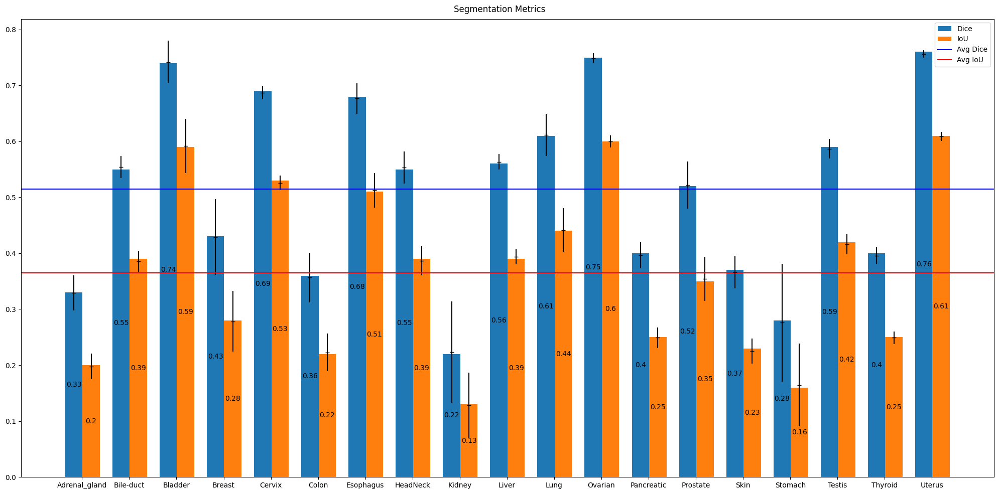

In [148]:
plt.figure(figsize=(20,10))

totaldice = []
totaliou = []
tindex=0

colors = plt.rcParams["axes.prop_cycle"]()

for t in range(len(segs_results)):
    exp_indexes = []
    for j in range(int(len(segs_results[t])/n_tasks)):
        exp_indexes.append((n_tasks*(j+1))-1)
        
    mseg = np.mean([1-ite[i_metric] for ite in np.array(segs_results[t])[exp_indexes]])
    dseg = np.std([1-ite[i_metric] for ite in np.array(segs_results[t])[exp_indexes]])
    totaldice.append(mseg)
    
    p = plt.bar(tindex, np.round(mseg, 2), 1.1, color='#1f77b4', label='Dice')
    plt.bar_label(p, label_type='center')
    plt.errorbar(tindex, mseg, dseg, fmt='_', color='Black')
    # =================
    mseg2 = np.mean([ite[i_metric+1] for ite in np.array(segs_results[t])[exp_indexes]])
    dseg2 = np.std([ite[i_metric+1] for ite in np.array(segs_results[t])[exp_indexes]])
    totaliou.append(mseg2)
    
    p2 = plt.bar(tindex+1.1, np.round(mseg2, 2), 1.1, color='#ff7f0e', label='IoU')
    plt.bar_label(p2, label_type='center')
    plt.errorbar(tindex+1.1, mseg2, dseg2, fmt='_', color='Black')

    #print(t+1, np.round(mseg2, 2), np.round(dseg2, 2), np.round(mseg, 2), np.round(dseg, 2))

    tindex += 3
    
plt.suptitle('Segmentation Metrics')
l = plt.axhline(y=np.mean(totaldice), color='b')
l2 = plt.axhline(y=np.mean(totaliou), color='r')

#plt.legend(['Dice','Std','IoU'], loc='upper right')
plt.legend([p,p2,l,l2], ['Dice','IoU','Avg Dice','Avg IoU'], loc='upper right')
plt.xticks(np.array(range(0, len(segs_results)*3, 3))+0.52, all_types)
plt.tight_layout()

#plt.savefig("modelmetrics.pdf", format="pdf", bbox_inches='tight')
plt.show()

In [60]:
seglosses = [[0.8320,0.7625,0.7212,0.6866,0.6568,0.6312,0.6068,0.5889,0.5695,0.5570],[0.6146,0.5961,0.5866,0.5756,0.5682,0.5595,0.5459,0.5328,0.5157,0.5039],[0.4177,0.4044,0.3886,0.3781,0.3695,0.3617,0.3545,0.3474,0.3416,0.3357],[0.4665,0.4294,0.4054,0.3871,0.3663,0.3480,0.3283,0.3140,0.2943,0.2771],[0.3453,0.2865,0.2673,0.2520,0.2367,0.2216,0.2085,0.1969,0.1868,0.1787],[0.5675,0.5346,0.5209,0.4767,0.4496,0.4329,0.4103,0.3917,0.3759,0.3632],[0.3508,0.2835,0.2514,0.2299,0.2134,0.2015,0.1907,0.1778,0.1673,0.1573],[0.4441,0.3601,0.3247,0.2974,0.2763,0.2573,0.2395,0.2263,0.2139,0.2041],[0.5215,0.4453,0.3944,0.3693,0.3641,0.3508,0.3310,0.3161,0.3025,0.2926],[0.3962,0.3463,0.3239,0.2945,0.2714,0.2584,0.2424,0.2267,0.2145,0.2049],[0.4366,0.3697,0.3251,0.2827,0.2604,0.2410,0.2226,0.2080,0.1957,0.1847],[0.3280,0.2470,0.2321,0.2213,0.2071,0.1985,0.1887,0.1771,0.1691,0.1609],[0.6834,0.6319,0.5724,0.5250,0.4824,0.4462,0.4191,0.3999,0.3818,0.3673],[0.5831,0.3614,0.2738,0.2719,0.2651,0.2468,0.2273,0.2127,0.2041,0.1934],[0.6035,0.4616,0.4149,0.3902,0.3680,0.3503,0.3322,0.3170,0.3052,0.2916],[0.4103,0.3448,0.3048,0.2876,0.2719,0.2577,0.2467,0.2334,0.2223,0.2123],[0.4199,0.3790,0.3363,0.3113,0.2869,0.2686,0.2532,0.2384,0.2263,0.2155],[0.5972,0.5247,0.4528,0.4123,0.3765,0.3357,0.3161,0.2904,0.2705,0.2503],[0.5309,0.3586,0.2971,0.2826,0.2694,0.2508,0.2338,0.2244,0.2176,0.2078]]
segvallos = [[0.7577,0.6960,0.6597,0.6269,0.6072,0.6223,0.5951,0.5448,0.5621,0.5721],[0.6068,0.5747,0.5769,0.5717,0.5730,0.5449,0.5212,0.5185,0.5421,0.5035],[0.3892,0.3379,0.3498,0.3538,0.3341,0.3281,0.3388,0.3385,0.3559,0.3223],[0.4251,0.3930,0.4115,0.3531,0.3585,0.3462,0.3489,0.3346,0.3412,0.3226],[0.3435,0.2842,0.3003,0.2633,0.2565,0.2579,0.2493,0.2668,0.2753,0.2639],[0.5903,0.5601,0.5388,0.4967,0.5403,0.5026,0.5130,0.4632,0.4902,0.4650],[0.2792,0.2555,0.2470,0.2319,0.2239,0.2240,0.2242,0.2159,0.2205,0.2163],[0.3792,0.3795,0.4002,0.3644,0.3850,0.3544,0.3441,0.3796,0.3788,0.3516],[0.4066,0.3563,0.3332,0.3326,0.3237,0.3076,0.3078,0.3084,0.3127,0.3156],[0.3838,0.3721,0.3569,0.3314,0.3214,0.3277,0.3157,0.3221,0.3282,0.3233],[0.3300,0.3108,0.2854,0.2668,0.2596,0.2607,0.2699,0.2890,0.2549,0.3004],[0.2716,0.2692,0.2652,0.2437,0.2370,0.2378,0.2304,0.2232,0.2210,0.2177],[0.7074,0.6242,0.6373,0.6371,0.6333,0.6371,0.6310,0.6392,0.6446,0.6432],[0.3885,0.3113,0.2842,0.2821,0.2763,0.2464,0.2409,0.2409,0.2459,0.2341],[0.6619,0.5794,0.5232,0.5164,0.5117,0.5073,0.5076,0.5008,0.5019,0.5072],[0.2878,0.2550,0.2507,0.2430,0.2411,0.2533,0.2659,0.2415,0.2415,0.2531],[0.3799,0.3768,0.3591,0.3511,0.3601,0.3594,0.3553,0.3671,0.3618,0.3747],[0.5584,0.5047,0.5575,0.4860,0.4415,0.4590,0.4335,0.4509,0.4658,0.4219],[0.4088,0.3055,0.2912,0.2761,0.2888,0.2670,0.2597,0.2542,0.2576,0.2519]]

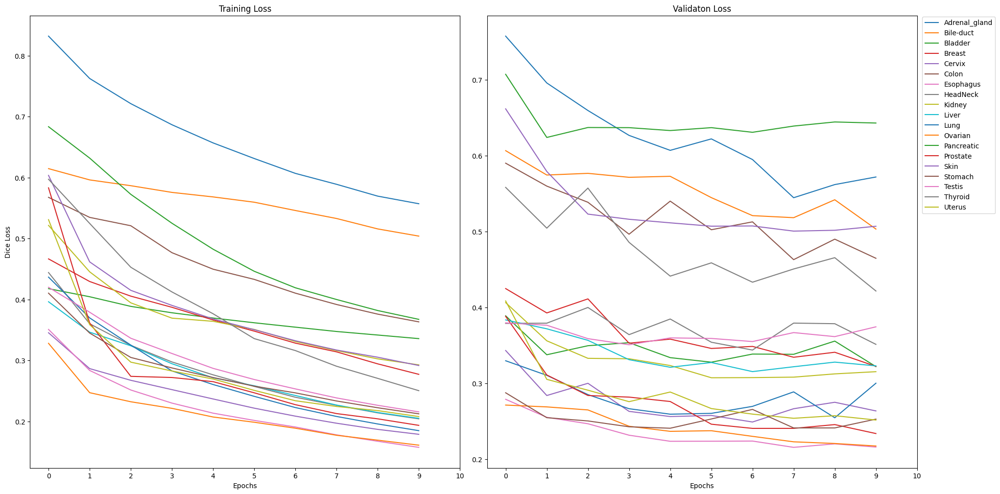

In [64]:
fig, axarr = plt.subplots(1,2, figsize=(20, 10))

for i in range(len(seglosses)):
    p = axarr[0].plot(seglosses[i], label=all_types[i])
    axarr[0].title.set_text('Training Loss')
    axarr[0].set_xticks(range(0,11))
    axarr[1].plot(segvallos[i], label=all_types[i], color=p[0].get_color())
    axarr[1].title.set_text('Validaton Loss')
    axarr[1].set_xticks(range(0,11))

#plt.suptitle('Training and Validation Loss')
#plt.xticks(np.array(range(0, 11)))
plt.legend(loc='upper right', bbox_to_anchor=(1.19, 1.005))
plt.tight_layout()
axarr[0].set_ylabel('Dice Loss')
axarr[0].set_xlabel('Epochs')
axarr[1].set_xlabel('Epochs')
plt.savefig("modelloss.pdf", format="pdf", bbox_inches='tight')
plt.show()

## Continual Learning

In [41]:
#1 - np.round(mas_bar, 2)
#np.round(our_bar, 2)
np.round(np.mean(our_bar), 2)

0.39

In [45]:
#np.round(our_std, 2)
np.round(np.std(our_bar), 2)

0.13

In [65]:
np.array(mas_results[0])[exp_indexes]

array([[0.60025954, 0.58235204, 0.30175161, 0.46225896, 0.34567708,
        0.54010689, 0.79145706],
       [0.59936744, 0.58443642, 0.29483503, 0.4538562 , 0.34670961,
        0.53392351, 0.78931081],
       [0.57979381, 0.56966734, 0.32047582, 0.48394942, 0.34280586,
        0.5921365 , 0.83554441],
       [0.57319325, 0.55353439, 0.35058215, 0.51779205, 0.38104594,
        0.54858595, 0.81152713],
       [0.62673217, 0.60847205, 0.28362843, 0.43991163, 0.34186712,
        0.4699235 , 0.77652174]])

In [67]:
np.array(ours_results[0])[exp_indexes]

array([[0.5636729 , 0.5636729 , 0.28601718, 0.44332978, 0.34644017,
        0.59456182, 0.80577129],
       [0.56766373, 0.56766373, 0.28394184, 0.44099906, 0.31483674,
        0.69356209, 0.82798743],
       [0.62426889, 0.62426889, 0.23646182, 0.38113913, 0.28279185,
        0.56456649, 0.77607667],
       [0.56879807, 0.56879807, 0.28134784, 0.43785417, 0.32012689,
        0.66499794, 0.81866097],
       [0.58499432, 0.58499432, 0.2676636 , 0.42108113, 0.31071126,
        0.62947351, 0.79653543]])

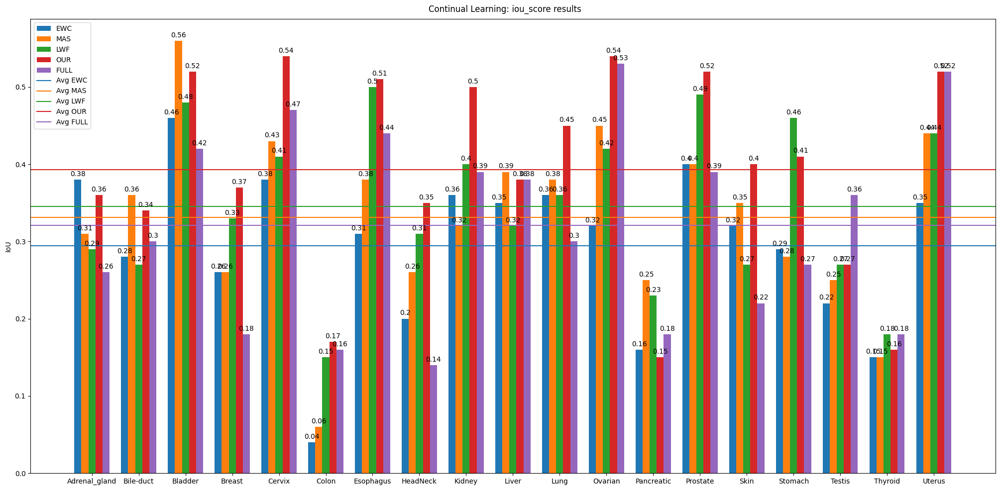

In [38]:
plt.figure(figsize=(20,10))

ewc_bar = []
ewc_std = []
mas_bar = []
mas_std = []
lwf_bar = []
lwf_std = []
cmp_bar = []
cmp_std = []
our_bar = []
our_std = []

for t in range(len(ewc_results)):
    exp_indexes = []
    for j in range(int(len(ours2_results[t])/n_tasks)):
    #for j in range(int(len(ours_results[t])/n_tasks)):
        exp_indexes.append((n_tasks*(j+1))-1)
        
    ewc_bar.append(np.mean([ite[i_metric] for ite in np.array(ewc_results[t])[exp_indexes]]))
    ewc_std.append(np.std([ite[i_metric] for ite in np.array(ewc_results[t])[exp_indexes]]))
    
    mas_bar.append(np.mean([ite[i_metric] for ite in np.array(mas_results[t])[exp_indexes]]))
    mas_std.append(np.std([ite[i_metric] for ite in np.array(mas_results[t])[exp_indexes]]))

    lwf_bar.append(np.mean([ite[i_metric] for ite in np.array(lwf_results[t])[exp_indexes]]))
    lwf_std.append(np.std([ite[i_metric] for ite in np.array(lwf_results[t])[exp_indexes]]))
    
    our_bar.append(np.mean([ite[i_metric] for ite in np.array(ours2_results[t])[exp_indexes]]))
    our_std.append(np.std([ite[i_metric] for ite in np.array(ours2_results[t])[exp_indexes]]))
    
    cmp_bar.append(np.mean([ite[i_metric] for ite in cmp_results[t]]))
    cmp_std.append(np.std([ite[i_metric] for ite in cmp_results[t]]))

x = np.arange(19)  # the label locations
width = 0.15  # the width of the bars
cnt_tsk = 0
# a cada 19 iterações (1 treino completo)
#c = next(colors)["color"]
offset = (width * cnt_tsk) - 0.15
p0 = plt.bar(x + offset, np.round(ewc_bar, 2), width, label='EWC')
plt.bar_label(p0, padding=3)
l0 = plt.axhline(y=np.mean(ewc_bar), color=p0[0].get_facecolor())
cnt_tsk += 1

offset = (width * cnt_tsk) - 0.15
p1 = plt.bar(x + offset, np.round(mas_bar, 2), width, label='MAS')
plt.bar_label(p1, padding=3)
l1 = plt.axhline(y=np.mean(mas_bar), color=p1[0].get_facecolor())
cnt_tsk += 1

offset = (width * cnt_tsk) - 0.15
p2 = plt.bar(x + offset, np.round(lwf_bar, 2), width, label='LWF')
plt.bar_label(p2, padding=3)
l2 = plt.axhline(y=np.mean(lwf_bar), color=p2[0].get_facecolor())
cnt_tsk += 1

offset = (width * cnt_tsk) - 0.15
p3 = plt.bar(x + offset, np.round(our_bar, 2), width, label='OUR')
plt.bar_label(p3, padding=3)
l3 = plt.axhline(y=np.mean(our_bar), color=p3[0].get_facecolor())
cnt_tsk += 1

offset = (width * cnt_tsk) - 0.15
p4 = plt.bar(x + offset, np.round(cmp_bar, 2), width, label='FULL')
plt.bar_label(p4, padding=3)
l4 = plt.axhline(y=np.mean(cmp_bar), color=p4[0].get_facecolor())
cnt_tsk += 1
    
plt.suptitle('Continual Learning: '+exp_metrics[i_metric]+' results')
plt.legend(loc='upper right')
plt.xticks(x + width, all_types)
plt.tight_layout()
#plt.subplots_adjust(top=0.96)
plt.ylabel('IoU')

plt.legend([p0,p1,p2,p3,p4,l0,l1,l2,l3,l4], ['EWC','MAS','LWF','OUR','FULL','Avg EWC','Avg MAS','Avg LWF','Avg OUR','Avg FULL'], loc='upper left')

plt.savefig("continualmetrics.pdf", format="pdf", bbox_inches='tight')

plt.show()

In [49]:
ar_wt = (-0.0)+(0.09)+(0.11)+(0.04)+(0.08)+(0.0)+(0.05)+(0.02)+(0.02)+(0.04)+(0.01)+(0.01)+(0.01)+(-0.01)+(0.05)+(0.01)+(0.01)+(0.0)+(0.0)
np.round(ar_wt/19, 2)

0.03

Adrenal_gland EWC 0.0 0.02 + 0.05 MAS 0.0 -0.02 + 0.04 LWF 0.0 -0.08 + 0.03 OUR 0.0 -0.0 + 0.03
Bile-duct EWC -0.04 0.03 + 0.03 MAS -0.07 0.09 + 0.05 LWF -0.05 0.03 + 0.03 OUR -0.07 0.09 + 0.03
Bladder EWC 0.0 0.05 + 0.04 MAS 0.04 0.07 + 0.05 LWF -0.02 0.08 + 0.05 OUR -0.04 0.11 + 0.05
Breast EWC 0.07 0.03 + 0.03 MAS 0.07 -0.07 + 0.04 LWF 0.1 0.03 + 0.03 OUR 0.12 0.04 + 0.03
Cervix EWC -0.14 0.03 + 0.04 MAS -0.13 0.0 + 0.04 LWF -0.1 0.01 + 0.03 OUR -0.03 0.08 + 0.05
Colon EWC -0.13 -0.03 + 0.01 MAS -0.11 -0.09 + 0.03 LWF -0.06 0.01 + 0.04 OUR -0.06 0.0 + 0.04
Esophagus EWC -0.14 -0.05 + 0.05 MAS -0.11 -0.04 + 0.05 LWF 0.04 0.0 + 0.04 OUR -0.0 0.05 + 0.04
HeadNeck EWC 0.07 0.02 + 0.03 MAS 0.07 0.03 + 0.03 LWF 0.17 -0.02 + 0.03 OUR 0.16 0.02 + 0.04
Kidney EWC -0.11 0.06 + 0.04 MAS -0.05 -0.06 + 0.04 LWF -0.0 0.0 + 0.03 OUR 0.07 0.02 + 0.05
Liver EWC -0.09 0.03 + 0.04 MAS -0.07 0.05 + 0.05 LWF -0.05 -0.01 + 0.03 OUR -0.04 0.04 + 0.03
Lung EWC 0.01 0.04 + 0.04 MAS 0.04 -0.0 + 0.05 LWF 0.06

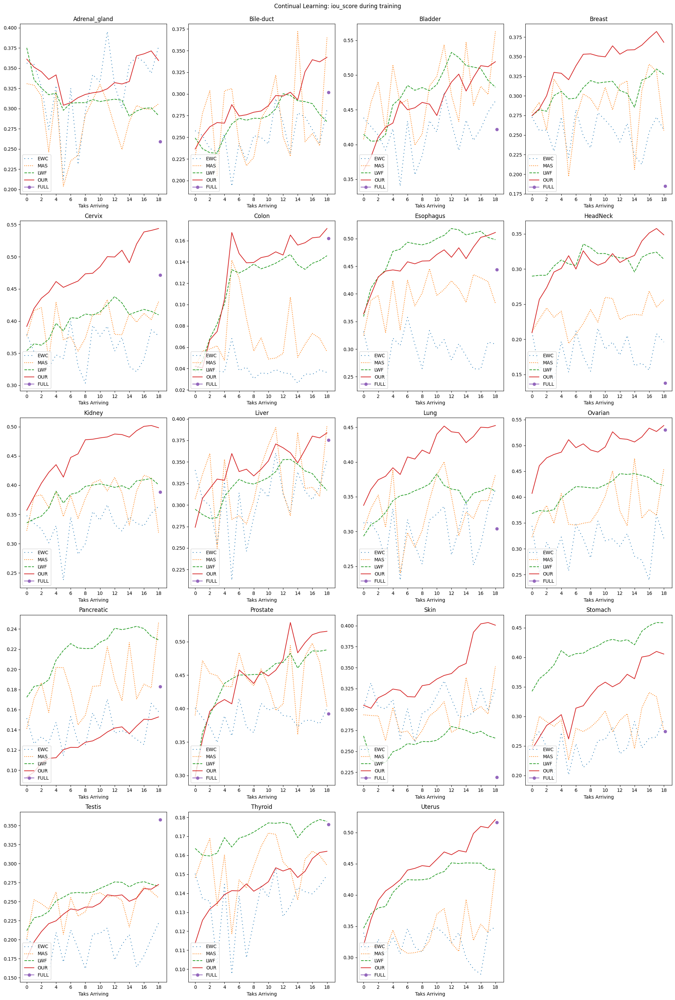

In [25]:
fig, axarr = plt.subplots(5,4, figsize=(20, 30))
#fig.delaxes(axarr[4,2])
fig.delaxes(axarr[4,3])
figi = 0
figj = 0
colors = plt.rcParams["axes.prop_cycle"]()


#plt.figure(figsize=(20,10))

cnt_tsk = 0
for t in range(len(ewc_results)):
    exp_indexes = []
    for j in range(int(len(ewc_results[t])/n_tasks)):
        exp_indexes.append((n_tasks*(j+1))-1)

    # a cada 19 iterações (1 treino completo)
    #plt.plot(exp_indexes, [ite[i_metric] for ite in np.array(ewc_results[t])[exp_indexes]], label='EWC_'+all_types[t]+'_'+exp_metrics[i_metric], color='b')
    #plt.plot(exp_indexes, [ite[i_metric] for ite in np.array(mas_results[t])[exp_indexes]], label='MAS_'+all_types[t]+'_'+exp_metrics[i_metric], color='r')

    # media de todas as iteracoes na ordem de treinamento (movimento da metrica ao longo dos 19 treinamentos)
    aux_ewc = []
    aux_mas = []
    aux_lwf = []
    aux_our = []
    #aux_ful = []
    icomeco = 0
    for k in range(len(exp_indexes)):
        ifim = exp_indexes[k]+1
        aux_ewc.append([ite[i_metric] for ite in ewc_results[t][icomeco:ifim]])
        aux_mas.append([ite[i_metric] for ite in mas_results[t][icomeco:ifim]])
        aux_lwf.append([ite[i_metric] for ite in lwf_results[t][icomeco:ifim]])
        aux_our.append([ite[i_metric] for ite in ours2_results[t][icomeco:ifim]])
        #aux_ful.append([ite[i_metric] for ite in cmp_results[t][icomeco:ifim]])
        icomeco = ifim

    res_ewc = np.mean(aux_ewc, axis=0) # '+',np.round(np.std(aux_ewc), 2),
    res_mas = np.mean(aux_mas, axis=0) # '+',np.round(np.std(aux_mas), 2),
    res_lwf = np.mean(aux_lwf, axis=0) # '+',np.round(np.std(aux_lwf), 2),
    res_our = np.mean(aux_our, axis=0) # '+',np.round(np.std(aux_our), 2),
    res_cmp = np.mean([ite[i_metric] for ite in cmp_results[t]])
    
    print(all_types[t], 
        'EWC', np.round((res_cmp if t==0 else res_ewc[t-1]) - res_cmp, 2), np.round(res_ewc[-1] - res_ewc[t], 2),'+',np.round(np.std(aux_ewc), 2),
        'MAS', np.round((res_cmp if t==0 else res_mas[t-1]) - res_cmp, 2), np.round(res_mas[-1] - res_mas[t], 2),'+',np.round(np.std(aux_mas), 2),
        'LWF', np.round((res_cmp if t==0 else res_lwf[t-1]) - res_cmp, 2), np.round(res_lwf[-1] - res_lwf[t], 2),'+',np.round(np.std(aux_lwf), 2),
        'OUR', np.round((res_cmp if t==0 else res_our[t-1]) - res_cmp, 2), np.round(res_our[-1] - res_our[t], 2),'+',np.round(np.std(aux_our), 2),
    ) # tipo, fwt, bwt
    
    axarr[figi][figj].title.set_text(all_types[t])
    c = next(colors)["color"]
    axarr[figi][figj].plot(res_ewc, label='EWC', linestyle=(0, (1, 4)), color='tab:blue')
    axarr[figi][figj].plot(res_mas, label='MAS', linestyle='dotted', color='tab:orange')
    axarr[figi][figj].plot(res_lwf, label='LWF', linestyle='dashed', color='tab:green')
    axarr[figi][figj].plot(res_our, label='OUR', linestyle='solid', color='tab:red')
    axarr[figi][figj].plot([18.2], res_cmp, marker='o', label='FULL', color='tab:purple')
    axarr[figi][figj].set_xticks(range(0,20,2))
    axarr[figi][figj].legend(loc='lower left')
    axarr[figi][figj].set_xlabel('Taks Arriving')
    #axarr[figi][figj].set_ylabel('IoU')

    #print(all_types[t], figi, figj)
    if (figj + 1) == 4:
        figi = (figi + 1) % 5
    figj = (figj + 1) % 4
    # tudo em 1 plot
    #p = plt.plot(np.mean(aux_ewc, axis=0), label='EWC_'+all_types[t], linestyle='solid')
    #plt.plot(np.mean(aux_mas, axis=0), label='MAS_'+all_types[t], linestyle='dashed', color=p[0].get_color())
    #plt.plot([18.2], np.mean([ite[i_metric] for ite in cmp_results[t]]), marker='o', label='CMP_'+all_types[t], color=p[0].get_color())
    #plt.axhline(y=np.mean([ite[i_metric] for ite in cmp_results[t]]), label='CMP_'+all_types[t]+'_'+exp_metrics[i_metric], color=p[0].get_color())
    
    # primeira iteração
    #plt.plot([ite[i_metric] for ite in ewc_results[t][:n_tasks]], label='EWC_'+all_types[t]+'_'+exp_metrics[i_metric])
    #plt.plot([ite[i_metric] for ite in mas_results[t][:n_tasks]], label='MAS_'+all_types[t]+'_'+exp_metrics[i_metric])

    # todas as iterações
    #plt.plot([ite[i_metric] for ite in ewc_results[t]], label='EWC_'+all_types[t]+'_'+exp_metrics[i_metric])
    #plt.plot([ite[i_metric] for ite in mas_results[t]], label='MAS_'+all_types[t]+'_'+exp_metrics[i_metric])
    #if cnt_tsk > 5:
    #    break
    cnt_tsk += 1

plt.suptitle('Continual Learning: '+exp_metrics[i_metric]+' during training')
#plt.legend(loc='upper right', bbox_to_anchor=(1.13, 1.01))
#plt.xticks(exp_indexes)
#plt.xticks(list(range(0,191,19)))
#plt.xticks(list(range(0,20)))
plt.tight_layout()
plt.subplots_adjust(top=0.96)

plt.savefig("continualtraining.pdf", format="pdf", bbox_inches='tight')

plt.show()
#plt.savefig('test.png', bbox_inches='tight')

In [53]:
#np.mean(aux_our, axis=0)
#np.mean(aux_mas, axis=0)[18] - np.mean([ite[i_metric] for ite in cmp_results[t]]) # fwt
np.mean(aux_our, axis=0)[18] - np.mean(aux_our, axis=0)[17] # bwt

0.013234308362007119

## Ouput Analysis

In [26]:
quicktest = build_new_model2(styled=False)
quickopt = keras.optimizers.Adam(LR)

In [140]:
iou_score_met = sm.metrics.IOUScore(threshold=0.5)
recall_score = sm.metrics.Recall()

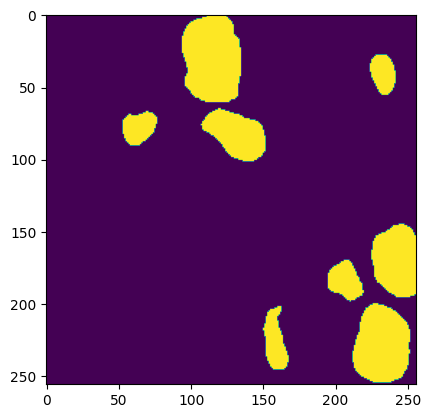

In [137]:
plt.imshow(task_list[17][1][0][1][21])

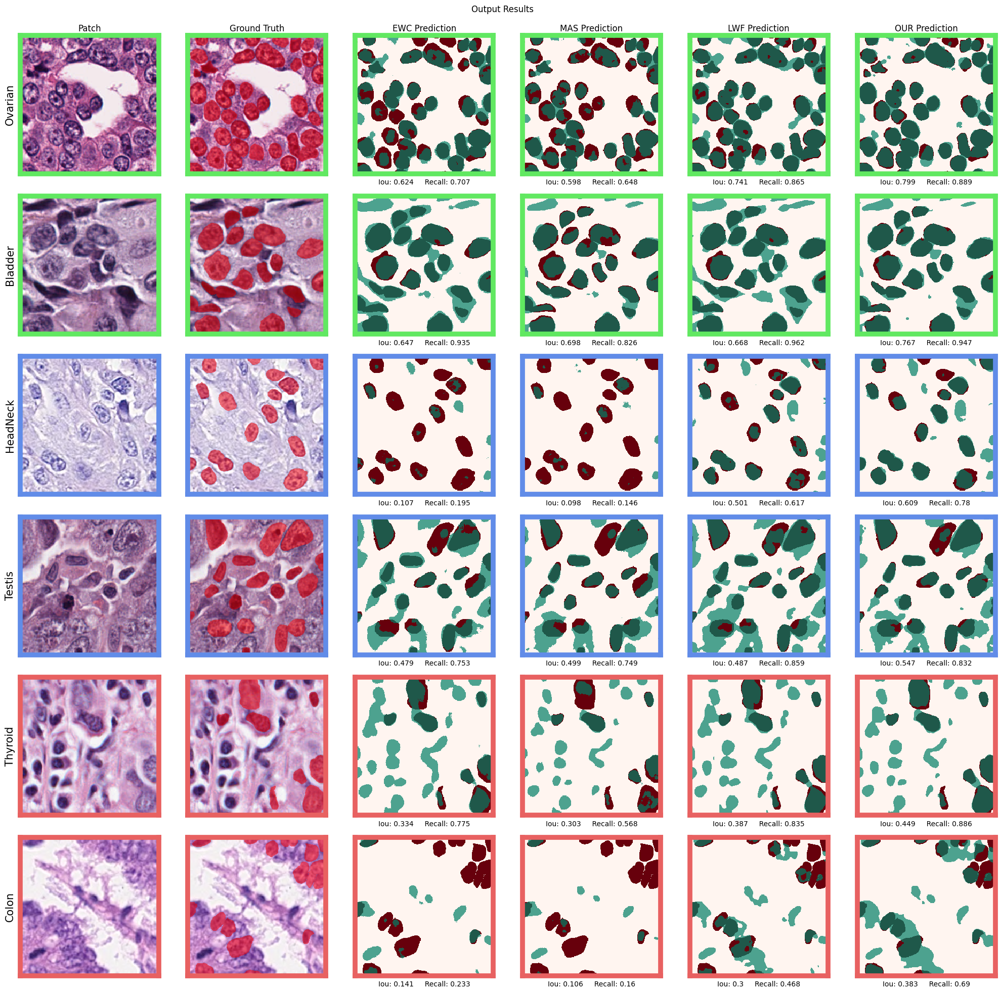

In [148]:
fig, axarr = plt.subplots(6,6, figsize=(20, 20)) # larg, alt

tipos = [11,2,7,16,17,5]
indexes_print = [1,17,15,12,21,1]

plt.suptitle('Output Results')
plt.tight_layout()
plt.subplots_adjust(top=0.95)

axarr[0][0].title.set_text('Patch')
axarr[0][1].title.set_text('Ground Truth')
axarr[0][2].title.set_text('EWC Prediction')
axarr[0][3].title.set_text('MAS Prediction')
axarr[0][4].title.set_text('LWF Prediction')
axarr[0][5].title.set_text('OUR Prediction')

for i in range(6):
    color = '#61e861'
    if i >= 2:
        color = '#618ce8'
    if i >= 4:
        color = '#e86161'
    for j in range(6):
        axarr[i][j].set_xticks([])
        axarr[i][j].set_yticks([])
        axarr[i][j].spines['bottom'].set_color(color)
        axarr[i][j].spines['bottom'].set_linewidth(7)
        axarr[i][j].spines['top'].set_color(color)
        axarr[i][j].spines['top'].set_linewidth(7)
        axarr[i][j].spines['right'].set_color(color)
        axarr[i][j].spines['right'].set_linewidth(7)
        axarr[i][j].spines['left'].set_color(color)
        axarr[i][j].spines['left'].set_linewidth(7)

# tipo, train/val, batch, img/msk, index
tipo = tipos[0]
fig1 = task_list[tipo][1][0][0][indexes_print[0]]
msk1 = task_list[tipo][1][0][1][indexes_print[0]]
axarr[0][0].set_ylabel(all_types[tipo], fontsize=15)
#axarr[0][0].yaxis.label.set_color('#61e861')
axarr[0][0].imshow(fig1, cmap='viridis', interpolation='None')
axarr[0][1].imshow(fig1, cmap='viridis', interpolation='None')
axarr[0][1].imshow(maskImg2(msk1, 0.0), alpha=0.5, cmap='autumn', interpolation='None')

tipo = tipos[1]
fig1 = task_list[tipo][1][0][0][indexes_print[1]]
msk1 = task_list[tipo][1][0][1][indexes_print[1]]
axarr[1][0].set_ylabel(all_types[tipo], fontsize=15)
axarr[1][0].imshow(fig1, cmap='viridis', interpolation='None')
axarr[1][1].imshow(fig1, cmap='viridis', interpolation='None')
axarr[1][1].imshow(maskImg2(msk1, 0.0), alpha=0.5, cmap='autumn', interpolation='None')

tipo = tipos[2]
fig1 = task_list[tipo][1][0][0][indexes_print[2]]
msk1 = task_list[tipo][1][0][1][indexes_print[2]]
axarr[2][0].set_ylabel(all_types[tipo], fontsize=15)
axarr[2][0].imshow(fig1, cmap='viridis', interpolation='None')
axarr[2][1].imshow(fig1, cmap='viridis', interpolation='None')
axarr[2][1].imshow(maskImg2(msk1, 0.0), alpha=0.5, cmap='autumn', interpolation='None')

tipo = tipos[3]
fig1 = task_list[tipo][1][0][0][indexes_print[3]]
msk1 = task_list[tipo][1][0][1][indexes_print[3]]
axarr[3][0].set_ylabel(all_types[tipo], fontsize=15)
axarr[3][0].imshow(fig1, cmap='viridis', interpolation='None')
axarr[3][1].imshow(fig1, cmap='viridis', interpolation='None')
axarr[3][1].imshow(maskImg2(msk1, 0.0), alpha=0.5, cmap='autumn', interpolation='None')

tipo = tipos[4]
fig1 = task_list[tipo][1][0][0][indexes_print[4]]
msk1 = task_list[tipo][1][0][1][indexes_print[4]]
axarr[4][0].set_ylabel(all_types[tipo], fontsize=15)
axarr[4][0].imshow(fig1, cmap='viridis', interpolation='None')
axarr[4][1].imshow(fig1, cmap='viridis', interpolation='None')
axarr[4][1].imshow(maskImg2(msk1, 0.0), alpha=0.5, cmap='autumn', interpolation='None')

tipo = tipos[5]
fig1 = task_list[tipo][1][0][0][indexes_print[5]]
msk1 = task_list[tipo][1][0][1][indexes_print[5]]
axarr[5][0].set_ylabel(all_types[tipo], fontsize=15)
axarr[5][0].imshow(fig1, cmap='viridis', interpolation='None')
axarr[5][1].imshow(fig1, cmap='viridis', interpolation='None')
axarr[5][1].imshow(maskImg2(msk1, 0.0), alpha=0.5, cmap='autumn', interpolation='None')

quicktest.load_weights('ewc_baseline.h5')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
for j in range(len(indexes_print)):
    fig1 = task_list[tipos[j]][1][0][0][indexes_print[j]]
    msk1 = task_list[tipos[j]][1][0][1][indexes_print[j]]
    pred1 = quicktest(np.array([fig1]))[0].numpy()
    axarr[j][2].imshow(msk1, cmap='Reds', interpolation='None')
    axarr[j][2].imshow(maskImg2(pred1, 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
    ls = iou_score_met(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    ls2 = recall_score(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    axarr[j][2].set_xlabel('Iou: '+str(np.round(ls, 3))+'     Recall: '+str(np.round(ls2, 3)))#, fontsize=15)

quicktest.load_weights('mas_baseline.h5')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
for j in range(len(indexes_print)):
    fig1 = task_list[tipos[j]][1][0][0][indexes_print[j]]
    msk1 = task_list[tipos[j]][1][0][1][indexes_print[j]]
    pred1 = quicktest(np.array([fig1]))[0].numpy()
    axarr[j][3].imshow(msk1, cmap='Reds', interpolation='None')
    axarr[j][3].imshow(maskImg2(pred1, 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
    ls = iou_score_met(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    ls2 = recall_score(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    axarr[j][3].set_xlabel('Iou: '+str(np.round(ls, 3))+'     Recall: '+str(np.round(ls2, 3)))#, fontsize=15)

quicktest.load_weights('lwf_baseline.h5')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
for j in range(len(indexes_print)):
    fig1 = task_list[tipos[j]][1][0][0][indexes_print[j]]
    msk1 = task_list[tipos[j]][1][0][1][indexes_print[j]]
    pred1 = quicktest(np.array([fig1]))[0].numpy()
    axarr[j][4].imshow(msk1, cmap='Reds', interpolation='None')
    axarr[j][4].imshow(maskImg2(pred1, 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
    ls = iou_score_met(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    ls2 = recall_score(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    axarr[j][4].set_xlabel('Iou: '+str(np.round(ls, 3))+'     Recall: '+str(np.round(ls2, 3)))#, fontsize=15)

quicktest.load_weights('our_baseline.h5')
quicktest.compile(loss=total_loss, optimizer=quickopt, metrics=metrics)
for j in range(len(indexes_print)):
    fig1 = task_list[tipos[j]][1][0][0][indexes_print[j]]
    msk1 = task_list[tipos[j]][1][0][1][indexes_print[j]]
    pred1 = quicktest(np.array([fig1]))[0].numpy()
    axarr[j][5].imshow(msk1, cmap='Reds', interpolation='None')
    axarr[j][5].imshow(maskImg2(pred1, 0.5, 0.5), alpha=0.7, cmap='summer', interpolation='None')
    ls = iou_score_met(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    ls2 = recall_score(tf.Variable(np.array([msk1]), dtype='float32'), np.array([pred1])).numpy()
    axarr[j][5].set_xlabel('Iou: '+str(np.round(ls, 3))+'     Recall: '+str(np.round(ls2, 3)))#, fontsize=15)

plt.savefig("outputresults_recall.pdf", format="pdf", bbox_inches='tight')

plt.show()